<a href="https://colab.research.google.com/github/lamide-xxx/Deepfake-Detection/blob/main/FakeAVCeleb_Audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Mount Google Drive**

In [1]:
#Mount Google Drive on Notebook
from google.colab import drive
drive.mount('/content/drive')#, force_remount = True)

Mounted at /content/drive


# Data Preprocessing

The data is shared with me on my drive, so I first create a shortcut on my drive.

In [ ]:
# Change the directory and unzip it
import os
os.chdir('/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos')  #change dir
!unzip -o FakeAVCeleb_v1.2.zip -d .  #unzip data, a folder train/ will be created

unzip:  cannot find or open FakeAVCeleb_v1.2.zip, FakeAVCeleb_v1.2.zip.zip or FakeAVCeleb_v1.2.zip.ZIP.


Extract Infromation on the files from the metadatafile

In [ ]:
# import pandas module 
import pandas as pd 
from collections import OrderedDict,defaultdict

import os
os.chdir('/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos/FakeAVCeleb')  #change dir
    
# making dataframe 
df = pd.read_csv("meta_data.csv") 
   
# output the dataframe
print(df.columns)

#rename columNs as there is an error form the source
df.rename(columns={"path":"filename", 'Unnamed: 9': "path"}, inplace = True)

# output the dataframe
print(df.columns)

print("There are ", len(df.index)," videos is total")

df.groupby(["category","race","gender"])["path"].unique()
# for n,g in df.groupby(["category","race","gender",df.path[:-7]]):
#   print ("n is ",n, " with length",len(g))





Index(['source', 'target1', 'target2', 'method', 'category', 'type', 'race',
       'gender', 'path', 'Unnamed: 9'],
      dtype='object')
Index(['source', 'target1', 'target2', 'method', 'category', 'type', 'race',
       'gender', 'filename', 'path'],
      dtype='object')
There are  21566  videos is total


category  race                  gender
A         African               men       [FakeAVCeleb/RealVideo-RealAudio/African/men/i...
                                women     [FakeAVCeleb/RealVideo-RealAudio/African/women...
          Asian (East)          men       [FakeAVCeleb/RealVideo-RealAudio/Asian (East)/...
                                women     [FakeAVCeleb/RealVideo-RealAudio/Asian (East)/...
          Asian (South)         men       [FakeAVCeleb/RealVideo-RealAudio/Asian (South)...
                                women     [FakeAVCeleb/RealVideo-RealAudio/Asian (South)...
          Caucasian (American)  men       [FakeAVCeleb/RealVideo-RealAudio/Caucasian (Am...
                                women     [FakeAVCeleb/RealVideo-RealAudio/Caucasian (Am...
          Caucasian (European)  men       [FakeAVCeleb/RealVideo-RealAudio/Caucasian (Eu...
                                women     [FakeAVCeleb/RealVideo-RealAudio/Caucasian (Eu...
B         African               men      

Splitting the data.

Going with a training:validation:test split of 80:10:10

In [ ]:
import math
#pd.set_option('display.width', None)
#pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', -1) # display maximum column width
groups = (df.groupby(["category","race","gender"])["path"].unique()) #get the list of people in each folder
print(groups)
ans = []
d = {}

#split each folder into train:val:test
for group in groups:
  n = len(group)
  train = math.floor(n*0.8)
  val = math.floor(n*0.1) + train
  test = n
  
  #get train batch
  for path in group[:train]:
    d[path] = "train"
  
  #get val batch
  for path in group[train:val]:
    d[path] = "val"

  #label test batch
  for path in group[val:]:
    d[path] = "test"

category  race                  gender
A         African               men       [FakeAVCeleb/RealVideo-RealAudio/African/men/id00076, FakeAVCeleb/RealVideo-RealAudio/African/men/id00166, FakeAVCeleb/RealVideo-RealAudio/African/men/id00173, FakeAVCeleb/RealVideo-RealAudio/African/men/id00366, FakeAVCeleb/RealVideo-RealAudio/African/men/id00391, FakeAVCeleb/RealVideo-RealAudio/African/men/id00475, FakeAVCeleb/RealVideo-RealAudio/African/men/id00476, FakeAVCeleb/RealVideo-RealAudio/African/men/id00478, FakeAVCeleb/RealVideo-RealAudio/African/men/id00518, FakeAVCeleb/RealVideo-RealAudio/African/men/id00701, FakeAVCeleb/RealVideo-RealAudio/African/men/id00761, FakeAVCeleb/RealVideo-RealAudio/African/men/id00781, FakeAVCeleb/RealVideo-RealAudio/African/men/id00830, FakeAVCeleb/RealVideo-RealAudio/African/men/id00944, FakeAVCeleb/RealVideo-RealAudio/African/men/id00987, FakeAVCeleb/RealVideo-RealAudio/African/men/id01036, FakeAVCeleb/RealVideo-RealAudio/African/men/id01076, FakeAVCeleb/RealV

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  after removing the cwd from sys.path.


In [ ]:
#sort the dataframe
df.sort_values(by=['category', 'race','gender','path'], ascending=True, inplace = True)

split =[]
for path in df["path"]:
  split.append(d[path])


Now merge this splits with the dataframe for further processing

In [ ]:
df["split"] = split


# Splitting files in the drive

Create the relevant folder structure




In [ ]:
# create the required folders
import os, shutil
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos'

train_dir = os.path.join(gdrive_dir,'train')
val_dir   = os.path.join(gdrive_dir,'val')
test_dir  = os.path.join(gdrive_dir,'test')
if not os.path.exists(train_dir):
  os.mkdir(train_dir)
if not os.path.exists(val_dir):
  os.mkdir(val_dir)
if not os.path.exists(test_dir):
  os.mkdir(test_dir)

categories = ["RealVideo-RealAudio","RealVideo-FakeAudio","FakeVideo-RealAudio","FakeVideo-FakeAudio"]
races = ["African","Asian (East)","Asian (South)","Caucasian (American)","Caucasian (European)"]
genders = ["men","women"]

for path in [train_dir,val_dir,test_dir]:
  for category in categories:
    category_folder = os.path.join(path,category)
    if not os.path.exists(category_folder):
      os.mkdir(category_folder)
    for race in races:
      race_folder = os.path.join(category_folder,race)
      if not os.path.exists(race_folder):
        os.mkdir(race_folder)
      for gender in genders:
        gender_folder = os.path.join(race_folder,gender)
        if not os.path.exists(gender_folder):
          os.mkdir(gender_folder)



Now that the relevant folders are made, we need to copy videos across.

In [ ]:
# Sorting files into training folders
import os, shutil
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos'
base_dir = gdrive_dir+ "/"
exceptions= []
copied = 0
for _,row in df.iterrows():
  # construct full file path
  source = os.path.join(base_dir+row["path"], row["filename"])
  destination = os.path.join(base_dir+row["split"], row["path"][12:])

  # copy only files
  if os.path.isfile(source):
    if not os.path.exists(destination):
      os.mkdir(destination)

    shutil.copy(source, destination)
    copied+=1
    print('copied ', row["path"],"/", row["filename"])
  else:
    exceptions.append(source)

print("\nSUCCESSFULLY COPIED ", copied, " FILES\n")
print("COULD NOT FIND THE FOLLOWING: ")
print(exceptions)


Streaming output truncated to the last 5000 lines.
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id04582_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id06232_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id06439_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id06752_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id07008_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id07051_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id07377_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07136 / 00052_id07689_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (South)/women/id07236 / 00143_id05435_OvX-Jv_whcU_faceswap_id04529_wavtolip.mp4
copied  FakeAVCeleb/FakeVideo-FakeAudio/Asian (

# Preparing the Videos

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)
df[["path","filename","split"]]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  This is separate from the ipykernel package so we can avoid doing imports until


,path,filename,split
0,FakeAVCeleb/RealVideo-RealAudio/African/men/id00076,00109.mp4,train
1,FakeAVCeleb/RealVideo-RealAudio/African/men/id00166,00010.mp4,train
2,FakeAVCeleb/RealVideo-RealAudio/African/men/id00173,00118.mp4,train
3,FakeAVCeleb/RealVideo-RealAudio/African/men/id00366,00118.mp4,train
4,FakeAVCeleb/RealVideo-RealAudio/African/men/id00391,00052.mp4,train
5,FakeAVCeleb/RealVideo-RealAudio/African/men/id00475,00099.mp4,train
6,FakeAVCeleb/RealVideo-RealAudio/African/men/id00476,00109.mp4,train
7,FakeAVCeleb/RealVideo-RealAudio/African/men/id00478,00206.mp4,train
8,FakeAVCeleb/RealVideo-RealAudio/African/men/id00518,00031.mp4,train
9,FakeAVCeleb/RealVideo-RealAudio/African/men/id00701,00092.mp4,train


Adding tags to the videos

In [ ]:
tags = []
for row in df["path"]:
  if "FakeAudio" in row:
    tags.append(1)      # Represent deepfakes with a value of 1
  else:
    tags.append(0)    #Represent normal videos with a value of 0
df["tag"] = tags

Import the required libraries

In [ ]:
import cv2     # for capturing videos
import math   # for mathematical operations
import matplotlib.pyplot as plt    # for plotting the images
import pandas as pd
from keras.preprocessing import image   # for preprocessing the images
import numpy as np    # for mathematical operations
from keras.utils import np_utils
from skimage.transform import resize   # for resizing images
from glob import glob
from tqdm import tqdm    # to show progress

create list of train,val and test videos

In [ ]:

tmpdf = df[["path","filename","split","tag"]]
train_df = df.loc[tmpdf["split"]=="train"]
val_df = df.loc[tmpdf["split"]=="val"]
test_df = df.loc[tmpdf["split"]=="test"]

print(len(train_df))
print(len(val_df))
print(len(test_df))

17472
2078
2016


In [ ]:
train_df

video = []
for _,i in train_df.iterrows():
  video.append(os.path.join(i[9][12:],i[8]))
train_df["video"] = video
train_df = train_df[["video","tag"]]
train_df

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,video,tag
0,RealVideo-RealAudio/African/men/id00076/00109.mp4,0
1,RealVideo-RealAudio/African/men/id00166/00010.mp4,0
2,RealVideo-RealAudio/African/men/id00173/00118.mp4,0
3,RealVideo-RealAudio/African/men/id00366/00118.mp4,0
4,RealVideo-RealAudio/African/men/id00391/00052.mp4,0
5,RealVideo-RealAudio/African/men/id00475/00099.mp4,0
6,RealVideo-RealAudio/African/men/id00476/00109.mp4,0
7,RealVideo-RealAudio/African/men/id00478/00206.mp4,0
8,RealVideo-RealAudio/African/men/id00518/00031.mp4,0
9,RealVideo-RealAudio/African/men/id00701/00092.mp4,0


Extracting audio from the train videos

In [ ]:
from moviepy.editor import *
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
os.chdir(os.path.join('/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos/train/'))
for i in tqdm(range(train_df.shape[0])):
  videoFile=list(train_df["video"])[i]
  tag=list(train_df["tag"])[i]

  vid_path = videoFile
  new_path = gdrive_dir+ "/train_1/"+"%d_"%tag+"".join(videoFile.split('/'))+".wav"

  video = VideoFileClip(vid_path) # 2.
  audio = video.audio # 3.
  audio.write_audiofile(new_path) # 4.



  0%|          | 0/17472 [00:00<?, ?it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0007600109.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3221.66it/s]

[MoviePy] Done.



  0%|          | 1/17472 [00:00<1:04:54,  4.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0016600010.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3188.67it/s]

[MoviePy] Done.



  0%|          | 2/17472 [00:00<2:15:57,  2.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0017300118.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3061.65it/s]

[MoviePy] Done.



  0%|          | 3/17472 [00:01<2:32:51,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0036600118.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 2619.86it/s]

[MoviePy] Done.



  0%|          | 4/17472 [00:02<2:47:00,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0039100052.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3206.34it/s]

[MoviePy] Done.



  0%|          | 5/17472 [00:02<2:59:25,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0047500099.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3190.18it/s]

[MoviePy] Done.



  0%|          | 6/17472 [00:03<3:08:52,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0047600109.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3217.08it/s]

[MoviePy] Done.



  0%|          | 7/17472 [00:04<3:10:41,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0047800206.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3226.31it/s]

[MoviePy] Done.



  0%|          | 8/17472 [00:04<3:09:37,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0051800031.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3310.77it/s]

[MoviePy] Done.



  0%|          | 9/17472 [00:05<3:13:03,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0070100092.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3171.04it/s]

[MoviePy] Done.



  0%|          | 10/17472 [00:06<3:09:25,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0076100072.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3122.63it/s]

[MoviePy] Done.



  0%|          | 11/17472 [00:06<3:04:45,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0078100092.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3337.25it/s]

[MoviePy] Done.



  0%|          | 12/17472 [00:07<3:05:31,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0083000143.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3192.27it/s]

[MoviePy] Done.



  0%|          | 13/17472 [00:08<3:25:39,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0094400135.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3223.04it/s]

[MoviePy] Done.



  0%|          | 14/17472 [00:08<3:18:34,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0098700160.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3246.53it/s]

[MoviePy] Done.



  0%|          | 15/17472 [00:09<3:21:55,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0103600010.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 2956.98it/s]

[MoviePy] Done.



  0%|          | 16/17472 [00:10<3:22:19,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0107600005.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3075.13it/s]

[MoviePy] Done.



  0%|          | 17/17472 [00:11<3:27:32,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0117000021.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2628.16it/s]

[MoviePy] Done.



  0%|          | 18/17472 [00:11<3:33:01,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0117100053.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3240.05it/s]

[MoviePy] Done.



  0%|          | 19/17472 [00:12<3:26:01,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0117900160.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2964.67it/s]

[MoviePy] Done.



  0%|          | 20/17472 [00:13<3:15:35,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0120700320.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3122.05it/s]

[MoviePy] Done.



  0%|          | 21/17472 [00:13<3:18:07,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0123600005.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2893.25it/s]

[MoviePy] Done.



  0%|          | 22/17472 [00:14<3:11:13,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0139200167.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3096.98it/s]

[MoviePy] Done.



  0%|          | 23/17472 [00:15<3:24:20,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0145200001.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2892.90it/s]

[MoviePy] Done.



  0%|          | 24/17472 [00:15<3:15:54,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0152100109.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3274.49it/s]

[MoviePy] Done.



  0%|          | 25/17472 [00:16<3:23:46,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0152800017.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3033.85it/s]

[MoviePy] Done.



  0%|          | 26/17472 [00:17<3:16:18,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0153000002.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3036.60it/s]

[MoviePy] Done.



  0%|          | 27/17472 [00:17<3:17:59,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0154400044.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3135.33it/s]

[MoviePy] Done.



  0%|          | 28/17472 [00:18<3:15:05,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0159700005.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3021.42it/s]

[MoviePy] Done.



  0%|          | 29/17472 [00:19<3:14:36,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0159800044.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3074.19it/s]

[MoviePy] Done.



  0%|          | 30/17472 [00:19<3:24:18,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0161000090.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3206.19it/s]

[MoviePy] Done.



  0%|          | 31/17472 [00:20<3:20:40,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0163700002.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2947.21it/s]

[MoviePy] Done.



  0%|          | 32/17472 [00:21<3:19:59,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0169100045.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3140.39it/s]

[MoviePy] Done.



  0%|          | 33/17472 [00:21<3:16:53,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0171700005.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3210.59it/s]

[MoviePy] Done.



  0%|          | 34/17472 [00:22<3:14:22,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0177900010.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2947.01it/s]

[MoviePy] Done.



  0%|          | 35/17472 [00:23<3:23:37,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0183500130.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2156.43it/s]

[MoviePy] Done.



  0%|          | 36/17472 [00:24<3:22:26,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0185600006.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3215.63it/s]

[MoviePy] Done.



  0%|          | 37/17472 [00:24<3:17:55,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0192000099.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3191.21it/s]

[MoviePy] Done.



  0%|          | 38/17472 [00:25<3:27:48,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0193300028.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3317.15it/s]

[MoviePy] Done.



  0%|          | 39/17472 [00:26<3:18:02,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanmenid0197200078.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3198.69it/s]

[MoviePy] Done.



  0%|          | 40/17472 [00:26<3:16:10,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0022000027.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3247.54it/s]

[MoviePy] Done.



  0%|          | 41/17472 [00:27<3:14:41,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0035900053.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3060.93it/s]

[MoviePy] Done.



  0%|          | 42/17472 [00:28<3:12:01,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0037100099.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3065.05it/s]

[MoviePy] Done.



  0%|          | 43/17472 [00:28<3:12:55,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0046000005.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3099.41it/s]

[MoviePy] Done.



  0%|          | 44/17472 [00:29<3:13:36,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0056800384.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 3172.02it/s]

[MoviePy] Done.



  0%|          | 45/17472 [00:30<3:13:25,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0057700010.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2972.61it/s]

[MoviePy] Done.



  0%|          | 46/17472 [00:30<3:23:26,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0059200017.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3075.88it/s]

[MoviePy] Done.



  0%|          | 47/17472 [00:31<3:24:08,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0070700052.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3260.10it/s]

[MoviePy] Done.



  0%|          | 48/17472 [00:32<3:29:57,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0082900271.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3053.76it/s]

[MoviePy] Done.



  0%|          | 49/17472 [00:33<3:28:27,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0083200078.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3241.35it/s]

[MoviePy] Done.



  0%|          | 50/17472 [00:33<3:23:42,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0117800028.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2925.29it/s]

[MoviePy] Done.



  0%|          | 51/17472 [00:34<3:17:59,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0153200065.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2974.49it/s]

[MoviePy] Done.



  0%|          | 52/17472 [00:34<3:16:11,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0166100059.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3210.23it/s]

[MoviePy] Done.



  0%|          | 53/17472 [00:35<3:23:51,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0178300015.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3152.04it/s]

[MoviePy] Done.



  0%|          | 54/17472 [00:36<3:26:17,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0183800126.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3132.51it/s]

[MoviePy] Done.



  0%|          | 55/17472 [00:37<3:26:41,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0190700148.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2855.91it/s]

[MoviePy] Done.



  0%|          | 56/17472 [00:37<3:29:52,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0207100195.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3204.81it/s]

[MoviePy] Done.



  0%|          | 57/17472 [00:38<3:31:10,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0230100092.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1912.32it/s]

[MoviePy] Done.



  0%|          | 58/17472 [00:39<3:27:26,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0250800083.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3042.37it/s]

[MoviePy] Done.



  0%|          | 59/17472 [00:40<3:29:28,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0258600042.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3300.54it/s]

[MoviePy] Done.



  0%|          | 60/17472 [00:40<3:25:05,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0261700028.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3173.42it/s]

[MoviePy] Done.



  0%|          | 61/17472 [00:41<3:30:19,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0272100424.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2770.82it/s]

[MoviePy] Done.



  0%|          | 62/17472 [00:42<3:29:37,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0280800056.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3113.56it/s]

[MoviePy] Done.



  0%|          | 63/17472 [00:42<3:23:47,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0282400130.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3134.61it/s]

[MoviePy] Done.



  0%|          | 64/17472 [00:43<3:20:28,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0283800080.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3333.91it/s]

[MoviePy] Done.



  0%|          | 65/17472 [00:44<3:16:21,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0294800298.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3281.04it/s]

[MoviePy] Done.



  0%|          | 66/17472 [00:44<3:12:11,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0310300130.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3322.38it/s]

[MoviePy] Done.



  0%|          | 67/17472 [00:45<3:15:08,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0356900065.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2779.42it/s]

[MoviePy] Done.



  0%|          | 68/17472 [00:46<3:11:51,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0365600052.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3229.10it/s]

[MoviePy] Done.



  0%|          | 69/17472 [00:46<3:11:26,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0365800077.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3009.16it/s]

[MoviePy] Done.



  0%|          | 70/17472 [00:47<3:15:23,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0371300249.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3265.08it/s]

[MoviePy] Done.



  0%|          | 71/17472 [00:48<3:18:51,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0374700273.mp4.wav



100%|██████████| 293/293 [00:00<00:00, 3257.17it/s]

[MoviePy] Done.



  0%|          | 72/17472 [00:49<3:28:05,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0405500001.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3260.38it/s]

[MoviePy] Done.



  0%|          | 73/17472 [00:49<3:24:47,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0424500072.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3044.19it/s]

[MoviePy] Done.



  0%|          | 74/17472 [00:50<3:25:38,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0437400032.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3050.19it/s]

[MoviePy] Done.



  0%|          | 75/17472 [00:51<3:20:47,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0437600181.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2876.58it/s]

[MoviePy] Done.



  0%|          | 76/17472 [00:51<3:21:53,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0443700002.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2971.81it/s]

[MoviePy] Done.



  0%|          | 77/17472 [00:52<3:21:10,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0454000078.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2714.74it/s]

[MoviePy] Done.



  0%|          | 78/17472 [00:53<3:19:32,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0454700052.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3015.32it/s]

[MoviePy] Done.



  0%|          | 79/17472 [00:53<3:22:26,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAfricanwomenid0468900005.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2787.63it/s]

[MoviePy] Done.



  0%|          | 80/17472 [00:54<2:42:44,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0005600028.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3008.75it/s]

[MoviePy] Done.



  0%|          | 81/17472 [00:55<3:36:13,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0012600173.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3038.78it/s]

[MoviePy] Done.



  0%|          | 82/17472 [00:56<3:46:13,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0056000041.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2686.92it/s]

[MoviePy] Done.



  0%|          | 83/17472 [00:56<3:42:21,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0059700019.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3090.00it/s]

[MoviePy] Done.



  0%|          | 84/17472 [00:57<3:34:49,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0074000015.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2982.76it/s]

[MoviePy] Done.



  0%|          | 85/17472 [00:58<3:28:16,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0086300069.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3144.62it/s]

[MoviePy] Done.



  0%|          | 86/17472 [00:58<3:24:57,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0120400092.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2936.47it/s]

[MoviePy] Done.



  0%|          | 87/17472 [00:59<3:22:10,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0121200183.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3134.95it/s]

[MoviePy] Done.



  1%|          | 88/17472 [01:00<3:22:07,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0121500001.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 1799.71it/s]

[MoviePy] Done.



  1%|          | 89/17472 [01:01<3:21:45,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0158900017.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3033.97it/s]

[MoviePy] Done.



  1%|          | 90/17472 [01:01<3:18:49,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0168300052.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2981.76it/s]

[MoviePy] Done.



  1%|          | 91/17472 [01:02<3:12:52,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0233200055.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3010.32it/s]

[MoviePy] Done.



  1%|          | 92/17472 [01:02<3:12:01,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0236500028.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2980.36it/s]

[MoviePy] Done.



  1%|          | 93/17472 [01:03<3:14:04,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0249300073.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3039.10it/s]

[MoviePy] Done.



  1%|          | 94/17472 [01:04<3:14:28,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0255300043.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2951.07it/s]

[MoviePy] Done.



  1%|          | 95/17472 [01:04<3:16:31,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0256102561.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3029.64it/s]

[MoviePy] Done.



  1%|          | 96/17472 [01:05<3:37:13,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0302800466.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3050.43it/s]

[MoviePy] Done.



  1%|          | 97/17472 [01:06<3:29:28,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0316803168.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3086.80it/s]

[MoviePy] Done.



  1%|          | 98/17472 [01:07<3:24:14,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0388900052.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3183.02it/s]

[MoviePy] Done.



  1%|          | 99/17472 [01:07<3:28:15,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0396500051.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2659.07it/s]

[MoviePy] Done.



  1%|          | 100/17472 [01:08<3:28:30,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0411100015.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3087.15it/s]

[MoviePy] Done.



  1%|          | 101/17472 [01:09<3:24:40,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0422200078.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 2978.16it/s]

[MoviePy] Done.



  1%|          | 102/17472 [01:10<3:21:40,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0468700066.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3065.93it/s]

[MoviePy] Done.



  1%|          | 103/17472 [01:12<5:35:16,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid046911.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2937.29it/s]

[MoviePy] Done.



  1%|          | 104/17472 [01:13<5:25:25,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0472600245.mp4.wav



100%|██████████| 252/252 [00:00<00:00, 3312.27it/s]

[MoviePy] Done.



  1%|          | 105/17472 [01:14<4:53:17,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0477400032.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3101.77it/s]

[MoviePy] Done.



  1%|          | 106/17472 [01:15<4:46:47,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid04789002121.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3007.37it/s]

[MoviePy] Done.



  1%|          | 107/17472 [01:15<4:21:40,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0488400028.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3102.43it/s]

[MoviePy] Done.



  1%|          | 108/17472 [01:16<4:01:32,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0526800010.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2957.77it/s]

[MoviePy] Done.



  1%|          | 109/17472 [01:17<3:51:35,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0533200065.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2973.61it/s]

[MoviePy] Done.



  1%|          | 110/17472 [01:17<3:48:31,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0538300015.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1793.48it/s]

[MoviePy] Done.



  1%|          | 111/17472 [01:18<3:38:32,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0547905479.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2971.35it/s]

[MoviePy] Done.



  1%|          | 112/17472 [01:19<3:54:30,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0574300015.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3330.03it/s]

[MoviePy] Done.



  1%|          | 113/17472 [01:20<3:42:40,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0615206152.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3029.22it/s]

[MoviePy] Done.



  1%|          | 114/17472 [01:20<3:36:43,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0626900005.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3278.12it/s]

[MoviePy] Done.



  1%|          | 115/17472 [01:21<3:29:32,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0646700010.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2775.19it/s]

[MoviePy] Done.



  1%|          | 116/17472 [01:22<3:30:32,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0647000052.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3239.75it/s]

[MoviePy] Done.



  1%|          | 117/17472 [01:22<3:23:39,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0653500183.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3213.88it/s]

[MoviePy] Done.



  1%|          | 118/17472 [01:23<3:29:23,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0659100021.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3069.45it/s]

[MoviePy] Done.



  1%|          | 119/17472 [01:24<3:26:10,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)menid0659400002.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3105.81it/s]

[MoviePy] Done.



  1%|          | 120/17472 [01:25<3:23:43,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0013700025.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3181.60it/s]

[MoviePy] Done.



  1%|          | 121/17472 [01:25<3:22:12,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0036300014.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1709.37it/s]

[MoviePy] Done.



  1%|          | 122/17472 [01:26<3:25:59,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0043000209.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3065.24it/s]

[MoviePy] Done.



  1%|          | 123/17472 [01:27<3:25:47,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0056600032.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2845.20it/s]

[MoviePy] Done.



  1%|          | 124/17472 [01:27<3:24:26,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0057900030.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3190.43it/s]

[MoviePy] Done.



  1%|          | 125/17472 [01:28<3:32:09,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0058200006.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 3172.89it/s]

[MoviePy] Done.



  1%|          | 126/17472 [01:29<3:46:32,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0076300074.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3133.17it/s]

[MoviePy] Done.



  1%|          | 127/17472 [01:30<3:43:50,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0093500005.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3205.59it/s]

[MoviePy] Done.



  1%|          | 128/17472 [01:31<3:37:58,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0128100040.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2983.66it/s]

[MoviePy] Done.



  1%|          | 129/17472 [01:31<3:32:48,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0145100099.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3298.64it/s]

[MoviePy] Done.



  1%|          | 130/17472 [01:32<3:34:25,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0258700020.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2813.32it/s]

[MoviePy] Done.



  1%|          | 131/17472 [01:33<3:34:22,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0280700032.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3154.27it/s]

[MoviePy] Done.



  1%|          | 132/17472 [01:33<3:25:32,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0321100032.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3158.28it/s]

[MoviePy] Done.



  1%|          | 133/17472 [01:34<3:22:26,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0337900032.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3261.59it/s]

[MoviePy] Done.



  1%|          | 134/17472 [01:35<3:16:19,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0394000025.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3263.16it/s]

[MoviePy] Done.



  1%|          | 135/17472 [01:36<3:32:10,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0405700015.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3222.87it/s]

[MoviePy] Done.



  1%|          | 136/17472 [01:36<3:29:48,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0406600013.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3174.45it/s]

[MoviePy] Done.



  1%|          | 137/17472 [01:37<3:26:26,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0414400028.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3115.22it/s]

[MoviePy] Done.



  1%|          | 138/17472 [01:38<3:37:47,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0441400001.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3223.13it/s]

[MoviePy] Done.



  1%|          | 139/17472 [01:39<3:36:07,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0470100017.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3091.21it/s]

[MoviePy] Done.



  1%|          | 140/17472 [01:39<3:29:56,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0557600368.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3229.19it/s]

[MoviePy] Done.



  1%|          | 141/17472 [01:40<3:25:50,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0562000005.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3036.31it/s]

[MoviePy] Done.



  1%|          | 142/17472 [01:41<3:29:03,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0563100073.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3150.38it/s]

[MoviePy] Done.



  1%|          | 143/17472 [01:41<3:29:07,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0584400072.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3125.94it/s]

[MoviePy] Done.



  1%|          | 144/17472 [01:42<3:26:36,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0605400010.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2987.52it/s]

[MoviePy] Done.



  1%|          | 145/17472 [01:43<3:33:13,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0606000219.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3173.86it/s]

[MoviePy] Done.



  1%|          | 146/17472 [01:44<3:37:51,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0606100002.mp4.wav



100%|██████████| 335/335 [00:00<00:00, 3063.89it/s]

[MoviePy] Done.



  1%|          | 147/17472 [01:45<4:06:04,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0606500160.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3148.30it/s]

[MoviePy] Done.



  1%|          | 148/17472 [01:46<4:04:44,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0606600028.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3175.77it/s]

[MoviePy] Done.



  1%|          | 149/17472 [01:47<5:22:06,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0615800015.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3072.19it/s]

[MoviePy] Done.



  1%|          | 150/17472 [01:48<4:51:10,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0622500005.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3320.75it/s]

[MoviePy] Done.



  1%|          | 151/17472 [01:49<4:53:45,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0638800005.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3173.13it/s]

[MoviePy] Done.



  1%|          | 152/17472 [01:50<4:27:22,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0642700138.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1973.67it/s]

[MoviePy] Done.



  1%|          | 153/17472 [01:50<4:05:28,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0644300232.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2744.81it/s]

[MoviePy] Done.



  1%|          | 154/17472 [01:51<3:54:16,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0646200014.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3213.05it/s]

[MoviePy] Done.



  1%|          | 155/17472 [01:52<3:49:51,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0703900105.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3138.61it/s]

[MoviePy] Done.



  1%|          | 156/17472 [01:53<3:45:06,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0738300011.mp4.wav



100%|██████████| 211/211 [00:00<00:00, 3199.17it/s]

[MoviePy] Done.



  1%|          | 157/17472 [01:54<3:52:22,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0773900019.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3234.76it/s]

[MoviePy] Done.



  1%|          | 158/17472 [01:54<3:44:29,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0779900063.mp4.wav



100%|██████████| 331/331 [00:00<00:00, 2992.99it/s]

[MoviePy] Done.



  1%|          | 159/17472 [01:55<4:07:09,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (East)womenid0790100040.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3305.46it/s]

[MoviePy] Done.



  1%|          | 160/17472 [01:56<3:57:10,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0003200028.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3085.69it/s]

[MoviePy] Done.



  1%|          | 161/17472 [01:57<4:31:08,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0003300276.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3265.88it/s]

[MoviePy] Done.



  1%|          | 162/17472 [01:58<4:12:49,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0007800114.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3081.29it/s]

[MoviePy] Done.



  1%|          | 163/17472 [01:59<3:54:26,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0008200052.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3153.95it/s]

[MoviePy] Done.



  1%|          | 164/17472 [01:59<3:42:34,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0010300241.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3009.97it/s]

[MoviePy] Done.



  1%|          | 165/17472 [02:00<3:32:16,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0035000015.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3181.08it/s]

[MoviePy] Done.



  1%|          | 166/17472 [02:01<3:35:21,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0041400052.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3136.83it/s]

[MoviePy] Done.



  1%|          | 167/17472 [02:02<3:32:31,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0045900382.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3301.94it/s]

[MoviePy] Done.



  1%|          | 168/17472 [02:02<3:27:06,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0068500146.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3214.40it/s]

[MoviePy] Done.



  1%|          | 169/17472 [02:03<3:30:36,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0073200118.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2893.90it/s]

[MoviePy] Done.



  1%|          | 170/17472 [02:04<3:26:35,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0074500165.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3377.25it/s]

[MoviePy] Done.



  1%|          | 171/17472 [02:04<3:26:41,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0076900015.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1312.46it/s]

[MoviePy] Done.



  1%|          | 172/17472 [02:05<3:27:14,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0077300038.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3015.22it/s]

[MoviePy] Done.



  1%|          | 173/17472 [02:06<3:26:33,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0081600118.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2974.95it/s]

[MoviePy] Done.



  1%|          | 174/17472 [02:07<3:36:27,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0085700347.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3091.02it/s]

[MoviePy] Done.



  1%|          | 175/17472 [02:07<3:34:22,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0086000154.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3228.30it/s]

[MoviePy] Done.



  1%|          | 176/17472 [02:08<3:37:17,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0318000039.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3015.93it/s]

[MoviePy] Done.



  1%|          | 177/17472 [02:09<3:30:49,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0334400114.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2963.53it/s]

[MoviePy] Done.



  1%|          | 178/17472 [02:10<4:00:15,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0359900072.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3256.62it/s]

[MoviePy] Done.



  1%|          | 179/17472 [02:11<3:48:25,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0394500063.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3070.41it/s]

[MoviePy] Done.



  1%|          | 180/17472 [02:11<3:39:27,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0452600317.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2559.98it/s]

[MoviePy] Done.



  1%|          | 181/17472 [02:12<3:37:26,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0453700083.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2913.01it/s]

[MoviePy] Done.



  1%|          | 182/17472 [02:13<3:30:25,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0455400118.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3366.56it/s]

[MoviePy] Done.



  1%|          | 183/17472 [02:13<3:33:53,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0456000195.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3061.49it/s]

[MoviePy] Done.



  1%|          | 184/17472 [02:14<3:30:55,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0456100248.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3018.99it/s]

[MoviePy] Done.



  1%|          | 185/17472 [02:15<3:29:48,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0456200221.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3190.55it/s]

[MoviePy] Done.



  1%|          | 186/17472 [02:16<3:30:14,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0459900111.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3041.03it/s]

[MoviePy] Done.



  1%|          | 187/17472 [02:16<3:30:40,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0460100118.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3226.18it/s]

[MoviePy] Done.



  1%|          | 188/17472 [02:17<3:28:56,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0492800027.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3125.78it/s]

[MoviePy] Done.



  1%|          | 189/17472 [02:18<3:30:48,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0633400015.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3109.99it/s]

[MoviePy] Done.



  1%|          | 190/17472 [02:18<3:28:08,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0635400021.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2930.03it/s]

[MoviePy] Done.



  1%|          | 191/17472 [02:19<3:27:13,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0635500347.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3053.68it/s]

[MoviePy] Done.



  1%|          | 192/17472 [02:20<3:25:50,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0675300021.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 1864.35it/s]

[MoviePy] Done.



  1%|          | 193/17472 [02:21<3:27:36,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0705800010.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3333.63it/s]

[MoviePy] Done.



  1%|          | 194/17472 [02:21<3:32:56,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0710800412.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3133.96it/s]

[MoviePy] Done.



  1%|          | 195/17472 [02:22<3:32:50,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0716100159.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2930.76it/s]

[MoviePy] Done.



  1%|          | 196/17472 [02:23<3:30:21,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0716300141.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3092.94it/s]

[MoviePy] Done.



  1%|          | 197/17472 [02:24<3:26:07,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0716500368.mp4.wav



100%|██████████| 268/268 [00:00<00:00, 3244.19it/s]

[MoviePy] Done.



  1%|          | 198/17472 [02:24<3:33:17,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0717900206.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2872.13it/s]

[MoviePy] Done.



  1%|          | 199/17472 [02:25<3:57:57,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)menid0718200040.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3007.59it/s]

[MoviePy] Done.



  1%|          | 200/17472 [02:26<3:50:02,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0004300135.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3118.29it/s]

[MoviePy] Done.



  1%|          | 201/17472 [02:27<3:44:59,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0008000281.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3076.53it/s]

[MoviePy] Done.



  1%|          | 202/17472 [02:28<3:42:59,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0014900284.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2999.71it/s]

[MoviePy] Done.



  1%|          | 203/17472 [02:28<3:41:56,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0023500052.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3037.04it/s]

[MoviePy] Done.



  1%|          | 204/17472 [02:29<3:38:25,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0041700069.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3184.34it/s]

[MoviePy] Done.



  1%|          | 205/17472 [02:30<3:33:55,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0046100043.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3135.58it/s]

[MoviePy] Done.



  1%|          | 206/17472 [02:30<3:26:42,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0048800028.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3191.09it/s]

[MoviePy] Done.



  1%|          | 207/17472 [02:31<3:23:26,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0073900005.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3250.04it/s]

[MoviePy] Done.



  1%|          | 208/17472 [02:32<3:18:53,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0074700053.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3103.70it/s]

[MoviePy] Done.



  1%|          | 209/17472 [02:33<3:23:20,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0102600083.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3226.00it/s]

[MoviePy] Done.



  1%|          | 210/17472 [02:33<3:28:34,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0208900092.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3209.41it/s]

[MoviePy] Done.



  1%|          | 211/17472 [02:34<3:45:01,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0231000139.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3258.61it/s]

[MoviePy] Done.



  1%|          | 212/17472 [02:35<3:41:25,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0261900015.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3105.61it/s]

[MoviePy] Done.



  1%|          | 213/17472 [02:36<3:38:00,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0355900023.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 3135.36it/s]

[MoviePy] Done.



  1%|          | 214/17472 [02:36<3:39:48,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0381500118.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3086.04it/s]

[MoviePy] Done.



  1%|          | 215/17472 [02:37<3:43:08,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0389700021.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2962.31it/s]

[MoviePy] Done.



  1%|          | 216/17472 [02:38<3:41:26,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0398500005.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3282.24it/s]

[MoviePy] Done.



  1%|          | 217/17472 [02:39<3:35:30,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0407000072.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3015.89it/s]

[MoviePy] Done.



  1%|          | 218/17472 [02:40<3:38:04,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0449000054.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3283.88it/s]

[MoviePy] Done.



  1%|▏         | 219/17472 [02:40<3:34:54,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0452900186.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3030.22it/s]

[MoviePy] Done.



  1%|▏         | 220/17472 [02:41<3:34:59,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0453000231.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3076.75it/s]

[MoviePy] Done.



  1%|▏         | 221/17472 [02:42<3:29:24,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0456400417.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3289.06it/s]

[MoviePy] Done.



  1%|▏         | 222/17472 [02:42<3:31:51,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0458200180.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3226.03it/s]

[MoviePy] Done.



  1%|▏         | 223/17472 [02:43<3:50:56,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0458300077.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3097.32it/s]

[MoviePy] Done.



  1%|▏         | 224/17472 [02:44<3:50:24,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0492700013.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3179.27it/s]

[MoviePy] Done.



  1%|▏         | 225/17472 [02:45<3:47:05,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0543400052.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3385.21it/s]

[MoviePy] Done.



  1%|▏         | 226/17472 [02:46<3:40:20,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0543500107.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3339.81it/s]

[MoviePy] Done.



  1%|▏         | 227/17472 [02:46<3:38:29,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0547800135.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2962.18it/s]

[MoviePy] Done.



  1%|▏         | 228/17472 [02:47<3:37:08,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0584500027.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2969.27it/s]

[MoviePy] Done.



  1%|▏         | 229/17472 [02:48<3:35:07,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0592000161.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3095.92it/s]

[MoviePy] Done.



  1%|▏         | 230/17472 [02:49<3:35:00,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0593100013.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3293.85it/s]

[MoviePy] Done.



  1%|▏         | 231/17472 [02:49<3:29:44,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0623200025.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3048.59it/s]

[MoviePy] Done.



  1%|▏         | 232/17472 [02:50<3:28:21,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0625400043.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2912.64it/s]

[MoviePy] Done.



  1%|▏         | 233/17472 [02:51<3:35:16,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0626800159.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3260.43it/s]

[MoviePy] Done.



  1%|▏         | 234/17472 [02:52<3:36:30,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0634300023.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3260.90it/s]

[MoviePy] Done.



  1%|▏         | 235/17472 [02:52<3:30:47,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0642800043.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2950.55it/s]

[MoviePy] Done.



  1%|▏         | 236/17472 [02:53<3:42:19,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0643700028.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3040.43it/s]

[MoviePy] Done.



  1%|▏         | 237/17472 [02:54<3:53:40,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0643800110.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3253.62it/s]

[MoviePy] Done.



  1%|▏         | 238/17472 [02:55<3:41:52,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0643900118.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3174.33it/s]

[MoviePy] Done.



  1%|▏         | 239/17472 [02:55<3:34:21,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioAsian (South)womenid0644500150.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3065.63it/s]

[MoviePy] Done.



  1%|▏         | 240/17472 [02:56<3:45:06,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0001800181.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3291.17it/s]

[MoviePy] Done.



  1%|▏         | 241/17472 [02:58<4:26:38,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0002000206.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 3223.38it/s]

[MoviePy] Done.



  1%|▏         | 242/17472 [02:58<4:19:02,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0002100010.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3212.01it/s]

[MoviePy] Done.



  1%|▏         | 243/17472 [02:59<4:03:22,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0002900288.mp4.wav



100%|██████████| 207/207 [00:00<00:00, 3216.04it/s]

[MoviePy] Done.



  1%|▏         | 244/17472 [03:00<3:55:09,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0004900118.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2026.09it/s]

[MoviePy] Done.



  1%|▏         | 245/17472 [03:01<3:53:53,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0005200015.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3047.91it/s]

[MoviePy] Done.



  1%|▏         | 246/17472 [03:01<3:46:52,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0006000307.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3084.18it/s]

[MoviePy] Done.



  1%|▏         | 247/17472 [03:02<3:45:00,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0006200278.mp4.wav



100%|██████████| 272/272 [00:00<00:00, 3280.56it/s]

[MoviePy] Done.



  1%|▏         | 248/17472 [03:03<3:40:58,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0008700002.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3148.16it/s]

[MoviePy] Done.



  1%|▏         | 249/17472 [03:04<3:35:24,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0008800005.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3201.51it/s]

[MoviePy] Done.



  1%|▏         | 250/17472 [03:04<3:29:40,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0016900021.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2904.86it/s]

[MoviePy] Done.



  1%|▏         | 251/17472 [03:05<3:27:42,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0017900143.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3139.83it/s]

[MoviePy] Done.



  1%|▏         | 252/17472 [03:06<3:27:16,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0018400241.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3011.85it/s]

[MoviePy] Done.



  1%|▏         | 253/17472 [03:07<3:36:31,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0024300037.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2896.75it/s]

[MoviePy] Done.



  1%|▏         | 254/17472 [03:07<3:30:58,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0026400257.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3096.09it/s]

[MoviePy] Done.



  1%|▏         | 255/17472 [03:08<3:30:52,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0034500243.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3136.07it/s]

[MoviePy] Done.



  1%|▏         | 256/17472 [03:09<3:25:25,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0052900409.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3088.49it/s]

[MoviePy] Done.



  1%|▏         | 257/17472 [03:09<3:23:01,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0069600005.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3138.04it/s]

[MoviePy] Done.



  1%|▏         | 258/17472 [03:10<3:23:45,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0070800043.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3379.97it/s]

[MoviePy] Done.



  1%|▏         | 259/17472 [03:11<3:25:03,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0077500092.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3207.05it/s]

[MoviePy] Done.



  1%|▏         | 260/17472 [03:12<3:28:15,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0077700160.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3217.88it/s]

[MoviePy] Done.



  1%|▏         | 261/17472 [03:12<3:34:08,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0094300304.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3071.54it/s]

[MoviePy] Done.



  1%|▏         | 262/17472 [03:13<3:31:31,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0094500107.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2824.07it/s]

[MoviePy] Done.



  2%|▏         | 263/17472 [03:14<3:25:06,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0097100253.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3248.36it/s]

[MoviePy] Done.



  2%|▏         | 264/17472 [03:14<3:28:08,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0103500012.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2964.96it/s]

[MoviePy] Done.



  2%|▏         | 265/17472 [03:15<3:34:57,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0104200154.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3291.75it/s]

[MoviePy] Done.



  2%|▏         | 266/17472 [03:16<3:37:26,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0104400336.mp4.wav



100%|██████████| 238/238 [00:00<00:00, 3127.93it/s]

[MoviePy] Done.



  2%|▏         | 267/17472 [03:17<3:45:52,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0104800160.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3136.65it/s]

[MoviePy] Done.



  2%|▏         | 268/17472 [03:18<3:40:21,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0109600037.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 3289.58it/s]

[MoviePy] Done.



  2%|▏         | 269/17472 [03:18<3:42:31,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0110500083.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2990.18it/s]

[MoviePy] Done.



  2%|▏         | 270/17472 [03:19<3:42:43,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0112400063.mp4.wav



100%|██████████| 290/290 [00:00<00:00, 3263.26it/s]

[MoviePy] Done.



  2%|▏         | 271/17472 [03:20<3:59:07,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0116300195.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2975.09it/s]

[MoviePy] Done.



  2%|▏         | 272/17472 [03:21<3:45:55,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0116800028.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2862.33it/s]

[MoviePy] Done.



  2%|▏         | 273/17472 [03:22<3:39:46,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0117200015.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2845.72it/s]

[MoviePy] Done.



  2%|▏         | 274/17472 [03:22<3:37:30,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0117500025.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3170.77it/s]

[MoviePy] Done.



  2%|▏         | 275/17472 [03:23<3:37:02,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0118200167.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3085.36it/s]

[MoviePy] Done.



  2%|▏         | 276/17472 [03:24<3:31:37,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0119200217.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2975.84it/s]

[MoviePy] Done.



  2%|▏         | 277/17472 [03:25<3:32:35,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0120100028.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3153.62it/s]

[MoviePy] Done.



  2%|▏         | 278/17472 [03:25<3:38:34,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0121000283.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3231.70it/s]

[MoviePy] Done.



  2%|▏         | 279/17472 [03:26<3:36:59,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)menid0121100023.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2957.21it/s]

[MoviePy] Done.



  2%|▏         | 280/17472 [03:27<3:32:46,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0002500025.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3075.79it/s]

[MoviePy] Done.



  2%|▏         | 281/17472 [03:28<3:38:26,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0009700162.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3150.06it/s]

[MoviePy] Done.



  2%|▏         | 282/17472 [03:28<3:35:03,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0009800004.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3283.28it/s]

[MoviePy] Done.



  2%|▏         | 283/17472 [03:29<3:30:10,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0010000028.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3171.87it/s]

[MoviePy] Done.



  2%|▏         | 284/17472 [03:30<3:30:09,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0014500043.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3037.01it/s]

[MoviePy] Done.



  2%|▏         | 285/17472 [03:30<3:30:38,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0018000206.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3039.49it/s]

[MoviePy] Done.



  2%|▏         | 286/17472 [03:31<3:34:33,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0019000072.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3163.03it/s]

[MoviePy] Done.



  2%|▏         | 287/17472 [03:32<3:32:32,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0023100037.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 1515.93it/s]

[MoviePy] Done.



  2%|▏         | 288/17472 [03:33<3:48:42,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0026100048.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3098.06it/s]

[MoviePy] Done.



  2%|▏         | 289/17472 [03:34<3:45:55,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0027200195.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 3305.78it/s]

[MoviePy] Done.



  2%|▏         | 290/17472 [03:34<3:40:54,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0029100052.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3131.27it/s]

[MoviePy] Done.



  2%|▏         | 291/17472 [03:35<3:36:02,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0038100030.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3054.08it/s]

[MoviePy] Done.



  2%|▏         | 292/17472 [03:36<3:36:35,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0038300171.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3066.53it/s]

[MoviePy] Done.



  2%|▏         | 293/17472 [03:37<3:49:12,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0038500439.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2952.96it/s]

[MoviePy] Done.



  2%|▏         | 294/17472 [03:38<3:48:44,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0039800016.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3198.10it/s]

[MoviePy] Done.



  2%|▏         | 295/17472 [03:38<3:49:43,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0041800052.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3074.68it/s]

[MoviePy] Done.



  2%|▏         | 296/17472 [03:39<3:41:52,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0042800017.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3165.20it/s]

[MoviePy] Done.



  2%|▏         | 297/17472 [03:40<3:42:01,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0043100039.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3242.35it/s]

[MoviePy] Done.



  2%|▏         | 298/17472 [03:41<3:37:43,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0045800072.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2178.30it/s]

[MoviePy] Done.



  2%|▏         | 299/17472 [03:41<3:37:26,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0046200143.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3361.91it/s]

[MoviePy] Done.



  2%|▏         | 300/17472 [03:42<3:36:36,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0055500005.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3144.96it/s]

[MoviePy] Done.



  2%|▏         | 301/17472 [03:43<3:32:08,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0057500092.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2973.31it/s]

[MoviePy] Done.



  2%|▏         | 302/17472 [03:44<3:31:55,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0061600305.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3197.89it/s]

[MoviePy] Done.



  2%|▏         | 303/17472 [03:44<3:48:23,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0061800195.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2837.95it/s]

[MoviePy] Done.



  2%|▏         | 304/17472 [03:45<3:40:52,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0068000110.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2900.02it/s]

[MoviePy] Done.



  2%|▏         | 305/17472 [03:46<3:39:03,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0075200340.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3289.95it/s]

[MoviePy] Done.



  2%|▏         | 306/17472 [03:47<3:57:03,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0083500195.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2993.45it/s]

[MoviePy] Done.



  2%|▏         | 307/17472 [03:48<3:48:21,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0084100078.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2539.87it/s]

[MoviePy] Done.



  2%|▏         | 308/17472 [03:48<3:48:25,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0084200043.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3203.53it/s]

[MoviePy] Done.



  2%|▏         | 309/17472 [03:49<3:44:00,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0084800028.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3212.13it/s]

[MoviePy] Done.



  2%|▏         | 310/17472 [03:50<3:45:47,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0100400028.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3006.38it/s]

[MoviePy] Done.



  2%|▏         | 311/17472 [03:51<3:40:00,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0100500028.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3130.92it/s]

[MoviePy] Done.



  2%|▏         | 312/17472 [03:51<3:35:33,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0107500160.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3442.30it/s]

[MoviePy] Done.



  2%|▏         | 313/17472 [03:52<3:33:53,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0109100236.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2908.05it/s]

[MoviePy] Done.



  2%|▏         | 314/17472 [03:53<3:33:21,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0121600025.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3190.29it/s]

[MoviePy] Done.



  2%|▏         | 315/17472 [03:54<3:39:41,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0121700005.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3196.57it/s]

[MoviePy] Done.



  2%|▏         | 316/17472 [03:55<3:43:11,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0122300255.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3088.69it/s]

[MoviePy] Done.



  2%|▏         | 317/17472 [03:55<3:43:04,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0122500300.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2985.78it/s]

[MoviePy] Done.



  2%|▏         | 318/17472 [03:56<3:40:50,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0122700052.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3059.95it/s]

[MoviePy] Done.



  2%|▏         | 319/17472 [03:57<3:40:04,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (American)womenid0123100015.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2939.56it/s]

[MoviePy] Done.



  2%|▏         | 320/17472 [03:58<3:57:54,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0005500120.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2837.67it/s]

[MoviePy] Done.



  2%|▏         | 321/17472 [03:59<4:51:05,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0006300021.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2836.93it/s]

[MoviePy] Done.



  2%|▏         | 322/17472 [04:00<4:26:38,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0017100092.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3113.06it/s]

[MoviePy] Done.



  2%|▏         | 323/17472 [04:01<4:27:56,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0018300015.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2644.91it/s]

[MoviePy] Done.



  2%|▏         | 324/17472 [04:02<4:12:16,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0018500015.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3097.10it/s]

[MoviePy] Done.



  2%|▏         | 325/17472 [04:02<4:02:57,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0018600120.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3087.05it/s]

[MoviePy] Done.



  2%|▏         | 326/17472 [04:03<3:53:07,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0018700360.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3214.16it/s]

[MoviePy] Done.



  2%|▏         | 327/17472 [04:04<3:50:37,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0019200078.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3100.63it/s]

[MoviePy] Done.



  2%|▏         | 328/17472 [04:05<3:44:44,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0022500078.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3289.17it/s]

[MoviePy] Done.



  2%|▏         | 329/17472 [04:06<3:48:34,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0024100015.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3018.23it/s]

[MoviePy] Done.



  2%|▏         | 330/17472 [04:06<3:44:44,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0025300021.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3227.77it/s]

[MoviePy] Done.



  2%|▏         | 331/17472 [04:07<3:40:14,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0026500130.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3207.80it/s]

[MoviePy] Done.



  2%|▏         | 332/17472 [04:08<3:38:35,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0026600470.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3321.83it/s]

[MoviePy] Done.



  2%|▏         | 333/17472 [04:09<3:40:06,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0028200268.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3309.82it/s]

[MoviePy] Done.



  2%|▏         | 334/17472 [04:09<3:45:32,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0029200072.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3154.18it/s]

[MoviePy] Done.



  2%|▏         | 335/17472 [04:10<3:40:29,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0030500113.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3259.29it/s]

[MoviePy] Done.



  2%|▏         | 336/17472 [04:11<3:52:12,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0030600015.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2764.53it/s]

[MoviePy] Done.



  2%|▏         | 337/17472 [04:12<3:53:37,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0035800217.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 3105.37it/s]

[MoviePy] Done.



  2%|▏         | 338/17472 [04:13<4:29:30,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0036800078.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3061.79it/s]

[MoviePy] Done.



  2%|▏         | 339/17472 [04:14<4:23:13,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0041500017.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3052.33it/s]

[MoviePy] Done.



  2%|▏         | 340/17472 [04:15<4:08:02,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0049800014.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3135.49it/s]

[MoviePy] Done.



  2%|▏         | 341/17472 [04:16<4:01:21,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0051900028.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3096.68it/s]

[MoviePy] Done.



  2%|▏         | 342/17472 [04:16<3:49:15,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0052000187.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3062.51it/s]

[MoviePy] Done.



  2%|▏         | 343/17472 [04:17<3:47:14,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0053500005.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3071.76it/s]

[MoviePy] Done.



  2%|▏         | 344/17472 [04:18<3:52:57,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0054800015.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3083.79it/s]

[MoviePy] Done.



  2%|▏         | 345/17472 [04:19<3:55:24,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0055400028.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3180.98it/s]

[MoviePy] Done.



  2%|▏         | 346/17472 [04:20<3:52:59,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0055900078.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3281.28it/s]

[MoviePy] Done.



  2%|▏         | 347/17472 [04:20<3:51:54,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0059400005.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3432.70it/s]

[MoviePy] Done.



  2%|▏         | 348/17472 [04:21<3:49:05,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0069400340.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2852.58it/s]

[MoviePy] Done.



  2%|▏         | 349/17472 [04:22<3:46:49,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0070900206.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3131.55it/s]

[MoviePy] Done.



  2%|▏         | 350/17472 [04:23<3:44:44,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0090900037.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2668.62it/s]

[MoviePy] Done.



  2%|▏         | 351/17472 [04:23<3:41:05,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0091900063.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2751.07it/s]

[MoviePy] Done.



  2%|▏         | 352/17472 [04:24<3:42:41,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0094600126.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3273.61it/s]

[MoviePy] Done.



  2%|▏         | 353/17472 [04:25<3:39:39,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0096300028.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3311.31it/s]

[MoviePy] Done.



  2%|▏         | 354/17472 [04:26<3:44:22,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0098100092.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3170.89it/s]

[MoviePy] Done.



  2%|▏         | 355/17472 [04:27<3:43:44,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0099000160.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3118.27it/s]

[MoviePy] Done.



  2%|▏         | 356/17472 [04:27<3:42:28,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0099900028.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3177.52it/s]

[MoviePy] Done.



  2%|▏         | 357/17472 [04:28<3:42:43,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0105100322.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3271.06it/s]

[MoviePy] Done.



  2%|▏         | 358/17472 [04:29<3:47:35,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0105200076.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3139.86it/s]

[MoviePy] Done.



  2%|▏         | 359/17472 [04:30<3:48:21,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)menid0105800005.mp4.wav



100%|██████████| 392/392 [00:00<00:00, 1875.37it/s]

[MoviePy] Done.



  2%|▏         | 360/17472 [04:31<4:22:24,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0004200028.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3136.39it/s]

[MoviePy] Done.



  2%|▏         | 361/17472 [04:32<4:09:41,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0006800004.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2786.05it/s]

[MoviePy] Done.



  2%|▏         | 362/17472 [04:32<3:59:16,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0007100014.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3337.61it/s]

[MoviePy] Done.



  2%|▏         | 363/17472 [04:33<3:49:33,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0018800020.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3156.50it/s]

[MoviePy] Done.



  2%|▏         | 364/17472 [04:34<3:43:02,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0023200025.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2987.11it/s]

[MoviePy] Done.



  2%|▏         | 365/17472 [04:35<3:48:01,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0023400063.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3037.14it/s]

[MoviePy] Done.



  2%|▏         | 366/17472 [04:36<3:43:35,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0026200028.mp4.wav



100%|██████████| 285/285 [00:00<00:00, 3255.58it/s]

[MoviePy] Done.



  2%|▏         | 367/17472 [04:36<3:47:01,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0027000088.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2924.68it/s]

[MoviePy] Done.



  2%|▏         | 368/17472 [04:37<3:46:28,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0027100028.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2953.64it/s]

[MoviePy] Done.



  2%|▏         | 369/17472 [04:38<3:47:40,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0028700005.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3317.25it/s]

[MoviePy] Done.



  2%|▏         | 370/17472 [04:39<3:45:22,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0032500015.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3285.45it/s]

[MoviePy] Done.



  2%|▏         | 371/17472 [04:40<3:48:17,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0032800092.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2798.96it/s]

[MoviePy] Done.



  2%|▏         | 372/17472 [04:40<3:49:03,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0033000118.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3131.64it/s]

[MoviePy] Done.



  2%|▏         | 373/17472 [04:41<3:51:00,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0033200293.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3146.58it/s]

[MoviePy] Done.



  2%|▏         | 374/17472 [04:42<3:51:27,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0036500078.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2983.87it/s]

[MoviePy] Done.



  2%|▏         | 375/17472 [04:43<3:46:45,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0037300028.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3178.34it/s]

[MoviePy] Done.



  2%|▏         | 376/17472 [04:44<3:43:24,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0037400311.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3167.19it/s]

[MoviePy] Done.



  2%|▏         | 377/17472 [04:44<3:45:31,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0037900043.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3016.90it/s]

[MoviePy] Done.



  2%|▏         | 378/17472 [04:45<3:43:15,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0039500420.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2820.57it/s]

[MoviePy] Done.



  2%|▏         | 379/17472 [04:46<3:42:45,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0040300052.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3147.94it/s]

[MoviePy] Done.



  2%|▏         | 380/17472 [04:47<3:42:15,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0043400046.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 3063.13it/s]

[MoviePy] Done.



  2%|▏         | 381/17472 [04:47<3:44:53,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0048400202.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3090.15it/s]

[MoviePy] Done.



  2%|▏         | 382/17472 [04:48<3:46:17,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0049100122.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3239.06it/s]

[MoviePy] Done.



  2%|▏         | 383/17472 [04:49<3:45:58,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0049500027.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3265.45it/s]

[MoviePy] Done.



  2%|▏         | 384/17472 [04:50<3:48:26,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0049600015.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3104.78it/s]

[MoviePy] Done.



  2%|▏         | 385/17472 [04:51<3:51:31,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0056900239.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3131.74it/s]

[MoviePy] Done.



  2%|▏         | 386/17472 [04:51<3:44:00,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0058100010.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3138.46it/s]

[MoviePy] Done.



  2%|▏         | 387/17472 [04:52<3:42:53,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0058900130.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3111.84it/s]

[MoviePy] Done.



  2%|▏         | 388/17472 [04:53<3:46:40,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0059100001.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3124.17it/s]

[MoviePy] Done.



  2%|▏         | 389/17472 [04:54<3:47:29,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0063300088.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2874.71it/s]

[MoviePy] Done.



  2%|▏         | 390/17472 [04:55<3:47:58,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0063400078.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3159.18it/s]

[MoviePy] Done.



  2%|▏         | 391/17472 [04:55<3:49:55,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0073500037.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3048.14it/s]

[MoviePy] Done.



  2%|▏         | 392/17472 [04:56<3:46:45,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0080600005.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3128.78it/s]

[MoviePy] Done.



  2%|▏         | 393/17472 [04:57<4:05:35,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0081300169.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 3185.11it/s]

[MoviePy] Done.



  2%|▏         | 394/17472 [04:58<4:00:35,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0082300125.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3174.31it/s]

[MoviePy] Done.



  2%|▏         | 395/17472 [04:59<3:56:48,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0082600065.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3105.89it/s]

[MoviePy] Done.



  2%|▏         | 396/17472 [05:00<3:53:48,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0089700005.mp4.wav



100%|██████████| 311/311 [00:00<00:00, 3352.30it/s]

[MoviePy] Done.



  2%|▏         | 397/17472 [05:01<4:12:49,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0100100086.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3070.90it/s]

[MoviePy] Done.



  2%|▏         | 398/17472 [05:01<4:00:08,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0100200043.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3077.53it/s]

[MoviePy] Done.



  2%|▏         | 399/17472 [05:02<3:53:10,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_RealVideo-RealAudioCaucasian (European)womenid0101800072.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3210.57it/s]

[MoviePy] Done.



  2%|▏         | 400/17472 [05:03<3:53:45,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0007600109_fake.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3062.51it/s]

[MoviePy] Done.



  2%|▏         | 401/17472 [05:04<4:36:07,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0016600010_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3036.92it/s]

[MoviePy] Done.



  2%|▏         | 402/17472 [05:05<4:22:46,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0017300118_fake.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2080.90it/s]

[MoviePy] Done.



  2%|▏         | 403/17472 [05:06<4:17:02,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0036600118_fake.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3027.67it/s]

[MoviePy] Done.



  2%|▏         | 404/17472 [05:07<4:10:33,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0039100052_fake.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 2951.72it/s]

[MoviePy] Done.



  2%|▏         | 405/17472 [05:08<4:09:17,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0047500099_fake.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3012.30it/s]

[MoviePy] Done.



  2%|▏         | 406/17472 [05:09<4:09:01,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0047600109_fake.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3021.94it/s]

[MoviePy] Done.



  2%|▏         | 407/17472 [05:09<4:08:10,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0047800206_fake.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3068.17it/s]

[MoviePy] Done.



  2%|▏         | 408/17472 [05:10<4:04:37,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0051800031_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3256.52it/s]

[MoviePy] Done.



  2%|▏         | 409/17472 [05:11<3:56:26,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0070100092_fake.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3038.38it/s]

[MoviePy] Done.



  2%|▏         | 410/17472 [05:12<3:55:40,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0076100072_fake.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2854.48it/s]

[MoviePy] Done.



  2%|▏         | 411/17472 [05:13<3:58:52,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0078100092_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3201.24it/s]

[MoviePy] Done.



  2%|▏         | 412/17472 [05:14<3:57:24,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0083000143_fake.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2989.37it/s]

[MoviePy] Done.



  2%|▏         | 413/17472 [05:15<4:11:04,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0094400135_fake.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3018.65it/s]

[MoviePy] Done.



  2%|▏         | 414/17472 [05:15<4:09:48,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0098700160_fake.mp4.wav



100%|██████████| 254/254 [00:00<00:00, 3074.46it/s]

[MoviePy] Done.



  2%|▏         | 415/17472 [05:16<4:05:55,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0103600010_fake.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3364.68it/s]

[MoviePy] Done.



  2%|▏         | 416/17472 [05:17<4:02:43,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0107600005_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3134.60it/s]

[MoviePy] Done.



  2%|▏         | 417/17472 [05:18<3:56:46,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0117000021_fake.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2885.21it/s]

[MoviePy] Done.



  2%|▏         | 418/17472 [05:19<4:01:37,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0117100053_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3088.20it/s]

[MoviePy] Done.



  2%|▏         | 419/17472 [05:19<3:52:36,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0117900160_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2845.91it/s]

[MoviePy] Done.



  2%|▏         | 420/17472 [05:20<3:46:07,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0120700320_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3037.15it/s]

[MoviePy] Done.



  2%|▏         | 421/17472 [05:21<3:41:02,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0123600005_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3025.13it/s]

[MoviePy] Done.



  2%|▏         | 422/17472 [05:22<3:38:53,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0139200167_fake.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 2882.92it/s]

[MoviePy] Done.



  2%|▏         | 423/17472 [05:23<3:44:33,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0145200001_fake.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3100.58it/s]

[MoviePy] Done.



  2%|▏         | 424/17472 [05:23<3:50:21,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0152100109_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3169.84it/s]

[MoviePy] Done.



  2%|▏         | 425/17472 [05:24<3:50:47,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0152800017_fake.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2933.76it/s]

[MoviePy] Done.



  2%|▏         | 426/17472 [05:25<3:47:46,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0153000002_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3357.74it/s]

[MoviePy] Done.



  2%|▏         | 427/17472 [05:26<3:52:55,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0154400044_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3182.25it/s]

[MoviePy] Done.



  2%|▏         | 428/17472 [05:27<3:49:19,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0159700005_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2987.41it/s]

[MoviePy] Done.



  2%|▏         | 429/17472 [05:27<3:45:55,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0159800044_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2876.91it/s]

[MoviePy] Done.



  2%|▏         | 430/17472 [05:28<3:43:32,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0161000090_fake.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2954.21it/s]

[MoviePy] Done.



  2%|▏         | 431/17472 [05:29<3:43:01,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0163700002_fake.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2656.78it/s]

[MoviePy] Done.



  2%|▏         | 432/17472 [05:30<3:43:57,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0169100045_fake.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 2897.33it/s]

[MoviePy] Done.



  2%|▏         | 433/17472 [05:31<3:41:38,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0171700005_fake.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file RealVideo-FakeAudio/African/men/id01717/00005_fake.mp4, At time t=4.55-4.60 seconds, indices wanted: 99626-101614, but len(buffer)=99627
index 99627 is out of bounds for axis 0 with size 99627
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2977.29it/s]

[MoviePy] Done.



  2%|▏         | 434/17472 [05:31<3:43:00,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0177900010_fake.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3018.51it/s]

[MoviePy] Done.



  2%|▏         | 435/17472 [05:32<3:42:59,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0183500130_fake.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2896.98it/s]

[MoviePy] Done.



  2%|▏         | 436/17472 [05:33<3:46:55,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0185600006_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3181.76it/s]

[MoviePy] Done.



  3%|▎         | 437/17472 [05:34<3:50:12,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0192000099_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3046.49it/s]

[MoviePy] Done.



  3%|▎         | 438/17472 [05:35<3:51:42,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0193300028_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3112.29it/s]

[MoviePy] Done.



  3%|▎         | 439/17472 [05:35<3:49:18,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanmenid0197200078_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3123.85it/s]

[MoviePy] Done.



  3%|▎         | 440/17472 [05:36<3:47:15,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0022000027_fake.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2972.15it/s]

[MoviePy] Done.



  3%|▎         | 441/17472 [05:37<3:50:47,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0035900053_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2700.68it/s]

[MoviePy] Done.



  3%|▎         | 442/17472 [05:38<3:47:51,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0037100099_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3059.93it/s]

[MoviePy] Done.



  3%|▎         | 443/17472 [05:39<3:45:15,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0046000005_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 1756.15it/s]

[MoviePy] Done.



  3%|▎         | 444/17472 [05:39<3:55:01,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0056800384_fake.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2785.18it/s]

[MoviePy] Done.



  3%|▎         | 445/17472 [05:40<3:52:11,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0057700010_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2984.89it/s]

[MoviePy] Done.



  3%|▎         | 446/17472 [05:41<3:50:33,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0059200017_fake.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3023.66it/s]

[MoviePy] Done.



  3%|▎         | 447/17472 [05:42<4:14:42,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0070700052_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3253.66it/s]

[MoviePy] Done.



  3%|▎         | 448/17472 [05:43<4:09:14,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0082900271_fake.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3057.01it/s]

[MoviePy] Done.



  3%|▎         | 449/17472 [05:44<4:01:46,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0083200078_fake.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3145.88it/s]

[MoviePy] Done.



  3%|▎         | 450/17472 [05:45<3:57:14,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0117800028_fake.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3140.57it/s]

[MoviePy] Done.



  3%|▎         | 451/17472 [05:45<3:53:08,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0153200065_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3044.42it/s]

[MoviePy] Done.



  3%|▎         | 452/17472 [05:46<3:49:41,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0166100059_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3140.75it/s]

[MoviePy] Done.



  3%|▎         | 453/17472 [05:47<3:54:26,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0178300015_fake.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2240.72it/s]

[MoviePy] Done.



  3%|▎         | 454/17472 [05:48<4:16:15,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0183800126_fake.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3045.29it/s]

[MoviePy] Done.



  3%|▎         | 455/17472 [05:49<4:21:28,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0190700148_fake.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3124.97it/s]

[MoviePy] Done.



  3%|▎         | 456/17472 [05:50<4:08:34,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0207100195_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3233.21it/s]

[MoviePy] Done.



  3%|▎         | 457/17472 [05:51<3:59:59,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0230100092_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3203.41it/s]

[MoviePy] Done.



  3%|▎         | 458/17472 [05:51<3:54:22,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0250800083_fake.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3092.16it/s]

[MoviePy] Done.



  3%|▎         | 459/17472 [05:52<3:59:06,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0258600042_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2997.07it/s]

[MoviePy] Done.



  3%|▎         | 460/17472 [05:53<3:50:17,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0261700028_fake.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3075.99it/s]

[MoviePy] Done.



  3%|▎         | 461/17472 [05:54<3:47:03,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0272100424_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3072.36it/s]

[MoviePy] Done.



  3%|▎         | 462/17472 [05:55<3:50:27,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0280800056_fake.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2981.95it/s]

[MoviePy] Done.



  3%|▎         | 463/17472 [05:55<3:46:58,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0282400130_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2848.72it/s]

[MoviePy] Done.



  3%|▎         | 464/17472 [05:56<3:48:04,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0283800080_fake.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 2883.24it/s]

[MoviePy] Done.



  3%|▎         | 465/17472 [05:57<3:52:13,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0294800298_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3135.36it/s]

[MoviePy] Done.



  3%|▎         | 466/17472 [05:58<3:49:34,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0310300130_fake.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2779.46it/s]

[MoviePy] Done.



  3%|▎         | 467/17472 [05:59<3:49:09,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0356900065_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2514.37it/s]

[MoviePy] Done.



  3%|▎         | 468/17472 [05:59<3:47:25,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0365600052_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2941.26it/s]

[MoviePy] Done.



  3%|▎         | 469/17472 [06:00<3:45:56,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0365800077_fake.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3040.85it/s]

[MoviePy] Done.



  3%|▎         | 470/17472 [06:01<3:53:08,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0371300249_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3301.10it/s]

[MoviePy] Done.



  3%|▎         | 471/17472 [06:02<3:48:23,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0374700273_fake.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3096.29it/s]

[MoviePy] Done.



  3%|▎         | 472/17472 [06:03<4:06:31,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0405500001_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2964.66it/s]

[MoviePy] Done.



  3%|▎         | 473/17472 [06:04<4:01:06,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0424500072_fake.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 2914.13it/s]

[MoviePy] Done.



  3%|▎         | 474/17472 [06:05<4:10:00,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0437400032_fake.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3040.99it/s]

[MoviePy] Done.



  3%|▎         | 475/17472 [06:06<4:10:42,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0437600181_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3054.77it/s]

[MoviePy] Done.



  3%|▎         | 476/17472 [06:06<4:01:59,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0443700002_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3131.11it/s]

[MoviePy] Done.



  3%|▎         | 477/17472 [06:07<4:18:11,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0454000078_fake.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2781.29it/s]

[MoviePy] Done.



  3%|▎         | 478/17472 [06:08<4:10:28,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0454700052_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3038.32it/s]

[MoviePy] Done.



  3%|▎         | 479/17472 [06:09<4:09:33,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAfricanwomenid0468900005_fake.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3004.96it/s]

[MoviePy] Done.



  3%|▎         | 480/17472 [06:10<4:07:08,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0005600028_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3107.32it/s]

[MoviePy] Done.



  3%|▎         | 481/17472 [06:11<4:43:08,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0012600173_fake.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 2448.73it/s]

[MoviePy] Done.



  3%|▎         | 482/17472 [06:12<4:47:46,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0056000041_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2646.32it/s]

[MoviePy] Done.



  3%|▎         | 483/17472 [06:13<4:30:08,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0059700019_fake.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 2906.44it/s]

[MoviePy] Done.



  3%|▎         | 484/17472 [06:14<4:22:19,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0074000015_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2858.94it/s]

[MoviePy] Done.



  3%|▎         | 485/17472 [06:15<4:12:36,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0086300069_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3137.27it/s]

[MoviePy] Done.



  3%|▎         | 486/17472 [06:16<4:10:33,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0120400092_fake.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3089.29it/s]

[MoviePy] Done.



  3%|▎         | 487/17472 [06:17<4:07:52,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0121200183_fake.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2890.41it/s]

[MoviePy] Done.



  3%|▎         | 488/17472 [06:17<4:09:34,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0121500001_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2967.18it/s]

[MoviePy] Done.



  3%|▎         | 489/17472 [06:18<4:00:19,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0158900017_fake.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2984.57it/s]

[MoviePy] Done.



  3%|▎         | 490/17472 [06:19<4:02:05,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0168300052_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2953.81it/s]

[MoviePy] Done.



  3%|▎         | 491/17472 [06:20<3:58:08,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0233200055_fake.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2957.43it/s]

[MoviePy] Done.



  3%|▎         | 492/17472 [06:21<3:52:08,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0236500028_fake.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3020.95it/s]

[MoviePy] Done.



  3%|▎         | 493/17472 [06:21<3:50:55,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0249300073_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3112.65it/s]

[MoviePy] Done.



  3%|▎         | 494/17472 [06:22<3:49:58,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0255300043_fake.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2763.25it/s]

[MoviePy] Done.



  3%|▎         | 495/17472 [06:23<3:50:05,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0256102561_fake.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2951.75it/s]

[MoviePy] Done.



  3%|▎         | 496/17472 [06:24<4:06:53,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0302800466_fake.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2959.70it/s]

[MoviePy] Done.



  3%|▎         | 497/17472 [06:25<4:07:38,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0316803168_fake.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2890.85it/s]

[MoviePy] Done.



  3%|▎         | 498/17472 [06:26<4:09:24,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0388900052_fake.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2566.69it/s]

[MoviePy] Done.



  3%|▎         | 499/17472 [06:27<4:06:08,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0396500051_fake.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2898.70it/s]

[MoviePy] Done.



  3%|▎         | 500/17472 [06:28<4:08:15,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0411100015_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3181.71it/s]

[MoviePy] Done.



  3%|▎         | 501/17472 [06:28<4:03:04,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0422200078_fake.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 2934.49it/s]

[MoviePy] Done.



  3%|▎         | 502/17472 [06:29<4:14:21,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0468700066_fake.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2892.54it/s]

[MoviePy] Done.



  3%|▎         | 503/17472 [06:30<4:06:08,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid046911_fake.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2875.20it/s]

[MoviePy] Done.



  3%|▎         | 504/17472 [06:31<4:27:17,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0472600245_fake.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3042.96it/s]

[MoviePy] Done.



  3%|▎         | 505/17472 [06:32<4:13:15,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0477400032_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3228.38it/s]

[MoviePy] Done.



  3%|▎         | 506/17472 [06:33<4:04:04,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid04789002121_fake.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3011.94it/s]

[MoviePy] Done.



  3%|▎         | 507/17472 [06:34<3:58:42,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0488400028_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2691.57it/s]

[MoviePy] Done.



  3%|▎         | 508/17472 [06:34<3:55:29,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0526800010_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3263.24it/s]

[MoviePy] Done.



  3%|▎         | 509/17472 [06:35<3:50:45,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0533200065_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3047.79it/s]

[MoviePy] Done.



  3%|▎         | 510/17472 [06:36<3:53:17,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0538300015_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3204.28it/s]

[MoviePy] Done.



  3%|▎         | 511/17472 [06:37<3:54:57,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0547905479_fake.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2837.35it/s]

[MoviePy] Done.



  3%|▎         | 512/17472 [06:38<4:32:14,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0574300015_fake.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2312.70it/s]

[MoviePy] Done.



  3%|▎         | 513/17472 [06:39<4:24:21,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0615200302_fake.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3043.18it/s]

[MoviePy] Done.



  3%|▎         | 514/17472 [06:40<4:17:51,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0626900005_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3101.50it/s]

[MoviePy] Done.



  3%|▎         | 515/17472 [06:41<4:07:29,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0646700010_fake.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3079.32it/s]

[MoviePy] Done.



  3%|▎         | 516/17472 [06:42<4:19:21,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0647000052_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3159.67it/s]

[MoviePy] Done.



  3%|▎         | 517/17472 [06:43<4:11:32,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0653500183_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2991.49it/s]

[MoviePy] Done.



  3%|▎         | 518/17472 [06:43<4:08:46,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0659100021_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3241.61it/s]

[MoviePy] Done.



  3%|▎         | 519/17472 [06:44<4:00:31,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)menid0659400002_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2389.07it/s]

[MoviePy] Done.



  3%|▎         | 520/17472 [06:45<4:04:35,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0013700025_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3218.98it/s]

[MoviePy] Done.



  3%|▎         | 521/17472 [06:46<4:01:07,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0036300014_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3091.64it/s]

[MoviePy] Done.



  3%|▎         | 522/17472 [06:47<3:58:55,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0043000209_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2871.07it/s]

[MoviePy] Done.



  3%|▎         | 523/17472 [06:48<4:11:42,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0056600032_fake.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3262.93it/s]

[MoviePy] Done.



  3%|▎         | 524/17472 [06:49<4:07:47,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0057900030_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3219.15it/s]

[MoviePy] Done.



  3%|▎         | 525/17472 [06:49<4:06:22,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0058200006_fake.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2876.70it/s]

[MoviePy] Done.



  3%|▎         | 526/17472 [06:50<4:17:58,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0076300074_fake.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2915.83it/s]

[MoviePy] Done.



  3%|▎         | 527/17472 [06:51<4:13:22,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0093500005_fake.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3009.83it/s]

[MoviePy] Done.



  3%|▎         | 528/17472 [06:52<4:13:41,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0128100040_fake.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3042.84it/s]

[MoviePy] Done.



  3%|▎         | 529/17472 [06:53<4:07:15,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0145100099_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2987.78it/s]

[MoviePy] Done.



  3%|▎         | 530/17472 [06:54<4:01:42,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0258700020_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2851.72it/s]

[MoviePy] Done.



  3%|▎         | 531/17472 [06:55<3:58:15,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0280700032_fake.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2506.70it/s]

[MoviePy] Done.



  3%|▎         | 532/17472 [06:56<4:01:10,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0321100032_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2966.91it/s]

[MoviePy] Done.



  3%|▎         | 533/17472 [06:56<3:58:28,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0337900032_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3168.09it/s]

[MoviePy] Done.



  3%|▎         | 534/17472 [06:57<4:01:06,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0394000025_fake.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 2998.53it/s]

[MoviePy] Done.



  3%|▎         | 535/17472 [06:58<4:02:04,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0405700015_fake.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2561.65it/s]

[MoviePy] Done.



  3%|▎         | 536/17472 [06:59<4:00:28,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0406600013_fake.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2960.71it/s]

[MoviePy] Done.



  3%|▎         | 537/17472 [07:00<4:01:55,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0414400028_fake.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3124.26it/s]

[MoviePy] Done.



  3%|▎         | 538/17472 [07:01<3:58:22,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0441400001_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3272.29it/s]

[MoviePy] Done.



  3%|▎         | 539/17472 [07:01<3:56:28,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0470100017_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3135.47it/s]

[MoviePy] Done.



  3%|▎         | 540/17472 [07:02<3:54:23,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0557600368_fake.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3163.51it/s]

[MoviePy] Done.



  3%|▎         | 541/17472 [07:03<3:57:00,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0562000005_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3078.45it/s]

[MoviePy] Done.



  3%|▎         | 542/17472 [07:04<4:03:11,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0563100073_fake.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3049.87it/s]

[MoviePy] Done.



  3%|▎         | 543/17472 [07:05<3:56:52,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0584400072_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2975.24it/s]

[MoviePy] Done.



  3%|▎         | 544/17472 [07:06<3:54:57,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0605400010_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2930.36it/s]

[MoviePy] Done.



  3%|▎         | 545/17472 [07:07<4:05:52,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0606000219_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3204.15it/s]

[MoviePy] Done.



  3%|▎         | 546/17472 [07:08<4:09:42,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0606100002_fake.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 2436.77it/s]

[MoviePy] Done.



  3%|▎         | 547/17472 [07:09<4:36:46,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0606500160_fake.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2917.76it/s]

[MoviePy] Done.



  3%|▎         | 548/17472 [07:10<4:20:33,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0606600028_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2892.49it/s]

[MoviePy] Done.



  3%|▎         | 549/17472 [07:10<4:14:15,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0615800015_fake.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3033.15it/s]

[MoviePy] Done.



  3%|▎         | 550/17472 [07:11<4:04:59,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0622500005_fake.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3034.59it/s]

[MoviePy] Done.



  3%|▎         | 551/17472 [07:12<4:26:14,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0638800005_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2982.50it/s]

[MoviePy] Done.



  3%|▎         | 552/17472 [07:13<4:15:14,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0642700138_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3017.11it/s]

[MoviePy] Done.



  3%|▎         | 553/17472 [07:14<4:11:00,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0644300232_fake.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2353.11it/s]

[MoviePy] Done.



  3%|▎         | 554/17472 [07:15<4:09:34,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0646200014_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3302.70it/s]

[MoviePy] Done.



  3%|▎         | 555/17472 [07:16<4:09:32,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0703900105_fake.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3096.09it/s]

[MoviePy] Done.



  3%|▎         | 556/17472 [07:17<4:03:34,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0738300011_fake.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 2726.76it/s]

[MoviePy] Done.



  3%|▎         | 557/17472 [07:18<4:17:48,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0773900019_fake.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3006.23it/s]

[MoviePy] Done.



  3%|▎         | 558/17472 [07:18<4:12:55,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0779900063_fake.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 2783.24it/s]

[MoviePy] Done.



  3%|▎         | 559/17472 [07:20<4:35:22,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (East)womenid0790100040_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2967.08it/s]

[MoviePy] Done.



  3%|▎         | 560/17472 [07:20<4:27:42,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0003200028_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2696.24it/s]

[MoviePy] Done.



  3%|▎         | 561/17472 [07:22<5:07:38,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0003300276_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1527.14it/s]

[MoviePy] Done.



  3%|▎         | 562/17472 [07:23<4:52:59,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0007800114_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3036.31it/s]

[MoviePy] Done.



  3%|▎         | 563/17472 [07:24<4:34:12,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0008200052_fake.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3004.56it/s]

[MoviePy] Done.



  3%|▎         | 564/17472 [07:25<4:24:58,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0010300241_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3296.17it/s]

[MoviePy] Done.



  3%|▎         | 565/17472 [07:25<4:10:15,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0035000015_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3138.80it/s]

[MoviePy] Done.



  3%|▎         | 566/17472 [07:26<4:01:33,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0041400052_fake.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3086.86it/s]

[MoviePy] Done.



  3%|▎         | 567/17472 [07:27<3:59:42,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0045900382_fake.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3099.52it/s]

[MoviePy] Done.



  3%|▎         | 568/17472 [07:28<4:08:59,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0068500146_fake.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2785.57it/s]

[MoviePy] Done.



  3%|▎         | 569/17472 [07:29<4:06:24,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0073200118_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3005.09it/s]

[MoviePy] Done.



  3%|▎         | 570/17472 [07:30<4:03:42,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0074500165_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2824.06it/s]

[MoviePy] Done.



  3%|▎         | 571/17472 [07:30<4:03:42,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0076900015_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2645.38it/s]

[MoviePy] Done.



  3%|▎         | 572/17472 [07:31<4:06:14,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0077300038_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2913.16it/s]

[MoviePy] Done.



  3%|▎         | 573/17472 [07:32<4:04:24,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0081600118_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2877.60it/s]

[MoviePy] Done.



  3%|▎         | 574/17472 [07:33<4:05:31,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0085700347_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2769.59it/s]

[MoviePy] Done.



  3%|▎         | 575/17472 [07:34<4:00:41,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0086000154_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3268.53it/s]

[MoviePy] Done.



  3%|▎         | 576/17472 [07:35<3:58:22,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0318000039_fake.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2887.51it/s]

[MoviePy] Done.



  3%|▎         | 577/17472 [07:36<3:59:49,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0334400114_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3083.64it/s]

[MoviePy] Done.



  3%|▎         | 578/17472 [07:36<3:57:21,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0359900072_fake.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3131.88it/s]

[MoviePy] Done.



  3%|▎         | 579/17472 [07:37<3:55:53,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0394500063_fake.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3065.35it/s]

[MoviePy] Done.



  3%|▎         | 580/17472 [07:38<4:11:53,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0452600317_fake.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2950.47it/s]

[MoviePy] Done.



  3%|▎         | 581/17472 [07:39<4:08:21,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0453700083_fake.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 1773.84it/s]

[MoviePy] Done.



  3%|▎         | 582/17472 [07:40<4:09:28,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0455400118_fake.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 2868.63it/s]

[MoviePy] Done.



  3%|▎         | 583/17472 [07:41<4:23:01,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0456000195_fake.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3067.15it/s]

[MoviePy] Done.



  3%|▎         | 584/17472 [07:42<4:20:33,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0456100248_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3041.69it/s]

[MoviePy] Done.



  3%|▎         | 585/17472 [07:43<4:11:37,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0456200221_fake.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3014.37it/s]

[MoviePy] Done.



  3%|▎         | 586/17472 [07:44<4:06:54,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0459900111_fake.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3086.22it/s]

[MoviePy] Done.



  3%|▎         | 587/17472 [07:44<4:02:33,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0460100118_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3297.62it/s]

[MoviePy] Done.



  3%|▎         | 588/17472 [07:45<4:07:29,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0492800027_fake.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2997.21it/s]

[MoviePy] Done.



  3%|▎         | 589/17472 [07:46<4:16:21,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0633400015_fake.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3081.23it/s]

[MoviePy] Done.



  3%|▎         | 590/17472 [07:47<4:12:49,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0635400021_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3292.70it/s]

[MoviePy] Done.



  3%|▎         | 591/17472 [07:48<4:10:13,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0635500347_fake.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3096.62it/s]

[MoviePy] Done.



  3%|▎         | 592/17472 [07:49<4:05:28,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0675300021_fake.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3008.91it/s]

[MoviePy] Done.



  3%|▎         | 593/17472 [07:50<4:24:30,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0705800010_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3106.59it/s]

[MoviePy] Done.



  3%|▎         | 594/17472 [07:51<4:24:38,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0710800412_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3172.92it/s]

[MoviePy] Done.



  3%|▎         | 595/17472 [07:52<4:23:02,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0716100159_fake.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3018.58it/s]

[MoviePy] Done.



  3%|▎         | 596/17472 [07:53<4:11:24,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0716300141_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3056.63it/s]

[MoviePy] Done.



  3%|▎         | 597/17472 [07:53<4:04:19,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0716500368_fake.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 2977.11it/s]

[MoviePy] Done.



  3%|▎         | 598/17472 [07:54<4:13:25,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0717900206_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3166.37it/s]

[MoviePy] Done.



  3%|▎         | 599/17472 [07:55<4:10:43,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)menid0718200040_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3007.39it/s]

[MoviePy] Done.



  3%|▎         | 600/17472 [07:56<4:08:46,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0004300135_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2974.23it/s]

[MoviePy] Done.



  3%|▎         | 601/17472 [07:57<4:08:45,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0008000281_fake.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3052.49it/s]

[MoviePy] Done.



  3%|▎         | 602/17472 [07:58<4:06:09,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0014900284_fake.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3092.97it/s]

[MoviePy] Done.



  3%|▎         | 603/17472 [07:59<4:22:43,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0023500052_fake.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3121.67it/s]

[MoviePy] Done.



  3%|▎         | 604/17472 [08:00<4:17:12,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0041700069_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3225.35it/s]

[MoviePy] Done.



  3%|▎         | 605/17472 [08:01<4:11:29,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0046100043_fake.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3067.35it/s]

[MoviePy] Done.



  3%|▎         | 606/17472 [08:02<4:07:23,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0048800028_fake.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2989.87it/s]

[MoviePy] Done.



  3%|▎         | 607/17472 [08:02<4:04:38,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0073900005_fake.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3088.62it/s]

[MoviePy] Done.



  3%|▎         | 608/17472 [08:03<4:01:12,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0074700053_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3106.06it/s]

[MoviePy] Done.



  3%|▎         | 609/17472 [08:04<3:56:48,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0102600083_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3344.97it/s]

[MoviePy] Done.



  3%|▎         | 610/17472 [08:05<3:56:39,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0208900092_fake.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3002.65it/s]

[MoviePy] Done.



  3%|▎         | 611/17472 [08:06<3:56:30,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0231000139_fake.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3098.53it/s]

[MoviePy] Done.



  4%|▎         | 612/17472 [08:07<4:12:24,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0261900015_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1579.53it/s]

[MoviePy] Done.



  4%|▎         | 613/17472 [08:08<4:07:46,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0355900023_fake.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3008.69it/s]

[MoviePy] Done.



  4%|▎         | 614/17472 [08:09<4:27:51,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0381500118_fake.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3145.53it/s]

[MoviePy] Done.



  4%|▎         | 615/17472 [08:10<4:18:17,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0389700021_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2883.21it/s]

[MoviePy] Done.



  4%|▎         | 616/17472 [08:10<4:18:07,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0398500005_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3157.53it/s]

[MoviePy] Done.



  4%|▎         | 617/17472 [08:11<4:18:29,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0407000072_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2954.81it/s]

[MoviePy] Done.



  4%|▎         | 618/17472 [08:12<4:16:46,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0449000054_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3052.24it/s]

[MoviePy] Done.



  4%|▎         | 619/17472 [08:13<4:07:19,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0452900186_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2863.25it/s]

[MoviePy] Done.



  4%|▎         | 620/17472 [08:14<4:06:15,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0453000231_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2967.56it/s]

[MoviePy] Done.



  4%|▎         | 621/17472 [08:15<4:06:11,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0456400417_fake.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2670.76it/s]

[MoviePy] Done.



  4%|▎         | 622/17472 [08:16<4:11:10,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0458200180_fake.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 2654.34it/s]

[MoviePy] Done.



  4%|▎         | 623/17472 [08:17<4:29:10,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0458300077_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2893.25it/s]

[MoviePy] Done.



  4%|▎         | 624/17472 [08:18<4:20:51,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0492700013_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3157.33it/s]

[MoviePy] Done.



  4%|▎         | 625/17472 [08:19<4:13:15,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0543400052_fake.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3227.23it/s]

[MoviePy] Done.



  4%|▎         | 626/17472 [08:19<4:11:06,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0543500107_fake.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file RealVideo-FakeAudio/Asian (South)/women/id05435/00107_fake.mp4, At time t=4.55-4.60 seconds, indices wanted: 99626-101614, but len(buffer)=99627
index 99627 is out of bounds for axis 0 with size 99627
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2993.31it/s]

[MoviePy] Done.



  4%|▎         | 627/17472 [08:20<4:12:14,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0547800135_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3151.11it/s]

[MoviePy] Done.



  4%|▎         | 628/17472 [08:21<4:12:38,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0584500027_fake.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3099.93it/s]

[MoviePy] Done.



  4%|▎         | 629/17472 [08:22<4:15:24,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0592000161_fake.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2932.69it/s]

[MoviePy] Done.



  4%|▎         | 630/17472 [08:23<4:10:29,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0593100013_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2769.88it/s]

[MoviePy] Done.



  4%|▎         | 631/17472 [08:24<4:04:21,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0623200025_fake.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2913.57it/s]

[MoviePy] Done.



  4%|▎         | 632/17472 [08:25<4:10:54,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0625400043_fake.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3080.11it/s]

[MoviePy] Done.



  4%|▎         | 633/17472 [08:26<4:16:05,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0626800159_fake.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2966.79it/s]

[MoviePy] Done.



  4%|▎         | 634/17472 [08:27<4:14:12,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0634300023_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3271.40it/s]

[MoviePy] Done.



  4%|▎         | 635/17472 [08:28<4:42:14,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0642800043_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2775.15it/s]

[MoviePy] Done.



  4%|▎         | 636/17472 [08:29<4:37:43,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0643700028_fake.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3065.03it/s]

[MoviePy] Done.



  4%|▎         | 637/17472 [08:30<4:29:21,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0643800110_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3202.41it/s]

[MoviePy] Done.



  4%|▎         | 638/17472 [08:31<4:17:41,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0643900118_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2005.15it/s]

[MoviePy] Done.



  4%|▎         | 639/17472 [08:31<4:16:39,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioAsian (South)womenid0644500150_fake.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 1337.56it/s]

[MoviePy] Done.



  4%|▎         | 640/17472 [08:33<4:41:04,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0001800181_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3068.36it/s]

[MoviePy] Done.



  4%|▎         | 641/17472 [08:34<5:11:20,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0002000206_fake.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3078.03it/s]

[MoviePy] Done.



  4%|▎         | 642/17472 [08:35<5:08:59,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0002100010_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3265.78it/s]

[MoviePy] Done.



  4%|▎         | 643/17472 [08:36<4:49:36,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0002900288_fake.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3036.37it/s]

[MoviePy] Done.



  4%|▎         | 644/17472 [08:37<4:41:43,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0004900118_fake.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2537.16it/s]

[MoviePy] Done.



  4%|▎         | 645/17472 [08:38<4:32:47,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0005200015_fake.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2920.47it/s]

[MoviePy] Done.



  4%|▎         | 646/17472 [08:39<4:48:01,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0006000307_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3149.75it/s]

[MoviePy] Done.



  4%|▎         | 647/17472 [08:40<4:36:21,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0006200278_fake.mp4.wav



100%|██████████| 272/272 [00:00<00:00, 3102.25it/s]

[MoviePy] Done.



  4%|▎         | 648/17472 [08:41<4:30:49,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0008700002_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3127.37it/s]

[MoviePy] Done.



  4%|▎         | 649/17472 [08:42<4:24:13,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0008800005_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3023.27it/s]

[MoviePy] Done.



  4%|▎         | 650/17472 [08:43<4:15:54,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0016900021_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3143.90it/s]

[MoviePy] Done.



  4%|▎         | 651/17472 [08:44<4:23:45,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0017900143_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3403.92it/s]

[MoviePy] Done.



  4%|▎         | 652/17472 [08:44<4:18:40,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0018400241_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2961.64it/s]

[MoviePy] Done.



  4%|▎         | 653/17472 [08:45<4:14:38,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0024300037_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2884.62it/s]

[MoviePy] Done.



  4%|▎         | 654/17472 [08:46<4:11:10,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0026400257_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3224.70it/s]

[MoviePy] Done.



  4%|▎         | 655/17472 [08:47<4:07:59,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0034500243_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2935.22it/s]

[MoviePy] Done.



  4%|▍         | 656/17472 [08:48<4:08:10,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0052900409_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2718.81it/s]

[MoviePy] Done.



  4%|▍         | 657/17472 [08:49<4:06:08,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0069600005_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2733.38it/s]

[MoviePy] Done.



  4%|▍         | 658/17472 [08:50<4:08:12,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0070800043_fake.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3048.81it/s]

[MoviePy] Done.



  4%|▍         | 659/17472 [08:51<4:06:11,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0077500092_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3012.07it/s]

[MoviePy] Done.



  4%|▍         | 660/17472 [08:51<4:04:40,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0077700160_fake.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3076.25it/s]

[MoviePy] Done.



  4%|▍         | 661/17472 [08:52<4:10:02,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0094300304_fake.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 2976.74it/s]

[MoviePy] Done.



  4%|▍         | 662/17472 [08:53<4:11:08,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0094500107_fake.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3062.43it/s]

[MoviePy] Done.



  4%|▍         | 663/17472 [08:54<4:13:08,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0097100253_fake.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3002.69it/s]

[MoviePy] Done.



  4%|▍         | 664/17472 [08:55<4:13:08,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0103500012_fake.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2927.75it/s]

[MoviePy] Done.



  4%|▍         | 665/17472 [08:56<4:09:58,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0104200154_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2912.03it/s]

[MoviePy] Done.



  4%|▍         | 666/17472 [08:57<4:07:22,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0104400336_fake.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 2822.94it/s]

[MoviePy] Done.



  4%|▍         | 667/17472 [08:58<4:10:05,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0104800160_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3238.34it/s]

[MoviePy] Done.



  4%|▍         | 668/17472 [08:59<4:03:39,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0109600037_fake.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 2673.05it/s]

[MoviePy] Done.



  4%|▍         | 669/17472 [09:00<4:26:37,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0110500083_fake.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3063.91it/s]

[MoviePy] Done.



  4%|▍         | 670/17472 [09:01<4:21:08,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0112400063_fake.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2699.25it/s]

[MoviePy] Done.



  4%|▍         | 671/17472 [09:02<4:31:50,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0116300195_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3019.07it/s]

[MoviePy] Done.



  4%|▍         | 672/17472 [09:03<4:36:58,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0116800028_fake.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3069.25it/s]

[MoviePy] Done.



  4%|▍         | 673/17472 [09:04<4:31:29,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0117200015_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3175.55it/s]

[MoviePy] Done.



  4%|▍         | 674/17472 [09:04<4:19:46,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0117500025_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3163.89it/s]

[MoviePy] Done.



  4%|▍         | 675/17472 [09:05<4:14:01,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0118200167_fake.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2953.03it/s]

[MoviePy] Done.



  4%|▍         | 676/17472 [09:06<4:13:16,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0119200217_fake.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3031.38it/s]

[MoviePy] Done.



  4%|▍         | 677/17472 [09:07<4:15:13,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0120100028_fake.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2973.12it/s]

[MoviePy] Done.



  4%|▍         | 678/17472 [09:08<4:15:26,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0121000283_fake.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3244.81it/s]

[MoviePy] Done.



  4%|▍         | 679/17472 [09:09<4:15:24,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)menid0121100023_fake.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2793.30it/s]

[MoviePy] Done.



  4%|▍         | 680/17472 [09:10<4:12:45,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0002500025_fake.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2661.20it/s]

[MoviePy] Done.



  4%|▍         | 681/17472 [09:11<4:15:58,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0009700162_fake.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3147.02it/s]

[MoviePy] Done.



  4%|▍         | 682/17472 [09:12<4:18:11,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0009800004_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2758.03it/s]

[MoviePy] Done.



  4%|▍         | 683/17472 [09:13<4:15:16,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0010000028_fake.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3090.71it/s]

[MoviePy] Done.



  4%|▍         | 684/17472 [09:13<4:15:25,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0014500043_fake.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2883.89it/s]

[MoviePy] Done.



  4%|▍         | 685/17472 [09:14<4:19:43,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0018000206_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2784.23it/s]

[MoviePy] Done.



  4%|▍         | 686/17472 [09:15<4:15:30,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0019000072_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3091.30it/s]

[MoviePy] Done.



  4%|▍         | 687/17472 [09:16<4:13:46,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0023100037_fake.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2991.67it/s]

[MoviePy] Done.



  4%|▍         | 688/17472 [09:17<4:12:37,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0026100048_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2964.07it/s]

[MoviePy] Done.



  4%|▍         | 689/17472 [09:18<4:13:36,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0027200195_fake.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2914.84it/s]

[MoviePy] Done.



  4%|▍         | 690/17472 [09:19<4:15:02,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0029100052_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3184.81it/s]

[MoviePy] Done.



  4%|▍         | 691/17472 [09:20<4:11:15,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0038100030_fake.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 1744.59it/s]

[MoviePy] Done.



  4%|▍         | 692/17472 [09:21<4:16:32,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0038300171_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3018.76it/s]

[MoviePy] Done.



  4%|▍         | 693/17472 [09:22<4:18:07,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0038500439_fake.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3074.33it/s]

[MoviePy] Done.



  4%|▍         | 694/17472 [09:23<4:18:01,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0039800016_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2754.07it/s]

[MoviePy] Done.



  4%|▍         | 695/17472 [09:24<4:22:10,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0041800052_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3067.56it/s]

[MoviePy] Done.



  4%|▍         | 696/17472 [09:24<4:16:20,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0042800017_fake.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2976.90it/s]

[MoviePy] Done.



  4%|▍         | 697/17472 [09:25<4:14:27,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0043100039_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3157.38it/s]

[MoviePy] Done.



  4%|▍         | 698/17472 [09:26<4:11:48,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0045800072_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2966.27it/s]

[MoviePy] Done.



  4%|▍         | 699/17472 [09:27<4:11:47,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0046200143_fake.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file RealVideo-FakeAudio/Caucasian (American)/women/id00462/00143_fake.mp4, At time t=4.55-4.60 seconds, indices wanted: 99626-101614, but len(buffer)=99627
index 99627 is out of bounds for axis 0 with size 99627
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2776.55it/s]

[MoviePy] Done.



  4%|▍         | 700/17472 [09:28<4:08:38,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0055500005_fake.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2937.65it/s]

[MoviePy] Done.



  4%|▍         | 701/17472 [09:29<4:08:38,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0057500092_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2949.38it/s]

[MoviePy] Done.



  4%|▍         | 702/17472 [09:30<4:04:48,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0061600305_fake.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 2896.17it/s]

[MoviePy] Done.



  4%|▍         | 703/17472 [09:31<4:11:09,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0061800195_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2970.54it/s]

[MoviePy] Done.



  4%|▍         | 704/17472 [09:32<4:13:13,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0068000110_fake.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3025.56it/s]

[MoviePy] Done.



  4%|▍         | 705/17472 [09:33<4:10:30,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0075200340_fake.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3022.27it/s]

[MoviePy] Done.



  4%|▍         | 706/17472 [09:33<4:12:26,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0083500195_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3194.57it/s]

[MoviePy] Done.



  4%|▍         | 707/17472 [09:34<4:12:20,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0084100078_fake.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2955.41it/s]

[MoviePy] Done.



  4%|▍         | 708/17472 [09:35<4:13:04,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0084200043_fake.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2899.67it/s]

[MoviePy] Done.



  4%|▍         | 709/17472 [09:36<4:16:24,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0084800028_fake.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3065.65it/s]

[MoviePy] Done.



  4%|▍         | 710/17472 [09:37<4:16:41,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0100400028_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3116.96it/s]

[MoviePy] Done.



  4%|▍         | 711/17472 [09:38<4:11:10,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0100500028_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2658.35it/s]

[MoviePy] Done.



  4%|▍         | 712/17472 [09:39<4:09:57,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0107500160_fake.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 2753.43it/s]

[MoviePy] Done.



  4%|▍         | 713/17472 [09:40<4:26:34,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0109100236_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2793.64it/s]

[MoviePy] Done.



  4%|▍         | 714/17472 [09:41<4:20:09,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0121600025_fake.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3019.61it/s]

[MoviePy] Done.



  4%|▍         | 715/17472 [09:42<4:36:58,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0121700005_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2976.15it/s]

[MoviePy] Done.



  4%|▍         | 716/17472 [09:43<4:29:19,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0122300255_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2876.21it/s]

[MoviePy] Done.



  4%|▍         | 717/17472 [09:45<5:45:36,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0122500300_fake.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3091.04it/s]

[MoviePy] Done.



  4%|▍         | 718/17472 [09:46<5:17:41,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0122700052_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3003.82it/s]

[MoviePy] Done.



  4%|▍         | 719/17472 [09:47<5:01:37,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (American)womenid0123100015_fake.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2900.81it/s]

[MoviePy] Done.



  4%|▍         | 720/17472 [09:47<4:45:01,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0005500120_fake.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3120.64it/s]

[MoviePy] Done.



  4%|▍         | 721/17472 [09:49<5:21:02,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0006300021_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3108.14it/s]

[MoviePy] Done.



  4%|▍         | 722/17472 [09:50<4:54:23,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0017100092_fake.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3001.83it/s]

[MoviePy] Done.



  4%|▍         | 723/17472 [09:51<4:45:00,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0018300015_fake.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3096.57it/s]

[MoviePy] Done.



  4%|▍         | 724/17472 [09:52<4:37:14,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0018500015_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3157.32it/s]

[MoviePy] Done.



  4%|▍         | 725/17472 [09:52<4:28:17,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0018600120_fake.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3023.92it/s]

[MoviePy] Done.



  4%|▍         | 726/17472 [09:53<4:26:11,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0018700360_fake.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3061.20it/s]

[MoviePy] Done.



  4%|▍         | 727/17472 [09:54<4:26:09,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0019200078_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3059.45it/s]

[MoviePy] Done.



  4%|▍         | 728/17472 [09:55<4:22:19,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0022500078_fake.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 3042.21it/s]

[MoviePy] Done.



  4%|▍         | 729/17472 [09:56<4:19:08,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0024100015_fake.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2899.43it/s]

[MoviePy] Done.



  4%|▍         | 730/17472 [09:57<4:34:13,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0025300021_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3102.91it/s]

[MoviePy] Done.



  4%|▍         | 731/17472 [09:58<4:23:36,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0026500130_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3135.43it/s]

[MoviePy] Done.



  4%|▍         | 732/17472 [09:59<4:19:47,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0026600470_fake.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 3000.33it/s]

[MoviePy] Done.



  4%|▍         | 733/17472 [10:00<4:18:33,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0028200268_fake.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2865.72it/s]

[MoviePy] Done.



  4%|▍         | 734/17472 [10:01<4:15:26,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0029200072_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3113.92it/s]

[MoviePy] Done.



  4%|▍         | 735/17472 [10:02<4:13:37,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0030500113_fake.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 2855.25it/s]

[MoviePy] Done.



  4%|▍         | 736/17472 [10:03<4:24:01,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0030600015_fake.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3119.13it/s]

[MoviePy] Done.



  4%|▍         | 737/17472 [10:04<4:22:04,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0035800217_fake.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 2868.78it/s]

[MoviePy] Done.



  4%|▍         | 738/17472 [10:05<4:29:02,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0036800078_fake.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2879.00it/s]

[MoviePy] Done.



  4%|▍         | 739/17472 [10:06<4:34:20,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0041500017_fake.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 1962.12it/s]

[MoviePy] Done.



  4%|▍         | 740/17472 [10:07<4:31:33,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0049800014_fake.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3105.65it/s]

[MoviePy] Done.



  4%|▍         | 741/17472 [10:08<4:19:11,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0051900028_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3085.07it/s]

[MoviePy] Done.



  4%|▍         | 742/17472 [10:08<4:12:50,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0052000187_fake.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2943.69it/s]

[MoviePy] Done.



  4%|▍         | 743/17472 [10:09<4:10:46,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0053500005_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3099.55it/s]

[MoviePy] Done.



  4%|▍         | 744/17472 [10:10<4:10:16,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0054800015_fake.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2904.20it/s]

[MoviePy] Done.



  4%|▍         | 745/17472 [10:11<4:10:13,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0055400028_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3256.00it/s]

[MoviePy] Done.



  4%|▍         | 746/17472 [10:12<4:10:21,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0055900078_fake.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3105.19it/s]

[MoviePy] Done.



  4%|▍         | 747/17472 [10:13<4:12:53,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0059400005_fake.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3014.71it/s]

[MoviePy] Done.



  4%|▍         | 748/17472 [10:14<4:21:55,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0069400340_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3019.80it/s]

[MoviePy] Done.



  4%|▍         | 749/17472 [10:15<4:13:27,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0070900206_fake.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2187.18it/s]

[MoviePy] Done.



  4%|▍         | 750/17472 [10:16<4:16:12,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0090900037_fake.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3107.45it/s]

[MoviePy] Done.



  4%|▍         | 751/17472 [10:17<4:14:58,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0091900063_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2438.83it/s]

[MoviePy] Done.



  4%|▍         | 752/17472 [10:17<4:13:16,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0094600126_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3218.88it/s]

[MoviePy] Done.



  4%|▍         | 753/17472 [10:18<4:08:57,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0096300028_fake.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 2972.86it/s]

[MoviePy] Done.



  4%|▍         | 754/17472 [10:20<4:40:03,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0098100092_fake.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2969.24it/s]

[MoviePy] Done.



  4%|▍         | 755/17472 [10:21<4:47:43,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0099000160_fake.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3034.18it/s]

[MoviePy] Done.



  4%|▍         | 756/17472 [10:22<4:40:10,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0099900028_fake.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3118.87it/s]

[MoviePy] Done.



  4%|▍         | 757/17472 [10:23<4:31:55,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0105100322_fake.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 1744.26it/s]

[MoviePy] Done.



  4%|▍         | 758/17472 [10:24<4:48:52,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0105200076_fake.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3019.04it/s]

[MoviePy] Done.



  4%|▍         | 759/17472 [10:25<4:37:54,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)menid0105800005_fake.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 2611.45it/s]

[MoviePy] Done.



  4%|▍         | 760/17472 [10:26<4:50:05,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0004200028_fake.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 1932.04it/s]

[MoviePy] Done.



  4%|▍         | 761/17472 [10:27<4:39:00,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0006800004_fake.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2897.18it/s]

[MoviePy] Done.



  4%|▍         | 762/17472 [10:28<4:32:12,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0007100014_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3114.41it/s]

[MoviePy] Done.



  4%|▍         | 763/17472 [10:29<4:25:27,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0018800020_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3161.19it/s]

[MoviePy] Done.



  4%|▍         | 764/17472 [10:29<4:18:16,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0023200025_fake.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2998.15it/s]

[MoviePy] Done.



  4%|▍         | 765/17472 [10:30<4:17:27,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0023400063_fake.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3044.14it/s]

[MoviePy] Done.



  4%|▍         | 766/17472 [10:31<4:38:27,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0026200028_fake.mp4.wav



100%|██████████| 285/285 [00:00<00:00, 2697.13it/s]

[MoviePy] Done.



  4%|▍         | 767/17472 [10:33<4:56:29,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0027000088_fake.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2362.10it/s]

[MoviePy] Done.



  4%|▍         | 768/17472 [10:34<4:50:02,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0027100028_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2730.22it/s]

[MoviePy] Done.



  4%|▍         | 769/17472 [10:35<4:39:33,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0028700005_fake.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2937.30it/s]

[MoviePy] Done.



  4%|▍         | 770/17472 [10:36<4:32:53,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0032500015_fake.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3016.36it/s]

[MoviePy] Done.



  4%|▍         | 771/17472 [10:36<4:28:10,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0032800092_fake.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2951.87it/s]

[MoviePy] Done.



  4%|▍         | 772/17472 [10:37<4:23:04,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0033000118_fake.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2964.63it/s]

[MoviePy] Done.



  4%|▍         | 773/17472 [10:38<4:18:29,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0033200293_fake.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3069.89it/s]

[MoviePy] Done.



  4%|▍         | 774/17472 [10:39<4:14:26,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0036500078_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2875.90it/s]

[MoviePy] Done.



  4%|▍         | 775/17472 [10:40<4:14:43,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0037300028_fake.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3003.12it/s]

[MoviePy] Done.



  4%|▍         | 776/17472 [10:41<4:33:00,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0037400311_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3075.29it/s]

[MoviePy] Done.



  4%|▍         | 777/17472 [10:42<4:26:03,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0037900043_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2853.82it/s]

[MoviePy] Done.



  4%|▍         | 778/17472 [10:43<4:19:08,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0039500420_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3090.84it/s]

[MoviePy] Done.



  4%|▍         | 779/17472 [10:44<4:17:51,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0040300052_fake.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3006.26it/s]

[MoviePy] Done.



  4%|▍         | 780/17472 [10:45<4:17:52,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0043400046_fake.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 2901.28it/s]

[MoviePy] Done.



  4%|▍         | 781/17472 [10:46<4:21:21,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0048400202_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3134.49it/s]

[MoviePy] Done.



  4%|▍         | 782/17472 [10:47<4:16:57,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0049100122_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3279.02it/s]

[MoviePy] Done.



  4%|▍         | 783/17472 [10:48<4:18:44,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0049500027_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3290.34it/s]

[MoviePy] Done.



  4%|▍         | 784/17472 [10:49<4:18:51,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0049600015_fake.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 2587.10it/s]

[MoviePy] Done.



  4%|▍         | 785/17472 [10:49<4:20:31,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0056900239_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3307.06it/s]

[MoviePy] Done.



  4%|▍         | 786/17472 [10:50<4:14:26,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0058100010_fake.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2794.98it/s]

[MoviePy] Done.



  5%|▍         | 787/17472 [10:51<4:16:13,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0058900130_fake.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2955.96it/s]

[MoviePy] Done.



  5%|▍         | 788/17472 [10:52<4:21:23,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0059100001_fake.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3011.60it/s]

[MoviePy] Done.



  5%|▍         | 789/17472 [10:53<4:17:41,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0063300088_fake.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2892.46it/s]

[MoviePy] Done.



  5%|▍         | 790/17472 [10:54<4:20:07,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0063400078_fake.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2923.55it/s]

[MoviePy] Done.



  5%|▍         | 791/17472 [10:55<4:38:44,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0073500037_fake.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3164.91it/s]

[MoviePy] Done.



  5%|▍         | 792/17472 [10:56<4:33:13,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0080600005_fake.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3033.09it/s]

[MoviePy] Done.



  5%|▍         | 793/17472 [10:57<4:39:37,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0081300169_fake.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3030.60it/s]

[MoviePy] Done.



  5%|▍         | 794/17472 [10:58<4:32:05,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0082300125_fake.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file RealVideo-FakeAudio/Caucasian (European)/women/id00823/00125_fake.mp4, At time t=4.55-4.60 seconds, indices wanted: 99626-101614, but len(buffer)=99627
index 99627 is out of bounds for axis 0 with size 99627
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3062.79it/s]

[MoviePy] Done.



  5%|▍         | 795/17472 [10:59<4:25:42,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0082600065_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2837.91it/s]

[MoviePy] Done.



  5%|▍         | 796/17472 [11:00<4:19:04,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0089700005_fake.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 2406.74it/s]

[MoviePy] Done.



  5%|▍         | 797/17472 [11:01<4:38:39,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0100100086_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3144.27it/s]

[MoviePy] Done.



  5%|▍         | 798/17472 [11:02<4:28:00,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0100200043_fake.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2955.59it/s]

[MoviePy] Done.



  5%|▍         | 799/17472 [11:03<4:21:20,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_RealVideo-FakeAudioCaucasian (European)womenid0101800072_fake.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 2971.83it/s]

[MoviePy] Done.



  5%|▍         | 800/17472 [11:04<4:36:46,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_1.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3146.54it/s]

[MoviePy] Done.



  5%|▍         | 801/17472 [11:06<5:19:12,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_10.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3098.50it/s]

[MoviePy] Done.



  5%|▍         | 802/17472 [11:06<4:40:09,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_11.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3287.58it/s]

[MoviePy] Done.



  5%|▍         | 803/17472 [11:07<4:23:55,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_12.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3382.76it/s]

[MoviePy] Done.



  5%|▍         | 804/17472 [11:08<4:04:04,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_2.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3235.87it/s]

[MoviePy] Done.



  5%|▍         | 805/17472 [11:09<3:55:35,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_3.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2879.20it/s]

[MoviePy] Done.



  5%|▍         | 806/17472 [11:09<3:41:36,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_4.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3107.50it/s]

[MoviePy] Done.



  5%|▍         | 807/17472 [11:10<3:36:55,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_6.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3305.25it/s]

[MoviePy] Done.



  5%|▍         | 808/17472 [11:11<3:28:46,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_7.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3044.73it/s]

[MoviePy] Done.



  5%|▍         | 809/17472 [11:11<3:23:38,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_8.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2516.80it/s]

[MoviePy] Done.



  5%|▍         | 810/17472 [11:12<3:22:36,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_9.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3016.02it/s]

[MoviePy] Done.



  5%|▍         | 811/17472 [11:13<3:16:31,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00173_UHoMXLSjlDo.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3163.92it/s]

[MoviePy] Done.



  5%|▍         | 812/17472 [11:13<3:16:55,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3081.34it/s]

[MoviePy] Done.



  5%|▍         | 813/17472 [11:14<3:20:34,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3012.31it/s]

[MoviePy] Done.



  5%|▍         | 814/17472 [11:15<3:23:14,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3064.04it/s]

[MoviePy] Done.



  5%|▍         | 815/17472 [11:16<3:32:03,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01207_mt129WTRSII.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3240.86it/s]

[MoviePy] Done.



  5%|▍         | 816/17472 [11:16<3:30:06,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3167.29it/s]

[MoviePy] Done.



  5%|▍         | 817/17472 [11:17<3:28:51,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3152.38it/s]

[MoviePy] Done.



  5%|▍         | 818/17472 [11:18<3:49:00,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3068.37it/s]

[MoviePy] Done.



  5%|▍         | 819/17472 [11:19<3:57:26,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3081.86it/s]

[MoviePy] Done.



  5%|▍         | 820/17472 [11:20<4:02:52,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3024.54it/s]

[MoviePy] Done.



  5%|▍         | 821/17472 [11:21<3:48:34,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2952.99it/s]

[MoviePy] Done.



  5%|▍         | 822/17472 [11:22<3:44:03,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00475_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3150.27it/s]

[MoviePy] Done.



  5%|▍         | 823/17472 [11:22<3:57:15,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id00761_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3058.33it/s]

[MoviePy] Done.



  5%|▍         | 824/17472 [11:23<4:01:56,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3149.31it/s]

[MoviePy] Done.



  5%|▍         | 825/17472 [11:24<3:45:57,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3110.54it/s]

[MoviePy] Done.



  5%|▍         | 826/17472 [11:25<3:36:57,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3069.81it/s]

[MoviePy] Done.



  5%|▍         | 827/17472 [11:26<3:43:47,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3130.12it/s]

[MoviePy] Done.



  5%|▍         | 828/17472 [11:26<3:39:34,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3074.43it/s]

[MoviePy] Done.



  5%|▍         | 829/17472 [11:27<3:47:50,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2932.03it/s]

[MoviePy] Done.



  5%|▍         | 830/17472 [11:28<4:01:22,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0007600109_id02342_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2863.58it/s]

[MoviePy] Done.



  5%|▍         | 831/17472 [11:29<3:58:19,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2986.77it/s]

[MoviePy] Done.



  5%|▍         | 832/17472 [11:30<4:12:06,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3217.60it/s]

[MoviePy] Done.



  5%|▍         | 833/17472 [11:31<3:53:08,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3167.15it/s]

[MoviePy] Done.



  5%|▍         | 834/17472 [11:32<3:48:43,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3068.68it/s]

[MoviePy] Done.



  5%|▍         | 835/17472 [11:32<3:43:08,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3096.08it/s]

[MoviePy] Done.



  5%|▍         | 836/17472 [11:33<3:37:08,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01452_4MqeoSxSy3w.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3181.92it/s]

[MoviePy] Done.



  5%|▍         | 837/17472 [11:34<3:35:41,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3141.52it/s]

[MoviePy] Done.



  5%|▍         | 838/17472 [11:35<3:31:03,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3151.77it/s]

[MoviePy] Done.



  5%|▍         | 839/17472 [11:35<3:38:49,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3034.78it/s]

[MoviePy] Done.



  5%|▍         | 840/17472 [11:36<3:30:03,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3099.76it/s]

[MoviePy] Done.



  5%|▍         | 841/17472 [11:37<3:26:52,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02494_lObg47hQleE.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3138.92it/s]

[MoviePy] Done.



  5%|▍         | 842/17472 [11:38<3:26:13,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id00391_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3100.62it/s]

[MoviePy] Done.



  5%|▍         | 843/17472 [11:38<3:25:56,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3021.87it/s]

[MoviePy] Done.



  5%|▍         | 844/17472 [11:39<3:23:46,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3065.05it/s]

[MoviePy] Done.



  5%|▍         | 845/17472 [11:40<3:22:59,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01392_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3036.05it/s]

[MoviePy] Done.



  5%|▍         | 846/17472 [11:40<3:20:12,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2920.57it/s]

[MoviePy] Done.



  5%|▍         | 847/17472 [11:41<3:18:16,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01920_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2073.30it/s]

[MoviePy] Done.



  5%|▍         | 848/17472 [11:42<3:24:00,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2554.48it/s]

[MoviePy] Done.



  5%|▍         | 849/17472 [11:43<3:25:02,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3004.11it/s]

[MoviePy] Done.



  5%|▍         | 850/17472 [11:43<3:20:34,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3162.22it/s]

[MoviePy] Done.



  5%|▍         | 851/17472 [11:44<3:20:02,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0016600010_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3272.16it/s]

[MoviePy] Done.



  5%|▍         | 852/17472 [11:45<3:19:31,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2995.85it/s]

[MoviePy] Done.



  5%|▍         | 853/17472 [11:46<3:40:43,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3019.83it/s]

[MoviePy] Done.



  5%|▍         | 854/17472 [11:47<3:35:11,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3177.29it/s]

[MoviePy] Done.



  5%|▍         | 855/17472 [11:47<3:27:38,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01207_mt129WTRSII.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2972.03it/s]

[MoviePy] Done.



  5%|▍         | 856/17472 [11:48<3:21:37,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3003.78it/s]

[MoviePy] Done.



  5%|▍         | 857/17472 [11:49<3:24:40,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2986.55it/s]

[MoviePy] Done.



  5%|▍         | 858/17472 [11:49<3:24:57,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3122.38it/s]

[MoviePy] Done.



  5%|▍         | 859/17472 [11:50<3:24:32,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2740.61it/s]

[MoviePy] Done.



  5%|▍         | 860/17472 [11:51<3:44:58,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2090.93it/s]

[MoviePy] Done.



  5%|▍         | 861/17472 [11:52<3:40:15,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2920.48it/s]

[MoviePy] Done.



  5%|▍         | 862/17472 [11:53<3:34:55,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00475_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3022.04it/s]

[MoviePy] Done.



  5%|▍         | 863/17472 [11:53<3:30:45,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00781_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3027.42it/s]

[MoviePy] Done.



  5%|▍         | 864/17472 [11:54<3:32:22,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id00987_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3121.64it/s]

[MoviePy] Done.



  5%|▍         | 865/17472 [11:55<3:43:27,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01036_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3150.56it/s]

[MoviePy] Done.



  5%|▍         | 866/17472 [11:56<4:04:45,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01170_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2974.15it/s]

[MoviePy] Done.



  5%|▍         | 867/17472 [11:57<3:54:36,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01528_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3116.48it/s]

[MoviePy] Done.



  5%|▍         | 868/17472 [11:58<3:43:23,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01610_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3109.45it/s]

[MoviePy] Done.



  5%|▍         | 869/17472 [11:58<3:42:37,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01835_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3381.86it/s]

[MoviePy] Done.



  5%|▍         | 870/17472 [11:59<3:36:30,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id01995_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3100.00it/s]

[MoviePy] Done.



  5%|▍         | 871/17472 [12:00<3:38:46,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0017300118_id02342_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3229.00it/s]

[MoviePy] Done.



  5%|▍         | 872/17472 [12:01<3:39:29,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 2394.36it/s]

[MoviePy] Done.



  5%|▍         | 873/17472 [12:02<4:05:54,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3198.12it/s]

[MoviePy] Done.



  5%|▌         | 874/17472 [12:03<3:54:29,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3191.33it/s]

[MoviePy] Done.



  5%|▌         | 875/17472 [12:03<3:52:36,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3149.95it/s]

[MoviePy] Done.



  5%|▌         | 876/17472 [12:04<3:53:44,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01207_mt129WTRSII.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3156.95it/s]

[MoviePy] Done.



  5%|▌         | 877/17472 [12:05<3:50:52,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3359.54it/s]

[MoviePy] Done.



  5%|▌         | 878/17472 [12:06<3:42:43,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3252.53it/s]

[MoviePy] Done.



  5%|▌         | 879/17472 [12:07<3:41:58,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3196.63it/s]

[MoviePy] Done.



  5%|▌         | 880/17472 [12:07<3:42:16,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3226.96it/s]

[MoviePy] Done.



  5%|▌         | 881/17472 [12:08<3:54:59,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3248.91it/s]

[MoviePy] Done.



  5%|▌         | 882/17472 [12:09<4:09:23,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3247.25it/s]

[MoviePy] Done.



  5%|▌         | 883/17472 [12:10<3:58:39,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00076_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3250.20it/s]

[MoviePy] Done.



  5%|▌         | 884/17472 [12:11<3:51:56,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3124.44it/s]

[MoviePy] Done.



  5%|▌         | 885/17472 [12:12<3:44:34,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00173_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3169.21it/s]

[MoviePy] Done.



  5%|▌         | 886/17472 [12:12<3:39:20,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00391_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3237.10it/s]

[MoviePy] Done.



  5%|▌         | 887/17472 [12:13<3:38:00,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00475_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3320.96it/s]

[MoviePy] Done.



  5%|▌         | 888/17472 [12:14<3:38:31,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id00987_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3356.77it/s]

[MoviePy] Done.



  5%|▌         | 889/17472 [12:15<3:57:35,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3159.39it/s]

[MoviePy] Done.



  5%|▌         | 890/17472 [12:16<4:03:17,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01170_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3183.55it/s]

[MoviePy] Done.



  5%|▌         | 891/17472 [12:17<4:08:03,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3025.34it/s]

[MoviePy] Done.



  5%|▌         | 892/17472 [12:18<3:55:30,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3378.56it/s]

[MoviePy] Done.



  5%|▌         | 893/17472 [12:18<3:50:28,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01452_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3072.21it/s]

[MoviePy] Done.



  5%|▌         | 894/17472 [12:19<3:42:19,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01610_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3152.64it/s]

[MoviePy] Done.



  5%|▌         | 895/17472 [12:20<3:37:45,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3089.11it/s]

[MoviePy] Done.



  5%|▌         | 896/17472 [12:21<3:33:38,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01691_wavtolip.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3137.07it/s]

[MoviePy] Done.



  5%|▌         | 897/17472 [12:21<3:31:22,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01779_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3239.42it/s]

[MoviePy] Done.



  5%|▌         | 898/17472 [12:22<3:32:12,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3064.20it/s]

[MoviePy] Done.



  5%|▌         | 899/17472 [12:23<3:29:15,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3139.35it/s]

[MoviePy] Done.



  5%|▌         | 900/17472 [12:24<3:28:16,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3428.76it/s]

[MoviePy] Done.



  5%|▌         | 901/17472 [12:24<3:27:17,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3329.14it/s]

[MoviePy] Done.



  5%|▌         | 902/17472 [12:25<3:25:49,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0036600118_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3153.27it/s]

[MoviePy] Done.



  5%|▌         | 903/17472 [12:26<3:27:20,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3155.65it/s]

[MoviePy] Done.



  5%|▌         | 904/17472 [12:27<4:05:42,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3328.80it/s]

[MoviePy] Done.



  5%|▌         | 905/17472 [12:28<4:10:10,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3176.32it/s]

[MoviePy] Done.



  5%|▌         | 906/17472 [12:29<4:14:54,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3306.21it/s]

[MoviePy] Done.



  5%|▌         | 907/17472 [12:30<4:12:01,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3218.25it/s]

[MoviePy] Done.



  5%|▌         | 908/17472 [12:31<4:16:02,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3221.52it/s]

[MoviePy] Done.



  5%|▌         | 909/17472 [12:32<4:19:45,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3146.20it/s]

[MoviePy] Done.



  5%|▌         | 910/17472 [12:33<4:24:14,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3331.83it/s]

[MoviePy] Done.



  5%|▌         | 911/17472 [12:34<4:26:58,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3314.62it/s]

[MoviePy] Done.



  5%|▌         | 912/17472 [12:35<4:24:32,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3264.14it/s]

[MoviePy] Done.



  5%|▌         | 913/17472 [12:36<4:09:34,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id00987_wavtolip.mp4.wav



100%|██████████| 254/254 [00:00<00:00, 3181.04it/s]

[MoviePy] Done.



  5%|▌         | 914/17472 [12:37<4:18:10,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3207.74it/s]

[MoviePy] Done.



  5%|▌         | 915/17472 [12:37<4:13:07,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3277.02it/s]

[MoviePy] Done.



  5%|▌         | 916/17472 [12:38<3:52:40,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3127.74it/s]

[MoviePy] Done.



  5%|▌         | 917/17472 [12:39<3:45:13,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2928.80it/s]

[MoviePy] Done.



  5%|▌         | 918/17472 [12:40<3:36:39,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3399.54it/s]

[MoviePy] Done.



  5%|▌         | 919/17472 [12:40<3:34:57,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01835_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3106.78it/s]

[MoviePy] Done.



  5%|▌         | 920/17472 [12:41<3:51:23,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3390.16it/s]

[MoviePy] Done.



  5%|▌         | 921/17472 [12:42<3:42:21,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3311.24it/s]

[MoviePy] Done.



  5%|▌         | 922/17472 [12:43<3:39:11,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0039100052_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3272.98it/s]

[MoviePy] Done.



  5%|▌         | 923/17472 [12:44<3:34:47,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3219.08it/s]

[MoviePy] Done.



  5%|▌         | 924/17472 [12:45<3:54:01,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_2.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3386.61it/s]

[MoviePy] Done.



  5%|▌         | 925/17472 [12:45<3:46:10,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00478_UOK9hQZm-6k.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3170.29it/s]

[MoviePy] Done.



  5%|▌         | 926/17472 [12:46<3:39:25,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3129.12it/s]

[MoviePy] Done.



  5%|▌         | 927/17472 [12:47<3:39:59,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3190.06it/s]

[MoviePy] Done.



  5%|▌         | 928/17472 [12:48<3:38:41,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3184.16it/s]

[MoviePy] Done.



  5%|▌         | 929/17472 [12:48<3:35:52,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3052.92it/s]

[MoviePy] Done.



  5%|▌         | 930/17472 [12:49<3:35:25,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3204.00it/s]

[MoviePy] Done.



  5%|▌         | 931/17472 [12:50<3:34:07,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id02296_IAgOrCuY8vU.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3110.49it/s]

[MoviePy] Done.



  5%|▌         | 932/17472 [12:51<3:28:17,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3252.93it/s]

[MoviePy] Done.



  5%|▌         | 933/17472 [12:51<3:34:42,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id02494_lObg47hQleE.mp4.wav



100%|██████████| 201/201 [00:00<00:00, 3205.30it/s]

[MoviePy] Done.



  5%|▌         | 934/17472 [12:53<4:02:30,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00701_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2451.95it/s]

[MoviePy] Done.



  5%|▌         | 935/17472 [12:54<4:16:53,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00761_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3142.17it/s]

[MoviePy] Done.



  5%|▌         | 936/17472 [12:55<4:18:03,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3241.42it/s]

[MoviePy] Done.



  5%|▌         | 937/17472 [12:55<4:04:01,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01179_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3028.30it/s]

[MoviePy] Done.



  5%|▌         | 938/17472 [12:56<3:56:34,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01392_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3128.43it/s]

[MoviePy] Done.



  5%|▌         | 939/17472 [12:57<4:11:39,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3022.44it/s]

[MoviePy] Done.



  5%|▌         | 940/17472 [12:58<4:01:12,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3072.98it/s]

[MoviePy] Done.



  5%|▌         | 941/17472 [12:59<3:53:22,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3285.28it/s]

[MoviePy] Done.



  5%|▌         | 942/17472 [13:00<3:48:00,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id01835_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3044.31it/s]

[MoviePy] Done.



  5%|▌         | 943/17472 [13:01<4:04:47,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047500099_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2327.52it/s]

[MoviePy] Done.



  5%|▌         | 944/17472 [13:01<3:57:17,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_0.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3131.25it/s]

[MoviePy] Done.



  5%|▌         | 945/17472 [13:02<4:11:00,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3117.58it/s]

[MoviePy] Done.



  5%|▌         | 946/17472 [13:03<4:00:36,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 2841.48it/s]

[MoviePy] Done.



  5%|▌         | 947/17472 [13:04<3:54:36,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00173_UHoMXLSjlDo.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3245.14it/s]

[MoviePy] Done.



  5%|▌         | 948/17472 [13:05<4:04:03,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3205.68it/s]

[MoviePy] Done.



  5%|▌         | 949/17472 [13:06<3:50:31,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3117.63it/s]

[MoviePy] Done.



  5%|▌         | 950/17472 [13:06<3:47:30,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3235.53it/s]

[MoviePy] Done.



  5%|▌         | 951/17472 [13:07<3:42:39,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01207_mt129WTRSII.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3129.35it/s]

[MoviePy] Done.



  5%|▌         | 952/17472 [13:08<3:43:17,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3210.11it/s]

[MoviePy] Done.



  5%|▌         | 953/17472 [13:09<3:39:30,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3184.83it/s]

[MoviePy] Done.



  5%|▌         | 954/17472 [13:10<3:37:40,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3291.34it/s]

[MoviePy] Done.



  5%|▌         | 955/17472 [13:10<3:35:06,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00173_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2766.62it/s]

[MoviePy] Done.



  5%|▌         | 956/17472 [13:11<3:33:22,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00391_wavtolip.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 3252.07it/s]

[MoviePy] Done.



  5%|▌         | 957/17472 [13:12<3:48:51,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id00701_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3069.80it/s]

[MoviePy] Done.



  5%|▌         | 958/17472 [13:13<3:46:06,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01392_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3054.16it/s]

[MoviePy] Done.



  5%|▌         | 959/17472 [13:14<4:00:10,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2890.86it/s]

[MoviePy] Done.



  5%|▌         | 960/17472 [13:15<3:52:42,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 1846.49it/s]

[MoviePy] Done.



  6%|▌         | 961/17472 [13:16<3:53:21,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2964.69it/s]

[MoviePy] Done.



  6%|▌         | 962/17472 [13:16<3:48:03,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id01779_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2962.39it/s]

[MoviePy] Done.



  6%|▌         | 963/17472 [13:17<3:40:35,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2987.64it/s]

[MoviePy] Done.



  6%|▌         | 964/17472 [13:18<3:39:52,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047600109_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3061.74it/s]

[MoviePy] Done.



  6%|▌         | 965/17472 [13:19<3:36:14,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_0.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3245.15it/s]

[MoviePy] Done.



  6%|▌         | 966/17472 [13:20<3:56:13,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id02296_IAgOrCuY8vU_faceswap.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3153.73it/s]

[MoviePy] Done.



  6%|▌         | 967/17472 [13:20<3:48:39,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3298.00it/s]

[MoviePy] Done.



  6%|▌         | 968/17472 [13:21<3:46:38,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3231.15it/s]

[MoviePy] Done.



  6%|▌         | 969/17472 [13:22<3:58:04,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3234.93it/s]

[MoviePy] Done.



  6%|▌         | 970/17472 [13:23<3:52:32,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3269.62it/s]

[MoviePy] Done.



  6%|▌         | 971/17472 [13:24<3:46:32,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3268.80it/s]

[MoviePy] Done.



  6%|▌         | 972/17472 [13:25<3:59:51,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id02296_IAgOrCuY8vU.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3190.80it/s]

[MoviePy] Done.



  6%|▌         | 973/17472 [13:25<3:53:15,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3349.36it/s]

[MoviePy] Done.



  6%|▌         | 974/17472 [13:26<3:45:43,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3158.61it/s]

[MoviePy] Done.



  6%|▌         | 975/17472 [13:27<3:40:03,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3167.11it/s]

[MoviePy] Done.



  6%|▌         | 976/17472 [13:28<3:36:31,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2943.52it/s]

[MoviePy] Done.



  6%|▌         | 977/17472 [13:29<3:38:04,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01691_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3019.15it/s]

[MoviePy] Done.



  6%|▌         | 978/17472 [13:30<3:53:05,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3465.31it/s]

[MoviePy] Done.



  6%|▌         | 979/17472 [13:30<3:43:16,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3133.71it/s]

[MoviePy] Done.



  6%|▌         | 980/17472 [13:31<3:38:49,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id02268_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3015.08it/s]

[MoviePy] Done.



  6%|▌         | 981/17472 [13:32<3:55:49,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2954.52it/s]

[MoviePy] Done.



  6%|▌         | 982/17472 [13:33<3:51:02,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0047800206_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3332.99it/s]

[MoviePy] Done.



  6%|▌         | 983/17472 [13:34<3:48:02,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3145.13it/s]

[MoviePy] Done.



  6%|▌         | 984/17472 [13:35<4:00:44,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_1.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 2109.35it/s]

[MoviePy] Done.



  6%|▌         | 985/17472 [13:35<3:56:34,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_2.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3338.98it/s]

[MoviePy] Done.



  6%|▌         | 986/17472 [13:36<3:52:22,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_3.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3081.89it/s]

[MoviePy] Done.



  6%|▌         | 987/17472 [13:37<3:53:06,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3165.49it/s]

[MoviePy] Done.



  6%|▌         | 988/17472 [13:38<3:42:41,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3156.95it/s]

[MoviePy] Done.



  6%|▌         | 989/17472 [13:39<3:40:06,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3096.61it/s]

[MoviePy] Done.



  6%|▌         | 990/17472 [13:39<3:36:10,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3250.59it/s]

[MoviePy] Done.



  6%|▌         | 991/17472 [13:40<3:39:14,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3088.12it/s]

[MoviePy] Done.



  6%|▌         | 992/17472 [13:41<3:41:34,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3228.68it/s]

[MoviePy] Done.



  6%|▌         | 993/17472 [13:42<3:40:49,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id02494_lObg47hQleE.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3176.71it/s]

[MoviePy] Done.



  6%|▌         | 994/17472 [13:43<3:35:53,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00166_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3371.42it/s]

[MoviePy] Done.



  6%|▌         | 995/17472 [13:43<3:32:44,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00518_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3282.17it/s]

[MoviePy] Done.



  6%|▌         | 996/17472 [13:44<3:31:28,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00701_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3302.50it/s]

[MoviePy] Done.



  6%|▌         | 997/17472 [13:45<3:31:11,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00761_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1846.20it/s]

[MoviePy] Done.



  6%|▌         | 998/17472 [13:46<3:36:03,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id00944_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3215.63it/s]

[MoviePy] Done.



  6%|▌         | 999/17472 [13:46<3:37:41,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01528_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3074.81it/s]

[MoviePy] Done.



  6%|▌         | 1000/17472 [13:47<3:39:21,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01597_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3065.00it/s]

[MoviePy] Done.



  6%|▌         | 1001/17472 [13:48<3:38:45,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3036.27it/s]

[MoviePy] Done.



  6%|▌         | 1002/17472 [13:49<3:38:27,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01933_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3269.62it/s]

[MoviePy] Done.



  6%|▌         | 1003/17472 [13:50<3:33:24,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0051800031_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3108.68it/s]

[MoviePy] Done.



  6%|▌         | 1004/17472 [13:50<3:35:33,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3160.83it/s]

[MoviePy] Done.



  6%|▌         | 1005/17472 [13:51<4:00:20,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id00761_QtTNFhCCgzw.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3112.33it/s]

[MoviePy] Done.



  6%|▌         | 1006/17472 [13:52<3:55:45,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3149.45it/s]

[MoviePy] Done.



  6%|▌         | 1007/17472 [13:53<3:50:03,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3103.94it/s]

[MoviePy] Done.



  6%|▌         | 1008/17472 [13:54<3:50:06,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3091.18it/s]

[MoviePy] Done.



  6%|▌         | 1009/17472 [13:55<3:46:33,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3102.68it/s]

[MoviePy] Done.



  6%|▌         | 1010/17472 [13:56<3:44:21,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2331.90it/s]

[MoviePy] Done.



  6%|▌         | 1011/17472 [13:56<3:46:24,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3174.69it/s]

[MoviePy] Done.



  6%|▌         | 1012/17472 [13:57<3:58:47,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3011.95it/s]

[MoviePy] Done.



  6%|▌         | 1013/17472 [13:58<3:51:53,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id00391_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3099.62it/s]

[MoviePy] Done.



  6%|▌         | 1014/17472 [13:59<3:48:21,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id00987_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3372.28it/s]

[MoviePy] Done.



  6%|▌         | 1015/17472 [14:00<3:54:58,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01036_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3230.17it/s]

[MoviePy] Done.



  6%|▌         | 1016/17472 [14:01<4:04:53,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3254.11it/s]

[MoviePy] Done.



  6%|▌         | 1017/17472 [14:02<3:54:13,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01392_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3113.73it/s]

[MoviePy] Done.



  6%|▌         | 1018/17472 [14:03<4:13:21,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01691_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3021.77it/s]

[MoviePy] Done.



  6%|▌         | 1019/17472 [14:04<4:21:17,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3027.74it/s]

[MoviePy] Done.



  6%|▌         | 1020/17472 [14:05<4:13:10,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2342.81it/s]

[MoviePy] Done.



  6%|▌         | 1021/17472 [14:05<3:58:26,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2777.50it/s]

[MoviePy] Done.



  6%|▌         | 1022/17472 [14:06<3:52:25,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0070100092_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3243.04it/s]

[MoviePy] Done.



  6%|▌         | 1023/17472 [14:07<3:53:15,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_0.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3044.33it/s]

[MoviePy] Done.



  6%|▌         | 1024/17472 [14:08<4:17:16,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3148.51it/s]

[MoviePy] Done.



  6%|▌         | 1025/17472 [14:09<4:04:02,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id00987_S4evN4CPCe4.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3052.33it/s]

[MoviePy] Done.



  6%|▌         | 1026/17472 [14:10<4:01:56,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01076_9bqxgm5fT58.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3086.32it/s]

[MoviePy] Done.



  6%|▌         | 1027/17472 [14:11<4:10:42,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3089.71it/s]

[MoviePy] Done.



  6%|▌         | 1028/17472 [14:12<4:22:29,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3196.51it/s]

[MoviePy] Done.



  6%|▌         | 1029/17472 [14:13<4:09:14,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3237.03it/s]

[MoviePy] Done.



  6%|▌         | 1030/17472 [14:13<4:00:44,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3102.88it/s]

[MoviePy] Done.



  6%|▌         | 1031/17472 [14:14<3:57:15,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id02051_LSz6x_fNV_Y.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3209.22it/s]

[MoviePy] Done.



  6%|▌         | 1032/17472 [14:15<4:11:43,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3148.65it/s]

[MoviePy] Done.



  6%|▌         | 1033/17472 [14:16<4:01:23,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2679.47it/s]

[MoviePy] Done.



  6%|▌         | 1034/17472 [14:17<4:07:48,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id00476_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3160.86it/s]

[MoviePy] Done.



  6%|▌         | 1035/17472 [14:18<3:58:02,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3193.77it/s]

[MoviePy] Done.



  6%|▌         | 1036/17472 [14:19<4:07:48,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3202.27it/s]

[MoviePy] Done.



  6%|▌         | 1037/17472 [14:20<4:01:58,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01179_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3149.88it/s]

[MoviePy] Done.



  6%|▌         | 1038/17472 [14:21<4:16:00,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3384.95it/s]

[MoviePy] Done.



  6%|▌         | 1039/17472 [14:22<4:06:18,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01452_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2989.29it/s]

[MoviePy] Done.



  6%|▌         | 1040/17472 [14:22<3:54:32,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01610_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2944.78it/s]

[MoviePy] Done.



  6%|▌         | 1041/17472 [14:23<4:05:00,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3052.48it/s]

[MoviePy] Done.



  6%|▌         | 1042/17472 [14:24<3:57:48,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0076100072_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3001.34it/s]

[MoviePy] Done.



  6%|▌         | 1043/17472 [14:25<3:56:24,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3086.47it/s]

[MoviePy] Done.



  6%|▌         | 1044/17472 [14:26<4:17:09,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3051.85it/s]

[MoviePy] Done.



  6%|▌         | 1045/17472 [14:27<4:05:50,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2245.78it/s]

[MoviePy] Done.



  6%|▌         | 1046/17472 [14:28<4:01:18,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2378.88it/s]

[MoviePy] Done.



  6%|▌         | 1047/17472 [14:29<4:06:21,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2991.28it/s]

[MoviePy] Done.



  6%|▌         | 1048/17472 [14:29<3:58:25,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3150.71it/s]

[MoviePy] Done.



  6%|▌         | 1049/17472 [14:30<3:50:00,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3079.28it/s]

[MoviePy] Done.



  6%|▌         | 1050/17472 [14:31<3:43:30,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3126.66it/s]

[MoviePy] Done.



  6%|▌         | 1051/17472 [14:32<3:41:35,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id02494_lObg47hQleE.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2894.79it/s]

[MoviePy] Done.



  6%|▌         | 1052/17472 [14:33<3:43:50,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00761_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3367.02it/s]

[MoviePy] Done.



  6%|▌         | 1053/17472 [14:33<3:40:27,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00781_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3182.23it/s]

[MoviePy] Done.



  6%|▌         | 1054/17472 [14:34<3:39:40,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id00944_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3127.52it/s]

[MoviePy] Done.



  6%|▌         | 1055/17472 [14:35<3:36:42,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01170_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3092.16it/s]

[MoviePy] Done.



  6%|▌         | 1056/17472 [14:36<3:52:46,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3240.40it/s]

[MoviePy] Done.



  6%|▌         | 1057/17472 [14:37<3:48:50,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01610_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3176.90it/s]

[MoviePy] Done.



  6%|▌         | 1058/17472 [14:38<4:03:01,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01637_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2384.77it/s]

[MoviePy] Done.



  6%|▌         | 1059/17472 [14:39<3:57:03,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3267.94it/s]

[MoviePy] Done.



  6%|▌         | 1060/17472 [14:39<3:55:49,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3242.99it/s]

[MoviePy] Done.



  6%|▌         | 1061/17472 [14:40<3:51:09,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0078100092_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3170.88it/s]

[MoviePy] Done.



  6%|▌         | 1062/17472 [14:41<3:48:08,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_faceswap.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3232.55it/s]

[MoviePy] Done.



  6%|▌         | 1063/17472 [14:42<4:26:43,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3282.86it/s]

[MoviePy] Done.



  6%|▌         | 1064/17472 [14:43<4:28:59,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3396.54it/s]

[MoviePy] Done.



  6%|▌         | 1065/17472 [14:44<4:31:10,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3403.73it/s]

[MoviePy] Done.



  6%|▌         | 1066/17472 [14:45<4:37:24,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3248.59it/s]

[MoviePy] Done.



  6%|▌         | 1067/17472 [14:46<4:37:02,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3352.07it/s]

[MoviePy] Done.



  6%|▌         | 1068/17472 [14:47<4:35:52,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3316.02it/s]

[MoviePy] Done.



  6%|▌         | 1069/17472 [14:48<4:40:50,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3275.11it/s]

[MoviePy] Done.



  6%|▌         | 1070/17472 [14:49<4:38:06,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3276.37it/s]

[MoviePy] Done.



  6%|▌         | 1071/17472 [14:51<4:45:37,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00173_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3045.18it/s]

[MoviePy] Done.



  6%|▌         | 1072/17472 [14:51<4:22:33,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id00366_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3088.65it/s]

[MoviePy] Done.



  6%|▌         | 1073/17472 [14:52<4:26:56,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3350.47it/s]

[MoviePy] Done.



  6%|▌         | 1074/17472 [14:53<4:09:32,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01452_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3118.74it/s]

[MoviePy] Done.



  6%|▌         | 1075/17472 [14:54<4:18:31,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01528_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3108.40it/s]

[MoviePy] Done.



  6%|▌         | 1076/17472 [14:55<4:27:33,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3328.90it/s]

[MoviePy] Done.



  6%|▌         | 1077/17472 [14:56<4:13:26,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3187.68it/s]

[MoviePy] Done.



  6%|▌         | 1078/17472 [14:57<4:02:02,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3274.45it/s]

[MoviePy] Done.



  6%|▌         | 1079/17472 [14:58<3:56:55,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3027.41it/s]

[MoviePy] Done.



  6%|▌         | 1080/17472 [14:58<3:57:40,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0083000143_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3168.79it/s]

[MoviePy] Done.



  6%|▌         | 1081/17472 [14:59<3:52:10,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01528_SBAS9Kcb8QY_faceswap.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3079.52it/s]

[MoviePy] Done.



  6%|▌         | 1082/17472 [15:00<4:09:25,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3117.48it/s]

[MoviePy] Done.



  6%|▌         | 1083/17472 [15:01<3:57:02,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3077.74it/s]

[MoviePy] Done.



  6%|▌         | 1084/17472 [15:02<3:51:30,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01076_9bqxgm5fT58.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2941.53it/s]

[MoviePy] Done.



  6%|▌         | 1085/17472 [15:03<3:44:20,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3214.27it/s]

[MoviePy] Done.



  6%|▌         | 1086/17472 [15:03<3:41:06,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3129.49it/s]

[MoviePy] Done.



  6%|▌         | 1087/17472 [15:04<3:38:04,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2810.80it/s]

[MoviePy] Done.



  6%|▌         | 1088/17472 [15:05<3:37:07,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00166_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3157.32it/s]

[MoviePy] Done.



  6%|▌         | 1089/17472 [15:06<3:46:33,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00173_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2975.45it/s]

[MoviePy] Done.



  6%|▌         | 1090/17472 [15:07<3:47:11,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00518_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3481.69it/s]

[MoviePy] Done.



  6%|▌         | 1091/17472 [15:08<3:43:32,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00761_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3059.83it/s]

[MoviePy] Done.



  6%|▋         | 1092/17472 [15:08<3:45:51,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id00781_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3300.23it/s]

[MoviePy] Done.



  6%|▋         | 1093/17472 [15:09<3:41:23,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01920_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3157.62it/s]

[MoviePy] Done.



  6%|▋         | 1094/17472 [15:10<3:42:56,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3126.86it/s]

[MoviePy] Done.



  6%|▋         | 1095/17472 [15:11<3:42:44,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id01995_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3227.55it/s]

[MoviePy] Done.



  6%|▋         | 1096/17472 [15:12<3:37:48,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1820.43it/s]

[MoviePy] Done.



  6%|▋         | 1097/17472 [15:13<3:53:59,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0094400135_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3084.03it/s]

[MoviePy] Done.



  6%|▋         | 1098/17472 [15:14<4:09:43,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3367.07it/s]

[MoviePy] Done.



  6%|▋         | 1099/17472 [15:15<4:31:32,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id00076_Isiq7cA-DNE.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id00076_Isiq7cA-DNE.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3133.21it/s]

[MoviePy] Done.



  6%|▋         | 1100/17472 [15:16<4:33:23,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id00518_qm7oQcDg4oI.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id00518_qm7oQcDg4oI.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3133.34it/s]

[MoviePy] Done.



  6%|▋         | 1101/17472 [15:17<4:45:17,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id00761_QtTNFhCCgzw.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id00761_QtTNFhCCgzw.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3171.81it/s]

[MoviePy] Done.



  6%|▋         | 1102/17472 [15:18<4:48:02,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01036_AohKaMtIHxA.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id01036_AohKaMtIHxA.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2947.54it/s]

[MoviePy] Done.



  6%|▋         | 1103/17472 [15:19<4:32:07,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01076_9bqxgm5fT58.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id01076_9bqxgm5fT58.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3088.20it/s]

[MoviePy] Done.



  6%|▋         | 1104/17472 [15:20<4:38:36,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id02005_7_Egh9mW5y4.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3326.69it/s]

[MoviePy] Done.



  6%|▋         | 1105/17472 [15:21<4:37:33,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02316_yrrNcmZ-xmI.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id02316_yrrNcmZ-xmI.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3236.58it/s]

[MoviePy] Done.



  6%|▋         | 1106/17472 [15:22<4:30:55,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02342_RJPBPhJB8TA.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id00987/00160_id02342_RJPBPhJB8TA.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3226.17it/s]

[MoviePy] Done.



  6%|▋         | 1107/17472 [15:23<4:28:28,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id00476_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3091.73it/s]

[MoviePy] Done.



  6%|▋         | 1108/17472 [15:24<4:29:47,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id00761_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3124.28it/s]

[MoviePy] Done.



  6%|▋         | 1109/17472 [15:25<4:39:51,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01036_wavtolip.mp4.wav



100%|██████████| 255/255 [00:00<00:00, 3424.67it/s]

[MoviePy] Done.



  6%|▋         | 1110/17472 [15:26<4:43:45,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01452_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3128.45it/s]

[MoviePy] Done.



  6%|▋         | 1111/17472 [15:27<4:23:49,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3331.92it/s]

[MoviePy] Done.



  6%|▋         | 1112/17472 [15:28<4:08:52,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01835_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2690.70it/s]

[MoviePy] Done.



  6%|▋         | 1113/17472 [15:29<4:13:13,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3257.48it/s]

[MoviePy] Done.



  6%|▋         | 1114/17472 [15:29<4:06:24,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3093.53it/s]

[MoviePy] Done.



  6%|▋         | 1115/17472 [15:30<3:58:07,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02268_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3103.05it/s]

[MoviePy] Done.



  6%|▋         | 1116/17472 [15:31<4:17:54,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0098700160_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3046.56it/s]

[MoviePy] Done.



  6%|▋         | 1117/17472 [15:32<4:07:25,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_faceswap.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3223.15it/s]

[MoviePy] Done.



  6%|▋         | 1118/17472 [15:34<4:43:54,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3349.02it/s]

[MoviePy] Done.



  6%|▋         | 1119/17472 [15:35<4:38:51,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3374.34it/s]

[MoviePy] Done.



  6%|▋         | 1120/17472 [15:35<4:23:43,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01207_mt129WTRSII.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3288.31it/s]

[MoviePy] Done.



  6%|▋         | 1121/17472 [15:37<4:37:07,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3132.67it/s]

[MoviePy] Done.



  6%|▋         | 1122/17472 [15:38<4:50:45,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3224.65it/s]

[MoviePy] Done.



  6%|▋         | 1123/17472 [15:39<4:48:41,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3329.56it/s]

[MoviePy] Done.



  6%|▋         | 1124/17472 [15:40<4:29:35,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3359.77it/s]

[MoviePy] Done.



  6%|▋         | 1125/17472 [15:40<4:20:56,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3244.24it/s]

[MoviePy] Done.



  6%|▋         | 1126/17472 [15:41<4:25:41,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id00366_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3146.56it/s]

[MoviePy] Done.



  6%|▋         | 1127/17472 [15:42<4:30:02,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id00987_wavtolip.mp4.wav



100%|██████████| 254/254 [00:00<00:00, 2126.53it/s]

[MoviePy] Done.



  6%|▋         | 1128/17472 [15:44<4:42:23,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3200.98it/s]

[MoviePy] Done.



  6%|▋         | 1129/17472 [15:45<4:44:27,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3148.29it/s]

[MoviePy] Done.



  6%|▋         | 1130/17472 [15:46<4:28:51,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3371.57it/s]

[MoviePy] Done.



  6%|▋         | 1131/17472 [15:46<4:13:17,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3344.99it/s]

[MoviePy] Done.



  6%|▋         | 1132/17472 [15:47<4:04:27,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3098.08it/s]

[MoviePy] Done.



  6%|▋         | 1133/17472 [15:48<4:20:39,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01920_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 1378.88it/s]

[MoviePy] Done.



  6%|▋         | 1134/17472 [15:50<5:18:17,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3236.90it/s]

[MoviePy] Done.



  6%|▋         | 1135/17472 [15:51<4:55:24,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0103600010_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2356.60it/s]

[MoviePy] Done.



  7%|▋         | 1136/17472 [15:52<4:31:56,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2328.20it/s]

[MoviePy] Done.



  7%|▋         | 1137/17472 [15:54<6:01:10,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3289.73it/s]

[MoviePy] Done.



  7%|▋         | 1138/17472 [15:55<5:23:01,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id00944_DiW5D62667U.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3162.55it/s]

[MoviePy] Done.



  7%|▋         | 1139/17472 [15:55<4:51:19,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id00987_S4evN4CPCe4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3242.15it/s]

[MoviePy] Done.



  7%|▋         | 1140/17472 [15:56<4:28:45,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3215.58it/s]

[MoviePy] Done.



  7%|▋         | 1141/17472 [15:57<4:19:14,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01207_mt129WTRSII.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2843.02it/s]

[MoviePy] Done.



  7%|▋         | 1142/17472 [15:58<4:11:28,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3083.23it/s]

[MoviePy] Done.



  7%|▋         | 1143/17472 [15:59<4:06:42,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3058.67it/s]

[MoviePy] Done.



  7%|▋         | 1144/17472 [16:00<3:59:53,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3042.97it/s]

[MoviePy] Done.



  7%|▋         | 1145/17472 [16:00<3:53:59,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id00391_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3194.70it/s]

[MoviePy] Done.



  7%|▋         | 1146/17472 [16:01<3:50:13,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01392_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1819.16it/s]

[MoviePy] Done.



  7%|▋         | 1147/17472 [16:02<3:47:40,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3228.98it/s]

[MoviePy] Done.



  7%|▋         | 1148/17472 [16:03<3:51:47,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3227.48it/s]

[MoviePy] Done.



  7%|▋         | 1149/17472 [16:04<3:47:32,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01637_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.51it/s]

[MoviePy] Done.



  7%|▋         | 1150/17472 [16:05<3:48:00,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01779_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3244.60it/s]

[MoviePy] Done.



  7%|▋         | 1151/17472 [16:05<3:44:01,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3234.79it/s]

[MoviePy] Done.



  7%|▋         | 1152/17472 [16:06<3:50:09,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id01995_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2476.88it/s]

[MoviePy] Done.



  7%|▋         | 1153/17472 [16:07<3:47:38,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id02005_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3364.57it/s]

[MoviePy] Done.



  7%|▋         | 1154/17472 [16:08<3:50:19,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0107600005_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3310.88it/s]

[MoviePy] Done.



  7%|▋         | 1155/17472 [16:09<3:48:24,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_faceswap.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3094.84it/s]

[MoviePy] Done.



  7%|▋         | 1156/17472 [16:10<4:12:34,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3113.39it/s]

[MoviePy] Done.



  7%|▋         | 1157/17472 [16:11<4:04:56,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3051.74it/s]

[MoviePy] Done.



  7%|▋         | 1158/17472 [16:12<4:30:54,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3041.88it/s]

[MoviePy] Done.



  7%|▋         | 1159/17472 [16:13<4:20:48,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3160.57it/s]

[MoviePy] Done.



  7%|▋         | 1160/17472 [16:14<4:15:32,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3059.80it/s]

[MoviePy] Done.



  7%|▋         | 1161/17472 [16:15<4:06:24,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01610_l8zb_iaDJJA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3200.28it/s]

[MoviePy] Done.



  7%|▋         | 1162/17472 [16:15<4:05:01,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3137.48it/s]

[MoviePy] Done.



  7%|▋         | 1163/17472 [16:16<4:02:21,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2366.30it/s]

[MoviePy] Done.



  7%|▋         | 1164/17472 [16:17<4:02:51,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00173_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3028.64it/s]

[MoviePy] Done.



  7%|▋         | 1165/17472 [16:18<4:20:10,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00476_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 1447.71it/s]

[MoviePy] Done.



  7%|▋         | 1166/17472 [16:19<4:38:42,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3030.03it/s]

[MoviePy] Done.



  7%|▋         | 1167/17472 [16:21<4:53:37,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id00987_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2906.96it/s]

[MoviePy] Done.



  7%|▋         | 1168/17472 [16:22<5:02:36,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3283.57it/s]

[MoviePy] Done.



  7%|▋         | 1169/17472 [16:23<4:43:39,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01610_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3109.93it/s]

[MoviePy] Done.



  7%|▋         | 1170/17472 [16:24<4:51:30,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id01835_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3029.82it/s]

[MoviePy] Done.



  7%|▋         | 1171/17472 [16:25<4:57:38,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3245.58it/s]

[MoviePy] Done.



  7%|▋         | 1172/17472 [16:26<4:46:33,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3050.60it/s]

[MoviePy] Done.



  7%|▋         | 1173/17472 [16:27<4:31:53,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117000021_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2047.08it/s]

[MoviePy] Done.



  7%|▋         | 1174/17472 [16:28<4:48:29,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3159.55it/s]

[MoviePy] Done.



  7%|▋         | 1175/17472 [16:29<4:49:55,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3151.24it/s]

[MoviePy] Done.



  7%|▋         | 1176/17472 [16:30<4:27:03,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3216.16it/s]

[MoviePy] Done.



  7%|▋         | 1177/17472 [16:31<4:16:03,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2762.40it/s]

[MoviePy] Done.



  7%|▋         | 1178/17472 [16:32<4:09:38,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3242.16it/s]

[MoviePy] Done.



  7%|▋         | 1179/17472 [16:33<4:02:49,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3192.61it/s]

[MoviePy] Done.



  7%|▋         | 1180/17472 [16:33<3:58:20,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3092.95it/s]

[MoviePy] Done.



  7%|▋         | 1181/17472 [16:34<3:54:35,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3232.62it/s]

[MoviePy] Done.



  7%|▋         | 1182/17472 [16:35<3:52:29,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id02494_lObg47hQleE.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3186.68it/s]

[MoviePy] Done.



  7%|▋         | 1183/17472 [16:36<3:52:22,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00475_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3218.37it/s]

[MoviePy] Done.



  7%|▋         | 1184/17472 [16:37<3:47:47,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00761_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.95it/s]

[MoviePy] Done.



  7%|▋         | 1185/17472 [16:37<3:47:19,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id00987_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3234.92it/s]

[MoviePy] Done.



  7%|▋         | 1186/17472 [16:38<3:49:41,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3156.73it/s]

[MoviePy] Done.



  7%|▋         | 1187/17472 [16:39<3:51:02,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3330.84it/s]

[MoviePy] Done.



  7%|▋         | 1188/17472 [16:40<3:53:29,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3216.56it/s]

[MoviePy] Done.



  7%|▋         | 1189/17472 [16:41<3:59:56,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01779_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3167.83it/s]

[MoviePy] Done.



  7%|▋         | 1190/17472 [16:42<3:53:15,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01835_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3148.58it/s]

[MoviePy] Done.



  7%|▋         | 1191/17472 [16:43<3:54:14,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id01995_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3166.38it/s]

[MoviePy] Done.



  7%|▋         | 1192/17472 [16:44<3:54:57,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117100053_id02296_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2891.16it/s]

[MoviePy] Done.



  7%|▋         | 1193/17472 [16:44<3:52:16,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2944.89it/s]

[MoviePy] Done.



  7%|▋         | 1194/17472 [16:46<4:11:52,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3055.69it/s]

[MoviePy] Done.



  7%|▋         | 1195/17472 [16:46<4:04:57,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3070.22it/s]

[MoviePy] Done.



  7%|▋         | 1196/17472 [16:47<4:01:36,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3069.85it/s]

[MoviePy] Done.



  7%|▋         | 1197/17472 [16:48<3:58:26,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3081.80it/s]

[MoviePy] Done.



  7%|▋         | 1198/17472 [16:49<3:56:09,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01207_mt129WTRSII.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1909.35it/s]

[MoviePy] Done.



  7%|▋         | 1199/17472 [16:50<3:54:52,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3063.19it/s]

[MoviePy] Done.



  7%|▋         | 1200/17472 [16:51<3:56:19,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2950.80it/s]

[MoviePy] Done.



  7%|▋         | 1201/17472 [16:52<4:17:57,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3016.16it/s]

[MoviePy] Done.



  7%|▋         | 1202/17472 [16:53<4:14:25,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00076_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3096.73it/s]

[MoviePy] Done.



  7%|▋         | 1203/17472 [16:54<4:13:30,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3008.17it/s]

[MoviePy] Done.



  7%|▋         | 1204/17472 [16:55<4:07:47,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00366_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2856.10it/s]

[MoviePy] Done.



  7%|▋         | 1205/17472 [16:55<4:01:49,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00391_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3049.47it/s]

[MoviePy] Done.



  7%|▋         | 1206/17472 [16:56<4:06:39,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id00987_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2944.59it/s]

[MoviePy] Done.



  7%|▋         | 1207/17472 [16:57<4:17:47,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01179_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3060.86it/s]

[MoviePy] Done.



  7%|▋         | 1208/17472 [16:58<4:14:01,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3112.63it/s]

[MoviePy] Done.



  7%|▋         | 1209/17472 [16:59<4:10:11,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3118.39it/s]

[MoviePy] Done.



  7%|▋         | 1210/17472 [17:00<4:05:59,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id01920_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2941.68it/s]

[MoviePy] Done.



  7%|▋         | 1211/17472 [17:01<4:02:52,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0117900160_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3312.16it/s]

[MoviePy] Done.



  7%|▋         | 1212/17472 [17:02<3:55:06,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3081.50it/s]

[MoviePy] Done.



  7%|▋         | 1213/17472 [17:03<4:31:01,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3044.41it/s]

[MoviePy] Done.



  7%|▋         | 1214/17472 [17:04<4:21:08,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3022.92it/s]

[MoviePy] Done.



  7%|▋         | 1215/17472 [17:05<4:15:57,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3146.58it/s]

[MoviePy] Done.



  7%|▋         | 1216/17472 [17:06<4:11:45,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01076_9bqxgm5fT58.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2924.46it/s]

[MoviePy] Done.



  7%|▋         | 1217/17472 [17:07<4:04:40,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3319.27it/s]

[MoviePy] Done.



  7%|▋         | 1218/17472 [17:07<4:01:49,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3323.09it/s]

[MoviePy] Done.



  7%|▋         | 1219/17472 [17:08<3:59:38,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3465.77it/s]

[MoviePy] Done.



  7%|▋         | 1220/17472 [17:09<3:59:34,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3156.77it/s]

[MoviePy] Done.



  7%|▋         | 1221/17472 [17:10<3:56:58,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00166_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3264.10it/s]

[MoviePy] Done.



  7%|▋         | 1222/17472 [17:11<3:54:46,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00391_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3236.20it/s]

[MoviePy] Done.



  7%|▋         | 1223/17472 [17:12<3:47:44,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00518_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3285.54it/s]

[MoviePy] Done.



  7%|▋         | 1224/17472 [17:12<3:49:07,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id00761_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3233.73it/s]

[MoviePy] Done.



  7%|▋         | 1225/17472 [17:13<3:50:51,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3459.12it/s]

[MoviePy] Done.



  7%|▋         | 1226/17472 [17:14<3:52:19,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3257.60it/s]

[MoviePy] Done.



  7%|▋         | 1227/17472 [17:15<3:53:31,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01691_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3199.48it/s]

[MoviePy] Done.



  7%|▋         | 1228/17472 [17:16<3:59:10,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01835_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3327.64it/s]

[MoviePy] Done.



  7%|▋         | 1229/17472 [17:17<4:02:35,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id01920_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3053.92it/s]

[MoviePy] Done.



  7%|▋         | 1230/17472 [17:18<4:20:38,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0120700320_id02268_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3275.88it/s]

[MoviePy] Done.



  7%|▋         | 1231/17472 [17:19<4:11:22,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3104.62it/s]

[MoviePy] Done.



  7%|▋         | 1232/17472 [17:20<4:27:10,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3097.58it/s]

[MoviePy] Done.



  7%|▋         | 1233/17472 [17:21<4:20:11,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3229.77it/s]

[MoviePy] Done.



  7%|▋         | 1234/17472 [17:22<4:11:20,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3152.65it/s]

[MoviePy] Done.



  7%|▋         | 1235/17472 [17:23<4:05:08,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2714.50it/s]

[MoviePy] Done.



  7%|▋         | 1236/17472 [17:24<4:05:52,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2800.90it/s]

[MoviePy] Done.



  7%|▋         | 1237/17472 [17:24<3:58:38,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3221.52it/s]

[MoviePy] Done.



  7%|▋         | 1238/17472 [17:25<3:55:53,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3182.24it/s]

[MoviePy] Done.



  7%|▋         | 1239/17472 [17:26<3:59:11,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3140.69it/s]

[MoviePy] Done.



  7%|▋         | 1240/17472 [17:27<3:54:25,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00391_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2156.02it/s]

[MoviePy] Done.



  7%|▋         | 1241/17472 [17:28<3:52:34,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00476_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3159.71it/s]

[MoviePy] Done.



  7%|▋         | 1242/17472 [17:29<4:04:37,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00478_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3331.96it/s]

[MoviePy] Done.



  7%|▋         | 1243/17472 [17:30<3:58:46,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id00830_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3152.87it/s]

[MoviePy] Done.



  7%|▋         | 1244/17472 [17:30<3:54:37,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01076_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3312.63it/s]

[MoviePy] Done.



  7%|▋         | 1245/17472 [17:31<3:49:01,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01452_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3204.56it/s]

[MoviePy] Done.



  7%|▋         | 1246/17472 [17:32<3:48:24,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01598_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3159.47it/s]

[MoviePy] Done.



  7%|▋         | 1247/17472 [17:33<3:48:11,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id01835_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3240.15it/s]

[MoviePy] Done.



  7%|▋         | 1248/17472 [17:34<3:51:34,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id02051_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3085.53it/s]

[MoviePy] Done.



  7%|▋         | 1249/17472 [17:35<3:54:26,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0123600005_id02342_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3121.07it/s]

[MoviePy] Done.



  7%|▋         | 1250/17472 [17:36<3:55:27,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3300.06it/s]

[MoviePy] Done.



  7%|▋         | 1251/17472 [17:37<4:19:20,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_2.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3034.27it/s]

[MoviePy] Done.



  7%|▋         | 1252/17472 [17:38<4:16:55,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_3.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3009.35it/s]

[MoviePy] Done.



  7%|▋         | 1253/17472 [17:39<4:13:36,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3098.23it/s]

[MoviePy] Done.



  7%|▋         | 1254/17472 [17:40<4:12:35,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3051.09it/s]

[MoviePy] Done.



  7%|▋         | 1255/17472 [17:40<4:13:31,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3260.06it/s]

[MoviePy] Done.



  7%|▋         | 1256/17472 [17:42<4:32:44,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3199.11it/s]

[MoviePy] Done.



  7%|▋         | 1257/17472 [17:43<4:24:54,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01207_mt129WTRSII.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3289.84it/s]

[MoviePy] Done.



  7%|▋         | 1258/17472 [17:44<4:21:59,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3256.67it/s]

[MoviePy] Done.



  7%|▋         | 1259/17472 [17:45<4:35:29,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2362.01it/s]

[MoviePy] Done.



  7%|▋         | 1260/17472 [17:46<4:32:09,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id02494_lObg47hQleE.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3213.81it/s]

[MoviePy] Done.



  7%|▋         | 1261/17472 [17:47<4:27:23,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id00478_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3178.11it/s]

[MoviePy] Done.



  7%|▋         | 1262/17472 [17:48<4:37:14,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id00987_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2983.59it/s]

[MoviePy] Done.



  7%|▋         | 1263/17472 [17:49<4:29:23,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3044.75it/s]

[MoviePy] Done.



  7%|▋         | 1264/17472 [17:49<4:18:29,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3279.11it/s]

[MoviePy] Done.



  7%|▋         | 1265/17472 [17:50<4:14:11,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01392_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3116.05it/s]

[MoviePy] Done.



  7%|▋         | 1266/17472 [17:51<4:11:45,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3231.51it/s]

[MoviePy] Done.



  7%|▋         | 1267/17472 [17:53<4:42:05,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2978.15it/s]

[MoviePy] Done.



  7%|▋         | 1268/17472 [17:53<4:28:03,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01691_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3180.70it/s]

[MoviePy] Done.



  7%|▋         | 1269/17472 [17:54<4:19:02,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3061.93it/s]

[MoviePy] Done.



  7%|▋         | 1270/17472 [17:55<4:14:56,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0139200167_id02268_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3018.10it/s]

[MoviePy] Done.



  7%|▋         | 1271/17472 [17:56<4:09:44,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 1547.05it/s]

[MoviePy] Done.



  7%|▋         | 1272/17472 [17:58<4:44:44,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 1933.47it/s]

[MoviePy] Done.



  7%|▋         | 1273/17472 [17:58<4:31:49,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2857.56it/s]

[MoviePy] Done.



  7%|▋         | 1274/17472 [18:00<4:39:04,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3078.00it/s]

[MoviePy] Done.



  7%|▋         | 1275/17472 [18:00<4:29:04,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00944_DiW5D62667U.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3061.32it/s]

[MoviePy] Done.



  7%|▋         | 1276/17472 [18:01<4:20:15,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2892.61it/s]

[MoviePy] Done.



  7%|▋         | 1277/17472 [18:02<4:11:47,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3170.79it/s]

[MoviePy] Done.



  7%|▋         | 1278/17472 [18:03<4:07:31,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3246.80it/s]

[MoviePy] Done.



  7%|▋         | 1279/17472 [18:04<4:00:42,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3114.29it/s]

[MoviePy] Done.



  7%|▋         | 1280/17472 [18:05<3:58:16,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00076_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3079.67it/s]

[MoviePy] Done.



  7%|▋         | 1281/17472 [18:06<3:55:49,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00391_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3004.50it/s]

[MoviePy] Done.



  7%|▋         | 1282/17472 [18:06<3:53:54,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00476_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3120.56it/s]

[MoviePy] Done.



  7%|▋         | 1283/17472 [18:07<3:50:09,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id00478_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3028.19it/s]

[MoviePy] Done.



  7%|▋         | 1284/17472 [18:08<4:12:24,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01170_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 1908.68it/s]

[MoviePy] Done.



  7%|▋         | 1285/17472 [18:10<4:37:22,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3103.51it/s]

[MoviePy] Done.



  7%|▋         | 1286/17472 [18:11<4:29:45,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01637_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2187.36it/s]

[MoviePy] Done.



  7%|▋         | 1287/17472 [18:11<4:20:17,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01779_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3227.17it/s]

[MoviePy] Done.



  7%|▋         | 1288/17472 [18:12<4:15:04,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id01835_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3103.34it/s]

[MoviePy] Done.



  7%|▋         | 1289/17472 [18:13<4:07:55,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0145200001_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2939.14it/s]

[MoviePy] Done.



  7%|▋         | 1290/17472 [18:14<4:10:14,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3027.61it/s]

[MoviePy] Done.



  7%|▋         | 1291/17472 [18:15<4:29:25,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3176.14it/s]

[MoviePy] Done.



  7%|▋         | 1292/17472 [18:16<4:21:31,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id00944_DiW5D62667U.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3128.97it/s]

[MoviePy] Done.



  7%|▋         | 1293/17472 [18:17<4:13:17,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01207_mt129WTRSII.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3157.09it/s]

[MoviePy] Done.



  7%|▋         | 1294/17472 [18:18<4:09:09,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3058.71it/s]

[MoviePy] Done.



  7%|▋         | 1295/17472 [18:19<4:07:00,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3128.89it/s]

[MoviePy] Done.



  7%|▋         | 1296/17472 [18:20<4:02:50,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2143.61it/s]

[MoviePy] Done.



  7%|▋         | 1297/17472 [18:21<4:03:19,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3137.17it/s]

[MoviePy] Done.



  7%|▋         | 1298/17472 [18:22<4:04:19,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3255.10it/s]

[MoviePy] Done.



  7%|▋         | 1299/17472 [18:22<4:04:04,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2865.95it/s]

[MoviePy] Done.



  7%|▋         | 1300/17472 [18:24<4:41:01,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id00478_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 809.67it/s]

[MoviePy] Done.



  7%|▋         | 1301/17472 [18:25<4:56:14,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id00518_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3341.67it/s]

[MoviePy] Done.



  7%|▋         | 1302/17472 [18:26<5:02:38,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3147.72it/s]

[MoviePy] Done.



  7%|▋         | 1303/17472 [18:27<5:00:09,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01392_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3024.47it/s]

[MoviePy] Done.



  7%|▋         | 1304/17472 [18:28<5:03:18,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01528_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3194.04it/s]

[MoviePy] Done.



  7%|▋         | 1305/17472 [18:30<4:57:56,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01779_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3028.97it/s]

[MoviePy] Done.



  7%|▋         | 1306/17472 [18:31<5:02:30,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01835_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3120.43it/s]

[MoviePy] Done.



  7%|▋         | 1307/17472 [18:32<4:58:10,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id01920_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3242.58it/s]

[MoviePy] Done.



  7%|▋         | 1308/17472 [18:33<5:02:16,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0152800017_id02268_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3058.66it/s]

[MoviePy] Done.



  7%|▋         | 1309/17472 [18:34<5:00:52,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3149.17it/s]

[MoviePy] Done.



  7%|▋         | 1310/17472 [18:35<5:10:11,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_3.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2903.27it/s]

[MoviePy] Done.



  8%|▊         | 1311/17472 [18:36<4:50:03,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3094.84it/s]

[MoviePy] Done.



  8%|▊         | 1312/17472 [18:37<4:41:52,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3039.09it/s]

[MoviePy] Done.



  8%|▊         | 1313/17472 [18:38<4:29:09,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2471.43it/s]

[MoviePy] Done.



  8%|▊         | 1314/17472 [18:39<4:28:56,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3195.82it/s]

[MoviePy] Done.



  8%|▊         | 1315/17472 [18:40<4:22:18,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3353.73it/s]

[MoviePy] Done.



  8%|▊         | 1316/17472 [18:41<4:16:59,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3237.59it/s]

[MoviePy] Done.



  8%|▊         | 1317/17472 [18:42<4:12:48,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3284.06it/s]

[MoviePy] Done.



  8%|▊         | 1318/17472 [18:43<4:09:26,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3156.47it/s]

[MoviePy] Done.



  8%|▊         | 1319/17472 [18:44<4:06:06,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id00478_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3217.53it/s]

[MoviePy] Done.



  8%|▊         | 1320/17472 [18:44<4:05:59,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id00701_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3104.28it/s]

[MoviePy] Done.



  8%|▊         | 1321/17472 [18:45<4:05:48,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id00830_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1559.67it/s]

[MoviePy] Done.



  8%|▊         | 1322/17472 [18:46<4:07:08,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01076_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3218.02it/s]

[MoviePy] Done.



  8%|▊         | 1323/17472 [18:47<4:09:35,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01544_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3194.08it/s]

[MoviePy] Done.



  8%|▊         | 1324/17472 [18:48<4:06:50,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01598_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3171.21it/s]

[MoviePy] Done.



  8%|▊         | 1325/17472 [18:49<4:06:42,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01637_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3214.21it/s]

[MoviePy] Done.



  8%|▊         | 1326/17472 [18:50<4:02:37,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3064.74it/s]

[MoviePy] Done.



  8%|▊         | 1327/17472 [18:51<4:03:28,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01835_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3111.11it/s]

[MoviePy] Done.



  8%|▊         | 1328/17472 [18:52<4:03:32,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0154400044_id01920_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3206.76it/s]

[MoviePy] Done.



  8%|▊         | 1329/17472 [18:53<4:00:34,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3134.22it/s]

[MoviePy] Done.



  8%|▊         | 1330/17472 [18:54<4:29:57,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3303.29it/s]

[MoviePy] Done.



  8%|▊         | 1331/17472 [18:55<4:20:11,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_2.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3201.51it/s]

[MoviePy] Done.



  8%|▊         | 1332/17472 [18:56<4:21:50,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_3.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3353.95it/s]

[MoviePy] Done.



  8%|▊         | 1333/17472 [18:57<4:13:21,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3063.06it/s]

[MoviePy] Done.



  8%|▊         | 1334/17472 [18:58<4:09:43,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3072.33it/s]

[MoviePy] Done.



  8%|▊         | 1335/17472 [18:58<4:09:07,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2755.80it/s]

[MoviePy] Done.



  8%|▊         | 1336/17472 [18:59<4:08:25,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3083.59it/s]

[MoviePy] Done.



  8%|▊         | 1337/17472 [19:00<4:06:05,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3128.98it/s]

[MoviePy] Done.



  8%|▊         | 1338/17472 [19:01<4:07:45,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3090.79it/s]

[MoviePy] Done.



  8%|▊         | 1339/17472 [19:02<4:11:41,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3166.95it/s]

[MoviePy] Done.



  8%|▊         | 1340/17472 [19:03<4:09:41,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2900.47it/s]

[MoviePy] Done.



  8%|▊         | 1341/17472 [19:04<4:04:10,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00076_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3120.69it/s]

[MoviePy] Done.



  8%|▊         | 1342/17472 [19:05<4:08:00,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00944_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3106.62it/s]

[MoviePy] Done.



  8%|▊         | 1343/17472 [19:06<4:05:01,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id00987_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3226.12it/s]

[MoviePy] Done.



  8%|▊         | 1344/17472 [19:07<4:03:41,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01528_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3199.56it/s]

[MoviePy] Done.



  8%|▊         | 1345/17472 [19:08<4:09:05,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2950.66it/s]

[MoviePy] Done.



  8%|▊         | 1346/17472 [19:08<4:04:32,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01691_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 1947.12it/s]

[MoviePy] Done.



  8%|▊         | 1347/17472 [19:09<4:07:09,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3157.43it/s]

[MoviePy] Done.



  8%|▊         | 1348/17472 [19:10<4:04:22,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3240.75it/s]

[MoviePy] Done.



  8%|▊         | 1349/17472 [19:11<4:07:10,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id01995_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3166.04it/s]

[MoviePy] Done.



  8%|▊         | 1350/17472 [19:12<4:07:08,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159700005_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2962.31it/s]

[MoviePy] Done.



  8%|▊         | 1351/17472 [19:13<4:07:33,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_0.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3172.80it/s]

[MoviePy] Done.



  8%|▊         | 1352/17472 [19:14<4:33:51,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3123.21it/s]

[MoviePy] Done.



  8%|▊         | 1353/17472 [19:15<4:25:15,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3092.88it/s]

[MoviePy] Done.



  8%|▊         | 1354/17472 [19:16<4:21:33,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3026.82it/s]

[MoviePy] Done.



  8%|▊         | 1355/17472 [19:17<4:13:19,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3053.00it/s]

[MoviePy] Done.



  8%|▊         | 1356/17472 [19:18<4:08:36,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3028.03it/s]

[MoviePy] Done.



  8%|▊         | 1357/17472 [19:19<4:03:31,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3012.49it/s]

[MoviePy] Done.



  8%|▊         | 1358/17472 [19:20<4:09:56,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3002.75it/s]

[MoviePy] Done.



  8%|▊         | 1359/17472 [19:21<4:09:28,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3195.83it/s]

[MoviePy] Done.



  8%|▊         | 1360/17472 [19:22<4:09:27,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id00475_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3070.12it/s]

[MoviePy] Done.



  8%|▊         | 1361/17472 [19:23<4:04:01,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id00476_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2963.17it/s]

[MoviePy] Done.



  8%|▊         | 1362/17472 [19:23<3:59:50,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id00987_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3148.23it/s]

[MoviePy] Done.



  8%|▊         | 1363/17472 [19:24<3:58:43,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3267.32it/s]

[MoviePy] Done.



  8%|▊         | 1364/17472 [19:25<4:01:21,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3160.58it/s]

[MoviePy] Done.



  8%|▊         | 1365/17472 [19:26<4:01:20,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01528_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3112.30it/s]

[MoviePy] Done.



  8%|▊         | 1366/17472 [19:27<4:00:56,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id01610_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2892.85it/s]

[MoviePy] Done.



  8%|▊         | 1367/17472 [19:28<4:08:28,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3201.43it/s]

[MoviePy] Done.



  8%|▊         | 1368/17472 [19:29<4:11:46,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id02316_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3095.08it/s]

[MoviePy] Done.



  8%|▊         | 1369/17472 [19:30<4:08:01,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0159800044_id02342_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2916.96it/s]

[MoviePy] Done.



  8%|▊         | 1370/17472 [19:31<4:15:26,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3002.35it/s]

[MoviePy] Done.



  8%|▊         | 1371/17472 [19:32<4:38:10,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3253.06it/s]

[MoviePy] Done.



  8%|▊         | 1372/17472 [19:33<4:41:33,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3067.91it/s]

[MoviePy] Done.



  8%|▊         | 1373/17472 [19:34<4:40:13,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2656.14it/s]

[MoviePy] Done.



  8%|▊         | 1374/17472 [19:35<4:27:50,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3116.61it/s]

[MoviePy] Done.



  8%|▊         | 1375/17472 [19:36<4:26:21,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3114.33it/s]

[MoviePy] Done.



  8%|▊         | 1376/17472 [19:37<4:28:59,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3001.71it/s]

[MoviePy] Done.



  8%|▊         | 1377/17472 [19:38<4:22:58,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3165.21it/s]

[MoviePy] Done.



  8%|▊         | 1378/17472 [19:39<4:16:55,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2980.24it/s]

[MoviePy] Done.



  8%|▊         | 1379/17472 [19:40<4:13:21,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00391_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3106.67it/s]

[MoviePy] Done.



  8%|▊         | 1380/17472 [19:41<4:09:31,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00518_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3247.39it/s]

[MoviePy] Done.



  8%|▊         | 1381/17472 [19:42<4:05:34,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00701_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3087.62it/s]

[MoviePy] Done.



  8%|▊         | 1382/17472 [19:43<4:16:48,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00781_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1765.14it/s]

[MoviePy] Done.



  8%|▊         | 1383/17472 [19:44<4:46:19,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00830_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2902.72it/s]

[MoviePy] Done.



  8%|▊         | 1384/17472 [19:45<4:40:06,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3216.26it/s]

[MoviePy] Done.



  8%|▊         | 1385/17472 [19:46<4:31:23,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01036_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3081.14it/s]

[MoviePy] Done.



  8%|▊         | 1386/17472 [19:47<4:20:09,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3306.13it/s]

[MoviePy] Done.



  8%|▊         | 1387/17472 [19:48<4:14:12,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01170_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3050.46it/s]

[MoviePy] Done.



  8%|▊         | 1388/17472 [19:49<4:15:35,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01179_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2911.82it/s]

[MoviePy] Done.



  8%|▊         | 1389/17472 [19:50<4:13:09,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3330.87it/s]

[MoviePy] Done.



  8%|▊         | 1390/17472 [19:51<4:15:07,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01392_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3156.08it/s]

[MoviePy] Done.



  8%|▊         | 1391/17472 [19:52<4:42:35,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3370.21it/s]

[MoviePy] Done.



  8%|▊         | 1392/17472 [19:53<4:31:09,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01528_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3122.00it/s]

[MoviePy] Done.



  8%|▊         | 1393/17472 [19:54<4:45:43,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3050.72it/s]

[MoviePy] Done.



  8%|▊         | 1394/17472 [19:55<4:52:03,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3049.41it/s]

[MoviePy] Done.



  8%|▊         | 1395/17472 [19:56<4:56:28,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01691_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2861.96it/s]

[MoviePy] Done.



  8%|▊         | 1396/17472 [19:57<4:42:24,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3127.01it/s]

[MoviePy] Done.



  8%|▊         | 1397/17472 [19:58<4:30:46,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01920_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3072.07it/s]

[MoviePy] Done.



  8%|▊         | 1398/17472 [19:59<4:24:41,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id01995_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2877.49it/s]

[MoviePy] Done.



  8%|▊         | 1399/17472 [20:00<4:19:26,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3157.69it/s]

[MoviePy] Done.



  8%|▊         | 1400/17472 [20:01<4:19:26,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3116.27it/s]

[MoviePy] Done.



  8%|▊         | 1401/17472 [20:02<4:22:00,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2837.97it/s]

[MoviePy] Done.



  8%|▊         | 1402/17472 [20:03<4:32:06,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02342_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3089.73it/s]

[MoviePy] Done.



  8%|▊         | 1403/17472 [20:04<4:30:08,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3279.28it/s]

[MoviePy] Done.



  8%|▊         | 1404/17472 [20:05<4:30:31,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0161000090_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3507.69it/s]

[MoviePy] Done.



  8%|▊         | 1405/17472 [20:06<4:26:48,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_0.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3241.25it/s]

[MoviePy] Done.



  8%|▊         | 1406/17472 [20:07<4:55:45,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_00.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3280.02it/s]

[MoviePy] Done.



  8%|▊         | 1407/17472 [20:08<4:42:47,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2955.48it/s]

[MoviePy] Done.



  8%|▊         | 1408/17472 [20:09<4:30:34,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_2.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3198.45it/s]

[MoviePy] Done.



  8%|▊         | 1409/17472 [20:10<4:28:52,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_3.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2894.79it/s]

[MoviePy] Done.



  8%|▊         | 1410/17472 [20:11<4:27:30,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2947.52it/s]

[MoviePy] Done.



  8%|▊         | 1411/17472 [20:12<4:34:28,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3167.30it/s]

[MoviePy] Done.



  8%|▊         | 1412/17472 [20:13<4:31:49,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id00944_DiW5D62667U.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3080.81it/s]

[MoviePy] Done.



  8%|▊         | 1413/17472 [20:14<4:20:50,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3003.80it/s]

[MoviePy] Done.



  8%|▊         | 1414/17472 [20:15<4:16:38,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01610_l8zb_iaDJJA.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3094.07it/s]

[MoviePy] Done.



  8%|▊         | 1415/17472 [20:16<4:19:39,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3020.36it/s]

[MoviePy] Done.



  8%|▊         | 1416/17472 [20:17<4:18:13,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3005.31it/s]

[MoviePy] Done.



  8%|▊         | 1417/17472 [20:18<4:15:23,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id02494_lObg47hQleE.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3100.30it/s]

[MoviePy] Done.



  8%|▊         | 1418/17472 [20:19<4:08:32,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id00166_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3046.94it/s]

[MoviePy] Done.



  8%|▊         | 1419/17472 [20:20<4:08:41,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01036_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2273.09it/s]

[MoviePy] Done.



  8%|▊         | 1420/17472 [20:21<4:11:12,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2254.00it/s]

[MoviePy] Done.



  8%|▊         | 1421/17472 [20:22<4:15:22,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3057.99it/s]

[MoviePy] Done.



  8%|▊         | 1422/17472 [20:23<4:16:48,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3107.59it/s]

[MoviePy] Done.



  8%|▊         | 1423/17472 [20:24<4:15:35,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01691_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3170.26it/s]

[MoviePy] Done.



  8%|▊         | 1424/17472 [20:25<4:29:16,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01835_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3134.35it/s]

[MoviePy] Done.



  8%|▊         | 1425/17472 [20:26<4:24:14,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3107.63it/s]

[MoviePy] Done.



  8%|▊         | 1426/17472 [20:27<4:19:49,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2974.72it/s]

[MoviePy] Done.



  8%|▊         | 1427/17472 [20:28<4:19:26,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0163700002_id02494_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3054.80it/s]

[MoviePy] Done.



  8%|▊         | 1428/17472 [20:29<4:16:55,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_0.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 3120.44it/s]

[MoviePy] Done.



  8%|▊         | 1429/17472 [20:30<4:41:16,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_faceswap.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3207.72it/s]

[MoviePy] Done.



  8%|▊         | 1430/17472 [20:31<4:40:09,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3288.13it/s]

[MoviePy] Done.



  8%|▊         | 1431/17472 [20:32<4:34:13,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3181.46it/s]

[MoviePy] Done.



  8%|▊         | 1432/17472 [20:33<4:50:03,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3240.46it/s]

[MoviePy] Done.



  8%|▊         | 1433/17472 [20:34<4:55:46,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3166.33it/s]

[MoviePy] Done.



  8%|▊         | 1434/17472 [20:35<4:45:14,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3242.94it/s]

[MoviePy] Done.



  8%|▊         | 1435/17472 [20:36<4:36:01,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3162.26it/s]

[MoviePy] Done.



  8%|▊         | 1436/17472 [20:37<4:34:58,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3211.20it/s]

[MoviePy] Done.



  8%|▊         | 1437/17472 [20:38<4:54:18,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00391_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3272.40it/s]

[MoviePy] Done.



  8%|▊         | 1438/17472 [20:40<4:57:49,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00830_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3172.40it/s]

[MoviePy] Done.



  8%|▊         | 1439/17472 [20:41<5:20:47,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00944_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3097.35it/s]

[MoviePy] Done.



  8%|▊         | 1440/17472 [20:42<5:01:25,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id00987_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3229.14it/s]

[MoviePy] Done.



  8%|▊         | 1441/17472 [20:43<5:07:25,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01207_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3144.22it/s]

[MoviePy] Done.



  8%|▊         | 1442/17472 [20:44<4:50:52,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3291.90it/s]

[MoviePy] Done.



  8%|▊         | 1443/17472 [20:45<4:38:15,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01598_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3053.00it/s]

[MoviePy] Done.



  8%|▊         | 1444/17472 [20:46<4:51:25,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01691_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3288.39it/s]

[MoviePy] Done.



  8%|▊         | 1445/17472 [20:47<5:00:25,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id01995_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2673.05it/s]

[MoviePy] Done.



  8%|▊         | 1446/17472 [20:48<4:55:30,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0169100045_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3479.76it/s]

[MoviePy] Done.



  8%|▊         | 1447/17472 [20:49<4:44:58,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2933.16it/s]

[MoviePy] Done.



  8%|▊         | 1448/17472 [20:51<4:55:02,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3422.65it/s]

[MoviePy] Done.



  8%|▊         | 1449/17472 [20:52<4:40:28,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id00366_RSOgEoek8WM.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id00366_RSOgEoek8WM.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2978.25it/s]

[MoviePy] Done.



  8%|▊         | 1450/17472 [20:52<4:32:20,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id00701_lW6uzLIOwd0.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id00701_lW6uzLIOwd0.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3086.85it/s]

[MoviePy] Done.



  8%|▊         | 1451/17472 [20:53<4:21:59,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01076_9bqxgm5fT58.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id01076_9bqxgm5fT58.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2993.08it/s]

[MoviePy] Done.



  8%|▊         | 1452/17472 [20:54<4:22:01,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01452_4MqeoSxSy3w.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id01452_4MqeoSxSy3w.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3052.99it/s]

[MoviePy] Done.



  8%|▊         | 1453/17472 [20:55<4:13:26,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01920_w9C_knCPD94.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id01920_w9C_knCPD94.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3028.38it/s]

[MoviePy] Done.



  8%|▊         | 1454/17472 [20:56<4:12:41,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id02005_7_Egh9mW5y4.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2962.63it/s]

[MoviePy] Done.



  8%|▊         | 1455/17472 [20:57<4:12:41,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id02316_yrrNcmZ-xmI.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/men/id01717/00005_id02316_yrrNcmZ-xmI.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 1869.72it/s]

[MoviePy] Done.



  8%|▊         | 1456/17472 [20:58<4:14:07,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id00518_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3083.61it/s]

[MoviePy] Done.



  8%|▊         | 1457/17472 [20:59<4:12:36,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id00701_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3104.17it/s]

[MoviePy] Done.



  8%|▊         | 1458/17472 [21:00<4:16:27,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id00987_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3235.76it/s]

[MoviePy] Done.



  8%|▊         | 1459/17472 [21:01<4:17:26,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01036_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3123.49it/s]

[MoviePy] Done.



  8%|▊         | 1460/17472 [21:02<4:22:16,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01076_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3117.36it/s]

[MoviePy] Done.



  8%|▊         | 1461/17472 [21:03<4:25:03,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01171_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3118.73it/s]

[MoviePy] Done.



  8%|▊         | 1462/17472 [21:04<4:19:44,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01528_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3213.95it/s]

[MoviePy] Done.



  8%|▊         | 1463/17472 [21:05<4:15:37,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id01637_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2833.17it/s]

[MoviePy] Done.



  8%|▊         | 1464/17472 [21:06<4:17:08,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3294.90it/s]

[MoviePy] Done.



  8%|▊         | 1465/17472 [21:07<4:17:08,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0171700005_id02342_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3121.53it/s]

[MoviePy] Done.



  8%|▊         | 1466/17472 [21:08<4:15:56,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_0.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3114.99it/s]

[MoviePy] Done.



  8%|▊         | 1467/17472 [21:09<4:40:16,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3019.74it/s]

[MoviePy] Done.



  8%|▊         | 1468/17472 [21:10<4:39:13,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3009.45it/s]

[MoviePy] Done.



  8%|▊         | 1469/17472 [21:11<4:30:13,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3172.93it/s]

[MoviePy] Done.



  8%|▊         | 1470/17472 [21:12<4:26:41,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3090.16it/s]

[MoviePy] Done.



  8%|▊         | 1471/17472 [21:13<4:24:04,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3119.99it/s]

[MoviePy] Done.



  8%|▊         | 1472/17472 [21:14<4:20:21,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3033.38it/s]

[MoviePy] Done.



  8%|▊         | 1473/17472 [21:15<4:36:29,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3154.10it/s]

[MoviePy] Done.



  8%|▊         | 1474/17472 [21:16<4:29:42,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3122.81it/s]

[MoviePy] Done.



  8%|▊         | 1475/17472 [21:17<4:26:08,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id02494_lObg47hQleE.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3181.73it/s]

[MoviePy] Done.



  8%|▊         | 1476/17472 [21:18<4:22:33,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id00173_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3161.01it/s]

[MoviePy] Done.



  8%|▊         | 1477/17472 [21:19<4:47:37,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id00366_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3144.70it/s]

[MoviePy] Done.



  8%|▊         | 1478/17472 [21:21<5:08:13,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id00701_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2333.83it/s]

[MoviePy] Done.



  8%|▊         | 1479/17472 [21:22<5:11:08,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id00987_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 1349.50it/s]

[MoviePy] Done.



  8%|▊         | 1480/17472 [21:23<5:14:22,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01036_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2941.25it/s]

[MoviePy] Done.



  8%|▊         | 1481/17472 [21:24<5:10:13,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3264.17it/s]

[MoviePy] Done.



  8%|▊         | 1482/17472 [21:25<5:05:37,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01179_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3021.36it/s]

[MoviePy] Done.



  8%|▊         | 1483/17472 [21:26<5:02:06,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01392_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3179.07it/s]

[MoviePy] Done.



  8%|▊         | 1484/17472 [21:28<5:06:28,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3187.67it/s]

[MoviePy] Done.



  8%|▊         | 1485/17472 [21:29<5:08:19,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0177900010_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3174.35it/s]

[MoviePy] Done.



  9%|▊         | 1486/17472 [21:30<5:01:01,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3196.13it/s]

[MoviePy] Done.



  9%|▊         | 1487/17472 [21:31<5:14:10,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00173_UHoMXLSjlDo.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3017.70it/s]

[MoviePy] Done.



  9%|▊         | 1488/17472 [21:32<4:55:39,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3284.25it/s]

[MoviePy] Done.



  9%|▊         | 1489/17472 [21:33<4:41:35,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3274.42it/s]

[MoviePy] Done.



  9%|▊         | 1490/17472 [21:34<4:36:37,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3277.65it/s]

[MoviePy] Done.



  9%|▊         | 1491/17472 [21:35<4:28:12,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3074.95it/s]

[MoviePy] Done.



  9%|▊         | 1492/17472 [21:36<4:40:02,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00944_DiW5D62667U.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3284.67it/s]

[MoviePy] Done.



  9%|▊         | 1493/17472 [21:37<4:33:37,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2867.39it/s]

[MoviePy] Done.



  9%|▊         | 1494/17472 [21:38<4:36:04,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3245.67it/s]

[MoviePy] Done.



  9%|▊         | 1495/17472 [21:39<4:29:22,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00366_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3394.45it/s]

[MoviePy] Done.



  9%|▊         | 1496/17472 [21:40<4:32:09,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3208.09it/s]

[MoviePy] Done.



  9%|▊         | 1497/17472 [21:41<4:44:44,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00476_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3289.48it/s]

[MoviePy] Done.



  9%|▊         | 1498/17472 [21:42<4:33:58,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id00518_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3274.83it/s]

[MoviePy] Done.



  9%|▊         | 1499/17472 [21:43<4:25:26,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3286.75it/s]

[MoviePy] Done.



  9%|▊         | 1500/17472 [21:44<4:20:53,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3260.45it/s]

[MoviePy] Done.



  9%|▊         | 1501/17472 [21:45<4:21:39,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id01528_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2991.76it/s]

[MoviePy] Done.



  9%|▊         | 1502/17472 [21:46<4:39:16,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id01920_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3161.38it/s]

[MoviePy] Done.



  9%|▊         | 1503/17472 [21:47<4:30:25,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1793.71it/s]

[MoviePy] Done.



  9%|▊         | 1504/17472 [21:48<4:25:30,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0183500130_id02342_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3061.04it/s]

[MoviePy] Done.



  9%|▊         | 1505/17472 [21:49<4:24:58,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600109_3.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3117.97it/s]

[MoviePy] Done.



  9%|▊         | 1506/17472 [21:50<4:40:10,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3179.91it/s]

[MoviePy] Done.



  9%|▊         | 1507/17472 [21:51<4:35:14,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2778.10it/s]

[MoviePy] Done.



  9%|▊         | 1508/17472 [21:52<4:28:16,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3221.82it/s]

[MoviePy] Done.



  9%|▊         | 1509/17472 [21:53<4:24:38,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3216.88it/s]

[MoviePy] Done.



  9%|▊         | 1510/17472 [21:54<4:25:28,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id02040_wl6EVkamZFQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3218.60it/s]

[MoviePy] Done.



  9%|▊         | 1511/17472 [21:55<4:22:27,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id02494_lObg47hQleE.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3179.86it/s]

[MoviePy] Done.



  9%|▊         | 1512/17472 [21:56<4:15:02,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id00166_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3201.30it/s]

[MoviePy] Done.



  9%|▊         | 1513/17472 [21:57<4:10:27,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id00475_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3221.65it/s]

[MoviePy] Done.



  9%|▊         | 1514/17472 [21:58<4:10:13,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id00478_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3480.53it/s]

[MoviePy] Done.



  9%|▊         | 1515/17472 [21:59<4:10:25,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01036_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3111.25it/s]

[MoviePy] Done.



  9%|▊         | 1516/17472 [22:00<4:10:29,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01170_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2890.96it/s]

[MoviePy] Done.



  9%|▊         | 1517/17472 [22:01<4:13:22,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01691_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3204.40it/s]

[MoviePy] Done.



  9%|▊         | 1518/17472 [22:02<4:13:11,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3160.58it/s]

[MoviePy] Done.



  9%|▊         | 1519/17472 [22:03<4:21:17,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id01933_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3142.06it/s]

[MoviePy] Done.



  9%|▊         | 1520/17472 [22:04<4:24:10,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id02051_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3329.28it/s]

[MoviePy] Done.



  9%|▊         | 1521/17472 [22:05<4:23:16,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0185600006_id02342_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3045.58it/s]

[MoviePy] Done.



  9%|▊         | 1522/17472 [22:06<4:18:15,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3153.50it/s]

[MoviePy] Done.



  9%|▊         | 1523/17472 [22:07<4:46:48,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id00366_RSOgEoek8WM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3138.85it/s]

[MoviePy] Done.



  9%|▊         | 1524/17472 [22:08<4:38:27,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3106.71it/s]

[MoviePy] Done.



  9%|▊         | 1525/17472 [22:09<4:43:04,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id00761_QtTNFhCCgzw.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3011.35it/s]

[MoviePy] Done.



  9%|▊         | 1526/17472 [22:10<4:38:39,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01076_9bqxgm5fT58.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3178.15it/s]

[MoviePy] Done.



  9%|▊         | 1527/17472 [22:11<4:28:57,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2275.93it/s]

[MoviePy] Done.



  9%|▊         | 1528/17472 [22:12<4:24:26,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3107.24it/s]

[MoviePy] Done.



  9%|▉         | 1529/17472 [22:13<4:35:08,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3135.93it/s]

[MoviePy] Done.



  9%|▉         | 1530/17472 [22:14<4:30:51,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3153.72it/s]

[MoviePy] Done.



  9%|▉         | 1531/17472 [22:15<4:28:34,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id00166_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3201.64it/s]

[MoviePy] Done.



  9%|▉         | 1532/17472 [22:16<4:41:17,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3350.75it/s]

[MoviePy] Done.



  9%|▉         | 1533/17472 [22:17<4:29:56,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01179_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3139.66it/s]

[MoviePy] Done.



  9%|▉         | 1534/17472 [22:18<4:28:55,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3567.87it/s]

[MoviePy] Done.



  9%|▉         | 1535/17472 [22:19<4:25:09,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01392_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3082.76it/s]

[MoviePy] Done.



  9%|▉         | 1536/17472 [22:20<4:44:43,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01528_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3156.54it/s]

[MoviePy] Done.



  9%|▉         | 1537/17472 [22:22<5:00:14,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3077.56it/s]

[MoviePy] Done.



  9%|▉         | 1538/17472 [22:23<5:09:55,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id01691_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3098.35it/s]

[MoviePy] Done.



  9%|▉         | 1539/17472 [22:24<5:12:40,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3375.92it/s]

[MoviePy] Done.



  9%|▉         | 1540/17472 [22:25<4:53:52,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0192000099_id02342_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1993.93it/s]

[MoviePy] Done.



  9%|▉         | 1541/17472 [22:26<5:05:08,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_3.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3179.91it/s]

[MoviePy] Done.



  9%|▉         | 1542/17472 [22:28<5:15:29,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01170_7eoTTk4xyNo_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3087.65it/s]

[MoviePy] Done.



  9%|▉         | 1543/17472 [22:29<5:01:43,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3269.58it/s]

[MoviePy] Done.



  9%|▉         | 1544/17472 [22:30<4:45:09,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2888.82it/s]

[MoviePy] Done.



  9%|▉         | 1545/17472 [22:30<4:36:28,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01452_4MqeoSxSy3w.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3222.86it/s]

[MoviePy] Done.



  9%|▉         | 1546/17472 [22:31<4:27:05,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3238.45it/s]

[MoviePy] Done.



  9%|▉         | 1547/17472 [22:32<4:21:48,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3343.74it/s]

[MoviePy] Done.



  9%|▉         | 1548/17472 [22:33<4:17:03,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3348.91it/s]

[MoviePy] Done.



  9%|▉         | 1549/17472 [22:34<4:16:24,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3287.12it/s]

[MoviePy] Done.



  9%|▉         | 1550/17472 [22:35<4:13:28,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3249.97it/s]

[MoviePy] Done.



  9%|▉         | 1551/17472 [22:36<4:14:16,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id00366_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2722.74it/s]

[MoviePy] Done.



  9%|▉         | 1552/17472 [22:37<4:17:20,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id00475_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 1868.41it/s]

[MoviePy] Done.



  9%|▉         | 1553/17472 [22:38<4:16:28,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01170_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2984.00it/s]

[MoviePy] Done.



  9%|▉         | 1554/17472 [22:39<4:16:16,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3244.11it/s]

[MoviePy] Done.



  9%|▉         | 1555/17472 [22:40<4:20:27,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01597_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2966.55it/s]

[MoviePy] Done.



  9%|▉         | 1556/17472 [22:41<4:23:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01779_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2988.15it/s]

[MoviePy] Done.



  9%|▉         | 1557/17472 [22:42<4:52:32,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3228.11it/s]

[MoviePy] Done.



  9%|▉         | 1558/17472 [22:43<4:39:11,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id02005_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3044.69it/s]

[MoviePy] Done.



  9%|▉         | 1559/17472 [22:44<4:35:10,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3309.41it/s]

[MoviePy] Done.



  9%|▉         | 1560/17472 [22:45<4:33:41,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0193300028_id02342_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3104.15it/s]

[MoviePy] Done.



  9%|▉         | 1561/17472 [22:46<4:29:18,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_2.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3188.49it/s]

[MoviePy] Done.



  9%|▉         | 1562/17472 [22:48<4:52:51,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_3.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3048.19it/s]

[MoviePy] Done.



  9%|▉         | 1563/17472 [22:49<4:39:09,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00518_qm7oQcDg4oI.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3201.61it/s]

[MoviePy] Done.



  9%|▉         | 1564/17472 [22:50<4:33:40,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00781_fvsSae9yc0A.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3284.50it/s]

[MoviePy] Done.



  9%|▉         | 1565/17472 [22:51<4:29:22,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2707.41it/s]

[MoviePy] Done.



  9%|▉         | 1566/17472 [22:52<4:26:23,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3535.42it/s]

[MoviePy] Done.



  9%|▉         | 1567/17472 [22:53<4:24:43,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3323.40it/s]

[MoviePy] Done.



  9%|▉         | 1568/17472 [22:54<4:21:39,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01779_HgyHpDEo_jk.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3327.41it/s]

[MoviePy] Done.



  9%|▉         | 1569/17472 [22:54<4:21:05,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3432.73it/s]

[MoviePy] Done.



  9%|▉         | 1570/17472 [22:55<4:21:49,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3406.58it/s]

[MoviePy] Done.



  9%|▉         | 1571/17472 [22:56<4:19:41,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00475_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3347.95it/s]

[MoviePy] Done.



  9%|▉         | 1572/17472 [22:57<4:15:46,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00781_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3345.07it/s]

[MoviePy] Done.



  9%|▉         | 1573/17472 [22:58<4:15:45,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id00830_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3298.04it/s]

[MoviePy] Done.



  9%|▉         | 1574/17472 [22:59<4:14:02,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01171_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3333.48it/s]

[MoviePy] Done.



  9%|▉         | 1575/17472 [23:00<4:21:38,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01452_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3363.54it/s]

[MoviePy] Done.



  9%|▉         | 1576/17472 [23:01<4:21:47,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01528_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3187.53it/s]

[MoviePy] Done.



  9%|▉         | 1577/17472 [23:03<4:42:46,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3350.06it/s]

[MoviePy] Done.



  9%|▉         | 1578/17472 [23:04<4:36:27,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id01933_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3365.42it/s]

[MoviePy] Done.



  9%|▉         | 1579/17472 [23:05<4:35:29,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id02051_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3153.74it/s]

[MoviePy] Done.



  9%|▉         | 1580/17472 [23:06<4:33:01,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0197200078_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3212.38it/s]

[MoviePy] Done.



  9%|▉         | 1581/17472 [23:07<4:30:28,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3132.73it/s]

[MoviePy] Done.



  9%|▉         | 1582/17472 [23:08<4:53:13,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3118.65it/s]

[MoviePy] Done.



  9%|▉         | 1583/17472 [23:09<4:45:53,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3126.03it/s]

[MoviePy] Done.



  9%|▉         | 1584/17472 [23:10<4:38:53,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00987_S4evN4CPCe4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2925.44it/s]

[MoviePy] Done.



  9%|▉         | 1585/17472 [23:11<4:35:23,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3078.92it/s]

[MoviePy] Done.



  9%|▉         | 1586/17472 [23:12<4:35:13,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01207_mt129WTRSII.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2973.41it/s]

[MoviePy] Done.



  9%|▉         | 1587/17472 [23:13<4:28:09,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3015.37it/s]

[MoviePy] Done.



  9%|▉         | 1588/17472 [23:14<4:24:05,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3122.00it/s]

[MoviePy] Done.



  9%|▉         | 1589/17472 [23:15<4:19:22,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2894.14it/s]

[MoviePy] Done.



  9%|▉         | 1590/17472 [23:16<4:18:46,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00366_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2070.68it/s]

[MoviePy] Done.



  9%|▉         | 1591/17472 [23:17<4:18:57,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00476_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2602.95it/s]

[MoviePy] Done.



  9%|▉         | 1592/17472 [23:18<4:30:57,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id00987_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3030.99it/s]

[MoviePy] Done.



  9%|▉         | 1593/17472 [23:19<4:29:36,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01392_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3004.42it/s]

[MoviePy] Done.



  9%|▉         | 1594/17472 [23:20<4:26:56,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3182.15it/s]

[MoviePy] Done.



  9%|▉         | 1595/17472 [23:21<4:27:18,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01610_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3009.62it/s]

[MoviePy] Done.



  9%|▉         | 1596/17472 [23:22<4:26:27,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id01691_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3143.56it/s]

[MoviePy] Done.



  9%|▉         | 1597/17472 [23:23<4:17:50,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id02005_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3027.55it/s]

[MoviePy] Done.



  9%|▉         | 1598/17472 [23:24<4:20:52,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id02296_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3101.85it/s]

[MoviePy] Done.



  9%|▉         | 1599/17472 [23:25<4:22:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0200500052_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3319.15it/s]

[MoviePy] Done.



  9%|▉         | 1600/17472 [23:26<4:21:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_0.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3261.54it/s]

[MoviePy] Done.



  9%|▉         | 1601/17472 [23:27<4:40:27,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_00.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3318.34it/s]

[MoviePy] Done.



  9%|▉         | 1602/17472 [23:28<4:44:51,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2752.57it/s]

[MoviePy] Done.



  9%|▉         | 1603/17472 [23:29<4:36:25,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_2.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3072.97it/s]

[MoviePy] Done.



  9%|▉         | 1604/17472 [23:30<4:33:20,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_3.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3112.52it/s]

[MoviePy] Done.



  9%|▉         | 1605/17472 [23:31<4:31:39,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3157.98it/s]

[MoviePy] Done.



  9%|▉         | 1606/17472 [23:32<4:28:07,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00478_UOK9hQZm-6k.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3186.93it/s]

[MoviePy] Done.



  9%|▉         | 1607/17472 [23:33<4:25:51,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3151.41it/s]

[MoviePy] Done.



  9%|▉         | 1608/17472 [23:34<4:22:22,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01521_jthjSmLdLOg.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3091.65it/s]

[MoviePy] Done.



  9%|▉         | 1609/17472 [23:35<4:20:35,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2908.58it/s]

[MoviePy] Done.



  9%|▉         | 1610/17472 [23:36<4:25:17,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2999.80it/s]

[MoviePy] Done.



  9%|▉         | 1611/17472 [23:37<4:20:49,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00475_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3066.54it/s]

[MoviePy] Done.



  9%|▉         | 1612/17472 [23:38<4:23:03,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00476_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2990.52it/s]

[MoviePy] Done.



  9%|▉         | 1613/17472 [23:39<4:26:01,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id00944_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2987.58it/s]

[MoviePy] Done.



  9%|▉         | 1614/17472 [23:40<4:26:55,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01170_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2089.58it/s]

[MoviePy] Done.



  9%|▉         | 1615/17472 [23:41<4:23:02,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3262.54it/s]

[MoviePy] Done.



  9%|▉         | 1616/17472 [23:42<4:24:53,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01528_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2941.65it/s]

[MoviePy] Done.



  9%|▉         | 1617/17472 [23:43<4:23:26,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01691_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3181.33it/s]

[MoviePy] Done.



  9%|▉         | 1618/17472 [23:44<4:25:48,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id01995_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2925.02it/s]

[MoviePy] Done.



  9%|▉         | 1619/17472 [23:45<4:26:38,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3346.88it/s]

[MoviePy] Done.



  9%|▉         | 1620/17472 [23:46<4:25:18,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanmenid0229600019_id02342_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3080.23it/s]

[MoviePy] Done.



  9%|▉         | 1621/17472 [23:47<4:29:29,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3197.53it/s]

[MoviePy] Done.



  9%|▉         | 1622/17472 [23:48<4:53:03,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2938.31it/s]

[MoviePy] Done.



  9%|▉         | 1623/17472 [23:49<4:42:12,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id01178_6XpgYMiKxhc.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3086.65it/s]

[MoviePy] Done.



  9%|▉         | 1624/17472 [23:50<4:34:57,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3247.21it/s]

[MoviePy] Done.



  9%|▉         | 1625/17472 [23:51<4:27:56,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1859.77it/s]

[MoviePy] Done.



  9%|▉         | 1626/17472 [23:52<4:27:54,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3256.05it/s]

[MoviePy] Done.



  9%|▉         | 1627/17472 [23:53<4:29:13,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3366.10it/s]

[MoviePy] Done.



  9%|▉         | 1628/17472 [23:54<4:30:36,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id00568_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3542.24it/s]

[MoviePy] Done.



  9%|▉         | 1629/17472 [23:56<4:33:22,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id00707_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3277.39it/s]

[MoviePy] Done.



  9%|▉         | 1630/17472 [23:57<4:30:06,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3427.28it/s]

[MoviePy] Done.



  9%|▉         | 1631/17472 [23:58<4:31:22,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id02721_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3269.54it/s]

[MoviePy] Done.



  9%|▉         | 1632/17472 [23:59<4:29:19,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id02838_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3269.93it/s]

[MoviePy] Done.



  9%|▉         | 1633/17472 [24:00<4:27:55,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id03103_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3295.79it/s]

[MoviePy] Done.



  9%|▉         | 1634/17472 [24:01<4:24:51,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id03656_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3383.50it/s]

[MoviePy] Done.



  9%|▉         | 1635/17472 [24:02<4:29:01,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id04705_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3222.31it/s]

[MoviePy] Done.



  9%|▉         | 1636/17472 [24:03<4:28:05,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id04820_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3327.55it/s]

[MoviePy] Done.



  9%|▉         | 1637/17472 [24:04<4:27:56,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0022000027_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2925.69it/s]

[MoviePy] Done.



  9%|▉         | 1638/17472 [24:05<4:26:13,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3014.10it/s]

[MoviePy] Done.



  9%|▉         | 1639/17472 [24:06<4:50:21,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3125.10it/s]

[MoviePy] Done.



  9%|▉         | 1640/17472 [24:07<4:44:18,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2962.15it/s]

[MoviePy] Done.



  9%|▉         | 1641/17472 [24:08<4:38:16,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3072.17it/s]

[MoviePy] Done.



  9%|▉         | 1642/17472 [24:09<4:37:15,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id02838_kaCQlSGlLe8.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3157.40it/s]

[MoviePy] Done.



  9%|▉         | 1643/17472 [24:10<4:31:29,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3234.30it/s]

[MoviePy] Done.



  9%|▉         | 1644/17472 [24:11<4:26:23,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3017.95it/s]

[MoviePy] Done.



  9%|▉         | 1645/17472 [24:12<4:31:20,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id05106_ZnnDdjlABM4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2752.98it/s]

[MoviePy] Done.



  9%|▉         | 1646/17472 [24:13<4:32:28,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id05980_bbg4HtuM_jo.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3297.99it/s]

[MoviePy] Done.



  9%|▉         | 1647/17472 [24:14<4:33:27,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id00460_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3210.34it/s]

[MoviePy] Done.



  9%|▉         | 1648/17472 [24:15<4:31:23,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id00568_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2997.14it/s]

[MoviePy] Done.



  9%|▉         | 1649/17472 [24:16<4:34:07,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id01532_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3182.62it/s]

[MoviePy] Done.



  9%|▉         | 1650/17472 [24:17<4:34:58,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id02508_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2966.64it/s]

[MoviePy] Done.



  9%|▉         | 1651/17472 [24:18<4:33:45,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id02838_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3139.68it/s]

[MoviePy] Done.



  9%|▉         | 1652/17472 [24:19<4:30:28,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id03103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2672.00it/s]

[MoviePy] Done.



  9%|▉         | 1653/17472 [24:20<4:40:34,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04374_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3195.39it/s]

[MoviePy] Done.



  9%|▉         | 1654/17472 [24:21<4:33:09,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04376_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3009.98it/s]

[MoviePy] Done.



  9%|▉         | 1655/17472 [24:22<4:31:49,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04540_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3012.43it/s]

[MoviePy] Done.



  9%|▉         | 1656/17472 [24:23<4:27:26,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0035900053_id04547_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3184.36it/s]

[MoviePy] Done.



  9%|▉         | 1657/17472 [24:24<4:28:24,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2980.51it/s]

[MoviePy] Done.



  9%|▉         | 1658/17472 [24:26<4:53:08,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2988.71it/s]

[MoviePy] Done.



  9%|▉         | 1659/17472 [24:27<4:47:50,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id00577_3_2j9zcpg18.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3055.86it/s]

[MoviePy] Done.



 10%|▉         | 1660/17472 [24:28<4:40:01,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3030.29it/s]

[MoviePy] Done.



 10%|▉         | 1661/17472 [24:29<4:51:11,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3109.42it/s]

[MoviePy] Done.



 10%|▉         | 1662/17472 [24:30<4:43:50,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2808.03it/s]

[MoviePy] Done.



 10%|▉         | 1663/17472 [24:31<4:41:44,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2983.91it/s]

[MoviePy] Done.



 10%|▉         | 1664/17472 [24:32<4:53:14,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2985.17it/s]

[MoviePy] Done.



 10%|▉         | 1665/17472 [24:33<4:49:17,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id00568_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3165.51it/s]

[MoviePy] Done.



 10%|▉         | 1666/17472 [24:34<4:42:48,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id00832_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3317.72it/s]

[MoviePy] Done.



 10%|▉         | 1667/17472 [24:35<4:37:29,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3068.11it/s]

[MoviePy] Done.



 10%|▉         | 1668/17472 [24:36<4:31:58,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id01661_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3324.32it/s]

[MoviePy] Done.



 10%|▉         | 1669/17472 [24:37<4:34:29,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3285.98it/s]

[MoviePy] Done.



 10%|▉         | 1670/17472 [24:38<4:32:55,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3320.91it/s]

[MoviePy] Done.



 10%|▉         | 1671/17472 [24:39<4:37:56,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id03103_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3108.66it/s]

[MoviePy] Done.



 10%|▉         | 1672/17472 [24:41<4:37:02,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id04374_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3132.21it/s]

[MoviePy] Done.



 10%|▉         | 1673/17472 [24:42<4:33:21,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3193.75it/s]

[MoviePy] Done.



 10%|▉         | 1674/17472 [24:43<4:27:51,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0046000005_id05980_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2891.35it/s]

[MoviePy] Done.



 10%|▉         | 1675/17472 [24:44<4:27:38,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 3118.12it/s]

[MoviePy] Done.



 10%|▉         | 1676/17472 [24:45<4:48:18,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2959.03it/s]

[MoviePy] Done.



 10%|▉         | 1677/17472 [24:46<4:41:02,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id02301_WdVa7Mp3brI.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3005.58it/s]

[MoviePy] Done.



 10%|▉         | 1678/17472 [24:47<4:35:30,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3275.40it/s]

[MoviePy] Done.



 10%|▉         | 1679/17472 [24:48<4:37:46,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3299.49it/s]

[MoviePy] Done.



 10%|▉         | 1680/17472 [24:49<4:50:52,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2940.31it/s]

[MoviePy] Done.



 10%|▉         | 1681/17472 [24:50<5:04:20,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05251_c_cxumCQ768.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2973.91it/s]

[MoviePy] Done.



 10%|▉         | 1682/17472 [24:52<5:12:42,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3186.44it/s]

[MoviePy] Done.



 10%|▉         | 1683/17472 [24:53<5:04:07,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id01178_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3000.43it/s]

[MoviePy] Done.



 10%|▉         | 1684/17472 [24:54<4:55:09,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id01661_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3052.10it/s]

[MoviePy] Done.



 10%|▉         | 1685/17472 [24:55<4:48:32,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3253.89it/s]

[MoviePy] Done.



 10%|▉         | 1686/17472 [24:56<4:42:31,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id02617_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3155.56it/s]

[MoviePy] Done.



 10%|▉         | 1687/17472 [24:57<4:36:57,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id02838_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3053.70it/s]

[MoviePy] Done.



 10%|▉         | 1688/17472 [24:58<4:52:14,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3145.02it/s]

[MoviePy] Done.



 10%|▉         | 1689/17472 [24:59<4:41:53,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3297.19it/s]

[MoviePy] Done.



 10%|▉         | 1690/17472 [25:00<4:36:53,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3081.78it/s]

[MoviePy] Done.



 10%|▉         | 1691/17472 [25:01<4:53:07,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3198.67it/s]

[MoviePy] Done.



 10%|▉         | 1692/17472 [25:02<4:46:30,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0056800384_id05980_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3213.45it/s]

[MoviePy] Done.



 10%|▉         | 1693/17472 [25:04<4:59:49,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2968.05it/s]

[MoviePy] Done.



 10%|▉         | 1694/17472 [25:05<5:19:22,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3134.42it/s]

[MoviePy] Done.



 10%|▉         | 1695/17472 [25:06<5:04:18,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id02808_nZtvxh6Eesc.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3089.43it/s]

[MoviePy] Done.



 10%|▉         | 1696/17472 [25:07<4:55:25,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3046.19it/s]

[MoviePy] Done.



 10%|▉         | 1697/17472 [25:08<4:49:13,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2268.08it/s]

[MoviePy] Done.



 10%|▉         | 1698/17472 [25:09<4:50:21,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3131.63it/s]

[MoviePy] Done.



 10%|▉         | 1699/17472 [25:10<4:43:12,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2979.38it/s]

[MoviePy] Done.



 10%|▉         | 1700/17472 [25:11<4:41:02,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3014.82it/s]

[MoviePy] Done.



 10%|▉         | 1701/17472 [25:12<4:36:34,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3375.17it/s]

[MoviePy] Done.



 10%|▉         | 1702/17472 [25:13<4:34:41,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id00371_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3144.97it/s]

[MoviePy] Done.



 10%|▉         | 1703/17472 [25:14<4:33:13,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2941.22it/s]

[MoviePy] Done.



 10%|▉         | 1704/17472 [25:15<4:29:56,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id00829_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3083.61it/s]

[MoviePy] Done.



 10%|▉         | 1705/17472 [25:17<4:44:06,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3078.45it/s]

[MoviePy] Done.



 10%|▉         | 1706/17472 [25:18<4:54:11,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04374_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3184.89it/s]

[MoviePy] Done.



 10%|▉         | 1707/17472 [25:19<4:51:28,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04540_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3145.26it/s]

[MoviePy] Done.



 10%|▉         | 1708/17472 [25:20<4:46:02,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04689_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3021.35it/s]

[MoviePy] Done.



 10%|▉         | 1709/17472 [25:21<4:39:15,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0057700010_id04939_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3079.30it/s]

[MoviePy] Done.



 10%|▉         | 1710/17472 [25:22<4:39:56,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3113.47it/s]

[MoviePy] Done.



 10%|▉         | 1711/17472 [25:23<4:55:33,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3074.32it/s]

[MoviePy] Done.



 10%|▉         | 1712/17472 [25:24<4:47:19,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3174.41it/s]

[MoviePy] Done.



 10%|▉         | 1713/17472 [25:25<4:40:58,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3171.36it/s]

[MoviePy] Done.



 10%|▉         | 1714/17472 [25:26<4:37:05,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3086.00it/s]

[MoviePy] Done.



 10%|▉         | 1715/17472 [25:27<4:39:53,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3157.09it/s]

[MoviePy] Done.



 10%|▉         | 1716/17472 [25:29<4:56:35,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id05106_ZnnDdjlABM4.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3071.90it/s]

[MoviePy] Done.



 10%|▉         | 1717/17472 [25:30<4:48:02,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2251.44it/s]

[MoviePy] Done.



 10%|▉         | 1718/17472 [25:31<4:43:05,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id00577_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2814.08it/s]

[MoviePy] Done.



 10%|▉         | 1719/17472 [25:32<4:59:25,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id00829_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3102.54it/s]

[MoviePy] Done.



 10%|▉         | 1720/17472 [25:33<4:48:13,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3445.12it/s]

[MoviePy] Done.



 10%|▉         | 1721/17472 [25:34<4:50:18,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id03103_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2954.42it/s]

[MoviePy] Done.



 10%|▉         | 1722/17472 [25:35<4:48:11,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id03656_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2647.01it/s]

[MoviePy] Done.



 10%|▉         | 1723/17472 [25:36<4:58:11,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id03713_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3240.68it/s]

[MoviePy] Done.



 10%|▉         | 1724/17472 [25:37<4:50:38,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id04374_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3216.32it/s]

[MoviePy] Done.



 10%|▉         | 1725/17472 [25:39<4:59:14,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id04540_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3204.68it/s]

[MoviePy] Done.



 10%|▉         | 1726/17472 [25:40<5:08:07,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0059200017_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3013.15it/s]

[MoviePy] Done.



 10%|▉         | 1727/17472 [25:41<4:59:35,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_0.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3119.91it/s]

[MoviePy] Done.



 10%|▉         | 1728/17472 [25:42<5:18:39,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3291.14it/s]

[MoviePy] Done.



 10%|▉         | 1729/17472 [25:43<5:04:54,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3189.64it/s]

[MoviePy] Done.



 10%|▉         | 1730/17472 [25:44<4:56:30,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3504.81it/s]

[MoviePy] Done.



 10%|▉         | 1731/17472 [25:46<4:50:55,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3280.89it/s]

[MoviePy] Done.



 10%|▉         | 1732/17472 [25:47<4:43:54,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3079.45it/s]

[MoviePy] Done.



 10%|▉         | 1733/17472 [25:48<4:40:23,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04705_ziJ9JsYr4R0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3103.04it/s]

[MoviePy] Done.



 10%|▉         | 1734/17472 [25:49<4:40:16,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3302.20it/s]

[MoviePy] Done.



 10%|▉         | 1735/17472 [25:50<4:34:48,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3207.91it/s]

[MoviePy] Done.



 10%|▉         | 1736/17472 [25:51<4:35:46,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id05251_c_cxumCQ768.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3269.16it/s]

[MoviePy] Done.



 10%|▉         | 1737/17472 [25:52<4:34:32,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2246.80it/s]

[MoviePy] Done.



 10%|▉         | 1738/17472 [25:53<4:30:44,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id00592_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3259.89it/s]

[MoviePy] Done.



 10%|▉         | 1739/17472 [25:54<4:31:12,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id00832_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3232.72it/s]

[MoviePy] Done.



 10%|▉         | 1740/17472 [25:55<4:42:43,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id01532_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3441.47it/s]

[MoviePy] Done.



 10%|▉         | 1741/17472 [25:56<4:38:00,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3321.65it/s]

[MoviePy] Done.



 10%|▉         | 1742/17472 [25:57<4:33:26,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id02808_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3189.08it/s]

[MoviePy] Done.



 10%|▉         | 1743/17472 [25:58<4:32:37,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id03658_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3233.85it/s]

[MoviePy] Done.



 10%|▉         | 1744/17472 [25:59<4:29:07,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id03747_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2241.42it/s]

[MoviePy] Done.



 10%|▉         | 1745/17472 [26:00<4:32:45,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id04245_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2908.13it/s]

[MoviePy] Done.



 10%|▉         | 1746/17472 [26:01<4:45:27,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0070700052_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3303.50it/s]

[MoviePy] Done.



 10%|▉         | 1747/17472 [26:02<4:38:13,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2892.74it/s]

[MoviePy] Done.



 10%|█         | 1748/17472 [26:04<5:18:21,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_0.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 3215.81it/s]

[MoviePy] Done.



 10%|█         | 1749/17472 [26:05<5:14:06,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id00707_feeHCIlo6jg.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3161.26it/s]

[MoviePy] Done.



 10%|█         | 1750/17472 [26:06<5:20:26,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3167.53it/s]

[MoviePy] Done.



 10%|█         | 1751/17472 [26:07<5:05:10,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3069.03it/s]

[MoviePy] Done.



 10%|█         | 1752/17472 [26:09<5:11:25,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id02301_WdVa7Mp3brI.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3094.82it/s]

[MoviePy] Done.



 10%|█         | 1753/17472 [26:10<5:02:45,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3031.74it/s]

[MoviePy] Done.



 10%|█         | 1754/17472 [26:11<4:56:05,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id04376_p643JnOAGx8.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3122.11it/s]

[MoviePy] Done.



 10%|█         | 1755/17472 [26:12<4:56:11,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3108.65it/s]

[MoviePy] Done.



 10%|█         | 1756/17472 [26:13<4:51:00,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3258.44it/s]

[MoviePy] Done.



 10%|█         | 1757/17472 [26:14<5:16:00,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id00832_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3118.98it/s]

[MoviePy] Done.



 10%|█         | 1758/17472 [26:16<5:28:56,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id01838_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3079.62it/s]

[MoviePy] Done.



 10%|█         | 1759/17472 [26:17<5:48:40,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id02617_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 2167.62it/s]

[MoviePy] Done.



 10%|█         | 1760/17472 [26:19<5:50:08,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2148.78it/s]

[MoviePy] Done.



 10%|█         | 1761/17472 [26:20<5:44:28,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id03658_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3083.24it/s]

[MoviePy] Done.



 10%|█         | 1762/17472 [26:21<5:48:53,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id03747_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3158.58it/s]

[MoviePy] Done.



 10%|█         | 1763/17472 [26:22<5:38:53,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3048.61it/s]

[MoviePy] Done.



 10%|█         | 1764/17472 [26:24<5:33:01,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id04245_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 2331.37it/s]

[MoviePy] Done.



 10%|█         | 1765/17472 [26:25<5:32:38,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0082900271_id04705_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3207.82it/s]

[MoviePy] Done.



 10%|█         | 1766/17472 [26:26<5:31:55,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3166.77it/s]

[MoviePy] Done.



 10%|█         | 1767/17472 [26:28<5:35:01,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3231.41it/s]

[MoviePy] Done.



 10%|█         | 1768/17472 [26:29<5:17:09,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3173.76it/s]

[MoviePy] Done.



 10%|█         | 1769/17472 [26:30<5:05:30,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1957.40it/s]

[MoviePy] Done.



 10%|█         | 1770/17472 [26:31<4:56:46,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2920.43it/s]

[MoviePy] Done.



 10%|█         | 1771/17472 [26:32<4:51:37,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3069.25it/s]

[MoviePy] Done.



 10%|█         | 1772/17472 [26:33<4:44:38,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id04705_ziJ9JsYr4R0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3243.85it/s]

[MoviePy] Done.



 10%|█         | 1773/17472 [26:34<4:38:53,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id05980_bbg4HtuM_jo.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3288.50it/s]

[MoviePy] Done.



 10%|█         | 1774/17472 [26:35<4:39:02,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00460_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3323.25it/s]

[MoviePy] Done.



 10%|█         | 1775/17472 [26:36<4:49:57,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00568_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3323.22it/s]

[MoviePy] Done.



 10%|█         | 1776/17472 [26:37<4:46:15,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00577_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3256.47it/s]

[MoviePy] Done.



 10%|█         | 1777/17472 [26:38<4:41:25,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id00707_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3350.06it/s]

[MoviePy] Done.



 10%|█         | 1778/17472 [26:39<4:37:14,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id01532_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3286.25it/s]

[MoviePy] Done.



 10%|█         | 1779/17472 [26:40<4:36:23,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3239.52it/s]

[MoviePy] Done.



 10%|█         | 1780/17472 [26:41<4:35:58,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id02721_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2927.67it/s]

[MoviePy] Done.



 10%|█         | 1781/17472 [26:43<4:51:14,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id04374_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2257.30it/s]

[MoviePy] Done.



 10%|█         | 1782/17472 [26:44<4:47:27,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id04437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3001.01it/s]

[MoviePy] Done.



 10%|█         | 1783/17472 [26:45<4:48:01,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0083200078_id05980_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3254.71it/s]

[MoviePy] Done.



 10%|█         | 1784/17472 [26:46<4:39:59,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3006.05it/s]

[MoviePy] Done.



 10%|█         | 1785/17472 [26:47<4:56:12,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3158.38it/s]

[MoviePy] Done.



 10%|█         | 1786/17472 [26:48<4:49:56,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3247.00it/s]

[MoviePy] Done.



 10%|█         | 1787/17472 [26:49<4:45:03,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3062.58it/s]

[MoviePy] Done.



 10%|█         | 1788/17472 [26:50<4:40:47,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3063.88it/s]

[MoviePy] Done.



 10%|█         | 1789/17472 [26:51<4:38:10,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2875.52it/s]

[MoviePy] Done.



 10%|█         | 1790/17472 [26:52<4:37:08,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3024.46it/s]

[MoviePy] Done.



 10%|█         | 1791/17472 [26:53<4:35:23,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3033.28it/s]

[MoviePy] Done.



 10%|█         | 1792/17472 [26:54<4:40:19,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3095.37it/s]

[MoviePy] Done.



 10%|█         | 1793/17472 [26:55<4:39:35,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id00568_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3003.60it/s]

[MoviePy] Done.



 10%|█         | 1794/17472 [26:57<4:44:08,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id01178_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3098.69it/s]

[MoviePy] Done.



 10%|█         | 1795/17472 [26:58<4:43:46,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2969.09it/s]

[MoviePy] Done.



 10%|█         | 1796/17472 [26:59<4:39:48,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3378.57it/s]

[MoviePy] Done.



 10%|█         | 1797/17472 [27:00<4:38:54,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2248.63it/s]

[MoviePy] Done.



 10%|█         | 1798/17472 [27:01<4:39:24,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id03103_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3107.61it/s]

[MoviePy] Done.



 10%|█         | 1799/17472 [27:02<4:54:46,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3207.06it/s]

[MoviePy] Done.



 10%|█         | 1800/17472 [27:03<5:03:40,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id03713_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3285.27it/s]

[MoviePy] Done.



 10%|█         | 1801/17472 [27:04<4:55:34,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id04245_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2889.76it/s]

[MoviePy] Done.



 10%|█         | 1802/17472 [27:05<4:48:22,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0117800028_id05980_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3098.18it/s]

[MoviePy] Done.



 10%|█         | 1803/17472 [27:06<4:45:14,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3182.46it/s]

[MoviePy] Done.



 10%|█         | 1804/17472 [27:08<5:09:07,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id00829_aMEvVaUBq2Y_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2990.11it/s]

[MoviePy] Done.



 10%|█         | 1805/17472 [27:09<5:02:49,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1949.86it/s]

[MoviePy] Done.



 10%|█         | 1806/17472 [27:10<4:52:58,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3134.71it/s]

[MoviePy] Done.



 10%|█         | 1807/17472 [27:11<4:46:06,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id00829_aMEvVaUBq2Y.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3164.14it/s]

[MoviePy] Done.



 10%|█         | 1808/17472 [27:12<4:43:41,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3167.67it/s]

[MoviePy] Done.



 10%|█         | 1809/17472 [27:13<4:45:38,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2932.91it/s]

[MoviePy] Done.



 10%|█         | 1810/17472 [27:14<4:40:33,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2930.38it/s]

[MoviePy] Done.



 10%|█         | 1811/17472 [27:15<4:38:25,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3133.32it/s]

[MoviePy] Done.



 10%|█         | 1812/17472 [27:16<4:39:55,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id00829_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3030.23it/s]

[MoviePy] Done.



 10%|█         | 1813/17472 [27:17<4:42:55,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3320.82it/s]

[MoviePy] Done.



 10%|█         | 1814/17472 [27:19<4:56:15,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id02824_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3150.71it/s]

[MoviePy] Done.



 10%|█         | 1815/17472 [27:20<4:53:44,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id02838_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3028.60it/s]

[MoviePy] Done.



 10%|█         | 1816/17472 [27:21<4:56:10,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id03747_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3107.51it/s]

[MoviePy] Done.



 10%|█         | 1817/17472 [27:22<4:52:52,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2039.36it/s]

[MoviePy] Done.



 10%|█         | 1818/17472 [27:23<4:48:00,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04374_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2927.51it/s]

[MoviePy] Done.



 10%|█         | 1819/17472 [27:24<5:04:52,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04689_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3036.56it/s]

[MoviePy] Done.



 10%|█         | 1820/17472 [27:26<4:56:20,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id04939_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2925.21it/s]

[MoviePy] Done.



 10%|█         | 1821/17472 [27:27<4:48:44,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0153200065_id05235_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3095.18it/s]

[MoviePy] Done.



 10%|█         | 1822/17472 [27:28<4:43:13,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3236.37it/s]

[MoviePy] Done.



 10%|█         | 1823/17472 [27:29<4:59:12,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3356.04it/s]

[MoviePy] Done.



 10%|█         | 1824/17472 [27:30<4:53:48,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id01783_WBUM0bHzWNA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3464.05it/s]

[MoviePy] Done.



 10%|█         | 1825/17472 [27:31<4:47:22,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2891.94it/s]

[MoviePy] Done.



 10%|█         | 1826/17472 [27:32<4:42:51,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3368.43it/s]

[MoviePy] Done.



 10%|█         | 1827/17472 [27:33<4:40:46,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3296.44it/s]

[MoviePy] Done.



 10%|█         | 1828/17472 [27:34<4:38:19,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3194.00it/s]

[MoviePy] Done.



 10%|█         | 1829/17472 [27:35<4:37:29,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1831.72it/s]

[MoviePy] Done.



 10%|█         | 1830/17472 [27:36<4:37:59,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id00460_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3235.06it/s]

[MoviePy] Done.



 10%|█         | 1831/17472 [27:37<4:39:31,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id00568_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3257.94it/s]

[MoviePy] Done.



 10%|█         | 1832/17472 [27:39<5:08:12,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id01661_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3235.77it/s]

[MoviePy] Done.



 10%|█         | 1833/17472 [27:40<5:30:30,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id01838_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3086.82it/s]

[MoviePy] Done.



 10%|█         | 1834/17472 [27:42<5:34:58,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id02721_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2896.87it/s]

[MoviePy] Done.



 11%|█         | 1835/17472 [27:43<5:28:35,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id02824_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3012.72it/s]

[MoviePy] Done.



 11%|█         | 1836/17472 [27:44<5:18:32,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04055_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3330.18it/s]

[MoviePy] Done.



 11%|█         | 1837/17472 [27:45<5:04:53,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04689_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3228.74it/s]

[MoviePy] Done.



 11%|█         | 1838/17472 [27:46<5:08:39,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04705_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3114.59it/s]

[MoviePy] Done.



 11%|█         | 1839/17472 [27:47<5:02:02,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0166100059_id04820_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3153.66it/s]

[MoviePy] Done.



 11%|█         | 1840/17472 [27:49<5:13:05,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3137.97it/s]

[MoviePy] Done.



 11%|█         | 1841/17472 [27:50<5:26:00,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_0.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2991.06it/s]

[MoviePy] Done.



 11%|█         | 1842/17472 [27:51<5:09:10,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id01661_SdP_Monh-_4.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3021.78it/s]

[MoviePy] Done.



 11%|█         | 1843/17472 [27:52<4:59:30,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2851.24it/s]

[MoviePy] Done.



 11%|█         | 1844/17472 [27:53<4:54:41,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3258.36it/s]

[MoviePy] Done.



 11%|█         | 1845/17472 [27:54<4:46:59,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3302.50it/s]

[MoviePy] Done.



 11%|█         | 1846/17472 [27:55<4:45:58,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id03747_wQOOhZvnrq4.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3376.20it/s]

[MoviePy] Done.



 11%|█         | 1847/17472 [27:56<4:44:56,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id04689_0YqK1ksKjLg.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3314.95it/s]

[MoviePy] Done.



 11%|█         | 1848/17472 [27:58<5:00:17,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3250.62it/s]

[MoviePy] Done.



 11%|█         | 1849/17472 [27:59<5:09:39,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3125.92it/s]

[MoviePy] Done.



 11%|█         | 1850/17472 [28:00<5:15:22,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id00829_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3247.82it/s]

[MoviePy] Done.



 11%|█         | 1851/17472 [28:02<5:24:35,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id00832_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3224.48it/s]

[MoviePy] Done.



 11%|█         | 1852/17472 [28:03<5:09:24,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id02617_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3205.87it/s]

[MoviePy] Done.



 11%|█         | 1853/17472 [28:04<5:02:27,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id02808_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2359.97it/s]

[MoviePy] Done.



 11%|█         | 1854/17472 [28:05<5:10:46,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3453.97it/s]

[MoviePy] Done.



 11%|█         | 1855/17472 [28:06<4:58:06,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id04374_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3180.63it/s]

[MoviePy] Done.



 11%|█         | 1856/17472 [28:07<5:10:29,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id04540_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3175.34it/s]

[MoviePy] Done.



 11%|█         | 1857/17472 [28:09<5:12:47,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3084.57it/s]

[MoviePy] Done.



 11%|█         | 1858/17472 [28:10<5:01:50,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0178300015_id04705_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3195.35it/s]

[MoviePy] Done.



 11%|█         | 1859/17472 [28:11<5:15:17,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3148.93it/s]

[MoviePy] Done.



 11%|█         | 1860/17472 [28:12<5:27:53,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id00707_feeHCIlo6jg.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3252.23it/s]

[MoviePy] Done.



 11%|█         | 1861/17472 [28:13<5:15:44,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id01532_XnlWp_s_f7Q.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2714.26it/s]

[MoviePy] Done.



 11%|█         | 1862/17472 [28:15<5:21:57,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3191.59it/s]

[MoviePy] Done.



 11%|█         | 1863/17472 [28:16<5:25:38,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id02301_WdVa7Mp3brI.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3265.07it/s]

[MoviePy] Done.



 11%|█         | 1864/17472 [28:17<5:09:22,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3259.50it/s]

[MoviePy] Done.



 11%|█         | 1865/17472 [28:18<5:02:41,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3199.60it/s]

[MoviePy] Done.



 11%|█         | 1866/17472 [28:20<5:19:30,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id05106_ZnnDdjlABM4.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3313.33it/s]

[MoviePy] Done.



 11%|█         | 1867/17472 [28:21<5:24:00,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3179.00it/s]

[MoviePy] Done.



 11%|█         | 1868/17472 [28:22<5:17:21,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id00568_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2845.89it/s]

[MoviePy] Done.



 11%|█         | 1869/17472 [28:23<5:25:25,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id00829_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3056.80it/s]

[MoviePy] Done.



 11%|█         | 1870/17472 [28:25<5:34:53,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id00832_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3330.97it/s]

[MoviePy] Done.



 11%|█         | 1871/17472 [28:26<5:40:21,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id01178_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3035.46it/s]

[MoviePy] Done.



 11%|█         | 1872/17472 [28:27<5:46:55,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3122.68it/s]

[MoviePy] Done.



 11%|█         | 1873/17472 [28:29<5:31:34,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id02508_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3061.81it/s]

[MoviePy] Done.



 11%|█         | 1874/17472 [28:30<5:35:43,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id04374_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2737.64it/s]

[MoviePy] Done.



 11%|█         | 1875/17472 [28:31<5:32:06,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id04437_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3190.98it/s]

[MoviePy] Done.



 11%|█         | 1876/17472 [28:32<5:37:46,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id04689_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3023.17it/s]

[MoviePy] Done.



 11%|█         | 1877/17472 [28:34<5:38:24,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0183800126_id05235_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3155.34it/s]

[MoviePy] Done.



 11%|█         | 1878/17472 [28:35<5:33:26,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_0.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3152.18it/s]

[MoviePy] Done.



 11%|█         | 1879/17472 [28:36<5:39:44,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3094.76it/s]

[MoviePy] Done.



 11%|█         | 1880/17472 [28:37<5:24:20,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3146.15it/s]

[MoviePy] Done.



 11%|█         | 1881/17472 [28:39<5:09:47,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3029.27it/s]

[MoviePy] Done.



 11%|█         | 1882/17472 [28:40<4:55:52,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id00829_aMEvVaUBq2Y.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3112.38it/s]

[MoviePy] Done.



 11%|█         | 1883/17472 [28:41<4:51:15,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3140.64it/s]

[MoviePy] Done.



 11%|█         | 1884/17472 [28:42<5:08:45,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id01532_XnlWp_s_f7Q.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2938.89it/s]

[MoviePy] Done.



 11%|█         | 1885/17472 [28:43<5:03:34,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id04705_ziJ9JsYr4R0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3041.93it/s]

[MoviePy] Done.



 11%|█         | 1886/17472 [28:44<4:59:56,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2964.98it/s]

[MoviePy] Done.



 11%|█         | 1887/17472 [28:45<4:57:56,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3149.18it/s]

[MoviePy] Done.



 11%|█         | 1888/17472 [28:47<5:12:00,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id00829_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3062.10it/s]

[MoviePy] Done.



 11%|█         | 1889/17472 [28:48<5:04:43,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id01178_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3197.84it/s]

[MoviePy] Done.



 11%|█         | 1890/17472 [28:49<5:17:09,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id01532_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1906.48it/s]

[MoviePy] Done.



 11%|█         | 1891/17472 [28:50<5:13:04,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3488.78it/s]

[MoviePy] Done.



 11%|█         | 1892/17472 [28:51<5:05:46,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id03658_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3024.62it/s]

[MoviePy] Done.



 11%|█         | 1893/17472 [28:53<5:16:06,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id04376_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3156.67it/s]

[MoviePy] Done.



 11%|█         | 1894/17472 [28:54<5:21:18,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id04689_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2959.88it/s]

[MoviePy] Done.



 11%|█         | 1895/17472 [28:55<5:27:12,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3032.24it/s]

[MoviePy] Done.



 11%|█         | 1896/17472 [28:56<5:18:03,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id05231_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3092.01it/s]

[MoviePy] Done.



 11%|█         | 1897/17472 [28:58<5:23:38,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0190700148_id05252_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2646.20it/s]

[MoviePy] Done.



 11%|█         | 1898/17472 [29:00<6:13:50,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id02617_4EZjRXC4fLk_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3173.56it/s]

[MoviePy] Done.



 11%|█         | 1899/17472 [29:01<6:11:57,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id00359_RZMQan-7me4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3194.88it/s]

[MoviePy] Done.



 11%|█         | 1900/17472 [29:02<5:48:02,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3299.83it/s]

[MoviePy] Done.



 11%|█         | 1901/17472 [29:03<5:29:51,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id01661_SdP_Monh-_4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3277.98it/s]

[MoviePy] Done.



 11%|█         | 1902/17472 [29:04<5:18:44,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id01783_WBUM0bHzWNA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3112.44it/s]

[MoviePy] Done.



 11%|█         | 1903/17472 [29:06<5:07:44,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3135.68it/s]

[MoviePy] Done.



 11%|█         | 1904/17472 [29:07<5:13:24,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id02617_4EZjRXC4fLk.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3308.16it/s]

[MoviePy] Done.



 11%|█         | 1905/17472 [29:08<5:05:12,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3236.94it/s]

[MoviePy] Done.



 11%|█         | 1906/17472 [29:09<5:00:25,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id04245_nQD_PRlBDyw.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3117.97it/s]

[MoviePy] Done.



 11%|█         | 1907/17472 [29:10<4:57:44,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id00568_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2160.95it/s]

[MoviePy] Done.



 11%|█         | 1908/17472 [29:11<4:51:34,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id01178_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3112.32it/s]

[MoviePy] Done.



 11%|█         | 1909/17472 [29:12<5:04:19,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id02721_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3214.16it/s]

[MoviePy] Done.



 11%|█         | 1910/17472 [29:14<4:57:22,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id02838_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3150.40it/s]

[MoviePy] Done.



 11%|█         | 1911/17472 [29:15<4:56:04,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3177.66it/s]

[MoviePy] Done.



 11%|█         | 1912/17472 [29:16<4:57:52,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id04540_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3054.62it/s]

[MoviePy] Done.



 11%|█         | 1913/17472 [29:17<4:51:27,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id04939_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2548.58it/s]

[MoviePy] Done.



 11%|█         | 1914/17472 [29:18<4:53:19,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id05106_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3216.60it/s]

[MoviePy] Done.



 11%|█         | 1915/17472 [29:19<4:49:14,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id05231_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2977.62it/s]

[MoviePy] Done.



 11%|█         | 1916/17472 [29:20<4:46:20,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0207100195_id05252_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3295.45it/s]

[MoviePy] Done.



 11%|█         | 1917/17472 [29:21<4:47:31,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3181.90it/s]

[MoviePy] Done.



 11%|█         | 1918/17472 [29:23<5:08:56,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3225.58it/s]

[MoviePy] Done.



 11%|█         | 1919/17472 [29:24<5:01:20,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2262.09it/s]

[MoviePy] Done.



 11%|█         | 1920/17472 [29:25<4:53:50,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id01532_XnlWp_s_f7Q.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3229.87it/s]

[MoviePy] Done.



 11%|█         | 1921/17472 [29:26<4:48:00,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3332.72it/s]

[MoviePy] Done.



 11%|█         | 1922/17472 [29:27<4:45:32,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3279.75it/s]

[MoviePy] Done.



 11%|█         | 1923/17472 [29:28<4:43:07,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3206.02it/s]

[MoviePy] Done.



 11%|█         | 1924/17472 [29:29<4:43:54,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id04689_0YqK1ksKjLg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3217.32it/s]

[MoviePy] Done.



 11%|█         | 1925/17472 [29:30<4:41:48,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3351.16it/s]

[MoviePy] Done.



 11%|█         | 1926/17472 [29:31<4:38:15,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3326.47it/s]

[MoviePy] Done.



 11%|█         | 1927/17472 [29:32<4:38:27,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id00568_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3372.59it/s]

[MoviePy] Done.



 11%|█         | 1928/17472 [29:33<4:34:39,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id01661_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3231.06it/s]

[MoviePy] Done.



 11%|█         | 1929/17472 [29:34<4:35:10,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id01838_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3193.11it/s]

[MoviePy] Done.



 11%|█         | 1930/17472 [29:36<4:37:27,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id03103_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3062.45it/s]

[MoviePy] Done.



 11%|█         | 1931/17472 [29:37<4:41:51,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id03747_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3211.86it/s]

[MoviePy] Done.



 11%|█         | 1932/17472 [29:38<4:41:49,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id04245_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3210.85it/s]

[MoviePy] Done.



 11%|█         | 1933/17472 [29:39<4:42:26,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id04437_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3302.38it/s]

[MoviePy] Done.



 11%|█         | 1934/17472 [29:40<4:42:06,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2968.05it/s]

[MoviePy] Done.



 11%|█         | 1935/17472 [29:41<4:39:47,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0230100092_id05252_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2925.07it/s]

[MoviePy] Done.



 11%|█         | 1936/17472 [29:42<4:45:05,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3033.06it/s]

[MoviePy] Done.



 11%|█         | 1937/17472 [29:44<5:07:47,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2899.90it/s]

[MoviePy] Done.



 11%|█         | 1938/17472 [29:45<5:07:21,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2116.86it/s]

[MoviePy] Done.



 11%|█         | 1939/17472 [29:46<5:02:12,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id01532_XnlWp_s_f7Q.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2836.78it/s]

[MoviePy] Done.



 11%|█         | 1940/17472 [29:47<4:58:48,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id02721_rwNm8RKL47Y.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2988.20it/s]

[MoviePy] Done.



 11%|█         | 1941/17472 [29:48<4:51:55,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2753.59it/s]

[MoviePy] Done.



 11%|█         | 1942/17472 [29:49<4:50:43,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2931.60it/s]

[MoviePy] Done.



 11%|█         | 1943/17472 [29:50<4:50:12,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id04376_p643JnOAGx8.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2907.88it/s]

[MoviePy] Done.



 11%|█         | 1944/17472 [29:51<4:49:16,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id05980_bbg4HtuM_jo.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2913.27it/s]

[MoviePy] Done.



 11%|█         | 1945/17472 [29:52<4:43:44,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id00460_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2828.98it/s]

[MoviePy] Done.



 11%|█         | 1946/17472 [29:54<4:44:06,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id00707_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3016.35it/s]

[MoviePy] Done.



 11%|█         | 1947/17472 [29:55<4:42:17,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2915.95it/s]

[MoviePy] Done.



 11%|█         | 1948/17472 [29:56<4:42:27,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3217.13it/s]

[MoviePy] Done.



 11%|█         | 1949/17472 [29:57<4:42:09,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id02808_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3068.51it/s]

[MoviePy] Done.



 11%|█         | 1950/17472 [29:58<5:01:19,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id02824_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3011.62it/s]

[MoviePy] Done.



 11%|█         | 1951/17472 [29:59<4:56:06,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2964.51it/s]

[MoviePy] Done.



 11%|█         | 1952/17472 [30:00<5:01:21,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id04705_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2892.06it/s]

[MoviePy] Done.



 11%|█         | 1953/17472 [30:02<5:01:58,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3061.54it/s]

[MoviePy] Done.



 11%|█         | 1954/17472 [30:03<5:03:10,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0250800083_id05980_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2950.06it/s]

[MoviePy] Done.



 11%|█         | 1955/17472 [30:04<5:17:27,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3142.85it/s]

[MoviePy] Done.



 11%|█         | 1956/17472 [30:06<5:29:08,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id00707_feeHCIlo6jg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3201.65it/s]

[MoviePy] Done.



 11%|█         | 1957/17472 [30:07<5:20:38,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3124.50it/s]

[MoviePy] Done.



 11%|█         | 1958/17472 [30:08<5:09:58,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3031.09it/s]

[MoviePy] Done.



 11%|█         | 1959/17472 [30:09<4:59:57,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3058.14it/s]

[MoviePy] Done.



 11%|█         | 1960/17472 [30:10<4:50:57,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3163.93it/s]

[MoviePy] Done.



 11%|█         | 1961/17472 [30:11<4:46:24,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3169.54it/s]

[MoviePy] Done.



 11%|█         | 1962/17472 [30:12<4:44:22,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3070.21it/s]

[MoviePy] Done.



 11%|█         | 1963/17472 [30:13<4:42:51,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2752.87it/s]

[MoviePy] Done.



 11%|█         | 1964/17472 [30:14<4:41:31,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id00460_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3027.20it/s]

[MoviePy] Done.



 11%|█         | 1965/17472 [30:15<4:40:37,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id00577_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3090.67it/s]

[MoviePy] Done.



 11%|█▏        | 1966/17472 [30:16<4:42:34,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id02301_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3230.26it/s]

[MoviePy] Done.



 11%|█▏        | 1967/17472 [30:18<4:43:44,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id02586_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3245.04it/s]

[MoviePy] Done.



 11%|█▏        | 1968/17472 [30:19<4:42:56,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3190.37it/s]

[MoviePy] Done.



 11%|█▏        | 1969/17472 [30:20<4:39:30,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04376_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2887.29it/s]

[MoviePy] Done.



 11%|█▏        | 1970/17472 [30:21<4:36:24,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04540_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3296.04it/s]

[MoviePy] Done.



 11%|█▏        | 1971/17472 [30:22<4:37:10,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04736_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3109.15it/s]

[MoviePy] Done.



 11%|█▏        | 1972/17472 [30:23<4:40:53,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id04820_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3345.63it/s]

[MoviePy] Done.



 11%|█▏        | 1973/17472 [30:24<4:41:33,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0258600042_id05252_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3321.47it/s]

[MoviePy] Done.



 11%|█▏        | 1974/17472 [30:25<4:42:53,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3239.44it/s]

[MoviePy] Done.



 11%|█▏        | 1975/17472 [30:26<5:02:29,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id00832_Jr4-dXRChME.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id00832_Jr4-dXRChME.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3017.29it/s]

[MoviePy] Done.



 11%|█▏        | 1976/17472 [30:28<5:15:10,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id02071_cHuDh9F87vA.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id02071_cHuDh9F87vA.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2156.30it/s]

[MoviePy] Done.



 11%|█▏        | 1977/17472 [30:29<5:15:08,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id02824_glBy_mYcXZw.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id02824_glBy_mYcXZw.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3008.64it/s]

[MoviePy] Done.



 11%|█▏        | 1978/17472 [30:30<5:28:27,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id03658_8Wtu9VXKqjY.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id03658_8Wtu9VXKqjY.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3184.42it/s]

[MoviePy] Done.



 11%|█▏        | 1979/17472 [30:32<5:20:37,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id03713_Tef7jjuQeXE.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id03713_Tef7jjuQeXE.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3181.43it/s]

[MoviePy] Done.



 11%|█▏        | 1980/17472 [30:33<5:28:07,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04689_0YqK1ksKjLg.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id04689_0YqK1ksKjLg.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2987.15it/s]

[MoviePy] Done.



 11%|█▏        | 1981/17472 [30:34<5:31:05,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04736__D2k4fMhEfQ.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id04736__D2k4fMhEfQ.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3227.79it/s]

[MoviePy] Done.



 11%|█▏        | 1982/17472 [30:36<5:36:17,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id05252_CMxIX3absYM.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/African/women/id02617/00028_id05252_CMxIX3absYM.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3244.04it/s]

[MoviePy] Done.



 11%|█▏        | 1983/17472 [30:37<5:22:10,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id00829_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2980.73it/s]

[MoviePy] Done.



 11%|█▏        | 1984/17472 [30:38<5:25:22,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3156.63it/s]

[MoviePy] Done.



 11%|█▏        | 1985/17472 [30:39<5:15:33,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id01783_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3073.03it/s]

[MoviePy] Done.



 11%|█▏        | 1986/17472 [30:40<5:13:32,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3153.02it/s]

[MoviePy] Done.



 11%|█▏        | 1987/17472 [30:41<5:07:03,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2900.50it/s]

[MoviePy] Done.



 11%|█▏        | 1988/17472 [30:43<5:01:55,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2789.54it/s]

[MoviePy] Done.



 11%|█▏        | 1989/17472 [30:44<4:59:30,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04689_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2960.89it/s]

[MoviePy] Done.



 11%|█▏        | 1990/17472 [30:45<5:05:07,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3109.14it/s]

[MoviePy] Done.



 11%|█▏        | 1991/17472 [30:46<4:57:27,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3412.99it/s]

[MoviePy] Done.



 11%|█▏        | 1992/17472 [30:47<4:56:01,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0261700028_id05231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3012.75it/s]

[MoviePy] Done.



 11%|█▏        | 1993/17472 [30:49<5:10:54,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3166.75it/s]

[MoviePy] Done.



 11%|█▏        | 1994/17472 [30:50<5:33:25,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3169.98it/s]

[MoviePy] Done.



 11%|█▏        | 1995/17472 [30:51<5:22:31,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3026.12it/s]

[MoviePy] Done.



 11%|█▏        | 1996/17472 [30:52<5:15:24,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2090.18it/s]

[MoviePy] Done.



 11%|█▏        | 1997/17472 [30:53<5:10:04,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3024.88it/s]

[MoviePy] Done.



 11%|█▏        | 1998/17472 [30:55<5:07:10,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02808_nZtvxh6Eesc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3159.61it/s]

[MoviePy] Done.



 11%|█▏        | 1999/17472 [30:56<5:06:41,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3046.03it/s]

[MoviePy] Done.



 11%|█▏        | 2000/17472 [30:57<5:01:00,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1910.92it/s]

[MoviePy] Done.



 11%|█▏        | 2001/17472 [30:58<5:09:43,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id04705_ziJ9JsYr4R0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3112.25it/s]

[MoviePy] Done.



 11%|█▏        | 2002/17472 [30:59<5:11:06,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3110.64it/s]

[MoviePy] Done.



 11%|█▏        | 2003/17472 [31:01<5:07:40,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id00577_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3076.68it/s]

[MoviePy] Done.



 11%|█▏        | 2004/17472 [31:02<5:04:28,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id01838_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3198.04it/s]

[MoviePy] Done.



 11%|█▏        | 2005/17472 [31:03<5:00:57,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3160.43it/s]

[MoviePy] Done.



 11%|█▏        | 2006/17472 [31:04<5:21:32,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02617_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3091.07it/s]

[MoviePy] Done.



 11%|█▏        | 2007/17472 [31:06<5:21:28,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02808_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3223.80it/s]

[MoviePy] Done.



 11%|█▏        | 2008/17472 [31:07<5:12:03,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02824_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3022.53it/s]

[MoviePy] Done.



 11%|█▏        | 2009/17472 [31:08<5:08:00,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id02838_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3139.04it/s]

[MoviePy] Done.



 12%|█▏        | 2010/17472 [31:09<5:15:22,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2983.05it/s]

[MoviePy] Done.



 12%|█▏        | 2011/17472 [31:10<5:04:35,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id04245_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3022.41it/s]

[MoviePy] Done.



 12%|█▏        | 2012/17472 [31:11<5:00:22,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0272100424_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1994.28it/s]

[MoviePy] Done.



 12%|█▏        | 2013/17472 [31:13<5:01:14,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2985.56it/s]

[MoviePy] Done.



 12%|█▏        | 2014/17472 [31:14<5:22:33,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3168.89it/s]

[MoviePy] Done.



 12%|█▏        | 2015/17472 [31:15<5:31:28,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3128.29it/s]

[MoviePy] Done.



 12%|█▏        | 2016/17472 [31:17<5:22:11,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3189.72it/s]

[MoviePy] Done.



 12%|█▏        | 2017/17472 [31:18<5:15:02,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id02721_rwNm8RKL47Y.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3016.69it/s]

[MoviePy] Done.



 12%|█▏        | 2018/17472 [31:19<5:08:51,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3219.73it/s]

[MoviePy] Done.



 12%|█▏        | 2019/17472 [31:20<5:19:45,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id03713_Tef7jjuQeXE.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3198.75it/s]

[MoviePy] Done.



 12%|█▏        | 2020/17472 [31:21<5:09:20,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id04540_9KNIjew03AQ.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3180.03it/s]

[MoviePy] Done.



 12%|█▏        | 2021/17472 [31:22<5:11:22,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id00371_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2195.49it/s]

[MoviePy] Done.



 12%|█▏        | 2022/17472 [31:24<5:20:31,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id00829_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3166.18it/s]

[MoviePy] Done.



 12%|█▏        | 2023/17472 [31:25<5:19:14,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3196.01it/s]

[MoviePy] Done.



 12%|█▏        | 2024/17472 [31:26<5:11:36,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id02808_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2217.69it/s]

[MoviePy] Done.



 12%|█▏        | 2025/17472 [31:28<5:28:21,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id02838_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3209.28it/s]

[MoviePy] Done.



 12%|█▏        | 2026/17472 [31:29<5:31:56,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2714.09it/s]

[MoviePy] Done.



 12%|█▏        | 2027/17472 [31:30<5:36:12,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id04374_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3062.84it/s]

[MoviePy] Done.



 12%|█▏        | 2028/17472 [31:32<5:45:30,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3070.16it/s]

[MoviePy] Done.



 12%|█▏        | 2029/17472 [31:33<5:33:12,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id04437_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3113.52it/s]

[MoviePy] Done.



 12%|█▏        | 2030/17472 [31:34<5:21:35,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0280800056_id04689_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3103.53it/s]

[MoviePy] Done.



 12%|█▏        | 2031/17472 [31:35<5:14:13,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3015.10it/s]

[MoviePy] Done.



 12%|█▏        | 2032/17472 [31:37<5:36:38,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3019.66it/s]

[MoviePy] Done.



 12%|█▏        | 2033/17472 [31:38<5:22:28,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id01661_SdP_Monh-_4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2802.29it/s]

[MoviePy] Done.



 12%|█▏        | 2034/17472 [31:39<5:12:28,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3188.73it/s]

[MoviePy] Done.



 12%|█▏        | 2035/17472 [31:40<5:25:08,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2778.01it/s]

[MoviePy] Done.



 12%|█▏        | 2036/17472 [31:41<5:11:40,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id04705_ziJ9JsYr4R0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2943.46it/s]

[MoviePy] Done.



 12%|█▏        | 2037/17472 [31:43<5:06:33,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2896.62it/s]

[MoviePy] Done.



 12%|█▏        | 2038/17472 [31:44<5:00:22,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3106.00it/s]

[MoviePy] Done.



 12%|█▏        | 2039/17472 [31:45<5:01:04,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id00568_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2070.74it/s]

[MoviePy] Done.



 12%|█▏        | 2040/17472 [31:46<5:17:17,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id00592_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3182.20it/s]

[MoviePy] Done.



 12%|█▏        | 2041/17472 [31:48<5:37:07,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id00707_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2763.16it/s]

[MoviePy] Done.



 12%|█▏        | 2042/17472 [31:49<5:43:15,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id01661_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3247.25it/s]

[MoviePy] Done.



 12%|█▏        | 2043/17472 [31:50<5:37:26,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id02617_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2109.03it/s]

[MoviePy] Done.



 12%|█▏        | 2044/17472 [31:52<5:43:06,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3092.38it/s]

[MoviePy] Done.



 12%|█▏        | 2045/17472 [31:53<5:50:01,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id04245_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3045.37it/s]

[MoviePy] Done.



 12%|█▏        | 2046/17472 [31:54<5:32:38,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id04540_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2955.76it/s]

[MoviePy] Done.



 12%|█▏        | 2047/17472 [31:56<5:36:10,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id04736_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2996.78it/s]

[MoviePy] Done.



 12%|█▏        | 2048/17472 [31:57<5:22:33,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0282400130_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3103.06it/s]

[MoviePy] Done.



 12%|█▏        | 2049/17472 [31:58<5:11:36,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3113.50it/s]

[MoviePy] Done.



 12%|█▏        | 2050/17472 [31:59<5:33:41,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2604.91it/s]

[MoviePy] Done.



 12%|█▏        | 2051/17472 [32:01<5:19:53,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2832.03it/s]

[MoviePy] Done.



 12%|█▏        | 2052/17472 [32:02<5:14:49,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3101.08it/s]

[MoviePy] Done.



 12%|█▏        | 2053/17472 [32:03<5:05:40,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2974.12it/s]

[MoviePy] Done.



 12%|█▏        | 2054/17472 [32:04<5:05:57,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3149.00it/s]

[MoviePy] Done.



 12%|█▏        | 2055/17472 [32:05<5:06:44,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3059.85it/s]

[MoviePy] Done.



 12%|█▏        | 2056/17472 [32:06<5:04:16,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id05106_ZnnDdjlABM4.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3192.40it/s]

[MoviePy] Done.



 12%|█▏        | 2057/17472 [32:08<5:05:11,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3325.64it/s]

[MoviePy] Done.



 12%|█▏        | 2058/17472 [32:09<4:58:49,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id00220_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3193.15it/s]

[MoviePy] Done.



 12%|█▏        | 2059/17472 [32:10<4:52:39,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id00592_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3179.35it/s]

[MoviePy] Done.



 12%|█▏        | 2060/17472 [32:11<4:51:06,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3304.61it/s]

[MoviePy] Done.



 12%|█▏        | 2061/17472 [32:12<4:50:04,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id02808_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3267.81it/s]

[MoviePy] Done.



 12%|█▏        | 2062/17472 [32:13<4:50:19,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id02824_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3231.04it/s]

[MoviePy] Done.



 12%|█▏        | 2063/17472 [32:14<4:49:48,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04376_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3166.30it/s]

[MoviePy] Done.



 12%|█▏        | 2064/17472 [32:15<4:54:23,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04540_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3198.12it/s]

[MoviePy] Done.



 12%|█▏        | 2065/17472 [32:17<5:00:32,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04689_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3208.22it/s]

[MoviePy] Done.



 12%|█▏        | 2066/17472 [32:18<5:01:32,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id04820_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3331.37it/s]

[MoviePy] Done.



 12%|█▏        | 2067/17472 [32:19<4:59:41,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0294800298_id05980_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3258.01it/s]

[MoviePy] Done.



 12%|█▏        | 2068/17472 [32:20<4:57:38,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_0.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3086.65it/s]

[MoviePy] Done.



 12%|█▏        | 2069/17472 [32:22<5:17:30,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2961.87it/s]

[MoviePy] Done.



 12%|█▏        | 2070/17472 [32:23<5:15:13,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id00577_3_2j9zcpg18.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3111.35it/s]

[MoviePy] Done.



 12%|█▏        | 2071/17472 [32:24<5:12:58,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id01178_6XpgYMiKxhc.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2364.23it/s]

[MoviePy] Done.



 12%|█▏        | 2072/17472 [32:25<5:12:32,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3106.09it/s]

[MoviePy] Done.



 12%|█▏        | 2073/17472 [32:26<5:09:44,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id04055_0qrzF4HLXHY.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3054.70it/s]

[MoviePy] Done.



 12%|█▏        | 2074/17472 [32:28<5:13:48,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3000.75it/s]

[MoviePy] Done.



 12%|█▏        | 2075/17472 [32:29<5:11:02,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3287.25it/s]

[MoviePy] Done.



 12%|█▏        | 2076/17472 [32:30<5:29:13,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3232.47it/s]

[MoviePy] Done.



 12%|█▏        | 2077/17472 [32:31<5:20:09,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id00568_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3099.60it/s]

[MoviePy] Done.



 12%|█▏        | 2078/17472 [32:33<5:12:52,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id00577_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3007.22it/s]

[MoviePy] Done.



 12%|█▏        | 2079/17472 [32:34<5:12:06,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id00829_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2985.59it/s]

[MoviePy] Done.



 12%|█▏        | 2080/17472 [32:35<5:23:44,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id01783_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 2984.76it/s]

[MoviePy] Done.



 12%|█▏        | 2081/17472 [32:37<5:30:32,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3053.90it/s]

[MoviePy] Done.



 12%|█▏        | 2082/17472 [32:38<5:26:15,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id02508_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3073.46it/s]

[MoviePy] Done.



 12%|█▏        | 2083/17472 [32:39<5:15:02,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id02808_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3211.32it/s]

[MoviePy] Done.



 12%|█▏        | 2084/17472 [32:40<5:12:07,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3058.92it/s]

[MoviePy] Done.



 12%|█▏        | 2085/17472 [32:41<5:10:16,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3285.48it/s]

[MoviePy] Done.



 12%|█▏        | 2086/17472 [32:43<5:21:45,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0310300130_id05235_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3145.46it/s]

[MoviePy] Done.



 12%|█▏        | 2087/17472 [32:44<5:12:42,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3298.59it/s]

[MoviePy] Done.



 12%|█▏        | 2088/17472 [32:45<5:24:12,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2369.30it/s]

[MoviePy] Done.



 12%|█▏        | 2089/17472 [32:46<5:18:04,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3150.36it/s]

[MoviePy] Done.



 12%|█▏        | 2090/17472 [32:47<5:13:38,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id01178_6XpgYMiKxhc.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3166.12it/s]

[MoviePy] Done.



 12%|█▏        | 2091/17472 [32:49<5:21:17,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2911.49it/s]

[MoviePy] Done.



 12%|█▏        | 2092/17472 [32:50<5:17:24,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3097.44it/s]

[MoviePy] Done.



 12%|█▏        | 2093/17472 [32:51<5:09:13,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id04245_nQD_PRlBDyw.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3190.12it/s]

[MoviePy] Done.



 12%|█▏        | 2094/17472 [32:52<5:03:44,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id05106_ZnnDdjlABM4.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3005.75it/s]

[MoviePy] Done.



 12%|█▏        | 2095/17472 [32:53<4:59:32,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id00707_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3014.74it/s]

[MoviePy] Done.



 12%|█▏        | 2096/17472 [32:55<5:16:29,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id01661_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3032.97it/s]

[MoviePy] Done.



 12%|█▏        | 2097/17472 [32:56<5:11:37,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id01838_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3222.11it/s]

[MoviePy] Done.



 12%|█▏        | 2098/17472 [32:57<5:23:55,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id02721_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3116.53it/s]

[MoviePy] Done.



 12%|█▏        | 2099/17472 [32:58<5:13:32,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id02838_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3177.50it/s]

[MoviePy] Done.



 12%|█▏        | 2100/17472 [33:00<5:05:44,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id02948_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3017.41it/s]

[MoviePy] Done.



 12%|█▏        | 2101/17472 [33:01<5:01:08,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id03713_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3158.68it/s]

[MoviePy] Done.



 12%|█▏        | 2102/17472 [33:02<5:00:34,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id04689_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3153.72it/s]

[MoviePy] Done.



 12%|█▏        | 2103/17472 [33:03<5:03:13,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id05231_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3065.67it/s]

[MoviePy] Done.



 12%|█▏        | 2104/17472 [33:04<5:02:57,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0356900065_id05235_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3162.55it/s]

[MoviePy] Done.



 12%|█▏        | 2105/17472 [33:06<5:11:35,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_1.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3227.23it/s]

[MoviePy] Done.



 12%|█▏        | 2106/17472 [33:07<5:35:39,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_3.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3178.97it/s]

[MoviePy] Done.



 12%|█▏        | 2107/17472 [33:08<5:25:35,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id02301_WdVa7Mp3brI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3182.67it/s]

[MoviePy] Done.



 12%|█▏        | 2108/17472 [33:09<5:17:58,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 1958.28it/s]

[MoviePy] Done.



 12%|█▏        | 2109/17472 [33:11<5:26:15,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3022.04it/s]

[MoviePy] Done.



 12%|█▏        | 2110/17472 [33:12<5:19:43,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2961.21it/s]

[MoviePy] Done.



 12%|█▏        | 2111/17472 [33:13<5:17:22,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3236.87it/s]

[MoviePy] Done.



 12%|█▏        | 2112/17472 [33:14<5:11:05,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04540_9KNIjew03AQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3193.45it/s]

[MoviePy] Done.



 12%|█▏        | 2113/17472 [33:16<5:12:38,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3013.80it/s]

[MoviePy] Done.



 12%|█▏        | 2114/17472 [33:17<5:10:39,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3019.47it/s]

[MoviePy] Done.



 12%|█▏        | 2115/17472 [33:18<5:09:27,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2750.36it/s]

[MoviePy] Done.



 12%|█▏        | 2116/17472 [33:19<5:03:19,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id00371_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3134.98it/s]

[MoviePy] Done.



 12%|█▏        | 2117/17472 [33:20<4:59:47,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3033.52it/s]

[MoviePy] Done.



 12%|█▏        | 2118/17472 [33:21<4:59:52,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id00829_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3170.02it/s]

[MoviePy] Done.



 12%|█▏        | 2119/17472 [33:23<5:18:15,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id02838_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3045.48it/s]

[MoviePy] Done.



 12%|█▏        | 2120/17472 [33:24<5:14:10,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04245_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3107.98it/s]

[MoviePy] Done.



 12%|█▏        | 2121/17472 [33:25<5:08:46,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3086.70it/s]

[MoviePy] Done.



 12%|█▏        | 2122/17472 [33:26<5:08:35,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id04705_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3191.96it/s]

[MoviePy] Done.



 12%|█▏        | 2123/17472 [33:28<5:06:39,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3281.84it/s]

[MoviePy] Done.



 12%|█▏        | 2124/17472 [33:29<5:06:13,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365600052_id05980_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3094.63it/s]

[MoviePy] Done.



 12%|█▏        | 2125/17472 [33:30<5:04:11,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3057.88it/s]

[MoviePy] Done.



 12%|█▏        | 2126/17472 [33:31<5:27:26,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3093.44it/s]

[MoviePy] Done.



 12%|█▏        | 2127/17472 [33:33<5:25:06,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3121.03it/s]

[MoviePy] Done.



 12%|█▏        | 2128/17472 [33:34<5:28:46,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id01783_WBUM0bHzWNA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3003.91it/s]

[MoviePy] Done.



 12%|█▏        | 2129/17472 [33:35<5:36:12,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3081.84it/s]

[MoviePy] Done.



 12%|█▏        | 2130/17472 [33:37<5:26:52,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id02721_rwNm8RKL47Y.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3085.45it/s]

[MoviePy] Done.



 12%|█▏        | 2131/17472 [33:38<5:21:50,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id04245_nQD_PRlBDyw.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2982.78it/s]

[MoviePy] Done.



 12%|█▏        | 2132/17472 [33:39<5:17:12,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id05980_bbg4HtuM_jo.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2996.65it/s]

[MoviePy] Done.



 12%|█▏        | 2133/17472 [33:40<5:14:20,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id00460_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 1919.69it/s]

[MoviePy] Done.



 12%|█▏        | 2134/17472 [33:42<5:28:45,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id01783_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3052.35it/s]

[MoviePy] Done.



 12%|█▏        | 2135/17472 [33:43<5:31:02,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2978.39it/s]

[MoviePy] Done.



 12%|█▏        | 2136/17472 [33:44<5:24:26,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3373.68it/s]

[MoviePy] Done.



 12%|█▏        | 2137/17472 [33:45<5:21:51,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id03713_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3276.17it/s]

[MoviePy] Done.



 12%|█▏        | 2138/17472 [33:47<5:14:05,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id04374_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3061.99it/s]

[MoviePy] Done.



 12%|█▏        | 2139/17472 [33:48<5:20:47,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3072.13it/s]

[MoviePy] Done.



 12%|█▏        | 2140/17472 [33:49<5:36:28,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3346.78it/s]

[MoviePy] Done.



 12%|█▏        | 2141/17472 [33:51<5:45:22,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id05231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3026.46it/s]

[MoviePy] Done.



 12%|█▏        | 2142/17472 [33:52<5:44:45,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0365800077_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3162.46it/s]

[MoviePy] Done.



 12%|█▏        | 2143/17472 [33:53<5:33:35,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3317.70it/s]

[MoviePy] Done.



 12%|█▏        | 2144/17472 [33:55<5:44:58,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3122.26it/s]

[MoviePy] Done.



 12%|█▏        | 2145/17472 [33:56<5:33:04,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3254.50it/s]

[MoviePy] Done.



 12%|█▏        | 2146/17472 [33:57<5:22:08,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id01532_XnlWp_s_f7Q.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3264.98it/s]

[MoviePy] Done.



 12%|█▏        | 2147/17472 [33:58<5:13:17,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2705.51it/s]

[MoviePy] Done.



 12%|█▏        | 2148/17472 [34:00<5:20:26,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3221.28it/s]

[MoviePy] Done.



 12%|█▏        | 2149/17472 [34:01<5:13:23,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2954.82it/s]

[MoviePy] Done.



 12%|█▏        | 2150/17472 [34:02<5:08:00,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3122.82it/s]

[MoviePy] Done.



 12%|█▏        | 2151/17472 [34:03<5:07:12,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3196.20it/s]

[MoviePy] Done.



 12%|█▏        | 2152/17472 [34:04<5:01:44,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id00568_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3097.53it/s]

[MoviePy] Done.



 12%|█▏        | 2153/17472 [34:05<5:05:09,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id01907_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3103.68it/s]

[MoviePy] Done.



 12%|█▏        | 2154/17472 [34:07<5:00:50,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3188.50it/s]

[MoviePy] Done.



 12%|█▏        | 2155/17472 [34:08<4:57:00,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id02721_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3089.96it/s]

[MoviePy] Done.



 12%|█▏        | 2156/17472 [34:09<4:56:06,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3381.21it/s]

[MoviePy] Done.



 12%|█▏        | 2157/17472 [34:10<4:54:53,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id03713_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1987.37it/s]

[MoviePy] Done.



 12%|█▏        | 2158/17472 [34:11<4:53:49,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id04547_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3175.32it/s]

[MoviePy] Done.



 12%|█▏        | 2159/17472 [34:12<4:54:48,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id04689_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3244.60it/s]

[MoviePy] Done.



 12%|█▏        | 2160/17472 [34:14<4:57:06,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0371300249_id05231_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3196.06it/s]

[MoviePy] Done.



 12%|█▏        | 2161/17472 [34:15<5:01:28,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_0.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2901.10it/s]

[MoviePy] Done.



 12%|█▏        | 2162/17472 [34:16<5:33:10,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap.mp4.wav



100%|██████████| 293/293 [00:00<00:00, 3144.58it/s]

[MoviePy] Done.



 12%|█▏        | 2163/17472 [34:18<5:33:45,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3356.86it/s]

[MoviePy] Done.



 12%|█▏        | 2164/17472 [34:19<5:42:31,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id00359_RZMQan-7me4.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 1998.35it/s]

[MoviePy] Done.



 12%|█▏        | 2165/17472 [34:21<5:54:25,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3200.49it/s]

[MoviePy] Done.



 12%|█▏        | 2166/17472 [34:22<5:59:45,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2521.03it/s]

[MoviePy] Done.



 12%|█▏        | 2167/17472 [34:24<6:07:09,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3344.85it/s]

[MoviePy] Done.



 12%|█▏        | 2168/17472 [34:25<6:10:26,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04689_0YqK1ksKjLg.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3226.03it/s]

[MoviePy] Done.



 12%|█▏        | 2169/17472 [34:26<6:10:28,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3119.46it/s]

[MoviePy] Done.



 12%|█▏        | 2170/17472 [34:28<6:09:32,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3327.02it/s]

[MoviePy] Done.



 12%|█▏        | 2171/17472 [34:29<6:05:01,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id01661_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3184.87it/s]

[MoviePy] Done.



 12%|█▏        | 2172/17472 [34:31<5:46:30,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id01838_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3147.16it/s]

[MoviePy] Done.



 12%|█▏        | 2173/17472 [34:32<5:54:09,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2906.82it/s]

[MoviePy] Done.



 12%|█▏        | 2174/17472 [34:33<5:35:15,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3346.94it/s]

[MoviePy] Done.



 12%|█▏        | 2175/17472 [34:34<5:22:47,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id02617_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 2438.15it/s]

[MoviePy] Done.



 12%|█▏        | 2176/17472 [34:36<5:31:17,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3086.15it/s]

[MoviePy] Done.



 12%|█▏        | 2177/17472 [34:37<5:21:32,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04540_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2809.19it/s]

[MoviePy] Done.



 12%|█▏        | 2178/17472 [34:38<5:17:49,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04736_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2741.48it/s]

[MoviePy] Done.



 12%|█▏        | 2179/17472 [34:39<5:24:49,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3130.02it/s]

[MoviePy] Done.



 12%|█▏        | 2180/17472 [34:41<5:17:52,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0374700273_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3187.46it/s]

[MoviePy] Done.



 12%|█▏        | 2181/17472 [34:42<5:14:03,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3308.81it/s]

[MoviePy] Done.



 12%|█▏        | 2182/17472 [34:44<5:58:59,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3326.65it/s]

[MoviePy] Done.



 12%|█▏        | 2183/17472 [34:45<5:40:42,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id01178_6XpgYMiKxhc.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3195.35it/s]

[MoviePy] Done.



 12%|█▎        | 2184/17472 [34:46<5:31:54,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3189.51it/s]

[MoviePy] Done.



 13%|█▎        | 2185/17472 [34:47<5:34:50,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2943.94it/s]

[MoviePy] Done.



 13%|█▎        | 2186/17472 [34:48<5:24:15,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3279.44it/s]

[MoviePy] Done.



 13%|█▎        | 2187/17472 [34:50<5:18:30,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3187.39it/s]

[MoviePy] Done.



 13%|█▎        | 2188/17472 [34:51<5:15:02,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id05251_c_cxumCQ768.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3379.40it/s]

[MoviePy] Done.



 13%|█▎        | 2189/17472 [34:52<5:10:29,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3304.90it/s]

[MoviePy] Done.



 13%|█▎        | 2190/17472 [34:53<5:10:43,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3201.27it/s]

[MoviePy] Done.



 13%|█▎        | 2191/17472 [34:55<5:20:28,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id00568_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3282.69it/s]

[MoviePy] Done.



 13%|█▎        | 2192/17472 [34:56<5:30:22,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id00707_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3294.95it/s]

[MoviePy] Done.



 13%|█▎        | 2193/17472 [34:58<5:50:04,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id01178_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1972.23it/s]

[MoviePy] Done.



 13%|█▎        | 2194/17472 [34:59<6:03:39,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id01907_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3317.75it/s]

[MoviePy] Done.



 13%|█▎        | 2195/17472 [35:01<6:11:37,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id02824_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2699.15it/s]

[MoviePy] Done.



 13%|█▎        | 2196/17472 [35:02<6:27:31,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id03658_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3128.11it/s]

[MoviePy] Done.



 13%|█▎        | 2197/17472 [35:04<6:19:13,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id04374_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2769.06it/s]

[MoviePy] Done.



 13%|█▎        | 2198/17472 [35:05<6:06:14,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id04547_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3151.97it/s]

[MoviePy] Done.



 13%|█▎        | 2199/17472 [35:06<6:01:21,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0405500001_id04939_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2948.93it/s]

[MoviePy] Done.



 13%|█▎        | 2200/17472 [35:08<6:21:42,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id04689_0YqK1ksKjLg_faceswap.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3181.05it/s]

[MoviePy] Done.



 13%|█▎        | 2201/17472 [35:10<6:24:10,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id00707_feeHCIlo6jg.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3108.44it/s]

[MoviePy] Done.



 13%|█▎        | 2202/17472 [35:11<6:08:18,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3011.36it/s]

[MoviePy] Done.



 13%|█▎        | 2203/17472 [35:12<5:48:04,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id02838_kaCQlSGlLe8.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2999.74it/s]

[MoviePy] Done.



 13%|█▎        | 2204/17472 [35:13<5:37:30,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3144.01it/s]

[MoviePy] Done.



 13%|█▎        | 2205/17472 [35:15<5:29:11,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3041.94it/s]

[MoviePy] Done.



 13%|█▎        | 2206/17472 [35:16<5:24:27,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id05231_wfbM5puT6eQ.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2969.73it/s]

[MoviePy] Done.



 13%|█▎        | 2207/17472 [35:17<5:21:39,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id00460_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2851.41it/s]

[MoviePy] Done.



 13%|█▎        | 2208/17472 [35:18<5:35:10,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id00568_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2911.54it/s]

[MoviePy] Done.



 13%|█▎        | 2209/17472 [35:20<5:55:27,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id00577_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2951.03it/s]

[MoviePy] Done.



 13%|█▎        | 2210/17472 [35:22<6:20:44,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3167.46it/s]

[MoviePy] Done.



 13%|█▎        | 2211/17472 [35:23<6:16:23,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id02721_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2943.96it/s]

[MoviePy] Done.



 13%|█▎        | 2212/17472 [35:25<6:32:09,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id02808_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3089.03it/s]

[MoviePy] Done.



 13%|█▎        | 2213/17472 [35:27<6:36:55,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id03658_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3037.73it/s]

[MoviePy] Done.



 13%|█▎        | 2214/17472 [35:28<6:23:25,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id04374_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3116.62it/s]

[MoviePy] Done.



 13%|█▎        | 2215/17472 [35:29<6:09:30,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id05235_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3097.21it/s]

[MoviePy] Done.



 13%|█▎        | 2216/17472 [35:31<6:07:39,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437400032_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3014.47it/s]

[MoviePy] Done.



 13%|█▎        | 2217/17472 [35:32<5:59:16,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3089.97it/s]

[MoviePy] Done.



 13%|█▎        | 2218/17472 [35:34<6:06:21,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3019.70it/s]

[MoviePy] Done.



 13%|█▎        | 2219/17472 [35:35<5:49:05,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id00829_aMEvVaUBq2Y.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3122.10it/s]

[MoviePy] Done.



 13%|█▎        | 2220/17472 [35:36<5:33:08,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3087.34it/s]

[MoviePy] Done.



 13%|█▎        | 2221/17472 [35:37<5:25:51,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id02838_kaCQlSGlLe8.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3084.09it/s]

[MoviePy] Done.



 13%|█▎        | 2222/17472 [35:38<5:18:08,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2101.21it/s]

[MoviePy] Done.



 13%|█▎        | 2223/17472 [35:40<5:17:13,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3137.27it/s]

[MoviePy] Done.



 13%|█▎        | 2224/17472 [35:41<5:13:58,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3132.15it/s]

[MoviePy] Done.



 13%|█▎        | 2225/17472 [35:42<5:11:55,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id01178_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3064.90it/s]

[MoviePy] Done.



 13%|█▎        | 2226/17472 [35:43<5:09:03,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3155.38it/s]

[MoviePy] Done.



 13%|█▎        | 2227/17472 [35:44<5:09:41,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2988.01it/s]

[MoviePy] Done.



 13%|█▎        | 2228/17472 [35:46<5:09:21,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04245_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3013.09it/s]

[MoviePy] Done.



 13%|█▎        | 2229/17472 [35:47<5:09:52,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3209.74it/s]

[MoviePy] Done.



 13%|█▎        | 2230/17472 [35:48<5:13:24,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04689_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2070.43it/s]

[MoviePy] Done.



 13%|█▎        | 2231/17472 [35:49<5:11:01,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04705_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3176.44it/s]

[MoviePy] Done.



 13%|█▎        | 2232/17472 [35:51<5:12:52,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3069.90it/s]

[MoviePy] Done.



 13%|█▎        | 2233/17472 [35:52<5:07:03,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0437600181_id05231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3203.92it/s]

[MoviePy] Done.



 13%|█▎        | 2234/17472 [35:53<5:05:10,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_0.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 3162.63it/s]

[MoviePy] Done.



 13%|█▎        | 2235/17472 [35:54<5:33:57,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id00371_t20i0HtPwW0.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3092.67it/s]

[MoviePy] Done.



 13%|█▎        | 2236/17472 [35:56<5:44:42,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3040.92it/s]

[MoviePy] Done.



 13%|█▎        | 2237/17472 [35:57<5:34:23,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id02301_WdVa7Mp3brI.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2994.28it/s]

[MoviePy] Done.



 13%|█▎        | 2238/17472 [35:58<5:30:26,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2859.36it/s]

[MoviePy] Done.



 13%|█▎        | 2239/17472 [36:00<5:20:56,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id02824_glBy_mYcXZw.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2958.73it/s]

[MoviePy] Done.



 13%|█▎        | 2240/17472 [36:01<5:17:31,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2859.40it/s]

[MoviePy] Done.



 13%|█▎        | 2241/17472 [36:02<5:15:09,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04547_3Qy2g2M47Aw.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2891.25it/s]

[MoviePy] Done.



 13%|█▎        | 2242/17472 [36:03<5:13:48,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2942.99it/s]

[MoviePy] Done.



 13%|█▎        | 2243/17472 [36:04<5:13:38,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2890.76it/s]

[MoviePy] Done.



 13%|█▎        | 2244/17472 [36:06<5:13:36,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2914.53it/s]

[MoviePy] Done.



 13%|█▎        | 2245/17472 [36:07<5:10:01,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id00829_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3099.68it/s]

[MoviePy] Done.



 13%|█▎        | 2246/17472 [36:08<5:21:42,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3303.32it/s]

[MoviePy] Done.



 13%|█▎        | 2247/17472 [36:09<5:16:15,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3007.53it/s]

[MoviePy] Done.



 13%|█▎        | 2248/17472 [36:11<5:16:43,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04705_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3126.69it/s]

[MoviePy] Done.



 13%|█▎        | 2249/17472 [36:12<5:13:03,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3166.36it/s]

[MoviePy] Done.



 13%|█▎        | 2250/17472 [36:13<5:23:41,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3311.80it/s]

[MoviePy] Done.



 13%|█▎        | 2251/17472 [36:15<5:19:45,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id05235_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2874.68it/s]

[MoviePy] Done.



 13%|█▎        | 2252/17472 [36:16<5:28:28,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0454000078_id05980_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3025.05it/s]

[MoviePy] Done.



 13%|█▎        | 2253/17472 [36:17<5:24:04,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id04374_SWltOOZmlWM_faceswap.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3034.71it/s]

[MoviePy] Done.



 13%|█▎        | 2254/17472 [36:19<5:44:49,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3099.36it/s]

[MoviePy] Done.



 13%|█▎        | 2255/17472 [36:20<5:49:27,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id00829_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3070.73it/s]

[MoviePy] Done.



 13%|█▎        | 2256/17472 [36:21<5:51:54,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3058.39it/s]

[MoviePy] Done.



 13%|█▎        | 2257/17472 [36:23<5:41:51,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3043.08it/s]

[MoviePy] Done.



 13%|█▎        | 2258/17472 [36:24<5:33:20,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id02838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2873.17it/s]

[MoviePy] Done.



 13%|█▎        | 2259/17472 [36:25<5:29:01,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3116.11it/s]

[MoviePy] Done.



 13%|█▎        | 2260/17472 [36:26<5:20:47,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id03658_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3058.34it/s]

[MoviePy] Done.



 13%|█▎        | 2261/17472 [36:28<5:27:15,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id03713_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3305.28it/s]

[MoviePy] Done.



 13%|█▎        | 2262/17472 [36:29<5:19:41,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2903.74it/s]

[MoviePy] Done.



 13%|█▎        | 2263/17472 [36:30<5:14:53,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2544.16it/s]

[MoviePy] Done.



 13%|█▎        | 2264/17472 [36:31<5:19:08,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0468900005_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2939.84it/s]

[MoviePy] Done.



 13%|█▎        | 2265/17472 [36:33<5:13:39,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3116.42it/s]

[MoviePy] Done.



 13%|█▎        | 2266/17472 [36:34<5:38:18,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3177.27it/s]

[MoviePy] Done.



 13%|█▎        | 2267/17472 [36:36<5:41:02,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2012.78it/s]

[MoviePy] Done.



 13%|█▎        | 2268/17472 [36:37<6:04:06,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2903.31it/s]

[MoviePy] Done.



 13%|█▎        | 2269/17472 [36:39<6:06:02,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3326.26it/s]

[MoviePy] Done.



 13%|█▎        | 2270/17472 [36:40<6:08:46,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3054.65it/s]

[MoviePy] Done.



 13%|█▎        | 2271/17472 [36:41<5:47:20,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id02824_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3107.03it/s]

[MoviePy] Done.



 13%|█▎        | 2272/17472 [36:43<5:50:50,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3134.65it/s]

[MoviePy] Done.



 13%|█▎        | 2273/17472 [36:44<5:47:48,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2993.62it/s]

[MoviePy] Done.



 13%|█▎        | 2274/17472 [36:46<6:02:04,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3300.22it/s]

[MoviePy] Done.



 13%|█▎        | 2275/17472 [36:47<5:44:44,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2834.85it/s]

[MoviePy] Done.



 13%|█▎        | 2276/17472 [36:48<5:35:35,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0470500408_id05252_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3126.88it/s]

[MoviePy] Done.



 13%|█▎        | 2277/17472 [36:50<5:46:59,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2876.08it/s]

[MoviePy] Done.



 13%|█▎        | 2278/17472 [36:51<6:03:51,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_faceswap.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3105.24it/s]

[MoviePy] Done.



 13%|█▎        | 2279/17472 [36:53<5:55:43,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2993.57it/s]

[MoviePy] Done.



 13%|█▎        | 2280/17472 [36:54<5:43:10,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3330.96it/s]

[MoviePy] Done.



 13%|█▎        | 2281/17472 [36:55<5:35:39,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id00568_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3101.73it/s]

[MoviePy] Done.



 13%|█▎        | 2282/17472 [36:56<5:33:04,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id00829_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3084.18it/s]

[MoviePy] Done.



 13%|█▎        | 2283/17472 [36:58<5:25:51,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id01178_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3075.64it/s]

[MoviePy] Done.



 13%|█▎        | 2284/17472 [36:59<5:23:38,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3356.97it/s]

[MoviePy] Done.



 13%|█▎        | 2285/17472 [37:00<5:21:42,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id02824_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3020.62it/s]

[MoviePy] Done.



 13%|█▎        | 2286/17472 [37:01<5:20:27,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3205.02it/s]

[MoviePy] Done.



 13%|█▎        | 2287/17472 [37:03<5:16:51,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id03713_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3277.06it/s]

[MoviePy] Done.



 13%|█▎        | 2288/17472 [37:04<5:16:43,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3143.38it/s]

[MoviePy] Done.



 13%|█▎        | 2289/17472 [37:05<5:19:30,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0473600083_id04547_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2886.77it/s]

[MoviePy] Done.



 13%|█▎        | 2290/17472 [37:06<5:17:33,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3123.78it/s]

[MoviePy] Done.



 13%|█▎        | 2291/17472 [37:08<5:31:22,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3089.15it/s]

[MoviePy] Done.



 13%|█▎        | 2292/17472 [37:09<5:21:34,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id00832_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1779.27it/s]

[MoviePy] Done.



 13%|█▎        | 2293/17472 [37:10<5:17:08,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id01783_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3217.69it/s]

[MoviePy] Done.



 13%|█▎        | 2294/17472 [37:11<5:19:59,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3174.70it/s]

[MoviePy] Done.



 13%|█▎        | 2295/17472 [37:13<5:17:30,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id02721_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3036.35it/s]

[MoviePy] Done.



 13%|█▎        | 2296/17472 [37:14<5:17:42,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id03103_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3174.23it/s]

[MoviePy] Done.



 13%|█▎        | 2297/17472 [37:15<5:10:18,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id03656_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3183.08it/s]

[MoviePy] Done.



 13%|█▎        | 2298/17472 [37:16<5:10:47,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id04374_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3105.56it/s]

[MoviePy] Done.



 13%|█▎        | 2299/17472 [37:18<5:11:34,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id04705_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3304.73it/s]

[MoviePy] Done.



 13%|█▎        | 2300/17472 [37:19<5:18:32,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3077.26it/s]

[MoviePy] Done.



 13%|█▎        | 2301/17472 [37:20<5:16:13,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0482000015_id05980_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3122.91it/s]

[MoviePy] Done.



 13%|█▎        | 2302/17472 [37:21<5:17:41,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3034.52it/s]

[MoviePy] Done.



 13%|█▎        | 2303/17472 [37:23<5:38:21,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3036.37it/s]

[MoviePy] Done.



 13%|█▎        | 2304/17472 [37:24<5:31:52,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id00460_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3076.27it/s]

[MoviePy] Done.



 13%|█▎        | 2305/17472 [37:25<5:23:09,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id00592_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3159.50it/s]

[MoviePy] Done.



 13%|█▎        | 2306/17472 [37:27<5:22:01,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id01178_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2982.67it/s]

[MoviePy] Done.



 13%|█▎        | 2307/17472 [37:28<5:17:12,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2838.38it/s]

[MoviePy] Done.



 13%|█▎        | 2308/17472 [37:29<5:21:35,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3215.53it/s]

[MoviePy] Done.



 13%|█▎        | 2309/17472 [37:30<5:18:12,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id02721_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3058.29it/s]

[MoviePy] Done.



 13%|█▎        | 2310/17472 [37:32<5:16:52,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id02824_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3040.29it/s]

[MoviePy] Done.



 13%|█▎        | 2311/17472 [37:33<5:16:59,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3249.69it/s]

[MoviePy] Done.



 13%|█▎        | 2312/17472 [37:34<5:16:02,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id04374_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2898.92it/s]

[MoviePy] Done.



 13%|█▎        | 2313/17472 [37:35<5:15:50,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0493900174_id04705_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2897.12it/s]

[MoviePy] Done.



 13%|█▎        | 2314/17472 [37:37<5:17:15,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3022.30it/s]

[MoviePy] Done.



 13%|█▎        | 2315/17472 [37:38<5:34:17,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id04820_64ybrA1atlM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3132.32it/s]

[MoviePy] Done.



 13%|█▎        | 2316/17472 [37:39<5:24:45,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id00371_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1792.40it/s]

[MoviePy] Done.



 13%|█▎        | 2317/17472 [37:41<5:40:09,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id00460_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3299.70it/s]

[MoviePy] Done.



 13%|█▎        | 2318/17472 [37:42<5:33:12,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id00829_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3363.40it/s]

[MoviePy] Done.



 13%|█▎        | 2319/17472 [37:43<5:26:07,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id00832_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3305.48it/s]

[MoviePy] Done.



 13%|█▎        | 2320/17472 [37:44<5:19:57,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id02721_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3190.00it/s]

[MoviePy] Done.



 13%|█▎        | 2321/17472 [37:46<5:18:16,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3206.35it/s]

[MoviePy] Done.



 13%|█▎        | 2322/17472 [37:47<5:16:51,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id03656_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2097.04it/s]

[MoviePy] Done.



 13%|█▎        | 2323/17472 [37:48<5:17:09,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id04705_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2991.88it/s]

[MoviePy] Done.



 13%|█▎        | 2324/17472 [37:49<5:12:46,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id04736_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3325.39it/s]

[MoviePy] Done.



 13%|█▎        | 2325/17472 [37:51<5:22:15,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAfricanwomenid0510600078_id04939_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3255.21it/s]

[MoviePy] Done.



 13%|█▎        | 2326/17472 [37:52<5:20:11,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2918.50it/s]

[MoviePy] Done.



 13%|█▎        | 2327/17472 [37:54<6:27:49,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id01683_HJYEPsPyfAw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3148.50it/s]

[MoviePy] Done.



 13%|█▎        | 2328/17472 [37:55<6:04:12,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3001.64it/s]

[MoviePy] Done.



 13%|█▎        | 2329/17472 [37:57<5:50:09,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2564.25it/s]

[MoviePy] Done.



 13%|█▎        | 2330/17472 [37:58<5:43:03,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id05743_Fjri4MXHXWY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2924.18it/s]

[MoviePy] Done.



 13%|█▎        | 2331/17472 [37:59<5:32:42,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2969.48it/s]

[MoviePy] Done.



 13%|█▎        | 2332/17472 [38:00<5:27:08,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3188.32it/s]

[MoviePy] Done.



 13%|█▎        | 2333/17472 [38:02<5:20:14,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3019.12it/s]

[MoviePy] Done.



 13%|█▎        | 2334/17472 [38:03<5:20:20,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2697.52it/s]

[MoviePy] Done.



 13%|█▎        | 2335/17472 [38:04<5:19:58,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id00597_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3000.01it/s]

[MoviePy] Done.



 13%|█▎        | 2336/17472 [38:05<5:20:53,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3204.18it/s]

[MoviePy] Done.



 13%|█▎        | 2337/17472 [38:07<5:18:46,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id02365_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1947.72it/s]

[MoviePy] Done.



 13%|█▎        | 2338/17472 [38:08<5:16:53,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id04222_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2934.61it/s]

[MoviePy] Done.



 13%|█▎        | 2339/17472 [38:09<5:18:47,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3366.24it/s]

[MoviePy] Done.



 13%|█▎        | 2340/17472 [38:10<5:16:25,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3251.54it/s]

[MoviePy] Done.



 13%|█▎        | 2341/17472 [38:12<5:16:23,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3454.52it/s]

[MoviePy] Done.



 13%|█▎        | 2342/17472 [38:13<5:17:07,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id06535_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3084.72it/s]

[MoviePy] Done.



 13%|█▎        | 2343/17472 [38:14<5:21:47,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3241.49it/s]

[MoviePy] Done.



 13%|█▎        | 2344/17472 [38:16<5:34:24,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0005600028_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3255.44it/s]

[MoviePy] Done.



 13%|█▎        | 2345/17472 [38:17<5:29:49,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 2683.45it/s]

[MoviePy] Done.



 13%|█▎        | 2346/17472 [38:19<5:46:45,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id00560_HCZHIOhZ6XM.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3196.92it/s]

[MoviePy] Done.



 13%|█▎        | 2347/17472 [38:20<5:57:48,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id00597_uJ61GYESokY.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3251.47it/s]

[MoviePy] Done.



 13%|█▎        | 2348/17472 [38:22<6:02:09,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id01212_ZuKSE0WIlpM.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3275.53it/s]

[MoviePy] Done.



 13%|█▎        | 2349/17472 [38:23<6:05:21,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id01683_HJYEPsPyfAw.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3147.90it/s]

[MoviePy] Done.



 13%|█▎        | 2350/17472 [38:24<6:05:24,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo.mp4.wav



100%|██████████| 235/235 [00:00<00:00, 3234.78it/s]

[MoviePy] Done.



 13%|█▎        | 2351/17472 [38:26<6:12:00,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2967.61it/s]

[MoviePy] Done.



 13%|█▎        | 2352/17472 [38:27<6:02:56,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id02553_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2969.28it/s]

[MoviePy] Done.



 13%|█▎        | 2353/17472 [38:29<5:49:49,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id04111_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3170.31it/s]

[MoviePy] Done.



 13%|█▎        | 2354/17472 [38:30<5:38:56,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id04726_wavtolip.mp4.wav



100%|██████████| 236/236 [00:00<00:00, 3270.65it/s]

[MoviePy] Done.



 13%|█▎        | 2355/17472 [38:31<5:49:01,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3207.84it/s]

[MoviePy] Done.



 13%|█▎        | 2356/17472 [38:33<5:39:57,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3331.35it/s]

[MoviePy] Done.



 13%|█▎        | 2357/17472 [38:34<5:34:20,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id06807_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2911.09it/s]

[MoviePy] Done.



 13%|█▎        | 2358/17472 [38:35<5:44:08,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id07338_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3106.51it/s]

[MoviePy] Done.



 14%|█▎        | 2359/17472 [38:37<5:35:01,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3014.75it/s]

[MoviePy] Done.



 14%|█▎        | 2360/17472 [38:38<5:31:35,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0012600173_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3351.65it/s]

[MoviePy] Done.



 14%|█▎        | 2361/17472 [38:39<5:29:08,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id05743_Fjri4MXHXWY_faceswap.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3248.09it/s]

[MoviePy] Done.



 14%|█▎        | 2362/17472 [38:41<5:55:11,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id00126_gAy24IvwQlk.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3200.73it/s]

[MoviePy] Done.



 14%|█▎        | 2363/17472 [38:42<5:57:13,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3217.69it/s]

[MoviePy] Done.



 14%|█▎        | 2364/17472 [38:44<6:05:43,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id04726_i72-Hb0jayI.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3089.87it/s]

[MoviePy] Done.



 14%|█▎        | 2365/17472 [38:45<6:10:03,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id04884_eq_wk7h1Gzo.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3178.18it/s]

[MoviePy] Done.



 14%|█▎        | 2366/17472 [38:47<5:56:23,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id00126_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 3160.61it/s]

[MoviePy] Done.



 14%|█▎        | 2367/17472 [38:48<6:08:43,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id01204_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 1845.37it/s]

[MoviePy] Done.



 14%|█▎        | 2368/17472 [38:50<6:12:34,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2948.08it/s]

[MoviePy] Done.



 14%|█▎        | 2369/17472 [38:51<5:57:38,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id01589_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2742.67it/s]

[MoviePy] Done.



 14%|█▎        | 2370/17472 [38:52<5:43:07,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id02365_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2986.30it/s]

[MoviePy] Done.



 14%|█▎        | 2371/17472 [38:54<5:52:45,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3319.33it/s]

[MoviePy] Done.



 14%|█▎        | 2372/17472 [38:55<5:43:13,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3222.59it/s]

[MoviePy] Done.



 14%|█▎        | 2373/17472 [38:56<5:33:41,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id06776_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3028.30it/s]

[MoviePy] Done.



 14%|█▎        | 2374/17472 [38:58<5:45:32,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3208.93it/s]

[MoviePy] Done.



 14%|█▎        | 2375/17472 [38:59<5:31:04,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0059700019_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3312.78it/s]

[MoviePy] Done.



 14%|█▎        | 2376/17472 [39:00<5:40:56,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000028_0.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3174.38it/s]

[MoviePy] Done.



 14%|█▎        | 2377/17472 [39:02<5:49:39,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id00560_HCZHIOhZ6XM.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3174.83it/s]

[MoviePy] Done.



 14%|█▎        | 2378/17472 [39:03<5:42:59,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3175.83it/s]

[MoviePy] Done.



 14%|█▎        | 2379/17472 [39:04<5:32:13,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3332.31it/s]

[MoviePy] Done.



 14%|█▎        | 2380/17472 [39:06<5:25:44,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3174.61it/s]

[MoviePy] Done.



 14%|█▎        | 2381/17472 [39:07<5:22:59,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3007.78it/s]

[MoviePy] Done.



 14%|█▎        | 2382/17472 [39:08<5:33:00,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id01212_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3063.02it/s]

[MoviePy] Done.



 14%|█▎        | 2383/17472 [39:09<5:26:13,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3439.43it/s]

[MoviePy] Done.



 14%|█▎        | 2384/17472 [39:11<5:21:41,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id01589_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3051.69it/s]

[MoviePy] Done.



 14%|█▎        | 2385/17472 [39:12<5:17:58,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id04691_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3129.10it/s]

[MoviePy] Done.



 14%|█▎        | 2386/17472 [39:13<5:15:39,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id04726_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2789.39it/s]

[MoviePy] Done.



 14%|█▎        | 2387/17472 [39:14<5:14:24,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id04789_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2098.00it/s]

[MoviePy] Done.



 14%|█▎        | 2388/17472 [39:16<5:17:53,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id06776_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3077.28it/s]

[MoviePy] Done.



 14%|█▎        | 2389/17472 [39:17<5:15:19,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id07102_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3053.67it/s]

[MoviePy] Done.



 14%|█▎        | 2390/17472 [39:18<5:14:40,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id07338_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3129.59it/s]

[MoviePy] Done.



 14%|█▎        | 2391/17472 [39:19<5:13:31,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0074000015_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3149.22it/s]

[MoviePy] Done.



 14%|█▎        | 2392/17472 [39:21<5:15:37,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300015_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3027.56it/s]

[MoviePy] Done.



 14%|█▎        | 2393/17472 [39:22<5:47:10,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id00863_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3306.05it/s]

[MoviePy] Done.



 14%|█▎        | 2394/17472 [39:24<5:54:44,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id01589_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3268.23it/s]

[MoviePy] Done.



 14%|█▎        | 2395/17472 [39:25<5:42:13,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id01683_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3251.94it/s]

[MoviePy] Done.



 14%|█▎        | 2396/17472 [39:27<6:09:25,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id02332_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3107.60it/s]

[MoviePy] Done.



 14%|█▎        | 2397/17472 [39:28<5:54:35,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id03889_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2831.16it/s]

[MoviePy] Done.



 14%|█▎        | 2398/17472 [39:29<5:42:32,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id03965_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3350.88it/s]

[MoviePy] Done.



 14%|█▎        | 2399/17472 [39:31<5:50:31,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id04111_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3302.55it/s]

[MoviePy] Done.



 14%|█▎        | 2400/17472 [39:32<5:48:24,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id04687_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3134.13it/s]

[MoviePy] Done.



 14%|█▎        | 2401/17472 [39:34<5:57:37,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id04774_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3361.45it/s]

[MoviePy] Done.



 14%|█▎        | 2402/17472 [39:35<5:41:37,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0086300069_id06594_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3226.74it/s]

[MoviePy] Done.



 14%|█▍        | 2403/17472 [39:36<5:36:15,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_faceswap.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3166.87it/s]

[MoviePy] Done.



 14%|█▍        | 2404/17472 [39:38<5:58:48,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id00056_GUh0mNVw0U8.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3355.58it/s]

[MoviePy] Done.



 14%|█▍        | 2405/17472 [39:39<5:45:48,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2083.49it/s]

[MoviePy] Done.



 14%|█▍        | 2406/17472 [39:40<5:37:36,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2530.03it/s]

[MoviePy] Done.



 14%|█▍        | 2407/17472 [39:42<5:34:07,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3183.79it/s]

[MoviePy] Done.



 14%|█▍        | 2408/17472 [39:43<5:46:41,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3296.36it/s]

[MoviePy] Done.



 14%|█▍        | 2409/17472 [39:45<5:55:25,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3301.06it/s]

[MoviePy] Done.



 14%|█▍        | 2410/17472 [39:46<5:58:41,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3130.09it/s]

[MoviePy] Done.



 14%|█▍        | 2411/17472 [39:47<5:45:03,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3140.76it/s]

[MoviePy] Done.



 14%|█▍        | 2412/17472 [39:49<5:55:45,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3149.24it/s]

[MoviePy] Done.



 14%|█▍        | 2413/17472 [39:50<5:45:30,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id00597_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2949.53it/s]

[MoviePy] Done.



 14%|█▍        | 2414/17472 [39:52<6:08:51,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id02332_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2995.32it/s]

[MoviePy] Done.



 14%|█▍        | 2415/17472 [39:53<6:05:03,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id03028_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2798.83it/s]

[MoviePy] Done.



 14%|█▍        | 2416/17472 [39:55<6:04:48,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id04111_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3242.26it/s]

[MoviePy] Done.



 14%|█▍        | 2417/17472 [39:56<6:19:32,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2933.58it/s]

[MoviePy] Done.



 14%|█▍        | 2418/17472 [39:58<6:01:46,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2989.19it/s]

[MoviePy] Done.



 14%|█▍        | 2419/17472 [39:59<6:06:02,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3027.43it/s]

[MoviePy] Done.



 14%|█▍        | 2420/17472 [40:00<5:51:48,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id06535_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3054.89it/s]

[MoviePy] Done.



 14%|█▍        | 2421/17472 [40:02<5:46:27,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0120400092_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3121.45it/s]

[MoviePy] Done.



 14%|█▍        | 2422/17472 [40:03<5:40:14,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200014_0.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2066.55it/s]

[MoviePy] Done.



 14%|█▍        | 2423/17472 [40:05<5:59:53,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3107.10it/s]

[MoviePy] Done.



 14%|█▍        | 2424/17472 [40:06<5:51:22,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id00126_gAy24IvwQlk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3062.48it/s]

[MoviePy] Done.



 14%|█▍        | 2425/17472 [40:07<5:42:10,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2944.83it/s]

[MoviePy] Done.



 14%|█▍        | 2426/17472 [40:09<5:34:40,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3077.33it/s]

[MoviePy] Done.



 14%|█▍        | 2427/17472 [40:10<5:29:43,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3005.57it/s]

[MoviePy] Done.



 14%|█▍        | 2428/17472 [40:11<5:31:41,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id04726_i72-Hb0jayI.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2945.31it/s]

[MoviePy] Done.



 14%|█▍        | 2429/17472 [40:12<5:30:40,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2957.90it/s]

[MoviePy] Done.



 14%|█▍        | 2430/17472 [40:14<5:31:52,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3194.70it/s]

[MoviePy] Done.



 14%|█▍        | 2431/17472 [40:15<5:27:32,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3084.14it/s]

[MoviePy] Done.



 14%|█▍        | 2432/17472 [40:16<5:24:25,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3119.45it/s]

[MoviePy] Done.



 14%|█▍        | 2433/17472 [40:18<5:21:46,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id01212_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3153.95it/s]

[MoviePy] Done.



 14%|█▍        | 2434/17472 [40:19<5:21:12,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id02553_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3072.52it/s]

[MoviePy] Done.



 14%|█▍        | 2435/17472 [40:20<5:20:39,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3424.80it/s]

[MoviePy] Done.



 14%|█▍        | 2436/17472 [40:21<5:19:48,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id04884_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3232.02it/s]

[MoviePy] Done.



 14%|█▍        | 2437/17472 [40:23<5:28:39,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3197.81it/s]

[MoviePy] Done.



 14%|█▍        | 2438/17472 [40:24<5:25:41,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2338.71it/s]

[MoviePy] Done.



 14%|█▍        | 2439/17472 [40:25<5:30:18,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id06594_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3222.37it/s]

[MoviePy] Done.



 14%|█▍        | 2440/17472 [40:27<5:29:48,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3273.77it/s]

[MoviePy] Done.



 14%|█▍        | 2441/17472 [40:28<5:30:17,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121200183_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3054.85it/s]

[MoviePy] Done.



 14%|█▍        | 2442/17472 [40:29<5:27:29,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2324.93it/s]

[MoviePy] Done.



 14%|█▍        | 2443/17472 [40:31<6:07:47,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id00740_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2137.10it/s]

[MoviePy] Done.



 14%|█▍        | 2444/17472 [40:33<5:59:04,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id02365_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2907.30it/s]

[MoviePy] Done.



 14%|█▍        | 2445/17472 [40:34<5:46:35,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id02493_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3152.22it/s]

[MoviePy] Done.



 14%|█▍        | 2446/17472 [40:35<5:37:39,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id04726_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3130.93it/s]

[MoviePy] Done.



 14%|█▍        | 2447/17472 [40:36<5:32:17,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id04884_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2870.65it/s]

[MoviePy] Done.



 14%|█▍        | 2448/17472 [40:38<5:25:36,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id06269_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1882.50it/s]

[MoviePy] Done.



 14%|█▍        | 2449/17472 [40:39<5:27:34,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id06807_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3070.98it/s]

[MoviePy] Done.



 14%|█▍        | 2450/17472 [40:40<5:25:52,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id07102_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2954.38it/s]

[MoviePy] Done.



 14%|█▍        | 2451/17472 [40:41<5:23:56,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id08299_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3014.14it/s]

[MoviePy] Done.



 14%|█▍        | 2452/17472 [40:43<5:50:58,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0121500001_id09053_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3090.38it/s]

[MoviePy] Done.



 14%|█▍        | 2453/17472 [40:45<5:59:17,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U_faceswap.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3047.91it/s]

[MoviePy] Done.



 14%|█▍        | 2454/17472 [40:46<6:11:01,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3147.99it/s]

[MoviePy] Done.



 14%|█▍        | 2455/17472 [40:48<5:57:34,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3099.62it/s]

[MoviePy] Done.



 14%|█▍        | 2456/17472 [40:49<5:48:58,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3130.92it/s]

[MoviePy] Done.



 14%|█▍        | 2457/17472 [40:50<5:41:07,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3042.12it/s]

[MoviePy] Done.



 14%|█▍        | 2458/17472 [40:52<5:52:03,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3114.76it/s]

[MoviePy] Done.



 14%|█▍        | 2459/17472 [40:53<5:41:59,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3051.24it/s]

[MoviePy] Done.



 14%|█▍        | 2460/17472 [40:54<5:35:32,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3126.63it/s]

[MoviePy] Done.



 14%|█▍        | 2461/17472 [40:56<5:35:13,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3046.23it/s]

[MoviePy] Done.



 14%|█▍        | 2462/17472 [40:57<5:31:20,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3152.93it/s]

[MoviePy] Done.



 14%|█▍        | 2463/17472 [40:58<5:26:48,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id00126_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3162.43it/s]

[MoviePy] Done.



 14%|█▍        | 2464/17472 [40:59<5:27:52,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id01683_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3038.55it/s]

[MoviePy] Done.



 14%|█▍        | 2465/17472 [41:01<5:27:18,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id02493_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3216.60it/s]

[MoviePy] Done.



 14%|█▍        | 2466/17472 [41:02<5:27:02,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3131.88it/s]

[MoviePy] Done.



 14%|█▍        | 2467/17472 [41:03<5:37:13,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id05743_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3184.51it/s]

[MoviePy] Done.



 14%|█▍        | 2468/17472 [41:05<5:32:28,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3137.98it/s]

[MoviePy] Done.



 14%|█▍        | 2469/17472 [41:06<5:27:19,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id06467_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3255.14it/s]

[MoviePy] Done.



 14%|█▍        | 2470/17472 [41:07<5:25:46,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id06776_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3007.85it/s]

[MoviePy] Done.



 14%|█▍        | 2471/17472 [41:09<5:42:02,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3030.74it/s]

[MoviePy] Done.



 14%|█▍        | 2472/17472 [41:10<5:39:37,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0158900017_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2990.02it/s]

[MoviePy] Done.



 14%|█▍        | 2473/17472 [41:11<5:37:02,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_2.mp4.wav



100%|██████████| 252/252 [00:00<00:00, 3255.77it/s]

[MoviePy] Done.



 14%|█▍        | 2474/17472 [41:13<5:57:16,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_3.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3183.38it/s]

[MoviePy] Done.



 14%|█▍        | 2475/17472 [41:14<5:49:33,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id00056_GUh0mNVw0U8.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2735.05it/s]

[MoviePy] Done.



 14%|█▍        | 2476/17472 [41:16<5:48:39,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id00597_uJ61GYESokY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3027.51it/s]

[MoviePy] Done.



 14%|█▍        | 2477/17472 [41:17<5:38:00,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3130.26it/s]

[MoviePy] Done.



 14%|█▍        | 2478/17472 [41:18<5:29:54,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id03028_u74oQfYf4GI.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2829.66it/s]

[MoviePy] Done.



 14%|█▍        | 2479/17472 [41:20<5:25:51,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2495.01it/s]

[MoviePy] Done.



 14%|█▍        | 2480/17472 [41:21<5:28:39,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id04884_eq_wk7h1Gzo.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3009.71it/s]

[MoviePy] Done.



 14%|█▍        | 2481/17472 [41:22<5:43:39,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id02561_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3010.11it/s]

[MoviePy] Done.



 14%|█▍        | 2482/17472 [41:24<5:39:04,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id04691_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3085.52it/s]

[MoviePy] Done.



 14%|█▍        | 2483/17472 [41:25<5:46:57,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3299.80it/s]

[MoviePy] Done.



 14%|█▍        | 2484/17472 [41:26<5:36:53,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3292.50it/s]

[MoviePy] Done.



 14%|█▍        | 2485/17472 [41:28<5:34:11,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id05743_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3120.99it/s]

[MoviePy] Done.



 14%|█▍        | 2486/17472 [41:29<5:43:25,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3371.90it/s]

[MoviePy] Done.



 14%|█▍        | 2487/17472 [41:31<5:37:15,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3255.31it/s]

[MoviePy] Done.



 14%|█▍        | 2488/17472 [41:32<5:34:52,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3099.84it/s]

[MoviePy] Done.



 14%|█▍        | 2489/17472 [41:33<5:35:26,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3216.94it/s]

[MoviePy] Done.



 14%|█▍        | 2490/17472 [41:35<5:35:51,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0168300052_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3260.69it/s]

[MoviePy] Done.



 14%|█▍        | 2491/17472 [41:36<5:36:13,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3243.01it/s]

[MoviePy] Done.



 14%|█▍        | 2492/17472 [41:38<6:12:05,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_2.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2897.65it/s]

[MoviePy] Done.



 14%|█▍        | 2493/17472 [41:39<6:00:45,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2770.21it/s]

[MoviePy] Done.



 14%|█▍        | 2494/17472 [41:40<5:56:43,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2999.87it/s]

[MoviePy] Done.



 14%|█▍        | 2495/17472 [41:42<5:50:12,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3025.20it/s]

[MoviePy] Done.



 14%|█▍        | 2496/17472 [41:43<5:43:29,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2027.57it/s]

[MoviePy] Done.



 14%|█▍        | 2497/17472 [41:44<5:42:12,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2671.07it/s]

[MoviePy] Done.



 14%|█▍        | 2498/17472 [41:46<5:39:29,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2923.33it/s]

[MoviePy] Done.



 14%|█▍        | 2499/17472 [41:47<5:47:25,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3041.06it/s]

[MoviePy] Done.



 14%|█▍        | 2500/17472 [41:49<5:41:15,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3079.20it/s]

[MoviePy] Done.



 14%|█▍        | 2501/17472 [41:50<5:51:26,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3058.12it/s]

[MoviePy] Done.



 14%|█▍        | 2502/17472 [41:51<5:43:13,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id02493_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3186.28it/s]

[MoviePy] Done.



 14%|█▍        | 2503/17472 [41:53<5:58:11,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id03889_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2928.41it/s]

[MoviePy] Done.



 14%|█▍        | 2504/17472 [41:55<6:09:56,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id03965_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3100.64it/s]

[MoviePy] Done.



 14%|█▍        | 2505/17472 [41:56<5:55:12,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id04726_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3124.47it/s]

[MoviePy] Done.



 14%|█▍        | 2506/17472 [41:57<6:01:47,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id04789_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3131.69it/s]

[MoviePy] Done.



 14%|█▍        | 2507/17472 [41:59<5:50:16,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2940.04it/s]

[MoviePy] Done.



 14%|█▍        | 2508/17472 [42:00<6:00:48,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id06776_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2797.99it/s]

[MoviePy] Done.



 14%|█▍        | 2509/17472 [42:02<6:10:11,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0233200055_id07102_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3033.25it/s]

[MoviePy] Done.



 14%|█▍        | 2510/17472 [42:03<6:19:04,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_faceswap.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3062.84it/s]

[MoviePy] Done.



 14%|█▍        | 2511/17472 [42:05<6:24:44,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id01212_ZuKSE0WIlpM.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2995.46it/s]

[MoviePy] Done.



 14%|█▍        | 2512/17472 [42:06<6:06:11,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3175.53it/s]

[MoviePy] Done.



 14%|█▍        | 2513/17472 [42:08<5:53:31,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3068.21it/s]

[MoviePy] Done.



 14%|█▍        | 2514/17472 [42:09<5:41:35,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3046.07it/s]

[MoviePy] Done.



 14%|█▍        | 2515/17472 [42:10<5:40:13,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3098.17it/s]

[MoviePy] Done.



 14%|█▍        | 2516/17472 [42:11<5:34:34,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3186.57it/s]

[MoviePy] Done.



 14%|█▍        | 2517/17472 [42:13<5:33:44,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3184.64it/s]

[MoviePy] Done.



 14%|█▍        | 2518/17472 [42:14<5:33:06,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3141.92it/s]

[MoviePy] Done.



 14%|█▍        | 2519/17472 [42:15<5:31:15,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2949.63it/s]

[MoviePy] Done.



 14%|█▍        | 2520/17472 [42:17<5:36:41,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1792.00it/s]

[MoviePy] Done.



 14%|█▍        | 2521/17472 [42:18<5:43:41,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id01204_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2194.08it/s]

[MoviePy] Done.



 14%|█▍        | 2522/17472 [42:20<5:38:35,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id01589_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2092.06it/s]

[MoviePy] Done.



 14%|█▍        | 2523/17472 [42:21<5:47:32,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id02561_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3131.25it/s]

[MoviePy] Done.



 14%|█▍        | 2524/17472 [42:23<5:59:54,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3406.90it/s]

[MoviePy] Done.



 14%|█▍        | 2525/17472 [42:24<5:52:40,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id03965_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3145.39it/s]

[MoviePy] Done.



 14%|█▍        | 2526/17472 [42:25<5:58:49,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id04691_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3136.20it/s]

[MoviePy] Done.



 14%|█▍        | 2527/17472 [42:27<6:02:55,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06535_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3089.36it/s]

[MoviePy] Done.



 14%|█▍        | 2528/17472 [42:28<5:52:48,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06594_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2947.66it/s]

[MoviePy] Done.



 14%|█▍        | 2529/17472 [42:30<5:48:46,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0236500028_id06776_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2932.99it/s]

[MoviePy] Done.



 14%|█▍        | 2530/17472 [42:31<6:01:01,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3026.38it/s]

[MoviePy] Done.



 14%|█▍        | 2531/17472 [42:33<6:30:57,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3135.58it/s]

[MoviePy] Done.



 14%|█▍        | 2532/17472 [42:34<6:14:39,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2271.19it/s]

[MoviePy] Done.



 14%|█▍        | 2533/17472 [42:36<6:20:29,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3104.48it/s]

[MoviePy] Done.



 15%|█▍        | 2534/17472 [42:37<6:05:02,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3272.17it/s]

[MoviePy] Done.



 15%|█▍        | 2535/17472 [42:39<5:54:06,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3135.49it/s]

[MoviePy] Done.



 15%|█▍        | 2536/17472 [42:40<5:53:31,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2832.74it/s]

[MoviePy] Done.



 15%|█▍        | 2537/17472 [42:42<6:19:16,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id00597_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3166.36it/s]

[MoviePy] Done.



 15%|█▍        | 2538/17472 [42:43<6:16:18,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3421.58it/s]

[MoviePy] Done.



 15%|█▍        | 2539/17472 [42:45<6:17:58,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id05479_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3049.70it/s]

[MoviePy] Done.



 15%|█▍        | 2540/17472 [42:46<6:10:36,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3258.83it/s]

[MoviePy] Done.



 15%|█▍        | 2541/17472 [42:48<6:16:20,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id06807_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2995.89it/s]

[MoviePy] Done.



 15%|█▍        | 2542/17472 [42:49<6:19:18,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3182.87it/s]

[MoviePy] Done.



 15%|█▍        | 2543/17472 [42:51<6:18:06,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id07338_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3288.01it/s]

[MoviePy] Done.



 15%|█▍        | 2544/17472 [42:52<6:00:47,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3140.19it/s]

[MoviePy] Done.



 15%|█▍        | 2545/17472 [42:54<5:54:25,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0249300073_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3309.87it/s]

[MoviePy] Done.



 15%|█▍        | 2546/17472 [42:55<6:04:04,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_2.mp4.wav



100%|██████████| 252/252 [00:00<00:00, 2840.32it/s]

[MoviePy] Done.



 15%|█▍        | 2547/17472 [42:57<6:18:26,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_3.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3245.47it/s]

[MoviePy] Done.



 15%|█▍        | 2548/17472 [42:58<6:06:31,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_faceswap.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2924.48it/s]

[MoviePy] Done.



 15%|█▍        | 2549/17472 [42:59<5:57:02,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id00560_HCZHIOhZ6XM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2869.86it/s]

[MoviePy] Done.



 15%|█▍        | 2550/17472 [43:01<5:50:46,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3061.29it/s]

[MoviePy] Done.



 15%|█▍        | 2551/17472 [43:02<5:59:25,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3009.56it/s]

[MoviePy] Done.



 15%|█▍        | 2552/17472 [43:04<5:55:39,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3031.96it/s]

[MoviePy] Done.



 15%|█▍        | 2553/17472 [43:05<5:49:47,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id04884_eq_wk7h1Gzo.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3076.42it/s]

[MoviePy] Done.



 15%|█▍        | 2554/17472 [43:07<5:56:01,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id05743_Fjri4MXHXWY.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2723.06it/s]

[MoviePy] Done.



 15%|█▍        | 2555/17472 [43:08<5:48:35,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3084.49it/s]

[MoviePy] Done.



 15%|█▍        | 2556/17472 [43:09<5:43:17,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3123.66it/s]

[MoviePy] Done.



 15%|█▍        | 2557/17472 [43:11<5:36:55,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id01204_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3055.43it/s]

[MoviePy] Done.



 15%|█▍        | 2558/17472 [43:12<5:38:58,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3372.20it/s]

[MoviePy] Done.



 15%|█▍        | 2559/17472 [43:13<5:35:03,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id02365_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3134.62it/s]

[MoviePy] Done.



 15%|█▍        | 2560/17472 [43:15<5:53:29,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3282.16it/s]

[MoviePy] Done.



 15%|█▍        | 2561/17472 [43:16<5:57:35,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id03889_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3020.36it/s]

[MoviePy] Done.



 15%|█▍        | 2562/17472 [43:18<6:03:15,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id04726_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2234.57it/s]

[MoviePy] Done.



 15%|█▍        | 2563/17472 [43:19<5:56:50,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2728.15it/s]

[MoviePy] Done.



 15%|█▍        | 2564/17472 [43:21<6:10:56,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id06776_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3070.50it/s]

[MoviePy] Done.



 15%|█▍        | 2565/17472 [43:22<6:20:04,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id06807_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3250.14it/s]

[MoviePy] Done.



 15%|█▍        | 2566/17472 [43:24<6:31:14,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0255300043_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3119.03it/s]

[MoviePy] Done.



 15%|█▍        | 2567/17472 [43:25<6:15:18,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2879.25it/s]

[MoviePy] Done.



 15%|█▍        | 2568/17472 [43:28<6:55:10,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_1.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3270.99it/s]

[MoviePy] Done.



 15%|█▍        | 2569/17472 [43:29<6:31:33,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2940.67it/s]

[MoviePy] Done.



 15%|█▍        | 2570/17472 [43:31<6:52:32,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id00126_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3078.41it/s]

[MoviePy] Done.



 15%|█▍        | 2571/17472 [43:33<7:09:11,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3389.63it/s]

[MoviePy] Done.



 15%|█▍        | 2572/17472 [43:34<7:13:14,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id01589_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2941.97it/s]

[MoviePy] Done.



 15%|█▍        | 2573/17472 [43:36<7:20:24,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id01683_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3163.55it/s]

[MoviePy] Done.



 15%|█▍        | 2574/17472 [43:38<7:13:01,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id04691_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3099.46it/s]

[MoviePy] Done.



 15%|█▍        | 2575/17472 [43:40<7:21:18,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3327.74it/s]

[MoviePy] Done.



 15%|█▍        | 2576/17472 [43:41<7:13:02,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3354.88it/s]

[MoviePy] Done.



 15%|█▍        | 2577/17472 [43:43<6:58:12,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id06807_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3015.94it/s]

[MoviePy] Done.



 15%|█▍        | 2578/17472 [43:45<7:10:41,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0256102561_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3318.99it/s]

[MoviePy] Done.



 15%|█▍        | 2579/17472 [43:46<6:55:43,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800032_0.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2996.15it/s]

[MoviePy] Done.



 15%|█▍        | 2580/17472 [43:48<7:05:07,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id00740_Gn7jhAvAPaE.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3088.64it/s]

[MoviePy] Done.



 15%|█▍        | 2581/17472 [43:50<6:40:54,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id01683_HJYEPsPyfAw.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3083.34it/s]

[MoviePy] Done.



 15%|█▍        | 2582/17472 [43:51<6:23:26,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2916.37it/s]

[MoviePy] Done.



 15%|█▍        | 2583/17472 [43:52<6:05:12,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id04726_i72-Hb0jayI.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3176.28it/s]

[MoviePy] Done.



 15%|█▍        | 2584/17472 [43:54<5:59:43,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id05743_Fjri4MXHXWY.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3171.19it/s]

[MoviePy] Done.



 15%|█▍        | 2585/17472 [43:55<6:08:19,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3082.45it/s]

[MoviePy] Done.



 15%|█▍        | 2586/17472 [43:57<5:57:07,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3128.69it/s]

[MoviePy] Done.



 15%|█▍        | 2587/17472 [43:58<5:49:25,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id02365_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3054.91it/s]

[MoviePy] Done.



 15%|█▍        | 2588/17472 [43:59<5:46:00,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id02553_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2549.01it/s]

[MoviePy] Done.



 15%|█▍        | 2589/17472 [44:01<5:44:13,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2998.11it/s]

[MoviePy] Done.



 15%|█▍        | 2590/17472 [44:02<5:39:46,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3443.18it/s]

[MoviePy] Done.



 15%|█▍        | 2591/17472 [44:03<5:39:49,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3094.60it/s]

[MoviePy] Done.



 15%|█▍        | 2592/17472 [44:05<5:45:54,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id05479_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3113.05it/s]

[MoviePy] Done.



 15%|█▍        | 2593/17472 [44:06<5:40:09,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3267.64it/s]

[MoviePy] Done.



 15%|█▍        | 2594/17472 [44:08<5:43:27,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2913.31it/s]

[MoviePy] Done.



 15%|█▍        | 2595/17472 [44:09<5:49:07,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0302800466_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3095.86it/s]

[MoviePy] Done.



 15%|█▍        | 2596/17472 [44:10<5:46:17,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2838.49it/s]

[MoviePy] Done.



 15%|█▍        | 2597/17472 [44:12<6:27:10,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_1.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2934.76it/s]

[MoviePy] Done.



 15%|█▍        | 2598/17472 [44:14<6:13:16,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_2.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2837.32it/s]

[MoviePy] Done.



 15%|█▍        | 2599/17472 [44:15<6:26:06,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_3.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3067.83it/s]

[MoviePy] Done.



 15%|█▍        | 2600/17472 [44:17<6:13:09,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3367.25it/s]

[MoviePy] Done.



 15%|█▍        | 2601/17472 [44:18<6:29:08,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3060.62it/s]

[MoviePy] Done.



 15%|█▍        | 2602/17472 [44:20<6:43:50,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id02493_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3260.29it/s]

[MoviePy] Done.



 15%|█▍        | 2603/17472 [44:22<6:48:33,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id03889_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3253.72it/s]

[MoviePy] Done.



 15%|█▍        | 2604/17472 [44:24<6:58:43,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id03965_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3438.63it/s]

[MoviePy] Done.



 15%|█▍        | 2605/17472 [44:25<7:04:42,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id04687_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3241.05it/s]

[MoviePy] Done.



 15%|█▍        | 2606/17472 [44:27<6:50:36,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id04726_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2742.86it/s]

[MoviePy] Done.



 15%|█▍        | 2607/17472 [44:29<6:58:03,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id05743_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3224.65it/s]

[MoviePy] Done.



 15%|█▍        | 2608/17472 [44:31<7:10:07,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id09053_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3315.24it/s]

[MoviePy] Done.



 15%|█▍        | 2609/17472 [44:32<6:56:41,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0316803168_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2914.87it/s]

[MoviePy] Done.



 15%|█▍        | 2610/17472 [44:34<6:50:25,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_faceswap.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3155.73it/s]

[MoviePy] Done.



 15%|█▍        | 2611/17472 [44:35<6:49:36,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2987.12it/s]

[MoviePy] Done.



 15%|█▍        | 2612/17472 [44:37<6:27:39,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id02332_hlo8q3-L9vI.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3120.53it/s]

[MoviePy] Done.



 15%|█▍        | 2613/17472 [44:38<6:16:23,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3047.53it/s]

[MoviePy] Done.



 15%|█▍        | 2614/17472 [44:40<6:10:58,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2472.39it/s]

[MoviePy] Done.



 15%|█▍        | 2615/17472 [44:41<6:02:40,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3087.49it/s]

[MoviePy] Done.



 15%|█▍        | 2616/17472 [44:42<5:57:06,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2890.35it/s]

[MoviePy] Done.



 15%|█▍        | 2617/17472 [44:44<5:49:47,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3051.66it/s]

[MoviePy] Done.



 15%|█▍        | 2618/17472 [44:45<5:46:24,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id01212_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2248.27it/s]

[MoviePy] Done.



 15%|█▍        | 2619/17472 [44:46<5:44:55,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2243.02it/s]

[MoviePy] Done.



 15%|█▍        | 2620/17472 [44:48<5:41:50,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id02332_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2941.92it/s]

[MoviePy] Done.



 15%|█▌        | 2621/17472 [44:49<5:47:12,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id04111_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3128.55it/s]

[MoviePy] Done.



 15%|█▌        | 2622/17472 [44:51<5:45:08,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id05743_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3030.14it/s]

[MoviePy] Done.



 15%|█▌        | 2623/17472 [44:52<5:46:59,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id06152_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3098.14it/s]

[MoviePy] Done.



 15%|█▌        | 2624/17472 [44:53<5:45:47,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3271.33it/s]

[MoviePy] Done.



 15%|█▌        | 2625/17472 [44:55<5:44:16,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3225.26it/s]

[MoviePy] Done.



 15%|█▌        | 2626/17472 [44:56<5:48:00,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0388900052_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3067.29it/s]

[MoviePy] Done.



 15%|█▌        | 2627/17472 [44:58<6:05:53,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3116.75it/s]

[MoviePy] Done.



 15%|█▌        | 2628/17472 [44:59<6:10:15,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3375.14it/s]

[MoviePy] Done.



 15%|█▌        | 2629/17472 [45:01<6:18:04,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3145.74it/s]

[MoviePy] Done.



 15%|█▌        | 2630/17472 [45:03<6:22:42,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id03028_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2064.46it/s]

[MoviePy] Done.



 15%|█▌        | 2631/17472 [45:04<6:16:18,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id03889_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2918.96it/s]

[MoviePy] Done.



 15%|█▌        | 2632/17472 [45:06<6:34:30,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id04691_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3123.54it/s]

[MoviePy] Done.



 15%|█▌        | 2633/17472 [45:07<6:35:00,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id04789_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2997.15it/s]

[MoviePy] Done.



 15%|█▌        | 2634/17472 [45:09<6:19:53,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3230.55it/s]

[MoviePy] Done.



 15%|█▌        | 2635/17472 [45:10<6:11:17,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3144.54it/s]

[MoviePy] Done.



 15%|█▌        | 2636/17472 [45:12<6:05:46,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id06776_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3096.18it/s]

[MoviePy] Done.



 15%|█▌        | 2637/17472 [45:13<6:01:24,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0396500051_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3014.33it/s]

[MoviePy] Done.



 15%|█▌        | 2638/17472 [45:15<6:08:05,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2998.64it/s]

[MoviePy] Done.



 15%|█▌        | 2639/17472 [45:16<6:24:21,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id00056_GUh0mNVw0U8.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3239.34it/s]

[MoviePy] Done.



 15%|█▌        | 2640/17472 [45:18<6:15:39,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3251.06it/s]

[MoviePy] Done.



 15%|█▌        | 2641/17472 [45:20<6:29:28,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3299.90it/s]

[MoviePy] Done.



 15%|█▌        | 2642/17472 [45:21<6:14:42,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3260.82it/s]

[MoviePy] Done.



 15%|█▌        | 2643/17472 [45:22<6:06:34,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3187.89it/s]

[MoviePy] Done.



 15%|█▌        | 2644/17472 [45:24<5:56:29,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3277.58it/s]

[MoviePy] Done.



 15%|█▌        | 2645/17472 [45:25<5:53:04,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3195.67it/s]

[MoviePy] Done.



 15%|█▌        | 2646/17472 [45:26<5:50:50,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3307.20it/s]

[MoviePy] Done.



 15%|█▌        | 2647/17472 [45:28<6:02:32,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id00597_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2785.40it/s]

[MoviePy] Done.



 15%|█▌        | 2648/17472 [45:30<6:10:16,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2911.88it/s]

[MoviePy] Done.



 15%|█▌        | 2649/17472 [45:31<5:58:53,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id01683_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3047.72it/s]

[MoviePy] Done.



 15%|█▌        | 2650/17472 [45:33<6:07:55,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id02332_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3098.89it/s]

[MoviePy] Done.



 15%|█▌        | 2651/17472 [45:34<6:15:05,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id03028_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3199.39it/s]

[MoviePy] Done.



 15%|█▌        | 2652/17472 [45:36<6:16:41,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id04111_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3325.74it/s]

[MoviePy] Done.



 15%|█▌        | 2653/17472 [45:37<6:17:36,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id04789_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3155.40it/s]

[MoviePy] Done.



 15%|█▌        | 2654/17472 [45:39<6:07:18,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id04884_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2052.81it/s]

[MoviePy] Done.



 15%|█▌        | 2655/17472 [45:40<6:18:45,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id06776_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3009.49it/s]

[MoviePy] Done.



 15%|█▌        | 2656/17472 [45:42<6:17:37,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0411100015_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2845.23it/s]

[MoviePy] Done.



 15%|█▌        | 2657/17472 [45:43<6:06:10,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 3002.67it/s]

[MoviePy] Done.



 15%|█▌        | 2658/17472 [45:45<6:28:47,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2885.85it/s]

[MoviePy] Done.



 15%|█▌        | 2659/17472 [45:47<6:29:53,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3060.83it/s]

[MoviePy] Done.



 15%|█▌        | 2660/17472 [45:48<6:17:55,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id04774_k3yOcTA95dg.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3036.14it/s]

[MoviePy] Done.



 15%|█▌        | 2661/17472 [45:49<6:07:30,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3145.04it/s]

[MoviePy] Done.



 15%|█▌        | 2662/17472 [45:51<5:57:16,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2093.52it/s]

[MoviePy] Done.



 15%|█▌        | 2663/17472 [45:52<6:10:41,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id07102_4gKPlwvjpsI.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3098.98it/s]

[MoviePy] Done.



 15%|█▌        | 2664/17472 [45:54<6:07:54,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3241.53it/s]

[MoviePy] Done.



 15%|█▌        | 2665/17472 [45:55<5:58:45,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id02553_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3087.60it/s]

[MoviePy] Done.



 15%|█▌        | 2666/17472 [45:57<5:56:11,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id03889_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 1825.24it/s]

[MoviePy] Done.



 15%|█▌        | 2667/17472 [45:58<6:03:26,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3140.22it/s]

[MoviePy] Done.



 15%|█▌        | 2668/17472 [46:00<6:12:32,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3139.81it/s]

[MoviePy] Done.



 15%|█▌        | 2669/17472 [46:01<6:08:57,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3146.16it/s]

[MoviePy] Done.



 15%|█▌        | 2670/17472 [46:03<6:01:21,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id06467_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2729.00it/s]

[MoviePy] Done.



 15%|█▌        | 2671/17472 [46:04<6:15:38,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2892.52it/s]

[MoviePy] Done.



 15%|█▌        | 2672/17472 [46:06<6:14:46,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3208.74it/s]

[MoviePy] Done.



 15%|█▌        | 2673/17472 [46:07<6:03:00,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0422200078_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3259.68it/s]

[MoviePy] Done.



 15%|█▌        | 2674/17472 [46:09<6:13:39,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3159.52it/s]

[MoviePy] Done.



 15%|█▌        | 2675/17472 [46:10<6:25:58,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3128.92it/s]

[MoviePy] Done.



 15%|█▌        | 2676/17472 [46:12<6:13:25,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id02332_hlo8q3-L9vI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3173.66it/s]

[MoviePy] Done.



 15%|█▌        | 2677/17472 [46:13<6:01:35,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3177.50it/s]

[MoviePy] Done.



 15%|█▌        | 2678/17472 [46:15<5:53:37,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2719.15it/s]

[MoviePy] Done.



 15%|█▌        | 2679/17472 [46:16<5:53:25,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3065.12it/s]

[MoviePy] Done.



 15%|█▌        | 2680/17472 [46:17<5:48:50,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2641.61it/s]

[MoviePy] Done.



 15%|█▌        | 2681/17472 [46:19<5:44:57,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id04884_eq_wk7h1Gzo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3068.27it/s]

[MoviePy] Done.



 15%|█▌        | 2682/17472 [46:20<5:39:45,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3161.80it/s]

[MoviePy] Done.



 15%|█▌        | 2683/17472 [46:21<5:41:19,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id00126_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3041.97it/s]

[MoviePy] Done.



 15%|█▌        | 2684/17472 [46:23<6:05:29,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3296.31it/s]

[MoviePy] Done.



 15%|█▌        | 2685/17472 [46:25<5:59:05,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3223.36it/s]

[MoviePy] Done.



 15%|█▌        | 2686/17472 [46:26<5:53:52,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id01589_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3131.49it/s]

[MoviePy] Done.



 15%|█▌        | 2687/17472 [46:27<5:47:59,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id02553_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3188.77it/s]

[MoviePy] Done.



 15%|█▌        | 2688/17472 [46:29<5:47:21,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id03889_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2981.63it/s]

[MoviePy] Done.



 15%|█▌        | 2689/17472 [46:30<5:41:41,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id04111_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3192.87it/s]

[MoviePy] Done.



 15%|█▌        | 2690/17472 [46:31<5:43:35,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id04222_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3257.71it/s]

[MoviePy] Done.



 15%|█▌        | 2691/17472 [46:33<5:50:08,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3408.03it/s]

[MoviePy] Done.



 15%|█▌        | 2692/17472 [46:34<5:49:41,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0468700066_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3345.99it/s]

[MoviePy] Done.



 15%|█▌        | 2693/17472 [46:36<5:47:13,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_1.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3180.26it/s]

[MoviePy] Done.



 15%|█▌        | 2694/17472 [46:37<6:09:50,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_2.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3023.89it/s]

[MoviePy] Done.



 15%|█▌        | 2695/17472 [46:39<6:29:13,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_3.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3254.12it/s]

[MoviePy] Done.



 15%|█▌        | 2696/17472 [46:41<6:15:22,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3286.79it/s]

[MoviePy] Done.



 15%|█▌        | 2697/17472 [46:42<6:18:10,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id02365_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3033.42it/s]

[MoviePy] Done.



 15%|█▌        | 2698/17472 [46:44<6:38:38,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3172.22it/s]

[MoviePy] Done.



 15%|█▌        | 2699/17472 [46:46<6:38:29,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id04691_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3065.41it/s]

[MoviePy] Done.



 15%|█▌        | 2700/17472 [46:47<6:42:20,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2985.68it/s]

[MoviePy] Done.



 15%|█▌        | 2701/17472 [46:49<6:55:05,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3308.71it/s]

[MoviePy] Done.



 15%|█▌        | 2702/17472 [46:51<7:05:27,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id06467_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3190.84it/s]

[MoviePy] Done.



 15%|█▌        | 2703/17472 [46:53<7:31:40,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1924.90it/s]

[MoviePy] Done.



 15%|█▌        | 2704/17472 [46:55<7:21:07,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id06807_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3093.45it/s]

[MoviePy] Done.



 15%|█▌        | 2705/17472 [46:57<7:32:05,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid046911_id09053_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3315.91it/s]

[MoviePy] Done.



 15%|█▌        | 2706/17472 [46:58<7:37:50,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2137.32it/s]

[MoviePy] Done.



 15%|█▌        | 2707/17472 [47:00<7:24:41,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_1.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3027.43it/s]

[MoviePy] Done.



 15%|█▌        | 2708/17472 [47:02<6:56:25,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_2.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2946.31it/s]

[MoviePy] Done.



 16%|█▌        | 2709/17472 [47:03<6:35:05,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_3.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3105.46it/s]

[MoviePy] Done.



 16%|█▌        | 2710/17472 [47:04<6:21:46,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id01212_ZuKSE0WIlpM.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3291.17it/s]

[MoviePy] Done.



 16%|█▌        | 2711/17472 [47:06<6:14:02,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id03028_u74oQfYf4GI.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3243.12it/s]

[MoviePy] Done.



 16%|█▌        | 2712/17472 [47:07<6:21:23,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id05743_Fjri4MXHXWY.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3303.20it/s]

[MoviePy] Done.



 16%|█▌        | 2713/17472 [47:09<6:39:24,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3262.72it/s]

[MoviePy] Done.



 16%|█▌        | 2714/17472 [47:11<6:43:42,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3145.21it/s]

[MoviePy] Done.



 16%|█▌        | 2715/17472 [47:13<6:36:59,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3233.76it/s]

[MoviePy] Done.



 16%|█▌        | 2716/17472 [47:14<6:22:15,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id01212_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3225.38it/s]

[MoviePy] Done.



 16%|█▌        | 2717/17472 [47:15<6:09:39,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3414.15it/s]

[MoviePy] Done.



 16%|█▌        | 2718/17472 [47:17<6:00:20,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id04222_wavtolip.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 2933.60it/s]

[MoviePy] Done.



 16%|█▌        | 2719/17472 [47:18<6:20:10,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id04789_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3020.16it/s]

[MoviePy] Done.



 16%|█▌        | 2720/17472 [47:20<6:33:27,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2040.57it/s]

[MoviePy] Done.



 16%|█▌        | 2721/17472 [47:22<6:44:00,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id06467_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3211.40it/s]

[MoviePy] Done.



 16%|█▌        | 2722/17472 [47:23<6:29:35,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3391.01it/s]

[MoviePy] Done.



 16%|█▌        | 2723/17472 [47:25<6:18:18,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0472600245_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3075.23it/s]

[MoviePy] Done.



 16%|█▌        | 2724/17472 [47:26<6:11:24,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3341.44it/s]

[MoviePy] Done.



 16%|█▌        | 2725/17472 [47:28<6:34:55,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3263.67it/s]

[MoviePy] Done.



 16%|█▌        | 2726/17472 [47:30<6:22:57,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3269.54it/s]

[MoviePy] Done.



 16%|█▌        | 2727/17472 [47:31<6:11:08,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3302.14it/s]

[MoviePy] Done.



 16%|█▌        | 2728/17472 [47:32<6:01:05,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id03028_u74oQfYf4GI.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3359.75it/s]

[MoviePy] Done.



 16%|█▌        | 2729/17472 [47:34<5:55:17,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id03889_C54Tw6xrc4U.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3473.39it/s]

[MoviePy] Done.



 16%|█▌        | 2730/17472 [47:35<5:54:15,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2892.62it/s]

[MoviePy] Done.



 16%|█▌        | 2731/17472 [47:37<5:55:12,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3105.23it/s]

[MoviePy] Done.



 16%|█▌        | 2732/17472 [47:38<5:50:44,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3022.22it/s]

[MoviePy] Done.



 16%|█▌        | 2733/17472 [47:39<5:47:41,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id00597_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id00597_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2686.34it/s]

[MoviePy] Done.



 16%|█▌        | 2734/17472 [47:41<5:48:51,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id00740_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id00740_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2834.93it/s]

[MoviePy] Done.



 16%|█▌        | 2735/17472 [47:42<6:01:10,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id01589_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id01589_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3022.41it/s]

[MoviePy] Done.



 16%|█▌        | 2736/17472 [47:44<5:54:57,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id02493_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id02493_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2439.68it/s]

[MoviePy] Done.



 16%|█▌        | 2737/17472 [47:45<5:53:14,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id04691_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id04691_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3065.51it/s]

[MoviePy] Done.



 16%|█▌        | 2738/17472 [47:47<5:49:16,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id04789_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id04789_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2984.81it/s]

[MoviePy] Done.



 16%|█▌        | 2739/17472 [47:48<5:48:38,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id04884_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id04884_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3084.67it/s]

[MoviePy] Done.



 16%|█▌        | 2740/17472 [47:49<5:48:14,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3278.31it/s]

[MoviePy] Done.



 16%|█▌        | 2741/17472 [47:51<5:46:23,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id05383_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id05383_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3048.90it/s]

[MoviePy] Done.



 16%|█▌        | 2742/17472 [47:52<5:45:29,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0477400032_id06807_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id04774/00032_id06807_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2988.06it/s]

[MoviePy] Done.



 16%|█▌        | 2743/17472 [47:54<5:45:15,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid04789002121.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2971.06it/s]

[MoviePy] Done.



 16%|█▌        | 2744/17472 [47:55<6:18:21,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3313.31it/s]

[MoviePy] Done.



 16%|█▌        | 2745/17472 [47:57<6:28:36,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id01204_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3272.70it/s]

[MoviePy] Done.



 16%|█▌        | 2746/17472 [47:59<6:15:07,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id02332_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3279.87it/s]

[MoviePy] Done.



 16%|█▌        | 2747/17472 [48:00<6:04:25,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id03028_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3484.27it/s]

[MoviePy] Done.



 16%|█▌        | 2748/17472 [48:01<5:59:47,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id03965_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3102.10it/s]

[MoviePy] Done.



 16%|█▌        | 2749/17472 [48:03<6:01:10,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id04789_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3229.36it/s]

[MoviePy] Done.



 16%|█▌        | 2750/17472 [48:04<5:56:40,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id06152_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3236.14it/s]

[MoviePy] Done.



 16%|█▌        | 2751/17472 [48:06<5:50:43,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id06467_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2505.11it/s]

[MoviePy] Done.



 16%|█▌        | 2752/17472 [48:07<5:54:39,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id06807_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3327.71it/s]

[MoviePy] Done.



 16%|█▌        | 2753/17472 [48:08<5:46:58,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3105.89it/s]

[MoviePy] Done.



 16%|█▌        | 2754/17472 [48:10<5:45:24,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0526800010_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2829.40it/s]

[MoviePy] Done.



 16%|█▌        | 2755/17472 [48:11<5:47:33,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2990.51it/s]

[MoviePy] Done.



 16%|█▌        | 2756/17472 [48:13<6:06:23,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id01212_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2987.62it/s]

[MoviePy] Done.



 16%|█▌        | 2757/17472 [48:15<6:32:33,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3249.27it/s]

[MoviePy] Done.



 16%|█▌        | 2758/17472 [48:17<6:47:11,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id02332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2962.15it/s]

[MoviePy] Done.



 16%|█▌        | 2759/17472 [48:18<7:03:59,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id02553_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3191.41it/s]

[MoviePy] Done.



 16%|█▌        | 2760/17472 [48:20<7:08:44,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id03965_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3087.46it/s]

[MoviePy] Done.



 16%|█▌        | 2761/17472 [48:22<7:12:06,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id04687_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3139.51it/s]

[MoviePy] Done.



 16%|█▌        | 2762/17472 [48:24<7:14:42,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id04884_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3457.90it/s]

[MoviePy] Done.



 16%|█▌        | 2763/17472 [48:25<7:00:58,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3195.46it/s]

[MoviePy] Done.



 16%|█▌        | 2764/17472 [48:27<7:11:19,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3285.08it/s]

[MoviePy] Done.



 16%|█▌        | 2765/17472 [48:29<7:06:23,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0533200065_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2979.46it/s]

[MoviePy] Done.



 16%|█▌        | 2766/17472 [48:31<7:21:24,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2032.71it/s]

[MoviePy] Done.



 16%|█▌        | 2767/17472 [48:33<7:14:35,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id00056_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3306.97it/s]

[MoviePy] Done.



 16%|█▌        | 2768/17472 [48:34<6:47:29,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3253.34it/s]

[MoviePy] Done.



 16%|█▌        | 2769/17472 [48:35<6:29:09,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3461.91it/s]

[MoviePy] Done.



 16%|█▌        | 2770/17472 [48:37<6:14:49,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id01683_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3232.31it/s]

[MoviePy] Done.



 16%|█▌        | 2771/17472 [48:38<6:05:04,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id02493_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3178.40it/s]

[MoviePy] Done.



 16%|█▌        | 2772/17472 [48:40<6:00:31,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3398.39it/s]

[MoviePy] Done.



 16%|█▌        | 2773/17472 [48:41<5:58:07,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id06535_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3247.37it/s]

[MoviePy] Done.



 16%|█▌        | 2774/17472 [48:43<6:09:30,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id07338_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3373.83it/s]

[MoviePy] Done.



 16%|█▌        | 2775/17472 [48:44<6:00:10,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3370.52it/s]

[MoviePy] Done.



 16%|█▌        | 2776/17472 [48:46<5:56:49,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0538300015_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3229.19it/s]

[MoviePy] Done.



 16%|█▌        | 2777/17472 [48:47<5:52:33,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547900011_0.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3094.27it/s]

[MoviePy] Done.



 16%|█▌        | 2778/17472 [48:49<6:07:32,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2991.60it/s]

[MoviePy] Done.



 16%|█▌        | 2779/17472 [48:50<6:36:24,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id03028_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2866.19it/s]

[MoviePy] Done.



 16%|█▌        | 2780/17472 [48:52<7:00:53,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id05479_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2992.39it/s]

[MoviePy] Done.



 16%|█▌        | 2781/17472 [48:54<6:56:48,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id06152_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2933.31it/s]

[MoviePy] Done.



 16%|█▌        | 2782/17472 [48:56<7:07:29,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id06467_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2992.08it/s]

[MoviePy] Done.



 16%|█▌        | 2783/17472 [48:58<7:14:49,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3243.27it/s]

[MoviePy] Done.



 16%|█▌        | 2784/17472 [48:59<7:07:57,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id06807_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3039.08it/s]

[MoviePy] Done.



 16%|█▌        | 2785/17472 [49:01<7:08:35,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3011.84it/s]

[MoviePy] Done.



 16%|█▌        | 2786/17472 [49:03<7:05:09,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2969.78it/s]

[MoviePy] Done.



 16%|█▌        | 2787/17472 [49:05<6:57:11,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0547905479_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2963.33it/s]

[MoviePy] Done.



 16%|█▌        | 2788/17472 [49:06<6:48:21,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_faceswap.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3136.95it/s]

[MoviePy] Done.



 16%|█▌        | 2789/17472 [49:08<6:59:45,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id00560_HCZHIOhZ6XM.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3207.83it/s]

[MoviePy] Done.



 16%|█▌        | 2790/17472 [49:09<6:42:30,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id00597_uJ61GYESokY.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3262.23it/s]

[MoviePy] Done.



 16%|█▌        | 2791/17472 [49:11<6:29:55,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3270.34it/s]

[MoviePy] Done.



 16%|█▌        | 2792/17472 [49:12<6:24:40,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3228.22it/s]

[MoviePy] Done.



 16%|█▌        | 2793/17472 [49:14<6:30:48,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id04726_i72-Hb0jayI.mp4.wav



100%|██████████| 206/206 [00:00<00:00, 3386.87it/s]

[MoviePy] Done.



 16%|█▌        | 2794/17472 [49:16<6:22:14,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3228.19it/s]

[MoviePy] Done.



 16%|█▌        | 2795/17472 [49:17<6:21:23,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id02561_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2929.91it/s]

[MoviePy] Done.



 16%|█▌        | 2796/17472 [49:19<6:38:39,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id03028_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2927.14it/s]

[MoviePy] Done.



 16%|█▌        | 2797/17472 [49:21<6:54:26,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3223.53it/s]

[MoviePy] Done.



 16%|█▌        | 2798/17472 [49:22<6:35:09,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id03889_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2912.41it/s]

[MoviePy] Done.



 16%|█▌        | 2799/17472 [49:24<6:36:14,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id04691_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2993.02it/s]

[MoviePy] Done.



 16%|█▌        | 2800/17472 [49:26<6:40:16,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id04789_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3136.32it/s]

[MoviePy] Done.



 16%|█▌        | 2801/17472 [49:27<6:56:33,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3330.63it/s]

[MoviePy] Done.



 16%|█▌        | 2802/17472 [49:29<6:52:00,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id06776_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3111.95it/s]

[MoviePy] Done.



 16%|█▌        | 2803/17472 [49:31<7:03:16,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0574300015_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3144.81it/s]

[MoviePy] Done.



 16%|█▌        | 2804/17472 [49:32<6:54:50,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2984.51it/s]

[MoviePy] Done.



 16%|█▌        | 2805/17472 [49:34<6:50:10,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id00597_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2997.62it/s]

[MoviePy] Done.



 16%|█▌        | 2806/17472 [49:36<7:00:31,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3088.05it/s]

[MoviePy] Done.



 16%|█▌        | 2807/17472 [49:37<6:50:17,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3431.02it/s]

[MoviePy] Done.



 16%|█▌        | 2808/17472 [49:39<6:45:40,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id02332_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3074.62it/s]

[MoviePy] Done.



 16%|█▌        | 2809/17472 [49:41<7:01:12,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2959.53it/s]

[MoviePy] Done.



 16%|█▌        | 2810/17472 [49:42<6:38:55,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3081.33it/s]

[MoviePy] Done.



 16%|█▌        | 2811/17472 [49:44<6:38:19,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3200.36it/s]

[MoviePy] Done.



 16%|█▌        | 2812/17472 [49:46<6:28:40,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id06776_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2879.55it/s]

[MoviePy] Done.



 16%|█▌        | 2813/17472 [49:47<6:49:20,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3002.29it/s]

[MoviePy] Done.



 16%|█▌        | 2814/17472 [49:49<7:02:27,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0615206152_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1805.89it/s]

[MoviePy] Done.



 16%|█▌        | 2815/17472 [49:51<7:02:14,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3166.17it/s]

[MoviePy] Done.



 16%|█▌        | 2816/17472 [49:53<7:02:19,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3108.42it/s]

[MoviePy] Done.



 16%|█▌        | 2817/17472 [49:54<6:45:21,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2907.25it/s]

[MoviePy] Done.



 16%|█▌        | 2818/17472 [49:56<6:30:16,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2193.03it/s]

[MoviePy] Done.



 16%|█▌        | 2819/17472 [49:57<6:20:45,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3112.60it/s]

[MoviePy] Done.



 16%|█▌        | 2820/17472 [49:59<6:13:30,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3279.21it/s]

[MoviePy] Done.



 16%|█▌        | 2821/17472 [50:00<6:04:55,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3032.91it/s]

[MoviePy] Done.



 16%|█▌        | 2822/17472 [50:01<6:00:52,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id02365_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id02365_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2956.20it/s]

[MoviePy] Done.



 16%|█▌        | 2823/17472 [50:03<5:56:33,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id02493_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id02493_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3095.58it/s]

[MoviePy] Done.



 16%|█▌        | 2824/17472 [50:04<5:52:45,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id03168_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2987.52it/s]

[MoviePy] Done.



 16%|█▌        | 2825/17472 [50:06<5:54:02,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id04222_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id04222_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2907.07it/s]

[MoviePy] Done.



 16%|█▌        | 2826/17472 [50:07<5:55:55,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id04687_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id04687_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3040.47it/s]

[MoviePy] Done.



 16%|█▌        | 2827/17472 [50:09<5:53:41,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id04789_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id04789_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2686.33it/s]

[MoviePy] Done.



 16%|█▌        | 2828/17472 [50:10<5:54:00,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3425.92it/s]

[MoviePy] Done.



 16%|█▌        | 2829/17472 [50:12<5:54:44,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id06152_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id06152_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3143.83it/s]

[MoviePy] Done.



 16%|█▌        | 2830/17472 [50:13<5:53:29,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3164.27it/s]

[MoviePy] Done.



 16%|█▌        | 2831/17472 [50:14<5:57:24,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0626900005_id09053_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/men/id06269/00005_id09053_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3043.03it/s]

[MoviePy] Done.



 16%|█▌        | 2832/17472 [50:16<5:54:51,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_faceswap.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3340.73it/s]

[MoviePy] Done.



 16%|█▌        | 2833/17472 [50:18<6:15:42,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id00056_GUh0mNVw0U8.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2707.80it/s]

[MoviePy] Done.



 16%|█▌        | 2834/17472 [50:19<6:10:48,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id01212_ZuKSE0WIlpM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3233.09it/s]

[MoviePy] Done.



 16%|█▌        | 2835/17472 [50:21<6:10:44,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3228.85it/s]

[MoviePy] Done.



 16%|█▌        | 2836/17472 [50:22<6:02:04,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3184.12it/s]

[MoviePy] Done.



 16%|█▌        | 2837/17472 [50:24<6:02:13,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3208.51it/s]

[MoviePy] Done.



 16%|█▌        | 2838/17472 [50:25<6:00:44,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3443.86it/s]

[MoviePy] Done.



 16%|█▌        | 2839/17472 [50:26<5:55:26,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1781.79it/s]

[MoviePy] Done.



 16%|█▋        | 2840/17472 [50:28<5:57:42,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id00056_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2956.45it/s]

[MoviePy] Done.



 16%|█▋        | 2841/17472 [50:29<5:52:15,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id01589_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3255.29it/s]

[MoviePy] Done.



 16%|█▋        | 2842/17472 [50:31<6:03:14,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id02561_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3299.47it/s]

[MoviePy] Done.



 16%|█▋        | 2843/17472 [50:32<6:00:14,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id03889_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3433.96it/s]

[MoviePy] Done.



 16%|█▋        | 2844/17472 [50:34<5:58:34,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id04691_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3280.59it/s]

[MoviePy] Done.



 16%|█▋        | 2845/17472 [50:35<5:58:26,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id04884_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3437.41it/s]

[MoviePy] Done.



 16%|█▋        | 2846/17472 [50:37<5:56:35,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3141.20it/s]

[MoviePy] Done.



 16%|█▋        | 2847/17472 [50:38<5:59:15,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id06776_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3202.58it/s]

[MoviePy] Done.



 16%|█▋        | 2848/17472 [50:40<5:55:47,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id06878_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3313.76it/s]

[MoviePy] Done.



 16%|█▋        | 2849/17472 [50:41<5:57:58,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0647000052_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3239.54it/s]

[MoviePy] Done.



 16%|█▋        | 2850/17472 [50:43<6:15:59,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_1.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2895.75it/s]

[MoviePy] Done.



 16%|█▋        | 2851/17472 [50:45<6:51:05,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_2.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2676.92it/s]

[MoviePy] Done.



 16%|█▋        | 2852/17472 [50:46<6:32:54,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_3.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3024.31it/s]

[MoviePy] Done.



 16%|█▋        | 2853/17472 [50:48<6:41:43,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3214.33it/s]

[MoviePy] Done.



 16%|█▋        | 2854/17472 [50:50<6:33:46,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3340.04it/s]

[MoviePy] Done.



 16%|█▋        | 2855/17472 [50:51<6:30:14,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id01204_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3169.48it/s]

[MoviePy] Done.



 16%|█▋        | 2856/17472 [50:53<6:46:27,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id01683_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2871.51it/s]

[MoviePy] Done.



 16%|█▋        | 2857/17472 [50:55<6:44:42,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3018.64it/s]

[MoviePy] Done.



 16%|█▋        | 2858/17472 [50:56<6:56:56,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2818.92it/s]

[MoviePy] Done.



 16%|█▋        | 2859/17472 [50:59<7:23:08,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id06152_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2126.38it/s]

[MoviePy] Done.



 16%|█▋        | 2860/17472 [51:00<7:26:52,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3388.73it/s]

[MoviePy] Done.



 16%|█▋        | 2861/17472 [51:02<7:16:53,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3159.09it/s]

[MoviePy] Done.



 16%|█▋        | 2862/17472 [51:04<6:50:38,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3341.79it/s]

[MoviePy] Done.



 16%|█▋        | 2863/17472 [51:05<6:36:34,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0653500183_id06594_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3100.68it/s]

[MoviePy] Done.



 16%|█▋        | 2864/17472 [51:06<6:22:02,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3318.06it/s]

[MoviePy] Done.



 16%|█▋        | 2865/17472 [51:08<6:31:58,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3058.28it/s]

[MoviePy] Done.



 16%|█▋        | 2866/17472 [51:10<6:19:23,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id01204_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3109.32it/s]

[MoviePy] Done.



 16%|█▋        | 2867/17472 [51:11<6:14:19,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id01212_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3309.93it/s]

[MoviePy] Done.



 16%|█▋        | 2868/17472 [51:13<6:18:05,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id03965_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3324.74it/s]

[MoviePy] Done.



 16%|█▋        | 2869/17472 [51:14<6:14:17,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id06269_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3231.36it/s]

[MoviePy] Done.



 16%|█▋        | 2870/17472 [51:16<6:05:23,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id06467_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3040.38it/s]

[MoviePy] Done.



 16%|█▋        | 2871/17472 [51:17<6:03:37,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id06470_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2747.45it/s]

[MoviePy] Done.



 16%|█▋        | 2872/17472 [51:19<6:02:05,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id06807_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3170.00it/s]

[MoviePy] Done.



 16%|█▋        | 2873/17472 [51:20<5:59:42,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id08299_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3130.08it/s]

[MoviePy] Done.



 16%|█▋        | 2874/17472 [51:22<6:15:55,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659100021_id08613_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3342.71it/s]

[MoviePy] Done.



 16%|█▋        | 2875/17472 [51:23<6:10:18,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3098.88it/s]

[MoviePy] Done.



 16%|█▋        | 2876/17472 [51:25<6:19:40,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3319.79it/s]

[MoviePy] Done.



 16%|█▋        | 2877/17472 [51:26<6:23:33,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id01204_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3362.28it/s]

[MoviePy] Done.



 16%|█▋        | 2878/17472 [51:28<6:13:08,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3466.49it/s]

[MoviePy] Done.



 16%|█▋        | 2879/17472 [51:29<6:09:06,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id02332_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3053.15it/s]

[MoviePy] Done.



 16%|█▋        | 2880/17472 [51:31<6:06:19,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id02561_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2225.87it/s]

[MoviePy] Done.



 16%|█▋        | 2881/17472 [51:32<5:59:57,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3356.33it/s]

[MoviePy] Done.



 16%|█▋        | 2882/17472 [51:34<5:54:53,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id04726_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3438.24it/s]

[MoviePy] Done.



 17%|█▋        | 2883/17472 [51:35<5:49:50,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id04884_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3065.12it/s]

[MoviePy] Done.



 17%|█▋        | 2884/17472 [51:36<5:51:12,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3124.37it/s]

[MoviePy] Done.



 17%|█▋        | 2885/17472 [51:38<5:55:29,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0659400002_id06535_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3033.12it/s]

[MoviePy] Done.



 17%|█▋        | 2886/17472 [51:40<5:59:09,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2920.41it/s]

[MoviePy] Done.



 17%|█▋        | 2887/17472 [51:41<6:20:38,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2867.84it/s]

[MoviePy] Done.



 17%|█▋        | 2888/17472 [51:43<6:12:20,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1837.53it/s]

[MoviePy] Done.



 17%|█▋        | 2889/17472 [51:44<6:20:28,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id02332_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2942.25it/s]

[MoviePy] Done.



 17%|█▋        | 2890/17472 [51:46<6:25:31,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id04111_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3177.60it/s]

[MoviePy] Done.



 17%|█▋        | 2891/17472 [51:48<6:52:14,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3190.94it/s]

[MoviePy] Done.



 17%|█▋        | 2892/17472 [51:49<6:33:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id04789_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3166.99it/s]

[MoviePy] Done.



 17%|█▋        | 2893/17472 [51:51<6:43:12,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3196.67it/s]

[MoviePy] Done.



 17%|█▋        | 2894/17472 [51:53<6:30:33,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id05479_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3245.98it/s]

[MoviePy] Done.



 17%|█▋        | 2895/17472 [51:54<6:34:45,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3159.72it/s]

[MoviePy] Done.



 17%|█▋        | 2896/17472 [51:56<6:20:46,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0677600021_id06776_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2120.73it/s]

[MoviePy] Done.



 17%|█▋        | 2897/17472 [51:57<6:27:24,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3074.07it/s]

[MoviePy] Done.



 17%|█▋        | 2898/17472 [51:59<6:45:55,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2973.08it/s]

[MoviePy] Done.



 17%|█▋        | 2899/17472 [52:01<6:32:16,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3121.94it/s]

[MoviePy] Done.



 17%|█▋        | 2900/17472 [52:02<6:19:31,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id01683_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2101.89it/s]

[MoviePy] Done.



 17%|█▋        | 2901/17472 [52:04<6:16:32,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id02561_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2940.57it/s]

[MoviePy] Done.



 17%|█▋        | 2902/17472 [52:05<6:13:46,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id04691_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3192.87it/s]

[MoviePy] Done.



 17%|█▋        | 2903/17472 [52:07<6:44:04,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3462.99it/s]

[MoviePy] Done.



 17%|█▋        | 2904/17472 [52:09<6:30:51,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3351.75it/s]

[MoviePy] Done.



 17%|█▋        | 2905/17472 [52:10<6:20:12,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id06591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3104.45it/s]

[MoviePy] Done.



 17%|█▋        | 2906/17472 [52:12<6:13:58,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id06807_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3167.31it/s]

[MoviePy] Done.



 17%|█▋        | 2907/17472 [52:13<6:25:00,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0680700015_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3299.53it/s]

[MoviePy] Done.



 17%|█▋        | 2908/17472 [52:15<6:17:58,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3098.05it/s]

[MoviePy] Done.



 17%|█▋        | 2909/17472 [52:17<6:37:54,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3121.11it/s]

[MoviePy] Done.



 17%|█▋        | 2910/17472 [52:18<6:21:32,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id02365_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3134.40it/s]

[MoviePy] Done.



 17%|█▋        | 2911/17472 [52:20<6:14:44,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id02553_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3134.18it/s]

[MoviePy] Done.



 17%|█▋        | 2912/17472 [52:21<6:08:03,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id03889_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 1360.10it/s]

[MoviePy] Done.



 17%|█▋        | 2913/17472 [52:22<6:06:21,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id04687_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3171.28it/s]

[MoviePy] Done.



 17%|█▋        | 2914/17472 [52:24<6:02:38,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id04774_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3452.72it/s]

[MoviePy] Done.



 17%|█▋        | 2915/17472 [52:25<6:02:00,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id04884_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3225.16it/s]

[MoviePy] Done.



 17%|█▋        | 2916/17472 [52:27<6:01:03,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3198.83it/s]

[MoviePy] Done.



 17%|█▋        | 2917/17472 [52:28<6:05:11,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3403.68it/s]

[MoviePy] Done.



 17%|█▋        | 2918/17472 [52:30<5:59:40,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)menid0687800001_id08613_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3086.99it/s]

[MoviePy] Done.



 17%|█▋        | 2919/17472 [52:31<5:56:23,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3071.94it/s]

[MoviePy] Done.



 17%|█▋        | 2920/17472 [52:33<6:18:18,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3052.42it/s]

[MoviePy] Done.



 17%|█▋        | 2921/17472 [52:35<6:13:34,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3190.39it/s]

[MoviePy] Done.



 17%|█▋        | 2922/17472 [52:36<6:10:53,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id05620_DmPPLeOZkHo.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2310.91it/s]

[MoviePy] Done.



 17%|█▋        | 2923/17472 [52:38<6:11:01,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3354.25it/s]

[MoviePy] Done.



 17%|█▋        | 2924/17472 [52:39<6:08:51,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06225_AERbd8rJHDw.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1905.01it/s]

[MoviePy] Done.



 17%|█▋        | 2925/17472 [52:41<6:03:57,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3335.21it/s]

[MoviePy] Done.



 17%|█▋        | 2926/17472 [52:42<6:01:03,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3236.00it/s]

[MoviePy] Done.



 17%|█▋        | 2927/17472 [52:44<6:04:04,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id00582_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3098.22it/s]

[MoviePy] Done.



 17%|█▋        | 2928/17472 [52:45<6:06:21,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id03940_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3198.44it/s]

[MoviePy] Done.



 17%|█▋        | 2929/17472 [52:47<6:07:26,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06061_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3243.48it/s]

[MoviePy] Done.



 17%|█▋        | 2930/17472 [52:48<6:03:42,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06065_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3220.33it/s]

[MoviePy] Done.



 17%|█▋        | 2931/17472 [52:50<6:19:49,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06388_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3069.50it/s]

[MoviePy] Done.



 17%|█▋        | 2932/17472 [52:51<6:14:33,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2939.91it/s]

[MoviePy] Done.



 17%|█▋        | 2933/17472 [52:53<6:11:13,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id07383_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2935.99it/s]

[MoviePy] Done.



 17%|█▋        | 2934/17472 [52:54<6:03:45,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id07799_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3014.95it/s]

[MoviePy] Done.



 17%|█▋        | 2935/17472 [52:56<6:05:45,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3035.45it/s]

[MoviePy] Done.



 17%|█▋        | 2936/17472 [52:57<6:04:48,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0013700025_id09125_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2636.07it/s]

[MoviePy] Done.



 17%|█▋        | 2937/17472 [52:59<6:05:53,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id09116_EahYpHnFjzw_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3155.76it/s]

[MoviePy] Done.



 17%|█▋        | 2938/17472 [53:00<6:22:12,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2199.33it/s]

[MoviePy] Done.



 17%|█▋        | 2939/17472 [53:02<6:11:13,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2986.10it/s]

[MoviePy] Done.



 17%|█▋        | 2940/17472 [53:04<6:14:54,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3223.22it/s]

[MoviePy] Done.



 17%|█▋        | 2941/17472 [53:05<6:10:36,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3074.36it/s]

[MoviePy] Done.



 17%|█▋        | 2942/17472 [53:06<6:06:42,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2745.99it/s]

[MoviePy] Done.



 17%|█▋        | 2943/17472 [53:08<6:04:38,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3155.22it/s]

[MoviePy] Done.



 17%|█▋        | 2944/17472 [53:09<6:04:43,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2707.75it/s]

[MoviePy] Done.



 17%|█▋        | 2945/17472 [53:11<6:03:17,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3203.48it/s]

[MoviePy] Done.



 17%|█▋        | 2946/17472 [53:12<6:05:31,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id02807_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3130.21it/s]

[MoviePy] Done.



 17%|█▋        | 2947/17472 [53:14<6:13:23,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3120.54it/s]

[MoviePy] Done.



 17%|█▋        | 2948/17472 [53:16<6:31:32,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id04057_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3221.74it/s]

[MoviePy] Done.



 17%|█▋        | 2949/17472 [53:17<6:30:06,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3170.34it/s]

[MoviePy] Done.



 17%|█▋        | 2950/17472 [53:19<6:23:36,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id04701_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3286.95it/s]

[MoviePy] Done.



 17%|█▋        | 2951/17472 [53:20<6:15:15,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id06462_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3016.29it/s]

[MoviePy] Done.



 17%|█▋        | 2952/17472 [53:22<6:21:28,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id07383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3039.31it/s]

[MoviePy] Done.



 17%|█▋        | 2953/17472 [53:24<6:18:54,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id07739_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2920.55it/s]

[MoviePy] Done.



 17%|█▋        | 2954/17472 [53:25<6:16:35,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0043000209_id08402_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2827.40it/s]

[MoviePy] Done.



 17%|█▋        | 2955/17472 [53:27<6:14:34,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3215.13it/s]

[MoviePy] Done.



 17%|█▋        | 2956/17472 [53:29<6:34:47,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3200.47it/s]

[MoviePy] Done.



 17%|█▋        | 2957/17472 [53:30<6:25:09,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2808.42it/s]

[MoviePy] Done.



 17%|█▋        | 2958/17472 [53:32<6:18:20,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3044.23it/s]

[MoviePy] Done.



 17%|█▋        | 2959/17472 [53:33<6:12:12,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3202.61it/s]

[MoviePy] Done.



 17%|█▋        | 2960/17472 [53:35<6:09:58,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id05844_bkmHULxZv40.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1892.12it/s]

[MoviePy] Done.



 17%|█▋        | 2961/17472 [53:36<6:07:17,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3071.05it/s]

[MoviePy] Done.



 17%|█▋        | 2962/17472 [53:38<6:07:23,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3369.72it/s]

[MoviePy] Done.



 17%|█▋        | 2963/17472 [53:39<6:06:59,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id09174_Qspzu6tyArc.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3462.57it/s]

[MoviePy] Done.



 17%|█▋        | 2964/17472 [53:41<6:05:45,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id00935_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3241.53it/s]

[MoviePy] Done.



 17%|█▋        | 2965/17472 [53:42<6:30:04,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id02807_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3149.10it/s]

[MoviePy] Done.



 17%|█▋        | 2966/17472 [53:44<6:41:52,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id03379_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3236.01it/s]

[MoviePy] Done.



 17%|█▋        | 2967/17472 [53:46<6:47:17,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id05620_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3159.15it/s]

[MoviePy] Done.



 17%|█▋        | 2968/17472 [53:47<6:34:35,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id06388_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3426.22it/s]

[MoviePy] Done.



 17%|█▋        | 2969/17472 [53:49<6:39:48,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id06443_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3383.64it/s]

[MoviePy] Done.



 17%|█▋        | 2970/17472 [53:51<6:26:32,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id08397_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3207.45it/s]

[MoviePy] Done.



 17%|█▋        | 2971/17472 [53:52<6:18:12,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id08402_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3121.71it/s]

[MoviePy] Done.



 17%|█▋        | 2972/17472 [53:54<6:25:21,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id09125_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3268.50it/s]

[MoviePy] Done.



 17%|█▋        | 2973/17472 [53:55<6:26:08,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0056600032_id09181_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3374.62it/s]

[MoviePy] Done.



 17%|█▋        | 2974/17472 [53:57<6:20:14,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3278.08it/s]

[MoviePy] Done.



 17%|█▋        | 2975/17472 [53:59<6:37:07,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3355.52it/s]

[MoviePy] Done.



 17%|█▋        | 2976/17472 [54:00<6:23:25,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3170.09it/s]

[MoviePy] Done.



 17%|█▋        | 2977/17472 [54:02<6:13:04,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3072.41it/s]

[MoviePy] Done.



 17%|█▋        | 2978/17472 [54:03<6:12:57,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3197.96it/s]

[MoviePy] Done.



 17%|█▋        | 2979/17472 [54:05<6:08:56,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3285.54it/s]

[MoviePy] Done.



 17%|█▋        | 2980/17472 [54:06<6:04:48,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06443__jnYg_I0Zpc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3290.45it/s]

[MoviePy] Done.



 17%|█▋        | 2981/17472 [54:08<6:03:13,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3119.27it/s]

[MoviePy] Done.



 17%|█▋        | 2982/17472 [54:09<6:01:38,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id00579_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3136.82it/s]

[MoviePy] Done.



 17%|█▋        | 2983/17472 [54:10<5:56:18,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id04057_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3205.53it/s]

[MoviePy] Done.



 17%|█▋        | 2984/17472 [54:12<5:58:01,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id04066_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3267.71it/s]

[MoviePy] Done.



 17%|█▋        | 2985/17472 [54:14<6:13:42,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2283.55it/s]

[MoviePy] Done.



 17%|█▋        | 2986/17472 [54:15<6:10:12,  1.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06158_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3039.08it/s]

[MoviePy] Done.



 17%|█▋        | 2987/17472 [54:17<6:07:22,  1.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id06427_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3197.06it/s]

[MoviePy] Done.



 17%|█▋        | 2988/17472 [54:18<6:04:36,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id07039_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3125.06it/s]

[MoviePy] Done.



 17%|█▋        | 2989/17472 [54:20<6:11:33,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id08139_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3179.39it/s]

[MoviePy] Done.



 17%|█▋        | 2990/17472 [54:21<6:04:35,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id09125_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2853.45it/s]

[MoviePy] Done.



 17%|█▋        | 2991/17472 [54:23<6:01:18,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0057900030_id09175_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2800.13it/s]

[MoviePy] Done.



 17%|█▋        | 2992/17472 [54:24<6:01:31,  1.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_faceswap.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2744.66it/s]

[MoviePy] Done.



 17%|█▋        | 2993/17472 [54:26<6:33:09,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3161.98it/s]

[MoviePy] Done.



 17%|█▋        | 2994/17472 [54:28<6:43:01,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3185.85it/s]

[MoviePy] Done.



 17%|█▋        | 2995/17472 [54:30<6:46:40,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3256.88it/s]

[MoviePy] Done.



 17%|█▋        | 2996/17472 [54:31<6:47:13,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2970.89it/s]

[MoviePy] Done.



 17%|█▋        | 2997/17472 [54:33<6:49:17,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3114.76it/s]

[MoviePy] Done.



 17%|█▋        | 2998/17472 [54:35<6:56:46,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id09174_Qspzu6tyArc.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2891.16it/s]

[MoviePy] Done.



 17%|█▋        | 2999/17472 [54:36<6:44:43,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3091.66it/s]

[MoviePy] Done.



 17%|█▋        | 3000/17472 [54:38<6:38:30,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3176.79it/s]

[MoviePy] Done.



 17%|█▋        | 3001/17472 [54:39<6:23:25,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id00582_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 2502.41it/s]

[MoviePy] Done.



 17%|█▋        | 3002/17472 [54:41<6:36:30,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id03211_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2812.26it/s]

[MoviePy] Done.



 17%|█▋        | 3003/17472 [54:43<6:26:44,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2998.58it/s]

[MoviePy] Done.



 17%|█▋        | 3004/17472 [54:44<6:34:56,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id07739_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2511.58it/s]

[MoviePy] Done.



 17%|█▋        | 3005/17472 [54:46<6:39:14,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3081.63it/s]

[MoviePy] Done.



 17%|█▋        | 3006/17472 [54:48<6:28:38,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2998.52it/s]

[MoviePy] Done.



 17%|█▋        | 3007/17472 [54:49<6:35:20,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id08402_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3002.50it/s]

[MoviePy] Done.



 17%|█▋        | 3008/17472 [54:51<6:38:21,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id08819_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3251.45it/s]

[MoviePy] Done.



 17%|█▋        | 3009/17472 [54:53<6:42:29,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0058200006_id09171_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3067.36it/s]

[MoviePy] Done.



 17%|█▋        | 3010/17472 [54:54<6:30:13,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id02807_eFC0STvhou4_faceswap.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2816.07it/s]

[MoviePy] Done.



 17%|█▋        | 3011/17472 [54:56<6:44:47,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id00363_XNRwEZtddRk.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3135.54it/s]

[MoviePy] Done.



 17%|█▋        | 3012/17472 [54:58<6:55:20,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3239.33it/s]

[MoviePy] Done.



 17%|█▋        | 3013/17472 [55:00<6:58:56,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3234.82it/s]

[MoviePy] Done.



 17%|█▋        | 3014/17472 [55:01<6:45:28,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3189.11it/s]

[MoviePy] Done.



 17%|█▋        | 3015/17472 [55:03<6:36:54,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3305.27it/s]

[MoviePy] Done.



 17%|█▋        | 3016/17472 [55:04<6:30:32,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3236.59it/s]

[MoviePy] Done.



 17%|█▋        | 3017/17472 [55:06<6:22:48,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3154.18it/s]

[MoviePy] Done.



 17%|█▋        | 3018/17472 [55:07<6:22:24,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3238.31it/s]

[MoviePy] Done.



 17%|█▋        | 3019/17472 [55:09<6:16:51,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id00935_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3121.05it/s]

[MoviePy] Done.



 17%|█▋        | 3020/17472 [55:11<6:37:54,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id04066_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3093.63it/s]

[MoviePy] Done.



 17%|█▋        | 3021/17472 [55:13<6:59:12,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3127.15it/s]

[MoviePy] Done.



 17%|█▋        | 3022/17472 [55:14<6:43:56,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id06061_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3257.56it/s]

[MoviePy] Done.



 17%|█▋        | 3023/17472 [55:16<6:54:14,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id06225_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3273.10it/s]

[MoviePy] Done.



 17%|█▋        | 3024/17472 [55:18<6:56:17,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id07383_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3206.58it/s]

[MoviePy] Done.



 17%|█▋        | 3025/17472 [55:20<6:52:34,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3294.14it/s]

[MoviePy] Done.



 17%|█▋        | 3026/17472 [55:21<6:37:51,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id08819_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3217.90it/s]

[MoviePy] Done.



 17%|█▋        | 3027/17472 [55:23<6:42:17,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0076300074_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3186.00it/s]

[MoviePy] Done.



 17%|█▋        | 3028/17472 [55:24<6:46:55,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3172.14it/s]

[MoviePy] Done.



 17%|█▋        | 3029/17472 [55:27<7:12:25,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3248.00it/s]

[MoviePy] Done.



 17%|█▋        | 3030/17472 [55:28<6:54:06,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3038.32it/s]

[MoviePy] Done.



 17%|█▋        | 3031/17472 [55:30<6:41:16,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2890.61it/s]

[MoviePy] Done.



 17%|█▋        | 3032/17472 [55:31<6:33:03,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2952.04it/s]

[MoviePy] Done.



 17%|█▋        | 3033/17472 [55:33<6:40:24,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06054_EicsCdNDfBs.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3084.72it/s]

[MoviePy] Done.



 17%|█▋        | 3034/17472 [55:35<6:50:09,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3165.69it/s]

[MoviePy] Done.



 17%|█▋        | 3035/17472 [55:36<6:41:00,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3029.12it/s]

[MoviePy] Done.



 17%|█▋        | 3036/17472 [55:38<6:30:33,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3120.47it/s]

[MoviePy] Done.



 17%|█▋        | 3037/17472 [55:39<6:22:56,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id00582_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3148.78it/s]

[MoviePy] Done.



 17%|█▋        | 3038/17472 [55:41<7:03:30,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3043.01it/s]

[MoviePy] Done.



 17%|█▋        | 3039/17472 [55:43<7:01:23,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3166.58it/s]

[MoviePy] Done.



 17%|█▋        | 3040/17472 [55:45<6:42:24,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3156.39it/s]

[MoviePy] Done.



 17%|█▋        | 3041/17472 [55:46<6:31:36,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3557.82it/s]

[MoviePy] Done.



 17%|█▋        | 3042/17472 [55:48<6:25:14,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2928.45it/s]

[MoviePy] Done.



 17%|█▋        | 3043/17472 [55:49<6:22:56,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06158_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3048.02it/s]

[MoviePy] Done.



 17%|█▋        | 3044/17472 [55:51<6:17:23,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id06443_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3190.94it/s]

[MoviePy] Done.



 17%|█▋        | 3045/17472 [55:53<6:27:16,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id07383_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 961.57it/s]

[MoviePy] Done.



 17%|█▋        | 3046/17472 [55:54<6:44:26,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0093500005_id09125_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3167.78it/s]

[MoviePy] Done.



 17%|█▋        | 3047/17472 [55:56<6:45:30,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3168.34it/s]

[MoviePy] Done.



 17%|█▋        | 3048/17472 [55:58<7:00:41,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id00363_XNRwEZtddRk.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3043.96it/s]

[MoviePy] Done.



 17%|█▋        | 3049/17472 [56:00<6:47:27,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3184.37it/s]

[MoviePy] Done.



 17%|█▋        | 3050/17472 [56:01<6:39:21,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3069.50it/s]

[MoviePy] Done.



 17%|█▋        | 3051/17472 [56:03<6:28:11,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3130.49it/s]

[MoviePy] Done.



 17%|█▋        | 3052/17472 [56:04<6:21:56,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3120.56it/s]

[MoviePy] Done.



 17%|█▋        | 3053/17472 [56:06<6:16:50,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id06065_Rni34oVUpTA.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3110.03it/s]

[MoviePy] Done.



 17%|█▋        | 3054/17472 [56:07<6:24:35,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3145.24it/s]

[MoviePy] Done.



 17%|█▋        | 3055/17472 [56:09<6:20:30,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3016.30it/s]

[MoviePy] Done.



 17%|█▋        | 3056/17472 [56:11<6:29:32,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3089.95it/s]

[MoviePy] Done.



 17%|█▋        | 3057/17472 [56:12<6:23:21,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id02587_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2897.30it/s]

[MoviePy] Done.



 18%|█▊        | 3058/17472 [56:14<6:18:09,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3009.83it/s]

[MoviePy] Done.



 18%|█▊        | 3059/17472 [56:15<6:19:22,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id03940_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2874.94it/s]

[MoviePy] Done.



 18%|█▊        | 3060/17472 [56:17<6:18:46,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3044.07it/s]

[MoviePy] Done.



 18%|█▊        | 3061/17472 [56:18<6:15:29,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id06054_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3046.71it/s]

[MoviePy] Done.



 18%|█▊        | 3062/17472 [56:20<6:15:19,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3064.18it/s]

[MoviePy] Done.



 18%|█▊        | 3063/17472 [56:21<6:12:37,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id07383_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2972.29it/s]

[MoviePy] Done.



 18%|█▊        | 3064/17472 [56:23<6:29:22,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id08139_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3042.20it/s]

[MoviePy] Done.



 18%|█▊        | 3065/17472 [56:25<6:26:52,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0128100040_id09171_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3082.64it/s]

[MoviePy] Done.



 18%|█▊        | 3066/17472 [56:26<6:27:59,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3050.73it/s]

[MoviePy] Done.



 18%|█▊        | 3067/17472 [56:28<6:52:38,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3303.28it/s]

[MoviePy] Done.



 18%|█▊        | 3068/17472 [56:30<6:39:24,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3337.48it/s]

[MoviePy] Done.



 18%|█▊        | 3069/17472 [56:31<6:29:37,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3241.41it/s]

[MoviePy] Done.



 18%|█▊        | 3070/17472 [56:33<6:39:05,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id06443__jnYg_I0Zpc.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3185.00it/s]

[MoviePy] Done.



 18%|█▊        | 3071/17472 [56:35<6:31:11,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2978.14it/s]

[MoviePy] Done.



 18%|█▊        | 3072/17472 [56:36<6:24:42,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3278.12it/s]

[MoviePy] Done.



 18%|█▊        | 3073/17472 [56:38<6:23:57,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id00582_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3266.37it/s]

[MoviePy] Done.



 18%|█▊        | 3074/17472 [56:40<6:48:42,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id01451_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3213.02it/s]

[MoviePy] Done.



 18%|█▊        | 3075/17472 [56:42<6:44:36,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id03940_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2099.23it/s]

[MoviePy] Done.



 18%|█▊        | 3076/17472 [56:43<6:32:43,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3394.89it/s]

[MoviePy] Done.



 18%|█▊        | 3077/17472 [56:45<6:35:38,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3081.86it/s]

[MoviePy] Done.



 18%|█▊        | 3078/17472 [56:46<6:27:22,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id06443_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3285.04it/s]

[MoviePy] Done.



 18%|█▊        | 3079/17472 [56:48<6:36:47,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3298.99it/s]

[MoviePy] Done.



 18%|█▊        | 3080/17472 [56:50<6:48:49,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id08139_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2975.88it/s]

[MoviePy] Done.



 18%|█▊        | 3081/17472 [56:51<6:38:49,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3093.76it/s]

[MoviePy] Done.



 18%|█▊        | 3082/17472 [56:53<6:29:39,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0145100099_id09174_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3207.16it/s]

[MoviePy] Done.



 18%|█▊        | 3083/17472 [56:54<6:21:13,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2995.66it/s]

[MoviePy] Done.



 18%|█▊        | 3084/17472 [56:56<6:42:00,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3009.52it/s]

[MoviePy] Done.



 18%|█▊        | 3085/17472 [56:58<6:30:54,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3148.74it/s]

[MoviePy] Done.



 18%|█▊        | 3086/17472 [56:59<6:26:34,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id01451_VdiJbjp23Fc.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3049.16it/s]

[MoviePy] Done.



 18%|█▊        | 3087/17472 [57:01<6:24:09,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2995.59it/s]

[MoviePy] Done.



 18%|█▊        | 3088/17472 [57:02<6:18:39,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2989.05it/s]

[MoviePy] Done.



 18%|█▊        | 3089/17472 [57:04<6:18:15,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3195.53it/s]

[MoviePy] Done.



 18%|█▊        | 3090/17472 [57:06<6:13:13,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3326.07it/s]

[MoviePy] Done.



 18%|█▊        | 3091/17472 [57:08<6:40:21,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3221.25it/s]

[MoviePy] Done.



 18%|█▊        | 3092/17472 [57:09<6:59:02,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id01281_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2977.05it/s]

[MoviePy] Done.



 18%|█▊        | 3093/17472 [57:11<7:14:19,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id04057_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2918.53it/s]

[MoviePy] Done.



 18%|█▊        | 3094/17472 [57:13<7:29:43,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id04701_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3131.85it/s]

[MoviePy] Done.



 18%|█▊        | 3095/17472 [57:15<7:18:32,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id05620_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3189.66it/s]

[MoviePy] Done.



 18%|█▊        | 3096/17472 [57:17<7:18:29,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3281.10it/s]

[MoviePy] Done.



 18%|█▊        | 3097/17472 [57:19<7:24:57,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id07739_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2911.63it/s]

[MoviePy] Done.



 18%|█▊        | 3098/17472 [57:21<7:12:56,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2760.52it/s]

[MoviePy] Done.



 18%|█▊        | 3099/17472 [57:22<7:09:41,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0258700020_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2994.21it/s]

[MoviePy] Done.



 18%|█▊        | 3100/17472 [57:24<7:18:28,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4_faceswap.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3098.52it/s]

[MoviePy] Done.



 18%|█▊        | 3101/17472 [57:26<7:19:48,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3187.13it/s]

[MoviePy] Done.



 18%|█▊        | 3102/17472 [57:28<6:55:37,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id00763_lI1GEn3Ima0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3202.90it/s]

[MoviePy] Done.



 18%|█▊        | 3103/17472 [57:29<6:40:36,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3115.25it/s]

[MoviePy] Done.



 18%|█▊        | 3104/17472 [57:31<6:32:24,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3165.19it/s]

[MoviePy] Done.



 18%|█▊        | 3105/17472 [57:32<6:38:40,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3301.66it/s]

[MoviePy] Done.



 18%|█▊        | 3106/17472 [57:34<6:27:50,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3300.08it/s]

[MoviePy] Done.



 18%|█▊        | 3107/17472 [57:36<6:28:34,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2125.39it/s]

[MoviePy] Done.



 18%|█▊        | 3108/17472 [57:37<6:30:10,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id09174_Qspzu6tyArc.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3100.72it/s]

[MoviePy] Done.



 18%|█▊        | 3109/17472 [57:39<6:25:05,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id00763_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3272.05it/s]

[MoviePy] Done.



 18%|█▊        | 3110/17472 [57:41<6:49:54,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id01281_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3097.80it/s]

[MoviePy] Done.



 18%|█▊        | 3111/17472 [57:43<7:04:15,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id03211_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3194.68it/s]

[MoviePy] Done.



 18%|█▊        | 3112/17472 [57:44<6:47:59,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id05620_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3006.86it/s]

[MoviePy] Done.



 18%|█▊        | 3113/17472 [57:46<6:36:57,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3050.75it/s]

[MoviePy] Done.



 18%|█▊        | 3114/17472 [57:47<6:27:38,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id06427_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3055.12it/s]

[MoviePy] Done.



 18%|█▊        | 3115/17472 [57:49<6:35:20,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3128.95it/s]

[MoviePy] Done.



 18%|█▊        | 3116/17472 [57:51<6:28:55,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3069.79it/s]

[MoviePy] Done.



 18%|█▊        | 3117/17472 [57:52<6:26:06,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id08402_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3416.92it/s]

[MoviePy] Done.



 18%|█▊        | 3118/17472 [57:54<6:19:25,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0280700032_id09181_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3227.53it/s]

[MoviePy] Done.



 18%|█▊        | 3119/17472 [57:55<6:16:13,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3091.20it/s]

[MoviePy] Done.



 18%|█▊        | 3120/17472 [57:57<6:35:58,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3222.76it/s]

[MoviePy] Done.



 18%|█▊        | 3121/17472 [57:59<6:27:42,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3004.43it/s]

[MoviePy] Done.



 18%|█▊        | 3122/17472 [58:00<6:29:39,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3056.62it/s]

[MoviePy] Done.



 18%|█▊        | 3123/17472 [58:02<6:23:28,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id04066_DkqznbB2WxQ.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3240.42it/s]

[MoviePy] Done.



 18%|█▊        | 3124/17472 [58:03<6:21:54,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3216.77it/s]

[MoviePy] Done.



 18%|█▊        | 3125/17472 [58:05<6:21:56,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3091.17it/s]

[MoviePy] Done.



 18%|█▊        | 3126/17472 [58:06<6:15:53,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id06225_AERbd8rJHDw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2921.91it/s]

[MoviePy] Done.



 18%|█▊        | 3127/17472 [58:08<6:26:03,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3137.56it/s]

[MoviePy] Done.



 18%|█▊        | 3128/17472 [58:10<6:20:08,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id00935_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3192.52it/s]

[MoviePy] Done.



 18%|█▊        | 3129/17472 [58:12<6:42:31,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id02587_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2937.54it/s]

[MoviePy] Done.



 18%|█▊        | 3130/17472 [58:14<7:05:11,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id04057_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3091.13it/s]

[MoviePy] Done.



 18%|█▊        | 3131/17472 [58:16<7:10:49,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id04066_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3061.35it/s]

[MoviePy] Done.



 18%|█▊        | 3132/17472 [58:17<7:20:52,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3002.54it/s]

[MoviePy] Done.



 18%|█▊        | 3133/17472 [58:19<7:26:19,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3239.79it/s]

[MoviePy] Done.



 18%|█▊        | 3134/17472 [58:21<7:35:02,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id06225_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3170.90it/s]

[MoviePy] Done.



 18%|█▊        | 3135/17472 [58:23<7:44:49,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3119.35it/s]

[MoviePy] Done.



 18%|█▊        | 3136/17472 [58:25<7:19:15,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id09125_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3320.23it/s]

[MoviePy] Done.



 18%|█▊        | 3137/17472 [58:27<7:26:12,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0321100032_id09171_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3221.47it/s]

[MoviePy] Done.



 18%|█▊        | 3138/17472 [58:29<7:32:17,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_faceswap.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3239.26it/s]

[MoviePy] Done.



 18%|█▊        | 3139/17472 [58:31<7:27:46,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3038.20it/s]

[MoviePy] Done.



 18%|█▊        | 3140/17472 [58:32<7:03:33,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id00763_lI1GEn3Ima0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3091.73it/s]

[MoviePy] Done.



 18%|█▊        | 3141/17472 [58:34<6:46:19,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3134.42it/s]

[MoviePy] Done.



 18%|█▊        | 3142/17472 [58:35<6:33:29,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3038.62it/s]

[MoviePy] Done.



 18%|█▊        | 3143/17472 [58:37<6:26:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2829.83it/s]

[MoviePy] Done.



 18%|█▊        | 3144/17472 [58:38<6:21:30,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3250.62it/s]

[MoviePy] Done.



 18%|█▊        | 3145/17472 [58:40<6:17:58,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3109.62it/s]

[MoviePy] Done.



 18%|█▊        | 3146/17472 [58:41<6:14:57,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id00579_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3190.16it/s]

[MoviePy] Done.



 18%|█▊        | 3147/17472 [58:43<6:15:34,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id00582_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3234.49it/s]

[MoviePy] Done.



 18%|█▊        | 3148/17472 [58:45<6:16:44,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id01281_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2919.43it/s]

[MoviePy] Done.



 18%|█▊        | 3149/17472 [58:46<6:15:15,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id04144_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3260.21it/s]

[MoviePy] Done.



 18%|█▊        | 3150/17472 [58:48<6:11:06,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id05576_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.07it/s]

[MoviePy] Done.



 18%|█▊        | 3151/17472 [58:49<6:10:46,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id06225_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3345.43it/s]

[MoviePy] Done.



 18%|█▊        | 3152/17472 [58:51<6:08:12,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id07039_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3257.15it/s]

[MoviePy] Done.



 18%|█▊        | 3153/17472 [58:52<6:08:16,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id08139_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3165.51it/s]

[MoviePy] Done.



 18%|█▊        | 3154/17472 [58:54<6:07:55,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id08397_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3224.76it/s]

[MoviePy] Done.



 18%|█▊        | 3155/17472 [58:56<6:20:58,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0337900032_id09125_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3343.85it/s]

[MoviePy] Done.



 18%|█▊        | 3156/17472 [58:57<6:12:59,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 2522.20it/s]

[MoviePy] Done.



 18%|█▊        | 3157/17472 [58:59<6:42:47,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3347.71it/s]

[MoviePy] Done.



 18%|█▊        | 3158/17472 [59:01<6:46:56,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3294.67it/s]

[MoviePy] Done.



 18%|█▊        | 3159/17472 [59:03<6:52:23,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3277.09it/s]

[MoviePy] Done.



 18%|█▊        | 3160/17472 [59:04<7:00:56,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3120.07it/s]

[MoviePy] Done.



 18%|█▊        | 3161/17472 [59:06<6:49:13,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3330.55it/s]

[MoviePy] Done.



 18%|█▊        | 3162/17472 [59:08<6:54:16,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3246.13it/s]

[MoviePy] Done.



 18%|█▊        | 3163/17472 [59:10<7:00:42,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3167.05it/s]

[MoviePy] Done.



 18%|█▊        | 3164/17472 [59:11<7:04:03,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id09116_EahYpHnFjzw.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3234.96it/s]

[MoviePy] Done.



 18%|█▊        | 3165/17472 [59:13<6:57:59,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id00935_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3092.29it/s]

[MoviePy] Done.



 18%|█▊        | 3166/17472 [59:15<7:01:01,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2710.97it/s]

[MoviePy] Done.



 18%|█▊        | 3167/17472 [59:17<6:59:01,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3265.36it/s]

[MoviePy] Done.



 18%|█▊        | 3168/17472 [59:18<6:44:10,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2013.76it/s]

[MoviePy] Done.



 18%|█▊        | 3169/17472 [59:20<6:39:08,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06054_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2643.09it/s]

[MoviePy] Done.



 18%|█▊        | 3170/17472 [59:21<6:34:42,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06225_wavtolip.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3209.00it/s]

[MoviePy] Done.



 18%|█▊        | 3171/17472 [59:23<6:54:25,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3165.32it/s]

[MoviePy] Done.



 18%|█▊        | 3172/17472 [59:25<6:49:36,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3286.26it/s]

[MoviePy] Done.



 18%|█▊        | 3173/17472 [59:27<6:39:25,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id08402_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2970.52it/s]

[MoviePy] Done.



 18%|█▊        | 3174/17472 [59:28<6:42:30,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0394000025_id09181_wavtolip.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3160.47it/s]

[MoviePy] Done.



 18%|█▊        | 3175/17472 [59:30<6:44:44,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3234.47it/s]

[MoviePy] Done.



 18%|█▊        | 3176/17472 [59:32<6:59:09,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3243.85it/s]

[MoviePy] Done.



 18%|█▊        | 3177/17472 [59:34<7:02:46,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3225.86it/s]

[MoviePy] Done.



 18%|█▊        | 3178/17472 [59:35<6:49:28,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3224.25it/s]

[MoviePy] Done.



 18%|█▊        | 3179/17472 [59:37<6:38:07,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3254.13it/s]

[MoviePy] Done.



 18%|█▊        | 3180/17472 [59:39<6:42:44,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id01451_VdiJbjp23Fc.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 1981.59it/s]

[MoviePy] Done.



 18%|█▊        | 3181/17472 [59:40<6:50:00,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3149.01it/s]

[MoviePy] Done.



 18%|█▊        | 3182/17472 [59:42<6:44:17,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2092.05it/s]

[MoviePy] Done.



 18%|█▊        | 3183/17472 [59:44<6:44:21,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3074.88it/s]

[MoviePy] Done.



 18%|█▊        | 3184/17472 [59:45<6:38:18,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id00579_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3259.74it/s]

[MoviePy] Done.



 18%|█▊        | 3185/17472 [59:47<6:33:55,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3043.66it/s]

[MoviePy] Done.



 18%|█▊        | 3186/17472 [59:49<6:57:59,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3089.70it/s]

[MoviePy] Done.



 18%|█▊        | 3187/17472 [59:51<6:48:30,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id03940_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2956.75it/s]

[MoviePy] Done.



 18%|█▊        | 3188/17472 [59:52<6:38:42,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id04057_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2983.39it/s]

[MoviePy] Done.



 18%|█▊        | 3189/17472 [59:54<6:34:41,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id04144_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3023.39it/s]

[MoviePy] Done.



 18%|█▊        | 3190/17472 [59:56<6:33:52,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3176.38it/s]

[MoviePy] Done.



 18%|█▊        | 3191/17472 [59:57<6:27:12,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id06061_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3257.48it/s]

[MoviePy] Done.



 18%|█▊        | 3192/17472 [59:59<6:27:06,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3273.26it/s]

[MoviePy] Done.



 18%|█▊        | 3193/17472 [1:00:00<6:25:52,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0405700015_id09171_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3124.72it/s]

[MoviePy] Done.



 18%|█▊        | 3194/17472 [1:00:02<6:44:45,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3087.31it/s]

[MoviePy] Done.



 18%|█▊        | 3195/17472 [1:00:04<7:01:15,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3164.84it/s]

[MoviePy] Done.



 18%|█▊        | 3196/17472 [1:00:06<6:48:13,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3075.68it/s]

[MoviePy] Done.



 18%|█▊        | 3197/17472 [1:00:07<6:38:43,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3180.79it/s]

[MoviePy] Done.



 18%|█▊        | 3198/17472 [1:00:09<6:28:51,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3172.16it/s]

[MoviePy] Done.



 18%|█▊        | 3199/17472 [1:00:11<6:45:18,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3253.95it/s]

[MoviePy] Done.



 18%|█▊        | 3200/17472 [1:00:12<6:36:39,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3205.89it/s]

[MoviePy] Done.



 18%|█▊        | 3201/17472 [1:00:14<6:32:57,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3155.22it/s]

[MoviePy] Done.



 18%|█▊        | 3202/17472 [1:00:15<6:24:29,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id06443__jnYg_I0Zpc.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3253.63it/s]

[MoviePy] Done.



 18%|█▊        | 3203/17472 [1:00:17<6:24:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3310.69it/s]

[MoviePy] Done.



 18%|█▊        | 3204/17472 [1:00:19<6:20:55,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3064.90it/s]

[MoviePy] Done.



 18%|█▊        | 3205/17472 [1:00:20<6:15:13,  1.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id00763_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 2408.91it/s]

[MoviePy] Done.



 18%|█▊        | 3206/17472 [1:00:22<6:34:24,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3030.13it/s]

[MoviePy] Done.



 18%|█▊        | 3207/17472 [1:00:24<6:46:10,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3285.88it/s]

[MoviePy] Done.



 18%|█▊        | 3208/17472 [1:00:26<6:48:06,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id04144_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3057.97it/s]

[MoviePy] Done.



 18%|█▊        | 3209/17472 [1:00:27<6:47:58,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3034.90it/s]

[MoviePy] Done.



 18%|█▊        | 3210/17472 [1:00:29<6:39:46,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2280.28it/s]

[MoviePy] Done.



 18%|█▊        | 3211/17472 [1:00:30<6:34:04,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3021.32it/s]

[MoviePy] Done.



 18%|█▊        | 3212/17472 [1:00:32<6:44:59,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0406600013_id08139_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3025.38it/s]

[MoviePy] Done.



 18%|█▊        | 3213/17472 [1:00:34<6:51:53,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3090.58it/s]

[MoviePy] Done.



 18%|█▊        | 3214/17472 [1:00:36<7:02:11,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3045.45it/s]

[MoviePy] Done.



 18%|█▊        | 3215/17472 [1:00:38<6:50:43,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id01451_VdiJbjp23Fc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3153.70it/s]

[MoviePy] Done.



 18%|█▊        | 3216/17472 [1:00:39<6:35:12,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3086.40it/s]

[MoviePy] Done.



 18%|█▊        | 3217/17472 [1:00:41<6:31:21,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3353.37it/s]

[MoviePy] Done.



 18%|█▊        | 3218/17472 [1:00:42<6:26:47,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id06065_Rni34oVUpTA.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3340.52it/s]

[MoviePy] Done.



 18%|█▊        | 3219/17472 [1:00:44<6:22:30,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3149.35it/s]

[MoviePy] Done.



 18%|█▊        | 3220/17472 [1:00:45<6:20:52,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3303.48it/s]

[MoviePy] Done.



 18%|█▊        | 3221/17472 [1:00:47<6:23:30,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id02587_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3115.78it/s]

[MoviePy] Done.



 18%|█▊        | 3222/17472 [1:00:49<6:25:44,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id04057_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3256.92it/s]

[MoviePy] Done.



 18%|█▊        | 3223/17472 [1:00:50<6:22:07,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id04414_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3111.72it/s]

[MoviePy] Done.



 18%|█▊        | 3224/17472 [1:00:52<6:22:02,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id05576_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3054.20it/s]

[MoviePy] Done.



 18%|█▊        | 3225/17472 [1:00:54<6:27:34,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id05844_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3381.78it/s]

[MoviePy] Done.



 18%|█▊        | 3226/17472 [1:00:55<6:24:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id07039_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2186.03it/s]

[MoviePy] Done.



 18%|█▊        | 3227/17472 [1:00:57<6:25:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id07799_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3291.79it/s]

[MoviePy] Done.



 18%|█▊        | 3228/17472 [1:00:58<6:28:18,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id08139_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3314.89it/s]

[MoviePy] Done.



 18%|█▊        | 3229/17472 [1:01:00<6:25:57,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3407.53it/s]

[MoviePy] Done.



 18%|█▊        | 3230/17472 [1:01:02<6:21:22,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0441400001_id09175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3166.59it/s]

[MoviePy] Done.



 18%|█▊        | 3231/17472 [1:01:03<6:18:35,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3016.80it/s]

[MoviePy] Done.



 18%|█▊        | 3232/17472 [1:01:05<6:41:01,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3096.23it/s]

[MoviePy] Done.



 19%|█▊        | 3233/17472 [1:01:07<6:35:07,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3130.99it/s]

[MoviePy] Done.



 19%|█▊        | 3234/17472 [1:01:08<6:30:54,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3163.11it/s]

[MoviePy] Done.



 19%|█▊        | 3235/17472 [1:01:10<6:30:53,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3168.27it/s]

[MoviePy] Done.



 19%|█▊        | 3236/17472 [1:01:12<6:26:24,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3234.27it/s]

[MoviePy] Done.



 19%|█▊        | 3237/17472 [1:01:13<6:24:47,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3193.78it/s]

[MoviePy] Done.



 19%|█▊        | 3238/17472 [1:01:15<6:21:41,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id09174_Qspzu6tyArc.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3193.31it/s]

[MoviePy] Done.



 19%|█▊        | 3239/17472 [1:01:16<6:22:57,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id09175_YWe7UOnEyHU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2955.20it/s]

[MoviePy] Done.



 19%|█▊        | 3240/17472 [1:01:18<6:24:50,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3352.46it/s]

[MoviePy] Done.



 19%|█▊        | 3241/17472 [1:01:20<6:20:12,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id00582_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3020.18it/s]

[MoviePy] Done.



 19%|█▊        | 3242/17472 [1:01:22<6:46:18,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id01451_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 1973.38it/s]

[MoviePy] Done.



 19%|█▊        | 3243/17472 [1:01:24<7:10:51,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id04144_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2809.70it/s]

[MoviePy] Done.



 19%|█▊        | 3244/17472 [1:01:25<6:56:46,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id05631_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2920.40it/s]

[MoviePy] Done.



 19%|█▊        | 3245/17472 [1:01:27<6:45:51,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06054_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3078.95it/s]

[MoviePy] Done.



 19%|█▊        | 3246/17472 [1:01:28<6:39:47,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06061_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3005.02it/s]

[MoviePy] Done.



 19%|█▊        | 3247/17472 [1:01:30<6:32:16,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06066_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2994.55it/s]

[MoviePy] Done.



 19%|█▊        | 3248/17472 [1:01:32<6:28:01,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id06225_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3003.31it/s]

[MoviePy] Done.



 19%|█▊        | 3249/17472 [1:01:33<6:38:17,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0470100017_id07799_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2974.55it/s]

[MoviePy] Done.



 19%|█▊        | 3250/17472 [1:01:35<6:32:14,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3173.15it/s]

[MoviePy] Done.



 19%|█▊        | 3251/17472 [1:01:37<6:49:53,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3143.92it/s]

[MoviePy] Done.



 19%|█▊        | 3252/17472 [1:01:39<6:40:37,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3089.58it/s]

[MoviePy] Done.



 19%|█▊        | 3253/17472 [1:01:40<6:34:23,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2987.91it/s]

[MoviePy] Done.



 19%|█▊        | 3254/17472 [1:01:42<6:26:33,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3085.18it/s]

[MoviePy] Done.



 19%|█▊        | 3255/17472 [1:01:43<6:25:28,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3048.93it/s]

[MoviePy] Done.



 19%|█▊        | 3256/17472 [1:01:45<6:21:12,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3134.12it/s]

[MoviePy] Done.



 19%|█▊        | 3257/17472 [1:01:46<6:21:28,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3261.43it/s]

[MoviePy] Done.



 19%|█▊        | 3258/17472 [1:01:48<6:22:33,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id00935_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3281.23it/s]

[MoviePy] Done.



 19%|█▊        | 3259/17472 [1:01:50<6:22:51,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id02807_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3229.20it/s]

[MoviePy] Done.



 19%|█▊        | 3260/17472 [1:01:51<6:23:10,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id03211_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3230.25it/s]

[MoviePy] Done.



 19%|█▊        | 3261/17472 [1:01:53<6:22:39,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3141.66it/s]

[MoviePy] Done.



 19%|█▊        | 3262/17472 [1:01:55<6:26:14,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3384.65it/s]

[MoviePy] Done.



 19%|█▊        | 3263/17472 [1:01:56<6:24:59,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id06388_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3355.19it/s]

[MoviePy] Done.



 19%|█▊        | 3264/17472 [1:01:58<6:22:55,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3250.36it/s]

[MoviePy] Done.



 19%|█▊        | 3265/17472 [1:01:59<6:24:09,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id08139_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3236.09it/s]

[MoviePy] Done.



 19%|█▊        | 3266/17472 [1:02:01<6:26:20,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3224.76it/s]

[MoviePy] Done.



 19%|█▊        | 3267/17472 [1:02:03<6:24:07,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0562000005_id09125_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2186.11it/s]

[MoviePy] Done.



 19%|█▊        | 3268/17472 [1:02:04<6:20:46,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3205.04it/s]

[MoviePy] Done.



 19%|█▊        | 3269/17472 [1:02:06<6:43:06,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3242.48it/s]

[MoviePy] Done.



 19%|█▊        | 3270/17472 [1:02:08<6:48:27,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3223.29it/s]

[MoviePy] Done.



 19%|█▊        | 3271/17472 [1:02:10<6:41:02,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3185.54it/s]

[MoviePy] Done.



 19%|█▊        | 3272/17472 [1:02:11<6:34:21,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3208.70it/s]

[MoviePy] Done.



 19%|█▊        | 3273/17472 [1:02:13<6:29:12,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id04066_DkqznbB2WxQ.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3141.80it/s]

[MoviePy] Done.



 19%|█▊        | 3274/17472 [1:02:14<6:28:39,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3200.40it/s]

[MoviePy] Done.



 19%|█▊        | 3275/17472 [1:02:16<6:29:27,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id05844_bkmHULxZv40.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3183.93it/s]

[MoviePy] Done.



 19%|█▉        | 3276/17472 [1:02:18<6:51:11,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3170.00it/s]

[MoviePy] Done.



 19%|█▉        | 3277/17472 [1:02:20<6:41:07,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3196.51it/s]

[MoviePy] Done.



 19%|█▉        | 3278/17472 [1:02:21<6:37:53,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3192.32it/s]

[MoviePy] Done.



 19%|█▉        | 3279/17472 [1:02:23<6:45:36,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3350.80it/s]

[MoviePy] Done.



 19%|█▉        | 3280/17472 [1:02:25<6:45:22,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id05620_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3076.46it/s]

[MoviePy] Done.



 19%|█▉        | 3281/17472 [1:02:27<6:49:17,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3159.24it/s]

[MoviePy] Done.



 19%|█▉        | 3282/17472 [1:02:28<6:52:11,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3181.23it/s]

[MoviePy] Done.



 19%|█▉        | 3283/17472 [1:02:30<6:43:16,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id07383_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3128.18it/s]

[MoviePy] Done.



 19%|█▉        | 3284/17472 [1:02:32<6:51:27,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id09171_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3309.44it/s]

[MoviePy] Done.



 19%|█▉        | 3285/17472 [1:02:34<6:51:19,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3098.99it/s]

[MoviePy] Done.



 19%|█▉        | 3286/17472 [1:02:35<6:40:24,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0563100073_id09181_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3193.00it/s]

[MoviePy] Done.



 19%|█▉        | 3287/17472 [1:02:37<6:50:42,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_faceswap.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3274.73it/s]

[MoviePy] Done.



 19%|█▉        | 3288/17472 [1:02:39<7:10:21,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3153.12it/s]

[MoviePy] Done.



 19%|█▉        | 3289/17472 [1:02:41<6:51:53,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2988.58it/s]

[MoviePy] Done.



 19%|█▉        | 3290/17472 [1:02:42<6:50:28,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3092.78it/s]

[MoviePy] Done.



 19%|█▉        | 3291/17472 [1:02:44<6:40:39,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3087.72it/s]

[MoviePy] Done.



 19%|█▉        | 3292/17472 [1:02:45<6:33:40,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3029.62it/s]

[MoviePy] Done.



 19%|█▉        | 3293/17472 [1:02:47<6:25:40,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3064.03it/s]

[MoviePy] Done.



 19%|█▉        | 3294/17472 [1:02:49<6:36:18,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id08402_nedfiSXfmQ0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3059.75it/s]

[MoviePy] Done.



 19%|█▉        | 3295/17472 [1:02:50<6:29:04,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id08819_uDQ-DFVg5Sk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3105.05it/s]

[MoviePy] Done.



 19%|█▉        | 3296/17472 [1:02:52<6:28:15,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3026.11it/s]

[MoviePy] Done.



 19%|█▉        | 3297/17472 [1:02:54<6:33:01,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id00763_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3073.94it/s]

[MoviePy] Done.



 19%|█▉        | 3298/17472 [1:02:55<6:34:40,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id01281_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3230.39it/s]

[MoviePy] Done.



 19%|█▉        | 3299/17472 [1:02:57<6:31:35,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3271.91it/s]

[MoviePy] Done.



 19%|█▉        | 3300/17472 [1:02:59<6:33:02,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id04066_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3049.60it/s]

[MoviePy] Done.



 19%|█▉        | 3301/17472 [1:03:00<6:27:39,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id06054_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3084.23it/s]

[MoviePy] Done.



 19%|█▉        | 3302/17472 [1:03:02<6:25:14,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3322.02it/s]

[MoviePy] Done.



 19%|█▉        | 3303/17472 [1:03:04<6:36:52,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id07039_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3005.96it/s]

[MoviePy] Done.



 19%|█▉        | 3304/17472 [1:03:05<6:34:29,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2054.54it/s]

[MoviePy] Done.



 19%|█▉        | 3305/17472 [1:03:07<6:35:14,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0605400010_id09175_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3001.55it/s]

[MoviePy] Done.



 19%|█▉        | 3306/17472 [1:03:09<6:48:27,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc_faceswap.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3303.16it/s]

[MoviePy] Done.



 19%|█▉        | 3307/17472 [1:03:11<7:04:03,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3208.73it/s]

[MoviePy] Done.



 19%|█▉        | 3308/17472 [1:03:12<6:46:54,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3317.34it/s]

[MoviePy] Done.



 19%|█▉        | 3309/17472 [1:03:14<6:39:15,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06054_EicsCdNDfBs.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3384.65it/s]

[MoviePy] Done.



 19%|█▉        | 3310/17472 [1:03:16<6:32:16,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3181.56it/s]

[MoviePy] Done.



 19%|█▉        | 3311/17472 [1:03:17<6:32:01,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2909.76it/s]

[MoviePy] Done.



 19%|█▉        | 3312/17472 [1:03:19<6:29:08,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id08402_nedfiSXfmQ0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3445.24it/s]

[MoviePy] Done.



 19%|█▉        | 3313/17472 [1:03:20<6:25:36,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3403.20it/s]

[MoviePy] Done.



 19%|█▉        | 3314/17472 [1:03:22<6:29:26,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3304.59it/s]

[MoviePy] Done.



 19%|█▉        | 3315/17472 [1:03:24<6:26:17,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id00935_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3278.92it/s]

[MoviePy] Done.



 19%|█▉        | 3316/17472 [1:03:25<6:24:59,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id05620_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1862.52it/s]

[MoviePy] Done.



 19%|█▉        | 3317/17472 [1:03:27<6:23:33,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06066_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3470.08it/s]

[MoviePy] Done.



 19%|█▉        | 3318/17472 [1:03:29<6:25:07,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06158_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3367.43it/s]

[MoviePy] Done.



 19%|█▉        | 3319/17472 [1:03:30<6:22:34,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06225_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3183.71it/s]

[MoviePy] Done.



 19%|█▉        | 3320/17472 [1:03:32<6:19:04,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id06427_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3313.25it/s]

[MoviePy] Done.



 19%|█▉        | 3321/17472 [1:03:33<6:17:39,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id08819_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3260.45it/s]

[MoviePy] Done.



 19%|█▉        | 3322/17472 [1:03:35<6:31:32,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3327.79it/s]

[MoviePy] Done.



 19%|█▉        | 3323/17472 [1:03:37<6:24:56,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606000219_id09174_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3464.06it/s]

[MoviePy] Done.



 19%|█▉        | 3324/17472 [1:03:38<6:22:32,  1.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_faceswap.mp4.wav



100%|██████████| 335/335 [00:00<00:00, 3381.02it/s]

[MoviePy] Done.



 19%|█▉        | 3325/17472 [1:03:40<6:46:11,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 3369.97it/s]

[MoviePy] Done.



 19%|█▉        | 3326/17472 [1:03:42<6:55:17,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 3109.96it/s]

[MoviePy] Done.



 19%|█▉        | 3327/17472 [1:03:44<7:04:19,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 3361.79it/s]

[MoviePy] Done.



 19%|█▉        | 3328/17472 [1:03:46<7:15:43,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id05620_DmPPLeOZkHo.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 2958.73it/s]

[MoviePy] Done.



 19%|█▉        | 3329/17472 [1:03:48<7:19:21,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 1331.37it/s]

[MoviePy] Done.



 19%|█▉        | 3330/17472 [1:03:50<7:32:06,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id07039_fZEATu9fyTk.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 3045.95it/s]

[MoviePy] Done.



 19%|█▉        | 3331/17472 [1:03:52<7:31:48,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 1430.74it/s]

[MoviePy] Done.



 19%|█▉        | 3332/17472 [1:03:54<7:45:57,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 336/336 [00:00<00:00, 3100.54it/s]

[MoviePy] Done.



 19%|█▉        | 3333/17472 [1:03:56<7:40:32,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3280.90it/s]

[MoviePy] Done.



 19%|█▉        | 3334/17472 [1:03:58<7:16:15,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id00582_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2863.65it/s]

[MoviePy] Done.



 19%|█▉        | 3335/17472 [1:03:59<7:18:44,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2450.04it/s]

[MoviePy] Done.



 19%|█▉        | 3336/17472 [1:04:01<7:15:05,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3294.92it/s]

[MoviePy] Done.



 19%|█▉        | 3337/17472 [1:04:03<7:05:18,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id04057_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2810.15it/s]

[MoviePy] Done.



 19%|█▉        | 3338/17472 [1:04:05<6:52:28,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id05576_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3076.98it/s]

[MoviePy] Done.



 19%|█▉        | 3339/17472 [1:04:06<6:54:38,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id06061_wavtolip.mp4.wav



100%|██████████| 337/337 [00:00<00:00, 3413.70it/s]

[MoviePy] Done.



 19%|█▉        | 3340/17472 [1:04:08<7:01:27,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 1981.53it/s]

[MoviePy] Done.



 19%|█▉        | 3341/17472 [1:04:10<6:53:18,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3033.01it/s]

[MoviePy] Done.



 19%|█▉        | 3342/17472 [1:04:11<6:42:43,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606100002_id09181_wavtolip.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 3159.26it/s]

[MoviePy] Done.



 19%|█▉        | 3343/17472 [1:04:13<6:51:46,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3144.77it/s]

[MoviePy] Done.



 19%|█▉        | 3344/17472 [1:04:15<7:03:49,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3201.64it/s]

[MoviePy] Done.



 19%|█▉        | 3345/17472 [1:04:17<6:55:29,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3186.82it/s]

[MoviePy] Done.



 19%|█▉        | 3346/17472 [1:04:19<6:43:46,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3068.24it/s]

[MoviePy] Done.



 19%|█▉        | 3347/17472 [1:04:20<6:55:02,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3269.62it/s]

[MoviePy] Done.



 19%|█▉        | 3348/17472 [1:04:22<6:45:48,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3151.79it/s]

[MoviePy] Done.



 19%|█▉        | 3349/17472 [1:04:24<6:52:16,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3117.04it/s]

[MoviePy] Done.



 19%|█▉        | 3350/17472 [1:04:25<6:45:55,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3131.71it/s]

[MoviePy] Done.



 19%|█▉        | 3351/17472 [1:04:27<6:43:39,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3219.78it/s]

[MoviePy] Done.



 19%|█▉        | 3352/17472 [1:04:29<6:41:54,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id00582_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2918.33it/s]

[MoviePy] Done.



 19%|█▉        | 3353/17472 [1:04:31<6:50:48,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3054.55it/s]

[MoviePy] Done.



 19%|█▉        | 3354/17472 [1:04:32<6:44:04,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id03940_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2958.05it/s]

[MoviePy] Done.



 19%|█▉        | 3355/17472 [1:04:34<6:36:13,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id04144_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3020.33it/s]

[MoviePy] Done.



 19%|█▉        | 3356/17472 [1:04:36<6:32:40,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id04701_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3109.48it/s]

[MoviePy] Done.



 19%|█▉        | 3357/17472 [1:04:37<6:31:19,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id06054_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3015.48it/s]

[MoviePy] Done.



 19%|█▉        | 3358/17472 [1:04:39<6:40:04,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3361.87it/s]

[MoviePy] Done.



 19%|█▉        | 3359/17472 [1:04:41<6:36:39,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3104.35it/s]

[MoviePy] Done.



 19%|█▉        | 3360/17472 [1:04:42<6:33:52,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606500160_id09125_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3177.42it/s]

[MoviePy] Done.



 19%|█▉        | 3361/17472 [1:04:44<6:28:39,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk_faceswap.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3074.90it/s]

[MoviePy] Done.



 19%|█▉        | 3362/17472 [1:04:46<6:46:56,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3156.12it/s]

[MoviePy] Done.



 19%|█▉        | 3363/17472 [1:04:48<6:58:37,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id00763_lI1GEn3Ima0.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2906.85it/s]

[MoviePy] Done.



 19%|█▉        | 3364/17472 [1:04:49<6:45:54,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2973.06it/s]

[MoviePy] Done.



 19%|█▉        | 3365/17472 [1:04:51<6:39:44,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2173.30it/s]

[MoviePy] Done.



 19%|█▉        | 3366/17472 [1:04:53<6:38:30,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2936.02it/s]

[MoviePy] Done.



 19%|█▉        | 3367/17472 [1:04:54<6:38:31,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id09116_EahYpHnFjzw.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2673.63it/s]

[MoviePy] Done.



 19%|█▉        | 3368/17472 [1:04:56<6:33:01,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3063.21it/s]

[MoviePy] Done.



 19%|█▉        | 3369/17472 [1:04:58<6:34:55,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3412.23it/s]

[MoviePy] Done.



 19%|█▉        | 3370/17472 [1:04:59<6:31:56,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id00579_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3331.78it/s]

[MoviePy] Done.



 19%|█▉        | 3371/17472 [1:05:01<6:29:22,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id03211_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2990.29it/s]

[MoviePy] Done.



 19%|█▉        | 3372/17472 [1:05:03<6:28:52,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2989.18it/s]

[MoviePy] Done.



 19%|█▉        | 3373/17472 [1:05:04<6:27:58,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id05631_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2942.64it/s]

[MoviePy] Done.



 19%|█▉        | 3374/17472 [1:05:06<6:23:10,  1.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id06225_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2788.23it/s]

[MoviePy] Done.



 19%|█▉        | 3375/17472 [1:05:08<6:26:03,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id07739_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2898.68it/s]

[MoviePy] Done.



 19%|█▉        | 3376/17472 [1:05:09<6:26:22,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2971.02it/s]

[MoviePy] Done.



 19%|█▉        | 3377/17472 [1:05:11<6:49:21,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2994.17it/s]

[MoviePy] Done.



 19%|█▉        | 3378/17472 [1:05:13<6:44:42,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0606600028_id09125_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2095.05it/s]

[MoviePy] Done.



 19%|█▉        | 3379/17472 [1:05:14<6:39:04,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3128.45it/s]

[MoviePy] Done.



 19%|█▉        | 3380/17472 [1:05:16<6:54:56,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3080.32it/s]

[MoviePy] Done.



 19%|█▉        | 3381/17472 [1:05:18<6:47:07,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3183.55it/s]

[MoviePy] Done.



 19%|█▉        | 3382/17472 [1:05:20<6:43:43,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2495.38it/s]

[MoviePy] Done.



 19%|█▉        | 3383/17472 [1:05:21<6:43:44,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3012.49it/s]

[MoviePy] Done.



 19%|█▉        | 3384/17472 [1:05:23<6:40:50,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id05844_bkmHULxZv40.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3005.17it/s]

[MoviePy] Done.



 19%|█▉        | 3385/17472 [1:05:25<6:39:48,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2943.11it/s]

[MoviePy] Done.



 19%|█▉        | 3386/17472 [1:05:26<6:39:36,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3213.38it/s]

[MoviePy] Done.



 19%|█▉        | 3387/17472 [1:05:28<6:34:38,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id03940_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3194.77it/s]

[MoviePy] Done.



 19%|█▉        | 3388/17472 [1:05:30<6:31:36,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id04057_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2886.42it/s]

[MoviePy] Done.



 19%|█▉        | 3389/17472 [1:05:31<6:30:53,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id06066_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3030.08it/s]

[MoviePy] Done.



 19%|█▉        | 3390/17472 [1:05:33<6:30:51,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id06443_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3179.75it/s]

[MoviePy] Done.



 19%|█▉        | 3391/17472 [1:05:35<6:26:50,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2824.12it/s]

[MoviePy] Done.



 19%|█▉        | 3392/17472 [1:05:36<6:24:58,  1.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id07383_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3114.38it/s]

[MoviePy] Done.



 19%|█▉        | 3393/17472 [1:05:38<6:28:18,  1.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3247.60it/s]

[MoviePy] Done.



 19%|█▉        | 3394/17472 [1:05:40<6:29:49,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id09125_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3151.02it/s]

[MoviePy] Done.



 19%|█▉        | 3395/17472 [1:05:41<6:32:19,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0615800015_id09174_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3153.30it/s]

[MoviePy] Done.



 19%|█▉        | 3396/17472 [1:05:43<6:30:34,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc_faceswap.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2629.44it/s]

[MoviePy] Done.



 19%|█▉        | 3397/17472 [1:05:45<6:53:39,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3151.21it/s]

[MoviePy] Done.



 19%|█▉        | 3398/17472 [1:05:47<6:47:18,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3004.13it/s]

[MoviePy] Done.



 19%|█▉        | 3399/17472 [1:05:48<6:40:59,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id07383_G9gjJrz6L94.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3087.77it/s]

[MoviePy] Done.



 19%|█▉        | 3400/17472 [1:05:50<6:43:47,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id08402_nedfiSXfmQ0.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3091.95it/s]

[MoviePy] Done.



 19%|█▉        | 3401/17472 [1:05:52<6:41:31,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3070.54it/s]

[MoviePy] Done.



 19%|█▉        | 3402/17472 [1:05:54<6:41:34,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id09175_YWe7UOnEyHU.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3139.76it/s]

[MoviePy] Done.



 19%|█▉        | 3403/17472 [1:05:55<6:41:44,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3124.50it/s]

[MoviePy] Done.



 19%|█▉        | 3404/17472 [1:05:57<6:40:04,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3129.47it/s]

[MoviePy] Done.



 19%|█▉        | 3405/17472 [1:05:59<6:52:26,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id00763_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3379.46it/s]

[MoviePy] Done.



 19%|█▉        | 3406/17472 [1:06:00<6:46:30,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id03211_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3221.74it/s]

[MoviePy] Done.



 19%|█▉        | 3407/17472 [1:06:02<6:46:25,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id04057_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3177.11it/s]

[MoviePy] Done.



 20%|█▉        | 3408/17472 [1:06:04<6:44:19,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3105.95it/s]

[MoviePy] Done.



 20%|█▉        | 3409/17472 [1:06:06<6:42:32,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id05620_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2467.57it/s]

[MoviePy] Done.



 20%|█▉        | 3410/17472 [1:06:08<6:56:15,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3237.39it/s]

[MoviePy] Done.



 20%|█▉        | 3411/17472 [1:06:09<6:49:06,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3012.12it/s]

[MoviePy] Done.



 20%|█▉        | 3412/17472 [1:06:11<6:44:08,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id06443_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3147.09it/s]

[MoviePy] Done.



 20%|█▉        | 3413/17472 [1:06:13<6:41:13,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0638800005_id07799_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3131.25it/s]

[MoviePy] Done.



 20%|█▉        | 3414/17472 [1:06:14<6:36:52,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_faceswap.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3098.78it/s]

[MoviePy] Done.



 20%|█▉        | 3415/17472 [1:06:16<6:57:16,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3191.06it/s]

[MoviePy] Done.



 20%|█▉        | 3416/17472 [1:06:18<6:47:42,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3188.23it/s]

[MoviePy] Done.



 20%|█▉        | 3417/17472 [1:06:19<6:41:39,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3184.90it/s]

[MoviePy] Done.



 20%|█▉        | 3418/17472 [1:06:21<6:40:47,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.99it/s]

[MoviePy] Done.



 20%|█▉        | 3419/17472 [1:06:23<6:36:53,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3103.81it/s]

[MoviePy] Done.



 20%|█▉        | 3420/17472 [1:06:25<6:37:21,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id04066_DkqznbB2WxQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2954.12it/s]

[MoviePy] Done.



 20%|█▉        | 3421/17472 [1:06:26<6:42:14,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3149.96it/s]

[MoviePy] Done.



 20%|█▉        | 3422/17472 [1:06:28<6:35:35,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3037.30it/s]

[MoviePy] Done.



 20%|█▉        | 3423/17472 [1:06:30<6:34:20,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id00582_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3136.23it/s]

[MoviePy] Done.



 20%|█▉        | 3424/17472 [1:06:31<6:33:43,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id02807_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3123.34it/s]

[MoviePy] Done.



 20%|█▉        | 3425/17472 [1:06:33<6:30:14,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id05576_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3018.08it/s]

[MoviePy] Done.



 20%|█▉        | 3426/17472 [1:06:35<6:28:51,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id06054_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2942.14it/s]

[MoviePy] Done.



 20%|█▉        | 3427/17472 [1:06:36<6:32:23,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2244.96it/s]

[MoviePy] Done.



 20%|█▉        | 3428/17472 [1:06:38<6:33:32,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id06158_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3016.97it/s]

[MoviePy] Done.



 20%|█▉        | 3429/17472 [1:06:40<6:45:38,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id07739_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3115.72it/s]

[MoviePy] Done.



 20%|█▉        | 3430/17472 [1:06:42<6:45:20,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3233.63it/s]

[MoviePy] Done.



 20%|█▉        | 3431/17472 [1:06:43<6:38:35,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id08139_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2980.06it/s]

[MoviePy] Done.



 20%|█▉        | 3432/17472 [1:06:45<6:38:07,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0642700138_id09181_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3091.30it/s]

[MoviePy] Done.



 20%|█▉        | 3433/17472 [1:06:47<6:35:38,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3093.21it/s]

[MoviePy] Done.



 20%|█▉        | 3434/17472 [1:06:49<7:01:40,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3000.10it/s]

[MoviePy] Done.



 20%|█▉        | 3435/17472 [1:06:50<6:53:15,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3192.15it/s]

[MoviePy] Done.



 20%|█▉        | 3436/17472 [1:06:52<6:45:21,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3212.45it/s]

[MoviePy] Done.



 20%|█▉        | 3437/17472 [1:06:54<6:42:17,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3107.78it/s]

[MoviePy] Done.



 20%|█▉        | 3438/17472 [1:06:55<6:38:49,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3181.57it/s]

[MoviePy] Done.



 20%|█▉        | 3439/17472 [1:06:57<6:38:30,  1.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id05620_DmPPLeOZkHo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3243.67it/s]

[MoviePy] Done.



 20%|█▉        | 3440/17472 [1:06:59<6:34:04,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2125.99it/s]

[MoviePy] Done.



 20%|█▉        | 3441/17472 [1:07:00<6:32:39,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2918.08it/s]

[MoviePy] Done.



 20%|█▉        | 3442/17472 [1:07:02<6:32:41,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id00579_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3204.82it/s]

[MoviePy] Done.



 20%|█▉        | 3443/17472 [1:07:04<6:32:31,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id00935_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3184.92it/s]

[MoviePy] Done.



 20%|█▉        | 3444/17472 [1:07:05<6:32:18,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3042.48it/s]

[MoviePy] Done.



 20%|█▉        | 3445/17472 [1:07:07<6:29:44,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id04144_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2186.40it/s]

[MoviePy] Done.



 20%|█▉        | 3446/17472 [1:07:09<6:29:12,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id05576_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3070.50it/s]

[MoviePy] Done.



 20%|█▉        | 3447/17472 [1:07:10<6:28:08,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id06054_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3255.57it/s]

[MoviePy] Done.



 20%|█▉        | 3448/17472 [1:07:12<6:28:43,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id07383_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3218.57it/s]

[MoviePy] Done.



 20%|█▉        | 3449/17472 [1:07:14<6:31:19,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id07799_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3300.22it/s]

[MoviePy] Done.



 20%|█▉        | 3450/17472 [1:07:15<6:34:30,  1.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0646200014_id08397_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3189.77it/s]

[MoviePy] Done.



 20%|█▉        | 3451/17472 [1:07:17<6:33:34,  1.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI_faceswap.mp4.wav



100%|██████████| 211/211 [00:00<00:00, 2110.07it/s]

[MoviePy] Done.



 20%|█▉        | 3452/17472 [1:07:19<6:59:19,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3209.61it/s]

[MoviePy] Done.



 20%|█▉        | 3453/17472 [1:07:21<7:10:38,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3206.86it/s]

[MoviePy] Done.



 20%|█▉        | 3454/17472 [1:07:23<7:26:55,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 2800.92it/s]

[MoviePy] Done.



 20%|█▉        | 3455/17472 [1:07:25<7:31:09,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3235.07it/s]

[MoviePy] Done.



 20%|█▉        | 3456/17472 [1:07:27<7:33:39,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3280.22it/s]

[MoviePy] Done.



 20%|█▉        | 3457/17472 [1:07:29<7:27:35,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3313.62it/s]

[MoviePy] Done.



 20%|█▉        | 3458/17472 [1:07:31<7:28:53,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3174.21it/s]

[MoviePy] Done.



 20%|█▉        | 3459/17472 [1:07:33<7:29:25,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id09116_EahYpHnFjzw.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3261.54it/s]

[MoviePy] Done.



 20%|█▉        | 3460/17472 [1:07:35<7:15:02,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id00582_wavtolip.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3212.57it/s]

[MoviePy] Done.



 20%|█▉        | 3461/17472 [1:07:36<7:16:52,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2693.19it/s]

[MoviePy] Done.



 20%|█▉        | 3462/17472 [1:07:38<7:19:03,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id03211_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2932.39it/s]

[MoviePy] Done.



 20%|█▉        | 3463/17472 [1:07:40<7:05:39,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id05576_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 2967.43it/s]

[MoviePy] Done.



 20%|█▉        | 3464/17472 [1:07:42<7:09:12,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2274.52it/s]

[MoviePy] Done.



 20%|█▉        | 3465/17472 [1:07:44<7:12:30,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id07039_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2568.21it/s]

[MoviePy] Done.



 20%|█▉        | 3466/17472 [1:07:45<7:02:17,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3137.82it/s]

[MoviePy] Done.



 20%|█▉        | 3467/17472 [1:07:47<7:16:17,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id09125_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3118.34it/s]

[MoviePy] Done.



 20%|█▉        | 3468/17472 [1:07:49<7:20:40,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id09171_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3241.79it/s]

[MoviePy] Done.



 20%|█▉        | 3469/17472 [1:07:51<7:20:44,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0738300011_id09181_wavtolip.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 3272.16it/s]

[MoviePy] Done.



 20%|█▉        | 3470/17472 [1:07:53<7:22:23,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3197.49it/s]

[MoviePy] Done.



 20%|█▉        | 3471/17472 [1:07:55<7:32:17,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3232.63it/s]

[MoviePy] Done.



 20%|█▉        | 3472/17472 [1:07:57<7:13:15,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3221.02it/s]

[MoviePy] Done.



 20%|█▉        | 3473/17472 [1:07:59<7:04:41,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3093.13it/s]

[MoviePy] Done.



 20%|█▉        | 3474/17472 [1:08:00<6:59:23,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3149.99it/s]

[MoviePy] Done.



 20%|█▉        | 3475/17472 [1:08:02<6:55:32,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3162.96it/s]

[MoviePy] Done.



 20%|█▉        | 3476/17472 [1:08:04<6:57:23,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id08819_uDQ-DFVg5Sk.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2197.73it/s]

[MoviePy] Done.



 20%|█▉        | 3477/17472 [1:08:06<6:55:42,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id09175_YWe7UOnEyHU.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2680.07it/s]

[MoviePy] Done.



 20%|█▉        | 3478/17472 [1:08:07<6:52:55,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3206.93it/s]

[MoviePy] Done.



 20%|█▉        | 3479/17472 [1:08:09<6:57:49,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3331.95it/s]

[MoviePy] Done.



 20%|█▉        | 3480/17472 [1:08:11<6:49:01,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3074.64it/s]

[MoviePy] Done.



 20%|█▉        | 3481/17472 [1:08:13<6:46:24,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id01451_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2434.53it/s]

[MoviePy] Done.



 20%|█▉        | 3482/17472 [1:08:14<6:47:34,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id04144_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2979.15it/s]

[MoviePy] Done.



 20%|█▉        | 3483/17472 [1:08:16<6:45:54,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3000.48it/s]

[MoviePy] Done.



 20%|█▉        | 3484/17472 [1:08:18<6:40:39,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id05631_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3053.04it/s]

[MoviePy] Done.



 20%|█▉        | 3485/17472 [1:08:20<6:40:47,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3218.13it/s]

[MoviePy] Done.



 20%|█▉        | 3486/17472 [1:08:21<6:44:32,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id06061_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3166.01it/s]

[MoviePy] Done.



 20%|█▉        | 3487/17472 [1:08:23<6:43:55,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id07039_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3204.31it/s]

[MoviePy] Done.



 20%|█▉        | 3488/17472 [1:08:25<6:38:42,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0773900019_id07739_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2997.90it/s]

[MoviePy] Done.



 20%|█▉        | 3489/17472 [1:08:27<6:51:46,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap.mp4.wav



100%|██████████| 331/331 [00:00<00:00, 2729.70it/s]

[MoviePy] Done.



 20%|█▉        | 3490/17472 [1:08:29<7:13:22,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 2663.71it/s]

[MoviePy] Done.



 20%|█▉        | 3491/17472 [1:08:31<7:19:51,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 3047.25it/s]

[MoviePy] Done.



 20%|█▉        | 3492/17472 [1:08:33<7:19:35,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 3322.77it/s]

[MoviePy] Done.



 20%|█▉        | 3493/17472 [1:08:34<7:21:33,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 2812.12it/s]

[MoviePy] Done.



 20%|█▉        | 3494/17472 [1:08:36<7:27:12,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 3324.21it/s]

[MoviePy] Done.



 20%|██        | 3495/17472 [1:08:39<7:38:42,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 3325.03it/s]

[MoviePy] Done.



 20%|██        | 3496/17472 [1:08:40<7:38:21,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 1257.38it/s]

[MoviePy] Done.



 20%|██        | 3497/17472 [1:08:43<7:46:08,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 332/332 [00:00<00:00, 3345.15it/s]

[MoviePy] Done.



 20%|██        | 3498/17472 [1:08:45<7:44:21,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id00582_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2003.20it/s]

[MoviePy] Done.



 20%|██        | 3499/17472 [1:08:47<7:44:41,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2908.02it/s]

[MoviePy] Done.



 20%|██        | 3500/17472 [1:08:48<7:25:10,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id03211_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2030.39it/s]

[MoviePy] Done.



 20%|██        | 3501/17472 [1:08:50<7:44:41,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3190.89it/s]

[MoviePy] Done.



 20%|██        | 3502/17472 [1:08:52<7:25:03,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id03940_wavtolip.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3185.49it/s]

[MoviePy] Done.



 20%|██        | 3503/17472 [1:08:54<7:25:37,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2966.73it/s]

[MoviePy] Done.



 20%|██        | 3504/17472 [1:08:56<7:10:59,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06443_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3121.16it/s]

[MoviePy] Done.



 20%|██        | 3505/17472 [1:08:58<7:13:38,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3137.79it/s]

[MoviePy] Done.



 20%|██        | 3506/17472 [1:08:59<7:02:48,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id08139_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3088.55it/s]

[MoviePy] Done.



 20%|██        | 3507/17472 [1:09:01<6:53:59,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0779900063_id09181_wavtolip.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 3072.93it/s]

[MoviePy] Done.



 20%|██        | 3508/17472 [1:09:03<7:04:54,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3093.64it/s]

[MoviePy] Done.



 20%|██        | 3509/17472 [1:09:05<7:10:53,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id00566_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2950.23it/s]

[MoviePy] Done.



 20%|██        | 3510/17472 [1:09:07<6:58:28,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id01281_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3302.13it/s]

[MoviePy] Done.



 20%|██        | 3511/17472 [1:09:08<6:48:16,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id01451_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3358.33it/s]

[MoviePy] Done.



 20%|██        | 3512/17472 [1:09:10<6:40:48,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id02807_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1836.09it/s]

[MoviePy] Done.



 20%|██        | 3513/17472 [1:09:12<6:38:39,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id03940_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3251.53it/s]

[MoviePy] Done.



 20%|██        | 3514/17472 [1:09:13<6:38:23,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id06388_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3159.36it/s]

[MoviePy] Done.



 20%|██        | 3515/17472 [1:09:15<6:48:15,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id07383_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2880.02it/s]

[MoviePy] Done.



 20%|██        | 3516/17472 [1:09:17<6:48:54,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id08397_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3258.62it/s]

[MoviePy] Done.



 20%|██        | 3517/17472 [1:09:19<6:41:33,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id09125_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2926.85it/s]

[MoviePy] Done.



 20%|██        | 3518/17472 [1:09:20<6:40:52,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0790100040_id09175_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3045.54it/s]

[MoviePy] Done.



 20%|██        | 3519/17472 [1:09:22<6:38:13,  1.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2736.65it/s]

[MoviePy] Done.



 20%|██        | 3520/17472 [1:09:24<6:56:42,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2962.65it/s]

[MoviePy] Done.



 20%|██        | 3521/17472 [1:09:26<6:54:48,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id04144_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2573.79it/s]

[MoviePy] Done.



 20%|██        | 3522/17472 [1:09:29<8:35:38,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id05631_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2841.86it/s]

[MoviePy] Done.



 20%|██        | 3523/17472 [1:09:31<8:01:58,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2906.69it/s]

[MoviePy] Done.



 20%|██        | 3524/17472 [1:09:33<7:54:08,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id06066_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2077.31it/s]

[MoviePy] Done.



 20%|██        | 3525/17472 [1:09:34<7:37:32,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id06443_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2617.31it/s]

[MoviePy] Done.



 20%|██        | 3526/17472 [1:09:36<7:17:53,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3013.27it/s]

[MoviePy] Done.



 20%|██        | 3527/17472 [1:09:38<7:02:12,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3211.35it/s]

[MoviePy] Done.



 20%|██        | 3528/17472 [1:09:39<6:53:33,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id08819_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3206.62it/s]

[MoviePy] Done.



 20%|██        | 3529/17472 [1:09:41<7:01:44,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0813900067_id09125_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3185.24it/s]

[MoviePy] Done.



 20%|██        | 3530/17472 [1:09:43<6:55:49,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id06061_TckvmWR97vo_faceswap.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3128.91it/s]

[MoviePy] Done.



 20%|██        | 3531/17472 [1:09:45<7:06:44,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2089.19it/s]

[MoviePy] Done.



 20%|██        | 3532/17472 [1:09:47<7:01:17,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2840.58it/s]

[MoviePy] Done.



 20%|██        | 3533/17472 [1:09:49<6:54:54,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id06061_TckvmWR97vo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2958.83it/s]

[MoviePy] Done.



 20%|██        | 3534/17472 [1:09:50<6:49:35,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3052.22it/s]

[MoviePy] Done.



 20%|██        | 3535/17472 [1:09:52<6:47:20,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3087.92it/s]

[MoviePy] Done.



 20%|██        | 3536/17472 [1:09:54<6:43:44,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2988.19it/s]

[MoviePy] Done.



 20%|██        | 3537/17472 [1:09:55<6:44:23,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id03940_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3005.85it/s]

[MoviePy] Done.



 20%|██        | 3538/17472 [1:09:57<6:54:52,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id04066_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2593.49it/s]

[MoviePy] Done.



 20%|██        | 3539/17472 [1:09:59<6:47:59,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id06061_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2913.38it/s]

[MoviePy] Done.



 20%|██        | 3540/17472 [1:10:01<6:43:40,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id06388_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2967.89it/s]

[MoviePy] Done.



 20%|██        | 3541/17472 [1:10:02<6:41:41,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id06427_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3090.53it/s]

[MoviePy] Done.



 20%|██        | 3542/17472 [1:10:04<6:42:25,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3065.41it/s]

[MoviePy] Done.



 20%|██        | 3543/17472 [1:10:06<6:53:56,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id07799_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2789.49it/s]

[MoviePy] Done.



 20%|██        | 3544/17472 [1:10:08<6:46:34,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id09171_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3107.05it/s]

[MoviePy] Done.



 20%|██        | 3545/17472 [1:10:09<6:43:06,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id09174_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3350.32it/s]

[MoviePy] Done.



 20%|██        | 3546/17472 [1:10:11<6:42:25,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0839700167_id09181_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3077.69it/s]

[MoviePy] Done.



 20%|██        | 3547/17472 [1:10:13<6:50:26,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc_faceswap.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3032.28it/s]

[MoviePy] Done.



 20%|██        | 3548/17472 [1:10:15<7:09:27,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3116.05it/s]

[MoviePy] Done.



 20%|██        | 3549/17472 [1:10:17<7:00:42,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2982.99it/s]

[MoviePy] Done.



 20%|██        | 3550/17472 [1:10:19<7:07:32,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3137.60it/s]

[MoviePy] Done.



 20%|██        | 3551/17472 [1:10:20<6:56:04,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3234.32it/s]

[MoviePy] Done.



 20%|██        | 3552/17472 [1:10:22<6:48:04,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3238.09it/s]

[MoviePy] Done.



 20%|██        | 3553/17472 [1:10:24<6:45:17,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06054_EicsCdNDfBs.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3243.96it/s]

[MoviePy] Done.



 20%|██        | 3554/17472 [1:10:25<6:41:49,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3044.45it/s]

[MoviePy] Done.



 20%|██        | 3555/17472 [1:10:28<7:17:14,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3176.44it/s]

[MoviePy] Done.



 20%|██        | 3556/17472 [1:10:29<7:06:41,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3315.88it/s]

[MoviePy] Done.



 20%|██        | 3557/17472 [1:10:31<6:57:53,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3325.65it/s]

[MoviePy] Done.



 20%|██        | 3558/17472 [1:10:33<6:46:27,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id05576_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 2159.59it/s]

[MoviePy] Done.



 20%|██        | 3559/17472 [1:10:35<6:58:33,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06061_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3138.15it/s]

[MoviePy] Done.



 20%|██        | 3560/17472 [1:10:36<6:56:35,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3083.71it/s]

[MoviePy] Done.



 20%|██        | 3561/17472 [1:10:38<6:52:40,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06158_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2872.24it/s]

[MoviePy] Done.



 20%|██        | 3562/17472 [1:10:40<6:50:45,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3090.26it/s]

[MoviePy] Done.



 20%|██        | 3563/17472 [1:10:42<6:48:54,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id07039_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3249.87it/s]

[MoviePy] Done.



 20%|██        | 3564/17472 [1:10:43<6:47:11,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id07739_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3064.54it/s]

[MoviePy] Done.



 20%|██        | 3565/17472 [1:10:45<6:46:16,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0840200092_id08819_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2720.38it/s]

[MoviePy] Done.



 20%|██        | 3566/17472 [1:10:47<6:46:31,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3368.92it/s]

[MoviePy] Done.



 20%|██        | 3567/17472 [1:10:49<7:05:09,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id00430_q7jhSsGElK4.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2956.23it/s]

[MoviePy] Done.



 20%|██        | 3568/17472 [1:10:51<7:00:17,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00582_9gvF6IohoUI.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id00582_9gvF6IohoUI.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2932.30it/s]

[MoviePy] Done.



 20%|██        | 3569/17472 [1:10:52<6:52:18,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id03211_HK4oe6Hi91E.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id03211_HK4oe6Hi91E.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2914.12it/s]

[MoviePy] Done.



 20%|██        | 3570/17472 [1:10:54<6:50:01,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id06427_dBBAKe2EA_o.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id06427_dBBAKe2EA_o.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2919.11it/s]

[MoviePy] Done.



 20%|██        | 3571/17472 [1:10:56<6:48:41,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id07039_fZEATu9fyTk.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id07039_fZEATu9fyTk.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3098.54it/s]

[MoviePy] Done.



 20%|██        | 3572/17472 [1:10:58<6:45:29,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id07383_G9gjJrz6L94.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id07383_G9gjJrz6L94.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2967.94it/s]

[MoviePy] Done.



 20%|██        | 3573/17472 [1:10:59<6:42:53,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id07799_gO6nidmxrJU.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id07799_gO6nidmxrJU.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2778.39it/s]

[MoviePy] Done.



 20%|██        | 3574/17472 [1:11:01<6:42:08,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id09181_ypUYBHscgD8.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09116/00026_id09181_ypUYBHscgD8.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2072.37it/s]

[MoviePy] Done.



 20%|██        | 3575/17472 [1:11:03<6:42:12,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00430_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3163.03it/s]

[MoviePy] Done.



 20%|██        | 3576/17472 [1:11:05<6:57:18,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00579_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3227.76it/s]

[MoviePy] Done.



 20%|██        | 3577/17472 [1:11:07<6:50:06,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id00582_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3183.33it/s]

[MoviePy] Done.



 20%|██        | 3578/17472 [1:11:08<6:47:46,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id01281_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3074.94it/s]

[MoviePy] Done.



 20%|██        | 3579/17472 [1:11:10<6:49:06,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id03379_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2893.42it/s]

[MoviePy] Done.



 20%|██        | 3580/17472 [1:11:12<6:49:00,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3378.08it/s]

[MoviePy] Done.



 20%|██        | 3581/17472 [1:11:13<6:42:49,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id06066_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3297.43it/s]

[MoviePy] Done.



 21%|██        | 3582/17472 [1:11:15<6:59:25,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id07039_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3325.61it/s]

[MoviePy] Done.



 21%|██        | 3583/17472 [1:11:17<6:50:40,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id07799_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3283.45it/s]

[MoviePy] Done.



 21%|██        | 3584/17472 [1:11:19<6:44:04,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0911600026_id08402_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3364.80it/s]

[MoviePy] Done.



 21%|██        | 3585/17472 [1:11:21<6:40:53,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3130.86it/s]

[MoviePy] Done.



 21%|██        | 3586/17472 [1:11:23<6:59:45,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2096.00it/s]

[MoviePy] Done.



 21%|██        | 3587/17472 [1:11:24<6:57:33,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2989.61it/s]

[MoviePy] Done.



 21%|██        | 3588/17472 [1:11:26<7:04:02,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2187.34it/s]

[MoviePy] Done.



 21%|██        | 3589/17472 [1:11:28<6:58:15,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3240.09it/s]

[MoviePy] Done.



 21%|██        | 3590/17472 [1:11:30<7:03:50,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06065_Rni34oVUpTA.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3173.36it/s]

[MoviePy] Done.



 21%|██        | 3591/17472 [1:11:32<6:55:59,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06225_AERbd8rJHDw.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3028.22it/s]

[MoviePy] Done.



 21%|██        | 3592/17472 [1:11:33<6:53:55,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3186.07it/s]

[MoviePy] Done.



 21%|██        | 3593/17472 [1:11:35<6:51:03,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3130.53it/s]

[MoviePy] Done.



 21%|██        | 3594/17472 [1:11:37<6:47:09,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id01451_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3176.39it/s]

[MoviePy] Done.



 21%|██        | 3595/17472 [1:11:39<7:09:29,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id03940_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2997.94it/s]

[MoviePy] Done.



 21%|██        | 3596/17472 [1:11:41<7:00:48,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id04144_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3189.57it/s]

[MoviePy] Done.



 21%|██        | 3597/17472 [1:11:43<7:10:58,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3002.35it/s]

[MoviePy] Done.



 21%|██        | 3598/17472 [1:11:44<6:58:13,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06061_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3208.33it/s]

[MoviePy] Done.



 21%|██        | 3599/17472 [1:11:46<7:01:07,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3054.27it/s]

[MoviePy] Done.



 21%|██        | 3600/17472 [1:11:48<7:02:04,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06427_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2628.12it/s]

[MoviePy] Done.



 21%|██        | 3601/17472 [1:11:50<6:59:10,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id06443_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3159.40it/s]

[MoviePy] Done.



 21%|██        | 3602/17472 [1:11:52<7:05:28,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3026.18it/s]

[MoviePy] Done.



 21%|██        | 3603/17472 [1:11:53<6:57:39,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917100092_id09181_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3153.04it/s]

[MoviePy] Done.



 21%|██        | 3604/17472 [1:11:55<6:54:42,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3233.77it/s]

[MoviePy] Done.



 21%|██        | 3605/17472 [1:11:57<7:12:33,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3238.03it/s]

[MoviePy] Done.



 21%|██        | 3606/17472 [1:11:59<7:04:37,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3202.16it/s]

[MoviePy] Done.



 21%|██        | 3607/17472 [1:12:01<6:59:40,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3136.97it/s]

[MoviePy] Done.



 21%|██        | 3608/17472 [1:12:02<6:50:12,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2907.93it/s]

[MoviePy] Done.



 21%|██        | 3609/17472 [1:12:04<6:46:18,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id05620_DmPPLeOZkHo.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2984.05it/s]

[MoviePy] Done.



 21%|██        | 3610/17472 [1:12:06<6:43:49,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id05844_bkmHULxZv40.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2920.69it/s]

[MoviePy] Done.



 21%|██        | 3611/17472 [1:12:08<6:43:26,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3241.87it/s]

[MoviePy] Done.



 21%|██        | 3612/17472 [1:12:09<6:40:37,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id07799_gO6nidmxrJU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3224.50it/s]

[MoviePy] Done.



 21%|██        | 3613/17472 [1:12:11<6:40:06,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id00763_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3108.13it/s]

[MoviePy] Done.



 21%|██        | 3614/17472 [1:12:13<6:40:06,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id03211_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3296.07it/s]

[MoviePy] Done.



 21%|██        | 3615/17472 [1:12:14<6:39:37,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id04701_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3263.94it/s]

[MoviePy] Done.



 21%|██        | 3616/17472 [1:12:16<6:43:37,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id05576_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2935.93it/s]

[MoviePy] Done.



 21%|██        | 3617/17472 [1:12:18<6:43:43,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id05631_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3353.28it/s]

[MoviePy] Done.



 21%|██        | 3618/17472 [1:12:20<6:41:39,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id06065_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3317.07it/s]

[MoviePy] Done.



 21%|██        | 3619/17472 [1:12:21<6:42:00,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id06462_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3312.67it/s]

[MoviePy] Done.



 21%|██        | 3620/17472 [1:12:23<6:40:17,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id07039_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3332.40it/s]

[MoviePy] Done.



 21%|██        | 3621/17472 [1:12:25<6:37:54,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id09125_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3206.02it/s]

[MoviePy] Done.



 21%|██        | 3622/17472 [1:12:27<6:36:24,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917400015_id09174_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3263.37it/s]

[MoviePy] Done.



 21%|██        | 3623/17472 [1:12:28<6:37:12,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2801.75it/s]

[MoviePy] Done.



 21%|██        | 3624/17472 [1:12:30<6:55:44,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3110.04it/s]

[MoviePy] Done.



 21%|██        | 3625/17472 [1:12:32<7:11:52,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3032.69it/s]

[MoviePy] Done.



 21%|██        | 3626/17472 [1:12:34<7:02:06,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3200.20it/s]

[MoviePy] Done.



 21%|██        | 3627/17472 [1:12:36<7:03:08,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2995.16it/s]

[MoviePy] Done.



 21%|██        | 3628/17472 [1:12:38<6:56:59,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3151.51it/s]

[MoviePy] Done.



 21%|██        | 3629/17472 [1:12:39<6:48:54,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id08402_nedfiSXfmQ0.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3247.63it/s]

[MoviePy] Done.



 21%|██        | 3630/17472 [1:12:41<6:47:54,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3110.32it/s]

[MoviePy] Done.



 21%|██        | 3631/17472 [1:12:43<6:58:11,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3147.22it/s]

[MoviePy] Done.



 21%|██        | 3632/17472 [1:12:45<6:53:23,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2931.68it/s]

[MoviePy] Done.



 21%|██        | 3633/17472 [1:12:46<6:49:10,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id00579_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3374.90it/s]

[MoviePy] Done.



 21%|██        | 3634/17472 [1:12:48<6:45:27,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id00935_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3141.22it/s]

[MoviePy] Done.



 21%|██        | 3635/17472 [1:12:50<6:44:29,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id06225_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3234.51it/s]

[MoviePy] Done.



 21%|██        | 3636/17472 [1:12:52<6:42:04,  1.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id06462_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1234.29it/s]

[MoviePy] Done.



 21%|██        | 3637/17472 [1:12:53<6:43:45,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id07739_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3142.97it/s]

[MoviePy] Done.



 21%|██        | 3638/17472 [1:12:55<6:43:58,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id08139_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3202.29it/s]

[MoviePy] Done.



 21%|██        | 3639/17472 [1:12:57<6:43:24,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id08819_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3171.10it/s]

[MoviePy] Done.



 21%|██        | 3640/17472 [1:12:59<6:42:51,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (East)womenid0917500072_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3193.85it/s]

[MoviePy] Done.



 21%|██        | 3641/17472 [1:13:00<6:43:29,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_0.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3163.83it/s]

[MoviePy] Done.



 21%|██        | 3642/17472 [1:13:03<7:41:22,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_00.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3115.23it/s]

[MoviePy] Done.



 21%|██        | 3643/17472 [1:13:05<7:21:08,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_1.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1382.51it/s]

[MoviePy] Done.



 21%|██        | 3644/17472 [1:13:07<7:14:38,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_2.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3079.28it/s]

[MoviePy] Done.



 21%|██        | 3645/17472 [1:13:08<7:05:46,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_3.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3099.93it/s]

[MoviePy] Done.



 21%|██        | 3646/17472 [1:13:10<6:57:44,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3146.08it/s]

[MoviePy] Done.



 21%|██        | 3647/17472 [1:13:12<7:05:49,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3179.61it/s]

[MoviePy] Done.



 21%|██        | 3648/17472 [1:13:14<7:00:49,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3221.67it/s]

[MoviePy] Done.



 21%|██        | 3649/17472 [1:13:15<6:54:06,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3190.57it/s]

[MoviePy] Done.



 21%|██        | 3650/17472 [1:13:17<6:53:41,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id04560_RlpdjaEmxXQ.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3194.87it/s]

[MoviePy] Done.



 21%|██        | 3651/17472 [1:13:19<6:47:21,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3033.98it/s]

[MoviePy] Done.



 21%|██        | 3652/17472 [1:13:21<6:45:09,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2720.40it/s]

[MoviePy] Done.



 21%|██        | 3653/17472 [1:13:22<6:45:25,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3116.64it/s]

[MoviePy] Done.



 21%|██        | 3654/17472 [1:13:24<6:55:13,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id00732_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3048.09it/s]

[MoviePy] Done.



 21%|██        | 3655/17472 [1:13:27<7:17:02,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3277.29it/s]

[MoviePy] Done.



 21%|██        | 3656/17472 [1:13:28<7:10:15,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2085.09it/s]

[MoviePy] Done.



 21%|██        | 3657/17472 [1:13:31<7:37:22,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id03945_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2983.18it/s]

[MoviePy] Done.



 21%|██        | 3658/17472 [1:13:33<7:44:47,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id04554_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3129.44it/s]

[MoviePy] Done.



 21%|██        | 3659/17472 [1:13:35<7:38:43,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id06753_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2613.14it/s]

[MoviePy] Done.



 21%|██        | 3660/17472 [1:13:37<7:49:02,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3074.70it/s]

[MoviePy] Done.



 21%|██        | 3661/17472 [1:13:39<7:45:49,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3479.70it/s]

[MoviePy] Done.



 21%|██        | 3662/17472 [1:13:41<7:37:30,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3266.70it/s]

[MoviePy] Done.



 21%|██        | 3663/17472 [1:13:42<7:20:01,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003200028_id07200_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3148.32it/s]

[MoviePy] Done.



 21%|██        | 3664/17472 [1:13:44<7:26:03,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3088.25it/s]

[MoviePy] Done.



 21%|██        | 3665/17472 [1:13:46<7:34:39,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_1.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3080.70it/s]

[MoviePy] Done.



 21%|██        | 3666/17472 [1:13:48<7:24:19,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_2.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2975.68it/s]

[MoviePy] Done.



 21%|██        | 3667/17472 [1:13:50<7:14:38,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_3.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3032.22it/s]

[MoviePy] Done.



 21%|██        | 3668/17472 [1:13:52<7:08:13,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2978.79it/s]

[MoviePy] Done.



 21%|██        | 3669/17472 [1:13:54<7:05:31,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3052.43it/s]

[MoviePy] Done.



 21%|██        | 3670/17472 [1:13:55<6:55:30,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3046.94it/s]

[MoviePy] Done.



 21%|██        | 3671/17472 [1:13:57<6:52:08,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2911.69it/s]

[MoviePy] Done.



 21%|██        | 3672/17472 [1:13:59<6:47:12,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2982.57it/s]

[MoviePy] Done.



 21%|██        | 3673/17472 [1:14:01<6:50:29,  1.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3126.75it/s]

[MoviePy] Done.



 21%|██        | 3674/17472 [1:14:02<6:45:24,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3153.64it/s]

[MoviePy] Done.



 21%|██        | 3675/17472 [1:14:04<6:43:01,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00082_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3197.30it/s]

[MoviePy] Done.



 21%|██        | 3676/17472 [1:14:06<7:06:54,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00459_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3242.66it/s]

[MoviePy] Done.



 21%|██        | 3677/17472 [1:14:08<7:25:09,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id00732_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3291.64it/s]

[MoviePy] Done.



 21%|██        | 3678/17472 [1:14:10<7:39:34,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id04554_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3140.34it/s]

[MoviePy] Done.



 21%|██        | 3679/17472 [1:14:13<7:47:52,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id04560_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3227.24it/s]

[MoviePy] Done.



 21%|██        | 3680/17472 [1:14:14<7:27:24,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2048.23it/s]

[MoviePy] Done.



 21%|██        | 3681/17472 [1:14:16<7:14:04,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id04599_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3217.34it/s]

[MoviePy] Done.



 21%|██        | 3682/17472 [1:14:18<7:04:52,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3211.65it/s]

[MoviePy] Done.



 21%|██        | 3683/17472 [1:14:20<7:09:55,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id07108_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3325.75it/s]

[MoviePy] Done.



 21%|██        | 3684/17472 [1:14:22<7:04:25,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0003300276_id07200_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3155.19it/s]

[MoviePy] Done.



 21%|██        | 3685/17472 [1:14:23<7:02:50,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2914.70it/s]

[MoviePy] Done.



 21%|██        | 3686/17472 [1:14:26<7:22:29,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2982.03it/s]

[MoviePy] Done.



 21%|██        | 3687/17472 [1:14:27<7:11:58,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3100.96it/s]

[MoviePy] Done.



 21%|██        | 3688/17472 [1:14:29<7:03:40,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3017.20it/s]

[MoviePy] Done.



 21%|██        | 3689/17472 [1:14:31<6:58:50,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3036.27it/s]

[MoviePy] Done.



 21%|██        | 3690/17472 [1:14:33<6:55:33,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3036.00it/s]

[MoviePy] Done.



 21%|██        | 3691/17472 [1:14:34<6:56:54,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2963.88it/s]

[MoviePy] Done.



 21%|██        | 3692/17472 [1:14:36<6:51:54,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.87it/s]

[MoviePy] Done.



 21%|██        | 3693/17472 [1:14:38<6:51:05,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07210_0160kET2rUM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3135.58it/s]

[MoviePy] Done.



 21%|██        | 3694/17472 [1:14:40<6:50:57,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00032_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3090.14it/s]

[MoviePy] Done.



 21%|██        | 3695/17472 [1:14:42<7:16:10,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3474.34it/s]

[MoviePy] Done.



 21%|██        | 3696/17472 [1:14:44<7:19:15,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3188.53it/s]

[MoviePy] Done.



 21%|██        | 3697/17472 [1:14:46<7:32:22,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3300.08it/s]

[MoviePy] Done.



 21%|██        | 3698/17472 [1:14:48<7:43:12,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3156.79it/s]

[MoviePy] Done.



 21%|██        | 3699/17472 [1:14:50<7:49:04,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07165_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.74it/s]

[MoviePy] Done.



 21%|██        | 3700/17472 [1:14:52<7:57:33,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07179_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3192.05it/s]

[MoviePy] Done.



 21%|██        | 3701/17472 [1:14:54<7:37:54,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07200_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3095.67it/s]

[MoviePy] Done.



 21%|██        | 3702/17472 [1:14:56<8:02:57,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3081.87it/s]

[MoviePy] Done.



 21%|██        | 3703/17472 [1:14:58<7:49:55,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0007800114_id08457_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2839.94it/s]

[MoviePy] Done.



 21%|██        | 3704/17472 [1:15:00<7:46:26,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_0.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 2663.65it/s]

[MoviePy] Done.



 21%|██        | 3705/17472 [1:15:03<7:53:29,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3139.25it/s]

[MoviePy] Done.



 21%|██        | 3706/17472 [1:15:04<7:38:03,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 2130.04it/s]

[MoviePy] Done.



 21%|██        | 3707/17472 [1:15:06<7:41:39,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3254.16it/s]

[MoviePy] Done.



 21%|██        | 3708/17472 [1:15:09<7:48:28,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id03945_8gN6kSKpLRg.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3218.07it/s]

[MoviePy] Done.



 21%|██        | 3709/17472 [1:15:11<7:44:12,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3212.82it/s]

[MoviePy] Done.



 21%|██        | 3710/17472 [1:15:13<7:47:21,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3343.12it/s]

[MoviePy] Done.



 21%|██        | 3711/17472 [1:15:15<7:40:39,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3176.24it/s]

[MoviePy] Done.



 21%|██        | 3712/17472 [1:15:17<7:39:42,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id07210_0160kET2rUM.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3142.26it/s]

[MoviePy] Done.



 21%|██▏       | 3713/17472 [1:15:19<7:36:57,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3067.74it/s]

[MoviePy] Done.



 21%|██▏       | 3714/17472 [1:15:21<7:37:57,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3212.25it/s]

[MoviePy] Done.



 21%|██▏       | 3715/17472 [1:15:22<7:21:24,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3377.48it/s]

[MoviePy] Done.



 21%|██▏       | 3716/17472 [1:15:24<7:08:49,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id03945_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3192.60it/s]

[MoviePy] Done.



 21%|██▏       | 3717/17472 [1:15:26<7:32:20,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id04526_wavtolip.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3100.15it/s]

[MoviePy] Done.



 21%|██▏       | 3718/17472 [1:15:28<7:32:40,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id04537_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3047.15it/s]

[MoviePy] Done.



 21%|██▏       | 3719/17472 [1:15:30<7:20:18,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2938.15it/s]

[MoviePy] Done.



 21%|██▏       | 3720/17472 [1:15:32<7:21:15,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id04601_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3350.77it/s]

[MoviePy] Done.



 21%|██▏       | 3721/17472 [1:15:34<7:11:05,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3450.84it/s]

[MoviePy] Done.



 21%|██▏       | 3722/17472 [1:15:35<7:01:56,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3186.38it/s]

[MoviePy] Done.



 21%|██▏       | 3723/17472 [1:15:37<6:58:20,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0008200052_id08313_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3122.56it/s]

[MoviePy] Done.



 21%|██▏       | 3724/17472 [1:15:39<7:26:27,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_0.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2790.19it/s]

[MoviePy] Done.



 21%|██▏       | 3725/17472 [1:15:42<7:34:18,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3208.47it/s]

[MoviePy] Done.



 21%|██▏       | 3726/17472 [1:15:43<7:19:41,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3239.80it/s]

[MoviePy] Done.



 21%|██▏       | 3727/17472 [1:15:45<7:07:01,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2987.06it/s]

[MoviePy] Done.



 21%|██▏       | 3728/17472 [1:15:47<7:02:16,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2889.09it/s]

[MoviePy] Done.



 21%|██▏       | 3729/17472 [1:15:49<6:54:18,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3324.48it/s]

[MoviePy] Done.



 21%|██▏       | 3730/17472 [1:15:50<6:51:18,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3248.06it/s]

[MoviePy] Done.



 21%|██▏       | 3731/17472 [1:15:52<6:57:56,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07210_0160kET2rUM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3275.48it/s]

[MoviePy] Done.



 21%|██▏       | 3732/17472 [1:15:54<6:51:33,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id08314_66ufcsq8IWA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3218.60it/s]

[MoviePy] Done.



 21%|██▏       | 3733/17472 [1:15:56<6:45:55,  1.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3144.69it/s]

[MoviePy] Done.



 21%|██▏       | 3734/17472 [1:15:57<6:41:58,  1.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00082_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3060.22it/s]

[MoviePy] Done.



 21%|██▏       | 3735/17472 [1:15:59<6:40:01,  1.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3285.24it/s]

[MoviePy] Done.



 21%|██▏       | 3736/17472 [1:16:01<7:01:57,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id00414_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3280.70it/s]

[MoviePy] Done.



 21%|██▏       | 3737/17472 [1:16:03<7:13:50,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id03344_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3019.10it/s]

[MoviePy] Done.



 21%|██▏       | 3738/17472 [1:16:05<7:06:42,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id04537_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3171.76it/s]

[MoviePy] Done.



 21%|██▏       | 3739/17472 [1:16:07<7:01:53,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id04560_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3253.05it/s]

[MoviePy] Done.



 21%|██▏       | 3740/17472 [1:16:09<6:56:53,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07194_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3414.48it/s]

[MoviePy] Done.



 21%|██▏       | 3741/17472 [1:16:10<6:52:41,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07195_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3189.02it/s]

[MoviePy] Done.



 21%|██▏       | 3742/17472 [1:16:12<6:53:40,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07210_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3145.15it/s]

[MoviePy] Done.



 21%|██▏       | 3743/17472 [1:16:14<6:52:09,  1.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0010300241_id07463_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3195.28it/s]

[MoviePy] Done.



 21%|██▏       | 3744/17472 [1:16:16<6:56:42,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3005.43it/s]

[MoviePy] Done.



 21%|██▏       | 3745/17472 [1:16:18<7:11:49,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2988.40it/s]

[MoviePy] Done.



 21%|██▏       | 3746/17472 [1:16:20<7:04:41,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3260.51it/s]

[MoviePy] Done.



 21%|██▏       | 3747/17472 [1:16:21<6:58:51,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3148.19it/s]

[MoviePy] Done.



 21%|██▏       | 3748/17472 [1:16:23<6:54:48,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3318.57it/s]

[MoviePy] Done.



 21%|██▏       | 3749/17472 [1:16:25<6:54:25,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3005.24it/s]

[MoviePy] Done.



 21%|██▏       | 3750/17472 [1:16:27<6:53:52,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id07210_0160kET2rUM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2927.08it/s]

[MoviePy] Done.



 21%|██▏       | 3751/17472 [1:16:29<6:53:08,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3103.07it/s]

[MoviePy] Done.



 21%|██▏       | 3752/17472 [1:16:30<6:54:52,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3072.80it/s]

[MoviePy] Done.



 21%|██▏       | 3753/17472 [1:16:32<6:52:44,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id00078_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2158.32it/s]

[MoviePy] Done.



 21%|██▏       | 3754/17472 [1:16:34<7:04:11,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2871.02it/s]

[MoviePy] Done.



 21%|██▏       | 3755/17472 [1:16:36<7:33:08,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id00685_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3072.78it/s]

[MoviePy] Done.



 21%|██▏       | 3756/17472 [1:16:39<7:45:31,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id00773_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3031.86it/s]

[MoviePy] Done.



 22%|██▏       | 3757/17472 [1:16:41<7:55:50,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id04526_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3211.84it/s]

[MoviePy] Done.



 22%|██▏       | 3758/17472 [1:16:43<7:58:53,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id06334_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3284.76it/s]

[MoviePy] Done.



 22%|██▏       | 3759/17472 [1:16:45<8:05:18,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2988.25it/s]

[MoviePy] Done.



 22%|██▏       | 3760/17472 [1:16:47<7:38:43,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id07210_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3157.30it/s]

[MoviePy] Done.



 22%|██▏       | 3761/17472 [1:16:49<7:51:35,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id07463_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3192.07it/s]

[MoviePy] Done.



 22%|██▏       | 3762/17472 [1:16:51<7:40:42,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0035000015_id08314_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3299.60it/s]

[MoviePy] Done.



 22%|██▏       | 3763/17472 [1:16:53<7:27:41,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI_faceswap.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3189.96it/s]

[MoviePy] Done.



 22%|██▏       | 3764/17472 [1:16:55<7:33:27,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2961.70it/s]

[MoviePy] Done.



 22%|██▏       | 3765/17472 [1:16:57<7:33:44,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2968.18it/s]

[MoviePy] Done.



 22%|██▏       | 3766/17472 [1:16:59<7:22:12,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id03180_6wNTK7NkOd8.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2632.07it/s]

[MoviePy] Done.



 22%|██▏       | 3767/17472 [1:17:00<7:15:25,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3064.70it/s]

[MoviePy] Done.



 22%|██▏       | 3768/17472 [1:17:02<7:11:38,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3075.84it/s]

[MoviePy] Done.



 22%|██▏       | 3769/17472 [1:17:04<7:07:47,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3073.52it/s]

[MoviePy] Done.



 22%|██▏       | 3770/17472 [1:17:06<7:02:40,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id07179_P5-oEyX0x1M.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3018.93it/s]

[MoviePy] Done.



 22%|██▏       | 3771/17472 [1:17:08<6:57:30,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3209.63it/s]

[MoviePy] Done.



 22%|██▏       | 3772/17472 [1:17:11<8:05:48,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3246.20it/s]

[MoviePy] Done.



 22%|██▏       | 3773/17472 [1:17:12<7:41:27,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2858.62it/s]

[MoviePy] Done.



 22%|██▏       | 3774/17472 [1:17:14<7:30:06,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00816_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3037.85it/s]

[MoviePy] Done.



 22%|██▏       | 3775/17472 [1:17:16<7:28:03,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3487.73it/s]

[MoviePy] Done.



 22%|██▏       | 3776/17472 [1:17:18<7:17:14,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id03599_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3177.63it/s]

[MoviePy] Done.



 22%|██▏       | 3777/17472 [1:17:20<7:33:34,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3267.28it/s]

[MoviePy] Done.



 22%|██▏       | 3778/17472 [1:17:22<7:20:51,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2761.61it/s]

[MoviePy] Done.



 22%|██▏       | 3779/17472 [1:17:24<7:15:26,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id07200_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3081.93it/s]

[MoviePy] Done.



 22%|██▏       | 3780/17472 [1:17:25<7:04:35,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id07768_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3051.08it/s]

[MoviePy] Done.



 22%|██▏       | 3781/17472 [1:17:27<7:09:53,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0041400052_id08313_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3100.19it/s]

[MoviePy] Done.



 22%|██▏       | 3782/17472 [1:17:29<7:05:20,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3328.41it/s]

[MoviePy] Done.



 22%|██▏       | 3783/17472 [1:17:31<7:14:54,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3332.12it/s]

[MoviePy] Done.



 22%|██▏       | 3784/17472 [1:17:33<7:10:03,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3234.45it/s]

[MoviePy] Done.



 22%|██▏       | 3785/17472 [1:17:35<7:16:43,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3375.16it/s]

[MoviePy] Done.



 22%|██▏       | 3786/17472 [1:17:37<7:24:23,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3379.31it/s]

[MoviePy] Done.



 22%|██▏       | 3787/17472 [1:17:39<7:40:09,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3382.23it/s]

[MoviePy] Done.



 22%|██▏       | 3788/17472 [1:17:41<7:39:35,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3159.94it/s]

[MoviePy] Done.



 22%|██▏       | 3789/17472 [1:17:43<7:42:17,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3056.35it/s]

[MoviePy] Done.



 22%|██▏       | 3790/17472 [1:17:45<7:40:20,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3193.46it/s]

[MoviePy] Done.



 22%|██▏       | 3791/17472 [1:17:47<7:47:09,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3004.28it/s]

[MoviePy] Done.



 22%|██▏       | 3792/17472 [1:17:49<7:32:04,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3416.47it/s]

[MoviePy] Done.



 22%|██▏       | 3793/17472 [1:17:51<7:22:07,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00732_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3017.58it/s]

[MoviePy] Done.



 22%|██▏       | 3794/17472 [1:17:53<7:26:26,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3267.39it/s]

[MoviePy] Done.



 22%|██▏       | 3795/17472 [1:17:55<7:15:22,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3084.35it/s]

[MoviePy] Done.



 22%|██▏       | 3796/17472 [1:17:57<7:06:51,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2021.50it/s]

[MoviePy] Done.



 22%|██▏       | 3797/17472 [1:17:59<7:20:36,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3064.04it/s]

[MoviePy] Done.



 22%|██▏       | 3798/17472 [1:18:01<7:11:03,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3366.72it/s]

[MoviePy] Done.



 22%|██▏       | 3799/17472 [1:18:02<7:03:08,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3293.21it/s]

[MoviePy] Done.



 22%|██▏       | 3800/17472 [1:18:04<7:02:43,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0045900382_id07463_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3104.78it/s]

[MoviePy] Done.



 22%|██▏       | 3801/17472 [1:18:06<7:31:18,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_faceswap.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3031.80it/s]

[MoviePy] Done.



 22%|██▏       | 3802/17472 [1:18:09<7:39:00,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3006.87it/s]

[MoviePy] Done.



 22%|██▏       | 3803/17472 [1:18:11<7:42:45,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3210.60it/s]

[MoviePy] Done.



 22%|██▏       | 3804/17472 [1:18:13<7:32:54,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00816_BFudcHqBkpo.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3058.15it/s]

[MoviePy] Done.



 22%|██▏       | 3805/17472 [1:18:15<7:36:47,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3144.31it/s]

[MoviePy] Done.



 22%|██▏       | 3806/17472 [1:18:16<7:26:03,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id06355_YT0pXXvISi8.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3037.83it/s]

[MoviePy] Done.



 22%|██▏       | 3807/17472 [1:18:18<7:15:56,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2967.72it/s]

[MoviePy] Done.



 22%|██▏       | 3808/17472 [1:18:20<7:09:28,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3189.70it/s]

[MoviePy] Done.



 22%|██▏       | 3809/17472 [1:18:22<7:06:21,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3190.85it/s]

[MoviePy] Done.



 22%|██▏       | 3810/17472 [1:18:24<7:00:49,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2908.13it/s]

[MoviePy] Done.



 22%|██▏       | 3811/17472 [1:18:26<6:59:36,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00685_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3021.04it/s]

[MoviePy] Done.



 22%|██▏       | 3812/17472 [1:18:27<7:00:30,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2892.34it/s]

[MoviePy] Done.



 22%|██▏       | 3813/17472 [1:18:29<6:56:45,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3009.44it/s]

[MoviePy] Done.



 22%|██▏       | 3814/17472 [1:18:31<6:51:43,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id03180_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3138.47it/s]

[MoviePy] Done.



 22%|██▏       | 3815/17472 [1:18:33<7:23:25,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3113.54it/s]

[MoviePy] Done.



 22%|██▏       | 3816/17472 [1:18:35<7:20:35,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id04537_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3169.83it/s]

[MoviePy] Done.



 22%|██▏       | 3817/17472 [1:18:37<7:09:09,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id04554_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3140.28it/s]

[MoviePy] Done.



 22%|██▏       | 3818/17472 [1:18:39<7:01:56,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id06355_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2945.47it/s]

[MoviePy] Done.



 22%|██▏       | 3819/17472 [1:18:40<6:59:08,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0068500146_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3560.07it/s]

[MoviePy] Done.



 22%|██▏       | 3820/17472 [1:18:42<6:54:45,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3103.27it/s]

[MoviePy] Done.



 22%|██▏       | 3821/17472 [1:18:44<7:13:58,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3158.01it/s]

[MoviePy] Done.



 22%|██▏       | 3822/17472 [1:18:46<7:07:43,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3132.03it/s]

[MoviePy] Done.



 22%|██▏       | 3823/17472 [1:18:48<7:04:24,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id03180_6wNTK7NkOd8.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3115.18it/s]

[MoviePy] Done.



 22%|██▏       | 3824/17472 [1:18:50<7:17:10,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3143.20it/s]

[MoviePy] Done.



 22%|██▏       | 3825/17472 [1:18:52<7:19:49,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3164.01it/s]

[MoviePy] Done.



 22%|██▏       | 3826/17472 [1:18:54<7:11:20,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3197.76it/s]

[MoviePy] Done.



 22%|██▏       | 3827/17472 [1:18:56<7:08:08,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3049.80it/s]

[MoviePy] Done.



 22%|██▏       | 3828/17472 [1:18:58<7:11:42,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id07768_mD6x-0ihLOI.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3160.60it/s]

[MoviePy] Done.



 22%|██▏       | 3829/17472 [1:19:00<7:12:25,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id00732_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3184.10it/s]

[MoviePy] Done.



 22%|██▏       | 3830/17472 [1:19:02<7:27:48,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3230.33it/s]

[MoviePy] Done.



 22%|██▏       | 3831/17472 [1:19:03<7:17:26,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id00816_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3072.43it/s]

[MoviePy] Done.



 22%|██▏       | 3832/17472 [1:19:06<7:25:59,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id03599_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2960.64it/s]

[MoviePy] Done.



 22%|██▏       | 3833/17472 [1:19:08<7:28:22,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3419.91it/s]

[MoviePy] Done.



 22%|██▏       | 3834/17472 [1:19:09<7:25:49,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3019.58it/s]

[MoviePy] Done.



 22%|██▏       | 3835/17472 [1:19:12<7:50:27,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3238.74it/s]

[MoviePy] Done.



 22%|██▏       | 3836/17472 [1:19:14<7:51:49,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2885.15it/s]

[MoviePy] Done.



 22%|██▏       | 3837/17472 [1:19:16<7:36:33,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2953.75it/s]

[MoviePy] Done.



 22%|██▏       | 3838/17472 [1:19:18<7:51:22,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0073200118_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3537.81it/s]

[MoviePy] Done.



 22%|██▏       | 3839/17472 [1:19:20<7:34:04,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1735.40it/s]

[MoviePy] Done.



 22%|██▏       | 3840/17472 [1:19:22<7:40:39,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3169.65it/s]

[MoviePy] Done.



 22%|██▏       | 3841/17472 [1:19:24<7:25:13,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2679.25it/s]

[MoviePy] Done.



 22%|██▏       | 3842/17472 [1:19:25<7:11:37,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3343.10it/s]

[MoviePy] Done.



 22%|██▏       | 3843/17472 [1:19:27<7:03:12,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3122.36it/s]

[MoviePy] Done.



 22%|██▏       | 3844/17472 [1:19:29<7:00:48,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3026.72it/s]

[MoviePy] Done.



 22%|██▏       | 3845/17472 [1:19:31<6:55:58,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3001.90it/s]

[MoviePy] Done.



 22%|██▏       | 3846/17472 [1:19:33<6:55:11,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3012.14it/s]

[MoviePy] Done.



 22%|██▏       | 3847/17472 [1:19:35<7:03:35,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07210_0160kET2rUM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2771.17it/s]

[MoviePy] Done.



 22%|██▏       | 3848/17472 [1:19:36<7:01:23,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00033_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3273.96it/s]

[MoviePy] Done.



 22%|██▏       | 3849/17472 [1:19:38<7:12:52,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00082_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3079.70it/s]

[MoviePy] Done.



 22%|██▏       | 3850/17472 [1:19:40<7:04:22,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3384.63it/s]

[MoviePy] Done.



 22%|██▏       | 3851/17472 [1:19:42<7:01:02,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id03344_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3285.92it/s]

[MoviePy] Done.



 22%|██▏       | 3852/17472 [1:19:44<6:56:54,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id04537_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3156.45it/s]

[MoviePy] Done.



 22%|██▏       | 3853/17472 [1:19:46<6:52:40,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id04560_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3379.00it/s]

[MoviePy] Done.



 22%|██▏       | 3854/17472 [1:19:47<6:52:15,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3333.67it/s]

[MoviePy] Done.



 22%|██▏       | 3855/17472 [1:19:49<6:52:34,  1.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07200_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2918.90it/s]

[MoviePy] Done.



 22%|██▏       | 3856/17472 [1:19:51<7:08:44,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id07233_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3402.21it/s]

[MoviePy] Done.



 22%|██▏       | 3857/17472 [1:19:53<7:01:09,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0074500165_id08457_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3091.93it/s]

[MoviePy] Done.



 22%|██▏       | 3858/17472 [1:19:55<6:57:28,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3373.04it/s]

[MoviePy] Done.



 22%|██▏       | 3859/17472 [1:19:57<7:18:07,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3273.05it/s]

[MoviePy] Done.



 22%|██▏       | 3860/17472 [1:19:59<7:08:24,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2978.47it/s]

[MoviePy] Done.



 22%|██▏       | 3861/17472 [1:20:01<7:04:35,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3173.64it/s]

[MoviePy] Done.



 22%|██▏       | 3862/17472 [1:20:02<7:01:54,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2201.17it/s]

[MoviePy] Done.



 22%|██▏       | 3863/17472 [1:20:04<7:02:18,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2999.59it/s]

[MoviePy] Done.



 22%|██▏       | 3864/17472 [1:20:06<7:00:43,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1341.49it/s]

[MoviePy] Done.



 22%|██▏       | 3865/17472 [1:20:08<7:01:36,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3207.99it/s]

[MoviePy] Done.



 22%|██▏       | 3866/17472 [1:20:10<6:58:44,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3288.59it/s]

[MoviePy] Done.



 22%|██▏       | 3867/17472 [1:20:12<6:57:42,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id00860_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3380.57it/s]

[MoviePy] Done.



 22%|██▏       | 3868/17472 [1:20:14<6:56:37,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id03599_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3358.39it/s]

[MoviePy] Done.



 22%|██▏       | 3869/17472 [1:20:15<6:59:06,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id04554_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3259.17it/s]

[MoviePy] Done.



 22%|██▏       | 3870/17472 [1:20:17<6:58:08,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07108_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3161.02it/s]

[MoviePy] Done.



 22%|██▏       | 3871/17472 [1:20:19<7:01:53,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3391.53it/s]

[MoviePy] Done.



 22%|██▏       | 3872/17472 [1:20:21<6:55:10,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07165_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3262.93it/s]

[MoviePy] Done.



 22%|██▏       | 3873/17472 [1:20:23<6:50:56,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07182_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2063.25it/s]

[MoviePy] Done.



 22%|██▏       | 3874/17472 [1:20:24<6:51:08,  1.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07194_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3301.60it/s]

[MoviePy] Done.



 22%|██▏       | 3875/17472 [1:20:27<7:05:44,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0076900015_id07463_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3356.71it/s]

[MoviePy] Done.



 22%|██▏       | 3876/17472 [1:20:28<7:01:21,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 1607.68it/s]

[MoviePy] Done.



 22%|██▏       | 3877/17472 [1:20:30<7:17:54,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_faceswap.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3077.28it/s]

[MoviePy] Done.



 22%|██▏       | 3878/17472 [1:20:32<7:09:06,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id00078_9CoVxzTOAhk.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2808.14it/s]

[MoviePy] Done.



 22%|██▏       | 3879/17472 [1:20:34<7:05:45,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3019.25it/s]

[MoviePy] Done.



 22%|██▏       | 3880/17472 [1:20:36<7:12:19,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2960.34it/s]

[MoviePy] Done.



 22%|██▏       | 3881/17472 [1:20:38<7:10:26,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3036.40it/s]

[MoviePy] Done.



 22%|██▏       | 3882/17472 [1:20:40<7:04:01,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3013.98it/s]

[MoviePy] Done.



 22%|██▏       | 3883/17472 [1:20:42<7:02:08,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2992.42it/s]

[MoviePy] Done.



 22%|██▏       | 3884/17472 [1:20:43<6:56:57,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2969.02it/s]

[MoviePy] Done.



 22%|██▏       | 3885/17472 [1:20:45<6:57:01,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3259.00it/s]

[MoviePy] Done.



 22%|██▏       | 3886/17472 [1:20:47<6:57:07,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id03599_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3094.21it/s]

[MoviePy] Done.



 22%|██▏       | 3887/17472 [1:20:49<6:59:02,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3253.13it/s]

[MoviePy] Done.



 22%|██▏       | 3888/17472 [1:20:51<6:58:51,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2281.06it/s]

[MoviePy] Done.



 22%|██▏       | 3889/17472 [1:20:53<6:58:45,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id06753_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3045.33it/s]

[MoviePy] Done.



 22%|██▏       | 3890/17472 [1:20:55<7:14:54,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3047.09it/s]

[MoviePy] Done.



 22%|██▏       | 3891/17472 [1:20:57<7:09:31,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3074.47it/s]

[MoviePy] Done.



 22%|██▏       | 3892/17472 [1:20:58<7:06:10,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07200_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2888.87it/s]

[MoviePy] Done.



 22%|██▏       | 3893/17472 [1:21:00<7:12:40,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3108.43it/s]

[MoviePy] Done.



 22%|██▏       | 3894/17472 [1:21:02<7:07:32,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0077300038_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3026.85it/s]

[MoviePy] Done.



 22%|██▏       | 3895/17472 [1:21:04<7:10:33,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_faceswap.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2961.10it/s]

[MoviePy] Done.



 22%|██▏       | 3896/17472 [1:21:06<7:37:17,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600221_0.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3080.87it/s]

[MoviePy] Done.



 22%|██▏       | 3897/17472 [1:21:08<7:23:07,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id00685_Hgrz1Tbmix4.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2021.19it/s]

[MoviePy] Done.



 22%|██▏       | 3898/17472 [1:21:10<7:37:15,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id04554_8rSKsBhAaDo.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2982.22it/s]

[MoviePy] Done.



 22%|██▏       | 3899/17472 [1:21:12<7:26:23,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3029.58it/s]

[MoviePy] Done.



 22%|██▏       | 3900/17472 [1:21:15<7:42:04,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2271.60it/s]

[MoviePy] Done.



 22%|██▏       | 3901/17472 [1:21:16<7:26:01,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id06355_YT0pXXvISi8.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3228.91it/s]

[MoviePy] Done.



 22%|██▏       | 3902/17472 [1:21:18<7:17:16,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3139.50it/s]

[MoviePy] Done.



 22%|██▏       | 3903/17472 [1:21:20<7:09:16,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3138.06it/s]

[MoviePy] Done.



 22%|██▏       | 3904/17472 [1:21:22<7:03:45,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2680.92it/s]

[MoviePy] Done.



 22%|██▏       | 3905/17472 [1:21:24<7:03:01,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3220.41it/s]

[MoviePy] Done.



 22%|██▏       | 3906/17472 [1:21:25<6:57:29,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id00082_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3209.87it/s]

[MoviePy] Done.



 22%|██▏       | 3907/17472 [1:21:27<6:56:05,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3328.40it/s]

[MoviePy] Done.



 22%|██▏       | 3908/17472 [1:21:29<6:55:59,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id00685_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2946.34it/s]

[MoviePy] Done.



 22%|██▏       | 3909/17472 [1:21:31<7:06:04,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id04526_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3222.59it/s]

[MoviePy] Done.



 22%|██▏       | 3910/17472 [1:21:33<7:00:56,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3265.34it/s]

[MoviePy] Done.



 22%|██▏       | 3911/17472 [1:21:35<6:58:24,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3206.33it/s]

[MoviePy] Done.



 22%|██▏       | 3912/17472 [1:21:37<6:57:41,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07179_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3105.56it/s]

[MoviePy] Done.



 22%|██▏       | 3913/17472 [1:21:38<6:56:32,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id07200_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3149.03it/s]

[MoviePy] Done.



 22%|██▏       | 3914/17472 [1:21:40<7:04:27,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0081600118_id08313_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2958.43it/s]

[MoviePy] Done.



 22%|██▏       | 3915/17472 [1:21:42<7:00:58,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3205.83it/s]

[MoviePy] Done.



 22%|██▏       | 3916/17472 [1:21:44<7:18:57,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id00082_QCdw9-arfuw.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3082.19it/s]

[MoviePy] Done.



 22%|██▏       | 3917/17472 [1:21:46<7:12:35,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2984.67it/s]

[MoviePy] Done.



 22%|██▏       | 3918/17472 [1:21:48<7:07:40,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3025.85it/s]

[MoviePy] Done.



 22%|██▏       | 3919/17472 [1:21:50<7:02:14,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3105.44it/s]

[MoviePy] Done.



 22%|██▏       | 3920/17472 [1:21:52<7:05:44,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3292.55it/s]

[MoviePy] Done.



 22%|██▏       | 3921/17472 [1:21:54<7:08:45,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3070.53it/s]

[MoviePy] Done.



 22%|██▏       | 3922/17472 [1:21:56<7:04:25,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2983.46it/s]

[MoviePy] Done.



 22%|██▏       | 3923/17472 [1:21:57<6:58:59,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3144.77it/s]

[MoviePy] Done.



 22%|██▏       | 3924/17472 [1:21:59<6:56:53,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id00769_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3219.92it/s]

[MoviePy] Done.



 22%|██▏       | 3925/17472 [1:22:01<6:55:55,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id04526_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1956.58it/s]

[MoviePy] Done.



 22%|██▏       | 3926/17472 [1:22:03<6:57:30,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id04601_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3148.67it/s]

[MoviePy] Done.



 22%|██▏       | 3927/17472 [1:22:05<6:57:30,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id04928_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3304.22it/s]

[MoviePy] Done.



 22%|██▏       | 3928/17472 [1:22:06<6:54:02,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id06753_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3169.93it/s]

[MoviePy] Done.



 22%|██▏       | 3929/17472 [1:22:08<6:52:29,  1.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3304.22it/s]

[MoviePy] Done.



 22%|██▏       | 3930/17472 [1:22:10<7:02:55,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07161_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3322.95it/s]

[MoviePy] Done.



 22%|██▏       | 3931/17472 [1:22:12<7:00:08,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07194_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3276.09it/s]

[MoviePy] Done.



 23%|██▎       | 3932/17472 [1:22:14<7:18:38,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07200_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2116.01it/s]

[MoviePy] Done.



 23%|██▎       | 3933/17472 [1:22:16<7:13:25,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0085700347_id07768_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2412.74it/s]

[MoviePy] Done.



 23%|██▎       | 3934/17472 [1:22:18<7:11:31,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2597.43it/s]

[MoviePy] Done.



 23%|██▎       | 3935/17472 [1:22:20<7:26:33,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3154.09it/s]

[MoviePy] Done.



 23%|██▎       | 3936/17472 [1:22:22<7:20:54,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00414_d3N2NrpGSp0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3202.01it/s]

[MoviePy] Done.



 23%|██▎       | 3937/17472 [1:22:24<7:14:12,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2800.99it/s]

[MoviePy] Done.



 23%|██▎       | 3938/17472 [1:22:26<7:09:21,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id03180_6wNTK7NkOd8.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3149.44it/s]

[MoviePy] Done.



 23%|██▎       | 3939/17472 [1:22:28<7:02:17,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3332.14it/s]

[MoviePy] Done.



 23%|██▎       | 3940/17472 [1:22:29<6:57:41,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2951.24it/s]

[MoviePy] Done.



 23%|██▎       | 3941/17472 [1:22:31<7:00:17,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3006.30it/s]

[MoviePy] Done.



 23%|██▎       | 3942/17472 [1:22:33<7:02:21,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3344.21it/s]

[MoviePy] Done.



 23%|██▎       | 3943/17472 [1:22:35<6:59:30,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3256.25it/s]

[MoviePy] Done.



 23%|██▎       | 3944/17472 [1:22:37<6:56:36,  1.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00685_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3191.99it/s]

[MoviePy] Done.



 23%|██▎       | 3945/17472 [1:22:39<6:59:41,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3173.45it/s]

[MoviePy] Done.



 23%|██▎       | 3946/17472 [1:22:41<6:58:23,  1.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id03180_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3120.19it/s]

[MoviePy] Done.



 23%|██▎       | 3947/17472 [1:22:43<7:13:16,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id03945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3210.56it/s]

[MoviePy] Done.



 23%|██▎       | 3948/17472 [1:22:44<7:07:49,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id04554_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3220.25it/s]

[MoviePy] Done.



 23%|██▎       | 3949/17472 [1:22:46<7:08:39,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3158.03it/s]

[MoviePy] Done.



 23%|██▎       | 3950/17472 [1:22:48<7:04:35,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id04928_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1914.95it/s]

[MoviePy] Done.



 23%|██▎       | 3951/17472 [1:22:50<7:03:30,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id07165_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3006.09it/s]

[MoviePy] Done.



 23%|██▎       | 3952/17472 [1:22:52<7:02:40,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0086000154_id07233_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3269.53it/s]

[MoviePy] Done.



 23%|██▎       | 3953/17472 [1:22:54<7:01:45,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3055.81it/s]

[MoviePy] Done.



 23%|██▎       | 3954/17472 [1:22:56<7:18:22,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3317.64it/s]

[MoviePy] Done.



 23%|██▎       | 3955/17472 [1:22:58<7:26:25,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3229.32it/s]

[MoviePy] Done.



 23%|██▎       | 3956/17472 [1:23:00<7:37:04,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3228.30it/s]

[MoviePy] Done.



 23%|██▎       | 3957/17472 [1:23:02<7:43:51,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3049.57it/s]

[MoviePy] Done.



 23%|██▎       | 3958/17472 [1:23:04<7:40:58,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3285.77it/s]

[MoviePy] Done.



 23%|██▎       | 3959/17472 [1:23:06<7:26:14,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3166.92it/s]

[MoviePy] Done.



 23%|██▎       | 3960/17472 [1:23:08<7:19:04,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3280.04it/s]

[MoviePy] Done.



 23%|██▎       | 3961/17472 [1:23:10<7:14:30,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id07210_0160kET2rUM.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3187.09it/s]

[MoviePy] Done.



 23%|██▎       | 3962/17472 [1:23:12<7:07:20,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3218.18it/s]

[MoviePy] Done.



 23%|██▎       | 3963/17472 [1:23:14<7:17:11,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3034.80it/s]

[MoviePy] Done.



 23%|██▎       | 3964/17472 [1:23:16<7:28:18,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3133.16it/s]

[MoviePy] Done.



 23%|██▎       | 3965/17472 [1:23:18<7:50:23,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id04554_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3094.23it/s]

[MoviePy] Done.



 23%|██▎       | 3966/17472 [1:23:20<7:59:24,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3384.31it/s]

[MoviePy] Done.



 23%|██▎       | 3967/17472 [1:23:22<7:57:42,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3159.49it/s]

[MoviePy] Done.



 23%|██▎       | 3968/17472 [1:23:24<7:36:45,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id06334_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3021.51it/s]

[MoviePy] Done.



 23%|██▎       | 3969/17472 [1:23:27<8:03:13,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3111.55it/s]

[MoviePy] Done.



 23%|██▎       | 3970/17472 [1:23:29<7:43:42,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3444.17it/s]

[MoviePy] Done.



 23%|██▎       | 3971/17472 [1:23:31<7:41:21,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0318000039_id07200_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3202.37it/s]

[MoviePy] Done.



 23%|██▎       | 3972/17472 [1:23:33<7:50:51,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400083_0.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2906.37it/s]

[MoviePy] Done.



 23%|██▎       | 3973/17472 [1:23:35<8:06:00,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_0.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3102.39it/s]

[MoviePy] Done.



 23%|██▎       | 3974/17472 [1:23:37<7:54:38,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3216.39it/s]

[MoviePy] Done.



 23%|██▎       | 3975/17472 [1:23:39<7:35:04,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3098.97it/s]

[MoviePy] Done.



 23%|██▎       | 3976/17472 [1:23:41<7:24:03,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2973.71it/s]

[MoviePy] Done.



 23%|██▎       | 3977/17472 [1:23:43<7:21:31,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3126.60it/s]

[MoviePy] Done.



 23%|██▎       | 3978/17472 [1:23:45<7:21:24,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3104.36it/s]

[MoviePy] Done.



 23%|██▎       | 3979/17472 [1:23:47<7:13:38,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3198.19it/s]

[MoviePy] Done.



 23%|██▎       | 3980/17472 [1:23:48<7:10:24,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2736.74it/s]

[MoviePy] Done.



 23%|██▎       | 3981/17472 [1:23:50<7:07:32,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3100.36it/s]

[MoviePy] Done.



 23%|██▎       | 3982/17472 [1:23:52<7:01:31,  1.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id08314_66ufcsq8IWA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3139.38it/s]

[MoviePy] Done.



 23%|██▎       | 3983/17472 [1:23:54<7:03:25,  1.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3047.16it/s]

[MoviePy] Done.



 23%|██▎       | 3984/17472 [1:23:56<7:12:28,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2021.12it/s]

[MoviePy] Done.



 23%|██▎       | 3985/17472 [1:23:58<7:43:06,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3565.05it/s]

[MoviePy] Done.



 23%|██▎       | 3986/17472 [1:24:00<7:31:02,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3210.80it/s]

[MoviePy] Done.



 23%|██▎       | 3987/17472 [1:24:02<7:23:33,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04537_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 1921.82it/s]

[MoviePy] Done.



 23%|██▎       | 3988/17472 [1:24:04<7:30:35,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3380.21it/s]

[MoviePy] Done.



 23%|██▎       | 3989/17472 [1:24:06<7:20:18,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04562_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3107.81it/s]

[MoviePy] Done.



 23%|██▎       | 3990/17472 [1:24:08<7:29:58,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2976.06it/s]

[MoviePy] Done.



 23%|██▎       | 3991/17472 [1:24:10<7:25:10,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3477.68it/s]

[MoviePy] Done.



 23%|██▎       | 3992/17472 [1:24:12<7:22:44,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0334400114_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3296.87it/s]

[MoviePy] Done.



 23%|██▎       | 3993/17472 [1:24:14<7:24:33,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_faceswap.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3206.56it/s]

[MoviePy] Done.



 23%|██▎       | 3994/17472 [1:24:16<7:35:42,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2129.49it/s]

[MoviePy] Done.



 23%|██▎       | 3995/17472 [1:24:18<7:25:23,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3075.52it/s]

[MoviePy] Done.



 23%|██▎       | 3996/17472 [1:24:20<7:20:34,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3007.32it/s]

[MoviePy] Done.



 23%|██▎       | 3997/17472 [1:24:22<7:16:44,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3192.73it/s]

[MoviePy] Done.



 23%|██▎       | 3998/17472 [1:24:24<7:10:14,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3262.74it/s]

[MoviePy] Done.



 23%|██▎       | 3999/17472 [1:24:26<7:05:00,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2222.34it/s]

[MoviePy] Done.



 23%|██▎       | 4000/17472 [1:24:27<7:04:23,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3124.05it/s]

[MoviePy] Done.



 23%|██▎       | 4001/17472 [1:24:29<7:07:40,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3148.39it/s]

[MoviePy] Done.



 23%|██▎       | 4002/17472 [1:24:31<7:05:23,  1.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3081.24it/s]

[MoviePy] Done.



 23%|██▎       | 4003/17472 [1:24:34<7:34:18,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2069.16it/s]

[MoviePy] Done.



 23%|██▎       | 4004/17472 [1:24:36<7:39:40,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00414_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3042.97it/s]

[MoviePy] Done.



 23%|██▎       | 4005/17472 [1:24:38<7:41:52,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3327.78it/s]

[MoviePy] Done.



 23%|██▎       | 4006/17472 [1:24:40<7:38:46,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3131.72it/s]

[MoviePy] Done.



 23%|██▎       | 4007/17472 [1:24:42<7:41:29,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id03599_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3047.37it/s]

[MoviePy] Done.



 23%|██▎       | 4008/17472 [1:24:44<7:52:49,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3238.57it/s]

[MoviePy] Done.



 23%|██▎       | 4009/17472 [1:24:46<7:35:23,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id06753_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3203.72it/s]

[MoviePy] Done.



 23%|██▎       | 4010/17472 [1:24:48<7:53:31,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3131.97it/s]

[MoviePy] Done.



 23%|██▎       | 4011/17472 [1:24:50<7:38:39,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0359900072_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3170.93it/s]

[MoviePy] Done.



 23%|██▎       | 4012/17472 [1:24:52<7:31:43,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3328.15it/s]

[MoviePy] Done.



 23%|██▎       | 4013/17472 [1:24:54<7:42:39,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00032_AQMDc6SKNXs.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id00032_AQMDc6SKNXs.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2812.03it/s]

[MoviePy] Done.



 23%|██▎       | 4014/17472 [1:24:56<7:49:51,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00082_QCdw9-arfuw.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id00082_QCdw9-arfuw.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 1979.07it/s]

[MoviePy] Done.



 23%|██▎       | 4015/17472 [1:24:58<7:38:43,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00103_qpTVaP4y5DQ.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id00103_qpTVaP4y5DQ.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 3083.07it/s]

[MoviePy] Done.



 23%|██▎       | 4016/17472 [1:25:00<7:27:52,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id03180_6wNTK7NkOd8.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id03180_6wNTK7NkOd8.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 3096.38it/s]

[MoviePy] Done.



 23%|██▎       | 4017/17472 [1:25:02<7:18:03,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id06354_PmWLmcJNUhM.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id06354_PmWLmcJNUhM.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2917.61it/s]

[MoviePy] Done.



 23%|██▎       | 4018/17472 [1:25:04<7:16:12,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id07194_NDJaiff98Fo.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id07194_NDJaiff98Fo.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2981.89it/s]

[MoviePy] Done.



 23%|██▎       | 4019/17472 [1:25:06<7:11:32,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id03945/00063_id08313_t6WZ9KCaXBM.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2891.58it/s]

[MoviePy] Done.



 23%|██▎       | 4020/17472 [1:25:08<7:10:29,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2952.66it/s]

[MoviePy] Done.



 23%|██▎       | 4021/17472 [1:25:10<7:26:51,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3223.83it/s]

[MoviePy] Done.



 23%|██▎       | 4022/17472 [1:25:12<7:19:19,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3238.41it/s]

[MoviePy] Done.



 23%|██▎       | 4023/17472 [1:25:14<7:15:43,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3098.76it/s]

[MoviePy] Done.



 23%|██▎       | 4024/17472 [1:25:16<7:34:14,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00816_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3181.52it/s]

[MoviePy] Done.



 23%|██▎       | 4025/17472 [1:25:18<7:52:52,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3140.95it/s]

[MoviePy] Done.



 23%|██▎       | 4026/17472 [1:25:21<8:03:39,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id03599_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3152.50it/s]

[MoviePy] Done.



 23%|██▎       | 4027/17472 [1:25:23<8:13:04,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id04562_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3273.36it/s]

[MoviePy] Done.



 23%|██▎       | 4028/17472 [1:25:25<8:28:46,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3398.77it/s]

[MoviePy] Done.



 23%|██▎       | 4029/17472 [1:25:27<8:00:15,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0394500063_id08313_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3272.89it/s]

[MoviePy] Done.



 23%|██▎       | 4030/17472 [1:25:30<8:26:09,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_0.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3402.47it/s]

[MoviePy] Done.



 23%|██▎       | 4031/17472 [1:25:32<8:22:02,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_1.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3078.40it/s]

[MoviePy] Done.



 23%|██▎       | 4032/17472 [1:25:34<8:01:54,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_2.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3174.35it/s]

[MoviePy] Done.



 23%|██▎       | 4033/17472 [1:25:36<7:42:26,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_3.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3169.82it/s]

[MoviePy] Done.



 23%|██▎       | 4034/17472 [1:25:38<7:26:15,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3152.13it/s]

[MoviePy] Done.



 23%|██▎       | 4035/17472 [1:25:40<7:32:14,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id00414_d3N2NrpGSp0.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3334.68it/s]

[MoviePy] Done.



 23%|██▎       | 4036/17472 [1:25:42<7:36:49,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07163_aO7f_YmkQnc.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3020.01it/s]

[MoviePy] Done.



 23%|██▎       | 4037/17472 [1:25:44<7:38:13,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3069.23it/s]

[MoviePy] Done.



 23%|██▎       | 4038/17472 [1:25:46<7:40:29,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07179_P5-oEyX0x1M.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3013.23it/s]

[MoviePy] Done.



 23%|██▎       | 4039/17472 [1:25:48<7:39:22,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07182_717IRon_OIQ.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2998.77it/s]

[MoviePy] Done.



 23%|██▎       | 4040/17472 [1:25:50<7:28:08,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07768_mD6x-0ihLOI.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3127.09it/s]

[MoviePy] Done.



 23%|██▎       | 4041/17472 [1:25:52<7:37:22,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3016.07it/s]

[MoviePy] Done.



 23%|██▎       | 4042/17472 [1:25:54<7:43:06,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3099.24it/s]

[MoviePy] Done.



 23%|██▎       | 4043/17472 [1:25:56<7:41:09,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id00732_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3053.97it/s]

[MoviePy] Done.



 23%|██▎       | 4044/17472 [1:25:58<8:03:06,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3322.08it/s]

[MoviePy] Done.



 23%|██▎       | 4045/17472 [1:26:00<7:44:12,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id03945_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3106.68it/s]

[MoviePy] Done.



 23%|██▎       | 4046/17472 [1:26:03<7:56:39,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id04928_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2819.03it/s]

[MoviePy] Done.



 23%|██▎       | 4047/17472 [1:26:05<7:54:27,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3289.23it/s]

[MoviePy] Done.



 23%|██▎       | 4048/17472 [1:26:07<7:39:14,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id06753_wavtolip.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 3207.38it/s]

[MoviePy] Done.



 23%|██▎       | 4049/17472 [1:26:09<7:54:10,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3311.53it/s]

[MoviePy] Done.



 23%|██▎       | 4050/17472 [1:26:11<7:37:53,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3221.62it/s]

[MoviePy] Done.



 23%|██▎       | 4051/17472 [1:26:13<7:42:11,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0452600317_id07210_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3000.29it/s]

[MoviePy] Done.



 23%|██▎       | 4052/17472 [1:26:15<7:49:36,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3140.35it/s]

[MoviePy] Done.



 23%|██▎       | 4053/17472 [1:26:17<7:59:16,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_1.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2797.83it/s]

[MoviePy] Done.



 23%|██▎       | 4054/17472 [1:26:19<7:46:09,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_2.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3118.17it/s]

[MoviePy] Done.



 23%|██▎       | 4055/17472 [1:26:21<7:36:06,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_3.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2992.74it/s]

[MoviePy] Done.



 23%|██▎       | 4056/17472 [1:26:23<7:23:58,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3098.86it/s]

[MoviePy] Done.



 23%|██▎       | 4057/17472 [1:26:25<7:33:59,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3054.41it/s]

[MoviePy] Done.



 23%|██▎       | 4058/17472 [1:26:27<7:38:56,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00414_d3N2NrpGSp0.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2869.18it/s]

[MoviePy] Done.



 23%|██▎       | 4059/17472 [1:26:29<7:40:53,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00860_RGYyzn7hiCo.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 1440.75it/s]

[MoviePy] Done.



 23%|██▎       | 4060/17472 [1:26:31<7:34:23,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2159.38it/s]

[MoviePy] Done.



 23%|██▎       | 4061/17472 [1:26:33<7:33:53,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3099.87it/s]

[MoviePy] Done.



 23%|██▎       | 4062/17472 [1:26:35<7:29:52,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2953.52it/s]

[MoviePy] Done.



 23%|██▎       | 4063/17472 [1:26:37<7:23:04,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2877.35it/s]

[MoviePy] Done.



 23%|██▎       | 4064/17472 [1:26:39<7:19:09,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00032_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3059.78it/s]

[MoviePy] Done.



 23%|██▎       | 4065/17472 [1:26:41<7:14:01,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3125.51it/s]

[MoviePy] Done.



 23%|██▎       | 4066/17472 [1:26:43<7:12:01,  1.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3186.95it/s]

[MoviePy] Done.



 23%|██▎       | 4067/17472 [1:26:45<7:07:40,  1.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id00816_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3096.05it/s]

[MoviePy] Done.



 23%|██▎       | 4068/17472 [1:26:48<8:14:16,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id03599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3047.21it/s]

[MoviePy] Done.



 23%|██▎       | 4069/17472 [1:26:50<7:53:47,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id04601_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3367.81it/s]

[MoviePy] Done.



 23%|██▎       | 4070/17472 [1:26:51<7:36:38,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id06753_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2931.39it/s]

[MoviePy] Done.



 23%|██▎       | 4071/17472 [1:26:53<7:26:10,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1914.04it/s]

[MoviePy] Done.



 23%|██▎       | 4072/17472 [1:26:55<7:19:54,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id07210_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3162.76it/s]

[MoviePy] Done.



 23%|██▎       | 4073/17472 [1:26:57<7:27:06,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0453700083_id08313_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3243.22it/s]

[MoviePy] Done.



 23%|██▎       | 4074/17472 [1:26:59<7:20:29,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3332.47it/s]

[MoviePy] Done.



 23%|██▎       | 4075/17472 [1:27:02<7:46:20,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3429.60it/s]

[MoviePy] Done.



 23%|██▎       | 4076/17472 [1:27:04<7:49:37,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00816_BFudcHqBkpo.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3346.89it/s]

[MoviePy] Done.



 23%|██▎       | 4077/17472 [1:27:06<7:50:26,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3128.75it/s]

[MoviePy] Done.



 23%|██▎       | 4078/17472 [1:27:08<7:50:54,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3109.98it/s]

[MoviePy] Done.



 23%|██▎       | 4079/17472 [1:27:10<7:52:50,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3067.39it/s]

[MoviePy] Done.



 23%|██▎       | 4080/17472 [1:27:12<8:04:03,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3085.65it/s]

[MoviePy] Done.



 23%|██▎       | 4081/17472 [1:27:15<8:06:01,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id06355_YT0pXXvISi8.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3328.94it/s]

[MoviePy] Done.



 23%|██▎       | 4082/17472 [1:27:17<8:01:48,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id07233_ozetTgOHu78.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3125.87it/s]

[MoviePy] Done.



 23%|██▎       | 4083/17472 [1:27:19<8:00:40,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1725.69it/s]

[MoviePy] Done.



 23%|██▎       | 4084/17472 [1:27:21<7:50:39,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3116.74it/s]

[MoviePy] Done.



 23%|██▎       | 4085/17472 [1:27:23<7:34:22,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3141.21it/s]

[MoviePy] Done.



 23%|██▎       | 4086/17472 [1:27:25<7:26:25,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3199.90it/s]

[MoviePy] Done.



 23%|██▎       | 4087/17472 [1:27:27<7:17:45,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id03180_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3272.41it/s]

[MoviePy] Done.



 23%|██▎       | 4088/17472 [1:27:29<7:30:19,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id03945_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3258.31it/s]

[MoviePy] Done.



 23%|██▎       | 4089/17472 [1:27:31<7:45:37,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id04526_wavtolip.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3134.49it/s]

[MoviePy] Done.



 23%|██▎       | 4090/17472 [1:27:33<8:10:29,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3083.74it/s]

[MoviePy] Done.



 23%|██▎       | 4091/17472 [1:27:35<7:48:01,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id06753_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 2862.67it/s]

[MoviePy] Done.



 23%|██▎       | 4092/17472 [1:27:38<8:11:03,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0455400118_id08313_wavtolip.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2980.40it/s]

[MoviePy] Done.



 23%|██▎       | 4093/17472 [1:27:40<8:10:21,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3319.96it/s]

[MoviePy] Done.



 23%|██▎       | 4094/17472 [1:27:42<8:10:11,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3067.74it/s]

[MoviePy] Done.



 23%|██▎       | 4095/17472 [1:27:44<7:50:00,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3276.68it/s]

[MoviePy] Done.



 23%|██▎       | 4096/17472 [1:27:46<7:37:29,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3315.15it/s]

[MoviePy] Done.



 23%|██▎       | 4097/17472 [1:27:48<7:28:05,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3399.72it/s]

[MoviePy] Done.



 23%|██▎       | 4098/17472 [1:27:50<7:18:51,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04928_DdzG4VieO7Y.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3245.69it/s]

[MoviePy] Done.



 23%|██▎       | 4099/17472 [1:27:52<7:15:02,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3343.04it/s]

[MoviePy] Done.



 23%|██▎       | 4100/17472 [1:27:54<7:13:57,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3346.25it/s]

[MoviePy] Done.



 23%|██▎       | 4101/17472 [1:27:55<7:12:35,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id07210_0160kET2rUM.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3109.11it/s]

[MoviePy] Done.



 23%|██▎       | 4102/17472 [1:27:57<7:08:18,  1.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id00032_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2758.39it/s]

[MoviePy] Done.



 23%|██▎       | 4103/17472 [1:28:00<7:35:11,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3365.97it/s]

[MoviePy] Done.



 23%|██▎       | 4104/17472 [1:28:02<7:49:24,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id00685_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3170.10it/s]

[MoviePy] Done.



 23%|██▎       | 4105/17472 [1:28:04<7:57:06,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3296.62it/s]

[MoviePy] Done.



 24%|██▎       | 4106/17472 [1:28:07<8:12:03,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id03599_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3157.66it/s]

[MoviePy] Done.



 24%|██▎       | 4107/17472 [1:28:09<8:13:10,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04526_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3339.46it/s]

[MoviePy] Done.



 24%|██▎       | 4108/17472 [1:28:11<8:06:41,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1965.47it/s]

[MoviePy] Done.



 24%|██▎       | 4109/17472 [1:28:13<8:07:03,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3118.49it/s]

[MoviePy] Done.



 24%|██▎       | 4110/17472 [1:28:15<7:49:54,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id07210_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3229.26it/s]

[MoviePy] Done.



 24%|██▎       | 4111/17472 [1:28:17<8:00:39,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456000195_id08313_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3351.88it/s]

[MoviePy] Done.



 24%|██▎       | 4112/17472 [1:28:20<8:09:08,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100150_0.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3206.45it/s]

[MoviePy] Done.



 24%|██▎       | 4113/17472 [1:28:22<8:10:46,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3300.16it/s]

[MoviePy] Done.



 24%|██▎       | 4114/17472 [1:28:24<7:49:19,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3138.91it/s]

[MoviePy] Done.



 24%|██▎       | 4115/17472 [1:28:26<7:36:55,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3199.97it/s]

[MoviePy] Done.



 24%|██▎       | 4116/17472 [1:28:27<7:27:00,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2976.73it/s]

[MoviePy] Done.



 24%|██▎       | 4117/17472 [1:28:29<7:23:58,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3244.13it/s]

[MoviePy] Done.



 24%|██▎       | 4118/17472 [1:28:31<7:18:38,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3153.19it/s]

[MoviePy] Done.



 24%|██▎       | 4119/17472 [1:28:33<7:14:34,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3228.16it/s]

[MoviePy] Done.



 24%|██▎       | 4120/17472 [1:28:35<7:13:46,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2696.24it/s]

[MoviePy] Done.



 24%|██▎       | 4121/17472 [1:28:37<7:16:52,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00773_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id00773_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2992.29it/s]

[MoviePy] Done.



 24%|██▎       | 4122/17472 [1:28:40<7:40:30,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id00816_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id00816_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3132.97it/s]

[MoviePy] Done.



 24%|██▎       | 4123/17472 [1:28:41<7:33:59,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id04560_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id04560_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3092.52it/s]

[MoviePy] Done.



 24%|██▎       | 4124/17472 [1:28:43<7:24:05,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id04561_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id04561_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2906.32it/s]

[MoviePy] Done.



 24%|██▎       | 4125/17472 [1:28:46<7:43:09,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id04601_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3033.61it/s]

[MoviePy] Done.



 24%|██▎       | 4126/17472 [1:28:48<7:31:25,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id06334_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id06334_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2953.49it/s]

[MoviePy] Done.



 24%|██▎       | 4127/17472 [1:28:49<7:22:34,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id06355_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id06355_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2844.71it/s]

[MoviePy] Done.



 24%|██▎       | 4128/17472 [1:28:51<7:19:32,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id07108_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id07108_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2906.10it/s]

[MoviePy] Done.



 24%|██▎       | 4129/17472 [1:28:54<7:29:33,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id07179_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id07179_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2965.55it/s]

[MoviePy] Done.



 24%|██▎       | 4130/17472 [1:28:56<7:29:47,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456100248_id07463_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/men/id04561/00248_id07463_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2912.43it/s]

[MoviePy] Done.



 24%|██▎       | 4131/17472 [1:28:57<7:22:26,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200028_0.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3124.10it/s]

[MoviePy] Done.



 24%|██▎       | 4132/17472 [1:29:00<7:51:16,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_0.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3107.62it/s]

[MoviePy] Done.



 24%|██▎       | 4133/17472 [1:29:02<7:35:39,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3248.68it/s]

[MoviePy] Done.



 24%|██▎       | 4134/17472 [1:29:04<7:29:35,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3363.43it/s]

[MoviePy] Done.



 24%|██▎       | 4135/17472 [1:29:06<7:38:16,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3251.99it/s]

[MoviePy] Done.



 24%|██▎       | 4136/17472 [1:29:08<7:44:50,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3200.34it/s]

[MoviePy] Done.



 24%|██▎       | 4137/17472 [1:29:10<7:49:03,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3055.68it/s]

[MoviePy] Done.



 24%|██▎       | 4138/17472 [1:29:12<7:50:12,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07182_717IRon_OIQ.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3230.97it/s]

[MoviePy] Done.



 24%|██▎       | 4139/17472 [1:29:14<7:39:25,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3259.11it/s]

[MoviePy] Done.



 24%|██▎       | 4140/17472 [1:29:16<7:41:20,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07210_0160kET2rUM.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3262.55it/s]

[MoviePy] Done.



 24%|██▎       | 4141/17472 [1:29:18<7:43:03,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 3369.47it/s]

[MoviePy] Done.



 24%|██▎       | 4142/17472 [1:29:21<7:43:55,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3365.35it/s]

[MoviePy] Done.



 24%|██▎       | 4143/17472 [1:29:22<7:30:56,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3171.84it/s]

[MoviePy] Done.



 24%|██▎       | 4144/17472 [1:29:24<7:22:15,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3187.01it/s]

[MoviePy] Done.



 24%|██▎       | 4145/17472 [1:29:26<7:18:41,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id03180_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3110.72it/s]

[MoviePy] Done.



 24%|██▎       | 4146/17472 [1:29:29<7:41:51,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3337.59it/s]

[MoviePy] Done.



 24%|██▎       | 4147/17472 [1:29:31<7:31:51,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id06334_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3162.62it/s]

[MoviePy] Done.



 24%|██▎       | 4148/17472 [1:29:33<7:44:45,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3227.30it/s]

[MoviePy] Done.



 24%|██▎       | 4149/17472 [1:29:35<7:40:17,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07165_wavtolip.mp4.wav



100%|██████████| 230/230 [00:00<00:00, 3265.39it/s]

[MoviePy] Done.



 24%|██▍       | 4150/17472 [1:29:37<7:44:11,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3276.78it/s]

[MoviePy] Done.



 24%|██▍       | 4151/17472 [1:29:39<7:34:20,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0456200221_id07210_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3102.30it/s]

[MoviePy] Done.



 24%|██▍       | 4152/17472 [1:29:41<7:42:34,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3315.52it/s]

[MoviePy] Done.



 24%|██▍       | 4153/17472 [1:29:43<7:53:37,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3081.59it/s]

[MoviePy] Done.



 24%|██▍       | 4154/17472 [1:29:45<7:38:48,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3039.28it/s]

[MoviePy] Done.



 24%|██▍       | 4155/17472 [1:29:47<7:30:56,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2967.18it/s]

[MoviePy] Done.



 24%|██▍       | 4156/17472 [1:29:49<7:24:37,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3177.30it/s]

[MoviePy] Done.



 24%|██▍       | 4157/17472 [1:29:51<7:32:53,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2802.01it/s]

[MoviePy] Done.



 24%|██▍       | 4158/17472 [1:29:53<7:25:46,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3077.60it/s]

[MoviePy] Done.



 24%|██▍       | 4159/17472 [1:29:55<7:21:43,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2975.08it/s]

[MoviePy] Done.



 24%|██▍       | 4160/17472 [1:29:57<7:18:00,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3056.43it/s]

[MoviePy] Done.



 24%|██▍       | 4161/17472 [1:29:59<7:20:17,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07210_0160kET2rUM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2988.86it/s]

[MoviePy] Done.



 24%|██▍       | 4162/17472 [1:30:01<7:18:58,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3138.39it/s]

[MoviePy] Done.



 24%|██▍       | 4163/17472 [1:30:03<7:16:52,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00414_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2982.90it/s]

[MoviePy] Done.



 24%|██▍       | 4164/17472 [1:30:05<7:34:08,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id00816_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3167.78it/s]

[MoviePy] Done.



 24%|██▍       | 4165/17472 [1:30:07<7:24:51,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3203.11it/s]

[MoviePy] Done.



 24%|██▍       | 4166/17472 [1:30:09<7:20:47,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3074.83it/s]

[MoviePy] Done.



 24%|██▍       | 4167/17472 [1:30:11<7:17:52,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3208.20it/s]

[MoviePy] Done.



 24%|██▍       | 4168/17472 [1:30:13<7:16:43,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3160.32it/s]

[MoviePy] Done.



 24%|██▍       | 4169/17472 [1:30:15<7:17:27,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3229.58it/s]

[MoviePy] Done.



 24%|██▍       | 4170/17472 [1:30:17<7:19:54,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id07210_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2985.45it/s]

[MoviePy] Done.



 24%|██▍       | 4171/17472 [1:30:19<7:17:50,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0459900111_id08313_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3053.31it/s]

[MoviePy] Done.



 24%|██▍       | 4172/17472 [1:30:21<7:29:22,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3299.65it/s]

[MoviePy] Done.



 24%|██▍       | 4173/17472 [1:30:23<7:43:48,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_faceswap.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3303.49it/s]

[MoviePy] Done.



 24%|██▍       | 4174/17472 [1:30:25<7:29:58,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3323.35it/s]

[MoviePy] Done.



 24%|██▍       | 4175/17472 [1:30:27<7:22:04,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2833.31it/s]

[MoviePy] Done.



 24%|██▍       | 4176/17472 [1:30:29<7:20:40,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3303.37it/s]

[MoviePy] Done.



 24%|██▍       | 4177/17472 [1:30:31<7:14:24,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3219.97it/s]

[MoviePy] Done.



 24%|██▍       | 4178/17472 [1:30:33<7:10:14,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id04561_tU_UYY5hSvc.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3244.62it/s]

[MoviePy] Done.



 24%|██▍       | 4179/17472 [1:30:35<7:10:46,  1.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3280.96it/s]

[MoviePy] Done.



 24%|██▍       | 4180/17472 [1:30:37<7:12:41,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3003.59it/s]

[MoviePy] Done.



 24%|██▍       | 4181/17472 [1:30:39<7:11:16,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3130.05it/s]

[MoviePy] Done.



 24%|██▍       | 4182/17472 [1:30:41<7:15:11,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1295.02it/s]

[MoviePy] Done.



 24%|██▍       | 4183/17472 [1:30:43<7:18:42,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00414_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3335.30it/s]

[MoviePy] Done.



 24%|██▍       | 4184/17472 [1:30:45<7:13:50,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00459_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3243.78it/s]

[MoviePy] Done.



 24%|██▍       | 4185/17472 [1:30:47<7:14:53,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id00685_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3231.94it/s]

[MoviePy] Done.



 24%|██▍       | 4186/17472 [1:30:49<7:13:52,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id03344_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3317.96it/s]

[MoviePy] Done.



 24%|██▍       | 4187/17472 [1:30:51<7:13:47,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id03599_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3460.06it/s]

[MoviePy] Done.



 24%|██▍       | 4188/17472 [1:30:53<7:14:03,  1.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id03945_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3341.31it/s]

[MoviePy] Done.



 24%|██▍       | 4189/17472 [1:30:55<7:18:35,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id04526_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3342.29it/s]

[MoviePy] Done.



 24%|██▍       | 4190/17472 [1:30:57<7:20:33,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id07182_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3229.63it/s]

[MoviePy] Done.



 24%|██▍       | 4191/17472 [1:30:59<7:19:11,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0460100118_id08313_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3209.48it/s]

[MoviePy] Done.



 24%|██▍       | 4192/17472 [1:31:00<7:15:36,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_faceswap.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3299.51it/s]

[MoviePy] Done.



 24%|██▍       | 4193/17472 [1:31:03<7:33:34,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3120.19it/s]

[MoviePy] Done.



 24%|██▍       | 4194/17472 [1:31:05<7:26:44,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3120.83it/s]

[MoviePy] Done.



 24%|██▍       | 4195/17472 [1:31:07<7:24:34,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2999.48it/s]

[MoviePy] Done.



 24%|██▍       | 4196/17472 [1:31:09<7:31:21,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3150.66it/s]

[MoviePy] Done.



 24%|██▍       | 4197/17472 [1:31:11<7:32:55,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3208.40it/s]

[MoviePy] Done.



 24%|██▍       | 4198/17472 [1:31:13<7:23:42,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3052.29it/s]

[MoviePy] Done.



 24%|██▍       | 4199/17472 [1:31:15<7:19:30,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3056.96it/s]

[MoviePy] Done.



 24%|██▍       | 4200/17472 [1:31:17<7:18:39,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2950.95it/s]

[MoviePy] Done.



 24%|██▍       | 4201/17472 [1:31:19<7:27:56,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3311.50it/s]

[MoviePy] Done.



 24%|██▍       | 4202/17472 [1:31:21<7:21:02,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3408.40it/s]

[MoviePy] Done.



 24%|██▍       | 4203/17472 [1:31:23<7:17:17,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00414_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3063.05it/s]

[MoviePy] Done.



 24%|██▍       | 4204/17472 [1:31:25<7:44:13,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3048.88it/s]

[MoviePy] Done.



 24%|██▍       | 4205/17472 [1:31:27<7:44:23,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3391.82it/s]

[MoviePy] Done.



 24%|██▍       | 4206/17472 [1:31:29<7:43:46,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3038.62it/s]

[MoviePy] Done.



 24%|██▍       | 4207/17472 [1:31:31<7:31:37,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2034.87it/s]

[MoviePy] Done.



 24%|██▍       | 4208/17472 [1:31:33<7:25:33,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id07200_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3056.26it/s]

[MoviePy] Done.



 24%|██▍       | 4209/17472 [1:31:35<7:46:35,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0492800027_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3394.18it/s]

[MoviePy] Done.



 24%|██▍       | 4210/17472 [1:31:38<7:47:47,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2943.01it/s]

[MoviePy] Done.



 24%|██▍       | 4211/17472 [1:31:40<7:50:47,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3078.92it/s]

[MoviePy] Done.



 24%|██▍       | 4212/17472 [1:31:42<7:55:00,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3016.97it/s]

[MoviePy] Done.



 24%|██▍       | 4213/17472 [1:31:44<7:52:29,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3087.87it/s]

[MoviePy] Done.



 24%|██▍       | 4214/17472 [1:31:46<7:54:02,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3151.02it/s]

[MoviePy] Done.



 24%|██▍       | 4215/17472 [1:31:48<7:41:43,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3244.70it/s]

[MoviePy] Done.



 24%|██▍       | 4216/17472 [1:31:50<7:30:45,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3080.82it/s]

[MoviePy] Done.



 24%|██▍       | 4217/17472 [1:31:52<7:26:46,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id07179_P5-oEyX0x1M.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2971.85it/s]

[MoviePy] Done.



 24%|██▍       | 4218/17472 [1:31:54<7:22:29,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2864.16it/s]

[MoviePy] Done.



 24%|██▍       | 4219/17472 [1:31:56<7:20:59,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id00082_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3017.50it/s]

[MoviePy] Done.



 24%|██▍       | 4220/17472 [1:31:59<7:56:46,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3298.54it/s]

[MoviePy] Done.



 24%|██▍       | 4221/17472 [1:32:01<8:01:02,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id04601_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3388.27it/s]

[MoviePy] Done.



 24%|██▍       | 4222/17472 [1:32:03<8:10:58,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2882.06it/s]

[MoviePy] Done.



 24%|██▍       | 4223/17472 [1:32:05<7:51:38,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id06355_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3003.80it/s]

[MoviePy] Done.



 24%|██▍       | 4224/17472 [1:32:07<8:06:55,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id06753_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3114.03it/s]

[MoviePy] Done.



 24%|██▍       | 4225/17472 [1:32:10<8:23:34,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id07194_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3225.87it/s]

[MoviePy] Done.



 24%|██▍       | 4226/17472 [1:32:12<8:31:42,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id07200_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3124.90it/s]

[MoviePy] Done.



 24%|██▍       | 4227/17472 [1:32:15<8:32:04,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id07210_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3091.66it/s]

[MoviePy] Done.



 24%|██▍       | 4228/17472 [1:32:17<8:35:57,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0633400015_id08457_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3147.73it/s]

[MoviePy] Done.



 24%|██▍       | 4229/17472 [1:32:19<8:38:11,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3374.58it/s]

[MoviePy] Done.



 24%|██▍       | 4230/17472 [1:32:22<8:31:50,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3306.17it/s]

[MoviePy] Done.



 24%|██▍       | 4231/17472 [1:32:23<8:04:26,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3254.52it/s]

[MoviePy] Done.



 24%|██▍       | 4232/17472 [1:32:25<7:50:01,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3213.79it/s]

[MoviePy] Done.



 24%|██▍       | 4233/17472 [1:32:27<7:42:42,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2905.89it/s]

[MoviePy] Done.



 24%|██▍       | 4234/17472 [1:32:29<7:30:42,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2959.01it/s]

[MoviePy] Done.



 24%|██▍       | 4235/17472 [1:32:31<7:24:41,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3011.32it/s]

[MoviePy] Done.



 24%|██▍       | 4236/17472 [1:32:33<7:20:10,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2981.60it/s]

[MoviePy] Done.



 24%|██▍       | 4237/17472 [1:32:35<7:15:46,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3036.82it/s]

[MoviePy] Done.



 24%|██▍       | 4238/17472 [1:32:37<7:14:27,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3084.27it/s]

[MoviePy] Done.



 24%|██▍       | 4239/17472 [1:32:40<8:30:11,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2267.67it/s]

[MoviePy] Done.



 24%|██▍       | 4240/17472 [1:32:43<8:29:57,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00685_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3164.82it/s]

[MoviePy] Done.



 24%|██▍       | 4241/17472 [1:32:45<8:31:50,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id00860_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3320.23it/s]

[MoviePy] Done.



 24%|██▍       | 4242/17472 [1:32:47<8:16:59,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id03599_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3088.52it/s]

[MoviePy] Done.



 24%|██▍       | 4243/17472 [1:32:49<8:20:54,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id03945_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2176.50it/s]

[MoviePy] Done.



 24%|██▍       | 4244/17472 [1:32:51<8:10:42,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id04928_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3266.48it/s]

[MoviePy] Done.



 24%|██▍       | 4245/17472 [1:32:54<8:16:52,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id06334_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3328.50it/s]

[MoviePy] Done.



 24%|██▍       | 4246/17472 [1:32:56<7:57:00,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07200_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3086.44it/s]

[MoviePy] Done.



 24%|██▍       | 4247/17472 [1:32:58<7:40:35,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635400021_id07233_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3198.82it/s]

[MoviePy] Done.



 24%|██▍       | 4248/17472 [1:33:00<7:34:37,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2822.38it/s]

[MoviePy] Done.



 24%|██▍       | 4249/17472 [1:33:02<7:49:28,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_1.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3110.85it/s]

[MoviePy] Done.



 24%|██▍       | 4250/17472 [1:33:04<7:49:57,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3204.36it/s]

[MoviePy] Done.



 24%|██▍       | 4251/17472 [1:33:06<7:45:54,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3150.33it/s]

[MoviePy] Done.



 24%|██▍       | 4252/17472 [1:33:08<7:49:32,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00860_RGYyzn7hiCo.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3106.50it/s]

[MoviePy] Done.



 24%|██▍       | 4253/17472 [1:33:10<7:37:22,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id04554_8rSKsBhAaDo.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2936.14it/s]

[MoviePy] Done.



 24%|██▍       | 4254/17472 [1:33:12<7:27:42,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3116.80it/s]

[MoviePy] Done.



 24%|██▍       | 4255/17472 [1:33:14<7:25:04,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3113.10it/s]

[MoviePy] Done.



 24%|██▍       | 4256/17472 [1:33:16<7:22:29,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3237.48it/s]

[MoviePy] Done.



 24%|██▍       | 4257/17472 [1:33:18<7:18:55,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3140.59it/s]

[MoviePy] Done.



 24%|██▍       | 4258/17472 [1:33:20<7:14:53,  1.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3199.85it/s]

[MoviePy] Done.



 24%|██▍       | 4259/17472 [1:33:22<7:38:21,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00414_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3078.16it/s]

[MoviePy] Done.



 24%|██▍       | 4260/17472 [1:33:25<8:01:38,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00459_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3213.86it/s]

[MoviePy] Done.



 24%|██▍       | 4261/17472 [1:33:27<8:19:09,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id00732_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2928.45it/s]

[MoviePy] Done.



 24%|██▍       | 4262/17472 [1:33:30<8:24:37,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3071.91it/s]

[MoviePy] Done.



 24%|██▍       | 4263/17472 [1:33:32<8:17:15,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id04928_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3108.81it/s]

[MoviePy] Done.



 24%|██▍       | 4264/17472 [1:33:34<8:24:17,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id06355_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3024.43it/s]

[MoviePy] Done.



 24%|██▍       | 4265/17472 [1:33:36<8:21:24,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3139.20it/s]

[MoviePy] Done.



 24%|██▍       | 4266/17472 [1:33:39<8:24:29,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3307.05it/s]

[MoviePy] Done.



 24%|██▍       | 4267/17472 [1:33:41<8:04:31,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0635500347_id07463_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3002.00it/s]

[MoviePy] Done.



 24%|██▍       | 4268/17472 [1:33:43<8:13:25,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_faceswap.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3295.33it/s]

[MoviePy] Done.



 24%|██▍       | 4269/17472 [1:33:45<8:20:25,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3235.88it/s]

[MoviePy] Done.



 24%|██▍       | 4270/17472 [1:33:48<8:14:45,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3317.64it/s]

[MoviePy] Done.



 24%|██▍       | 4271/17472 [1:33:50<8:14:30,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3102.96it/s]

[MoviePy] Done.



 24%|██▍       | 4272/17472 [1:33:52<8:24:17,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3103.80it/s]

[MoviePy] Done.



 24%|██▍       | 4273/17472 [1:33:54<8:21:53,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3279.03it/s]

[MoviePy] Done.



 24%|██▍       | 4274/17472 [1:33:57<8:13:53,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3270.92it/s]

[MoviePy] Done.



 24%|██▍       | 4275/17472 [1:33:59<8:12:04,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3239.96it/s]

[MoviePy] Done.



 24%|██▍       | 4276/17472 [1:34:01<8:09:07,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3358.30it/s]

[MoviePy] Done.



 24%|██▍       | 4277/17472 [1:34:03<8:09:58,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3282.15it/s]

[MoviePy] Done.



 24%|██▍       | 4278/17472 [1:34:05<7:51:29,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3393.82it/s]

[MoviePy] Done.



 24%|██▍       | 4279/17472 [1:34:07<7:38:24,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id00459_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 2959.18it/s]

[MoviePy] Done.



 24%|██▍       | 4280/17472 [1:34:10<7:59:38,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2912.03it/s]

[MoviePy] Done.



 25%|██▍       | 4281/17472 [1:34:12<8:06:56,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1920.94it/s]

[MoviePy] Done.



 25%|██▍       | 4282/17472 [1:34:14<7:51:27,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id04562_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 3155.72it/s]

[MoviePy] Done.



 25%|██▍       | 4283/17472 [1:34:16<8:05:48,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id06355_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3110.65it/s]

[MoviePy] Done.



 25%|██▍       | 4284/17472 [1:34:18<8:05:10,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id06753_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 3217.61it/s]

[MoviePy] Done.



 25%|██▍       | 4285/17472 [1:34:21<8:17:38,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id07165_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 3138.68it/s]

[MoviePy] Done.



 25%|██▍       | 4286/17472 [1:34:23<8:18:54,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0675300021_id07182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3047.75it/s]

[MoviePy] Done.



 25%|██▍       | 4287/17472 [1:34:25<7:59:16,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3316.27it/s]

[MoviePy] Done.



 25%|██▍       | 4288/17472 [1:34:27<8:03:29,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3108.44it/s]

[MoviePy] Done.



 25%|██▍       | 4289/17472 [1:34:29<7:48:33,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3149.47it/s]

[MoviePy] Done.



 25%|██▍       | 4290/17472 [1:34:31<7:39:04,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3329.68it/s]

[MoviePy] Done.



 25%|██▍       | 4291/17472 [1:34:33<7:31:33,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3172.38it/s]

[MoviePy] Done.



 25%|██▍       | 4292/17472 [1:34:35<7:26:01,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2220.23it/s]

[MoviePy] Done.



 25%|██▍       | 4293/17472 [1:34:37<7:21:36,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3205.09it/s]

[MoviePy] Done.



 25%|██▍       | 4294/17472 [1:34:39<7:19:55,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id07210_0160kET2rUM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3254.78it/s]

[MoviePy] Done.



 25%|██▍       | 4295/17472 [1:34:41<7:17:45,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3278.21it/s]

[MoviePy] Done.



 25%|██▍       | 4296/17472 [1:34:43<7:15:56,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00078_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3047.48it/s]

[MoviePy] Done.



 25%|██▍       | 4297/17472 [1:34:45<7:14:36,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3527.16it/s]

[MoviePy] Done.



 25%|██▍       | 4298/17472 [1:34:47<7:23:43,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id00459_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3341.20it/s]

[MoviePy] Done.



 25%|██▍       | 4299/17472 [1:34:49<7:33:22,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id03180_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2922.77it/s]

[MoviePy] Done.



 25%|██▍       | 4300/17472 [1:34:51<7:27:30,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id03344_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3254.86it/s]

[MoviePy] Done.



 25%|██▍       | 4301/17472 [1:34:53<7:23:29,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id04537_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3195.99it/s]

[MoviePy] Done.



 25%|██▍       | 4302/17472 [1:34:55<7:19:58,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id06354_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3311.40it/s]

[MoviePy] Done.



 25%|██▍       | 4303/17472 [1:34:57<7:18:00,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id06355_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3065.03it/s]

[MoviePy] Done.



 25%|██▍       | 4304/17472 [1:34:59<7:15:18,  1.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id07233_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3253.48it/s]

[MoviePy] Done.



 25%|██▍       | 4305/17472 [1:35:01<7:17:40,  1.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0705800010_id07463_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3162.57it/s]

[MoviePy] Done.



 25%|██▍       | 4306/17472 [1:35:03<7:20:46,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3134.54it/s]

[MoviePy] Done.



 25%|██▍       | 4307/17472 [1:35:06<7:39:28,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3171.27it/s]

[MoviePy] Done.



 25%|██▍       | 4308/17472 [1:35:08<7:42:31,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3114.09it/s]

[MoviePy] Done.



 25%|██▍       | 4309/17472 [1:35:10<7:32:45,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3273.35it/s]

[MoviePy] Done.



 25%|██▍       | 4310/17472 [1:35:12<7:26:46,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3331.71it/s]

[MoviePy] Done.



 25%|██▍       | 4311/17472 [1:35:14<7:35:26,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3137.06it/s]

[MoviePy] Done.



 25%|██▍       | 4312/17472 [1:35:16<7:30:12,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3282.63it/s]

[MoviePy] Done.



 25%|██▍       | 4313/17472 [1:35:18<7:29:27,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3214.96it/s]

[MoviePy] Done.



 25%|██▍       | 4314/17472 [1:35:20<7:25:48,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3369.58it/s]

[MoviePy] Done.



 25%|██▍       | 4315/17472 [1:35:22<7:26:18,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3096.28it/s]

[MoviePy] Done.



 25%|██▍       | 4316/17472 [1:35:24<7:45:04,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3377.78it/s]

[MoviePy] Done.



 25%|██▍       | 4317/17472 [1:35:27<7:56:04,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3158.34it/s]

[MoviePy] Done.



 25%|██▍       | 4318/17472 [1:35:29<8:10:55,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id03180_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3434.48it/s]

[MoviePy] Done.



 25%|██▍       | 4319/17472 [1:35:31<8:17:26,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id04928_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3199.27it/s]

[MoviePy] Done.



 25%|██▍       | 4320/17472 [1:35:34<8:28:02,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id06334_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3271.31it/s]

[MoviePy] Done.



 25%|██▍       | 4321/17472 [1:35:36<8:14:47,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id06355_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3197.31it/s]

[MoviePy] Done.



 25%|██▍       | 4322/17472 [1:35:38<8:07:47,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3152.06it/s]

[MoviePy] Done.



 25%|██▍       | 4323/17472 [1:35:40<8:15:48,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3163.78it/s]

[MoviePy] Done.



 25%|██▍       | 4324/17472 [1:35:43<8:21:34,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0710800412_id07210_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3181.58it/s]

[MoviePy] Done.



 25%|██▍       | 4325/17472 [1:35:45<8:36:03,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3120.46it/s]

[MoviePy] Done.



 25%|██▍       | 4326/17472 [1:35:47<8:29:37,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id00414_d3N2NrpGSp0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3398.70it/s]

[MoviePy] Done.



 25%|██▍       | 4327/17472 [1:35:49<8:06:18,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3250.46it/s]

[MoviePy] Done.



 25%|██▍       | 4328/17472 [1:35:52<8:00:20,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3067.89it/s]

[MoviePy] Done.



 25%|██▍       | 4329/17472 [1:35:54<7:47:58,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id04601_x4Apx8z6nOg.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1974.24it/s]

[MoviePy] Done.



 25%|██▍       | 4330/17472 [1:35:56<7:40:46,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3326.81it/s]

[MoviePy] Done.



 25%|██▍       | 4331/17472 [1:35:58<7:35:08,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3227.57it/s]

[MoviePy] Done.



 25%|██▍       | 4332/17472 [1:36:00<7:26:26,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3319.05it/s]

[MoviePy] Done.



 25%|██▍       | 4333/17472 [1:36:02<7:25:38,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3159.25it/s]

[MoviePy] Done.



 25%|██▍       | 4334/17472 [1:36:04<7:21:19,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id00816_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3318.28it/s]

[MoviePy] Done.



 25%|██▍       | 4335/17472 [1:36:06<7:37:04,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3586.17it/s]

[MoviePy] Done.



 25%|██▍       | 4336/17472 [1:36:08<7:28:59,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id04537_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3209.87it/s]

[MoviePy] Done.



 25%|██▍       | 4337/17472 [1:36:10<7:26:31,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id04560_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3259.59it/s]

[MoviePy] Done.



 25%|██▍       | 4338/17472 [1:36:12<7:22:16,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id04561_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3417.78it/s]

[MoviePy] Done.



 25%|██▍       | 4339/17472 [1:36:14<7:18:45,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id04928_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3250.77it/s]

[MoviePy] Done.



 25%|██▍       | 4340/17472 [1:36:16<7:34:59,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07194_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2141.86it/s]

[MoviePy] Done.



 25%|██▍       | 4341/17472 [1:36:18<7:29:19,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07200_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3480.52it/s]

[MoviePy] Done.



 25%|██▍       | 4342/17472 [1:36:20<7:27:03,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id07210_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 1993.41it/s]

[MoviePy] Done.



 25%|██▍       | 4343/17472 [1:36:22<7:25:15,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716100159_id08313_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3303.85it/s]

[MoviePy] Done.



 25%|██▍       | 4344/17472 [1:36:24<7:30:04,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3238.11it/s]

[MoviePy] Done.



 25%|██▍       | 4345/17472 [1:36:26<7:41:44,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3072.65it/s]

[MoviePy] Done.



 25%|██▍       | 4346/17472 [1:36:28<7:36:27,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2857.13it/s]

[MoviePy] Done.



 25%|██▍       | 4347/17472 [1:36:30<7:26:20,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3081.98it/s]

[MoviePy] Done.



 25%|██▍       | 4348/17472 [1:36:33<7:39:34,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3475.50it/s]

[MoviePy] Done.



 25%|██▍       | 4349/17472 [1:36:35<7:32:09,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3305.09it/s]

[MoviePy] Done.



 25%|██▍       | 4350/17472 [1:36:37<7:28:16,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3265.91it/s]

[MoviePy] Done.



 25%|██▍       | 4351/17472 [1:36:39<7:39:10,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3295.08it/s]

[MoviePy] Done.



 25%|██▍       | 4352/17472 [1:36:41<7:41:23,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3218.71it/s]

[MoviePy] Done.



 25%|██▍       | 4353/17472 [1:36:43<7:48:43,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00082_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3087.05it/s]

[MoviePy] Done.



 25%|██▍       | 4354/17472 [1:36:45<7:46:27,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id00816_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1924.10it/s]

[MoviePy] Done.



 25%|██▍       | 4355/17472 [1:36:47<7:37:35,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id03344_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3206.49it/s]

[MoviePy] Done.



 25%|██▍       | 4356/17472 [1:36:49<7:36:07,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id03599_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3343.88it/s]

[MoviePy] Done.



 25%|██▍       | 4357/17472 [1:36:51<7:34:43,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id03945_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3273.73it/s]

[MoviePy] Done.



 25%|██▍       | 4358/17472 [1:36:53<7:38:28,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id04560_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3250.11it/s]

[MoviePy] Done.



 25%|██▍       | 4359/17472 [1:36:55<7:32:16,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id04599_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3153.01it/s]

[MoviePy] Done.



 25%|██▍       | 4360/17472 [1:36:58<7:37:01,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3169.71it/s]

[MoviePy] Done.



 25%|██▍       | 4361/17472 [1:37:00<7:31:43,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id07161_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3119.99it/s]

[MoviePy] Done.



 25%|██▍       | 4362/17472 [1:37:02<7:42:38,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716300141_id08314_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3293.90it/s]

[MoviePy] Done.



 25%|██▍       | 4363/17472 [1:37:04<7:39:53,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_faceswap.mp4.wav



100%|██████████| 268/268 [00:00<00:00, 3318.01it/s]

[MoviePy] Done.



 25%|██▍       | 4364/17472 [1:37:06<7:57:43,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3346.10it/s]

[MoviePy] Done.



 25%|██▍       | 4365/17472 [1:37:09<8:06:43,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 2273.13it/s]

[MoviePy] Done.



 25%|██▍       | 4366/17472 [1:37:11<8:07:53,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00860_RGYyzn7hiCo.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3359.78it/s]

[MoviePy] Done.



 25%|██▍       | 4367/17472 [1:37:13<8:07:01,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3324.01it/s]

[MoviePy] Done.



 25%|██▌       | 4368/17472 [1:37:15<8:08:00,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3273.02it/s]

[MoviePy] Done.



 25%|██▌       | 4369/17472 [1:37:18<8:14:16,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id07161_OYWKr82Zu38.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3290.52it/s]

[MoviePy] Done.



 25%|██▌       | 4370/17472 [1:37:20<8:18:27,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id07163_aO7f_YmkQnc.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3352.28it/s]

[MoviePy] Done.



 25%|██▌       | 4371/17472 [1:37:22<8:17:46,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 269/269 [00:00<00:00, 3310.25it/s]

[MoviePy] Done.



 25%|██▌       | 4372/17472 [1:37:24<8:11:51,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00082_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3066.24it/s]

[MoviePy] Done.



 25%|██▌       | 4373/17472 [1:37:27<8:13:02,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3376.00it/s]

[MoviePy] Done.



 25%|██▌       | 4374/17472 [1:37:29<7:55:22,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00685_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3005.69it/s]

[MoviePy] Done.



 25%|██▌       | 4375/17472 [1:37:31<8:09:40,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3524.66it/s]

[MoviePy] Done.



 25%|██▌       | 4376/17472 [1:37:33<7:54:09,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id03599_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3134.02it/s]

[MoviePy] Done.



 25%|██▌       | 4377/17472 [1:37:35<7:42:53,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id04526_wavtolip.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3119.42it/s]

[MoviePy] Done.



 25%|██▌       | 4378/17472 [1:37:38<8:06:04,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3307.88it/s]

[MoviePy] Done.



 25%|██▌       | 4379/17472 [1:37:40<7:52:14,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3260.85it/s]

[MoviePy] Done.



 25%|██▌       | 4380/17472 [1:37:42<7:43:04,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3152.93it/s]

[MoviePy] Done.



 25%|██▌       | 4381/17472 [1:37:44<7:35:18,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0716500368_id08314_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3251.45it/s]

[MoviePy] Done.



 25%|██▌       | 4382/17472 [1:37:46<8:02:08,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3131.73it/s]

[MoviePy] Done.



 25%|██▌       | 4383/17472 [1:37:48<8:07:36,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3279.64it/s]

[MoviePy] Done.



 25%|██▌       | 4384/17472 [1:37:51<8:02:56,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id04526_dHGXa49tzWI.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3077.44it/s]

[MoviePy] Done.



 25%|██▌       | 4385/17472 [1:37:53<7:49:42,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id06334_EMORdZRY1r0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3029.50it/s]

[MoviePy] Done.



 25%|██▌       | 4386/17472 [1:37:55<7:41:18,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3081.52it/s]

[MoviePy] Done.



 25%|██▌       | 4387/17472 [1:37:57<7:38:14,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07163_aO7f_YmkQnc.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3023.31it/s]

[MoviePy] Done.



 25%|██▌       | 4388/17472 [1:37:59<7:46:54,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3225.92it/s]

[MoviePy] Done.



 25%|██▌       | 4389/17472 [1:38:01<7:51:47,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07768_mD6x-0ihLOI.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3043.39it/s]

[MoviePy] Done.



 25%|██▌       | 4390/17472 [1:38:03<7:57:57,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id08314_66ufcsq8IWA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3289.63it/s]

[MoviePy] Done.



 25%|██▌       | 4391/17472 [1:38:06<8:39:31,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3028.61it/s]

[MoviePy] Done.



 25%|██▌       | 4392/17472 [1:38:09<8:40:28,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3151.69it/s]

[MoviePy] Done.



 25%|██▌       | 4393/17472 [1:38:11<8:29:46,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id03945_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3195.75it/s]

[MoviePy] Done.



 25%|██▌       | 4394/17472 [1:38:13<8:31:22,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id04537_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3172.12it/s]

[MoviePy] Done.



 25%|██▌       | 4395/17472 [1:38:16<8:29:03,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3258.25it/s]

[MoviePy] Done.



 25%|██▌       | 4396/17472 [1:38:18<8:11:12,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07165_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2944.04it/s]

[MoviePy] Done.



 25%|██▌       | 4397/17472 [1:38:20<8:23:21,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2927.32it/s]

[MoviePy] Done.



 25%|██▌       | 4398/17472 [1:38:22<8:06:06,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07200_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3053.01it/s]

[MoviePy] Done.



 25%|██▌       | 4399/17472 [1:38:25<8:21:08,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3159.96it/s]

[MoviePy] Done.



 25%|██▌       | 4400/17472 [1:38:27<8:28:35,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0717900206_id07768_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3092.08it/s]

[MoviePy] Done.



 25%|██▌       | 4401/17472 [1:38:29<8:24:02,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2146.43it/s]

[MoviePy] Done.



 25%|██▌       | 4402/17472 [1:38:32<8:23:55,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2852.41it/s]

[MoviePy] Done.



 25%|██▌       | 4403/17472 [1:38:34<8:06:34,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2841.12it/s]

[MoviePy] Done.



 25%|██▌       | 4404/17472 [1:38:36<7:51:55,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3091.05it/s]

[MoviePy] Done.



 25%|██▌       | 4405/17472 [1:38:38<7:42:59,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2894.18it/s]

[MoviePy] Done.



 25%|██▌       | 4406/17472 [1:38:40<7:35:30,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3037.38it/s]

[MoviePy] Done.



 25%|██▌       | 4407/17472 [1:38:42<7:30:34,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3073.51it/s]

[MoviePy] Done.



 25%|██▌       | 4408/17472 [1:38:44<7:23:53,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id07463_AAYjDglMf2Q.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3183.61it/s]

[MoviePy] Done.



 25%|██▌       | 4409/17472 [1:38:46<7:22:07,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2124.01it/s]

[MoviePy] Done.



 25%|██▌       | 4410/17472 [1:38:48<7:30:05,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3217.49it/s]

[MoviePy] Done.



 25%|██▌       | 4411/17472 [1:38:50<7:29:07,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id00816_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3159.46it/s]

[MoviePy] Done.



 25%|██▌       | 4412/17472 [1:38:52<7:28:04,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id04526_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3248.95it/s]

[MoviePy] Done.



 25%|██▌       | 4413/17472 [1:38:54<7:38:43,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id04554_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3289.81it/s]

[MoviePy] Done.



 25%|██▌       | 4414/17472 [1:38:56<7:32:15,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id04599_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2277.62it/s]

[MoviePy] Done.



 25%|██▌       | 4415/17472 [1:38:58<7:30:46,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id06334_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2386.69it/s]

[MoviePy] Done.



 25%|██▌       | 4416/17472 [1:39:00<7:25:20,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3324.83it/s]

[MoviePy] Done.



 25%|██▌       | 4417/17472 [1:39:02<7:24:44,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id06753_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3248.46it/s]

[MoviePy] Done.



 25%|██▌       | 4418/17472 [1:39:04<7:33:39,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id07108_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3065.34it/s]

[MoviePy] Done.



 25%|██▌       | 4419/17472 [1:39:07<7:40:24,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)menid0718200040_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3184.47it/s]

[MoviePy] Done.



 25%|██▌       | 4420/17472 [1:39:09<7:31:56,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3054.02it/s]

[MoviePy] Done.



 25%|██▌       | 4421/17472 [1:39:11<7:50:55,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3026.74it/s]

[MoviePy] Done.



 25%|██▌       | 4422/17472 [1:39:13<7:46:55,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.41it/s]

[MoviePy] Done.



 25%|██▌       | 4423/17472 [1:39:15<7:48:48,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2927.93it/s]

[MoviePy] Done.



 25%|██▌       | 4424/17472 [1:39:17<7:40:29,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2985.16it/s]

[MoviePy] Done.



 25%|██▌       | 4425/17472 [1:39:19<7:33:10,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3074.08it/s]

[MoviePy] Done.



 25%|██▌       | 4426/17472 [1:39:21<7:40:42,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1908.21it/s]

[MoviePy] Done.



 25%|██▌       | 4427/17472 [1:39:23<7:33:22,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3157.79it/s]

[MoviePy] Done.



 25%|██▌       | 4428/17472 [1:39:26<7:39:49,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3132.94it/s]

[MoviePy] Done.



 25%|██▌       | 4429/17472 [1:39:28<7:28:44,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3200.42it/s]

[MoviePy] Done.



 25%|██▌       | 4430/17472 [1:39:30<7:36:33,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id04564_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3175.78it/s]

[MoviePy] Done.



 25%|██▌       | 4431/17472 [1:39:32<7:31:52,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3263.37it/s]

[MoviePy] Done.



 25%|██▌       | 4432/17472 [1:39:34<7:28:50,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3201.23it/s]

[MoviePy] Done.



 25%|██▌       | 4433/17472 [1:39:36<7:23:06,  2.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3157.19it/s]

[MoviePy] Done.



 25%|██▌       | 4434/17472 [1:39:38<7:18:27,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2819.15it/s]

[MoviePy] Done.



 25%|██▌       | 4435/17472 [1:39:40<7:18:44,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id06268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3008.30it/s]

[MoviePy] Done.



 25%|██▌       | 4436/17472 [1:39:42<7:18:17,  2.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3299.65it/s]

[MoviePy] Done.



 25%|██▌       | 4437/17472 [1:39:44<7:17:01,  2.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id06445_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2921.66it/s]

[MoviePy] Done.



 25%|██▌       | 4438/17472 [1:39:46<7:14:44,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0004300135_id07078_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3386.79it/s]

[MoviePy] Done.



 25%|██▌       | 4439/17472 [1:39:48<7:13:48,  2.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000028_0.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3104.90it/s]

[MoviePy] Done.



 25%|██▌       | 4440/17472 [1:39:50<7:31:38,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3187.39it/s]

[MoviePy] Done.



 25%|██▌       | 4441/17472 [1:39:52<7:37:05,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3206.51it/s]

[MoviePy] Done.



 25%|██▌       | 4442/17472 [1:39:54<7:43:13,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3171.64it/s]

[MoviePy] Done.



 25%|██▌       | 4443/17472 [1:39:57<7:42:49,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3017.26it/s]

[MoviePy] Done.



 25%|██▌       | 4444/17472 [1:39:59<7:46:30,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id04070_F3CgrqRjcgw.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3221.30it/s]

[MoviePy] Done.



 25%|██▌       | 4445/17472 [1:40:01<7:48:07,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3191.51it/s]

[MoviePy] Done.



 25%|██▌       | 4446/17472 [1:40:03<7:49:02,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3108.09it/s]

[MoviePy] Done.



 25%|██▌       | 4447/17472 [1:40:05<7:38:21,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3117.54it/s]

[MoviePy] Done.



 25%|██▌       | 4448/17472 [1:40:07<7:32:57,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2961.25it/s]

[MoviePy] Done.



 25%|██▌       | 4449/17472 [1:40:09<7:29:39,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3202.04it/s]

[MoviePy] Done.



 25%|██▌       | 4450/17472 [1:40:11<7:40:40,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id00488_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3150.67it/s]

[MoviePy] Done.



 25%|██▌       | 4451/17472 [1:40:13<7:33:40,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2935.42it/s]

[MoviePy] Done.



 25%|██▌       | 4452/17472 [1:40:16<7:54:18,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id03897_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3160.66it/s]

[MoviePy] Done.



 25%|██▌       | 4453/17472 [1:40:18<7:45:07,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3099.72it/s]

[MoviePy] Done.



 25%|██▌       | 4454/17472 [1:40:20<7:58:50,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2954.92it/s]

[MoviePy] Done.



 25%|██▌       | 4455/17472 [1:40:23<8:13:40,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3001.81it/s]

[MoviePy] Done.



 26%|██▌       | 4456/17472 [1:40:25<8:19:30,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3267.30it/s]

[MoviePy] Done.



 26%|██▌       | 4457/17472 [1:40:27<8:03:28,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id06445_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3125.68it/s]

[MoviePy] Done.



 26%|██▌       | 4458/17472 [1:40:29<8:07:19,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0008000281_id07377_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2941.56it/s]

[MoviePy] Done.



 26%|██▌       | 4459/17472 [1:40:31<7:57:12,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_0.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3229.09it/s]

[MoviePy] Done.



 26%|██▌       | 4460/17472 [1:40:34<8:06:15,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M_faceswap.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3262.12it/s]

[MoviePy] Done.



 26%|██▌       | 4461/17472 [1:40:36<7:55:34,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3237.74it/s]

[MoviePy] Done.



 26%|██▌       | 4462/17472 [1:40:38<7:45:46,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3160.79it/s]

[MoviePy] Done.



 26%|██▌       | 4463/17472 [1:40:40<7:50:56,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3252.13it/s]

[MoviePy] Done.



 26%|██▌       | 4464/17472 [1:40:42<7:58:16,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3271.61it/s]

[MoviePy] Done.



 26%|██▌       | 4465/17472 [1:40:45<7:58:16,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3238.20it/s]

[MoviePy] Done.



 26%|██▌       | 4466/17472 [1:40:47<7:46:25,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3329.13it/s]

[MoviePy] Done.



 26%|██▌       | 4467/17472 [1:40:49<7:49:54,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3174.78it/s]

[MoviePy] Done.



 26%|██▌       | 4468/17472 [1:40:51<7:45:30,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3419.94it/s]

[MoviePy] Done.



 26%|██▌       | 4469/17472 [1:40:53<7:50:24,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id00149_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3159.92it/s]

[MoviePy] Done.



 26%|██▌       | 4470/17472 [1:40:56<8:05:42,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3129.74it/s]

[MoviePy] Done.



 26%|██▌       | 4471/17472 [1:40:58<8:15:46,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id00747_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3149.16it/s]

[MoviePy] Done.



 26%|██▌       | 4472/17472 [1:41:00<8:25:59,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3307.98it/s]

[MoviePy] Done.



 26%|██▌       | 4473/17472 [1:41:03<8:08:58,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id04582_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3351.62it/s]

[MoviePy] Done.



 26%|██▌       | 4474/17472 [1:41:05<8:17:11,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3118.81it/s]

[MoviePy] Done.



 26%|██▌       | 4475/17472 [1:41:07<8:23:59,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2436.20it/s]

[MoviePy] Done.



 26%|██▌       | 4476/17472 [1:41:10<8:34:54,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2123.88it/s]

[MoviePy] Done.



 26%|██▌       | 4477/17472 [1:41:12<8:37:42,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3393.94it/s]

[MoviePy] Done.



 26%|██▌       | 4478/17472 [1:41:15<8:38:53,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0014900284_id07686_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3167.47it/s]

[MoviePy] Done.



 26%|██▌       | 4479/17472 [1:41:17<8:38:02,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_0.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3151.57it/s]

[MoviePy] Done.



 26%|██▌       | 4480/17472 [1:41:19<8:31:12,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2932.18it/s]

[MoviePy] Done.



 26%|██▌       | 4481/17472 [1:41:21<8:12:54,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2931.06it/s]

[MoviePy] Done.



 26%|██▌       | 4482/17472 [1:41:24<8:08:26,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id02089_ZC5FjKDazrM.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3138.29it/s]

[MoviePy] Done.



 26%|██▌       | 4483/17472 [1:41:26<7:51:04,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3085.63it/s]

[MoviePy] Done.



 26%|██▌       | 4484/17472 [1:41:28<7:41:09,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3134.79it/s]

[MoviePy] Done.



 26%|██▌       | 4485/17472 [1:41:30<7:36:02,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2868.18it/s]

[MoviePy] Done.



 26%|██▌       | 4486/17472 [1:41:32<7:33:23,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3252.02it/s]

[MoviePy] Done.



 26%|██▌       | 4487/17472 [1:41:34<7:31:03,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3138.41it/s]

[MoviePy] Done.



 26%|██▌       | 4488/17472 [1:41:36<7:28:05,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3110.07it/s]

[MoviePy] Done.



 26%|██▌       | 4489/17472 [1:41:38<7:24:43,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id00080_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3099.75it/s]

[MoviePy] Done.



 26%|██▌       | 4490/17472 [1:41:40<7:23:55,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id00461_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3187.39it/s]

[MoviePy] Done.



 26%|██▌       | 4491/17472 [1:41:42<7:27:15,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3109.03it/s]

[MoviePy] Done.



 26%|██▌       | 4492/17472 [1:41:44<7:34:47,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04529_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3054.20it/s]

[MoviePy] Done.



 26%|██▌       | 4493/17472 [1:41:46<7:31:13,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04564_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3078.34it/s]

[MoviePy] Done.



 26%|██▌       | 4494/17472 [1:41:48<7:41:49,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04582_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3182.17it/s]

[MoviePy] Done.



 26%|██▌       | 4495/17472 [1:41:51<7:43:56,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2873.11it/s]

[MoviePy] Done.



 26%|██▌       | 4496/17472 [1:41:53<7:37:45,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id05478_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3144.36it/s]

[MoviePy] Done.



 26%|██▌       | 4497/17472 [1:41:55<7:38:36,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id07136_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2879.77it/s]

[MoviePy] Done.



 26%|██▌       | 4498/17472 [1:41:57<7:33:11,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0023500052_id07689_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3145.92it/s]

[MoviePy] Done.



 26%|██▌       | 4499/17472 [1:41:59<7:43:28,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0_faceswap.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3185.90it/s]

[MoviePy] Done.



 26%|██▌       | 4500/17472 [1:42:01<7:55:35,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3190.03it/s]

[MoviePy] Done.



 26%|██▌       | 4501/17472 [1:42:04<7:46:43,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3285.70it/s]

[MoviePy] Done.



 26%|██▌       | 4502/17472 [1:42:06<7:40:18,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2109.65it/s]

[MoviePy] Done.



 26%|██▌       | 4503/17472 [1:42:08<7:48:35,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3130.26it/s]

[MoviePy] Done.



 26%|██▌       | 4504/17472 [1:42:10<7:42:44,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3192.22it/s]

[MoviePy] Done.



 26%|██▌       | 4505/17472 [1:42:12<7:34:13,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3117.65it/s]

[MoviePy] Done.



 26%|██▌       | 4506/17472 [1:42:14<7:29:23,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3216.78it/s]

[MoviePy] Done.



 26%|██▌       | 4507/17472 [1:42:16<7:29:57,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3105.13it/s]

[MoviePy] Done.



 26%|██▌       | 4508/17472 [1:42:18<7:25:34,  2.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id00461_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3142.16it/s]

[MoviePy] Done.



 26%|██▌       | 4509/17472 [1:42:20<7:32:46,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id00747_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2606.90it/s]

[MoviePy] Done.



 26%|██▌       | 4510/17472 [1:42:22<7:30:21,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id03559_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3317.22it/s]

[MoviePy] Done.



 26%|██▌       | 4511/17472 [1:42:25<7:53:09,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id03897_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3162.99it/s]

[MoviePy] Done.



 26%|██▌       | 4512/17472 [1:42:27<8:07:30,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id05478_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1440.12it/s]

[MoviePy] Done.



 26%|██▌       | 4513/17472 [1:42:29<7:59:57,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id06232_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3191.03it/s]

[MoviePy] Done.



 26%|██▌       | 4514/17472 [1:42:31<7:45:44,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id06268_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3165.01it/s]

[MoviePy] Done.



 26%|██▌       | 4515/17472 [1:42:33<7:37:30,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id06445_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3275.37it/s]

[MoviePy] Done.



 26%|██▌       | 4516/17472 [1:42:35<7:28:45,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id06752_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3286.82it/s]

[MoviePy] Done.



 26%|██▌       | 4517/17472 [1:42:37<7:22:17,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0041700069_id07689_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3198.43it/s]

[MoviePy] Done.



 26%|██▌       | 4518/17472 [1:42:39<7:23:03,  2.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3259.72it/s]

[MoviePy] Done.



 26%|██▌       | 4519/17472 [1:42:42<7:41:00,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3327.06it/s]

[MoviePy] Done.



 26%|██▌       | 4520/17472 [1:42:44<7:35:34,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3239.39it/s]

[MoviePy] Done.



 26%|██▌       | 4521/17472 [1:42:46<7:31:02,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3179.42it/s]

[MoviePy] Done.



 26%|██▌       | 4522/17472 [1:42:48<7:27:38,  2.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3109.96it/s]

[MoviePy] Done.



 26%|██▌       | 4523/17472 [1:42:50<7:28:29,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3085.42it/s]

[MoviePy] Done.



 26%|██▌       | 4524/17472 [1:42:52<7:28:58,  2.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3232.96it/s]

[MoviePy] Done.



 26%|██▌       | 4525/17472 [1:42:54<7:40:16,  2.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06437_3BZvvzBhj8s.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3044.87it/s]

[MoviePy] Done.



 26%|██▌       | 4526/17472 [1:42:56<7:38:14,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3198.32it/s]

[MoviePy] Done.



 26%|██▌       | 4527/17472 [1:42:58<7:38:19,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id00461_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3148.31it/s]

[MoviePy] Done.



 26%|██▌       | 4528/17472 [1:43:01<7:59:35,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id00488_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3061.87it/s]

[MoviePy] Done.



 26%|██▌       | 4529/17472 [1:43:03<8:12:48,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3134.11it/s]

[MoviePy] Done.



 26%|██▌       | 4530/17472 [1:43:06<8:24:29,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3472.45it/s]

[MoviePy] Done.



 26%|██▌       | 4531/17472 [1:43:08<8:18:40,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3002.20it/s]

[MoviePy] Done.



 26%|██▌       | 4532/17472 [1:43:10<8:14:42,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2993.14it/s]

[MoviePy] Done.



 26%|██▌       | 4533/17472 [1:43:13<8:20:58,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2670.75it/s]

[MoviePy] Done.



 26%|██▌       | 4534/17472 [1:43:15<8:15:31,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06437_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3197.82it/s]

[MoviePy] Done.



 26%|██▌       | 4535/17472 [1:43:17<8:21:25,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id06445_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3221.75it/s]

[MoviePy] Done.



 26%|██▌       | 4536/17472 [1:43:20<8:27:18,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0046100043_id07049_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2892.06it/s]

[MoviePy] Done.



 26%|██▌       | 4537/17472 [1:43:22<8:17:56,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3164.56it/s]

[MoviePy] Done.



 26%|██▌       | 4538/17472 [1:43:24<8:26:03,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3252.46it/s]

[MoviePy] Done.



 26%|██▌       | 4539/17472 [1:43:27<8:23:11,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3109.98it/s]

[MoviePy] Done.



 26%|██▌       | 4540/17472 [1:43:29<8:06:39,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id04490_G00MMIdUOTc.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3278.75it/s]

[MoviePy] Done.



 26%|██▌       | 4541/17472 [1:43:31<8:10:04,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3274.69it/s]

[MoviePy] Done.



 26%|██▌       | 4542/17472 [1:43:33<8:09:35,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3214.36it/s]

[MoviePy] Done.



 26%|██▌       | 4543/17472 [1:43:35<7:55:10,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3277.34it/s]

[MoviePy] Done.



 26%|██▌       | 4544/17472 [1:43:38<7:52:17,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3035.29it/s]

[MoviePy] Done.



 26%|██▌       | 4545/17472 [1:43:40<7:55:58,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3286.26it/s]

[MoviePy] Done.



 26%|██▌       | 4546/17472 [1:43:42<7:57:16,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id00488_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3191.81it/s]

[MoviePy] Done.



 26%|██▌       | 4547/17472 [1:43:44<8:09:06,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3139.49it/s]

[MoviePy] Done.



 26%|██▌       | 4548/17472 [1:43:47<8:08:37,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3178.61it/s]

[MoviePy] Done.



 26%|██▌       | 4549/17472 [1:43:49<7:54:51,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1932.94it/s]

[MoviePy] Done.



 26%|██▌       | 4550/17472 [1:43:51<7:57:22,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3201.27it/s]

[MoviePy] Done.



 26%|██▌       | 4551/17472 [1:43:53<7:45:24,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3106.33it/s]

[MoviePy] Done.



 26%|██▌       | 4552/17472 [1:43:55<7:40:19,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3338.03it/s]

[MoviePy] Done.



 26%|██▌       | 4553/17472 [1:43:57<7:46:33,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3340.76it/s]

[MoviePy] Done.



 26%|██▌       | 4554/17472 [1:43:59<7:36:17,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06445_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2721.25it/s]

[MoviePy] Done.



 26%|██▌       | 4555/17472 [1:44:02<7:47:44,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0048800028_id06752_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3256.79it/s]

[MoviePy] Done.



 26%|██▌       | 4556/17472 [1:44:04<8:10:11,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3309.51it/s]

[MoviePy] Done.



 26%|██▌       | 4557/17472 [1:44:07<8:17:28,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2893.93it/s]

[MoviePy] Done.



 26%|██▌       | 4558/17472 [1:44:09<8:10:50,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3293.42it/s]

[MoviePy] Done.



 26%|██▌       | 4559/17472 [1:44:11<7:59:08,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3242.17it/s]

[MoviePy] Done.



 26%|██▌       | 4560/17472 [1:44:13<8:02:55,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3088.49it/s]

[MoviePy] Done.



 26%|██▌       | 4561/17472 [1:44:15<8:06:26,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3147.84it/s]

[MoviePy] Done.



 26%|██▌       | 4562/17472 [1:44:18<7:53:22,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3314.80it/s]

[MoviePy] Done.



 26%|██▌       | 4563/17472 [1:44:20<7:43:34,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3367.64it/s]

[MoviePy] Done.



 26%|██▌       | 4564/17472 [1:44:22<7:41:35,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3345.28it/s]

[MoviePy] Done.



 26%|██▌       | 4565/17472 [1:44:24<7:40:45,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3456.40it/s]

[MoviePy] Done.



 26%|██▌       | 4566/17472 [1:44:26<7:50:55,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id03559_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3209.37it/s]

[MoviePy] Done.



 26%|██▌       | 4567/17472 [1:44:29<8:05:59,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3289.09it/s]

[MoviePy] Done.



 26%|██▌       | 4568/17472 [1:44:31<8:02:34,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3063.21it/s]

[MoviePy] Done.



 26%|██▌       | 4569/17472 [1:44:33<7:50:42,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3108.11it/s]

[MoviePy] Done.



 26%|██▌       | 4570/17472 [1:44:35<7:55:18,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id05845_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3062.66it/s]

[MoviePy] Done.



 26%|██▌       | 4571/17472 [1:44:38<8:11:13,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3179.30it/s]

[MoviePy] Done.



 26%|██▌       | 4572/17472 [1:44:40<8:04:55,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3482.01it/s]

[MoviePy] Done.



 26%|██▌       | 4573/17472 [1:44:42<7:55:57,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id07051_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2506.61it/s]

[MoviePy] Done.



 26%|██▌       | 4574/17472 [1:44:44<8:10:35,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0073900005_id07236_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3086.05it/s]

[MoviePy] Done.



 26%|██▌       | 4575/17472 [1:44:47<8:10:25,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3191.89it/s]

[MoviePy] Done.



 26%|██▌       | 4576/17472 [1:44:49<8:10:07,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_faceswap.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2065.93it/s]

[MoviePy] Done.



 26%|██▌       | 4577/17472 [1:44:51<7:59:21,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2988.32it/s]

[MoviePy] Done.



 26%|██▌       | 4578/17472 [1:44:53<7:58:46,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3125.55it/s]

[MoviePy] Done.



 26%|██▌       | 4579/17472 [1:44:55<8:01:27,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3308.52it/s]

[MoviePy] Done.



 26%|██▌       | 4580/17472 [1:44:58<8:11:57,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3081.71it/s]

[MoviePy] Done.



 26%|██▌       | 4581/17472 [1:45:00<8:20:28,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3210.71it/s]

[MoviePy] Done.



 26%|██▌       | 4582/17472 [1:45:03<8:15:03,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3271.26it/s]

[MoviePy] Done.



 26%|██▌       | 4583/17472 [1:45:05<7:59:52,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id06268_h9p-Na_iA1s.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3243.94it/s]

[MoviePy] Done.



 26%|██▌       | 4584/17472 [1:45:07<7:53:50,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3141.05it/s]

[MoviePy] Done.



 26%|██▌       | 4585/17472 [1:45:09<7:43:29,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id00739_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2117.29it/s]

[MoviePy] Done.



 26%|██▌       | 4586/17472 [1:45:11<8:08:13,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id00747_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3253.20it/s]

[MoviePy] Done.



 26%|██▋       | 4587/17472 [1:45:14<8:21:32,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id02089_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2984.39it/s]

[MoviePy] Done.



 26%|██▋       | 4588/17472 [1:45:16<8:32:26,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3153.94it/s]

[MoviePy] Done.



 26%|██▋       | 4589/17472 [1:45:19<8:36:12,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3473.26it/s]

[MoviePy] Done.



 26%|██▋       | 4590/17472 [1:45:21<8:29:47,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3080.73it/s]

[MoviePy] Done.



 26%|██▋       | 4591/17472 [1:45:23<8:23:21,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3220.18it/s]

[MoviePy] Done.



 26%|██▋       | 4592/17472 [1:45:25<8:06:21,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2980.29it/s]

[MoviePy] Done.



 26%|██▋       | 4593/17472 [1:45:28<8:13:49,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3436.34it/s]

[MoviePy] Done.



 26%|██▋       | 4594/17472 [1:45:30<7:59:28,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0074700053_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3113.32it/s]

[MoviePy] Done.



 26%|██▋       | 4595/17472 [1:45:32<8:14:33,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_1.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3280.73it/s]

[MoviePy] Done.



 26%|██▋       | 4596/17472 [1:45:35<8:20:18,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_2.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3228.27it/s]

[MoviePy] Done.



 26%|██▋       | 4597/17472 [1:45:37<8:05:13,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3253.99it/s]

[MoviePy] Done.



 26%|██▋       | 4598/17472 [1:45:39<7:56:50,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3278.64it/s]

[MoviePy] Done.



 26%|██▋       | 4599/17472 [1:45:41<7:47:51,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3273.03it/s]

[MoviePy] Done.



 26%|██▋       | 4600/17472 [1:45:43<7:42:09,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3241.40it/s]

[MoviePy] Done.



 26%|██▋       | 4601/17472 [1:45:45<7:40:26,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2989.40it/s]

[MoviePy] Done.



 26%|██▋       | 4602/17472 [1:45:47<7:38:32,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2952.32it/s]

[MoviePy] Done.



 26%|██▋       | 4603/17472 [1:45:49<7:34:34,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2926.38it/s]

[MoviePy] Done.



 26%|██▋       | 4604/17472 [1:45:52<7:31:27,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2947.41it/s]

[MoviePy] Done.



 26%|██▋       | 4605/17472 [1:45:54<7:31:21,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id00080_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2967.97it/s]

[MoviePy] Done.



 26%|██▋       | 4606/17472 [1:45:56<7:32:36,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id02089_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3332.31it/s]

[MoviePy] Done.



 26%|██▋       | 4607/17472 [1:45:58<7:30:22,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id03897_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3281.73it/s]

[MoviePy] Done.



 26%|██▋       | 4608/17472 [1:46:00<7:33:17,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id04070_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3182.67it/s]

[MoviePy] Done.



 26%|██▋       | 4609/17472 [1:46:02<7:30:07,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id04583_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3351.59it/s]

[MoviePy] Done.



 26%|██▋       | 4610/17472 [1:46:04<7:31:01,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3121.25it/s]

[MoviePy] Done.



 26%|██▋       | 4611/17472 [1:46:06<7:33:22,  2.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id05920_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3152.26it/s]

[MoviePy] Done.



 26%|██▋       | 4612/17472 [1:46:08<7:31:14,  2.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id06268_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3217.74it/s]

[MoviePy] Done.



 26%|██▋       | 4613/17472 [1:46:10<7:27:31,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3080.08it/s]

[MoviePy] Done.



 26%|██▋       | 4614/17472 [1:46:13<7:27:32,  2.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0102600083_id06445_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3092.91it/s]

[MoviePy] Done.



 26%|██▋       | 4615/17472 [1:46:15<7:29:43,  2.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3138.24it/s]

[MoviePy] Done.



 26%|██▋       | 4616/17472 [1:46:17<8:00:00,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3282.95it/s]

[MoviePy] Done.



 26%|██▋       | 4617/17472 [1:46:20<8:06:00,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3120.18it/s]

[MoviePy] Done.



 26%|██▋       | 4618/17472 [1:46:22<8:05:33,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3240.10it/s]

[MoviePy] Done.



 26%|██▋       | 4619/17472 [1:46:24<8:08:54,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3307.13it/s]

[MoviePy] Done.



 26%|██▋       | 4620/17472 [1:46:26<8:10:20,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2983.66it/s]

[MoviePy] Done.



 26%|██▋       | 4621/17472 [1:46:29<8:13:35,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3333.33it/s]

[MoviePy] Done.



 26%|██▋       | 4622/17472 [1:46:31<8:11:56,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 2102.86it/s]

[MoviePy] Done.



 26%|██▋       | 4623/17472 [1:46:33<8:03:01,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3314.63it/s]

[MoviePy] Done.



 26%|██▋       | 4624/17472 [1:46:36<8:09:09,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3264.96it/s]

[MoviePy] Done.



 26%|██▋       | 4625/17472 [1:46:38<8:09:59,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id02310_wavtolip.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3095.03it/s]

[MoviePy] Done.



 26%|██▋       | 4626/17472 [1:46:40<8:09:10,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3225.82it/s]

[MoviePy] Done.



 26%|██▋       | 4627/17472 [1:46:42<7:54:26,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id04582_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 3163.98it/s]

[MoviePy] Done.



 26%|██▋       | 4628/17472 [1:46:45<8:00:33,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id05478_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3133.20it/s]

[MoviePy] Done.



 26%|██▋       | 4629/17472 [1:46:47<8:01:21,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id05845_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3196.73it/s]

[MoviePy] Done.



 26%|██▋       | 4630/17472 [1:46:49<7:50:25,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3096.90it/s]

[MoviePy] Done.



 27%|██▋       | 4631/17472 [1:46:51<7:42:04,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2842.85it/s]

[MoviePy] Done.



 27%|██▋       | 4632/17472 [1:46:53<7:50:45,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id06752_wavtolip.mp4.wav



100%|██████████| 225/225 [00:00<00:00, 3072.85it/s]

[MoviePy] Done.



 27%|██▋       | 4633/17472 [1:46:56<8:19:02,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id07377_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3059.24it/s]

[MoviePy] Done.



 27%|██▋       | 4634/17472 [1:46:58<8:33:14,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0208900092_id07686_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3048.74it/s]

[MoviePy] Done.



 27%|██▋       | 4635/17472 [1:47:01<8:28:10,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3027.57it/s]

[MoviePy] Done.



 27%|██▋       | 4636/17472 [1:47:03<8:30:59,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_2.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3134.70it/s]

[MoviePy] Done.



 27%|██▋       | 4637/17472 [1:47:05<8:23:36,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id00080_y29QtxBTASE.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2131.94it/s]

[MoviePy] Done.



 27%|██▋       | 4638/17472 [1:47:08<8:20:28,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3053.61it/s]

[MoviePy] Done.



 27%|██▋       | 4639/17472 [1:47:10<8:16:26,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3346.40it/s]

[MoviePy] Done.



 27%|██▋       | 4640/17472 [1:47:12<8:14:32,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3024.31it/s]

[MoviePy] Done.



 27%|██▋       | 4641/17472 [1:47:15<8:14:35,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3383.70it/s]

[MoviePy] Done.



 27%|██▋       | 4642/17472 [1:47:17<8:13:07,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3220.73it/s]

[MoviePy] Done.



 27%|██▋       | 4643/17472 [1:47:19<8:13:02,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3283.22it/s]

[MoviePy] Done.



 27%|██▋       | 4644/17472 [1:47:22<8:14:53,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3339.35it/s]

[MoviePy] Done.



 27%|██▋       | 4645/17472 [1:47:24<8:01:25,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3023.93it/s]

[MoviePy] Done.



 27%|██▋       | 4646/17472 [1:47:26<7:50:26,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id00461_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3168.40it/s]

[MoviePy] Done.



 27%|██▋       | 4647/17472 [1:47:28<7:53:22,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3163.39it/s]

[MoviePy] Done.



 27%|██▋       | 4648/17472 [1:47:30<7:46:37,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3368.44it/s]

[MoviePy] Done.



 27%|██▋       | 4649/17472 [1:47:32<7:42:43,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3324.73it/s]

[MoviePy] Done.



 27%|██▋       | 4650/17472 [1:47:34<7:38:01,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2917.56it/s]

[MoviePy] Done.



 27%|██▋       | 4651/17472 [1:47:37<8:02:43,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3255.49it/s]

[MoviePy] Done.



 27%|██▋       | 4652/17472 [1:47:39<8:20:08,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id06445_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3231.10it/s]

[MoviePy] Done.



 27%|██▋       | 4653/17472 [1:47:42<8:30:17,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id07008_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3196.31it/s]

[MoviePy] Done.



 27%|██▋       | 4654/17472 [1:47:44<8:33:38,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0231000139_id07051_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3084.26it/s]

[MoviePy] Done.



 27%|██▋       | 4655/17472 [1:47:47<8:37:00,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3106.43it/s]

[MoviePy] Done.



 27%|██▋       | 4656/17472 [1:47:49<8:34:34,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3311.50it/s]

[MoviePy] Done.



 27%|██▋       | 4657/17472 [1:47:51<8:13:56,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00043_DxY87QyzDN8.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3272.08it/s]

[MoviePy] Done.



 27%|██▋       | 4658/17472 [1:47:54<8:15:54,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1288.43it/s]

[MoviePy] Done.



 27%|██▋       | 4659/17472 [1:47:56<8:04:53,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3240.60it/s]

[MoviePy] Done.



 27%|██▋       | 4660/17472 [1:47:58<7:50:21,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3234.23it/s]

[MoviePy] Done.



 27%|██▋       | 4661/17472 [1:48:00<7:54:09,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3231.17it/s]

[MoviePy] Done.



 27%|██▋       | 4662/17472 [1:48:02<7:46:06,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3396.98it/s]

[MoviePy] Done.



 27%|██▋       | 4663/17472 [1:48:04<7:41:24,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3340.73it/s]

[MoviePy] Done.



 27%|██▋       | 4664/17472 [1:48:06<7:38:11,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2978.75it/s]

[MoviePy] Done.



 27%|██▋       | 4665/17472 [1:48:09<7:49:32,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00043_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3221.00it/s]

[MoviePy] Done.



 27%|██▋       | 4666/17472 [1:48:11<8:02:17,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00149_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3267.01it/s]

[MoviePy] Done.



 27%|██▋       | 4667/17472 [1:48:14<8:13:29,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id00235_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3195.62it/s]

[MoviePy] Done.



 27%|██▋       | 4668/17472 [1:48:16<8:12:19,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id03559_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3267.37it/s]

[MoviePy] Done.



 27%|██▋       | 4669/17472 [1:48:18<8:03:01,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id04490_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3286.25it/s]

[MoviePy] Done.



 27%|██▋       | 4670/17472 [1:48:20<8:12:13,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id04564_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3206.14it/s]

[MoviePy] Done.



 27%|██▋       | 4671/17472 [1:48:23<8:22:49,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id04927_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3152.18it/s]

[MoviePy] Done.



 27%|██▋       | 4672/17472 [1:48:25<8:23:46,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id06232_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3085.04it/s]

[MoviePy] Done.



 27%|██▋       | 4673/17472 [1:48:27<8:15:51,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id06268_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3213.11it/s]

[MoviePy] Done.



 27%|██▋       | 4674/17472 [1:48:30<8:11:41,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0261900015_id07008_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3201.22it/s]

[MoviePy] Done.



 27%|██▋       | 4675/17472 [1:48:32<8:00:31,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 3230.12it/s]

[MoviePy] Done.



 27%|██▋       | 4676/17472 [1:48:34<8:16:43,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3222.38it/s]

[MoviePy] Done.



 27%|██▋       | 4677/17472 [1:48:37<8:24:42,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3243.05it/s]

[MoviePy] Done.



 27%|██▋       | 4678/17472 [1:48:39<8:23:39,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3108.30it/s]

[MoviePy] Done.



 27%|██▋       | 4679/17472 [1:48:41<8:21:59,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3280.99it/s]

[MoviePy] Done.



 27%|██▋       | 4680/17472 [1:48:44<8:21:59,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3198.22it/s]

[MoviePy] Done.



 27%|██▋       | 4681/17472 [1:48:46<8:18:02,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3190.85it/s]

[MoviePy] Done.



 27%|██▋       | 4682/17472 [1:48:48<8:17:12,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id06232_GiPuw-FvbeM.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3302.43it/s]

[MoviePy] Done.



 27%|██▋       | 4683/17472 [1:48:51<8:18:31,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3321.92it/s]

[MoviePy] Done.



 27%|██▋       | 4684/17472 [1:48:53<8:21:43,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3082.59it/s]

[MoviePy] Done.



 27%|██▋       | 4685/17472 [1:48:55<8:10:39,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id00149_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3080.45it/s]

[MoviePy] Done.



 27%|██▋       | 4686/17472 [1:48:58<8:22:46,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3045.04it/s]

[MoviePy] Done.



 27%|██▋       | 4687/17472 [1:49:00<8:06:02,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3210.43it/s]

[MoviePy] Done.



 27%|██▋       | 4688/17472 [1:49:02<7:56:54,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3054.62it/s]

[MoviePy] Done.



 27%|██▋       | 4689/17472 [1:49:04<7:47:13,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id04564_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2928.49it/s]

[MoviePy] Done.



 27%|██▋       | 4690/17472 [1:49:07<7:58:50,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3081.48it/s]

[MoviePy] Done.



 27%|██▋       | 4691/17472 [1:49:09<7:50:02,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3087.71it/s]

[MoviePy] Done.



 27%|██▋       | 4692/17472 [1:49:11<7:46:49,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id06439_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3222.44it/s]

[MoviePy] Done.



 27%|██▋       | 4693/17472 [1:49:13<8:04:02,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0355900023_id07008_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3103.73it/s]

[MoviePy] Done.



 27%|██▋       | 4694/17472 [1:49:16<8:21:10,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_1.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3337.34it/s]

[MoviePy] Done.



 27%|██▋       | 4695/17472 [1:49:18<8:26:54,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id00080_y29QtxBTASE.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1844.34it/s]

[MoviePy] Done.



 27%|██▋       | 4696/17472 [1:49:20<8:10:53,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3055.25it/s]

[MoviePy] Done.



 27%|██▋       | 4697/17472 [1:49:23<7:59:33,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3119.31it/s]

[MoviePy] Done.



 27%|██▋       | 4698/17472 [1:49:25<7:50:39,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3052.02it/s]

[MoviePy] Done.



 27%|██▋       | 4699/17472 [1:49:27<7:57:22,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3087.86it/s]

[MoviePy] Done.



 27%|██▋       | 4700/17472 [1:49:29<8:04:16,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3046.92it/s]

[MoviePy] Done.



 27%|██▋       | 4701/17472 [1:49:31<7:54:53,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2681.88it/s]

[MoviePy] Done.



 27%|██▋       | 4702/17472 [1:49:34<7:50:38,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3039.85it/s]

[MoviePy] Done.



 27%|██▋       | 4703/17472 [1:49:36<7:58:25,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id00747_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2977.32it/s]

[MoviePy] Done.



 27%|██▋       | 4704/17472 [1:49:38<8:15:18,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id02310_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3152.98it/s]

[MoviePy] Done.



 27%|██▋       | 4705/17472 [1:49:41<8:17:53,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3331.63it/s]

[MoviePy] Done.



 27%|██▋       | 4706/17472 [1:49:43<8:01:50,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id04530_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3139.81it/s]

[MoviePy] Done.



 27%|██▋       | 4707/17472 [1:49:45<8:16:26,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3322.45it/s]

[MoviePy] Done.



 27%|██▋       | 4708/17472 [1:49:48<8:27:50,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id06428_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3125.65it/s]

[MoviePy] Done.



 27%|██▋       | 4709/17472 [1:49:50<8:33:28,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3337.23it/s]

[MoviePy] Done.



 27%|██▋       | 4710/17472 [1:49:53<8:15:40,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id06439_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2864.86it/s]

[MoviePy] Done.



 27%|██▋       | 4711/17472 [1:49:55<8:03:44,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id07051_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2956.98it/s]

[MoviePy] Done.



 27%|██▋       | 4712/17472 [1:49:57<8:20:25,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0381500118_id07236_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3029.96it/s]

[MoviePy] Done.



 27%|██▋       | 4713/17472 [1:49:59<8:06:45,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_faceswap.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3067.38it/s]

[MoviePy] Done.



 27%|██▋       | 4714/17472 [1:50:02<8:11:25,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id00149_s2evR-nUhVY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2970.93it/s]

[MoviePy] Done.



 27%|██▋       | 4715/17472 [1:50:04<7:55:47,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3204.31it/s]

[MoviePy] Done.



 27%|██▋       | 4716/17472 [1:50:06<7:47:27,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3082.71it/s]

[MoviePy] Done.



 27%|██▋       | 4717/17472 [1:50:08<7:43:44,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3133.04it/s]

[MoviePy] Done.



 27%|██▋       | 4718/17472 [1:50:10<7:43:16,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2983.73it/s]

[MoviePy] Done.



 27%|██▋       | 4719/17472 [1:50:12<7:39:10,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2135.73it/s]

[MoviePy] Done.



 27%|██▋       | 4720/17472 [1:50:15<7:48:32,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3223.68it/s]

[MoviePy] Done.



 27%|██▋       | 4721/17472 [1:50:17<7:43:50,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2110.56it/s]

[MoviePy] Done.



 27%|██▋       | 4722/17472 [1:50:19<7:41:42,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3153.53it/s]

[MoviePy] Done.



 27%|██▋       | 4723/17472 [1:50:21<7:37:28,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id03559_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3077.82it/s]

[MoviePy] Done.



 27%|██▋       | 4724/17472 [1:50:23<7:34:53,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04070_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3190.65it/s]

[MoviePy] Done.



 27%|██▋       | 4725/17472 [1:50:25<7:36:37,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04529_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2781.71it/s]

[MoviePy] Done.



 27%|██▋       | 4726/17472 [1:50:28<7:47:52,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3017.79it/s]

[MoviePy] Done.



 27%|██▋       | 4727/17472 [1:50:30<7:43:57,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3245.51it/s]

[MoviePy] Done.



 27%|██▋       | 4728/17472 [1:50:32<7:39:52,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id06268_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2982.92it/s]

[MoviePy] Done.



 27%|██▋       | 4729/17472 [1:50:34<7:41:21,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2611.29it/s]

[MoviePy] Done.



 27%|██▋       | 4730/17472 [1:50:36<7:36:53,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id07236_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3055.36it/s]

[MoviePy] Done.



 27%|██▋       | 4731/17472 [1:50:40<9:50:23,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0389700021_id07689_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3032.45it/s]

[MoviePy] Done.



 27%|██▋       | 4732/17472 [1:50:43<9:17:23,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_faceswap.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3293.40it/s]

[MoviePy] Done.



 27%|██▋       | 4733/17472 [1:50:45<9:08:07,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id00149_s2evR-nUhVY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3087.48it/s]

[MoviePy] Done.



 27%|██▋       | 4734/17472 [1:50:47<8:38:09,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3229.57it/s]

[MoviePy] Done.



 27%|██▋       | 4735/17472 [1:50:49<8:17:13,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3238.82it/s]

[MoviePy] Done.



 27%|██▋       | 4736/17472 [1:50:52<8:05:36,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3248.55it/s]

[MoviePy] Done.



 27%|██▋       | 4737/17472 [1:50:54<8:04:31,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3212.39it/s]

[MoviePy] Done.



 27%|██▋       | 4738/17472 [1:50:56<7:55:21,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3257.63it/s]

[MoviePy] Done.



 27%|██▋       | 4739/17472 [1:50:58<7:49:26,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3236.16it/s]

[MoviePy] Done.



 27%|██▋       | 4740/17472 [1:51:00<7:40:24,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3294.65it/s]

[MoviePy] Done.



 27%|██▋       | 4741/17472 [1:51:02<7:35:47,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id00149_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3118.29it/s]

[MoviePy] Done.



 27%|██▋       | 4742/17472 [1:51:05<7:44:20,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id01026_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3184.95it/s]

[MoviePy] Done.



 27%|██▋       | 4743/17472 [1:51:07<7:49:06,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3102.37it/s]

[MoviePy] Done.



 27%|██▋       | 4744/17472 [1:51:09<8:10:56,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id04564_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2458.92it/s]

[MoviePy] Done.



 27%|██▋       | 4745/17472 [1:51:12<8:25:28,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id06268_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3125.77it/s]

[MoviePy] Done.



 27%|██▋       | 4746/17472 [1:51:14<8:32:47,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id06438_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3053.32it/s]

[MoviePy] Done.



 27%|██▋       | 4747/17472 [1:51:17<8:36:45,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id06445_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3016.12it/s]

[MoviePy] Done.



 27%|██▋       | 4748/17472 [1:51:19<8:39:19,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07051_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3161.49it/s]

[MoviePy] Done.



 27%|██▋       | 4749/17472 [1:51:22<8:42:30,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07686_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3249.02it/s]

[MoviePy] Done.



 27%|██▋       | 4750/17472 [1:51:24<8:47:47,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0398500005_id07689_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3368.30it/s]

[MoviePy] Done.



 27%|██▋       | 4751/17472 [1:51:27<8:47:52,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_faceswap.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3051.37it/s]

[MoviePy] Done.



 27%|██▋       | 4752/17472 [1:51:29<8:43:19,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3101.34it/s]

[MoviePy] Done.



 27%|██▋       | 4753/17472 [1:51:32<8:26:14,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3014.02it/s]

[MoviePy] Done.



 27%|██▋       | 4754/17472 [1:51:34<8:14:36,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3124.33it/s]

[MoviePy] Done.



 27%|██▋       | 4755/17472 [1:51:36<8:01:52,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id06343__Tf30YR4M3w.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3104.72it/s]

[MoviePy] Done.



 27%|██▋       | 4756/17472 [1:51:38<7:51:52,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 1596.22it/s]

[MoviePy] Done.



 27%|██▋       | 4757/17472 [1:51:40<7:49:20,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3029.46it/s]

[MoviePy] Done.



 27%|██▋       | 4758/17472 [1:51:42<7:45:15,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3219.38it/s]

[MoviePy] Done.



 27%|██▋       | 4759/17472 [1:51:45<7:42:18,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3112.96it/s]

[MoviePy] Done.



 27%|██▋       | 4760/17472 [1:51:47<7:42:44,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id00739_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3264.05it/s]

[MoviePy] Done.



 27%|██▋       | 4761/17472 [1:51:49<7:43:55,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id02089_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3013.96it/s]

[MoviePy] Done.



 27%|██▋       | 4762/17472 [1:51:51<7:46:40,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3316.33it/s]

[MoviePy] Done.



 27%|██▋       | 4763/17472 [1:51:53<7:42:11,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3162.19it/s]

[MoviePy] Done.



 27%|██▋       | 4764/17472 [1:51:55<7:38:27,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3083.44it/s]

[MoviePy] Done.



 27%|██▋       | 4765/17472 [1:51:58<7:38:57,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3031.06it/s]

[MoviePy] Done.



 27%|██▋       | 4766/17472 [1:52:00<7:38:48,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2951.08it/s]

[MoviePy] Done.



 27%|██▋       | 4767/17472 [1:52:02<7:37:02,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3357.95it/s]

[MoviePy] Done.



 27%|██▋       | 4768/17472 [1:52:04<7:36:20,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0407000072_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3161.61it/s]

[MoviePy] Done.



 27%|██▋       | 4769/17472 [1:52:06<7:38:36,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3005.52it/s]

[MoviePy] Done.



 27%|██▋       | 4770/17472 [1:52:09<7:57:20,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3358.51it/s]

[MoviePy] Done.



 27%|██▋       | 4771/17472 [1:52:11<7:53:59,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id00739_CT-6UmfLiU0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3284.95it/s]

[MoviePy] Done.



 27%|██▋       | 4772/17472 [1:52:13<7:47:14,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2582.01it/s]

[MoviePy] Done.



 27%|██▋       | 4773/17472 [1:52:15<7:41:40,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3015.01it/s]

[MoviePy] Done.



 27%|██▋       | 4774/17472 [1:52:17<7:42:30,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3041.15it/s]

[MoviePy] Done.



 27%|██▋       | 4775/17472 [1:52:19<7:39:42,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id06437_3BZvvzBhj8s.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3261.29it/s]

[MoviePy] Done.



 27%|██▋       | 4776/17472 [1:52:22<7:39:50,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3333.76it/s]

[MoviePy] Done.



 27%|██▋       | 4777/17472 [1:52:24<7:39:36,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3195.92it/s]

[MoviePy] Done.



 27%|██▋       | 4778/17472 [1:52:26<7:40:35,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id00080_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3148.67it/s]

[MoviePy] Done.



 27%|██▋       | 4779/17472 [1:52:28<7:39:49,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id04530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2981.55it/s]

[MoviePy] Done.



 27%|██▋       | 4780/17472 [1:52:31<7:52:08,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id04582_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3067.53it/s]

[MoviePy] Done.



 27%|██▋       | 4781/17472 [1:52:33<7:49:43,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id05920_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3250.23it/s]

[MoviePy] Done.



 27%|██▋       | 4782/17472 [1:52:35<7:47:17,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id06343_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3393.15it/s]

[MoviePy] Done.



 27%|██▋       | 4783/17472 [1:52:37<7:40:10,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id06438_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3180.25it/s]

[MoviePy] Done.



 27%|██▋       | 4784/17472 [1:52:39<7:40:22,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id07008_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2693.35it/s]

[MoviePy] Done.



 27%|██▋       | 4785/17472 [1:52:41<7:40:50,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id07136_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3303.47it/s]

[MoviePy] Done.



 27%|██▋       | 4786/17472 [1:52:44<7:40:24,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id07377_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3567.53it/s]

[MoviePy] Done.



 27%|██▋       | 4787/17472 [1:52:46<7:42:57,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0449000054_id07689_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3207.13it/s]

[MoviePy] Done.



 27%|██▋       | 4788/17472 [1:52:48<7:40:51,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3027.49it/s]

[MoviePy] Done.



 27%|██▋       | 4789/17472 [1:52:50<7:55:09,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id00043_DxY87QyzDN8.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3074.17it/s]

[MoviePy] Done.



 27%|██▋       | 4790/17472 [1:52:52<7:48:25,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3074.01it/s]

[MoviePy] Done.



 27%|██▋       | 4791/17472 [1:52:55<7:42:51,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3098.16it/s]

[MoviePy] Done.



 27%|██▋       | 4792/17472 [1:52:57<7:41:38,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3139.95it/s]

[MoviePy] Done.



 27%|██▋       | 4793/17472 [1:52:59<7:40:18,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3182.09it/s]

[MoviePy] Done.



 27%|██▋       | 4794/17472 [1:53:01<7:37:06,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2974.63it/s]

[MoviePy] Done.



 27%|██▋       | 4795/17472 [1:53:03<7:34:52,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2796.05it/s]

[MoviePy] Done.



 27%|██▋       | 4796/17472 [1:53:05<7:34:21,  2.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2798.48it/s]

[MoviePy] Done.



 27%|██▋       | 4797/17472 [1:53:08<7:40:52,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id00149_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3064.24it/s]

[MoviePy] Done.



 27%|██▋       | 4798/17472 [1:53:10<7:43:37,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id03897_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3174.95it/s]

[MoviePy] Done.



 27%|██▋       | 4799/17472 [1:53:12<7:41:04,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3301.05it/s]

[MoviePy] Done.



 27%|██▋       | 4800/17472 [1:53:14<7:39:30,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id04530_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2928.07it/s]

[MoviePy] Done.



 27%|██▋       | 4801/17472 [1:53:16<7:36:26,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3204.88it/s]

[MoviePy] Done.



 27%|██▋       | 4802/17472 [1:53:18<7:32:50,  2.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id06232_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2951.78it/s]

[MoviePy] Done.



 27%|██▋       | 4803/17472 [1:53:21<7:35:52,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07049_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2714.71it/s]

[MoviePy] Done.



 27%|██▋       | 4804/17472 [1:53:23<7:36:42,  2.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07136_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2958.08it/s]

[MoviePy] Done.



 28%|██▊       | 4805/17472 [1:53:25<7:37:15,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07236_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2196.17it/s]

[MoviePy] Done.



 28%|██▊       | 4806/17472 [1:53:27<7:39:22,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0452900186_id07377_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3057.68it/s]

[MoviePy] Done.



 28%|██▊       | 4807/17472 [1:53:29<7:37:52,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2163.13it/s]

[MoviePy] Done.



 28%|██▊       | 4808/17472 [1:53:32<7:53:22,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3100.42it/s]

[MoviePy] Done.



 28%|██▊       | 4809/17472 [1:53:34<7:48:08,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3179.15it/s]

[MoviePy] Done.



 28%|██▊       | 4810/17472 [1:53:36<7:41:15,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2941.44it/s]

[MoviePy] Done.



 28%|██▊       | 4811/17472 [1:53:38<7:38:03,  2.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3020.85it/s]

[MoviePy] Done.



 28%|██▊       | 4812/17472 [1:53:40<7:40:16,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2994.38it/s]

[MoviePy] Done.



 28%|██▊       | 4813/17472 [1:53:42<7:39:30,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2988.34it/s]

[MoviePy] Done.



 28%|██▊       | 4814/17472 [1:53:45<7:40:30,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3218.32it/s]

[MoviePy] Done.



 28%|██▊       | 4815/17472 [1:53:47<7:46:20,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2890.68it/s]

[MoviePy] Done.



 28%|██▊       | 4816/17472 [1:53:49<7:44:12,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3271.35it/s]

[MoviePy] Done.



 28%|██▊       | 4817/17472 [1:53:51<7:40:26,  2.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2226.62it/s]

[MoviePy] Done.



 28%|██▊       | 4818/17472 [1:53:53<7:41:35,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id00747_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3082.46it/s]

[MoviePy] Done.



 28%|██▊       | 4819/17472 [1:53:56<7:41:22,  2.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3132.91it/s]

[MoviePy] Done.



 28%|██▊       | 4820/17472 [1:53:58<7:53:44,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id03897_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.04it/s]

[MoviePy] Done.



 28%|██▊       | 4821/17472 [1:54:00<7:51:17,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3173.39it/s]

[MoviePy] Done.



 28%|██▊       | 4822/17472 [1:54:02<7:51:18,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3357.73it/s]

[MoviePy] Done.



 28%|██▊       | 4823/17472 [1:54:05<7:50:01,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3413.73it/s]

[MoviePy] Done.



 28%|██▊       | 4824/17472 [1:54:07<7:47:43,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id06439_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3288.77it/s]

[MoviePy] Done.



 28%|██▊       | 4825/17472 [1:54:09<7:46:26,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0453000231_id07689_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3221.95it/s]

[MoviePy] Done.



 28%|██▊       | 4826/17472 [1:54:11<7:45:42,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3271.64it/s]

[MoviePy] Done.



 28%|██▊       | 4827/17472 [1:54:14<8:00:13,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3367.51it/s]

[MoviePy] Done.



 28%|██▊       | 4828/17472 [1:54:16<8:06:49,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id00739_CT-6UmfLiU0.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3193.23it/s]

[MoviePy] Done.



 28%|██▊       | 4829/17472 [1:54:19<8:16:14,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3235.19it/s]

[MoviePy] Done.



 28%|██▊       | 4830/17472 [1:54:21<8:16:39,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3252.99it/s]

[MoviePy] Done.



 28%|██▊       | 4831/17472 [1:54:23<8:18:48,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3186.33it/s]

[MoviePy] Done.



 28%|██▊       | 4832/17472 [1:54:26<8:08:17,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3160.26it/s]

[MoviePy] Done.



 28%|██▊       | 4833/17472 [1:54:28<7:56:16,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3313.02it/s]

[MoviePy] Done.



 28%|██▊       | 4834/17472 [1:54:30<7:53:03,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3296.32it/s]

[MoviePy] Done.



 28%|██▊       | 4835/17472 [1:54:32<7:59:15,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id00488_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3251.69it/s]

[MoviePy] Done.



 28%|██▊       | 4836/17472 [1:54:35<8:16:59,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id00739_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3123.64it/s]

[MoviePy] Done.



 28%|██▊       | 4837/17472 [1:54:37<8:26:48,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3325.72it/s]

[MoviePy] Done.



 28%|██▊       | 4838/17472 [1:54:39<8:09:37,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id02089_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3242.06it/s]

[MoviePy] Done.



 28%|██▊       | 4839/17472 [1:54:42<8:19:25,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3184.61it/s]

[MoviePy] Done.



 28%|██▊       | 4840/17472 [1:54:44<8:06:05,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3006.40it/s]

[MoviePy] Done.



 28%|██▊       | 4841/17472 [1:54:46<8:03:04,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2847.56it/s]

[MoviePy] Done.



 28%|██▊       | 4842/17472 [1:54:49<8:17:06,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id07051_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 1701.95it/s]

[MoviePy] Done.



 28%|██▊       | 4843/17472 [1:54:51<8:32:50,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id07377_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3022.30it/s]

[MoviePy] Done.



 28%|██▊       | 4844/17472 [1:54:54<8:42:49,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0456400417_id07686_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3212.90it/s]

[MoviePy] Done.



 28%|██▊       | 4845/17472 [1:54:56<8:35:19,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2916.42it/s]

[MoviePy] Done.



 28%|██▊       | 4846/17472 [1:54:59<8:32:32,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3063.84it/s]

[MoviePy] Done.



 28%|██▊       | 4847/17472 [1:55:01<8:20:05,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00043_DxY87QyzDN8.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3177.65it/s]

[MoviePy] Done.



 28%|██▊       | 4848/17472 [1:55:03<8:15:26,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3359.55it/s]

[MoviePy] Done.



 28%|██▊       | 4849/17472 [1:55:06<8:16:25,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3153.89it/s]

[MoviePy] Done.



 28%|██▊       | 4850/17472 [1:55:08<8:22:07,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id02089_ZC5FjKDazrM.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3036.13it/s]

[MoviePy] Done.



 28%|██▊       | 4851/17472 [1:55:11<8:30:12,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3027.40it/s]

[MoviePy] Done.



 28%|██▊       | 4852/17472 [1:55:13<8:25:55,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3183.08it/s]

[MoviePy] Done.



 28%|██▊       | 4853/17472 [1:55:15<8:24:44,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 2887.82it/s]

[MoviePy] Done.



 28%|██▊       | 4854/17472 [1:55:18<8:24:51,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3263.67it/s]

[MoviePy] Done.



 28%|██▊       | 4855/17472 [1:55:20<8:22:23,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00149_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3176.99it/s]

[MoviePy] Done.



 28%|██▊       | 4856/17472 [1:55:23<8:29:34,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00461_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3095.23it/s]

[MoviePy] Done.



 28%|██▊       | 4857/17472 [1:55:25<8:36:55,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id00747_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2992.18it/s]

[MoviePy] Done.



 28%|██▊       | 4858/17472 [1:55:28<8:41:34,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id04529_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3142.65it/s]

[MoviePy] Done.



 28%|██▊       | 4859/17472 [1:55:30<8:22:35,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id04564_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2999.98it/s]

[MoviePy] Done.



 28%|██▊       | 4860/17472 [1:55:33<8:33:14,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3038.51it/s]

[MoviePy] Done.



 28%|██▊       | 4861/17472 [1:55:35<8:24:23,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3119.79it/s]

[MoviePy] Done.



 28%|██▊       | 4862/17472 [1:55:37<8:33:40,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id06439_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3072.28it/s]

[MoviePy] Done.



 28%|██▊       | 4863/17472 [1:55:40<8:42:47,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id07051_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3091.58it/s]

[MoviePy] Done.



 28%|██▊       | 4864/17472 [1:55:42<8:46:30,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458200180_id07689_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3009.84it/s]

[MoviePy] Done.



 28%|██▊       | 4865/17472 [1:55:45<8:39:32,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_faceswap.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3083.33it/s]

[MoviePy] Done.



 28%|██▊       | 4866/17472 [1:55:47<8:39:28,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id00080_y29QtxBTASE.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2955.97it/s]

[MoviePy] Done.



 28%|██▊       | 4867/17472 [1:55:50<8:25:49,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2981.16it/s]

[MoviePy] Done.



 28%|██▊       | 4868/17472 [1:55:52<8:11:29,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3100.25it/s]

[MoviePy] Done.



 28%|██▊       | 4869/17472 [1:55:54<8:00:46,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3082.55it/s]

[MoviePy] Done.



 28%|██▊       | 4870/17472 [1:55:56<7:53:16,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3147.70it/s]

[MoviePy] Done.



 28%|██▊       | 4871/17472 [1:55:58<7:48:16,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3122.59it/s]

[MoviePy] Done.



 28%|██▊       | 4872/17472 [1:56:00<7:43:20,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3200.36it/s]

[MoviePy] Done.



 28%|██▊       | 4873/17472 [1:56:03<7:43:41,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2096.80it/s]

[MoviePy] Done.



 28%|██▊       | 4874/17472 [1:56:05<7:45:28,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id00043_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2765.14it/s]

[MoviePy] Done.



 28%|██▊       | 4875/17472 [1:56:07<7:45:57,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id00080_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3098.87it/s]

[MoviePy] Done.



 28%|██▊       | 4876/17472 [1:56:09<7:45:03,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id00149_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3120.70it/s]

[MoviePy] Done.



 28%|██▊       | 4877/17472 [1:56:12<7:45:37,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3248.76it/s]

[MoviePy] Done.



 28%|██▊       | 4878/17472 [1:56:14<7:44:31,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id03815_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2062.87it/s]

[MoviePy] Done.



 28%|██▊       | 4879/17472 [1:56:16<7:41:54,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id04529_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3144.18it/s]

[MoviePy] Done.



 28%|██▊       | 4880/17472 [1:56:18<7:51:18,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3503.56it/s]

[MoviePy] Done.



 28%|██▊       | 4881/17472 [1:56:20<7:45:58,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id06439_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3175.42it/s]

[MoviePy] Done.



 28%|██▊       | 4882/17472 [1:56:23<7:43:58,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id07008_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3243.06it/s]

[MoviePy] Done.



 28%|██▊       | 4883/17472 [1:56:25<7:44:06,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0458300077_id07377_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3189.33it/s]

[MoviePy] Done.



 28%|██▊       | 4884/17472 [1:56:27<7:41:12,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2207.92it/s]

[MoviePy] Done.



 28%|██▊       | 4885/17472 [1:56:30<8:01:56,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3344.77it/s]

[MoviePy] Done.



 28%|██▊       | 4886/17472 [1:56:32<8:00:42,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00739_CT-6UmfLiU0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3038.02it/s]

[MoviePy] Done.



 28%|██▊       | 4887/17472 [1:56:34<7:54:29,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3287.44it/s]

[MoviePy] Done.



 28%|██▊       | 4888/17472 [1:56:36<7:54:28,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3312.89it/s]

[MoviePy] Done.



 28%|██▊       | 4889/17472 [1:56:39<8:00:03,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3262.42it/s]

[MoviePy] Done.



 28%|██▊       | 4890/17472 [1:56:41<7:52:35,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2076.79it/s]

[MoviePy] Done.



 28%|██▊       | 4891/17472 [1:56:43<8:02:49,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3247.86it/s]

[MoviePy] Done.



 28%|██▊       | 4892/17472 [1:56:45<7:53:21,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3259.81it/s]

[MoviePy] Done.



 28%|██▊       | 4893/17472 [1:56:48<7:46:25,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3278.27it/s]

[MoviePy] Done.



 28%|██▊       | 4894/17472 [1:56:50<8:05:46,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id00747_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2594.56it/s]

[MoviePy] Done.



 28%|██▊       | 4895/17472 [1:56:53<8:23:36,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id04070_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3253.16it/s]

[MoviePy] Done.



 28%|██▊       | 4896/17472 [1:56:55<8:11:13,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3040.28it/s]

[MoviePy] Done.



 28%|██▊       | 4897/17472 [1:56:57<8:04:07,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id04529_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3368.00it/s]

[MoviePy] Done.



 28%|██▊       | 4898/17472 [1:56:59<7:56:54,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id06437_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3305.38it/s]

[MoviePy] Done.



 28%|██▊       | 4899/17472 [1:57:02<8:01:36,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id06445_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2764.73it/s]

[MoviePy] Done.



 28%|██▊       | 4900/17472 [1:57:04<8:14:20,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id07008_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3309.63it/s]

[MoviePy] Done.



 28%|██▊       | 4901/17472 [1:57:07<8:18:27,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id07377_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3468.40it/s]

[MoviePy] Done.



 28%|██▊       | 4902/17472 [1:57:09<8:07:32,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0492700013_id07689_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3378.93it/s]

[MoviePy] Done.



 28%|██▊       | 4903/17472 [1:57:11<7:55:53,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3196.77it/s]

[MoviePy] Done.



 28%|██▊       | 4904/17472 [1:57:13<8:07:32,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2707.07it/s]

[MoviePy] Done.



 28%|██▊       | 4905/17472 [1:57:16<8:00:58,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3349.31it/s]

[MoviePy] Done.



 28%|██▊       | 4906/17472 [1:57:18<7:55:37,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3274.82it/s]

[MoviePy] Done.



 28%|██▊       | 4907/17472 [1:57:20<7:59:01,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3245.64it/s]

[MoviePy] Done.



 28%|██▊       | 4908/17472 [1:57:22<7:51:03,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3327.11it/s]

[MoviePy] Done.



 28%|██▊       | 4909/17472 [1:57:24<7:47:25,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3239.17it/s]

[MoviePy] Done.



 28%|██▊       | 4910/17472 [1:57:27<7:43:07,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3239.51it/s]

[MoviePy] Done.



 28%|██▊       | 4911/17472 [1:57:29<7:43:33,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3248.63it/s]

[MoviePy] Done.



 28%|██▊       | 4912/17472 [1:57:31<7:45:52,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3222.14it/s]

[MoviePy] Done.



 28%|██▊       | 4913/17472 [1:57:33<7:42:38,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id00149_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3450.84it/s]

[MoviePy] Done.



 28%|██▊       | 4914/17472 [1:57:35<7:41:01,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id00461_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3413.47it/s]

[MoviePy] Done.



 28%|██▊       | 4915/17472 [1:57:38<7:44:28,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id00488_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3214.95it/s]

[MoviePy] Done.



 28%|██▊       | 4916/17472 [1:57:40<7:46:05,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id03559_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3348.15it/s]

[MoviePy] Done.



 28%|██▊       | 4917/17472 [1:57:42<7:45:20,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id03897_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3497.82it/s]

[MoviePy] Done.



 28%|██▊       | 4918/17472 [1:57:44<7:45:29,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2188.26it/s]

[MoviePy] Done.



 28%|██▊       | 4919/17472 [1:57:47<7:41:36,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id04927_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3518.65it/s]

[MoviePy] Done.



 28%|██▊       | 4920/17472 [1:57:49<7:43:17,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id05920_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3441.75it/s]

[MoviePy] Done.



 28%|██▊       | 4921/17472 [1:57:51<7:44:39,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id06428_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3327.11it/s]

[MoviePy] Done.



 28%|██▊       | 4922/17472 [1:57:53<7:44:55,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543400052_id06439_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3481.72it/s]

[MoviePy] Done.



 28%|██▊       | 4923/17472 [1:57:56<7:44:11,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3155.59it/s]

[MoviePy] Done.



 28%|██▊       | 4924/17472 [1:57:58<8:03:41,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id00488_F3YxmZ9CYFw.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2861.17it/s]

[MoviePy] Done.



 28%|██▊       | 4925/17472 [1:58:00<7:57:40,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id03985_01aVtyjfVFM.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id03985_01aVtyjfVFM.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3119.72it/s]

[MoviePy] Done.



 28%|██▊       | 4926/17472 [1:58:02<7:53:10,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id04529_S92uo-UShxE.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id04529_S92uo-UShxE.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3059.15it/s]

[MoviePy] Done.



 28%|██▊       | 4927/17472 [1:58:05<7:52:11,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id04530_W5-PTTL9HzU.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id04530_W5-PTTL9HzU.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2812.10it/s]

[MoviePy] Done.



 28%|██▊       | 4928/17472 [1:58:07<7:52:07,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id05478_VJkjRzPt-Jw.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id05478_VJkjRzPt-Jw.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2981.38it/s]

[MoviePy] Done.



 28%|██▊       | 4929/17472 [1:58:09<8:03:42,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id05845_XfMHm6CEwPw.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id05845_XfMHm6CEwPw.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2983.19it/s]

[MoviePy] Done.



 28%|██▊       | 4930/17472 [1:58:12<8:00:19,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id07051_d1c0Pl2aP_4.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id07051_d1c0Pl2aP_4.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3100.68it/s]

[MoviePy] Done.



 28%|██▊       | 4931/17472 [1:58:14<7:54:31,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id07136_4e43eS5p3_M.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id05435/00107_id07136_4e43eS5p3_M.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2931.65it/s]

[MoviePy] Done.



 28%|██▊       | 4932/17472 [1:58:16<7:52:08,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id00149_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3195.32it/s]

[MoviePy] Done.



 28%|██▊       | 4933/17472 [1:58:18<7:49:21,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id00235_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3180.01it/s]

[MoviePy] Done.



 28%|██▊       | 4934/17472 [1:58:21<7:50:20,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id04070_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3096.63it/s]

[MoviePy] Done.



 28%|██▊       | 4935/17472 [1:58:23<7:49:23,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id04530_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3316.55it/s]

[MoviePy] Done.



 28%|██▊       | 4936/17472 [1:58:25<7:45:33,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id04564_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2914.32it/s]

[MoviePy] Done.



 28%|██▊       | 4937/17472 [1:58:27<7:47:27,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id05845_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3294.32it/s]

[MoviePy] Done.



 28%|██▊       | 4938/17472 [1:58:29<7:43:43,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3275.46it/s]

[MoviePy] Done.



 28%|██▊       | 4939/17472 [1:58:32<7:43:24,  2.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id06437_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3223.14it/s]

[MoviePy] Done.



 28%|██▊       | 4940/17472 [1:58:34<7:42:17,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id07377_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3412.48it/s]

[MoviePy] Done.



 28%|██▊       | 4941/17472 [1:58:36<7:41:22,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0543500107_id07689_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3249.47it/s]

[MoviePy] Done.



 28%|██▊       | 4942/17472 [1:58:38<7:40:26,  2.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_0.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3337.38it/s]

[MoviePy] Done.



 28%|██▊       | 4943/17472 [1:58:41<8:04:53,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3118.93it/s]

[MoviePy] Done.



 28%|██▊       | 4944/17472 [1:58:43<7:58:08,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3233.28it/s]

[MoviePy] Done.



 28%|██▊       | 4945/17472 [1:58:45<7:55:58,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id00488_F3YxmZ9CYFw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3154.79it/s]

[MoviePy] Done.



 28%|██▊       | 4946/17472 [1:58:48<8:03:43,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3004.35it/s]

[MoviePy] Done.



 28%|██▊       | 4947/17472 [1:58:50<7:58:49,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3246.77it/s]

[MoviePy] Done.



 28%|██▊       | 4948/17472 [1:58:52<7:57:16,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3194.63it/s]

[MoviePy] Done.



 28%|██▊       | 4949/17472 [1:58:55<7:57:20,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3138.33it/s]

[MoviePy] Done.



 28%|██▊       | 4950/17472 [1:58:57<7:53:30,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3164.93it/s]

[MoviePy] Done.



 28%|██▊       | 4951/17472 [1:58:59<7:50:55,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2227.52it/s]

[MoviePy] Done.



 28%|██▊       | 4952/17472 [1:59:01<7:53:35,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3276.12it/s]

[MoviePy] Done.



 28%|██▊       | 4953/17472 [1:59:04<8:13:26,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id00461_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3082.49it/s]

[MoviePy] Done.



 28%|██▊       | 4954/17472 [1:59:07<8:30:15,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3111.86it/s]

[MoviePy] Done.



 28%|██▊       | 4955/17472 [1:59:09<8:39:14,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3006.78it/s]

[MoviePy] Done.



 28%|██▊       | 4956/17472 [1:59:12<8:41:56,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3272.04it/s]

[MoviePy] Done.



 28%|██▊       | 4957/17472 [1:59:14<8:49:54,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3131.48it/s]

[MoviePy] Done.



 28%|██▊       | 4958/17472 [1:59:17<8:51:24,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id06439_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3044.48it/s]

[MoviePy] Done.



 28%|██▊       | 4959/17472 [1:59:19<8:57:40,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id06752_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3133.46it/s]

[MoviePy] Done.



 28%|██▊       | 4960/17472 [1:59:22<9:00:01,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id07051_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3268.50it/s]

[MoviePy] Done.



 28%|██▊       | 4961/17472 [1:59:25<9:01:17,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0547800135_id07377_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3267.55it/s]

[MoviePy] Done.



 28%|██▊       | 4962/17472 [1:59:27<8:58:45,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3167.34it/s]

[MoviePy] Done.



 28%|██▊       | 4963/17472 [1:59:30<8:54:09,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 1878.33it/s]

[MoviePy] Done.



 28%|██▊       | 4964/17472 [1:59:32<8:35:26,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id02619_6AKIR2gTCNU.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3258.31it/s]

[MoviePy] Done.



 28%|██▊       | 4965/17472 [1:59:34<8:21:43,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3148.09it/s]

[MoviePy] Done.



 28%|██▊       | 4966/17472 [1:59:37<8:10:58,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3121.03it/s]

[MoviePy] Done.



 28%|██▊       | 4967/17472 [1:59:39<8:17:24,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3340.50it/s]

[MoviePy] Done.



 28%|██▊       | 4968/17472 [1:59:41<8:18:09,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3014.86it/s]

[MoviePy] Done.



 28%|██▊       | 4969/17472 [1:59:44<8:26:37,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3182.34it/s]

[MoviePy] Done.



 28%|██▊       | 4970/17472 [1:59:46<8:15:23,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3178.80it/s]

[MoviePy] Done.



 28%|██▊       | 4971/17472 [1:59:48<8:07:25,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id00080_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3115.25it/s]

[MoviePy] Done.



 28%|██▊       | 4972/17472 [1:59:51<8:15:52,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id00739_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3081.59it/s]

[MoviePy] Done.



 28%|██▊       | 4973/17472 [1:59:53<8:16:21,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id02310_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3070.98it/s]

[MoviePy] Done.



 28%|██▊       | 4974/17472 [1:59:56<8:14:24,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3339.15it/s]

[MoviePy] Done.



 28%|██▊       | 4975/17472 [1:59:58<8:09:04,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id04564_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3078.22it/s]

[MoviePy] Done.



 28%|██▊       | 4976/17472 [2:00:00<8:19:00,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05845_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2332.53it/s]

[MoviePy] Done.



 28%|██▊       | 4977/17472 [2:00:03<8:22:34,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3267.01it/s]

[MoviePy] Done.



 28%|██▊       | 4978/17472 [2:00:05<8:34:24,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3173.14it/s]

[MoviePy] Done.



 28%|██▊       | 4979/17472 [2:00:08<8:20:01,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3178.10it/s]

[MoviePy] Done.



 29%|██▊       | 4980/17472 [2:00:10<8:09:38,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0584500027_id06445_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3192.99it/s]

[MoviePy] Done.



 29%|██▊       | 4981/17472 [2:00:12<8:20:58,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3147.33it/s]

[MoviePy] Done.



 29%|██▊       | 4982/17472 [2:00:15<8:20:58,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3035.14it/s]

[MoviePy] Done.



 29%|██▊       | 4983/17472 [2:00:17<8:07:42,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3075.04it/s]

[MoviePy] Done.



 29%|██▊       | 4984/17472 [2:00:19<8:00:38,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3243.66it/s]

[MoviePy] Done.



 29%|██▊       | 4985/17472 [2:00:22<7:57:22,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3047.53it/s]

[MoviePy] Done.



 29%|██▊       | 4986/17472 [2:00:24<7:56:19,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07049_BiljgZcyWI4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3143.84it/s]

[MoviePy] Done.



 29%|██▊       | 4987/17472 [2:00:26<7:49:24,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07078_sLVbTD3Dtgw.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2736.87it/s]

[MoviePy] Done.



 29%|██▊       | 4988/17472 [2:00:28<7:48:11,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3146.97it/s]

[MoviePy] Done.



 29%|██▊       | 4989/17472 [2:00:31<7:49:47,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3072.06it/s]

[MoviePy] Done.



 29%|██▊       | 4990/17472 [2:00:33<7:49:31,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id00235_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3089.53it/s]

[MoviePy] Done.



 29%|██▊       | 4991/17472 [2:00:35<7:52:15,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id00488_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3156.41it/s]

[MoviePy] Done.



 29%|██▊       | 4992/17472 [2:00:37<7:50:54,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id04070_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3099.07it/s]

[MoviePy] Done.



 29%|██▊       | 4993/17472 [2:00:40<8:08:09,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3387.91it/s]

[MoviePy] Done.



 29%|██▊       | 4994/17472 [2:00:42<7:59:42,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05845_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3121.23it/s]

[MoviePy] Done.



 29%|██▊       | 4995/17472 [2:00:44<7:55:06,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id05931_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3019.13it/s]

[MoviePy] Done.



 29%|██▊       | 4996/17472 [2:00:47<7:56:01,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id06437_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3101.75it/s]

[MoviePy] Done.



 29%|██▊       | 4997/17472 [2:00:49<7:54:21,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3194.75it/s]

[MoviePy] Done.



 29%|██▊       | 4998/17472 [2:00:51<7:51:33,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07051_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3031.68it/s]

[MoviePy] Done.



 29%|██▊       | 4999/17472 [2:00:53<7:49:29,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0592000161_id07377_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3027.88it/s]

[MoviePy] Done.



 29%|██▊       | 5000/17472 [2:00:56<7:49:07,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2999.28it/s]

[MoviePy] Done.



 29%|██▊       | 5001/17472 [2:00:58<8:03:06,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_faceswap.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3128.91it/s]

[MoviePy] Done.



 29%|██▊       | 5002/17472 [2:01:00<7:55:59,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id00739_CT-6UmfLiU0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2125.31it/s]

[MoviePy] Done.



 29%|██▊       | 5003/17472 [2:01:03<7:52:48,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3197.47it/s]

[MoviePy] Done.



 29%|██▊       | 5004/17472 [2:01:05<7:51:25,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3123.90it/s]

[MoviePy] Done.



 29%|██▊       | 5005/17472 [2:01:07<7:48:55,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3313.60it/s]

[MoviePy] Done.



 29%|██▊       | 5006/17472 [2:01:09<7:47:26,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2099.97it/s]

[MoviePy] Done.



 29%|██▊       | 5007/17472 [2:01:12<7:48:47,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3343.65it/s]

[MoviePy] Done.



 29%|██▊       | 5008/17472 [2:01:14<7:48:34,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id07049_BiljgZcyWI4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3276.38it/s]

[MoviePy] Done.



 29%|██▊       | 5009/17472 [2:01:16<7:46:49,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3209.87it/s]

[MoviePy] Done.



 29%|██▊       | 5010/17472 [2:01:18<7:58:14,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id00149_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2118.15it/s]

[MoviePy] Done.



 29%|██▊       | 5011/17472 [2:01:21<7:56:13,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id00235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3222.41it/s]

[MoviePy] Done.



 29%|██▊       | 5012/17472 [2:01:23<7:54:17,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id02089_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3138.77it/s]

[MoviePy] Done.



 29%|██▊       | 5013/17472 [2:01:25<7:50:52,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id03559_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3324.63it/s]

[MoviePy] Done.



 29%|██▊       | 5014/17472 [2:01:28<7:54:31,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id04070_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3377.87it/s]

[MoviePy] Done.



 29%|██▊       | 5015/17472 [2:01:30<7:51:56,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id04583_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3233.01it/s]

[MoviePy] Done.



 29%|██▊       | 5016/17472 [2:01:32<7:49:11,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3531.08it/s]

[MoviePy] Done.



 29%|██▊       | 5017/17472 [2:01:34<7:46:20,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id06268_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3076.67it/s]

[MoviePy] Done.



 29%|██▊       | 5018/17472 [2:01:37<7:50:45,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id07236_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3256.08it/s]

[MoviePy] Done.



 29%|██▊       | 5019/17472 [2:01:39<7:46:36,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0593100013_id07689_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3034.42it/s]

[MoviePy] Done.



 29%|██▊       | 5020/17472 [2:01:41<7:50:19,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2121.47it/s]

[MoviePy] Done.



 29%|██▊       | 5021/17472 [2:01:44<8:07:10,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3174.26it/s]

[MoviePy] Done.



 29%|██▊       | 5022/17472 [2:01:46<7:59:47,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id00235_F7aHtfdzytQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2965.85it/s]

[MoviePy] Done.



 29%|██▊       | 5023/17472 [2:01:48<7:57:34,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3184.55it/s]

[MoviePy] Done.



 29%|██▉       | 5024/17472 [2:01:50<7:53:05,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3056.88it/s]

[MoviePy] Done.



 29%|██▉       | 5025/17472 [2:01:53<7:49:24,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3123.17it/s]

[MoviePy] Done.



 29%|██▉       | 5026/17472 [2:01:55<7:47:26,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2946.09it/s]

[MoviePy] Done.



 29%|██▉       | 5027/17472 [2:01:57<7:46:27,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3057.56it/s]

[MoviePy] Done.



 29%|██▉       | 5028/17472 [2:01:59<7:47:02,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3289.74it/s]

[MoviePy] Done.



 29%|██▉       | 5029/17472 [2:02:02<7:44:33,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3144.16it/s]

[MoviePy] Done.



 29%|██▉       | 5030/17472 [2:02:04<7:43:53,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id00488_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3045.92it/s]

[MoviePy] Done.



 29%|██▉       | 5031/17472 [2:02:06<7:42:59,  2.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id02310_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2965.08it/s]

[MoviePy] Done.



 29%|██▉       | 5032/17472 [2:02:08<7:51:53,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3425.15it/s]

[MoviePy] Done.



 29%|██▉       | 5033/17472 [2:02:11<7:50:14,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2801.38it/s]

[MoviePy] Done.



 29%|██▉       | 5034/17472 [2:02:13<7:48:13,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id05478_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3109.73it/s]

[MoviePy] Done.



 29%|██▉       | 5035/17472 [2:02:15<7:48:45,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3554.32it/s]

[MoviePy] Done.



 29%|██▉       | 5036/17472 [2:02:17<7:46:45,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id06439_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3074.15it/s]

[MoviePy] Done.



 29%|██▉       | 5037/17472 [2:02:20<7:45:03,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id07078_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3558.24it/s]

[MoviePy] Done.



 29%|██▉       | 5038/17472 [2:02:22<7:46:40,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id07236_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3096.75it/s]

[MoviePy] Done.



 29%|██▉       | 5039/17472 [2:02:24<7:46:16,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0623200025_id07377_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2999.79it/s]

[MoviePy] Done.



 29%|██▉       | 5040/17472 [2:02:26<7:44:58,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_0.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3113.97it/s]

[MoviePy] Done.



 29%|██▉       | 5041/17472 [2:02:29<8:03:32,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2751.12it/s]

[MoviePy] Done.



 29%|██▉       | 5042/17472 [2:02:31<8:01:24,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3119.76it/s]

[MoviePy] Done.



 29%|██▉       | 5043/17472 [2:02:34<8:04:59,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3126.38it/s]

[MoviePy] Done.



 29%|██▉       | 5044/17472 [2:02:36<7:59:29,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3071.93it/s]

[MoviePy] Done.



 29%|██▉       | 5045/17472 [2:02:38<7:50:45,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3189.21it/s]

[MoviePy] Done.



 29%|██▉       | 5046/17472 [2:02:40<7:47:49,  2.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3155.34it/s]

[MoviePy] Done.



 29%|██▉       | 5047/17472 [2:02:42<7:45:04,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3049.58it/s]

[MoviePy] Done.



 29%|██▉       | 5048/17472 [2:02:45<7:44:13,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3127.76it/s]

[MoviePy] Done.



 29%|██▉       | 5049/17472 [2:02:47<7:44:35,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3150.94it/s]

[MoviePy] Done.



 29%|██▉       | 5050/17472 [2:02:49<7:43:10,  2.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2958.39it/s]

[MoviePy] Done.



 29%|██▉       | 5051/17472 [2:02:51<7:45:11,  2.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3298.45it/s]

[MoviePy] Done.



 29%|██▉       | 5052/17472 [2:02:54<8:00:44,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id03559_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3074.55it/s]

[MoviePy] Done.



 29%|██▉       | 5053/17472 [2:02:56<7:59:54,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id04564_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3171.35it/s]

[MoviePy] Done.



 29%|██▉       | 5054/17472 [2:02:59<8:20:19,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3313.72it/s]

[MoviePy] Done.



 29%|██▉       | 5055/17472 [2:03:01<8:10:16,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id06437_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3042.33it/s]

[MoviePy] Done.



 29%|██▉       | 5056/17472 [2:03:03<8:04:21,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id06445_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2953.32it/s]

[MoviePy] Done.



 29%|██▉       | 5057/17472 [2:03:06<8:13:58,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07008_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2801.13it/s]

[MoviePy] Done.



 29%|██▉       | 5058/17472 [2:03:08<8:15:26,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07049_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3107.45it/s]

[MoviePy] Done.



 29%|██▉       | 5059/17472 [2:03:11<8:06:38,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0625400043_id07051_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3014.08it/s]

[MoviePy] Done.



 29%|██▉       | 5060/17472 [2:03:13<7:58:35,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_0.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3209.88it/s]

[MoviePy] Done.



 29%|██▉       | 5061/17472 [2:03:15<8:12:06,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4_faceswap.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2057.72it/s]

[MoviePy] Done.



 29%|██▉       | 5062/17472 [2:03:18<8:05:50,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id00747_l3eOd4UDsGc.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3298.16it/s]

[MoviePy] Done.



 29%|██▉       | 5063/17472 [2:03:20<8:02:26,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3330.57it/s]

[MoviePy] Done.



 29%|██▉       | 5064/17472 [2:03:22<7:58:10,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3204.37it/s]

[MoviePy] Done.



 29%|██▉       | 5065/17472 [2:03:24<7:56:26,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2875.30it/s]

[MoviePy] Done.



 29%|██▉       | 5066/17472 [2:03:27<7:52:26,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id06437_3BZvvzBhj8s.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3213.54it/s]

[MoviePy] Done.



 29%|██▉       | 5067/17472 [2:03:29<7:49:47,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3084.80it/s]

[MoviePy] Done.



 29%|██▉       | 5068/17472 [2:03:31<7:52:16,  2.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id07049_BiljgZcyWI4.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3173.93it/s]

[MoviePy] Done.



 29%|██▉       | 5069/17472 [2:03:33<7:52:43,  2.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3200.48it/s]

[MoviePy] Done.



 29%|██▉       | 5070/17472 [2:03:36<7:59:05,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id00149_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3307.14it/s]

[MoviePy] Done.



 29%|██▉       | 5071/17472 [2:03:39<8:20:31,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3138.25it/s]

[MoviePy] Done.



 29%|██▉       | 5072/17472 [2:03:41<8:22:05,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id02310_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3123.82it/s]

[MoviePy] Done.



 29%|██▉       | 5073/17472 [2:03:44<8:33:57,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2909.33it/s]

[MoviePy] Done.



 29%|██▉       | 5074/17472 [2:03:46<8:42:13,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id04564_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2870.40it/s]

[MoviePy] Done.



 29%|██▉       | 5075/17472 [2:03:49<8:28:05,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3394.93it/s]

[MoviePy] Done.



 29%|██▉       | 5076/17472 [2:03:51<8:18:44,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id05845_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2540.53it/s]

[MoviePy] Done.



 29%|██▉       | 5077/17472 [2:03:53<8:21:37,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id06439_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3063.28it/s]

[MoviePy] Done.



 29%|██▉       | 5078/17472 [2:03:56<8:27:13,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id06445_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3085.96it/s]

[MoviePy] Done.



 29%|██▉       | 5079/17472 [2:03:58<8:15:54,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0626800159_id07051_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3052.91it/s]

[MoviePy] Done.



 29%|██▉       | 5080/17472 [2:04:01<8:22:08,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3136.58it/s]

[MoviePy] Done.



 29%|██▉       | 5081/17472 [2:04:03<8:28:11,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3326.70it/s]

[MoviePy] Done.



 29%|██▉       | 5082/17472 [2:04:05<8:19:39,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id04070_F3CgrqRjcgw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3347.44it/s]

[MoviePy] Done.



 29%|██▉       | 5083/17472 [2:04:08<8:21:11,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3305.86it/s]

[MoviePy] Done.



 29%|██▉       | 5084/17472 [2:04:10<8:12:17,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3059.16it/s]

[MoviePy] Done.



 29%|██▉       | 5085/17472 [2:04:12<8:07:55,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3321.78it/s]

[MoviePy] Done.



 29%|██▉       | 5086/17472 [2:04:15<8:02:46,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2025.57it/s]

[MoviePy] Done.



 29%|██▉       | 5087/17472 [2:04:17<7:58:58,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3359.56it/s]

[MoviePy] Done.



 29%|██▉       | 5088/17472 [2:04:19<7:53:42,  2.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id07236_Fe0sdHw3sc4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2214.39it/s]

[MoviePy] Done.



 29%|██▉       | 5089/17472 [2:04:21<7:49:00,  2.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id00149_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3446.72it/s]

[MoviePy] Done.



 29%|██▉       | 5090/17472 [2:04:24<8:00:41,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id00461_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3381.52it/s]

[MoviePy] Done.



 29%|██▉       | 5091/17472 [2:04:27<8:16:09,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id00488_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3237.27it/s]

[MoviePy] Done.



 29%|██▉       | 5092/17472 [2:04:29<8:26:35,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id00739_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3184.44it/s]

[MoviePy] Done.



 29%|██▉       | 5093/17472 [2:04:32<8:37:21,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id01026_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3387.71it/s]

[MoviePy] Done.



 29%|██▉       | 5094/17472 [2:04:34<8:46:45,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id02089_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3433.63it/s]

[MoviePy] Done.



 29%|██▉       | 5095/17472 [2:04:37<8:47:53,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id03559_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3418.94it/s]

[MoviePy] Done.



 29%|██▉       | 5096/17472 [2:04:40<8:53:00,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id05931_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3190.41it/s]

[MoviePy] Done.



 29%|██▉       | 5097/17472 [2:04:42<8:47:15,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id06254_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3352.40it/s]

[MoviePy] Done.



 29%|██▉       | 5098/17472 [2:04:45<8:57:04,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0634300023_id07051_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3346.17it/s]

[MoviePy] Done.



 29%|██▉       | 5099/17472 [2:04:47<8:56:34,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3090.23it/s]

[MoviePy] Done.



 29%|██▉       | 5100/17472 [2:04:50<8:58:15,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3030.87it/s]

[MoviePy] Done.



 29%|██▉       | 5101/17472 [2:04:52<8:38:35,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2966.24it/s]

[MoviePy] Done.



 29%|██▉       | 5102/17472 [2:04:55<8:24:46,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3062.32it/s]

[MoviePy] Done.



 29%|██▉       | 5103/17472 [2:04:57<8:23:57,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3111.86it/s]

[MoviePy] Done.



 29%|██▉       | 5104/17472 [2:04:59<8:15:08,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3122.21it/s]

[MoviePy] Done.



 29%|██▉       | 5105/17472 [2:05:02<8:12:17,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2980.20it/s]

[MoviePy] Done.



 29%|██▉       | 5106/17472 [2:05:04<8:14:01,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3009.32it/s]

[MoviePy] Done.



 29%|██▉       | 5107/17472 [2:05:06<8:05:58,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3139.83it/s]

[MoviePy] Done.



 29%|██▉       | 5108/17472 [2:05:09<8:00:09,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3117.61it/s]

[MoviePy] Done.



 29%|██▉       | 5109/17472 [2:05:11<8:11:40,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id02310_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2928.01it/s]

[MoviePy] Done.



 29%|██▉       | 5110/17472 [2:05:14<8:25:30,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3327.41it/s]

[MoviePy] Done.



 29%|██▉       | 5111/17472 [2:05:16<8:36:04,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2181.90it/s]

[MoviePy] Done.



 29%|██▉       | 5112/17472 [2:05:19<8:42:45,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id05845_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3316.29it/s]

[MoviePy] Done.



 29%|██▉       | 5113/17472 [2:05:22<8:47:10,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3286.36it/s]

[MoviePy] Done.



 29%|██▉       | 5114/17472 [2:05:24<8:53:36,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id06268_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3394.74it/s]

[MoviePy] Done.



 29%|██▉       | 5115/17472 [2:05:27<8:51:45,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3201.99it/s]

[MoviePy] Done.



 29%|██▉       | 5116/17472 [2:05:29<8:41:18,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id06437_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3303.76it/s]

[MoviePy] Done.



 29%|██▉       | 5117/17472 [2:05:32<8:48:18,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0642800043_id07686_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3027.52it/s]

[MoviePy] Done.



 29%|██▉       | 5118/17472 [2:05:35<8:55:44,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_0.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3091.47it/s]

[MoviePy] Done.



 29%|██▉       | 5119/17472 [2:05:37<8:51:34,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3106.74it/s]

[MoviePy] Done.



 29%|██▉       | 5120/17472 [2:05:39<8:33:34,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id00488_F3YxmZ9CYFw.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3329.74it/s]

[MoviePy] Done.



 29%|██▉       | 5121/17472 [2:05:42<8:31:54,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id04070_F3CgrqRjcgw.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3059.79it/s]

[MoviePy] Done.



 29%|██▉       | 5122/17472 [2:05:44<8:35:40,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id04490_G00MMIdUOTc.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2354.71it/s]

[MoviePy] Done.



 29%|██▉       | 5123/17472 [2:05:47<8:39:43,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3319.78it/s]

[MoviePy] Done.



 29%|██▉       | 5124/17472 [2:05:50<8:36:51,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06268_h9p-Na_iA1s.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3251.54it/s]

[MoviePy] Done.



 29%|██▉       | 5125/17472 [2:05:52<8:33:29,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3133.44it/s]

[MoviePy] Done.



 29%|██▉       | 5126/17472 [2:05:54<8:32:06,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3153.35it/s]

[MoviePy] Done.



 29%|██▉       | 5127/17472 [2:05:57<8:33:11,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id07686_lwSGz24c1Bs.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3052.97it/s]

[MoviePy] Done.



 29%|██▉       | 5128/17472 [2:05:59<8:21:51,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3383.44it/s]

[MoviePy] Done.



 29%|██▉       | 5129/17472 [2:06:02<8:34:29,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3285.06it/s]

[MoviePy] Done.



 29%|██▉       | 5130/17472 [2:06:05<8:44:38,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id03897_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3262.67it/s]

[MoviePy] Done.



 29%|██▉       | 5131/17472 [2:06:08<9:09:08,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3266.35it/s]

[MoviePy] Done.



 29%|██▉       | 5132/17472 [2:06:10<9:06:57,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id04582_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3140.16it/s]

[MoviePy] Done.



 29%|██▉       | 5133/17472 [2:06:13<9:08:33,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2943.19it/s]

[MoviePy] Done.



 29%|██▉       | 5134/17472 [2:06:16<9:09:33,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3300.27it/s]

[MoviePy] Done.



 29%|██▉       | 5135/17472 [2:06:18<9:09:52,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3020.79it/s]

[MoviePy] Done.



 29%|██▉       | 5136/17472 [2:06:21<8:58:45,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id07008_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3089.49it/s]

[MoviePy] Done.



 29%|██▉       | 5137/17472 [2:06:23<9:01:32,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643700028_id07689_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2981.34it/s]

[MoviePy] Done.



 29%|██▉       | 5138/17472 [2:06:26<8:54:01,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3035.43it/s]

[MoviePy] Done.



 29%|██▉       | 5139/17472 [2:06:28<8:50:30,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id00488_F3YxmZ9CYFw.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3215.17it/s]

[MoviePy] Done.



 29%|██▉       | 5140/17472 [2:06:31<8:31:47,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id02310_zA-8Pw0SvZg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3395.41it/s]

[MoviePy] Done.



 29%|██▉       | 5141/17472 [2:06:33<8:19:52,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id04070_F3CgrqRjcgw.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3212.86it/s]

[MoviePy] Done.



 29%|██▉       | 5142/17472 [2:06:35<8:22:11,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3285.16it/s]

[MoviePy] Done.



 29%|██▉       | 5143/17472 [2:06:38<8:11:21,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3349.82it/s]

[MoviePy] Done.



 29%|██▉       | 5144/17472 [2:06:40<8:05:00,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3230.74it/s]

[MoviePy] Done.



 29%|██▉       | 5145/17472 [2:06:42<8:00:15,  2.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06752_PYYIloTJiH0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3183.16it/s]

[MoviePy] Done.



 29%|██▉       | 5146/17472 [2:06:45<7:57:08,  2.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3301.96it/s]

[MoviePy] Done.



 29%|██▉       | 5147/17472 [2:06:47<7:55:18,  2.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id00235_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id00235_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2046.85it/s]

[MoviePy] Done.



 29%|██▉       | 5148/17472 [2:06:49<8:06:59,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id00417_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id00417_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3032.63it/s]

[MoviePy] Done.



 29%|██▉       | 5149/17472 [2:06:52<8:36:11,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id00488_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id00488_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3032.39it/s]

[MoviePy] Done.



 29%|██▉       | 5150/17472 [2:06:55<8:42:15,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id04582_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id04582_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2366.29it/s]

[MoviePy] Done.



 29%|██▉       | 5151/17472 [2:06:58<8:53:27,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id05435_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id05435_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2825.55it/s]

[MoviePy] Done.



 29%|██▉       | 5152/17472 [2:07:00<8:47:51,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id05845_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id05845_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2915.43it/s]

[MoviePy] Done.



 29%|██▉       | 5153/17472 [2:07:03<8:51:13,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id05920_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id05920_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2939.77it/s]

[MoviePy] Done.



 29%|██▉       | 5154/17472 [2:07:05<8:44:56,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id05931_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id05931_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3024.85it/s]

[MoviePy] Done.



 30%|██▉       | 5155/17472 [2:07:08<8:50:06,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06438_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id06438_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2854.77it/s]

[MoviePy] Done.



 30%|██▉       | 5156/17472 [2:07:10<8:46:49,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643800110_id06752_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id06438/00110_id06752_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2822.62it/s]

[MoviePy] Done.



 30%|██▉       | 5157/17472 [2:07:13<8:52:08,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3177.33it/s]

[MoviePy] Done.



 30%|██▉       | 5158/17472 [2:07:16<8:51:04,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3238.18it/s]

[MoviePy] Done.



 30%|██▉       | 5159/17472 [2:07:18<8:43:22,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3198.26it/s]

[MoviePy] Done.



 30%|██▉       | 5160/17472 [2:07:20<8:32:50,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id05478_VJkjRzPt-Jw.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3329.00it/s]

[MoviePy] Done.



 30%|██▉       | 5161/17472 [2:07:23<8:30:23,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3257.62it/s]

[MoviePy] Done.



 30%|██▉       | 5162/17472 [2:07:25<8:20:24,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3014.18it/s]

[MoviePy] Done.



 30%|██▉       | 5163/17472 [2:07:28<8:27:02,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3380.54it/s]

[MoviePy] Done.



 30%|██▉       | 5164/17472 [2:07:30<8:26:30,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3086.03it/s]

[MoviePy] Done.



 30%|██▉       | 5165/17472 [2:07:33<8:20:39,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id07689_2ie0g83JkgA.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3291.72it/s]

[MoviePy] Done.



 30%|██▉       | 5166/17472 [2:07:35<8:16:28,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3116.67it/s]

[MoviePy] Done.



 30%|██▉       | 5167/17472 [2:07:37<8:09:58,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id00739_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3211.69it/s]

[MoviePy] Done.



 30%|██▉       | 5168/17472 [2:07:40<8:15:11,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id02310_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3291.27it/s]

[MoviePy] Done.



 30%|██▉       | 5169/17472 [2:07:42<8:09:34,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id02619_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3257.60it/s]

[MoviePy] Done.



 30%|██▉       | 5170/17472 [2:07:44<8:06:59,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id04529_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3116.41it/s]

[MoviePy] Done.



 30%|██▉       | 5171/17472 [2:07:47<8:03:34,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3208.84it/s]

[MoviePy] Done.



 30%|██▉       | 5172/17472 [2:07:49<8:02:54,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1541.59it/s]

[MoviePy] Done.



 30%|██▉       | 5173/17472 [2:07:51<8:02:06,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3089.18it/s]

[MoviePy] Done.



 30%|██▉       | 5174/17472 [2:07:54<8:10:42,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06437_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3270.90it/s]

[MoviePy] Done.



 30%|██▉       | 5175/17472 [2:07:56<8:15:05,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0643900118_id06752_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3037.01it/s]

[MoviePy] Done.



 30%|██▉       | 5176/17472 [2:07:59<8:18:08,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_0.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3265.77it/s]

[MoviePy] Done.



 30%|██▉       | 5177/17472 [2:08:01<8:28:25,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3417.17it/s]

[MoviePy] Done.



 30%|██▉       | 5178/17472 [2:08:04<8:37:41,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id00043_DxY87QyzDN8.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3351.22it/s]

[MoviePy] Done.



 30%|██▉       | 5179/17472 [2:08:07<8:40:29,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3403.15it/s]

[MoviePy] Done.



 30%|██▉       | 5180/17472 [2:08:09<8:41:54,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3342.76it/s]

[MoviePy] Done.



 30%|██▉       | 5181/17472 [2:08:12<8:57:26,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3433.08it/s]

[MoviePy] Done.



 30%|██▉       | 5182/17472 [2:08:15<8:52:45,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id06343__Tf30YR4M3w.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3370.06it/s]

[MoviePy] Done.



 30%|██▉       | 5183/17472 [2:08:17<8:53:55,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id07078_sLVbTD3Dtgw.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3046.37it/s]

[MoviePy] Done.



 30%|██▉       | 5184/17472 [2:08:20<8:52:47,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3045.04it/s]

[MoviePy] Done.



 30%|██▉       | 5185/17472 [2:08:22<8:53:36,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id07377_FGNavKcGANA.mp4.wav



100%|██████████| 333/333 [00:00<00:00, 3001.45it/s]

[MoviePy] Done.



 30%|██▉       | 5186/17472 [2:08:25<8:49:43,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id00080_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3105.42it/s]

[MoviePy] Done.



 30%|██▉       | 5187/17472 [2:08:27<8:35:06,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id02089_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3076.68it/s]

[MoviePy] Done.



 30%|██▉       | 5188/17472 [2:08:30<8:46:21,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id02310_wavtolip.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3228.75it/s]

[MoviePy] Done.



 30%|██▉       | 5189/17472 [2:08:33<8:42:38,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2999.36it/s]

[MoviePy] Done.



 30%|██▉       | 5190/17472 [2:08:35<8:36:35,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3106.95it/s]

[MoviePy] Done.



 30%|██▉       | 5191/17472 [2:08:37<8:30:14,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3132.71it/s]

[MoviePy] Done.



 30%|██▉       | 5192/17472 [2:08:40<8:31:54,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id05845_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3287.33it/s]

[MoviePy] Done.



 30%|██▉       | 5193/17472 [2:08:43<8:47:07,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3163.03it/s]

[MoviePy] Done.



 30%|██▉       | 5194/17472 [2:08:45<8:41:48,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id06445_wavtolip.mp4.wav



100%|██████████| 334/334 [00:00<00:00, 3169.39it/s]

[MoviePy] Done.



 30%|██▉       | 5195/17472 [2:08:48<9:03:50,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioAsian (South)womenid0644500150_id07236_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2958.38it/s]

[MoviePy] Done.



 30%|██▉       | 5196/17472 [2:08:50<8:46:04,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3025.85it/s]

[MoviePy] Done.



 30%|██▉       | 5197/17472 [2:08:54<9:27:28,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3239.92it/s]

[MoviePy] Done.



 30%|██▉       | 5198/17472 [2:08:56<9:00:08,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3096.69it/s]

[MoviePy] Done.



 30%|██▉       | 5199/17472 [2:08:58<8:37:41,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3158.34it/s]

[MoviePy] Done.



 30%|██▉       | 5200/17472 [2:09:01<8:24:07,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2857.74it/s]

[MoviePy] Done.



 30%|██▉       | 5201/17472 [2:09:03<8:15:10,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3137.51it/s]

[MoviePy] Done.



 30%|██▉       | 5202/17472 [2:09:05<8:09:38,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3163.13it/s]

[MoviePy] Done.



 30%|██▉       | 5203/17472 [2:09:08<8:08:15,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3298.98it/s]

[MoviePy] Done.



 30%|██▉       | 5204/17472 [2:09:10<8:16:33,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3210.37it/s]

[MoviePy] Done.



 30%|██▉       | 5205/17472 [2:09:12<8:09:55,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3367.41it/s]

[MoviePy] Done.



 30%|██▉       | 5206/17472 [2:09:15<8:05:03,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3002.90it/s]

[MoviePy] Done.



 30%|██▉       | 5207/17472 [2:09:17<7:59:27,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3224.29it/s]

[MoviePy] Done.



 30%|██▉       | 5208/17472 [2:09:19<7:55:40,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00060_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3195.28it/s]

[MoviePy] Done.



 30%|██▉       | 5209/17472 [2:09:22<8:08:43,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3278.21it/s]

[MoviePy] Done.



 30%|██▉       | 5210/17472 [2:09:24<8:03:15,  2.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01035_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2992.69it/s]

[MoviePy] Done.



 30%|██▉       | 5211/17472 [2:09:27<8:00:37,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3192.67it/s]

[MoviePy] Done.



 30%|██▉       | 5212/17472 [2:09:29<8:00:14,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01163_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3129.46it/s]

[MoviePy] Done.



 30%|██▉       | 5213/17472 [2:09:31<7:55:22,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01182_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3159.77it/s]

[MoviePy] Done.



 30%|██▉       | 5214/17472 [2:09:33<7:56:18,  2.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01192_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2887.97it/s]

[MoviePy] Done.



 30%|██▉       | 5215/17472 [2:09:36<7:59:56,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3262.10it/s]

[MoviePy] Done.



 30%|██▉       | 5216/17472 [2:09:38<8:00:12,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id03525_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 1622.85it/s]

[MoviePy] Done.



 30%|██▉       | 5217/17472 [2:09:41<8:00:54,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0001800181_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3295.49it/s]

[MoviePy] Done.



 30%|██▉       | 5218/17472 [2:09:43<7:59:39,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_0.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3283.23it/s]

[MoviePy] Done.



 30%|██▉       | 5219/17472 [2:09:46<8:47:06,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 3187.13it/s]

[MoviePy] Done.



 30%|██▉       | 5220/17472 [2:09:49<8:40:01,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3395.68it/s]

[MoviePy] Done.



 30%|██▉       | 5221/17472 [2:09:51<8:40:03,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3164.30it/s]

[MoviePy] Done.



 30%|██▉       | 5222/17472 [2:09:54<8:49:49,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3330.65it/s]

[MoviePy] Done.



 30%|██▉       | 5223/17472 [2:09:56<8:49:31,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3117.98it/s]

[MoviePy] Done.



 30%|██▉       | 5224/17472 [2:09:59<8:45:55,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3149.05it/s]

[MoviePy] Done.



 30%|██▉       | 5225/17472 [2:10:01<8:45:31,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3232.66it/s]

[MoviePy] Done.



 30%|██▉       | 5226/17472 [2:10:04<8:41:33,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3254.36it/s]

[MoviePy] Done.



 30%|██▉       | 5227/17472 [2:10:07<8:44:14,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3090.32it/s]

[MoviePy] Done.



 30%|██▉       | 5228/17472 [2:10:09<8:45:17,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2024.87it/s]

[MoviePy] Done.



 30%|██▉       | 5229/17472 [2:10:12<8:47:50,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3375.17it/s]

[MoviePy] Done.



 30%|██▉       | 5230/17472 [2:10:14<8:46:40,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2176.65it/s]

[MoviePy] Done.



 30%|██▉       | 5231/17472 [2:10:17<8:31:59,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3031.12it/s]

[MoviePy] Done.



 30%|██▉       | 5232/17472 [2:10:19<8:22:43,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3116.19it/s]

[MoviePy] Done.



 30%|██▉       | 5233/17472 [2:10:21<8:09:40,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3403.46it/s]

[MoviePy] Done.



 30%|██▉       | 5234/17472 [2:10:24<8:07:06,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3278.95it/s]

[MoviePy] Done.



 30%|██▉       | 5235/17472 [2:10:26<7:59:57,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01182_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3091.54it/s]

[MoviePy] Done.



 30%|██▉       | 5236/17472 [2:10:29<8:18:12,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id01211_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3270.67it/s]

[MoviePy] Done.



 30%|██▉       | 5237/17472 [2:10:31<8:22:33,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3332.50it/s]

[MoviePy] Done.



 30%|██▉       | 5238/17472 [2:10:33<8:13:41,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002000206_id04221_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2128.65it/s]

[MoviePy] Done.



 30%|██▉       | 5239/17472 [2:10:36<8:30:34,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3362.80it/s]

[MoviePy] Done.



 30%|██▉       | 5240/17472 [2:10:39<8:37:41,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3062.42it/s]

[MoviePy] Done.



 30%|██▉       | 5241/17472 [2:10:41<8:24:02,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3285.01it/s]

[MoviePy] Done.



 30%|███       | 5242/17472 [2:10:43<8:15:23,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3244.14it/s]

[MoviePy] Done.



 30%|███       | 5243/17472 [2:10:46<8:14:44,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3180.14it/s]

[MoviePy] Done.



 30%|███       | 5244/17472 [2:10:48<8:09:29,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3134.58it/s]

[MoviePy] Done.



 30%|███       | 5245/17472 [2:10:51<8:11:02,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3185.68it/s]

[MoviePy] Done.



 30%|███       | 5246/17472 [2:10:53<8:04:28,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2564.30it/s]

[MoviePy] Done.



 30%|███       | 5247/17472 [2:10:55<8:04:19,  2.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2929.77it/s]

[MoviePy] Done.



 30%|███       | 5248/17472 [2:10:58<8:03:00,  2.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3101.41it/s]

[MoviePy] Done.



 30%|███       | 5249/17472 [2:11:00<8:18:28,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2966.07it/s]

[MoviePy] Done.



 30%|███       | 5250/17472 [2:11:03<8:12:06,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00029_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3134.80it/s]

[MoviePy] Done.



 30%|███       | 5251/17472 [2:11:05<8:19:19,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00049_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3200.88it/s]

[MoviePy] Done.



 30%|███       | 5252/17472 [2:11:08<8:34:41,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00088_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3344.64it/s]

[MoviePy] Done.



 30%|███       | 5253/17472 [2:11:10<8:34:00,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00169_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3349.12it/s]

[MoviePy] Done.



 30%|███       | 5254/17472 [2:11:13<8:44:20,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00179_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3355.57it/s]

[MoviePy] Done.



 30%|███       | 5255/17472 [2:11:16<8:43:15,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3378.79it/s]

[MoviePy] Done.



 30%|███       | 5256/17472 [2:11:18<8:38:27,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id00943_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3405.51it/s]

[MoviePy] Done.



 30%|███       | 5257/17472 [2:11:20<8:24:38,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id01124_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3402.49it/s]

[MoviePy] Done.



 30%|███       | 5258/17472 [2:11:23<8:30:14,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3283.52it/s]

[MoviePy] Done.



 30%|███       | 5259/17472 [2:11:25<8:27:28,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002100010_id03525_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3311.61it/s]

[MoviePy] Done.



 30%|███       | 5260/17472 [2:11:28<8:42:29,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap.mp4.wav



100%|██████████| 207/207 [00:00<00:00, 3175.16it/s]

[MoviePy] Done.



 30%|███       | 5261/17472 [2:11:31<8:45:35,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3414.07it/s]

[MoviePy] Done.



 30%|███       | 5262/17472 [2:11:34<8:52:31,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3277.02it/s]

[MoviePy] Done.



 30%|███       | 5263/17472 [2:11:36<8:50:38,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3398.50it/s]

[MoviePy] Done.



 30%|███       | 5264/17472 [2:11:39<8:56:47,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3292.68it/s]

[MoviePy] Done.



 30%|███       | 5265/17472 [2:11:41<8:54:52,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3271.04it/s]

[MoviePy] Done.



 30%|███       | 5266/17472 [2:11:44<8:52:10,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01096_GHuYIC1WDks.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3143.26it/s]

[MoviePy] Done.



 30%|███       | 5267/17472 [2:11:47<8:50:11,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3311.84it/s]

[MoviePy] Done.



 30%|███       | 5268/17472 [2:11:49<8:44:13,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3201.23it/s]

[MoviePy] Done.



 30%|███       | 5269/17472 [2:11:52<8:46:17,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3305.17it/s]

[MoviePy] Done.



 30%|███       | 5270/17472 [2:11:54<8:42:20,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3378.60it/s]

[MoviePy] Done.



 30%|███       | 5271/17472 [2:11:57<8:39:08,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3290.08it/s]

[MoviePy] Done.



 30%|███       | 5272/17472 [2:11:59<8:24:43,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00020_wavtolip.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3237.21it/s]

[MoviePy] Done.



 30%|███       | 5273/17472 [2:12:02<8:26:25,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00179_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3265.87it/s]

[MoviePy] Done.



 30%|███       | 5274/17472 [2:12:04<8:15:06,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3288.67it/s]

[MoviePy] Done.



 30%|███       | 5275/17472 [2:12:06<8:14:06,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3176.30it/s]

[MoviePy] Done.



 30%|███       | 5276/17472 [2:12:09<8:15:23,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01105_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3179.17it/s]

[MoviePy] Done.



 30%|███       | 5277/17472 [2:12:11<8:31:25,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2752.27it/s]

[MoviePy] Done.



 30%|███       | 5278/17472 [2:12:14<8:41:17,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3186.49it/s]

[MoviePy] Done.



 30%|███       | 5279/17472 [2:12:17<8:36:08,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id01192_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3015.36it/s]

[MoviePy] Done.



 30%|███       | 5280/17472 [2:12:19<8:46:01,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0002900288_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3186.73it/s]

[MoviePy] Done.



 30%|███       | 5281/17472 [2:12:22<8:29:25,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3122.21it/s]

[MoviePy] Done.



 30%|███       | 5282/17472 [2:12:24<8:38:15,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3125.54it/s]

[MoviePy] Done.



 30%|███       | 5283/17472 [2:12:27<8:42:51,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3156.32it/s]

[MoviePy] Done.



 30%|███       | 5284/17472 [2:12:29<8:43:13,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2157.35it/s]

[MoviePy] Done.



 30%|███       | 5285/17472 [2:12:32<8:42:08,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2890.24it/s]

[MoviePy] Done.



 30%|███       | 5286/17472 [2:12:35<8:37:31,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2147.49it/s]

[MoviePy] Done.



 30%|███       | 5287/17472 [2:12:37<8:38:16,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3112.08it/s]

[MoviePy] Done.



 30%|███       | 5288/17472 [2:12:40<8:38:38,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3056.85it/s]

[MoviePy] Done.



 30%|███       | 5289/17472 [2:12:42<8:38:53,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id03668_mjurT3_7DpE.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2285.66it/s]

[MoviePy] Done.



 30%|███       | 5290/17472 [2:12:45<8:38:36,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3268.48it/s]

[MoviePy] Done.



 30%|███       | 5291/17472 [2:12:48<8:50:25,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3140.50it/s]

[MoviePy] Done.



 30%|███       | 5292/17472 [2:12:50<8:53:48,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00169_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3166.54it/s]

[MoviePy] Done.



 30%|███       | 5293/17472 [2:12:53<8:48:07,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00179_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3312.54it/s]

[MoviePy] Done.



 30%|███       | 5294/17472 [2:12:55<8:56:30,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3198.73it/s]

[MoviePy] Done.



 30%|███       | 5295/17472 [2:12:58<8:51:16,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3133.87it/s]

[MoviePy] Done.



 30%|███       | 5296/17472 [2:13:01<8:48:35,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id01182_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3212.63it/s]

[MoviePy] Done.



 30%|███       | 5297/17472 [2:13:03<8:51:13,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id01192_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3194.48it/s]

[MoviePy] Done.



 30%|███       | 5298/17472 [2:13:06<9:00:24,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id01201_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3252.20it/s]

[MoviePy] Done.



 30%|███       | 5299/17472 [2:13:09<9:04:03,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id03668_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3136.47it/s]

[MoviePy] Done.



 30%|███       | 5300/17472 [2:13:12<9:10:25,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id03678_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3338.95it/s]

[MoviePy] Done.



 30%|███       | 5301/17472 [2:13:14<8:57:12,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0004900118_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3020.82it/s]

[MoviePy] Done.



 30%|███       | 5302/17472 [2:13:17<8:51:02,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2957.37it/s]

[MoviePy] Done.



 30%|███       | 5303/17472 [2:13:19<8:48:38,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_1.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3253.17it/s]

[MoviePy] Done.



 30%|███       | 5304/17472 [2:13:21<8:31:12,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3085.13it/s]

[MoviePy] Done.



 30%|███       | 5305/17472 [2:13:24<8:32:00,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3344.42it/s]

[MoviePy] Done.



 30%|███       | 5306/17472 [2:13:27<8:30:01,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3297.32it/s]

[MoviePy] Done.



 30%|███       | 5307/17472 [2:13:29<8:30:14,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3305.29it/s]

[MoviePy] Done.



 30%|███       | 5308/17472 [2:13:32<8:32:15,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00264_gslpgRLj4Xo.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3095.07it/s]

[MoviePy] Done.



 30%|███       | 5309/17472 [2:13:34<8:31:17,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3178.35it/s]

[MoviePy] Done.



 30%|███       | 5310/17472 [2:13:37<8:29:15,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3137.94it/s]

[MoviePy] Done.



 30%|███       | 5311/17472 [2:13:39<8:27:46,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3214.14it/s]

[MoviePy] Done.



 30%|███       | 5312/17472 [2:13:42<8:28:41,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3221.62it/s]

[MoviePy] Done.



 30%|███       | 5313/17472 [2:13:44<8:29:29,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3304.11it/s]

[MoviePy] Done.



 30%|███       | 5314/17472 [2:13:47<8:34:20,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2913.95it/s]

[MoviePy] Done.



 30%|███       | 5315/17472 [2:13:49<8:33:03,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00052_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3115.56it/s]

[MoviePy] Done.



 30%|███       | 5316/17472 [2:13:52<8:33:07,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3046.14it/s]

[MoviePy] Done.



 30%|███       | 5317/17472 [2:13:54<8:42:00,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3133.14it/s]

[MoviePy] Done.



 30%|███       | 5318/17472 [2:13:57<8:31:30,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01044_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3116.87it/s]

[MoviePy] Done.



 30%|███       | 5319/17472 [2:13:59<8:32:30,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01096_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3230.95it/s]

[MoviePy] Done.



 30%|███       | 5320/17472 [2:14:02<8:33:09,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3180.23it/s]

[MoviePy] Done.



 30%|███       | 5321/17472 [2:14:05<8:44:36,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id01211_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3137.01it/s]

[MoviePy] Done.



 30%|███       | 5322/17472 [2:14:07<8:44:42,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id04034_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3257.01it/s]

[MoviePy] Done.



 30%|███       | 5323/17472 [2:14:10<8:43:05,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0005200015_id04073_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3213.29it/s]

[MoviePy] Done.



 30%|███       | 5324/17472 [2:14:12<8:40:30,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3051.34it/s]

[MoviePy] Done.



 30%|███       | 5325/17472 [2:14:15<8:43:09,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2050.43it/s]

[MoviePy] Done.



 30%|███       | 5326/17472 [2:14:17<8:33:14,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3264.57it/s]

[MoviePy] Done.



 30%|███       | 5327/17472 [2:14:20<8:34:45,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3112.11it/s]

[MoviePy] Done.



 30%|███       | 5328/17472 [2:14:23<8:38:03,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3218.32it/s]

[MoviePy] Done.



 31%|███       | 5329/17472 [2:14:25<8:37:02,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3132.64it/s]

[MoviePy] Done.



 31%|███       | 5330/17472 [2:14:28<8:34:58,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3016.16it/s]

[MoviePy] Done.



 31%|███       | 5331/17472 [2:14:30<8:35:05,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3060.17it/s]

[MoviePy] Done.



 31%|███       | 5332/17472 [2:14:33<8:38:36,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3020.63it/s]

[MoviePy] Done.



 31%|███       | 5333/17472 [2:14:35<8:40:47,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3127.01it/s]

[MoviePy] Done.



 31%|███       | 5334/17472 [2:14:38<8:39:52,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2729.31it/s]

[MoviePy] Done.



 31%|███       | 5335/17472 [2:14:41<8:40:59,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00029_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3125.74it/s]

[MoviePy] Done.



 31%|███       | 5336/17472 [2:14:43<9:00:54,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00052_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3206.65it/s]

[MoviePy] Done.



 31%|███       | 5337/17472 [2:14:46<9:06:53,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2973.89it/s]

[MoviePy] Done.



 31%|███       | 5338/17472 [2:14:49<9:09:41,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id00777_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3008.75it/s]

[MoviePy] Done.



 31%|███       | 5339/17472 [2:14:52<9:09:29,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01035_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3092.18it/s]

[MoviePy] Done.



 31%|███       | 5340/17472 [2:14:54<9:00:31,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3365.81it/s]

[MoviePy] Done.



 31%|███       | 5341/17472 [2:14:57<9:03:38,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3335.97it/s]

[MoviePy] Done.



 31%|███       | 5342/17472 [2:15:00<9:08:13,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01096_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3182.11it/s]

[MoviePy] Done.



 31%|███       | 5343/17472 [2:15:02<9:12:07,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id01239_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3071.26it/s]

[MoviePy] Done.



 31%|███       | 5344/17472 [2:15:05<9:16:22,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006000307_id03525_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3214.37it/s]

[MoviePy] Done.



 31%|███       | 5345/17472 [2:15:08<9:05:05,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap.mp4.wav



100%|██████████| 272/272 [00:00<00:00, 3173.99it/s]

[MoviePy] Done.



 31%|███       | 5346/17472 [2:15:10<9:00:26,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3364.04it/s]

[MoviePy] Done.



 31%|███       | 5347/17472 [2:15:13<8:57:54,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3305.34it/s]

[MoviePy] Done.



 31%|███       | 5348/17472 [2:15:16<8:51:43,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3390.43it/s]

[MoviePy] Done.



 31%|███       | 5349/17472 [2:15:18<8:50:11,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 2869.55it/s]

[MoviePy] Done.



 31%|███       | 5350/17472 [2:15:21<8:48:53,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 2619.89it/s]

[MoviePy] Done.



 31%|███       | 5351/17472 [2:15:23<8:48:24,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3146.50it/s]

[MoviePy] Done.



 31%|███       | 5352/17472 [2:15:26<8:50:52,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 2111.39it/s]

[MoviePy] Done.



 31%|███       | 5353/17472 [2:15:29<8:54:52,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3319.57it/s]

[MoviePy] Done.



 31%|███       | 5354/17472 [2:15:31<8:51:13,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3378.97it/s]

[MoviePy] Done.



 31%|███       | 5355/17472 [2:15:34<8:49:21,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2014.28it/s]

[MoviePy] Done.



 31%|███       | 5356/17472 [2:15:36<8:37:01,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00169_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2871.81it/s]

[MoviePy] Done.



 31%|███       | 5357/17472 [2:15:39<8:27:52,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3044.11it/s]

[MoviePy] Done.



 31%|███       | 5358/17472 [2:15:41<8:21:55,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01096_wavtolip.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3375.47it/s]

[MoviePy] Done.



 31%|███       | 5359/17472 [2:15:44<8:27:50,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01124_wavtolip.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 2973.14it/s]

[MoviePy] Done.



 31%|███       | 5360/17472 [2:15:46<8:29:26,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3162.50it/s]

[MoviePy] Done.



 31%|███       | 5361/17472 [2:15:49<8:20:47,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01201_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3088.29it/s]

[MoviePy] Done.



 31%|███       | 5362/17472 [2:15:52<8:37:32,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3264.64it/s]

[MoviePy] Done.



 31%|███       | 5363/17472 [2:15:54<8:35:46,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id03525_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3189.91it/s]

[MoviePy] Done.



 31%|███       | 5364/17472 [2:15:57<8:44:15,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0006200278_id04221_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3102.53it/s]

[MoviePy] Done.



 31%|███       | 5365/17472 [2:16:00<8:55:27,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2866.18it/s]

[MoviePy] Done.



 31%|███       | 5366/17472 [2:16:02<8:56:21,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00184_WaTN0ry04Qs.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3033.17it/s]

[MoviePy] Done.



 31%|███       | 5367/17472 [2:16:05<8:37:52,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00708_Dzmb0FH1xBc.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3127.49it/s]

[MoviePy] Done.



 31%|███       | 5368/17472 [2:16:07<8:31:46,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3189.49it/s]

[MoviePy] Done.



 31%|███       | 5369/17472 [2:16:10<8:35:26,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3218.78it/s]

[MoviePy] Done.



 31%|███       | 5370/17472 [2:16:12<8:52:48,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3236.31it/s]

[MoviePy] Done.



 31%|███       | 5371/17472 [2:16:15<9:00:25,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3225.49it/s]

[MoviePy] Done.



 31%|███       | 5372/17472 [2:16:18<8:56:45,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3090.96it/s]

[MoviePy] Done.



 31%|███       | 5373/17472 [2:16:20<8:51:42,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01096_GHuYIC1WDks.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3192.13it/s]

[MoviePy] Done.



 31%|███       | 5374/17472 [2:16:23<8:47:52,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id03525_5qVmWkkCk3k.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3185.87it/s]

[MoviePy] Done.



 31%|███       | 5375/17472 [2:16:26<8:56:29,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3213.47it/s]

[MoviePy] Done.



 31%|███       | 5376/17472 [2:16:28<8:41:31,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00029_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3023.26it/s]

[MoviePy] Done.



 31%|███       | 5377/17472 [2:16:31<8:30:34,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2758.27it/s]

[MoviePy] Done.



 31%|███       | 5378/17472 [2:16:33<8:26:42,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3145.76it/s]

[MoviePy] Done.



 31%|███       | 5379/17472 [2:16:35<8:18:06,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2091.78it/s]

[MoviePy] Done.



 31%|███       | 5380/17472 [2:16:38<8:15:00,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id00777_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3192.01it/s]

[MoviePy] Done.



 31%|███       | 5381/17472 [2:16:41<8:33:09,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01044_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3105.19it/s]

[MoviePy] Done.



 31%|███       | 5382/17472 [2:16:43<8:27:43,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3149.39it/s]

[MoviePy] Done.



 31%|███       | 5383/17472 [2:16:45<8:20:37,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3415.80it/s]

[MoviePy] Done.



 31%|███       | 5384/17472 [2:16:48<8:13:06,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id03668_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3187.76it/s]

[MoviePy] Done.



 31%|███       | 5385/17472 [2:16:51<8:32:58,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008700002_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2960.67it/s]

[MoviePy] Done.



 31%|███       | 5386/17472 [2:16:53<8:28:06,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3213.26it/s]

[MoviePy] Done.



 31%|███       | 5387/17472 [2:16:56<8:42:14,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2188.58it/s]

[MoviePy] Done.



 31%|███       | 5388/17472 [2:16:58<8:28:35,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3039.13it/s]

[MoviePy] Done.



 31%|███       | 5389/17472 [2:17:01<8:19:31,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3191.77it/s]

[MoviePy] Done.



 31%|███       | 5390/17472 [2:17:03<8:10:47,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3044.04it/s]

[MoviePy] Done.



 31%|███       | 5391/17472 [2:17:05<8:06:52,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3061.13it/s]

[MoviePy] Done.



 31%|███       | 5392/17472 [2:17:08<8:04:52,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2473.32it/s]

[MoviePy] Done.



 31%|███       | 5393/17472 [2:17:10<8:11:35,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3127.64it/s]

[MoviePy] Done.



 31%|███       | 5394/17472 [2:17:13<8:09:34,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3166.22it/s]

[MoviePy] Done.



 31%|███       | 5395/17472 [2:17:15<8:08:30,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3244.19it/s]

[MoviePy] Done.



 31%|███       | 5396/17472 [2:17:17<8:06:12,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3110.50it/s]

[MoviePy] Done.



 31%|███       | 5397/17472 [2:17:20<8:04:55,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00087_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3019.95it/s]

[MoviePy] Done.



 31%|███       | 5398/17472 [2:17:22<8:08:03,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3069.80it/s]

[MoviePy] Done.



 31%|███       | 5399/17472 [2:17:25<8:14:27,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01035_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3063.97it/s]

[MoviePy] Done.



 31%|███       | 5400/17472 [2:17:27<8:13:20,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01168_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2946.64it/s]

[MoviePy] Done.



 31%|███       | 5401/17472 [2:17:30<8:09:03,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01182_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3227.67it/s]

[MoviePy] Done.



 31%|███       | 5402/17472 [2:17:32<8:07:04,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id01211_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3111.85it/s]

[MoviePy] Done.



 31%|███       | 5403/17472 [2:17:34<8:02:29,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id03525_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3071.89it/s]

[MoviePy] Done.



 31%|███       | 5404/17472 [2:17:37<8:05:36,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id04073_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2849.03it/s]

[MoviePy] Done.



 31%|███       | 5405/17472 [2:17:39<8:03:25,  2.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3353.07it/s]

[MoviePy] Done.



 31%|███       | 5406/17472 [2:17:42<8:00:46,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0008800005_id04221_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2934.25it/s]

[MoviePy] Done.



 31%|███       | 5407/17472 [2:17:44<8:00:33,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_0.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3181.14it/s]

[MoviePy] Done.



 31%|███       | 5408/17472 [2:17:47<8:17:59,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3057.70it/s]

[MoviePy] Done.



 31%|███       | 5409/17472 [2:17:49<8:13:37,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2974.59it/s]

[MoviePy] Done.



 31%|███       | 5410/17472 [2:17:51<8:09:22,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3006.69it/s]

[MoviePy] Done.



 31%|███       | 5411/17472 [2:17:54<8:06:54,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2221.78it/s]

[MoviePy] Done.



 31%|███       | 5412/17472 [2:17:56<8:13:22,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01048_keflA4viWt8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3127.76it/s]

[MoviePy] Done.



 31%|███       | 5413/17472 [2:17:59<8:08:14,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3246.79it/s]

[MoviePy] Done.



 31%|███       | 5414/17472 [2:18:01<8:07:36,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3151.96it/s]

[MoviePy] Done.



 31%|███       | 5415/17472 [2:18:04<8:03:57,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2967.64it/s]

[MoviePy] Done.



 31%|███       | 5416/17472 [2:18:06<8:08:08,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id03668_mjurT3_7DpE.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2867.59it/s]

[MoviePy] Done.



 31%|███       | 5417/17472 [2:18:08<8:06:25,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2996.43it/s]

[MoviePy] Done.



 31%|███       | 5418/17472 [2:18:11<8:04:58,  2.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3100.23it/s]

[MoviePy] Done.



 31%|███       | 5419/17472 [2:18:13<8:07:55,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00029_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2889.27it/s]

[MoviePy] Done.



 31%|███       | 5420/17472 [2:18:16<8:12:25,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3106.23it/s]

[MoviePy] Done.



 31%|███       | 5421/17472 [2:18:18<8:25:48,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00184_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2951.12it/s]

[MoviePy] Done.



 31%|███       | 5422/17472 [2:18:21<8:20:10,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3040.83it/s]

[MoviePy] Done.



 31%|███       | 5423/17472 [2:18:23<8:15:04,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3376.91it/s]

[MoviePy] Done.



 31%|███       | 5424/17472 [2:18:26<8:11:33,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01035_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2895.36it/s]

[MoviePy] Done.



 31%|███       | 5425/17472 [2:18:28<8:16:37,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3209.00it/s]

[MoviePy] Done.



 31%|███       | 5426/17472 [2:18:31<8:12:01,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3325.90it/s]

[MoviePy] Done.



 31%|███       | 5427/17472 [2:18:33<8:30:25,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id01182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3149.73it/s]

[MoviePy] Done.



 31%|███       | 5428/17472 [2:18:36<8:22:19,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0016900021_id03525_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3082.96it/s]

[MoviePy] Done.



 31%|███       | 5429/17472 [2:18:38<8:28:55,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_0.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3008.97it/s]

[MoviePy] Done.



 31%|███       | 5430/17472 [2:18:41<8:33:53,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3195.42it/s]

[MoviePy] Done.



 31%|███       | 5431/17472 [2:18:43<8:24:05,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3188.19it/s]

[MoviePy] Done.



 31%|███       | 5432/17472 [2:18:46<8:21:31,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3283.04it/s]

[MoviePy] Done.



 31%|███       | 5433/17472 [2:18:48<8:27:20,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00345_TIsGVOYfvZ8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2733.12it/s]

[MoviePy] Done.



 31%|███       | 5434/17472 [2:18:51<8:21:07,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00708_Dzmb0FH1xBc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3264.86it/s]

[MoviePy] Done.



 31%|███       | 5435/17472 [2:18:53<8:17:10,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2915.50it/s]

[MoviePy] Done.



 31%|███       | 5436/17472 [2:18:56<8:14:27,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3176.14it/s]

[MoviePy] Done.



 31%|███       | 5437/17472 [2:18:58<8:12:34,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3264.07it/s]

[MoviePy] Done.



 31%|███       | 5438/17472 [2:19:01<8:07:46,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3245.11it/s]

[MoviePy] Done.



 31%|███       | 5439/17472 [2:19:03<8:17:57,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3345.12it/s]

[MoviePy] Done.



 31%|███       | 5440/17472 [2:19:06<8:12:25,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3342.25it/s]

[MoviePy] Done.



 31%|███       | 5441/17472 [2:19:08<8:06:34,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00049_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3116.71it/s]

[MoviePy] Done.



 31%|███       | 5442/17472 [2:19:11<8:29:57,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00060_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3383.48it/s]

[MoviePy] Done.



 31%|███       | 5443/17472 [2:19:14<8:49:34,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00264_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3525.72it/s]

[MoviePy] Done.



 31%|███       | 5444/17472 [2:19:16<8:35:14,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3360.55it/s]

[MoviePy] Done.



 31%|███       | 5445/17472 [2:19:18<8:25:45,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3426.15it/s]

[MoviePy] Done.



 31%|███       | 5446/17472 [2:19:21<8:27:38,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id00945_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3315.26it/s]

[MoviePy] Done.



 31%|███       | 5447/17472 [2:19:24<8:29:31,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3207.31it/s]

[MoviePy] Done.



 31%|███       | 5448/17472 [2:19:26<8:44:01,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2191.54it/s]

[MoviePy] Done.



 31%|███       | 5449/17472 [2:19:29<8:43:05,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01124_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3247.60it/s]

[MoviePy] Done.



 31%|███       | 5450/17472 [2:19:31<8:31:05,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0017900143_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3383.71it/s]

[MoviePy] Done.



 31%|███       | 5451/17472 [2:19:34<8:47:18,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2895.97it/s]

[MoviePy] Done.



 31%|███       | 5452/17472 [2:19:37<8:51:14,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3207.17it/s]

[MoviePy] Done.



 31%|███       | 5453/17472 [2:19:39<8:37:28,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3122.70it/s]

[MoviePy] Done.



 31%|███       | 5454/17472 [2:19:42<8:48:41,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3213.12it/s]

[MoviePy] Done.



 31%|███       | 5455/17472 [2:19:45<8:47:28,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3053.40it/s]

[MoviePy] Done.



 31%|███       | 5456/17472 [2:19:47<8:39:59,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id01048_keflA4viWt8.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3067.59it/s]

[MoviePy] Done.



 31%|███       | 5457/17472 [2:19:50<8:28:16,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3076.10it/s]

[MoviePy] Done.



 31%|███       | 5458/17472 [2:19:52<8:25:45,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2954.76it/s]

[MoviePy] Done.



 31%|███       | 5459/17472 [2:19:55<8:34:29,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3220.52it/s]

[MoviePy] Done.



 31%|███▏      | 5460/17472 [2:19:57<8:26:40,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2180.85it/s]

[MoviePy] Done.



 31%|███▏      | 5461/17472 [2:20:00<8:21:58,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3179.38it/s]

[MoviePy] Done.



 31%|███▏      | 5462/17472 [2:20:02<8:20:22,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3043.70it/s]

[MoviePy] Done.



 31%|███▏      | 5463/17472 [2:20:04<8:10:20,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00062_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3016.86it/s]

[MoviePy] Done.



 31%|███▏      | 5464/17472 [2:20:07<8:06:50,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3081.60it/s]

[MoviePy] Done.



 31%|███▏      | 5465/17472 [2:20:09<8:05:08,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2970.78it/s]

[MoviePy] Done.



 31%|███▏      | 5466/17472 [2:20:12<8:07:03,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2871.65it/s]

[MoviePy] Done.



 31%|███▏      | 5467/17472 [2:20:14<8:19:38,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id01044_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3097.07it/s]

[MoviePy] Done.



 31%|███▏      | 5468/17472 [2:20:17<8:14:43,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3056.45it/s]

[MoviePy] Done.



 31%|███▏      | 5469/17472 [2:20:19<8:08:54,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id03668_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3183.31it/s]

[MoviePy] Done.



 31%|███▏      | 5470/17472 [2:20:22<8:09:53,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3369.96it/s]

[MoviePy] Done.



 31%|███▏      | 5471/17472 [2:20:24<8:09:01,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0018400241_id04034_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2488.95it/s]

[MoviePy] Done.



 31%|███▏      | 5472/17472 [2:20:27<8:11:02,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2121.98it/s]

[MoviePy] Done.



 31%|███▏      | 5473/17472 [2:20:29<8:34:06,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3120.26it/s]

[MoviePy] Done.



 31%|███▏      | 5474/17472 [2:20:32<8:22:32,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3091.42it/s]

[MoviePy] Done.



 31%|███▏      | 5475/17472 [2:20:34<8:17:08,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3058.34it/s]

[MoviePy] Done.



 31%|███▏      | 5476/17472 [2:20:37<8:25:52,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3030.33it/s]

[MoviePy] Done.



 31%|███▏      | 5477/17472 [2:20:39<8:33:57,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3128.79it/s]

[MoviePy] Done.



 31%|███▏      | 5478/17472 [2:20:42<8:22:52,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3148.66it/s]

[MoviePy] Done.



 31%|███▏      | 5479/17472 [2:20:44<8:24:16,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3097.73it/s]

[MoviePy] Done.



 31%|███▏      | 5480/17472 [2:20:47<8:28:44,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2883.51it/s]

[MoviePy] Done.



 31%|███▏      | 5481/17472 [2:20:49<8:19:00,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3208.45it/s]

[MoviePy] Done.



 31%|███▏      | 5482/17472 [2:20:52<8:22:52,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3156.64it/s]

[MoviePy] Done.



 31%|███▏      | 5483/17472 [2:20:55<8:33:54,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00029_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3291.24it/s]

[MoviePy] Done.



 31%|███▏      | 5484/17472 [2:20:57<8:37:04,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00179_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2388.17it/s]

[MoviePy] Done.



 31%|███▏      | 5485/17472 [2:21:00<9:04:16,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2944.35it/s]

[MoviePy] Done.



 31%|███▏      | 5486/17472 [2:21:03<9:06:51,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3298.83it/s]

[MoviePy] Done.



 31%|███▏      | 5487/17472 [2:21:06<8:52:17,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00777_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3118.96it/s]

[MoviePy] Done.



 31%|███▏      | 5488/17472 [2:21:08<8:41:18,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id00943_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3091.26it/s]

[MoviePy] Done.



 31%|███▏      | 5489/17472 [2:21:11<8:40:02,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id01124_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2703.39it/s]

[MoviePy] Done.



 31%|███▏      | 5490/17472 [2:21:13<8:41:18,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3319.88it/s]

[MoviePy] Done.



 31%|███▏      | 5491/17472 [2:21:16<8:51:38,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id01239_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3209.91it/s]

[MoviePy] Done.



 31%|███▏      | 5492/17472 [2:21:19<8:48:37,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0024300037_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3406.22it/s]

[MoviePy] Done.



 31%|███▏      | 5493/17472 [2:21:21<8:48:27,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_0.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2890.41it/s]

[MoviePy] Done.



 31%|███▏      | 5494/17472 [2:21:24<8:50:27,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3199.60it/s]

[MoviePy] Done.



 31%|███▏      | 5495/17472 [2:21:26<8:37:10,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_2.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3470.64it/s]

[MoviePy] Done.



 31%|███▏      | 5496/17472 [2:21:29<8:50:49,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_3.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 1815.62it/s]

[MoviePy] Done.



 31%|███▏      | 5497/17472 [2:21:32<8:38:06,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2719.42it/s]

[MoviePy] Done.



 31%|███▏      | 5498/17472 [2:21:34<8:26:08,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3276.40it/s]

[MoviePy] Done.



 31%|███▏      | 5499/17472 [2:21:36<8:17:47,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3284.21it/s]

[MoviePy] Done.



 31%|███▏      | 5500/17472 [2:21:39<8:25:09,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3136.95it/s]

[MoviePy] Done.



 31%|███▏      | 5501/17472 [2:21:42<8:18:39,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3451.76it/s]

[MoviePy] Done.



 31%|███▏      | 5502/17472 [2:21:44<8:15:56,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3304.72it/s]

[MoviePy] Done.



 31%|███▏      | 5503/17472 [2:21:46<8:12:51,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3368.02it/s]

[MoviePy] Done.



 32%|███▏      | 5504/17472 [2:21:49<8:20:03,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3239.49it/s]

[MoviePy] Done.



 32%|███▏      | 5505/17472 [2:21:51<8:16:46,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3222.16it/s]

[MoviePy] Done.



 32%|███▏      | 5506/17472 [2:21:54<8:12:54,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3358.73it/s]

[MoviePy] Done.



 32%|███▏      | 5507/17472 [2:21:56<8:11:23,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00018_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3353.65it/s]

[MoviePy] Done.



 32%|███▏      | 5508/17472 [2:21:59<8:20:18,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3480.92it/s]

[MoviePy] Done.



 32%|███▏      | 5509/17472 [2:22:02<8:31:22,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00052_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3282.12it/s]

[MoviePy] Done.



 32%|███▏      | 5510/17472 [2:22:04<8:24:14,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00169_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3318.67it/s]

[MoviePy] Done.



 32%|███▏      | 5511/17472 [2:22:07<8:18:50,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00184_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3241.88it/s]

[MoviePy] Done.



 32%|███▏      | 5512/17472 [2:22:09<8:24:04,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id00696_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3336.09it/s]

[MoviePy] Done.



 32%|███▏      | 5513/17472 [2:22:12<8:28:03,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id01044_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3391.80it/s]

[MoviePy] Done.



 32%|███▏      | 5514/17472 [2:22:14<8:18:12,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id01124_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3361.62it/s]

[MoviePy] Done.



 32%|███▏      | 5515/17472 [2:22:17<8:13:38,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id01163_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3396.58it/s]

[MoviePy] Done.



 32%|███▏      | 5516/17472 [2:22:19<8:21:16,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0026400257_id03525_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3390.81it/s]

[MoviePy] Done.



 32%|███▏      | 5517/17472 [2:22:22<8:27:11,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3266.98it/s]

[MoviePy] Done.



 32%|███▏      | 5518/17472 [2:22:25<8:39:35,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3348.79it/s]

[MoviePy] Done.



 32%|███▏      | 5519/17472 [2:22:27<8:32:38,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3409.88it/s]

[MoviePy] Done.



 32%|███▏      | 5520/17472 [2:22:29<8:25:15,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3346.63it/s]

[MoviePy] Done.



 32%|███▏      | 5521/17472 [2:22:32<8:30:49,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3107.87it/s]

[MoviePy] Done.



 32%|███▏      | 5522/17472 [2:22:35<8:24:36,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3299.78it/s]

[MoviePy] Done.



 32%|███▏      | 5523/17472 [2:22:37<8:19:40,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3326.72it/s]

[MoviePy] Done.



 32%|███▏      | 5524/17472 [2:22:39<8:15:45,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3349.33it/s]

[MoviePy] Done.



 32%|███▏      | 5525/17472 [2:22:42<8:11:26,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3295.16it/s]

[MoviePy] Done.



 32%|███▏      | 5526/17472 [2:22:44<8:12:05,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3397.66it/s]

[MoviePy] Done.



 32%|███▏      | 5527/17472 [2:22:47<8:09:12,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3185.66it/s]

[MoviePy] Done.



 32%|███▏      | 5528/17472 [2:22:49<8:08:36,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3300.65it/s]

[MoviePy] Done.



 32%|███▏      | 5529/17472 [2:22:52<8:06:25,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00021_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3585.61it/s]

[MoviePy] Done.



 32%|███▏      | 5530/17472 [2:22:54<8:08:31,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00049_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3408.35it/s]

[MoviePy] Done.



 32%|███▏      | 5531/17472 [2:22:57<8:07:27,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00060_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3462.17it/s]

[MoviePy] Done.



 32%|███▏      | 5532/17472 [2:22:59<8:06:43,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00062_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2268.27it/s]

[MoviePy] Done.



 32%|███▏      | 5533/17472 [2:23:01<8:03:19,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00169_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3439.64it/s]

[MoviePy] Done.



 32%|███▏      | 5534/17472 [2:23:04<8:03:19,  2.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00179_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3335.17it/s]

[MoviePy] Done.



 32%|███▏      | 5535/17472 [2:23:06<8:06:22,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id00945_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3358.36it/s]

[MoviePy] Done.



 32%|███▏      | 5536/17472 [2:23:09<8:22:07,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id01182_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3324.54it/s]

[MoviePy] Done.



 32%|███▏      | 5537/17472 [2:23:11<8:18:13,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id03668_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3529.91it/s]

[MoviePy] Done.



 32%|███▏      | 5538/17472 [2:23:14<8:12:09,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0034500243_id04221_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3434.28it/s]

[MoviePy] Done.



 32%|███▏      | 5539/17472 [2:23:16<8:10:00,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2946.62it/s]

[MoviePy] Done.



 32%|███▏      | 5540/17472 [2:23:19<8:23:11,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2974.98it/s]

[MoviePy] Done.



 32%|███▏      | 5541/17472 [2:23:22<8:25:16,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3303.53it/s]

[MoviePy] Done.



 32%|███▏      | 5542/17472 [2:23:24<8:18:33,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3035.01it/s]

[MoviePy] Done.



 32%|███▏      | 5543/17472 [2:23:26<8:15:44,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2971.17it/s]

[MoviePy] Done.



 32%|███▏      | 5544/17472 [2:23:29<8:15:20,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2895.45it/s]

[MoviePy] Done.



 32%|███▏      | 5545/17472 [2:23:32<8:27:43,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01168_Uz7M0nTbgWM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3115.68it/s]

[MoviePy] Done.



 32%|███▏      | 5546/17472 [2:23:34<8:22:10,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2771.19it/s]

[MoviePy] Done.



 32%|███▏      | 5547/17472 [2:23:37<8:16:58,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id03668_mjurT3_7DpE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3081.50it/s]

[MoviePy] Done.



 32%|███▏      | 5548/17472 [2:23:39<8:12:31,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2973.47it/s]

[MoviePy] Done.



 32%|███▏      | 5549/17472 [2:23:41<8:09:19,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2912.76it/s]

[MoviePy] Done.



 32%|███▏      | 5550/17472 [2:23:44<8:08:41,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00062_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3274.09it/s]

[MoviePy] Done.



 32%|███▏      | 5551/17472 [2:23:46<8:20:06,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2963.12it/s]

[MoviePy] Done.



 32%|███▏      | 5552/17472 [2:23:49<8:17:53,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3477.40it/s]

[MoviePy] Done.



 32%|███▏      | 5553/17472 [2:23:51<8:13:47,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01035_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3287.09it/s]

[MoviePy] Done.



 32%|███▏      | 5554/17472 [2:23:54<8:15:03,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3418.15it/s]

[MoviePy] Done.



 32%|███▏      | 5555/17472 [2:23:56<8:19:57,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01124_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3063.42it/s]

[MoviePy] Done.



 32%|███▏      | 5556/17472 [2:23:59<8:16:21,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1980.15it/s]

[MoviePy] Done.



 32%|███▏      | 5557/17472 [2:24:01<8:15:15,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3338.71it/s]

[MoviePy] Done.



 32%|███▏      | 5558/17472 [2:24:04<8:09:24,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id04073_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3172.84it/s]

[MoviePy] Done.



 32%|███▏      | 5559/17472 [2:24:06<8:05:38,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0052900409_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3423.72it/s]

[MoviePy] Done.



 32%|███▏      | 5560/17472 [2:24:09<8:04:40,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3181.76it/s]

[MoviePy] Done.



 32%|███▏      | 5561/17472 [2:24:11<8:25:06,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3174.23it/s]

[MoviePy] Done.



 32%|███▏      | 5562/17472 [2:24:14<8:19:12,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3286.57it/s]

[MoviePy] Done.



 32%|███▏      | 5563/17472 [2:24:16<8:14:43,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3233.30it/s]

[MoviePy] Done.



 32%|███▏      | 5564/17472 [2:24:19<8:13:45,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3093.31it/s]

[MoviePy] Done.



 32%|███▏      | 5565/17472 [2:24:21<8:21:59,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3138.10it/s]

[MoviePy] Done.



 32%|███▏      | 5566/17472 [2:24:24<8:18:05,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3062.51it/s]

[MoviePy] Done.



 32%|███▏      | 5567/17472 [2:24:26<8:15:35,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3213.50it/s]

[MoviePy] Done.



 32%|███▏      | 5568/17472 [2:24:29<8:15:11,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3182.54it/s]

[MoviePy] Done.



 32%|███▏      | 5569/17472 [2:24:31<8:14:28,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3034.25it/s]

[MoviePy] Done.



 32%|███▏      | 5570/17472 [2:24:34<8:13:01,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3140.01it/s]

[MoviePy] Done.



 32%|███▏      | 5571/17472 [2:24:36<8:21:36,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00062_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3002.63it/s]

[MoviePy] Done.



 32%|███▏      | 5572/17472 [2:24:39<8:17:50,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2108.82it/s]

[MoviePy] Done.



 32%|███▏      | 5573/17472 [2:24:42<8:26:21,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id00971_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3160.70it/s]

[MoviePy] Done.



 32%|███▏      | 5574/17472 [2:24:44<8:22:44,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3333.27it/s]

[MoviePy] Done.



 32%|███▏      | 5575/17472 [2:24:47<8:31:47,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3209.96it/s]

[MoviePy] Done.



 32%|███▏      | 5576/17472 [2:24:49<8:26:25,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id01201_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3340.21it/s]

[MoviePy] Done.



 32%|███▏      | 5577/17472 [2:24:52<8:20:06,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3157.30it/s]

[MoviePy] Done.



 32%|███▏      | 5578/17472 [2:24:54<8:14:41,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id04034_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2937.11it/s]

[MoviePy] Done.



 32%|███▏      | 5579/17472 [2:24:57<8:24:49,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id04073_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3200.29it/s]

[MoviePy] Done.



 32%|███▏      | 5580/17472 [2:24:59<8:28:11,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0069600005_id04221_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3067.84it/s]

[MoviePy] Done.



 32%|███▏      | 5581/17472 [2:25:02<8:26:11,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3389.67it/s]

[MoviePy] Done.



 32%|███▏      | 5582/17472 [2:25:05<8:36:13,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3085.44it/s]

[MoviePy] Done.



 32%|███▏      | 5583/17472 [2:25:07<8:27:52,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3167.17it/s]

[MoviePy] Done.



 32%|███▏      | 5584/17472 [2:25:10<8:23:50,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2189.48it/s]

[MoviePy] Done.



 32%|███▏      | 5585/17472 [2:25:12<8:19:31,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3229.29it/s]

[MoviePy] Done.



 32%|███▏      | 5586/17472 [2:25:15<8:20:25,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00777_PJMefOkcIoo.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3265.89it/s]

[MoviePy] Done.



 32%|███▏      | 5587/17472 [2:25:17<8:25:35,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3365.31it/s]

[MoviePy] Done.



 32%|███▏      | 5588/17472 [2:25:20<8:17:00,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3345.45it/s]

[MoviePy] Done.



 32%|███▏      | 5589/17472 [2:25:22<8:24:33,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3183.11it/s]

[MoviePy] Done.



 32%|███▏      | 5590/17472 [2:25:25<8:21:13,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3179.60it/s]

[MoviePy] Done.



 32%|███▏      | 5591/17472 [2:25:27<8:16:32,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2035.06it/s]

[MoviePy] Done.



 32%|███▏      | 5592/17472 [2:25:30<8:11:55,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00021_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3376.22it/s]

[MoviePy] Done.



 32%|███▏      | 5593/17472 [2:25:32<8:09:51,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00052_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3356.35it/s]

[MoviePy] Done.



 32%|███▏      | 5594/17472 [2:25:35<8:09:28,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00696_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3302.99it/s]

[MoviePy] Done.



 32%|███▏      | 5595/17472 [2:25:37<8:14:04,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00708_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3360.37it/s]

[MoviePy] Done.



 32%|███▏      | 5596/17472 [2:25:40<8:08:08,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id00777_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2315.79it/s]

[MoviePy] Done.



 32%|███▏      | 5597/17472 [2:25:42<8:09:07,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01048_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3234.27it/s]

[MoviePy] Done.



 32%|███▏      | 5598/17472 [2:25:44<8:08:20,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01096_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2279.57it/s]

[MoviePy] Done.



 32%|███▏      | 5599/17472 [2:25:47<8:09:35,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01124_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3402.58it/s]

[MoviePy] Done.



 32%|███▏      | 5600/17472 [2:25:49<8:07:56,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3275.07it/s]

[MoviePy] Done.



 32%|███▏      | 5601/17472 [2:25:52<8:03:32,  2.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0070800043_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3334.24it/s]

[MoviePy] Done.



 32%|███▏      | 5602/17472 [2:25:54<8:17:13,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_0.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 2827.41it/s]

[MoviePy] Done.



 32%|███▏      | 5603/17472 [2:25:57<8:44:28,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3288.14it/s]

[MoviePy] Done.



 32%|███▏      | 5604/17472 [2:26:00<8:33:09,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3077.23it/s]

[MoviePy] Done.



 32%|███▏      | 5605/17472 [2:26:02<8:26:42,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3077.04it/s]

[MoviePy] Done.



 32%|███▏      | 5606/17472 [2:26:05<8:19:20,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2256.31it/s]

[MoviePy] Done.



 32%|███▏      | 5607/17472 [2:26:07<8:16:12,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3273.13it/s]

[MoviePy] Done.



 32%|███▏      | 5608/17472 [2:26:10<8:15:08,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3307.53it/s]

[MoviePy] Done.



 32%|███▏      | 5609/17472 [2:26:12<8:12:22,  2.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3317.02it/s]

[MoviePy] Done.



 32%|███▏      | 5610/17472 [2:26:15<8:07:37,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3224.73it/s]

[MoviePy] Done.



 32%|███▏      | 5611/17472 [2:26:17<8:08:41,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01096_GHuYIC1WDks.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2933.91it/s]

[MoviePy] Done.



 32%|███▏      | 5612/17472 [2:26:20<8:07:33,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3017.02it/s]

[MoviePy] Done.



 32%|███▏      | 5613/17472 [2:26:22<8:06:48,  2.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3253.33it/s]

[MoviePy] Done.



 32%|███▏      | 5614/17472 [2:26:25<8:07:57,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00020_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3437.66it/s]

[MoviePy] Done.



 32%|███▏      | 5615/17472 [2:26:27<8:07:32,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00087_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1919.57it/s]

[MoviePy] Done.



 32%|███▏      | 5616/17472 [2:26:29<8:08:27,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00179_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3232.72it/s]

[MoviePy] Done.



 32%|███▏      | 5617/17472 [2:26:32<8:08:46,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3295.30it/s]

[MoviePy] Done.



 32%|███▏      | 5618/17472 [2:26:34<8:08:09,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01042_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3340.00it/s]

[MoviePy] Done.



 32%|███▏      | 5619/17472 [2:26:37<8:10:14,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01048_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3245.62it/s]

[MoviePy] Done.



 32%|███▏      | 5620/17472 [2:26:39<8:07:32,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01096_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3196.93it/s]

[MoviePy] Done.



 32%|███▏      | 5621/17472 [2:26:42<8:10:13,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01168_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3314.77it/s]

[MoviePy] Done.



 32%|███▏      | 5622/17472 [2:26:44<8:08:48,  2.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3294.79it/s]

[MoviePy] Done.



 32%|███▏      | 5623/17472 [2:26:47<8:09:38,  2.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077500092_id01239_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3354.48it/s]

[MoviePy] Done.



 32%|███▏      | 5624/17472 [2:26:49<8:12:49,  2.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_0.mp4.wav



100%|██████████| 207/207 [00:00<00:00, 3299.78it/s]

[MoviePy] Done.



 32%|███▏      | 5625/17472 [2:26:52<8:31:51,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3324.84it/s]

[MoviePy] Done.



 32%|███▏      | 5626/17472 [2:26:55<8:29:00,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3258.02it/s]

[MoviePy] Done.



 32%|███▏      | 5627/17472 [2:26:58<8:45:01,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3206.32it/s]

[MoviePy] Done.



 32%|███▏      | 5628/17472 [2:27:00<8:47:24,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3362.21it/s]

[MoviePy] Done.



 32%|███▏      | 5629/17472 [2:27:03<8:52:44,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00708_Dzmb0FH1xBc.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3451.01it/s]

[MoviePy] Done.



 32%|███▏      | 5630/17472 [2:27:06<8:54:02,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3112.95it/s]

[MoviePy] Done.



 32%|███▏      | 5631/17472 [2:27:08<8:52:26,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3387.11it/s]

[MoviePy] Done.



 32%|███▏      | 5632/17472 [2:27:11<8:52:34,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2991.76it/s]

[MoviePy] Done.



 32%|███▏      | 5633/17472 [2:27:14<8:51:11,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3344.67it/s]

[MoviePy] Done.



 32%|███▏      | 5634/17472 [2:27:17<8:53:28,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3164.61it/s]

[MoviePy] Done.



 32%|███▏      | 5635/17472 [2:27:19<8:55:38,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3181.95it/s]

[MoviePy] Done.



 32%|███▏      | 5636/17472 [2:27:22<8:57:19,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00049_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3313.39it/s]

[MoviePy] Done.



 32%|███▏      | 5637/17472 [2:27:25<8:44:04,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00062_wavtolip.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2960.88it/s]

[MoviePy] Done.



 32%|███▏      | 5638/17472 [2:27:27<8:53:26,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3091.74it/s]

[MoviePy] Done.



 32%|███▏      | 5639/17472 [2:27:30<8:41:10,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 1846.50it/s]

[MoviePy] Done.



 32%|███▏      | 5640/17472 [2:27:32<8:34:22,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3096.46it/s]

[MoviePy] Done.



 32%|███▏      | 5641/17472 [2:27:35<8:32:09,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id00971_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3320.58it/s]

[MoviePy] Done.



 32%|███▏      | 5642/17472 [2:27:38<8:35:24,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01044_wavtolip.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3221.16it/s]

[MoviePy] Done.



 32%|███▏      | 5643/17472 [2:27:40<8:46:35,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3213.32it/s]

[MoviePy] Done.



 32%|███▏      | 5644/17472 [2:27:43<8:46:08,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id03525_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3304.65it/s]

[MoviePy] Done.



 32%|███▏      | 5645/17472 [2:27:46<8:36:20,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0077700160_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3110.08it/s]

[MoviePy] Done.



 32%|███▏      | 5646/17472 [2:27:48<8:28:18,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_0.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3229.97it/s]

[MoviePy] Done.



 32%|███▏      | 5647/17472 [2:27:51<8:40:15,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3262.12it/s]

[MoviePy] Done.



 32%|███▏      | 5648/17472 [2:27:53<8:33:05,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3314.55it/s]

[MoviePy] Done.



 32%|███▏      | 5649/17472 [2:27:56<8:42:19,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3115.52it/s]

[MoviePy] Done.



 32%|███▏      | 5650/17472 [2:27:59<8:43:59,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3275.00it/s]

[MoviePy] Done.



 32%|███▏      | 5651/17472 [2:28:01<8:42:36,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2268.08it/s]

[MoviePy] Done.



 32%|███▏      | 5652/17472 [2:28:04<8:46:34,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3166.87it/s]

[MoviePy] Done.



 32%|███▏      | 5653/17472 [2:28:07<8:47:56,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3265.81it/s]

[MoviePy] Done.



 32%|███▏      | 5654/17472 [2:28:10<8:50:45,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3061.90it/s]

[MoviePy] Done.



 32%|███▏      | 5655/17472 [2:28:12<8:50:58,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3283.49it/s]

[MoviePy] Done.



 32%|███▏      | 5656/17472 [2:28:15<8:51:05,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3082.62it/s]

[MoviePy] Done.



 32%|███▏      | 5657/17472 [2:28:18<8:58:59,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id01096_GHuYIC1WDks.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3316.76it/s]

[MoviePy] Done.



 32%|███▏      | 5658/17472 [2:28:20<8:53:47,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3010.51it/s]

[MoviePy] Done.



 32%|███▏      | 5659/17472 [2:28:23<8:51:44,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3520.98it/s]

[MoviePy] Done.



 32%|███▏      | 5660/17472 [2:28:26<8:37:59,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3069.86it/s]

[MoviePy] Done.



 32%|███▏      | 5661/17472 [2:28:28<8:39:47,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3444.79it/s]

[MoviePy] Done.



 32%|███▏      | 5662/17472 [2:28:31<8:47:58,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2114.64it/s]

[MoviePy] Done.



 32%|███▏      | 5663/17472 [2:28:34<8:49:25,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3493.01it/s]

[MoviePy] Done.



 32%|███▏      | 5664/17472 [2:28:37<9:00:47,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3504.05it/s]

[MoviePy] Done.



 32%|███▏      | 5665/17472 [2:28:39<8:43:43,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id01201_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3151.68it/s]

[MoviePy] Done.



 32%|███▏      | 5666/17472 [2:28:42<9:01:58,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3056.89it/s]

[MoviePy] Done.



 32%|███▏      | 5667/17472 [2:28:45<8:48:50,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094300304_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3144.31it/s]

[MoviePy] Done.



 32%|███▏      | 5668/17472 [2:28:47<8:47:54,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3401.44it/s]

[MoviePy] Done.



 32%|███▏      | 5669/17472 [2:28:50<8:54:16,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3138.96it/s]

[MoviePy] Done.



 32%|███▏      | 5670/17472 [2:28:53<8:40:44,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3161.10it/s]

[MoviePy] Done.



 32%|███▏      | 5671/17472 [2:28:55<8:41:40,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3184.83it/s]

[MoviePy] Done.



 32%|███▏      | 5672/17472 [2:28:58<8:42:35,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3119.52it/s]

[MoviePy] Done.



 32%|███▏      | 5673/17472 [2:29:00<8:32:18,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00264_gslpgRLj4Xo.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2998.90it/s]

[MoviePy] Done.



 32%|███▏      | 5674/17472 [2:29:03<8:25:49,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3123.40it/s]

[MoviePy] Done.



 32%|███▏      | 5675/17472 [2:29:05<8:23:57,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2867.64it/s]

[MoviePy] Done.



 32%|███▏      | 5676/17472 [2:29:08<8:19:53,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3194.12it/s]

[MoviePy] Done.



 32%|███▏      | 5677/17472 [2:29:10<8:15:48,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2896.67it/s]

[MoviePy] Done.



 32%|███▏      | 5678/17472 [2:29:13<8:12:32,  2.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2950.71it/s]

[MoviePy] Done.



 33%|███▎      | 5679/17472 [2:29:15<8:20:24,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3089.42it/s]

[MoviePy] Done.



 33%|███▎      | 5680/17472 [2:29:18<8:36:01,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00020_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3079.08it/s]

[MoviePy] Done.



 33%|███▎      | 5681/17472 [2:29:21<8:41:07,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00049_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3179.36it/s]

[MoviePy] Done.



 33%|███▎      | 5682/17472 [2:29:24<8:45:34,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00060_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2981.74it/s]

[MoviePy] Done.



 33%|███▎      | 5683/17472 [2:29:26<8:37:07,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00169_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3196.62it/s]

[MoviePy] Done.



 33%|███▎      | 5684/17472 [2:29:29<8:38:40,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00184_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2175.24it/s]

[MoviePy] Done.



 33%|███▎      | 5685/17472 [2:29:32<8:41:58,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2725.53it/s]

[MoviePy] Done.



 33%|███▎      | 5686/17472 [2:29:34<8:44:50,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id00777_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3034.60it/s]

[MoviePy] Done.



 33%|███▎      | 5687/17472 [2:29:37<8:46:12,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3163.01it/s]

[MoviePy] Done.



 33%|███▎      | 5688/17472 [2:29:40<8:43:53,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0094500107_id01105_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3110.56it/s]

[MoviePy] Done.



 33%|███▎      | 5689/17472 [2:29:42<8:45:46,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3311.58it/s]

[MoviePy] Done.



 33%|███▎      | 5690/17472 [2:29:45<8:54:32,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00018_sap-FjURHlc.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id00018_sap-FjURHlc.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3168.43it/s]

[MoviePy] Done.



 33%|███▎      | 5691/17472 [2:29:48<9:04:16,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id01124_Lnf2oGSM00s.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2133.76it/s]

[MoviePy] Done.



 33%|███▎      | 5692/17472 [2:29:51<9:04:14,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01168_Uz7M0nTbgWM.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id01168_Uz7M0nTbgWM.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2682.24it/s]

[MoviePy] Done.



 33%|███▎      | 5693/17472 [2:29:54<9:01:47,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01182_zca-PHR_U40.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id01182_zca-PHR_U40.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3178.84it/s]

[MoviePy] Done.



 33%|███▎      | 5694/17472 [2:29:56<8:58:52,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01201_Q8XWfmNiWYA.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id01201_Q8XWfmNiWYA.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3056.84it/s]

[MoviePy] Done.



 33%|███▎      | 5695/17472 [2:29:59<8:53:59,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01210_sMdOO7NqsGY.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id01210_sMdOO7NqsGY.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3205.50it/s]

[MoviePy] Done.



 33%|███▎      | 5696/17472 [2:30:02<8:53:32,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id03668_mjurT3_7DpE.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id03668_mjurT3_7DpE.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3243.92it/s]

[MoviePy] Done.



 33%|███▎      | 5697/17472 [2:30:04<8:51:55,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id03757_L-M-XbdFLQM.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id03757_L-M-XbdFLQM.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3264.90it/s]

[MoviePy] Done.



 33%|███▎      | 5698/17472 [2:30:07<8:52:21,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id04034_8ZeJXbjFa_o.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id04034_8ZeJXbjFa_o.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3121.50it/s]

[MoviePy] Done.



 33%|███▎      | 5699/17472 [2:30:10<8:56:56,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id04073_KT7B07WFWyM.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id00971/00253_id04073_KT7B07WFWyM.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2966.00it/s]

[MoviePy] Done.



 33%|███▎      | 5700/17472 [2:30:13<8:57:21,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00029_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3266.93it/s]

[MoviePy] Done.



 33%|███▎      | 5701/17472 [2:30:15<9:03:54,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3125.77it/s]

[MoviePy] Done.



 33%|███▎      | 5702/17472 [2:30:18<9:07:08,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3113.40it/s]

[MoviePy] Done.



 33%|███▎      | 5703/17472 [2:30:21<9:11:06,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3159.15it/s]

[MoviePy] Done.



 33%|███▎      | 5704/17472 [2:30:24<9:21:35,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3101.23it/s]

[MoviePy] Done.



 33%|███▎      | 5705/17472 [2:30:27<9:19:03,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3087.88it/s]

[MoviePy] Done.



 33%|███▎      | 5706/17472 [2:30:30<9:15:31,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01192_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3133.34it/s]

[MoviePy] Done.



 33%|███▎      | 5707/17472 [2:30:33<9:13:58,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01201_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3181.46it/s]

[MoviePy] Done.



 33%|███▎      | 5708/17472 [2:30:36<9:22:31,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0097100253_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3209.50it/s]

[MoviePy] Done.



 33%|███▎      | 5709/17472 [2:30:38<8:59:21,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3302.08it/s]

[MoviePy] Done.



 33%|███▎      | 5710/17472 [2:30:41<9:04:32,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_3.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2994.51it/s]

[MoviePy] Done.



 33%|███▎      | 5711/17472 [2:30:43<8:56:19,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1965.20it/s]

[MoviePy] Done.



 33%|███▎      | 5712/17472 [2:30:46<8:42:23,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3185.47it/s]

[MoviePy] Done.



 33%|███▎      | 5713/17472 [2:30:49<8:44:04,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2692.58it/s]

[MoviePy] Done.



 33%|███▎      | 5714/17472 [2:30:52<8:54:09,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3110.39it/s]

[MoviePy] Done.



 33%|███▎      | 5715/17472 [2:30:54<8:49:36,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2932.34it/s]

[MoviePy] Done.



 33%|███▎      | 5716/17472 [2:30:57<8:39:52,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3237.18it/s]

[MoviePy] Done.



 33%|███▎      | 5717/17472 [2:30:59<8:41:42,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3139.92it/s]

[MoviePy] Done.



 33%|███▎      | 5718/17472 [2:31:02<8:31:56,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00777_PJMefOkcIoo.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3187.22it/s]

[MoviePy] Done.



 33%|███▎      | 5719/17472 [2:31:04<8:21:27,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3166.19it/s]

[MoviePy] Done.



 33%|███▎      | 5720/17472 [2:31:07<8:16:29,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3156.08it/s]

[MoviePy] Done.



 33%|███▎      | 5721/17472 [2:31:10<8:31:40,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3239.07it/s]

[MoviePy] Done.



 33%|███▎      | 5722/17472 [2:31:12<8:24:06,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3141.84it/s]

[MoviePy] Done.



 33%|███▎      | 5723/17472 [2:31:15<8:29:37,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3322.36it/s]

[MoviePy] Done.



 33%|███▎      | 5724/17472 [2:31:17<8:32:15,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00049_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3135.24it/s]

[MoviePy] Done.



 33%|███▎      | 5725/17472 [2:31:20<8:38:56,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3074.87it/s]

[MoviePy] Done.



 33%|███▎      | 5726/17472 [2:31:23<8:45:02,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3274.41it/s]

[MoviePy] Done.



 33%|███▎      | 5727/17472 [2:31:25<8:40:35,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3119.79it/s]

[MoviePy] Done.



 33%|███▎      | 5728/17472 [2:31:28<8:55:20,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3205.72it/s]

[MoviePy] Done.



 33%|███▎      | 5729/17472 [2:31:31<9:08:28,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id01124_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2111.33it/s]

[MoviePy] Done.



 33%|███▎      | 5730/17472 [2:31:34<8:53:14,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id01239_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3166.90it/s]

[MoviePy] Done.



 33%|███▎      | 5731/17472 [2:31:37<8:46:08,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0103500012_id03668_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3085.57it/s]

[MoviePy] Done.



 33%|███▎      | 5732/17472 [2:31:39<8:38:03,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3294.43it/s]

[MoviePy] Done.



 33%|███▎      | 5733/17472 [2:31:42<8:47:15,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3238.47it/s]

[MoviePy] Done.



 33%|███▎      | 5734/17472 [2:31:44<8:34:49,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3217.83it/s]

[MoviePy] Done.



 33%|███▎      | 5735/17472 [2:31:47<8:28:17,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00184_WaTN0ry04Qs.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2041.94it/s]

[MoviePy] Done.



 33%|███▎      | 5736/17472 [2:31:49<8:23:56,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00708_Dzmb0FH1xBc.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2996.46it/s]

[MoviePy] Done.



 33%|███▎      | 5737/17472 [2:31:52<8:30:17,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3304.04it/s]

[MoviePy] Done.



 33%|███▎      | 5738/17472 [2:31:55<8:26:56,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3207.24it/s]

[MoviePy] Done.



 33%|███▎      | 5739/17472 [2:31:57<8:25:43,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3336.13it/s]

[MoviePy] Done.



 33%|███▎      | 5740/17472 [2:32:00<8:17:58,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3549.19it/s]

[MoviePy] Done.



 33%|███▎      | 5741/17472 [2:32:02<8:19:39,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3171.06it/s]

[MoviePy] Done.



 33%|███▎      | 5742/17472 [2:32:05<8:18:09,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3361.97it/s]

[MoviePy] Done.



 33%|███▎      | 5743/17472 [2:32:07<8:15:46,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00020_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id00020_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3130.03it/s]

[MoviePy] Done.



 33%|███▎      | 5744/17472 [2:32:10<8:33:26,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00029_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id00029_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3043.39it/s]

[MoviePy] Done.



 33%|███▎      | 5745/17472 [2:32:13<8:50:51,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00049_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id00049_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2954.20it/s]

[MoviePy] Done.



 33%|███▎      | 5746/17472 [2:32:16<8:59:19,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id00971_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id00971_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2119.04it/s]

[MoviePy] Done.



 33%|███▎      | 5747/17472 [2:32:19<9:07:31,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1942.57it/s]

[MoviePy] Done.



 33%|███▎      | 5748/17472 [2:32:22<9:16:17,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id01239_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id01239_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3121.10it/s]

[MoviePy] Done.



 33%|███▎      | 5749/17472 [2:32:24<9:09:20,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id03525_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id03525_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3129.55it/s]

[MoviePy] Done.



 33%|███▎      | 5750/17472 [2:32:27<9:17:04,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id03668_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id03668_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2904.17it/s]

[MoviePy] Done.



 33%|███▎      | 5751/17472 [2:32:30<9:22:51,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id04073_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/men/id01042/00154_id04073_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2974.06it/s]

[MoviePy] Done.



 33%|███▎      | 5752/17472 [2:32:33<9:11:05,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104200154_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3174.90it/s]

[MoviePy] Done.



 33%|███▎      | 5753/17472 [2:32:36<9:15:08,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap.mp4.wav



100%|██████████| 238/238 [00:00<00:00, 3322.67it/s]

[MoviePy] Done.



 33%|███▎      | 5754/17472 [2:32:39<9:15:52,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3155.98it/s]

[MoviePy] Done.



 33%|███▎      | 5755/17472 [2:32:42<9:08:40,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3270.77it/s]

[MoviePy] Done.



 33%|███▎      | 5756/17472 [2:32:44<9:05:14,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3394.39it/s]

[MoviePy] Done.



 33%|███▎      | 5757/17472 [2:32:47<9:01:27,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3324.57it/s]

[MoviePy] Done.



 33%|███▎      | 5758/17472 [2:32:50<9:03:36,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3359.72it/s]

[MoviePy] Done.



 33%|███▎      | 5759/17472 [2:32:53<8:59:27,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 2732.57it/s]

[MoviePy] Done.



 33%|███▎      | 5760/17472 [2:32:55<9:00:12,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3366.55it/s]

[MoviePy] Done.



 33%|███▎      | 5761/17472 [2:32:58<9:00:21,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3351.01it/s]

[MoviePy] Done.



 33%|███▎      | 5762/17472 [2:33:01<9:00:54,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id03525_5qVmWkkCk3k.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3212.99it/s]

[MoviePy] Done.



 33%|███▎      | 5763/17472 [2:33:04<8:58:35,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 2050.14it/s]

[MoviePy] Done.



 33%|███▎      | 5764/17472 [2:33:06<9:00:59,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00020_wavtolip.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3288.77it/s]

[MoviePy] Done.



 33%|███▎      | 5765/17472 [2:33:09<8:59:48,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00029_wavtolip.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 2571.22it/s]

[MoviePy] Done.



 33%|███▎      | 5766/17472 [2:33:12<9:04:37,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00052_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3117.44it/s]

[MoviePy] Done.



 33%|███▎      | 5767/17472 [2:33:15<9:03:03,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3168.54it/s]

[MoviePy] Done.



 33%|███▎      | 5768/17472 [2:33:17<8:48:20,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3098.81it/s]

[MoviePy] Done.



 33%|███▎      | 5769/17472 [2:33:20<8:37:32,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3230.19it/s]

[MoviePy] Done.



 33%|███▎      | 5770/17472 [2:33:22<8:33:41,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3262.37it/s]

[MoviePy] Done.



 33%|███▎      | 5771/17472 [2:33:25<8:27:06,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3432.36it/s]

[MoviePy] Done.



 33%|███▎      | 5772/17472 [2:33:27<8:17:50,  2.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3081.80it/s]

[MoviePy] Done.



 33%|███▎      | 5773/17472 [2:33:30<8:14:31,  2.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104400336_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3370.70it/s]

[MoviePy] Done.



 33%|███▎      | 5774/17472 [2:33:32<8:12:50,  2.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_0.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3277.64it/s]

[MoviePy] Done.



 33%|███▎      | 5775/17472 [2:33:35<8:28:02,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_1.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3370.21it/s]

[MoviePy] Done.



 33%|███▎      | 5776/17472 [2:33:38<8:25:11,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_2.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3296.24it/s]

[MoviePy] Done.



 33%|███▎      | 5777/17472 [2:33:41<8:48:47,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_3.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3325.69it/s]

[MoviePy] Done.



 33%|███▎      | 5778/17472 [2:33:43<8:36:40,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2116.32it/s]

[MoviePy] Done.



 33%|███▎      | 5779/17472 [2:33:46<8:31:48,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3140.91it/s]

[MoviePy] Done.



 33%|███▎      | 5780/17472 [2:33:48<8:26:31,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00184_WaTN0ry04Qs.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3204.54it/s]

[MoviePy] Done.



 33%|███▎      | 5781/17472 [2:33:51<8:22:44,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3202.61it/s]

[MoviePy] Done.



 33%|███▎      | 5782/17472 [2:33:54<8:40:38,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3248.66it/s]

[MoviePy] Done.



 33%|███▎      | 5783/17472 [2:33:56<8:32:28,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01096_GHuYIC1WDks.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3194.99it/s]

[MoviePy] Done.



 33%|███▎      | 5784/17472 [2:33:59<8:38:01,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3168.25it/s]

[MoviePy] Done.



 33%|███▎      | 5785/17472 [2:34:02<8:44:11,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3246.15it/s]

[MoviePy] Done.



 33%|███▎      | 5786/17472 [2:34:04<8:34:19,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3145.58it/s]

[MoviePy] Done.



 33%|███▎      | 5787/17472 [2:34:07<8:30:07,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3142.23it/s]

[MoviePy] Done.



 33%|███▎      | 5788/17472 [2:34:10<8:30:59,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00060_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3336.63it/s]

[MoviePy] Done.



 33%|███▎      | 5789/17472 [2:34:12<8:27:30,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00088_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3228.66it/s]

[MoviePy] Done.



 33%|███▎      | 5790/17472 [2:34:15<8:25:18,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00184_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3284.33it/s]

[MoviePy] Done.



 33%|███▎      | 5791/17472 [2:34:17<8:20:06,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00264_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3266.23it/s]

[MoviePy] Done.



 33%|███▎      | 5792/17472 [2:34:20<8:21:57,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3266.69it/s]

[MoviePy] Done.



 33%|███▎      | 5793/17472 [2:34:22<8:21:03,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00777_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3312.39it/s]

[MoviePy] Done.



 33%|███▎      | 5794/17472 [2:34:25<8:30:40,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3253.13it/s]

[MoviePy] Done.



 33%|███▎      | 5795/17472 [2:34:28<8:25:05,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01201_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3314.81it/s]

[MoviePy] Done.



 33%|███▎      | 5796/17472 [2:34:30<8:31:19,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0104800160_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3401.82it/s]

[MoviePy] Done.



 33%|███▎      | 5797/17472 [2:34:33<8:35:30,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_0.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3281.81it/s]

[MoviePy] Done.



 33%|███▎      | 5798/17472 [2:34:36<8:48:51,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 3363.29it/s]

[MoviePy] Done.



 33%|███▎      | 5799/17472 [2:34:39<8:54:02,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3399.71it/s]

[MoviePy] Done.



 33%|███▎      | 5800/17472 [2:34:41<8:55:03,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 2671.18it/s]

[MoviePy] Done.



 33%|███▎      | 5801/17472 [2:34:44<9:00:55,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3277.27it/s]

[MoviePy] Done.



 33%|███▎      | 5802/17472 [2:34:47<9:00:59,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00708_Dzmb0FH1xBc.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 2850.75it/s]

[MoviePy] Done.



 33%|███▎      | 5803/17472 [2:34:50<9:03:18,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3369.92it/s]

[MoviePy] Done.



 33%|███▎      | 5804/17472 [2:34:53<9:02:09,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3418.46it/s]

[MoviePy] Done.



 33%|███▎      | 5805/17472 [2:34:56<9:05:47,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3392.91it/s]

[MoviePy] Done.



 33%|███▎      | 5806/17472 [2:34:58<9:07:11,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01048_keflA4viWt8.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3389.51it/s]

[MoviePy] Done.



 33%|███▎      | 5807/17472 [2:35:01<9:02:09,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 2513.03it/s]

[MoviePy] Done.



 33%|███▎      | 5808/17472 [2:35:04<9:07:24,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 308/308 [00:00<00:00, 3419.22it/s]

[MoviePy] Done.



 33%|███▎      | 5809/17472 [2:35:07<9:08:25,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3260.85it/s]

[MoviePy] Done.



 33%|███▎      | 5810/17472 [2:35:09<8:54:15,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3003.57it/s]

[MoviePy] Done.



 33%|███▎      | 5811/17472 [2:35:12<8:56:34,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00777_wavtolip.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3092.46it/s]

[MoviePy] Done.



 33%|███▎      | 5812/17472 [2:35:15<8:59:29,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id00943_wavtolip.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3195.21it/s]

[MoviePy] Done.



 33%|███▎      | 5813/17472 [2:35:18<9:20:20,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01035_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3156.26it/s]

[MoviePy] Done.



 33%|███▎      | 5814/17472 [2:35:21<9:01:06,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3303.65it/s]

[MoviePy] Done.



 33%|███▎      | 5815/17472 [2:35:23<9:01:01,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01124_wavtolip.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3216.27it/s]

[MoviePy] Done.



 33%|███▎      | 5816/17472 [2:35:26<9:15:15,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3127.43it/s]

[MoviePy] Done.



 33%|███▎      | 5817/17472 [2:35:29<8:59:46,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id03668_wavtolip.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 3161.67it/s]

[MoviePy] Done.



 33%|███▎      | 5818/17472 [2:35:32<9:16:09,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0109600037_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3201.68it/s]

[MoviePy] Done.



 33%|███▎      | 5819/17472 [2:35:35<8:57:55,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1933.53it/s]

[MoviePy] Done.



 33%|███▎      | 5820/17472 [2:35:38<9:02:45,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3180.82it/s]

[MoviePy] Done.



 33%|███▎      | 5821/17472 [2:35:40<8:49:45,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3218.13it/s]

[MoviePy] Done.



 33%|███▎      | 5822/17472 [2:35:43<8:51:56,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3126.00it/s]

[MoviePy] Done.



 33%|███▎      | 5823/17472 [2:35:46<8:54:07,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3191.94it/s]

[MoviePy] Done.



 33%|███▎      | 5824/17472 [2:35:48<8:53:07,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2143.20it/s]

[MoviePy] Done.



 33%|███▎      | 5825/17472 [2:35:51<8:53:14,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00777_PJMefOkcIoo.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3228.93it/s]

[MoviePy] Done.



 33%|███▎      | 5826/17472 [2:35:54<8:59:46,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3213.47it/s]

[MoviePy] Done.



 33%|███▎      | 5827/17472 [2:35:57<9:03:10,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3217.03it/s]

[MoviePy] Done.



 33%|███▎      | 5828/17472 [2:36:00<9:00:42,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2120.06it/s]

[MoviePy] Done.



 33%|███▎      | 5829/17472 [2:36:02<9:06:47,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3295.58it/s]

[MoviePy] Done.



 33%|███▎      | 5830/17472 [2:36:05<9:07:54,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00029_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3121.78it/s]

[MoviePy] Done.



 33%|███▎      | 5831/17472 [2:36:08<9:14:04,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00049_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3206.82it/s]

[MoviePy] Done.



 33%|███▎      | 5832/17472 [2:36:11<9:24:18,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1663.83it/s]

[MoviePy] Done.



 33%|███▎      | 5833/17472 [2:36:14<9:05:14,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3058.19it/s]

[MoviePy] Done.



 33%|███▎      | 5834/17472 [2:36:17<9:14:15,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3384.22it/s]

[MoviePy] Done.



 33%|███▎      | 5835/17472 [2:36:20<9:07:40,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00777_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3228.06it/s]

[MoviePy] Done.



 33%|███▎      | 5836/17472 [2:36:23<9:16:05,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id00971_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3073.72it/s]

[MoviePy] Done.



 33%|███▎      | 5837/17472 [2:36:25<9:07:01,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3170.28it/s]

[MoviePy] Done.



 33%|███▎      | 5838/17472 [2:36:28<9:06:35,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id01201_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3205.70it/s]

[MoviePy] Done.



 33%|███▎      | 5839/17472 [2:36:31<9:17:28,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0110500083_id04221_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3224.65it/s]

[MoviePy] Done.



 33%|███▎      | 5840/17472 [2:36:34<9:32:18,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap.mp4.wav



100%|██████████| 290/290 [00:00<00:00, 3370.61it/s]

[MoviePy] Done.



 33%|███▎      | 5841/17472 [2:36:37<9:32:43,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3219.37it/s]

[MoviePy] Done.



 33%|███▎      | 5842/17472 [2:36:40<9:38:37,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3275.91it/s]

[MoviePy] Done.



 33%|███▎      | 5843/17472 [2:36:43<9:25:50,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00345_TIsGVOYfvZ8.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3263.88it/s]

[MoviePy] Done.



 33%|███▎      | 5844/17472 [2:36:46<9:19:08,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2531.70it/s]

[MoviePy] Done.



 33%|███▎      | 5845/17472 [2:36:49<9:20:13,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3227.15it/s]

[MoviePy] Done.



 33%|███▎      | 5846/17472 [2:36:52<9:19:57,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3484.70it/s]

[MoviePy] Done.



 33%|███▎      | 5847/17472 [2:36:54<9:14:29,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3328.86it/s]

[MoviePy] Done.



 33%|███▎      | 5848/17472 [2:36:57<9:14:31,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3287.32it/s]

[MoviePy] Done.



 33%|███▎      | 5849/17472 [2:37:00<9:13:29,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3447.59it/s]

[MoviePy] Done.



 33%|███▎      | 5850/17472 [2:37:03<9:13:43,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 3383.03it/s]

[MoviePy] Done.



 33%|███▎      | 5851/17472 [2:37:06<9:12:58,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00020_wavtolip.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 3209.41it/s]

[MoviePy] Done.



 33%|███▎      | 5852/17472 [2:37:09<9:10:05,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00029_wavtolip.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 3179.39it/s]

[MoviePy] Done.



 33%|███▎      | 5853/17472 [2:37:11<9:05:54,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3140.36it/s]

[MoviePy] Done.



 34%|███▎      | 5854/17472 [2:37:14<8:50:31,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3074.86it/s]

[MoviePy] Done.



 34%|███▎      | 5855/17472 [2:37:16<8:39:26,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2867.25it/s]

[MoviePy] Done.



 34%|███▎      | 5856/17472 [2:37:19<8:39:51,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01044_wavtolip.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3176.64it/s]

[MoviePy] Done.



 34%|███▎      | 5857/17472 [2:37:22<8:43:54,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3256.01it/s]

[MoviePy] Done.



 34%|███▎      | 5858/17472 [2:37:24<8:34:00,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01105_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3080.31it/s]

[MoviePy] Done.



 34%|███▎      | 5859/17472 [2:37:27<8:50:02,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3333.80it/s]

[MoviePy] Done.



 34%|███▎      | 5860/17472 [2:37:30<8:37:55,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0112400063_id01211_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3063.70it/s]

[MoviePy] Done.



 34%|███▎      | 5861/17472 [2:37:32<8:29:12,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_0.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3288.97it/s]

[MoviePy] Done.



 34%|███▎      | 5862/17472 [2:37:35<8:42:31,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3023.52it/s]

[MoviePy] Done.



 34%|███▎      | 5863/17472 [2:37:38<8:36:20,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3045.57it/s]

[MoviePy] Done.



 34%|███▎      | 5864/17472 [2:37:40<8:31:23,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3132.71it/s]

[MoviePy] Done.



 34%|███▎      | 5865/17472 [2:37:43<8:34:15,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3060.29it/s]

[MoviePy] Done.



 34%|███▎      | 5866/17472 [2:37:46<8:30:15,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2934.76it/s]

[MoviePy] Done.



 34%|███▎      | 5867/17472 [2:37:48<8:26:55,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3200.37it/s]

[MoviePy] Done.



 34%|███▎      | 5868/17472 [2:37:51<8:20:38,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1958.55it/s]

[MoviePy] Done.



 34%|███▎      | 5869/17472 [2:37:54<8:31:15,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3219.83it/s]

[MoviePy] Done.



 34%|███▎      | 5870/17472 [2:37:56<8:37:07,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3122.39it/s]

[MoviePy] Done.



 34%|███▎      | 5871/17472 [2:37:59<8:31:35,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3211.61it/s]

[MoviePy] Done.



 34%|███▎      | 5872/17472 [2:38:02<8:27:05,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3117.65it/s]

[MoviePy] Done.



 34%|███▎      | 5873/17472 [2:38:04<8:22:35,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00062_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2951.06it/s]

[MoviePy] Done.



 34%|███▎      | 5874/17472 [2:38:07<8:20:51,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00529_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2947.95it/s]

[MoviePy] Done.



 34%|███▎      | 5875/17472 [2:38:09<8:19:47,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2767.71it/s]

[MoviePy] Done.



 34%|███▎      | 5876/17472 [2:38:12<8:20:29,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id01035_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3024.03it/s]

[MoviePy] Done.



 34%|███▎      | 5877/17472 [2:38:14<8:22:33,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id01096_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3038.94it/s]

[MoviePy] Done.



 34%|███▎      | 5878/17472 [2:38:17<8:22:30,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id01239_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2114.13it/s]

[MoviePy] Done.



 34%|███▎      | 5879/17472 [2:38:20<8:20:41,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id03525_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3083.93it/s]

[MoviePy] Done.



 34%|███▎      | 5880/17472 [2:38:22<8:32:43,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id03668_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 1927.12it/s]

[MoviePy] Done.



 34%|███▎      | 5881/17472 [2:38:25<8:32:40,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3339.64it/s]

[MoviePy] Done.



 34%|███▎      | 5882/17472 [2:38:28<8:27:08,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116300195_id04073_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3067.57it/s]

[MoviePy] Done.



 34%|███▎      | 5883/17472 [2:38:30<8:25:32,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_0.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 3428.11it/s]

[MoviePy] Done.



 34%|███▎      | 5884/17472 [2:38:33<8:56:53,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2857.05it/s]

[MoviePy] Done.



 34%|███▎      | 5885/17472 [2:38:36<8:50:48,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3086.73it/s]

[MoviePy] Done.



 34%|███▎      | 5886/17472 [2:38:39<8:41:48,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3035.11it/s]

[MoviePy] Done.



 34%|███▎      | 5887/17472 [2:38:41<8:41:18,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3073.69it/s]

[MoviePy] Done.



 34%|███▎      | 5888/17472 [2:38:44<8:32:45,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3085.96it/s]

[MoviePy] Done.



 34%|███▎      | 5889/17472 [2:38:47<8:30:42,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3074.40it/s]

[MoviePy] Done.



 34%|███▎      | 5890/17472 [2:38:49<8:29:09,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2917.13it/s]

[MoviePy] Done.



 34%|███▎      | 5891/17472 [2:38:52<8:33:47,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2951.69it/s]

[MoviePy] Done.



 34%|███▎      | 5892/17472 [2:38:54<8:30:01,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2099.36it/s]

[MoviePy] Done.



 34%|███▎      | 5893/17472 [2:38:57<8:31:14,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3042.73it/s]

[MoviePy] Done.



 34%|███▎      | 5894/17472 [2:39:00<8:27:15,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3117.64it/s]

[MoviePy] Done.



 34%|███▎      | 5895/17472 [2:39:02<8:24:27,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00184_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3094.90it/s]

[MoviePy] Done.



 34%|███▎      | 5896/17472 [2:39:05<8:46:03,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3384.88it/s]

[MoviePy] Done.



 34%|███▍      | 5897/17472 [2:39:08<9:06:52,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3064.95it/s]

[MoviePy] Done.



 34%|███▍      | 5898/17472 [2:39:11<9:15:05,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3101.26it/s]

[MoviePy] Done.



 34%|███▍      | 5899/17472 [2:39:14<9:19:11,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01035_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3166.65it/s]

[MoviePy] Done.



 34%|███▍      | 5900/17472 [2:39:17<9:24:54,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01105_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3133.20it/s]

[MoviePy] Done.



 34%|███▍      | 5901/17472 [2:39:20<9:29:55,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01182_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2991.55it/s]

[MoviePy] Done.



 34%|███▍      | 5902/17472 [2:39:23<9:29:45,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3252.88it/s]

[MoviePy] Done.



 34%|███▍      | 5903/17472 [2:39:26<9:19:43,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id01211_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2853.02it/s]

[MoviePy] Done.



 34%|███▍      | 5904/17472 [2:39:29<9:19:58,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0116800028_id03525_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3016.77it/s]

[MoviePy] Done.



 34%|███▍      | 5905/17472 [2:39:32<9:11:41,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3020.37it/s]

[MoviePy] Done.



 34%|███▍      | 5906/17472 [2:39:35<9:08:45,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3163.58it/s]

[MoviePy] Done.



 34%|███▍      | 5907/17472 [2:39:37<8:52:10,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3104.59it/s]

[MoviePy] Done.



 34%|███▍      | 5908/17472 [2:39:40<8:41:00,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3240.84it/s]

[MoviePy] Done.



 34%|███▍      | 5909/17472 [2:39:42<8:31:25,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3118.70it/s]

[MoviePy] Done.



 34%|███▍      | 5910/17472 [2:39:45<8:34:15,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3215.96it/s]

[MoviePy] Done.



 34%|███▍      | 5911/17472 [2:39:47<8:26:13,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3127.17it/s]

[MoviePy] Done.



 34%|███▍      | 5912/17472 [2:39:50<8:22:51,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3080.66it/s]

[MoviePy] Done.



 34%|███▍      | 5913/17472 [2:39:53<8:17:53,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3108.88it/s]

[MoviePy] Done.



 34%|███▍      | 5914/17472 [2:39:55<8:24:42,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2962.50it/s]

[MoviePy] Done.



 34%|███▍      | 5915/17472 [2:39:58<8:22:15,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3098.77it/s]

[MoviePy] Done.



 34%|███▍      | 5916/17472 [2:40:00<8:19:30,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00018_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3185.06it/s]

[MoviePy] Done.



 34%|███▍      | 5917/17472 [2:40:03<8:15:23,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00049_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2922.16it/s]

[MoviePy] Done.



 34%|███▍      | 5918/17472 [2:40:05<8:15:39,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00529_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2880.40it/s]

[MoviePy] Done.



 34%|███▍      | 5919/17472 [2:40:08<8:13:24,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id00971_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3055.09it/s]

[MoviePy] Done.



 34%|███▍      | 5920/17472 [2:40:11<8:16:21,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01105_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3057.35it/s]

[MoviePy] Done.



 34%|███▍      | 5921/17472 [2:40:13<8:14:12,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3102.70it/s]

[MoviePy] Done.



 34%|███▍      | 5922/17472 [2:40:16<8:16:12,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01201_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3316.03it/s]

[MoviePy] Done.



 34%|███▍      | 5923/17472 [2:40:18<8:15:12,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id01211_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3226.88it/s]

[MoviePy] Done.



 34%|███▍      | 5924/17472 [2:40:21<8:11:58,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id04073_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3051.81it/s]

[MoviePy] Done.



 34%|███▍      | 5925/17472 [2:40:23<8:14:24,  2.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117200015_id04221_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3191.31it/s]

[MoviePy] Done.



 34%|███▍      | 5926/17472 [2:40:26<8:12:40,  2.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_0.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2206.11it/s]

[MoviePy] Done.



 34%|███▍      | 5927/17472 [2:40:29<8:32:39,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3197.43it/s]

[MoviePy] Done.



 34%|███▍      | 5928/17472 [2:40:31<8:28:53,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3308.92it/s]

[MoviePy] Done.



 34%|███▍      | 5929/17472 [2:40:34<8:22:12,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3125.48it/s]

[MoviePy] Done.



 34%|███▍      | 5930/17472 [2:40:37<8:21:59,  2.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3321.60it/s]

[MoviePy] Done.



 34%|███▍      | 5931/17472 [2:40:39<8:24:20,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3323.61it/s]

[MoviePy] Done.



 34%|███▍      | 5932/17472 [2:40:42<8:18:58,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01168_Uz7M0nTbgWM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3307.88it/s]

[MoviePy] Done.



 34%|███▍      | 5933/17472 [2:40:44<8:18:08,  2.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2090.54it/s]

[MoviePy] Done.



 34%|███▍      | 5934/17472 [2:40:47<8:20:04,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3303.46it/s]

[MoviePy] Done.



 34%|███▍      | 5935/17472 [2:40:50<8:19:02,  2.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3220.17it/s]

[MoviePy] Done.



 34%|███▍      | 5936/17472 [2:40:52<8:16:44,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3111.61it/s]

[MoviePy] Done.



 34%|███▍      | 5937/17472 [2:40:55<8:16:38,  2.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3211.75it/s]

[MoviePy] Done.



 34%|███▍      | 5938/17472 [2:40:58<8:47:52,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3415.66it/s]

[MoviePy] Done.



 34%|███▍      | 5939/17472 [2:41:01<8:50:36,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00049_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3177.89it/s]

[MoviePy] Done.



 34%|███▍      | 5940/17472 [2:41:03<8:40:23,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00062_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3127.57it/s]

[MoviePy] Done.



 34%|███▍      | 5941/17472 [2:41:06<8:53:17,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00179_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1452.69it/s]

[MoviePy] Done.



 34%|███▍      | 5942/17472 [2:41:09<8:45:09,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00943_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3209.41it/s]

[MoviePy] Done.



 34%|███▍      | 5943/17472 [2:41:12<8:46:46,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id00945_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3175.43it/s]

[MoviePy] Done.



 34%|███▍      | 5944/17472 [2:41:14<8:38:23,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01105_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3120.94it/s]

[MoviePy] Done.



 34%|███▍      | 5945/17472 [2:41:17<8:32:22,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01168_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3215.68it/s]

[MoviePy] Done.



 34%|███▍      | 5946/17472 [2:41:19<8:27:06,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3266.59it/s]

[MoviePy] Done.



 34%|███▍      | 5947/17472 [2:41:22<8:33:54,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0117500025_id01239_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3130.08it/s]

[MoviePy] Done.



 34%|███▍      | 5948/17472 [2:41:25<8:33:23,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_0.mp4.wav



100%|██████████| 307/307 [00:00<00:00, 3238.95it/s]

[MoviePy] Done.



 34%|███▍      | 5949/17472 [2:41:28<9:02:49,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_1.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3039.86it/s]

[MoviePy] Done.



 34%|███▍      | 5950/17472 [2:41:31<8:50:32,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_2.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3192.29it/s]

[MoviePy] Done.



 34%|███▍      | 5951/17472 [2:41:33<8:44:05,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_3.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3265.63it/s]

[MoviePy] Done.



 34%|███▍      | 5952/17472 [2:41:36<8:37:00,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3042.39it/s]

[MoviePy] Done.



 34%|███▍      | 5953/17472 [2:41:39<8:36:31,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3159.53it/s]

[MoviePy] Done.



 34%|███▍      | 5954/17472 [2:41:41<8:47:18,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3184.50it/s]

[MoviePy] Done.



 34%|███▍      | 5955/17472 [2:41:44<8:51:12,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3045.39it/s]

[MoviePy] Done.



 34%|███▍      | 5956/17472 [2:41:47<8:53:29,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3097.97it/s]

[MoviePy] Done.



 34%|███▍      | 5957/17472 [2:41:50<8:56:55,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3207.30it/s]

[MoviePy] Done.



 34%|███▍      | 5958/17472 [2:41:53<8:59:57,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3241.39it/s]

[MoviePy] Done.



 34%|███▍      | 5959/17472 [2:41:56<9:00:23,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01168_Uz7M0nTbgWM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2654.05it/s]

[MoviePy] Done.



 34%|███▍      | 5960/17472 [2:41:58<9:04:05,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3196.62it/s]

[MoviePy] Done.



 34%|███▍      | 5961/17472 [2:42:01<9:04:25,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2656.80it/s]

[MoviePy] Done.



 34%|███▍      | 5962/17472 [2:42:04<9:03:20,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00029_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3041.46it/s]

[MoviePy] Done.



 34%|███▍      | 5963/17472 [2:42:07<9:34:27,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3190.92it/s]

[MoviePy] Done.



 34%|███▍      | 5964/17472 [2:42:10<9:29:04,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3096.11it/s]

[MoviePy] Done.



 34%|███▍      | 5965/17472 [2:42:13<9:08:53,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id00943_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2108.43it/s]

[MoviePy] Done.



 34%|███▍      | 5966/17472 [2:42:16<9:05:09,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01044_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3085.38it/s]

[MoviePy] Done.



 34%|███▍      | 5967/17472 [2:42:19<9:13:38,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01096_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2288.26it/s]

[MoviePy] Done.



 34%|███▍      | 5968/17472 [2:42:22<9:30:36,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3009.80it/s]

[MoviePy] Done.



 34%|███▍      | 5969/17472 [2:42:25<9:09:43,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3065.76it/s]

[MoviePy] Done.



 34%|███▍      | 5970/17472 [2:42:27<9:13:31,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3539.73it/s]

[MoviePy] Done.



 34%|███▍      | 5971/17472 [2:42:30<9:10:33,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01192_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2926.64it/s]

[MoviePy] Done.



 34%|███▍      | 5972/17472 [2:42:33<9:05:10,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01201_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3181.54it/s]

[MoviePy] Done.



 34%|███▍      | 5973/17472 [2:42:36<9:19:01,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3330.90it/s]

[MoviePy] Done.



 34%|███▍      | 5974/17472 [2:42:39<9:07:58,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0118200167_id04216_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3037.97it/s]

[MoviePy] Done.



 34%|███▍      | 5975/17472 [2:42:42<9:13:27,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2960.03it/s]

[MoviePy] Done.



 34%|███▍      | 5976/17472 [2:42:45<9:12:26,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3054.90it/s]

[MoviePy] Done.



 34%|███▍      | 5977/17472 [2:42:47<9:00:07,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3099.77it/s]

[MoviePy] Done.



 34%|███▍      | 5978/17472 [2:42:50<8:50:20,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3251.49it/s]

[MoviePy] Done.



 34%|███▍      | 5979/17472 [2:42:53<9:05:14,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3308.74it/s]

[MoviePy] Done.



 34%|███▍      | 5980/17472 [2:42:56<9:15:55,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3164.22it/s]

[MoviePy] Done.



 34%|███▍      | 5981/17472 [2:42:59<8:58:06,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3209.02it/s]

[MoviePy] Done.



 34%|███▍      | 5982/17472 [2:43:02<9:03:54,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3202.51it/s]

[MoviePy] Done.



 34%|███▍      | 5983/17472 [2:43:04<8:51:04,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3210.33it/s]

[MoviePy] Done.



 34%|███▍      | 5984/17472 [2:43:07<8:43:30,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2643.49it/s]

[MoviePy] Done.



 34%|███▍      | 5985/17472 [2:43:09<8:35:58,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3177.33it/s]

[MoviePy] Done.



 34%|███▍      | 5986/17472 [2:43:12<8:31:25,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2906.39it/s]

[MoviePy] Done.



 34%|███▍      | 5987/17472 [2:43:15<8:28:50,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2079.08it/s]

[MoviePy] Done.



 34%|███▍      | 5988/17472 [2:43:17<8:29:09,  2.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3038.80it/s]

[MoviePy] Done.



 34%|███▍      | 5989/17472 [2:43:20<8:25:19,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3186.77it/s]

[MoviePy] Done.



 34%|███▍      | 5990/17472 [2:43:23<8:21:57,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00943_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2391.05it/s]

[MoviePy] Done.



 34%|███▍      | 5991/17472 [2:43:25<8:21:52,  2.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2900.12it/s]

[MoviePy] Done.



 34%|███▍      | 5992/17472 [2:43:28<8:24:32,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01044_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2790.53it/s]

[MoviePy] Done.



 34%|███▍      | 5993/17472 [2:43:31<8:26:19,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id01201_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3048.81it/s]

[MoviePy] Done.



 34%|███▍      | 5994/17472 [2:43:33<8:33:15,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id04034_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2906.77it/s]

[MoviePy] Done.



 34%|███▍      | 5995/17472 [2:43:36<8:50:28,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0119200217_id04073_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3010.36it/s]

[MoviePy] Done.



 34%|███▍      | 5996/17472 [2:43:39<8:42:18,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_0.mp4.wav



100%|██████████| 272/272 [00:00<00:00, 3355.72it/s]

[MoviePy] Done.



 34%|███▍      | 5997/17472 [2:43:42<8:53:43,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3103.01it/s]

[MoviePy] Done.



 34%|███▍      | 5998/17472 [2:43:45<8:57:54,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2078.12it/s]

[MoviePy] Done.



 34%|███▍      | 5999/17472 [2:43:48<9:04:45,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3227.83it/s]

[MoviePy] Done.



 34%|███▍      | 6000/17472 [2:43:51<9:07:51,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3210.10it/s]

[MoviePy] Done.



 34%|███▍      | 6001/17472 [2:43:53<9:05:06,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3071.90it/s]

[MoviePy] Done.



 34%|███▍      | 6002/17472 [2:43:56<9:06:22,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2564.29it/s]

[MoviePy] Done.



 34%|███▍      | 6003/17472 [2:43:59<9:06:12,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3310.53it/s]

[MoviePy] Done.



 34%|███▍      | 6004/17472 [2:44:02<9:07:55,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3382.43it/s]

[MoviePy] Done.



 34%|███▍      | 6005/17472 [2:44:05<9:06:04,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id01168_Uz7M0nTbgWM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3196.65it/s]

[MoviePy] Done.



 34%|███▍      | 6006/17472 [2:44:07<8:54:06,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3219.06it/s]

[MoviePy] Done.



 34%|███▍      | 6007/17472 [2:44:10<8:55:34,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3193.58it/s]

[MoviePy] Done.



 34%|███▍      | 6008/17472 [2:44:13<9:02:09,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00020_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3269.12it/s]

[MoviePy] Done.



 34%|███▍      | 6009/17472 [2:44:16<9:09:37,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00060_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3149.12it/s]

[MoviePy] Done.



 34%|███▍      | 6010/17472 [2:44:19<9:12:53,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2898.54it/s]

[MoviePy] Done.



 34%|███▍      | 6011/17472 [2:44:22<9:20:08,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3235.53it/s]

[MoviePy] Done.



 34%|███▍      | 6012/17472 [2:44:25<9:03:41,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id01096_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3080.36it/s]

[MoviePy] Done.



 34%|███▍      | 6013/17472 [2:44:28<9:06:31,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id01105_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3084.32it/s]

[MoviePy] Done.



 34%|███▍      | 6014/17472 [2:44:31<9:19:08,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id03668_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3388.70it/s]

[MoviePy] Done.



 34%|███▍      | 6015/17472 [2:44:34<9:21:25,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3115.96it/s]

[MoviePy] Done.



 34%|███▍      | 6016/17472 [2:44:36<9:00:57,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id04034_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3260.61it/s]

[MoviePy] Done.



 34%|███▍      | 6017/17472 [2:44:39<9:09:18,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0120100028_id04073_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3284.86it/s]

[MoviePy] Done.



 34%|███▍      | 6018/17472 [2:44:42<9:14:35,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3230.37it/s]

[MoviePy] Done.



 34%|███▍      | 6019/17472 [2:44:45<9:13:59,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_1.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3279.31it/s]

[MoviePy] Done.



 34%|███▍      | 6020/17472 [2:44:48<8:56:36,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_2.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3331.92it/s]

[MoviePy] Done.



 34%|███▍      | 6021/17472 [2:44:51<9:00:25,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_3.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3361.16it/s]

[MoviePy] Done.



 34%|███▍      | 6022/17472 [2:44:53<8:53:07,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3405.63it/s]

[MoviePy] Done.



 34%|███▍      | 6023/17472 [2:44:56<8:42:27,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3274.19it/s]

[MoviePy] Done.



 34%|███▍      | 6024/17472 [2:44:59<8:34:35,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3355.78it/s]

[MoviePy] Done.



 34%|███▍      | 6025/17472 [2:45:01<8:31:01,  2.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3229.84it/s]

[MoviePy] Done.



 34%|███▍      | 6026/17472 [2:45:04<8:29:40,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3118.44it/s]

[MoviePy] Done.



 34%|███▍      | 6027/17472 [2:45:07<8:29:46,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3128.19it/s]

[MoviePy] Done.



 35%|███▍      | 6028/17472 [2:45:09<8:26:21,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3036.92it/s]

[MoviePy] Done.



 35%|███▍      | 6029/17472 [2:45:12<8:28:23,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01175_Q_36xlWL6_o.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3086.13it/s]

[MoviePy] Done.



 35%|███▍      | 6030/17472 [2:45:14<8:25:30,  2.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2578.49it/s]

[MoviePy] Done.



 35%|███▍      | 6031/17472 [2:45:17<8:23:03,  2.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3024.79it/s]

[MoviePy] Done.



 35%|███▍      | 6032/17472 [2:45:20<8:22:14,  2.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00020_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2877.64it/s]

[MoviePy] Done.



 35%|███▍      | 6033/17472 [2:45:22<8:28:56,  2.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00029_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3069.94it/s]

[MoviePy] Done.



 35%|███▍      | 6034/17472 [2:45:25<8:39:53,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00062_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3159.48it/s]

[MoviePy] Done.



 35%|███▍      | 6035/17472 [2:45:28<8:40:11,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00088_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3188.90it/s]

[MoviePy] Done.



 35%|███▍      | 6036/17472 [2:45:31<8:45:30,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00179_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3281.31it/s]

[MoviePy] Done.



 35%|███▍      | 6037/17472 [2:45:33<8:38:29,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00264_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3135.05it/s]

[MoviePy] Done.



 35%|███▍      | 6038/17472 [2:45:36<8:51:46,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id00777_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3015.18it/s]

[MoviePy] Done.



 35%|███▍      | 6039/17472 [2:45:39<8:53:11,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01096_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3307.19it/s]

[MoviePy] Done.



 35%|███▍      | 6040/17472 [2:45:42<9:10:04,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01168_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3357.60it/s]

[MoviePy] Done.



 35%|███▍      | 6041/17472 [2:45:45<9:00:55,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121000283_id01182_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3445.34it/s]

[MoviePy] Done.



 35%|███▍      | 6042/17472 [2:45:48<9:05:05,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3362.23it/s]

[MoviePy] Done.



 35%|███▍      | 6043/17472 [2:45:51<9:06:00,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2893.98it/s]

[MoviePy] Done.



 35%|███▍      | 6044/17472 [2:45:54<8:55:46,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3193.43it/s]

[MoviePy] Done.



 35%|███▍      | 6045/17472 [2:45:56<8:56:54,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3034.50it/s]

[MoviePy] Done.



 35%|███▍      | 6046/17472 [2:45:59<8:57:23,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3170.36it/s]

[MoviePy] Done.



 35%|███▍      | 6047/17472 [2:46:02<8:57:20,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00088_6WIDWxr8vuU.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2951.54it/s]

[MoviePy] Done.



 35%|███▍      | 6048/17472 [2:46:05<8:46:26,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3037.34it/s]

[MoviePy] Done.



 35%|███▍      | 6049/17472 [2:46:07<8:38:52,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00345_TIsGVOYfvZ8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3182.04it/s]

[MoviePy] Done.



 35%|███▍      | 6050/17472 [2:46:10<8:41:48,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3085.93it/s]

[MoviePy] Done.



 35%|███▍      | 6051/17472 [2:46:13<8:42:15,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2946.50it/s]

[MoviePy] Done.



 35%|███▍      | 6052/17472 [2:46:16<8:47:36,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3040.62it/s]

[MoviePy] Done.



 35%|███▍      | 6053/17472 [2:46:18<8:38:04,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3106.38it/s]

[MoviePy] Done.



 35%|███▍      | 6054/17472 [2:46:21<8:44:14,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2985.06it/s]

[MoviePy] Done.



 35%|███▍      | 6055/17472 [2:46:24<8:49:54,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00777_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2913.08it/s]

[MoviePy] Done.



 35%|███▍      | 6056/17472 [2:46:27<9:03:40,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id00971_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3302.91it/s]

[MoviePy] Done.



 35%|███▍      | 6057/17472 [2:46:30<8:59:04,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3306.73it/s]

[MoviePy] Done.



 35%|███▍      | 6058/17472 [2:46:33<8:57:09,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01124_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3107.06it/s]

[MoviePy] Done.



 35%|███▍      | 6059/17472 [2:46:35<8:54:21,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3048.29it/s]

[MoviePy] Done.



 35%|███▍      | 6060/17472 [2:46:38<8:56:58,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01168_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3100.36it/s]

[MoviePy] Done.



 35%|███▍      | 6061/17472 [2:46:41<8:58:20,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3192.15it/s]

[MoviePy] Done.



 35%|███▍      | 6062/17472 [2:46:44<8:47:42,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id01192_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3012.86it/s]

[MoviePy] Done.



 35%|███▍      | 6063/17472 [2:46:47<8:57:34,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)menid0121100023_id03668_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2230.06it/s]

[MoviePy] Done.



 35%|███▍      | 6064/17472 [2:46:49<8:51:49,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3110.83it/s]

[MoviePy] Done.



 35%|███▍      | 6065/17472 [2:46:52<9:07:16,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3227.05it/s]

[MoviePy] Done.



 35%|███▍      | 6066/17472 [2:46:55<9:06:23,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3237.31it/s]

[MoviePy] Done.



 35%|███▍      | 6067/17472 [2:46:58<9:04:34,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3238.15it/s]

[MoviePy] Done.



 35%|███▍      | 6068/17472 [2:47:01<9:06:38,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00848_o1_9Cu3YMN0.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3353.69it/s]

[MoviePy] Done.



 35%|███▍      | 6069/17472 [2:47:04<9:11:45,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2264.03it/s]

[MoviePy] Done.



 35%|███▍      | 6070/17472 [2:47:07<9:09:22,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3197.46it/s]

[MoviePy] Done.



 35%|███▍      | 6071/17472 [2:47:10<9:12:52,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3087.27it/s]

[MoviePy] Done.



 35%|███▍      | 6072/17472 [2:47:13<9:16:27,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3270.13it/s]

[MoviePy] Done.



 35%|███▍      | 6073/17472 [2:47:16<9:08:31,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2985.24it/s]

[MoviePy] Done.



 35%|███▍      | 6074/17472 [2:47:18<9:10:05,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3215.86it/s]

[MoviePy] Done.



 35%|███▍      | 6075/17472 [2:47:21<9:07:10,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2861.20it/s]

[MoviePy] Done.



 35%|███▍      | 6076/17472 [2:47:24<8:57:59,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2927.16it/s]

[MoviePy] Done.



 35%|███▍      | 6077/17472 [2:47:27<8:55:08,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3106.87it/s]

[MoviePy] Done.



 35%|███▍      | 6078/17472 [2:47:29<8:44:12,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00428_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 2989.90it/s]

[MoviePy] Done.



 35%|███▍      | 6079/17472 [2:47:33<9:00:02,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3309.88it/s]

[MoviePy] Done.



 35%|███▍      | 6080/17472 [2:47:35<8:49:48,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3078.31it/s]

[MoviePy] Done.



 35%|███▍      | 6081/17472 [2:47:38<8:45:49,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id00848_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3140.72it/s]

[MoviePy] Done.



 35%|███▍      | 6082/17472 [2:47:41<8:47:13,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01075_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 3271.05it/s]

[MoviePy] Done.



 35%|███▍      | 6083/17472 [2:47:44<8:59:27,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3244.88it/s]

[MoviePy] Done.



 35%|███▍      | 6084/17472 [2:47:46<8:47:53,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0002500025_id03707_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3053.11it/s]

[MoviePy] Done.



 35%|███▍      | 6085/17472 [2:47:49<9:00:08,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2856.84it/s]

[MoviePy] Done.



 35%|███▍      | 6086/17472 [2:47:53<9:25:09,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3189.27it/s]

[MoviePy] Done.



 35%|███▍      | 6087/17472 [2:47:55<9:13:43,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2964.09it/s]

[MoviePy] Done.



 35%|███▍      | 6088/17472 [2:47:58<9:09:48,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2987.29it/s]

[MoviePy] Done.



 35%|███▍      | 6089/17472 [2:48:01<8:57:13,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3080.62it/s]

[MoviePy] Done.



 35%|███▍      | 6090/17472 [2:48:04<8:51:35,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3308.13it/s]

[MoviePy] Done.



 35%|███▍      | 6091/17472 [2:48:06<8:43:31,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3361.09it/s]

[MoviePy] Done.



 35%|███▍      | 6092/17472 [2:48:09<8:38:35,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3348.35it/s]

[MoviePy] Done.



 35%|███▍      | 6093/17472 [2:48:12<8:33:25,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2897.12it/s]

[MoviePy] Done.



 35%|███▍      | 6094/17472 [2:48:14<8:30:26,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3245.38it/s]

[MoviePy] Done.



 35%|███▍      | 6095/17472 [2:48:17<8:32:28,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3353.49it/s]

[MoviePy] Done.



 35%|███▍      | 6096/17472 [2:48:20<8:36:23,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00575_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3252.65it/s]

[MoviePy] Done.



 35%|███▍      | 6097/17472 [2:48:23<8:45:25,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00752_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3400.20it/s]

[MoviePy] Done.



 35%|███▍      | 6098/17472 [2:48:26<9:00:40,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id00848_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3041.58it/s]

[MoviePy] Done.



 35%|███▍      | 6099/17472 [2:48:29<9:03:36,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01075_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2204.33it/s]

[MoviePy] Done.



 35%|███▍      | 6100/17472 [2:48:31<8:52:25,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01091_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3482.41it/s]

[MoviePy] Done.



 35%|███▍      | 6101/17472 [2:48:34<8:56:46,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01217_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3228.27it/s]

[MoviePy] Done.



 35%|███▍      | 6102/17472 [2:48:37<8:56:03,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01225_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3428.16it/s]

[MoviePy] Done.



 35%|███▍      | 6103/17472 [2:48:40<8:47:35,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id01231_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3086.48it/s]

[MoviePy] Done.



 35%|███▍      | 6104/17472 [2:48:42<8:43:23,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id03696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3640.95it/s]

[MoviePy] Done.



 35%|███▍      | 6105/17472 [2:48:45<8:39:25,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009700162_id03781_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2818.43it/s]

[MoviePy] Done.



 35%|███▍      | 6106/17472 [2:48:48<8:47:58,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_0.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2998.77it/s]

[MoviePy] Done.



 35%|███▍      | 6107/17472 [2:48:51<8:55:49,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3218.18it/s]

[MoviePy] Done.



 35%|███▍      | 6108/17472 [2:48:54<8:47:54,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3179.99it/s]

[MoviePy] Done.



 35%|███▍      | 6109/17472 [2:48:56<8:43:21,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3276.85it/s]

[MoviePy] Done.



 35%|███▍      | 6110/17472 [2:48:59<8:47:17,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3167.93it/s]

[MoviePy] Done.



 35%|███▍      | 6111/17472 [2:49:02<8:43:03,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3034.98it/s]

[MoviePy] Done.



 35%|███▍      | 6112/17472 [2:49:04<8:36:40,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3221.02it/s]

[MoviePy] Done.



 35%|███▍      | 6113/17472 [2:49:07<8:36:48,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3279.63it/s]

[MoviePy] Done.



 35%|███▍      | 6114/17472 [2:49:10<8:34:41,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3069.75it/s]

[MoviePy] Done.



 35%|███▍      | 6115/17472 [2:49:13<8:33:52,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2908.78it/s]

[MoviePy] Done.



 35%|███▌      | 6116/17472 [2:49:16<8:48:14,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2974.68it/s]

[MoviePy] Done.



 35%|███▌      | 6117/17472 [2:49:18<8:40:10,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3156.21it/s]

[MoviePy] Done.



 35%|███▌      | 6118/17472 [2:49:21<8:36:39,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3171.95it/s]

[MoviePy] Done.



 35%|███▌      | 6119/17472 [2:49:24<8:36:39,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00231_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2978.82it/s]

[MoviePy] Done.



 35%|███▌      | 6120/17472 [2:49:26<8:32:04,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00398_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3251.68it/s]

[MoviePy] Done.



 35%|███▌      | 6121/17472 [2:49:29<8:30:21,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00616_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3231.64it/s]

[MoviePy] Done.



 35%|███▌      | 6122/17472 [2:49:32<8:30:49,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id00618_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3191.21it/s]

[MoviePy] Done.



 35%|███▌      | 6123/17472 [2:49:34<8:31:31,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 1919.24it/s]

[MoviePy] Done.



 35%|███▌      | 6124/17472 [2:49:37<8:32:44,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01227_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3240.96it/s]

[MoviePy] Done.



 35%|███▌      | 6125/17472 [2:49:40<8:29:44,  2.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id01248_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3156.50it/s]

[MoviePy] Done.



 35%|███▌      | 6126/17472 [2:49:42<8:28:09,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3178.99it/s]

[MoviePy] Done.



 35%|███▌      | 6127/17472 [2:49:45<8:27:50,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0009800004_id02466_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3260.31it/s]

[MoviePy] Done.



 35%|███▌      | 6128/17472 [2:49:48<8:28:03,  2.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3119.58it/s]

[MoviePy] Done.



 35%|███▌      | 6129/17472 [2:49:51<8:43:22,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_1.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3337.58it/s]

[MoviePy] Done.



 35%|███▌      | 6130/17472 [2:49:54<8:55:19,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_2.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3211.62it/s]

[MoviePy] Done.



 35%|███▌      | 6131/17472 [2:49:57<9:07:40,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_3.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2944.98it/s]

[MoviePy] Done.



 35%|███▌      | 6132/17472 [2:50:00<8:55:19,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3260.03it/s]

[MoviePy] Done.



 35%|███▌      | 6133/17472 [2:50:02<8:57:08,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3029.06it/s]

[MoviePy] Done.



 35%|███▌      | 6134/17472 [2:50:05<9:03:52,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3090.82it/s]

[MoviePy] Done.



 35%|███▌      | 6135/17472 [2:50:08<9:05:44,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3155.13it/s]

[MoviePy] Done.



 35%|███▌      | 6136/17472 [2:50:11<9:08:46,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00752_mqS1sUVFjhM.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3249.06it/s]

[MoviePy] Done.



 35%|███▌      | 6137/17472 [2:50:14<9:07:55,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3023.13it/s]

[MoviePy] Done.



 35%|███▌      | 6138/17472 [2:50:17<9:07:38,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3254.52it/s]

[MoviePy] Done.



 35%|███▌      | 6139/17472 [2:50:20<9:09:07,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3047.75it/s]

[MoviePy] Done.



 35%|███▌      | 6140/17472 [2:50:23<9:09:22,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3152.30it/s]

[MoviePy] Done.



 35%|███▌      | 6141/17472 [2:50:26<9:13:38,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00100_wavtolip.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3193.35it/s]

[MoviePy] Done.



 35%|███▌      | 6142/17472 [2:50:29<9:11:37,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00145_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3111.26it/s]

[MoviePy] Done.



 35%|███▌      | 6143/17472 [2:50:32<9:16:36,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3009.36it/s]

[MoviePy] Done.



 35%|███▌      | 6144/17472 [2:50:35<9:20:59,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2970.85it/s]

[MoviePy] Done.



 35%|███▌      | 6145/17472 [2:50:38<9:24:36,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3095.68it/s]

[MoviePy] Done.



 35%|███▌      | 6146/17472 [2:50:41<9:27:13,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3086.65it/s]

[MoviePy] Done.



 35%|███▌      | 6147/17472 [2:50:44<9:26:23,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id01005_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2109.08it/s]

[MoviePy] Done.



 35%|███▌      | 6148/17472 [2:50:47<9:31:33,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id01216_wavtolip.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3195.51it/s]

[MoviePy] Done.



 35%|███▌      | 6149/17472 [2:50:50<9:31:28,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id03556_wavtolip.mp4.wav



100%|██████████| 198/198 [00:00<00:00, 3286.27it/s]

[MoviePy] Done.



 35%|███▌      | 6150/17472 [2:50:53<9:34:54,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0010000028_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2923.22it/s]

[MoviePy] Done.



 35%|███▌      | 6151/17472 [2:50:56<9:30:04,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3015.08it/s]

[MoviePy] Done.



 35%|███▌      | 6152/17472 [2:50:59<9:35:03,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3119.29it/s]

[MoviePy] Done.



 35%|███▌      | 6153/17472 [2:51:02<9:14:59,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3155.30it/s]

[MoviePy] Done.



 35%|███▌      | 6154/17472 [2:51:05<9:09:19,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2041.04it/s]

[MoviePy] Done.



 35%|███▌      | 6155/17472 [2:51:07<9:04:27,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3132.40it/s]

[MoviePy] Done.



 35%|███▌      | 6156/17472 [2:51:10<9:03:30,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2651.59it/s]

[MoviePy] Done.



 35%|███▌      | 6157/17472 [2:51:13<9:07:04,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3174.79it/s]

[MoviePy] Done.



 35%|███▌      | 6158/17472 [2:51:16<9:09:22,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3133.59it/s]

[MoviePy] Done.



 35%|███▌      | 6159/17472 [2:51:19<9:07:08,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3159.25it/s]

[MoviePy] Done.



 35%|███▌      | 6160/17472 [2:51:22<9:05:36,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3019.83it/s]

[MoviePy] Done.



 35%|███▌      | 6161/17472 [2:51:25<9:05:46,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3185.59it/s]

[MoviePy] Done.



 35%|███▌      | 6162/17472 [2:51:28<8:59:58,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3185.82it/s]

[MoviePy] Done.



 35%|███▌      | 6163/17472 [2:51:30<8:57:08,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00383_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3297.50it/s]

[MoviePy] Done.



 35%|███▌      | 6164/17472 [2:51:33<8:56:58,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00458_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3074.19it/s]

[MoviePy] Done.



 35%|███▌      | 6165/17472 [2:51:36<9:07:11,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3172.63it/s]

[MoviePy] Done.



 35%|███▌      | 6166/17472 [2:51:39<9:03:58,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id00555_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2155.40it/s]

[MoviePy] Done.



 35%|███▌      | 6167/17472 [2:51:42<9:06:16,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01005_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3112.28it/s]

[MoviePy] Done.



 35%|███▌      | 6168/17472 [2:51:45<9:15:51,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id01075_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3083.14it/s]

[MoviePy] Done.



 35%|███▌      | 6169/17472 [2:51:48<9:18:27,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3043.41it/s]

[MoviePy] Done.



 35%|███▌      | 6170/17472 [2:51:51<9:12:09,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3201.24it/s]

[MoviePy] Done.



 35%|███▌      | 6171/17472 [2:51:54<9:19:21,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0014500043_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2319.96it/s]

[MoviePy] Done.



 35%|███▌      | 6172/17472 [2:51:57<9:14:31,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_faceswap.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3193.28it/s]

[MoviePy] Done.



 35%|███▌      | 6173/17472 [2:52:00<9:12:39,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3093.99it/s]

[MoviePy] Done.



 35%|███▌      | 6174/17472 [2:52:03<9:09:06,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3059.84it/s]

[MoviePy] Done.



 35%|███▌      | 6175/17472 [2:52:05<8:55:04,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2922.75it/s]

[MoviePy] Done.



 35%|███▌      | 6176/17472 [2:52:08<8:57:02,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3091.23it/s]

[MoviePy] Done.



 35%|███▌      | 6177/17472 [2:52:11<8:48:13,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3028.98it/s]

[MoviePy] Done.



 35%|███▌      | 6178/17472 [2:52:14<8:54:59,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3085.25it/s]

[MoviePy] Done.



 35%|███▌      | 6179/17472 [2:52:17<8:46:15,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3012.46it/s]

[MoviePy] Done.



 35%|███▌      | 6180/17472 [2:52:19<8:39:24,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2914.32it/s]

[MoviePy] Done.



 35%|███▌      | 6181/17472 [2:52:22<8:36:30,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3024.46it/s]

[MoviePy] Done.



 35%|███▌      | 6182/17472 [2:52:25<8:32:50,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2818.22it/s]

[MoviePy] Done.



 35%|███▌      | 6183/17472 [2:52:27<8:31:45,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00180_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1859.99it/s]

[MoviePy] Done.



 35%|███▌      | 6184/17472 [2:52:30<8:30:56,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00231_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2968.94it/s]

[MoviePy] Done.



 35%|███▌      | 6185/17472 [2:52:33<8:39:04,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00398_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3248.26it/s]

[MoviePy] Done.



 35%|███▌      | 6186/17472 [2:52:36<8:32:16,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00618_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2062.82it/s]

[MoviePy] Done.



 35%|███▌      | 6187/17472 [2:52:38<8:39:00,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2894.92it/s]

[MoviePy] Done.



 35%|███▌      | 6188/17472 [2:52:41<8:32:24,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id01075_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3114.74it/s]

[MoviePy] Done.



 35%|███▌      | 6189/17472 [2:52:44<8:37:33,  2.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id01225_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2897.06it/s]

[MoviePy] Done.



 35%|███▌      | 6190/17472 [2:52:47<8:34:26,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id02466_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2992.16it/s]

[MoviePy] Done.



 35%|███▌      | 6191/17472 [2:52:49<8:42:02,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id03605_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3068.22it/s]

[MoviePy] Done.



 35%|███▌      | 6192/17472 [2:52:52<8:46:21,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0018000206_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3017.62it/s]

[MoviePy] Done.



 35%|███▌      | 6193/17472 [2:52:55<8:51:40,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3286.85it/s]

[MoviePy] Done.



 35%|███▌      | 6194/17472 [2:52:58<8:57:47,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3064.48it/s]

[MoviePy] Done.



 35%|███▌      | 6195/17472 [2:53:01<8:50:32,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2946.96it/s]

[MoviePy] Done.



 35%|███▌      | 6196/17472 [2:53:04<8:48:50,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3170.41it/s]

[MoviePy] Done.



 35%|███▌      | 6197/17472 [2:53:06<8:42:00,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3292.26it/s]

[MoviePy] Done.



 35%|███▌      | 6198/17472 [2:53:09<8:46:02,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3323.96it/s]

[MoviePy] Done.



 35%|███▌      | 6199/17472 [2:53:12<8:38:39,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3164.51it/s]

[MoviePy] Done.



 35%|███▌      | 6200/17472 [2:53:15<8:47:03,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3115.40it/s]

[MoviePy] Done.



 35%|███▌      | 6201/17472 [2:53:18<8:50:09,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2726.78it/s]

[MoviePy] Done.



 35%|███▌      | 6202/17472 [2:53:20<8:45:16,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3048.92it/s]

[MoviePy] Done.



 36%|███▌      | 6203/17472 [2:53:23<8:39:00,  2.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3160.54it/s]

[MoviePy] Done.



 36%|███▌      | 6204/17472 [2:53:26<8:34:52,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00100_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3245.10it/s]

[MoviePy] Done.



 36%|███▌      | 6205/17472 [2:53:28<8:29:49,  2.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00145_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2977.78it/s]

[MoviePy] Done.



 36%|███▌      | 6206/17472 [2:53:31<8:32:37,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3259.76it/s]

[MoviePy] Done.



 36%|███▌      | 6207/17472 [2:53:34<8:31:00,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00418_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3190.81it/s]

[MoviePy] Done.



 36%|███▌      | 6208/17472 [2:53:37<8:29:43,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00458_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3216.04it/s]

[MoviePy] Done.



 36%|███▌      | 6209/17472 [2:53:39<8:30:13,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00575_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3211.28it/s]

[MoviePy] Done.



 36%|███▌      | 6210/17472 [2:53:42<8:31:02,  2.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00616_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3126.86it/s]

[MoviePy] Done.



 36%|███▌      | 6211/17472 [2:53:45<8:32:15,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3288.85it/s]

[MoviePy] Done.



 36%|███▌      | 6212/17472 [2:53:48<8:34:53,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id03556_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3179.34it/s]

[MoviePy] Done.



 36%|███▌      | 6213/17472 [2:53:50<8:31:45,  2.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0019000072_id03781_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2991.09it/s]

[MoviePy] Done.



 36%|███▌      | 6214/17472 [2:53:53<8:34:10,  2.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_0.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3089.74it/s]

[MoviePy] Done.



 36%|███▌      | 6215/17472 [2:53:56<8:48:49,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3128.66it/s]

[MoviePy] Done.



 36%|███▌      | 6216/17472 [2:53:59<8:49:32,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100149_0.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3343.20it/s]

[MoviePy] Done.



 36%|███▌      | 6217/17472 [2:54:02<8:43:17,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2349.68it/s]

[MoviePy] Done.



 36%|███▌      | 6218/17472 [2:54:05<9:07:03,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3194.31it/s]

[MoviePy] Done.



 36%|███▌      | 6219/17472 [2:54:08<9:20:55,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3209.23it/s]

[MoviePy] Done.



 36%|███▌      | 6220/17472 [2:54:11<9:16:46,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3003.76it/s]

[MoviePy] Done.



 36%|███▌      | 6221/17472 [2:54:14<9:11:31,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3105.13it/s]

[MoviePy] Done.



 36%|███▌      | 6222/17472 [2:54:17<9:11:11,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3104.00it/s]

[MoviePy] Done.



 36%|███▌      | 6223/17472 [2:54:20<9:09:08,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3156.30it/s]

[MoviePy] Done.



 36%|███▌      | 6224/17472 [2:54:23<9:08:58,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2996.59it/s]

[MoviePy] Done.



 36%|███▌      | 6225/17472 [2:54:25<9:08:13,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3139.77it/s]

[MoviePy] Done.



 36%|███▌      | 6226/17472 [2:54:28<9:07:56,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3268.24it/s]

[MoviePy] Done.



 36%|███▌      | 6227/17472 [2:54:31<9:10:52,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3304.31it/s]

[MoviePy] Done.



 36%|███▌      | 6228/17472 [2:54:34<9:01:30,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00100_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3191.89it/s]

[MoviePy] Done.



 36%|███▌      | 6229/17472 [2:54:37<9:04:07,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00145_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3015.04it/s]

[MoviePy] Done.



 36%|███▌      | 6230/17472 [2:54:40<9:05:49,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00231_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3151.79it/s]

[MoviePy] Done.



 36%|███▌      | 6231/17472 [2:54:43<9:05:06,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00428_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3074.55it/s]

[MoviePy] Done.



 36%|███▌      | 6232/17472 [2:54:46<9:12:40,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2988.00it/s]

[MoviePy] Done.



 36%|███▌      | 6233/17472 [2:54:49<9:02:51,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00616_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3070.25it/s]

[MoviePy] Done.



 36%|███▌      | 6234/17472 [2:54:52<9:02:05,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2011.62it/s]

[MoviePy] Done.



 36%|███▌      | 6235/17472 [2:54:55<9:04:58,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id02466_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3032.47it/s]

[MoviePy] Done.



 36%|███▌      | 6236/17472 [2:54:58<9:11:08,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0023100037_id03556_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3322.15it/s]

[MoviePy] Done.



 36%|███▌      | 6237/17472 [2:55:00<9:09:09,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_faceswap.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2730.48it/s]

[MoviePy] Done.



 36%|███▌      | 6238/17472 [2:55:04<9:18:16,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2010.59it/s]

[MoviePy] Done.



 36%|███▌      | 6239/17472 [2:55:07<9:18:39,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3035.42it/s]

[MoviePy] Done.



 36%|███▌      | 6240/17472 [2:55:09<9:08:26,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3203.82it/s]

[MoviePy] Done.



 36%|███▌      | 6241/17472 [2:55:12<9:09:05,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3004.50it/s]

[MoviePy] Done.



 36%|███▌      | 6242/17472 [2:55:15<9:09:44,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3095.96it/s]

[MoviePy] Done.



 36%|███▌      | 6243/17472 [2:55:18<9:07:45,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2922.97it/s]

[MoviePy] Done.



 36%|███▌      | 6244/17472 [2:55:21<8:56:33,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3113.43it/s]

[MoviePy] Done.



 36%|███▌      | 6245/17472 [2:55:24<8:47:54,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2634.48it/s]

[MoviePy] Done.



 36%|███▌      | 6246/17472 [2:55:26<8:51:56,  2.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2942.44it/s]

[MoviePy] Done.



 36%|███▌      | 6247/17472 [2:55:29<8:57:27,  2.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id03696_Kz45DNXKLXI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2971.18it/s]

[MoviePy] Done.



 36%|███▌      | 6248/17472 [2:55:32<8:50:07,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3026.66it/s]

[MoviePy] Done.



 36%|███▌      | 6249/17472 [2:55:35<9:03:55,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00231_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3105.42it/s]

[MoviePy] Done.



 36%|███▌      | 6250/17472 [2:55:38<9:02:21,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00261_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2730.28it/s]

[MoviePy] Done.



 36%|███▌      | 6251/17472 [2:55:41<9:18:05,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2818.23it/s]

[MoviePy] Done.



 36%|███▌      | 6252/17472 [2:55:44<9:29:14,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2776.23it/s]

[MoviePy] Done.



 36%|███▌      | 6253/17472 [2:55:48<9:28:02,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2856.38it/s]

[MoviePy] Done.



 36%|███▌      | 6254/17472 [2:55:51<9:31:20,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01225_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3349.54it/s]

[MoviePy] Done.



 36%|███▌      | 6255/17472 [2:55:54<9:24:32,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01227_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3037.86it/s]

[MoviePy] Done.



 36%|███▌      | 6256/17472 [2:55:56<9:20:07,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id01245_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2158.93it/s]

[MoviePy] Done.



 36%|███▌      | 6257/17472 [2:56:00<9:22:10,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0026100048_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3036.21it/s]

[MoviePy] Done.



 36%|███▌      | 6258/17472 [2:56:02<9:16:19,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3159.16it/s]

[MoviePy] Done.



 36%|███▌      | 6259/17472 [2:56:06<9:22:11,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3154.21it/s]

[MoviePy] Done.



 36%|███▌      | 6260/17472 [2:56:08<9:04:29,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3136.87it/s]

[MoviePy] Done.



 36%|███▌      | 6261/17472 [2:56:11<8:54:46,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3227.42it/s]

[MoviePy] Done.



 36%|███▌      | 6262/17472 [2:56:14<8:48:33,  2.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3035.53it/s]

[MoviePy] Done.



 36%|███▌      | 6263/17472 [2:56:16<8:43:57,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00680_NPT6JF_2F4M.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3038.09it/s]

[MoviePy] Done.



 36%|███▌      | 6264/17472 [2:56:19<8:45:09,  2.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3165.58it/s]

[MoviePy] Done.



 36%|███▌      | 6265/17472 [2:56:22<8:40:08,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3167.51it/s]

[MoviePy] Done.



 36%|███▌      | 6266/17472 [2:56:25<8:40:56,  2.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3145.21it/s]

[MoviePy] Done.



 36%|███▌      | 6267/17472 [2:56:28<8:39:12,  2.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3094.98it/s]

[MoviePy] Done.



 36%|███▌      | 6268/17472 [2:56:30<8:42:49,  2.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00025_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3237.64it/s]

[MoviePy] Done.



 36%|███▌      | 6269/17472 [2:56:33<8:53:01,  2.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00272_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2128.16it/s]

[MoviePy] Done.



 36%|███▌      | 6270/17472 [2:56:36<9:05:18,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2760.18it/s]

[MoviePy] Done.



 36%|███▌      | 6271/17472 [2:56:39<9:04:51,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00458_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3251.59it/s]

[MoviePy] Done.



 36%|███▌      | 6272/17472 [2:56:42<9:00:58,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00616_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3086.51it/s]

[MoviePy] Done.



 36%|███▌      | 6273/17472 [2:56:45<9:03:30,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id00848_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3294.22it/s]

[MoviePy] Done.



 36%|███▌      | 6274/17472 [2:56:48<9:11:11,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id03556_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3184.93it/s]

[MoviePy] Done.



 36%|███▌      | 6275/17472 [2:56:51<9:06:58,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id03605_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3010.61it/s]

[MoviePy] Done.



 36%|███▌      | 6276/17472 [2:56:54<9:03:57,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id03707_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3150.58it/s]

[MoviePy] Done.



 36%|███▌      | 6277/17472 [2:56:57<8:56:50,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0029100052_id03781_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3311.07it/s]

[MoviePy] Done.



 36%|███▌      | 6278/17472 [2:57:00<8:59:47,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3244.46it/s]

[MoviePy] Done.



 36%|███▌      | 6279/17472 [2:57:03<9:04:00,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3216.02it/s]

[MoviePy] Done.



 36%|███▌      | 6280/17472 [2:57:05<8:53:00,  2.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3204.37it/s]

[MoviePy] Done.



 36%|███▌      | 6281/17472 [2:57:08<9:05:05,  2.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2980.53it/s]

[MoviePy] Done.



 36%|███▌      | 6282/17472 [2:57:11<9:07:20,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3058.14it/s]

[MoviePy] Done.



 36%|███▌      | 6283/17472 [2:57:14<9:15:03,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3032.71it/s]

[MoviePy] Done.



 36%|███▌      | 6284/17472 [2:57:17<9:12:42,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3165.35it/s]

[MoviePy] Done.



 36%|███▌      | 6285/17472 [2:57:20<9:16:45,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3090.45it/s]

[MoviePy] Done.



 36%|███▌      | 6286/17472 [2:57:24<9:23:40,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3254.04it/s]

[MoviePy] Done.



 36%|███▌      | 6287/17472 [2:57:27<9:23:22,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3297.33it/s]

[MoviePy] Done.



 36%|███▌      | 6288/17472 [2:57:30<9:30:27,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3096.54it/s]

[MoviePy] Done.



 36%|███▌      | 6289/17472 [2:57:33<9:29:02,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3060.72it/s]

[MoviePy] Done.



 36%|███▌      | 6290/17472 [2:57:36<9:30:39,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00100_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3023.44it/s]

[MoviePy] Done.



 36%|███▌      | 6291/17472 [2:57:39<9:37:29,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3266.76it/s]

[MoviePy] Done.



 36%|███▌      | 6292/17472 [2:57:42<9:35:45,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3183.11it/s]

[MoviePy] Done.



 36%|███▌      | 6293/17472 [2:57:45<9:24:05,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3142.52it/s]

[MoviePy] Done.



 36%|███▌      | 6294/17472 [2:57:48<9:27:22,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00841_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3051.57it/s]

[MoviePy] Done.



 36%|███▌      | 6295/17472 [2:57:51<9:30:55,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id00842_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3001.02it/s]

[MoviePy] Done.



 36%|███▌      | 6296/17472 [2:57:54<9:32:33,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3297.57it/s]

[MoviePy] Done.



 36%|███▌      | 6297/17472 [2:57:57<9:16:45,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id01075_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3165.39it/s]

[MoviePy] Done.



 36%|███▌      | 6298/17472 [2:58:00<9:21:07,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3133.87it/s]

[MoviePy] Done.



 36%|███▌      | 6299/17472 [2:58:03<9:17:20,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038100030_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3041.79it/s]

[MoviePy] Done.



 36%|███▌      | 6300/17472 [2:58:06<9:16:33,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_0.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3163.31it/s]

[MoviePy] Done.



 36%|███▌      | 6301/17472 [2:58:09<9:21:06,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01217_7lVC4xEK_6E_faceswap.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2972.56it/s]

[MoviePy] Done.



 36%|███▌      | 6302/17472 [2:58:12<9:08:36,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2900.56it/s]

[MoviePy] Done.



 36%|███▌      | 6303/17472 [2:58:15<9:14:06,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2029.02it/s]

[MoviePy] Done.



 36%|███▌      | 6304/17472 [2:58:18<9:22:55,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2931.73it/s]

[MoviePy] Done.



 36%|███▌      | 6305/17472 [2:58:21<9:19:18,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3019.92it/s]

[MoviePy] Done.



 36%|███▌      | 6306/17472 [2:58:24<9:24:28,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2870.01it/s]

[MoviePy] Done.



 36%|███▌      | 6307/17472 [2:58:27<9:28:28,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3076.34it/s]

[MoviePy] Done.



 36%|███▌      | 6308/17472 [2:58:30<9:23:15,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3157.55it/s]

[MoviePy] Done.



 36%|███▌      | 6309/17472 [2:58:33<9:09:19,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3085.19it/s]

[MoviePy] Done.



 36%|███▌      | 6310/17472 [2:58:36<9:18:23,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3052.61it/s]

[MoviePy] Done.



 36%|███▌      | 6311/17472 [2:58:39<9:24:16,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2923.53it/s]

[MoviePy] Done.



 36%|███▌      | 6312/17472 [2:58:42<9:19:55,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2767.81it/s]

[MoviePy] Done.



 36%|███▌      | 6313/17472 [2:58:45<9:17:40,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3012.88it/s]

[MoviePy] Done.



 36%|███▌      | 6314/17472 [2:58:48<9:15:47,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00555_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2116.45it/s]

[MoviePy] Done.



 36%|███▌      | 6315/17472 [2:58:51<9:13:17,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id00848_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3166.26it/s]

[MoviePy] Done.



 36%|███▌      | 6316/17472 [2:58:54<9:15:23,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01005_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3079.88it/s]

[MoviePy] Done.



 36%|███▌      | 6317/17472 [2:58:57<9:24:37,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01217_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2903.25it/s]

[MoviePy] Done.



 36%|███▌      | 6318/17472 [2:59:00<9:29:07,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01223_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3084.60it/s]

[MoviePy] Done.



 36%|███▌      | 6319/17472 [2:59:03<9:31:00,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2918.96it/s]

[MoviePy] Done.



 36%|███▌      | 6320/17472 [2:59:06<9:25:26,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id03556_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2998.88it/s]

[MoviePy] Done.



 36%|███▌      | 6321/17472 [2:59:09<9:21:59,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038300171_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2648.97it/s]

[MoviePy] Done.



 36%|███▌      | 6322/17472 [2:59:12<9:10:03,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_0.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3011.19it/s]

[MoviePy] Done.



 36%|███▌      | 6323/17472 [2:59:15<9:22:46,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00618__TwV2SmUIlY_faceswap.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2904.42it/s]

[MoviePy] Done.



 36%|███▌      | 6324/17472 [2:59:18<9:10:40,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3150.44it/s]

[MoviePy] Done.



 36%|███▌      | 6325/17472 [2:59:21<9:10:44,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3128.76it/s]

[MoviePy] Done.



 36%|███▌      | 6326/17472 [2:59:24<9:10:20,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3000.78it/s]

[MoviePy] Done.



 36%|███▌      | 6327/17472 [2:59:27<9:17:14,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3131.71it/s]

[MoviePy] Done.



 36%|███▌      | 6328/17472 [2:59:30<9:20:06,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2770.98it/s]

[MoviePy] Done.



 36%|███▌      | 6329/17472 [2:59:33<9:19:14,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3050.83it/s]

[MoviePy] Done.



 36%|███▌      | 6330/17472 [2:59:36<9:15:44,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3080.20it/s]

[MoviePy] Done.



 36%|███▌      | 6331/17472 [2:59:39<9:17:44,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3067.96it/s]

[MoviePy] Done.



 36%|███▌      | 6332/17472 [2:59:42<9:17:44,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3100.04it/s]

[MoviePy] Done.



 36%|███▌      | 6333/17472 [2:59:45<9:17:03,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3140.65it/s]

[MoviePy] Done.



 36%|███▋      | 6334/17472 [2:59:48<9:18:52,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3185.52it/s]

[MoviePy] Done.



 36%|███▋      | 6335/17472 [2:59:51<9:19:38,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00231_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3040.85it/s]

[MoviePy] Done.



 36%|███▋      | 6336/17472 [2:59:54<9:23:41,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00381_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3142.49it/s]

[MoviePy] Done.



 36%|███▋      | 6337/17472 [2:59:57<9:21:37,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3033.07it/s]

[MoviePy] Done.



 36%|███▋      | 6338/17472 [3:00:00<9:20:51,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00841_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2954.22it/s]

[MoviePy] Done.



 36%|███▋      | 6339/17472 [3:00:04<9:29:25,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id00842_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2659.84it/s]

[MoviePy] Done.



 36%|███▋      | 6340/17472 [3:00:07<9:25:05,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3035.47it/s]

[MoviePy] Done.



 36%|███▋      | 6341/17472 [3:00:10<9:35:21,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id01225_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3062.71it/s]

[MoviePy] Done.



 36%|███▋      | 6342/17472 [3:00:13<9:40:37,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3175.33it/s]

[MoviePy] Done.



 36%|███▋      | 6343/17472 [3:00:16<9:36:34,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0039800016_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2939.01it/s]

[MoviePy] Done.



 36%|███▋      | 6344/17472 [3:00:19<9:32:57,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_3.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2991.49it/s]

[MoviePy] Done.



 36%|███▋      | 6345/17472 [3:00:22<9:35:53,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00835_zWTp4szbb5k_faceswap.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2601.39it/s]

[MoviePy] Done.



 36%|███▋      | 6346/17472 [3:00:25<9:20:58,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3106.06it/s]

[MoviePy] Done.



 36%|███▋      | 6347/17472 [3:00:28<9:18:16,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3085.21it/s]

[MoviePy] Done.



 36%|███▋      | 6348/17472 [3:00:31<9:16:34,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2963.38it/s]

[MoviePy] Done.



 36%|███▋      | 6349/17472 [3:00:34<9:14:15,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2897.11it/s]

[MoviePy] Done.



 36%|███▋      | 6350/17472 [3:00:37<9:11:45,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2823.02it/s]

[MoviePy] Done.



 36%|███▋      | 6351/17472 [3:00:40<9:15:11,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1428.10it/s]

[MoviePy] Done.



 36%|███▋      | 6352/17472 [3:00:43<9:17:48,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3015.22it/s]

[MoviePy] Done.



 36%|███▋      | 6353/17472 [3:00:46<9:18:32,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2974.42it/s]

[MoviePy] Done.



 36%|███▋      | 6354/17472 [3:00:49<9:24:56,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2546.99it/s]

[MoviePy] Done.



 36%|███▋      | 6355/17472 [3:00:52<9:23:57,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2850.39it/s]

[MoviePy] Done.



 36%|███▋      | 6356/17472 [3:00:55<9:24:32,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3281.74it/s]

[MoviePy] Done.



 36%|███▋      | 6357/17472 [3:00:58<9:29:24,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3213.92it/s]

[MoviePy] Done.



 36%|███▋      | 6358/17472 [3:01:01<9:26:49,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00261_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2970.71it/s]

[MoviePy] Done.



 36%|███▋      | 6359/17472 [3:01:05<9:28:20,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00383_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2580.60it/s]

[MoviePy] Done.



 36%|███▋      | 6360/17472 [3:01:08<9:24:23,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00458_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3115.76it/s]

[MoviePy] Done.



 36%|███▋      | 6361/17472 [3:01:11<9:35:25,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id00848_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3165.87it/s]

[MoviePy] Done.



 36%|███▋      | 6362/17472 [3:01:14<9:44:58,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id01217_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3111.99it/s]

[MoviePy] Done.



 36%|███▋      | 6363/17472 [3:01:17<9:49:36,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id01227_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3156.99it/s]

[MoviePy] Done.



 36%|███▋      | 6364/17472 [3:01:20<9:41:39,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2968.09it/s]

[MoviePy] Done.



 36%|███▋      | 6365/17472 [3:01:24<9:42:18,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0041800052_id03781_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2967.62it/s]

[MoviePy] Done.



 36%|███▋      | 6366/17472 [3:01:27<9:41:06,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01005_lJZrqhcRFSA_faceswap.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 1990.52it/s]

[MoviePy] Done.



 36%|███▋      | 6367/17472 [3:01:30<9:43:10,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2657.22it/s]

[MoviePy] Done.



 36%|███▋      | 6368/17472 [3:01:33<9:40:13,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2936.31it/s]

[MoviePy] Done.



 36%|███▋      | 6369/17472 [3:01:36<9:34:40,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3218.07it/s]

[MoviePy] Done.



 36%|███▋      | 6370/17472 [3:01:39<9:30:49,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2858.15it/s]

[MoviePy] Done.



 36%|███▋      | 6371/17472 [3:01:42<9:28:36,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3120.12it/s]

[MoviePy] Done.



 36%|███▋      | 6372/17472 [3:01:45<9:27:56,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3154.34it/s]

[MoviePy] Done.



 36%|███▋      | 6373/17472 [3:01:48<9:27:03,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3109.86it/s]

[MoviePy] Done.



 36%|███▋      | 6374/17472 [3:01:51<9:26:28,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3000.28it/s]

[MoviePy] Done.



 36%|███▋      | 6375/17472 [3:01:54<9:25:59,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3098.62it/s]

[MoviePy] Done.



 36%|███▋      | 6376/17472 [3:01:57<9:27:22,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3028.30it/s]

[MoviePy] Done.



 36%|███▋      | 6377/17472 [3:02:01<9:34:44,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3441.64it/s]

[MoviePy] Done.



 37%|███▋      | 6378/17472 [3:02:04<9:34:07,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3188.20it/s]

[MoviePy] Done.



 37%|███▋      | 6379/17472 [3:02:07<9:39:19,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00383_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2858.79it/s]

[MoviePy] Done.



 37%|███▋      | 6380/17472 [3:02:10<9:33:32,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00616_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3152.32it/s]

[MoviePy] Done.



 37%|███▋      | 6381/17472 [3:02:13<9:33:07,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3016.38it/s]

[MoviePy] Done.



 37%|███▋      | 6382/17472 [3:02:16<9:38:03,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01005_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3212.18it/s]

[MoviePy] Done.



 37%|███▋      | 6383/17472 [3:02:19<9:44:58,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3113.16it/s]

[MoviePy] Done.



 37%|███▋      | 6384/17472 [3:02:23<9:45:54,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id01223_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2724.20it/s]

[MoviePy] Done.



 37%|███▋      | 6385/17472 [3:02:26<9:48:59,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2088.72it/s]

[MoviePy] Done.



 37%|███▋      | 6386/17472 [3:02:29<9:49:39,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0042800017_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3178.51it/s]

[MoviePy] Done.



 37%|███▋      | 6387/17472 [3:02:32<9:47:26,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id03696_Kz45DNXKLXI_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1958.48it/s]

[MoviePy] Done.



 37%|███▋      | 6388/17472 [3:02:35<9:47:45,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3109.42it/s]

[MoviePy] Done.



 37%|███▋      | 6389/17472 [3:02:38<9:29:44,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3149.84it/s]

[MoviePy] Done.



 37%|███▋      | 6390/17472 [3:02:41<9:16:21,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3372.22it/s]

[MoviePy] Done.



 37%|███▋      | 6391/17472 [3:02:44<9:12:30,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2447.57it/s]

[MoviePy] Done.



 37%|███▋      | 6392/17472 [3:02:47<9:04:10,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3247.30it/s]

[MoviePy] Done.



 37%|███▋      | 6393/17472 [3:02:50<9:10:09,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2762.83it/s]

[MoviePy] Done.



 37%|███▋      | 6394/17472 [3:02:53<9:01:37,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3252.23it/s]

[MoviePy] Done.



 37%|███▋      | 6395/17472 [3:02:56<9:03:56,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2965.97it/s]

[MoviePy] Done.



 37%|███▋      | 6396/17472 [3:02:59<8:57:35,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3165.93it/s]

[MoviePy] Done.



 37%|███▋      | 6397/17472 [3:03:01<8:53:52,  2.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id03696_Kz45DNXKLXI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2226.22it/s]

[MoviePy] Done.



 37%|███▋      | 6398/17472 [3:03:04<8:51:56,  2.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00190_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3040.73it/s]

[MoviePy] Done.



 37%|███▋      | 6399/17472 [3:03:07<8:59:58,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00291_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3284.98it/s]

[MoviePy] Done.



 37%|███▋      | 6400/17472 [3:03:10<9:07:16,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00381_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3223.12it/s]

[MoviePy] Done.



 37%|███▋      | 6401/17472 [3:03:13<9:12:03,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00462_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3114.47it/s]

[MoviePy] Done.



 37%|███▋      | 6402/17472 [3:03:16<9:15:51,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00680_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3022.17it/s]

[MoviePy] Done.



 37%|███▋      | 6403/17472 [3:03:19<9:16:32,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id00752_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3074.48it/s]

[MoviePy] Done.



 37%|███▋      | 6404/17472 [3:03:23<9:16:27,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id01091_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3129.51it/s]

[MoviePy] Done.



 37%|███▋      | 6405/17472 [3:03:25<9:11:13,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id01225_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2813.21it/s]

[MoviePy] Done.



 37%|███▋      | 6406/17472 [3:03:29<9:15:46,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id03696_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3307.87it/s]

[MoviePy] Done.



 37%|███▋      | 6407/17472 [3:03:31<9:05:37,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0043100039_id03707_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3106.34it/s]

[MoviePy] Done.



 37%|███▋      | 6408/17472 [3:03:34<9:07:48,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3097.17it/s]

[MoviePy] Done.



 37%|███▋      | 6409/17472 [3:03:37<9:18:13,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00618__TwV2SmUIlY_faceswap.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3155.08it/s]

[MoviePy] Done.



 37%|███▋      | 6410/17472 [3:03:40<9:16:39,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3008.19it/s]

[MoviePy] Done.



 37%|███▋      | 6411/17472 [3:03:44<9:21:49,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3076.56it/s]

[MoviePy] Done.



 37%|███▋      | 6412/17472 [3:03:47<9:22:49,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2906.70it/s]

[MoviePy] Done.



 37%|███▋      | 6413/17472 [3:03:50<9:22:15,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3001.08it/s]

[MoviePy] Done.



 37%|███▋      | 6414/17472 [3:03:53<9:28:03,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2927.64it/s]

[MoviePy] Done.



 37%|███▋      | 6415/17472 [3:03:56<9:18:43,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3127.71it/s]

[MoviePy] Done.



 37%|███▋      | 6416/17472 [3:03:59<9:25:36,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2865.24it/s]

[MoviePy] Done.



 37%|███▋      | 6417/17472 [3:04:02<9:25:59,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00848_o1_9Cu3YMN0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3188.35it/s]

[MoviePy] Done.



 37%|███▋      | 6418/17472 [3:04:05<9:25:59,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3095.07it/s]

[MoviePy] Done.



 37%|███▋      | 6419/17472 [3:04:08<9:28:24,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3075.41it/s]

[MoviePy] Done.



 37%|███▋      | 6420/17472 [3:04:11<9:31:31,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00145_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3187.66it/s]

[MoviePy] Done.



 37%|███▋      | 6421/17472 [3:04:15<9:39:14,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3029.71it/s]

[MoviePy] Done.



 37%|███▋      | 6422/17472 [3:04:18<9:33:55,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2906.05it/s]

[MoviePy] Done.



 37%|███▋      | 6423/17472 [3:04:21<9:42:50,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00616_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3076.15it/s]

[MoviePy] Done.



 37%|███▋      | 6424/17472 [3:04:24<9:36:49,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2851.40it/s]

[MoviePy] Done.



 37%|███▋      | 6425/17472 [3:04:27<9:47:39,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id00848_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3066.25it/s]

[MoviePy] Done.



 37%|███▋      | 6426/17472 [3:04:30<9:44:35,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3099.95it/s]

[MoviePy] Done.



 37%|███▋      | 6427/17472 [3:04:34<9:51:14,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id01231_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3102.51it/s]

[MoviePy] Done.



 37%|███▋      | 6428/17472 [3:04:37<9:53:02,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id02466_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2733.45it/s]

[MoviePy] Done.



 37%|███▋      | 6429/17472 [3:04:40<9:53:29,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0045800072_id03556_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2915.00it/s]

[MoviePy] Done.



 37%|███▋      | 6430/17472 [3:04:43<9:46:57,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_0.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2956.00it/s]

[MoviePy] Done.



 37%|███▋      | 6431/17472 [3:04:46<9:45:34,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00835_zWTp4szbb5k_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3224.89it/s]

[MoviePy] Done.



 37%|███▋      | 6432/17472 [3:04:49<9:27:42,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00100_sZ0Ex4WUEgM.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id00100_sZ0Ex4WUEgM.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2971.19it/s]

[MoviePy] Done.



 37%|███▋      | 6433/17472 [3:04:53<9:31:51,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00381_79zqA0CZh8s.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id00381_79zqA0CZh8s.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3005.51it/s]

[MoviePy] Done.



 37%|███▋      | 6434/17472 [3:04:56<9:25:58,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00835_zWTp4szbb5k.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id00835_zWTp4szbb5k.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2482.36it/s]

[MoviePy] Done.



 37%|███▋      | 6435/17472 [3:04:58<9:14:44,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01004_867Wlj7Gw68.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01004_867Wlj7Gw68.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2970.39it/s]

[MoviePy] Done.



 37%|███▋      | 6436/17472 [3:05:01<9:05:17,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01217_7lVC4xEK_6E.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01217_7lVC4xEK_6E.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2922.68it/s]

[MoviePy] Done.



 37%|███▋      | 6437/17472 [3:05:04<9:13:37,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01223_TO3ym8Gwp7k.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01223_TO3ym8Gwp7k.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2967.52it/s]

[MoviePy] Done.



 37%|███▋      | 6438/17472 [3:05:07<9:09:27,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01227_eNr-P3gIrgo.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01227_eNr-P3gIrgo.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2894.89it/s]

[MoviePy] Done.



 37%|███▋      | 6439/17472 [3:05:10<9:04:06,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01231_XXpYdOHUF-g.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01231_XXpYdOHUF-g.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3022.79it/s]

[MoviePy] Done.



 37%|███▋      | 6440/17472 [3:05:13<9:00:01,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01238_VPdv2sexRy0.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id01238_VPdv2sexRy0.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2970.99it/s]

[MoviePy] Done.



 37%|███▋      | 6441/17472 [3:05:16<8:54:35,  2.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id02466_VOgaA7O5yWY.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (American)/women/id00462/00143_id02466_VOgaA7O5yWY.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2059.90it/s]

[MoviePy] Done.



 37%|███▋      | 6442/17472 [3:05:19<8:53:47,  2.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00025_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3173.21it/s]

[MoviePy] Done.



 37%|███▋      | 6443/17472 [3:05:22<9:15:17,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3300.37it/s]

[MoviePy] Done.



 37%|███▋      | 6444/17472 [3:05:25<9:19:53,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00180_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3218.91it/s]

[MoviePy] Done.



 37%|███▋      | 6445/17472 [3:05:28<9:21:53,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00190_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3225.57it/s]

[MoviePy] Done.



 37%|███▋      | 6446/17472 [3:05:31<9:22:44,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3296.54it/s]

[MoviePy] Done.



 37%|███▋      | 6447/17472 [3:05:35<9:28:41,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00616_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3180.94it/s]

[MoviePy] Done.



 37%|███▋      | 6448/17472 [3:05:38<9:31:15,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id00841_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3229.11it/s]

[MoviePy] Done.



 37%|███▋      | 6449/17472 [3:05:41<9:29:13,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01217_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3269.16it/s]

[MoviePy] Done.



 37%|███▋      | 6450/17472 [3:05:44<9:28:09,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01223_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3063.23it/s]

[MoviePy] Done.



 37%|███▋      | 6451/17472 [3:05:47<9:28:25,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0046200143_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3297.81it/s]

[MoviePy] Done.



 37%|███▋      | 6452/17472 [3:05:50<9:42:47,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_0.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3216.99it/s]

[MoviePy] Done.



 37%|███▋      | 6453/17472 [3:05:54<10:03:44,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00428_Kr7n-68JWww_faceswap.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2959.36it/s]

[MoviePy] Done.



 37%|███▋      | 6454/17472 [3:05:57<9:47:27,  3.20s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2962.65it/s]

[MoviePy] Done.



 37%|███▋      | 6455/17472 [3:06:00<9:45:28,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3051.61it/s]

[MoviePy] Done.



 37%|███▋      | 6456/17472 [3:06:03<9:45:10,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3165.46it/s]

[MoviePy] Done.



 37%|███▋      | 6457/17472 [3:06:06<9:40:07,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3179.52it/s]

[MoviePy] Done.



 37%|███▋      | 6458/17472 [3:06:09<9:38:45,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3082.78it/s]

[MoviePy] Done.



 37%|███▋      | 6459/17472 [3:06:13<9:44:19,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00752_mqS1sUVFjhM.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2155.30it/s]

[MoviePy] Done.



 37%|███▋      | 6460/17472 [3:06:16<9:30:27,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3001.15it/s]

[MoviePy] Done.



 37%|███▋      | 6461/17472 [3:06:19<9:32:12,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3179.44it/s]

[MoviePy] Done.



 37%|███▋      | 6462/17472 [3:06:22<9:29:20,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2974.17it/s]

[MoviePy] Done.



 37%|███▋      | 6463/17472 [3:06:25<9:34:08,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2973.97it/s]

[MoviePy] Done.



 37%|███▋      | 6464/17472 [3:06:28<9:32:44,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00025_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3132.64it/s]

[MoviePy] Done.



 37%|███▋      | 6465/17472 [3:06:31<9:37:36,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3177.18it/s]

[MoviePy] Done.



 37%|███▋      | 6466/17472 [3:06:34<9:31:03,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3265.87it/s]

[MoviePy] Done.



 37%|███▋      | 6467/17472 [3:06:38<9:36:05,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3055.21it/s]

[MoviePy] Done.



 37%|███▋      | 6468/17472 [3:06:41<9:32:56,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00555_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2964.38it/s]

[MoviePy] Done.



 37%|███▋      | 6469/17472 [3:06:44<9:38:01,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3025.28it/s]

[MoviePy] Done.



 37%|███▋      | 6470/17472 [3:06:47<9:34:04,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id00752_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2393.99it/s]

[MoviePy] Done.



 37%|███▋      | 6471/17472 [3:06:50<9:40:38,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3352.27it/s]

[MoviePy] Done.



 37%|███▋      | 6472/17472 [3:06:53<9:31:54,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3147.89it/s]

[MoviePy] Done.



 37%|███▋      | 6473/17472 [3:06:56<9:39:10,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0055500005_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2977.24it/s]

[MoviePy] Done.



 37%|███▋      | 6474/17472 [3:07:00<9:42:47,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_0.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2562.56it/s]

[MoviePy] Done.



 37%|███▋      | 6475/17472 [3:07:03<9:42:45,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3194.65it/s]

[MoviePy] Done.



 37%|███▋      | 6476/17472 [3:07:06<9:38:49,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3117.10it/s]

[MoviePy] Done.



 37%|███▋      | 6477/17472 [3:07:09<9:35:38,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3221.42it/s]

[MoviePy] Done.



 37%|███▋      | 6478/17472 [3:07:12<9:31:27,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3228.82it/s]

[MoviePy] Done.



 37%|███▋      | 6479/17472 [3:07:15<9:29:17,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3217.83it/s]

[MoviePy] Done.



 37%|███▋      | 6480/17472 [3:07:18<9:33:06,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3206.08it/s]

[MoviePy] Done.



 37%|███▋      | 6481/17472 [3:07:22<9:34:29,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3222.08it/s]

[MoviePy] Done.



 37%|███▋      | 6482/17472 [3:07:25<9:33:16,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 2982.63it/s]

[MoviePy] Done.



 37%|███▋      | 6483/17472 [3:07:28<9:28:52,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3203.94it/s]

[MoviePy] Done.



 37%|███▋      | 6484/17472 [3:07:31<9:26:27,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id03696_Kz45DNXKLXI.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 2022.33it/s]

[MoviePy] Done.



 37%|███▋      | 6485/17472 [3:07:34<9:27:11,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2527.48it/s]

[MoviePy] Done.



 37%|███▋      | 6486/17472 [3:07:37<9:15:22,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00100_wavtolip.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3085.16it/s]

[MoviePy] Done.



 37%|███▋      | 6487/17472 [3:07:40<9:30:01,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3243.37it/s]

[MoviePy] Done.



 37%|███▋      | 6488/17472 [3:07:43<9:40:13,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00381_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2931.93it/s]

[MoviePy] Done.



 37%|███▋      | 6489/17472 [3:07:46<9:35:00,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2926.83it/s]

[MoviePy] Done.



 37%|███▋      | 6490/17472 [3:07:50<9:39:22,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3193.38it/s]

[MoviePy] Done.



 37%|███▋      | 6491/17472 [3:07:53<9:44:48,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2936.77it/s]

[MoviePy] Done.



 37%|███▋      | 6492/17472 [3:07:56<9:39:07,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3011.86it/s]

[MoviePy] Done.



 37%|███▋      | 6493/17472 [3:07:59<9:37:25,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2822.46it/s]

[MoviePy] Done.



 37%|███▋      | 6494/17472 [3:08:02<9:41:40,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061600305_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3164.57it/s]

[MoviePy] Done.



 37%|███▋      | 6495/17472 [3:08:05<9:25:11,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00458_K4t1pQZL7ck_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3141.06it/s]

[MoviePy] Done.



 37%|███▋      | 6496/17472 [3:08:08<9:28:38,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 1629.34it/s]

[MoviePy] Done.



 37%|███▋      | 6497/17472 [3:08:11<9:27:01,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3178.43it/s]

[MoviePy] Done.



 37%|███▋      | 6498/17472 [3:08:15<9:24:45,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3158.78it/s]

[MoviePy] Done.



 37%|███▋      | 6499/17472 [3:08:18<9:22:52,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00398_Jii-iEkWpMI.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3097.38it/s]

[MoviePy] Done.



 37%|███▋      | 6500/17472 [3:08:21<9:20:00,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3123.01it/s]

[MoviePy] Done.



 37%|███▋      | 6501/17472 [3:08:24<9:23:45,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3070.72it/s]

[MoviePy] Done.



 37%|███▋      | 6502/17472 [3:08:27<9:23:00,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3139.32it/s]

[MoviePy] Done.



 37%|███▋      | 6503/17472 [3:08:30<9:22:49,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2715.27it/s]

[MoviePy] Done.



 37%|███▋      | 6504/17472 [3:08:33<9:24:06,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2984.59it/s]

[MoviePy] Done.



 37%|███▋      | 6505/17472 [3:08:36<9:22:10,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2988.11it/s]

[MoviePy] Done.



 37%|███▋      | 6506/17472 [3:08:39<9:24:22,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00025_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2811.53it/s]

[MoviePy] Done.



 37%|███▋      | 6507/17472 [3:08:42<9:24:12,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3131.37it/s]

[MoviePy] Done.



 37%|███▋      | 6508/17472 [3:08:46<9:37:25,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3096.86it/s]

[MoviePy] Done.



 37%|███▋      | 6509/17472 [3:08:49<9:33:27,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00383_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2896.23it/s]

[MoviePy] Done.



 37%|███▋      | 6510/17472 [3:08:52<9:41:15,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2973.92it/s]

[MoviePy] Done.



 37%|███▋      | 6511/17472 [3:08:55<9:33:16,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2686.67it/s]

[MoviePy] Done.



 37%|███▋      | 6512/17472 [3:08:58<9:27:26,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id00752_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3044.12it/s]

[MoviePy] Done.



 37%|███▋      | 6513/17472 [3:09:01<9:40:15,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3148.77it/s]

[MoviePy] Done.



 37%|███▋      | 6514/17472 [3:09:05<9:41:05,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2815.33it/s]

[MoviePy] Done.



 37%|███▋      | 6515/17472 [3:09:08<9:43:12,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0061800195_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3264.00it/s]

[MoviePy] Done.



 37%|███▋      | 6516/17472 [3:09:11<9:44:35,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_0.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3258.08it/s]

[MoviePy] Done.



 37%|███▋      | 6517/17472 [3:09:14<9:46:14,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id01227_eNr-P3gIrgo_faceswap.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3311.92it/s]

[MoviePy] Done.



 37%|███▋      | 6518/17472 [3:09:18<9:48:30,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3376.83it/s]

[MoviePy] Done.



 37%|███▋      | 6519/17472 [3:09:21<9:45:11,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3258.60it/s]

[MoviePy] Done.



 37%|███▋      | 6520/17472 [3:09:24<9:43:28,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3348.99it/s]

[MoviePy] Done.



 37%|███▋      | 6521/17472 [3:09:27<9:36:57,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3213.64it/s]

[MoviePy] Done.



 37%|███▋      | 6522/17472 [3:09:30<9:32:11,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3487.82it/s]

[MoviePy] Done.



 37%|███▋      | 6523/17472 [3:09:33<9:28:14,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3179.89it/s]

[MoviePy] Done.



 37%|███▋      | 6524/17472 [3:09:36<9:25:19,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3189.58it/s]

[MoviePy] Done.



 37%|███▋      | 6525/17472 [3:09:40<9:43:10,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 2024.25it/s]

[MoviePy] Done.



 37%|███▋      | 6526/17472 [3:09:43<10:00:08,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3240.65it/s]

[MoviePy] Done.



 37%|███▋      | 6527/17472 [3:09:47<10:17:31,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 2858.25it/s]

[MoviePy] Done.



 37%|███▋      | 6528/17472 [3:09:50<10:20:05,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3249.54it/s]

[MoviePy] Done.



 37%|███▋      | 6529/17472 [3:09:53<10:02:56,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3374.37it/s]

[MoviePy] Done.



 37%|███▋      | 6530/17472 [3:09:56<9:50:08,  3.24s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3151.00it/s]

[MoviePy] Done.



 37%|███▋      | 6531/17472 [3:10:00<9:55:18,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3245.80it/s]

[MoviePy] Done.



 37%|███▋      | 6532/17472 [3:10:03<9:44:43,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2876.02it/s]

[MoviePy] Done.



 37%|███▋      | 6533/17472 [3:10:06<9:48:05,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00752_wavtolip.mp4.wav



100%|██████████| 258/258 [00:00<00:00, 3389.59it/s]

[MoviePy] Done.



 37%|███▋      | 6534/17472 [3:10:09<9:42:46,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3085.84it/s]

[MoviePy] Done.



 37%|███▋      | 6535/17472 [3:10:12<9:43:36,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id01075_wavtolip.mp4.wav



100%|██████████| 258/258 [00:00<00:00, 3457.52it/s]

[MoviePy] Done.



 37%|███▋      | 6536/17472 [3:10:16<9:46:02,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id01245_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2987.34it/s]

[MoviePy] Done.



 37%|███▋      | 6537/17472 [3:10:19<9:40:43,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0075200340_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3428.81it/s]

[MoviePy] Done.



 37%|███▋      | 6538/17472 [3:10:22<9:23:51,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3283.42it/s]

[MoviePy] Done.



 37%|███▋      | 6539/17472 [3:10:25<9:28:55,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00418_KSTOz7H0OuQ_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3367.05it/s]

[MoviePy] Done.



 37%|███▋      | 6540/17472 [3:10:28<9:16:07,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3385.81it/s]

[MoviePy] Done.



 37%|███▋      | 6541/17472 [3:10:31<9:08:36,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2245.46it/s]

[MoviePy] Done.



 37%|███▋      | 6542/17472 [3:10:34<9:08:25,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3365.30it/s]

[MoviePy] Done.



 37%|███▋      | 6543/17472 [3:10:36<8:59:54,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3235.26it/s]

[MoviePy] Done.



 37%|███▋      | 6544/17472 [3:10:39<9:05:29,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3042.61it/s]

[MoviePy] Done.



 37%|███▋      | 6545/17472 [3:10:42<9:03:56,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3375.52it/s]

[MoviePy] Done.



 37%|███▋      | 6546/17472 [3:10:45<8:56:21,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3219.75it/s]

[MoviePy] Done.



 37%|███▋      | 6547/17472 [3:10:48<8:53:42,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3040.52it/s]

[MoviePy] Done.



 37%|███▋      | 6548/17472 [3:10:51<8:52:57,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3169.33it/s]

[MoviePy] Done.



 37%|███▋      | 6549/17472 [3:10:54<8:57:49,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2961.23it/s]

[MoviePy] Done.



 37%|███▋      | 6550/17472 [3:10:57<8:53:56,  2.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00098_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3231.94it/s]

[MoviePy] Done.



 37%|███▋      | 6551/17472 [3:11:00<9:00:35,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3329.73it/s]

[MoviePy] Done.



 38%|███▊      | 6552/17472 [3:11:03<9:04:13,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00291_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3241.24it/s]

[MoviePy] Done.



 38%|███▊      | 6553/17472 [3:11:06<9:06:12,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00383_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2815.92it/s]

[MoviePy] Done.



 38%|███▊      | 6554/17472 [3:11:09<9:12:31,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00458_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3095.36it/s]

[MoviePy] Done.



 38%|███▊      | 6555/17472 [3:11:12<9:13:10,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id00680_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3285.80it/s]

[MoviePy] Done.



 38%|███▊      | 6556/17472 [3:11:15<9:12:43,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01225_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3150.67it/s]

[MoviePy] Done.



 38%|███▊      | 6557/17472 [3:11:18<9:21:23,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01227_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3183.62it/s]

[MoviePy] Done.



 38%|███▊      | 6558/17472 [3:11:22<9:19:06,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01231_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3347.24it/s]

[MoviePy] Done.



 38%|███▊      | 6559/17472 [3:11:25<9:16:25,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0083500195_id01245_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3310.28it/s]

[MoviePy] Done.



 38%|███▊      | 6560/17472 [3:11:28<9:15:58,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_0.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3096.09it/s]

[MoviePy] Done.



 38%|███▊      | 6561/17472 [3:11:31<9:22:05,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_1.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3393.88it/s]

[MoviePy] Done.



 38%|███▊      | 6562/17472 [3:11:34<9:31:30,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_2.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3275.99it/s]

[MoviePy] Done.



 38%|███▊      | 6563/17472 [3:11:37<9:35:51,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01075_MtJUiHspdT0_faceswap.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3136.90it/s]

[MoviePy] Done.



 38%|███▊      | 6564/17472 [3:11:40<9:24:33,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3177.16it/s]

[MoviePy] Done.



 38%|███▊      | 6565/17472 [3:11:43<9:27:51,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3177.45it/s]

[MoviePy] Done.



 38%|███▊      | 6566/17472 [3:11:46<9:25:12,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3213.56it/s]

[MoviePy] Done.



 38%|███▊      | 6567/17472 [3:11:50<9:23:59,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3122.99it/s]

[MoviePy] Done.



 38%|███▊      | 6568/17472 [3:11:53<9:24:23,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3262.33it/s]

[MoviePy] Done.



 38%|███▊      | 6569/17472 [3:11:56<9:21:35,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3387.37it/s]

[MoviePy] Done.



 38%|███▊      | 6570/17472 [3:11:59<9:18:31,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3124.82it/s]

[MoviePy] Done.



 38%|███▊      | 6571/17472 [3:12:02<9:15:58,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3260.26it/s]

[MoviePy] Done.



 38%|███▊      | 6572/17472 [3:12:05<9:24:30,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3150.78it/s]

[MoviePy] Done.



 38%|███▊      | 6573/17472 [3:12:08<9:25:03,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3032.00it/s]

[MoviePy] Done.



 38%|███▊      | 6574/17472 [3:12:11<9:28:34,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00100_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3244.36it/s]

[MoviePy] Done.



 38%|███▊      | 6575/17472 [3:12:14<9:25:15,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3308.39it/s]

[MoviePy] Done.



 38%|███▊      | 6576/17472 [3:12:17<9:21:56,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00398_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2903.13it/s]

[MoviePy] Done.



 38%|███▊      | 6577/17472 [3:12:21<9:21:23,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00752_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3127.17it/s]

[MoviePy] Done.



 38%|███▊      | 6578/17472 [3:12:24<9:32:48,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3275.55it/s]

[MoviePy] Done.



 38%|███▊      | 6579/17472 [3:12:27<9:28:11,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3258.98it/s]

[MoviePy] Done.



 38%|███▊      | 6580/17472 [3:12:30<9:33:30,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01075_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2328.37it/s]

[MoviePy] Done.



 38%|███▊      | 6581/17472 [3:12:33<9:31:24,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01231_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2373.09it/s]

[MoviePy] Done.



 38%|███▊      | 6582/17472 [3:12:36<9:27:17,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id01248_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3291.82it/s]

[MoviePy] Done.



 38%|███▊      | 6583/17472 [3:12:40<9:32:31,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084100078_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3091.52it/s]

[MoviePy] Done.



 38%|███▊      | 6584/17472 [3:12:43<9:26:55,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id02466_VOgaA7O5yWY_faceswap.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 2985.12it/s]

[MoviePy] Done.



 38%|███▊      | 6585/17472 [3:12:46<9:35:42,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2169.50it/s]

[MoviePy] Done.



 38%|███▊      | 6586/17472 [3:12:49<9:34:18,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2116.44it/s]

[MoviePy] Done.



 38%|███▊      | 6587/17472 [3:12:52<9:32:03,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3096.59it/s]

[MoviePy] Done.



 38%|███▊      | 6588/17472 [3:12:55<9:34:17,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00458_K4t1pQZL7ck.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3335.75it/s]

[MoviePy] Done.



 38%|███▊      | 6589/17472 [3:12:58<9:33:30,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3324.40it/s]

[MoviePy] Done.



 38%|███▊      | 6590/17472 [3:13:02<9:33:12,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3394.66it/s]

[MoviePy] Done.



 38%|███▊      | 6591/17472 [3:13:05<9:33:08,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3279.66it/s]

[MoviePy] Done.



 38%|███▊      | 6592/17472 [3:13:08<9:29:57,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3128.44it/s]

[MoviePy] Done.



 38%|███▊      | 6593/17472 [3:13:11<9:28:28,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3313.38it/s]

[MoviePy] Done.



 38%|███▊      | 6594/17472 [3:13:14<9:29:39,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3324.66it/s]

[MoviePy] Done.



 38%|███▊      | 6595/17472 [3:13:17<9:28:18,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2832.15it/s]

[MoviePy] Done.



 38%|███▊      | 6596/17472 [3:13:20<9:16:32,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3172.73it/s]

[MoviePy] Done.



 38%|███▊      | 6597/17472 [3:13:24<9:28:06,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00381_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3206.77it/s]

[MoviePy] Done.



 38%|███▊      | 6598/17472 [3:13:27<9:32:24,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00383_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3220.20it/s]

[MoviePy] Done.



 38%|███▊      | 6599/17472 [3:13:30<9:32:36,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00458_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3094.41it/s]

[MoviePy] Done.



 38%|███▊      | 6600/17472 [3:13:33<9:30:26,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3120.09it/s]

[MoviePy] Done.



 38%|███▊      | 6601/17472 [3:13:36<9:34:06,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2815.10it/s]

[MoviePy] Done.



 38%|███▊      | 6602/17472 [3:13:39<9:36:57,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3226.16it/s]

[MoviePy] Done.



 38%|███▊      | 6603/17472 [3:13:42<9:26:51,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id01231_wavtolip.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3188.03it/s]

[MoviePy] Done.



 38%|███▊      | 6604/17472 [3:13:46<9:26:10,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084800028_id03556_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3352.77it/s]

[MoviePy] Done.



 38%|███▊      | 6605/17472 [3:13:49<9:26:23,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00428_Kr7n-68JWww_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3206.27it/s]

[MoviePy] Done.



 38%|███▊      | 6606/17472 [3:13:52<9:29:54,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3147.57it/s]

[MoviePy] Done.



 38%|███▊      | 6607/17472 [3:13:55<9:17:26,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3177.28it/s]

[MoviePy] Done.



 38%|███▊      | 6608/17472 [3:13:58<9:18:18,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3321.15it/s]

[MoviePy] Done.



 38%|███▊      | 6609/17472 [3:14:01<9:17:44,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3195.23it/s]

[MoviePy] Done.



 38%|███▊      | 6610/17472 [3:14:04<9:14:58,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3167.01it/s]

[MoviePy] Done.



 38%|███▊      | 6611/17472 [3:14:07<9:07:53,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3142.54it/s]

[MoviePy] Done.



 38%|███▊      | 6612/17472 [3:14:10<9:01:26,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3212.10it/s]

[MoviePy] Done.



 38%|███▊      | 6613/17472 [3:14:13<8:57:11,  2.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3244.04it/s]

[MoviePy] Done.



 38%|███▊      | 6614/17472 [3:14:16<8:51:56,  2.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3267.49it/s]

[MoviePy] Done.



 38%|███▊      | 6615/17472 [3:14:19<8:54:08,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3109.03it/s]

[MoviePy] Done.



 38%|███▊      | 6616/17472 [3:14:22<8:53:44,  2.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3325.10it/s]

[MoviePy] Done.



 38%|███▊      | 6617/17472 [3:14:25<8:59:16,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00383_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3425.01it/s]

[MoviePy] Done.



 38%|███▊      | 6618/17472 [3:14:28<9:05:20,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00385_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3285.97it/s]

[MoviePy] Done.



 38%|███▊      | 6619/17472 [3:14:31<9:07:59,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00418_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3350.27it/s]

[MoviePy] Done.



 38%|███▊      | 6620/17472 [3:14:34<9:19:32,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00680_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3327.52it/s]

[MoviePy] Done.



 38%|███▊      | 6621/17472 [3:14:37<9:20:39,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00842_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3380.92it/s]

[MoviePy] Done.



 38%|███▊      | 6622/17472 [3:14:40<9:25:16,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id00848_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3364.98it/s]

[MoviePy] Done.



 38%|███▊      | 6623/17472 [3:14:43<9:22:24,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id01248_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3203.36it/s]

[MoviePy] Done.



 38%|███▊      | 6624/17472 [3:14:47<9:24:07,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3262.74it/s]

[MoviePy] Done.



 38%|███▊      | 6625/17472 [3:14:50<9:20:22,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100400028_id03707_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3281.09it/s]

[MoviePy] Done.



 38%|███▊      | 6626/17472 [3:14:53<9:18:25,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00428_Kr7n-68JWww_faceswap.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3060.99it/s]

[MoviePy] Done.



 38%|███▊      | 6627/17472 [3:14:56<9:23:39,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3133.49it/s]

[MoviePy] Done.



 38%|███▊      | 6628/17472 [3:14:59<9:22:19,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2792.82it/s]

[MoviePy] Done.



 38%|███▊      | 6629/17472 [3:15:02<9:23:19,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3206.67it/s]

[MoviePy] Done.



 38%|███▊      | 6630/17472 [3:15:05<9:20:05,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3223.09it/s]

[MoviePy] Done.



 38%|███▊      | 6631/17472 [3:15:08<9:21:24,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3249.23it/s]

[MoviePy] Done.



 38%|███▊      | 6632/17472 [3:15:11<9:19:22,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3295.82it/s]

[MoviePy] Done.



 38%|███▊      | 6633/17472 [3:15:15<9:25:21,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2921.20it/s]

[MoviePy] Done.



 38%|███▊      | 6634/17472 [3:15:18<9:30:16,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3117.39it/s]

[MoviePy] Done.



 38%|███▊      | 6635/17472 [3:15:21<9:17:52,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00231_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3255.74it/s]

[MoviePy] Done.



 38%|███▊      | 6636/17472 [3:15:24<9:33:31,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3132.12it/s]

[MoviePy] Done.



 38%|███▊      | 6637/17472 [3:15:27<9:37:46,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00272_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3260.56it/s]

[MoviePy] Done.



 38%|███▊      | 6638/17472 [3:15:31<9:40:03,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00458_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3039.57it/s]

[MoviePy] Done.



 38%|███▊      | 6639/17472 [3:15:34<9:47:17,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00616_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3226.51it/s]

[MoviePy] Done.



 38%|███▊      | 6640/17472 [3:15:37<9:55:48,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3039.03it/s]

[MoviePy] Done.



 38%|███▊      | 6641/17472 [3:15:41<9:54:36,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3180.99it/s]

[MoviePy] Done.



 38%|███▊      | 6642/17472 [3:15:44<9:50:46,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id01075_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3114.65it/s]

[MoviePy] Done.



 38%|███▊      | 6643/17472 [3:15:47<9:49:16,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3032.55it/s]

[MoviePy] Done.



 38%|███▊      | 6644/17472 [3:15:50<9:38:22,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0100500028_id01245_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3121.47it/s]

[MoviePy] Done.



 38%|███▊      | 6645/17472 [3:15:54<9:54:55,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_0.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3364.16it/s]

[MoviePy] Done.



 38%|███▊      | 6646/17472 [3:15:57<10:04:23,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_1.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3456.20it/s]

[MoviePy] Done.



 38%|███▊      | 6647/17472 [3:16:00<9:54:20,  3.29s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_2.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3174.11it/s]

[MoviePy] Done.



 38%|███▊      | 6648/17472 [3:16:04<9:56:42,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_3.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3163.26it/s]

[MoviePy] Done.



 38%|███▊      | 6649/17472 [3:16:07<9:36:21,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3386.71it/s]

[MoviePy] Done.



 38%|███▊      | 6650/17472 [3:16:10<9:34:51,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3362.46it/s]

[MoviePy] Done.



 38%|███▊      | 6651/17472 [3:16:13<9:36:09,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3260.07it/s]

[MoviePy] Done.



 38%|███▊      | 6652/17472 [3:16:16<9:33:58,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3277.68it/s]

[MoviePy] Done.



 38%|███▊      | 6653/17472 [3:16:19<9:36:38,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 2827.71it/s]

[MoviePy] Done.



 38%|███▊      | 6654/17472 [3:16:23<9:36:33,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3157.13it/s]

[MoviePy] Done.



 38%|███▊      | 6655/17472 [3:16:26<9:33:02,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3300.94it/s]

[MoviePy] Done.



 38%|███▊      | 6656/17472 [3:16:29<9:32:43,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3422.00it/s]

[MoviePy] Done.



 38%|███▊      | 6657/17472 [3:16:32<9:32:12,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3417.39it/s]

[MoviePy] Done.



 38%|███▊      | 6658/17472 [3:16:35<9:31:33,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3050.67it/s]

[MoviePy] Done.



 38%|███▊      | 6659/17472 [3:16:38<9:36:08,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00100_wavtolip.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3081.34it/s]

[MoviePy] Done.



 38%|███▊      | 6660/17472 [3:16:42<9:44:13,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3134.80it/s]

[MoviePy] Done.



 38%|███▊      | 6661/17472 [3:16:45<9:44:46,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2824.98it/s]

[MoviePy] Done.



 38%|███▊      | 6662/17472 [3:16:48<9:47:34,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01005_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3362.69it/s]

[MoviePy] Done.



 38%|███▊      | 6663/17472 [3:16:52<9:52:43,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3136.90it/s]

[MoviePy] Done.



 38%|███▊      | 6664/17472 [3:16:55<9:49:51,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01223_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3014.33it/s]

[MoviePy] Done.



 38%|███▊      | 6665/17472 [3:16:58<9:41:21,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2245.22it/s]

[MoviePy] Done.



 38%|███▊      | 6666/17472 [3:17:01<9:48:20,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id01231_wavtolip.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2892.24it/s]

[MoviePy] Done.



 38%|███▊      | 6667/17472 [3:17:05<9:54:03,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3178.75it/s]

[MoviePy] Done.



 38%|███▊      | 6668/17472 [3:17:08<9:43:29,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0107500160_id03707_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2922.76it/s]

[MoviePy] Done.



 38%|███▊      | 6669/17472 [3:17:11<9:38:54,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2989.59it/s]

[MoviePy] Done.



 38%|███▊      | 6670/17472 [3:17:14<9:39:29,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id03696_Kz45DNXKLXI_faceswap.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3023.11it/s]

[MoviePy] Done.



 38%|███▊      | 6671/17472 [3:17:17<9:24:23,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3149.37it/s]

[MoviePy] Done.



 38%|███▊      | 6672/17472 [3:17:20<9:11:46,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3023.77it/s]

[MoviePy] Done.



 38%|███▊      | 6673/17472 [3:17:23<9:19:17,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3119.61it/s]

[MoviePy] Done.



 38%|███▊      | 6674/17472 [3:17:26<9:07:53,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3124.74it/s]

[MoviePy] Done.



 38%|███▊      | 6675/17472 [3:17:29<9:08:14,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2749.22it/s]

[MoviePy] Done.



 38%|███▊      | 6676/17472 [3:17:32<9:01:44,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3146.51it/s]

[MoviePy] Done.



 38%|███▊      | 6677/17472 [3:17:35<8:56:30,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3084.72it/s]

[MoviePy] Done.



 38%|███▊      | 6678/17472 [3:17:38<8:55:54,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3165.20it/s]

[MoviePy] Done.



 38%|███▊      | 6679/17472 [3:17:41<8:52:49,  2.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3106.13it/s]

[MoviePy] Done.



 38%|███▊      | 6680/17472 [3:17:44<9:08:52,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id03696_Kz45DNXKLXI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3206.29it/s]

[MoviePy] Done.



 38%|███▊      | 6681/17472 [3:17:47<9:01:09,  3.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3305.89it/s]

[MoviePy] Done.



 38%|███▊      | 6682/17472 [3:17:50<8:56:51,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2785.41it/s]

[MoviePy] Done.



 38%|███▊      | 6683/17472 [3:17:53<9:04:51,  3.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00428_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3051.02it/s]

[MoviePy] Done.



 38%|███▊      | 6684/17472 [3:17:56<9:10:33,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3331.69it/s]

[MoviePy] Done.



 38%|███▊      | 6685/17472 [3:17:59<9:11:07,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00842_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3199.30it/s]

[MoviePy] Done.



 38%|███▊      | 6686/17472 [3:18:02<9:02:33,  3.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id00848_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3062.35it/s]

[MoviePy] Done.



 38%|███▊      | 6687/17472 [3:18:05<8:59:29,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2953.59it/s]

[MoviePy] Done.



 38%|███▊      | 6688/17472 [3:18:08<8:58:27,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id01217_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3129.65it/s]

[MoviePy] Done.



 38%|███▊      | 6689/17472 [3:18:11<8:55:05,  2.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id03707_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3142.60it/s]

[MoviePy] Done.



 38%|███▊      | 6690/17472 [3:18:14<8:59:57,  3.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0109100236_id03781_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1994.13it/s]

[MoviePy] Done.



 38%|███▊      | 6691/17472 [3:18:17<8:57:11,  2.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_0.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3167.98it/s]

[MoviePy] Done.



 38%|███▊      | 6692/17472 [3:18:21<9:13:09,  3.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id03707_pwNcRPQ5qdo_faceswap.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3283.26it/s]

[MoviePy] Done.



 38%|███▊      | 6693/17472 [3:18:24<9:32:35,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3233.01it/s]

[MoviePy] Done.



 38%|███▊      | 6694/17472 [3:18:27<9:33:20,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3293.28it/s]

[MoviePy] Done.



 38%|███▊      | 6695/17472 [3:18:30<9:33:58,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3259.99it/s]

[MoviePy] Done.



 38%|███▊      | 6696/17472 [3:18:34<9:38:37,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3190.28it/s]

[MoviePy] Done.



 38%|███▊      | 6697/17472 [3:18:37<9:36:09,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3370.20it/s]

[MoviePy] Done.



 38%|███▊      | 6698/17472 [3:18:40<9:35:50,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3192.69it/s]

[MoviePy] Done.



 38%|███▊      | 6699/17472 [3:18:43<9:34:25,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3256.15it/s]

[MoviePy] Done.



 38%|███▊      | 6700/17472 [3:18:46<9:33:20,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3365.22it/s]

[MoviePy] Done.



 38%|███▊      | 6701/17472 [3:18:50<9:35:27,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3150.15it/s]

[MoviePy] Done.



 38%|███▊      | 6702/17472 [3:18:53<9:34:53,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2715.53it/s]

[MoviePy] Done.



 38%|███▊      | 6703/17472 [3:18:56<9:34:37,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3044.39it/s]

[MoviePy] Done.



 38%|███▊      | 6704/17472 [3:18:59<9:43:45,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00383_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3124.83it/s]

[MoviePy] Done.



 38%|███▊      | 6705/17472 [3:19:03<9:36:29,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00458_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2994.62it/s]

[MoviePy] Done.



 38%|███▊      | 6706/17472 [3:19:06<9:42:38,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2792.23it/s]

[MoviePy] Done.



 38%|███▊      | 6707/17472 [3:19:09<9:44:34,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2836.68it/s]

[MoviePy] Done.



 38%|███▊      | 6708/17472 [3:19:12<9:45:29,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2939.84it/s]

[MoviePy] Done.



 38%|███▊      | 6709/17472 [3:19:16<9:37:02,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2665.13it/s]

[MoviePy] Done.



 38%|███▊      | 6710/17472 [3:19:19<9:46:10,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2862.54it/s]

[MoviePy] Done.



 38%|███▊      | 6711/17472 [3:19:22<9:41:34,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id01227_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3012.35it/s]

[MoviePy] Done.



 38%|███▊      | 6712/17472 [3:19:25<9:46:33,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121600025_id03556_wavtolip.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3156.10it/s]

[MoviePy] Done.



 38%|███▊      | 6713/17472 [3:19:29<9:41:59,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_0.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2958.46it/s]

[MoviePy] Done.



 38%|███▊      | 6714/17472 [3:19:32<9:43:11,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01248_2y-HnTO8WrQ_faceswap.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2273.38it/s]

[MoviePy] Done.



 38%|███▊      | 6715/17472 [3:19:35<9:28:51,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3152.06it/s]

[MoviePy] Done.



 38%|███▊      | 6716/17472 [3:19:38<9:26:34,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3124.67it/s]

[MoviePy] Done.



 38%|███▊      | 6717/17472 [3:19:41<9:24:00,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3245.74it/s]

[MoviePy] Done.



 38%|███▊      | 6718/17472 [3:19:44<9:24:13,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3283.84it/s]

[MoviePy] Done.



 38%|███▊      | 6719/17472 [3:19:47<9:24:18,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3405.01it/s]

[MoviePy] Done.



 38%|███▊      | 6720/17472 [3:19:51<9:24:44,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3187.61it/s]

[MoviePy] Done.



 38%|███▊      | 6721/17472 [3:19:54<9:24:05,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3148.74it/s]

[MoviePy] Done.



 38%|███▊      | 6722/17472 [3:19:57<9:24:08,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3088.00it/s]

[MoviePy] Done.



 38%|███▊      | 6723/17472 [3:20:00<9:23:52,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3196.82it/s]

[MoviePy] Done.



 38%|███▊      | 6724/17472 [3:20:03<9:25:05,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3270.73it/s]

[MoviePy] Done.



 38%|███▊      | 6725/17472 [3:20:06<9:23:41,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00145_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2913.96it/s]

[MoviePy] Done.



 38%|███▊      | 6726/17472 [3:20:10<9:28:02,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00231_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2716.35it/s]

[MoviePy] Done.



 39%|███▊      | 6727/17472 [3:20:13<9:30:59,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00272_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2875.66it/s]

[MoviePy] Done.



 39%|███▊      | 6728/17472 [3:20:16<9:36:03,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00428_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3311.97it/s]

[MoviePy] Done.



 39%|███▊      | 6729/17472 [3:20:19<9:38:49,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3223.44it/s]

[MoviePy] Done.



 39%|███▊      | 6730/17472 [3:20:22<9:22:57,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3067.19it/s]

[MoviePy] Done.



 39%|███▊      | 6731/17472 [3:20:26<9:32:04,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00752_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3132.61it/s]

[MoviePy] Done.



 39%|███▊      | 6732/17472 [3:20:29<9:30:57,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3081.44it/s]

[MoviePy] Done.



 39%|███▊      | 6733/17472 [3:20:32<9:41:58,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3163.67it/s]

[MoviePy] Done.



 39%|███▊      | 6734/17472 [3:20:35<9:38:25,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0121700005_id03707_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3075.53it/s]

[MoviePy] Done.



 39%|███▊      | 6735/17472 [3:20:39<9:46:59,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_0.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3097.44it/s]

[MoviePy] Done.



 39%|███▊      | 6736/17472 [3:20:42<9:47:56,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00291_L_SLT-j82Ms_faceswap.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3156.05it/s]

[MoviePy] Done.



 39%|███▊      | 6737/17472 [3:20:45<9:30:53,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2920.18it/s]

[MoviePy] Done.



 39%|███▊      | 6738/17472 [3:20:48<9:29:39,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3097.07it/s]

[MoviePy] Done.



 39%|███▊      | 6739/17472 [3:20:51<9:33:25,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3176.27it/s]

[MoviePy] Done.



 39%|███▊      | 6740/17472 [3:20:55<9:33:32,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2818.71it/s]

[MoviePy] Done.



 39%|███▊      | 6741/17472 [3:20:58<9:34:12,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3169.76it/s]

[MoviePy] Done.



 39%|███▊      | 6742/17472 [3:21:01<9:29:11,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3148.26it/s]

[MoviePy] Done.



 39%|███▊      | 6743/17472 [3:21:04<9:23:54,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2988.36it/s]

[MoviePy] Done.



 39%|███▊      | 6744/17472 [3:21:07<9:23:35,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3205.37it/s]

[MoviePy] Done.



 39%|███▊      | 6745/17472 [3:21:10<9:22:26,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3223.60it/s]

[MoviePy] Done.



 39%|███▊      | 6746/17472 [3:21:13<9:22:30,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2924.47it/s]

[MoviePy] Done.



 39%|███▊      | 6747/17472 [3:21:17<9:28:41,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00100_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3118.86it/s]

[MoviePy] Done.



 39%|███▊      | 6748/17472 [3:21:20<9:26:07,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00381_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3007.54it/s]

[MoviePy] Done.



 39%|███▊      | 6749/17472 [3:21:23<9:34:28,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00383_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3093.73it/s]

[MoviePy] Done.



 39%|███▊      | 6750/17472 [3:21:27<9:41:17,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3213.58it/s]

[MoviePy] Done.



 39%|███▊      | 6751/17472 [3:21:30<9:27:25,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01075_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2241.88it/s]

[MoviePy] Done.



 39%|███▊      | 6752/17472 [3:21:33<9:27:44,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01216_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2859.37it/s]

[MoviePy] Done.



 39%|███▊      | 6753/17472 [3:21:36<9:40:35,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id01248_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3040.98it/s]

[MoviePy] Done.



 39%|███▊      | 6754/17472 [3:21:39<9:36:44,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id03556_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3120.80it/s]

[MoviePy] Done.



 39%|███▊      | 6755/17472 [3:21:42<9:32:41,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3114.73it/s]

[MoviePy] Done.



 39%|███▊      | 6756/17472 [3:21:46<9:29:19,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122300255_id03707_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2908.29it/s]

[MoviePy] Done.



 39%|███▊      | 6757/17472 [3:21:49<9:37:39,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3116.06it/s]

[MoviePy] Done.



 39%|███▊      | 6758/17472 [3:21:52<9:40:54,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00261_gYQ5Scz5FnA_faceswap.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3039.60it/s]

[MoviePy] Done.



 39%|███▊      | 6759/17472 [3:21:55<9:26:54,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3085.70it/s]

[MoviePy] Done.



 39%|███▊      | 6760/17472 [3:21:58<9:26:50,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2074.83it/s]

[MoviePy] Done.



 39%|███▊      | 6761/17472 [3:22:02<9:25:59,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3032.68it/s]

[MoviePy] Done.



 39%|███▊      | 6762/17472 [3:22:05<9:15:32,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3133.88it/s]

[MoviePy] Done.



 39%|███▊      | 6763/17472 [3:22:08<9:07:29,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2134.84it/s]

[MoviePy] Done.



 39%|███▊      | 6764/17472 [3:22:11<9:05:50,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2507.49it/s]

[MoviePy] Done.



 39%|███▊      | 6765/17472 [3:22:14<9:14:16,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00752_mqS1sUVFjhM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3080.54it/s]

[MoviePy] Done.



 39%|███▊      | 6766/17472 [3:22:17<9:19:47,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2982.93it/s]

[MoviePy] Done.



 39%|███▊      | 6767/17472 [3:22:20<9:22:05,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3150.05it/s]

[MoviePy] Done.



 39%|███▊      | 6768/17472 [3:22:23<9:23:22,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3072.24it/s]

[MoviePy] Done.



 39%|███▊      | 6769/17472 [3:22:27<9:24:03,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2943.19it/s]

[MoviePy] Done.



 39%|███▊      | 6770/17472 [3:22:30<9:22:59,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00575_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3028.36it/s]

[MoviePy] Done.



 39%|███▉      | 6771/17472 [3:22:33<9:22:42,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2821.80it/s]

[MoviePy] Done.



 39%|███▉      | 6772/17472 [3:22:36<9:31:59,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id01075_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3092.41it/s]

[MoviePy] Done.



 39%|███▉      | 6773/17472 [3:22:39<9:30:04,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id01216_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2957.38it/s]

[MoviePy] Done.



 39%|███▉      | 6774/17472 [3:22:42<9:20:28,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3235.81it/s]

[MoviePy] Done.



 39%|███▉      | 6775/17472 [3:22:45<9:17:45,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id02466_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2873.67it/s]

[MoviePy] Done.



 39%|███▉      | 6776/17472 [3:22:49<9:22:28,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id03556_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2619.48it/s]

[MoviePy] Done.



 39%|███▉      | 6777/17472 [3:22:52<9:23:06,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id03605_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2067.24it/s]

[MoviePy] Done.



 39%|███▉      | 6778/17472 [3:22:55<9:22:15,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122700052_id03707_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2916.50it/s]

[MoviePy] Done.



 39%|███▉      | 6779/17472 [3:22:58<9:25:09,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00272_VLY1boTtbRM_faceswap.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3141.61it/s]

[MoviePy] Done.



 39%|███▉      | 6780/17472 [3:23:02<9:46:44,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3207.71it/s]

[MoviePy] Done.



 39%|███▉      | 6781/17472 [3:23:05<9:37:36,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3253.42it/s]

[MoviePy] Done.



 39%|███▉      | 6782/17472 [3:23:08<9:31:57,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3128.47it/s]

[MoviePy] Done.



 39%|███▉      | 6783/17472 [3:23:11<9:30:48,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3286.43it/s]

[MoviePy] Done.



 39%|███▉      | 6784/17472 [3:23:14<9:28:41,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2895.15it/s]

[MoviePy] Done.



 39%|███▉      | 6785/17472 [3:23:17<9:24:09,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3109.02it/s]

[MoviePy] Done.



 39%|███▉      | 6786/17472 [3:23:21<9:25:57,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3284.47it/s]

[MoviePy] Done.



 39%|███▉      | 6787/17472 [3:23:24<9:27:14,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3015.28it/s]

[MoviePy] Done.



 39%|███▉      | 6788/17472 [3:23:27<9:26:01,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3112.70it/s]

[MoviePy] Done.



 39%|███▉      | 6789/17472 [3:23:30<9:25:53,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3242.88it/s]

[MoviePy] Done.



 39%|███▉      | 6790/17472 [3:23:33<9:26:53,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2913.62it/s]

[MoviePy] Done.



 39%|███▉      | 6791/17472 [3:23:37<9:37:09,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3093.59it/s]

[MoviePy] Done.



 39%|███▉      | 6792/17472 [3:23:40<9:40:37,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00385_wavtolip.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 3050.90it/s]

[MoviePy] Done.



 39%|███▉      | 6793/17472 [3:23:43<9:36:28,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00458_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3072.41it/s]

[MoviePy] Done.



 39%|███▉      | 6794/17472 [3:23:46<9:35:04,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3164.34it/s]

[MoviePy] Done.



 39%|███▉      | 6795/17472 [3:23:50<9:32:32,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2928.54it/s]

[MoviePy] Done.



 39%|███▉      | 6796/17472 [3:23:53<9:39:15,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id01091_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3112.96it/s]

[MoviePy] Done.



 39%|███▉      | 6797/17472 [3:23:56<9:34:28,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3076.36it/s]

[MoviePy] Done.



 39%|███▉      | 6798/17472 [3:23:59<9:33:50,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id01231_wavtolip.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 3073.31it/s]

[MoviePy] Done.



 39%|███▉      | 6799/17472 [3:24:03<9:35:13,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123100015_id03556_wavtolip.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 3193.99it/s]

[MoviePy] Done.



 39%|███▉      | 6800/17472 [3:24:06<9:43:08,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_0.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3034.44it/s]

[MoviePy] Done.



 39%|███▉      | 6801/17472 [3:24:09<9:47:44,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00100_sZ0Ex4WUEgM_faceswap.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3399.55it/s]

[MoviePy] Done.



 39%|███▉      | 6802/17472 [3:24:12<9:34:35,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3086.39it/s]

[MoviePy] Done.



 39%|███▉      | 6803/17472 [3:24:15<9:22:44,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3207.23it/s]

[MoviePy] Done.



 39%|███▉      | 6804/17472 [3:24:19<9:20:00,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3165.90it/s]

[MoviePy] Done.



 39%|███▉      | 6805/17472 [3:24:22<9:15:02,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2895.76it/s]

[MoviePy] Done.



 39%|███▉      | 6806/17472 [3:24:25<9:20:58,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3268.80it/s]

[MoviePy] Done.



 39%|███▉      | 6807/17472 [3:24:28<9:14:55,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3334.84it/s]

[MoviePy] Done.



 39%|███▉      | 6808/17472 [3:24:31<9:05:32,  3.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3390.73it/s]

[MoviePy] Done.



 39%|███▉      | 6809/17472 [3:24:34<9:01:52,  3.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3371.16it/s]

[MoviePy] Done.



 39%|███▉      | 6810/17472 [3:24:37<9:00:30,  3.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2845.49it/s]

[MoviePy] Done.



 39%|███▉      | 6811/17472 [3:24:40<9:10:20,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1553.28it/s]

[MoviePy] Done.



 39%|███▉      | 6812/17472 [3:24:43<9:10:53,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00100_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3273.09it/s]

[MoviePy] Done.



 39%|███▉      | 6813/17472 [3:24:46<9:12:37,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00385_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3265.89it/s]

[MoviePy] Done.



 39%|███▉      | 6814/17472 [3:24:50<9:15:33,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00458_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3337.16it/s]

[MoviePy] Done.



 39%|███▉      | 6815/17472 [3:24:53<9:24:22,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00618_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3181.31it/s]

[MoviePy] Done.



 39%|███▉      | 6816/17472 [3:24:56<9:24:05,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00680_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3333.37it/s]

[MoviePy] Done.



 39%|███▉      | 6817/17472 [3:24:59<9:23:13,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id00841_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3326.85it/s]

[MoviePy] Done.



 39%|███▉      | 6818/17472 [3:25:02<9:25:29,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3038.92it/s]

[MoviePy] Done.



 39%|███▉      | 6819/17472 [3:25:06<9:28:07,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id03556_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3366.77it/s]

[MoviePy] Done.



 39%|███▉      | 6820/17472 [3:25:09<9:31:24,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id03605_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2560.00it/s]

[MoviePy] Done.



 39%|███▉      | 6821/17472 [3:25:12<9:36:32,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0123800037_id03696_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3032.24it/s]

[MoviePy] Done.



 39%|███▉      | 6822/17472 [3:25:15<9:36:35,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00100_sZ0Ex4WUEgM_faceswap.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2948.07it/s]

[MoviePy] Done.



 39%|███▉      | 6823/17472 [3:25:19<9:38:22,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2382.78it/s]

[MoviePy] Done.



 39%|███▉      | 6824/17472 [3:25:22<9:39:24,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3024.17it/s]

[MoviePy] Done.



 39%|███▉      | 6825/17472 [3:25:25<9:42:58,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3116.61it/s]

[MoviePy] Done.



 39%|███▉      | 6826/17472 [3:25:29<9:41:34,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3044.61it/s]

[MoviePy] Done.



 39%|███▉      | 6827/17472 [3:25:32<9:36:08,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3122.29it/s]

[MoviePy] Done.



 39%|███▉      | 6828/17472 [3:25:35<9:34:34,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2960.60it/s]

[MoviePy] Done.



 39%|███▉      | 6829/17472 [3:25:38<9:36:32,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3137.13it/s]

[MoviePy] Done.



 39%|███▉      | 6830/17472 [3:25:41<9:31:58,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3040.81it/s]

[MoviePy] Done.



 39%|███▉      | 6831/17472 [3:25:45<9:32:19,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3184.32it/s]

[MoviePy] Done.



 39%|███▉      | 6832/17472 [3:25:48<9:32:18,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3088.46it/s]

[MoviePy] Done.



 39%|███▉      | 6833/17472 [3:25:51<9:33:41,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3331.61it/s]

[MoviePy] Done.



 39%|███▉      | 6834/17472 [3:25:54<9:40:02,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00398_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3142.33it/s]

[MoviePy] Done.



 39%|███▉      | 6835/17472 [3:25:58<9:42:45,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00616_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3138.50it/s]

[MoviePy] Done.



 39%|███▉      | 6836/17472 [3:26:01<9:37:52,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id00848_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3122.40it/s]

[MoviePy] Done.



 39%|███▉      | 6837/17472 [3:26:04<9:47:25,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01216_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3077.79it/s]

[MoviePy] Done.



 39%|███▉      | 6838/17472 [3:26:08<10:04:05,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id01217_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3246.97it/s]

[MoviePy] Done.



 39%|███▉      | 6839/17472 [3:26:11<9:57:20,  3.37s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id02466_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2171.44it/s]

[MoviePy] Done.



 39%|███▉      | 6840/17472 [3:26:15<10:00:30,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id03605_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3060.88it/s]

[MoviePy] Done.



 39%|███▉      | 6841/17472 [3:26:18<9:53:33,  3.35s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3302.70it/s]

[MoviePy] Done.



 39%|███▉      | 6842/17472 [3:26:21<9:55:20,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124500028_id03707_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3116.23it/s]

[MoviePy] Done.



 39%|███▉      | 6843/17472 [3:26:25<10:00:34,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_0.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3185.00it/s]

[MoviePy] Done.



 39%|███▉      | 6844/17472 [3:26:28<9:59:32,  3.38s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3140.16it/s]

[MoviePy] Done.



 39%|███▉      | 6845/17472 [3:26:31<9:39:14,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3092.00it/s]

[MoviePy] Done.



 39%|███▉      | 6846/17472 [3:26:34<9:26:16,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3157.59it/s]

[MoviePy] Done.



 39%|███▉      | 6847/17472 [3:26:37<9:19:45,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3065.52it/s]

[MoviePy] Done.



 39%|███▉      | 6848/17472 [3:26:40<9:14:06,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1739.21it/s]

[MoviePy] Done.



 39%|███▉      | 6849/17472 [3:26:44<9:12:55,  3.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3347.12it/s]

[MoviePy] Done.



 39%|███▉      | 6850/17472 [3:26:47<9:07:57,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2639.23it/s]

[MoviePy] Done.



 39%|███▉      | 6851/17472 [3:26:50<9:17:59,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3196.27it/s]

[MoviePy] Done.



 39%|███▉      | 6852/17472 [3:26:53<9:14:55,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id03556_8V_bTBXgpMA.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2982.02it/s]

[MoviePy] Done.



 39%|███▉      | 6853/17472 [3:26:56<9:09:25,  3.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3329.10it/s]

[MoviePy] Done.



 39%|███▉      | 6854/17472 [3:26:59<9:06:14,  3.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00097_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3330.71it/s]

[MoviePy] Done.



 39%|███▉      | 6855/17472 [3:27:02<9:19:25,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00145_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3446.83it/s]

[MoviePy] Done.



 39%|███▉      | 6856/17472 [3:27:06<9:22:26,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00231_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3402.19it/s]

[MoviePy] Done.



 39%|███▉      | 6857/17472 [3:27:09<9:24:36,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00418_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3519.16it/s]

[MoviePy] Done.



 39%|███▉      | 6858/17472 [3:27:12<9:15:20,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id00458_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3412.48it/s]

[MoviePy] Done.



 39%|███▉      | 6859/17472 [3:27:15<9:17:19,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01005_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3341.84it/s]

[MoviePy] Done.



 39%|███▉      | 6860/17472 [3:27:18<9:19:33,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01217_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3380.25it/s]

[MoviePy] Done.



 39%|███▉      | 6861/17472 [3:27:22<9:26:54,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01223_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3186.21it/s]

[MoviePy] Done.



 39%|███▉      | 6862/17472 [3:27:25<9:16:41,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id01231_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3551.06it/s]

[MoviePy] Done.



 39%|███▉      | 6863/17472 [3:27:28<9:16:47,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246400002_id03707_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3386.36it/s]

[MoviePy] Done.



 39%|███▉      | 6864/17472 [3:27:31<9:09:51,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id03707_pwNcRPQ5qdo_faceswap.mp4.wav



100%|██████████| 238/238 [00:00<00:00, 3136.36it/s]

[MoviePy] Done.



 39%|███▉      | 6865/17472 [3:27:34<9:38:41,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3173.24it/s]

[MoviePy] Done.



 39%|███▉      | 6866/17472 [3:27:38<9:38:43,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3297.61it/s]

[MoviePy] Done.



 39%|███▉      | 6867/17472 [3:27:41<9:40:50,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3174.54it/s]

[MoviePy] Done.



 39%|███▉      | 6868/17472 [3:27:44<9:45:52,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3282.61it/s]

[MoviePy] Done.



 39%|███▉      | 6869/17472 [3:27:48<9:44:57,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00848_o1_9Cu3YMN0.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3195.53it/s]

[MoviePy] Done.



 39%|███▉      | 6870/17472 [3:27:51<9:44:17,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3283.06it/s]

[MoviePy] Done.



 39%|███▉      | 6871/17472 [3:27:54<9:42:52,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3268.54it/s]

[MoviePy] Done.



 39%|███▉      | 6872/17472 [3:27:57<9:39:15,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3304.25it/s]

[MoviePy] Done.



 39%|███▉      | 6873/17472 [3:28:01<9:38:25,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3346.72it/s]

[MoviePy] Done.



 39%|███▉      | 6874/17472 [3:28:04<9:36:34,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 3247.33it/s]

[MoviePy] Done.



 39%|███▉      | 6875/17472 [3:28:07<9:38:42,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2673.26it/s]

[MoviePy] Done.



 39%|███▉      | 6876/17472 [3:28:11<9:45:15,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2730.99it/s]

[MoviePy] Done.



 39%|███▉      | 6877/17472 [3:28:14<9:41:12,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3272.38it/s]

[MoviePy] Done.



 39%|███▉      | 6878/17472 [3:28:17<9:45:41,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00383_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3100.76it/s]

[MoviePy] Done.



 39%|███▉      | 6879/17472 [3:28:21<9:53:53,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3089.50it/s]

[MoviePy] Done.



 39%|███▉      | 6880/17472 [3:28:24<9:57:16,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2837.78it/s]

[MoviePy] Done.



 39%|███▉      | 6881/17472 [3:28:27<9:53:35,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id01217_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3238.26it/s]

[MoviePy] Done.



 39%|███▉      | 6882/17472 [3:28:31<9:48:20,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3303.61it/s]

[MoviePy] Done.



 39%|███▉      | 6883/17472 [3:28:34<9:50:20,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3229.80it/s]

[MoviePy] Done.



 39%|███▉      | 6884/17472 [3:28:38<9:55:30,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0246600136_id02466_wavtolip.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3093.49it/s]

[MoviePy] Done.



 39%|███▉      | 6885/17472 [3:28:41<9:47:59,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id02464_1hxJsZYV7mI_faceswap.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3337.37it/s]

[MoviePy] Done.



 39%|███▉      | 6886/17472 [3:28:44<9:59:02,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3039.44it/s]

[MoviePy] Done.



 39%|███▉      | 6887/17472 [3:28:48<9:58:46,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3275.04it/s]

[MoviePy] Done.



 39%|███▉      | 6888/17472 [3:28:51<9:51:33,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3190.42it/s]

[MoviePy] Done.



 39%|███▉      | 6889/17472 [3:28:54<9:50:06,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3322.69it/s]

[MoviePy] Done.



 39%|███▉      | 6890/17472 [3:28:58<9:44:55,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3314.71it/s]

[MoviePy] Done.



 39%|███▉      | 6891/17472 [3:29:01<9:40:55,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 2999.90it/s]

[MoviePy] Done.



 39%|███▉      | 6892/17472 [3:29:04<9:39:32,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3336.19it/s]

[MoviePy] Done.



 39%|███▉      | 6893/17472 [3:29:07<9:41:51,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3304.02it/s]

[MoviePy] Done.



 39%|███▉      | 6894/17472 [3:29:11<9:41:00,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3284.56it/s]

[MoviePy] Done.



 39%|███▉      | 6895/17472 [3:29:14<9:42:17,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 2881.83it/s]

[MoviePy] Done.



 39%|███▉      | 6896/17472 [3:29:17<9:46:03,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3046.46it/s]

[MoviePy] Done.



 39%|███▉      | 6897/17472 [3:29:20<9:33:31,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3374.49it/s]

[MoviePy] Done.



 39%|███▉      | 6898/17472 [3:29:24<9:42:15,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00272_wavtolip.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3124.23it/s]

[MoviePy] Done.



 39%|███▉      | 6899/17472 [3:29:27<9:46:56,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3180.45it/s]

[MoviePy] Done.



 39%|███▉      | 6900/17472 [3:29:31<9:44:34,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00385_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2982.09it/s]

[MoviePy] Done.



 39%|███▉      | 6901/17472 [3:29:34<9:42:21,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00431_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3303.04it/s]

[MoviePy] Done.



 40%|███▉      | 6902/17472 [3:29:37<9:37:41,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3107.25it/s]

[MoviePy] Done.



 40%|███▉      | 6903/17472 [3:29:40<9:34:14,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3121.06it/s]

[MoviePy] Done.



 40%|███▉      | 6904/17472 [3:29:44<9:39:22,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01075_wavtolip.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 2987.85it/s]

[MoviePy] Done.



 40%|███▉      | 6905/17472 [3:29:47<9:37:18,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0355600043_id01217_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3250.44it/s]

[MoviePy] Done.



 40%|███▉      | 6906/17472 [3:29:50<9:43:48,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_1.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3360.03it/s]

[MoviePy] Done.



 40%|███▉      | 6907/17472 [3:29:54<9:54:54,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_3.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2877.83it/s]

[MoviePy] Done.



 40%|███▉      | 6908/17472 [3:29:57<9:37:57,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3173.22it/s]

[MoviePy] Done.



 40%|███▉      | 6909/17472 [3:30:00<9:34:24,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2886.90it/s]

[MoviePy] Done.



 40%|███▉      | 6910/17472 [3:30:03<9:29:13,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3088.44it/s]

[MoviePy] Done.



 40%|███▉      | 6911/17472 [3:30:06<9:28:08,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2983.97it/s]

[MoviePy] Done.



 40%|███▉      | 6912/17472 [3:30:10<9:29:45,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3143.38it/s]

[MoviePy] Done.



 40%|███▉      | 6913/17472 [3:30:13<9:28:13,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3150.23it/s]

[MoviePy] Done.



 40%|███▉      | 6914/17472 [3:30:16<9:25:18,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3235.80it/s]

[MoviePy] Done.



 40%|███▉      | 6915/17472 [3:30:19<9:16:50,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2945.89it/s]

[MoviePy] Done.



 40%|███▉      | 6916/17472 [3:30:22<9:12:21,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3196.39it/s]

[MoviePy] Done.



 40%|███▉      | 6917/17472 [3:30:25<9:07:34,  3.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id03781_jbHfYGVNqTg.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3012.13it/s]

[MoviePy] Done.



 40%|███▉      | 6918/17472 [3:30:29<9:14:09,  3.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3492.46it/s]

[MoviePy] Done.



 40%|███▉      | 6919/17472 [3:30:32<9:17:30,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00100_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3097.29it/s]

[MoviePy] Done.



 40%|███▉      | 6920/17472 [3:30:35<9:20:26,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00385_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3188.41it/s]

[MoviePy] Done.



 40%|███▉      | 6921/17472 [3:30:38<9:31:16,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00575_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3096.99it/s]

[MoviePy] Done.



 40%|███▉      | 6922/17472 [3:30:42<9:36:00,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id00618_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3124.97it/s]

[MoviePy] Done.



 40%|███▉      | 6923/17472 [3:30:45<9:34:30,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3311.93it/s]

[MoviePy] Done.



 40%|███▉      | 6924/17472 [3:30:48<9:31:50,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01231_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2656.00it/s]

[MoviePy] Done.



 40%|███▉      | 6925/17472 [3:30:52<9:39:59,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3253.20it/s]

[MoviePy] Done.



 40%|███▉      | 6926/17472 [3:30:55<9:38:17,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id01245_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3084.80it/s]

[MoviePy] Done.



 40%|███▉      | 6927/17472 [3:30:58<9:44:57,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (American)womenid0360500048_id03556_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3036.20it/s]

[MoviePy] Done.



 40%|███▉      | 6928/17472 [3:31:02<9:40:04,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00183_z2DhZllPWUQ_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3019.52it/s]

[MoviePy] Done.



 40%|███▉      | 6929/17472 [3:31:05<10:14:22,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3114.73it/s]

[MoviePy] Done.



 40%|███▉      | 6930/17472 [3:31:09<10:04:55,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3030.47it/s]

[MoviePy] Done.



 40%|███▉      | 6931/17472 [3:31:12<9:56:41,  3.40s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2733.14it/s]

[MoviePy] Done.



 40%|███▉      | 6932/17472 [3:31:15<9:44:30,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3165.96it/s]

[MoviePy] Done.



 40%|███▉      | 6933/17472 [3:31:18<9:33:18,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2900.30it/s]

[MoviePy] Done.



 40%|███▉      | 6934/17472 [3:31:22<9:33:48,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2726.30it/s]

[MoviePy] Done.



 40%|███▉      | 6935/17472 [3:31:25<9:33:52,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2864.70it/s]

[MoviePy] Done.



 40%|███▉      | 6936/17472 [3:31:28<9:29:37,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00981_OmNALjENDkI.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2818.86it/s]

[MoviePy] Done.



 40%|███▉      | 6937/17472 [3:31:31<9:27:50,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3024.13it/s]

[MoviePy] Done.



 40%|███▉      | 6938/17472 [3:31:35<9:28:18,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00185_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2688.38it/s]

[MoviePy] Done.



 40%|███▉      | 6939/17472 [3:31:38<9:37:42,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00282_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3127.05it/s]

[MoviePy] Done.



 40%|███▉      | 6940/17472 [3:31:41<9:33:44,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00358_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3136.32it/s]

[MoviePy] Done.



 40%|███▉      | 6941/17472 [3:31:44<9:30:15,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3058.65it/s]

[MoviePy] Done.



 40%|███▉      | 6942/17472 [3:31:48<9:40:47,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00520_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2463.02it/s]

[MoviePy] Done.



 40%|███▉      | 6943/17472 [3:31:51<9:44:16,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3294.68it/s]

[MoviePy] Done.



 40%|███▉      | 6944/17472 [3:31:54<9:39:54,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00963_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3019.83it/s]

[MoviePy] Done.



 40%|███▉      | 6945/17472 [3:31:58<9:35:27,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id00981_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3057.43it/s]

[MoviePy] Done.



 40%|███▉      | 6946/17472 [3:32:01<9:37:25,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id01051_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3028.06it/s]

[MoviePy] Done.



 40%|███▉      | 6947/17472 [3:32:04<9:37:04,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0005500120_id01156_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2945.85it/s]

[MoviePy] Done.



 40%|███▉      | 6948/17472 [3:32:08<9:41:31,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00358_vsVwGKy79kM_faceswap.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2972.98it/s]

[MoviePy] Done.



 40%|███▉      | 6949/17472 [3:32:11<9:43:56,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3126.74it/s]

[MoviePy] Done.



 40%|███▉      | 6950/17472 [3:32:14<9:29:19,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2904.28it/s]

[MoviePy] Done.



 40%|███▉      | 6951/17472 [3:32:17<9:29:48,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2213.55it/s]

[MoviePy] Done.



 40%|███▉      | 6952/17472 [3:32:21<9:35:54,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2964.98it/s]

[MoviePy] Done.



 40%|███▉      | 6953/17472 [3:32:24<9:40:51,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2672.18it/s]

[MoviePy] Done.



 40%|███▉      | 6954/17472 [3:32:27<9:44:24,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3070.99it/s]

[MoviePy] Done.



 40%|███▉      | 6955/17472 [3:32:31<9:43:07,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2973.68it/s]

[MoviePy] Done.



 40%|███▉      | 6956/17472 [3:32:34<9:42:08,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2960.89it/s]

[MoviePy] Done.



 40%|███▉      | 6957/17472 [3:32:37<9:35:48,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3072.49it/s]

[MoviePy] Done.



 40%|███▉      | 6958/17472 [3:32:41<9:35:38,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2771.04it/s]

[MoviePy] Done.



 40%|███▉      | 6959/17472 [3:32:44<9:23:43,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3149.74it/s]

[MoviePy] Done.



 40%|███▉      | 6960/17472 [3:32:47<9:26:37,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00185_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3098.69it/s]

[MoviePy] Done.



 40%|███▉      | 6961/17472 [3:32:50<9:27:29,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00225_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3063.37it/s]

[MoviePy] Done.



 40%|███▉      | 6962/17472 [3:32:53<9:29:52,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00241_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3175.85it/s]

[MoviePy] Done.



 40%|███▉      | 6963/17472 [3:32:57<9:34:52,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3131.04it/s]

[MoviePy] Done.



 40%|███▉      | 6964/17472 [3:33:00<9:33:02,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00306_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2882.82it/s]

[MoviePy] Done.



 40%|███▉      | 6965/17472 [3:33:03<9:39:20,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00368_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3091.21it/s]

[MoviePy] Done.



 40%|███▉      | 6966/17472 [3:33:07<9:35:00,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id00999_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2972.48it/s]

[MoviePy] Done.



 40%|███▉      | 6967/17472 [3:33:10<9:35:33,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id01052_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2535.38it/s]

[MoviePy] Done.



 40%|███▉      | 6968/17472 [3:33:13<9:45:21,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0006300021_id01123_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3000.12it/s]

[MoviePy] Done.



 40%|███▉      | 6969/17472 [3:33:17<9:45:40,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3185.36it/s]

[MoviePy] Done.



 40%|███▉      | 6970/17472 [3:33:20<9:46:10,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00225_MHSgwpfHAXw_faceswap.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3003.62it/s]

[MoviePy] Done.



 40%|███▉      | 6971/17472 [3:33:24<9:55:44,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3296.59it/s]

[MoviePy] Done.



 40%|███▉      | 6972/17472 [3:33:27<9:49:46,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00266_utVnnggS30E.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3118.25it/s]

[MoviePy] Done.



 40%|███▉      | 6973/17472 [3:33:30<9:51:16,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3276.88it/s]

[MoviePy] Done.



 40%|███▉      | 6974/17472 [3:33:34<9:48:18,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3300.13it/s]

[MoviePy] Done.



 40%|███▉      | 6975/17472 [3:33:37<9:44:53,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3055.22it/s]

[MoviePy] Done.



 40%|███▉      | 6976/17472 [3:33:40<9:43:12,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3184.85it/s]

[MoviePy] Done.



 40%|███▉      | 6977/17472 [3:33:44<9:41:50,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3339.10it/s]

[MoviePy] Done.



 40%|███▉      | 6978/17472 [3:33:47<9:44:21,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3268.46it/s]

[MoviePy] Done.



 40%|███▉      | 6979/17472 [3:33:50<9:44:56,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00946_QAiHZhQZksQ.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3214.54it/s]

[MoviePy] Done.



 40%|███▉      | 6980/17472 [3:33:54<9:41:16,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3141.20it/s]

[MoviePy] Done.



 40%|███▉      | 6981/17472 [3:33:57<9:43:36,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3210.76it/s]

[MoviePy] Done.



 40%|███▉      | 6982/17472 [3:34:00<9:29:57,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3031.24it/s]

[MoviePy] Done.



 40%|███▉      | 6983/17472 [3:34:03<9:31:38,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2963.93it/s]

[MoviePy] Done.



 40%|███▉      | 6984/17472 [3:34:06<9:22:49,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00305_wavtolip.mp4.wav



100%|██████████| 220/220 [00:00<00:00, 3165.83it/s]

[MoviePy] Done.



 40%|███▉      | 6985/17472 [3:34:10<9:29:26,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2996.15it/s]

[MoviePy] Done.



 40%|███▉      | 6986/17472 [3:34:13<9:32:42,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00559_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3197.08it/s]

[MoviePy] Done.



 40%|███▉      | 6987/17472 [3:34:16<9:37:29,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3135.25it/s]

[MoviePy] Done.



 40%|███▉      | 6988/17472 [3:34:20<9:38:21,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2804.51it/s]

[MoviePy] Done.



 40%|████      | 6989/17472 [3:34:23<9:28:59,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id01051_wavtolip.mp4.wav



100%|██████████| 220/220 [00:00<00:00, 3229.19it/s]

[MoviePy] Done.



 40%|████      | 6990/17472 [3:34:26<9:32:45,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0017100092_id01102_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3234.63it/s]

[MoviePy] Done.



 40%|████      | 6991/17472 [3:34:29<9:25:08,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_0.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3066.05it/s]

[MoviePy] Done.



 40%|████      | 6992/17472 [3:34:33<9:33:41,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_1.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3032.28it/s]

[MoviePy] Done.



 40%|████      | 6993/17472 [3:34:36<9:25:34,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_2.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3198.76it/s]

[MoviePy] Done.



 40%|████      | 6994/17472 [3:34:39<9:39:09,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_3.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3109.16it/s]

[MoviePy] Done.



 40%|████      | 6995/17472 [3:34:43<9:27:56,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3081.62it/s]

[MoviePy] Done.



 40%|████      | 6996/17472 [3:34:46<9:24:10,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2785.78it/s]

[MoviePy] Done.



 40%|████      | 6997/17472 [3:34:49<9:29:23,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3072.15it/s]

[MoviePy] Done.



 40%|████      | 6998/17472 [3:34:52<9:32:58,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3024.80it/s]

[MoviePy] Done.



 40%|████      | 6999/17472 [3:34:55<9:23:01,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2971.43it/s]

[MoviePy] Done.



 40%|████      | 7000/17472 [3:34:59<9:24:06,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3080.30it/s]

[MoviePy] Done.



 40%|████      | 7001/17472 [3:35:02<9:19:49,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3092.08it/s]

[MoviePy] Done.



 40%|████      | 7002/17472 [3:35:05<9:17:19,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2851.90it/s]

[MoviePy] Done.



 40%|████      | 7003/17472 [3:35:08<9:12:02,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00963_1s6PjtI643E.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2772.45it/s]

[MoviePy] Done.



 40%|████      | 7004/17472 [3:35:11<9:08:08,  3.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3089.55it/s]

[MoviePy] Done.



 40%|████      | 7005/17472 [3:35:14<9:06:33,  3.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3080.03it/s]

[MoviePy] Done.



 40%|████      | 7006/17472 [3:35:18<9:14:31,  3.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3004.48it/s]

[MoviePy] Done.



 40%|████      | 7007/17472 [3:35:21<9:31:41,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00186_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3042.76it/s]

[MoviePy] Done.



 40%|████      | 7008/17472 [3:35:24<9:30:45,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00241_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2956.39it/s]

[MoviePy] Done.



 40%|████      | 7009/17472 [3:35:28<9:34:15,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3262.02it/s]

[MoviePy] Done.



 40%|████      | 7010/17472 [3:35:31<9:31:35,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00305_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3001.70it/s]

[MoviePy] Done.



 40%|████      | 7011/17472 [3:35:34<9:31:01,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00520_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2989.03it/s]

[MoviePy] Done.



 40%|████      | 7012/17472 [3:35:38<9:38:42,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3284.33it/s]

[MoviePy] Done.



 40%|████      | 7013/17472 [3:35:41<9:51:07,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2968.90it/s]

[MoviePy] Done.



 40%|████      | 7014/17472 [3:35:44<9:44:16,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018300015_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3307.36it/s]

[MoviePy] Done.



 40%|████      | 7015/17472 [3:35:48<9:39:32,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00594_2WHHoksbeVw_faceswap.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3079.27it/s]

[MoviePy] Done.



 40%|████      | 7016/17472 [3:35:51<9:48:50,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500311_0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3183.28it/s]

[MoviePy] Done.



 40%|████      | 7017/17472 [3:35:54<9:38:30,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3183.98it/s]

[MoviePy] Done.



 40%|████      | 7018/17472 [3:35:58<9:38:18,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3210.91it/s]

[MoviePy] Done.



 40%|████      | 7019/17472 [3:36:01<9:34:38,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00187_dwaPMrJANMQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3187.28it/s]

[MoviePy] Done.



 40%|████      | 7020/17472 [3:36:04<9:38:11,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3247.88it/s]

[MoviePy] Done.



 40%|████      | 7021/17472 [3:36:08<9:38:48,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3289.48it/s]

[MoviePy] Done.



 40%|████      | 7022/17472 [3:36:11<10:00:41,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3170.97it/s]

[MoviePy] Done.



 40%|████      | 7023/17472 [3:36:15<9:56:21,  3.42s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3242.29it/s]

[MoviePy] Done.



 40%|████      | 7024/17472 [3:36:18<9:52:35,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3132.80it/s]

[MoviePy] Done.



 40%|████      | 7025/17472 [3:36:21<9:47:37,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2833.52it/s]

[MoviePy] Done.



 40%|████      | 7026/17472 [3:36:25<9:48:13,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00186_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3169.75it/s]

[MoviePy] Done.



 40%|████      | 7027/17472 [3:36:28<9:47:09,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00192_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2053.54it/s]

[MoviePy] Done.



 40%|████      | 7028/17472 [3:36:32<9:49:03,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00266_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3062.59it/s]

[MoviePy] Done.



 40%|████      | 7029/17472 [3:36:35<9:48:48,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00305_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3205.01it/s]

[MoviePy] Done.



 40%|████      | 7030/17472 [3:36:38<9:53:45,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3214.85it/s]

[MoviePy] Done.



 40%|████      | 7031/17472 [3:36:42<9:57:14,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00548_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3205.41it/s]

[MoviePy] Done.



 40%|████      | 7032/17472 [3:36:45<9:57:43,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2985.07it/s]

[MoviePy] Done.



 40%|████      | 7033/17472 [3:36:49<9:51:32,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id01051_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3162.31it/s]

[MoviePy] Done.



 40%|████      | 7034/17472 [3:36:52<9:43:37,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id01052_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3165.36it/s]

[MoviePy] Done.



 40%|████      | 7035/17472 [3:36:55<9:37:36,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018500015_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3011.59it/s]

[MoviePy] Done.



 40%|████      | 7036/17472 [3:36:59<9:49:56,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600028_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3086.38it/s]

[MoviePy] Done.



 40%|████      | 7037/17472 [3:37:02<9:52:57,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2800.33it/s]

[MoviePy] Done.



 40%|████      | 7038/17472 [3:37:05<9:38:40,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00358_vsVwGKy79kM_faceswap.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3036.13it/s]

[MoviePy] Done.



 40%|████      | 7039/17472 [3:37:09<9:36:02,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3106.88it/s]

[MoviePy] Done.



 40%|████      | 7040/17472 [3:37:12<9:47:27,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3263.26it/s]

[MoviePy] Done.



 40%|████      | 7041/17472 [3:37:16<9:53:13,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00266_utVnnggS30E.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3200.89it/s]

[MoviePy] Done.



 40%|████      | 7042/17472 [3:37:19<10:10:58,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3216.55it/s]

[MoviePy] Done.



 40%|████      | 7043/17472 [3:37:23<10:13:27,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2950.26it/s]

[MoviePy] Done.



 40%|████      | 7044/17472 [3:37:26<10:07:03,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3135.52it/s]

[MoviePy] Done.



 40%|████      | 7045/17472 [3:37:30<10:11:06,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2977.45it/s]

[MoviePy] Done.



 40%|████      | 7046/17472 [3:37:33<10:10:21,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3102.05it/s]

[MoviePy] Done.



 40%|████      | 7047/17472 [3:37:37<10:11:38,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3001.72it/s]

[MoviePy] Done.



 40%|████      | 7048/17472 [3:37:41<10:12:23,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3203.85it/s]

[MoviePy] Done.



 40%|████      | 7049/17472 [3:37:44<10:08:08,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00171_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3091.67it/s]

[MoviePy] Done.



 40%|████      | 7050/17472 [3:37:47<9:59:04,  3.45s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3049.01it/s]

[MoviePy] Done.



 40%|████      | 7051/17472 [3:37:50<9:42:41,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00266_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2992.12it/s]

[MoviePy] Done.



 40%|████      | 7052/17472 [3:37:54<9:51:42,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3028.83it/s]

[MoviePy] Done.



 40%|████      | 7053/17472 [3:37:57<9:52:09,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00520_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2895.75it/s]

[MoviePy] Done.



 40%|████      | 7054/17472 [3:38:01<9:46:22,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2987.51it/s]

[MoviePy] Done.



 40%|████      | 7055/17472 [3:38:04<9:35:42,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3109.04it/s]

[MoviePy] Done.



 40%|████      | 7056/17472 [3:38:07<9:25:13,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id01058_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2991.68it/s]

[MoviePy] Done.



 40%|████      | 7057/17472 [3:38:10<9:28:51,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3005.66it/s]

[MoviePy] Done.



 40%|████      | 7058/17472 [3:38:14<9:43:29,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018600120_id03205_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3319.93it/s]

[MoviePy] Done.



 40%|████      | 7059/17472 [3:38:17<9:31:04,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1893.58it/s]

[MoviePy] Done.



 40%|████      | 7060/17472 [3:38:20<9:41:09,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01051_jPxk6s6FM6Y_faceswap.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3175.41it/s]

[MoviePy] Done.



 40%|████      | 7061/17472 [3:38:24<9:49:49,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00185_1lsGWpwnl1M.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3173.66it/s]

[MoviePy] Done.



 40%|████      | 7062/17472 [3:38:27<9:47:04,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3223.69it/s]

[MoviePy] Done.



 40%|████      | 7063/17472 [3:38:31<9:44:04,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3198.74it/s]

[MoviePy] Done.



 40%|████      | 7064/17472 [3:38:34<9:43:56,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3031.35it/s]

[MoviePy] Done.



 40%|████      | 7065/17472 [3:38:37<9:39:30,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00265_dZq57FoxXR4.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3240.09it/s]

[MoviePy] Done.



 40%|████      | 7066/17472 [3:38:41<9:40:11,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3178.13it/s]

[MoviePy] Done.



 40%|████      | 7067/17472 [3:38:44<9:51:00,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3282.39it/s]

[MoviePy] Done.



 40%|████      | 7068/17472 [3:38:48<9:48:50,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3006.99it/s]

[MoviePy] Done.



 40%|████      | 7069/17472 [3:38:51<9:46:08,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3235.21it/s]

[MoviePy] Done.



 40%|████      | 7070/17472 [3:38:54<9:42:58,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3059.38it/s]

[MoviePy] Done.



 40%|████      | 7071/17472 [3:38:57<9:37:21,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3093.71it/s]

[MoviePy] Done.



 40%|████      | 7072/17472 [3:39:01<9:42:30,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3027.36it/s]

[MoviePy] Done.



 40%|████      | 7073/17472 [3:39:04<9:47:38,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3329.02it/s]

[MoviePy] Done.



 40%|████      | 7074/17472 [3:39:08<9:44:32,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00963_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3307.69it/s]

[MoviePy] Done.



 40%|████      | 7075/17472 [3:39:11<9:45:51,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3047.51it/s]

[MoviePy] Done.



 40%|████      | 7076/17472 [3:39:14<9:41:45,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01126_wavtolip.mp4.wav



100%|██████████| 196/196 [00:00<00:00, 3194.80it/s]

[MoviePy] Done.



 41%|████      | 7077/17472 [3:39:18<9:41:29,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3344.89it/s]

[MoviePy] Done.



 41%|████      | 7078/17472 [3:39:21<9:30:07,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0018700360_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2645.37it/s]

[MoviePy] Done.



 41%|████      | 7079/17472 [3:39:24<9:31:27,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00292_qELK8N_DykA_faceswap.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3126.66it/s]

[MoviePy] Done.



 41%|████      | 7080/17472 [3:39:28<9:39:21,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3172.31it/s]

[MoviePy] Done.



 41%|████      | 7081/17472 [3:39:31<9:38:44,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2777.24it/s]

[MoviePy] Done.



 41%|████      | 7082/17472 [3:39:34<9:44:50,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3111.98it/s]

[MoviePy] Done.



 41%|████      | 7083/17472 [3:39:38<9:40:43,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2129.51it/s]

[MoviePy] Done.



 41%|████      | 7084/17472 [3:39:41<9:43:34,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3175.92it/s]

[MoviePy] Done.



 41%|████      | 7085/17472 [3:39:45<9:41:01,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3043.70it/s]

[MoviePy] Done.



 41%|████      | 7086/17472 [3:39:48<9:40:11,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00498_N_BjyJsx80g.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3232.44it/s]

[MoviePy] Done.



 41%|████      | 7087/17472 [3:39:51<9:37:28,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00694_fIQsOJG81w4.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3194.14it/s]

[MoviePy] Done.



 41%|████      | 7088/17472 [3:39:54<9:35:19,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3143.28it/s]

[MoviePy] Done.



 41%|████      | 7089/17472 [3:39:58<9:41:37,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00225_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2922.94it/s]

[MoviePy] Done.



 41%|████      | 7090/17472 [3:40:01<9:39:12,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00594_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3025.16it/s]

[MoviePy] Done.



 41%|████      | 7091/17472 [3:40:04<9:35:48,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3042.49it/s]

[MoviePy] Done.



 41%|████      | 7092/17472 [3:40:08<9:32:47,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3080.85it/s]

[MoviePy] Done.



 41%|████      | 7093/17472 [3:40:11<9:31:38,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id01058_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3188.26it/s]

[MoviePy] Done.



 41%|████      | 7094/17472 [3:40:15<9:42:00,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3235.90it/s]

[MoviePy] Done.



 41%|████      | 7095/17472 [3:40:18<9:38:47,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2109.34it/s]

[MoviePy] Done.



 41%|████      | 7096/17472 [3:40:21<9:35:17,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id01156_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3158.25it/s]

[MoviePy] Done.



 41%|████      | 7097/17472 [3:40:24<9:32:32,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0019200078_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2963.65it/s]

[MoviePy] Done.



 41%|████      | 7098/17472 [3:40:28<9:34:36,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00709_Rh23ELMGsIQ_faceswap.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3307.18it/s]

[MoviePy] Done.



 41%|████      | 7099/17472 [3:40:31<9:49:13,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3166.03it/s]

[MoviePy] Done.



 41%|████      | 7100/17472 [3:40:35<9:57:12,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00185_1lsGWpwnl1M.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3375.80it/s]

[MoviePy] Done.



 41%|████      | 7101/17472 [3:40:38<9:59:53,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00187_dwaPMrJANMQ.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3283.19it/s]

[MoviePy] Done.



 41%|████      | 7102/17472 [3:40:42<10:07:07,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00266_utVnnggS30E.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3332.96it/s]

[MoviePy] Done.



 41%|████      | 7103/17472 [3:40:46<10:05:16,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3288.32it/s]

[MoviePy] Done.



 41%|████      | 7104/17472 [3:40:49<9:59:52,  3.47s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00519_riI0J9g9OG4.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3151.39it/s]

[MoviePy] Done.



 41%|████      | 7105/17472 [3:40:52<9:56:24,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3284.16it/s]

[MoviePy] Done.



 41%|████      | 7106/17472 [3:40:56<9:50:25,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3291.56it/s]

[MoviePy] Done.



 41%|████      | 7107/17472 [3:40:59<9:49:03,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3177.10it/s]

[MoviePy] Done.



 41%|████      | 7108/17472 [3:41:03<9:52:00,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 298/298 [00:00<00:00, 3330.29it/s]

[MoviePy] Done.



 41%|████      | 7109/17472 [3:41:06<9:51:47,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3012.04it/s]

[MoviePy] Done.



 41%|████      | 7110/17472 [3:41:09<9:37:02,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3102.63it/s]

[MoviePy] Done.



 41%|████      | 7111/17472 [3:41:12<9:28:54,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3041.22it/s]

[MoviePy] Done.



 41%|████      | 7112/17472 [3:41:16<9:33:03,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00225_wavtolip.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 3341.66it/s]

[MoviePy] Done.



 41%|████      | 7113/17472 [3:41:19<9:44:50,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00358_wavtolip.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 3375.14it/s]

[MoviePy] Done.



 41%|████      | 7114/17472 [3:41:23<9:41:02,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3281.79it/s]

[MoviePy] Done.



 41%|████      | 7115/17472 [3:41:26<9:29:43,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00520_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3058.38it/s]

[MoviePy] Done.



 41%|████      | 7116/17472 [3:41:29<9:41:10,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00548_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3085.45it/s]

[MoviePy] Done.



 41%|████      | 7117/17472 [3:41:33<9:41:18,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00709_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3177.84it/s]

[MoviePy] Done.



 41%|████      | 7118/17472 [3:41:36<9:49:24,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0022500078_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3222.70it/s]

[MoviePy] Done.



 41%|████      | 7119/17472 [3:41:39<9:35:58,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_0.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3010.55it/s]

[MoviePy] Done.



 41%|████      | 7120/17472 [3:41:43<9:38:25,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_1.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3277.00it/s]

[MoviePy] Done.



 41%|████      | 7121/17472 [3:41:46<9:46:13,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_2.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3339.12it/s]

[MoviePy] Done.



 41%|████      | 7122/17472 [3:41:50<9:53:46,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3081.97it/s]

[MoviePy] Done.



 41%|████      | 7123/17472 [3:41:53<10:06:43,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3210.38it/s]

[MoviePy] Done.



 41%|████      | 7124/17472 [3:41:57<10:08:08,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2991.29it/s]

[MoviePy] Done.



 41%|████      | 7125/17472 [3:42:00<10:07:50,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3075.97it/s]

[MoviePy] Done.



 41%|████      | 7126/17472 [3:42:04<10:13:54,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3228.87it/s]

[MoviePy] Done.



 41%|████      | 7127/17472 [3:42:08<10:15:14,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00554_crjq1dFN1Ko.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3139.87it/s]

[MoviePy] Done.



 41%|████      | 7128/17472 [3:42:11<10:10:29,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3090.93it/s]

[MoviePy] Done.



 41%|████      | 7129/17472 [3:42:15<10:10:07,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2777.18it/s]

[MoviePy] Done.



 41%|████      | 7130/17472 [3:42:18<10:05:42,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3099.82it/s]

[MoviePy] Done.



 41%|████      | 7131/17472 [3:42:22<10:08:08,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3120.70it/s]

[MoviePy] Done.



 41%|████      | 7132/17472 [3:42:25<10:05:11,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3032.16it/s]

[MoviePy] Done.



 41%|████      | 7133/17472 [3:42:29<9:59:05,  3.48s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00192_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3025.32it/s]

[MoviePy] Done.



 41%|████      | 7134/17472 [3:42:32<9:51:05,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00265_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3298.02it/s]

[MoviePy] Done.



 41%|████      | 7135/17472 [3:42:35<9:37:31,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00368_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3152.49it/s]

[MoviePy] Done.



 41%|████      | 7136/17472 [3:42:39<9:45:54,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3074.63it/s]

[MoviePy] Done.



 41%|████      | 7137/17472 [3:42:42<9:45:19,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3157.26it/s]

[MoviePy] Done.



 41%|████      | 7138/17472 [3:42:45<9:34:43,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3258.92it/s]

[MoviePy] Done.



 41%|████      | 7139/17472 [3:42:48<9:24:03,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id00694_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3332.11it/s]

[MoviePy] Done.



 41%|████      | 7140/17472 [3:42:51<9:19:31,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id01051_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3103.64it/s]

[MoviePy] Done.



 41%|████      | 7141/17472 [3:42:55<9:33:11,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0024100015_id01052_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3347.81it/s]

[MoviePy] Done.



 41%|████      | 7142/17472 [3:42:58<9:40:15,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00183_z2DhZllPWUQ_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3339.12it/s]

[MoviePy] Done.



 41%|████      | 7143/17472 [3:43:02<9:44:23,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3236.65it/s]

[MoviePy] Done.



 41%|████      | 7144/17472 [3:43:05<9:31:48,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3179.78it/s]

[MoviePy] Done.



 41%|████      | 7145/17472 [3:43:08<9:32:10,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3060.31it/s]

[MoviePy] Done.



 41%|████      | 7146/17472 [3:43:12<9:26:45,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2911.18it/s]

[MoviePy] Done.



 41%|████      | 7147/17472 [3:43:15<9:19:33,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00498_N_BjyJsx80g.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3216.52it/s]

[MoviePy] Done.



 41%|████      | 7148/17472 [3:43:18<9:14:10,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3220.43it/s]

[MoviePy] Done.



 41%|████      | 7149/17472 [3:43:21<9:11:01,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3257.48it/s]

[MoviePy] Done.



 41%|████      | 7150/17472 [3:43:24<9:09:59,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01154_tvmOcaG4A4w.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3183.12it/s]

[MoviePy] Done.



 41%|████      | 7151/17472 [3:43:28<9:12:16,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3010.08it/s]

[MoviePy] Done.



 41%|████      | 7152/17472 [3:43:31<9:12:33,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00185_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3320.04it/s]

[MoviePy] Done.



 41%|████      | 7153/17472 [3:43:34<9:10:24,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00187_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3329.86it/s]

[MoviePy] Done.



 41%|████      | 7154/17472 [3:43:37<9:18:02,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3239.37it/s]

[MoviePy] Done.



 41%|████      | 7155/17472 [3:43:40<9:12:43,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00946_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1977.04it/s]

[MoviePy] Done.



 41%|████      | 7156/17472 [3:43:44<9:10:47,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id00981_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3283.88it/s]

[MoviePy] Done.



 41%|████      | 7157/17472 [3:43:47<9:17:55,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01051_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3174.20it/s]

[MoviePy] Done.



 41%|████      | 7158/17472 [3:43:50<9:13:30,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01099_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3332.27it/s]

[MoviePy] Done.



 41%|████      | 7159/17472 [3:43:53<9:09:16,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01102_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3162.97it/s]

[MoviePy] Done.



 41%|████      | 7160/17472 [3:43:57<9:16:55,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id01157_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3134.63it/s]

[MoviePy] Done.



 41%|████      | 7161/17472 [3:44:00<9:14:49,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0025300021_id02567_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3093.67it/s]

[MoviePy] Done.



 41%|████      | 7162/17472 [3:44:03<9:10:18,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00559_Y7ovoKuvL78_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3326.31it/s]

[MoviePy] Done.



 41%|████      | 7163/17472 [3:44:06<9:20:24,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3331.73it/s]

[MoviePy] Done.



 41%|████      | 7164/17472 [3:44:10<9:37:14,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3439.63it/s]

[MoviePy] Done.



 41%|████      | 7165/17472 [3:44:13<9:34:50,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3310.58it/s]

[MoviePy] Done.



 41%|████      | 7166/17472 [3:44:16<9:24:18,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3320.22it/s]

[MoviePy] Done.



 41%|████      | 7167/17472 [3:44:20<9:18:02,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3167.60it/s]

[MoviePy] Done.



 41%|████      | 7168/17472 [3:44:23<9:16:47,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3302.20it/s]

[MoviePy] Done.



 41%|████      | 7169/17472 [3:44:26<9:14:52,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3056.66it/s]

[MoviePy] Done.



 41%|████      | 7170/17472 [3:44:29<9:11:01,  3.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00694_fIQsOJG81w4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3430.89it/s]

[MoviePy] Done.



 41%|████      | 7171/17472 [3:44:32<9:09:06,  3.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3146.00it/s]

[MoviePy] Done.



 41%|████      | 7172/17472 [3:44:35<9:06:50,  3.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00186_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3269.27it/s]

[MoviePy] Done.



 41%|████      | 7173/17472 [3:44:39<9:15:54,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3182.43it/s]

[MoviePy] Done.



 41%|████      | 7174/17472 [3:44:42<9:22:22,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00265_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3261.07it/s]

[MoviePy] Done.



 41%|████      | 7175/17472 [3:44:45<9:15:36,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00305_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3147.86it/s]

[MoviePy] Done.



 41%|████      | 7176/17472 [3:44:48<9:12:31,  3.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00415_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3127.96it/s]

[MoviePy] Done.



 41%|████      | 7177/17472 [3:44:52<9:16:02,  3.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00559_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3364.53it/s]

[MoviePy] Done.



 41%|████      | 7178/17472 [3:44:55<9:23:03,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00709_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3098.95it/s]

[MoviePy] Done.



 41%|████      | 7179/17472 [3:44:58<9:17:57,  3.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2113.97it/s]

[MoviePy] Done.



 41%|████      | 7180/17472 [3:45:02<9:23:27,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id01058_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3430.69it/s]

[MoviePy] Done.



 41%|████      | 7181/17472 [3:45:05<9:26:04,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026500130_id01126_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3356.79it/s]

[MoviePy] Done.



 41%|████      | 7182/17472 [3:45:08<9:25:53,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600015_0.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3283.81it/s]

[MoviePy] Done.



 41%|████      | 7183/17472 [3:45:12<9:53:39,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00594_2WHHoksbeVw_faceswap.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3272.49it/s]

[MoviePy] Done.



 41%|████      | 7184/17472 [3:45:15<9:40:54,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3233.38it/s]

[MoviePy] Done.



 41%|████      | 7185/17472 [3:45:19<9:48:04,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3259.45it/s]

[MoviePy] Done.



 41%|████      | 7186/17472 [3:45:23<9:59:15,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3124.31it/s]

[MoviePy] Done.



 41%|████      | 7187/17472 [3:45:26<10:09:59,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3387.27it/s]

[MoviePy] Done.



 41%|████      | 7188/17472 [3:45:30<9:59:30,  3.50s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3094.70it/s]

[MoviePy] Done.



 41%|████      | 7189/17472 [3:45:33<9:56:29,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3029.26it/s]

[MoviePy] Done.



 41%|████      | 7190/17472 [3:45:36<9:48:42,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3326.77it/s]

[MoviePy] Done.



 41%|████      | 7191/17472 [3:45:40<9:44:52,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3252.12it/s]

[MoviePy] Done.



 41%|████      | 7192/17472 [3:45:43<9:58:27,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 3301.36it/s]

[MoviePy] Done.



 41%|████      | 7193/17472 [3:45:47<9:59:58,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2772.82it/s]

[MoviePy] Done.



 41%|████      | 7194/17472 [3:45:51<10:08:33,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3149.86it/s]

[MoviePy] Done.



 41%|████      | 7195/17472 [3:45:54<9:58:05,  3.49s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00358_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2672.12it/s]

[MoviePy] Done.



 41%|████      | 7196/17472 [3:45:58<10:09:03,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3067.32it/s]

[MoviePy] Done.



 41%|████      | 7197/17472 [3:46:01<9:59:04,  3.50s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00548_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2915.41it/s]

[MoviePy] Done.



 41%|████      | 7198/17472 [3:46:05<10:06:51,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3325.41it/s]

[MoviePy] Done.



 41%|████      | 7199/17472 [3:46:08<9:47:34,  3.43s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00594_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 3222.23it/s]

[MoviePy] Done.



 41%|████      | 7200/17472 [3:46:11<9:56:45,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3055.23it/s]

[MoviePy] Done.



 41%|████      | 7201/17472 [3:46:15<9:49:47,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2934.74it/s]

[MoviePy] Done.



 41%|████      | 7202/17472 [3:46:18<9:52:23,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01123_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2922.05it/s]

[MoviePy] Done.



 41%|████      | 7203/17472 [3:46:22<10:08:48,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0026600470_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3037.80it/s]

[MoviePy] Done.



 41%|████      | 7204/17472 [3:46:26<10:07:28,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00305_LdcY3ILdQrE_faceswap.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3208.17it/s]

[MoviePy] Done.



 41%|████      | 7205/17472 [3:46:29<10:08:16,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3274.69it/s]

[MoviePy] Done.



 41%|████      | 7206/17472 [3:46:33<10:13:16,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3254.14it/s]

[MoviePy] Done.



 41%|████      | 7207/17472 [3:46:36<10:09:28,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3227.37it/s]

[MoviePy] Done.



 41%|████▏     | 7208/17472 [3:46:40<10:10:15,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3119.44it/s]

[MoviePy] Done.



 41%|████▏     | 7209/17472 [3:46:43<9:53:02,  3.47s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3146.77it/s]

[MoviePy] Done.



 41%|████▏     | 7210/17472 [3:46:47<9:58:07,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00498_N_BjyJsx80g.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3168.50it/s]

[MoviePy] Done.



 41%|████▏     | 7211/17472 [3:46:50<10:02:07,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3214.56it/s]

[MoviePy] Done.



 41%|████▏     | 7212/17472 [3:46:54<9:47:19,  3.43s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2154.39it/s]

[MoviePy] Done.



 41%|████▏     | 7213/17472 [3:46:57<9:54:04,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id01123_Xid_-DpIHX4.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3283.91it/s]

[MoviePy] Done.



 41%|████▏     | 7214/17472 [3:47:01<10:04:05,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3275.75it/s]

[MoviePy] Done.



 41%|████▏     | 7215/17472 [3:47:04<10:04:47,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00187_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3260.93it/s]

[MoviePy] Done.



 41%|████▏     | 7216/17472 [3:47:08<10:07:11,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00225_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3083.06it/s]

[MoviePy] Done.



 41%|████▏     | 7217/17472 [3:47:11<10:05:58,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00241_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3038.92it/s]

[MoviePy] Done.



 41%|████▏     | 7218/17472 [3:47:15<10:04:31,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00265_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3318.06it/s]

[MoviePy] Done.



 41%|████▏     | 7219/17472 [3:47:18<9:48:23,  3.44s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00282_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3148.42it/s]

[MoviePy] Done.



 41%|████▏     | 7220/17472 [3:47:22<9:55:12,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3288.57it/s]

[MoviePy] Done.



 41%|████▏     | 7221/17472 [3:47:25<9:40:56,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00594_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3158.36it/s]

[MoviePy] Done.



 41%|████▏     | 7222/17472 [3:47:28<9:38:31,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3305.83it/s]

[MoviePy] Done.



 41%|████▏     | 7223/17472 [3:47:32<9:27:55,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id01051_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3282.13it/s]

[MoviePy] Done.



 41%|████▏     | 7224/17472 [3:47:35<9:35:48,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0028200268_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3046.30it/s]

[MoviePy] Done.



 41%|████▏     | 7225/17472 [3:47:39<9:43:12,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00192_By3wxX0dyDw_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3107.98it/s]

[MoviePy] Done.



 41%|████▏     | 7226/17472 [3:47:42<9:43:38,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1651.62it/s]

[MoviePy] Done.



 41%|████▏     | 7227/17472 [3:47:45<9:48:37,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3204.41it/s]

[MoviePy] Done.



 41%|████▏     | 7228/17472 [3:47:49<9:34:56,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3195.65it/s]

[MoviePy] Done.



 41%|████▏     | 7229/17472 [3:47:52<9:23:19,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3344.08it/s]

[MoviePy] Done.



 41%|████▏     | 7230/17472 [3:47:55<9:33:14,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2504.36it/s]

[MoviePy] Done.



 41%|████▏     | 7231/17472 [3:47:59<9:40:10,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00963_1s6PjtI643E.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3162.56it/s]

[MoviePy] Done.



 41%|████▏     | 7232/17472 [3:48:02<9:29:27,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00981_OmNALjENDkI.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3214.61it/s]

[MoviePy] Done.



 41%|████▏     | 7233/17472 [3:48:05<9:21:57,  3.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2886.78it/s]

[MoviePy] Done.



 41%|████▏     | 7234/17472 [3:48:08<9:17:05,  3.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3195.69it/s]

[MoviePy] Done.



 41%|████▏     | 7235/17472 [3:48:12<9:11:17,  3.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3338.55it/s]

[MoviePy] Done.



 41%|████▏     | 7236/17472 [3:48:15<9:24:22,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00185_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3039.50it/s]

[MoviePy] Done.



 41%|████▏     | 7237/17472 [3:48:18<9:17:05,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00186_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3080.25it/s]

[MoviePy] Done.



 41%|████▏     | 7238/17472 [3:48:22<9:23:17,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00282_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3167.47it/s]

[MoviePy] Done.



 41%|████▏     | 7239/17472 [3:48:25<9:41:01,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3308.73it/s]

[MoviePy] Done.



 41%|████▏     | 7240/17472 [3:48:29<9:47:18,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00520_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3085.62it/s]

[MoviePy] Done.



 41%|████▏     | 7241/17472 [3:48:32<9:57:31,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id00981_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3255.34it/s]

[MoviePy] Done.



 41%|████▏     | 7242/17472 [3:48:36<9:58:48,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3336.02it/s]

[MoviePy] Done.



 41%|████▏     | 7243/17472 [3:48:39<9:51:40,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01099_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3040.40it/s]

[MoviePy] Done.



 41%|████▏     | 7244/17472 [3:48:43<9:40:17,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01156_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3051.73it/s]

[MoviePy] Done.



 41%|████▏     | 7245/17472 [3:48:46<9:46:40,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0029200072_id01157_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3031.92it/s]

[MoviePy] Done.



 41%|████▏     | 7246/17472 [3:48:50<9:51:54,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_0_1.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2860.21it/s]

[MoviePy] Done.



 41%|████▏     | 7247/17472 [3:48:53<9:54:46,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_1.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3167.78it/s]

[MoviePy] Done.



 41%|████▏     | 7248/17472 [3:48:57<9:56:12,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3375.36it/s]

[MoviePy] Done.



 41%|████▏     | 7249/17472 [3:49:00<9:48:59,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3307.28it/s]

[MoviePy] Done.



 41%|████▏     | 7250/17472 [3:49:03<9:48:28,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 2402.90it/s]

[MoviePy] Done.



 42%|████▏     | 7251/17472 [3:49:07<9:49:58,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3009.20it/s]

[MoviePy] Done.



 42%|████▏     | 7252/17472 [3:49:10<9:47:23,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3287.51it/s]

[MoviePy] Done.



 42%|████▏     | 7253/17472 [3:49:14<9:45:12,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00981_OmNALjENDkI.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3412.65it/s]

[MoviePy] Done.



 42%|████▏     | 7254/17472 [3:49:17<9:44:36,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3306.53it/s]

[MoviePy] Done.



 42%|████▏     | 7255/17472 [3:49:21<9:46:43,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01123_Xid_-DpIHX4.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3304.04it/s]

[MoviePy] Done.



 42%|████▏     | 7256/17472 [3:49:24<9:50:12,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3341.81it/s]

[MoviePy] Done.



 42%|████▏     | 7257/17472 [3:49:28<9:48:16,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 3153.03it/s]

[MoviePy] Done.



 42%|████▏     | 7258/17472 [3:49:31<9:52:05,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3137.22it/s]

[MoviePy] Done.



 42%|████▏     | 7259/17472 [3:49:35<9:55:51,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3064.02it/s]

[MoviePy] Done.



 42%|████▏     | 7260/17472 [3:49:38<9:57:49,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00520_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3187.66it/s]

[MoviePy] Done.



 42%|████▏     | 7261/17472 [3:49:42<9:51:58,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3116.46it/s]

[MoviePy] Done.



 42%|████▏     | 7262/17472 [3:49:45<9:39:19,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3176.62it/s]

[MoviePy] Done.



 42%|████▏     | 7263/17472 [3:49:48<9:48:52,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3437.11it/s]

[MoviePy] Done.



 42%|████▏     | 7264/17472 [3:49:52<9:45:24,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3096.95it/s]

[MoviePy] Done.



 42%|████▏     | 7265/17472 [3:49:55<9:42:14,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01102_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3308.15it/s]

[MoviePy] Done.



 42%|████▏     | 7266/17472 [3:49:59<9:38:40,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01156_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 3046.61it/s]

[MoviePy] Done.



 42%|████▏     | 7267/17472 [3:50:02<9:41:56,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030500113_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3006.42it/s]

[MoviePy] Done.



 42%|████▏     | 7268/17472 [3:50:06<9:48:10,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01058_2DKbOjf3Wyo_faceswap.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3245.54it/s]

[MoviePy] Done.



 42%|████▏     | 7269/17472 [3:50:09<9:51:23,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3196.63it/s]

[MoviePy] Done.



 42%|████▏     | 7270/17472 [3:50:13<9:47:47,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3195.97it/s]

[MoviePy] Done.



 42%|████▏     | 7271/17472 [3:50:16<9:53:25,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3176.85it/s]

[MoviePy] Done.



 42%|████▏     | 7272/17472 [3:50:19<9:47:24,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3285.09it/s]

[MoviePy] Done.



 42%|████▏     | 7273/17472 [3:50:23<9:51:50,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3271.43it/s]

[MoviePy] Done.



 42%|████▏     | 7274/17472 [3:50:27<9:54:37,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01154_tvmOcaG4A4w.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2821.64it/s]

[MoviePy] Done.



 42%|████▏     | 7275/17472 [3:50:30<10:02:07,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2815.20it/s]

[MoviePy] Done.



 42%|████▏     | 7276/17472 [3:50:34<10:01:23,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3004.69it/s]

[MoviePy] Done.



 42%|████▏     | 7277/17472 [3:50:37<9:50:05,  3.47s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00186_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3139.38it/s]

[MoviePy] Done.



 42%|████▏     | 7278/17472 [3:50:41<9:57:45,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3236.53it/s]

[MoviePy] Done.



 42%|████▏     | 7279/17472 [3:50:44<9:56:40,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3342.16it/s]

[MoviePy] Done.



 42%|████▏     | 7280/17472 [3:50:47<9:40:49,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3243.44it/s]

[MoviePy] Done.



 42%|████▏     | 7281/17472 [3:50:51<9:31:32,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id00990_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3180.93it/s]

[MoviePy] Done.



 42%|████▏     | 7282/17472 [3:50:54<9:33:13,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3088.99it/s]

[MoviePy] Done.



 42%|████▏     | 7283/17472 [3:50:57<9:34:05,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01058_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3243.67it/s]

[MoviePy] Done.



 42%|████▏     | 7284/17472 [3:51:01<9:37:52,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3117.93it/s]

[MoviePy] Done.



 42%|████▏     | 7285/17472 [3:51:04<9:43:42,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0030600015_id01126_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3277.29it/s]

[MoviePy] Done.



 42%|████▏     | 7286/17472 [3:51:08<9:53:24,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00063_cVZBXC2rjPM_faceswap.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 3040.64it/s]

[MoviePy] Done.



 42%|████▏     | 7287/17472 [3:51:12<10:05:36,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3184.07it/s]

[MoviePy] Done.



 42%|████▏     | 7288/17472 [3:51:15<10:01:01,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3154.01it/s]

[MoviePy] Done.



 42%|████▏     | 7289/17472 [3:51:19<9:57:50,  3.52s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2293.78it/s]

[MoviePy] Done.



 42%|████▏     | 7290/17472 [3:51:22<10:01:07,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3285.73it/s]

[MoviePy] Done.



 42%|████▏     | 7291/17472 [3:51:26<9:56:32,  3.52s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3149.37it/s]

[MoviePy] Done.



 42%|████▏     | 7292/17472 [3:51:29<9:52:31,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00981_OmNALjENDkI.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2260.02it/s]

[MoviePy] Done.



 42%|████▏     | 7293/17472 [3:51:33<9:54:57,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2445.72it/s]

[MoviePy] Done.



 42%|████▏     | 7294/17472 [3:51:36<9:57:22,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3255.74it/s]

[MoviePy] Done.



 42%|████▏     | 7295/17472 [3:51:40<9:53:50,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 3138.81it/s]

[MoviePy] Done.



 42%|████▏     | 7296/17472 [3:51:43<9:51:11,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3016.31it/s]

[MoviePy] Done.



 42%|████▏     | 7297/17472 [3:51:46<9:40:27,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3117.44it/s]

[MoviePy] Done.



 42%|████▏     | 7298/17472 [3:51:50<9:42:55,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2906.55it/s]

[MoviePy] Done.



 42%|████▏     | 7299/17472 [3:51:53<9:42:16,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3212.65it/s]

[MoviePy] Done.



 42%|████▏     | 7300/17472 [3:51:57<9:49:59,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00520_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2962.30it/s]

[MoviePy] Done.



 42%|████▏     | 7301/17472 [3:52:01<9:53:40,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00548_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3008.45it/s]

[MoviePy] Done.



 42%|████▏     | 7302/17472 [3:52:04<9:48:38,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id00709_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2998.48it/s]

[MoviePy] Done.



 42%|████▏     | 7303/17472 [3:52:07<9:50:38,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3101.94it/s]

[MoviePy] Done.



 42%|████▏     | 7304/17472 [3:52:11<9:36:44,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01102_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3594.59it/s]

[MoviePy] Done.



 42%|████▏     | 7305/17472 [3:52:14<9:33:49,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0035800217_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3339.26it/s]

[MoviePy] Done.



 42%|████▏     | 7306/17472 [3:52:17<9:34:27,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_0.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2337.19it/s]

[MoviePy] Done.



 42%|████▏     | 7307/17472 [3:52:21<9:41:50,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00548_DXbYU3qhN7U_faceswap.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3155.86it/s]

[MoviePy] Done.



 42%|████▏     | 7308/17472 [3:52:24<9:31:07,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3191.78it/s]

[MoviePy] Done.



 42%|████▏     | 7309/17472 [3:52:28<9:41:18,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3150.61it/s]

[MoviePy] Done.



 42%|████▏     | 7310/17472 [3:52:31<9:44:41,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3226.33it/s]

[MoviePy] Done.



 42%|████▏     | 7311/17472 [3:52:35<9:51:04,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3091.33it/s]

[MoviePy] Done.



 42%|████▏     | 7312/17472 [3:52:38<9:46:12,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3206.02it/s]

[MoviePy] Done.



 42%|████▏     | 7313/17472 [3:52:42<9:50:31,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00498_N_BjyJsx80g.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3236.43it/s]

[MoviePy] Done.



 42%|████▏     | 7314/17472 [3:52:45<9:51:44,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00548_DXbYU3qhN7U.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3075.39it/s]

[MoviePy] Done.



 42%|████▏     | 7315/17472 [3:52:49<9:54:52,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3231.04it/s]

[MoviePy] Done.



 42%|████▏     | 7316/17472 [3:52:52<9:55:07,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3219.93it/s]

[MoviePy] Done.



 42%|████▏     | 7317/17472 [3:52:56<9:56:10,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3150.86it/s]

[MoviePy] Done.



 42%|████▏     | 7318/17472 [3:52:59<10:01:42,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2895.71it/s]

[MoviePy] Done.



 42%|████▏     | 7319/17472 [3:53:03<9:46:15,  3.46s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00187_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3122.99it/s]

[MoviePy] Done.



 42%|████▏     | 7320/17472 [3:53:06<9:53:36,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3175.39it/s]

[MoviePy] Done.



 42%|████▏     | 7321/17472 [3:53:10<9:48:46,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3426.75it/s]

[MoviePy] Done.



 42%|████▏     | 7322/17472 [3:53:13<9:34:57,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3471.64it/s]

[MoviePy] Done.



 42%|████▏     | 7323/17472 [3:53:16<9:27:13,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3097.18it/s]

[MoviePy] Done.



 42%|████▏     | 7324/17472 [3:53:20<9:34:16,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3277.17it/s]

[MoviePy] Done.



 42%|████▏     | 7325/17472 [3:53:23<9:25:38,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id01156_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3175.08it/s]

[MoviePy] Done.



 42%|████▏     | 7326/17472 [3:53:26<9:35:25,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0036800078_id02567_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3138.80it/s]

[MoviePy] Done.



 42%|████▏     | 7327/17472 [3:53:30<9:35:05,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00192_By3wxX0dyDw_faceswap.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2986.99it/s]

[MoviePy] Done.



 42%|████▏     | 7328/17472 [3:53:33<9:40:51,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3198.45it/s]

[MoviePy] Done.



 42%|████▏     | 7329/17472 [3:53:37<9:41:46,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2993.98it/s]

[MoviePy] Done.



 42%|████▏     | 7330/17472 [3:53:40<9:46:19,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3097.65it/s]

[MoviePy] Done.



 42%|████▏     | 7331/17472 [3:53:44<9:42:15,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3129.23it/s]

[MoviePy] Done.



 42%|████▏     | 7332/17472 [3:53:47<9:38:54,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2972.65it/s]

[MoviePy] Done.



 42%|████▏     | 7333/17472 [3:53:51<9:36:57,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3120.98it/s]

[MoviePy] Done.



 42%|████▏     | 7334/17472 [3:53:54<9:35:53,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00963_1s6PjtI643E.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2993.75it/s]

[MoviePy] Done.



 42%|████▏     | 7335/17472 [3:53:57<9:36:36,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2637.80it/s]

[MoviePy] Done.



 42%|████▏     | 7336/17472 [3:54:01<9:34:44,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3211.85it/s]

[MoviePy] Done.



 42%|████▏     | 7337/17472 [3:54:04<9:37:45,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2946.58it/s]

[MoviePy] Done.



 42%|████▏     | 7338/17472 [3:54:08<9:36:59,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3128.60it/s]

[MoviePy] Done.



 42%|████▏     | 7339/17472 [3:54:11<9:36:11,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00265_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2990.87it/s]

[MoviePy] Done.



 42%|████▏     | 7340/17472 [3:54:14<9:35:40,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3150.79it/s]

[MoviePy] Done.



 42%|████▏     | 7341/17472 [3:54:18<9:39:34,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00306_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3214.99it/s]

[MoviePy] Done.



 42%|████▏     | 7342/17472 [3:54:21<9:39:43,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00358_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2960.62it/s]

[MoviePy] Done.



 42%|████▏     | 7343/17472 [3:54:25<9:39:15,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00520_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3166.20it/s]

[MoviePy] Done.



 42%|████▏     | 7344/17472 [3:54:28<9:48:45,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id00963_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3068.45it/s]

[MoviePy] Done.



 42%|████▏     | 7345/17472 [3:54:32<9:45:37,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3453.00it/s]

[MoviePy] Done.



 42%|████▏     | 7346/17472 [3:54:35<9:41:01,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0041500017_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3160.05it/s]

[MoviePy] Done.



 42%|████▏     | 7347/17472 [3:54:39<9:42:33,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_4.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2970.87it/s]

[MoviePy] Done.



 42%|████▏     | 7348/17472 [3:54:42<9:54:39,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00192_By3wxX0dyDw_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3319.62it/s]

[MoviePy] Done.



 42%|████▏     | 7349/17472 [3:54:46<9:39:12,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3172.22it/s]

[MoviePy] Done.



 42%|████▏     | 7350/17472 [3:54:49<9:31:36,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3361.47it/s]

[MoviePy] Done.



 42%|████▏     | 7351/17472 [3:54:52<9:32:08,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3153.06it/s]

[MoviePy] Done.



 42%|████▏     | 7352/17472 [3:54:56<9:24:24,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3189.90it/s]

[MoviePy] Done.



 42%|████▏     | 7353/17472 [3:54:59<9:22:36,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3202.27it/s]

[MoviePy] Done.



 42%|████▏     | 7354/17472 [3:55:02<9:21:27,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3338.10it/s]

[MoviePy] Done.



 42%|████▏     | 7355/17472 [3:55:05<9:17:12,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3377.27it/s]

[MoviePy] Done.



 42%|████▏     | 7356/17472 [3:55:09<9:13:43,  3.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3307.27it/s]

[MoviePy] Done.



 42%|████▏     | 7357/17472 [3:55:12<9:21:19,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2058.00it/s]

[MoviePy] Done.



 42%|████▏     | 7358/17472 [3:55:15<9:27:04,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id01123_Xid_-DpIHX4.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3005.34it/s]

[MoviePy] Done.



 42%|████▏     | 7359/17472 [3:55:19<9:20:02,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00171_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3377.62it/s]

[MoviePy] Done.



 42%|████▏     | 7360/17472 [3:55:22<9:25:40,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00241_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3278.04it/s]

[MoviePy] Done.



 42%|████▏     | 7361/17472 [3:55:25<9:23:15,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00282_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3224.86it/s]

[MoviePy] Done.



 42%|████▏     | 7362/17472 [3:55:29<9:30:53,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00415_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3275.96it/s]

[MoviePy] Done.



 42%|████▏     | 7363/17472 [3:55:32<9:30:33,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00520_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3156.90it/s]

[MoviePy] Done.



 42%|████▏     | 7364/17472 [3:55:36<9:27:49,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id00999_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3098.24it/s]

[MoviePy] Done.



 42%|████▏     | 7365/17472 [3:55:39<9:20:23,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id01052_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3363.37it/s]

[MoviePy] Done.



 42%|████▏     | 7366/17472 [3:55:42<9:15:42,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id01098_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3255.34it/s]

[MoviePy] Done.



 42%|████▏     | 7367/17472 [3:55:45<9:10:37,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id01123_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3131.98it/s]

[MoviePy] Done.



 42%|████▏     | 7368/17472 [3:55:49<9:17:15,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0049800014_id03205_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3237.22it/s]

[MoviePy] Done.



 42%|████▏     | 7369/17472 [3:55:52<9:23:11,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id01154_tvmOcaG4A4w_faceswap.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1968.83it/s]

[MoviePy] Done.



 42%|████▏     | 7370/17472 [3:55:56<9:33:23,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3044.11it/s]

[MoviePy] Done.



 42%|████▏     | 7371/17472 [3:55:59<9:36:50,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3307.76it/s]

[MoviePy] Done.



 42%|████▏     | 7372/17472 [3:56:03<9:37:46,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00694_fIQsOJG81w4.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3345.82it/s]

[MoviePy] Done.



 42%|████▏     | 7373/17472 [3:56:06<9:26:53,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3337.07it/s]

[MoviePy] Done.



 42%|████▏     | 7374/17472 [3:56:09<9:36:25,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3324.97it/s]

[MoviePy] Done.



 42%|████▏     | 7375/17472 [3:56:13<9:36:20,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3372.69it/s]

[MoviePy] Done.



 42%|████▏     | 7376/17472 [3:56:16<9:28:20,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3338.62it/s]

[MoviePy] Done.



 42%|████▏     | 7377/17472 [3:56:19<9:20:55,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00186_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3350.08it/s]

[MoviePy] Done.



 42%|████▏     | 7378/17472 [3:56:23<9:23:36,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00306_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3298.84it/s]

[MoviePy] Done.



 42%|████▏     | 7379/17472 [3:56:26<9:24:15,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00358_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3421.49it/s]

[MoviePy] Done.



 42%|████▏     | 7380/17472 [3:56:29<9:26:01,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3253.84it/s]

[MoviePy] Done.



 42%|████▏     | 7381/17472 [3:56:33<9:28:36,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00694_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3254.24it/s]

[MoviePy] Done.



 42%|████▏     | 7382/17472 [3:56:36<9:30:33,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id00990_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3264.83it/s]

[MoviePy] Done.



 42%|████▏     | 7383/17472 [3:56:40<9:32:08,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id01099_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3269.17it/s]

[MoviePy] Done.



 42%|████▏     | 7384/17472 [3:56:43<9:30:27,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0051900028_id01154_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3261.48it/s]

[MoviePy] Done.



 42%|████▏     | 7385/17472 [3:56:47<9:32:18,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_0.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2967.47it/s]

[MoviePy] Done.



 42%|████▏     | 7386/17472 [3:56:50<9:42:08,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_1.mp4.wav



100%|██████████| 392/392 [00:00<00:00, 3310.73it/s]

[MoviePy] Done.



 42%|████▏     | 7387/17472 [3:56:54<9:53:26,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_2.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3232.06it/s]

[MoviePy] Done.



 42%|████▏     | 7388/17472 [3:56:57<9:42:49,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_3.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3282.27it/s]

[MoviePy] Done.



 42%|████▏     | 7389/17472 [3:57:00<9:34:11,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00559_Y7ovoKuvL78_faceswap.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3193.47it/s]

[MoviePy] Done.



 42%|████▏     | 7390/17472 [3:57:04<9:27:14,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3219.06it/s]

[MoviePy] Done.



 42%|████▏     | 7391/17472 [3:57:07<9:37:06,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3140.94it/s]

[MoviePy] Done.



 42%|████▏     | 7392/17472 [3:57:11<9:46:32,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3095.65it/s]

[MoviePy] Done.



 42%|████▏     | 7393/17472 [3:57:15<9:58:54,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00265_dZq57FoxXR4.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3193.97it/s]

[MoviePy] Done.



 42%|████▏     | 7394/17472 [3:57:18<10:02:30,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3138.30it/s]

[MoviePy] Done.



 42%|████▏     | 7395/17472 [3:57:22<10:03:20,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3054.52it/s]

[MoviePy] Done.



 42%|████▏     | 7396/17472 [3:57:26<10:04:52,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00946_QAiHZhQZksQ.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3110.76it/s]

[MoviePy] Done.



 42%|████▏     | 7397/17472 [3:57:29<10:04:37,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3188.88it/s]

[MoviePy] Done.



 42%|████▏     | 7398/17472 [3:57:33<9:54:26,  3.54s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2988.43it/s]

[MoviePy] Done.



 42%|████▏     | 7399/17472 [3:57:36<9:57:55,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2860.20it/s]

[MoviePy] Done.



 42%|████▏     | 7400/17472 [3:57:40<10:07:00,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2897.73it/s]

[MoviePy] Done.



 42%|████▏     | 7401/17472 [3:57:43<9:58:10,  3.56s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3028.00it/s]

[MoviePy] Done.



 42%|████▏     | 7402/17472 [3:57:47<9:52:56,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3023.01it/s]

[MoviePy] Done.



 42%|████▏     | 7403/17472 [3:57:50<9:48:44,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00559_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3199.43it/s]

[MoviePy] Done.



 42%|████▏     | 7404/17472 [3:57:54<9:52:22,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00709_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3106.46it/s]

[MoviePy] Done.



 42%|████▏     | 7405/17472 [3:57:57<9:54:26,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3030.70it/s]

[MoviePy] Done.



 42%|████▏     | 7406/17472 [3:58:01<9:50:37,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2713.27it/s]

[MoviePy] Done.



 42%|████▏     | 7407/17472 [3:58:04<9:46:16,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00990_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3015.42it/s]

[MoviePy] Done.



 42%|████▏     | 7408/17472 [3:58:08<9:42:54,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id00999_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2925.63it/s]

[MoviePy] Done.



 42%|████▏     | 7409/17472 [3:58:11<9:54:24,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0052000187_id01058_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3252.21it/s]

[MoviePy] Done.



 42%|████▏     | 7410/17472 [3:58:15<9:57:57,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00919_XDUn0Pskyrk_faceswap.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3079.92it/s]

[MoviePy] Done.



 42%|████▏     | 7411/17472 [3:58:19<9:58:04,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3194.63it/s]

[MoviePy] Done.



 42%|████▏     | 7412/17472 [3:58:22<9:43:32,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3186.63it/s]

[MoviePy] Done.



 42%|████▏     | 7413/17472 [3:58:25<9:33:45,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3168.81it/s]

[MoviePy] Done.



 42%|████▏     | 7414/17472 [3:58:28<9:25:50,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00694_fIQsOJG81w4.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3257.11it/s]

[MoviePy] Done.



 42%|████▏     | 7415/17472 [3:58:32<9:29:08,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3256.94it/s]

[MoviePy] Done.



 42%|████▏     | 7416/17472 [3:58:35<9:21:38,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1550.85it/s]

[MoviePy] Done.



 42%|████▏     | 7417/17472 [3:58:38<9:20:14,  3.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3290.74it/s]

[MoviePy] Done.



 42%|████▏     | 7418/17472 [3:58:42<9:14:41,  3.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2982.43it/s]

[MoviePy] Done.



 42%|████▏     | 7419/17472 [3:58:45<9:27:43,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3307.41it/s]

[MoviePy] Done.



 42%|████▏     | 7420/17472 [3:58:49<9:22:57,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2734.75it/s]

[MoviePy] Done.



 42%|████▏     | 7421/17472 [3:58:52<9:17:51,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00183_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3353.49it/s]

[MoviePy] Done.



 42%|████▏     | 7422/17472 [3:58:55<9:30:33,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00225_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3353.05it/s]

[MoviePy] Done.



 42%|████▏     | 7423/17472 [3:58:59<9:36:46,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00519_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3178.10it/s]

[MoviePy] Done.



 42%|████▏     | 7424/17472 [3:59:02<9:26:25,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00520_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3447.23it/s]

[MoviePy] Done.



 42%|████▏     | 7425/17472 [3:59:05<9:22:21,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3200.37it/s]

[MoviePy] Done.



 43%|████▎     | 7426/17472 [3:59:09<9:29:06,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00946_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3343.12it/s]

[MoviePy] Done.



 43%|████▎     | 7427/17472 [3:59:12<9:23:20,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id00999_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3482.79it/s]

[MoviePy] Done.



 43%|████▎     | 7428/17472 [3:59:15<9:16:49,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id01051_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3547.31it/s]

[MoviePy] Done.



 43%|████▎     | 7429/17472 [3:59:19<9:15:54,  3.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id01058_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3451.79it/s]

[MoviePy] Done.



 43%|████▎     | 7430/17472 [3:59:22<9:12:49,  3.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0053500005_id02567_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3451.14it/s]

[MoviePy] Done.



 43%|████▎     | 7431/17472 [3:59:25<9:17:23,  3.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00368_KohcGDsg29U_faceswap.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3091.35it/s]

[MoviePy] Done.



 43%|████▎     | 7432/17472 [3:59:29<9:31:28,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3124.08it/s]

[MoviePy] Done.



 43%|████▎     | 7433/17472 [3:59:33<9:34:18,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3016.61it/s]

[MoviePy] Done.



 43%|████▎     | 7434/17472 [3:59:36<9:34:59,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3137.70it/s]

[MoviePy] Done.



 43%|████▎     | 7435/17472 [3:59:40<9:41:17,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3341.32it/s]

[MoviePy] Done.



 43%|████▎     | 7436/17472 [3:59:43<9:41:46,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3109.67it/s]

[MoviePy] Done.



 43%|████▎     | 7437/17472 [3:59:47<9:43:42,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3047.66it/s]

[MoviePy] Done.



 43%|████▎     | 7438/17472 [3:59:50<9:46:54,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3161.13it/s]

[MoviePy] Done.



 43%|████▎     | 7439/17472 [3:59:54<9:46:36,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3124.45it/s]

[MoviePy] Done.



 43%|████▎     | 7440/17472 [3:59:57<9:43:49,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2218.75it/s]

[MoviePy] Done.



 43%|████▎     | 7441/17472 [4:00:01<9:45:28,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3160.17it/s]

[MoviePy] Done.



 43%|████▎     | 7442/17472 [4:00:04<9:43:10,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3102.96it/s]

[MoviePy] Done.



 43%|████▎     | 7443/17472 [4:00:07<9:40:30,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00186_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3189.99it/s]

[MoviePy] Done.



 43%|████▎     | 7444/17472 [4:00:11<9:38:57,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00187_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3130.91it/s]

[MoviePy] Done.



 43%|████▎     | 7445/17472 [4:00:15<9:47:07,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00266_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2959.81it/s]

[MoviePy] Done.



 43%|████▎     | 7446/17472 [4:00:18<9:43:01,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00594_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3213.44it/s]

[MoviePy] Done.



 43%|████▎     | 7447/17472 [4:00:21<9:43:49,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00694_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3383.85it/s]

[MoviePy] Done.



 43%|████▎     | 7448/17472 [4:00:25<9:42:16,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3129.16it/s]

[MoviePy] Done.



 43%|████▎     | 7449/17472 [4:00:28<9:39:39,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3100.73it/s]

[MoviePy] Done.



 43%|████▎     | 7450/17472 [4:00:32<9:51:23,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id01123_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3183.00it/s]

[MoviePy] Done.



 43%|████▎     | 7451/17472 [4:00:36<9:48:17,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0054800015_id02567_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3081.03it/s]

[MoviePy] Done.



 43%|████▎     | 7452/17472 [4:00:39<9:46:31,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3135.00it/s]

[MoviePy] Done.



 43%|████▎     | 7453/17472 [4:00:43<9:55:29,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01157_yDgqfOWVKko_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3235.04it/s]

[MoviePy] Done.



 43%|████▎     | 7454/17472 [4:00:46<9:42:00,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3307.09it/s]

[MoviePy] Done.



 43%|████▎     | 7455/17472 [4:00:49<9:39:42,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3277.93it/s]

[MoviePy] Done.



 43%|████▎     | 7456/17472 [4:00:53<9:32:32,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3296.70it/s]

[MoviePy] Done.



 43%|████▎     | 7457/17472 [4:00:56<9:32:12,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3052.23it/s]

[MoviePy] Done.



 43%|████▎     | 7458/17472 [4:01:00<9:23:38,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3289.68it/s]

[MoviePy] Done.



 43%|████▎     | 7459/17472 [4:01:03<9:21:38,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00981_OmNALjENDkI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3302.94it/s]

[MoviePy] Done.



 43%|████▎     | 7460/17472 [4:01:06<9:32:01,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3368.26it/s]

[MoviePy] Done.



 43%|████▎     | 7461/17472 [4:01:10<9:23:55,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01123_Xid_-DpIHX4.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3249.07it/s]

[MoviePy] Done.



 43%|████▎     | 7462/17472 [4:01:13<9:29:24,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3170.61it/s]

[MoviePy] Done.



 43%|████▎     | 7463/17472 [4:01:17<9:29:49,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3020.90it/s]

[MoviePy] Done.



 43%|████▎     | 7464/17472 [4:01:20<9:23:15,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00186_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1820.80it/s]

[MoviePy] Done.



 43%|████▎     | 7465/17472 [4:01:23<9:34:44,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00266_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2977.47it/s]

[MoviePy] Done.



 43%|████▎     | 7466/17472 [4:01:27<9:38:29,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00415_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3174.41it/s]

[MoviePy] Done.



 43%|████▎     | 7467/17472 [4:01:30<9:38:26,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00548_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3367.02it/s]

[MoviePy] Done.



 43%|████▎     | 7468/17472 [4:01:34<9:36:34,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00554_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3265.95it/s]

[MoviePy] Done.



 43%|████▎     | 7469/17472 [4:01:37<9:38:30,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00909_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3205.60it/s]

[MoviePy] Done.



 43%|████▎     | 7470/17472 [4:01:41<9:40:10,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00946_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3214.24it/s]

[MoviePy] Done.



 43%|████▎     | 7471/17472 [4:01:44<9:41:39,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id00981_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3270.82it/s]

[MoviePy] Done.



 43%|████▎     | 7472/17472 [4:01:48<9:42:31,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01051_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3177.19it/s]

[MoviePy] Done.



 43%|████▎     | 7473/17472 [4:01:51<9:43:13,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055400028_id01099_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3308.27it/s]

[MoviePy] Done.



 43%|████▎     | 7474/17472 [4:01:55<9:49:15,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00305_LdcY3ILdQrE_faceswap.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3308.30it/s]

[MoviePy] Done.



 43%|████▎     | 7475/17472 [4:01:59<10:07:10,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00265_dZq57FoxXR4.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id00265_dZq57FoxXR4.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 2946.34it/s]

[MoviePy] Done.



 43%|████▎     | 7476/17472 [4:02:03<10:04:08,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00305_LdcY3ILdQrE.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id00305_LdcY3ILdQrE.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3210.10it/s]

[MoviePy] Done.



 43%|████▎     | 7477/17472 [4:02:06<9:57:40,  3.59s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00368_KohcGDsg29U.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id00368_KohcGDsg29U.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3023.00it/s]

[MoviePy] Done.



 43%|████▎     | 7478/17472 [4:02:10<9:51:54,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00520_dOAxKi1t6GI.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id00520_dOAxKi1t6GI.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3211.63it/s]

[MoviePy] Done.



 43%|████▎     | 7479/17472 [4:02:13<9:46:16,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00919_XDUn0Pskyrk.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id00919_XDUn0Pskyrk.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3158.51it/s]

[MoviePy] Done.



 43%|████▎     | 7480/17472 [4:02:16<9:43:20,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id01099_ZpgbIKxzkrg.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id01099_ZpgbIKxzkrg.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3200.97it/s]

[MoviePy] Done.



 43%|████▎     | 7481/17472 [4:02:20<9:43:40,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id01126_zorX3gXf_vg.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id01126_zorX3gXf_vg.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3183.27it/s]

[MoviePy] Done.



 43%|████▎     | 7482/17472 [4:02:23<9:42:38,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id03205_gXytNIcANKw.mp4.wav



  0%|          | 0/204 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/men/id00559/00078_id03205_gXytNIcANKw.mp4, At time t=9.17-9.22 seconds, indices wanted: 98999-100992, but len(buffer)=99000
index 99000 is out of bounds for axis 0 with size 99000
  UserWarning)

100%|██████████| 204/204 [00:00<00:00, 3037.59it/s]

[MoviePy] Done.



 43%|████▎     | 7483/17472 [4:02:27<9:41:19,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3185.80it/s]

[MoviePy] Done.



 43%|████▎     | 7484/17472 [4:02:30<9:44:22,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00183_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3160.82it/s]

[MoviePy] Done.



 43%|████▎     | 7485/17472 [4:02:34<9:42:10,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3091.32it/s]

[MoviePy] Done.



 43%|████▎     | 7486/17472 [4:02:38<9:47:54,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00187_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3070.19it/s]

[MoviePy] Done.



 43%|████▎     | 7487/17472 [4:02:41<10:01:02,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00241_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3219.27it/s]

[MoviePy] Done.



 43%|████▎     | 7488/17472 [4:02:45<9:58:40,  3.60s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00358_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3290.49it/s]

[MoviePy] Done.



 43%|████▎     | 7489/17472 [4:02:49<10:05:11,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3238.62it/s]

[MoviePy] Done.



 43%|████▎     | 7490/17472 [4:02:52<9:56:32,  3.59s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2970.15it/s]

[MoviePy] Done.



 43%|████▎     | 7491/17472 [4:02:56<10:01:59,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id01123_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3206.59it/s]

[MoviePy] Done.



 43%|████▎     | 7492/17472 [4:02:59<10:01:41,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0055900078_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3414.18it/s]

[MoviePy] Done.



 43%|████▎     | 7493/17472 [4:03:03<10:03:28,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400004_0.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3340.64it/s]

[MoviePy] Done.



 43%|████▎     | 7494/17472 [4:03:07<10:02:40,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00185_1lsGWpwnl1M_faceswap.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3328.17it/s]

[MoviePy] Done.



 43%|████▎     | 7495/17472 [4:03:10<9:49:48,  3.55s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00185_1lsGWpwnl1M.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3206.70it/s]

[MoviePy] Done.



 43%|████▎     | 7496/17472 [4:03:14<9:49:54,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3302.02it/s]

[MoviePy] Done.



 43%|████▎     | 7497/17472 [4:03:17<9:52:01,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00266_utVnnggS30E.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3303.15it/s]

[MoviePy] Done.



 43%|████▎     | 7498/17472 [4:03:21<9:57:05,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3408.28it/s]

[MoviePy] Done.



 43%|████▎     | 7499/17472 [4:03:24<9:51:51,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00946_QAiHZhQZksQ.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 1976.24it/s]

[MoviePy] Done.



 43%|████▎     | 7500/17472 [4:03:28<9:53:05,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3356.06it/s]

[MoviePy] Done.



 43%|████▎     | 7501/17472 [4:03:31<9:50:15,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3513.78it/s]

[MoviePy] Done.



 43%|████▎     | 7502/17472 [4:03:35<9:47:30,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3206.45it/s]

[MoviePy] Done.



 43%|████▎     | 7503/17472 [4:03:38<9:47:49,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3245.77it/s]

[MoviePy] Done.



 43%|████▎     | 7504/17472 [4:03:42<9:45:59,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 3085.04it/s]

[MoviePy] Done.



 43%|████▎     | 7505/17472 [4:03:45<9:43:44,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3033.73it/s]

[MoviePy] Done.



 43%|████▎     | 7506/17472 [4:03:49<9:41:28,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00171_wavtolip.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3072.43it/s]

[MoviePy] Done.



 43%|████▎     | 7507/17472 [4:03:53<9:49:28,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00192_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3022.30it/s]

[MoviePy] Done.



 43%|████▎     | 7508/17472 [4:03:56<9:47:00,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00241_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3088.41it/s]

[MoviePy] Done.



 43%|████▎     | 7509/17472 [4:04:00<9:47:14,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3162.14it/s]

[MoviePy] Done.



 43%|████▎     | 7510/17472 [4:04:03<9:53:33,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3390.50it/s]

[MoviePy] Done.



 43%|████▎     | 7511/17472 [4:04:07<9:51:59,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id00520_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3116.29it/s]

[MoviePy] Done.



 43%|████▎     | 7512/17472 [4:04:10<9:48:30,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2953.67it/s]

[MoviePy] Done.



 43%|████▎     | 7513/17472 [4:04:14<9:48:47,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01058_wavtolip.mp4.wav



100%|██████████| 258/258 [00:00<00:00, 3342.60it/s]

[MoviePy] Done.



 43%|████▎     | 7514/17472 [4:04:17<9:48:11,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0059400005_id01123_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2907.68it/s]

[MoviePy] Done.



 43%|████▎     | 7515/17472 [4:04:21<9:53:51,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00535_BhvTIJ-YG5s_faceswap.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3233.33it/s]

[MoviePy] Done.



 43%|████▎     | 7516/17472 [4:04:25<10:00:15,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3193.48it/s]

[MoviePy] Done.



 43%|████▎     | 7517/17472 [4:04:28<9:44:56,  3.53s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3184.72it/s]

[MoviePy] Done.



 43%|████▎     | 7518/17472 [4:04:31<9:33:16,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00265_dZq57FoxXR4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3184.86it/s]

[MoviePy] Done.



 43%|████▎     | 7519/17472 [4:04:35<9:33:42,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2197.36it/s]

[MoviePy] Done.



 43%|████▎     | 7520/17472 [4:04:38<9:26:46,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00519_riI0J9g9OG4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3038.56it/s]

[MoviePy] Done.



 43%|████▎     | 7521/17472 [4:04:42<9:25:33,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3218.24it/s]

[MoviePy] Done.



 43%|████▎     | 7522/17472 [4:04:45<9:31:12,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3313.21it/s]

[MoviePy] Done.



 43%|████▎     | 7523/17472 [4:04:49<9:34:16,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1899.07it/s]

[MoviePy] Done.



 43%|████▎     | 7524/17472 [4:04:52<9:36:22,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00171_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3372.42it/s]

[MoviePy] Done.



 43%|████▎     | 7525/17472 [4:04:56<9:36:01,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00187_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3309.04it/s]

[MoviePy] Done.



 43%|████▎     | 7526/17472 [4:04:59<9:36:16,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3216.74it/s]

[MoviePy] Done.



 43%|████▎     | 7527/17472 [4:05:03<9:34:15,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00368_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3301.89it/s]

[MoviePy] Done.



 43%|████▎     | 7528/17472 [4:05:06<9:32:27,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3082.23it/s]

[MoviePy] Done.



 43%|████▎     | 7529/17472 [4:05:09<9:32:48,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3431.57it/s]

[MoviePy] Done.



 43%|████▎     | 7530/17472 [4:05:13<9:33:04,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00520_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3389.23it/s]

[MoviePy] Done.



 43%|████▎     | 7531/17472 [4:05:16<9:32:47,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00559_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3371.88it/s]

[MoviePy] Done.



 43%|████▎     | 7532/17472 [4:05:20<9:33:09,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00594_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3378.24it/s]

[MoviePy] Done.



 43%|████▎     | 7533/17472 [4:05:23<9:33:45,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0069400340_id00909_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3303.04it/s]

[MoviePy] Done.



 43%|████▎     | 7534/17472 [4:05:27<9:34:51,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_0.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3101.16it/s]

[MoviePy] Done.



 43%|████▎     | 7535/17472 [4:05:30<9:41:42,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_1.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 2984.08it/s]

[MoviePy] Done.



 43%|████▎     | 7536/17472 [4:05:34<9:51:54,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3189.36it/s]

[MoviePy] Done.



 43%|████▎     | 7537/17472 [4:05:38<9:51:31,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3229.20it/s]

[MoviePy] Done.



 43%|████▎     | 7538/17472 [4:05:41<9:50:15,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3264.48it/s]

[MoviePy] Done.



 43%|████▎     | 7539/17472 [4:05:45<9:48:53,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3275.47it/s]

[MoviePy] Done.



 43%|████▎     | 7540/17472 [4:05:48<9:47:08,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00548_DXbYU3qhN7U.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3109.29it/s]

[MoviePy] Done.



 43%|████▎     | 7541/17472 [4:05:52<9:45:29,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3218.30it/s]

[MoviePy] Done.



 43%|████▎     | 7542/17472 [4:05:55<9:47:45,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3289.08it/s]

[MoviePy] Done.



 43%|████▎     | 7543/17472 [4:05:59<9:43:42,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3215.08it/s]

[MoviePy] Done.



 43%|████▎     | 7544/17472 [4:06:02<9:43:10,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2969.66it/s]

[MoviePy] Done.



 43%|████▎     | 7545/17472 [4:06:06<9:41:59,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3248.45it/s]

[MoviePy] Done.



 43%|████▎     | 7546/17472 [4:06:09<9:48:14,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3130.94it/s]

[MoviePy] Done.



 43%|████▎     | 7547/17472 [4:06:13<9:50:05,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2169.22it/s]

[MoviePy] Done.



 43%|████▎     | 7548/17472 [4:06:17<9:47:18,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00306_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3188.99it/s]

[MoviePy] Done.



 43%|████▎     | 7549/17472 [4:06:20<9:51:01,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3378.78it/s]

[MoviePy] Done.



 43%|████▎     | 7550/17472 [4:06:24<9:48:02,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3187.69it/s]

[MoviePy] Done.



 43%|████▎     | 7551/17472 [4:06:27<9:43:18,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3219.68it/s]

[MoviePy] Done.



 43%|████▎     | 7552/17472 [4:06:31<9:39:53,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3073.32it/s]

[MoviePy] Done.



 43%|████▎     | 7553/17472 [4:06:34<9:42:08,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3000.93it/s]

[MoviePy] Done.



 43%|████▎     | 7554/17472 [4:06:38<9:41:18,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id01058_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3294.29it/s]

[MoviePy] Done.



 43%|████▎     | 7555/17472 [4:06:41<9:49:20,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0070900206_id01126_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3313.92it/s]

[MoviePy] Done.



 43%|████▎     | 7556/17472 [4:06:45<9:47:19,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00368_KohcGDsg29U_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3230.84it/s]

[MoviePy] Done.



 43%|████▎     | 7557/17472 [4:06:49<9:49:16,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3131.50it/s]

[MoviePy] Done.



 43%|████▎     | 7558/17472 [4:06:52<9:42:56,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2996.77it/s]

[MoviePy] Done.



 43%|████▎     | 7559/17472 [4:06:55<9:43:10,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2139.65it/s]

[MoviePy] Done.



 43%|████▎     | 7560/17472 [4:06:59<9:48:24,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2961.61it/s]

[MoviePy] Done.



 43%|████▎     | 7561/17472 [4:07:02<9:38:02,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3100.06it/s]

[MoviePy] Done.



 43%|████▎     | 7562/17472 [4:07:06<9:36:20,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3021.44it/s]

[MoviePy] Done.



 43%|████▎     | 7563/17472 [4:07:09<9:36:00,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00548_DXbYU3qhN7U.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3200.14it/s]

[MoviePy] Done.



 43%|████▎     | 7564/17472 [4:07:13<9:38:04,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3143.38it/s]

[MoviePy] Done.



 43%|████▎     | 7565/17472 [4:07:16<9:38:56,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01123_Xid_-DpIHX4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3158.13it/s]

[MoviePy] Done.



 43%|████▎     | 7566/17472 [4:07:20<9:38:42,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01154_tvmOcaG4A4w.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2955.65it/s]

[MoviePy] Done.



 43%|████▎     | 7567/17472 [4:07:24<9:42:35,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00192_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3004.27it/s]

[MoviePy] Done.



 43%|████▎     | 7568/17472 [4:07:27<9:41:59,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00265_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3336.59it/s]

[MoviePy] Done.



 43%|████▎     | 7569/17472 [4:07:31<9:40:29,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3402.24it/s]

[MoviePy] Done.



 43%|████▎     | 7570/17472 [4:07:34<9:38:28,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00594_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3097.71it/s]

[MoviePy] Done.



 43%|████▎     | 7571/17472 [4:07:38<9:38:17,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id00709_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2884.73it/s]

[MoviePy] Done.



 43%|████▎     | 7572/17472 [4:07:41<9:41:14,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01058_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2962.40it/s]

[MoviePy] Done.



 43%|████▎     | 7573/17472 [4:07:45<9:44:29,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3211.84it/s]

[MoviePy] Done.



 43%|████▎     | 7574/17472 [4:07:48<9:48:29,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01123_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2991.55it/s]

[MoviePy] Done.



 43%|████▎     | 7575/17472 [4:07:52<9:46:49,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0090900037_id01156_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3009.11it/s]

[MoviePy] Done.



 43%|████▎     | 7576/17472 [4:07:55<9:44:58,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_0.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3317.78it/s]

[MoviePy] Done.



 43%|████▎     | 7577/17472 [4:07:59<9:49:44,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00990_G-qzOIgxEoE_faceswap.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3360.94it/s]

[MoviePy] Done.



 43%|████▎     | 7578/17472 [4:08:02<9:39:00,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2745.31it/s]

[MoviePy] Done.



 43%|████▎     | 7579/17472 [4:08:06<9:53:27,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3323.76it/s]

[MoviePy] Done.



 43%|████▎     | 7580/17472 [4:08:10<9:49:42,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3324.29it/s]

[MoviePy] Done.



 43%|████▎     | 7581/17472 [4:08:13<9:37:57,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2139.94it/s]

[MoviePy] Done.



 43%|████▎     | 7582/17472 [4:08:16<9:34:10,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1939.40it/s]

[MoviePy] Done.



 43%|████▎     | 7583/17472 [4:08:20<9:31:23,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3312.87it/s]

[MoviePy] Done.



 43%|████▎     | 7584/17472 [4:08:23<9:22:51,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00990_G-qzOIgxEoE.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3120.89it/s]

[MoviePy] Done.



 43%|████▎     | 7585/17472 [4:08:27<9:19:27,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2824.67it/s]

[MoviePy] Done.



 43%|████▎     | 7586/17472 [4:08:30<9:36:03,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3330.42it/s]

[MoviePy] Done.



 43%|████▎     | 7587/17472 [4:08:34<9:28:28,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3133.56it/s]

[MoviePy] Done.



 43%|████▎     | 7588/17472 [4:08:37<9:22:27,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00183_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3138.12it/s]

[MoviePy] Done.



 43%|████▎     | 7589/17472 [4:08:40<9:18:22,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00559_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3251.69it/s]

[MoviePy] Done.



 43%|████▎     | 7590/17472 [4:08:44<9:14:39,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00594_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3302.74it/s]

[MoviePy] Done.



 43%|████▎     | 7591/17472 [4:08:47<9:13:41,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00963_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3222.06it/s]

[MoviePy] Done.



 43%|████▎     | 7592/17472 [4:08:50<9:12:43,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id00990_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3327.16it/s]

[MoviePy] Done.



 43%|████▎     | 7593/17472 [4:08:54<9:12:29,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01058_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3406.47it/s]

[MoviePy] Done.



 43%|████▎     | 7594/17472 [4:08:57<9:15:17,  3.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01123_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3290.89it/s]

[MoviePy] Done.



 43%|████▎     | 7595/17472 [4:09:00<9:16:37,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01126_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2957.63it/s]

[MoviePy] Done.



 43%|████▎     | 7596/17472 [4:09:04<9:16:05,  3.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id01154_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3390.18it/s]

[MoviePy] Done.



 43%|████▎     | 7597/17472 [4:09:07<9:13:29,  3.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0094600126_id03205_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3407.03it/s]

[MoviePy] Done.



 43%|████▎     | 7598/17472 [4:09:10<9:10:54,  3.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_0.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3189.42it/s]

[MoviePy] Done.



 43%|████▎     | 7599/17472 [4:09:14<9:23:08,  3.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00415_saYfEadFy_s_faceswap.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3360.82it/s]

[MoviePy] Done.



 43%|████▎     | 7600/17472 [4:09:18<9:38:42,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3359.64it/s]

[MoviePy] Done.



 44%|████▎     | 7601/17472 [4:09:22<9:46:59,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3292.36it/s]

[MoviePy] Done.



 44%|████▎     | 7602/17472 [4:09:25<9:46:35,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3431.89it/s]

[MoviePy] Done.



 44%|████▎     | 7603/17472 [4:09:29<9:51:03,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3305.83it/s]

[MoviePy] Done.



 44%|████▎     | 7604/17472 [4:09:32<9:53:06,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3386.03it/s]

[MoviePy] Done.



 44%|████▎     | 7605/17472 [4:09:36<9:50:17,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3260.92it/s]

[MoviePy] Done.



 44%|████▎     | 7606/17472 [4:09:40<9:54:42,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3414.72it/s]

[MoviePy] Done.



 44%|████▎     | 7607/17472 [4:09:43<9:55:24,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3368.18it/s]

[MoviePy] Done.



 44%|████▎     | 7608/17472 [4:09:47<9:51:43,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3128.33it/s]

[MoviePy] Done.



 44%|████▎     | 7609/17472 [4:09:51<10:02:04,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00192_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3188.73it/s]

[MoviePy] Done.



 44%|████▎     | 7610/17472 [4:09:54<10:04:51,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00225_wavtolip.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 3341.87it/s]

[MoviePy] Done.



 44%|████▎     | 7611/17472 [4:09:58<9:59:45,  3.65s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3262.36it/s]

[MoviePy] Done.



 44%|████▎     | 7612/17472 [4:10:01<9:51:34,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00306_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3046.05it/s]

[MoviePy] Done.



 44%|████▎     | 7613/17472 [4:10:05<9:58:58,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3427.62it/s]

[MoviePy] Done.



 44%|████▎     | 7614/17472 [4:10:09<10:03:46,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3290.74it/s]

[MoviePy] Done.



 44%|████▎     | 7615/17472 [4:10:13<10:06:49,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3124.93it/s]

[MoviePy] Done.



 44%|████▎     | 7616/17472 [4:10:16<10:07:51,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id01099_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3015.12it/s]

[MoviePy] Done.



 44%|████▎     | 7617/17472 [4:10:20<10:02:29,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0096300028_id01156_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2973.33it/s]

[MoviePy] Done.



 44%|████▎     | 7618/17472 [4:10:24<10:07:01,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00292_qELK8N_DykA_faceswap.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3256.87it/s]

[MoviePy] Done.



 44%|████▎     | 7619/17472 [4:10:27<10:04:57,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3114.73it/s]

[MoviePy] Done.



 44%|████▎     | 7620/17472 [4:10:31<9:48:18,  3.58s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00192_By3wxX0dyDw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3152.78it/s]

[MoviePy] Done.



 44%|████▎     | 7621/17472 [4:10:34<9:35:45,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00265_dZq57FoxXR4.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3146.18it/s]

[MoviePy] Done.



 44%|████▎     | 7622/17472 [4:10:38<9:49:06,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3030.74it/s]

[MoviePy] Done.



 44%|████▎     | 7623/17472 [4:10:41<9:37:22,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3005.27it/s]

[MoviePy] Done.



 44%|████▎     | 7624/17472 [4:10:45<9:31:42,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3204.08it/s]

[MoviePy] Done.



 44%|████▎     | 7625/17472 [4:10:48<9:50:16,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3147.77it/s]

[MoviePy] Done.



 44%|████▎     | 7626/17472 [4:10:52<9:53:59,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00963_1s6PjtI643E.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2892.90it/s]

[MoviePy] Done.



 44%|████▎     | 7627/17472 [4:10:55<9:42:11,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3203.10it/s]

[MoviePy] Done.



 44%|████▎     | 7628/17472 [4:10:59<9:45:55,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3220.20it/s]

[MoviePy] Done.



 44%|████▎     | 7629/17472 [4:11:02<9:35:11,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00171_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3245.68it/s]

[MoviePy] Done.



 44%|████▎     | 7630/17472 [4:11:06<9:28:35,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00186_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3112.80it/s]

[MoviePy] Done.



 44%|████▎     | 7631/17472 [4:11:09<9:28:44,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00187_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2283.22it/s]

[MoviePy] Done.



 44%|████▎     | 7632/17472 [4:11:13<9:27:43,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3163.10it/s]

[MoviePy] Done.



 44%|████▎     | 7633/17472 [4:11:16<9:22:29,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3164.67it/s]

[MoviePy] Done.



 44%|████▎     | 7634/17472 [4:11:19<9:19:51,  3.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3281.59it/s]

[MoviePy] Done.



 44%|████▎     | 7635/17472 [4:11:23<9:18:09,  3.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2961.99it/s]

[MoviePy] Done.



 44%|████▎     | 7636/17472 [4:11:26<9:15:40,  3.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00559_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2729.45it/s]

[MoviePy] Done.



 44%|████▎     | 7637/17472 [4:11:30<9:34:31,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id00709_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3196.02it/s]

[MoviePy] Done.



 44%|████▎     | 7638/17472 [4:11:33<9:29:30,  3.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0098100092_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3177.43it/s]

[MoviePy] Done.



 44%|████▎     | 7639/17472 [4:11:37<9:23:23,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00946_QAiHZhQZksQ_faceswap.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3053.49it/s]

[MoviePy] Done.



 44%|████▎     | 7640/17472 [4:11:40<9:35:41,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3082.10it/s]

[MoviePy] Done.



 44%|████▎     | 7641/17472 [4:11:44<9:38:21,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3035.47it/s]

[MoviePy] Done.



 44%|████▎     | 7642/17472 [4:11:48<9:38:17,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3101.30it/s]

[MoviePy] Done.



 44%|████▎     | 7643/17472 [4:11:51<9:30:40,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2113.61it/s]

[MoviePy] Done.



 44%|████▍     | 7644/17472 [4:11:55<9:40:50,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00946_QAiHZhQZksQ.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3235.06it/s]

[MoviePy] Done.



 44%|████▍     | 7645/17472 [4:11:58<9:40:22,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3045.70it/s]

[MoviePy] Done.



 44%|████▍     | 7646/17472 [4:12:02<9:44:25,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2924.38it/s]

[MoviePy] Done.



 44%|████▍     | 7647/17472 [4:12:05<9:45:15,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3227.65it/s]

[MoviePy] Done.



 44%|████▍     | 7648/17472 [4:12:09<9:44:27,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2936.46it/s]

[MoviePy] Done.



 44%|████▍     | 7649/17472 [4:12:13<9:46:19,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2987.95it/s]

[MoviePy] Done.



 44%|████▍     | 7650/17472 [4:12:16<9:47:02,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00187_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3169.12it/s]

[MoviePy] Done.



 44%|████▍     | 7651/17472 [4:12:20<9:44:51,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00225_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2990.56it/s]

[MoviePy] Done.



 44%|████▍     | 7652/17472 [4:12:23<9:48:04,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00548_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3071.88it/s]

[MoviePy] Done.



 44%|████▍     | 7653/17472 [4:12:27<9:49:54,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00594_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3050.31it/s]

[MoviePy] Done.



 44%|████▍     | 7654/17472 [4:12:30<9:47:46,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3236.62it/s]

[MoviePy] Done.



 44%|████▍     | 7655/17472 [4:12:34<9:45:48,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3178.23it/s]

[MoviePy] Done.



 44%|████▍     | 7656/17472 [4:12:38<9:45:29,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id00999_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2957.00it/s]

[MoviePy] Done.



 44%|████▍     | 7657/17472 [4:12:41<9:43:28,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3359.60it/s]

[MoviePy] Done.



 44%|████▍     | 7658/17472 [4:12:45<9:45:14,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id01126_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3076.96it/s]

[MoviePy] Done.



 44%|████▍     | 7659/17472 [4:12:48<9:41:38,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099000160_id03205_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3238.52it/s]

[MoviePy] Done.



 44%|████▍     | 7660/17472 [4:12:52<9:43:14,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_3.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3294.70it/s]

[MoviePy] Done.



 44%|████▍     | 7661/17472 [4:12:56<9:50:26,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3090.09it/s]

[MoviePy] Done.



 44%|████▍     | 7662/17472 [4:12:59<9:49:30,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3202.72it/s]

[MoviePy] Done.



 44%|████▍     | 7663/17472 [4:13:03<9:46:26,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2898.06it/s]

[MoviePy] Done.



 44%|████▍     | 7664/17472 [4:13:06<9:45:25,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2961.54it/s]

[MoviePy] Done.



 44%|████▍     | 7665/17472 [4:13:10<9:45:36,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2609.09it/s]

[MoviePy] Done.



 44%|████▍     | 7666/17472 [4:13:13<9:47:52,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3238.19it/s]

[MoviePy] Done.



 44%|████▍     | 7667/17472 [4:13:17<9:45:57,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3004.31it/s]

[MoviePy] Done.



 44%|████▍     | 7668/17472 [4:13:21<9:50:24,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3248.46it/s]

[MoviePy] Done.



 44%|████▍     | 7669/17472 [4:13:24<9:49:31,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3277.05it/s]

[MoviePy] Done.



 44%|████▍     | 7670/17472 [4:13:28<9:52:18,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2886.89it/s]

[MoviePy] Done.



 44%|████▍     | 7671/17472 [4:13:32<9:49:17,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2880.96it/s]

[MoviePy] Done.



 44%|████▍     | 7672/17472 [4:13:35<9:47:50,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2633.79it/s]

[MoviePy] Done.



 44%|████▍     | 7673/17472 [4:13:39<9:47:38,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00186_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3156.97it/s]

[MoviePy] Done.



 44%|████▍     | 7674/17472 [4:13:42<9:54:47,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00225_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3018.39it/s]

[MoviePy] Done.



 44%|████▍     | 7675/17472 [4:13:46<9:56:48,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3272.60it/s]

[MoviePy] Done.



 44%|████▍     | 7676/17472 [4:13:50<9:49:25,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00266_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3237.13it/s]

[MoviePy] Done.



 44%|████▍     | 7677/17472 [4:13:53<9:50:57,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3263.23it/s]

[MoviePy] Done.



 44%|████▍     | 7678/17472 [4:13:57<9:55:58,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00305_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3253.41it/s]

[MoviePy] Done.



 44%|████▍     | 7679/17472 [4:14:01<9:54:10,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3213.07it/s]

[MoviePy] Done.



 44%|████▍     | 7680/17472 [4:14:04<9:54:41,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0099900028_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3434.78it/s]

[MoviePy] Done.



 44%|████▍     | 7681/17472 [4:14:08<9:49:18,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100027_0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3305.23it/s]

[MoviePy] Done.



 44%|████▍     | 7682/17472 [4:14:11<9:51:46,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_0.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3077.31it/s]

[MoviePy] Done.



 44%|████▍     | 7683/17472 [4:14:15<9:38:58,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_2.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3124.55it/s]

[MoviePy] Done.



 44%|████▍     | 7684/17472 [4:14:19<9:50:20,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3320.03it/s]

[MoviePy] Done.



 44%|████▍     | 7685/17472 [4:14:22<9:48:39,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00187_dwaPMrJANMQ.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3346.13it/s]

[MoviePy] Done.



 44%|████▍     | 7686/17472 [4:14:26<9:50:09,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3439.03it/s]

[MoviePy] Done.



 44%|████▍     | 7687/17472 [4:14:29<9:49:25,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3351.31it/s]

[MoviePy] Done.



 44%|████▍     | 7688/17472 [4:14:33<9:46:13,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3312.52it/s]

[MoviePy] Done.



 44%|████▍     | 7689/17472 [4:14:37<9:46:49,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3388.43it/s]

[MoviePy] Done.



 44%|████▍     | 7690/17472 [4:14:40<9:45:00,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3117.35it/s]

[MoviePy] Done.



 44%|████▍     | 7691/17472 [4:14:44<9:46:14,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3252.80it/s]

[MoviePy] Done.



 44%|████▍     | 7692/17472 [4:14:47<9:48:36,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3101.86it/s]

[MoviePy] Done.



 44%|████▍     | 7693/17472 [4:14:51<9:47:09,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3338.43it/s]

[MoviePy] Done.



 44%|████▍     | 7694/17472 [4:14:55<9:45:08,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00185_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2054.61it/s]

[MoviePy] Done.



 44%|████▍     | 7695/17472 [4:14:58<9:53:54,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00358_wavtolip.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 3209.21it/s]

[MoviePy] Done.



 44%|████▍     | 7696/17472 [4:15:02<10:00:21,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2901.68it/s]

[MoviePy] Done.



 44%|████▍     | 7697/17472 [4:15:06<10:04:00,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3091.57it/s]

[MoviePy] Done.



 44%|████▍     | 7698/17472 [4:15:10<10:04:59,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3270.17it/s]

[MoviePy] Done.



 44%|████▍     | 7699/17472 [4:15:13<10:04:02,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2930.63it/s]

[MoviePy] Done.



 44%|████▍     | 7700/17472 [4:15:17<10:05:45,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3336.02it/s]

[MoviePy] Done.



 44%|████▍     | 7701/17472 [4:15:21<9:58:44,  3.68s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id00963_wavtolip.mp4.wav



100%|██████████| 262/262 [00:00<00:00, 2425.11it/s]

[MoviePy] Done.



 44%|████▍     | 7702/17472 [4:15:25<10:08:39,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01102_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3397.92it/s]

[MoviePy] Done.



 44%|████▍     | 7703/17472 [4:15:28<10:01:36,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105100322_id01154_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2228.79it/s]

[MoviePy] Done.



 44%|████▍     | 7704/17472 [4:15:32<10:02:11,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200072_0.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3210.25it/s]

[MoviePy] Done.



 44%|████▍     | 7705/17472 [4:15:36<10:04:39,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2993.63it/s]

[MoviePy] Done.



 44%|████▍     | 7706/17472 [4:15:39<9:47:22,  3.61s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00709_Rh23ELMGsIQ_faceswap.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 3176.80it/s]

[MoviePy] Done.



 44%|████▍     | 7707/17472 [4:15:42<9:42:11,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200239_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3168.15it/s]

[MoviePy] Done.



 44%|████▍     | 7708/17472 [4:15:46<9:33:50,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3066.07it/s]

[MoviePy] Done.



 44%|████▍     | 7709/17472 [4:15:50<9:48:18,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3203.74it/s]

[MoviePy] Done.



 44%|████▍     | 7710/17472 [4:15:53<9:47:22,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3111.50it/s]

[MoviePy] Done.



 44%|████▍     | 7711/17472 [4:15:57<9:47:22,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3185.39it/s]

[MoviePy] Done.



 44%|████▍     | 7712/17472 [4:16:00<9:44:18,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00548_DXbYU3qhN7U.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3252.22it/s]

[MoviePy] Done.



 44%|████▍     | 7713/17472 [4:16:04<9:43:01,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3267.82it/s]

[MoviePy] Done.



 44%|████▍     | 7714/17472 [4:16:08<9:43:08,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00990_G-qzOIgxEoE.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3254.41it/s]

[MoviePy] Done.



 44%|████▍     | 7715/17472 [4:16:11<9:43:19,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3118.03it/s]

[MoviePy] Done.



 44%|████▍     | 7716/17472 [4:16:15<9:43:03,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3104.20it/s]

[MoviePy] Done.



 44%|████▍     | 7717/17472 [4:16:19<9:51:37,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3204.16it/s]

[MoviePy] Done.



 44%|████▍     | 7718/17472 [4:16:22<9:57:30,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00186_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3115.96it/s]

[MoviePy] Done.



 44%|████▍     | 7719/17472 [4:16:26<9:52:09,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00266_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3074.13it/s]

[MoviePy] Done.



 44%|████▍     | 7720/17472 [4:16:29<9:48:01,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00305_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3025.20it/s]

[MoviePy] Done.



 44%|████▍     | 7721/17472 [4:16:33<9:47:51,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00358_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2250.17it/s]

[MoviePy] Done.



 44%|████▍     | 7722/17472 [4:16:37<9:47:53,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3323.14it/s]

[MoviePy] Done.



 44%|████▍     | 7723/17472 [4:16:40<9:37:11,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00594_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3148.80it/s]

[MoviePy] Done.



 44%|████▍     | 7724/17472 [4:16:44<9:38:16,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00709_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3205.74it/s]

[MoviePy] Done.



 44%|████▍     | 7725/17472 [4:16:47<9:39:57,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00981_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3011.85it/s]

[MoviePy] Done.



 44%|████▍     | 7726/17472 [4:16:51<9:48:24,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id00999_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2900.79it/s]

[MoviePy] Done.



 44%|████▍     | 7727/17472 [4:16:55<9:47:34,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105200076_id02567_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3160.05it/s]

[MoviePy] Done.



 44%|████▍     | 7728/17472 [4:16:58<9:50:32,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_0.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3308.47it/s]

[MoviePy] Done.



 44%|████▍     | 7729/17472 [4:17:02<10:13:14,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_2.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2915.03it/s]

[MoviePy] Done.



 44%|████▍     | 7730/17472 [4:17:06<9:59:23,  3.69s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_3.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3208.13it/s]

[MoviePy] Done.



 44%|████▍     | 7731/17472 [4:17:09<9:44:47,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_4.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3123.29it/s]

[MoviePy] Done.



 44%|████▍     | 7732/17472 [4:17:13<9:36:23,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800322_id01102_aGFUkdgmo3A_faceswap.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 3303.25it/s]

[MoviePy] Done.



 44%|████▍     | 7733/17472 [4:17:17<9:50:55,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3049.14it/s]

[MoviePy] Done.



 44%|████▍     | 7734/17472 [4:17:20<9:52:05,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3241.72it/s]

[MoviePy] Done.



 44%|████▍     | 7735/17472 [4:17:24<9:54:44,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3100.66it/s]

[MoviePy] Done.



 44%|████▍     | 7736/17472 [4:17:28<9:54:47,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 1614.29it/s]

[MoviePy] Done.



 44%|████▍     | 7737/17472 [4:17:31<10:01:59,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3026.79it/s]

[MoviePy] Done.



 44%|████▍     | 7738/17472 [4:17:35<10:02:59,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00415_saYfEadFy_s.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 2810.75it/s]

[MoviePy] Done.



 44%|████▍     | 7739/17472 [4:17:39<10:02:13,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00520_dOAxKi1t6GI.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3174.24it/s]

[MoviePy] Done.



 44%|████▍     | 7740/17472 [4:17:43<10:04:28,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3265.76it/s]

[MoviePy] Done.



 44%|████▍     | 7741/17472 [4:17:46<10:01:42,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00225_wavtolip.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 3208.66it/s]

[MoviePy] Done.



 44%|████▍     | 7742/17472 [4:17:50<10:08:47,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3240.81it/s]

[MoviePy] Done.



 44%|████▍     | 7743/17472 [4:17:54<10:11:10,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3125.92it/s]

[MoviePy] Done.



 44%|████▍     | 7744/17472 [4:17:58<10:14:51,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2035.57it/s]

[MoviePy] Done.



 44%|████▍     | 7745/17472 [4:18:02<10:17:45,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00709_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3035.03it/s]

[MoviePy] Done.



 44%|████▍     | 7746/17472 [4:18:05<10:13:33,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00909_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3213.73it/s]

[MoviePy] Done.



 44%|████▍     | 7747/17472 [4:18:09<10:04:21,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3387.70it/s]

[MoviePy] Done.



 44%|████▍     | 7748/17472 [4:18:12<9:53:36,  3.66s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id01052_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3079.59it/s]

[MoviePy] Done.



 44%|████▍     | 7749/17472 [4:18:16<9:51:06,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id01058_wavtolip.mp4.wav



100%|██████████| 393/393 [00:00<00:00, 3175.35it/s]

[MoviePy] Done.



 44%|████▍     | 7750/17472 [4:18:20<9:54:01,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0105800005_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2044.64it/s]

[MoviePy] Done.



 44%|████▍     | 7751/17472 [4:18:23<9:41:51,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_0.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3362.81it/s]

[MoviePy] Done.



 44%|████▍     | 7752/17472 [4:18:27<9:56:12,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01102_aGFUkdgmo3A_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3095.64it/s]

[MoviePy] Done.



 44%|████▍     | 7753/17472 [4:18:31<9:50:42,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00171_PWU6n0qrv4c.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3174.05it/s]

[MoviePy] Done.



 44%|████▍     | 7754/17472 [4:18:34<9:54:27,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2804.68it/s]

[MoviePy] Done.



 44%|████▍     | 7755/17472 [4:18:38<9:52:37,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2888.14it/s]

[MoviePy] Done.



 44%|████▍     | 7756/17472 [4:18:41<9:40:35,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2944.81it/s]

[MoviePy] Done.



 44%|████▍     | 7757/17472 [4:18:45<9:33:13,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2182.69it/s]

[MoviePy] Done.



 44%|████▍     | 7758/17472 [4:18:48<9:27:15,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00946_QAiHZhQZksQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3404.84it/s]

[MoviePy] Done.



 44%|████▍     | 7759/17472 [4:18:52<9:24:29,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00990_G-qzOIgxEoE.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3340.22it/s]

[MoviePy] Done.



 44%|████▍     | 7760/17472 [4:18:55<9:20:37,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3213.26it/s]

[MoviePy] Done.



 44%|████▍     | 7761/17472 [4:18:59<9:18:08,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01052_Kf4nlIEHfaU.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3398.63it/s]

[MoviePy] Done.



 44%|████▍     | 7762/17472 [4:19:02<9:16:04,  3.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2029.39it/s]

[MoviePy] Done.



 44%|████▍     | 7763/17472 [4:19:05<9:15:29,  3.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00183_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3125.82it/s]

[MoviePy] Done.



 44%|████▍     | 7764/17472 [4:19:09<9:23:57,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00187_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3235.61it/s]

[MoviePy] Done.



 44%|████▍     | 7765/17472 [4:19:13<9:31:09,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00266_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3231.03it/s]

[MoviePy] Done.



 44%|████▍     | 7766/17472 [4:19:16<9:35:08,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00292_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3145.84it/s]

[MoviePy] Done.



 44%|████▍     | 7767/17472 [4:19:20<9:47:52,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00520_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3335.48it/s]

[MoviePy] Done.



 44%|████▍     | 7768/17472 [4:19:24<9:52:21,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3296.92it/s]

[MoviePy] Done.



 44%|████▍     | 7769/17472 [4:19:27<9:45:48,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3220.63it/s]

[MoviePy] Done.



 44%|████▍     | 7770/17472 [4:19:31<9:45:09,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id00963_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3272.29it/s]

[MoviePy] Done.



 44%|████▍     | 7771/17472 [4:19:35<9:51:58,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01058_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2814.02it/s]

[MoviePy] Done.



 44%|████▍     | 7772/17472 [4:19:38<9:48:31,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)menid0109800044_id01099_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3294.61it/s]

[MoviePy] Done.



 44%|████▍     | 7773/17472 [4:19:42<9:45:25,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3272.17it/s]

[MoviePy] Done.



 44%|████▍     | 7774/17472 [4:19:46<9:50:59,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00325_4vJtbNe0L98_faceswap.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2928.50it/s]

[MoviePy] Done.



 44%|████▍     | 7775/17472 [4:19:49<9:40:26,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3194.89it/s]

[MoviePy] Done.



 45%|████▍     | 7776/17472 [4:19:53<9:44:10,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3081.80it/s]

[MoviePy] Done.



 45%|████▍     | 7777/17472 [4:19:56<9:44:35,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3119.79it/s]

[MoviePy] Done.



 45%|████▍     | 7778/17472 [4:20:00<9:43:32,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3054.23it/s]

[MoviePy] Done.



 45%|████▍     | 7779/17472 [4:20:04<9:45:49,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2991.16it/s]

[MoviePy] Done.



 45%|████▍     | 7780/17472 [4:20:07<9:45:25,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3008.95it/s]

[MoviePy] Done.



 45%|████▍     | 7781/17472 [4:20:11<9:44:16,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3085.27it/s]

[MoviePy] Done.



 45%|████▍     | 7782/17472 [4:20:14<9:45:03,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3072.52it/s]

[MoviePy] Done.



 45%|████▍     | 7783/17472 [4:20:18<9:43:22,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03649_389qfFqUddI.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3036.52it/s]

[MoviePy] Done.



 45%|████▍     | 7784/17472 [4:20:22<9:43:15,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3050.83it/s]

[MoviePy] Done.



 45%|████▍     | 7785/17472 [4:20:25<9:42:09,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00068_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3057.67it/s]

[MoviePy] Done.



 45%|████▍     | 7786/17472 [4:20:29<9:43:14,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3133.61it/s]

[MoviePy] Done.



 45%|████▍     | 7787/17472 [4:20:32<9:41:35,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00325_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2987.31it/s]

[MoviePy] Done.



 45%|████▍     | 7788/17472 [4:20:36<9:45:41,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3235.14it/s]

[MoviePy] Done.



 45%|████▍     | 7789/17472 [4:20:40<9:43:59,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00496_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2972.21it/s]

[MoviePy] Done.



 45%|████▍     | 7790/17472 [4:20:43<9:41:03,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3145.30it/s]

[MoviePy] Done.



 45%|████▍     | 7791/17472 [4:20:47<9:39:20,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id01018_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3158.24it/s]

[MoviePy] Done.



 45%|████▍     | 7792/17472 [4:20:51<9:47:30,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03620_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1937.28it/s]

[MoviePy] Done.



 45%|████▍     | 7793/17472 [4:20:54<9:47:51,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03716_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3171.76it/s]

[MoviePy] Done.



 45%|████▍     | 7794/17472 [4:20:58<9:56:19,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3271.23it/s]

[MoviePy] Done.



 45%|████▍     | 7795/17472 [4:21:02<9:51:48,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3224.89it/s]

[MoviePy] Done.



 45%|████▍     | 7796/17472 [4:21:05<9:58:38,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_1.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3179.70it/s]

[MoviePy] Done.



 45%|████▍     | 7797/17472 [4:21:09<9:45:55,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_2.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2776.45it/s]

[MoviePy] Done.



 45%|████▍     | 7798/17472 [4:21:12<9:36:00,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_3.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3362.87it/s]

[MoviePy] Done.



 45%|████▍     | 7799/17472 [4:21:16<9:31:49,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00495_E46aiMUC4A0_faceswap.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3095.51it/s]

[MoviePy] Done.



 45%|████▍     | 7800/17472 [4:21:20<9:42:22,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00232_kL0cCveU1zg.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3149.44it/s]

[MoviePy] Done.



 45%|████▍     | 7801/17472 [4:21:23<9:42:54,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3232.76it/s]

[MoviePy] Done.



 45%|████▍     | 7802/17472 [4:21:27<9:40:26,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2191.65it/s]

[MoviePy] Done.



 45%|████▍     | 7803/17472 [4:21:30<9:44:52,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3225.62it/s]

[MoviePy] Done.



 45%|████▍     | 7804/17472 [4:21:34<9:43:23,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3130.14it/s]

[MoviePy] Done.



 45%|████▍     | 7805/17472 [4:21:38<9:53:27,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3022.49it/s]

[MoviePy] Done.



 45%|████▍     | 7806/17472 [4:21:42<9:56:02,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3133.33it/s]

[MoviePy] Done.



 45%|████▍     | 7807/17472 [4:21:45<9:50:30,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3261.08it/s]

[MoviePy] Done.



 45%|████▍     | 7808/17472 [4:21:49<9:47:34,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3272.63it/s]

[MoviePy] Done.



 45%|████▍     | 7809/17472 [4:21:53<9:48:22,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3110.62it/s]

[MoviePy] Done.



 45%|████▍     | 7810/17472 [4:21:56<9:48:20,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00068_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3178.14it/s]

[MoviePy] Done.



 45%|████▍     | 7811/17472 [4:22:00<9:49:06,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2948.92it/s]

[MoviePy] Done.



 45%|████▍     | 7812/17472 [4:22:04<9:56:53,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00234_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3155.47it/s]

[MoviePy] Done.



 45%|████▍     | 7813/17472 [4:22:07<9:59:25,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00262_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2960.67it/s]

[MoviePy] Done.



 45%|████▍     | 7814/17472 [4:22:11<9:55:30,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3097.44it/s]

[MoviePy] Done.



 45%|████▍     | 7815/17472 [4:22:15<9:51:25,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3080.67it/s]

[MoviePy] Done.



 45%|████▍     | 7816/17472 [4:22:19<10:02:32,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00496_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3191.48it/s]

[MoviePy] Done.



 45%|████▍     | 7817/17472 [4:22:22<9:56:21,  3.71s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3265.79it/s]

[MoviePy] Done.



 45%|████▍     | 7818/17472 [4:22:26<9:59:15,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id03589_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2905.04it/s]

[MoviePy] Done.



 45%|████▍     | 7819/17472 [4:22:30<9:55:16,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0006800004_id03716_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3256.34it/s]

[MoviePy] Done.



 45%|████▍     | 7820/17472 [4:22:33<9:54:37,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03371_truKMXt8Dak_faceswap.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3363.30it/s]

[MoviePy] Done.



 45%|████▍     | 7821/17472 [4:22:37<9:56:29,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1992.24it/s]

[MoviePy] Done.



 45%|████▍     | 7822/17472 [4:22:40<9:43:46,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00232_kL0cCveU1zg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2206.78it/s]

[MoviePy] Done.



 45%|████▍     | 7823/17472 [4:22:44<9:45:43,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3084.72it/s]

[MoviePy] Done.



 45%|████▍     | 7824/17472 [4:22:48<9:35:51,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3032.78it/s]

[MoviePy] Done.



 45%|████▍     | 7825/17472 [4:22:51<9:28:30,  3.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2938.92it/s]

[MoviePy] Done.



 45%|████▍     | 7826/17472 [4:22:54<9:23:42,  3.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3099.93it/s]

[MoviePy] Done.



 45%|████▍     | 7827/17472 [4:22:58<9:19:39,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00735_ivJSkq5hGOQ.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2982.31it/s]

[MoviePy] Done.



 45%|████▍     | 7828/17472 [4:23:01<9:18:45,  3.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2858.45it/s]

[MoviePy] Done.



 45%|████▍     | 7829/17472 [4:23:05<9:16:21,  3.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2943.35it/s]

[MoviePy] Done.



 45%|████▍     | 7830/17472 [4:23:08<9:14:57,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2939.65it/s]

[MoviePy] Done.



 45%|████▍     | 7831/17472 [4:23:12<9:14:33,  3.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00188_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3141.92it/s]

[MoviePy] Done.



 45%|████▍     | 7832/17472 [4:23:15<9:22:57,  3.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00330_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3029.92it/s]

[MoviePy] Done.



 45%|████▍     | 7833/17472 [4:23:19<9:41:10,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00589_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3265.84it/s]

[MoviePy] Done.



 45%|████▍     | 7834/17472 [4:23:23<9:51:22,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00633_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3317.99it/s]

[MoviePy] Done.



 45%|████▍     | 7835/17472 [4:23:27<10:00:07,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id00813_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3122.72it/s]

[MoviePy] Done.



 45%|████▍     | 7836/17472 [4:23:30<9:53:28,  3.70s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id01001_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3341.68it/s]

[MoviePy] Done.



 45%|████▍     | 7837/17472 [4:23:34<9:56:36,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id01018_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3469.12it/s]

[MoviePy] Done.



 45%|████▍     | 7838/17472 [4:23:38<9:54:39,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03716_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3364.16it/s]

[MoviePy] Done.



 45%|████▍     | 7839/17472 [4:23:42<10:02:47,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03816_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3337.91it/s]

[MoviePy] Done.



 45%|████▍     | 7840/17472 [4:23:45<9:59:41,  3.74s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0007100014_id03844_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3162.32it/s]

[MoviePy] Done.



 45%|████▍     | 7841/17472 [4:23:49<10:05:07,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00569_gSynmpwioV4_faceswap.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2999.32it/s]

[MoviePy] Done.



 45%|████▍     | 7842/17472 [4:23:53<10:03:01,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3094.31it/s]

[MoviePy] Done.



 45%|████▍     | 7843/17472 [4:23:57<9:49:27,  3.67s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3225.88it/s]

[MoviePy] Done.



 45%|████▍     | 7844/17472 [4:24:00<9:38:55,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2813.95it/s]

[MoviePy] Done.



 45%|████▍     | 7845/17472 [4:24:04<9:40:52,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3189.76it/s]

[MoviePy] Done.



 45%|████▍     | 7846/17472 [4:24:07<9:36:21,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2102.40it/s]

[MoviePy] Done.



 45%|████▍     | 7847/17472 [4:24:11<9:37:34,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3201.92it/s]

[MoviePy] Done.



 45%|████▍     | 7848/17472 [4:24:14<9:33:24,  3.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3203.80it/s]

[MoviePy] Done.



 45%|████▍     | 7849/17472 [4:24:18<9:25:26,  3.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3270.53it/s]

[MoviePy] Done.



 45%|████▍     | 7850/17472 [4:24:21<9:29:27,  3.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3377.53it/s]

[MoviePy] Done.



 45%|████▍     | 7851/17472 [4:24:25<9:23:58,  3.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id03649_389qfFqUddI.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3263.84it/s]

[MoviePy] Done.



 45%|████▍     | 7852/17472 [4:24:28<9:20:14,  3.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3349.31it/s]

[MoviePy] Done.



 45%|████▍     | 7853/17472 [4:24:32<9:31:30,  3.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00188_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3291.90it/s]

[MoviePy] Done.



 45%|████▍     | 7854/17472 [4:24:36<9:33:56,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00262_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2804.89it/s]

[MoviePy] Done.



 45%|████▍     | 7855/17472 [4:24:39<9:35:04,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00365_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3339.68it/s]

[MoviePy] Done.



 45%|████▍     | 7856/17472 [4:24:43<9:36:14,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00374_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3180.31it/s]

[MoviePy] Done.



 45%|████▍     | 7857/17472 [4:24:46<9:40:32,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id00633_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3104.74it/s]

[MoviePy] Done.



 45%|████▍     | 7858/17472 [4:24:50<9:42:48,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id03620_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3272.96it/s]

[MoviePy] Done.



 45%|████▍     | 7859/17472 [4:24:54<9:44:29,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id03716_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3315.95it/s]

[MoviePy] Done.



 45%|████▍     | 7860/17472 [4:24:57<9:44:08,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id03816_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3147.87it/s]

[MoviePy] Done.



 45%|████▍     | 7861/17472 [4:25:01<9:41:56,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0018800020_id03844_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3217.68it/s]

[MoviePy] Done.



 45%|████▍     | 7862/17472 [4:25:05<9:41:57,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_0.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2903.43it/s]

[MoviePy] Done.



 45%|████▌     | 7863/17472 [4:25:08<9:49:10,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00365_XV-imLNJvfk_faceswap.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3089.31it/s]

[MoviePy] Done.



 45%|████▌     | 7864/17472 [4:25:12<9:42:46,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3324.37it/s]

[MoviePy] Done.



 45%|████▌     | 7865/17472 [4:25:16<9:43:10,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 1374.14it/s]

[MoviePy] Done.



 45%|████▌     | 7866/17472 [4:25:19<9:48:11,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3277.23it/s]

[MoviePy] Done.



 45%|████▌     | 7867/17472 [4:25:23<9:52:03,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3097.28it/s]

[MoviePy] Done.



 45%|████▌     | 7868/17472 [4:25:27<9:50:53,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3245.09it/s]

[MoviePy] Done.



 45%|████▌     | 7869/17472 [4:25:30<9:49:31,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3297.95it/s]

[MoviePy] Done.



 45%|████▌     | 7870/17472 [4:25:34<9:48:34,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3328.38it/s]

[MoviePy] Done.



 45%|████▌     | 7871/17472 [4:25:38<9:48:59,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3299.58it/s]

[MoviePy] Done.



 45%|████▌     | 7872/17472 [4:25:42<9:48:50,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3301.26it/s]

[MoviePy] Done.



 45%|████▌     | 7873/17472 [4:25:45<9:49:17,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3255.32it/s]

[MoviePy] Done.



 45%|████▌     | 7874/17472 [4:25:49<9:47:36,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00330_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3113.37it/s]

[MoviePy] Done.



 45%|████▌     | 7875/17472 [4:25:53<9:53:41,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00332_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3160.04it/s]

[MoviePy] Done.



 45%|████▌     | 7876/17472 [4:25:57<10:01:23,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00581_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3280.75it/s]

[MoviePy] Done.



 45%|████▌     | 7877/17472 [4:26:00<9:57:40,  3.74s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id00634_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3304.07it/s]

[MoviePy] Done.



 45%|████▌     | 7878/17472 [4:26:04<10:01:35,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3532.06it/s]

[MoviePy] Done.



 45%|████▌     | 7879/17472 [4:26:08<10:02:43,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03371_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3300.74it/s]

[MoviePy] Done.



 45%|████▌     | 7880/17472 [4:26:12<10:16:50,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3216.33it/s]

[MoviePy] Done.



 45%|████▌     | 7881/17472 [4:26:16<10:15:15,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3370.71it/s]

[MoviePy] Done.



 45%|████▌     | 7882/17472 [4:26:19<10:04:17,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03716_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3222.46it/s]

[MoviePy] Done.



 45%|████▌     | 7883/17472 [4:26:23<10:06:10,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023200025_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2028.10it/s]

[MoviePy] Done.



 45%|████▌     | 7884/17472 [4:26:27<9:58:31,  3.75s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00403_n4LSCxzFr6o_faceswap.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3148.50it/s]

[MoviePy] Done.



 45%|████▌     | 7885/17472 [4:26:31<10:06:14,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2159.55it/s]

[MoviePy] Done.



 45%|████▌     | 7886/17472 [4:26:35<10:08:17,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2885.51it/s]

[MoviePy] Done.



 45%|████▌     | 7887/17472 [4:26:38<10:08:28,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3175.01it/s]

[MoviePy] Done.



 45%|████▌     | 7888/17472 [4:26:42<10:01:01,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3153.45it/s]

[MoviePy] Done.



 45%|████▌     | 7889/17472 [4:26:46<9:55:50,  3.73s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00403_n4LSCxzFr6o.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3065.57it/s]

[MoviePy] Done.



 45%|████▌     | 7890/17472 [4:26:49<9:52:10,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00434_HPXkk-HGXVI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3100.58it/s]

[MoviePy] Done.



 45%|████▌     | 7891/17472 [4:26:53<9:51:00,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3177.62it/s]

[MoviePy] Done.



 45%|████▌     | 7892/17472 [4:26:57<9:51:22,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3126.58it/s]

[MoviePy] Done.



 45%|████▌     | 7893/17472 [4:27:00<9:54:15,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3165.37it/s]

[MoviePy] Done.



 45%|████▌     | 7894/17472 [4:27:04<9:53:23,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2773.58it/s]

[MoviePy] Done.



 45%|████▌     | 7895/17472 [4:27:08<9:52:04,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3225.17it/s]

[MoviePy] Done.



 45%|████▌     | 7896/17472 [4:27:12<9:57:41,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3027.90it/s]

[MoviePy] Done.



 45%|████▌     | 7897/17472 [4:27:16<10:01:11,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3143.76it/s]

[MoviePy] Done.



 45%|████▌     | 7898/17472 [4:27:19<10:08:30,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3241.61it/s]

[MoviePy] Done.



 45%|████▌     | 7899/17472 [4:27:23<9:59:30,  3.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00581_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3237.40it/s]

[MoviePy] Done.



 45%|████▌     | 7900/17472 [4:27:27<9:54:31,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3156.75it/s]

[MoviePy] Done.



 45%|████▌     | 7901/17472 [4:27:30<9:50:01,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id03371_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3130.82it/s]

[MoviePy] Done.



 45%|████▌     | 7902/17472 [4:27:34<9:55:44,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3329.00it/s]

[MoviePy] Done.



 45%|████▌     | 7903/17472 [4:27:38<10:04:43,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id03816_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3146.00it/s]

[MoviePy] Done.



 45%|████▌     | 7904/17472 [4:27:42<10:05:57,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0023400063_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3093.78it/s]

[MoviePy] Done.



 45%|████▌     | 7905/17472 [4:27:46<9:59:40,  3.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3145.37it/s]

[MoviePy] Done.



 45%|████▌     | 7906/17472 [4:27:49<10:03:15,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00287_2NpfYjyMsPM_faceswap.mp4.wav



100%|██████████| 285/285 [00:00<00:00, 3303.94it/s]

[MoviePy] Done.



 45%|████▌     | 7907/17472 [4:27:53<10:07:16,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00071_JU1cVINUTZA.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 2603.99it/s]

[MoviePy] Done.



 45%|████▌     | 7908/17472 [4:27:57<10:02:50,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3338.37it/s]

[MoviePy] Done.



 45%|████▌     | 7909/17472 [4:28:01<9:58:34,  3.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 2926.03it/s]

[MoviePy] Done.



 45%|████▌     | 7910/17472 [4:28:05<10:01:19,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3239.28it/s]

[MoviePy] Done.



 45%|████▌     | 7911/17472 [4:28:08<9:58:01,  3.75s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3316.85it/s]

[MoviePy] Done.



 45%|████▌     | 7912/17472 [4:28:12<9:57:24,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3317.35it/s]

[MoviePy] Done.



 45%|████▌     | 7913/17472 [4:28:16<9:57:56,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3305.20it/s]

[MoviePy] Done.



 45%|████▌     | 7914/17472 [4:28:19<9:55:27,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3326.55it/s]

[MoviePy] Done.



 45%|████▌     | 7915/17472 [4:28:23<9:52:29,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3311.13it/s]

[MoviePy] Done.



 45%|████▌     | 7916/17472 [4:28:27<9:57:09,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id03941_SsYtP8Ze88Q.mp4.wav



100%|██████████| 286/286 [00:00<00:00, 3374.36it/s]

[MoviePy] Done.



 45%|████▌     | 7917/17472 [4:28:31<9:55:12,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00068_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3141.77it/s]

[MoviePy] Done.



 45%|████▌     | 7918/17472 [4:28:34<10:00:01,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3107.38it/s]

[MoviePy] Done.



 45%|████▌     | 7919/17472 [4:28:38<10:00:08,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3154.46it/s]

[MoviePy] Done.



 45%|████▌     | 7920/17472 [4:28:42<9:54:53,  3.74s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2503.34it/s]

[MoviePy] Done.



 45%|████▌     | 7921/17472 [4:28:46<9:53:47,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00373_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3117.89it/s]

[MoviePy] Done.



 45%|████▌     | 7922/17472 [4:28:49<9:52:49,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00496_wavtolip.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3114.36it/s]

[MoviePy] Done.



 45%|████▌     | 7923/17472 [4:28:53<9:50:11,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00633_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2933.65it/s]

[MoviePy] Done.



 45%|████▌     | 7924/17472 [4:28:57<9:56:50,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00634_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3089.42it/s]

[MoviePy] Done.



 45%|████▌     | 7925/17472 [4:29:01<10:13:28,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2890.61it/s]

[MoviePy] Done.



 45%|████▌     | 7926/17472 [4:29:05<10:10:36,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0026200028_id03816_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2842.81it/s]

[MoviePy] Done.



 45%|████▌     | 7927/17472 [4:29:08<10:02:44,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_0.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3143.44it/s]

[MoviePy] Done.



 45%|████▌     | 7928/17472 [4:29:12<10:05:41,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00633_UXrTMta1EDM_faceswap.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2971.87it/s]

[MoviePy] Done.



 45%|████▌     | 7929/17472 [4:29:16<9:53:52,  3.73s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2914.21it/s]

[MoviePy] Done.



 45%|████▌     | 7930/17472 [4:29:20<9:50:10,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3196.81it/s]

[MoviePy] Done.



 45%|████▌     | 7931/17472 [4:29:23<9:48:41,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2989.74it/s]

[MoviePy] Done.



 45%|████▌     | 7932/17472 [4:29:27<9:46:07,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3142.29it/s]

[MoviePy] Done.



 45%|████▌     | 7933/17472 [4:29:31<9:48:44,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3218.30it/s]

[MoviePy] Done.



 45%|████▌     | 7934/17472 [4:29:34<9:49:57,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3172.21it/s]

[MoviePy] Done.



 45%|████▌     | 7935/17472 [4:29:38<9:48:10,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3187.20it/s]

[MoviePy] Done.



 45%|████▌     | 7936/17472 [4:29:42<9:49:25,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3228.55it/s]

[MoviePy] Done.



 45%|████▌     | 7937/17472 [4:29:45<9:47:39,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3220.52it/s]

[MoviePy] Done.



 45%|████▌     | 7938/17472 [4:29:49<9:45:08,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3229.21it/s]

[MoviePy] Done.



 45%|████▌     | 7939/17472 [4:29:53<9:45:13,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3147.11it/s]

[MoviePy] Done.



 45%|████▌     | 7940/17472 [4:29:56<9:45:37,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00234_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3109.34it/s]

[MoviePy] Done.



 45%|████▌     | 7941/17472 [4:30:00<9:55:02,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3151.84it/s]

[MoviePy] Done.



 45%|████▌     | 7942/17472 [4:30:04<10:00:49,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3026.49it/s]

[MoviePy] Done.



 45%|████▌     | 7943/17472 [4:30:08<10:02:06,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00373_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2565.81it/s]

[MoviePy] Done.



 45%|████▌     | 7944/17472 [4:30:12<10:05:28,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3371.73it/s]

[MoviePy] Done.



 45%|████▌     | 7945/17472 [4:30:16<10:07:56,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00634_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3224.01it/s]

[MoviePy] Done.



 45%|████▌     | 7946/17472 [4:30:20<10:13:58,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3108.17it/s]

[MoviePy] Done.



 45%|████▌     | 7947/17472 [4:30:24<10:18:56,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id00897_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3025.02it/s]

[MoviePy] Done.



 45%|████▌     | 7948/17472 [4:30:27<10:15:13,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027000088_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3307.53it/s]

[MoviePy] Done.



 45%|████▌     | 7949/17472 [4:30:31<10:13:53,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_0.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3054.79it/s]

[MoviePy] Done.



 46%|████▌     | 7950/17472 [4:30:35<10:10:58,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00495_E46aiMUC4A0_faceswap.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3339.36it/s]

[MoviePy] Done.



 46%|████▌     | 7951/17472 [4:30:39<9:55:01,  3.75s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3237.27it/s]

[MoviePy] Done.



 46%|████▌     | 7952/17472 [4:30:42<9:48:29,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3072.95it/s]

[MoviePy] Done.



 46%|████▌     | 7953/17472 [4:30:46<9:45:32,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3307.87it/s]

[MoviePy] Done.



 46%|████▌     | 7954/17472 [4:30:49<9:37:21,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3306.03it/s]

[MoviePy] Done.



 46%|████▌     | 7955/17472 [4:30:53<9:32:02,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3251.07it/s]

[MoviePy] Done.



 46%|████▌     | 7956/17472 [4:30:57<9:34:31,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1730.37it/s]

[MoviePy] Done.



 46%|████▌     | 7957/17472 [4:31:00<9:39:16,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2703.44it/s]

[MoviePy] Done.



 46%|████▌     | 7958/17472 [4:31:04<9:32:00,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3239.20it/s]

[MoviePy] Done.



 46%|████▌     | 7959/17472 [4:31:07<9:27:51,  3.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3269.83it/s]

[MoviePy] Done.



 46%|████▌     | 7960/17472 [4:31:11<9:39:03,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3232.28it/s]

[MoviePy] Done.



 46%|████▌     | 7961/17472 [4:31:15<9:32:11,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00188_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3151.27it/s]

[MoviePy] Done.



 46%|████▌     | 7962/17472 [4:31:18<9:34:30,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00270_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3244.99it/s]

[MoviePy] Done.



 46%|████▌     | 7963/17472 [4:31:22<9:38:53,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00365_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3177.87it/s]

[MoviePy] Done.



 46%|████▌     | 7964/17472 [4:31:26<9:39:44,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00491_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3324.50it/s]

[MoviePy] Done.



 46%|████▌     | 7965/17472 [4:31:29<9:40:24,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00633_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3119.79it/s]

[MoviePy] Done.



 46%|████▌     | 7966/17472 [4:31:33<9:41:38,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id00806_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3318.19it/s]

[MoviePy] Done.



 46%|████▌     | 7967/17472 [4:31:37<9:41:01,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id01001_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3307.53it/s]

[MoviePy] Done.



 46%|████▌     | 7968/17472 [4:31:40<9:40:59,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id01002_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2455.30it/s]

[MoviePy] Done.



 46%|████▌     | 7969/17472 [4:31:44<9:42:37,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id01018_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3266.65it/s]

[MoviePy] Done.



 46%|████▌     | 7970/17472 [4:31:48<9:41:52,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0027100028_id03844_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3326.54it/s]

[MoviePy] Done.



 46%|████▌     | 7971/17472 [4:31:51<9:43:04,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00262_3p7sRWAAh1Q_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3290.97it/s]

[MoviePy] Done.



 46%|████▌     | 7972/17472 [4:31:55<9:56:59,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3481.81it/s]

[MoviePy] Done.



 46%|████▌     | 7973/17472 [4:31:59<9:52:22,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3264.45it/s]

[MoviePy] Done.



 46%|████▌     | 7974/17472 [4:32:03<9:48:33,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3432.50it/s]

[MoviePy] Done.



 46%|████▌     | 7975/17472 [4:32:06<9:36:55,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3156.61it/s]

[MoviePy] Done.



 46%|████▌     | 7976/17472 [4:32:10<9:38:55,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3318.44it/s]

[MoviePy] Done.



 46%|████▌     | 7977/17472 [4:32:14<9:40:06,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00403_n4LSCxzFr6o.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3160.87it/s]

[MoviePy] Done.



 46%|████▌     | 7978/17472 [4:32:17<9:31:50,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3348.84it/s]

[MoviePy] Done.



 46%|████▌     | 7979/17472 [4:32:21<9:34:56,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3386.13it/s]

[MoviePy] Done.



 46%|████▌     | 7980/17472 [4:32:24<9:30:41,  3.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2085.35it/s]

[MoviePy] Done.



 46%|████▌     | 7981/17472 [4:32:28<9:28:09,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3119.69it/s]

[MoviePy] Done.



 46%|████▌     | 7982/17472 [4:32:32<9:32:15,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00068_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2877.20it/s]

[MoviePy] Done.



 46%|████▌     | 7983/17472 [4:32:35<9:34:12,  3.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00188_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3341.49it/s]

[MoviePy] Done.



 46%|████▌     | 7984/17472 [4:32:39<9:37:24,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00270_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3222.15it/s]

[MoviePy] Done.



 46%|████▌     | 7985/17472 [4:32:43<9:37:50,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00328_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3393.22it/s]

[MoviePy] Done.



 46%|████▌     | 7986/17472 [4:32:46<9:39:53,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00365_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3436.87it/s]

[MoviePy] Done.



 46%|████▌     | 7987/17472 [4:32:50<9:33:02,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00581_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3231.64it/s]

[MoviePy] Done.



 46%|████▌     | 7988/17472 [4:32:54<9:37:35,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id00826_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2881.40it/s]

[MoviePy] Done.



 46%|████▌     | 7989/17472 [4:32:57<9:40:11,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id03371_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3156.38it/s]

[MoviePy] Done.



 46%|████▌     | 7990/17472 [4:33:01<9:38:52,  3.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id03620_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2212.49it/s]

[MoviePy] Done.



 46%|████▌     | 7991/17472 [4:33:05<9:41:51,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0028700005_id03816_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3395.17it/s]

[MoviePy] Done.



 46%|████▌     | 7992/17472 [4:33:08<9:43:07,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00042_4yuJSkaZwn0_faceswap.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3240.84it/s]

[MoviePy] Done.



 46%|████▌     | 7993/17472 [4:33:12<9:56:47,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00042_4yuJSkaZwn0.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3353.48it/s]

[MoviePy] Done.



 46%|████▌     | 7994/17472 [4:33:16<9:51:27,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3208.46it/s]

[MoviePy] Done.



 46%|████▌     | 7995/17472 [4:33:20<9:50:39,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3205.38it/s]

[MoviePy] Done.



 46%|████▌     | 7996/17472 [4:33:23<9:51:13,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3244.24it/s]

[MoviePy] Done.



 46%|████▌     | 7997/17472 [4:33:27<9:50:52,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3305.77it/s]

[MoviePy] Done.



 46%|████▌     | 7998/17472 [4:33:31<9:47:33,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3132.30it/s]

[MoviePy] Done.



 46%|████▌     | 7999/17472 [4:33:35<9:52:11,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3356.18it/s]

[MoviePy] Done.



 46%|████▌     | 8000/17472 [4:33:38<9:48:42,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3321.33it/s]

[MoviePy] Done.



 46%|████▌     | 8001/17472 [4:33:42<9:47:11,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03649_389qfFqUddI.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3228.90it/s]

[MoviePy] Done.



 46%|████▌     | 8002/17472 [4:33:46<9:44:40,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3177.78it/s]

[MoviePy] Done.



 46%|████▌     | 8003/17472 [4:33:49<9:45:26,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00042_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3212.58it/s]

[MoviePy] Done.



 46%|████▌     | 8004/17472 [4:33:53<9:43:42,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3267.61it/s]

[MoviePy] Done.



 46%|████▌     | 8005/17472 [4:33:57<9:39:57,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00262_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 1939.76it/s]

[MoviePy] Done.



 46%|████▌     | 8006/17472 [4:34:01<9:42:56,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3257.37it/s]

[MoviePy] Done.



 46%|████▌     | 8007/17472 [4:34:04<9:43:21,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00581_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2907.30it/s]

[MoviePy] Done.



 46%|████▌     | 8008/17472 [4:34:08<9:45:18,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3025.26it/s]

[MoviePy] Done.



 46%|████▌     | 8009/17472 [4:34:12<9:52:16,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3253.34it/s]

[MoviePy] Done.



 46%|████▌     | 8010/17472 [4:34:16<9:57:22,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03371_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3160.07it/s]

[MoviePy] Done.



 46%|████▌     | 8011/17472 [4:34:19<9:55:41,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3077.78it/s]

[MoviePy] Done.



 46%|████▌     | 8012/17472 [4:34:23<9:54:31,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032500015_id03858_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3069.80it/s]

[MoviePy] Done.



 46%|████▌     | 8013/17472 [4:34:27<9:54:58,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3214.72it/s]

[MoviePy] Done.



 46%|████▌     | 8014/17472 [4:34:31<10:00:23,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00484_u7YTz8eFZv0_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3078.97it/s]

[MoviePy] Done.



 46%|████▌     | 8015/17472 [4:34:35<9:52:34,  3.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3135.08it/s]

[MoviePy] Done.



 46%|████▌     | 8016/17472 [4:34:38<9:58:47,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00232_kL0cCveU1zg.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2936.85it/s]

[MoviePy] Done.



 46%|████▌     | 8017/17472 [4:34:42<9:47:23,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1417.14it/s]

[MoviePy] Done.



 46%|████▌     | 8018/17472 [4:34:46<9:39:45,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00403_n4LSCxzFr6o.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2727.55it/s]

[MoviePy] Done.



 46%|████▌     | 8019/17472 [4:34:49<9:33:53,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3024.47it/s]

[MoviePy] Done.



 46%|████▌     | 8020/17472 [4:34:53<9:29:57,  3.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2928.52it/s]

[MoviePy] Done.



 46%|████▌     | 8021/17472 [4:34:56<9:27:33,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2993.16it/s]

[MoviePy] Done.



 46%|████▌     | 8022/17472 [4:35:00<9:25:31,  3.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2892.38it/s]

[MoviePy] Done.



 46%|████▌     | 8023/17472 [4:35:04<9:39:17,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2810.59it/s]

[MoviePy] Done.



 46%|████▌     | 8024/17472 [4:35:07<9:37:57,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3086.63it/s]

[MoviePy] Done.



 46%|████▌     | 8025/17472 [4:35:11<9:49:28,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00068_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3047.98it/s]

[MoviePy] Done.



 46%|████▌     | 8026/17472 [4:35:15<9:57:03,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3221.22it/s]

[MoviePy] Done.



 46%|████▌     | 8027/17472 [4:35:19<9:47:31,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3209.62it/s]

[MoviePy] Done.



 46%|████▌     | 8028/17472 [4:35:22<9:37:58,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00328_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3071.97it/s]

[MoviePy] Done.



 46%|████▌     | 8029/17472 [4:35:26<9:32:13,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3183.40it/s]

[MoviePy] Done.



 46%|████▌     | 8030/17472 [4:35:30<9:37:49,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3317.75it/s]

[MoviePy] Done.



 46%|████▌     | 8031/17472 [4:35:33<9:42:46,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3031.98it/s]

[MoviePy] Done.



 46%|████▌     | 8032/17472 [4:35:37<9:43:44,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id00735_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2832.59it/s]

[MoviePy] Done.



 46%|████▌     | 8033/17472 [4:35:41<9:38:29,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3363.24it/s]

[MoviePy] Done.



 46%|████▌     | 8034/17472 [4:35:44<9:32:56,  3.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0032800092_id03716_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3132.66it/s]

[MoviePy] Done.



 46%|████▌     | 8035/17472 [4:35:48<9:45:20,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00365_XV-imLNJvfk_faceswap.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3035.65it/s]

[MoviePy] Done.



 46%|████▌     | 8036/17472 [4:35:52<10:00:04,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2853.27it/s]

[MoviePy] Done.



 46%|████▌     | 8037/17472 [4:35:56<9:57:04,  3.80s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3059.09it/s]

[MoviePy] Done.



 46%|████▌     | 8038/17472 [4:36:00<9:52:58,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3127.57it/s]

[MoviePy] Done.



 46%|████▌     | 8039/17472 [4:36:03<9:52:31,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00434_HPXkk-HGXVI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3201.22it/s]

[MoviePy] Done.



 46%|████▌     | 8040/17472 [4:36:07<9:50:38,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3172.71it/s]

[MoviePy] Done.



 46%|████▌     | 8041/17472 [4:36:11<9:48:28,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3236.47it/s]

[MoviePy] Done.



 46%|████▌     | 8042/17472 [4:36:15<9:47:18,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2896.03it/s]

[MoviePy] Done.



 46%|████▌     | 8043/17472 [4:36:18<9:45:17,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3187.99it/s]

[MoviePy] Done.



 46%|████▌     | 8044/17472 [4:36:22<9:43:27,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3146.79it/s]

[MoviePy] Done.



 46%|████▌     | 8045/17472 [4:36:26<9:44:44,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3179.78it/s]

[MoviePy] Done.



 46%|████▌     | 8046/17472 [4:36:29<9:47:10,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00262_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3174.37it/s]

[MoviePy] Done.



 46%|████▌     | 8047/17472 [4:36:33<9:52:51,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3376.00it/s]

[MoviePy] Done.



 46%|████▌     | 8048/17472 [4:36:37<10:00:11,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3304.00it/s]

[MoviePy] Done.



 46%|████▌     | 8049/17472 [4:36:41<10:02:34,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3284.44it/s]

[MoviePy] Done.



 46%|████▌     | 8050/17472 [4:36:45<9:54:41,  3.79s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00633_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3190.98it/s]

[MoviePy] Done.



 46%|████▌     | 8051/17472 [4:36:49<10:00:29,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id00806_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3047.64it/s]

[MoviePy] Done.



 46%|████▌     | 8052/17472 [4:36:53<10:08:10,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3159.08it/s]

[MoviePy] Done.



 46%|████▌     | 8053/17472 [4:36:56<9:58:59,  3.82s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3451.09it/s]

[MoviePy] Done.



 46%|████▌     | 8054/17472 [4:37:00<9:53:23,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id01018_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2167.41it/s]

[MoviePy] Done.



 46%|████▌     | 8055/17472 [4:37:04<9:50:59,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033000118_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3274.48it/s]

[MoviePy] Done.



 46%|████▌     | 8056/17472 [4:37:08<9:58:19,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_0.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2842.69it/s]

[MoviePy] Done.



 46%|████▌     | 8057/17472 [4:37:12<9:59:36,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00234_M3g5KRLJB60.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3207.01it/s]

[MoviePy] Done.



 46%|████▌     | 8058/17472 [4:37:15<9:55:00,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3240.40it/s]

[MoviePy] Done.



 46%|████▌     | 8059/17472 [4:37:19<9:49:53,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3288.66it/s]

[MoviePy] Done.



 46%|████▌     | 8060/17472 [4:37:23<9:54:33,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00434_HPXkk-HGXVI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2872.85it/s]

[MoviePy] Done.



 46%|████▌     | 8061/17472 [4:37:27<9:51:37,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3265.67it/s]

[MoviePy] Done.



 46%|████▌     | 8062/17472 [4:37:30<9:52:59,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3218.50it/s]

[MoviePy] Done.



 46%|████▌     | 8063/17472 [4:37:34<9:53:20,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3261.74it/s]

[MoviePy] Done.



 46%|████▌     | 8064/17472 [4:37:38<9:52:23,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3134.45it/s]

[MoviePy] Done.



 46%|████▌     | 8065/17472 [4:37:42<9:49:48,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3306.40it/s]

[MoviePy] Done.



 46%|████▌     | 8066/17472 [4:37:46<9:57:39,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2228.37it/s]

[MoviePy] Done.



 46%|████▌     | 8067/17472 [4:37:49<10:01:16,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3337.29it/s]

[MoviePy] Done.



 46%|████▌     | 8068/17472 [4:37:53<10:02:57,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3117.58it/s]

[MoviePy] Done.



 46%|████▌     | 8069/17472 [4:37:57<10:05:56,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00496_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3253.06it/s]

[MoviePy] Done.



 46%|████▌     | 8070/17472 [4:38:01<9:58:53,  3.82s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00581_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3111.38it/s]

[MoviePy] Done.



 46%|████▌     | 8071/17472 [4:38:05<9:56:21,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3296.59it/s]

[MoviePy] Done.



 46%|████▌     | 8072/17472 [4:38:09<9:54:28,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3059.30it/s]

[MoviePy] Done.



 46%|████▌     | 8073/17472 [4:38:12<9:49:18,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id01018_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2006.75it/s]

[MoviePy] Done.



 46%|████▌     | 8074/17472 [4:38:16<9:49:55,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0033200293_id03371_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3158.88it/s]

[MoviePy] Done.



 46%|████▌     | 8075/17472 [4:38:20<9:53:16,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3127.25it/s]

[MoviePy] Done.



 46%|████▌     | 8076/17472 [4:38:24<9:58:03,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00330_zCFFgGSIZ_s_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3060.80it/s]

[MoviePy] Done.



 46%|████▌     | 8077/17472 [4:38:27<9:50:05,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3086.32it/s]

[MoviePy] Done.



 46%|████▌     | 8078/17472 [4:38:31<9:50:17,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00232_kL0cCveU1zg.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2706.21it/s]

[MoviePy] Done.



 46%|████▌     | 8079/17472 [4:38:35<9:49:05,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2946.09it/s]

[MoviePy] Done.



 46%|████▌     | 8080/17472 [4:38:39<9:50:22,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3098.25it/s]

[MoviePy] Done.



 46%|████▋     | 8081/17472 [4:38:42<9:41:23,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3069.33it/s]

[MoviePy] Done.



 46%|████▋     | 8082/17472 [4:38:46<9:41:04,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3034.34it/s]

[MoviePy] Done.



 46%|████▋     | 8083/17472 [4:38:50<9:42:14,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2072.87it/s]

[MoviePy] Done.



 46%|████▋     | 8084/17472 [4:38:53<9:37:05,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00325_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3132.10it/s]

[MoviePy] Done.



 46%|████▋     | 8085/17472 [4:38:57<9:40:54,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00365_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2937.02it/s]

[MoviePy] Done.



 46%|████▋     | 8086/17472 [4:39:01<9:45:52,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00379_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3034.26it/s]

[MoviePy] Done.



 46%|████▋     | 8087/17472 [4:39:05<9:47:07,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3219.56it/s]

[MoviePy] Done.



 46%|████▋     | 8088/17472 [4:39:08<9:46:27,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00634_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3143.71it/s]

[MoviePy] Done.



 46%|████▋     | 8089/17472 [4:39:12<9:49:15,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00735_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2374.45it/s]

[MoviePy] Done.



 46%|████▋     | 8090/17472 [4:39:16<9:48:44,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00813_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2728.78it/s]

[MoviePy] Done.



 46%|████▋     | 8091/17472 [4:39:20<9:46:53,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3019.42it/s]

[MoviePy] Done.



 46%|████▋     | 8092/17472 [4:39:23<9:45:35,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3073.73it/s]

[MoviePy] Done.



 46%|████▋     | 8093/17472 [4:39:27<9:47:11,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0036500078_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2994.56it/s]

[MoviePy] Done.



 46%|████▋     | 8094/17472 [4:39:31<9:48:00,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_0.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3276.97it/s]

[MoviePy] Done.



 46%|████▋     | 8095/17472 [4:39:35<10:00:11,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3239.88it/s]

[MoviePy] Done.



 46%|████▋     | 8096/17472 [4:39:39<9:55:52,  3.81s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00328_ytKnCbJSEcU.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3159.07it/s]

[MoviePy] Done.



 46%|████▋     | 8097/17472 [4:39:43<9:55:59,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3329.07it/s]

[MoviePy] Done.



 46%|████▋     | 8098/17472 [4:39:47<10:01:04,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3325.66it/s]

[MoviePy] Done.



 46%|████▋     | 8099/17472 [4:39:50<10:01:22,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3072.69it/s]

[MoviePy] Done.



 46%|████▋     | 8100/17472 [4:39:54<9:58:11,  3.83s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3310.07it/s]

[MoviePy] Done.



 46%|████▋     | 8101/17472 [4:39:58<10:09:05,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3128.41it/s]

[MoviePy] Done.



 46%|████▋     | 8102/17472 [4:40:02<10:02:14,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00589_uOzKwYEVR6s.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3070.70it/s]

[MoviePy] Done.



 46%|████▋     | 8103/17472 [4:40:06<10:06:16,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3304.28it/s]

[MoviePy] Done.



 46%|████▋     | 8104/17472 [4:40:10<10:02:58,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3211.69it/s]

[MoviePy] Done.



 46%|████▋     | 8105/17472 [4:40:14<10:00:14,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00232_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3117.00it/s]

[MoviePy] Done.



 46%|████▋     | 8106/17472 [4:40:17<9:54:23,  3.81s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3040.43it/s]

[MoviePy] Done.



 46%|████▋     | 8107/17472 [4:40:21<9:50:14,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00434_wavtolip.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 3104.85it/s]

[MoviePy] Done.



 46%|████▋     | 8108/17472 [4:40:25<9:56:02,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3189.14it/s]

[MoviePy] Done.



 46%|████▋     | 8109/17472 [4:40:29<10:03:28,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3394.44it/s]

[MoviePy] Done.



 46%|████▋     | 8110/17472 [4:40:32<9:48:26,  3.77s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3308.71it/s]

[MoviePy] Done.



 46%|████▋     | 8111/17472 [4:40:36<9:47:02,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3090.66it/s]

[MoviePy] Done.



 46%|████▋     | 8112/17472 [4:40:40<9:56:00,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id03371_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3146.39it/s]

[MoviePy] Done.



 46%|████▋     | 8113/17472 [4:40:44<9:57:55,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id03620_wavtolip.mp4.wav



100%|██████████| 234/234 [00:00<00:00, 3280.87it/s]

[MoviePy] Done.



 46%|████▋     | 8114/17472 [4:40:48<9:55:55,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037300028_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3334.37it/s]

[MoviePy] Done.



 46%|████▋     | 8115/17472 [4:40:51<9:46:43,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_0.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3104.68it/s]

[MoviePy] Done.



 46%|████▋     | 8116/17472 [4:40:55<9:53:15,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00330_zCFFgGSIZ_s_faceswap.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3149.96it/s]

[MoviePy] Done.



 46%|████▋     | 8117/17472 [4:40:59<9:45:55,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3208.08it/s]

[MoviePy] Done.



 46%|████▋     | 8118/17472 [4:41:03<9:45:36,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3034.16it/s]

[MoviePy] Done.



 46%|████▋     | 8119/17472 [4:41:06<9:44:54,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3087.59it/s]

[MoviePy] Done.



 46%|████▋     | 8120/17472 [4:41:10<9:44:41,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3158.38it/s]

[MoviePy] Done.



 46%|████▋     | 8121/17472 [4:41:14<9:40:01,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00434_HPXkk-HGXVI.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3174.69it/s]

[MoviePy] Done.



 46%|████▋     | 8122/17472 [4:41:18<9:42:02,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3073.64it/s]

[MoviePy] Done.



 46%|████▋     | 8123/17472 [4:41:21<9:44:09,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3215.22it/s]

[MoviePy] Done.



 46%|████▋     | 8124/17472 [4:41:25<9:44:51,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3096.27it/s]

[MoviePy] Done.



 47%|████▋     | 8125/17472 [4:41:29<9:49:39,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2786.55it/s]

[MoviePy] Done.



 47%|████▋     | 8126/17472 [4:41:33<9:49:49,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 1717.31it/s]

[MoviePy] Done.



 47%|████▋     | 8127/17472 [4:41:37<9:57:44,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00232_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3202.53it/s]

[MoviePy] Done.



 47%|████▋     | 8128/17472 [4:41:41<9:56:23,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00325_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3097.43it/s]

[MoviePy] Done.



 47%|████▋     | 8129/17472 [4:41:44<9:56:23,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3176.04it/s]

[MoviePy] Done.



 47%|████▋     | 8130/17472 [4:41:48<9:56:03,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3312.93it/s]

[MoviePy] Done.



 47%|████▋     | 8131/17472 [4:41:52<9:56:14,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00496_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3047.52it/s]

[MoviePy] Done.



 47%|████▋     | 8132/17472 [4:41:56<9:56:08,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00589_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3098.40it/s]

[MoviePy] Done.



 47%|████▋     | 8133/17472 [4:42:00<10:02:03,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00634_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3072.63it/s]

[MoviePy] Done.



 47%|████▋     | 8134/17472 [4:42:03<9:50:13,  3.79s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2027.67it/s]

[MoviePy] Done.



 47%|████▋     | 8135/17472 [4:42:07<9:59:54,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037400311_id03716_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2663.27it/s]

[MoviePy] Done.



 47%|████▋     | 8136/17472 [4:42:11<9:58:03,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00633_UXrTMta1EDM_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3068.71it/s]

[MoviePy] Done.



 47%|████▋     | 8137/17472 [4:42:15<9:58:21,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3160.01it/s]

[MoviePy] Done.



 47%|████▋     | 8138/17472 [4:42:19<10:01:24,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3127.53it/s]

[MoviePy] Done.



 47%|████▋     | 8139/17472 [4:42:23<10:03:16,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3046.43it/s]

[MoviePy] Done.



 47%|████▋     | 8140/17472 [4:42:27<10:07:30,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3113.43it/s]

[MoviePy] Done.



 47%|████▋     | 8141/17472 [4:42:31<9:53:00,  3.81s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3101.30it/s]

[MoviePy] Done.



 47%|████▋     | 8142/17472 [4:42:34<9:43:01,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3023.74it/s]

[MoviePy] Done.



 47%|████▋     | 8143/17472 [4:42:38<9:36:15,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00806_0sk9s9lFIAk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2903.08it/s]

[MoviePy] Done.



 47%|████▋     | 8144/17472 [4:42:42<9:47:37,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2796.90it/s]

[MoviePy] Done.



 47%|████▋     | 8145/17472 [4:42:46<9:54:18,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id03716_s-lxbGafZQA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3136.06it/s]

[MoviePy] Done.



 47%|████▋     | 8146/17472 [4:42:49<9:57:24,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3373.15it/s]

[MoviePy] Done.



 47%|████▋     | 8147/17472 [4:42:53<9:45:11,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3219.71it/s]

[MoviePy] Done.



 47%|████▋     | 8148/17472 [4:42:57<9:51:54,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00330_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3104.80it/s]

[MoviePy] Done.



 47%|████▋     | 8149/17472 [4:43:01<9:49:42,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3301.95it/s]

[MoviePy] Done.



 47%|████▋     | 8150/17472 [4:43:04<9:40:40,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3258.10it/s]

[MoviePy] Done.



 47%|████▋     | 8151/17472 [4:43:08<9:36:33,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00581_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3245.90it/s]

[MoviePy] Done.



 47%|████▋     | 8152/17472 [4:43:12<9:47:45,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3287.58it/s]

[MoviePy] Done.



 47%|████▋     | 8153/17472 [4:43:16<10:00:33,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id00897_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2967.93it/s]

[MoviePy] Done.



 47%|████▋     | 8154/17472 [4:43:20<9:47:29,  3.78s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id03371_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3125.72it/s]

[MoviePy] Done.



 47%|████▋     | 8155/17472 [4:43:24<9:57:42,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0037900043_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3270.62it/s]

[MoviePy] Done.



 47%|████▋     | 8156/17472 [4:43:28<10:03:08,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_0.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3164.02it/s]

[MoviePy] Done.



 47%|████▋     | 8157/17472 [4:43:31<10:02:35,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00823_KgExwCvgrUk_faceswap.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3252.14it/s]

[MoviePy] Done.



 47%|████▋     | 8158/17472 [4:43:35<9:51:01,  3.81s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3125.91it/s]

[MoviePy] Done.



 47%|████▋     | 8159/17472 [4:43:39<9:50:54,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2961.41it/s]

[MoviePy] Done.



 47%|████▋     | 8160/17472 [4:43:43<9:42:18,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3299.98it/s]

[MoviePy] Done.



 47%|████▋     | 8161/17472 [4:43:46<9:37:12,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3238.55it/s]

[MoviePy] Done.



 47%|████▋     | 8162/17472 [4:43:50<9:34:20,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3076.27it/s]

[MoviePy] Done.



 47%|████▋     | 8163/17472 [4:43:53<9:30:37,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2786.45it/s]

[MoviePy] Done.



 47%|████▋     | 8164/17472 [4:43:57<9:35:45,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2810.03it/s]

[MoviePy] Done.



 47%|████▋     | 8165/17472 [4:44:01<9:43:07,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id03716_s-lxbGafZQA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3102.16it/s]

[MoviePy] Done.



 47%|████▋     | 8166/17472 [4:44:05<9:36:51,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3051.01it/s]

[MoviePy] Done.



 47%|████▋     | 8167/17472 [4:44:08<9:33:48,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3156.91it/s]

[MoviePy] Done.



 47%|████▋     | 8168/17472 [4:44:12<9:35:33,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00188_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3277.71it/s]

[MoviePy] Done.



 47%|████▋     | 8169/17472 [4:44:16<9:40:57,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00234_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3258.71it/s]

[MoviePy] Done.



 47%|████▋     | 8170/17472 [4:44:20<9:42:34,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3307.62it/s]

[MoviePy] Done.



 47%|████▋     | 8171/17472 [4:44:23<9:35:46,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00328_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2187.49it/s]

[MoviePy] Done.



 47%|████▋     | 8172/17472 [4:44:27<9:41:57,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00332_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3138.39it/s]

[MoviePy] Done.



 47%|████▋     | 8173/17472 [4:44:31<9:44:41,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00395_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2154.38it/s]

[MoviePy] Done.



 47%|████▋     | 8174/17472 [4:44:35<9:45:54,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00569_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1854.34it/s]

[MoviePy] Done.



 47%|████▋     | 8175/17472 [4:44:39<9:49:15,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00581_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3120.16it/s]

[MoviePy] Done.



 47%|████▋     | 8176/17472 [4:44:42<9:47:31,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3187.59it/s]

[MoviePy] Done.



 47%|████▋     | 8177/17472 [4:44:46<9:44:44,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0039500420_id01018_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3205.03it/s]

[MoviePy] Done.



 47%|████▋     | 8178/17472 [4:44:50<9:37:29,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00234_M3g5KRLJB60_faceswap.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3070.13it/s]

[MoviePy] Done.



 47%|████▋     | 8179/17472 [4:44:54<9:47:36,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00071_JU1cVINUTZA.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3259.93it/s]

[MoviePy] Done.



 47%|████▋     | 8180/17472 [4:44:58<9:49:30,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3065.80it/s]

[MoviePy] Done.



 47%|████▋     | 8181/17472 [4:45:01<9:50:08,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00234_M3g5KRLJB60.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3268.92it/s]

[MoviePy] Done.



 47%|████▋     | 8182/17472 [4:45:05<9:46:50,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3325.91it/s]

[MoviePy] Done.



 47%|████▋     | 8183/17472 [4:45:09<9:50:00,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3162.10it/s]

[MoviePy] Done.



 47%|████▋     | 8184/17472 [4:45:13<9:52:25,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3267.86it/s]

[MoviePy] Done.



 47%|████▋     | 8185/17472 [4:45:17<9:52:29,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3286.17it/s]

[MoviePy] Done.



 47%|████▋     | 8186/17472 [4:45:21<9:52:36,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2284.59it/s]

[MoviePy] Done.



 47%|████▋     | 8187/17472 [4:45:25<10:03:29,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3183.69it/s]

[MoviePy] Done.



 47%|████▋     | 8188/17472 [4:45:28<9:59:21,  3.87s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id03649_389qfFqUddI.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3107.29it/s]

[MoviePy] Done.



 47%|████▋     | 8189/17472 [4:45:32<9:54:10,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00068_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3131.90it/s]

[MoviePy] Done.



 47%|████▋     | 8190/17472 [4:45:36<10:09:21,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3019.06it/s]

[MoviePy] Done.



 47%|████▋     | 8191/17472 [4:45:40<10:16:40,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00325_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3308.76it/s]

[MoviePy] Done.



 47%|████▋     | 8192/17472 [4:45:44<10:17:52,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3114.82it/s]

[MoviePy] Done.



 47%|████▋     | 8193/17472 [4:45:48<10:15:46,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00434_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3219.69it/s]

[MoviePy] Done.



 47%|████▋     | 8194/17472 [4:45:52<10:21:22,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3143.96it/s]

[MoviePy] Done.



 47%|████▋     | 8195/17472 [4:45:56<10:18:48,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3293.24it/s]

[MoviePy] Done.



 47%|████▋     | 8196/17472 [4:46:00<10:13:43,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3106.41it/s]

[MoviePy] Done.



 47%|████▋     | 8197/17472 [4:46:04<10:13:36,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3188.50it/s]

[MoviePy] Done.



 47%|████▋     | 8198/17472 [4:46:08<10:08:01,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0040300052_id03858_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3176.87it/s]

[MoviePy] Done.



 47%|████▋     | 8199/17472 [4:46:12<10:01:37,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3172.89it/s]

[MoviePy] Done.



 47%|████▋     | 8200/17472 [4:46:16<10:02:56,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00330_zCFFgGSIZ_s_faceswap.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 3269.25it/s]

[MoviePy] Done.



 47%|████▋     | 8201/17472 [4:46:20<10:01:57,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3349.28it/s]

[MoviePy] Done.



 47%|████▋     | 8202/17472 [4:46:24<10:03:59,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00234_M3g5KRLJB60.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3284.23it/s]

[MoviePy] Done.



 47%|████▋     | 8203/17472 [4:46:28<10:09:22,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3171.78it/s]

[MoviePy] Done.



 47%|████▋     | 8204/17472 [4:46:32<10:06:14,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3313.71it/s]

[MoviePy] Done.



 47%|████▋     | 8205/17472 [4:46:36<10:04:37,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3061.16it/s]

[MoviePy] Done.



 47%|████▋     | 8206/17472 [4:46:39<9:58:31,  3.88s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3023.08it/s]

[MoviePy] Done.



 47%|████▋     | 8207/17472 [4:46:43<9:56:25,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3264.74it/s]

[MoviePy] Done.



 47%|████▋     | 8208/17472 [4:46:47<9:54:46,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3215.71it/s]

[MoviePy] Done.



 47%|████▋     | 8209/17472 [4:46:51<10:00:29,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3080.03it/s]

[MoviePy] Done.



 47%|████▋     | 8210/17472 [4:46:55<9:55:23,  3.86s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 2567.59it/s]

[MoviePy] Done.



 47%|████▋     | 8211/17472 [4:46:59<10:00:06,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00262_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3216.49it/s]

[MoviePy] Done.



 47%|████▋     | 8212/17472 [4:47:03<9:58:43,  3.88s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3234.40it/s]

[MoviePy] Done.



 47%|████▋     | 8213/17472 [4:47:07<10:03:40,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00325_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 3005.70it/s]

[MoviePy] Done.



 47%|████▋     | 8214/17472 [4:47:10<10:05:54,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3205.70it/s]

[MoviePy] Done.



 47%|████▋     | 8215/17472 [4:47:14<9:58:39,  3.88s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3223.44it/s]

[MoviePy] Done.



 47%|████▋     | 8216/17472 [4:47:18<10:02:47,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00806_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 2924.94it/s]

[MoviePy] Done.



 47%|████▋     | 8217/17472 [4:47:22<10:10:01,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2994.73it/s]

[MoviePy] Done.



 47%|████▋     | 8218/17472 [4:47:26<10:10:42,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id00897_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3299.00it/s]

[MoviePy] Done.



 47%|████▋     | 8219/17472 [4:47:30<10:10:39,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3374.93it/s]

[MoviePy] Done.



 47%|████▋     | 8220/17472 [4:47:34<10:10:14,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0043400046_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3061.28it/s]

[MoviePy] Done.



 47%|████▋     | 8221/17472 [4:47:38<10:14:01,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_0.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3375.24it/s]

[MoviePy] Done.



 47%|████▋     | 8222/17472 [4:47:42<10:15:39,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03844_AEAEN1Lns2c_faceswap.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2838.40it/s]

[MoviePy] Done.



 47%|████▋     | 8223/17472 [4:47:46<10:01:50,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3167.94it/s]

[MoviePy] Done.



 47%|████▋     | 8224/17472 [4:47:50<10:03:50,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3115.32it/s]

[MoviePy] Done.



 47%|████▋     | 8225/17472 [4:47:54<10:05:26,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00328_ytKnCbJSEcU.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2956.92it/s]

[MoviePy] Done.



 47%|████▋     | 8226/17472 [4:47:58<10:04:31,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3175.95it/s]

[MoviePy] Done.



 47%|████▋     | 8227/17472 [4:48:02<10:00:19,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2928.08it/s]

[MoviePy] Done.



 47%|████▋     | 8228/17472 [4:48:05<10:01:39,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2046.71it/s]

[MoviePy] Done.



 47%|████▋     | 8229/17472 [4:48:09<10:05:57,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3144.57it/s]

[MoviePy] Done.



 47%|████▋     | 8230/17472 [4:48:13<10:01:49,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2901.01it/s]

[MoviePy] Done.



 47%|████▋     | 8231/17472 [4:48:17<10:07:57,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3064.30it/s]

[MoviePy] Done.



 47%|████▋     | 8232/17472 [4:48:21<10:02:13,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3055.60it/s]

[MoviePy] Done.



 47%|████▋     | 8233/17472 [4:48:25<10:02:57,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2987.14it/s]

[MoviePy] Done.



 47%|████▋     | 8234/17472 [4:48:29<9:57:43,  3.88s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3069.17it/s]

[MoviePy] Done.



 47%|████▋     | 8235/17472 [4:48:33<9:47:18,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00234_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3101.36it/s]

[MoviePy] Done.



 47%|████▋     | 8236/17472 [4:48:36<9:47:42,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00330_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3097.99it/s]

[MoviePy] Done.



 47%|████▋     | 8237/17472 [4:48:40<9:53:38,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00379_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2806.39it/s]

[MoviePy] Done.



 47%|████▋     | 8238/17472 [4:48:47<11:56:05,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00434_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3076.87it/s]

[MoviePy] Done.



 47%|████▋     | 8239/17472 [4:48:51<11:24:57,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id00806_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3050.50it/s]

[MoviePy] Done.



 47%|████▋     | 8240/17472 [4:48:55<10:55:08,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03371_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3110.60it/s]

[MoviePy] Done.



 47%|████▋     | 8241/17472 [4:48:59<10:43:09,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3235.63it/s]

[MoviePy] Done.



 47%|████▋     | 8242/17472 [4:49:02<10:26:10,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0048400202_id03816_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3102.22it/s]

[MoviePy] Done.



 47%|████▋     | 8243/17472 [4:49:06<10:15:32,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00633_UXrTMta1EDM_faceswap.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3218.65it/s]

[MoviePy] Done.



 47%|████▋     | 8244/17472 [4:49:10<10:10:19,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3054.50it/s]

[MoviePy] Done.



 47%|████▋     | 8245/17472 [4:49:14<9:59:27,  3.90s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00234_M3g5KRLJB60.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3221.02it/s]

[MoviePy] Done.



 47%|████▋     | 8246/17472 [4:49:18<9:50:00,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3000.99it/s]

[MoviePy] Done.



 47%|████▋     | 8247/17472 [4:49:21<9:45:26,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3145.76it/s]

[MoviePy] Done.



 47%|████▋     | 8248/17472 [4:49:25<9:38:30,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3167.09it/s]

[MoviePy] Done.



 47%|████▋     | 8249/17472 [4:49:29<9:41:02,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3227.06it/s]

[MoviePy] Done.



 47%|████▋     | 8250/17472 [4:49:33<9:41:20,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3254.98it/s]

[MoviePy] Done.



 47%|████▋     | 8251/17472 [4:49:36<9:36:17,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3027.55it/s]

[MoviePy] Done.



 47%|████▋     | 8252/17472 [4:49:40<9:50:21,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3048.62it/s]

[MoviePy] Done.



 47%|████▋     | 8253/17472 [4:49:44<9:42:15,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3273.32it/s]

[MoviePy] Done.



 47%|████▋     | 8254/17472 [4:49:48<9:37:09,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00262_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2988.67it/s]

[MoviePy] Done.



 47%|████▋     | 8255/17472 [4:49:52<9:39:52,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00373_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3232.81it/s]

[MoviePy] Done.



 47%|████▋     | 8256/17472 [4:49:55<9:42:29,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3246.34it/s]

[MoviePy] Done.



 47%|████▋     | 8257/17472 [4:49:59<9:46:20,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00496_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3270.47it/s]

[MoviePy] Done.



 47%|████▋     | 8258/17472 [4:50:03<9:47:17,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id00589_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3268.87it/s]

[MoviePy] Done.



 47%|████▋     | 8259/17472 [4:50:07<9:38:51,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3473.27it/s]

[MoviePy] Done.



 47%|████▋     | 8260/17472 [4:50:11<9:42:10,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3290.93it/s]

[MoviePy] Done.



 47%|████▋     | 8261/17472 [4:50:14<9:42:16,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03589_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3236.99it/s]

[MoviePy] Done.



 47%|████▋     | 8262/17472 [4:50:18<9:41:52,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3314.99it/s]

[MoviePy] Done.



 47%|████▋     | 8263/17472 [4:50:22<9:42:46,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049100122_id03844_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3285.92it/s]

[MoviePy] Done.



 47%|████▋     | 8264/17472 [4:50:26<9:37:24,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3255.16it/s]

[MoviePy] Done.



 47%|████▋     | 8265/17472 [4:50:30<9:47:55,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00395_wM5kGJfTtEM_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3247.20it/s]

[MoviePy] Done.



 47%|████▋     | 8266/17472 [4:50:33<9:38:03,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3248.41it/s]

[MoviePy] Done.



 47%|████▋     | 8267/17472 [4:50:37<9:49:40,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3340.11it/s]

[MoviePy] Done.



 47%|████▋     | 8268/17472 [4:50:41<9:45:41,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3361.94it/s]

[MoviePy] Done.



 47%|████▋     | 8269/17472 [4:50:45<9:38:22,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3286.72it/s]

[MoviePy] Done.



 47%|████▋     | 8270/17472 [4:50:48<9:34:10,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1908.47it/s]

[MoviePy] Done.



 47%|████▋     | 8271/17472 [4:50:52<9:42:38,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3244.98it/s]

[MoviePy] Done.



 47%|████▋     | 8272/17472 [4:50:56<9:34:01,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3144.82it/s]

[MoviePy] Done.



 47%|████▋     | 8273/17472 [4:51:00<9:31:06,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3135.56it/s]

[MoviePy] Done.



 47%|████▋     | 8274/17472 [4:51:03<9:31:15,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3139.45it/s]

[MoviePy] Done.



 47%|████▋     | 8275/17472 [4:51:07<9:29:10,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id03941_SsYtP8Ze88Q.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2917.61it/s]

[MoviePy] Done.



 47%|████▋     | 8276/17472 [4:51:11<9:25:05,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00232_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3483.73it/s]

[MoviePy] Done.



 47%|████▋     | 8277/17472 [4:51:14<9:22:25,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00328_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3281.67it/s]

[MoviePy] Done.



 47%|████▋     | 8278/17472 [4:51:18<9:22:23,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00374_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3048.23it/s]

[MoviePy] Done.



 47%|████▋     | 8279/17472 [4:51:22<9:22:00,  3.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00403_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3267.27it/s]

[MoviePy] Done.



 47%|████▋     | 8280/17472 [4:51:25<9:19:23,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00496_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3254.90it/s]

[MoviePy] Done.



 47%|████▋     | 8281/17472 [4:51:29<9:19:52,  3.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00569_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3276.46it/s]

[MoviePy] Done.



 47%|████▋     | 8282/17472 [4:51:33<9:28:12,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00581_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2161.85it/s]

[MoviePy] Done.



 47%|████▋     | 8283/17472 [4:51:36<9:26:22,  3.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id00806_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2748.62it/s]

[MoviePy] Done.



 47%|████▋     | 8284/17472 [4:51:40<9:25:02,  3.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id03620_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3335.38it/s]

[MoviePy] Done.



 47%|████▋     | 8285/17472 [4:51:44<9:33:55,  3.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049500027_id03858_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3148.01it/s]

[MoviePy] Done.



 47%|████▋     | 8286/17472 [4:51:48<9:36:46,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00262_3p7sRWAAh1Q_faceswap.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 2886.84it/s]

[MoviePy] Done.



 47%|████▋     | 8287/17472 [4:51:52<9:57:19,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3220.13it/s]

[MoviePy] Done.



 47%|████▋     | 8288/17472 [4:51:56<10:02:57,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3282.42it/s]

[MoviePy] Done.



 47%|████▋     | 8289/17472 [4:52:00<9:59:38,  3.92s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3291.87it/s]

[MoviePy] Done.



 47%|████▋     | 8290/17472 [4:52:04<9:57:04,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 2032.20it/s]

[MoviePy] Done.



 47%|████▋     | 8291/17472 [4:52:08<10:05:41,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 2980.69it/s]

[MoviePy] Done.



 47%|████▋     | 8292/17472 [4:52:12<10:10:03,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3350.54it/s]

[MoviePy] Done.



 47%|████▋     | 8293/17472 [4:52:16<10:13:22,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3327.89it/s]

[MoviePy] Done.



 47%|████▋     | 8294/17472 [4:52:20<10:05:55,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3098.51it/s]

[MoviePy] Done.



 47%|████▋     | 8295/17472 [4:52:24<10:08:49,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3306.02it/s]

[MoviePy] Done.



 47%|████▋     | 8296/17472 [4:52:28<10:13:02,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3123.22it/s]

[MoviePy] Done.



 47%|████▋     | 8297/17472 [4:52:32<10:09:48,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3411.52it/s]

[MoviePy] Done.



 47%|████▋     | 8298/17472 [4:52:35<9:55:03,  3.89s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00434_wavtolip.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 2657.58it/s]

[MoviePy] Done.



 47%|████▋     | 8299/17472 [4:52:39<9:58:31,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2009.37it/s]

[MoviePy] Done.



 48%|████▊     | 8300/17472 [4:52:43<9:57:54,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00633_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2905.89it/s]

[MoviePy] Done.



 48%|████▊     | 8301/17472 [4:52:47<9:58:34,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00634_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3103.62it/s]

[MoviePy] Done.



 48%|████▊     | 8302/17472 [4:52:51<10:05:06,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00735_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3029.73it/s]

[MoviePy] Done.



 48%|████▊     | 8303/17472 [4:52:55<10:03:12,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00806_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 3318.98it/s]

[MoviePy] Done.



 48%|████▊     | 8304/17472 [4:52:59<10:09:41,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3236.88it/s]

[MoviePy] Done.



 48%|████▊     | 8305/17472 [4:53:03<9:54:18,  3.89s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0049600015_id00897_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 3283.31it/s]

[MoviePy] Done.



 48%|████▊     | 8306/17472 [4:53:07<10:02:25,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_0.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3175.97it/s]

[MoviePy] Done.



 48%|████▊     | 8307/17472 [4:53:11<10:02:57,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_1.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3172.10it/s]

[MoviePy] Done.



 48%|████▊     | 8308/17472 [4:53:15<9:55:37,  3.90s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_2.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3233.29it/s]

[MoviePy] Done.



 48%|████▊     | 8309/17472 [4:53:19<10:02:01,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3348.42it/s]

[MoviePy] Done.



 48%|████▊     | 8310/17472 [4:53:23<9:47:30,  3.85s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2918.75it/s]

[MoviePy] Done.



 48%|████▊     | 8311/17472 [4:53:26<9:39:34,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3329.06it/s]

[MoviePy] Done.



 48%|████▊     | 8312/17472 [4:53:30<9:34:53,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3286.14it/s]

[MoviePy] Done.



 48%|████▊     | 8313/17472 [4:53:34<9:30:06,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3200.40it/s]

[MoviePy] Done.



 48%|████▊     | 8314/17472 [4:53:37<9:34:10,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3244.30it/s]

[MoviePy] Done.



 48%|████▊     | 8315/17472 [4:53:41<9:28:01,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3335.50it/s]

[MoviePy] Done.



 48%|████▊     | 8316/17472 [4:53:45<9:29:21,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3288.15it/s]

[MoviePy] Done.



 48%|████▊     | 8317/17472 [4:53:48<9:29:14,  3.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3278.53it/s]

[MoviePy] Done.



 48%|████▊     | 8318/17472 [4:53:53<9:44:13,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3109.45it/s]

[MoviePy] Done.



 48%|████▊     | 8319/17472 [4:53:56<9:36:25,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00068_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3246.27it/s]

[MoviePy] Done.



 48%|████▊     | 8320/17472 [4:54:00<9:37:22,  3.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00262_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3276.02it/s]

[MoviePy] Done.



 48%|████▊     | 8321/17472 [4:54:04<9:30:03,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00328_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3141.10it/s]

[MoviePy] Done.



 48%|████▊     | 8322/17472 [4:54:07<9:27:52,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00330_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3369.32it/s]

[MoviePy] Done.



 48%|████▊     | 8323/17472 [4:54:11<9:26:05,  3.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00403_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3079.46it/s]

[MoviePy] Done.



 48%|████▊     | 8324/17472 [4:54:15<9:40:21,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3035.69it/s]

[MoviePy] Done.



 48%|████▊     | 8325/17472 [4:54:19<9:33:24,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00735_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2779.49it/s]

[MoviePy] Done.



 48%|████▊     | 8326/17472 [4:54:22<9:30:21,  3.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id00826_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3208.49it/s]

[MoviePy] Done.



 48%|████▊     | 8327/17472 [4:54:26<9:26:59,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id01001_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3201.22it/s]

[MoviePy] Done.



 48%|████▊     | 8328/17472 [4:54:30<9:26:38,  3.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0056900239_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2629.61it/s]

[MoviePy] Done.



 48%|████▊     | 8329/17472 [4:54:34<9:32:51,  3.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id03371_truKMXt8Dak_faceswap.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3150.34it/s]

[MoviePy] Done.



 48%|████▊     | 8330/17472 [4:54:38<10:00:06,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3290.84it/s]

[MoviePy] Done.



 48%|████▊     | 8331/17472 [4:54:42<9:59:05,  3.93s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3297.98it/s]

[MoviePy] Done.



 48%|████▊     | 8332/17472 [4:54:46<9:54:56,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3111.90it/s]

[MoviePy] Done.



 48%|████▊     | 8333/17472 [4:54:50<9:55:09,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2881.26it/s]

[MoviePy] Done.



 48%|████▊     | 8334/17472 [4:54:53<9:52:06,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3199.99it/s]

[MoviePy] Done.



 48%|████▊     | 8335/17472 [4:54:57<9:50:26,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2970.95it/s]

[MoviePy] Done.



 48%|████▊     | 8336/17472 [4:55:01<9:53:59,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3264.17it/s]

[MoviePy] Done.



 48%|████▊     | 8337/17472 [4:55:05<9:53:10,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3286.69it/s]

[MoviePy] Done.



 48%|████▊     | 8338/17472 [4:55:09<9:53:33,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3027.91it/s]

[MoviePy] Done.



 48%|████▊     | 8339/17472 [4:55:13<9:51:06,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00374_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2000.31it/s]

[MoviePy] Done.



 48%|████▊     | 8340/17472 [4:55:17<9:53:32,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3010.70it/s]

[MoviePy] Done.



 48%|████▊     | 8341/17472 [4:55:21<9:51:17,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00434_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3168.27it/s]

[MoviePy] Done.



 48%|████▊     | 8342/17472 [4:55:25<9:49:41,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2908.00it/s]

[MoviePy] Done.



 48%|████▊     | 8343/17472 [4:55:28<9:49:31,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3342.32it/s]

[MoviePy] Done.



 48%|████▊     | 8344/17472 [4:55:32<9:50:18,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3083.19it/s]

[MoviePy] Done.



 48%|████▊     | 8345/17472 [4:55:36<9:50:33,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3120.63it/s]

[MoviePy] Done.



 48%|████▊     | 8346/17472 [4:55:40<9:50:01,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id01018_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3189.87it/s]

[MoviePy] Done.



 48%|████▊     | 8347/17472 [4:55:44<9:51:14,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058100010_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2690.90it/s]

[MoviePy] Done.



 48%|████▊     | 8348/17472 [4:55:48<9:53:12,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3110.92it/s]

[MoviePy] Done.



 48%|████▊     | 8349/17472 [4:55:52<10:02:17,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00634_z5t9oJizDQg_faceswap.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3210.44it/s]

[MoviePy] Done.



 48%|████▊     | 8350/17472 [4:55:56<10:04:22,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3177.27it/s]

[MoviePy] Done.



 48%|████▊     | 8351/17472 [4:56:00<10:02:03,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3232.86it/s]

[MoviePy] Done.



 48%|████▊     | 8352/17472 [4:56:04<9:59:04,  3.94s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3182.44it/s]

[MoviePy] Done.



 48%|████▊     | 8353/17472 [4:56:08<9:57:23,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3123.70it/s]

[MoviePy] Done.



 48%|████▊     | 8354/17472 [4:56:12<9:53:57,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3004.71it/s]

[MoviePy] Done.



 48%|████▊     | 8355/17472 [4:56:16<9:52:27,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3035.35it/s]

[MoviePy] Done.



 48%|████▊     | 8356/17472 [4:56:19<9:52:31,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3040.88it/s]

[MoviePy] Done.



 48%|████▊     | 8357/17472 [4:56:23<9:43:27,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2094.93it/s]

[MoviePy] Done.



 48%|████▊     | 8358/17472 [4:56:27<9:46:18,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id03649_389qfFqUddI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2147.01it/s]

[MoviePy] Done.



 48%|████▊     | 8359/17472 [4:56:31<9:49:12,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3070.99it/s]

[MoviePy] Done.



 48%|████▊     | 8360/17472 [4:56:35<9:47:05,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00042_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3102.32it/s]

[MoviePy] Done.



 48%|████▊     | 8361/17472 [4:56:39<9:45:28,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2105.74it/s]

[MoviePy] Done.



 48%|████▊     | 8362/17472 [4:56:42<9:45:26,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00232_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3205.90it/s]

[MoviePy] Done.



 48%|████▊     | 8363/17472 [4:56:46<9:49:54,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00262_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2984.13it/s]

[MoviePy] Done.



 48%|████▊     | 8364/17472 [4:56:50<9:48:13,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2347.94it/s]

[MoviePy] Done.



 48%|████▊     | 8365/17472 [4:56:54<9:49:01,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3391.23it/s]

[MoviePy] Done.



 48%|████▊     | 8366/17472 [4:56:58<9:47:41,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00735_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3307.45it/s]

[MoviePy] Done.



 48%|████▊     | 8367/17472 [4:57:02<9:56:01,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id00813_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3132.74it/s]

[MoviePy] Done.



 48%|████▊     | 8368/17472 [4:57:06<9:54:09,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3420.52it/s]

[MoviePy] Done.



 48%|████▊     | 8369/17472 [4:57:10<9:58:42,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0058900130_id03589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3170.01it/s]

[MoviePy] Done.



 48%|████▊     | 8370/17472 [4:57:14<9:58:53,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00897_0ayFw8JhoyI_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3184.51it/s]

[MoviePy] Done.



 48%|████▊     | 8371/17472 [4:57:18<9:59:51,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3322.12it/s]

[MoviePy] Done.



 48%|████▊     | 8372/17472 [4:57:22<9:48:02,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3242.27it/s]

[MoviePy] Done.



 48%|████▊     | 8373/17472 [4:57:25<9:41:01,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2941.98it/s]

[MoviePy] Done.



 48%|████▊     | 8374/17472 [4:57:29<9:46:24,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3268.82it/s]

[MoviePy] Done.



 48%|████▊     | 8375/17472 [4:57:33<9:40:07,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3244.38it/s]

[MoviePy] Done.



 48%|████▊     | 8376/17472 [4:57:37<9:33:30,  3.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3153.66it/s]

[MoviePy] Done.



 48%|████▊     | 8377/17472 [4:57:40<9:30:46,  3.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3133.79it/s]

[MoviePy] Done.



 48%|████▊     | 8378/17472 [4:57:44<9:36:37,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id03649_389qfFqUddI.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3353.86it/s]

[MoviePy] Done.



 48%|████▊     | 8379/17472 [4:57:48<9:39:09,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id03716_s-lxbGafZQA.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3322.07it/s]

[MoviePy] Done.



 48%|████▊     | 8380/17472 [4:57:52<9:41:41,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3169.47it/s]

[MoviePy] Done.



 48%|████▊     | 8381/17472 [4:57:56<9:36:10,  3.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00270_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3362.11it/s]

[MoviePy] Done.



 48%|████▊     | 8382/17472 [4:58:00<9:38:31,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00287_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3197.00it/s]

[MoviePy] Done.



 48%|████▊     | 8383/17472 [4:58:03<9:40:02,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00325_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3358.72it/s]

[MoviePy] Done.



 48%|████▊     | 8384/17472 [4:58:07<9:42:31,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00374_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3414.25it/s]

[MoviePy] Done.



 48%|████▊     | 8385/17472 [4:58:11<9:41:26,  3.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00395_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3260.67it/s]

[MoviePy] Done.



 48%|████▊     | 8386/17472 [4:58:15<9:42:53,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00434_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2725.57it/s]

[MoviePy] Done.



 48%|████▊     | 8387/17472 [4:58:19<9:37:03,  3.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00491_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3397.32it/s]

[MoviePy] Done.



 48%|████▊     | 8388/17472 [4:58:23<9:38:57,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id00589_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3195.91it/s]

[MoviePy] Done.



 48%|████▊     | 8389/17472 [4:58:26<9:38:37,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id01001_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3377.42it/s]

[MoviePy] Done.



 48%|████▊     | 8390/17472 [4:58:31<9:50:26,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0059100001_id03716_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3307.24it/s]

[MoviePy] Done.



 48%|████▊     | 8391/17472 [4:58:34<9:53:15,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01002_eQTviHjyISo_faceswap.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3265.51it/s]

[MoviePy] Done.



 48%|████▊     | 8392/17472 [4:58:39<10:01:57,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3211.80it/s]

[MoviePy] Done.



 48%|████▊     | 8393/17472 [4:58:43<10:01:23,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3292.13it/s]

[MoviePy] Done.



 48%|████▊     | 8394/17472 [4:58:46<9:56:34,  3.94s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3089.33it/s]

[MoviePy] Done.



 48%|████▊     | 8395/17472 [4:58:50<9:53:13,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3174.80it/s]

[MoviePy] Done.



 48%|████▊     | 8396/17472 [4:58:54<9:52:56,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2833.55it/s]

[MoviePy] Done.



 48%|████▊     | 8397/17472 [4:58:58<9:53:41,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3107.07it/s]

[MoviePy] Done.



 48%|████▊     | 8398/17472 [4:59:02<9:51:03,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3196.71it/s]

[MoviePy] Done.



 48%|████▊     | 8399/17472 [4:59:06<9:50:18,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2988.89it/s]

[MoviePy] Done.



 48%|████▊     | 8400/17472 [4:59:10<9:48:57,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01001_dHJc8dh9X8c.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3058.83it/s]

[MoviePy] Done.



 48%|████▊     | 8401/17472 [4:59:14<9:47:26,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2672.13it/s]

[MoviePy] Done.



 48%|████▊     | 8402/17472 [4:59:18<9:51:27,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00232_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3132.95it/s]

[MoviePy] Done.



 48%|████▊     | 8403/17472 [4:59:22<9:49:39,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00234_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2936.03it/s]

[MoviePy] Done.



 48%|████▊     | 8404/17472 [4:59:26<9:54:11,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3289.29it/s]

[MoviePy] Done.



 48%|████▊     | 8405/17472 [4:59:29<9:52:12,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00633_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3150.38it/s]

[MoviePy] Done.



 48%|████▊     | 8406/17472 [4:59:34<10:00:04,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id00735_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3263.47it/s]

[MoviePy] Done.



 48%|████▊     | 8407/17472 [4:59:37<9:56:51,  3.95s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3118.09it/s]

[MoviePy] Done.



 48%|████▊     | 8408/17472 [4:59:41<9:54:15,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01002_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3239.27it/s]

[MoviePy] Done.



 48%|████▊     | 8409/17472 [4:59:45<9:52:58,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id01018_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3120.69it/s]

[MoviePy] Done.



 48%|████▊     | 8410/17472 [4:59:49<10:00:15,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3160.87it/s]

[MoviePy] Done.



 48%|████▊     | 8411/17472 [4:59:53<10:04:30,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063300088_id03620_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2997.96it/s]

[MoviePy] Done.



 48%|████▊     | 8412/17472 [4:59:57<10:00:22,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_0.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2782.67it/s]

[MoviePy] Done.



 48%|████▊     | 8413/17472 [5:00:01<10:03:10,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id03649_389qfFqUddI_faceswap.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2968.16it/s]

[MoviePy] Done.



 48%|████▊     | 8414/17472 [5:00:05<9:52:29,  3.92s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3161.15it/s]

[MoviePy] Done.



 48%|████▊     | 8415/17472 [5:00:09<9:55:25,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3079.00it/s]

[MoviePy] Done.



 48%|████▊     | 8416/17472 [5:00:13<10:03:43,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2930.93it/s]

[MoviePy] Done.



 48%|████▊     | 8417/17472 [5:00:17<10:00:44,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2980.73it/s]

[MoviePy] Done.



 48%|████▊     | 8418/17472 [5:00:21<10:04:53,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00589_uOzKwYEVR6s.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3192.44it/s]

[MoviePy] Done.



 48%|████▊     | 8419/17472 [5:00:25<9:58:59,  3.97s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3155.66it/s]

[MoviePy] Done.



 48%|████▊     | 8420/17472 [5:00:29<10:02:01,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3246.38it/s]

[MoviePy] Done.



 48%|████▊     | 8421/17472 [5:00:33<9:57:29,  3.96s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3168.13it/s]

[MoviePy] Done.



 48%|████▊     | 8422/17472 [5:00:37<9:52:54,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3227.33it/s]

[MoviePy] Done.



 48%|████▊     | 8423/17472 [5:00:41<9:50:37,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id03649_389qfFqUddI.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3242.92it/s]

[MoviePy] Done.



 48%|████▊     | 8424/17472 [5:00:45<9:49:21,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00234_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2595.33it/s]

[MoviePy] Done.



 48%|████▊     | 8425/17472 [5:00:49<9:54:50,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3293.59it/s]

[MoviePy] Done.



 48%|████▊     | 8426/17472 [5:00:52<9:46:20,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00325_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 2989.51it/s]

[MoviePy] Done.



 48%|████▊     | 8427/17472 [5:00:56<9:45:01,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00373_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3105.24it/s]

[MoviePy] Done.



 48%|████▊     | 8428/17472 [5:01:00<9:53:03,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2750.26it/s]

[MoviePy] Done.



 48%|████▊     | 8429/17472 [5:01:04<9:42:19,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3141.87it/s]

[MoviePy] Done.



 48%|████▊     | 8430/17472 [5:01:08<9:35:58,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00633_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3116.89it/s]

[MoviePy] Done.



 48%|████▊     | 8431/17472 [5:01:12<9:40:09,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id00897_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 3244.55it/s]

[MoviePy] Done.



 48%|████▊     | 8432/17472 [5:01:16<9:43:07,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2799.84it/s]

[MoviePy] Done.



 48%|████▊     | 8433/17472 [5:01:20<9:44:33,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0063400078_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3322.19it/s]

[MoviePy] Done.



 48%|████▊     | 8434/17472 [5:01:23<9:45:16,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id03844_AEAEN1Lns2c_faceswap.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2706.86it/s]

[MoviePy] Done.



 48%|████▊     | 8435/17472 [5:01:27<9:53:27,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3196.75it/s]

[MoviePy] Done.



 48%|████▊     | 8436/17472 [5:01:32<9:57:49,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2011.25it/s]

[MoviePy] Done.



 48%|████▊     | 8437/17472 [5:01:36<10:00:30,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2946.03it/s]

[MoviePy] Done.



 48%|████▊     | 8438/17472 [5:01:40<10:02:49,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3026.14it/s]

[MoviePy] Done.



 48%|████▊     | 8439/17472 [5:01:44<10:10:43,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3049.56it/s]

[MoviePy] Done.



 48%|████▊     | 8440/17472 [5:01:48<10:03:10,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2928.46it/s]

[MoviePy] Done.



 48%|████▊     | 8441/17472 [5:01:52<9:57:53,  3.97s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2108.50it/s]

[MoviePy] Done.



 48%|████▊     | 8442/17472 [5:01:56<10:01:24,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3009.30it/s]

[MoviePy] Done.



 48%|████▊     | 8443/17472 [5:02:00<10:00:51,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id03941_SsYtP8Ze88Q.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2880.66it/s]

[MoviePy] Done.



 48%|████▊     | 8444/17472 [5:02:04<9:56:55,  3.97s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3108.55it/s]

[MoviePy] Done.



 48%|████▊     | 8445/17472 [5:02:07<9:52:42,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00232_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3133.98it/s]

[MoviePy] Done.



 48%|████▊     | 8446/17472 [5:02:11<9:52:51,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00234_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3154.67it/s]

[MoviePy] Done.



 48%|████▊     | 8447/17472 [5:02:15<9:57:15,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00262_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3058.73it/s]

[MoviePy] Done.



 48%|████▊     | 8448/17472 [5:02:19<9:51:52,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00330_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3155.18it/s]

[MoviePy] Done.



 48%|████▊     | 8449/17472 [5:02:23<9:49:11,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00496_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3096.52it/s]

[MoviePy] Done.



 48%|████▊     | 8450/17472 [5:02:27<9:50:51,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3221.48it/s]

[MoviePy] Done.



 48%|████▊     | 8451/17472 [5:02:31<9:56:47,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00581_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3131.02it/s]

[MoviePy] Done.



 48%|████▊     | 8452/17472 [5:02:35<9:54:46,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3202.57it/s]

[MoviePy] Done.



 48%|████▊     | 8453/17472 [5:02:39<9:43:55,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0073500037_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3127.81it/s]

[MoviePy] Done.



 48%|████▊     | 8454/17472 [5:02:43<9:43:47,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00379_fgkgYHCuk4g_faceswap.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3215.78it/s]

[MoviePy] Done.



 48%|████▊     | 8455/17472 [5:02:47<10:07:22,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3307.31it/s]

[MoviePy] Done.



 48%|████▊     | 8456/17472 [5:02:51<10:04:48,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3175.34it/s]

[MoviePy] Done.



 48%|████▊     | 8457/17472 [5:02:55<10:01:32,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3317.58it/s]

[MoviePy] Done.



 48%|████▊     | 8458/17472 [5:02:59<9:59:31,  3.99s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3329.85it/s]

[MoviePy] Done.



 48%|████▊     | 8459/17472 [5:03:03<9:55:37,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3358.60it/s]

[MoviePy] Done.



 48%|████▊     | 8460/17472 [5:03:07<9:54:25,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3245.53it/s]

[MoviePy] Done.



 48%|████▊     | 8461/17472 [5:03:11<9:54:46,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3431.74it/s]

[MoviePy] Done.



 48%|████▊     | 8462/17472 [5:03:15<9:53:47,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00042_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2996.92it/s]

[MoviePy] Done.



 48%|████▊     | 8463/17472 [5:03:19<9:57:39,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00068_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3046.55it/s]

[MoviePy] Done.



 48%|████▊     | 8464/17472 [5:03:23<10:02:24,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00373_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 3132.30it/s]

[MoviePy] Done.



 48%|████▊     | 8465/17472 [5:03:27<9:58:19,  3.99s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3286.30it/s]

[MoviePy] Done.



 48%|████▊     | 8466/17472 [5:03:31<9:56:08,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3032.83it/s]

[MoviePy] Done.



 48%|████▊     | 8467/17472 [5:03:35<10:01:15,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id00806_wavtolip.mp4.wav



100%|██████████| 264/264 [00:00<00:00, 3234.27it/s]

[MoviePy] Done.



 48%|████▊     | 8468/17472 [5:03:39<10:00:30,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id01018_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 2131.93it/s]

[MoviePy] Done.



 48%|████▊     | 8469/17472 [5:03:43<9:59:47,  4.00s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id03371_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2912.80it/s]

[MoviePy] Done.



 48%|████▊     | 8470/17472 [5:03:47<9:58:56,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id03716_wavtolip.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3165.44it/s]

[MoviePy] Done.



 48%|████▊     | 8471/17472 [5:03:51<10:02:57,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0080600005_id03816_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2910.85it/s]

[MoviePy] Done.



 48%|████▊     | 8472/17472 [5:03:55<10:05:36,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00897_0ayFw8JhoyI_faceswap.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 3192.94it/s]

[MoviePy] Done.



 48%|████▊     | 8473/17472 [5:03:59<10:09:50,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3321.03it/s]

[MoviePy] Done.



 49%|████▊     | 8474/17472 [5:04:03<10:05:26,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3106.51it/s]

[MoviePy] Done.



 49%|████▊     | 8475/17472 [5:04:07<10:04:02,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3289.49it/s]

[MoviePy] Done.



 49%|████▊     | 8476/17472 [5:04:11<10:00:43,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3270.93it/s]

[MoviePy] Done.



 49%|████▊     | 8477/17472 [5:04:15<9:56:54,  3.98s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3232.91it/s]

[MoviePy] Done.



 49%|████▊     | 8478/17472 [5:04:19<9:55:32,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00806_0sk9s9lFIAk.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3206.15it/s]

[MoviePy] Done.



 49%|████▊     | 8479/17472 [5:04:23<9:53:37,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3400.54it/s]

[MoviePy] Done.



 49%|████▊     | 8480/17472 [5:04:27<9:51:55,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3260.15it/s]

[MoviePy] Done.



 49%|████▊     | 8481/17472 [5:04:31<9:51:21,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3304.07it/s]

[MoviePy] Done.



 49%|████▊     | 8482/17472 [5:04:35<9:50:57,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3074.75it/s]

[MoviePy] Done.



 49%|████▊     | 8483/17472 [5:04:39<9:53:01,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00042_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3081.99it/s]

[MoviePy] Done.



 49%|████▊     | 8484/17472 [5:04:43<9:58:47,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00325_wavtolip.mp4.wav



100%|██████████| 155/155 [00:00<00:00, 1818.95it/s]

[MoviePy] Done.



 49%|████▊     | 8485/17472 [5:04:47<10:00:18,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2795.85it/s]

[MoviePy] Done.



 49%|████▊     | 8486/17472 [5:04:51<9:57:12,  3.99s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3288.92it/s]

[MoviePy] Done.



 49%|████▊     | 8487/17472 [5:04:55<9:56:32,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id00806_wavtolip.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3218.15it/s]

[MoviePy] Done.



 49%|████▊     | 8488/17472 [5:04:59<9:54:51,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id01001_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3107.33it/s]

[MoviePy] Done.



 49%|████▊     | 8489/17472 [5:05:02<9:52:14,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03371_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3038.97it/s]

[MoviePy] Done.



 49%|████▊     | 8490/17472 [5:05:06<9:49:56,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3176.53it/s]

[MoviePy] Done.



 49%|████▊     | 8491/17472 [5:05:10<9:49:54,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3182.41it/s]

[MoviePy] Done.



 49%|████▊     | 8492/17472 [5:05:14<9:46:56,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0081300169_id03858_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3086.07it/s]

[MoviePy] Done.



 49%|████▊     | 8493/17472 [5:05:18<9:47:17,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00395_wM5kGJfTtEM_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2696.08it/s]

[MoviePy] Done.



 49%|████▊     | 8494/17472 [5:05:22<9:54:25,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00262_3p7sRWAAh1Q.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00262_3p7sRWAAh1Q.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2597.85it/s]

[MoviePy] Done.



 49%|████▊     | 8495/17472 [5:05:27<10:18:30,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00330_zCFFgGSIZ_s.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00330_zCFFgGSIZ_s.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3008.02it/s]

[MoviePy] Done.



 49%|████▊     | 8496/17472 [5:05:31<10:12:43,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00373_5NXv3Dxkd6E.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00373_5NXv3Dxkd6E.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2921.82it/s]

[MoviePy] Done.



 49%|████▊     | 8497/17472 [5:05:34<9:57:34,  3.99s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00395_wM5kGJfTtEM.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00395_wM5kGJfTtEM.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3069.73it/s]

[MoviePy] Done.



 49%|████▊     | 8498/17472 [5:05:38<9:51:11,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00495_E46aiMUC4A0.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00495_E46aiMUC4A0.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3029.47it/s]

[MoviePy] Done.



 49%|████▊     | 8499/17472 [5:05:42<9:42:47,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00581_7AxvP19LGKg.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00581_7AxvP19LGKg.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3031.94it/s]

[MoviePy] Done.



 49%|████▊     | 8500/17472 [5:05:46<9:43:11,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00634_z5t9oJizDQg.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00634_z5t9oJizDQg.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2054.80it/s]

[MoviePy] Done.



 49%|████▊     | 8501/17472 [5:05:50<9:38:25,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00813_dKs9CWJIkSI.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id00813_dKs9CWJIkSI.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2976.57it/s]

[MoviePy] Done.



 49%|████▊     | 8502/17472 [5:05:54<9:44:32,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id03589_9NxOQlwpMys.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id03589_9NxOQlwpMys.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2933.40it/s]

[MoviePy] Done.



 49%|████▊     | 8503/17472 [5:05:58<9:39:42,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id03858_uKVqPfRf-ac.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id00823/00125_id03858_uKVqPfRf-ac.mp4, At time t=4.56-4.61 seconds, indices wanted: 99085-101078, but len(buffer)=99086
index 99086 is out of bounds for axis 0 with size 99086
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3064.43it/s]

[MoviePy] Done.



 49%|████▊     | 8504/17472 [5:06:02<9:45:18,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00234_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3296.96it/s]

[MoviePy] Done.



 49%|████▊     | 8505/17472 [5:06:06<9:46:38,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3169.99it/s]

[MoviePy] Done.



 49%|████▊     | 8506/17472 [5:06:09<9:46:07,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00365_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3351.38it/s]

[MoviePy] Done.



 49%|████▊     | 8507/17472 [5:06:14<9:52:47,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00633_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3245.95it/s]

[MoviePy] Done.



 49%|████▊     | 8508/17472 [5:06:17<9:51:06,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00735_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1616.92it/s]

[MoviePy] Done.



 49%|████▊     | 8509/17472 [5:06:21<9:53:29,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id00823_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3311.31it/s]

[MoviePy] Done.



 49%|████▊     | 8510/17472 [5:06:25<9:51:20,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id01018_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3221.07it/s]

[MoviePy] Done.



 49%|████▊     | 8511/17472 [5:06:29<9:49:12,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id03371_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3102.47it/s]

[MoviePy] Done.



 49%|████▊     | 8512/17472 [5:06:33<9:57:48,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3398.36it/s]

[MoviePy] Done.



 49%|████▊     | 8513/17472 [5:06:38<10:02:30,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082300125_id03858_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3159.15it/s]

[MoviePy] Done.



 49%|████▊     | 8514/17472 [5:06:41<9:56:29,  4.00s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2597.05it/s]

[MoviePy] Done.



 49%|████▊     | 8515/17472 [5:06:46<10:00:06,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00581_7AxvP19LGKg_faceswap.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3207.92it/s]

[MoviePy] Done.



 49%|████▊     | 8516/17472 [5:06:49<9:48:23,  3.94s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3102.85it/s]

[MoviePy] Done.



 49%|████▊     | 8517/17472 [5:06:54<9:59:58,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00271_je6JSLqEEcw.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3226.54it/s]

[MoviePy] Done.



 49%|████▉     | 8518/17472 [5:06:58<10:04:40,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2905.45it/s]

[MoviePy] Done.



 49%|████▉     | 8519/17472 [5:07:02<10:09:48,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3147.47it/s]

[MoviePy] Done.



 49%|████▉     | 8520/17472 [5:07:06<10:14:45,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2202.63it/s]

[MoviePy] Done.



 49%|████▉     | 8521/17472 [5:07:10<10:19:24,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3076.40it/s]

[MoviePy] Done.



 49%|████▉     | 8522/17472 [5:07:14<10:21:03,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3182.19it/s]

[MoviePy] Done.



 49%|████▉     | 8523/17472 [5:07:18<10:05:29,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00735_ivJSkq5hGOQ.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3379.06it/s]

[MoviePy] Done.



 49%|████▉     | 8524/17472 [5:07:22<10:08:32,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3096.45it/s]

[MoviePy] Done.



 49%|████▉     | 8525/17472 [5:07:26<10:09:28,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id03649_389qfFqUddI.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3151.26it/s]

[MoviePy] Done.



 49%|████▉     | 8526/17472 [5:07:31<10:07:18,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00068_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3112.92it/s]

[MoviePy] Done.



 49%|████▉     | 8527/17472 [5:07:34<10:01:24,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00373_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2364.59it/s]

[MoviePy] Done.



 49%|████▉     | 8528/17472 [5:07:38<10:00:25,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00395_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3182.61it/s]

[MoviePy] Done.



 49%|████▉     | 8529/17472 [5:07:43<9:59:57,  4.03s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3240.06it/s]

[MoviePy] Done.



 49%|████▉     | 8530/17472 [5:07:47<10:07:46,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00633_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3191.32it/s]

[MoviePy] Done.



 49%|████▉     | 8531/17472 [5:07:51<10:02:52,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id00806_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3075.82it/s]

[MoviePy] Done.



 49%|████▉     | 8532/17472 [5:07:55<9:59:03,  4.02s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id01018_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2820.84it/s]

[MoviePy] Done.



 49%|████▉     | 8533/17472 [5:07:59<10:10:52,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3395.50it/s]

[MoviePy] Done.



 49%|████▉     | 8534/17472 [5:08:03<10:09:13,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id03716_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3160.00it/s]

[MoviePy] Done.



 49%|████▉     | 8535/17472 [5:08:07<10:00:43,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0082600065_id03816_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3196.35it/s]

[MoviePy] Done.



 49%|████▉     | 8536/17472 [5:08:11<10:02:00,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00591_1Jo8xElXQMs_faceswap.mp4.wav



100%|██████████| 311/311 [00:00<00:00, 3425.32it/s]

[MoviePy] Done.



 49%|████▉     | 8537/17472 [5:08:15<10:20:51,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3262.26it/s]

[MoviePy] Done.



 49%|████▉     | 8538/17472 [5:08:20<10:17:33,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00234_M3g5KRLJB60.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3507.97it/s]

[MoviePy] Done.



 49%|████▉     | 8539/17472 [5:08:24<10:13:19,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3433.34it/s]

[MoviePy] Done.



 49%|████▉     | 8540/17472 [5:08:28<10:09:05,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3507.08it/s]

[MoviePy] Done.



 49%|████▉     | 8541/17472 [5:08:32<10:06:59,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3351.46it/s]

[MoviePy] Done.



 49%|████▉     | 8542/17472 [5:08:36<10:05:14,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3426.04it/s]

[MoviePy] Done.



 49%|████▉     | 8543/17472 [5:08:40<10:02:55,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3487.35it/s]

[MoviePy] Done.



 49%|████▉     | 8544/17472 [5:08:44<9:59:55,  4.03s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 2640.41it/s]

[MoviePy] Done.



 49%|████▉     | 8545/17472 [5:08:48<10:03:43,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00813_dKs9CWJIkSI.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3315.45it/s]

[MoviePy] Done.



 49%|████▉     | 8546/17472 [5:08:52<10:01:22,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 312/312 [00:00<00:00, 3275.18it/s]

[MoviePy] Done.



 49%|████▉     | 8547/17472 [5:08:56<10:01:20,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00234_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3142.79it/s]

[MoviePy] Done.



 49%|████▉     | 8548/17472 [5:09:00<9:59:20,  4.03s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2697.74it/s]

[MoviePy] Done.



 49%|████▉     | 8549/17472 [5:09:04<10:05:29,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00374_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3007.79it/s]

[MoviePy] Done.



 49%|████▉     | 8550/17472 [5:09:08<10:02:19,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3308.41it/s]

[MoviePy] Done.



 49%|████▉     | 8551/17472 [5:09:12<9:58:07,  4.02s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00496_wavtolip.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3114.89it/s]

[MoviePy] Done.



 49%|████▉     | 8552/17472 [5:09:16<10:00:00,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2777.04it/s]

[MoviePy] Done.



 49%|████▉     | 8553/17472 [5:09:20<10:05:41,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3135.67it/s]

[MoviePy] Done.



 49%|████▉     | 8554/17472 [5:09:24<9:56:16,  4.01s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00806_wavtolip.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 3055.73it/s]

[MoviePy] Done.



 49%|████▉     | 8555/17472 [5:09:28<9:56:22,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3244.72it/s]

[MoviePy] Done.



 49%|████▉     | 8556/17472 [5:09:32<10:01:51,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0089700005_id00897_wavtolip.mp4.wav



100%|██████████| 313/313 [00:00<00:00, 2712.39it/s]

[MoviePy] Done.



 49%|████▉     | 8557/17472 [5:09:37<10:14:49,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00633_UXrTMta1EDM_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3163.65it/s]

[MoviePy] Done.



 49%|████▉     | 8558/17472 [5:09:41<10:13:58,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3118.44it/s]

[MoviePy] Done.



 49%|████▉     | 8559/17472 [5:09:45<10:00:16,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3017.41it/s]

[MoviePy] Done.



 49%|████▉     | 8560/17472 [5:09:48<9:53:31,  4.00s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2934.40it/s]

[MoviePy] Done.



 49%|████▉     | 8561/17472 [5:09:52<9:53:33,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3026.76it/s]

[MoviePy] Done.



 49%|████▉     | 8562/17472 [5:09:56<9:53:36,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2696.84it/s]

[MoviePy] Done.



 49%|████▉     | 8563/17472 [5:10:00<9:54:12,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3122.12it/s]

[MoviePy] Done.



 49%|████▉     | 8564/17472 [5:10:04<9:52:08,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00735_ivJSkq5hGOQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3128.85it/s]

[MoviePy] Done.



 49%|████▉     | 8565/17472 [5:10:08<9:53:25,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3075.27it/s]

[MoviePy] Done.



 49%|████▉     | 8566/17472 [5:10:12<9:53:44,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3081.05it/s]

[MoviePy] Done.



 49%|████▉     | 8567/17472 [5:10:16<9:53:57,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00068_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3221.14it/s]

[MoviePy] Done.



 49%|████▉     | 8568/17472 [5:10:20<9:52:14,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00234_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2188.40it/s]

[MoviePy] Done.



 49%|████▉     | 8569/17472 [5:10:24<9:52:51,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00262_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2994.97it/s]

[MoviePy] Done.



 49%|████▉     | 8570/17472 [5:10:28<9:56:38,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00287_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3155.96it/s]

[MoviePy] Done.



 49%|████▉     | 8571/17472 [5:10:32<9:47:35,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00403_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3107.49it/s]

[MoviePy] Done.



 49%|████▉     | 8572/17472 [5:10:36<9:51:34,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00434_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3062.08it/s]

[MoviePy] Done.



 49%|████▉     | 8573/17472 [5:10:41<10:06:29,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3136.42it/s]

[MoviePy] Done.



 49%|████▉     | 8574/17472 [5:10:45<10:00:28,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id01018_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3209.39it/s]

[MoviePy] Done.



 49%|████▉     | 8575/17472 [5:10:49<9:55:58,  4.02s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2831.81it/s]

[MoviePy] Done.



 49%|████▉     | 8576/17472 [5:10:53<9:54:22,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100100086_id03858_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3138.78it/s]

[MoviePy] Done.



 49%|████▉     | 8577/17472 [5:10:57<9:54:22,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_0.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3063.67it/s]

[MoviePy] Done.



 49%|████▉     | 8578/17472 [5:11:01<10:00:11,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00633_UXrTMta1EDM_faceswap.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3353.00it/s]

[MoviePy] Done.



 49%|████▉     | 8579/17472 [5:11:05<9:50:46,  3.99s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2857.56it/s]

[MoviePy] Done.



 49%|████▉     | 8580/17472 [5:11:08<9:43:41,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3046.19it/s]

[MoviePy] Done.



 49%|████▉     | 8581/17472 [5:11:12<9:45:58,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3193.62it/s]

[MoviePy] Done.



 49%|████▉     | 8582/17472 [5:11:16<9:38:45,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3317.63it/s]

[MoviePy] Done.



 49%|████▉     | 8583/17472 [5:11:20<9:40:20,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3211.32it/s]

[MoviePy] Done.



 49%|████▉     | 8584/17472 [5:11:24<9:38:42,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3292.46it/s]

[MoviePy] Done.



 49%|████▉     | 8585/17472 [5:11:28<9:33:40,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2993.33it/s]

[MoviePy] Done.



 49%|████▉     | 8586/17472 [5:11:32<9:29:56,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id01001_dHJc8dh9X8c.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3285.42it/s]

[MoviePy] Done.



 49%|████▉     | 8587/17472 [5:11:35<9:27:30,  3.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3217.74it/s]

[MoviePy] Done.



 49%|████▉     | 8588/17472 [5:11:39<9:25:46,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3185.10it/s]

[MoviePy] Done.



 49%|████▉     | 8589/17472 [5:11:43<9:25:51,  3.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00042_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00042_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3123.72it/s]

[MoviePy] Done.



 49%|████▉     | 8590/17472 [5:11:47<9:34:03,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00232_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00232_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3124.02it/s]

[MoviePy] Done.



 49%|████▉     | 8591/17472 [5:11:51<9:39:19,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00270_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00270_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3090.08it/s]

[MoviePy] Done.



 49%|████▉     | 8592/17472 [5:11:55<9:46:12,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00365_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00365_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 1996.57it/s]

[MoviePy] Done.



 49%|████▉     | 8593/17472 [5:11:59<9:55:20,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00379_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00379_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2860.12it/s]

[MoviePy] Done.



 49%|████▉     | 8594/17472 [5:12:03<9:56:10,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00395_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00395_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3089.82it/s]

[MoviePy] Done.



 49%|████▉     | 8595/17472 [5:12:07<9:54:25,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00633_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00633_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3036.68it/s]

[MoviePy] Done.



 49%|████▉     | 8596/17472 [5:12:11<9:50:44,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id00823_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id00823_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 3039.85it/s]

[MoviePy] Done.



 49%|████▉     | 8597/17472 [5:12:15<9:50:49,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id03620_wavtolip.mp4.wav



  0%|          | 0/102 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Caucasian (European)/women/id01002/00043_id03620_wavtolip.mp4, At time t=4.55-4.60 seconds, indices wanted: 99522-101510, but len(buffer)=99523
index 99523 is out of bounds for axis 0 with size 99523
  UserWarning)

100%|██████████| 102/102 [00:00<00:00, 2956.88it/s]

[MoviePy] Done.



 49%|████▉     | 8598/17472 [5:12:19<9:49:22,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0100200043_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3279.23it/s]

[MoviePy] Done.



 49%|████▉     | 8599/17472 [5:12:23<9:49:40,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00569_gSynmpwioV4_faceswap.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3162.05it/s]

[MoviePy] Done.



 49%|████▉     | 8600/17472 [5:12:27<9:57:34,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00232_kL0cCveU1zg.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3241.83it/s]

[MoviePy] Done.



 49%|████▉     | 8601/17472 [5:12:31<9:56:46,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3346.25it/s]

[MoviePy] Done.



 49%|████▉     | 8602/17472 [5:12:35<9:53:56,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3375.43it/s]

[MoviePy] Done.



 49%|████▉     | 8603/17472 [5:12:39<9:56:39,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3118.95it/s]

[MoviePy] Done.



 49%|████▉     | 8604/17472 [5:12:44<10:01:41,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3169.22it/s]

[MoviePy] Done.



 49%|████▉     | 8605/17472 [5:12:48<10:00:49,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3202.93it/s]

[MoviePy] Done.



 49%|████▉     | 8606/17472 [5:12:52<9:59:40,  4.06s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03649_389qfFqUddI.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3443.10it/s]

[MoviePy] Done.



 49%|████▉     | 8607/17472 [5:12:56<9:57:15,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3379.00it/s]

[MoviePy] Done.



 49%|████▉     | 8608/17472 [5:13:00<9:57:32,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00234_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3097.74it/s]

[MoviePy] Done.



 49%|████▉     | 8609/17472 [5:13:04<10:03:48,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3048.49it/s]

[MoviePy] Done.



 49%|████▉     | 8610/17472 [5:13:08<10:08:12,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3178.76it/s]

[MoviePy] Done.



 49%|████▉     | 8611/17472 [5:13:12<10:02:23,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00332_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3108.25it/s]

[MoviePy] Done.



 49%|████▉     | 8612/17472 [5:13:16<10:08:28,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00434_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3108.56it/s]

[MoviePy] Done.



 49%|████▉     | 8613/17472 [5:13:20<10:03:58,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00496_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3350.04it/s]

[MoviePy] Done.



 49%|████▉     | 8614/17472 [5:13:24<10:08:13,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3014.38it/s]

[MoviePy] Done.



 49%|████▉     | 8615/17472 [5:13:29<10:05:53,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 3106.19it/s]

[MoviePy] Done.



 49%|████▉     | 8616/17472 [5:13:33<10:01:07,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03649_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2173.52it/s]

[MoviePy] Done.



 49%|████▉     | 8617/17472 [5:13:37<10:07:09,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/0_FakeVideo-RealAudioCaucasian (European)womenid0101800072_id03941_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3372.49it/s]

[MoviePy] Done.



 49%|████▉     | 8618/17472 [5:13:41<10:03:13,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_10_id00476_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3502.52it/s]

[MoviePy] Done.



 49%|████▉     | 8619/17472 [5:13:46<10:36:36,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_10_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2759.87it/s]

[MoviePy] Done.



 49%|████▉     | 8620/17472 [5:13:50<10:17:00,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_10_id01179_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3247.96it/s]

[MoviePy] Done.



 49%|████▉     | 8621/17472 [5:13:53<10:01:05,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_10_id02005_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2797.52it/s]

[MoviePy] Done.



 49%|████▉     | 8622/17472 [5:13:57<9:49:55,  4.00s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_10_id02342_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1338.22it/s]

[MoviePy] Done.



 49%|████▉     | 8623/17472 [5:14:01<9:50:07,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_12_id00518_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3494.54it/s]

[MoviePy] Done.



 49%|████▉     | 8624/17472 [5:14:05<9:51:56,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_12_id00761_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3361.25it/s]

[MoviePy] Done.



 49%|████▉     | 8625/17472 [5:14:09<9:50:45,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_12_id00987_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2275.61it/s]

[MoviePy] Done.



 49%|████▉     | 8626/17472 [5:14:13<9:44:08,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_12_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3126.52it/s]

[MoviePy] Done.



 49%|████▉     | 8627/17472 [5:14:17<9:36:27,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_12_id02296_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2904.71it/s]

[MoviePy] Done.



 49%|████▉     | 8628/17472 [5:14:21<9:41:05,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_2_id00166_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3412.36it/s]

[MoviePy] Done.



 49%|████▉     | 8629/17472 [5:14:25<9:35:51,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_2_id00701_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3453.64it/s]

[MoviePy] Done.



 49%|████▉     | 8630/17472 [5:14:29<9:40:02,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_2_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2821.17it/s]

[MoviePy] Done.



 49%|████▉     | 8631/17472 [5:14:33<9:36:25,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_2_id01521_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2779.50it/s]

[MoviePy] Done.



 49%|████▉     | 8632/17472 [5:14:36<9:32:53,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_2_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3492.96it/s]

[MoviePy] Done.



 49%|████▉     | 8633/17472 [5:14:40<9:30:45,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_4_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3147.60it/s]

[MoviePy] Done.



 49%|████▉     | 8634/17472 [5:14:44<9:44:50,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_4_id01528_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2047.14it/s]

[MoviePy] Done.



 49%|████▉     | 8635/17472 [5:14:49<9:54:18,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_4_id01691_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3073.89it/s]

[MoviePy] Done.



 49%|████▉     | 8636/17472 [5:14:53<10:00:21,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_4_id01995_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3069.17it/s]

[MoviePy] Done.



 49%|████▉     | 8637/17472 [5:14:57<10:04:00,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_4_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3044.56it/s]

[MoviePy] Done.



 49%|████▉     | 8638/17472 [5:15:01<10:07:29,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_7_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3117.97it/s]

[MoviePy] Done.



 49%|████▉     | 8639/17472 [5:15:05<9:52:33,  4.03s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_7_id00478_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3229.20it/s]

[MoviePy] Done.



 49%|████▉     | 8640/17472 [5:15:09<9:43:49,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_7_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2853.84it/s]

[MoviePy] Done.



 49%|████▉     | 8641/17472 [5:15:13<9:38:31,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_7_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3136.58it/s]

[MoviePy] Done.



 49%|████▉     | 8642/17472 [5:15:16<9:33:47,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_7_id01995_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2976.16it/s]

[MoviePy] Done.



 49%|████▉     | 8643/17472 [5:15:20<9:30:31,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_8_id00166_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3259.16it/s]

[MoviePy] Done.



 49%|████▉     | 8644/17472 [5:15:24<9:29:22,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_8_id00701_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3232.84it/s]

[MoviePy] Done.



 49%|████▉     | 8645/17472 [5:15:28<9:29:11,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_8_id00761_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3116.38it/s]

[MoviePy] Done.



 49%|████▉     | 8646/17472 [5:15:32<9:29:43,  3.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_8_id01170_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3081.01it/s]

[MoviePy] Done.



 49%|████▉     | 8647/17472 [5:15:36<9:27:44,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_8_id02005_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3051.12it/s]

[MoviePy] Done.



 49%|████▉     | 8648/17472 [5:15:40<9:27:36,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_9_id00076_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3414.71it/s]

[MoviePy] Done.



 50%|████▉     | 8649/17472 [5:15:44<9:36:03,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_9_id01036_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3318.72it/s]

[MoviePy] Done.



 50%|████▉     | 8650/17472 [5:15:48<9:42:27,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_9_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3129.86it/s]

[MoviePy] Done.



 50%|████▉     | 8651/17472 [5:15:52<9:43:41,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_9_id01528_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3327.33it/s]

[MoviePy] Done.



 50%|████▉     | 8652/17472 [5:15:56<9:44:52,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_9_id02005_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3546.22it/s]

[MoviePy] Done.



 50%|████▉     | 8653/17472 [5:16:00<9:44:22,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00173_UHoMXLSjlDo_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3029.03it/s]

[MoviePy] Done.



 50%|████▉     | 8654/17472 [5:16:04<9:44:15,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00366_RSOgEoek8WM_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3098.82it/s]

[MoviePy] Done.



 50%|████▉     | 8655/17472 [5:16:08<9:46:45,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00830_rfl3Teg9uew_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3103.77it/s]

[MoviePy] Done.



 50%|████▉     | 8656/17472 [5:16:11<9:40:20,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01036_AohKaMtIHxA_id00476_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3169.97it/s]

[MoviePy] Done.



 50%|████▉     | 8657/17472 [5:16:15<9:43:00,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01207_mt129WTRSII_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2437.43it/s]

[MoviePy] Done.



 50%|████▉     | 8658/17472 [5:16:19<9:36:39,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01544_uBo9585VW2A_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3015.61it/s]

[MoviePy] Done.



 50%|████▉     | 8659/17472 [5:16:23<9:40:09,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01995_YUR9wTypwIo_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 1672.03it/s]

[MoviePy] Done.



 50%|████▉     | 8660/17472 [5:16:27<9:45:38,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id02005_7_Egh9mW5y4_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2938.91it/s]

[MoviePy] Done.



 50%|████▉     | 8661/17472 [5:16:31<9:38:40,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id02342_RJPBPhJB8TA_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3227.47it/s]

[MoviePy] Done.



 50%|████▉     | 8662/17472 [5:16:35<9:40:18,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id04727_AAnyugIAXao_id00391_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3329.03it/s]

[MoviePy] Done.



 50%|████▉     | 8663/17472 [5:16:39<9:44:14,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00391_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3342.74it/s]

[MoviePy] Done.



 50%|████▉     | 8664/17472 [5:16:43<9:55:49,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3087.70it/s]

[MoviePy] Done.



 50%|████▉     | 8665/17472 [5:16:48<9:57:08,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00476_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3075.33it/s]

[MoviePy] Done.



 50%|████▉     | 8666/17472 [5:16:52<10:04:30,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id00701_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3057.30it/s]

[MoviePy] Done.



 50%|████▉     | 8667/17472 [5:16:56<10:01:29,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3356.74it/s]

[MoviePy] Done.



 50%|████▉     | 8668/17472 [5:17:00<9:57:51,  4.07s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3236.92it/s]

[MoviePy] Done.



 50%|████▉     | 8669/17472 [5:17:04<9:59:55,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 2994.69it/s]

[MoviePy] Done.



 50%|████▉     | 8670/17472 [5:17:08<9:56:39,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3158.33it/s]

[MoviePy] Done.



 50%|████▉     | 8671/17472 [5:17:12<10:03:09,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3022.14it/s]

[MoviePy] Done.



 50%|████▉     | 8672/17472 [5:17:16<10:06:25,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0007600109_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3196.49it/s]

[MoviePy] Done.



 50%|████▉     | 8673/17472 [5:17:20<9:54:24,  4.05s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2957.70it/s]

[MoviePy] Done.



 50%|████▉     | 8674/17472 [5:17:24<9:59:01,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2837.86it/s]

[MoviePy] Done.



 50%|████▉     | 8675/17472 [5:17:28<9:47:50,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3382.35it/s]

[MoviePy] Done.



 50%|████▉     | 8676/17472 [5:17:32<9:38:36,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3082.22it/s]

[MoviePy] Done.



 50%|████▉     | 8677/17472 [5:17:36<9:35:36,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_faceswap_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3293.62it/s]

[MoviePy] Done.



 50%|████▉     | 8678/17472 [5:17:40<9:32:14,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id00391_TjJgUZaenWI_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3058.84it/s]

[MoviePy] Done.



 50%|████▉     | 8679/17472 [5:17:44<9:28:24,  3.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01170_7eoTTk4xyNo_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2666.42it/s]

[MoviePy] Done.



 50%|████▉     | 8680/17472 [5:17:47<9:25:12,  3.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01171_XSINMRoTb0E_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3008.65it/s]

[MoviePy] Done.



 50%|████▉     | 8681/17472 [5:17:51<9:23:41,  3.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01179_RnqLJMrWELw_id01835_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2753.38it/s]

[MoviePy] Done.



 50%|████▉     | 8682/17472 [5:17:55<9:41:17,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01452_4MqeoSxSy3w_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3199.38it/s]

[MoviePy] Done.



 50%|████▉     | 8683/17472 [5:17:59<9:34:55,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01637_5VjcPZm8knM_id00478_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3332.90it/s]

[MoviePy] Done.



 50%|████▉     | 8684/17472 [5:18:03<9:31:27,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id02005_7_Egh9mW5y4_id01920_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3063.96it/s]

[MoviePy] Done.



 50%|████▉     | 8685/17472 [5:18:07<9:48:34,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id02316_yrrNcmZ-xmI_id00475_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3278.32it/s]

[MoviePy] Done.



 50%|████▉     | 8686/17472 [5:18:11<9:42:00,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id02342_RJPBPhJB8TA_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2981.14it/s]

[MoviePy] Done.



 50%|████▉     | 8687/17472 [5:18:15<9:41:46,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id02494_lObg47hQleE_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3170.03it/s]

[MoviePy] Done.



 50%|████▉     | 8688/17472 [5:18:19<9:38:06,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3243.68it/s]

[MoviePy] Done.



 50%|████▉     | 8689/17472 [5:18:23<9:34:47,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id00476_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2964.11it/s]

[MoviePy] Done.



 50%|████▉     | 8690/17472 [5:18:27<9:33:50,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id00478_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3245.00it/s]

[MoviePy] Done.



 50%|████▉     | 8691/17472 [5:18:31<9:34:32,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3294.37it/s]

[MoviePy] Done.



 50%|████▉     | 8692/17472 [5:18:35<9:34:29,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2879.85it/s]

[MoviePy] Done.



 50%|████▉     | 8693/17472 [5:18:39<9:29:07,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3212.02it/s]

[MoviePy] Done.



 50%|████▉     | 8694/17472 [5:18:43<9:29:01,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3033.46it/s]

[MoviePy] Done.



 50%|████▉     | 8695/17472 [5:18:46<9:30:09,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3166.73it/s]

[MoviePy] Done.



 50%|████▉     | 8696/17472 [5:18:50<9:28:47,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2976.52it/s]

[MoviePy] Done.



 50%|████▉     | 8697/17472 [5:18:54<9:29:46,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0016600010_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2640.13it/s]

[MoviePy] Done.



 50%|████▉     | 8698/17472 [5:18:58<9:29:08,  3.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3077.46it/s]

[MoviePy] Done.



 50%|████▉     | 8699/17472 [5:19:02<9:49:27,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3110.61it/s]

[MoviePy] Done.



 50%|████▉     | 8700/17472 [5:19:06<9:47:01,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3339.70it/s]

[MoviePy] Done.



 50%|████▉     | 8701/17472 [5:19:10<9:44:59,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3283.50it/s]

[MoviePy] Done.



 50%|████▉     | 8702/17472 [5:19:14<9:44:15,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00476_UgdYVJ6xPYg_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3016.47it/s]

[MoviePy] Done.



 50%|████▉     | 8703/17472 [5:19:18<9:43:44,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00076_Isiq7cA-DNE_id00076_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3206.08it/s]

[MoviePy] Done.



 50%|████▉     | 8704/17472 [5:19:22<9:43:10,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00366_RSOgEoek8WM_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3004.17it/s]

[MoviePy] Done.



 50%|████▉     | 8705/17472 [5:19:26<9:35:29,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01207_mt129WTRSII_id01170_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3292.25it/s]

[MoviePy] Done.



 50%|████▉     | 8706/17472 [5:19:30<9:39:19,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01528_SBAS9Kcb8QY_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2745.15it/s]

[MoviePy] Done.



 50%|████▉     | 8707/17472 [5:19:34<9:33:55,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01544_uBo9585VW2A_id00701_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2970.47it/s]

[MoviePy] Done.



 50%|████▉     | 8708/17472 [5:19:38<9:35:21,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01717_JDW6p8yU13A_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3181.51it/s]

[MoviePy] Done.



 50%|████▉     | 8709/17472 [5:19:42<9:38:39,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01835_UZbWA0QfXXA_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2838.78it/s]

[MoviePy] Done.



 50%|████▉     | 8710/17472 [5:19:46<9:30:18,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01920_w9C_knCPD94_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3174.31it/s]

[MoviePy] Done.



 50%|████▉     | 8711/17472 [5:19:50<9:32:30,  3.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id02005_7_Egh9mW5y4_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3086.67it/s]

[MoviePy] Done.



 50%|████▉     | 8712/17472 [5:19:54<9:40:58,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id00987_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3127.09it/s]

[MoviePy] Done.



 50%|████▉     | 8713/17472 [5:19:58<9:42:32,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01170_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3056.26it/s]

[MoviePy] Done.



 50%|████▉     | 8714/17472 [5:20:02<9:47:15,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3182.68it/s]

[MoviePy] Done.



 50%|████▉     | 8715/17472 [5:20:06<9:45:18,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3292.50it/s]

[MoviePy] Done.



 50%|████▉     | 8716/17472 [5:20:10<9:47:51,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2914.67it/s]

[MoviePy] Done.



 50%|████▉     | 8717/17472 [5:20:14<9:50:17,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01691_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2910.01it/s]

[MoviePy] Done.



 50%|████▉     | 8718/17472 [5:20:18<9:55:57,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2700.51it/s]

[MoviePy] Done.



 50%|████▉     | 8719/17472 [5:20:22<9:47:05,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2126.30it/s]

[MoviePy] Done.



 50%|████▉     | 8720/17472 [5:20:26<9:39:40,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2210.70it/s]

[MoviePy] Done.



 50%|████▉     | 8721/17472 [5:20:30<9:46:52,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0017300118_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2530.25it/s]

[MoviePy] Done.



 50%|████▉     | 8722/17472 [5:20:34<9:39:45,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3325.09it/s]

[MoviePy] Done.



 50%|████▉     | 8723/17472 [5:20:38<9:53:44,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2822.69it/s]

[MoviePy] Done.



 50%|████▉     | 8724/17472 [5:20:42<9:52:58,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2959.63it/s]

[MoviePy] Done.



 50%|████▉     | 8725/17472 [5:20:46<9:45:33,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3271.84it/s]

[MoviePy] Done.



 50%|████▉     | 8726/17472 [5:20:50<9:44:27,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_faceswap_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2549.21it/s]

[MoviePy] Done.



 50%|████▉     | 8727/17472 [5:20:54<9:38:52,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00076_Isiq7cA-DNE_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3057.74it/s]

[MoviePy] Done.



 50%|████▉     | 8728/17472 [5:20:58<9:40:40,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00476_UgdYVJ6xPYg_id00076_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3429.58it/s]

[MoviePy] Done.



 50%|████▉     | 8729/17472 [5:21:02<9:52:46,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00781_fvsSae9yc0A_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2946.46it/s]

[MoviePy] Done.



 50%|████▉     | 8730/17472 [5:21:06<9:50:33,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01207_mt129WTRSII_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3137.48it/s]

[MoviePy] Done.



 50%|████▉     | 8731/17472 [5:21:10<9:42:18,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01544_uBo9585VW2A_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2287.33it/s]

[MoviePy] Done.



 50%|████▉     | 8732/17472 [5:21:14<9:39:34,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01637_5VjcPZm8knM_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2645.39it/s]

[MoviePy] Done.



 50%|████▉     | 8733/17472 [5:21:19<9:53:01,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01691_IVtS5z8Jrrk_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3123.09it/s]

[MoviePy] Done.



 50%|████▉     | 8734/17472 [5:21:22<9:44:52,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01717_JDW6p8yU13A_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3238.62it/s]

[MoviePy] Done.



 50%|████▉     | 8735/17472 [5:21:26<9:37:35,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01920_w9C_knCPD94_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3154.39it/s]

[MoviePy] Done.



 50%|█████     | 8736/17472 [5:21:30<9:41:46,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id02005_7_Egh9mW5y4_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3233.48it/s]

[MoviePy] Done.



 50%|█████     | 8737/17472 [5:21:34<9:35:43,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2532.17it/s]

[MoviePy] Done.



 50%|█████     | 8738/17472 [5:21:38<9:31:28,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3250.30it/s]

[MoviePy] Done.



 50%|█████     | 8739/17472 [5:21:42<9:39:00,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2994.44it/s]

[MoviePy] Done.



 50%|█████     | 8740/17472 [5:21:46<9:35:26,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3074.21it/s]

[MoviePy] Done.



 50%|█████     | 8741/17472 [5:21:50<9:41:07,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3424.01it/s]

[MoviePy] Done.



 50%|█████     | 8742/17472 [5:21:54<9:35:19,  3.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3139.35it/s]

[MoviePy] Done.



 50%|█████     | 8743/17472 [5:21:58<9:32:12,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3105.78it/s]

[MoviePy] Done.



 50%|█████     | 8744/17472 [5:22:02<9:38:13,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3154.23it/s]

[MoviePy] Done.



 50%|█████     | 8745/17472 [5:22:06<9:33:19,  3.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3016.60it/s]

[MoviePy] Done.



 50%|█████     | 8746/17472 [5:22:10<9:38:06,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0036600118_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2173.33it/s]

[MoviePy] Done.



 50%|█████     | 8747/17472 [5:22:14<9:42:25,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3120.62it/s]

[MoviePy] Done.



 50%|█████     | 8748/17472 [5:22:18<9:56:41,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3276.45it/s]

[MoviePy] Done.



 50%|█████     | 8749/17472 [5:22:22<9:46:27,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3061.77it/s]

[MoviePy] Done.



 50%|█████     | 8750/17472 [5:22:26<9:46:44,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3189.58it/s]

[MoviePy] Done.



 50%|█████     | 8751/17472 [5:22:30<9:47:07,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_faceswap_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3452.38it/s]

[MoviePy] Done.



 50%|█████     | 8752/17472 [5:22:34<9:47:13,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00166_PQV2ZbJBLNk_id00478_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3017.02it/s]

[MoviePy] Done.



 50%|█████     | 8753/17472 [5:22:38<9:48:28,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00476_UgdYVJ6xPYg_id00478_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3212.22it/s]

[MoviePy] Done.



 50%|█████     | 8754/17472 [5:22:43<9:51:09,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01170_7eoTTk4xyNo_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3104.61it/s]

[MoviePy] Done.



 50%|█████     | 8755/17472 [5:22:46<9:42:04,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01171_XSINMRoTb0E_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1959.59it/s]

[MoviePy] Done.



 50%|█████     | 8756/17472 [5:22:50<9:36:24,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01179_RnqLJMrWELw_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3029.15it/s]

[MoviePy] Done.



 50%|█████     | 8757/17472 [5:22:54<9:30:59,  3.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01236_7WdumGR5-JM_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3169.98it/s]

[MoviePy] Done.



 50%|█████     | 8758/17472 [5:22:58<9:27:12,  3.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01597_52WEZxe4_GE_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3272.84it/s]

[MoviePy] Done.



 50%|█████     | 8759/17472 [5:23:02<9:26:10,  3.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id02342_RJPBPhJB8TA_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3187.20it/s]

[MoviePy] Done.



 50%|█████     | 8760/17472 [5:23:06<9:38:48,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3107.22it/s]

[MoviePy] Done.



 50%|█████     | 8761/17472 [5:23:10<9:41:57,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2928.19it/s]

[MoviePy] Done.



 50%|█████     | 8762/17472 [5:23:14<9:47:11,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2937.03it/s]

[MoviePy] Done.



 50%|█████     | 8763/17472 [5:23:19<9:59:22,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3046.21it/s]

[MoviePy] Done.



 50%|█████     | 8764/17472 [5:23:22<9:50:45,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3135.26it/s]

[MoviePy] Done.



 50%|█████     | 8765/17472 [5:23:26<9:43:06,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2930.18it/s]

[MoviePy] Done.



 50%|█████     | 8766/17472 [5:23:30<9:46:50,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2753.03it/s]

[MoviePy] Done.



 50%|█████     | 8767/17472 [5:23:35<9:46:51,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3046.99it/s]

[MoviePy] Done.



 50%|█████     | 8768/17472 [5:23:39<9:49:57,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2462.62it/s]

[MoviePy] Done.



 50%|█████     | 8769/17472 [5:23:42<9:39:46,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0039100052_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3127.32it/s]

[MoviePy] Done.



 50%|█████     | 8770/17472 [5:23:47<9:42:09,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_0_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3323.51it/s]

[MoviePy] Done.



 50%|█████     | 8771/17472 [5:23:51<9:59:37,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_0_id01920_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3274.68it/s]

[MoviePy] Done.



 50%|█████     | 8772/17472 [5:23:55<9:59:35,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_0_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2902.38it/s]

[MoviePy] Done.



 50%|█████     | 8773/17472 [5:23:59<9:49:34,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_0_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3119.76it/s]

[MoviePy] Done.



 50%|█████     | 8774/17472 [5:24:03<9:39:50,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_0_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3186.08it/s]

[MoviePy] Done.



 50%|█████     | 8775/17472 [5:24:07<9:41:44,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id00478_UOK9hQZm-6k_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3026.87it/s]

[MoviePy] Done.



 50%|█████     | 8776/17472 [5:24:11<9:41:47,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id00830_rfl3Teg9uew_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2708.93it/s]

[MoviePy] Done.



 50%|█████     | 8777/17472 [5:24:15<9:45:49,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01170_7eoTTk4xyNo_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3067.96it/s]

[MoviePy] Done.



 50%|█████     | 8778/17472 [5:24:19<9:54:11,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01171_XSINMRoTb0E_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3209.35it/s]

[MoviePy] Done.



 50%|█████     | 8779/17472 [5:24:23<9:52:38,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01597_52WEZxe4_GE_id00830_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 2416.62it/s]

[MoviePy] Done.



 50%|█████     | 8780/17472 [5:24:27<9:54:30,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id02296_IAgOrCuY8vU_id00830_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3298.77it/s]

[MoviePy] Done.



 50%|█████     | 8781/17472 [5:24:32<10:03:41,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id02316_yrrNcmZ-xmI_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3362.91it/s]

[MoviePy] Done.



 50%|█████     | 8782/17472 [5:24:36<9:55:46,  4.11s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id02494_lObg47hQleE_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3263.78it/s]

[MoviePy] Done.



 50%|█████     | 8783/17472 [5:24:40<9:47:39,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id00076_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3031.63it/s]

[MoviePy] Done.



 50%|█████     | 8784/17472 [5:24:44<9:51:11,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id00701_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2979.40it/s]

[MoviePy] Done.



 50%|█████     | 8785/17472 [5:24:48<9:53:52,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2835.33it/s]

[MoviePy] Done.



 50%|█████     | 8786/17472 [5:24:52<9:45:45,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3279.56it/s]

[MoviePy] Done.



 50%|█████     | 8787/17472 [5:24:56<9:46:20,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3263.03it/s]

[MoviePy] Done.



 50%|█████     | 8788/17472 [5:25:00<9:45:25,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3025.85it/s]

[MoviePy] Done.



 50%|█████     | 8789/17472 [5:25:04<9:40:09,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3127.64it/s]

[MoviePy] Done.



 50%|█████     | 8790/17472 [5:25:08<9:47:43,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3077.22it/s]

[MoviePy] Done.



 50%|█████     | 8791/17472 [5:25:12<9:51:50,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2563.61it/s]

[MoviePy] Done.



 50%|█████     | 8792/17472 [5:25:16<9:43:10,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047500099_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2991.03it/s]

[MoviePy] Done.



 50%|█████     | 8793/17472 [5:25:20<9:57:43,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap_id00076_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3155.71it/s]

[MoviePy] Done.



 50%|█████     | 8794/17472 [5:25:25<10:16:13,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2893.54it/s]

[MoviePy] Done.



 50%|█████     | 8795/17472 [5:25:29<10:10:25,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2591.71it/s]

[MoviePy] Done.



 50%|█████     | 8796/17472 [5:25:33<9:56:27,  4.12s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap_id00830_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3287.71it/s]

[MoviePy] Done.



 50%|█████     | 8797/17472 [5:25:37<10:05:18,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00476_UgdYVJ6xPYg_faceswap_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3329.09it/s]

[MoviePy] Done.



 50%|█████     | 8798/17472 [5:25:42<10:04:11,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap_id00476_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3216.32it/s]

[MoviePy] Done.



 50%|█████     | 8799/17472 [5:25:46<10:07:25,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3172.91it/s]

[MoviePy] Done.



 50%|█████     | 8800/17472 [5:25:50<9:54:13,  4.11s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3053.24it/s]

[MoviePy] Done.



 50%|█████     | 8801/17472 [5:25:54<9:47:22,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 2888.36it/s]

[MoviePy] Done.



 50%|█████     | 8802/17472 [5:25:58<9:49:52,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_faceswap_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3058.44it/s]

[MoviePy] Done.



 50%|█████     | 8803/17472 [5:26:02<9:42:52,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00173_UHoMXLSjlDo_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2247.10it/s]

[MoviePy] Done.



 50%|█████     | 8804/17472 [5:26:06<9:37:04,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00366_RSOgEoek8WM_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3068.28it/s]

[MoviePy] Done.



 50%|█████     | 8805/17472 [5:26:09<9:31:44,  3.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00781_fvsSae9yc0A_id01036_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3204.03it/s]

[MoviePy] Done.



 50%|█████     | 8806/17472 [5:26:14<9:43:53,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01207_mt129WTRSII_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2657.27it/s]

[MoviePy] Done.



 50%|█████     | 8807/17472 [5:26:18<9:35:31,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01392_fF-g0KFJ7lg_id00830_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3316.37it/s]

[MoviePy] Done.



 50%|█████     | 8808/17472 [5:26:22<9:50:29,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01544_uBo9585VW2A_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2381.26it/s]

[MoviePy] Done.



 50%|█████     | 8809/17472 [5:26:26<9:42:53,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01995_YUR9wTypwIo_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3273.53it/s]

[MoviePy] Done.



 50%|█████     | 8810/17472 [5:26:30<9:35:41,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00076_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3130.01it/s]

[MoviePy] Done.



 50%|█████     | 8811/17472 [5:26:34<9:48:39,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2983.74it/s]

[MoviePy] Done.



 50%|█████     | 8812/17472 [5:26:38<9:51:09,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2959.02it/s]

[MoviePy] Done.



 50%|█████     | 8813/17472 [5:26:42<9:50:35,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3027.27it/s]

[MoviePy] Done.



 50%|█████     | 8814/17472 [5:26:46<9:41:18,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2843.26it/s]

[MoviePy] Done.



 50%|█████     | 8815/17472 [5:26:50<9:44:12,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3102.15it/s]

[MoviePy] Done.



 50%|█████     | 8816/17472 [5:26:54<9:42:30,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3177.87it/s]

[MoviePy] Done.



 50%|█████     | 8817/17472 [5:26:58<9:46:06,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3233.54it/s]

[MoviePy] Done.



 50%|█████     | 8818/17472 [5:27:02<9:39:28,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2568.54it/s]

[MoviePy] Done.



 50%|█████     | 8819/17472 [5:27:06<9:35:59,  3.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047600109_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3215.48it/s]

[MoviePy] Done.



 50%|█████     | 8820/17472 [5:27:10<9:33:38,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800109_11_id00478_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3205.80it/s]

[MoviePy] Done.



 50%|█████     | 8821/17472 [5:27:15<9:52:14,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800109_11_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3414.84it/s]

[MoviePy] Done.



 50%|█████     | 8822/17472 [5:27:19<9:50:35,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800109_11_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3332.36it/s]

[MoviePy] Done.



 50%|█████     | 8823/17472 [5:27:22<9:41:05,  4.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800109_11_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3214.94it/s]

[MoviePy] Done.



 51%|█████     | 8824/17472 [5:27:27<9:41:59,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800109_11_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3191.40it/s]

[MoviePy] Done.



 51%|█████     | 8825/17472 [5:27:31<9:42:55,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00475_xQjvXRcnPvw_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2878.46it/s]

[MoviePy] Done.



 51%|█████     | 8826/17472 [5:27:35<9:45:15,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00518_qm7oQcDg4oI_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3135.01it/s]

[MoviePy] Done.



 51%|█████     | 8827/17472 [5:27:39<9:54:03,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00781_fvsSae9yc0A_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 1634.88it/s]

[MoviePy] Done.



 51%|█████     | 8828/17472 [5:27:43<9:56:13,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01597_52WEZxe4_GE_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2591.15it/s]

[MoviePy] Done.



 51%|█████     | 8829/17472 [5:27:47<9:49:14,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id02296_IAgOrCuY8vU_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3139.98it/s]

[MoviePy] Done.



 51%|█████     | 8830/17472 [5:27:51<9:48:32,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3217.95it/s]

[MoviePy] Done.



 51%|█████     | 8831/17472 [5:27:55<9:49:41,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00478_wavtolip.mp4.wav



100%|██████████| 173/173 [00:00<00:00, 3215.15it/s]

[MoviePy] Done.



 51%|█████     | 8832/17472 [5:27:59<9:49:29,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3216.98it/s]

[MoviePy] Done.



 51%|█████     | 8833/17472 [5:28:04<9:56:16,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3174.14it/s]

[MoviePy] Done.



 51%|█████     | 8834/17472 [5:28:08<9:52:30,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3238.35it/s]

[MoviePy] Done.



 51%|█████     | 8835/17472 [5:28:12<9:50:49,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3148.10it/s]

[MoviePy] Done.



 51%|█████     | 8836/17472 [5:28:16<9:53:29,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3145.89it/s]

[MoviePy] Done.



 51%|█████     | 8837/17472 [5:28:20<9:54:19,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3100.47it/s]

[MoviePy] Done.



 51%|█████     | 8838/17472 [5:28:24<9:45:32,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3249.12it/s]

[MoviePy] Done.



 51%|█████     | 8839/17472 [5:28:28<9:48:14,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0047800206_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2135.59it/s]

[MoviePy] Done.



 51%|█████     | 8840/17472 [5:28:32<9:48:49,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_0_id00166_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3379.00it/s]

[MoviePy] Done.



 51%|█████     | 8841/17472 [5:28:37<10:06:50,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_0_id00391_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3361.36it/s]

[MoviePy] Done.



 51%|█████     | 8842/17472 [5:28:41<9:54:18,  4.13s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_0_id00830_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3169.97it/s]

[MoviePy] Done.



 51%|█████     | 8843/17472 [5:28:45<9:42:45,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_0_id01170_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3226.12it/s]

[MoviePy] Done.



 51%|█████     | 8844/17472 [5:28:49<9:44:29,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_0_id02268_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3453.40it/s]

[MoviePy] Done.



 51%|█████     | 8845/17472 [5:28:53<9:36:59,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_1_id00478_wavtolip.mp4.wav



100%|██████████| 173/173 [00:00<00:00, 3175.56it/s]

[MoviePy] Done.



 51%|█████     | 8846/17472 [5:28:57<9:41:47,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_1_id00987_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3186.98it/s]

[MoviePy] Done.



 51%|█████     | 8847/17472 [5:29:01<9:48:46,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_1_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2833.82it/s]

[MoviePy] Done.



 51%|█████     | 8848/17472 [5:29:05<9:41:21,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_1_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3333.91it/s]

[MoviePy] Done.



 51%|█████     | 8849/17472 [5:29:09<9:36:51,  4.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_1_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2038.50it/s]

[MoviePy] Done.



 51%|█████     | 8850/17472 [5:29:13<9:31:28,  3.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_2_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3291.76it/s]

[MoviePy] Done.



 51%|█████     | 8851/17472 [5:29:17<9:44:56,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_2_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2856.82it/s]

[MoviePy] Done.



 51%|█████     | 8852/17472 [5:29:21<9:38:10,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_2_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3084.96it/s]

[MoviePy] Done.



 51%|█████     | 8853/17472 [5:29:25<9:33:56,  4.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_2_id01835_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3384.59it/s]

[MoviePy] Done.



 51%|█████     | 8854/17472 [5:29:29<9:30:35,  3.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_2_id02296_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3425.77it/s]

[MoviePy] Done.



 51%|█████     | 8855/17472 [5:29:33<9:36:43,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_3_id00475_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3154.84it/s]

[MoviePy] Done.



 51%|█████     | 8856/17472 [5:29:37<9:41:09,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_3_id01528_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3310.01it/s]

[MoviePy] Done.



 51%|█████     | 8857/17472 [5:29:41<9:42:58,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_3_id01691_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3160.04it/s]

[MoviePy] Done.



 51%|█████     | 8858/17472 [5:29:45<9:46:35,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_3_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2485.94it/s]

[MoviePy] Done.



 51%|█████     | 8859/17472 [5:29:49<9:39:39,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_3_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3157.79it/s]

[MoviePy] Done.



 51%|█████     | 8860/17472 [5:29:53<9:52:40,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id00830_rfl3Teg9uew_id00173_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3340.53it/s]

[MoviePy] Done.



 51%|█████     | 8861/17472 [5:29:58<9:54:00,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01597_52WEZxe4_GE_id02268_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2944.85it/s]

[MoviePy] Done.



 51%|█████     | 8862/17472 [5:30:02<9:52:15,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id02268_irA9myDvW-I_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3108.03it/s]

[MoviePy] Done.



 51%|█████     | 8863/17472 [5:30:06<9:55:15,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id02316_yrrNcmZ-xmI_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3181.20it/s]

[MoviePy] Done.



 51%|█████     | 8864/17472 [5:30:10<9:45:23,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id02494_lObg47hQleE_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2988.54it/s]

[MoviePy] Done.



 51%|█████     | 8865/17472 [5:30:14<9:50:48,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id00701_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3358.18it/s]

[MoviePy] Done.



 51%|█████     | 8866/17472 [5:30:18<9:53:17,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2661.86it/s]

[MoviePy] Done.



 51%|█████     | 8867/17472 [5:30:22<9:45:58,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01036_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3044.01it/s]

[MoviePy] Done.



 51%|█████     | 8868/17472 [5:30:26<9:45:31,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3144.76it/s]

[MoviePy] Done.



 51%|█████     | 8869/17472 [5:30:30<9:50:06,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01528_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3394.86it/s]

[MoviePy] Done.



 51%|█████     | 8870/17472 [5:30:35<9:53:41,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2998.07it/s]

[MoviePy] Done.



 51%|█████     | 8871/17472 [5:30:39<9:45:45,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id01995_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3170.37it/s]

[MoviePy] Done.



 51%|█████     | 8872/17472 [5:30:43<9:47:45,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2374.22it/s]

[MoviePy] Done.



 51%|█████     | 8873/17472 [5:30:47<9:39:52,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0051800031_id02268_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3063.88it/s]

[MoviePy] Done.



 51%|█████     | 8874/17472 [5:30:51<9:45:33,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap_id00391_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2507.46it/s]

[MoviePy] Done.



 51%|█████     | 8875/17472 [5:30:56<10:14:06,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3100.74it/s]

[MoviePy] Done.



 51%|█████     | 8876/17472 [5:31:00<10:19:23,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3088.06it/s]

[MoviePy] Done.



 51%|█████     | 8877/17472 [5:31:04<10:13:57,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3263.20it/s]

[MoviePy] Done.



 51%|█████     | 8878/17472 [5:31:09<10:15:03,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01036_AohKaMtIHxA_faceswap_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3060.59it/s]

[MoviePy] Done.



 51%|█████     | 8879/17472 [5:31:12<9:57:38,  4.17s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01717_JDW6p8yU13A_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2969.99it/s]

[MoviePy] Done.



 51%|█████     | 8880/17472 [5:31:17<10:01:32,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01835_UZbWA0QfXXA_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3128.30it/s]

[MoviePy] Done.



 51%|█████     | 8881/17472 [5:31:21<9:59:44,  4.19s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id04727_AAnyugIAXao_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3221.69it/s]

[MoviePy] Done.



 51%|█████     | 8882/17472 [5:31:25<9:54:44,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id00076_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2968.78it/s]

[MoviePy] Done.



 51%|█████     | 8883/17472 [5:31:29<9:54:17,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id00391_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3092.55it/s]

[MoviePy] Done.



 51%|█████     | 8884/17472 [5:31:33<10:02:45,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id00830_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3298.62it/s]

[MoviePy] Done.



 51%|█████     | 8885/17472 [5:31:38<9:58:53,  4.18s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id00987_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 3317.03it/s]

[MoviePy] Done.



 51%|█████     | 8886/17472 [5:31:42<10:12:25,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3140.86it/s]

[MoviePy] Done.



 51%|█████     | 8887/17472 [5:31:46<9:57:38,  4.18s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3019.21it/s]

[MoviePy] Done.



 51%|█████     | 8888/17472 [5:31:50<10:08:08,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3014.18it/s]

[MoviePy] Done.



 51%|█████     | 8889/17472 [5:31:55<10:14:54,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3130.90it/s]

[MoviePy] Done.



 51%|█████     | 8890/17472 [5:31:59<10:09:42,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3210.74it/s]

[MoviePy] Done.



 51%|█████     | 8891/17472 [5:32:03<10:05:42,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0070100092_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3059.72it/s]

[MoviePy] Done.



 51%|█████     | 8892/17472 [5:32:07<9:53:51,  4.15s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap_id00478_wavtolip.mp4.wav



100%|██████████| 173/173 [00:00<00:00, 3131.89it/s]

[MoviePy] Done.



 51%|█████     | 8893/17472 [5:32:12<10:06:04,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3226.34it/s]

[MoviePy] Done.



 51%|█████     | 8894/17472 [5:32:15<9:53:52,  4.15s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap_id01036_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3123.77it/s]

[MoviePy] Done.



 51%|█████     | 8895/17472 [5:32:20<9:54:07,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3141.16it/s]

[MoviePy] Done.



 51%|█████     | 8896/17472 [5:32:24<9:55:30,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_faceswap_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3257.89it/s]

[MoviePy] Done.



 51%|█████     | 8897/17472 [5:32:28<9:46:20,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id00987_S4evN4CPCe4_id01835_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3190.26it/s]

[MoviePy] Done.



 51%|█████     | 8898/17472 [5:32:32<9:47:05,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01076_9bqxgm5fT58_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2337.61it/s]

[MoviePy] Done.



 51%|█████     | 8899/17472 [5:32:36<9:50:17,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01392_fF-g0KFJ7lg_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3136.26it/s]

[MoviePy] Done.



 51%|█████     | 8900/17472 [5:32:40<9:59:23,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01717_JDW6p8yU13A_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3163.81it/s]

[MoviePy] Done.



 51%|█████     | 8901/17472 [5:32:45<9:58:33,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01835_UZbWA0QfXXA_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3364.85it/s]

[MoviePy] Done.



 51%|█████     | 8902/17472 [5:32:49<9:57:50,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01920_w9C_knCPD94_id00076_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3285.86it/s]

[MoviePy] Done.



 51%|█████     | 8903/17472 [5:32:53<9:56:59,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id02051_LSz6x_fNV_Y_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3164.84it/s]

[MoviePy] Done.



 51%|█████     | 8904/17472 [5:32:57<9:54:05,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id02342_RJPBPhJB8TA_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3119.91it/s]

[MoviePy] Done.



 51%|█████     | 8905/17472 [5:33:01<9:57:36,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id00475_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3157.84it/s]

[MoviePy] Done.



 51%|█████     | 8906/17472 [5:33:05<9:56:43,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2728.89it/s]

[MoviePy] Done.



 51%|█████     | 8907/17472 [5:33:10<9:50:56,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3204.29it/s]

[MoviePy] Done.



 51%|█████     | 8908/17472 [5:33:14<9:52:16,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3286.43it/s]

[MoviePy] Done.



 51%|█████     | 8909/17472 [5:33:18<9:41:23,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3097.65it/s]

[MoviePy] Done.



 51%|█████     | 8910/17472 [5:33:22<9:36:23,  4.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1952.06it/s]

[MoviePy] Done.



 51%|█████     | 8911/17472 [5:33:26<9:44:02,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3087.96it/s]

[MoviePy] Done.



 51%|█████     | 8912/17472 [5:33:30<9:47:03,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3161.36it/s]

[MoviePy] Done.



 51%|█████     | 8913/17472 [5:33:34<9:39:10,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2902.74it/s]

[MoviePy] Done.



 51%|█████     | 8914/17472 [5:33:38<9:34:04,  4.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0076100072_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3385.63it/s]

[MoviePy] Done.



 51%|█████     | 8915/17472 [5:33:42<9:42:04,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap_id01170_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3245.06it/s]

[MoviePy] Done.



 51%|█████     | 8916/17472 [5:33:47<9:59:22,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap_id01610_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3420.91it/s]

[MoviePy] Done.



 51%|█████     | 8917/17472 [5:33:51<9:56:50,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3113.46it/s]

[MoviePy] Done.



 51%|█████     | 8918/17472 [5:33:55<9:57:18,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap_id01995_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3239.80it/s]

[MoviePy] Done.



 51%|█████     | 8919/17472 [5:33:59<10:03:57,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_faceswap_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 1853.15it/s]

[MoviePy] Done.



 51%|█████     | 8920/17472 [5:34:03<9:53:36,  4.16s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00366_RSOgEoek8WM_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2306.37it/s]

[MoviePy] Done.



 51%|█████     | 8921/17472 [5:34:07<9:45:16,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00475_xQjvXRcnPvw_id00366_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3147.37it/s]

[MoviePy] Done.



 51%|█████     | 8922/17472 [5:34:11<9:44:39,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00476_UgdYVJ6xPYg_id01170_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3366.29it/s]

[MoviePy] Done.



 51%|█████     | 8923/17472 [5:34:15<9:47:59,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00518_qm7oQcDg4oI_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3181.38it/s]

[MoviePy] Done.



 51%|█████     | 8924/17472 [5:34:20<9:47:57,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01179_RnqLJMrWELw_id00076_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3241.27it/s]

[MoviePy] Done.



 51%|█████     | 8925/17472 [5:34:24<9:48:51,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01236_7WdumGR5-JM_id02342_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3377.08it/s]

[MoviePy] Done.



 51%|█████     | 8926/17472 [5:34:28<9:50:32,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01972_hBYoeQTm8ZQ_id02342_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3500.86it/s]

[MoviePy] Done.



 51%|█████     | 8927/17472 [5:34:32<9:49:56,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id02494_lObg47hQleE_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3346.68it/s]

[MoviePy] Done.



 51%|█████     | 8928/17472 [5:34:36<9:49:05,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00478_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3446.12it/s]

[MoviePy] Done.



 51%|█████     | 8929/17472 [5:34:41<9:57:35,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00701_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3329.77it/s]

[MoviePy] Done.



 51%|█████     | 8930/17472 [5:34:45<9:55:51,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2602.64it/s]

[MoviePy] Done.



 51%|█████     | 8931/17472 [5:34:49<9:45:22,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2740.50it/s]

[MoviePy] Done.



 51%|█████     | 8932/17472 [5:34:53<9:43:49,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2885.27it/s]

[MoviePy] Done.



 51%|█████     | 8933/17472 [5:34:57<9:50:32,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01392_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3372.61it/s]

[MoviePy] Done.



 51%|█████     | 8934/17472 [5:35:01<9:53:23,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id01610_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3265.57it/s]

[MoviePy] Done.



 51%|█████     | 8935/17472 [5:35:05<9:53:18,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3164.01it/s]

[MoviePy] Done.



 51%|█████     | 8936/17472 [5:35:10<10:01:44,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0078100092_id02342_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3343.30it/s]

[MoviePy] Done.



 51%|█████     | 8937/17472 [5:35:14<9:58:50,  4.21s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_faceswap_id00478_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3118.72it/s]

[MoviePy] Done.



 51%|█████     | 8938/17472 [5:35:18<10:10:35,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_faceswap_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3195.70it/s]

[MoviePy] Done.



 51%|█████     | 8939/17472 [5:35:23<10:05:08,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_faceswap_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3053.90it/s]

[MoviePy] Done.



 51%|█████     | 8940/17472 [5:35:27<9:56:53,  4.20s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_faceswap_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3023.90it/s]

[MoviePy] Done.



 51%|█████     | 8941/17472 [5:35:31<10:05:13,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00076_Isiq7cA-DNE_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2722.76it/s]

[MoviePy] Done.



 51%|█████     | 8942/17472 [5:35:35<9:52:30,  4.17s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00475_xQjvXRcnPvw_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2818.13it/s]

[MoviePy] Done.



 51%|█████     | 8943/17472 [5:35:39<9:51:45,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00518_qm7oQcDg4oI_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3120.80it/s]

[MoviePy] Done.



 51%|█████     | 8944/17472 [5:35:43<9:53:03,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01170_7eoTTk4xyNo_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3048.29it/s]

[MoviePy] Done.



 51%|█████     | 8945/17472 [5:35:47<9:54:20,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01544_uBo9585VW2A_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1790.81it/s]

[MoviePy] Done.



 51%|█████     | 8946/17472 [5:35:52<9:53:37,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01933_I5XXxgK7QpE_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2975.89it/s]

[MoviePy] Done.



 51%|█████     | 8947/17472 [5:35:56<9:52:27,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01972_hBYoeQTm8ZQ_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2879.19it/s]

[MoviePy] Done.



 51%|█████     | 8948/17472 [5:36:00<9:43:39,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id02316_yrrNcmZ-xmI_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3206.45it/s]

[MoviePy] Done.



 51%|█████     | 8949/17472 [5:36:04<9:36:27,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2876.80it/s]

[MoviePy] Done.



 51%|█████     | 8950/17472 [5:36:08<9:40:18,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3071.65it/s]

[MoviePy] Done.



 51%|█████     | 8951/17472 [5:36:12<9:45:15,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2895.87it/s]

[MoviePy] Done.



 51%|█████     | 8952/17472 [5:36:16<9:38:03,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3220.58it/s]

[MoviePy] Done.



 51%|█████     | 8953/17472 [5:36:20<9:40:55,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3267.72it/s]

[MoviePy] Done.



 51%|█████     | 8954/17472 [5:36:24<9:44:04,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2260.63it/s]

[MoviePy] Done.



 51%|█████▏    | 8955/17472 [5:36:28<9:40:22,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3188.06it/s]

[MoviePy] Done.



 51%|█████▏    | 8956/17472 [5:36:33<9:45:52,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3358.98it/s]

[MoviePy] Done.



 51%|█████▏    | 8957/17472 [5:36:37<9:46:48,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 1046.53it/s]

[MoviePy] Done.



 51%|█████▏    | 8958/17472 [5:36:41<9:40:29,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0083000143_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3152.73it/s]

[MoviePy] Done.



 51%|█████▏    | 8959/17472 [5:36:45<9:42:26,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01528_SBAS9Kcb8QY_faceswap_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3282.96it/s]

[MoviePy] Done.



 51%|█████▏    | 8960/17472 [5:36:49<9:55:49,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id00830_rfl3Teg9uew_id00944_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3228.04it/s]

[MoviePy] Done.



 51%|█████▏    | 8961/17472 [5:36:54<10:01:06,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01036_AohKaMtIHxA_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3094.73it/s]

[MoviePy] Done.



 51%|█████▏    | 8962/17472 [5:36:58<9:56:41,  4.21s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01076_9bqxgm5fT58_id01835_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3216.53it/s]

[MoviePy] Done.



 51%|█████▏    | 8963/17472 [5:37:02<9:54:35,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01528_SBAS9Kcb8QY_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3027.09it/s]

[MoviePy] Done.



 51%|█████▏    | 8964/17472 [5:37:06<9:42:59,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01637_5VjcPZm8knM_id01528_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3125.75it/s]

[MoviePy] Done.



 51%|█████▏    | 8965/17472 [5:37:10<9:45:15,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01933_I5XXxgK7QpE_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2859.34it/s]

[MoviePy] Done.



 51%|█████▏    | 8966/17472 [5:37:14<9:40:08,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id00391_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3173.50it/s]

[MoviePy] Done.



 51%|█████▏    | 8967/17472 [5:37:18<9:46:47,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2736.14it/s]

[MoviePy] Done.



 51%|█████▏    | 8968/17472 [5:37:22<9:40:54,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id00987_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3333.17it/s]

[MoviePy] Done.



 51%|█████▏    | 8969/17472 [5:37:27<9:50:41,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01528_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 1667.09it/s]

[MoviePy] Done.



 51%|█████▏    | 8970/17472 [5:37:31<9:53:43,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01691_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3069.64it/s]

[MoviePy] Done.



 51%|█████▏    | 8971/17472 [5:37:35<10:02:54,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3074.49it/s]

[MoviePy] Done.



 51%|█████▏    | 8972/17472 [5:37:39<10:02:11,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id01995_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3115.30it/s]

[MoviePy] Done.



 51%|█████▏    | 8973/17472 [5:37:44<10:00:21,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2388.91it/s]

[MoviePy] Done.



 51%|█████▏    | 8974/17472 [5:37:48<9:46:56,  4.14s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0094400135_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2928.66it/s]

[MoviePy] Done.



 51%|█████▏    | 8975/17472 [5:37:52<9:51:20,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2970.31it/s]

[MoviePy] Done.



 51%|█████▏    | 8976/17472 [5:37:56<9:59:45,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3209.83it/s]

[MoviePy] Done.



 51%|█████▏    | 8977/17472 [5:38:00<10:00:24,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3050.55it/s]

[MoviePy] Done.



 51%|█████▏    | 8978/17472 [5:38:05<9:59:23,  4.23s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2494.85it/s]

[MoviePy] Done.



 51%|█████▏    | 8979/17472 [5:38:09<9:48:30,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_faceswap_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3332.73it/s]

[MoviePy] Done.



 51%|█████▏    | 8980/17472 [5:38:13<9:51:30,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00076_Isiq7cA-DNE_id00701_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2636.05it/s]

[MoviePy] Done.



 51%|█████▏    | 8981/17472 [5:38:17<9:53:31,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00518_qm7oQcDg4oI_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3071.79it/s]

[MoviePy] Done.



 51%|█████▏    | 8982/17472 [5:38:21<9:54:18,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00761_QtTNFhCCgzw_id00476_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2897.51it/s]

[MoviePy] Done.



 51%|█████▏    | 8983/17472 [5:38:26<9:55:10,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id01076_9bqxgm5fT58_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2934.51it/s]

[MoviePy] Done.



 51%|█████▏    | 8984/17472 [5:38:30<9:45:35,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02005_7_Egh9mW5y4_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3189.42it/s]

[MoviePy] Done.



 51%|█████▏    | 8985/17472 [5:38:34<9:55:31,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02316_yrrNcmZ-xmI_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3053.10it/s]

[MoviePy] Done.



 51%|█████▏    | 8986/17472 [5:38:38<9:55:15,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02342_RJPBPhJB8TA_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3049.46it/s]

[MoviePy] Done.



 51%|█████▏    | 8987/17472 [5:38:42<9:46:36,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3046.78it/s]

[MoviePy] Done.



 51%|█████▏    | 8988/17472 [5:38:46<9:47:02,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00476_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3119.68it/s]

[MoviePy] Done.



 51%|█████▏    | 8989/17472 [5:38:51<9:52:20,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3088.79it/s]

[MoviePy] Done.



 51%|█████▏    | 8990/17472 [5:38:55<10:02:09,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3144.95it/s]

[MoviePy] Done.



 51%|█████▏    | 8991/17472 [5:38:59<9:58:36,  4.23s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3145.42it/s]

[MoviePy] Done.



 51%|█████▏    | 8992/17472 [5:39:03<9:59:26,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3118.96it/s]

[MoviePy] Done.



 51%|█████▏    | 8993/17472 [5:39:07<9:47:13,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3024.16it/s]

[MoviePy] Done.



 51%|█████▏    | 8994/17472 [5:39:12<9:50:00,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3221.18it/s]

[MoviePy] Done.



 51%|█████▏    | 8995/17472 [5:39:16<9:48:46,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3052.15it/s]

[MoviePy] Done.



 51%|█████▏    | 8996/17472 [5:39:20<9:50:48,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0098700160_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3209.55it/s]

[MoviePy] Done.



 51%|█████▏    | 8997/17472 [5:39:24<9:42:12,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_faceswap_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2893.64it/s]

[MoviePy] Done.



 51%|█████▏    | 8998/17472 [5:39:28<9:59:32,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_faceswap_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3344.95it/s]

[MoviePy] Done.



 52%|█████▏    | 8999/17472 [5:39:32<9:48:32,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_faceswap_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3117.59it/s]

[MoviePy] Done.



 52%|█████▏    | 9000/17472 [5:39:36<9:40:10,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_faceswap_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3058.55it/s]

[MoviePy] Done.



 52%|█████▏    | 9001/17472 [5:39:41<9:44:02,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00076_Isiq7cA-DNE_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3218.96it/s]

[MoviePy] Done.



 52%|█████▏    | 9002/17472 [5:39:45<9:45:44,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00701_lW6uzLIOwd0_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3282.18it/s]

[MoviePy] Done.



 52%|█████▏    | 9003/17472 [5:39:49<9:53:12,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01207_mt129WTRSII_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3050.58it/s]

[MoviePy] Done.



 52%|█████▏    | 9004/17472 [5:39:54<10:01:13,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01544_uBo9585VW2A_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3260.35it/s]

[MoviePy] Done.



 52%|█████▏    | 9005/17472 [5:39:58<10:05:16,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01691_IVtS5z8Jrrk_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3097.71it/s]

[MoviePy] Done.



 52%|█████▏    | 9006/17472 [5:40:02<9:59:45,  4.25s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01835_UZbWA0QfXXA_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3405.11it/s]

[MoviePy] Done.



 52%|█████▏    | 9007/17472 [5:40:06<9:55:25,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id02316_yrrNcmZ-xmI_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2972.24it/s]

[MoviePy] Done.



 52%|█████▏    | 9008/17472 [5:40:10<9:56:28,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3071.21it/s]

[MoviePy] Done.



 52%|█████▏    | 9009/17472 [5:40:15<9:56:24,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3165.63it/s]

[MoviePy] Done.



 52%|█████▏    | 9010/17472 [5:40:19<10:05:10,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3179.86it/s]

[MoviePy] Done.



 52%|█████▏    | 9011/17472 [5:40:23<10:01:02,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2887.19it/s]

[MoviePy] Done.



 52%|█████▏    | 9012/17472 [5:40:27<9:50:19,  4.19s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2991.92it/s]

[MoviePy] Done.



 52%|█████▏    | 9013/17472 [5:40:32<9:52:08,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2821.36it/s]

[MoviePy] Done.



 52%|█████▏    | 9014/17472 [5:40:36<9:45:50,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3351.28it/s]

[MoviePy] Done.



 52%|█████▏    | 9015/17472 [5:40:40<9:48:23,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2566.18it/s]

[MoviePy] Done.



 52%|█████▏    | 9016/17472 [5:40:44<9:48:10,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3032.35it/s]

[MoviePy] Done.



 52%|█████▏    | 9017/17472 [5:40:48<10:00:18,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0103600010_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2253.31it/s]

[MoviePy] Done.



 52%|█████▏    | 9018/17472 [5:40:52<9:48:59,  4.18s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap_id00391_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3278.81it/s]

[MoviePy] Done.



 52%|█████▏    | 9019/17472 [5:40:57<10:00:55,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2669.04it/s]

[MoviePy] Done.



 52%|█████▏    | 9020/17472 [5:41:01<9:48:27,  4.18s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3312.59it/s]

[MoviePy] Done.



 52%|█████▏    | 9021/17472 [5:41:05<9:48:22,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2490.58it/s]

[MoviePy] Done.



 52%|█████▏    | 9022/17472 [5:41:09<9:39:00,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_faceswap_id02342_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2268.99it/s]

[MoviePy] Done.



 52%|█████▏    | 9023/17472 [5:41:13<9:43:19,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00366_RSOgEoek8WM_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2869.30it/s]

[MoviePy] Done.



 52%|█████▏    | 9024/17472 [5:41:17<9:38:07,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00944_DiW5D62667U_id01691_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3394.17it/s]

[MoviePy] Done.



 52%|█████▏    | 9025/17472 [5:41:21<9:42:01,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00987_S4evN4CPCe4_id00475_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3204.51it/s]

[MoviePy] Done.



 52%|█████▏    | 9026/17472 [5:41:26<9:45:24,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01036_AohKaMtIHxA_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2595.60it/s]

[MoviePy] Done.



 52%|█████▏    | 9027/17472 [5:41:30<9:55:44,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_mt129WTRSII_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2600.01it/s]

[MoviePy] Done.



 52%|█████▏    | 9028/17472 [5:41:34<9:55:58,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01637_5VjcPZm8knM_id02342_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1727.69it/s]

[MoviePy] Done.



 52%|█████▏    | 9029/17472 [5:41:39<9:57:21,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01835_UZbWA0QfXXA_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3231.30it/s]

[MoviePy] Done.



 52%|█████▏    | 9030/17472 [5:41:43<9:58:09,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01972_hBYoeQTm8ZQ_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3336.33it/s]

[MoviePy] Done.



 52%|█████▏    | 9031/17472 [5:41:47<9:55:56,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00076_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3311.87it/s]

[MoviePy] Done.



 52%|█████▏    | 9032/17472 [5:41:51<9:54:48,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00366_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3247.81it/s]

[MoviePy] Done.



 52%|█████▏    | 9033/17472 [5:41:56<9:54:31,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00476_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2573.28it/s]

[MoviePy] Done.



 52%|█████▏    | 9034/17472 [5:42:00<9:45:33,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id00987_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3114.62it/s]

[MoviePy] Done.



 52%|█████▏    | 9035/17472 [5:42:04<9:56:41,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3121.98it/s]

[MoviePy] Done.



 52%|█████▏    | 9036/17472 [5:42:08<9:52:55,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3407.03it/s]

[MoviePy] Done.



 52%|█████▏    | 9037/17472 [5:42:12<9:54:26,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2832.89it/s]

[MoviePy] Done.



 52%|█████▏    | 9038/17472 [5:42:17<9:52:14,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3407.38it/s]

[MoviePy] Done.



 52%|█████▏    | 9039/17472 [5:42:21<9:56:53,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id01637_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3368.08it/s]

[MoviePy] Done.



 52%|█████▏    | 9040/17472 [5:42:25<9:53:36,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0107600005_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3201.20it/s]

[MoviePy] Done.



 52%|█████▏    | 9041/17472 [5:42:29<9:49:16,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_faceswap_id00478_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3261.37it/s]

[MoviePy] Done.



 52%|█████▏    | 9042/17472 [5:42:34<10:10:54,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_faceswap_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3197.95it/s]

[MoviePy] Done.



 52%|█████▏    | 9043/17472 [5:42:38<10:12:09,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_faceswap_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2951.26it/s]

[MoviePy] Done.



 52%|█████▏    | 9044/17472 [5:42:43<10:18:47,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_faceswap_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3162.29it/s]

[MoviePy] Done.



 52%|█████▏    | 9045/17472 [5:42:47<10:15:09,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id00391_TjJgUZaenWI_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3167.98it/s]

[MoviePy] Done.



 52%|█████▏    | 9046/17472 [5:42:52<10:21:50,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id00830_rfl3Teg9uew_id01170_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3219.20it/s]

[MoviePy] Done.



 52%|█████▏    | 9047/17472 [5:42:56<10:14:02,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01171_XSINMRoTb0E_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3331.58it/s]

[MoviePy] Done.



 52%|█████▏    | 9048/17472 [5:43:00<10:05:07,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01392_fF-g0KFJ7lg_id00478_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3212.10it/s]

[MoviePy] Done.



 52%|█████▏    | 9049/17472 [5:43:04<10:09:11,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01597_52WEZxe4_GE_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2980.62it/s]

[MoviePy] Done.



 52%|█████▏    | 9050/17472 [5:43:08<9:53:57,  4.23s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01610_l8zb_iaDJJA_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3358.34it/s]

[MoviePy] Done.



 52%|█████▏    | 9051/17472 [5:43:13<9:52:15,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01933_I5XXxgK7QpE_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2819.28it/s]

[MoviePy] Done.



 52%|█████▏    | 9052/17472 [5:43:17<9:43:02,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id04727_AAnyugIAXao_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3133.85it/s]

[MoviePy] Done.



 52%|█████▏    | 9053/17472 [5:43:21<9:51:18,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2986.94it/s]

[MoviePy] Done.



 52%|█████▏    | 9054/17472 [5:43:25<9:59:00,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3076.22it/s]

[MoviePy] Done.



 52%|█████▏    | 9055/17472 [5:43:30<9:54:49,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2785.39it/s]

[MoviePy] Done.



 52%|█████▏    | 9056/17472 [5:43:34<9:50:31,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01170_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3103.74it/s]

[MoviePy] Done.



 52%|█████▏    | 9057/17472 [5:43:38<9:58:14,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3185.77it/s]

[MoviePy] Done.



 52%|█████▏    | 9058/17472 [5:43:42<10:03:26,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3038.94it/s]

[MoviePy] Done.



 52%|█████▏    | 9059/17472 [5:43:47<10:05:19,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3370.41it/s]

[MoviePy] Done.



 52%|█████▏    | 9060/17472 [5:43:51<10:16:46,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01691_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3239.35it/s]

[MoviePy] Done.



 52%|█████▏    | 9061/17472 [5:43:56<10:19:16,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3182.07it/s]

[MoviePy] Done.



 52%|█████▏    | 9062/17472 [5:44:00<10:07:44,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117000021_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3152.02it/s]

[MoviePy] Done.



 52%|█████▏    | 9063/17472 [5:44:04<10:09:54,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap_id00475_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2827.54it/s]

[MoviePy] Done.



 52%|█████▏    | 9064/17472 [5:44:09<10:10:34,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap_id00476_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2084.02it/s]

[MoviePy] Done.



 52%|█████▏    | 9065/17472 [5:44:13<9:57:44,  4.27s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3378.49it/s]

[MoviePy] Done.



 52%|█████▏    | 9066/17472 [5:44:17<9:48:17,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap_id01835_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3312.53it/s]

[MoviePy] Done.



 52%|█████▏    | 9067/17472 [5:44:21<9:40:45,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_faceswap_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3205.84it/s]

[MoviePy] Done.



 52%|█████▏    | 9068/17472 [5:44:25<9:38:09,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id00166_PQV2ZbJBLNk_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3162.93it/s]

[MoviePy] Done.



 52%|█████▏    | 9069/17472 [5:44:29<9:33:18,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id00391_TjJgUZaenWI_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3167.24it/s]

[MoviePy] Done.



 52%|█████▏    | 9070/17472 [5:44:33<9:27:49,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id00476_UgdYVJ6xPYg_id00701_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3025.48it/s]

[MoviePy] Done.



 52%|█████▏    | 9071/17472 [5:44:37<9:31:43,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01170_7eoTTk4xyNo_id00701_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3211.83it/s]

[MoviePy] Done.



 52%|█████▏    | 9072/17472 [5:44:41<9:30:09,  4.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01544_uBo9585VW2A_id01528_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3306.43it/s]

[MoviePy] Done.



 52%|█████▏    | 9073/17472 [5:44:46<9:42:52,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01933_I5XXxgK7QpE_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2628.92it/s]

[MoviePy] Done.



 52%|█████▏    | 9074/17472 [5:44:50<9:46:09,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02342_RJPBPhJB8TA_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3289.53it/s]

[MoviePy] Done.



 52%|█████▏    | 9075/17472 [5:44:54<9:39:16,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02494_lObg47hQleE_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3372.73it/s]

[MoviePy] Done.



 52%|█████▏    | 9076/17472 [5:44:58<9:43:14,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id00166_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3200.96it/s]

[MoviePy] Done.



 52%|█████▏    | 9077/17472 [5:45:02<9:36:24,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id00761_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3391.47it/s]

[MoviePy] Done.



 52%|█████▏    | 9078/17472 [5:45:06<9:43:53,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2994.05it/s]

[MoviePy] Done.



 52%|█████▏    | 9079/17472 [5:45:10<9:35:05,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2930.64it/s]

[MoviePy] Done.



 52%|█████▏    | 9080/17472 [5:45:14<9:30:39,  4.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01691_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3371.31it/s]

[MoviePy] Done.



 52%|█████▏    | 9081/17472 [5:45:19<9:46:31,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3085.15it/s]

[MoviePy] Done.



 52%|█████▏    | 9082/17472 [5:45:23<9:39:25,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id01995_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3005.53it/s]

[MoviePy] Done.



 52%|█████▏    | 9083/17472 [5:45:27<9:42:39,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02005_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3094.13it/s]

[MoviePy] Done.



 52%|█████▏    | 9084/17472 [5:45:31<9:38:20,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02296_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3431.60it/s]

[MoviePy] Done.



 52%|█████▏    | 9085/17472 [5:45:35<9:36:34,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117100053_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3235.41it/s]

[MoviePy] Done.



 52%|█████▏    | 9086/17472 [5:45:39<9:35:42,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap_id01528_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3159.16it/s]

[MoviePy] Done.



 52%|█████▏    | 9087/17472 [5:45:44<9:50:58,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2142.31it/s]

[MoviePy] Done.



 52%|█████▏    | 9088/17472 [5:45:48<9:51:17,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap_id01835_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3255.02it/s]

[MoviePy] Done.



 52%|█████▏    | 9089/17472 [5:45:52<9:54:14,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2470.56it/s]

[MoviePy] Done.



 52%|█████▏    | 9090/17472 [5:45:56<9:46:22,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_faceswap_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3157.33it/s]

[MoviePy] Done.



 52%|█████▏    | 9091/17472 [5:46:00<9:41:06,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id00166_PQV2ZbJBLNk_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3156.83it/s]

[MoviePy] Done.



 52%|█████▏    | 9092/17472 [5:46:04<9:33:19,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id00391_TjJgUZaenWI_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3266.19it/s]

[MoviePy] Done.



 52%|█████▏    | 9093/17472 [5:46:08<9:31:39,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id00476_UgdYVJ6xPYg_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3165.32it/s]

[MoviePy] Done.



 52%|█████▏    | 9094/17472 [5:46:13<9:37:33,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01170_7eoTTk4xyNo_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3223.26it/s]

[MoviePy] Done.



 52%|█████▏    | 9095/17472 [5:46:17<9:40:22,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01207_mt129WTRSII_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3409.94it/s]

[MoviePy] Done.



 52%|█████▏    | 9096/17472 [5:46:21<9:43:03,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01637_5VjcPZm8knM_id01995_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3262.87it/s]

[MoviePy] Done.



 52%|█████▏    | 9097/17472 [5:46:25<9:36:59,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02005_7_Egh9mW5y4_id00366_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2913.83it/s]

[MoviePy] Done.



 52%|█████▏    | 9098/17472 [5:46:29<9:41:11,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02342_RJPBPhJB8TA_id01779_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3112.68it/s]

[MoviePy] Done.



 52%|█████▏    | 9099/17472 [5:46:33<9:36:41,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id00173_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3076.85it/s]

[MoviePy] Done.



 52%|█████▏    | 9100/17472 [5:46:38<9:42:46,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3283.31it/s]

[MoviePy] Done.



 52%|█████▏    | 9101/17472 [5:46:42<9:43:26,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2845.70it/s]

[MoviePy] Done.



 52%|█████▏    | 9102/17472 [5:46:46<9:45:39,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3226.10it/s]

[MoviePy] Done.



 52%|█████▏    | 9103/17472 [5:46:50<9:47:01,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01392_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3250.99it/s]

[MoviePy] Done.



 52%|█████▏    | 9104/17472 [5:46:55<9:51:56,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3211.62it/s]

[MoviePy] Done.



 52%|█████▏    | 9105/17472 [5:46:59<9:52:46,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3426.93it/s]

[MoviePy] Done.



 52%|█████▏    | 9106/17472 [5:47:03<9:55:52,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01691_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2104.12it/s]

[MoviePy] Done.



 52%|█████▏    | 9107/17472 [5:47:08<9:54:35,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2968.75it/s]

[MoviePy] Done.



 52%|█████▏    | 9108/17472 [5:47:12<9:45:26,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0117900160_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3246.53it/s]

[MoviePy] Done.



 52%|█████▏    | 9109/17472 [5:47:16<9:48:18,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap_id00366_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3368.38it/s]

[MoviePy] Done.



 52%|█████▏    | 9110/17472 [5:47:20<9:59:48,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap_id00701_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3265.74it/s]

[MoviePy] Done.



 52%|█████▏    | 9111/17472 [5:47:25<10:01:14,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1808.65it/s]

[MoviePy] Done.



 52%|█████▏    | 9112/17472 [5:47:29<9:59:25,  4.30s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap_id01597_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3259.05it/s]

[MoviePy] Done.



 52%|█████▏    | 9113/17472 [5:47:33<9:56:47,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_faceswap_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3283.26it/s]

[MoviePy] Done.



 52%|█████▏    | 9114/17472 [5:47:37<9:51:35,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00076_Isiq7cA-DNE_id00478_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3217.85it/s]

[MoviePy] Done.



 52%|█████▏    | 9115/17472 [5:47:42<9:51:31,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00366_RSOgEoek8WM_id00475_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3307.44it/s]

[MoviePy] Done.



 52%|█████▏    | 9116/17472 [5:47:46<9:51:52,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00476_UgdYVJ6xPYg_id00076_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3461.00it/s]

[MoviePy] Done.



 52%|█████▏    | 9117/17472 [5:47:50<9:51:01,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01076_9bqxgm5fT58_id00761_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3069.35it/s]

[MoviePy] Done.



 52%|█████▏    | 9118/17472 [5:47:54<9:54:18,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01179_RnqLJMrWELw_id01779_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3375.12it/s]

[MoviePy] Done.



 52%|█████▏    | 9119/17472 [5:47:59<9:53:42,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01392_fF-g0KFJ7lg_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3127.52it/s]

[MoviePy] Done.



 52%|█████▏    | 9120/17472 [5:48:03<9:46:30,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01717_JDW6p8yU13A_id01392_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3358.36it/s]

[MoviePy] Done.



 52%|█████▏    | 9121/17472 [5:48:07<9:46:36,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01995_YUR9wTypwIo_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2195.34it/s]

[MoviePy] Done.



 52%|█████▏    | 9122/17472 [5:48:11<9:40:14,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00478_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3377.47it/s]

[MoviePy] Done.



 52%|█████▏    | 9123/17472 [5:48:15<9:43:31,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2585.32it/s]

[MoviePy] Done.



 52%|█████▏    | 9124/17472 [5:48:19<9:38:13,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2718.61it/s]

[MoviePy] Done.



 52%|█████▏    | 9125/17472 [5:48:24<9:42:16,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2975.57it/s]

[MoviePy] Done.



 52%|█████▏    | 9126/17472 [5:48:28<9:38:10,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3215.32it/s]

[MoviePy] Done.



 52%|█████▏    | 9127/17472 [5:48:32<9:42:31,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2596.59it/s]

[MoviePy] Done.



 52%|█████▏    | 9128/17472 [5:48:36<9:44:03,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3440.26it/s]

[MoviePy] Done.



 52%|█████▏    | 9129/17472 [5:48:41<9:47:44,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id01779_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3452.40it/s]

[MoviePy] Done.



 52%|█████▏    | 9130/17472 [5:48:45<9:52:23,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2821.35it/s]

[MoviePy] Done.



 52%|█████▏    | 9131/17472 [5:48:49<9:55:32,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0120700320_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3175.42it/s]

[MoviePy] Done.



 52%|█████▏    | 9132/17472 [5:48:53<9:46:54,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap_id00366_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3368.89it/s]

[MoviePy] Done.



 52%|█████▏    | 9133/17472 [5:48:58<9:53:20,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap_id00830_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3314.42it/s]

[MoviePy] Done.



 52%|█████▏    | 9134/17472 [5:49:02<9:45:44,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2933.81it/s]

[MoviePy] Done.



 52%|█████▏    | 9135/17472 [5:49:06<9:37:47,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap_id01691_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3212.81it/s]

[MoviePy] Done.



 52%|█████▏    | 9136/17472 [5:49:10<9:33:20,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3241.43it/s]

[MoviePy] Done.



 52%|█████▏    | 9137/17472 [5:49:14<9:29:40,  4.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id00391_TjJgUZaenWI_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3120.99it/s]

[MoviePy] Done.



 52%|█████▏    | 9138/17472 [5:49:18<9:27:31,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id00781_fvsSae9yc0A_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3218.09it/s]

[MoviePy] Done.



 52%|█████▏    | 9139/17472 [5:49:22<9:28:27,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id00830_rfl3Teg9uew_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2764.42it/s]

[MoviePy] Done.



 52%|█████▏    | 9140/17472 [5:49:26<9:24:17,  4.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01610_l8zb_iaDJJA_id02494_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2488.34it/s]

[MoviePy] Done.



 52%|█████▏    | 9141/17472 [5:49:30<9:22:47,  4.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01691_IVtS5z8Jrrk_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2964.67it/s]

[MoviePy] Done.



 52%|█████▏    | 9142/17472 [5:49:35<9:41:00,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id02268_irA9myDvW-I_id01995_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3182.79it/s]

[MoviePy] Done.



 52%|█████▏    | 9143/17472 [5:49:39<9:36:25,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id00830_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3363.61it/s]

[MoviePy] Done.



 52%|█████▏    | 9144/17472 [5:49:43<9:32:31,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id00987_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3221.77it/s]

[MoviePy] Done.



 52%|█████▏    | 9145/17472 [5:49:47<9:31:03,  4.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2891.11it/s]

[MoviePy] Done.



 52%|█████▏    | 9146/17472 [5:49:51<9:27:34,  4.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01528_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3340.55it/s]

[MoviePy] Done.



 52%|█████▏    | 9147/17472 [5:49:55<9:35:20,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01691_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 1758.54it/s]

[MoviePy] Done.



 52%|█████▏    | 9148/17472 [5:49:59<9:43:35,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3427.45it/s]

[MoviePy] Done.



 52%|█████▏    | 9149/17472 [5:50:04<9:38:03,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id01920_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3394.75it/s]

[MoviePy] Done.



 52%|█████▏    | 9150/17472 [5:50:08<9:42:37,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id02268_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3365.79it/s]

[MoviePy] Done.



 52%|█████▏    | 9151/17472 [5:50:12<9:44:43,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id02296_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3393.36it/s]

[MoviePy] Done.



 52%|█████▏    | 9152/17472 [5:50:16<9:46:10,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0123600005_id02494_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1925.47it/s]

[MoviePy] Done.



 52%|█████▏    | 9153/17472 [5:50:20<9:36:52,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_2_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2941.38it/s]

[MoviePy] Done.



 52%|█████▏    | 9154/17472 [5:50:25<9:56:02,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_2_id00475_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3219.16it/s]

[MoviePy] Done.



 52%|█████▏    | 9155/17472 [5:50:29<10:03:31,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_2_id00478_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3184.93it/s]

[MoviePy] Done.



 52%|█████▏    | 9156/17472 [5:50:34<10:09:09,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_2_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3317.48it/s]

[MoviePy] Done.



 52%|█████▏    | 9157/17472 [5:50:38<10:00:35,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_2_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2952.11it/s]

[MoviePy] Done.



 52%|█████▏    | 9158/17472 [5:50:42<9:50:29,  4.26s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_3_id00830_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3227.80it/s]

[MoviePy] Done.



 52%|█████▏    | 9159/17472 [5:50:47<10:02:32,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_3_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2101.87it/s]

[MoviePy] Done.



 52%|█████▏    | 9160/17472 [5:50:51<10:10:02,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_3_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3363.92it/s]

[MoviePy] Done.



 52%|█████▏    | 9161/17472 [5:50:56<10:15:53,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_3_id01933_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3032.70it/s]

[MoviePy] Done.



 52%|█████▏    | 9162/17472 [5:51:00<10:08:26,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_3_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2493.85it/s]

[MoviePy] Done.



 52%|█████▏    | 9163/17472 [5:51:04<9:53:59,  4.29s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id00391_TjJgUZaenWI_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3246.64it/s]

[MoviePy] Done.



 52%|█████▏    | 9164/17472 [5:51:08<9:43:10,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01179_RnqLJMrWELw_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3141.17it/s]

[MoviePy] Done.



 52%|█████▏    | 9165/17472 [5:51:12<9:46:40,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01207_mt129WTRSII_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3282.47it/s]

[MoviePy] Done.



 52%|█████▏    | 9166/17472 [5:51:17<9:57:23,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01597_52WEZxe4_GE_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2495.70it/s]

[MoviePy] Done.



 52%|█████▏    | 9167/17472 [5:51:21<9:55:39,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01920_w9C_knCPD94_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2515.03it/s]

[MoviePy] Done.



 52%|█████▏    | 9168/17472 [5:51:25<9:46:29,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3201.09it/s]

[MoviePy] Done.



 52%|█████▏    | 9169/17472 [5:51:30<9:52:57,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id00475_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3285.71it/s]

[MoviePy] Done.



 52%|█████▏    | 9170/17472 [5:51:34<10:01:31,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id00701_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3166.23it/s]

[MoviePy] Done.



 52%|█████▏    | 9171/17472 [5:51:38<9:58:14,  4.32s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3033.37it/s]

[MoviePy] Done.



 52%|█████▏    | 9172/17472 [5:51:43<9:48:22,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3365.19it/s]

[MoviePy] Done.



 53%|█████▎    | 9173/17472 [5:51:47<9:43:31,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2850.94it/s]

[MoviePy] Done.



 53%|█████▎    | 9174/17472 [5:51:51<9:40:35,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3162.53it/s]

[MoviePy] Done.



 53%|█████▎    | 9175/17472 [5:51:55<9:42:44,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2657.09it/s]

[MoviePy] Done.



 53%|█████▎    | 9176/17472 [5:51:59<9:37:14,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3133.39it/s]

[MoviePy] Done.



 53%|█████▎    | 9177/17472 [5:52:04<9:43:09,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0139200167_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2452.40it/s]

[MoviePy] Done.



 53%|█████▎    | 9178/17472 [5:52:08<9:34:55,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap_id00173_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3138.29it/s]

[MoviePy] Done.



 53%|█████▎    | 9179/17472 [5:52:12<9:55:03,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap_id00475_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3219.66it/s]

[MoviePy] Done.



 53%|█████▎    | 9180/17472 [5:52:16<9:51:51,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap_id00987_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2918.34it/s]

[MoviePy] Done.



 53%|█████▎    | 9181/17472 [5:52:21<9:50:43,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap_id01392_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3252.35it/s]

[MoviePy] Done.



 53%|█████▎    | 9182/17472 [5:52:25<9:55:56,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_faceswap_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2694.41it/s]

[MoviePy] Done.



 53%|█████▎    | 9183/17472 [5:52:29<9:46:20,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00518_qm7oQcDg4oI_id02268_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2890.96it/s]

[MoviePy] Done.



 53%|█████▎    | 9184/17472 [5:52:33<9:47:37,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00944_DiW5D62667U_id01637_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3105.15it/s]

[MoviePy] Done.



 53%|█████▎    | 9185/17472 [5:52:38<9:44:23,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_SBAS9Kcb8QY_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3347.15it/s]

[MoviePy] Done.



 53%|█████▎    | 9186/17472 [5:52:42<9:37:38,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01544_uBo9585VW2A_id00366_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3196.71it/s]

[MoviePy] Done.



 53%|█████▎    | 9187/17472 [5:52:46<9:44:19,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01637_5VjcPZm8knM_id00476_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3047.17it/s]

[MoviePy] Done.



 53%|█████▎    | 9188/17472 [5:52:50<9:46:10,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01717_JDW6p8yU13A_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3236.13it/s]

[MoviePy] Done.



 53%|█████▎    | 9189/17472 [5:52:55<9:50:41,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3070.42it/s]

[MoviePy] Done.



 53%|█████▎    | 9190/17472 [5:52:59<9:50:28,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00476_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3116.48it/s]

[MoviePy] Done.



 53%|█████▎    | 9191/17472 [5:53:03<9:49:17,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00478_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3188.35it/s]

[MoviePy] Done.



 53%|█████▎    | 9192/17472 [5:53:08<9:54:34,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3220.91it/s]

[MoviePy] Done.



 53%|█████▎    | 9193/17472 [5:53:12<9:54:48,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id00701_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3319.18it/s]

[MoviePy] Done.



 53%|█████▎    | 9194/17472 [5:53:16<9:54:45,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01528_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2894.31it/s]

[MoviePy] Done.



 53%|█████▎    | 9195/17472 [5:53:20<9:50:52,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3298.97it/s]

[MoviePy] Done.



 53%|█████▎    | 9196/17472 [5:53:25<9:48:46,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2130.28it/s]

[MoviePy] Done.



 53%|█████▎    | 9197/17472 [5:53:29<9:49:43,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0145200001_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3078.36it/s]

[MoviePy] Done.



 53%|█████▎    | 9198/17472 [5:53:33<9:49:40,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap_id00701_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2786.62it/s]

[MoviePy] Done.



 53%|█████▎    | 9199/17472 [5:53:38<10:12:31,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2885.29it/s]

[MoviePy] Done.



 53%|█████▎    | 9200/17472 [5:53:42<10:11:18,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3296.17it/s]

[MoviePy] Done.



 53%|█████▎    | 9201/17472 [5:53:47<10:15:25,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2642.10it/s]

[MoviePy] Done.



 53%|█████▎    | 9202/17472 [5:53:52<10:22:13,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_faceswap_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 1931.82it/s]

[MoviePy] Done.



 53%|█████▎    | 9203/17472 [5:53:56<10:05:27,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id00518_qm7oQcDg4oI_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2258.80it/s]

[MoviePy] Done.



 53%|█████▎    | 9204/17472 [5:54:00<9:52:06,  4.30s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id00944_DiW5D62667U_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3116.68it/s]

[MoviePy] Done.



 53%|█████▎    | 9205/17472 [5:54:04<10:01:21,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01207_mt129WTRSII_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2604.58it/s]

[MoviePy] Done.



 53%|█████▎    | 9206/17472 [5:54:09<9:56:11,  4.33s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01236_7WdumGR5-JM_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3437.68it/s]

[MoviePy] Done.



 53%|█████▎    | 9207/17472 [5:54:13<9:55:03,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01452_4MqeoSxSy3w_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3151.44it/s]

[MoviePy] Done.



 53%|█████▎    | 9208/17472 [5:54:17<10:04:11,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01597_52WEZxe4_GE_id00476_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3296.84it/s]

[MoviePy] Done.



 53%|█████▎    | 9209/17472 [5:54:22<10:02:02,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01933_I5XXxgK7QpE_id00391_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3325.68it/s]

[MoviePy] Done.



 53%|█████▎    | 9210/17472 [5:54:26<10:06:22,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01972_hBYoeQTm8ZQ_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3442.44it/s]

[MoviePy] Done.



 53%|█████▎    | 9211/17472 [5:54:31<10:09:21,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3089.77it/s]

[MoviePy] Done.



 53%|█████▎    | 9212/17472 [5:54:35<10:17:28,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3074.98it/s]

[MoviePy] Done.



 53%|█████▎    | 9213/17472 [5:54:40<10:18:09,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id00987_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3168.48it/s]

[MoviePy] Done.



 53%|█████▎    | 9214/17472 [5:54:44<10:16:40,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2867.83it/s]

[MoviePy] Done.



 53%|█████▎    | 9215/17472 [5:54:49<10:13:37,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2851.04it/s]

[MoviePy] Done.



 53%|█████▎    | 9216/17472 [5:54:53<10:13:32,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2910.90it/s]

[MoviePy] Done.



 53%|█████▎    | 9217/17472 [5:54:58<10:14:13,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3196.01it/s]

[MoviePy] Done.



 53%|█████▎    | 9218/17472 [5:55:02<10:18:51,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2831.38it/s]

[MoviePy] Done.



 53%|█████▎    | 9219/17472 [5:55:07<10:23:51,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2560.23it/s]

[MoviePy] Done.



 53%|█████▎    | 9220/17472 [5:55:11<10:05:20,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0152800017_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3083.63it/s]

[MoviePy] Done.



 53%|█████▎    | 9221/17472 [5:55:15<10:08:00,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_3_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3133.46it/s]

[MoviePy] Done.



 53%|█████▎    | 9222/17472 [5:55:20<10:06:54,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_3_id00173_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3235.14it/s]

[MoviePy] Done.



 53%|█████▎    | 9223/17472 [5:55:24<9:56:51,  4.34s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_3_id00830_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3104.52it/s]

[MoviePy] Done.



 53%|█████▎    | 9224/17472 [5:55:28<9:52:54,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_3_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2779.39it/s]

[MoviePy] Done.



 53%|█████▎    | 9225/17472 [5:55:32<9:50:48,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_3_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1949.83it/s]

[MoviePy] Done.



 53%|█████▎    | 9226/17472 [5:55:37<9:54:03,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id00366_RSOgEoek8WM_id00761_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3408.00it/s]

[MoviePy] Done.



 53%|█████▎    | 9227/17472 [5:55:41<9:55:13,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01036_AohKaMtIHxA_id01392_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3419.67it/s]

[MoviePy] Done.



 53%|█████▎    | 9228/17472 [5:55:45<9:45:24,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01171_XSINMRoTb0E_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3269.83it/s]

[MoviePy] Done.



 53%|█████▎    | 9229/17472 [5:55:50<9:45:57,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01691_IVtS5z8Jrrk_id00076_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1535.92it/s]

[MoviePy] Done.



 53%|█████▎    | 9230/17472 [5:55:54<9:43:29,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01717_JDW6p8yU13A_id02342_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3546.82it/s]

[MoviePy] Done.



 53%|█████▎    | 9231/17472 [5:55:58<9:36:38,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01972_hBYoeQTm8ZQ_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3272.48it/s]

[MoviePy] Done.



 53%|█████▎    | 9232/17472 [5:56:02<9:30:23,  4.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01995_YUR9wTypwIo_id02296_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3432.30it/s]

[MoviePy] Done.



 53%|█████▎    | 9233/17472 [5:56:06<9:27:09,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id00166_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3436.07it/s]

[MoviePy] Done.



 53%|█████▎    | 9234/17472 [5:56:10<9:26:05,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id00761_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3360.73it/s]

[MoviePy] Done.



 53%|█████▎    | 9235/17472 [5:56:14<9:33:45,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2871.00it/s]

[MoviePy] Done.



 53%|█████▎    | 9236/17472 [5:56:19<9:30:21,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01521_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2611.99it/s]

[MoviePy] Done.



 53%|█████▎    | 9237/17472 [5:56:23<9:28:00,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01597_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2277.87it/s]

[MoviePy] Done.



 53%|█████▎    | 9238/17472 [5:56:27<9:27:03,  4.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3629.99it/s]

[MoviePy] Done.



 53%|█████▎    | 9239/17472 [5:56:31<9:30:27,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01637_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3358.90it/s]

[MoviePy] Done.



 53%|█████▎    | 9240/17472 [5:56:35<9:28:37,  4.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01779_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3390.65it/s]

[MoviePy] Done.



 53%|█████▎    | 9241/17472 [5:56:39<9:25:36,  4.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id01920_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2391.47it/s]

[MoviePy] Done.



 53%|█████▎    | 9242/17472 [5:56:43<9:33:45,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0154400044_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3202.63it/s]

[MoviePy] Done.



 53%|█████▎    | 9243/17472 [5:56:48<9:30:25,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_0_id00076_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3373.25it/s]

[MoviePy] Done.



 53%|█████▎    | 9244/17472 [5:56:52<9:52:43,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_1_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3219.02it/s]

[MoviePy] Done.



 53%|█████▎    | 9245/17472 [5:56:56<9:46:23,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_1_id01392_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3198.30it/s]

[MoviePy] Done.



 53%|█████▎    | 9246/17472 [5:57:01<9:40:40,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_1_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3179.97it/s]

[MoviePy] Done.



 53%|█████▎    | 9247/17472 [5:57:05<9:40:00,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_1_id02005_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3418.76it/s]

[MoviePy] Done.



 53%|█████▎    | 9248/17472 [5:57:09<9:35:41,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_1_id02494_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2505.84it/s]

[MoviePy] Done.



 53%|█████▎    | 9249/17472 [5:57:13<9:30:04,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_2_id00987_wavtolip.mp4.wav



100%|██████████| 200/200 [00:00<00:00, 3317.99it/s]

[MoviePy] Done.



 53%|█████▎    | 9250/17472 [5:57:17<9:37:42,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_2_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2625.47it/s]

[MoviePy] Done.



 53%|█████▎    | 9251/17472 [5:57:22<9:36:11,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_2_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3073.23it/s]

[MoviePy] Done.



 53%|█████▎    | 9252/17472 [5:57:26<9:42:36,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_2_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1432.04it/s]

[MoviePy] Done.



 53%|█████▎    | 9253/17472 [5:57:30<9:42:55,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_2_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2330.38it/s]

[MoviePy] Done.



 53%|█████▎    | 9254/17472 [5:57:34<9:35:48,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_3_id00761_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3513.24it/s]

[MoviePy] Done.



 53%|█████▎    | 9255/17472 [5:57:38<9:34:28,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_3_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2599.15it/s]

[MoviePy] Done.



 53%|█████▎    | 9256/17472 [5:57:43<9:30:00,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_3_id01528_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3328.24it/s]

[MoviePy] Done.



 53%|█████▎    | 9257/17472 [5:57:47<9:34:04,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_3_id01920_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3510.67it/s]

[MoviePy] Done.



 53%|█████▎    | 9258/17472 [5:57:51<9:34:44,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_3_id02268_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3500.73it/s]

[MoviePy] Done.



 53%|█████▎    | 9259/17472 [5:57:55<9:33:47,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00391_TjJgUZaenWI_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3152.00it/s]

[MoviePy] Done.



 53%|█████▎    | 9260/17472 [5:57:59<9:29:57,  4.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00701_lW6uzLIOwd0_id00701_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3191.61it/s]

[MoviePy] Done.



 53%|█████▎    | 9261/17472 [5:58:04<9:37:27,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00830_rfl3Teg9uew_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3188.93it/s]

[MoviePy] Done.



 53%|█████▎    | 9262/17472 [5:58:08<9:41:45,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01170_7eoTTk4xyNo_id00391_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3286.46it/s]

[MoviePy] Done.



 53%|█████▎    | 9263/17472 [5:58:12<9:45:01,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01392_fF-g0KFJ7lg_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3224.63it/s]

[MoviePy] Done.



 53%|█████▎    | 9264/17472 [5:58:16<9:37:47,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01920_w9C_knCPD94_id00391_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2888.92it/s]

[MoviePy] Done.



 53%|█████▎    | 9265/17472 [5:58:21<9:50:07,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id02316_yrrNcmZ-xmI_id01920_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3246.76it/s]

[MoviePy] Done.



 53%|█████▎    | 9266/17472 [5:58:25<9:52:59,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00173_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3078.46it/s]

[MoviePy] Done.



 53%|█████▎    | 9267/17472 [5:58:30<9:51:46,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00476_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3155.76it/s]

[MoviePy] Done.



 53%|█████▎    | 9268/17472 [5:58:34<9:50:12,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id00944_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3183.85it/s]

[MoviePy] Done.



 53%|█████▎    | 9269/17472 [5:58:38<9:49:02,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3304.97it/s]

[MoviePy] Done.



 53%|█████▎    | 9270/17472 [5:58:42<9:40:35,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3183.67it/s]

[MoviePy] Done.



 53%|█████▎    | 9271/17472 [5:58:47<9:45:04,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3019.57it/s]

[MoviePy] Done.



 53%|█████▎    | 9272/17472 [5:58:51<9:37:44,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01637_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2863.94it/s]

[MoviePy] Done.



 53%|█████▎    | 9273/17472 [5:58:55<9:41:22,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id01920_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3258.56it/s]

[MoviePy] Done.



 53%|█████▎    | 9274/17472 [5:58:59<9:43:45,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2477.61it/s]

[MoviePy] Done.



 53%|█████▎    | 9275/17472 [5:59:03<9:36:23,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159700005_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3229.16it/s]

[MoviePy] Done.



 53%|█████▎    | 9276/17472 [5:59:08<9:40:59,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800109_1_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2854.85it/s]

[MoviePy] Done.



 53%|█████▎    | 9277/17472 [5:59:13<10:06:54,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800109_1_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3152.70it/s]

[MoviePy] Done.



 53%|█████▎    | 9278/17472 [5:59:17<10:14:20,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800109_1_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3129.64it/s]

[MoviePy] Done.



 53%|█████▎    | 9279/17472 [5:59:22<10:07:41,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800109_1_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3076.91it/s]

[MoviePy] Done.



 53%|█████▎    | 9280/17472 [5:59:26<9:55:48,  4.36s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800109_1_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3217.95it/s]

[MoviePy] Done.



 53%|█████▎    | 9281/17472 [5:59:30<9:47:11,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id00391_TjJgUZaenWI_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2865.69it/s]

[MoviePy] Done.



 53%|█████▎    | 9282/17472 [5:59:34<9:41:48,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id00518_qm7oQcDg4oI_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3270.28it/s]

[MoviePy] Done.



 53%|█████▎    | 9283/17472 [5:59:38<9:36:14,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01170_7eoTTk4xyNo_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3063.83it/s]

[MoviePy] Done.



 53%|█████▎    | 9284/17472 [5:59:42<9:30:59,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01392_fF-g0KFJ7lg_id00944_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3070.87it/s]

[MoviePy] Done.



 53%|█████▎    | 9285/17472 [5:59:47<9:30:10,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01597_52WEZxe4_GE_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3372.48it/s]

[MoviePy] Done.



 53%|█████▎    | 9286/17472 [5:59:51<9:40:34,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01691_IVtS5z8Jrrk_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3208.23it/s]

[MoviePy] Done.



 53%|█████▎    | 9287/17472 [5:59:55<9:36:12,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id00076_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3225.16it/s]

[MoviePy] Done.



 53%|█████▎    | 9288/17472 [5:59:59<9:42:48,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id00476_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2078.71it/s]

[MoviePy] Done.



 53%|█████▎    | 9289/17472 [6:00:04<9:54:39,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id00987_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3227.13it/s]

[MoviePy] Done.



 53%|█████▎    | 9290/17472 [6:00:08<9:45:34,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2962.95it/s]

[MoviePy] Done.



 53%|█████▎    | 9291/17472 [6:00:12<9:38:49,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3075.87it/s]

[MoviePy] Done.



 53%|█████▎    | 9292/17472 [6:00:17<9:40:28,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2904.43it/s]

[MoviePy] Done.



 53%|█████▎    | 9293/17472 [6:00:21<9:36:22,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3095.43it/s]

[MoviePy] Done.



 53%|█████▎    | 9294/17472 [6:00:25<9:32:23,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id01779_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2780.26it/s]

[MoviePy] Done.



 53%|█████▎    | 9295/17472 [6:00:29<9:29:09,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id02005_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3138.31it/s]

[MoviePy] Done.



 53%|█████▎    | 9296/17472 [6:00:33<9:28:47,  4.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0159800044_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2935.01it/s]

[MoviePy] Done.



 53%|█████▎    | 9297/17472 [6:00:37<9:29:49,  4.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap_id00475_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3265.81it/s]

[MoviePy] Done.



 53%|█████▎    | 9298/17472 [6:00:42<9:50:41,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3127.91it/s]

[MoviePy] Done.



 53%|█████▎    | 9299/17472 [6:00:46<9:52:06,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2564.44it/s]

[MoviePy] Done.



 53%|█████▎    | 9300/17472 [6:00:51<9:51:04,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2564.12it/s]

[MoviePy] Done.



 53%|█████▎    | 9301/17472 [6:00:55<9:41:47,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_faceswap_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3135.43it/s]

[MoviePy] Done.



 53%|█████▎    | 9302/17472 [6:00:59<9:35:19,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00391_TjJgUZaenWI_id00830_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3158.08it/s]

[MoviePy] Done.



 53%|█████▎    | 9303/17472 [6:01:03<9:42:20,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00518_qm7oQcDg4oI_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2608.71it/s]

[MoviePy] Done.



 53%|█████▎    | 9304/17472 [6:01:08<9:35:43,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00830_rfl3Teg9uew_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3151.54it/s]

[MoviePy] Done.



 53%|█████▎    | 9305/17472 [6:01:12<9:43:01,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01179_RnqLJMrWELw_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2990.21it/s]

[MoviePy] Done.



 53%|█████▎    | 9306/17472 [6:01:16<9:39:59,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01236_7WdumGR5-JM_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2964.92it/s]

[MoviePy] Done.



 53%|█████▎    | 9307/17472 [6:01:20<9:34:03,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01637_5VjcPZm8knM_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3033.78it/s]

[MoviePy] Done.



 53%|█████▎    | 9308/17472 [6:01:25<9:38:49,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id02268_irA9myDvW-I_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2618.17it/s]

[MoviePy] Done.



 53%|█████▎    | 9309/17472 [6:01:29<9:32:01,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2518.15it/s]

[MoviePy] Done.



 53%|█████▎    | 9310/17472 [6:01:33<9:36:52,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00478_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3372.89it/s]

[MoviePy] Done.



 53%|█████▎    | 9311/17472 [6:01:37<9:38:52,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3052.26it/s]

[MoviePy] Done.



 53%|█████▎    | 9312/17472 [6:01:42<9:40:32,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2900.54it/s]

[MoviePy] Done.



 53%|█████▎    | 9313/17472 [6:01:46<9:37:27,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01691_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3029.81it/s]

[MoviePy] Done.



 53%|█████▎    | 9314/17472 [6:01:50<9:39:49,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2990.32it/s]

[MoviePy] Done.



 53%|█████▎    | 9315/17472 [6:01:54<9:38:35,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3027.56it/s]

[MoviePy] Done.



 53%|█████▎    | 9316/17472 [6:01:58<9:33:52,  4.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2322.76it/s]

[MoviePy] Done.



 53%|█████▎    | 9317/17472 [6:02:03<9:29:20,  4.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3069.73it/s]

[MoviePy] Done.



 53%|█████▎    | 9318/17472 [6:02:07<9:34:41,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0161000090_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2999.51it/s]

[MoviePy] Done.



 53%|█████▎    | 9319/17472 [6:02:11<9:40:44,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_1_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3386.83it/s]

[MoviePy] Done.



 53%|█████▎    | 9320/17472 [6:02:16<9:51:57,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_1_id01610_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3294.35it/s]

[MoviePy] Done.



 53%|█████▎    | 9321/17472 [6:02:20<9:42:17,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_1_id01920_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3482.32it/s]

[MoviePy] Done.



 53%|█████▎    | 9322/17472 [6:02:24<9:45:11,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_1_id02296_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3010.80it/s]

[MoviePy] Done.



 53%|█████▎    | 9323/17472 [6:02:28<9:39:13,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_1_id02342_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1801.21it/s]

[MoviePy] Done.



 53%|█████▎    | 9324/17472 [6:02:33<9:35:16,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_2_id00701_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2968.89it/s]

[MoviePy] Done.



 53%|█████▎    | 9325/17472 [6:02:37<9:45:41,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_2_id00761_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2819.34it/s]

[MoviePy] Done.



 53%|█████▎    | 9326/17472 [6:02:42<9:57:14,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_2_id00944_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3232.33it/s]

[MoviePy] Done.



 53%|█████▎    | 9327/17472 [6:02:46<10:05:43,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_2_id01392_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3247.70it/s]

[MoviePy] Done.



 53%|█████▎    | 9328/17472 [6:02:51<10:08:56,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_2_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3160.23it/s]

[MoviePy] Done.



 53%|█████▎    | 9329/17472 [6:02:55<9:56:45,  4.40s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00166_PQV2ZbJBLNk_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3126.37it/s]

[MoviePy] Done.



 53%|█████▎    | 9330/17472 [6:02:59<9:47:29,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00366_RSOgEoek8WM_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3222.13it/s]

[MoviePy] Done.



 53%|█████▎    | 9331/17472 [6:03:04<9:57:03,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00944_DiW5D62667U_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3213.55it/s]

[MoviePy] Done.



 53%|█████▎    | 9332/17472 [6:03:08<9:56:00,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01170_7eoTTk4xyNo_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3142.99it/s]

[MoviePy] Done.



 53%|█████▎    | 9333/17472 [6:03:12<9:46:42,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01610_l8zb_iaDJJA_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2860.37it/s]

[MoviePy] Done.



 53%|█████▎    | 9334/17472 [6:03:17<9:41:20,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01920_w9C_knCPD94_id00076_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3154.45it/s]

[MoviePy] Done.



 53%|█████▎    | 9335/17472 [6:03:22<10:31:04,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id02005_7_Egh9mW5y4_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3191.04it/s]

[MoviePy] Done.



 53%|█████▎    | 9336/17472 [6:03:27<10:26:31,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id02494_lObg47hQleE_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3158.62it/s]

[MoviePy] Done.



 53%|█████▎    | 9337/17472 [6:03:31<10:16:35,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00076_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3241.04it/s]

[MoviePy] Done.



 53%|█████▎    | 9338/17472 [6:03:35<10:13:26,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00391_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3313.28it/s]

[MoviePy] Done.



 53%|█████▎    | 9339/17472 [6:03:40<10:15:51,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3207.61it/s]

[MoviePy] Done.



 53%|█████▎    | 9340/17472 [6:03:45<10:14:54,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01170_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3306.27it/s]

[MoviePy] Done.



 53%|█████▎    | 9341/17472 [6:03:49<10:14:33,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3426.37it/s]

[MoviePy] Done.



 53%|█████▎    | 9342/17472 [6:03:53<10:04:08,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3001.45it/s]

[MoviePy] Done.



 53%|█████▎    | 9343/17472 [6:03:58<9:51:01,  4.36s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2624.72it/s]

[MoviePy] Done.



 53%|█████▎    | 9344/17472 [6:04:02<9:59:18,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id01691_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3162.02it/s]

[MoviePy] Done.



 53%|█████▎    | 9345/17472 [6:04:07<10:05:04,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3158.59it/s]

[MoviePy] Done.



 53%|█████▎    | 9346/17472 [6:04:11<9:50:37,  4.36s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0163700002_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3081.59it/s]

[MoviePy] Done.



 53%|█████▎    | 9347/17472 [6:04:15<9:42:21,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_faceswap_id00830_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 2538.16it/s]

[MoviePy] Done.



 54%|█████▎    | 9348/17472 [6:04:20<9:59:33,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_faceswap_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2963.38it/s]

[MoviePy] Done.



 54%|█████▎    | 9349/17472 [6:04:24<9:49:24,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_faceswap_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2580.85it/s]

[MoviePy] Done.



 54%|█████▎    | 9350/17472 [6:04:28<9:44:37,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_faceswap_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3285.93it/s]

[MoviePy] Done.



 54%|█████▎    | 9351/17472 [6:04:32<9:44:22,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00366_RSOgEoek8WM_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2979.67it/s]

[MoviePy] Done.



 54%|█████▎    | 9352/17472 [6:04:37<9:36:56,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00476_UgdYVJ6xPYg_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3085.57it/s]

[MoviePy] Done.



 54%|█████▎    | 9353/17472 [6:04:41<9:41:21,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00830_rfl3Teg9uew_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3258.32it/s]

[MoviePy] Done.



 54%|█████▎    | 9354/17472 [6:04:45<9:44:45,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01036_AohKaMtIHxA_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3085.06it/s]

[MoviePy] Done.



 54%|█████▎    | 9355/17472 [6:04:49<9:38:42,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01544_uBo9585VW2A_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3216.68it/s]

[MoviePy] Done.



 54%|█████▎    | 9356/17472 [6:04:54<9:45:17,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01779_HgyHpDEo_jk_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2848.79it/s]

[MoviePy] Done.



 54%|█████▎    | 9357/17472 [6:04:58<9:47:01,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00391_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3123.45it/s]

[MoviePy] Done.



 54%|█████▎    | 9358/17472 [6:05:03<9:50:31,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2793.03it/s]

[MoviePy] Done.



 54%|█████▎    | 9359/17472 [6:05:07<9:41:55,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3064.05it/s]

[MoviePy] Done.



 54%|█████▎    | 9360/17472 [6:05:11<9:51:51,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3111.75it/s]

[MoviePy] Done.



 54%|█████▎    | 9361/17472 [6:05:16<9:55:05,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3365.36it/s]

[MoviePy] Done.



 54%|█████▎    | 9362/17472 [6:05:20<10:00:42,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3070.31it/s]

[MoviePy] Done.



 54%|█████▎    | 9363/17472 [6:05:25<10:07:32,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3275.90it/s]

[MoviePy] Done.



 54%|█████▎    | 9364/17472 [6:05:29<10:00:46,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3122.89it/s]

[MoviePy] Done.



 54%|█████▎    | 9365/17472 [6:05:34<9:57:33,  4.42s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2909.26it/s]

[MoviePy] Done.



 54%|█████▎    | 9366/17472 [6:05:38<9:54:41,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0169100045_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3036.37it/s]

[MoviePy] Done.



 54%|█████▎    | 9367/17472 [6:05:43<9:59:20,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap_id01170_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3232.27it/s]

[MoviePy] Done.



 54%|█████▎    | 9368/17472 [6:05:47<10:11:19,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap_id01392_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3049.37it/s]

[MoviePy] Done.



 54%|█████▎    | 9369/17472 [6:05:52<9:56:43,  4.42s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap_id01691_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3300.95it/s]

[MoviePy] Done.



 54%|█████▎    | 9370/17472 [6:05:56<9:48:53,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2988.66it/s]

[MoviePy] Done.



 54%|█████▎    | 9371/17472 [6:06:00<9:39:50,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_faceswap_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1743.68it/s]

[MoviePy] Done.



 54%|█████▎    | 9372/17472 [6:06:04<9:36:25,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00366_RSOgEoek8WM_id02268_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3371.81it/s]

[MoviePy] Done.



 54%|█████▎    | 9373/17472 [6:06:08<9:35:18,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00701_lW6uzLIOwd0_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3203.20it/s]

[MoviePy] Done.



 54%|█████▎    | 9374/17472 [6:06:12<9:30:18,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id01452_4MqeoSxSy3w_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3136.62it/s]

[MoviePy] Done.



 54%|█████▎    | 9375/17472 [6:06:17<9:26:57,  4.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id01920_w9C_knCPD94_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3547.46it/s]

[MoviePy] Done.



 54%|█████▎    | 9376/17472 [6:06:21<9:32:51,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02005_7_Egh9mW5y4_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 3037.71it/s]

[MoviePy] Done.



 54%|█████▎    | 9377/17472 [6:06:25<9:31:15,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id02316_yrrNcmZ-xmI_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3259.18it/s]

[MoviePy] Done.



 54%|█████▎    | 9378/17472 [6:06:29<9:30:29,  4.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00166_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3376.01it/s]

[MoviePy] Done.



 54%|█████▎    | 9379/17472 [6:06:34<9:27:58,  4.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00366_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3132.25it/s]

[MoviePy] Done.



 54%|█████▎    | 9380/17472 [6:06:38<9:38:18,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3180.85it/s]

[MoviePy] Done.



 54%|█████▎    | 9381/17472 [6:06:42<9:32:34,  4.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00761_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3288.78it/s]

[MoviePy] Done.



 54%|█████▎    | 9382/17472 [6:06:47<9:35:57,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2599.09it/s]

[MoviePy] Done.



 54%|█████▎    | 9383/17472 [6:06:51<9:31:45,  4.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id00987_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3369.03it/s]

[MoviePy] Done.



 54%|█████▎    | 9384/17472 [6:06:55<9:35:58,  4.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3274.74it/s]

[MoviePy] Done.



 54%|█████▎    | 9385/17472 [6:06:59<9:39:14,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id01392_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3329.21it/s]

[MoviePy] Done.



 54%|█████▎    | 9386/17472 [6:07:04<9:40:57,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3183.94it/s]

[MoviePy] Done.



 54%|█████▎    | 9387/17472 [6:07:08<9:41:23,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0171700005_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3243.55it/s]

[MoviePy] Done.



 54%|█████▎    | 9388/17472 [6:07:12<9:34:36,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3085.75it/s]

[MoviePy] Done.



 54%|█████▎    | 9389/17472 [6:07:17<10:01:06,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap_id00478_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3118.13it/s]

[MoviePy] Done.



 54%|█████▎    | 9390/17472 [6:07:22<10:08:55,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap_id00701_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3210.09it/s]

[MoviePy] Done.



 54%|█████▎    | 9391/17472 [6:07:26<10:13:15,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap_id01170_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3211.36it/s]

[MoviePy] Done.



 54%|█████▍    | 9392/17472 [6:07:31<10:14:32,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3072.91it/s]

[MoviePy] Done.



 54%|█████▍    | 9393/17472 [6:07:36<10:13:42,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id00701_lW6uzLIOwd0_id00366_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3250.62it/s]

[MoviePy] Done.



 54%|█████▍    | 9394/17472 [6:07:40<10:06:39,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01036_AohKaMtIHxA_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3078.71it/s]

[MoviePy] Done.



 54%|█████▍    | 9395/17472 [6:07:44<10:09:28,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01171_XSINMRoTb0E_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1543.15it/s]

[MoviePy] Done.



 54%|█████▍    | 9396/17472 [6:07:49<10:13:32,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01637_5VjcPZm8knM_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3351.07it/s]

[MoviePy] Done.



 54%|█████▍    | 9397/17472 [6:07:54<10:13:18,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01691_IVtS5z8Jrrk_id00391_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3081.12it/s]

[MoviePy] Done.



 54%|█████▍    | 9398/17472 [6:07:58<10:12:46,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01856_6Q2f3b1QNRM_id00830_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2856.19it/s]

[MoviePy] Done.



 54%|█████▍    | 9399/17472 [6:08:03<10:16:18,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id02268_irA9myDvW-I_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3043.08it/s]

[MoviePy] Done.



 54%|█████▍    | 9400/17472 [6:08:07<10:09:00,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id02494_lObg47hQleE_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2737.24it/s]

[MoviePy] Done.



 54%|█████▍    | 9401/17472 [6:08:12<10:03:39,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id00475_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3128.41it/s]

[MoviePy] Done.



 54%|█████▍    | 9402/17472 [6:08:16<10:05:59,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3207.89it/s]

[MoviePy] Done.



 54%|█████▍    | 9403/17472 [6:08:21<10:08:04,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 1946.76it/s]

[MoviePy] Done.



 54%|█████▍    | 9404/17472 [6:08:25<9:55:54,  4.43s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01036_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3230.12it/s]

[MoviePy] Done.



 54%|█████▍    | 9405/17472 [6:08:30<10:03:13,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2814.18it/s]

[MoviePy] Done.



 54%|█████▍    | 9406/17472 [6:08:34<10:04:41,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01528_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3168.71it/s]

[MoviePy] Done.



 54%|█████▍    | 9407/17472 [6:08:39<10:08:48,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1473.91it/s]

[MoviePy] Done.



 54%|█████▍    | 9408/17472 [6:08:43<10:07:55,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3131.69it/s]

[MoviePy] Done.



 54%|█████▍    | 9409/17472 [6:08:48<10:11:23,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2819.41it/s]

[MoviePy] Done.



 54%|█████▍    | 9410/17472 [6:08:52<10:11:09,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0177900010_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3189.79it/s]

[MoviePy] Done.



 54%|█████▍    | 9411/17472 [6:08:57<10:11:13,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap_id00391_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3237.87it/s]

[MoviePy] Done.



 54%|█████▍    | 9412/17472 [6:09:02<10:26:01,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3341.29it/s]

[MoviePy] Done.



 54%|█████▍    | 9413/17472 [6:09:06<10:06:52,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap_id01170_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3112.68it/s]

[MoviePy] Done.



 54%|█████▍    | 9414/17472 [6:09:10<10:01:09,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3321.50it/s]

[MoviePy] Done.



 54%|█████▍    | 9415/17472 [6:09:15<9:52:08,  4.41s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_faceswap_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2469.90it/s]

[MoviePy] Done.



 54%|█████▍    | 9416/17472 [6:09:19<9:42:13,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00173_UHoMXLSjlDo_id01610_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3065.58it/s]

[MoviePy] Done.



 54%|█████▍    | 9417/17472 [6:09:23<9:44:04,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00366_RSOgEoek8WM_id01691_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3091.46it/s]

[MoviePy] Done.



 54%|█████▍    | 9418/17472 [6:09:28<9:47:58,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00701_lW6uzLIOwd0_id00391_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3033.92it/s]

[MoviePy] Done.



 54%|█████▍    | 9419/17472 [6:09:32<10:01:16,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_QtTNFhCCgzw_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1507.89it/s]

[MoviePy] Done.



 54%|█████▍    | 9420/17472 [6:09:37<10:04:40,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00830_rfl3Teg9uew_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2989.67it/s]

[MoviePy] Done.



 54%|█████▍    | 9421/17472 [6:09:41<10:00:31,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00944_DiW5D62667U_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2858.99it/s]

[MoviePy] Done.



 54%|█████▍    | 9422/17472 [6:09:46<9:57:32,  4.45s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id01036_AohKaMtIHxA_id02342_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2940.06it/s]

[MoviePy] Done.



 54%|█████▍    | 9423/17472 [6:09:50<9:53:19,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id02268_irA9myDvW-I_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2728.61it/s]

[MoviePy] Done.



 54%|█████▍    | 9424/17472 [6:09:55<9:51:31,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2934.19it/s]

[MoviePy] Done.



 54%|█████▍    | 9425/17472 [6:09:59<9:49:36,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2960.44it/s]

[MoviePy] Done.



 54%|█████▍    | 9426/17472 [6:10:03<9:48:05,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2619.74it/s]

[MoviePy] Done.



 54%|█████▍    | 9427/17472 [6:10:07<9:39:30,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id01036_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3213.29it/s]

[MoviePy] Done.



 54%|█████▍    | 9428/17472 [6:10:12<9:52:52,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2912.50it/s]

[MoviePy] Done.



 54%|█████▍    | 9429/17472 [6:10:16<9:50:00,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2805.47it/s]

[MoviePy] Done.



 54%|█████▍    | 9430/17472 [6:10:21<9:42:15,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id01528_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3214.03it/s]

[MoviePy] Done.



 54%|█████▍    | 9431/17472 [6:10:25<9:43:31,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3051.86it/s]

[MoviePy] Done.



 54%|█████▍    | 9432/17472 [6:10:29<9:47:48,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0183500130_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3259.89it/s]

[MoviePy] Done.



 54%|█████▍    | 9433/17472 [6:10:34<9:46:25,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600109_3_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3330.04it/s]

[MoviePy] Done.



 54%|█████▍    | 9434/17472 [6:10:38<9:56:52,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600109_3_id01392_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3219.42it/s]

[MoviePy] Done.



 54%|█████▍    | 9435/17472 [6:10:43<10:01:57,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600109_3_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3255.88it/s]

[MoviePy] Done.



 54%|█████▍    | 9436/17472 [6:10:47<9:59:25,  4.48s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600109_3_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3310.84it/s]

[MoviePy] Done.



 54%|█████▍    | 9437/17472 [6:10:52<9:53:57,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600109_3_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3170.55it/s]

[MoviePy] Done.



 54%|█████▍    | 9438/17472 [6:10:56<9:50:33,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00391_TjJgUZaenWI_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3076.20it/s]

[MoviePy] Done.



 54%|█████▍    | 9439/17472 [6:11:01<9:51:14,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00830_rfl3Teg9uew_id01691_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3199.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9440/17472 [6:11:05<9:51:21,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id01597_52WEZxe4_GE_id01207_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3247.98it/s]

[MoviePy] Done.



 54%|█████▍    | 9441/17472 [6:11:09<9:51:34,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id01920_w9C_knCPD94_id00475_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3377.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9442/17472 [6:11:14<9:49:54,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id02040_wl6EVkamZFQ_id01779_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3442.30it/s]

[MoviePy] Done.



 54%|█████▍    | 9443/17472 [6:11:18<9:49:06,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id02494_lObg47hQleE_id01597_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3129.32it/s]

[MoviePy] Done.



 54%|█████▍    | 9444/17472 [6:11:23<9:49:16,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00076_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3463.18it/s]

[MoviePy] Done.



 54%|█████▍    | 9445/17472 [6:11:27<9:48:34,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00366_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3317.69it/s]

[MoviePy] Done.



 54%|█████▍    | 9446/17472 [6:11:31<9:49:56,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00476_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3403.94it/s]

[MoviePy] Done.



 54%|█████▍    | 9447/17472 [6:11:36<9:49:07,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00518_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2536.54it/s]

[MoviePy] Done.



 54%|█████▍    | 9448/17472 [6:11:40<9:49:24,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2714.53it/s]

[MoviePy] Done.



 54%|█████▍    | 9449/17472 [6:11:44<9:41:11,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00944_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3300.70it/s]

[MoviePy] Done.



 54%|█████▍    | 9450/17472 [6:11:49<9:47:25,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id00987_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3310.19it/s]

[MoviePy] Done.



 54%|█████▍    | 9451/17472 [6:11:53<9:46:32,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2919.00it/s]

[MoviePy] Done.



 54%|█████▍    | 9452/17472 [6:11:58<9:46:39,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id01170_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3339.26it/s]

[MoviePy] Done.



 54%|█████▍    | 9453/17472 [6:12:02<9:46:29,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0185600006_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3071.58it/s]

[MoviePy] Done.



 54%|█████▍    | 9454/17472 [6:12:07<9:47:11,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap_id00476_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3373.32it/s]

[MoviePy] Done.



 54%|█████▍    | 9455/17472 [6:12:11<10:00:15,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3322.58it/s]

[MoviePy] Done.



 54%|█████▍    | 9456/17472 [6:12:16<9:58:34,  4.48s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3079.79it/s]

[MoviePy] Done.



 54%|█████▍    | 9457/17472 [6:12:20<9:55:05,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3053.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9458/17472 [6:12:25<9:54:05,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_faceswap_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3051.66it/s]

[MoviePy] Done.



 54%|█████▍    | 9459/17472 [6:12:29<9:51:56,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00366_RSOgEoek8WM_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3009.04it/s]

[MoviePy] Done.



 54%|█████▍    | 9460/17472 [6:12:33<9:49:53,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00476_UgdYVJ6xPYg_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3003.97it/s]

[MoviePy] Done.



 54%|█████▍    | 9461/17472 [6:12:38<9:50:11,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01076_9bqxgm5fT58_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2876.40it/s]

[MoviePy] Done.



 54%|█████▍    | 9462/17472 [6:12:42<9:49:41,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01597_52WEZxe4_GE_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2853.96it/s]

[MoviePy] Done.



 54%|█████▍    | 9463/17472 [6:12:46<9:42:52,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01717_JDW6p8yU13A_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2862.46it/s]

[MoviePy] Done.



 54%|█████▍    | 9464/17472 [6:12:51<9:42:32,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01835_UZbWA0QfXXA_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3209.67it/s]

[MoviePy] Done.



 54%|█████▍    | 9465/17472 [6:12:55<9:44:43,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01856_6Q2f3b1QNRM_id00366_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3083.70it/s]

[MoviePy] Done.



 54%|█████▍    | 9466/17472 [6:13:00<9:51:30,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00478_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3363.12it/s]

[MoviePy] Done.



 54%|█████▍    | 9467/17472 [6:13:04<9:50:48,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3330.38it/s]

[MoviePy] Done.



 54%|█████▍    | 9468/17472 [6:13:09<9:49:15,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00830_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3246.84it/s]

[MoviePy] Done.



 54%|█████▍    | 9469/17472 [6:13:13<9:47:53,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3117.39it/s]

[MoviePy] Done.



 54%|█████▍    | 9470/17472 [6:13:17<9:46:10,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id00987_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3078.06it/s]

[MoviePy] Done.



 54%|█████▍    | 9471/17472 [6:13:22<9:53:03,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3296.40it/s]

[MoviePy] Done.



 54%|█████▍    | 9472/17472 [6:13:26<9:49:49,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01920_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2830.87it/s]

[MoviePy] Done.



 54%|█████▍    | 9473/17472 [6:13:31<9:48:10,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01972_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2153.27it/s]

[MoviePy] Done.



 54%|█████▍    | 9474/17472 [6:13:35<9:40:14,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0192000099_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2904.87it/s]

[MoviePy] Done.



 54%|█████▍    | 9475/17472 [6:13:40<9:54:28,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_3_id00475_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2866.98it/s]

[MoviePy] Done.



 54%|█████▍    | 9476/17472 [6:13:44<10:12:10,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_3_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3443.84it/s]

[MoviePy] Done.



 54%|█████▍    | 9477/17472 [6:13:49<10:03:58,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_3_id00987_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3256.70it/s]

[MoviePy] Done.



 54%|█████▍    | 9478/17472 [6:13:53<10:07:55,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_3_id01995_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2160.45it/s]

[MoviePy] Done.



 54%|█████▍    | 9479/17472 [6:13:58<10:10:33,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_3_id02494_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2478.41it/s]

[MoviePy] Done.



 54%|█████▍    | 9480/17472 [6:14:02<10:02:15,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01170_7eoTTk4xyNo_id01691_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3160.59it/s]

[MoviePy] Done.



 54%|█████▍    | 9481/17472 [6:14:07<9:50:30,  4.43s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01528_SBAS9Kcb8QY_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3257.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9482/17472 [6:14:11<9:54:34,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01597_52WEZxe4_GE_id00761_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3256.01it/s]

[MoviePy] Done.



 54%|█████▍    | 9483/17472 [6:14:16<9:52:38,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id02316_yrrNcmZ-xmI_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2347.46it/s]

[MoviePy] Done.



 54%|█████▍    | 9484/17472 [6:14:20<9:41:27,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id04727_AAnyugIAXao_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3303.55it/s]

[MoviePy] Done.



 54%|█████▍    | 9485/17472 [6:14:24<9:41:45,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id00166_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3102.82it/s]

[MoviePy] Done.



 54%|█████▍    | 9486/17472 [6:14:29<9:42:22,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id00173_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3266.10it/s]

[MoviePy] Done.



 54%|█████▍    | 9487/17472 [6:14:33<9:43:58,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id00366_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3160.11it/s]

[MoviePy] Done.



 54%|█████▍    | 9488/17472 [6:14:38<9:50:54,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id00476_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3096.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9489/17472 [6:14:42<9:50:52,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id00987_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3240.20it/s]

[MoviePy] Done.



 54%|█████▍    | 9490/17472 [6:14:46<9:49:20,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01036_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2042.62it/s]

[MoviePy] Done.



 54%|█████▍    | 9491/17472 [6:14:51<9:48:31,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2724.46it/s]

[MoviePy] Done.



 54%|█████▍    | 9492/17472 [6:14:55<9:38:58,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01392_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3330.95it/s]

[MoviePy] Done.



 54%|█████▍    | 9493/17472 [6:14:59<9:39:10,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3276.45it/s]

[MoviePy] Done.



 54%|█████▍    | 9494/17472 [6:15:04<9:41:57,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0193300028_id01995_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3192.48it/s]

[MoviePy] Done.



 54%|█████▍    | 9495/17472 [6:15:08<9:41:54,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_2_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3371.94it/s]

[MoviePy] Done.



 54%|█████▍    | 9496/17472 [6:15:13<9:55:39,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_2_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3135.79it/s]

[MoviePy] Done.



 54%|█████▍    | 9497/17472 [6:15:17<9:53:33,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_2_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3389.47it/s]

[MoviePy] Done.



 54%|█████▍    | 9498/17472 [6:15:22<9:53:50,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_2_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3199.71it/s]

[MoviePy] Done.



 54%|█████▍    | 9499/17472 [6:15:26<9:53:41,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_2_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3272.79it/s]

[MoviePy] Done.



 54%|█████▍    | 9500/17472 [6:15:30<9:43:55,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_3_id00366_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3151.17it/s]

[MoviePy] Done.



 54%|█████▍    | 9501/17472 [6:15:35<9:47:47,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_3_id01392_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 1599.87it/s]

[MoviePy] Done.



 54%|█████▍    | 9502/17472 [6:15:40<9:53:02,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_3_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3125.28it/s]

[MoviePy] Done.



 54%|█████▍    | 9503/17472 [6:15:44<9:52:16,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_3_id01779_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3035.05it/s]

[MoviePy] Done.



 54%|█████▍    | 9504/17472 [6:15:48<9:53:24,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_3_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3209.00it/s]

[MoviePy] Done.



 54%|█████▍    | 9505/17472 [6:15:53<9:51:48,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00518_qm7oQcDg4oI_id00173_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3379.44it/s]

[MoviePy] Done.



 54%|█████▍    | 9506/17472 [6:15:57<9:50:24,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00781_fvsSae9yc0A_id01597_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3482.69it/s]

[MoviePy] Done.



 54%|█████▍    | 9507/17472 [6:16:02<9:41:29,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00830_rfl3Teg9uew_id00391_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3435.46it/s]

[MoviePy] Done.



 54%|█████▍    | 9508/17472 [6:16:06<9:34:27,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01544_uBo9585VW2A_id01920_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3382.50it/s]

[MoviePy] Done.



 54%|█████▍    | 9509/17472 [6:16:10<9:29:26,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01691_IVtS5z8Jrrk_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2198.33it/s]

[MoviePy] Done.



 54%|█████▍    | 9510/17472 [6:16:14<9:27:59,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01779_HgyHpDEo_jk_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2237.80it/s]

[MoviePy] Done.



 54%|█████▍    | 9511/17472 [6:16:19<9:33:39,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01856_6Q2f3b1QNRM_id00944_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3519.02it/s]

[MoviePy] Done.



 54%|█████▍    | 9512/17472 [6:16:23<9:38:11,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00173_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3561.31it/s]

[MoviePy] Done.



 54%|█████▍    | 9513/17472 [6:16:27<9:31:34,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3468.23it/s]

[MoviePy] Done.



 54%|█████▍    | 9514/17472 [6:16:32<9:29:24,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00761_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3524.20it/s]

[MoviePy] Done.



 54%|█████▍    | 9515/17472 [6:16:36<9:26:57,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2445.05it/s]

[MoviePy] Done.



 54%|█████▍    | 9516/17472 [6:16:40<9:24:24,  4.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01392_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3485.67it/s]

[MoviePy] Done.



 54%|█████▍    | 9517/17472 [6:16:44<9:28:39,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01597_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3545.98it/s]

[MoviePy] Done.



 54%|█████▍    | 9518/17472 [6:16:49<9:42:08,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01637_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3372.72it/s]

[MoviePy] Done.



 54%|█████▍    | 9519/17472 [6:16:53<9:34:59,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id01972_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3030.80it/s]

[MoviePy] Done.



 54%|█████▍    | 9520/17472 [6:16:58<9:44:43,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0197200078_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2996.71it/s]

[MoviePy] Done.



 54%|█████▍    | 9521/17472 [6:17:02<9:37:34,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap_id00478_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3255.73it/s]

[MoviePy] Done.



 54%|█████▍    | 9522/17472 [6:17:07<9:54:24,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3249.07it/s]

[MoviePy] Done.



 55%|█████▍    | 9523/17472 [6:17:11<9:53:18,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3377.40it/s]

[MoviePy] Done.



 55%|█████▍    | 9524/17472 [6:17:16<9:44:15,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3451.94it/s]

[MoviePy] Done.



 55%|█████▍    | 9525/17472 [6:17:20<9:37:16,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_faceswap_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2410.56it/s]

[MoviePy] Done.



 55%|█████▍    | 9526/17472 [6:17:24<9:31:33,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00076_Isiq7cA-DNE_id00830_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3331.43it/s]

[MoviePy] Done.



 55%|█████▍    | 9527/17472 [6:17:28<9:36:49,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00166_PQV2ZbJBLNk_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2942.96it/s]

[MoviePy] Done.



 55%|█████▍    | 9528/17472 [6:17:33<9:32:27,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00987_S4evN4CPCe4_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2754.14it/s]

[MoviePy] Done.



 55%|█████▍    | 9529/17472 [6:17:37<9:28:25,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01179_RnqLJMrWELw_id00761_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3253.16it/s]

[MoviePy] Done.



 55%|█████▍    | 9530/17472 [6:17:41<9:32:49,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01207_mt129WTRSII_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3147.66it/s]

[MoviePy] Done.



 55%|█████▍    | 9531/17472 [6:17:46<9:36:34,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01637_5VjcPZm8knM_id01170_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3166.00it/s]

[MoviePy] Done.



 55%|█████▍    | 9532/17472 [6:17:50<9:39:34,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02316_yrrNcmZ-xmI_id00987_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3172.36it/s]

[MoviePy] Done.



 55%|█████▍    | 9533/17472 [6:17:55<9:42:43,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02342_RJPBPhJB8TA_id01779_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2145.44it/s]

[MoviePy] Done.



 55%|█████▍    | 9534/17472 [6:17:59<9:49:37,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00173_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3233.54it/s]

[MoviePy] Done.



 55%|█████▍    | 9535/17472 [6:18:04<9:49:10,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00475_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3076.24it/s]

[MoviePy] Done.



 55%|█████▍    | 9536/17472 [6:18:08<9:49:18,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00761_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3179.12it/s]

[MoviePy] Done.



 55%|█████▍    | 9537/17472 [6:18:13<9:50:00,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00830_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2960.25it/s]

[MoviePy] Done.



 55%|█████▍    | 9538/17472 [6:18:17<9:47:50,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id00944_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3147.66it/s]

[MoviePy] Done.



 55%|█████▍    | 9539/17472 [6:18:21<9:49:32,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01597_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3205.55it/s]

[MoviePy] Done.



 55%|█████▍    | 9540/17472 [6:18:26<9:49:16,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01835_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2514.21it/s]

[MoviePy] Done.



 55%|█████▍    | 9541/17472 [6:18:30<9:48:49,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id01995_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2175.94it/s]

[MoviePy] Done.



 55%|█████▍    | 9542/17472 [6:18:35<9:47:29,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3227.13it/s]

[MoviePy] Done.



 55%|█████▍    | 9543/17472 [6:18:39<9:40:06,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0200500052_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3292.54it/s]

[MoviePy] Done.



 55%|█████▍    | 9544/17472 [6:18:43<9:33:13,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_0_id00761_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3103.73it/s]

[MoviePy] Done.



 55%|█████▍    | 9545/17472 [6:18:48<9:50:56,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_0_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2726.51it/s]

[MoviePy] Done.



 55%|█████▍    | 9546/17472 [6:18:52<9:41:27,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_0_id01835_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3069.97it/s]

[MoviePy] Done.



 55%|█████▍    | 9547/17472 [6:18:57<9:44:03,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_0_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3150.51it/s]

[MoviePy] Done.



 55%|█████▍    | 9548/17472 [6:19:01<9:37:41,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_0_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3002.75it/s]

[MoviePy] Done.



 55%|█████▍    | 9549/17472 [6:19:05<9:39:06,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_2_id00478_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3163.82it/s]

[MoviePy] Done.



 55%|█████▍    | 9550/17472 [6:19:10<9:36:34,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_2_id01170_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3150.26it/s]

[MoviePy] Done.



 55%|█████▍    | 9551/17472 [6:19:14<9:49:01,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_2_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3219.45it/s]

[MoviePy] Done.



 55%|█████▍    | 9552/17472 [6:19:19<9:38:56,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_2_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2986.41it/s]

[MoviePy] Done.



 55%|█████▍    | 9553/17472 [6:19:23<9:33:13,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_2_id01920_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3235.00it/s]

[MoviePy] Done.



 55%|█████▍    | 9554/17472 [6:19:27<9:43:04,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id00475_xQjvXRcnPvw_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3040.79it/s]

[MoviePy] Done.



 55%|█████▍    | 9555/17472 [6:19:32<9:39:47,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id00478_UOK9hQZm-6k_id02268_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3257.61it/s]

[MoviePy] Done.



 55%|█████▍    | 9556/17472 [6:19:36<9:40:23,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id00830_rfl3Teg9uew_id01170_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3195.07it/s]

[MoviePy] Done.



 55%|█████▍    | 9557/17472 [6:19:41<9:44:40,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01521_jthjSmLdLOg_id00830_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3178.46it/s]

[MoviePy] Done.



 55%|█████▍    | 9558/17472 [6:19:45<9:42:54,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01691_IVtS5z8Jrrk_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3270.47it/s]

[MoviePy] Done.



 55%|█████▍    | 9559/17472 [6:19:50<9:47:05,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id02268_irA9myDvW-I_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2612.86it/s]

[MoviePy] Done.



 55%|█████▍    | 9560/17472 [6:19:54<9:49:55,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id00366_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3150.72it/s]

[MoviePy] Done.



 55%|█████▍    | 9561/17472 [6:19:59<9:57:09,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 1602.68it/s]

[MoviePy] Done.



 55%|█████▍    | 9562/17472 [6:20:03<9:46:44,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01036_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3083.61it/s]

[MoviePy] Done.



 55%|█████▍    | 9563/17472 [6:20:08<9:47:47,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3295.94it/s]

[MoviePy] Done.



 55%|█████▍    | 9564/17472 [6:20:12<9:44:50,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3259.56it/s]

[MoviePy] Done.



 55%|█████▍    | 9565/17472 [6:20:16<9:44:21,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01392_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3234.51it/s]

[MoviePy] Done.



 55%|█████▍    | 9566/17472 [6:20:21<9:56:01,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3262.25it/s]

[MoviePy] Done.



 55%|█████▍    | 9567/17472 [6:20:26<9:54:59,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id01835_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3231.20it/s]

[MoviePy] Done.



 55%|█████▍    | 9568/17472 [6:20:30<9:58:36,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanmenid0229600019_id02005_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3281.93it/s]

[MoviePy] Done.



 55%|█████▍    | 9569/17472 [6:20:35<10:02:24,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3042.69it/s]

[MoviePy] Done.



 55%|█████▍    | 9570/17472 [6:20:40<10:10:19,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2983.68it/s]

[MoviePy] Done.



 55%|█████▍    | 9571/17472 [6:20:44<10:08:16,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id03658_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3418.49it/s]

[MoviePy] Done.



 55%|█████▍    | 9572/17472 [6:20:49<10:04:44,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id04376_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3377.14it/s]

[MoviePy] Done.



 55%|█████▍    | 9573/17472 [6:20:53<9:59:58,  4.56s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2942.08it/s]

[MoviePy] Done.



 55%|█████▍    | 9574/17472 [6:20:58<9:59:25,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id01178_6XpgYMiKxhc_id05235_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3093.92it/s]

[MoviePy] Done.



 55%|█████▍    | 9575/17472 [6:21:02<10:01:18,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id01907_LBcRkuRq0uY_id04705_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3451.23it/s]

[MoviePy] Done.



 55%|█████▍    | 9576/17472 [6:21:07<10:00:24,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id02824_glBy_mYcXZw_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2746.78it/s]

[MoviePy] Done.



 55%|█████▍    | 9577/17472 [6:21:12<9:59:58,  4.56s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id03569_YO0EpPm9p-8_id04376_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2958.10it/s]

[MoviePy] Done.



 55%|█████▍    | 9578/17472 [6:21:16<10:08:20,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id04939_i4v2cXo9HIQ_id00707_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2512.63it/s]

[MoviePy] Done.



 55%|█████▍    | 9579/17472 [6:21:21<10:09:43,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2480.52it/s]

[MoviePy] Done.



 55%|█████▍    | 9580/17472 [6:21:26<10:27:13,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id00707_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2783.06it/s]

[MoviePy] Done.



 55%|█████▍    | 9581/17472 [6:21:31<10:41:31,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id02617_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3065.15it/s]

[MoviePy] Done.



 55%|█████▍    | 9582/17472 [6:21:36<10:59:41,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id02838_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3067.49it/s]

[MoviePy] Done.



 55%|█████▍    | 9583/17472 [6:21:42<11:14:50,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2750.97it/s]

[MoviePy] Done.



 55%|█████▍    | 9584/17472 [6:21:47<11:16:33,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id03658_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2898.62it/s]

[MoviePy] Done.



 55%|█████▍    | 9585/17472 [6:21:52<11:02:23,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0022000027_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2964.49it/s]

[MoviePy] Done.



 55%|█████▍    | 9586/17472 [6:21:57<11:11:36,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap_id00568_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3110.54it/s]

[MoviePy] Done.



 55%|█████▍    | 9587/17472 [6:22:03<11:21:35,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap_id03658_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3033.50it/s]

[MoviePy] Done.



 55%|█████▍    | 9588/17472 [6:22:08<11:16:47,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap_id04736_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2966.76it/s]

[MoviePy] Done.



 55%|█████▍    | 9589/17472 [6:22:13<11:23:23,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap_id05106_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2772.30it/s]

[MoviePy] Done.



 55%|█████▍    | 9590/17472 [6:22:18<11:28:30,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_q_lUk55OrL0_faceswap_id05252_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2900.44it/s]

[MoviePy] Done.



 55%|█████▍    | 9591/17472 [6:22:24<11:36:26,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02071_cHuDh9F87vA_id02948_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2969.12it/s]

[MoviePy] Done.



 55%|█████▍    | 9592/17472 [6:22:29<11:33:10,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02586_dEYzYDsbAeo_id01907_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2795.05it/s]

[MoviePy] Done.



 55%|█████▍    | 9593/17472 [6:22:34<11:32:17,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02838_kaCQlSGlLe8_id04689_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2805.41it/s]

[MoviePy] Done.



 55%|█████▍    | 9594/17472 [6:22:39<11:32:14,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id04547_3Qy2g2M47Aw_id03747_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2901.48it/s]

[MoviePy] Done.



 55%|█████▍    | 9595/17472 [6:22:44<11:24:22,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id04820_64ybrA1atlM_id00577_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 1971.31it/s]

[MoviePy] Done.



 55%|█████▍    | 9596/17472 [6:22:50<11:25:52,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id05106_ZnnDdjlABM4_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2500.64it/s]

[MoviePy] Done.



 55%|█████▍    | 9597/17472 [6:22:55<11:20:13,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id05980_bbg4HtuM_jo_id00829_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2862.39it/s]

[MoviePy] Done.



 55%|█████▍    | 9598/17472 [6:23:00<11:20:36,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id00460_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3014.88it/s]

[MoviePy] Done.



 55%|█████▍    | 9599/17472 [6:23:05<11:22:01,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01178_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2540.41it/s]

[MoviePy] Done.



 55%|█████▍    | 9600/17472 [6:23:11<11:24:39,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id01838_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2830.34it/s]

[MoviePy] Done.



 55%|█████▍    | 9601/17472 [6:23:16<11:22:53,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02508_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3135.84it/s]

[MoviePy] Done.



 55%|█████▍    | 9602/17472 [6:23:21<11:14:38,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02721_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2909.67it/s]

[MoviePy] Done.



 55%|█████▍    | 9603/17472 [6:23:26<11:11:34,  5.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id02948_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3247.81it/s]

[MoviePy] Done.



 55%|█████▍    | 9604/17472 [6:23:31<10:59:06,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id04376_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2696.27it/s]

[MoviePy] Done.



 55%|█████▍    | 9605/17472 [6:23:36<10:59:28,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id04437_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2886.45it/s]

[MoviePy] Done.



 55%|█████▍    | 9606/17472 [6:23:41<11:03:52,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id04736_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2786.62it/s]

[MoviePy] Done.



 55%|█████▍    | 9607/17472 [6:23:46<11:06:35,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0035900053_id05980_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2908.06it/s]

[MoviePy] Done.



 55%|█████▍    | 9608/17472 [6:23:51<11:17:51,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2756.08it/s]

[MoviePy] Done.



 55%|█████▍    | 9609/17472 [6:23:57<11:26:48,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2364.84it/s]

[MoviePy] Done.



 55%|█████▌    | 9610/17472 [6:24:02<11:22:11,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2916.23it/s]

[MoviePy] Done.



 55%|█████▌    | 9611/17472 [6:24:07<11:29:30,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2462.62it/s]

[MoviePy] Done.



 55%|█████▌    | 9612/17472 [6:24:12<11:18:06,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id02808_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2685.48it/s]

[MoviePy] Done.



 55%|█████▌    | 9613/17472 [6:24:18<11:33:05,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00568_gakhcJXnJZ8_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2593.88it/s]

[MoviePy] Done.



 55%|█████▌    | 9614/17472 [6:24:23<11:35:25,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00577_3_2j9zcpg18_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2084.20it/s]

[MoviePy] Done.



 55%|█████▌    | 9615/17472 [6:24:28<11:32:56,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00832_Jr4-dXRChME_id03658_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2630.87it/s]

[MoviePy] Done.



 55%|█████▌    | 9616/17472 [6:24:34<11:39:23,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id03658_8Wtu9VXKqjY_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2709.54it/s]

[MoviePy] Done.



 55%|█████▌    | 9617/17472 [6:24:39<11:35:04,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id04437_2csrqaF55pk_id02808_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2720.84it/s]

[MoviePy] Done.



 55%|█████▌    | 9618/17472 [6:24:45<11:43:38,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id04736__D2k4fMhEfQ_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1888.11it/s]

[MoviePy] Done.



 55%|█████▌    | 9619/17472 [6:24:50<11:31:30,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2523.93it/s]

[MoviePy] Done.



 55%|█████▌    | 9620/17472 [6:24:55<11:24:34,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1890.22it/s]

[MoviePy] Done.



 55%|█████▌    | 9621/17472 [6:24:59<11:06:54,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2980.67it/s]

[MoviePy] Done.



 55%|█████▌    | 9622/17472 [6:25:05<11:11:07,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2678.26it/s]

[MoviePy] Done.



 55%|█████▌    | 9623/17472 [6:25:10<11:17:15,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2799.09it/s]

[MoviePy] Done.



 55%|█████▌    | 9624/17472 [6:25:15<11:15:14,  5.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2670.81it/s]

[MoviePy] Done.



 55%|█████▌    | 9625/17472 [6:25:20<11:22:24,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2687.27it/s]

[MoviePy] Done.



 55%|█████▌    | 9626/17472 [6:25:26<11:26:12,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id04705_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2790.47it/s]

[MoviePy] Done.



 55%|█████▌    | 9627/17472 [6:25:31<11:37:39,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0046000005_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2764.33it/s]

[MoviePy] Done.



 55%|█████▌    | 9628/17472 [6:25:37<11:45:22,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2033.45it/s]

[MoviePy] Done.



 55%|█████▌    | 9629/17472 [6:25:43<11:59:02,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2491.30it/s]

[MoviePy] Done.



 55%|█████▌    | 9630/17472 [6:25:48<11:48:32,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2518.48it/s]

[MoviePy] Done.



 55%|█████▌    | 9631/17472 [6:25:53<11:48:54,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap_id03747_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2432.94it/s]

[MoviePy] Done.



 55%|█████▌    | 9632/17472 [6:25:59<11:46:28,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_faceswap_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2866.13it/s]

[MoviePy] Done.



 55%|█████▌    | 9633/17472 [6:26:04<11:46:13,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id01838_q_lUk55OrL0_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2555.45it/s]

[MoviePy] Done.



 55%|█████▌    | 9634/17472 [6:26:09<11:35:04,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id02301_WdVa7Mp3brI_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2850.98it/s]

[MoviePy] Done.



 55%|█████▌    | 9635/17472 [6:26:15<11:43:43,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id04055_0qrzF4HLXHY_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2099.32it/s]

[MoviePy] Done.



 55%|█████▌    | 9636/17472 [6:26:20<11:28:22,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id04736__D2k4fMhEfQ_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2689.27it/s]

[MoviePy] Done.



 55%|█████▌    | 9637/17472 [6:26:25<11:33:57,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05231_wfbM5puT6eQ_id01783_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2603.89it/s]

[MoviePy] Done.



 55%|█████▌    | 9638/17472 [6:26:31<11:42:18,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05251_c_cxumCQ768_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2495.23it/s]

[MoviePy] Done.



 55%|█████▌    | 9639/17472 [6:26:36<11:27:08,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id05252_CMxIX3absYM_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2762.66it/s]

[MoviePy] Done.



 55%|█████▌    | 9640/17472 [6:26:41<11:29:26,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3136.79it/s]

[MoviePy] Done.



 55%|█████▌    | 9641/17472 [6:26:46<11:29:49,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2479.66it/s]

[MoviePy] Done.



 55%|█████▌    | 9642/17472 [6:26:52<11:32:10,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id00829_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 1806.07it/s]

[MoviePy] Done.



 55%|█████▌    | 9643/17472 [6:26:57<11:33:17,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2842.26it/s]

[MoviePy] Done.



 55%|█████▌    | 9644/17472 [6:27:02<11:28:52,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3082.65it/s]

[MoviePy] Done.



 55%|█████▌    | 9645/17472 [6:27:07<11:27:42,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2478.26it/s]

[MoviePy] Done.



 55%|█████▌    | 9646/17472 [6:27:13<11:23:56,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2596.58it/s]

[MoviePy] Done.



 55%|█████▌    | 9647/17472 [6:27:18<11:27:19,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2729.49it/s]

[MoviePy] Done.



 55%|█████▌    | 9648/17472 [6:27:23<11:18:23,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2702.63it/s]

[MoviePy] Done.



 55%|█████▌    | 9649/17472 [6:27:28<11:11:09,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0056800384_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2943.55it/s]

[MoviePy] Done.



 55%|█████▌    | 9650/17472 [6:27:33<11:07:07,  5.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3000.22it/s]

[MoviePy] Done.



 55%|█████▌    | 9651/17472 [6:27:38<11:13:33,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2566.92it/s]

[MoviePy] Done.



 55%|█████▌    | 9652/17472 [6:27:43<11:12:21,  5.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2462.03it/s]

[MoviePy] Done.



 55%|█████▌    | 9653/17472 [6:27:48<11:00:56,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2553.73it/s]

[MoviePy] Done.



 55%|█████▌    | 9654/17472 [6:27:53<10:54:56,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04736_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2508.33it/s]

[MoviePy] Done.



 55%|█████▌    | 9655/17472 [6:27:58<10:52:17,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id02808_nZtvxh6Eesc_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2948.49it/s]

[MoviePy] Done.



 55%|█████▌    | 9656/17472 [6:28:03<10:40:43,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id02948__ZEDGNWjuFE_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2769.49it/s]

[MoviePy] Done.



 55%|█████▌    | 9657/17472 [6:28:08<10:39:55,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id03103_wiCYm3THQPw_id00829_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2761.88it/s]

[MoviePy] Done.



 55%|█████▌    | 9658/17472 [6:28:13<10:41:48,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04547_3Qy2g2M47Aw_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2970.96it/s]

[MoviePy] Done.



 55%|█████▌    | 9659/17472 [6:28:18<10:40:46,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04820_64ybrA1atlM_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2898.29it/s]

[MoviePy] Done.



 55%|█████▌    | 9660/17472 [6:28:22<10:36:47,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id04939_i4v2cXo9HIQ_id04547_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2850.41it/s]

[MoviePy] Done.



 55%|█████▌    | 9661/17472 [6:28:27<10:29:23,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2409.69it/s]

[MoviePy] Done.



 55%|█████▌    | 9662/17472 [6:28:32<10:31:57,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2840.67it/s]

[MoviePy] Done.



 55%|█████▌    | 9663/17472 [6:28:37<10:28:56,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2699.11it/s]

[MoviePy] Done.



 55%|█████▌    | 9664/17472 [6:28:42<10:27:35,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id00829_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2755.30it/s]

[MoviePy] Done.



 55%|█████▌    | 9665/17472 [6:28:46<10:24:36,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2968.52it/s]

[MoviePy] Done.



 55%|█████▌    | 9666/17472 [6:28:51<10:26:58,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id01838_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 1953.98it/s]

[MoviePy] Done.



 55%|█████▌    | 9667/17472 [6:28:56<10:28:38,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2417.65it/s]

[MoviePy] Done.



 55%|█████▌    | 9668/17472 [6:29:01<10:28:05,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id03658_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2683.62it/s]

[MoviePy] Done.



 55%|█████▌    | 9669/17472 [6:29:06<10:30:26,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2519.40it/s]

[MoviePy] Done.



 55%|█████▌    | 9670/17472 [6:29:11<10:33:11,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0057700010_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3106.24it/s]

[MoviePy] Done.



 55%|█████▌    | 9671/17472 [6:29:16<10:37:55,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3034.47it/s]

[MoviePy] Done.



 55%|█████▌    | 9672/17472 [6:29:21<10:48:06,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2805.76it/s]

[MoviePy] Done.



 55%|█████▌    | 9673/17472 [6:29:26<10:47:03,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id01838_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2924.03it/s]

[MoviePy] Done.



 55%|█████▌    | 9674/17472 [6:29:31<10:45:12,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2493.30it/s]

[MoviePy] Done.



 55%|█████▌    | 9675/17472 [6:29:36<10:43:57,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2592.57it/s]

[MoviePy] Done.



 55%|█████▌    | 9676/17472 [6:29:41<10:39:49,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id00371_t20i0HtPwW0_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2451.33it/s]

[MoviePy] Done.



 55%|█████▌    | 9677/17472 [6:29:45<10:29:35,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id01907_LBcRkuRq0uY_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2873.68it/s]

[MoviePy] Done.



 55%|█████▌    | 9678/17472 [6:29:50<10:32:00,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id03658_8Wtu9VXKqjY_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1883.99it/s]

[MoviePy] Done.



 55%|█████▌    | 9679/17472 [6:29:55<10:41:25,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id04939_i4v2cXo9HIQ_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2843.83it/s]

[MoviePy] Done.



 55%|█████▌    | 9680/17472 [6:30:00<10:41:40,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id05106_ZnnDdjlABM4_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2331.16it/s]

[MoviePy] Done.



 55%|█████▌    | 9681/17472 [6:30:05<10:41:01,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id00568_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2830.85it/s]

[MoviePy] Done.



 55%|█████▌    | 9682/17472 [6:30:10<10:50:20,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3009.60it/s]

[MoviePy] Done.



 55%|█████▌    | 9683/17472 [6:30:15<10:48:32,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2534.28it/s]

[MoviePy] Done.



 55%|█████▌    | 9684/17472 [6:30:20<10:53:06,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2848.25it/s]

[MoviePy] Done.



 55%|█████▌    | 9685/17472 [6:30:25<10:33:34,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2799.91it/s]

[MoviePy] Done.



 55%|█████▌    | 9686/17472 [6:30:30<10:34:55,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3139.52it/s]

[MoviePy] Done.



 55%|█████▌    | 9687/17472 [6:30:35<10:44:21,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2996.28it/s]

[MoviePy] Done.



 55%|█████▌    | 9688/17472 [6:30:40<10:41:45,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2438.57it/s]

[MoviePy] Done.



 55%|█████▌    | 9689/17472 [6:30:45<10:44:21,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0059200017_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2406.74it/s]

[MoviePy] Done.



 55%|█████▌    | 9690/17472 [6:30:50<10:45:26,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap_id02824_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2392.40it/s]

[MoviePy] Done.



 55%|█████▌    | 9691/17472 [6:30:55<10:52:57,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap_id04376_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2905.30it/s]

[MoviePy] Done.



 55%|█████▌    | 9692/17472 [6:31:00<10:56:15,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap_id04547_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 1797.16it/s]

[MoviePy] Done.



 55%|█████▌    | 9693/17472 [6:31:05<10:40:49,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap_id04689_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2999.83it/s]

[MoviePy] Done.



 55%|█████▌    | 9694/17472 [6:31:10<10:39:12,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_faceswap_id04820_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3049.28it/s]

[MoviePy] Done.



 55%|█████▌    | 9695/17472 [6:31:15<10:38:33,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id01838_q_lUk55OrL0_id04689_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3056.49it/s]

[MoviePy] Done.



 55%|█████▌    | 9696/17472 [6:31:20<10:37:33,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id02824_glBy_mYcXZw_id03658_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3007.80it/s]

[MoviePy] Done.



 56%|█████▌    | 9697/17472 [6:31:24<10:34:38,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04705_ziJ9JsYr4R0_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2957.53it/s]

[MoviePy] Done.



 56%|█████▌    | 9698/17472 [6:31:29<10:26:16,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_64ybrA1atlM_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3177.67it/s]

[MoviePy] Done.



 56%|█████▌    | 9699/17472 [6:31:34<10:19:10,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id05231_wfbM5puT6eQ_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3044.49it/s]

[MoviePy] Done.



 56%|█████▌    | 9700/17472 [6:31:38<10:13:51,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id05251_c_cxumCQ768_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2687.87it/s]

[MoviePy] Done.



 56%|█████▌    | 9701/17472 [6:31:44<10:28:16,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2679.19it/s]

[MoviePy] Done.



 56%|█████▌    | 9702/17472 [6:31:48<10:27:21,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id00568_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2754.98it/s]

[MoviePy] Done.



 56%|█████▌    | 9703/17472 [6:31:53<10:31:14,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id00829_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2997.71it/s]

[MoviePy] Done.



 56%|█████▌    | 9704/17472 [6:31:58<10:30:40,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id01907_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2876.77it/s]

[MoviePy] Done.



 56%|█████▌    | 9705/17472 [6:32:03<10:33:41,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id02508_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3255.57it/s]

[MoviePy] Done.



 56%|█████▌    | 9706/17472 [6:32:08<10:34:00,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id02824_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3095.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9707/17472 [6:32:13<10:25:03,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id04820_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3168.71it/s]

[MoviePy] Done.



 56%|█████▌    | 9708/17472 [6:32:18<10:25:57,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0070700052_id05235_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2970.25it/s]

[MoviePy] Done.



 56%|█████▌    | 9709/17472 [6:32:22<10:20:04,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3105.02it/s]

[MoviePy] Done.



 56%|█████▌    | 9710/17472 [6:32:28<10:37:50,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id03103_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3101.37it/s]

[MoviePy] Done.



 56%|█████▌    | 9711/17472 [6:32:33<10:43:50,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id04705_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2773.29it/s]

[MoviePy] Done.



 56%|█████▌    | 9712/17472 [6:32:37<10:38:15,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2938.20it/s]

[MoviePy] Done.



 56%|█████▌    | 9713/17472 [6:32:42<10:32:47,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1476.95it/s]

[MoviePy] Done.



 56%|█████▌    | 9714/17472 [6:32:47<10:31:13,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id01838_q_lUk55OrL0_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2558.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9715/17472 [6:32:52<10:25:07,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id02301_WdVa7Mp3brI_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3108.02it/s]

[MoviePy] Done.



 56%|█████▌    | 9716/17472 [6:32:57<10:31:42,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id04376_p643JnOAGx8_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2950.16it/s]

[MoviePy] Done.



 56%|█████▌    | 9717/17472 [6:33:02<10:31:05,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3200.54it/s]

[MoviePy] Done.



 56%|█████▌    | 9718/17472 [6:33:06<10:23:24,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2929.64it/s]

[MoviePy] Done.



 56%|█████▌    | 9719/17472 [6:33:11<10:28:42,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2310.14it/s]

[MoviePy] Done.



 56%|█████▌    | 9720/17472 [6:33:16<10:27:15,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2959.69it/s]

[MoviePy] Done.



 56%|█████▌    | 9721/17472 [6:33:21<10:26:05,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2797.10it/s]

[MoviePy] Done.



 56%|█████▌    | 9722/17472 [6:33:26<10:25:35,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id03747_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2975.23it/s]

[MoviePy] Done.



 56%|█████▌    | 9723/17472 [6:33:31<10:26:38,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3131.76it/s]

[MoviePy] Done.



 56%|█████▌    | 9724/17472 [6:33:36<10:26:07,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0082900271_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2870.29it/s]

[MoviePy] Done.



 56%|█████▌    | 9725/17472 [6:33:40<10:26:02,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2931.11it/s]

[MoviePy] Done.



 56%|█████▌    | 9726/17472 [6:33:46<10:43:48,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2025.15it/s]

[MoviePy] Done.



 56%|█████▌    | 9727/17472 [6:33:50<10:31:15,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3061.14it/s]

[MoviePy] Done.



 56%|█████▌    | 9728/17472 [6:33:55<10:26:36,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2648.28it/s]

[MoviePy] Done.



 56%|█████▌    | 9729/17472 [6:34:00<10:14:48,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_faceswap_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2154.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9730/17472 [6:34:04<10:06:58,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00371_t20i0HtPwW0_id02617_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3027.89it/s]

[MoviePy] Done.



 56%|█████▌    | 9731/17472 [6:34:09<10:10:18,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00460_9sVM1Crx1FA_id00568_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3087.66it/s]

[MoviePy] Done.



 56%|█████▌    | 9732/17472 [6:34:14<10:10:12,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id03569_YO0EpPm9p-8_id04736_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3294.72it/s]

[MoviePy] Done.



 56%|█████▌    | 9733/17472 [6:34:19<10:14:09,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id03658_8Wtu9VXKqjY_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2978.67it/s]

[MoviePy] Done.



 56%|█████▌    | 9734/17472 [6:34:23<10:15:25,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id04055_0qrzF4HLXHY_id00568_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3498.71it/s]

[MoviePy] Done.



 56%|█████▌    | 9735/17472 [6:34:28<10:13:29,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id04705_ziJ9JsYr4R0_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2846.67it/s]

[MoviePy] Done.



 56%|█████▌    | 9736/17472 [6:34:33<10:13:37,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id05980_bbg4HtuM_jo_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2881.49it/s]

[MoviePy] Done.



 56%|█████▌    | 9737/17472 [6:34:37<10:04:35,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2823.01it/s]

[MoviePy] Done.



 56%|█████▌    | 9738/17472 [6:34:42<10:05:22,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id01783_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3010.23it/s]

[MoviePy] Done.



 56%|█████▌    | 9739/17472 [6:34:47<10:03:57,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id01907_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3092.81it/s]

[MoviePy] Done.



 56%|█████▌    | 9740/17472 [6:34:52<10:07:15,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2233.20it/s]

[MoviePy] Done.



 56%|█████▌    | 9741/17472 [6:34:56<10:11:56,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id03656_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3013.77it/s]

[MoviePy] Done.



 56%|█████▌    | 9742/17472 [6:35:01<10:11:40,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2744.27it/s]

[MoviePy] Done.



 56%|█████▌    | 9743/17472 [6:35:06<10:04:47,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id04689_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3244.83it/s]

[MoviePy] Done.



 56%|█████▌    | 9744/17472 [6:35:11<10:08:01,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id04705_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3044.27it/s]

[MoviePy] Done.



 56%|█████▌    | 9745/17472 [6:35:15<10:08:23,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0083200078_id05980_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3100.28it/s]

[MoviePy] Done.



 56%|█████▌    | 9746/17472 [6:35:20<10:11:51,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2971.72it/s]

[MoviePy] Done.



 56%|█████▌    | 9747/17472 [6:35:25<10:26:28,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap_id01838_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2915.42it/s]

[MoviePy] Done.



 56%|█████▌    | 9748/17472 [6:35:30<10:28:54,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2848.12it/s]

[MoviePy] Done.



 56%|█████▌    | 9749/17472 [6:35:35<10:17:06,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2607.60it/s]

[MoviePy] Done.



 56%|█████▌    | 9750/17472 [6:35:40<10:19:18,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_faceswap_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3027.37it/s]

[MoviePy] Done.



 56%|█████▌    | 9751/17472 [6:35:44<10:18:55,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id00568_gakhcJXnJZ8_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3325.83it/s]

[MoviePy] Done.



 56%|█████▌    | 9752/17472 [6:35:49<10:03:36,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id03569_YO0EpPm9p-8_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3151.16it/s]

[MoviePy] Done.



 56%|█████▌    | 9753/17472 [6:35:53<9:45:05,  4.55s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id04055_0qrzF4HLXHY_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3316.34it/s]

[MoviePy] Done.



 56%|█████▌    | 9754/17472 [6:35:57<9:39:10,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05235_ASy8lP3SRtw_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3382.56it/s]

[MoviePy] Done.



 56%|█████▌    | 9755/17472 [6:36:02<9:27:26,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_CMxIX3absYM_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3186.09it/s]

[MoviePy] Done.



 56%|█████▌    | 9756/17472 [6:36:06<9:27:18,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3142.78it/s]

[MoviePy] Done.



 56%|█████▌    | 9757/17472 [6:36:10<9:19:20,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3407.04it/s]

[MoviePy] Done.



 56%|█████▌    | 9758/17472 [6:36:15<9:20:16,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id00829_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3019.94it/s]

[MoviePy] Done.



 56%|█████▌    | 9759/17472 [6:36:19<9:29:01,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3188.15it/s]

[MoviePy] Done.



 56%|█████▌    | 9760/17472 [6:36:23<9:20:40,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2062.64it/s]

[MoviePy] Done.



 56%|█████▌    | 9761/17472 [6:36:28<9:15:17,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id01783_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3168.24it/s]

[MoviePy] Done.



 56%|█████▌    | 9762/17472 [6:36:32<9:24:47,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id04705_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3169.29it/s]

[MoviePy] Done.



 56%|█████▌    | 9763/17472 [6:36:37<9:33:36,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0117800028_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3158.88it/s]

[MoviePy] Done.



 56%|█████▌    | 9764/17472 [6:36:41<9:37:16,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2079.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9765/17472 [6:36:46<9:48:18,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3311.74it/s]

[MoviePy] Done.



 56%|█████▌    | 9766/17472 [6:36:51<9:46:32,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id02508_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3164.15it/s]

[MoviePy] Done.



 56%|█████▌    | 9767/17472 [6:36:55<9:39:37,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3441.89it/s]

[MoviePy] Done.



 56%|█████▌    | 9768/17472 [6:36:59<9:34:15,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3555.35it/s]

[MoviePy] Done.



 56%|█████▌    | 9769/17472 [6:37:04<9:33:25,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00371_t20i0HtPwW0_id04689_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3100.21it/s]

[MoviePy] Done.



 56%|█████▌    | 9770/17472 [6:37:08<9:32:12,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00568_gakhcJXnJZ8_id03747_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3182.10it/s]

[MoviePy] Done.



 56%|█████▌    | 9771/17472 [6:37:13<9:30:41,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00829_aMEvVaUBq2Y_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3258.74it/s]

[MoviePy] Done.



 56%|█████▌    | 9772/17472 [6:37:17<9:34:11,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id01907_LBcRkuRq0uY_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2900.46it/s]

[MoviePy] Done.



 56%|█████▌    | 9773/17472 [6:37:22<9:26:46,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id03569_YO0EpPm9p-8_id01532_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3471.16it/s]

[MoviePy] Done.



 56%|█████▌    | 9774/17472 [6:37:26<9:26:59,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id04939_i4v2cXo9HIQ_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3009.49it/s]

[MoviePy] Done.



 56%|█████▌    | 9775/17472 [6:37:30<9:28:14,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2945.37it/s]

[MoviePy] Done.



 56%|█████▌    | 9776/17472 [6:37:35<9:20:47,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00568_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3224.89it/s]

[MoviePy] Done.



 56%|█████▌    | 9777/17472 [6:37:39<9:24:30,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2982.41it/s]

[MoviePy] Done.



 56%|█████▌    | 9778/17472 [6:37:43<9:18:25,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2135.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9779/17472 [6:37:48<9:21:59,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id02721_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3208.14it/s]

[MoviePy] Done.



 56%|█████▌    | 9780/17472 [6:37:52<9:24:58,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3108.50it/s]

[MoviePy] Done.



 56%|█████▌    | 9781/17472 [6:37:56<9:10:14,  4.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3185.06it/s]

[MoviePy] Done.



 56%|█████▌    | 9782/17472 [6:38:01<9:16:12,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3167.97it/s]

[MoviePy] Done.



 56%|█████▌    | 9783/17472 [6:38:05<9:13:20,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id04736_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3208.00it/s]

[MoviePy] Done.



 56%|█████▌    | 9784/17472 [6:38:10<9:20:23,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0153200065_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1558.57it/s]

[MoviePy] Done.



 56%|█████▌    | 9785/17472 [6:38:14<9:24:23,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00577_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3642.57it/s]

[MoviePy] Done.



 56%|█████▌    | 9786/17472 [6:38:19<9:37:51,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3121.85it/s]

[MoviePy] Done.



 56%|█████▌    | 9787/17472 [6:38:23<9:33:45,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id01178_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3417.36it/s]

[MoviePy] Done.



 56%|█████▌    | 9788/17472 [6:38:28<9:31:33,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3118.23it/s]

[MoviePy] Done.



 56%|█████▌    | 9789/17472 [6:38:32<9:31:03,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id04055_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2872.19it/s]

[MoviePy] Done.



 56%|█████▌    | 9790/17472 [6:38:37<9:38:13,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00371_t20i0HtPwW0_id05980_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3359.27it/s]

[MoviePy] Done.



 56%|█████▌    | 9791/17472 [6:38:41<9:35:08,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id01783_WBUM0bHzWNA_id04376_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3466.03it/s]

[MoviePy] Done.



 56%|█████▌    | 9792/17472 [6:38:46<9:32:49,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id01907_LBcRkuRq0uY_id02808_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3284.96it/s]

[MoviePy] Done.



 56%|█████▌    | 9793/17472 [6:38:50<9:31:11,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id04055_0qrzF4HLXHY_id04055_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2779.58it/s]

[MoviePy] Done.



 56%|█████▌    | 9794/17472 [6:38:55<9:39:44,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id04939_i4v2cXo9HIQ_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3310.51it/s]

[MoviePy] Done.



 56%|█████▌    | 9795/17472 [6:38:59<9:28:09,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id05252_CMxIX3absYM_id00592_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3483.83it/s]

[MoviePy] Done.



 56%|█████▌    | 9796/17472 [6:39:03<9:27:39,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00371_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3414.43it/s]

[MoviePy] Done.



 56%|█████▌    | 9797/17472 [6:39:08<9:33:25,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00577_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3637.46it/s]

[MoviePy] Done.



 56%|█████▌    | 9798/17472 [6:39:12<9:14:52,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id00592_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3305.87it/s]

[MoviePy] Done.



 56%|█████▌    | 9799/17472 [6:39:17<9:24:20,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id01661_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2156.77it/s]

[MoviePy] Done.



 56%|█████▌    | 9800/17472 [6:39:21<9:24:29,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id01838_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3489.53it/s]

[MoviePy] Done.



 56%|█████▌    | 9801/17472 [6:39:26<9:32:28,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3267.38it/s]

[MoviePy] Done.



 56%|█████▌    | 9802/17472 [6:39:30<9:21:01,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id02508_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3452.62it/s]

[MoviePy] Done.



 56%|█████▌    | 9803/17472 [6:39:34<9:20:55,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id03656_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3646.55it/s]

[MoviePy] Done.



 56%|█████▌    | 9804/17472 [6:39:39<9:20:42,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id03713_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2099.01it/s]

[MoviePy] Done.



 56%|█████▌    | 9805/17472 [6:39:43<9:22:00,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0166100059_id04055_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3038.66it/s]

[MoviePy] Done.



 56%|█████▌    | 9806/17472 [6:39:47<9:06:49,  4.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3349.88it/s]

[MoviePy] Done.



 56%|█████▌    | 9807/17472 [6:39:52<9:25:37,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3156.30it/s]

[MoviePy] Done.



 56%|█████▌    | 9808/17472 [6:39:56<9:26:26,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 1995.57it/s]

[MoviePy] Done.



 56%|█████▌    | 9809/17472 [6:40:00<9:18:38,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id04705_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3310.39it/s]

[MoviePy] Done.



 56%|█████▌    | 9810/17472 [6:40:05<9:23:08,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3306.08it/s]

[MoviePy] Done.



 56%|█████▌    | 9811/17472 [6:40:09<9:23:03,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id01661_SdP_Monh-_4_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3118.74it/s]

[MoviePy] Done.



 56%|█████▌    | 9812/17472 [6:40:14<9:17:56,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id01907_LBcRkuRq0uY_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3338.41it/s]

[MoviePy] Done.



 56%|█████▌    | 9813/17472 [6:40:18<9:11:33,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id02071_cHuDh9F87vA_id05980_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3242.98it/s]

[MoviePy] Done.



 56%|█████▌    | 9814/17472 [6:40:22<9:14:14,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id03658_8Wtu9VXKqjY_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3225.14it/s]

[MoviePy] Done.



 56%|█████▌    | 9815/17472 [6:40:27<9:16:44,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id03747_wQOOhZvnrq4_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3122.37it/s]

[MoviePy] Done.



 56%|█████▌    | 9816/17472 [6:40:31<9:10:00,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id04689_0YqK1ksKjLg_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2752.93it/s]

[MoviePy] Done.



 56%|█████▌    | 9817/17472 [6:40:35<9:08:15,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id05231_wfbM5puT6eQ_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3200.84it/s]

[MoviePy] Done.



 56%|█████▌    | 9818/17472 [6:40:40<9:12:51,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id00829_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3260.75it/s]

[MoviePy] Done.



 56%|█████▌    | 9819/17472 [6:40:44<9:15:56,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3431.95it/s]

[MoviePy] Done.



 56%|█████▌    | 9820/17472 [6:40:48<9:16:46,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2095.57it/s]

[MoviePy] Done.



 56%|█████▌    | 9821/17472 [6:40:53<9:19:14,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id02508_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2160.24it/s]

[MoviePy] Done.



 56%|█████▌    | 9822/17472 [6:40:57<9:20:36,  4.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3569.68it/s]

[MoviePy] Done.



 56%|█████▌    | 9823/17472 [6:41:02<9:21:53,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3299.41it/s]

[MoviePy] Done.



 56%|█████▌    | 9824/17472 [6:41:06<9:07:33,  4.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3165.89it/s]

[MoviePy] Done.



 56%|█████▌    | 9825/17472 [6:41:10<9:18:08,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3285.98it/s]

[MoviePy] Done.



 56%|█████▌    | 9826/17472 [6:41:15<9:19:25,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0178300015_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3225.13it/s]

[MoviePy] Done.



 56%|█████▌    | 9827/17472 [6:41:19<9:19:25,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap_id00568_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3309.01it/s]

[MoviePy] Done.



 56%|█████▋    | 9828/17472 [6:41:24<9:39:38,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap_id00829_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3189.81it/s]

[MoviePy] Done.



 56%|█████▋    | 9829/17472 [6:41:29<9:44:17,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3175.83it/s]

[MoviePy] Done.



 56%|█████▋    | 9830/17472 [6:41:33<9:50:03,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3633.06it/s]

[MoviePy] Done.



 56%|█████▋    | 9831/17472 [6:41:38<9:32:58,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_faceswap_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3212.00it/s]

[MoviePy] Done.



 56%|█████▋    | 9832/17472 [6:41:42<9:30:15,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id00707_feeHCIlo6jg_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3103.19it/s]

[MoviePy] Done.



 56%|█████▋    | 9833/17472 [6:41:46<9:27:36,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id01532_XnlWp_s_f7Q_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3546.21it/s]

[MoviePy] Done.



 56%|█████▋    | 9834/17472 [6:41:51<9:30:17,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id02301_WdVa7Mp3brI_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2528.76it/s]

[MoviePy] Done.



 56%|█████▋    | 9835/17472 [6:41:55<9:27:31,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id03103_wiCYm3THQPw_id01783_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3155.03it/s]

[MoviePy] Done.



 56%|█████▋    | 9836/17472 [6:42:00<9:33:01,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id03569_YO0EpPm9p-8_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2906.69it/s]

[MoviePy] Done.



 56%|█████▋    | 9837/17472 [6:42:04<9:21:56,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05106_ZnnDdjlABM4_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3385.48it/s]

[MoviePy] Done.



 56%|█████▋    | 9838/17472 [6:42:09<9:26:10,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05235_ASy8lP3SRtw_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3451.92it/s]

[MoviePy] Done.



 56%|█████▋    | 9839/17472 [6:42:13<9:26:29,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3177.74it/s]

[MoviePy] Done.



 56%|█████▋    | 9840/17472 [6:42:18<9:23:50,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3011.80it/s]

[MoviePy] Done.



 56%|█████▋    | 9841/17472 [6:42:22<9:13:53,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3383.59it/s]

[MoviePy] Done.



 56%|█████▋    | 9842/17472 [6:42:26<9:14:58,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2776.98it/s]

[MoviePy] Done.



 56%|█████▋    | 9843/17472 [6:42:31<9:22:28,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id02508_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3289.31it/s]

[MoviePy] Done.



 56%|█████▋    | 9844/17472 [6:42:35<9:30:35,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3104.50it/s]

[MoviePy] Done.



 56%|█████▋    | 9845/17472 [6:42:40<9:36:52,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id03747_wavtolip.mp4.wav



100%|██████████| 189/189 [00:00<00:00, 3327.79it/s]

[MoviePy] Done.



 56%|█████▋    | 9846/17472 [6:42:45<9:41:02,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0183800126_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3028.17it/s]

[MoviePy] Done.



 56%|█████▋    | 9847/17472 [6:42:49<9:44:08,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3394.55it/s]

[MoviePy] Done.



 56%|█████▋    | 9848/17472 [6:42:54<9:50:38,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap_id03656_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3142.71it/s]

[MoviePy] Done.



 56%|█████▋    | 9849/17472 [6:42:59<9:49:31,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2841.86it/s]

[MoviePy] Done.



 56%|█████▋    | 9850/17472 [6:43:03<9:40:47,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3108.49it/s]

[MoviePy] Done.



 56%|█████▋    | 9851/17472 [6:43:07<9:26:34,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_faceswap_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3478.46it/s]

[MoviePy] Done.



 56%|█████▋    | 9852/17472 [6:43:12<9:23:32,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id00220_WlHLlTQKj8g_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2708.51it/s]

[MoviePy] Done.



 56%|█████▋    | 9853/17472 [6:43:16<9:28:40,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id00371_t20i0HtPwW0_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2957.67it/s]

[MoviePy] Done.



 56%|█████▋    | 9854/17472 [6:43:21<9:28:49,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id00829_aMEvVaUBq2Y_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3541.44it/s]

[MoviePy] Done.



 56%|█████▋    | 9855/17472 [6:43:25<9:28:11,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id00832_Jr4-dXRChME_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2233.78it/s]

[MoviePy] Done.



 56%|█████▋    | 9856/17472 [6:43:30<9:30:43,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id01532_XnlWp_s_f7Q_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3131.78it/s]

[MoviePy] Done.



 56%|█████▋    | 9857/17472 [6:43:34<9:29:41,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04705_ziJ9JsYr4R0_id01838_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2961.33it/s]

[MoviePy] Done.



 56%|█████▋    | 9858/17472 [6:43:39<9:27:48,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05235_ASy8lP3SRtw_id02838_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3245.14it/s]

[MoviePy] Done.



 56%|█████▋    | 9859/17472 [6:43:43<9:27:15,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id05252_CMxIX3absYM_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3204.96it/s]

[MoviePy] Done.



 56%|█████▋    | 9860/17472 [6:43:48<9:32:26,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id01838_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3140.68it/s]

[MoviePy] Done.



 56%|█████▋    | 9861/17472 [6:43:52<9:32:00,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3069.46it/s]

[MoviePy] Done.



 56%|█████▋    | 9862/17472 [6:43:57<9:32:14,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2820.47it/s]

[MoviePy] Done.



 56%|█████▋    | 9863/17472 [6:44:01<9:26:18,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id03747_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3315.68it/s]

[MoviePy] Done.



 56%|█████▋    | 9864/17472 [6:44:06<9:25:52,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3008.51it/s]

[MoviePy] Done.



 56%|█████▋    | 9865/17472 [6:44:10<9:25:33,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04705_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3235.18it/s]

[MoviePy] Done.



 56%|█████▋    | 9866/17472 [6:44:14<9:24:02,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04736_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3234.42it/s]

[MoviePy] Done.



 56%|█████▋    | 9867/17472 [6:44:19<9:23:40,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1974.06it/s]

[MoviePy] Done.



 56%|█████▋    | 9868/17472 [6:44:23<9:24:40,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0190700148_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2982.04it/s]

[MoviePy] Done.



 56%|█████▋    | 9869/17472 [6:44:28<9:25:44,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3363.54it/s]

[MoviePy] Done.



 56%|█████▋    | 9870/17472 [6:44:32<9:29:13,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap_id01838_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3456.62it/s]

[MoviePy] Done.



 56%|█████▋    | 9871/17472 [6:44:37<9:20:29,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap_id02508_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3357.75it/s]

[MoviePy] Done.



 57%|█████▋    | 9872/17472 [6:44:41<9:22:18,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap_id04055_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2990.50it/s]

[MoviePy] Done.



 57%|█████▋    | 9873/17472 [6:44:45<9:16:20,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_faceswap_id04705_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3427.57it/s]

[MoviePy] Done.



 57%|█████▋    | 9874/17472 [6:44:50<9:13:58,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_aMEvVaUBq2Y_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3354.51it/s]

[MoviePy] Done.



 57%|█████▋    | 9875/17472 [6:44:54<9:18:54,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00832_Jr4-dXRChME_id04705_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3456.83it/s]

[MoviePy] Done.



 57%|█████▋    | 9876/17472 [6:44:58<9:12:44,  4.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id01838_q_lUk55OrL0_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3099.80it/s]

[MoviePy] Done.



 57%|█████▋    | 9877/17472 [6:45:03<9:09:27,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id01907_LBcRkuRq0uY_id01783_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3494.59it/s]

[MoviePy] Done.



 57%|█████▋    | 9878/17472 [6:45:07<9:20:31,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id03656_draVIyyqLtk_id04705_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3468.33it/s]

[MoviePy] Done.



 57%|█████▋    | 9879/17472 [6:45:12<9:18:37,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id04689_0YqK1ksKjLg_id02721_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3437.65it/s]

[MoviePy] Done.



 57%|█████▋    | 9880/17472 [6:45:16<9:15:18,  4.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id04736__D2k4fMhEfQ_id03656_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3239.23it/s]

[MoviePy] Done.



 57%|█████▋    | 9881/17472 [6:45:20<9:11:41,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00577_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3344.22it/s]

[MoviePy] Done.



 57%|█████▋    | 9882/17472 [6:45:25<9:10:38,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id00829_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3358.22it/s]

[MoviePy] Done.



 57%|█████▋    | 9883/17472 [6:45:29<9:09:42,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3380.16it/s]

[MoviePy] Done.



 57%|█████▋    | 9884/17472 [6:45:33<9:06:49,  4.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id02721_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3318.85it/s]

[MoviePy] Done.



 57%|█████▋    | 9885/17472 [6:45:38<9:04:35,  4.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id02838_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3430.80it/s]

[MoviePy] Done.



 57%|█████▋    | 9886/17472 [6:45:42<9:10:38,  4.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id04736_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3486.22it/s]

[MoviePy] Done.



 57%|█████▋    | 9887/17472 [6:45:46<9:07:39,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id05235_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3388.56it/s]

[MoviePy] Done.



 57%|█████▋    | 9888/17472 [6:45:51<9:13:05,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3442.19it/s]

[MoviePy] Done.



 57%|█████▋    | 9889/17472 [6:45:55<9:10:19,  4.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0230100092_id05980_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3353.78it/s]

[MoviePy] Done.



 57%|█████▋    | 9890/17472 [6:45:59<9:08:37,  4.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3101.65it/s]

[MoviePy] Done.



 57%|█████▋    | 9891/17472 [6:46:04<9:28:56,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1691.28it/s]

[MoviePy] Done.



 57%|█████▋    | 9892/17472 [6:46:09<9:33:27,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2595.80it/s]

[MoviePy] Done.



 57%|█████▋    | 9893/17472 [6:46:13<9:23:16,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap_id04705_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3017.55it/s]

[MoviePy] Done.



 57%|█████▋    | 9894/17472 [6:46:18<9:31:45,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_faceswap_id05980_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3016.83it/s]

[MoviePy] Done.



 57%|█████▋    | 9895/17472 [6:46:23<9:39:16,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id00371_t20i0HtPwW0_id02838_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2724.23it/s]

[MoviePy] Done.



 57%|█████▋    | 9896/17472 [6:46:28<9:51:19,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id00832_Jr4-dXRChME_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2754.34it/s]

[MoviePy] Done.



 57%|█████▋    | 9897/17472 [6:46:33<10:03:10,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id01532_XnlWp_s_f7Q_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2637.73it/s]

[MoviePy] Done.



 57%|█████▋    | 9898/17472 [6:46:37<9:59:34,  4.75s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id02721_rwNm8RKL47Y_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2981.71it/s]

[MoviePy] Done.



 57%|█████▋    | 9899/17472 [6:46:42<10:04:07,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id02824_glBy_mYcXZw_id04705_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2804.96it/s]

[MoviePy] Done.



 57%|█████▋    | 9900/17472 [6:46:47<10:09:01,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03658_8Wtu9VXKqjY_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2841.10it/s]

[MoviePy] Done.



 57%|█████▋    | 9901/17472 [6:46:52<10:12:45,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id05980_bbg4HtuM_jo_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2716.07it/s]

[MoviePy] Done.



 57%|█████▋    | 9902/17472 [6:46:57<10:13:05,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2334.77it/s]

[MoviePy] Done.



 57%|█████▋    | 9903/17472 [6:47:02<10:12:19,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1989.95it/s]

[MoviePy] Done.



 57%|█████▋    | 9904/17472 [6:47:07<10:19:25,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2581.01it/s]

[MoviePy] Done.



 57%|█████▋    | 9905/17472 [6:47:12<10:21:37,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2724.88it/s]

[MoviePy] Done.



 57%|█████▋    | 9906/17472 [6:47:17<10:24:03,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2732.84it/s]

[MoviePy] Done.



 57%|█████▋    | 9907/17472 [6:47:22<10:23:48,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 1555.90it/s]

[MoviePy] Done.



 57%|█████▋    | 9908/17472 [6:47:26<10:17:36,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2719.68it/s]

[MoviePy] Done.



 57%|█████▋    | 9909/17472 [6:47:31<10:19:04,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id04736_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2961.23it/s]

[MoviePy] Done.



 57%|█████▋    | 9910/17472 [6:47:36<10:17:10,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0250800083_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2917.80it/s]

[MoviePy] Done.



 57%|█████▋    | 9911/17472 [6:47:41<10:16:49,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap_id00460_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3042.87it/s]

[MoviePy] Done.



 57%|█████▋    | 9912/17472 [6:47:46<10:28:53,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap_id04245_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3181.96it/s]

[MoviePy] Done.



 57%|█████▋    | 9913/17472 [6:47:51<10:27:44,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap_id04374_wavtolip.mp4.wav



100%|██████████| 22/22 [00:00<00:00, 2863.54it/s]

[MoviePy] Done.



 57%|█████▋    | 9914/17472 [6:47:56<10:14:38,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap_id04820_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3157.84it/s]

[MoviePy] Done.



 57%|█████▋    | 9915/17472 [6:48:01<10:13:35,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_faceswap_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2919.66it/s]

[MoviePy] Done.



 57%|█████▋    | 9916/17472 [6:48:06<10:12:20,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id02948__ZEDGNWjuFE_id02508_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3203.73it/s]

[MoviePy] Done.



 57%|█████▋    | 9917/17472 [6:48:10<10:09:19,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id03656_draVIyyqLtk_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2522.50it/s]

[MoviePy] Done.



 57%|█████▋    | 9918/17472 [6:48:15<10:01:25,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04055_0qrzF4HLXHY_id02301_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2713.03it/s]

[MoviePy] Done.



 57%|█████▋    | 9919/17472 [6:48:20<10:08:32,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04374_SWltOOZmlWM_id03658_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3068.43it/s]

[MoviePy] Done.



 57%|█████▋    | 9920/17472 [6:48:25<10:13:05,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04547_3Qy2g2M47Aw_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3103.72it/s]

[MoviePy] Done.



 57%|█████▋    | 9921/17472 [6:48:30<10:18:44,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04939_i4v2cXo9HIQ_id04736_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3181.41it/s]

[MoviePy] Done.



 57%|█████▋    | 9922/17472 [6:48:35<10:14:42,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id01532_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3034.24it/s]

[MoviePy] Done.



 57%|█████▋    | 9923/17472 [6:48:40<10:15:21,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id01838_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3011.62it/s]

[MoviePy] Done.



 57%|█████▋    | 9924/17472 [6:48:44<10:09:42,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2829.51it/s]

[MoviePy] Done.



 57%|█████▋    | 9925/17472 [6:48:49<9:59:26,  4.77s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 1744.49it/s]

[MoviePy] Done.



 57%|█████▋    | 9926/17472 [6:48:54<10:02:42,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id02824_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2940.79it/s]

[MoviePy] Done.



 57%|█████▋    | 9927/17472 [6:48:59<10:07:10,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id03747_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2993.84it/s]

[MoviePy] Done.



 57%|█████▋    | 9928/17472 [6:49:04<10:08:44,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id04820_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3028.19it/s]

[MoviePy] Done.



 57%|█████▋    | 9929/17472 [6:49:09<10:13:52,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0258600042_id05980_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3107.32it/s]

[MoviePy] Done.



 57%|█████▋    | 9930/17472 [6:49:13<10:11:42,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3053.15it/s]

[MoviePy] Done.



 57%|█████▋    | 9931/17472 [6:49:18<10:18:16,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3141.77it/s]

[MoviePy] Done.



 57%|█████▋    | 9932/17472 [6:49:23<10:10:56,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2790.14it/s]

[MoviePy] Done.



 57%|█████▋    | 9933/17472 [6:49:28<9:58:16,  4.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id04689_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2548.72it/s]

[MoviePy] Done.



 57%|█████▋    | 9934/17472 [6:49:32<9:57:45,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3136.55it/s]

[MoviePy] Done.



 57%|█████▋    | 9935/17472 [6:49:37<9:57:45,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id00832_Jr4-dXRChME_id04689_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 1991.66it/s]

[MoviePy] Done.



 57%|█████▋    | 9936/17472 [6:49:42<10:06:48,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id02071_cHuDh9F87vA_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2843.90it/s]

[MoviePy] Done.



 57%|█████▋    | 9937/17472 [6:49:47<9:56:07,  4.75s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id02824_glBy_mYcXZw_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2079.20it/s]

[MoviePy] Done.



 57%|█████▋    | 9938/17472 [6:49:52<9:58:28,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id03658_8Wtu9VXKqjY_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2573.85it/s]

[MoviePy] Done.



 57%|█████▋    | 9939/17472 [6:49:56<9:53:46,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id03713_Tef7jjuQeXE_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3049.31it/s]

[MoviePy] Done.



 57%|█████▋    | 9940/17472 [6:50:01<9:59:58,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id04689_0YqK1ksKjLg_id04689_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2941.70it/s]

[MoviePy] Done.



 57%|█████▋    | 9941/17472 [6:50:06<10:05:17,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id04736__D2k4fMhEfQ_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2852.20it/s]

[MoviePy] Done.



 57%|█████▋    | 9942/17472 [6:50:11<9:56:46,  4.76s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id05252_CMxIX3absYM_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3121.54it/s]

[MoviePy] Done.



 57%|█████▋    | 9943/17472 [6:50:15<9:56:01,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3162.19it/s]

[MoviePy] Done.



 57%|█████▋    | 9944/17472 [6:50:20<9:57:08,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2070.48it/s]

[MoviePy] Done.



 57%|█████▋    | 9945/17472 [6:50:25<9:44:17,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id00829_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3003.27it/s]

[MoviePy] Done.



 57%|█████▋    | 9946/17472 [6:50:29<9:52:23,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3291.61it/s]

[MoviePy] Done.



 57%|█████▋    | 9947/17472 [6:50:34<9:47:43,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3126.70it/s]

[MoviePy] Done.



 57%|█████▋    | 9948/17472 [6:50:39<9:51:17,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2916.87it/s]

[MoviePy] Done.



 57%|█████▋    | 9949/17472 [6:50:44<9:56:19,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2809.17it/s]

[MoviePy] Done.



 57%|█████▋    | 9950/17472 [6:50:49<10:00:51,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id03658_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2856.86it/s]

[MoviePy] Done.



 57%|█████▋    | 9951/17472 [6:50:53<10:03:18,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0261700028_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3101.88it/s]

[MoviePy] Done.



 57%|█████▋    | 9952/17472 [6:50:58<9:54:09,  4.74s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3159.37it/s]

[MoviePy] Done.



 57%|█████▋    | 9953/17472 [6:51:03<10:10:05,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2807.00it/s]

[MoviePy] Done.



 57%|█████▋    | 9954/17472 [6:51:08<10:10:13,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap_id02838_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2725.78it/s]

[MoviePy] Done.



 57%|█████▋    | 9955/17472 [6:51:13<10:12:54,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2085.34it/s]

[MoviePy] Done.



 57%|█████▋    | 9956/17472 [6:51:18<10:17:26,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_faceswap_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3005.10it/s]

[MoviePy] Done.



 57%|█████▋    | 9957/17472 [6:51:23<10:17:23,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id00371_t20i0HtPwW0_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2700.03it/s]

[MoviePy] Done.



 57%|█████▋    | 9958/17472 [6:51:28<10:03:27,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id00568_gakhcJXnJZ8_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2976.14it/s]

[MoviePy] Done.



 57%|█████▋    | 9959/17472 [6:51:32<9:59:38,  4.79s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02586_dEYzYDsbAeo_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2937.91it/s]

[MoviePy] Done.



 57%|█████▋    | 9960/17472 [6:51:37<9:59:35,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02808_nZtvxh6Eesc_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2162.03it/s]

[MoviePy] Done.



 57%|█████▋    | 9961/17472 [6:51:42<10:00:12,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02948__ZEDGNWjuFE_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2772.28it/s]

[MoviePy] Done.



 57%|█████▋    | 9962/17472 [6:51:47<10:01:59,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_8Wtu9VXKqjY_id02808_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2966.71it/s]

[MoviePy] Done.



 57%|█████▋    | 9963/17472 [6:51:52<10:17:07,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id04705_ziJ9JsYr4R0_id05980_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2906.77it/s]

[MoviePy] Done.



 57%|█████▋    | 9964/17472 [6:51:57<10:12:37,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id05231_wfbM5puT6eQ_id00568_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2895.11it/s]

[MoviePy] Done.



 57%|█████▋    | 9965/17472 [6:52:01<10:07:17,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2803.90it/s]

[MoviePy] Done.



 57%|█████▋    | 9966/17472 [6:52:06<9:48:18,  4.70s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3155.61it/s]

[MoviePy] Done.



 57%|█████▋    | 9967/17472 [6:52:10<9:43:08,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3611.37it/s]

[MoviePy] Done.



 57%|█████▋    | 9968/17472 [6:52:15<9:36:44,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3490.80it/s]

[MoviePy] Done.



 57%|█████▋    | 9969/17472 [6:52:19<9:32:24,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id01783_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3219.52it/s]

[MoviePy] Done.



 57%|█████▋    | 9970/17472 [6:52:24<9:29:33,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3383.63it/s]

[MoviePy] Done.



 57%|█████▋    | 9971/17472 [6:52:28<9:20:14,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3167.20it/s]

[MoviePy] Done.



 57%|█████▋    | 9972/17472 [6:52:33<9:21:58,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02721_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3146.38it/s]

[MoviePy] Done.



 57%|█████▋    | 9973/17472 [6:52:37<9:27:29,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2154.88it/s]

[MoviePy] Done.



 57%|█████▋    | 9974/17472 [6:52:42<9:34:35,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0272100424_id03658_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3170.94it/s]

[MoviePy] Done.



 57%|█████▋    | 9975/17472 [6:52:47<9:40:02,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3136.40it/s]

[MoviePy] Done.



 57%|█████▋    | 9976/17472 [6:52:52<9:49:04,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2999.05it/s]

[MoviePy] Done.



 57%|█████▋    | 9977/17472 [6:52:56<9:49:05,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3360.02it/s]

[MoviePy] Done.



 57%|█████▋    | 9978/17472 [6:53:01<9:39:03,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3387.39it/s]

[MoviePy] Done.



 57%|█████▋    | 9979/17472 [6:53:05<9:34:28,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_faceswap_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2748.27it/s]

[MoviePy] Done.



 57%|█████▋    | 9980/17472 [6:53:10<9:29:18,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00568_gakhcJXnJZ8_id03658_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2827.02it/s]

[MoviePy] Done.



 57%|█████▋    | 9981/17472 [6:53:14<9:25:51,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id01838_q_lUk55OrL0_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2570.14it/s]

[MoviePy] Done.



 57%|█████▋    | 9982/17472 [6:53:19<9:17:23,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id02721_rwNm8RKL47Y_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2920.67it/s]

[MoviePy] Done.



 57%|█████▋    | 9983/17472 [6:53:23<9:18:33,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03103_wiCYm3THQPw_id02808_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 3193.29it/s]

[MoviePy] Done.



 57%|█████▋    | 9984/17472 [6:53:28<9:23:27,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id03713_Tef7jjuQeXE_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3006.61it/s]

[MoviePy] Done.



 57%|█████▋    | 9985/17472 [6:53:32<9:14:20,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id04540_9KNIjew03AQ_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3053.16it/s]

[MoviePy] Done.



 57%|█████▋    | 9986/17472 [6:53:37<9:20:47,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2848.52it/s]

[MoviePy] Done.



 57%|█████▋    | 9987/17472 [6:53:41<9:16:02,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3460.04it/s]

[MoviePy] Done.



 57%|█████▋    | 9988/17472 [6:53:46<9:20:25,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3292.01it/s]

[MoviePy] Done.



 57%|█████▋    | 9989/17472 [6:53:50<9:21:45,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2868.51it/s]

[MoviePy] Done.



 57%|█████▋    | 9990/17472 [6:53:54<9:15:30,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id00829_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3204.85it/s]

[MoviePy] Done.



 57%|█████▋    | 9991/17472 [6:53:59<9:17:32,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2969.19it/s]

[MoviePy] Done.



 57%|█████▋    | 9992/17472 [6:54:04<9:24:59,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3224.22it/s]

[MoviePy] Done.



 57%|█████▋    | 9993/17472 [6:54:08<9:18:21,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0280800056_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3360.67it/s]

[MoviePy] Done.



 57%|█████▋    | 9994/17472 [6:54:13<9:19:18,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap_id01783_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3165.09it/s]

[MoviePy] Done.



 57%|█████▋    | 9995/17472 [6:54:17<9:29:34,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3099.51it/s]

[MoviePy] Done.



 57%|█████▋    | 9996/17472 [6:54:22<9:26:41,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap_id04245_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3175.93it/s]

[MoviePy] Done.



 57%|█████▋    | 9997/17472 [6:54:26<9:25:02,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3303.57it/s]

[MoviePy] Done.



 57%|█████▋    | 9998/17472 [6:54:31<9:25:06,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_faceswap_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3284.73it/s]

[MoviePy] Done.



 57%|█████▋    | 9999/17472 [6:54:35<9:22:57,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id00832_Jr4-dXRChME_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3218.90it/s]

[MoviePy] Done.



 57%|█████▋    | 10000/17472 [6:54:40<9:14:54,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id01661_SdP_Monh-_4_id00568_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1960.72it/s]

[MoviePy] Done.



 57%|█████▋    | 10001/17472 [6:54:44<9:17:52,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03656_draVIyyqLtk_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3270.23it/s]

[MoviePy] Done.



 57%|█████▋    | 10002/17472 [6:54:49<9:19:43,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id03747_wQOOhZvnrq4_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3152.57it/s]

[MoviePy] Done.



 57%|█████▋    | 10003/17472 [6:54:53<9:19:25,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id04705_ziJ9JsYr4R0_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3308.04it/s]

[MoviePy] Done.



 57%|█████▋    | 10004/17472 [6:54:58<9:17:30,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id05231_wfbM5puT6eQ_id02721_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3040.81it/s]

[MoviePy] Done.



 57%|█████▋    | 10005/17472 [6:55:02<9:17:42,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id05252_CMxIX3absYM_id02721_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2897.36it/s]

[MoviePy] Done.



 57%|█████▋    | 10006/17472 [6:55:07<9:30:29,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2795.08it/s]

[MoviePy] Done.



 57%|█████▋    | 10007/17472 [6:55:11<9:27:23,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id00568_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3192.21it/s]

[MoviePy] Done.



 57%|█████▋    | 10008/17472 [6:55:16<9:24:27,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id00829_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2894.11it/s]

[MoviePy] Done.



 57%|█████▋    | 10009/17472 [6:55:20<9:22:46,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3033.27it/s]

[MoviePy] Done.



 57%|█████▋    | 10010/17472 [6:55:25<9:33:58,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3360.64it/s]

[MoviePy] Done.



 57%|█████▋    | 10011/17472 [6:55:30<9:37:26,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3253.17it/s]

[MoviePy] Done.



 57%|█████▋    | 10012/17472 [6:55:34<9:33:30,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3615.21it/s]

[MoviePy] Done.



 57%|█████▋    | 10013/17472 [6:55:39<9:34:34,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3381.09it/s]

[MoviePy] Done.



 57%|█████▋    | 10014/17472 [6:55:44<9:29:56,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3427.15it/s]

[MoviePy] Done.



 57%|█████▋    | 10015/17472 [6:55:48<9:30:29,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0282400130_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3438.57it/s]

[MoviePy] Done.



 57%|█████▋    | 10016/17472 [6:55:53<9:36:31,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap_id00460_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3538.37it/s]

[MoviePy] Done.



 57%|█████▋    | 10017/17472 [6:55:58<9:45:14,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap_id01178_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3131.28it/s]

[MoviePy] Done.



 57%|█████▋    | 10018/17472 [6:56:02<9:36:37,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3485.70it/s]

[MoviePy] Done.



 57%|█████▋    | 10019/17472 [6:56:07<9:31:12,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap_id04374_wavtolip.mp4.wav



100%|██████████| 22/22 [00:00<00:00, 2857.60it/s]

[MoviePy] Done.



 57%|█████▋    | 10020/17472 [6:56:11<9:21:15,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_faceswap_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3031.75it/s]

[MoviePy] Done.



 57%|█████▋    | 10021/17472 [6:56:16<9:15:13,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id02586_dEYzYDsbAeo_id01783_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3510.45it/s]

[MoviePy] Done.



 57%|█████▋    | 10022/17472 [6:56:20<9:19:34,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id03569_YO0EpPm9p-8_id01532_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3575.18it/s]

[MoviePy] Done.



 57%|█████▋    | 10023/17472 [6:56:25<9:19:58,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id03656_draVIyyqLtk_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3265.70it/s]

[MoviePy] Done.



 57%|█████▋    | 10024/17472 [6:56:29<9:17:17,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id03658_8Wtu9VXKqjY_id04376_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3461.81it/s]

[MoviePy] Done.



 57%|█████▋    | 10025/17472 [6:56:34<9:17:14,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04820_64ybrA1atlM_id03713_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2852.14it/s]

[MoviePy] Done.



 57%|█████▋    | 10026/17472 [6:56:38<9:09:23,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id05106_ZnnDdjlABM4_id00371_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3571.32it/s]

[MoviePy] Done.



 57%|█████▋    | 10027/17472 [6:56:42<9:12:14,  4.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id05252_CMxIX3absYM_id00371_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3449.08it/s]

[MoviePy] Done.



 57%|█████▋    | 10028/17472 [6:56:47<9:12:58,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id00371_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3519.51it/s]

[MoviePy] Done.



 57%|█████▋    | 10029/17472 [6:56:51<9:15:19,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id00707_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2927.09it/s]

[MoviePy] Done.



 57%|█████▋    | 10030/17472 [6:56:56<9:16:14,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3261.36it/s]

[MoviePy] Done.



 57%|█████▋    | 10031/17472 [6:57:00<9:09:03,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 1986.94it/s]

[MoviePy] Done.



 57%|█████▋    | 10032/17472 [6:57:05<9:12:52,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id03713_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3187.49it/s]

[MoviePy] Done.



 57%|█████▋    | 10033/17472 [6:57:09<9:07:23,  4.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id03747_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3383.68it/s]

[MoviePy] Done.



 57%|█████▋    | 10034/17472 [6:57:14<9:20:49,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04055_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2860.02it/s]

[MoviePy] Done.



 57%|█████▋    | 10035/17472 [6:57:18<9:18:47,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3155.28it/s]

[MoviePy] Done.



 57%|█████▋    | 10036/17472 [6:57:23<9:18:03,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0294800298_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3350.58it/s]

[MoviePy] Done.



 57%|█████▋    | 10037/17472 [6:57:27<9:15:48,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3227.74it/s]

[MoviePy] Done.



 57%|█████▋    | 10038/17472 [6:57:32<9:20:34,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap_id01178_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3564.93it/s]

[MoviePy] Done.



 57%|█████▋    | 10039/17472 [6:57:36<9:26:34,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3228.58it/s]

[MoviePy] Done.



 57%|█████▋    | 10040/17472 [6:57:41<9:25:32,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap_id04705_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3497.33it/s]

[MoviePy] Done.



 57%|█████▋    | 10041/17472 [6:57:46<9:23:56,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_faceswap_id05252_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3473.38it/s]

[MoviePy] Done.



 57%|█████▋    | 10042/17472 [6:57:50<9:22:21,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00220_WlHLlTQKj8g_id03658_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3370.87it/s]

[MoviePy] Done.



 57%|█████▋    | 10043/17472 [6:57:55<9:19:55,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00371_t20i0HtPwW0_id01661_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3134.70it/s]

[MoviePy] Done.



 57%|█████▋    | 10044/17472 [6:57:59<9:18:48,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id01178_6XpgYMiKxhc_id02508_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3609.38it/s]

[MoviePy] Done.



 57%|█████▋    | 10045/17472 [6:58:04<9:18:22,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id01838_q_lUk55OrL0_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3110.62it/s]

[MoviePy] Done.



 57%|█████▋    | 10046/17472 [6:58:08<9:18:14,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id02948__ZEDGNWjuFE_id02508_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3634.33it/s]

[MoviePy] Done.



 58%|█████▊    | 10047/17472 [6:58:13<9:21:10,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id04245_nQD_PRlBDyw_id00592_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3478.25it/s]

[MoviePy] Done.



 58%|█████▊    | 10048/17472 [6:58:17<9:18:34,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id05106_ZnnDdjlABM4_id04736_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3549.65it/s]

[MoviePy] Done.



 58%|█████▊    | 10049/17472 [6:58:22<9:18:08,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00371_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2772.03it/s]

[MoviePy] Done.



 58%|█████▊    | 10050/17472 [6:58:26<9:17:10,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id00460_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3412.62it/s]

[MoviePy] Done.



 58%|█████▊    | 10051/17472 [6:58:31<9:18:02,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id01838_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3492.12it/s]

[MoviePy] Done.



 58%|█████▊    | 10052/17472 [6:58:35<9:15:40,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3180.90it/s]

[MoviePy] Done.



 58%|█████▊    | 10053/17472 [6:58:40<9:18:39,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id02721_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3527.66it/s]

[MoviePy] Done.



 58%|█████▊    | 10054/17472 [6:58:44<9:17:35,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id02808_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3038.03it/s]

[MoviePy] Done.



 58%|█████▊    | 10055/17472 [6:58:49<9:18:30,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2295.41it/s]

[MoviePy] Done.



 58%|█████▊    | 10056/17472 [6:58:53<9:18:47,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id04689_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3248.13it/s]

[MoviePy] Done.



 58%|█████▊    | 10057/17472 [6:58:58<9:23:09,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0356900065_id04820_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3634.40it/s]

[MoviePy] Done.



 58%|█████▊    | 10058/17472 [6:59:02<9:23:28,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_1_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2689.23it/s]

[MoviePy] Done.



 58%|█████▊    | 10059/17472 [6:59:07<9:34:29,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_1_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2145.97it/s]

[MoviePy] Done.



 58%|█████▊    | 10060/17472 [6:59:12<9:39:28,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_1_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2838.42it/s]

[MoviePy] Done.



 58%|█████▊    | 10061/17472 [6:59:17<9:35:30,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_1_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2990.52it/s]

[MoviePy] Done.



 58%|█████▊    | 10062/17472 [6:59:21<9:30:14,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_1_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3134.16it/s]

[MoviePy] Done.



 58%|█████▊    | 10063/17472 [6:59:26<9:36:17,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_3_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3195.29it/s]

[MoviePy] Done.



 58%|█████▊    | 10064/17472 [6:59:30<9:29:45,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_3_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3137.52it/s]

[MoviePy] Done.



 58%|█████▊    | 10065/17472 [6:59:35<9:34:55,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_3_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2155.19it/s]

[MoviePy] Done.



 58%|█████▊    | 10066/17472 [6:59:40<9:31:17,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_3_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3288.65it/s]

[MoviePy] Done.



 58%|█████▊    | 10067/17472 [6:59:44<9:28:25,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_3_id04705_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3028.99it/s]

[MoviePy] Done.



 58%|█████▊    | 10068/17472 [6:59:49<9:38:08,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02301_WdVa7Mp3brI_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3086.38it/s]

[MoviePy] Done.



 58%|█████▊    | 10069/17472 [6:59:54<9:28:47,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02824_glBy_mYcXZw_id00829_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3217.54it/s]

[MoviePy] Done.



 58%|█████▊    | 10070/17472 [6:59:58<9:33:48,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02948__ZEDGNWjuFE_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2599.04it/s]

[MoviePy] Done.



 58%|█████▊    | 10071/17472 [7:00:03<9:21:58,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04374_SWltOOZmlWM_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2475.05it/s]

[MoviePy] Done.



 58%|█████▊    | 10072/17472 [7:00:07<9:13:52,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04540_9KNIjew03AQ_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3022.34it/s]

[MoviePy] Done.



 58%|█████▊    | 10073/17472 [7:00:11<9:07:41,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04547_3Qy2g2M47Aw_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3335.60it/s]

[MoviePy] Done.



 58%|█████▊    | 10074/17472 [7:00:16<9:04:05,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04820_64ybrA1atlM_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3372.85it/s]

[MoviePy] Done.



 58%|█████▊    | 10075/17472 [7:00:20<9:10:27,  4.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3130.85it/s]

[MoviePy] Done.



 58%|█████▊    | 10076/17472 [7:00:25<9:07:44,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2853.62it/s]

[MoviePy] Done.



 58%|█████▊    | 10077/17472 [7:00:29<9:03:32,  4.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3046.81it/s]

[MoviePy] Done.



 58%|█████▊    | 10078/17472 [7:00:33<9:00:04,  4.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02508_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2655.29it/s]

[MoviePy] Done.



 58%|█████▊    | 10079/17472 [7:00:38<9:13:31,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3324.81it/s]

[MoviePy] Done.



 58%|█████▊    | 10080/17472 [7:00:43<9:22:42,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id02838_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3262.66it/s]

[MoviePy] Done.



 58%|█████▊    | 10081/17472 [7:00:48<9:29:13,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id03658_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3078.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10082/17472 [7:00:52<9:19:23,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3248.28it/s]

[MoviePy] Done.



 58%|█████▊    | 10083/17472 [7:00:56<9:13:44,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365600052_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3204.33it/s]

[MoviePy] Done.



 58%|█████▊    | 10084/17472 [7:01:01<9:10:09,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3012.22it/s]

[MoviePy] Done.



 58%|█████▊    | 10085/17472 [7:01:06<9:24:21,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2225.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10086/17472 [7:01:10<9:24:17,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3059.82it/s]

[MoviePy] Done.



 58%|█████▊    | 10087/17472 [7:01:15<9:28:06,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap_id04245_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3265.51it/s]

[MoviePy] Done.



 58%|█████▊    | 10088/17472 [7:01:20<9:33:12,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00371_t20i0HtPwW0_faceswap_id04705_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 3064.55it/s]

[MoviePy] Done.



 58%|█████▊    | 10089/17472 [7:01:24<9:30:28,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id01783_WBUM0bHzWNA_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2756.72it/s]

[MoviePy] Done.



 58%|█████▊    | 10090/17472 [7:01:29<9:20:52,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id02071_cHuDh9F87vA_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2066.44it/s]

[MoviePy] Done.



 58%|█████▊    | 10091/17472 [7:01:33<9:23:33,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id02721_rwNm8RKL47Y_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2655.30it/s]

[MoviePy] Done.



 58%|█████▊    | 10092/17472 [7:01:38<9:24:45,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id04245_nQD_PRlBDyw_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2990.84it/s]

[MoviePy] Done.



 58%|█████▊    | 10093/17472 [7:01:42<9:25:39,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2824.05it/s]

[MoviePy] Done.



 58%|█████▊    | 10094/17472 [7:01:50<10:57:52,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3069.28it/s]

[MoviePy] Done.



 58%|█████▊    | 10095/17472 [7:01:54<10:40:49,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3303.56it/s]

[MoviePy] Done.



 58%|█████▊    | 10096/17472 [7:01:59<10:18:18,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3193.57it/s]

[MoviePy] Done.



 58%|█████▊    | 10097/17472 [7:02:04<10:08:54,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2951.90it/s]

[MoviePy] Done.



 58%|█████▊    | 10098/17472 [7:02:08<9:52:10,  4.82s/it] 

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3332.33it/s]

[MoviePy] Done.



 58%|█████▊    | 10099/17472 [7:02:13<9:46:59,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3318.93it/s]

[MoviePy] Done.



 58%|█████▊    | 10100/17472 [7:02:18<9:39:34,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0365800077_id05980_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2991.98it/s]

[MoviePy] Done.



 58%|█████▊    | 10101/17472 [7:02:22<9:34:09,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3096.05it/s]

[MoviePy] Done.



 58%|█████▊    | 10102/17472 [7:02:27<9:36:22,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3271.97it/s]

[MoviePy] Done.



 58%|█████▊    | 10103/17472 [7:02:31<9:23:44,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3417.24it/s]

[MoviePy] Done.



 58%|█████▊    | 10104/17472 [7:02:36<9:14:35,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap_id01532_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3645.40it/s]

[MoviePy] Done.



 58%|█████▊    | 10105/17472 [7:02:40<9:20:36,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02617_4EZjRXC4fLk_faceswap_id04245_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3688.35it/s]

[MoviePy] Done.



 58%|█████▊    | 10106/17472 [7:02:45<9:22:20,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id00371_t20i0HtPwW0_id04689_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3470.67it/s]

[MoviePy] Done.



 58%|█████▊    | 10107/17472 [7:02:50<9:28:52,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id01532_XnlWp_s_f7Q_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3251.70it/s]

[MoviePy] Done.



 58%|█████▊    | 10108/17472 [7:02:54<9:25:33,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02824_glBy_mYcXZw_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3354.68it/s]

[MoviePy] Done.



 58%|█████▊    | 10109/17472 [7:02:59<9:25:04,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id03103_wiCYm3THQPw_id04820_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2288.06it/s]

[MoviePy] Done.



 58%|█████▊    | 10110/17472 [7:03:03<9:28:00,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id03658_8Wtu9VXKqjY_id05235_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3459.49it/s]

[MoviePy] Done.



 58%|█████▊    | 10111/17472 [7:03:08<9:35:40,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id04736__D2k4fMhEfQ_id00829_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2784.37it/s]

[MoviePy] Done.



 58%|█████▊    | 10112/17472 [7:03:13<9:24:33,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id00371_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3417.70it/s]

[MoviePy] Done.



 58%|█████▊    | 10113/17472 [7:03:17<9:17:06,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id00577_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3492.59it/s]

[MoviePy] Done.



 58%|█████▊    | 10114/17472 [7:03:21<9:09:15,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3530.88it/s]

[MoviePy] Done.



 58%|█████▊    | 10115/17472 [7:03:26<9:07:39,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id01783_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3521.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10116/17472 [7:03:30<9:04:12,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02508_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3494.28it/s]

[MoviePy] Done.



 58%|█████▊    | 10117/17472 [7:03:35<9:09:17,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3068.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10118/17472 [7:03:39<9:04:33,  4.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id02721_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3533.50it/s]

[MoviePy] Done.



 58%|█████▊    | 10119/17472 [7:03:44<9:03:11,  4.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0371300249_id04736_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3508.38it/s]

[MoviePy] Done.



 58%|█████▊    | 10120/17472 [7:03:48<9:07:57,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3195.35it/s]

[MoviePy] Done.



 58%|█████▊    | 10121/17472 [7:03:53<9:17:59,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2886.39it/s]

[MoviePy] Done.



 58%|█████▊    | 10122/17472 [7:03:57<9:13:22,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap_id04374_wavtolip.mp4.wav



100%|██████████| 21/21 [00:00<00:00, 2795.23it/s]

[MoviePy] Done.



 58%|█████▊    | 10123/17472 [7:04:02<9:10:01,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2000.30it/s]

[MoviePy] Done.



 58%|█████▊    | 10124/17472 [7:04:06<9:09:04,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_faceswap_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3070.54it/s]

[MoviePy] Done.



 58%|█████▊    | 10125/17472 [7:04:11<9:13:01,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id00220_WlHLlTQKj8g_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2827.75it/s]

[MoviePy] Done.



 58%|█████▊    | 10126/17472 [7:04:15<9:10:10,  4.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id00359_RZMQan-7me4_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3282.97it/s]

[MoviePy] Done.



 58%|█████▊    | 10127/17472 [7:04:20<9:16:39,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02071_cHuDh9F87vA_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3107.13it/s]

[MoviePy] Done.



 58%|█████▊    | 10128/17472 [7:04:24<9:11:15,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02824_glBy_mYcXZw_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3308.25it/s]

[MoviePy] Done.



 58%|█████▊    | 10129/17472 [7:04:29<9:16:54,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id04374_SWltOOZmlWM_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3376.38it/s]

[MoviePy] Done.



 58%|█████▊    | 10130/17472 [7:04:34<9:16:28,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id04689_0YqK1ksKjLg_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2901.86it/s]

[MoviePy] Done.



 58%|█████▊    | 10131/17472 [7:04:38<9:09:58,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id05231_wfbM5puT6eQ_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3245.74it/s]

[MoviePy] Done.



 58%|█████▊    | 10132/17472 [7:04:42<9:11:58,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id05235_ASy8lP3SRtw_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2950.21it/s]

[MoviePy] Done.



 58%|█████▊    | 10133/17472 [7:04:47<9:11:00,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2972.79it/s]

[MoviePy] Done.



 58%|█████▊    | 10134/17472 [7:04:51<9:07:01,  4.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3302.34it/s]

[MoviePy] Done.



 58%|█████▊    | 10135/17472 [7:04:56<9:13:05,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3026.10it/s]

[MoviePy] Done.



 58%|█████▊    | 10136/17472 [7:05:00<9:08:07,  4.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3173.58it/s]

[MoviePy] Done.



 58%|█████▊    | 10137/17472 [7:05:05<9:12:29,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2003.98it/s]

[MoviePy] Done.



 58%|█████▊    | 10138/17472 [7:05:10<9:22:38,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02808_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3232.30it/s]

[MoviePy] Done.



 58%|█████▊    | 10139/17472 [7:05:14<9:22:40,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3234.22it/s]

[MoviePy] Done.



 58%|█████▊    | 10140/17472 [7:05:19<9:28:57,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3175.48it/s]

[MoviePy] Done.



 58%|█████▊    | 10141/17472 [7:05:24<9:19:11,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3128.59it/s]

[MoviePy] Done.



 58%|█████▊    | 10142/17472 [7:05:28<9:18:50,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0374700273_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3475.73it/s]

[MoviePy] Done.



 58%|█████▊    | 10143/17472 [7:05:33<9:17:43,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap_id00577_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3463.44it/s]

[MoviePy] Done.



 58%|█████▊    | 10144/17472 [7:05:38<9:38:53,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3029.17it/s]

[MoviePy] Done.



 58%|█████▊    | 10145/17472 [7:05:42<9:34:08,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap_id04705_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2652.02it/s]

[MoviePy] Done.



 58%|█████▊    | 10146/17472 [7:05:47<9:27:26,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2865.59it/s]

[MoviePy] Done.



 58%|█████▊    | 10147/17472 [7:05:51<9:24:17,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_faceswap_id05980_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3280.59it/s]

[MoviePy] Done.



 58%|█████▊    | 10148/17472 [7:05:56<9:30:20,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id00568_gakhcJXnJZ8_id03656_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3345.45it/s]

[MoviePy] Done.



 58%|█████▊    | 10149/17472 [7:06:01<9:29:04,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id01178_6XpgYMiKxhc_id03656_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3281.63it/s]

[MoviePy] Done.



 58%|█████▊    | 10150/17472 [7:06:06<9:31:48,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id01907_LBcRkuRq0uY_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2644.55it/s]

[MoviePy] Done.



 58%|█████▊    | 10151/17472 [7:06:10<9:22:38,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id02586_dEYzYDsbAeo_id00577_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3205.22it/s]

[MoviePy] Done.



 58%|█████▊    | 10152/17472 [7:06:15<9:23:22,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id03103_wiCYm3THQPw_id02808_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3258.76it/s]

[MoviePy] Done.



 58%|█████▊    | 10153/17472 [7:06:19<9:27:17,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id04939_i4v2cXo9HIQ_id05980_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3407.67it/s]

[MoviePy] Done.



 58%|█████▊    | 10154/17472 [7:06:24<9:35:28,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05251_c_cxumCQ768_id03658_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3368.49it/s]

[MoviePy] Done.



 58%|█████▊    | 10155/17472 [7:06:29<9:37:31,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05252_CMxIX3absYM_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2222.74it/s]

[MoviePy] Done.



 58%|█████▊    | 10156/17472 [7:06:34<9:35:43,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id00460_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3582.63it/s]

[MoviePy] Done.



 58%|█████▊    | 10157/17472 [7:06:38<9:33:14,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id00592_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3483.95it/s]

[MoviePy] Done.



 58%|█████▊    | 10158/17472 [7:06:43<9:29:31,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id00707_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2775.85it/s]

[MoviePy] Done.



 58%|█████▊    | 10159/17472 [7:06:48<9:27:01,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id01532_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3431.67it/s]

[MoviePy] Done.



 58%|█████▊    | 10160/17472 [7:06:52<9:25:59,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id02721_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3686.13it/s]

[MoviePy] Done.



 58%|█████▊    | 10161/17472 [7:06:57<9:28:29,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id02824_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3509.19it/s]

[MoviePy] Done.



 58%|█████▊    | 10162/17472 [7:07:02<9:26:10,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id03747_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3463.44it/s]

[MoviePy] Done.



 58%|█████▊    | 10163/17472 [7:07:06<9:18:44,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3362.89it/s]

[MoviePy] Done.



 58%|█████▊    | 10164/17472 [7:07:11<9:19:54,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0405500001_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3253.56it/s]

[MoviePy] Done.



 58%|█████▊    | 10165/17472 [7:07:15<9:21:02,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04689_0YqK1ksKjLg_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3423.17it/s]

[MoviePy] Done.



 58%|█████▊    | 10166/17472 [7:07:21<9:43:53,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04689_0YqK1ksKjLg_faceswap_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2809.42it/s]

[MoviePy] Done.



 58%|█████▊    | 10167/17472 [7:07:25<9:48:33,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04689_0YqK1ksKjLg_faceswap_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3272.71it/s]

[MoviePy] Done.



 58%|█████▊    | 10168/17472 [7:07:30<9:48:25,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04689_0YqK1ksKjLg_faceswap_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3305.00it/s]

[MoviePy] Done.



 58%|█████▊    | 10169/17472 [7:07:35<9:48:51,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id00707_feeHCIlo6jg_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2854.93it/s]

[MoviePy] Done.



 58%|█████▊    | 10170/17472 [7:07:40<9:46:46,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id02838_kaCQlSGlLe8_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2831.81it/s]

[MoviePy] Done.



 58%|█████▊    | 10171/17472 [7:07:45<9:39:33,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id03656_draVIyyqLtk_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3225.15it/s]

[MoviePy] Done.



 58%|█████▊    | 10172/17472 [7:07:49<9:39:00,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04547_3Qy2g2M47Aw_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 1750.55it/s]

[MoviePy] Done.



 58%|█████▊    | 10173/17472 [7:07:54<9:39:27,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id05231_wfbM5puT6eQ_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3139.04it/s]

[MoviePy] Done.



 58%|█████▊    | 10174/17472 [7:07:59<9:35:20,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2731.50it/s]

[MoviePy] Done.



 58%|█████▊    | 10175/17472 [7:08:03<9:32:38,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2793.53it/s]

[MoviePy] Done.



 58%|█████▊    | 10176/17472 [7:08:08<9:29:39,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3090.64it/s]

[MoviePy] Done.



 58%|█████▊    | 10177/17472 [7:08:13<9:33:41,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3111.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10178/17472 [7:08:18<9:43:56,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3269.12it/s]

[MoviePy] Done.



 58%|█████▊    | 10179/17472 [7:08:22<9:36:46,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3507.74it/s]

[MoviePy] Done.



 58%|█████▊    | 10180/17472 [7:08:27<9:31:10,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3277.87it/s]

[MoviePy] Done.



 58%|█████▊    | 10181/17472 [7:08:32<9:26:55,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3209.81it/s]

[MoviePy] Done.



 58%|█████▊    | 10182/17472 [7:08:36<9:26:15,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437400032_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3233.00it/s]

[MoviePy] Done.



 58%|█████▊    | 10183/17472 [7:08:41<9:24:18,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1446.77it/s]

[MoviePy] Done.



 58%|█████▊    | 10184/17472 [7:08:46<9:36:45,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap_id00460_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3129.16it/s]

[MoviePy] Done.



 58%|█████▊    | 10185/17472 [7:08:50<9:24:49,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3396.66it/s]

[MoviePy] Done.



 58%|█████▊    | 10186/17472 [7:08:55<9:16:46,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap_id01838_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3233.36it/s]

[MoviePy] Done.



 58%|█████▊    | 10187/17472 [7:09:00<9:31:16,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04437_2csrqaF55pk_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3272.49it/s]

[MoviePy] Done.



 58%|█████▊    | 10188/17472 [7:09:04<9:27:57,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id00220_WlHLlTQKj8g_id04547_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2896.78it/s]

[MoviePy] Done.



 58%|█████▊    | 10189/17472 [7:09:09<9:17:23,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id00829_aMEvVaUBq2Y_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3272.96it/s]

[MoviePy] Done.



 58%|█████▊    | 10190/17472 [7:09:13<9:11:56,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id02586_dEYzYDsbAeo_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3181.95it/s]

[MoviePy] Done.



 58%|█████▊    | 10191/17472 [7:09:18<9:13:43,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id02838_kaCQlSGlLe8_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3251.31it/s]

[MoviePy] Done.



 58%|█████▊    | 10192/17472 [7:09:22<9:16:04,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id03658_8Wtu9VXKqjY_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2443.08it/s]

[MoviePy] Done.



 58%|█████▊    | 10193/17472 [7:09:27<9:11:05,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04374_SWltOOZmlWM_id01838_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3134.82it/s]

[MoviePy] Done.



 58%|█████▊    | 10194/17472 [7:09:31<9:12:59,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2081.11it/s]

[MoviePy] Done.



 58%|█████▊    | 10195/17472 [7:09:36<9:08:13,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id00829_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2261.12it/s]

[MoviePy] Done.



 58%|█████▊    | 10196/17472 [7:09:40<9:05:47,  4.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3258.18it/s]

[MoviePy] Done.



 58%|█████▊    | 10197/17472 [7:09:45<9:10:08,  4.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id01783_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3194.05it/s]

[MoviePy] Done.



 58%|█████▊    | 10198/17472 [7:09:50<9:13:45,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3065.72it/s]

[MoviePy] Done.



 58%|█████▊    | 10199/17472 [7:09:54<9:07:13,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id02508_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3259.66it/s]

[MoviePy] Done.



 58%|█████▊    | 10200/17472 [7:09:59<9:11:50,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id03656_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3129.72it/s]

[MoviePy] Done.



 58%|█████▊    | 10201/17472 [7:10:03<9:14:37,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2821.69it/s]

[MoviePy] Done.



 58%|█████▊    | 10202/17472 [7:10:08<9:08:13,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0437600181_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2223.88it/s]

[MoviePy] Done.



 58%|█████▊    | 10203/17472 [7:10:12<9:05:50,  4.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_2_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3026.89it/s]

[MoviePy] Done.



 58%|█████▊    | 10204/17472 [7:10:17<9:15:06,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_2_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3251.98it/s]

[MoviePy] Done.



 58%|█████▊    | 10205/17472 [7:10:21<9:15:41,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_2_id02808_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3199.32it/s]

[MoviePy] Done.



 58%|█████▊    | 10206/17472 [7:10:26<9:18:37,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_2_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3490.20it/s]

[MoviePy] Done.



 58%|█████▊    | 10207/17472 [7:10:31<9:17:53,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_2_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2899.93it/s]

[MoviePy] Done.



 58%|█████▊    | 10208/17472 [7:10:35<9:11:41,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id00829_aMEvVaUBq2Y_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2711.22it/s]

[MoviePy] Done.



 58%|█████▊    | 10209/17472 [7:10:40<9:07:24,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id02586_dEYzYDsbAeo_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2926.76it/s]

[MoviePy] Done.



 58%|█████▊    | 10210/17472 [7:10:44<9:10:13,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id03103_wiCYm3THQPw_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3148.23it/s]

[MoviePy] Done.



 58%|█████▊    | 10211/17472 [7:10:49<9:13:50,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id03656_draVIyyqLtk_id02808_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3232.33it/s]

[MoviePy] Done.



 58%|█████▊    | 10212/17472 [7:10:53<9:10:25,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id04374_SWltOOZmlWM_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2012.33it/s]

[MoviePy] Done.



 58%|█████▊    | 10213/17472 [7:10:58<9:10:02,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id04540_9KNIjew03AQ_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3329.93it/s]

[MoviePy] Done.



 58%|█████▊    | 10214/17472 [7:11:03<9:15:08,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id00568_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3058.18it/s]

[MoviePy] Done.



 58%|█████▊    | 10215/17472 [7:11:07<9:21:13,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3038.97it/s]

[MoviePy] Done.



 58%|█████▊    | 10216/17472 [7:11:12<9:24:19,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3181.54it/s]

[MoviePy] Done.



 58%|█████▊    | 10217/17472 [7:11:17<9:25:56,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id01783_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3174.42it/s]

[MoviePy] Done.



 58%|█████▊    | 10218/17472 [7:11:21<9:19:48,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id02721_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3069.75it/s]

[MoviePy] Done.



 58%|█████▊    | 10219/17472 [7:11:26<9:23:24,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 1404.65it/s]

[MoviePy] Done.



 58%|█████▊    | 10220/17472 [7:11:31<9:25:55,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2626.77it/s]

[MoviePy] Done.



 58%|█████▊    | 10221/17472 [7:11:35<9:27:13,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0454700052_id04689_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2968.63it/s]

[MoviePy] Done.



 59%|█████▊    | 10222/17472 [7:11:40<9:30:06,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2952.24it/s]

[MoviePy] Done.



 59%|█████▊    | 10223/17472 [7:11:46<9:53:26,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3066.43it/s]

[MoviePy] Done.



 59%|█████▊    | 10224/17472 [7:11:51<9:58:33,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3237.98it/s]

[MoviePy] Done.



 59%|█████▊    | 10225/17472 [7:11:55<9:45:31,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap_id03747_wavtolip.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3292.18it/s]

[MoviePy] Done.



 59%|█████▊    | 10226/17472 [7:12:00<9:47:51,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_faceswap_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3194.48it/s]

[MoviePy] Done.



 59%|█████▊    | 10227/17472 [7:12:05<9:41:46,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05252_CMxIX3absYM_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3345.78it/s]

[MoviePy] Done.



 59%|█████▊    | 10228/17472 [7:12:10<9:37:40,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2558.65it/s]

[MoviePy] Done.



 59%|█████▊    | 10229/17472 [7:12:14<9:28:13,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 3121.48it/s]

[MoviePy] Done.



 59%|█████▊    | 10230/17472 [7:12:19<9:33:00,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3142.69it/s]

[MoviePy] Done.



 59%|█████▊    | 10231/17472 [7:12:24<9:42:06,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3281.95it/s]

[MoviePy] Done.



 59%|█████▊    | 10232/17472 [7:12:29<9:43:57,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id02808_wavtolip.mp4.wav



100%|██████████| 166/166 [00:00<00:00, 3216.36it/s]

[MoviePy] Done.



 59%|█████▊    | 10233/17472 [7:12:34<9:49:18,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2862.93it/s]

[MoviePy] Done.



 59%|█████▊    | 10234/17472 [7:12:39<9:50:15,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2719.82it/s]

[MoviePy] Done.



 59%|█████▊    | 10235/17472 [7:12:43<9:39:29,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3244.77it/s]

[MoviePy] Done.



 59%|█████▊    | 10236/17472 [7:12:48<9:37:25,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0470500408_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3253.01it/s]

[MoviePy] Done.



 59%|█████▊    | 10237/17472 [7:12:53<9:34:29,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_faceswap_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3409.69it/s]

[MoviePy] Done.



 59%|█████▊    | 10238/17472 [7:12:58<9:44:03,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_faceswap_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3236.80it/s]

[MoviePy] Done.



 59%|█████▊    | 10239/17472 [7:13:02<9:34:38,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3246.45it/s]

[MoviePy] Done.



 59%|█████▊    | 10240/17472 [7:13:07<9:34:21,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_faceswap_id04245_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3129.24it/s]

[MoviePy] Done.



 59%|█████▊    | 10241/17472 [7:13:12<9:39:18,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05235_ASy8lP3SRtw_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2757.93it/s]

[MoviePy] Done.



 59%|█████▊    | 10242/17472 [7:13:17<9:26:14,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2835.07it/s]

[MoviePy] Done.



 59%|█████▊    | 10243/17472 [7:13:21<9:19:44,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3357.64it/s]

[MoviePy] Done.



 59%|█████▊    | 10244/17472 [7:13:26<9:15:16,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 3366.31it/s]

[MoviePy] Done.



 59%|█████▊    | 10245/17472 [7:13:30<9:09:31,  4.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id02508_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2998.06it/s]

[MoviePy] Done.



 59%|█████▊    | 10246/17472 [7:13:35<9:16:47,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2629.82it/s]

[MoviePy] Done.



 59%|█████▊    | 10247/17472 [7:13:39<9:10:23,  4.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id04689_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3321.14it/s]

[MoviePy] Done.



 59%|█████▊    | 10248/17472 [7:13:44<9:08:14,  4.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3030.17it/s]

[MoviePy] Done.



 59%|█████▊    | 10249/17472 [7:13:48<9:05:10,  4.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0473600083_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3321.36it/s]

[MoviePy] Done.



 59%|█████▊    | 10250/17472 [7:13:53<9:03:53,  4.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap_id00568_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3117.95it/s]

[MoviePy] Done.



 59%|█████▊    | 10251/17472 [7:13:58<9:23:45,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap_id01783_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3549.49it/s]

[MoviePy] Done.



 59%|█████▊    | 10252/17472 [7:14:03<9:26:37,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3483.22it/s]

[MoviePy] Done.



 59%|█████▊    | 10253/17472 [7:14:07<9:28:44,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap_id04376_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3340.36it/s]

[MoviePy] Done.



 59%|█████▊    | 10254/17472 [7:14:12<9:19:39,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_faceswap_id04689_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1986.78it/s]

[MoviePy] Done.



 59%|█████▊    | 10255/17472 [7:14:17<9:24:03,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02948__ZEDGNWjuFE_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2890.58it/s]

[MoviePy] Done.



 59%|█████▊    | 10256/17472 [7:14:21<9:24:49,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3020.06it/s]

[MoviePy] Done.



 59%|█████▊    | 10257/17472 [7:14:26<9:23:37,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2770.38it/s]

[MoviePy] Done.



 59%|█████▊    | 10258/17472 [7:14:30<9:16:24,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3092.62it/s]

[MoviePy] Done.



 59%|█████▊    | 10259/17472 [7:14:35<9:16:02,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id01783_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3240.36it/s]

[MoviePy] Done.



 59%|█████▊    | 10260/17472 [7:14:40<9:17:06,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02617_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3119.69it/s]

[MoviePy] Done.



 59%|█████▊    | 10261/17472 [7:14:44<9:21:29,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3328.79it/s]

[MoviePy] Done.



 59%|█████▊    | 10262/17472 [7:14:49<9:22:10,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id03747_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3224.36it/s]

[MoviePy] Done.



 59%|█████▊    | 10263/17472 [7:14:54<9:23:46,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3094.57it/s]

[MoviePy] Done.



 59%|█████▊    | 10264/17472 [7:14:59<9:22:43,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0482000015_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2984.08it/s]

[MoviePy] Done.



 59%|█████▉    | 10265/17472 [7:15:03<9:16:49,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1900.79it/s]

[MoviePy] Done.



 59%|█████▉    | 10266/17472 [7:15:08<9:32:31,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2974.61it/s]

[MoviePy] Done.



 59%|█████▉    | 10267/17472 [7:15:13<9:32:05,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap_id03747_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3207.03it/s]

[MoviePy] Done.



 59%|█████▉    | 10268/17472 [7:15:18<9:27:18,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3065.17it/s]

[MoviePy] Done.



 59%|█████▉    | 10269/17472 [7:15:22<9:20:35,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_faceswap_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3279.00it/s]

[MoviePy] Done.



 59%|█████▉    | 10270/17472 [7:15:27<9:22:19,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02586_dEYzYDsbAeo_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3192.40it/s]

[MoviePy] Done.



 59%|█████▉    | 10271/17472 [7:15:32<9:26:53,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2947.57it/s]

[MoviePy] Done.



 59%|█████▉    | 10272/17472 [7:15:36<9:20:15,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3468.05it/s]

[MoviePy] Done.



 59%|█████▉    | 10273/17472 [7:15:41<9:22:14,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3392.05it/s]

[MoviePy] Done.



 59%|█████▉    | 10274/17472 [7:15:46<9:24:58,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2982.59it/s]

[MoviePy] Done.



 59%|█████▉    | 10275/17472 [7:15:50<9:19:05,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id01783_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2972.25it/s]

[MoviePy] Done.



 59%|█████▉    | 10276/17472 [7:15:55<9:24:59,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3409.94it/s]

[MoviePy] Done.



 59%|█████▉    | 10277/17472 [7:16:00<9:25:26,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id03656_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2253.76it/s]

[MoviePy] Done.



 59%|█████▉    | 10278/17472 [7:16:05<9:29:02,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id04736_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2809.44it/s]

[MoviePy] Done.



 59%|█████▉    | 10279/17472 [7:16:09<9:29:16,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0493900174_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3479.29it/s]

[MoviePy] Done.



 59%|█████▉    | 10280/17472 [7:16:14<9:30:29,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3414.36it/s]

[MoviePy] Done.



 59%|█████▉    | 10281/17472 [7:16:19<9:42:41,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap_id00592_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3434.68it/s]

[MoviePy] Done.



 59%|█████▉    | 10282/17472 [7:16:24<9:32:17,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap_id01661_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2680.13it/s]

[MoviePy] Done.



 59%|█████▉    | 10283/17472 [7:16:29<9:30:43,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3169.69it/s]

[MoviePy] Done.



 59%|█████▉    | 10284/17472 [7:16:33<9:31:17,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04820_64ybrA1atlM_faceswap_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3192.92it/s]

[MoviePy] Done.



 59%|█████▉    | 10285/17472 [7:16:38<9:34:05,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id00371_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3450.00it/s]

[MoviePy] Done.



 59%|█████▉    | 10286/17472 [7:16:43<9:33:26,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id00592_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3404.79it/s]

[MoviePy] Done.



 59%|█████▉    | 10287/17472 [7:16:48<9:31:53,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id01178_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3351.78it/s]

[MoviePy] Done.



 59%|█████▉    | 10288/17472 [7:16:52<9:31:55,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id01532_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3541.68it/s]

[MoviePy] Done.



 59%|█████▉    | 10289/17472 [7:16:57<9:32:42,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id02508_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3457.21it/s]

[MoviePy] Done.



 59%|█████▉    | 10290/17472 [7:17:02<9:24:36,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3558.07it/s]

[MoviePy] Done.



 59%|█████▉    | 10291/17472 [7:17:07<9:30:03,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id03656_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3425.30it/s]

[MoviePy] Done.



 59%|█████▉    | 10292/17472 [7:17:11<9:31:08,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id03713_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2929.40it/s]

[MoviePy] Done.



 59%|█████▉    | 10293/17472 [7:17:16<9:23:23,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id04705_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3353.48it/s]

[MoviePy] Done.



 59%|█████▉    | 10294/17472 [7:17:21<9:25:17,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0510600078_id05235_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3549.87it/s]

[MoviePy] Done.



 59%|█████▉    | 10295/17472 [7:17:26<9:24:45,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_faceswap_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3148.94it/s]

[MoviePy] Done.



 59%|█████▉    | 10296/17472 [7:17:31<9:37:52,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_faceswap_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3514.96it/s]

[MoviePy] Done.



 59%|█████▉    | 10297/17472 [7:17:35<9:34:26,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_faceswap_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3333.40it/s]

[MoviePy] Done.



 59%|█████▉    | 10298/17472 [7:17:40<9:32:29,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_faceswap_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3354.89it/s]

[MoviePy] Done.



 59%|█████▉    | 10299/17472 [7:17:45<9:25:11,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_faceswap_id02721_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3248.27it/s]

[MoviePy] Done.



 59%|█████▉    | 10300/17472 [7:17:49<9:25:39,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01178_6XpgYMiKxhc_id00577_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2108.54it/s]

[MoviePy] Done.



 59%|█████▉    | 10301/17472 [7:17:54<9:26:07,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3194.12it/s]

[MoviePy] Done.



 59%|█████▉    | 10302/17472 [7:17:59<9:27:19,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id00592_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3311.09it/s]

[MoviePy] Done.



 59%|█████▉    | 10303/17472 [7:18:04<9:27:09,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3344.16it/s]

[MoviePy] Done.



 59%|█████▉    | 10304/17472 [7:18:08<9:27:37,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01783_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3205.76it/s]

[MoviePy] Done.



 59%|█████▉    | 10305/17472 [7:18:13<9:26:37,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3344.42it/s]

[MoviePy] Done.



 59%|█████▉    | 10306/17472 [7:18:18<9:25:58,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id03656_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3095.26it/s]

[MoviePy] Done.



 59%|█████▉    | 10307/17472 [7:18:23<9:26:24,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3306.02it/s]

[MoviePy] Done.



 59%|█████▉    | 10308/17472 [7:18:27<9:24:51,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id04736_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3309.33it/s]

[MoviePy] Done.



 59%|█████▉    | 10309/17472 [7:18:32<9:25:43,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523100149_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3313.15it/s]

[MoviePy] Done.



 59%|█████▉    | 10310/17472 [7:18:37<9:25:19,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01907_LBcRkuRq0uY_faceswap_id01783_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3051.00it/s]

[MoviePy] Done.



 59%|█████▉    | 10311/17472 [7:18:42<9:34:54,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01907_LBcRkuRq0uY_faceswap_id02808_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3253.19it/s]

[MoviePy] Done.



 59%|█████▉    | 10312/17472 [7:18:47<9:32:36,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01907_LBcRkuRq0uY_faceswap_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3012.46it/s]

[MoviePy] Done.



 59%|█████▉    | 10313/17472 [7:18:51<9:30:03,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01907_LBcRkuRq0uY_faceswap_id04736_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3105.22it/s]

[MoviePy] Done.



 59%|█████▉    | 10314/17472 [7:18:56<9:31:06,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01907_LBcRkuRq0uY_faceswap_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2457.92it/s]

[MoviePy] Done.



 59%|█████▉    | 10315/17472 [7:19:01<9:31:11,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id00829_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3224.10it/s]

[MoviePy] Done.



 59%|█████▉    | 10316/17472 [7:19:06<9:34:29,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3298.26it/s]

[MoviePy] Done.



 59%|█████▉    | 10317/17472 [7:19:11<9:33:31,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id01838_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3212.93it/s]

[MoviePy] Done.



 59%|█████▉    | 10318/17472 [7:19:15<9:32:21,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3210.73it/s]

[MoviePy] Done.



 59%|█████▉    | 10319/17472 [7:19:20<9:29:45,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id02508_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3204.63it/s]

[MoviePy] Done.



 59%|█████▉    | 10320/17472 [7:19:25<9:29:45,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3146.45it/s]

[MoviePy] Done.



 59%|█████▉    | 10321/17472 [7:19:30<9:29:51,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3142.06it/s]

[MoviePy] Done.



 59%|█████▉    | 10322/17472 [7:19:34<9:27:40,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id03747_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3295.91it/s]

[MoviePy] Done.



 59%|█████▉    | 10323/17472 [7:19:39<9:29:30,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0523500052_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3187.94it/s]

[MoviePy] Done.



 59%|█████▉    | 10324/17472 [7:19:44<9:29:25,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id01178_6XpgYMiKxhc_faceswap_id00568_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2273.73it/s]

[MoviePy] Done.



 59%|█████▉    | 10325/17472 [7:19:49<9:36:31,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id01178_6XpgYMiKxhc_faceswap_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3016.70it/s]

[MoviePy] Done.



 59%|█████▉    | 10326/17472 [7:19:54<9:26:32,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id01178_6XpgYMiKxhc_faceswap_id03658_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3286.19it/s]

[MoviePy] Done.



 59%|█████▉    | 10327/17472 [7:19:58<9:21:09,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id01178_6XpgYMiKxhc_faceswap_id04437_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3190.12it/s]

[MoviePy] Done.



 59%|█████▉    | 10328/17472 [7:20:03<9:18:01,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2849.06it/s]

[MoviePy] Done.



 59%|█████▉    | 10329/17472 [7:20:07<9:16:03,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id00371_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2728.85it/s]

[MoviePy] Done.



 59%|█████▉    | 10330/17472 [7:20:12<9:14:52,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id00829_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3514.13it/s]

[MoviePy] Done.



 59%|█████▉    | 10331/17472 [7:20:17<9:16:16,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id01783_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3686.40it/s]

[MoviePy] Done.



 59%|█████▉    | 10332/17472 [7:20:21<9:15:05,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id02824_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3498.75it/s]

[MoviePy] Done.



 59%|█████▉    | 10333/17472 [7:20:26<9:14:38,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id03658_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3684.24it/s]

[MoviePy] Done.



 59%|█████▉    | 10334/17472 [7:20:31<9:16:26,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id04376_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3467.32it/s]

[MoviePy] Done.



 59%|█████▉    | 10335/17472 [7:20:35<9:17:41,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id04736_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3324.59it/s]

[MoviePy] Done.



 59%|█████▉    | 10336/17472 [7:20:40<9:17:19,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3141.34it/s]

[MoviePy] Done.



 59%|█████▉    | 10337/17472 [7:20:45<9:14:53,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAfricanwomenid0525100033_id05980_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3347.77it/s]

[MoviePy] Done.



 59%|█████▉    | 10338/17472 [7:20:49<9:16:23,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3011.95it/s]

[MoviePy] Done.



 59%|█████▉    | 10339/17472 [7:20:55<9:58:50,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3289.92it/s]

[MoviePy] Done.



 59%|█████▉    | 10340/17472 [7:21:00<9:51:43,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2892.42it/s]

[MoviePy] Done.



 59%|█████▉    | 10341/17472 [7:21:05<9:32:52,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3289.05it/s]

[MoviePy] Done.



 59%|█████▉    | 10342/17472 [7:21:09<9:25:54,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_faceswap_id07102_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3366.17it/s]

[MoviePy] Done.



 59%|█████▉    | 10343/17472 [7:21:14<9:28:59,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id01683_HJYEPsPyfAw_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3155.09it/s]

[MoviePy] Done.



 59%|█████▉    | 10344/17472 [7:21:19<9:18:37,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id02365_KTHM_LvjcgY_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3070.04it/s]

[MoviePy] Done.



 59%|█████▉    | 10345/17472 [7:21:23<9:11:13,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id04111_Fg4CZ7ZzAGU_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2975.07it/s]

[MoviePy] Done.



 59%|█████▉    | 10346/17472 [7:21:28<9:12:28,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id05743_Fjri4MXHXWY_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3413.94it/s]

[MoviePy] Done.



 59%|█████▉    | 10347/17472 [7:21:33<9:14:21,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id06269_Jm9bEizIGBE_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3139.71it/s]

[MoviePy] Done.



 59%|█████▉    | 10348/17472 [7:21:37<9:12:57,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id06470_XoAiqCrOlyk_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2980.28it/s]

[MoviePy] Done.



 59%|█████▉    | 10349/17472 [7:21:42<9:06:04,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_4gKPlwvjpsI_id01204_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3226.56it/s]

[MoviePy] Done.



 59%|█████▉    | 10350/17472 [7:21:46<9:13:43,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id09053_6baCAGutGFg_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3216.06it/s]

[MoviePy] Done.



 59%|█████▉    | 10351/17472 [7:21:51<9:08:16,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3124.28it/s]

[MoviePy] Done.



 59%|█████▉    | 10352/17472 [7:21:56<9:09:03,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2656.64it/s]

[MoviePy] Done.



 59%|█████▉    | 10353/17472 [7:22:00<9:03:21,  4.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3054.99it/s]

[MoviePy] Done.



 59%|█████▉    | 10354/17472 [7:22:05<9:08:37,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3320.71it/s]

[MoviePy] Done.



 59%|█████▉    | 10355/17472 [7:22:10<9:15:12,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3204.97it/s]

[MoviePy] Done.



 59%|█████▉    | 10356/17472 [7:22:14<9:19:46,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2857.91it/s]

[MoviePy] Done.



 59%|█████▉    | 10357/17472 [7:22:19<9:09:16,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3261.16it/s]

[MoviePy] Done.



 59%|█████▉    | 10358/17472 [7:22:23<9:09:02,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3169.40it/s]

[MoviePy] Done.



 59%|█████▉    | 10359/17472 [7:22:28<9:11:06,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id06776_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3345.31it/s]

[MoviePy] Done.



 59%|█████▉    | 10360/17472 [7:22:33<9:11:55,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0005600028_id07102_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3262.39it/s]

[MoviePy] Done.



 59%|█████▉    | 10361/17472 [7:22:37<9:09:53,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap_id00126_wavtolip.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3384.28it/s]

[MoviePy] Done.



 59%|█████▉    | 10362/17472 [7:22:43<9:30:15,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3015.01it/s]

[MoviePy] Done.



 59%|█████▉    | 10363/17472 [7:22:47<9:17:36,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3323.27it/s]

[MoviePy] Done.



 59%|█████▉    | 10364/17472 [7:22:52<9:16:27,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3293.14it/s]

[MoviePy] Done.



 59%|█████▉    | 10365/17472 [7:22:56<9:15:03,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_faceswap_id05743_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2976.47it/s]

[MoviePy] Done.



 59%|█████▉    | 10366/17472 [7:23:01<9:16:00,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id00560_HCZHIOhZ6XM_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2365.74it/s]

[MoviePy] Done.



 59%|█████▉    | 10367/17472 [7:23:06<9:14:34,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id00597_uJ61GYESokY_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3508.98it/s]

[MoviePy] Done.



 59%|█████▉    | 10368/17472 [7:23:11<9:15:14,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id01212_ZuKSE0WIlpM_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3494.39it/s]

[MoviePy] Done.



 59%|█████▉    | 10369/17472 [7:23:15<9:14:05,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_eq_wk7h1Gzo_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3208.41it/s]

[MoviePy] Done.



 59%|█████▉    | 10370/17472 [7:23:20<9:12:08,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id01204_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2646.60it/s]

[MoviePy] Done.



 59%|█████▉    | 10371/17472 [7:23:24<9:12:11,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3199.95it/s]

[MoviePy] Done.



 59%|█████▉    | 10372/17472 [7:23:29<9:11:28,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3348.83it/s]

[MoviePy] Done.



 59%|█████▉    | 10373/17472 [7:23:34<9:11:21,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3082.45it/s]

[MoviePy] Done.



 59%|█████▉    | 10374/17472 [7:23:38<9:09:29,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3329.47it/s]

[MoviePy] Done.



 59%|█████▉    | 10375/17472 [7:23:43<9:11:42,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04222_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3074.15it/s]

[MoviePy] Done.



 59%|█████▉    | 10376/17472 [7:23:48<9:11:00,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3275.72it/s]

[MoviePy] Done.



 59%|█████▉    | 10377/17472 [7:23:52<9:04:38,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3325.69it/s]

[MoviePy] Done.



 59%|█████▉    | 10378/17472 [7:23:57<9:05:07,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0012600173_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2988.81it/s]

[MoviePy] Done.



 59%|█████▉    | 10379/17472 [7:24:01<9:05:31,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id05743_Fjri4MXHXWY_faceswap_id00126_wavtolip.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3431.98it/s]

[MoviePy] Done.



 59%|█████▉    | 10380/17472 [7:24:06<9:17:50,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id05743_Fjri4MXHXWY_faceswap_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3457.29it/s]

[MoviePy] Done.



 59%|█████▉    | 10381/17472 [7:24:11<9:17:59,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id05743_Fjri4MXHXWY_faceswap_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3349.61it/s]

[MoviePy] Done.



 59%|█████▉    | 10382/17472 [7:24:16<9:11:36,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id05743_Fjri4MXHXWY_faceswap_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3599.20it/s]

[MoviePy] Done.



 59%|█████▉    | 10383/17472 [7:24:20<9:10:03,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id04687_cSxCV6zdmwo_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3225.31it/s]

[MoviePy] Done.



 59%|█████▉    | 10384/17472 [7:24:25<9:10:15,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id04726_i72-Hb0jayI_id02561_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3294.51it/s]

[MoviePy] Done.



 59%|█████▉    | 10385/17472 [7:24:30<9:12:03,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id04884_eq_wk7h1Gzo_id05743_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 3507.69it/s]

[MoviePy] Done.



 59%|█████▉    | 10386/17472 [7:24:34<9:11:50,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3213.68it/s]

[MoviePy] Done.



 59%|█████▉    | 10387/17472 [7:24:39<9:11:42,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3209.07it/s]

[MoviePy] Done.



 59%|█████▉    | 10388/17472 [7:24:44<9:19:40,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3155.17it/s]

[MoviePy] Done.



 59%|█████▉    | 10389/17472 [7:24:49<9:19:21,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id02561_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2908.25it/s]

[MoviePy] Done.



 59%|█████▉    | 10390/17472 [7:24:53<9:18:09,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id03028_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2658.82it/s]

[MoviePy] Done.



 59%|█████▉    | 10391/17472 [7:24:58<9:19:07,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2683.42it/s]

[MoviePy] Done.



 59%|█████▉    | 10392/17472 [7:25:03<9:11:17,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2985.56it/s]

[MoviePy] Done.



 59%|█████▉    | 10393/17472 [7:25:07<9:14:30,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3175.01it/s]

[MoviePy] Done.



 59%|█████▉    | 10394/17472 [7:25:12<9:14:38,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0059700019_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3130.70it/s]

[MoviePy] Done.



 59%|█████▉    | 10395/17472 [7:25:17<9:14:34,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id01589_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3202.42it/s]

[MoviePy] Done.



 60%|█████▉    | 10396/17472 [7:25:22<9:21:55,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id02561_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3319.51it/s]

[MoviePy] Done.



 60%|█████▉    | 10397/17472 [7:25:26<9:18:12,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id04884_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3639.95it/s]

[MoviePy] Done.



 60%|█████▉    | 10398/17472 [7:25:31<9:16:59,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3292.40it/s]

[MoviePy] Done.



 60%|█████▉    | 10399/17472 [7:25:36<9:13:49,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id06467_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3535.27it/s]

[MoviePy] Done.



 60%|█████▉    | 10400/17472 [7:25:41<9:19:15,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id02332_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3463.47it/s]

[MoviePy] Done.



 60%|█████▉    | 10401/17472 [7:25:45<9:17:55,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id02561_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3438.39it/s]

[MoviePy] Done.



 60%|█████▉    | 10402/17472 [7:25:50<9:02:24,  4.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3174.31it/s]

[MoviePy] Done.



 60%|█████▉    | 10403/17472 [7:25:55<9:12:37,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3406.04it/s]

[MoviePy] Done.



 60%|█████▉    | 10404/17472 [7:25:59<9:17:43,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3138.24it/s]

[MoviePy] Done.



 60%|█████▉    | 10405/17472 [7:26:04<9:16:00,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3183.38it/s]

[MoviePy] Done.



 60%|█████▉    | 10406/17472 [7:26:08<9:00:14,  4.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id06776_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3583.66it/s]

[MoviePy] Done.



 60%|█████▉    | 10407/17472 [7:26:13<9:03:11,  4.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0086300069_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2720.91it/s]

[MoviePy] Done.



 60%|█████▉    | 10408/17472 [7:26:18<9:07:12,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_faceswap_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3059.08it/s]

[MoviePy] Done.



 60%|█████▉    | 10409/17472 [7:26:23<9:20:39,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_faceswap_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3076.92it/s]

[MoviePy] Done.



 60%|█████▉    | 10410/17472 [7:26:27<9:20:18,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_faceswap_id05743_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3268.29it/s]

[MoviePy] Done.



 60%|█████▉    | 10411/17472 [7:26:32<9:26:34,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_faceswap_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3212.93it/s]

[MoviePy] Done.



 60%|█████▉    | 10412/17472 [7:26:37<9:17:40,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id00056_GUh0mNVw0U8_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3291.84it/s]

[MoviePy] Done.



 60%|█████▉    | 10413/17472 [7:26:42<9:12:04,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id01589_ZCwF6XVRiAU_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3278.21it/s]

[MoviePy] Done.



 60%|█████▉    | 10414/17472 [7:26:46<9:13:39,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id02365_KTHM_LvjcgY_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3363.86it/s]

[MoviePy] Done.



 60%|█████▉    | 10415/17472 [7:26:51<9:13:41,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id02493_zYAm6W46Mcg_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3058.34it/s]

[MoviePy] Done.



 60%|█████▉    | 10416/17472 [7:26:56<9:16:47,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id03889_C54Tw6xrc4U_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2990.80it/s]

[MoviePy] Done.



 60%|█████▉    | 10417/17472 [7:27:00<9:08:38,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id06269_Jm9bEizIGBE_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2864.85it/s]

[MoviePy] Done.



 60%|█████▉    | 10418/17472 [7:27:05<9:10:31,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09053_6baCAGutGFg_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3198.61it/s]

[MoviePy] Done.



 60%|█████▉    | 10419/17472 [7:27:10<9:11:27,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_rnD7HryoyLY_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3416.62it/s]

[MoviePy] Done.



 60%|█████▉    | 10420/17472 [7:27:14<9:12:15,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2176.62it/s]

[MoviePy] Done.



 60%|█████▉    | 10421/17472 [7:27:19<9:05:04,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id00597_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3221.66it/s]

[MoviePy] Done.



 60%|█████▉    | 10422/17472 [7:27:24<9:11:12,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3361.45it/s]

[MoviePy] Done.



 60%|█████▉    | 10423/17472 [7:27:29<9:13:13,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3213.34it/s]

[MoviePy] Done.



 60%|█████▉    | 10424/17472 [7:27:33<9:14:22,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3019.78it/s]

[MoviePy] Done.



 60%|█████▉    | 10425/17472 [7:27:38<9:07:06,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id06776_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3249.96it/s]

[MoviePy] Done.



 60%|█████▉    | 10426/17472 [7:27:43<9:08:59,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3234.08it/s]

[MoviePy] Done.



 60%|█████▉    | 10427/17472 [7:27:47<9:09:09,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0120400092_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 3002.56it/s]

[MoviePy] Done.



 60%|█████▉    | 10428/17472 [7:27:52<9:09:50,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3274.67it/s]

[MoviePy] Done.



 60%|█████▉    | 10429/17472 [7:27:57<9:22:33,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap_id00597_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3218.78it/s]

[MoviePy] Done.



 60%|█████▉    | 10430/17472 [7:28:02<9:19:20,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3074.03it/s]

[MoviePy] Done.



 60%|█████▉    | 10431/17472 [7:28:07<9:24:24,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap_id02365_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3154.19it/s]

[MoviePy] Done.



 60%|█████▉    | 10432/17472 [7:28:11<9:24:24,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_Jm9bEizIGBE_faceswap_id04222_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3114.45it/s]

[MoviePy] Done.



 60%|█████▉    | 10433/17472 [7:28:16<9:22:47,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id00126_gAy24IvwQlk_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2917.19it/s]

[MoviePy] Done.



 60%|█████▉    | 10434/17472 [7:28:21<9:11:37,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id01204_biYGqpYBp7o_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3384.48it/s]

[MoviePy] Done.



 60%|█████▉    | 10435/17472 [7:28:25<9:11:38,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id04222_EAw7MSynKF8_id03028_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3249.60it/s]

[MoviePy] Done.



 60%|█████▉    | 10436/17472 [7:28:30<9:12:27,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id04726_i72-Hb0jayI_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3304.07it/s]

[MoviePy] Done.



 60%|█████▉    | 10437/17472 [7:28:35<9:10:44,  4.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id04774_k3yOcTA95dg_id00126_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3199.79it/s]

[MoviePy] Done.



 60%|█████▉    | 10438/17472 [7:28:39<9:12:07,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id00597_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3204.78it/s]

[MoviePy] Done.



 60%|█████▉    | 10439/17472 [7:28:44<9:13:40,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3061.38it/s]

[MoviePy] Done.



 60%|█████▉    | 10440/17472 [7:28:49<9:06:07,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2666.50it/s]

[MoviePy] Done.



 60%|█████▉    | 10441/17472 [7:28:53<9:01:03,  4.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3451.89it/s]

[MoviePy] Done.



 60%|█████▉    | 10442/17472 [7:28:58<9:04:00,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2197.00it/s]

[MoviePy] Done.



 60%|█████▉    | 10443/17472 [7:29:03<9:06:54,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3158.79it/s]

[MoviePy] Done.



 60%|█████▉    | 10444/17472 [7:29:07<9:09:10,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3344.71it/s]

[MoviePy] Done.



 60%|█████▉    | 10445/17472 [7:29:12<9:12:42,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3430.21it/s]

[MoviePy] Done.



 60%|█████▉    | 10446/17472 [7:29:17<9:12:16,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121200183_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2833.20it/s]

[MoviePy] Done.



 60%|█████▉    | 10447/17472 [7:29:22<9:18:31,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_0_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2194.46it/s]

[MoviePy] Done.



 60%|█████▉    | 10448/17472 [7:29:27<9:46:54,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_0_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3147.15it/s]

[MoviePy] Done.



 60%|█████▉    | 10449/17472 [7:29:32<9:46:26,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_0_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3384.90it/s]

[MoviePy] Done.



 60%|█████▉    | 10450/17472 [7:29:37<9:45:54,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_0_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2949.70it/s]

[MoviePy] Done.



 60%|█████▉    | 10451/17472 [7:29:42<9:48:27,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id00560_wavtolip.mp4.wav



100%|██████████| 50/50 [00:00<00:00, 2405.65it/s]

[MoviePy] Done.



 60%|█████▉    | 10452/17472 [7:29:47<9:32:24,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id01589_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3381.22it/s]

[MoviePy] Done.



 60%|█████▉    | 10453/17472 [7:29:52<9:20:02,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id01683_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2976.77it/s]

[MoviePy] Done.



 60%|█████▉    | 10454/17472 [7:29:56<9:20:11,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id02493_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3498.37it/s]

[MoviePy] Done.



 60%|█████▉    | 10455/17472 [7:30:01<9:16:53,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id03028_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3342.43it/s]

[MoviePy] Done.



 60%|█████▉    | 10456/17472 [7:30:06<9:16:39,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id04691_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3110.49it/s]

[MoviePy] Done.



 60%|█████▉    | 10457/17472 [7:30:11<9:17:17,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3050.17it/s]

[MoviePy] Done.



 60%|█████▉    | 10458/17472 [7:30:15<9:15:45,  4.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3104.53it/s]

[MoviePy] Done.



 60%|█████▉    | 10459/17472 [7:30:20<9:17:46,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0121500001_id06776_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3443.35it/s]

[MoviePy] Done.



 60%|█████▉    | 10460/17472 [7:30:25<9:17:39,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U_faceswap_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3147.53it/s]

[MoviePy] Done.



 60%|█████▉    | 10461/17472 [7:30:30<9:26:04,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U_faceswap_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3392.90it/s]

[MoviePy] Done.



 60%|█████▉    | 10462/17472 [7:30:35<9:23:17,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U_faceswap_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3262.15it/s]

[MoviePy] Done.



 60%|█████▉    | 10463/17472 [7:30:39<9:11:46,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id01204_biYGqpYBp7o_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3009.35it/s]

[MoviePy] Done.



 60%|█████▉    | 10464/17472 [7:30:44<9:06:32,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id02365_KTHM_LvjcgY_id01204_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3338.03it/s]

[MoviePy] Done.



 60%|█████▉    | 10465/17472 [7:30:49<9:11:20,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id02493_zYAm6W46Mcg_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3141.51it/s]

[MoviePy] Done.



 60%|█████▉    | 10466/17472 [7:30:53<9:13:16,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id02553_QTahH2rc8go_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2322.19it/s]

[MoviePy] Done.



 60%|█████▉    | 10467/17472 [7:30:58<9:07:15,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id03889_C54Tw6xrc4U_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3208.76it/s]

[MoviePy] Done.



 60%|█████▉    | 10468/17472 [7:31:03<9:10:58,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id04687_cSxCV6zdmwo_id01589_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3131.01it/s]

[MoviePy] Done.



 60%|█████▉    | 10469/17472 [7:31:07<9:11:15,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id06470_XoAiqCrOlyk_id01204_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3214.23it/s]

[MoviePy] Done.



 60%|█████▉    | 10470/17472 [7:31:12<9:11:05,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id09053_6baCAGutGFg_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3264.46it/s]

[MoviePy] Done.



 60%|█████▉    | 10471/17472 [7:31:17<9:11:28,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3361.95it/s]

[MoviePy] Done.



 60%|█████▉    | 10472/17472 [7:31:22<9:11:43,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id00126_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3222.49it/s]

[MoviePy] Done.



 60%|█████▉    | 10473/17472 [7:31:26<9:11:30,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id01204_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3242.90it/s]

[MoviePy] Done.



 60%|█████▉    | 10474/17472 [7:31:31<9:12:36,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id04222_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3216.33it/s]

[MoviePy] Done.



 60%|█████▉    | 10475/17472 [7:31:36<9:11:52,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3364.65it/s]

[MoviePy] Done.



 60%|█████▉    | 10476/17472 [7:31:40<9:03:44,  4.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2934.49it/s]

[MoviePy] Done.



 60%|█████▉    | 10477/17472 [7:31:45<8:59:16,  4.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id06776_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3220.16it/s]

[MoviePy] Done.



 60%|█████▉    | 10478/17472 [7:31:50<9:01:55,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3308.06it/s]

[MoviePy] Done.



 60%|█████▉    | 10479/17472 [7:31:54<9:06:56,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id07102_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3241.37it/s]

[MoviePy] Done.



 60%|█████▉    | 10480/17472 [7:31:59<9:09:58,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0158900017_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3295.01it/s]

[MoviePy] Done.



 60%|█████▉    | 10481/17472 [7:32:04<9:12:18,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_2_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3370.76it/s]

[MoviePy] Done.



 60%|█████▉    | 10482/17472 [7:32:09<9:24:54,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_2_id02561_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3254.63it/s]

[MoviePy] Done.



 60%|█████▉    | 10483/17472 [7:32:14<9:23:18,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_2_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2855.77it/s]

[MoviePy] Done.



 60%|██████    | 10484/17472 [7:32:18<9:15:15,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_2_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3017.60it/s]

[MoviePy] Done.



 60%|██████    | 10485/17472 [7:32:23<9:15:47,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_2_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3295.23it/s]

[MoviePy] Done.



 60%|██████    | 10486/17472 [7:32:28<9:22:31,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_3_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2894.56it/s]

[MoviePy] Done.



 60%|██████    | 10487/17472 [7:32:33<9:18:53,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_3_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3400.58it/s]

[MoviePy] Done.



 60%|██████    | 10488/17472 [7:32:38<9:19:29,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_3_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2834.92it/s]

[MoviePy] Done.



 60%|██████    | 10489/17472 [7:32:43<9:15:43,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_3_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3435.27it/s]

[MoviePy] Done.



 60%|██████    | 10490/17472 [7:32:47<9:13:43,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_3_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2923.92it/s]

[MoviePy] Done.



 60%|██████    | 10491/17472 [7:32:52<9:14:22,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id00056_GUh0mNVw0U8_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2992.44it/s]

[MoviePy] Done.



 60%|██████    | 10492/17472 [7:32:57<9:07:58,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id00597_uJ61GYESokY_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3267.07it/s]

[MoviePy] Done.



 60%|██████    | 10493/17472 [7:33:01<9:08:57,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id02365_KTHM_LvjcgY_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3251.08it/s]

[MoviePy] Done.



 60%|██████    | 10494/17472 [7:33:06<9:03:13,  4.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id03028_u74oQfYf4GI_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3259.93it/s]

[MoviePy] Done.



 60%|██████    | 10495/17472 [7:33:10<8:59:01,  4.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id04884_eq_wk7h1Gzo_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3187.64it/s]

[MoviePy] Done.



 60%|██████    | 10496/17472 [7:33:15<9:01:01,  4.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id00597_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3322.00it/s]

[MoviePy] Done.



 60%|██████    | 10497/17472 [7:33:20<9:04:24,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id02365_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2770.85it/s]

[MoviePy] Done.



 60%|██████    | 10498/17472 [7:33:25<9:07:55,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id03028_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3255.08it/s]

[MoviePy] Done.



 60%|██████    | 10499/17472 [7:33:30<9:14:09,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3191.30it/s]

[MoviePy] Done.



 60%|██████    | 10500/17472 [7:33:35<9:21:58,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id04726_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3245.99it/s]

[MoviePy] Done.



 60%|██████    | 10501/17472 [7:33:39<9:25:03,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id05743_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3271.44it/s]

[MoviePy] Done.



 60%|██████    | 10502/17472 [7:33:44<9:26:45,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3078.76it/s]

[MoviePy] Done.



 60%|██████    | 10503/17472 [7:33:49<9:16:29,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3492.18it/s]

[MoviePy] Done.



 60%|██████    | 10504/17472 [7:33:54<9:16:38,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0168300052_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3183.16it/s]

[MoviePy] Done.



 60%|██████    | 10505/17472 [7:33:58<9:07:29,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_0_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 1373.10it/s]

[MoviePy] Done.



 60%|██████    | 10506/17472 [7:34:04<9:28:45,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_0_id03028_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3254.18it/s]

[MoviePy] Done.



 60%|██████    | 10507/17472 [7:34:08<9:25:05,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_0_id04222_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3420.10it/s]

[MoviePy] Done.



 60%|██████    | 10508/17472 [7:34:13<9:23:23,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_0_id04726_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3519.98it/s]

[MoviePy] Done.



 60%|██████    | 10509/17472 [7:34:18<9:24:14,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_0_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2811.44it/s]

[MoviePy] Done.



 60%|██████    | 10510/17472 [7:34:23<9:20:01,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_2_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3367.29it/s]

[MoviePy] Done.



 60%|██████    | 10511/17472 [7:34:28<9:23:24,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_2_id03028_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3289.94it/s]

[MoviePy] Done.



 60%|██████    | 10512/17472 [7:34:33<9:21:19,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_2_id05743_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3249.88it/s]

[MoviePy] Done.



 60%|██████    | 10513/17472 [7:34:37<9:19:09,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_2_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3165.43it/s]

[MoviePy] Done.



 60%|██████    | 10514/17472 [7:34:42<9:16:54,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id01204_biYGqpYBp7o_id02365_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3217.98it/s]

[MoviePy] Done.



 60%|██████    | 10515/17472 [7:34:47<9:17:31,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id01589_ZCwF6XVRiAU_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3369.70it/s]

[MoviePy] Done.



 60%|██████    | 10516/17472 [7:34:52<9:14:23,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id02553_QTahH2rc8go_id02561_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3348.42it/s]

[MoviePy] Done.



 60%|██████    | 10517/17472 [7:34:56<9:12:35,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id04687_cSxCV6zdmwo_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1877.22it/s]

[MoviePy] Done.



 60%|██████    | 10518/17472 [7:35:01<9:13:15,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id04774_k3yOcTA95dg_id02365_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3151.62it/s]

[MoviePy] Done.



 60%|██████    | 10519/17472 [7:35:06<9:14:02,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id06470_XoAiqCrOlyk_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2911.41it/s]

[MoviePy] Done.



 60%|██████    | 10520/17472 [7:35:11<9:16:25,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id09053_6baCAGutGFg_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3106.09it/s]

[MoviePy] Done.



 60%|██████    | 10521/17472 [7:35:16<9:17:55,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3188.79it/s]

[MoviePy] Done.



 60%|██████    | 10522/17472 [7:35:20<9:16:01,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3058.35it/s]

[MoviePy] Done.



 60%|██████    | 10523/17472 [7:35:25<9:16:30,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id02365_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3097.38it/s]

[MoviePy] Done.



 60%|██████    | 10524/17472 [7:35:30<9:25:25,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id04222_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3253.07it/s]

[MoviePy] Done.



 60%|██████    | 10525/17472 [7:35:35<9:21:17,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3222.05it/s]

[MoviePy] Done.



 60%|██████    | 10526/17472 [7:35:40<9:19:58,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3324.23it/s]

[MoviePy] Done.



 60%|██████    | 10527/17472 [7:35:45<9:18:37,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3245.06it/s]

[MoviePy] Done.



 60%|██████    | 10528/17472 [7:35:49<9:14:31,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3114.70it/s]

[MoviePy] Done.



 60%|██████    | 10529/17472 [7:35:54<9:13:11,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0233200055_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 1879.67it/s]

[MoviePy] Done.



 60%|██████    | 10530/17472 [7:35:59<9:14:40,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_faceswap_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3058.04it/s]

[MoviePy] Done.



 60%|██████    | 10531/17472 [7:36:04<9:32:51,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_faceswap_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3619.40it/s]

[MoviePy] Done.



 60%|██████    | 10532/17472 [7:36:09<9:26:58,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_faceswap_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3002.27it/s]

[MoviePy] Done.



 60%|██████    | 10533/17472 [7:36:14<9:14:34,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_faceswap_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2587.09it/s]

[MoviePy] Done.



 60%|██████    | 10534/17472 [7:36:18<9:13:17,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id01212_ZuKSE0WIlpM_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3334.95it/s]

[MoviePy] Done.



 60%|██████    | 10535/17472 [7:36:23<9:05:17,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id01589_ZCwF6XVRiAU_id06152_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3147.73it/s]

[MoviePy] Done.



 60%|██████    | 10536/17472 [7:36:28<9:10:15,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id02553_QTahH2rc8go_id00597_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2833.53it/s]

[MoviePy] Done.



 60%|██████    | 10537/17472 [7:36:33<9:11:15,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id03889_C54Tw6xrc4U_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3111.53it/s]

[MoviePy] Done.



 60%|██████    | 10538/17472 [7:36:37<9:09:51,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id04111_Fg4CZ7ZzAGU_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3327.57it/s]

[MoviePy] Done.



 60%|██████    | 10539/17472 [7:36:42<9:09:34,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id04774_k3yOcTA95dg_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2824.15it/s]

[MoviePy] Done.



 60%|██████    | 10540/17472 [7:36:47<9:10:03,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_Jm9bEizIGBE_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3427.50it/s]

[MoviePy] Done.



 60%|██████    | 10541/17472 [7:36:52<9:10:39,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06470_XoAiqCrOlyk_id05743_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3015.78it/s]

[MoviePy] Done.



 60%|██████    | 10542/17472 [7:36:56<9:11:06,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id09053_6baCAGutGFg_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2925.50it/s]

[MoviePy] Done.



 60%|██████    | 10543/17472 [7:37:01<9:03:29,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3059.11it/s]

[MoviePy] Done.



 60%|██████    | 10544/17472 [7:37:06<9:07:18,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3359.43it/s]

[MoviePy] Done.



 60%|██████    | 10545/17472 [7:37:11<9:11:08,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3153.89it/s]

[MoviePy] Done.



 60%|██████    | 10546/17472 [7:37:16<9:12:52,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2909.04it/s]

[MoviePy] Done.



 60%|██████    | 10547/17472 [7:37:20<9:05:14,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id04222_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3172.73it/s]

[MoviePy] Done.



 60%|██████    | 10548/17472 [7:37:25<9:06:36,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3056.37it/s]

[MoviePy] Done.



 60%|██████    | 10549/17472 [7:37:29<9:00:21,  4.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06152_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3121.58it/s]

[MoviePy] Done.



 60%|██████    | 10550/17472 [7:37:34<9:04:07,  4.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2697.41it/s]

[MoviePy] Done.



 60%|██████    | 10551/17472 [7:37:39<9:00:52,  4.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0236500028_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3294.57it/s]

[MoviePy] Done.



 60%|██████    | 10552/17472 [7:37:44<9:03:39,  4.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2170.95it/s]

[MoviePy] Done.



 60%|██████    | 10553/17472 [7:37:49<9:24:58,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap_id06776_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2948.80it/s]

[MoviePy] Done.



 60%|██████    | 10554/17472 [7:37:54<9:26:09,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3401.74it/s]

[MoviePy] Done.



 60%|██████    | 10555/17472 [7:37:59<9:21:59,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3342.58it/s]

[MoviePy] Done.



 60%|██████    | 10556/17472 [7:38:03<9:20:00,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_faceswap_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3279.92it/s]

[MoviePy] Done.



 60%|██████    | 10557/17472 [7:38:08<9:17:48,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id04111_Fg4CZ7ZzAGU_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3143.76it/s]

[MoviePy] Done.



 60%|██████    | 10558/17472 [7:38:13<9:22:34,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id04774_k3yOcTA95dg_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3128.42it/s]

[MoviePy] Done.



 60%|██████    | 10559/17472 [7:38:18<9:21:52,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id06269_Jm9bEizIGBE_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3314.01it/s]

[MoviePy] Done.



 60%|██████    | 10560/17472 [7:38:23<9:21:21,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id06467_bN8jVda0Byw_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3236.40it/s]

[MoviePy] Done.



 60%|██████    | 10561/17472 [7:38:28<9:19:13,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id09053_6baCAGutGFg_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3502.29it/s]

[MoviePy] Done.



 60%|██████    | 10562/17472 [7:38:33<9:19:35,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3353.07it/s]

[MoviePy] Done.



 60%|██████    | 10563/17472 [7:38:38<9:18:31,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3445.98it/s]

[MoviePy] Done.



 60%|██████    | 10564/17472 [7:38:42<9:19:01,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2986.53it/s]

[MoviePy] Done.



 60%|██████    | 10565/17472 [7:38:47<9:17:38,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3319.27it/s]

[MoviePy] Done.



 60%|██████    | 10566/17472 [7:38:52<9:25:22,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2285.57it/s]

[MoviePy] Done.



 60%|██████    | 10567/17472 [7:38:57<9:14:19,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3027.56it/s]

[MoviePy] Done.



 60%|██████    | 10568/17472 [7:39:02<9:14:20,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3190.76it/s]

[MoviePy] Done.



 60%|██████    | 10569/17472 [7:39:06<9:13:21,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id07102_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3194.10it/s]

[MoviePy] Done.



 60%|██████    | 10570/17472 [7:39:12<9:22:09,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3007.34it/s]

[MoviePy] Done.



 61%|██████    | 10571/17472 [7:39:17<9:25:58,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0249300073_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2388.46it/s]

[MoviePy] Done.



 61%|██████    | 10572/17472 [7:39:21<9:23:09,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_2_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3457.34it/s]

[MoviePy] Done.



 61%|██████    | 10573/17472 [7:39:27<9:33:33,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_2_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3094.44it/s]

[MoviePy] Done.



 61%|██████    | 10574/17472 [7:39:31<9:20:20,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_2_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3319.32it/s]

[MoviePy] Done.



 61%|██████    | 10575/17472 [7:39:36<9:16:49,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_2_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2825.86it/s]

[MoviePy] Done.



 61%|██████    | 10576/17472 [7:39:41<9:10:59,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_2_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3157.91it/s]

[MoviePy] Done.



 61%|██████    | 10577/17472 [7:39:46<9:13:51,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_3_id03028_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3235.25it/s]

[MoviePy] Done.



 61%|██████    | 10578/17472 [7:39:50<9:14:20,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_3_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3364.31it/s]

[MoviePy] Done.



 61%|██████    | 10579/17472 [7:39:55<9:15:32,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_3_id06152_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2115.46it/s]

[MoviePy] Done.



 61%|██████    | 10580/17472 [7:40:00<9:22:54,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_3_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3163.04it/s]

[MoviePy] Done.



 61%|██████    | 10581/17472 [7:40:05<9:20:58,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_faceswap_id01204_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3247.88it/s]

[MoviePy] Done.



 61%|██████    | 10582/17472 [7:40:10<9:18:40,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_faceswap_id04726_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3220.73it/s]

[MoviePy] Done.



 61%|██████    | 10583/17472 [7:40:15<9:24:33,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_faceswap_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3041.93it/s]

[MoviePy] Done.



 61%|██████    | 10584/17472 [7:40:20<9:22:26,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_faceswap_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3305.35it/s]

[MoviePy] Done.



 61%|██████    | 10585/17472 [7:40:25<9:22:21,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id00560_HCZHIOhZ6XM_id02561_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3070.19it/s]

[MoviePy] Done.



 61%|██████    | 10586/17472 [7:40:30<9:21:18,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02332_hlo8q3-L9vI_id05743_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3124.41it/s]

[MoviePy] Done.



 61%|██████    | 10587/17472 [7:40:34<9:18:41,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02365_KTHM_LvjcgY_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2172.85it/s]

[MoviePy] Done.



 61%|██████    | 10588/17472 [7:40:39<9:11:31,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id04884_eq_wk7h1Gzo_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2157.97it/s]

[MoviePy] Done.



 61%|██████    | 10589/17472 [7:40:44<9:15:50,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id05743_Fjri4MXHXWY_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3116.46it/s]

[MoviePy] Done.



 61%|██████    | 10590/17472 [7:40:49<9:16:25,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id06470_XoAiqCrOlyk_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3186.73it/s]

[MoviePy] Done.



 61%|██████    | 10591/17472 [7:40:54<9:16:37,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id09053_6baCAGutGFg_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3389.59it/s]

[MoviePy] Done.



 61%|██████    | 10592/17472 [7:40:59<9:15:45,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2784.50it/s]

[MoviePy] Done.



 61%|██████    | 10593/17472 [7:41:03<9:07:03,  4.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3153.04it/s]

[MoviePy] Done.



 61%|██████    | 10594/17472 [7:41:08<9:10:24,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id02561_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3083.42it/s]

[MoviePy] Done.



 61%|██████    | 10595/17472 [7:41:13<9:11:56,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3451.70it/s]

[MoviePy] Done.



 61%|██████    | 10596/17472 [7:41:18<9:13:05,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id04222_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3229.60it/s]

[MoviePy] Done.



 61%|██████    | 10597/17472 [7:41:23<9:15:46,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2138.03it/s]

[MoviePy] Done.



 61%|██████    | 10598/17472 [7:41:27<9:13:55,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3071.03it/s]

[MoviePy] Done.



 61%|██████    | 10599/17472 [7:41:32<9:17:05,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id05743_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3071.20it/s]

[MoviePy] Done.



 61%|██████    | 10600/17472 [7:41:37<9:16:22,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0255300043_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1207.56it/s]

[MoviePy] Done.



 61%|██████    | 10601/17472 [7:41:42<9:19:04,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_0_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2547.74it/s]

[MoviePy] Done.



 61%|██████    | 10602/17472 [7:41:47<9:34:59,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_0_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3307.41it/s]

[MoviePy] Done.



 61%|██████    | 10603/17472 [7:41:53<9:45:47,  5.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_0_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3051.20it/s]

[MoviePy] Done.



 61%|██████    | 10604/17472 [7:41:58<9:44:34,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_0_id05332_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2866.79it/s]

[MoviePy] Done.



 61%|██████    | 10605/17472 [7:42:03<9:47:48,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_0_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2789.45it/s]

[MoviePy] Done.



 61%|██████    | 10606/17472 [7:42:08<9:47:37,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_1_id02365_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3403.96it/s]

[MoviePy] Done.



 61%|██████    | 10607/17472 [7:42:13<9:39:20,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_1_id03028_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3527.53it/s]

[MoviePy] Done.



 61%|██████    | 10608/17472 [7:42:18<9:30:52,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_1_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2727.34it/s]

[MoviePy] Done.



 61%|██████    | 10609/17472 [7:42:23<9:26:09,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_1_id05383_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2308.91it/s]

[MoviePy] Done.



 61%|██████    | 10610/17472 [7:42:28<9:22:17,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_1_id06467_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3368.92it/s]

[MoviePy] Done.



 61%|██████    | 10611/17472 [7:42:33<9:22:45,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id00126_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3174.04it/s]

[MoviePy] Done.



 61%|██████    | 10612/17472 [7:42:38<9:31:45,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id01212_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3073.64it/s]

[MoviePy] Done.



 61%|██████    | 10613/17472 [7:42:43<9:35:37,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id01683_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2966.23it/s]

[MoviePy] Done.



 61%|██████    | 10614/17472 [7:42:48<9:36:15,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3321.85it/s]

[MoviePy] Done.



 61%|██████    | 10615/17472 [7:42:53<9:37:42,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id04726_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3257.91it/s]

[MoviePy] Done.



 61%|██████    | 10616/17472 [7:42:58<9:42:37,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2817.98it/s]

[MoviePy] Done.



 61%|██████    | 10617/17472 [7:43:03<9:34:24,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3013.46it/s]

[MoviePy] Done.



 61%|██████    | 10618/17472 [7:43:08<9:31:38,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2960.59it/s]

[MoviePy] Done.



 61%|██████    | 10619/17472 [7:43:13<9:28:57,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2905.70it/s]

[MoviePy] Done.



 61%|██████    | 10620/17472 [7:43:18<9:34:58,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0256102561_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2921.22it/s]

[MoviePy] Done.



 61%|██████    | 10621/17472 [7:43:23<9:30:01,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_0_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3421.16it/s]

[MoviePy] Done.



 61%|██████    | 10622/17472 [7:43:29<9:51:10,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_0_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2750.23it/s]

[MoviePy] Done.



 61%|██████    | 10623/17472 [7:43:34<9:42:51,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_0_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3340.73it/s]

[MoviePy] Done.



 61%|██████    | 10624/17472 [7:43:39<9:45:31,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_0_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3412.10it/s]

[MoviePy] Done.



 61%|██████    | 10625/17472 [7:43:44<9:50:24,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_1_id00126_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3201.57it/s]

[MoviePy] Done.



 61%|██████    | 10626/17472 [7:43:49<9:40:13,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_1_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3550.48it/s]

[MoviePy] Done.



 61%|██████    | 10627/17472 [7:43:54<9:29:35,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_1_id03028_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3185.37it/s]

[MoviePy] Done.



 61%|██████    | 10628/17472 [7:43:59<9:25:52,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_1_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3105.54it/s]

[MoviePy] Done.



 61%|██████    | 10629/17472 [7:44:04<9:24:46,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_1_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.80it/s]

[MoviePy] Done.



 61%|██████    | 10630/17472 [7:44:08<9:25:29,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_2_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3072.27it/s]

[MoviePy] Done.



 61%|██████    | 10631/17472 [7:44:14<9:39:48,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_2_id04726_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3217.34it/s]

[MoviePy] Done.



 61%|██████    | 10632/17472 [7:44:19<9:36:18,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_2_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3280.91it/s]

[MoviePy] Done.



 61%|██████    | 10633/17472 [7:44:24<9:32:32,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_2_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3263.12it/s]

[MoviePy] Done.



 61%|██████    | 10634/17472 [7:44:29<9:28:57,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_3_id00056_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3308.31it/s]

[MoviePy] Done.



 61%|██████    | 10635/17472 [7:44:33<9:17:28,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_3_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2919.32it/s]

[MoviePy] Done.



 61%|██████    | 10636/17472 [7:44:38<9:07:28,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_3_id05479_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3172.67it/s]

[MoviePy] Done.



 61%|██████    | 10637/17472 [7:44:43<9:07:23,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_3_id05743_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3178.86it/s]

[MoviePy] Done.



 61%|██████    | 10638/17472 [7:44:48<9:08:52,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_3_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3370.63it/s]

[MoviePy] Done.



 61%|██████    | 10639/17472 [7:44:52<9:08:37,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id00126_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3567.82it/s]

[MoviePy] Done.



 61%|██████    | 10640/17472 [7:44:58<9:23:52,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3396.39it/s]

[MoviePy] Done.



 61%|██████    | 10641/17472 [7:45:03<9:18:14,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id03028_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3619.73it/s]

[MoviePy] Done.



 61%|██████    | 10642/17472 [7:45:08<9:21:53,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2813.82it/s]

[MoviePy] Done.



 61%|██████    | 10643/17472 [7:45:12<9:21:03,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id03965_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3285.50it/s]

[MoviePy] Done.



 61%|██████    | 10644/17472 [7:45:18<9:27:07,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3330.91it/s]

[MoviePy] Done.



 61%|██████    | 10645/17472 [7:45:23<9:32:59,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id06470_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 3354.56it/s]

[MoviePy] Done.



 61%|██████    | 10646/17472 [7:45:28<9:27:23,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id06591_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 3068.97it/s]

[MoviePy] Done.



 61%|██████    | 10647/17472 [7:45:32<9:24:26,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0316803168_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3059.69it/s]

[MoviePy] Done.



 61%|██████    | 10648/17472 [7:45:37<9:23:29,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_faceswap_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3296.61it/s]

[MoviePy] Done.



 61%|██████    | 10649/17472 [7:45:43<9:36:26,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_faceswap_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3334.18it/s]

[MoviePy] Done.



 61%|██████    | 10650/17472 [7:45:48<9:33:25,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_faceswap_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3209.65it/s]

[MoviePy] Done.



 61%|██████    | 10651/17472 [7:45:53<9:34:22,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_faceswap_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3121.31it/s]

[MoviePy] Done.



 61%|██████    | 10652/17472 [7:45:58<9:31:37,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01589_ZCwF6XVRiAU_id07102_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3047.55it/s]

[MoviePy] Done.



 61%|██████    | 10653/17472 [7:46:03<9:33:05,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id02332_hlo8q3-L9vI_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3321.38it/s]

[MoviePy] Done.



 61%|██████    | 10654/17472 [7:46:08<9:32:18,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id02365_KTHM_LvjcgY_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2756.15it/s]

[MoviePy] Done.



 61%|██████    | 10655/17472 [7:46:13<9:24:35,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id02493_zYAm6W46Mcg_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2531.89it/s]

[MoviePy] Done.



 61%|██████    | 10656/17472 [7:46:18<9:19:54,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id04687_cSxCV6zdmwo_id02365_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3208.05it/s]

[MoviePy] Done.



 61%|██████    | 10657/17472 [7:46:23<9:23:19,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id04774_k3yOcTA95dg_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3199.70it/s]

[MoviePy] Done.



 61%|██████    | 10658/17472 [7:46:28<9:24:27,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id00597_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3285.52it/s]

[MoviePy] Done.



 61%|██████    | 10659/17472 [7:46:32<9:23:05,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3198.52it/s]

[MoviePy] Done.



 61%|██████    | 10660/17472 [7:46:38<9:25:04,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id01204_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3289.91it/s]

[MoviePy] Done.



 61%|██████    | 10661/17472 [7:46:42<9:22:56,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id02365_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3287.95it/s]

[MoviePy] Done.



 61%|██████    | 10662/17472 [7:46:47<9:19:23,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3183.58it/s]

[MoviePy] Done.



 61%|██████    | 10663/17472 [7:46:52<9:22:26,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3343.23it/s]

[MoviePy] Done.



 61%|██████    | 10664/17472 [7:46:57<9:19:45,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id06776_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3238.51it/s]

[MoviePy] Done.



 61%|██████    | 10665/17472 [7:47:02<9:18:26,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3144.39it/s]

[MoviePy] Done.



 61%|██████    | 10666/17472 [7:47:07<9:17:06,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0388900052_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3275.51it/s]

[MoviePy] Done.



 61%|██████    | 10667/17472 [7:47:12<9:15:47,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3161.08it/s]

[MoviePy] Done.



 61%|██████    | 10668/17472 [7:47:17<9:24:11,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2937.51it/s]

[MoviePy] Done.



 61%|██████    | 10669/17472 [7:47:22<9:22:45,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 1641.53it/s]

[MoviePy] Done.



 61%|██████    | 10670/17472 [7:47:27<9:18:41,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3117.75it/s]

[MoviePy] Done.



 61%|██████    | 10671/17472 [7:47:32<9:18:23,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3289.15it/s]

[MoviePy] Done.



 61%|██████    | 10672/17472 [7:47:37<9:16:57,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id00126_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3205.22it/s]

[MoviePy] Done.



 61%|██████    | 10673/17472 [7:47:41<9:15:56,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id01204_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3253.60it/s]

[MoviePy] Done.



 61%|██████    | 10674/17472 [7:47:46<9:14:26,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id02561_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3283.33it/s]

[MoviePy] Done.



 61%|██████    | 10675/17472 [7:47:51<9:21:51,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id04222_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2734.30it/s]

[MoviePy] Done.



 61%|██████    | 10676/17472 [7:47:56<9:20:05,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3397.53it/s]

[MoviePy] Done.



 61%|██████    | 10677/17472 [7:48:01<9:17:55,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3192.01it/s]

[MoviePy] Done.



 61%|██████    | 10678/17472 [7:48:06<9:09:10,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id05743_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3267.02it/s]

[MoviePy] Done.



 61%|██████    | 10679/17472 [7:48:11<9:10:11,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0396500051_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3350.21it/s]

[MoviePy] Done.



 61%|██████    | 10680/17472 [7:48:16<9:10:46,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap_id00126_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2323.67it/s]

[MoviePy] Done.



 61%|██████    | 10681/17472 [7:48:21<9:22:32,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap_id00597_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3042.90it/s]

[MoviePy] Done.



 61%|██████    | 10682/17472 [7:48:26<9:20:09,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2979.63it/s]

[MoviePy] Done.



 61%|██████    | 10683/17472 [7:48:31<9:24:09,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3107.73it/s]

[MoviePy] Done.



 61%|██████    | 10684/17472 [7:48:36<9:19:25,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_faceswap_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2788.18it/s]

[MoviePy] Done.



 61%|██████    | 10685/17472 [7:48:40<9:09:16,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id00056_GUh0mNVw0U8_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3110.98it/s]

[MoviePy] Done.



 61%|██████    | 10686/17472 [7:48:45<9:11:56,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01204_biYGqpYBp7o_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2761.14it/s]

[MoviePy] Done.



 61%|██████    | 10687/17472 [7:48:50<9:05:54,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01589_ZCwF6XVRiAU_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 1747.24it/s]

[MoviePy] Done.



 61%|██████    | 10688/17472 [7:48:55<9:01:50,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id02365_KTHM_LvjcgY_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3311.25it/s]

[MoviePy] Done.



 61%|██████    | 10689/17472 [7:49:00<9:06:31,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id02493_zYAm6W46Mcg_id06776_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3157.22it/s]

[MoviePy] Done.



 61%|██████    | 10690/17472 [7:49:05<9:08:29,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id02553_QTahH2rc8go_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2951.41it/s]

[MoviePy] Done.



 61%|██████    | 10691/17472 [7:49:09<9:11:14,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id06269_Jm9bEizIGBE_id05743_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3267.67it/s]

[MoviePy] Done.



 61%|██████    | 10692/17472 [7:49:14<9:11:28,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id06470_XoAiqCrOlyk_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3306.67it/s]

[MoviePy] Done.



 61%|██████    | 10693/17472 [7:49:19<9:11:26,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3229.08it/s]

[MoviePy] Done.



 61%|██████    | 10694/17472 [7:49:24<9:19:33,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3170.84it/s]

[MoviePy] Done.



 61%|██████    | 10695/17472 [7:49:29<9:17:37,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3166.98it/s]

[MoviePy] Done.



 61%|██████    | 10696/17472 [7:49:34<9:14:05,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id04222_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3274.06it/s]

[MoviePy] Done.



 61%|██████    | 10697/17472 [7:49:39<9:14:07,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3242.24it/s]

[MoviePy] Done.



 61%|██████    | 10698/17472 [7:49:44<9:19:35,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id04726_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3332.20it/s]

[MoviePy] Done.



 61%|██████    | 10699/17472 [7:49:49<9:26:26,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2980.64it/s]

[MoviePy] Done.



 61%|██████    | 10700/17472 [7:49:54<9:14:44,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3145.11it/s]

[MoviePy] Done.



 61%|██████    | 10701/17472 [7:49:59<9:13:15,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id06152_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3171.75it/s]

[MoviePy] Done.



 61%|██████▏   | 10702/17472 [7:50:04<9:10:47,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0411100015_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3093.95it/s]

[MoviePy] Done.



 61%|██████▏   | 10703/17472 [7:50:08<9:03:47,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap_id00126_wavtolip.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 3272.86it/s]

[MoviePy] Done.



 61%|██████▏   | 10704/17472 [7:50:14<9:17:12,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap_id01204_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3177.64it/s]

[MoviePy] Done.



 61%|██████▏   | 10705/17472 [7:50:18<9:16:01,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap_id05743_wavtolip.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 3072.79it/s]

[MoviePy] Done.



 61%|██████▏   | 10706/17472 [7:50:23<9:14:13,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3121.70it/s]

[MoviePy] Done.



 61%|██████▏   | 10707/17472 [7:50:28<9:07:02,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_faceswap_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3051.42it/s]

[MoviePy] Done.



 61%|██████▏   | 10708/17472 [7:50:33<9:01:52,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02332_hlo8q3-L9vI_id04222_wavtolip.mp4.wav



100%|██████████| 176/176 [00:00<00:00, 2676.87it/s]

[MoviePy] Done.



 61%|██████▏   | 10709/17472 [7:50:38<9:05:26,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id04687_cSxCV6zdmwo_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3381.67it/s]

[MoviePy] Done.



 61%|██████▏   | 10710/17472 [7:50:43<9:07:29,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id04774_k3yOcTA95dg_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3234.42it/s]

[MoviePy] Done.



 61%|██████▏   | 10711/17472 [7:50:47<9:05:49,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id06467_bN8jVda0Byw_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3236.00it/s]

[MoviePy] Done.



 61%|██████▏   | 10712/17472 [7:50:52<9:05:56,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id07102_4gKPlwvjpsI_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3344.61it/s]

[MoviePy] Done.



 61%|██████▏   | 10713/17472 [7:50:57<9:05:30,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3453.03it/s]

[MoviePy] Done.



 61%|██████▏   | 10714/17472 [7:51:02<9:06:29,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id01204_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3332.22it/s]

[MoviePy] Done.



 61%|██████▏   | 10715/17472 [7:51:07<9:13:58,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3084.37it/s]

[MoviePy] Done.



 61%|██████▏   | 10716/17472 [7:51:12<9:12:36,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2913.05it/s]

[MoviePy] Done.



 61%|██████▏   | 10717/17472 [7:51:17<9:04:26,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2604.42it/s]

[MoviePy] Done.



 61%|██████▏   | 10718/17472 [7:51:21<8:59:18,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3025.69it/s]

[MoviePy] Done.



 61%|██████▏   | 10719/17472 [7:51:26<9:00:59,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3381.71it/s]

[MoviePy] Done.



 61%|██████▏   | 10720/17472 [7:51:31<8:55:51,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3089.88it/s]

[MoviePy] Done.



 61%|██████▏   | 10721/17472 [7:51:35<8:55:41,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0422200078_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3115.04it/s]

[MoviePy] Done.



 61%|██████▏   | 10722/17472 [7:51:40<8:52:10,  4.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_faceswap_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3401.65it/s]

[MoviePy] Done.



 61%|██████▏   | 10723/17472 [7:51:45<9:13:15,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_faceswap_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3327.31it/s]

[MoviePy] Done.



 61%|██████▏   | 10724/17472 [7:51:50<9:12:54,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_faceswap_id04726_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3343.72it/s]

[MoviePy] Done.



 61%|██████▏   | 10725/17472 [7:51:55<9:12:09,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_faceswap_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3034.16it/s]

[MoviePy] Done.



 61%|██████▏   | 10726/17472 [7:52:00<9:10:17,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id01589_ZCwF6XVRiAU_id00597_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3250.24it/s]

[MoviePy] Done.



 61%|██████▏   | 10727/17472 [7:52:05<9:09:53,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02332_hlo8q3-L9vI_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3336.03it/s]

[MoviePy] Done.



 61%|██████▏   | 10728/17472 [7:52:10<9:08:01,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02493_zYAm6W46Mcg_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3052.99it/s]

[MoviePy] Done.



 61%|██████▏   | 10729/17472 [7:52:15<9:02:28,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02553_QTahH2rc8go_id01212_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3324.27it/s]

[MoviePy] Done.



 61%|██████▏   | 10730/17472 [7:52:19<9:02:56,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id03889_C54Tw6xrc4U_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3156.88it/s]

[MoviePy] Done.



 61%|██████▏   | 10731/17472 [7:52:24<9:03:44,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id04222_EAw7MSynKF8_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2798.78it/s]

[MoviePy] Done.



 61%|██████▏   | 10732/17472 [7:52:29<8:57:55,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id04884_eq_wk7h1Gzo_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3577.97it/s]

[MoviePy] Done.



 61%|██████▏   | 10733/17472 [7:52:34<9:00:55,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3454.16it/s]

[MoviePy] Done.



 61%|██████▏   | 10734/17472 [7:52:39<9:02:40,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id03028_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3166.34it/s]

[MoviePy] Done.



 61%|██████▏   | 10735/17472 [7:52:44<9:04:22,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2707.94it/s]

[MoviePy] Done.



 61%|██████▏   | 10736/17472 [7:52:48<8:58:41,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3466.48it/s]

[MoviePy] Done.



 61%|██████▏   | 10737/17472 [7:52:53<9:00:11,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2267.01it/s]

[MoviePy] Done.



 61%|██████▏   | 10738/17472 [7:52:58<9:02:11,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3233.29it/s]

[MoviePy] Done.



 61%|██████▏   | 10739/17472 [7:53:03<9:03:45,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id06152_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3344.07it/s]

[MoviePy] Done.



 61%|██████▏   | 10740/17472 [7:53:08<9:03:42,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3320.62it/s]

[MoviePy] Done.



 61%|██████▏   | 10741/17472 [7:53:13<9:03:07,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0468700066_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2593.35it/s]

[MoviePy] Done.



 61%|██████▏   | 10742/17472 [7:53:17<9:03:26,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_1_id02493_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3615.30it/s]

[MoviePy] Done.



 61%|██████▏   | 10743/17472 [7:53:23<9:13:19,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_1_id06591_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 2970.73it/s]

[MoviePy] Done.



 61%|██████▏   | 10744/17472 [7:53:27<9:11:31,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_1_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3246.96it/s]

[MoviePy] Done.



 61%|██████▏   | 10745/17472 [7:53:32<9:10:33,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_1_id07102_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3541.20it/s]

[MoviePy] Done.



 62%|██████▏   | 10746/17472 [7:53:37<9:09:44,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_2_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3425.14it/s]

[MoviePy] Done.



 62%|██████▏   | 10747/17472 [7:53:42<9:14:26,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_2_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3118.53it/s]

[MoviePy] Done.



 62%|██████▏   | 10748/17472 [7:53:47<9:12:24,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_2_id06470_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 3061.45it/s]

[MoviePy] Done.



 62%|██████▏   | 10749/17472 [7:53:52<9:09:59,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_2_id07102_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3133.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10750/17472 [7:53:57<9:16:10,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_2_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3222.87it/s]

[MoviePy] Done.



 62%|██████▏   | 10751/17472 [7:54:02<9:13:43,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_3_id00126_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3111.79it/s]

[MoviePy] Done.



 62%|██████▏   | 10752/17472 [7:54:07<9:03:57,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_3_id02365_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3485.04it/s]

[MoviePy] Done.



 62%|██████▏   | 10753/17472 [7:54:11<8:59:50,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_3_id02553_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3401.58it/s]

[MoviePy] Done.



 62%|██████▏   | 10754/17472 [7:54:16<9:01:12,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_3_id04726_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3381.03it/s]

[MoviePy] Done.



 62%|██████▏   | 10755/17472 [7:54:21<9:02:27,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_3_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3171.84it/s]

[MoviePy] Done.



 62%|██████▏   | 10756/17472 [7:54:26<9:03:08,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid046911_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3499.58it/s]

[MoviePy] Done.



 62%|██████▏   | 10757/17472 [7:54:31<9:12:11,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_0_id00597_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3072.24it/s]

[MoviePy] Done.



 62%|██████▏   | 10758/17472 [7:54:37<9:29:46,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_0_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3031.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10759/17472 [7:54:41<9:22:54,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_0_id02561_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3593.62it/s]

[MoviePy] Done.



 62%|██████▏   | 10760/17472 [7:54:46<9:17:21,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_0_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2703.95it/s]

[MoviePy] Done.



 62%|██████▏   | 10761/17472 [7:54:51<9:14:04,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_1_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3146.77it/s]

[MoviePy] Done.



 62%|██████▏   | 10762/17472 [7:54:56<9:09:33,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_1_id04222_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3304.70it/s]

[MoviePy] Done.



 62%|██████▏   | 10763/17472 [7:55:01<9:14:56,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_1_id06152_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3202.88it/s]

[MoviePy] Done.



 62%|██████▏   | 10764/17472 [7:55:06<9:06:34,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_1_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3131.31it/s]

[MoviePy] Done.



 62%|██████▏   | 10765/17472 [7:55:11<8:59:15,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_1_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2972.98it/s]

[MoviePy] Done.



 62%|██████▏   | 10766/17472 [7:55:15<8:55:55,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_2_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3098.88it/s]

[MoviePy] Done.



 62%|██████▏   | 10767/17472 [7:55:20<8:59:10,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_2_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3228.96it/s]

[MoviePy] Done.



 62%|██████▏   | 10768/17472 [7:55:25<9:03:48,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_2_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3188.59it/s]

[MoviePy] Done.



 62%|██████▏   | 10769/17472 [7:55:30<9:04:38,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_2_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3281.15it/s]

[MoviePy] Done.



 62%|██████▏   | 10770/17472 [7:55:35<9:05:44,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_2_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3132.13it/s]

[MoviePy] Done.



 62%|██████▏   | 10771/17472 [7:55:40<9:07:03,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_3_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3012.01it/s]

[MoviePy] Done.



 62%|██████▏   | 10772/17472 [7:55:45<9:07:49,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_3_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3413.30it/s]

[MoviePy] Done.



 62%|██████▏   | 10773/17472 [7:55:50<9:07:48,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_3_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3284.90it/s]

[MoviePy] Done.



 62%|██████▏   | 10774/17472 [7:55:55<9:08:11,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_3_id07102_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3273.42it/s]

[MoviePy] Done.



 62%|██████▏   | 10775/17472 [7:56:00<9:12:14,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id01212_ZuKSE0WIlpM_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3246.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10776/17472 [7:56:05<9:11:04,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id03028_u74oQfYf4GI_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2965.95it/s]

[MoviePy] Done.



 62%|██████▏   | 10777/17472 [7:56:09<9:10:32,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id05743_Fjri4MXHXWY_id04222_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3221.22it/s]

[MoviePy] Done.



 62%|██████▏   | 10778/17472 [7:56:14<9:10:10,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id09053_6baCAGutGFg_id04222_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3220.82it/s]

[MoviePy] Done.



 62%|██████▏   | 10779/17472 [7:56:19<9:13:27,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3342.07it/s]

[MoviePy] Done.



 62%|██████▏   | 10780/17472 [7:56:25<9:17:58,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3349.37it/s]

[MoviePy] Done.



 62%|██████▏   | 10781/17472 [7:56:30<9:18:44,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3356.70it/s]

[MoviePy] Done.



 62%|██████▏   | 10782/17472 [7:56:34<9:16:06,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id03028_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3168.35it/s]

[MoviePy] Done.



 62%|██████▏   | 10783/17472 [7:56:39<9:14:34,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3332.90it/s]

[MoviePy] Done.



 62%|██████▏   | 10784/17472 [7:56:44<9:10:16,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3232.47it/s]

[MoviePy] Done.



 62%|██████▏   | 10785/17472 [7:56:49<9:11:22,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id04691_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3404.29it/s]

[MoviePy] Done.



 62%|██████▏   | 10786/17472 [7:56:54<9:10:46,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3239.68it/s]

[MoviePy] Done.



 62%|██████▏   | 10787/17472 [7:56:59<9:09:42,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0472600245_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3193.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10788/17472 [7:57:04<9:07:31,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2692.53it/s]

[MoviePy] Done.



 62%|██████▏   | 10789/17472 [7:57:09<9:09:44,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3311.87it/s]

[MoviePy] Done.



 62%|██████▏   | 10790/17472 [7:57:14<9:02:06,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3442.07it/s]

[MoviePy] Done.



 62%|██████▏   | 10791/17472 [7:57:18<8:57:09,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap_id03028_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3416.05it/s]

[MoviePy] Done.



 62%|██████▏   | 10792/17472 [7:57:24<9:07:58,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_Jm9bEizIGBE_faceswap_id08613_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3498.52it/s]

[MoviePy] Done.



 62%|██████▏   | 10793/17472 [7:57:28<9:03:38,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id01204_biYGqpYBp7o_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3410.14it/s]

[MoviePy] Done.



 62%|██████▏   | 10794/17472 [7:57:33<8:59:30,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id01589_ZCwF6XVRiAU_id04222_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3384.72it/s]

[MoviePy] Done.



 62%|██████▏   | 10795/17472 [7:57:38<8:55:07,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id02493_zYAm6W46Mcg_id02561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3301.44it/s]

[MoviePy] Done.



 62%|██████▏   | 10796/17472 [7:57:43<8:54:15,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id03028_u74oQfYf4GI_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3316.80it/s]

[MoviePy] Done.



 62%|██████▏   | 10797/17472 [7:57:47<8:52:03,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id04111_Fg4CZ7ZzAGU_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3376.17it/s]

[MoviePy] Done.



 62%|██████▏   | 10798/17472 [7:57:52<8:49:44,  4.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id04222_EAw7MSynKF8_id02365_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3386.88it/s]

[MoviePy] Done.



 62%|██████▏   | 10799/17472 [7:57:57<8:47:34,  4.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id00597_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2241.69it/s]

[MoviePy] Done.



 62%|██████▏   | 10800/17472 [7:58:02<9:04:33,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3521.43it/s]

[MoviePy] Done.



 62%|██████▏   | 10801/17472 [7:58:07<8:58:30,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2907.53it/s]

[MoviePy] Done.



 62%|██████▏   | 10802/17472 [7:58:12<8:58:53,  4.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3378.98it/s]

[MoviePy] Done.



 62%|██████▏   | 10803/17472 [7:58:16<8:54:27,  4.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2485.32it/s]

[MoviePy] Done.



 62%|██████▏   | 10804/17472 [7:58:21<8:52:08,  4.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id06776_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3502.83it/s]

[MoviePy] Done.



 62%|██████▏   | 10805/17472 [7:58:26<9:05:18,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id07102_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3531.50it/s]

[MoviePy] Done.



 62%|██████▏   | 10806/17472 [7:58:31<9:09:18,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0477400032_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3064.72it/s]

[MoviePy] Done.



 62%|██████▏   | 10807/17472 [7:58:36<9:03:21,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id00740_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3393.57it/s]

[MoviePy] Done.



 62%|██████▏   | 10808/17472 [7:58:41<9:05:49,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 1695.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10809/17472 [7:58:46<9:02:34,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2981.57it/s]

[MoviePy] Done.



 62%|██████▏   | 10810/17472 [7:58:51<8:57:23,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id04884_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3335.71it/s]

[MoviePy] Done.



 62%|██████▏   | 10811/17472 [7:58:55<8:59:26,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id08613_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3303.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10812/17472 [7:59:00<8:53:06,  4.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id00126_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3528.25it/s]

[MoviePy] Done.



 62%|██████▏   | 10813/17472 [7:59:05<8:51:01,  4.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id02332_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3329.35it/s]

[MoviePy] Done.



 62%|██████▏   | 10814/17472 [7:59:10<9:00:08,  4.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id02553_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3621.06it/s]

[MoviePy] Done.



 62%|██████▏   | 10815/17472 [7:59:15<8:55:47,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id02561_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3499.53it/s]

[MoviePy] Done.



 62%|██████▏   | 10816/17472 [7:59:20<8:59:36,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id03889_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3445.16it/s]

[MoviePy] Done.



 62%|██████▏   | 10817/17472 [7:59:25<9:07:42,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id04691_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3487.86it/s]

[MoviePy] Done.



 62%|██████▏   | 10818/17472 [7:59:29<9:01:15,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3230.94it/s]

[MoviePy] Done.



 62%|██████▏   | 10819/17472 [7:59:34<8:56:04,  4.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id06776_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3258.01it/s]

[MoviePy] Done.



 62%|██████▏   | 10820/17472 [7:59:39<8:56:27,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 1435.65it/s]

[MoviePy] Done.



 62%|██████▏   | 10821/17472 [7:59:44<8:56:10,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0526800010_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3116.23it/s]

[MoviePy] Done.



 62%|██████▏   | 10822/17472 [7:59:49<8:53:49,  4.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3186.14it/s]

[MoviePy] Done.



 62%|██████▏   | 10823/17472 [7:59:54<9:05:35,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3481.43it/s]

[MoviePy] Done.



 62%|██████▏   | 10824/17472 [7:59:59<9:14:55,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3083.19it/s]

[MoviePy] Done.



 62%|██████▏   | 10825/17472 [8:00:04<9:17:59,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2788.26it/s]

[MoviePy] Done.



 62%|██████▏   | 10826/17472 [8:00:09<9:14:28,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id00126_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3102.60it/s]

[MoviePy] Done.



 62%|██████▏   | 10827/17472 [8:00:14<9:18:47,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3407.45it/s]

[MoviePy] Done.



 62%|██████▏   | 10828/17472 [8:00:19<9:21:49,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3015.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10829/17472 [8:00:24<9:24:10,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id03028_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3142.56it/s]

[MoviePy] Done.



 62%|██████▏   | 10830/17472 [8:00:30<9:30:43,  5.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3362.83it/s]

[MoviePy] Done.



 62%|██████▏   | 10831/17472 [8:00:35<9:32:54,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2985.75it/s]

[MoviePy] Done.



 62%|██████▏   | 10832/17472 [8:00:40<9:11:44,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1877.22it/s]

[MoviePy] Done.



 62%|██████▏   | 10833/17472 [8:00:45<9:17:35,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id07102_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2957.36it/s]

[MoviePy] Done.



 62%|██████▏   | 10834/17472 [8:00:50<9:24:24,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3121.36it/s]

[MoviePy] Done.



 62%|██████▏   | 10835/17472 [8:00:55<9:19:14,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0533200065_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3122.39it/s]

[MoviePy] Done.



 62%|██████▏   | 10836/17472 [8:01:00<9:24:29,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id01589_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3267.67it/s]

[MoviePy] Done.



 62%|██████▏   | 10837/17472 [8:01:05<9:24:16,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id05743_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3253.00it/s]

[MoviePy] Done.



 62%|██████▏   | 10838/17472 [8:01:10<9:18:44,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id06467_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3418.23it/s]

[MoviePy] Done.



 62%|██████▏   | 10839/17472 [8:01:15<9:15:31,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3023.47it/s]

[MoviePy] Done.



 62%|██████▏   | 10840/17472 [8:01:20<9:14:11,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3095.43it/s]

[MoviePy] Done.



 62%|██████▏   | 10841/17472 [8:01:25<9:13:16,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3373.43it/s]

[MoviePy] Done.



 62%|██████▏   | 10842/17472 [8:01:30<9:12:51,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2741.24it/s]

[MoviePy] Done.



 62%|██████▏   | 10843/17472 [8:01:35<9:10:25,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id03965_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2102.47it/s]

[MoviePy] Done.



 62%|██████▏   | 10844/17472 [8:01:40<9:12:18,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3211.91it/s]

[MoviePy] Done.



 62%|██████▏   | 10845/17472 [8:01:45<9:09:52,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id05743_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3010.38it/s]

[MoviePy] Done.



 62%|██████▏   | 10846/17472 [8:01:50<8:54:51,  4.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id06152_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3425.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10847/17472 [8:01:54<8:59:04,  4.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0538300015_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3407.07it/s]

[MoviePy] Done.



 62%|██████▏   | 10848/17472 [8:01:59<8:59:50,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id00597_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3146.70it/s]

[MoviePy] Done.



 62%|██████▏   | 10849/17472 [8:02:05<9:27:54,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3257.21it/s]

[MoviePy] Done.



 62%|██████▏   | 10850/17472 [8:02:10<9:31:30,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3131.82it/s]

[MoviePy] Done.



 62%|██████▏   | 10851/17472 [8:02:16<9:34:39,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id06776_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3223.96it/s]

[MoviePy] Done.



 62%|██████▏   | 10852/17472 [8:02:21<9:34:15,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id08613_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2830.51it/s]

[MoviePy] Done.



 62%|██████▏   | 10853/17472 [8:02:26<9:38:27,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3436.59it/s]

[MoviePy] Done.



 62%|██████▏   | 10854/17472 [8:02:31<9:31:20,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3481.67it/s]

[MoviePy] Done.



 62%|██████▏   | 10855/17472 [8:02:36<9:34:01,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2043.23it/s]

[MoviePy] Done.



 62%|██████▏   | 10856/17472 [8:02:42<9:35:33,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3050.87it/s]

[MoviePy] Done.



 62%|██████▏   | 10857/17472 [8:02:47<9:34:42,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3149.57it/s]

[MoviePy] Done.



 62%|██████▏   | 10858/17472 [8:02:51<9:12:44,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3231.63it/s]

[MoviePy] Done.



 62%|██████▏   | 10859/17472 [8:02:57<9:18:35,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id06591_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 2625.16it/s]

[MoviePy] Done.



 62%|██████▏   | 10860/17472 [8:03:02<9:23:30,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id08613_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3314.79it/s]

[MoviePy] Done.



 62%|██████▏   | 10861/17472 [8:03:06<9:04:39,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0547905479_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3043.33it/s]

[MoviePy] Done.



 62%|██████▏   | 10862/17472 [8:03:12<9:11:19,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_faceswap_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2897.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10863/17472 [8:03:17<9:16:44,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_faceswap_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3497.40it/s]

[MoviePy] Done.



 62%|██████▏   | 10864/17472 [8:03:22<9:06:32,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_faceswap_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2528.79it/s]

[MoviePy] Done.



 62%|██████▏   | 10865/17472 [8:03:26<9:01:32,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_faceswap_id04222_wavtolip.mp4.wav



100%|██████████| 175/175 [00:00<00:00, 3242.88it/s]

[MoviePy] Done.



 62%|██████▏   | 10866/17472 [8:03:31<9:03:25,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00560_HCZHIOhZ6XM_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3480.17it/s]

[MoviePy] Done.



 62%|██████▏   | 10867/17472 [8:03:36<9:02:55,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00597_uJ61GYESokY_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2951.54it/s]

[MoviePy] Done.



 62%|██████▏   | 10868/17472 [8:03:41<9:04:02,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id00126_wavtolip.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2997.54it/s]

[MoviePy] Done.



 62%|██████▏   | 10869/17472 [8:03:46<9:06:34,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3125.57it/s]

[MoviePy] Done.



 62%|██████▏   | 10870/17472 [8:03:51<9:11:18,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3261.86it/s]

[MoviePy] Done.



 62%|██████▏   | 10871/17472 [8:03:56<9:14:23,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3036.52it/s]

[MoviePy] Done.



 62%|██████▏   | 10872/17472 [8:04:01<9:13:58,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id05743_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 3158.15it/s]

[MoviePy] Done.



 62%|██████▏   | 10873/17472 [8:04:07<9:19:31,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3184.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10874/17472 [8:04:12<9:14:19,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3313.70it/s]

[MoviePy] Done.



 62%|██████▏   | 10875/17472 [8:04:17<9:10:39,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3175.82it/s]

[MoviePy] Done.



 62%|██████▏   | 10876/17472 [8:04:21<9:08:50,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0574300015_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2552.37it/s]

[MoviePy] Done.



 62%|██████▏   | 10877/17472 [8:04:26<9:07:32,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3284.61it/s]

[MoviePy] Done.



 62%|██████▏   | 10878/17472 [8:04:32<9:16:10,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id06591_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 2711.68it/s]

[MoviePy] Done.



 62%|██████▏   | 10879/17472 [8:04:37<9:12:28,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id07102_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3246.40it/s]

[MoviePy] Done.



 62%|██████▏   | 10880/17472 [8:04:42<9:10:56,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3177.79it/s]

[MoviePy] Done.



 62%|██████▏   | 10881/17472 [8:04:47<9:15:08,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3183.37it/s]

[MoviePy] Done.



 62%|██████▏   | 10882/17472 [8:04:52<9:18:38,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id02561_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3189.62it/s]

[MoviePy] Done.



 62%|██████▏   | 10883/17472 [8:04:57<9:23:27,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3449.89it/s]

[MoviePy] Done.



 62%|██████▏   | 10884/17472 [8:05:02<9:18:19,  5.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3238.96it/s]

[MoviePy] Done.



 62%|██████▏   | 10885/17472 [8:05:07<9:15:19,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3207.32it/s]

[MoviePy] Done.



 62%|██████▏   | 10886/17472 [8:05:12<9:13:46,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3083.76it/s]

[MoviePy] Done.



 62%|██████▏   | 10887/17472 [8:05:17<9:11:49,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3265.78it/s]

[MoviePy] Done.



 62%|██████▏   | 10888/17472 [8:05:22<9:15:33,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id06470_wavtolip.mp4.wav



100%|██████████| 82/82 [00:00<00:00, 3281.90it/s]

[MoviePy] Done.



 62%|██████▏   | 10889/17472 [8:05:27<9:11:13,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2980.79it/s]

[MoviePy] Done.



 62%|██████▏   | 10890/17472 [8:05:32<9:09:46,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0615206152_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2167.74it/s]

[MoviePy] Done.



 62%|██████▏   | 10891/17472 [8:05:37<9:12:31,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap_id00597_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3348.60it/s]

[MoviePy] Done.



 62%|██████▏   | 10892/17472 [8:05:43<9:19:41,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap_id01204_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3400.53it/s]

[MoviePy] Done.



 62%|██████▏   | 10893/17472 [8:05:47<9:09:24,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3069.81it/s]

[MoviePy] Done.



 62%|██████▏   | 10894/17472 [8:05:52<9:01:59,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap_id06467_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2889.66it/s]

[MoviePy] Done.



 62%|██████▏   | 10895/17472 [8:05:57<8:59:34,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_faceswap_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2419.33it/s]

[MoviePy] Done.



 62%|██████▏   | 10896/17472 [8:06:02<8:55:55,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id01204_biYGqpYBp7o_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2171.94it/s]

[MoviePy] Done.



 62%|██████▏   | 10897/17472 [8:06:07<8:57:40,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id01589_ZCwF6XVRiAU_id02561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3531.38it/s]

[MoviePy] Done.



 62%|██████▏   | 10898/17472 [8:06:12<9:01:25,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id02493_zYAm6W46Mcg_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3270.96it/s]

[MoviePy] Done.



 62%|██████▏   | 10899/17472 [8:06:17<9:02:30,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id02553_QTahH2rc8go_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3455.28it/s]

[MoviePy] Done.



 62%|██████▏   | 10900/17472 [8:06:22<9:01:56,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id04111_Fg4CZ7ZzAGU_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3303.62it/s]

[MoviePy] Done.



 62%|██████▏   | 10901/17472 [8:06:27<9:04:12,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06470_XoAiqCrOlyk_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3035.55it/s]

[MoviePy] Done.



 62%|██████▏   | 10902/17472 [8:06:32<9:04:26,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3452.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10903/17472 [8:06:37<9:04:25,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id01589_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3498.86it/s]

[MoviePy] Done.



 62%|██████▏   | 10904/17472 [8:06:42<9:03:41,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3451.26it/s]

[MoviePy] Done.



 62%|██████▏   | 10905/17472 [8:06:47<9:02:32,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3503.24it/s]

[MoviePy] Done.



 62%|██████▏   | 10906/17472 [8:06:51<9:01:06,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3590.77it/s]

[MoviePy] Done.



 62%|██████▏   | 10907/17472 [8:06:56<9:00:05,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3280.98it/s]

[MoviePy] Done.



 62%|██████▏   | 10908/17472 [8:07:01<9:03:09,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3180.10it/s]

[MoviePy] Done.



 62%|██████▏   | 10909/17472 [8:07:06<9:03:07,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3167.25it/s]

[MoviePy] Done.



 62%|██████▏   | 10910/17472 [8:07:11<9:06:01,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0626900005_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2790.02it/s]

[MoviePy] Done.



 62%|██████▏   | 10911/17472 [8:07:16<9:00:17,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_faceswap_id04222_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3437.43it/s]

[MoviePy] Done.



 62%|██████▏   | 10912/17472 [8:07:21<9:08:44,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_faceswap_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3334.51it/s]

[MoviePy] Done.



 62%|██████▏   | 10913/17472 [8:07:26<9:02:20,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_faceswap_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3021.08it/s]

[MoviePy] Done.



 62%|██████▏   | 10914/17472 [8:07:31<9:00:33,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_faceswap_id08613_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3531.75it/s]

[MoviePy] Done.



 62%|██████▏   | 10915/17472 [8:07:36<9:09:01,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id01212_ZuKSE0WIlpM_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3115.49it/s]

[MoviePy] Done.



 62%|██████▏   | 10916/17472 [8:07:41<9:02:00,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id01589_ZCwF6XVRiAU_id05743_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3614.65it/s]

[MoviePy] Done.



 62%|██████▏   | 10917/17472 [8:07:46<8:57:31,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id02553_QTahH2rc8go_id02365_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3636.07it/s]

[MoviePy] Done.



 62%|██████▏   | 10918/17472 [8:07:51<8:53:54,  4.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id04111_Fg4CZ7ZzAGU_id03965_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3605.27it/s]

[MoviePy] Done.



 62%|██████▏   | 10919/17472 [8:07:56<8:54:48,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id06269_Jm9bEizIGBE_id08613_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3569.37it/s]

[MoviePy] Done.



 62%|██████▎   | 10920/17472 [8:08:01<9:03:05,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id09053_6baCAGutGFg_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3425.50it/s]

[MoviePy] Done.



 63%|██████▎   | 10921/17472 [8:08:06<8:58:48,  4.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3430.23it/s]

[MoviePy] Done.



 63%|██████▎   | 10922/17472 [8:08:11<9:06:46,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3025.95it/s]

[MoviePy] Done.



 63%|██████▎   | 10923/17472 [8:08:16<8:59:29,  4.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id02332_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3600.39it/s]

[MoviePy] Done.



 63%|██████▎   | 10924/17472 [8:08:21<9:08:12,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id02553_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3712.79it/s]

[MoviePy] Done.



 63%|██████▎   | 10925/17472 [8:08:26<9:00:52,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id02561_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3615.46it/s]

[MoviePy] Done.



 63%|██████▎   | 10926/17472 [8:08:31<9:07:33,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id03889_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3641.48it/s]

[MoviePy] Done.



 63%|██████▎   | 10927/17472 [8:08:36<8:59:39,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3387.13it/s]

[MoviePy] Done.



 63%|██████▎   | 10928/17472 [8:08:41<9:09:48,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3233.94it/s]

[MoviePy] Done.



 63%|██████▎   | 10929/17472 [8:08:46<9:01:27,  4.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id04884_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3570.82it/s]

[MoviePy] Done.



 63%|██████▎   | 10930/17472 [8:08:51<9:01:12,  4.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0647000052_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3400.34it/s]

[MoviePy] Done.



 63%|██████▎   | 10931/17472 [8:08:56<9:07:19,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_1_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2861.40it/s]

[MoviePy] Done.



 63%|██████▎   | 10932/17472 [8:09:02<9:27:31,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_1_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3261.71it/s]

[MoviePy] Done.



 63%|██████▎   | 10933/17472 [8:09:07<9:29:27,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_1_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3070.66it/s]

[MoviePy] Done.



 63%|██████▎   | 10934/17472 [8:09:12<9:27:39,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_1_id04726_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3198.67it/s]

[MoviePy] Done.



 63%|██████▎   | 10935/17472 [8:09:17<9:32:39,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_1_id08613_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3086.36it/s]

[MoviePy] Done.



 63%|██████▎   | 10936/17472 [8:09:22<9:25:52,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_2_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3368.58it/s]

[MoviePy] Done.



 63%|██████▎   | 10937/17472 [8:09:27<9:20:59,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_2_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3279.51it/s]

[MoviePy] Done.



 63%|██████▎   | 10938/17472 [8:09:32<9:17:20,  5.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_2_id05743_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3549.68it/s]

[MoviePy] Done.



 63%|██████▎   | 10939/17472 [8:09:38<9:15:17,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_2_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2992.02it/s]

[MoviePy] Done.



 63%|██████▎   | 10940/17472 [8:09:43<9:11:23,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_2_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3117.13it/s]

[MoviePy] Done.



 63%|██████▎   | 10941/17472 [8:09:48<9:13:51,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_3_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3102.05it/s]

[MoviePy] Done.



 63%|██████▎   | 10942/17472 [8:09:53<9:23:46,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_3_id06152_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3135.81it/s]

[MoviePy] Done.



 63%|██████▎   | 10943/17472 [8:09:58<9:23:37,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_3_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2990.01it/s]

[MoviePy] Done.



 63%|██████▎   | 10944/17472 [8:10:03<9:18:07,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_4_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3053.00it/s]

[MoviePy] Done.



 63%|██████▎   | 10945/17472 [8:10:08<9:08:26,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_4_id03028_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3328.43it/s]

[MoviePy] Done.



 63%|██████▎   | 10946/17472 [8:10:13<9:07:24,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_4_id04111_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3505.23it/s]

[MoviePy] Done.



 63%|██████▎   | 10947/17472 [8:10:18<9:07:48,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_4_id05743_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3438.59it/s]

[MoviePy] Done.



 63%|██████▎   | 10948/17472 [8:10:23<9:06:13,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_4_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3262.29it/s]

[MoviePy] Done.



 63%|██████▎   | 10949/17472 [8:10:28<9:11:28,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2560.37it/s]

[MoviePy] Done.



 63%|██████▎   | 10950/17472 [8:10:33<9:02:11,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id01204_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3058.84it/s]

[MoviePy] Done.



 63%|██████▎   | 10951/17472 [8:10:38<9:06:46,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2964.59it/s]

[MoviePy] Done.



 63%|██████▎   | 10952/17472 [8:10:43<9:13:44,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3531.95it/s]

[MoviePy] Done.



 63%|██████▎   | 10953/17472 [8:10:49<9:17:28,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3213.69it/s]

[MoviePy] Done.



 63%|██████▎   | 10954/17472 [8:10:54<9:12:43,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3046.83it/s]

[MoviePy] Done.



 63%|██████▎   | 10955/17472 [8:10:59<9:08:44,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3413.51it/s]

[MoviePy] Done.



 63%|██████▎   | 10956/17472 [8:11:04<9:06:12,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2875.77it/s]

[MoviePy] Done.



 63%|██████▎   | 10957/17472 [8:11:09<9:05:54,  5.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0653500183_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2948.99it/s]

[MoviePy] Done.



 63%|██████▎   | 10958/17472 [8:11:14<9:05:02,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id00740_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3309.78it/s]

[MoviePy] Done.



 63%|██████▎   | 10959/17472 [8:11:19<9:12:51,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id01589_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3352.99it/s]

[MoviePy] Done.



 63%|██████▎   | 10960/17472 [8:11:24<9:10:43,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id02553_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2079.63it/s]

[MoviePy] Done.



 63%|██████▎   | 10961/17472 [8:11:29<9:09:37,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id05743_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3445.37it/s]

[MoviePy] Done.



 63%|██████▎   | 10962/17472 [8:11:34<9:07:44,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3032.78it/s]

[MoviePy] Done.



 63%|██████▎   | 10963/17472 [8:11:39<9:06:57,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id00056_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3383.14it/s]

[MoviePy] Done.



 63%|██████▎   | 10964/17472 [8:11:44<9:06:59,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id00126_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3560.92it/s]

[MoviePy] Done.



 63%|██████▎   | 10965/17472 [8:11:49<9:06:09,  5.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2712.40it/s]

[MoviePy] Done.



 63%|██████▎   | 10966/17472 [8:11:54<8:59:37,  4.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id04111_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3398.42it/s]

[MoviePy] Done.



 63%|██████▎   | 10967/17472 [8:11:59<9:02:25,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3097.30it/s]

[MoviePy] Done.



 63%|██████▎   | 10968/17472 [8:12:04<8:51:44,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id07102_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3540.10it/s]

[MoviePy] Done.



 63%|██████▎   | 10969/17472 [8:12:09<8:56:46,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2547.55it/s]

[MoviePy] Done.



 63%|██████▎   | 10970/17472 [8:12:14<9:00:54,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id08299_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3207.36it/s]

[MoviePy] Done.



 63%|██████▎   | 10971/17472 [8:12:19<9:01:52,  5.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659100021_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3282.52it/s]

[MoviePy] Done.



 63%|██████▎   | 10972/17472 [8:12:24<9:00:23,  4.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3343.73it/s]

[MoviePy] Done.



 63%|██████▎   | 10973/17472 [8:12:29<9:03:50,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2582.93it/s]

[MoviePy] Done.



 63%|██████▎   | 10974/17472 [8:12:34<8:56:17,  4.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id01589_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3291.25it/s]

[MoviePy] Done.



 63%|██████▎   | 10975/17472 [8:12:38<8:51:18,  4.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3022.83it/s]

[MoviePy] Done.



 63%|██████▎   | 10976/17472 [8:12:43<8:50:31,  4.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id08613_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3278.47it/s]

[MoviePy] Done.



 63%|██████▎   | 10977/17472 [8:12:48<8:52:56,  4.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3207.30it/s]

[MoviePy] Done.



 63%|██████▎   | 10978/17472 [8:12:53<8:46:14,  4.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id01204_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3350.48it/s]

[MoviePy] Done.



 63%|██████▎   | 10979/17472 [8:12:58<9:02:08,  5.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id01212_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3363.57it/s]

[MoviePy] Done.



 63%|██████▎   | 10980/17472 [8:13:03<9:03:16,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id03028_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3183.29it/s]

[MoviePy] Done.



 63%|██████▎   | 10981/17472 [8:13:08<9:03:21,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2781.30it/s]

[MoviePy] Done.



 63%|██████▎   | 10982/17472 [8:13:14<9:02:55,  5.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id04111_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3180.09it/s]

[MoviePy] Done.



 63%|██████▎   | 10983/17472 [8:13:19<9:16:03,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3217.24it/s]

[MoviePy] Done.



 63%|██████▎   | 10984/17472 [8:13:24<9:12:21,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id06152_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3272.30it/s]

[MoviePy] Done.



 63%|██████▎   | 10985/17472 [8:13:29<9:23:20,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3144.13it/s]

[MoviePy] Done.



 63%|██████▎   | 10986/17472 [8:13:34<9:18:51,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0659400002_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2601.71it/s]

[MoviePy] Done.



 63%|██████▎   | 10987/17472 [8:13:40<9:15:20,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2919.41it/s]

[MoviePy] Done.



 63%|██████▎   | 10988/17472 [8:13:45<9:27:59,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2318.87it/s]

[MoviePy] Done.



 63%|██████▎   | 10989/17472 [8:13:50<9:29:32,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2540.32it/s]

[MoviePy] Done.



 63%|██████▎   | 10990/17472 [8:13:55<9:23:16,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3288.53it/s]

[MoviePy] Done.



 63%|██████▎   | 10991/17472 [8:14:01<9:22:06,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id07102_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2498.89it/s]

[MoviePy] Done.



 63%|██████▎   | 10992/17472 [8:14:06<9:24:01,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id00126_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3255.34it/s]

[MoviePy] Done.



 63%|██████▎   | 10993/17472 [8:14:11<9:26:08,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3134.87it/s]

[MoviePy] Done.



 63%|██████▎   | 10994/17472 [8:14:16<9:24:02,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3377.44it/s]

[MoviePy] Done.



 63%|██████▎   | 10995/17472 [8:14:22<9:25:14,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1945.10it/s]

[MoviePy] Done.



 63%|██████▎   | 10996/17472 [8:14:27<9:25:52,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2955.49it/s]

[MoviePy] Done.



 63%|██████▎   | 10997/17472 [8:14:32<9:12:03,  5.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3211.17it/s]

[MoviePy] Done.



 63%|██████▎   | 10998/17472 [8:14:37<9:20:40,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3120.91it/s]

[MoviePy] Done.



 63%|██████▎   | 10999/17472 [8:14:42<9:14:27,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0677600021_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3012.60it/s]

[MoviePy] Done.



 63%|██████▎   | 11000/17472 [8:14:47<9:09:03,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id00126_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3211.20it/s]

[MoviePy] Done.



 63%|██████▎   | 11001/17472 [8:14:53<9:23:11,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3077.69it/s]

[MoviePy] Done.



 63%|██████▎   | 11002/17472 [8:14:58<9:31:07,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3345.63it/s]

[MoviePy] Done.



 63%|██████▎   | 11003/17472 [8:15:03<9:29:38,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2063.08it/s]

[MoviePy] Done.



 63%|██████▎   | 11004/17472 [8:15:09<9:29:10,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3267.30it/s]

[MoviePy] Done.



 63%|██████▎   | 11005/17472 [8:15:14<9:27:08,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3384.98it/s]

[MoviePy] Done.



 63%|██████▎   | 11006/17472 [8:15:19<9:26:55,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3260.40it/s]

[MoviePy] Done.



 63%|██████▎   | 11007/17472 [8:15:24<9:25:44,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id04222_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2281.10it/s]

[MoviePy] Done.



 63%|██████▎   | 11008/17472 [8:15:30<9:28:02,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2997.06it/s]

[MoviePy] Done.



 63%|██████▎   | 11009/17472 [8:15:35<9:20:43,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id06776_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3216.62it/s]

[MoviePy] Done.



 63%|██████▎   | 11010/17472 [8:15:40<9:33:30,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2995.63it/s]

[MoviePy] Done.



 63%|██████▎   | 11011/17472 [8:15:45<9:23:21,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0680700015_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3140.91it/s]

[MoviePy] Done.



 63%|██████▎   | 11012/17472 [8:15:51<9:23:32,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3317.48it/s]

[MoviePy] Done.



 63%|██████▎   | 11013/17472 [8:15:56<9:25:37,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3036.78it/s]

[MoviePy] Done.



 63%|██████▎   | 11014/17472 [8:16:01<9:21:54,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2148.76it/s]

[MoviePy] Done.



 63%|██████▎   | 11015/17472 [8:16:06<9:21:06,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id06776_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3239.38it/s]

[MoviePy] Done.



 63%|██████▎   | 11016/17472 [8:16:11<9:22:29,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id00597_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3310.76it/s]

[MoviePy] Done.



 63%|██████▎   | 11017/17472 [8:16:17<9:22:28,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id00740_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3138.70it/s]

[MoviePy] Done.



 63%|██████▎   | 11018/17472 [8:16:22<9:21:09,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3510.02it/s]

[MoviePy] Done.



 63%|██████▎   | 11019/17472 [8:16:27<9:23:22,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id02365_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3021.29it/s]

[MoviePy] Done.



 63%|██████▎   | 11020/17472 [8:16:32<9:24:50,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2310.14it/s]

[MoviePy] Done.



 63%|██████▎   | 11021/17472 [8:16:38<9:24:56,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3406.71it/s]

[MoviePy] Done.



 63%|██████▎   | 11022/17472 [8:16:43<9:23:37,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3186.93it/s]

[MoviePy] Done.



 63%|██████▎   | 11023/17472 [8:16:48<9:16:24,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id06467_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3224.80it/s]

[MoviePy] Done.



 63%|██████▎   | 11024/17472 [8:16:53<9:15:58,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id06776_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3238.39it/s]

[MoviePy] Done.



 63%|██████▎   | 11025/17472 [8:16:58<9:02:53,  5.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0687800001_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2720.92it/s]

[MoviePy] Done.



 63%|██████▎   | 11026/17472 [8:17:03<9:03:21,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3079.15it/s]

[MoviePy] Done.



 63%|██████▎   | 11027/17472 [8:17:09<9:23:57,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3238.73it/s]

[MoviePy] Done.



 63%|██████▎   | 11028/17472 [8:17:14<9:15:19,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3355.59it/s]

[MoviePy] Done.



 63%|██████▎   | 11029/17472 [8:17:19<9:17:29,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap_id05743_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3233.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11030/17472 [8:17:24<9:18:48,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3275.94it/s]

[MoviePy] Done.



 63%|██████▎   | 11031/17472 [8:17:29<9:19:15,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id00056_GUh0mNVw0U8_id04884_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3332.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11032/17472 [8:17:35<9:21:29,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id01589_ZCwF6XVRiAU_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3260.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11033/17472 [8:17:40<9:21:49,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id02553_QTahH2rc8go_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2753.81it/s]

[MoviePy] Done.



 63%|██████▎   | 11034/17472 [8:17:45<9:21:34,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id04111_Fg4CZ7ZzAGU_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2904.76it/s]

[MoviePy] Done.



 63%|██████▎   | 11035/17472 [8:17:50<9:14:38,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id06269_Jm9bEizIGBE_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3123.26it/s]

[MoviePy] Done.



 63%|██████▎   | 11036/17472 [8:17:55<9:16:38,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id06470_XoAiqCrOlyk_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2542.54it/s]

[MoviePy] Done.



 63%|██████▎   | 11037/17472 [8:18:00<9:11:54,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3085.75it/s]

[MoviePy] Done.



 63%|██████▎   | 11038/17472 [8:18:06<9:15:29,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id00126_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3173.07it/s]

[MoviePy] Done.



 63%|██████▎   | 11039/17472 [8:18:11<9:18:58,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id01204_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3345.13it/s]

[MoviePy] Done.



 63%|██████▎   | 11040/17472 [8:18:16<9:20:05,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3087.48it/s]

[MoviePy] Done.



 63%|██████▎   | 11041/17472 [8:18:21<9:20:17,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3232.97it/s]

[MoviePy] Done.



 63%|██████▎   | 11042/17472 [8:18:27<9:20:56,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3011.86it/s]

[MoviePy] Done.



 63%|██████▎   | 11043/17472 [8:18:32<9:24:43,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3231.92it/s]

[MoviePy] Done.



 63%|██████▎   | 11044/17472 [8:18:37<9:25:49,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id08613_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3469.04it/s]

[MoviePy] Done.



 63%|██████▎   | 11045/17472 [8:18:43<9:30:53,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0710200052_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3199.37it/s]

[MoviePy] Done.



 63%|██████▎   | 11046/17472 [8:18:48<9:28:10,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id00126_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3513.66it/s]

[MoviePy] Done.



 63%|██████▎   | 11047/17472 [8:18:54<9:34:33,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id04111_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3318.80it/s]

[MoviePy] Done.



 63%|██████▎   | 11048/17472 [8:18:59<9:31:17,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3432.92it/s]

[MoviePy] Done.



 63%|██████▎   | 11049/17472 [8:19:04<9:31:10,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id06467_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2760.89it/s]

[MoviePy] Done.



 63%|██████▎   | 11050/17472 [8:19:09<9:29:26,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id00056_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3327.16it/s]

[MoviePy] Done.



 63%|██████▎   | 11051/17472 [8:19:15<9:25:40,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id00560_wavtolip.mp4.wav



100%|██████████| 50/50 [00:00<00:00, 2605.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11052/17472 [8:19:20<9:18:03,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id01204_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3389.95it/s]

[MoviePy] Done.



 63%|██████▎   | 11053/17472 [8:19:25<9:18:44,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id02553_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2258.77it/s]

[MoviePy] Done.



 63%|██████▎   | 11054/17472 [8:19:30<9:19:50,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2738.15it/s]

[MoviePy] Done.



 63%|██████▎   | 11055/17472 [8:19:35<9:13:27,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id04222_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3497.43it/s]

[MoviePy] Done.



 63%|██████▎   | 11056/17472 [8:19:40<9:14:31,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3157.74it/s]

[MoviePy] Done.



 63%|██████▎   | 11057/17472 [8:19:45<9:09:30,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3173.59it/s]

[MoviePy] Done.



 63%|██████▎   | 11058/17472 [8:19:51<9:12:53,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2628.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11059/17472 [8:19:56<9:10:02,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)menid0733800003_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2820.51it/s]

[MoviePy] Done.



 63%|██████▎   | 11060/17472 [8:20:01<9:12:28,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id00566_V3Hg_HMhuwQ_id07739_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3046.99it/s]

[MoviePy] Done.



 63%|██████▎   | 11061/17472 [8:20:06<9:21:47,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id00582_9gvF6IohoUI_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3275.64it/s]

[MoviePy] Done.



 63%|██████▎   | 11062/17472 [8:20:12<9:18:54,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id04057_SmHwNbR-498_id06054_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3482.40it/s]

[MoviePy] Done.



 63%|██████▎   | 11063/17472 [8:20:17<9:20:06,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id05631_xXRQCFAdR-0_id08819_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3325.58it/s]

[MoviePy] Done.



 63%|██████▎   | 11064/17472 [8:20:22<9:19:11,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id06225_AERbd8rJHDw_id08819_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3427.37it/s]

[MoviePy] Done.



 63%|██████▎   | 11065/17472 [8:20:27<9:17:02,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id06427_dBBAKe2EA_o_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3141.71it/s]

[MoviePy] Done.



 63%|██████▎   | 11066/17472 [8:20:32<9:15:55,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id09171_B-JRLp6chC0_id06158_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2674.95it/s]

[MoviePy] Done.



 63%|██████▎   | 11067/17472 [8:20:38<9:13:31,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3296.62it/s]

[MoviePy] Done.



 63%|██████▎   | 11068/17472 [8:20:43<9:13:27,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2464.84it/s]

[MoviePy] Done.



 63%|██████▎   | 11069/17472 [8:20:48<9:07:25,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3119.52it/s]

[MoviePy] Done.



 63%|██████▎   | 11070/17472 [8:20:53<9:11:10,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2741.44it/s]

[MoviePy] Done.



 63%|██████▎   | 11071/17472 [8:20:58<9:16:35,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3368.03it/s]

[MoviePy] Done.



 63%|██████▎   | 11072/17472 [8:21:03<9:07:19,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2533.12it/s]

[MoviePy] Done.



 63%|██████▎   | 11073/17472 [8:21:08<9:01:07,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3460.82it/s]

[MoviePy] Done.



 63%|██████▎   | 11074/17472 [8:21:13<9:04:41,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2319.71it/s]

[MoviePy] Done.



 63%|██████▎   | 11075/17472 [8:21:18<8:58:59,  5.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0013700025_id09181_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3499.40it/s]

[MoviePy] Done.



 63%|██████▎   | 11076/17472 [8:21:24<9:01:13,  5.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id09116_EahYpHnFjzw_faceswap_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3313.73it/s]

[MoviePy] Done.



 63%|██████▎   | 11077/17472 [8:21:29<9:12:59,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id09116_EahYpHnFjzw_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2633.81it/s]

[MoviePy] Done.



 63%|██████▎   | 11078/17472 [8:21:34<9:03:22,  5.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id09116_EahYpHnFjzw_faceswap_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2597.39it/s]

[MoviePy] Done.



 63%|██████▎   | 11079/17472 [8:21:39<9:04:52,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id09116_EahYpHnFjzw_faceswap_id06225_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3400.65it/s]

[MoviePy] Done.



 63%|██████▎   | 11080/17472 [8:21:44<9:04:22,  5.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id02587_KzwJPH5_8j0_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3347.82it/s]

[MoviePy] Done.



 63%|██████▎   | 11081/17472 [8:21:49<9:00:06,  5.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id03940_axeR0CLu96U_id00763_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3336.58it/s]

[MoviePy] Done.



 63%|██████▎   | 11082/17472 [8:21:54<9:01:08,  5.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id06066_9e5vgpwmruA_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3271.60it/s]

[MoviePy] Done.



 63%|██████▎   | 11083/17472 [8:21:59<9:02:04,  5.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id06388_AtidJ-WlONc_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3239.91it/s]

[MoviePy] Done.



 63%|██████▎   | 11084/17472 [8:22:04<9:00:36,  5.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id08397_zvY3EjwSL1Q_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2644.86it/s]

[MoviePy] Done.



 63%|██████▎   | 11085/17472 [8:22:10<9:07:52,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3357.98it/s]

[MoviePy] Done.



 63%|██████▎   | 11086/17472 [8:22:15<9:08:33,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id01281_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3423.87it/s]

[MoviePy] Done.



 63%|██████▎   | 11087/17472 [8:22:20<9:08:20,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2387.83it/s]

[MoviePy] Done.



 63%|██████▎   | 11088/17472 [8:22:25<9:00:37,  5.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id04057_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3297.43it/s]

[MoviePy] Done.



 63%|██████▎   | 11089/17472 [8:22:30<9:09:42,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3364.07it/s]

[MoviePy] Done.



 63%|██████▎   | 11090/17472 [8:22:35<9:08:24,  5.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id06054_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2878.73it/s]

[MoviePy] Done.



 63%|██████▎   | 11091/17472 [8:22:41<9:07:29,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0043000209_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3310.79it/s]

[MoviePy] Done.



 63%|██████▎   | 11092/17472 [8:22:46<9:05:22,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_faceswap_id04057_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3552.29it/s]

[MoviePy] Done.



 63%|██████▎   | 11093/17472 [8:22:51<9:21:45,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_faceswap_id05576_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3375.52it/s]

[MoviePy] Done.



 63%|██████▎   | 11094/17472 [8:22:56<9:16:39,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3384.30it/s]

[MoviePy] Done.



 64%|██████▎   | 11095/17472 [8:23:02<9:12:56,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_faceswap_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3274.08it/s]

[MoviePy] Done.



 64%|██████▎   | 11096/17472 [8:23:07<9:14:57,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id02587_KzwJPH5_8j0_id07739_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3328.28it/s]

[MoviePy] Done.



 64%|██████▎   | 11097/17472 [8:23:12<9:14:08,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id06061_TckvmWR97vo_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3213.65it/s]

[MoviePy] Done.



 64%|██████▎   | 11098/17472 [8:23:17<9:15:19,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id06427_dBBAKe2EA_o_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2541.30it/s]

[MoviePy] Done.



 64%|██████▎   | 11099/17472 [8:23:22<9:09:51,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id09174_Qspzu6tyArc_id06066_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3411.66it/s]

[MoviePy] Done.



 64%|██████▎   | 11100/17472 [8:23:28<9:11:30,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 1683.76it/s]

[MoviePy] Done.



 64%|██████▎   | 11101/17472 [8:23:33<9:13:47,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id00579_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3342.62it/s]

[MoviePy] Done.



 64%|██████▎   | 11102/17472 [8:23:38<9:15:10,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3203.44it/s]

[MoviePy] Done.



 64%|██████▎   | 11103/17472 [8:23:43<9:16:51,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3251.83it/s]

[MoviePy] Done.



 64%|██████▎   | 11104/17472 [8:23:49<9:16:34,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id05576_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3448.60it/s]

[MoviePy] Done.



 64%|██████▎   | 11105/17472 [8:23:54<9:19:50,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id06054_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3377.40it/s]

[MoviePy] Done.



 64%|██████▎   | 11106/17472 [8:23:59<9:19:34,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id06061_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2246.68it/s]

[MoviePy] Done.



 64%|██████▎   | 11107/17472 [8:24:04<9:19:12,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0056600032_id08397_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2866.09it/s]

[MoviePy] Done.



 64%|██████▎   | 11108/17472 [8:24:10<9:20:03,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3007.03it/s]

[MoviePy] Done.



 64%|██████▎   | 11109/17472 [8:24:15<9:23:52,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2447.62it/s]

[MoviePy] Done.



 64%|██████▎   | 11110/17472 [8:24:20<9:14:13,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3155.85it/s]

[MoviePy] Done.



 64%|██████▎   | 11111/17472 [8:24:25<9:08:19,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3133.21it/s]

[MoviePy] Done.



 64%|██████▎   | 11112/17472 [8:24:30<9:03:57,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_Nn79kE76MA4_faceswap_id07799_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3390.68it/s]

[MoviePy] Done.



 64%|██████▎   | 11113/17472 [8:24:36<9:16:09,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id00582_9gvF6IohoUI_id08819_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3499.08it/s]

[MoviePy] Done.



 64%|██████▎   | 11114/17472 [8:24:41<9:16:38,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id00935_09fNE0b4Dlg_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3370.87it/s]

[MoviePy] Done.



 64%|██████▎   | 11115/17472 [8:24:46<9:15:46,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id02587_KzwJPH5_8j0_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3270.88it/s]

[MoviePy] Done.



 64%|██████▎   | 11116/17472 [8:24:51<9:14:29,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id02807_eFC0STvhou4_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3320.08it/s]

[MoviePy] Done.



 64%|██████▎   | 11117/17472 [8:24:57<9:15:48,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id04057_SmHwNbR-498_id05576_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3420.16it/s]

[MoviePy] Done.



 64%|██████▎   | 11118/17472 [8:25:02<9:21:40,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06443__jnYg_I0Zpc_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3161.10it/s]

[MoviePy] Done.



 64%|██████▎   | 11119/17472 [8:25:07<9:13:27,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id00579_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3083.99it/s]

[MoviePy] Done.



 64%|██████▎   | 11120/17472 [8:25:12<9:08:10,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id05576_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3219.61it/s]

[MoviePy] Done.



 64%|██████▎   | 11121/17472 [8:25:18<9:11:22,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06066_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3388.66it/s]

[MoviePy] Done.



 64%|██████▎   | 11122/17472 [8:25:23<9:06:56,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3016.94it/s]

[MoviePy] Done.



 64%|██████▎   | 11123/17472 [8:25:28<9:03:31,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0057900030_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3334.16it/s]

[MoviePy] Done.



 64%|██████▎   | 11124/17472 [8:25:33<9:02:34,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_faceswap_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3139.50it/s]

[MoviePy] Done.



 64%|██████▎   | 11125/17472 [8:25:38<9:19:23,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_faceswap_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3538.47it/s]

[MoviePy] Done.



 64%|██████▎   | 11126/17472 [8:25:44<9:20:06,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3000.60it/s]

[MoviePy] Done.



 64%|██████▎   | 11127/17472 [8:25:49<9:20:15,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_faceswap_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3113.69it/s]

[MoviePy] Done.



 64%|██████▎   | 11128/17472 [8:25:54<9:21:48,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id02807_eFC0STvhou4_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3199.56it/s]

[MoviePy] Done.



 64%|██████▎   | 11129/17472 [8:26:00<9:18:52,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03211_HK4oe6Hi91E_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3106.62it/s]

[MoviePy] Done.



 64%|██████▎   | 11130/17472 [8:26:05<9:19:19,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_A32nCObAHiI_id07799_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 3228.31it/s]

[MoviePy] Done.



 64%|██████▎   | 11131/17472 [8:26:10<9:23:09,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id04144__FJg9YswRzQ_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3188.70it/s]

[MoviePy] Done.



 64%|██████▎   | 11132/17472 [8:26:16<9:23:46,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id06388_AtidJ-WlONc_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2519.39it/s]

[MoviePy] Done.



 64%|██████▎   | 11133/17472 [8:26:21<9:17:35,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id09174_Qspzu6tyArc_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2611.26it/s]

[MoviePy] Done.



 64%|██████▎   | 11134/17472 [8:26:26<9:11:00,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3353.76it/s]

[MoviePy] Done.



 64%|██████▎   | 11135/17472 [8:26:31<9:14:28,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3132.55it/s]

[MoviePy] Done.



 64%|██████▎   | 11136/17472 [8:26:36<9:08:57,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3317.57it/s]

[MoviePy] Done.



 64%|██████▎   | 11137/17472 [8:26:42<9:11:07,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2937.23it/s]

[MoviePy] Done.



 64%|██████▎   | 11138/17472 [8:26:47<9:06:50,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3151.36it/s]

[MoviePy] Done.



 64%|██████▍   | 11139/17472 [8:26:52<9:09:30,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3197.48it/s]

[MoviePy] Done.



 64%|██████▍   | 11140/17472 [8:26:57<9:13:38,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id09171_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3094.72it/s]

[MoviePy] Done.



 64%|██████▍   | 11141/17472 [8:27:03<9:15:30,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0058200006_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2202.03it/s]

[MoviePy] Done.



 64%|██████▍   | 11142/17472 [8:27:08<9:09:32,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id02807_eFC0STvhou4_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2622.86it/s]

[MoviePy] Done.



 64%|██████▍   | 11143/17472 [8:27:13<9:22:16,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id02807_eFC0STvhou4_faceswap_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3177.34it/s]

[MoviePy] Done.



 64%|██████▍   | 11144/17472 [8:27:19<9:21:44,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id02807_eFC0STvhou4_faceswap_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2594.48it/s]

[MoviePy] Done.



 64%|██████▍   | 11145/17472 [8:27:24<9:32:20,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id06066_9e5vgpwmruA_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2559.66it/s]

[MoviePy] Done.



 64%|██████▍   | 11146/17472 [8:27:29<9:20:37,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2303.74it/s]

[MoviePy] Done.



 64%|██████▍   | 11147/17472 [8:27:35<9:21:24,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3506.81it/s]

[MoviePy] Done.



 64%|██████▍   | 11148/17472 [8:27:40<9:20:48,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2717.81it/s]

[MoviePy] Done.



 64%|██████▍   | 11149/17472 [8:27:45<9:11:45,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3379.75it/s]

[MoviePy] Done.



 64%|██████▍   | 11150/17472 [8:27:50<9:14:49,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3033.34it/s]

[MoviePy] Done.



 64%|██████▍   | 11151/17472 [8:27:56<9:15:48,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2921.27it/s]

[MoviePy] Done.



 64%|██████▍   | 11152/17472 [8:28:01<9:15:42,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0076300074_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3022.47it/s]

[MoviePy] Done.



 64%|██████▍   | 11153/17472 [8:28:06<9:21:25,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3327.23it/s]

[MoviePy] Done.



 64%|██████▍   | 11154/17472 [8:28:12<9:22:23,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3448.36it/s]

[MoviePy] Done.



 64%|██████▍   | 11155/17472 [8:28:17<9:19:41,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3175.67it/s]

[MoviePy] Done.



 64%|██████▍   | 11156/17472 [8:28:22<9:19:18,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap_id06225_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3317.82it/s]

[MoviePy] Done.



 64%|██████▍   | 11157/17472 [8:28:28<9:19:18,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_faceswap_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1947.60it/s]

[MoviePy] Done.



 64%|██████▍   | 11158/17472 [8:28:33<9:20:53,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id00579_yc8eTBM4N3c_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3184.21it/s]

[MoviePy] Done.



 64%|██████▍   | 11159/17472 [8:28:38<9:20:30,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id02587_KzwJPH5_8j0_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2930.63it/s]

[MoviePy] Done.



 64%|██████▍   | 11160/17472 [8:28:44<9:23:24,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_0sJN-9GIO-M_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3133.84it/s]

[MoviePy] Done.



 64%|██████▍   | 11161/17472 [8:28:49<9:22:36,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id06054_EicsCdNDfBs_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3074.05it/s]

[MoviePy] Done.



 64%|██████▍   | 11162/17472 [8:28:54<9:21:46,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3151.99it/s]

[MoviePy] Done.



 64%|██████▍   | 11163/17472 [8:29:00<9:20:38,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3242.76it/s]

[MoviePy] Done.



 64%|██████▍   | 11164/17472 [8:29:05<9:21:18,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2798.43it/s]

[MoviePy] Done.



 64%|██████▍   | 11165/17472 [8:29:10<9:19:40,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2805.88it/s]

[MoviePy] Done.



 64%|██████▍   | 11166/17472 [8:29:16<9:17:24,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3193.09it/s]

[MoviePy] Done.



 64%|██████▍   | 11167/17472 [8:29:21<9:20:54,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id06061_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3276.07it/s]

[MoviePy] Done.



 64%|██████▍   | 11168/17472 [8:29:26<9:19:30,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0093500005_id09181_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 3219.18it/s]

[MoviePy] Done.



 64%|██████▍   | 11169/17472 [8:29:32<9:21:42,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2986.14it/s]

[MoviePy] Done.



 64%|██████▍   | 11170/17472 [8:29:38<9:36:27,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3452.36it/s]

[MoviePy] Done.



 64%|██████▍   | 11171/17472 [8:29:43<9:24:32,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3215.80it/s]

[MoviePy] Done.



 64%|██████▍   | 11172/17472 [8:29:48<9:24:51,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2923.84it/s]

[MoviePy] Done.



 64%|██████▍   | 11173/17472 [8:29:53<9:16:48,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_faceswap_id09181_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 3248.61it/s]

[MoviePy] Done.



 64%|██████▍   | 11174/17472 [8:29:59<9:24:13,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09181_ypUYBHscgD8_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2722.85it/s]

[MoviePy] Done.



 64%|██████▍   | 11175/17472 [8:30:04<9:22:34,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3065.82it/s]

[MoviePy] Done.



 64%|██████▍   | 11176/17472 [8:30:09<9:13:52,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2511.53it/s]

[MoviePy] Done.



 64%|██████▍   | 11177/17472 [8:30:14<9:07:42,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3002.25it/s]

[MoviePy] Done.



 64%|██████▍   | 11178/17472 [8:30:20<9:10:38,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3286.51it/s]

[MoviePy] Done.



 64%|██████▍   | 11179/17472 [8:30:25<9:13:17,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3044.09it/s]

[MoviePy] Done.



 64%|██████▍   | 11180/17472 [8:30:30<9:15:14,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2485.69it/s]

[MoviePy] Done.



 64%|██████▍   | 11181/17472 [8:30:35<9:09:31,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0128100040_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2551.03it/s]

[MoviePy] Done.



 64%|██████▍   | 11182/17472 [8:30:40<9:05:28,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3268.49it/s]

[MoviePy] Done.



 64%|██████▍   | 11183/17472 [8:30:46<9:18:20,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3359.95it/s]

[MoviePy] Done.



 64%|██████▍   | 11184/17472 [8:30:51<9:16:44,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3348.87it/s]

[MoviePy] Done.



 64%|██████▍   | 11185/17472 [8:30:57<9:17:44,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap_id08819_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3255.65it/s]

[MoviePy] Done.



 64%|██████▍   | 11186/17472 [8:31:02<9:18:03,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_faceswap_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2549.12it/s]

[MoviePy] Done.



 64%|██████▍   | 11187/17472 [8:31:07<9:10:42,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id00566_V3Hg_HMhuwQ_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3291.44it/s]

[MoviePy] Done.



 64%|██████▍   | 11188/17472 [8:31:12<9:11:02,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id00935_09fNE0b4Dlg_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2444.78it/s]

[MoviePy] Done.



 64%|██████▍   | 11189/17472 [8:31:18<9:06:53,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id04414_0sJN-9GIO-M_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2137.23it/s]

[MoviePy] Done.



 64%|██████▍   | 11190/17472 [8:31:23<9:11:49,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id07799_gO6nidmxrJU_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2549.73it/s]

[MoviePy] Done.



 64%|██████▍   | 11191/17472 [8:31:28<9:07:25,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id09171_B-JRLp6chC0_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2807.41it/s]

[MoviePy] Done.



 64%|██████▍   | 11192/17472 [8:31:33<9:08:52,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3078.69it/s]

[MoviePy] Done.



 64%|██████▍   | 11193/17472 [8:31:39<9:12:34,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2774.65it/s]

[MoviePy] Done.



 64%|██████▍   | 11194/17472 [8:31:44<9:16:58,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3118.10it/s]

[MoviePy] Done.



 64%|██████▍   | 11195/17472 [8:31:49<9:17:47,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2988.20it/s]

[MoviePy] Done.



 64%|██████▍   | 11196/17472 [8:31:55<9:17:34,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id06061_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3316.28it/s]

[MoviePy] Done.



 64%|██████▍   | 11197/17472 [8:32:00<9:17:48,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3317.49it/s]

[MoviePy] Done.



 64%|██████▍   | 11198/17472 [8:32:06<9:19:07,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0145100099_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3155.86it/s]

[MoviePy] Done.



 64%|██████▍   | 11199/17472 [8:32:11<9:18:27,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap_id00582_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3258.14it/s]

[MoviePy] Done.



 64%|██████▍   | 11200/17472 [8:32:17<9:34:03,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap_id02807_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3331.72it/s]

[MoviePy] Done.



 64%|██████▍   | 11201/17472 [8:32:22<9:27:22,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap_id06066_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3095.91it/s]

[MoviePy] Done.



 64%|██████▍   | 11202/17472 [8:32:28<9:32:38,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap_id07383_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3171.30it/s]

[MoviePy] Done.



 64%|██████▍   | 11203/17472 [8:32:33<9:34:00,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00566_V3Hg_HMhuwQ_faceswap_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3366.08it/s]

[MoviePy] Done.



 64%|██████▍   | 11204/17472 [8:32:39<9:31:21,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00579_yc8eTBM4N3c_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2899.27it/s]

[MoviePy] Done.



 64%|██████▍   | 11205/17472 [8:32:44<9:27:10,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id01451_VdiJbjp23Fc_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3215.22it/s]

[MoviePy] Done.



 64%|██████▍   | 11206/17472 [8:32:49<9:24:27,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id02807_eFC0STvhou4_id06443_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3102.76it/s]

[MoviePy] Done.



 64%|██████▍   | 11207/17472 [8:32:55<9:21:07,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id04414_0sJN-9GIO-M_id05576_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2170.75it/s]

[MoviePy] Done.



 64%|██████▍   | 11208/17472 [8:33:00<9:29:22,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id07799_gO6nidmxrJU_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2569.64it/s]

[MoviePy] Done.



 64%|██████▍   | 11209/17472 [8:33:05<9:20:36,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3255.38it/s]

[MoviePy] Done.



 64%|██████▍   | 11210/17472 [8:33:11<9:19:15,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1854.17it/s]

[MoviePy] Done.



 64%|██████▍   | 11211/17472 [8:33:16<9:11:58,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2650.60it/s]

[MoviePy] Done.



 64%|██████▍   | 11212/17472 [8:33:21<9:12:54,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3362.72it/s]

[MoviePy] Done.



 64%|██████▍   | 11213/17472 [8:33:26<9:13:15,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3216.57it/s]

[MoviePy] Done.



 64%|██████▍   | 11214/17472 [8:33:32<9:22:11,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id05576_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3170.99it/s]

[MoviePy] Done.



 64%|██████▍   | 11215/17472 [8:33:38<9:25:41,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3051.68it/s]

[MoviePy] Done.



 64%|██████▍   | 11216/17472 [8:33:43<9:28:44,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0258700020_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2980.97it/s]

[MoviePy] Done.



 64%|██████▍   | 11217/17472 [8:33:49<9:30:32,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2409.84it/s]

[MoviePy] Done.



 64%|██████▍   | 11218/17472 [8:33:54<9:30:14,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4_faceswap_id06388_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3025.33it/s]

[MoviePy] Done.



 64%|██████▍   | 11219/17472 [8:33:59<9:27:33,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4_faceswap_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2868.66it/s]

[MoviePy] Done.



 64%|██████▍   | 11220/17472 [8:34:05<9:25:45,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06462_Nn79kE76MA4_faceswap_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3194.32it/s]

[MoviePy] Done.



 64%|██████▍   | 11221/17472 [8:34:10<9:24:11,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id00763_lI1GEn3Ima0_id00582_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3012.53it/s]

[MoviePy] Done.



 64%|██████▍   | 11222/17472 [8:34:16<9:23:49,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id02587_KzwJPH5_8j0_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3149.73it/s]

[MoviePy] Done.



 64%|██████▍   | 11223/17472 [8:34:21<9:23:19,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id03940_axeR0CLu96U_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2564.58it/s]

[MoviePy] Done.



 64%|██████▍   | 11224/17472 [8:34:26<9:17:12,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id04701_7mnc8w6jRlM_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2269.67it/s]

[MoviePy] Done.



 64%|██████▍   | 11225/17472 [8:34:31<9:11:56,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id07739_TmuvLVNBm8o_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2607.66it/s]

[MoviePy] Done.



 64%|██████▍   | 11226/17472 [8:34:37<9:14:50,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id09174_Qspzu6tyArc_id06061_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3087.82it/s]

[MoviePy] Done.



 64%|██████▍   | 11227/17472 [8:34:42<9:16:20,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3358.47it/s]

[MoviePy] Done.



 64%|██████▍   | 11228/17472 [8:34:48<9:16:13,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2956.85it/s]

[MoviePy] Done.



 64%|██████▍   | 11229/17472 [8:34:53<9:19:20,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2688.93it/s]

[MoviePy] Done.



 64%|██████▍   | 11230/17472 [8:34:58<9:12:34,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2980.55it/s]

[MoviePy] Done.



 64%|██████▍   | 11231/17472 [8:35:04<9:19:34,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06443_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3124.38it/s]

[MoviePy] Done.



 64%|██████▍   | 11232/17472 [8:35:09<9:20:49,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2924.87it/s]

[MoviePy] Done.



 64%|██████▍   | 11233/17472 [8:35:14<9:19:48,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0280700032_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2583.34it/s]

[MoviePy] Done.



 64%|██████▍   | 11234/17472 [8:35:20<9:13:00,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3077.31it/s]

[MoviePy] Done.



 64%|██████▍   | 11235/17472 [8:35:26<9:34:03,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2983.37it/s]

[MoviePy] Done.



 64%|██████▍   | 11236/17472 [8:35:31<9:35:20,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3033.62it/s]

[MoviePy] Done.



 64%|██████▍   | 11237/17472 [8:35:37<9:31:14,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap_id06225_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1682.90it/s]

[MoviePy] Done.



 64%|██████▍   | 11238/17472 [8:35:42<9:36:22,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_faceswap_id06388_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3488.03it/s]

[MoviePy] Done.



 64%|██████▍   | 11239/17472 [8:35:48<9:30:51,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00582_9gvF6IohoUI_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3262.41it/s]

[MoviePy] Done.



 64%|██████▍   | 11240/17472 [8:35:53<9:28:42,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id02587_KzwJPH5_8j0_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3076.41it/s]

[MoviePy] Done.



 64%|██████▍   | 11241/17472 [8:35:59<9:34:46,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id03940_axeR0CLu96U_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3062.71it/s]

[MoviePy] Done.



 64%|██████▍   | 11242/17472 [8:36:04<9:31:14,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id04066_DkqznbB2WxQ_id05576_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2082.11it/s]

[MoviePy] Done.



 64%|██████▍   | 11243/17472 [8:36:10<9:32:35,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id04414_0sJN-9GIO-M_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3057.21it/s]

[MoviePy] Done.



 64%|██████▍   | 11244/17472 [8:36:15<9:32:23,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id06158_C6FpHdewEzA_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2880.73it/s]

[MoviePy] Done.



 64%|██████▍   | 11245/17472 [8:36:21<9:25:08,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id06427_dBBAKe2EA_o_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3033.31it/s]

[MoviePy] Done.



 64%|██████▍   | 11246/17472 [8:36:26<9:25:23,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2886.99it/s]

[MoviePy] Done.



 64%|██████▍   | 11247/17472 [8:36:31<9:23:49,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3188.00it/s]

[MoviePy] Done.



 64%|██████▍   | 11248/17472 [8:36:37<9:24:13,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2467.65it/s]

[MoviePy] Done.



 64%|██████▍   | 11249/17472 [8:36:42<9:17:20,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1865.02it/s]

[MoviePy] Done.



 64%|██████▍   | 11250/17472 [8:36:48<9:21:18,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2920.00it/s]

[MoviePy] Done.



 64%|██████▍   | 11251/17472 [8:36:53<9:29:11,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0321100032_id09181_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3212.80it/s]

[MoviePy] Done.



 64%|██████▍   | 11252/17472 [8:36:59<9:37:33,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_faceswap_id06061_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3278.74it/s]

[MoviePy] Done.



 64%|██████▍   | 11253/17472 [8:37:05<9:43:51,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_faceswap_id06158_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3200.29it/s]

[MoviePy] Done.



 64%|██████▍   | 11254/17472 [8:37:10<9:38:38,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_faceswap_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2412.20it/s]

[MoviePy] Done.



 64%|██████▍   | 11255/17472 [8:37:15<9:28:31,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_faceswap_id09171_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3324.20it/s]

[MoviePy] Done.



 64%|██████▍   | 11256/17472 [8:37:21<9:29:45,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id00582_9gvF6IohoUI_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3404.62it/s]

[MoviePy] Done.



 64%|██████▍   | 11257/17472 [8:37:26<9:23:18,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id00763_lI1GEn3Ima0_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3129.00it/s]

[MoviePy] Done.



 64%|██████▍   | 11258/17472 [8:37:31<9:11:45,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id02807_eFC0STvhou4_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2793.51it/s]

[MoviePy] Done.



 64%|██████▍   | 11259/17472 [8:37:37<9:11:51,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id03940_axeR0CLu96U_id06054_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3111.23it/s]

[MoviePy] Done.



 64%|██████▍   | 11260/17472 [8:37:42<9:11:24,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id06061_TckvmWR97vo_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2916.74it/s]

[MoviePy] Done.



 64%|██████▍   | 11261/17472 [8:37:47<9:13:35,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id06158_C6FpHdewEzA_id08819_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3211.02it/s]

[MoviePy] Done.



 64%|██████▍   | 11262/17472 [8:37:53<9:12:42,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3132.10it/s]

[MoviePy] Done.



 64%|██████▍   | 11263/17472 [8:37:58<9:09:59,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3141.40it/s]

[MoviePy] Done.



 64%|██████▍   | 11264/17472 [8:38:03<9:08:16,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3433.66it/s]

[MoviePy] Done.



 64%|██████▍   | 11265/17472 [8:38:09<9:08:55,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id05576_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3301.89it/s]

[MoviePy] Done.



 64%|██████▍   | 11266/17472 [8:38:14<9:08:12,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3125.77it/s]

[MoviePy] Done.



 64%|██████▍   | 11267/17472 [8:38:19<9:09:54,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id06225_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3355.78it/s]

[MoviePy] Done.



 64%|██████▍   | 11268/17472 [8:38:25<9:12:32,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id06443_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3093.85it/s]

[MoviePy] Done.



 64%|██████▍   | 11269/17472 [8:38:30<9:13:22,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id07039_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3098.31it/s]

[MoviePy] Done.



 65%|██████▍   | 11270/17472 [8:38:35<9:11:26,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0337900032_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2427.78it/s]

[MoviePy] Done.



 65%|██████▍   | 11271/17472 [8:38:40<9:02:52,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3045.90it/s]

[MoviePy] Done.



 65%|██████▍   | 11272/17472 [8:38:46<9:07:18,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3080.57it/s]

[MoviePy] Done.



 65%|██████▍   | 11273/17472 [8:38:51<9:07:21,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2265.85it/s]

[MoviePy] Done.



 65%|██████▍   | 11274/17472 [8:38:56<9:01:15,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3128.55it/s]

[MoviePy] Done.



 65%|██████▍   | 11275/17472 [8:39:01<9:03:08,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_faceswap_id07799_wavtolip.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 3289.46it/s]

[MoviePy] Done.



 65%|██████▍   | 11276/17472 [8:39:07<9:11:40,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id00566_V3Hg_HMhuwQ_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2408.21it/s]

[MoviePy] Done.



 65%|██████▍   | 11277/17472 [8:39:12<9:04:04,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id02807_eFC0STvhou4_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3119.48it/s]

[MoviePy] Done.



 65%|██████▍   | 11278/17472 [8:39:17<9:06:29,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id03211_HK4oe6Hi91E_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3158.59it/s]

[MoviePy] Done.



 65%|██████▍   | 11279/17472 [8:39:23<8:59:39,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06158_C6FpHdewEzA_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3073.09it/s]

[MoviePy] Done.



 65%|██████▍   | 11280/17472 [8:39:28<9:04:17,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06427_dBBAKe2EA_o_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2871.49it/s]

[MoviePy] Done.



 65%|██████▍   | 11281/17472 [8:39:33<8:58:15,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id08397_zvY3EjwSL1Q_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3144.18it/s]

[MoviePy] Done.



 65%|██████▍   | 11282/17472 [8:39:38<9:00:58,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id09116_EahYpHnFjzw_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3167.39it/s]

[MoviePy] Done.



 65%|██████▍   | 11283/17472 [8:39:44<9:02:46,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3068.75it/s]

[MoviePy] Done.



 65%|██████▍   | 11284/17472 [8:39:49<8:57:50,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3345.49it/s]

[MoviePy] Done.



 65%|██████▍   | 11285/17472 [8:39:54<9:01:05,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3045.04it/s]

[MoviePy] Done.



 65%|██████▍   | 11286/17472 [8:39:59<9:00:40,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3100.55it/s]

[MoviePy] Done.



 65%|██████▍   | 11287/17472 [8:40:05<9:03:15,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3083.40it/s]

[MoviePy] Done.



 65%|██████▍   | 11288/17472 [8:40:10<9:05:39,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3206.58it/s]

[MoviePy] Done.



 65%|██████▍   | 11289/17472 [8:40:15<9:08:19,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0394000025_id08819_wavtolip.mp4.wav



100%|██████████| 211/211 [00:00<00:00, 3073.24it/s]

[MoviePy] Done.



 65%|██████▍   | 11290/17472 [8:40:21<9:20:07,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3017.24it/s]

[MoviePy] Done.



 65%|██████▍   | 11291/17472 [8:40:27<9:29:34,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3142.50it/s]

[MoviePy] Done.



 65%|██████▍   | 11292/17472 [8:40:32<9:17:18,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3216.37it/s]

[MoviePy] Done.



 65%|██████▍   | 11293/17472 [8:40:37<9:14:53,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2863.55it/s]

[MoviePy] Done.



 65%|██████▍   | 11294/17472 [8:40:42<9:08:21,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_faceswap_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3003.02it/s]

[MoviePy] Done.



 65%|██████▍   | 11295/17472 [8:40:48<9:08:39,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id00137_L22Rc38U5BA_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1960.14it/s]

[MoviePy] Done.



 65%|██████▍   | 11296/17472 [8:40:53<9:03:18,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id00579_yc8eTBM4N3c_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2918.98it/s]

[MoviePy] Done.



 65%|██████▍   | 11297/17472 [8:40:58<9:06:33,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id01451_VdiJbjp23Fc_id06443_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3172.42it/s]

[MoviePy] Done.



 65%|██████▍   | 11298/17472 [8:41:04<9:06:01,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09171_B-JRLp6chC0_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3249.39it/s]

[MoviePy] Done.



 65%|██████▍   | 11299/17472 [8:41:09<9:06:43,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2838.12it/s]

[MoviePy] Done.



 65%|██████▍   | 11300/17472 [8:41:14<9:07:29,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3021.50it/s]

[MoviePy] Done.



 65%|██████▍   | 11301/17472 [8:41:20<9:11:45,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id05576_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3136.51it/s]

[MoviePy] Done.



 65%|██████▍   | 11302/17472 [8:41:25<9:10:15,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id07799_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3218.69it/s]

[MoviePy] Done.



 65%|██████▍   | 11303/17472 [8:41:31<9:17:08,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0405700015_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2686.59it/s]

[MoviePy] Done.



 65%|██████▍   | 11304/17472 [8:41:36<9:08:01,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3422.72it/s]

[MoviePy] Done.



 65%|██████▍   | 11305/17472 [8:41:41<9:18:57,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3025.45it/s]

[MoviePy] Done.



 65%|██████▍   | 11306/17472 [8:41:47<9:10:21,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3042.44it/s]

[MoviePy] Done.



 65%|██████▍   | 11307/17472 [8:41:52<9:09:46,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 1607.53it/s]

[MoviePy] Done.



 65%|██████▍   | 11308/17472 [8:41:57<9:13:44,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_faceswap_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3028.49it/s]

[MoviePy] Done.



 65%|██████▍   | 11309/17472 [8:42:03<9:20:07,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_V3Hg_HMhuwQ_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2913.91it/s]

[MoviePy] Done.



 65%|██████▍   | 11310/17472 [8:42:08<9:16:19,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id02587_KzwJPH5_8j0_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3379.75it/s]

[MoviePy] Done.



 65%|██████▍   | 11311/17472 [8:42:14<9:13:49,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id02807_eFC0STvhou4_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3144.80it/s]

[MoviePy] Done.



 65%|██████▍   | 11312/17472 [8:42:19<9:12:23,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id03211_HK4oe6Hi91E_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3086.77it/s]

[MoviePy] Done.



 65%|██████▍   | 11313/17472 [8:42:24<9:11:46,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id06427_dBBAKe2EA_o_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3242.29it/s]

[MoviePy] Done.



 65%|██████▍   | 11314/17472 [8:42:30<9:04:21,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2966.42it/s]

[MoviePy] Done.



 65%|██████▍   | 11315/17472 [8:42:35<9:03:40,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3531.73it/s]

[MoviePy] Done.



 65%|██████▍   | 11316/17472 [8:42:40<9:10:13,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3169.36it/s]

[MoviePy] Done.



 65%|██████▍   | 11317/17472 [8:42:46<9:17:15,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3133.78it/s]

[MoviePy] Done.



 65%|██████▍   | 11318/17472 [8:42:51<9:15:56,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3267.95it/s]

[MoviePy] Done.



 65%|██████▍   | 11319/17472 [8:42:57<9:16:46,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2673.32it/s]

[MoviePy] Done.



 65%|██████▍   | 11320/17472 [8:43:02<9:15:07,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2561.59it/s]

[MoviePy] Done.



 65%|██████▍   | 11321/17472 [8:43:07<9:05:53,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2350.94it/s]

[MoviePy] Done.



 65%|██████▍   | 11322/17472 [8:43:12<8:58:14,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0406600013_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3072.62it/s]

[MoviePy] Done.



 65%|██████▍   | 11323/17472 [8:43:18<9:01:46,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_faceswap_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3443.22it/s]

[MoviePy] Done.



 65%|██████▍   | 11324/17472 [8:43:23<9:04:49,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_faceswap_id06061_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.68it/s]

[MoviePy] Done.



 65%|██████▍   | 11325/17472 [8:43:28<9:06:05,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_faceswap_id07799_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3357.95it/s]

[MoviePy] Done.



 65%|██████▍   | 11326/17472 [8:43:34<9:06:25,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_faceswap_id08819_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3365.67it/s]

[MoviePy] Done.



 65%|██████▍   | 11327/17472 [8:43:39<9:05:33,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00935_09fNE0b4Dlg_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2984.82it/s]

[MoviePy] Done.



 65%|██████▍   | 11328/17472 [8:43:44<8:59:59,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id01451_VdiJbjp23Fc_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3064.89it/s]

[MoviePy] Done.



 65%|██████▍   | 11329/17472 [8:43:49<8:55:37,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id04144__FJg9YswRzQ_id08819_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3318.60it/s]

[MoviePy] Done.



 65%|██████▍   | 11330/17472 [8:43:55<8:53:39,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id06065_Rni34oVUpTA_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2023.50it/s]

[MoviePy] Done.



 65%|██████▍   | 11331/17472 [8:44:00<8:51:52,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2986.84it/s]

[MoviePy] Done.



 65%|██████▍   | 11332/17472 [8:44:05<8:48:20,  5.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3161.07it/s]

[MoviePy] Done.



 65%|██████▍   | 11333/17472 [8:44:10<8:46:18,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2347.67it/s]

[MoviePy] Done.



 65%|██████▍   | 11334/17472 [8:44:15<8:46:09,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2978.00it/s]

[MoviePy] Done.



 65%|██████▍   | 11335/17472 [8:44:20<8:51:33,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id04057_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3283.79it/s]

[MoviePy] Done.



 65%|██████▍   | 11336/17472 [8:44:26<8:57:26,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3200.31it/s]

[MoviePy] Done.



 65%|██████▍   | 11337/17472 [8:44:31<9:00:15,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0441400001_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2638.94it/s]

[MoviePy] Done.



 65%|██████▍   | 11338/17472 [8:44:36<8:54:53,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2745.39it/s]

[MoviePy] Done.



 65%|██████▍   | 11339/17472 [8:44:42<9:05:16,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3112.88it/s]

[MoviePy] Done.



 65%|██████▍   | 11340/17472 [8:44:47<9:07:41,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2482.86it/s]

[MoviePy] Done.



 65%|██████▍   | 11341/17472 [8:44:52<8:58:39,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap_id02807_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3175.99it/s]

[MoviePy] Done.



 65%|██████▍   | 11342/17472 [8:44:58<8:56:07,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_faceswap_id06443_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2786.15it/s]

[MoviePy] Done.



 65%|██████▍   | 11343/17472 [8:45:03<8:57:52,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id03940_axeR0CLu96U_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3247.19it/s]

[MoviePy] Done.



 65%|██████▍   | 11344/17472 [8:45:08<8:56:22,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id04144__FJg9YswRzQ_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3002.03it/s]

[MoviePy] Done.



 65%|██████▍   | 11345/17472 [8:45:13<8:55:24,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06462_Nn79kE76MA4_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3090.77it/s]

[MoviePy] Done.



 65%|██████▍   | 11346/17472 [8:45:18<8:54:16,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id07739_TmuvLVNBm8o_id08819_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3175.12it/s]

[MoviePy] Done.



 65%|██████▍   | 11347/17472 [8:45:24<8:54:07,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id07799_gO6nidmxrJU_id07799_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3370.84it/s]

[MoviePy] Done.



 65%|██████▍   | 11348/17472 [8:45:29<8:54:38,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id09174_Qspzu6tyArc_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3501.84it/s]

[MoviePy] Done.



 65%|██████▍   | 11349/17472 [8:45:34<8:56:26,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id09175_YWe7UOnEyHU_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3105.28it/s]

[MoviePy] Done.



 65%|██████▍   | 11350/17472 [8:45:39<8:55:17,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3241.63it/s]

[MoviePy] Done.



 65%|██████▍   | 11351/17472 [8:45:45<8:54:07,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3545.63it/s]

[MoviePy] Done.



 65%|██████▍   | 11352/17472 [8:45:50<8:52:48,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2992.83it/s]

[MoviePy] Done.



 65%|██████▍   | 11353/17472 [8:45:55<8:53:05,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3091.69it/s]

[MoviePy] Done.



 65%|██████▍   | 11354/17472 [8:46:00<8:53:59,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3250.76it/s]

[MoviePy] Done.



 65%|██████▍   | 11355/17472 [8:46:06<8:53:09,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3120.94it/s]

[MoviePy] Done.



 65%|██████▍   | 11356/17472 [8:46:11<8:52:43,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0470100017_id08819_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3188.29it/s]

[MoviePy] Done.



 65%|██████▌   | 11357/17472 [8:46:16<8:56:51,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3253.63it/s]

[MoviePy] Done.



 65%|██████▌   | 11358/17472 [8:46:22<9:02:51,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3089.00it/s]

[MoviePy] Done.



 65%|██████▌   | 11359/17472 [8:46:27<8:59:33,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3224.98it/s]

[MoviePy] Done.



 65%|██████▌   | 11360/17472 [8:46:32<8:55:08,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3160.14it/s]

[MoviePy] Done.



 65%|██████▌   | 11361/17472 [8:46:37<8:51:41,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_faceswap_id09181_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3078.48it/s]

[MoviePy] Done.



 65%|██████▌   | 11362/17472 [8:46:42<8:50:38,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id00566_V3Hg_HMhuwQ_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2958.40it/s]

[MoviePy] Done.



 65%|██████▌   | 11363/17472 [8:46:48<8:51:09,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id02807_eFC0STvhou4_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3391.03it/s]

[MoviePy] Done.



 65%|██████▌   | 11364/17472 [8:46:53<8:53:04,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06061_TckvmWR97vo_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3029.52it/s]

[MoviePy] Done.



 65%|██████▌   | 11365/17472 [8:46:58<8:52:13,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06066_9e5vgpwmruA_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3133.66it/s]

[MoviePy] Done.



 65%|██████▌   | 11366/17472 [8:47:03<8:51:53,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3300.79it/s]

[MoviePy] Done.



 65%|██████▌   | 11367/17472 [8:47:09<8:58:00,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3315.55it/s]

[MoviePy] Done.



 65%|██████▌   | 11368/17472 [8:47:14<8:56:06,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3359.49it/s]

[MoviePy] Done.



 65%|██████▌   | 11369/17472 [8:47:19<8:54:13,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3049.68it/s]

[MoviePy] Done.



 65%|██████▌   | 11370/17472 [8:47:24<8:53:05,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3352.63it/s]

[MoviePy] Done.



 65%|██████▌   | 11371/17472 [8:47:29<8:46:41,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id06066_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2163.93it/s]

[MoviePy] Done.



 65%|██████▌   | 11372/17472 [8:47:35<8:47:06,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id07799_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3215.34it/s]

[MoviePy] Done.



 65%|██████▌   | 11373/17472 [8:47:40<8:42:38,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0562000005_id09181_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3200.69it/s]

[MoviePy] Done.



 65%|██████▌   | 11374/17472 [8:47:45<8:41:07,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3067.83it/s]

[MoviePy] Done.



 65%|██████▌   | 11375/17472 [8:47:50<8:51:27,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2966.59it/s]

[MoviePy] Done.



 65%|██████▌   | 11376/17472 [8:47:55<8:45:15,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3120.18it/s]

[MoviePy] Done.



 65%|██████▌   | 11377/17472 [8:48:00<8:46:01,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap_id05576_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3164.59it/s]

[MoviePy] Done.



 65%|██████▌   | 11378/17472 [8:48:06<8:54:53,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_faceswap_id08819_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3149.01it/s]

[MoviePy] Done.



 65%|██████▌   | 11379/17472 [8:48:11<8:53:45,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id00137_L22Rc38U5BA_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3182.32it/s]

[MoviePy] Done.



 65%|██████▌   | 11380/17472 [8:48:16<8:51:55,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id02587_KzwJPH5_8j0_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3346.23it/s]

[MoviePy] Done.



 65%|██████▌   | 11381/17472 [8:48:22<8:53:47,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id06065_Rni34oVUpTA_id00763_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3305.34it/s]

[MoviePy] Done.



 65%|██████▌   | 11382/17472 [8:48:27<8:53:03,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3319.84it/s]

[MoviePy] Done.



 65%|██████▌   | 11383/17472 [8:48:32<8:51:58,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3122.54it/s]

[MoviePy] Done.



 65%|██████▌   | 11384/17472 [8:48:37<8:51:54,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3244.11it/s]

[MoviePy] Done.



 65%|██████▌   | 11385/17472 [8:48:43<8:55:28,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3244.50it/s]

[MoviePy] Done.



 65%|██████▌   | 11386/17472 [8:48:48<8:56:38,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2602.41it/s]

[MoviePy] Done.



 65%|██████▌   | 11387/17472 [8:48:53<8:49:03,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3326.79it/s]

[MoviePy] Done.



 65%|██████▌   | 11388/17472 [8:48:58<8:49:12,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3337.33it/s]

[MoviePy] Done.



 65%|██████▌   | 11389/17472 [8:49:03<8:48:44,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2332.40it/s]

[MoviePy] Done.



 65%|██████▌   | 11390/17472 [8:49:09<8:42:14,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0563100073_id09181_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3273.81it/s]

[MoviePy] Done.



 65%|██████▌   | 11391/17472 [8:49:14<8:46:05,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_faceswap_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3275.24it/s]

[MoviePy] Done.



 65%|██████▌   | 11392/17472 [8:49:19<8:48:39,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_faceswap_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3379.16it/s]

[MoviePy] Done.



 65%|██████▌   | 11393/17472 [8:49:24<8:48:38,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_faceswap_id06388_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3340.99it/s]

[MoviePy] Done.



 65%|██████▌   | 11394/17472 [8:49:30<8:50:10,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_faceswap_id07739_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3177.18it/s]

[MoviePy] Done.



 65%|██████▌   | 11395/17472 [8:49:35<8:52:22,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00579_yc8eTBM4N3c_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2487.14it/s]

[MoviePy] Done.



 65%|██████▌   | 11396/17472 [8:49:40<8:46:42,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id02587_KzwJPH5_8j0_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2889.22it/s]

[MoviePy] Done.



 65%|██████▌   | 11397/17472 [8:49:45<8:48:58,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id04057_SmHwNbR-498_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3517.01it/s]

[MoviePy] Done.



 65%|██████▌   | 11398/17472 [8:49:50<8:49:47,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id04144__FJg9YswRzQ_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3289.67it/s]

[MoviePy] Done.



 65%|██████▌   | 11399/17472 [8:49:56<8:53:02,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id08402_nedfiSXfmQ0_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2962.24it/s]

[MoviePy] Done.



 65%|██████▌   | 11400/17472 [8:50:01<8:53:27,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id08819_uDQ-DFVg5Sk_id06225_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3246.01it/s]

[MoviePy] Done.



 65%|██████▌   | 11401/17472 [8:50:06<8:54:05,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3263.25it/s]

[MoviePy] Done.



 65%|██████▌   | 11402/17472 [8:50:12<8:54:49,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2500.10it/s]

[MoviePy] Done.



 65%|██████▌   | 11403/17472 [8:50:17<8:48:47,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2841.40it/s]

[MoviePy] Done.



 65%|██████▌   | 11404/17472 [8:50:22<8:44:31,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3355.13it/s]

[MoviePy] Done.



 65%|██████▌   | 11405/17472 [8:50:27<8:46:30,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3179.20it/s]

[MoviePy] Done.



 65%|██████▌   | 11406/17472 [8:50:32<8:48:17,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id06066_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3171.82it/s]

[MoviePy] Done.



 65%|██████▌   | 11407/17472 [8:50:38<8:48:19,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3095.08it/s]

[MoviePy] Done.



 65%|██████▌   | 11408/17472 [8:50:43<8:44:42,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3288.76it/s]

[MoviePy] Done.



 65%|██████▌   | 11409/17472 [8:50:48<8:48:05,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0605400010_id09171_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2597.25it/s]

[MoviePy] Done.



 65%|██████▌   | 11410/17472 [8:50:53<8:49:49,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1962.36it/s]

[MoviePy] Done.



 65%|██████▌   | 11411/17472 [8:50:59<8:54:13,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc_faceswap_id02807_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3230.63it/s]

[MoviePy] Done.



 65%|██████▌   | 11412/17472 [8:51:04<8:54:31,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2650.16it/s]

[MoviePy] Done.



 65%|██████▌   | 11413/17472 [8:51:09<8:48:29,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06388_AtidJ-WlONc_faceswap_id06066_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3460.74it/s]

[MoviePy] Done.



 65%|██████▌   | 11414/17472 [8:51:14<8:49:40,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id00935_09fNE0b4Dlg_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3288.56it/s]

[MoviePy] Done.



 65%|██████▌   | 11415/17472 [8:51:20<8:52:00,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id02587_KzwJPH5_8j0_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2694.20it/s]

[MoviePy] Done.



 65%|██████▌   | 11416/17472 [8:51:25<8:46:13,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06054_EicsCdNDfBs_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3292.95it/s]

[MoviePy] Done.



 65%|██████▌   | 11417/17472 [8:51:30<8:48:14,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id09171_B-JRLp6chC0_id08819_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3515.61it/s]

[MoviePy] Done.



 65%|██████▌   | 11418/17472 [8:51:35<8:50:40,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3329.93it/s]

[MoviePy] Done.



 65%|██████▌   | 11419/17472 [8:51:41<8:49:49,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id04144_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3445.32it/s]

[MoviePy] Done.



 65%|██████▌   | 11420/17472 [8:51:46<8:47:47,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06158_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3431.92it/s]

[MoviePy] Done.



 65%|██████▌   | 11421/17472 [8:51:51<8:48:42,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id06443_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3494.05it/s]

[MoviePy] Done.



 65%|██████▌   | 11422/17472 [8:51:57<8:56:49,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2684.48it/s]

[MoviePy] Done.



 65%|██████▌   | 11423/17472 [8:52:02<8:48:19,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606000219_id09171_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2123.94it/s]

[MoviePy] Done.



 65%|██████▌   | 11424/17472 [8:52:07<8:51:15,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_faceswap_id00582_wavtolip.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 3091.01it/s]

[MoviePy] Done.



 65%|██████▌   | 11425/17472 [8:52:13<9:03:42,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_faceswap_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3351.73it/s]

[MoviePy] Done.



 65%|██████▌   | 11426/17472 [8:52:18<8:59:49,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_faceswap_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3189.51it/s]

[MoviePy] Done.



 65%|██████▌   | 11427/17472 [8:52:23<9:01:54,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_faceswap_id07799_wavtolip.mp4.wav



100%|██████████| 310/310 [00:00<00:00, 3273.05it/s]

[MoviePy] Done.



 65%|██████▌   | 11428/17472 [8:52:29<8:59:54,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id00566_V3Hg_HMhuwQ_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3316.89it/s]

[MoviePy] Done.



 65%|██████▌   | 11429/17472 [8:52:34<9:02:01,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id02807_eFC0STvhou4_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2905.75it/s]

[MoviePy] Done.



 65%|██████▌   | 11430/17472 [8:52:39<8:52:30,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id03379_A32nCObAHiI_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3497.17it/s]

[MoviePy] Done.



 65%|██████▌   | 11431/17472 [8:52:45<8:53:36,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id05620_DmPPLeOZkHo_id09181_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3072.87it/s]

[MoviePy] Done.



 65%|██████▌   | 11432/17472 [8:52:50<8:57:04,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id06427_dBBAKe2EA_o_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3116.05it/s]

[MoviePy] Done.



 65%|██████▌   | 11433/17472 [8:52:55<8:55:31,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id07039_fZEATu9fyTk_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3402.84it/s]

[MoviePy] Done.



 65%|██████▌   | 11434/17472 [8:53:00<8:49:08,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id08397_zvY3EjwSL1Q_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3133.62it/s]

[MoviePy] Done.



 65%|██████▌   | 11435/17472 [8:53:06<8:52:33,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3095.66it/s]

[MoviePy] Done.



 65%|██████▌   | 11436/17472 [8:53:11<8:50:30,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3130.51it/s]

[MoviePy] Done.



 65%|██████▌   | 11437/17472 [8:53:16<8:47:36,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2602.69it/s]

[MoviePy] Done.



 65%|██████▌   | 11438/17472 [8:53:21<8:46:59,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3147.71it/s]

[MoviePy] Done.



 65%|██████▌   | 11439/17472 [8:53:27<8:45:05,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2845.86it/s]

[MoviePy] Done.



 65%|██████▌   | 11440/17472 [8:53:32<8:44:45,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3558.39it/s]

[MoviePy] Done.



 65%|██████▌   | 11441/17472 [8:53:37<8:50:52,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2400.09it/s]

[MoviePy] Done.



 65%|██████▌   | 11442/17472 [8:53:42<8:49:15,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606100002_id09181_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3143.65it/s]

[MoviePy] Done.



 65%|██████▌   | 11443/17472 [8:53:48<8:55:09,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3084.51it/s]

[MoviePy] Done.



 65%|██████▌   | 11444/17472 [8:53:53<9:01:04,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2762.05it/s]

[MoviePy] Done.



 66%|██████▌   | 11445/17472 [8:53:59<8:55:05,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3273.87it/s]

[MoviePy] Done.



 66%|██████▌   | 11446/17472 [8:54:04<8:57:29,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3058.57it/s]

[MoviePy] Done.



 66%|██████▌   | 11447/17472 [8:54:09<8:58:38,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_faceswap_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2424.97it/s]

[MoviePy] Done.



 66%|██████▌   | 11448/17472 [8:54:15<8:53:15,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id00935_09fNE0b4Dlg_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2746.45it/s]

[MoviePy] Done.



 66%|██████▌   | 11449/17472 [8:54:20<8:51:07,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id03379_A32nCObAHiI_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3166.11it/s]

[MoviePy] Done.



 66%|██████▌   | 11450/17472 [8:54:25<9:00:25,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_xXRQCFAdR-0_id06443_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3277.20it/s]

[MoviePy] Done.



 66%|██████▌   | 11451/17472 [8:54:31<9:02:57,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id06158_C6FpHdewEzA_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2038.84it/s]

[MoviePy] Done.



 66%|██████▌   | 11452/17472 [8:54:36<8:58:55,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id09171_B-JRLp6chC0_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3138.43it/s]

[MoviePy] Done.



 66%|██████▌   | 11453/17472 [8:54:42<8:59:45,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id09181_ypUYBHscgD8_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3320.44it/s]

[MoviePy] Done.



 66%|██████▌   | 11454/17472 [8:54:47<8:56:19,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2910.34it/s]

[MoviePy] Done.



 66%|██████▌   | 11455/17472 [8:54:52<9:00:40,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3235.87it/s]

[MoviePy] Done.



 66%|██████▌   | 11456/17472 [8:54:58<9:01:06,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2475.47it/s]

[MoviePy] Done.



 66%|██████▌   | 11457/17472 [8:55:03<8:55:49,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3091.47it/s]

[MoviePy] Done.



 66%|██████▌   | 11458/17472 [8:55:08<8:56:58,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2878.28it/s]

[MoviePy] Done.



 66%|██████▌   | 11459/17472 [8:55:14<8:59:05,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606500160_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2672.80it/s]

[MoviePy] Done.



 66%|██████▌   | 11460/17472 [8:55:19<8:55:44,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk_faceswap_id02807_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3155.50it/s]

[MoviePy] Done.



 66%|██████▌   | 11461/17472 [8:55:25<8:59:34,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk_faceswap_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3035.09it/s]

[MoviePy] Done.



 66%|██████▌   | 11462/17472 [8:55:30<8:54:47,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk_faceswap_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3354.29it/s]

[MoviePy] Done.



 66%|██████▌   | 11463/17472 [8:55:35<8:52:01,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00363_XNRwEZtddRk_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2604.16it/s]

[MoviePy] Done.



 66%|██████▌   | 11464/17472 [8:55:40<8:49:19,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00763_lI1GEn3Ima0_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3171.45it/s]

[MoviePy] Done.



 66%|██████▌   | 11465/17472 [8:55:45<8:48:23,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id07739_TmuvLVNBm8o_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3333.11it/s]

[MoviePy] Done.



 66%|██████▌   | 11466/17472 [8:55:51<8:47:42,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id09181_ypUYBHscgD8_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2541.97it/s]

[MoviePy] Done.



 66%|██████▌   | 11467/17472 [8:55:56<8:45:47,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3262.08it/s]

[MoviePy] Done.



 66%|██████▌   | 11468/17472 [8:56:01<8:53:09,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3175.31it/s]

[MoviePy] Done.



 66%|██████▌   | 11469/17472 [8:56:07<8:49:51,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 1588.42it/s]

[MoviePy] Done.



 66%|██████▌   | 11470/17472 [8:56:12<8:53:21,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3358.90it/s]

[MoviePy] Done.



 66%|██████▌   | 11471/17472 [8:56:18<8:57:06,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3471.71it/s]

[MoviePy] Done.



 66%|██████▌   | 11472/17472 [8:56:23<9:00:01,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2942.98it/s]

[MoviePy] Done.



 66%|██████▌   | 11473/17472 [8:56:28<8:55:12,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3231.47it/s]

[MoviePy] Done.



 66%|██████▌   | 11474/17472 [8:56:34<8:56:41,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0606600028_id07799_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3153.44it/s]

[MoviePy] Done.



 66%|██████▌   | 11475/17472 [8:56:39<8:56:55,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2529.52it/s]

[MoviePy] Done.



 66%|██████▌   | 11476/17472 [8:56:44<8:56:57,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3282.80it/s]

[MoviePy] Done.



 66%|██████▌   | 11477/17472 [8:56:50<8:58:03,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2175.77it/s]

[MoviePy] Done.



 66%|██████▌   | 11478/17472 [8:56:55<8:57:15,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3095.90it/s]

[MoviePy] Done.



 66%|██████▌   | 11479/17472 [8:57:01<8:55:47,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_faceswap_id06443_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3095.09it/s]

[MoviePy] Done.



 66%|██████▌   | 11480/17472 [8:57:06<8:57:24,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id03940_axeR0CLu96U_id06061_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3305.63it/s]

[MoviePy] Done.



 66%|██████▌   | 11481/17472 [8:57:11<8:56:52,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id04701_7mnc8w6jRlM_id07799_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3233.81it/s]

[MoviePy] Done.



 66%|██████▌   | 11482/17472 [8:57:17<8:53:33,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id08397_zvY3EjwSL1Q_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3246.34it/s]

[MoviePy] Done.



 66%|██████▌   | 11483/17472 [8:57:22<8:51:10,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id00763_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2998.13it/s]

[MoviePy] Done.



 66%|██████▌   | 11484/17472 [8:57:27<8:51:43,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3100.84it/s]

[MoviePy] Done.



 66%|██████▌   | 11485/17472 [8:57:33<8:51:59,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3256.26it/s]

[MoviePy] Done.



 66%|██████▌   | 11486/17472 [8:57:38<8:51:38,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id06054_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3314.98it/s]

[MoviePy] Done.



 66%|██████▌   | 11487/17472 [8:57:43<8:53:33,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3337.33it/s]

[MoviePy] Done.



 66%|██████▌   | 11488/17472 [8:57:49<8:50:52,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0615800015_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3211.04it/s]

[MoviePy] Done.



 66%|██████▌   | 11489/17472 [8:57:54<8:49:54,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2659.32it/s]

[MoviePy] Done.



 66%|██████▌   | 11490/17472 [8:57:59<8:51:25,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3280.64it/s]

[MoviePy] Done.



 66%|██████▌   | 11491/17472 [8:58:04<8:45:03,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3200.57it/s]

[MoviePy] Done.



 66%|██████▌   | 11492/17472 [8:58:09<8:40:01,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id01281_ojEe5zGWESc_faceswap_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2631.27it/s]

[MoviePy] Done.



 66%|██████▌   | 11493/17472 [8:58:14<8:35:31,  5.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id08402_nedfiSXfmQ0_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3341.50it/s]

[MoviePy] Done.



 66%|██████▌   | 11494/17472 [8:58:20<8:31:05,  5.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id09171_B-JRLp6chC0_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3129.29it/s]

[MoviePy] Done.



 66%|██████▌   | 11495/17472 [8:58:25<8:31:36,  5.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id09175_YWe7UOnEyHU_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2420.24it/s]

[MoviePy] Done.



 66%|██████▌   | 11496/17472 [8:58:30<8:32:38,  5.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id09181_ypUYBHscgD8_id06225_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3068.72it/s]

[MoviePy] Done.



 66%|██████▌   | 11497/17472 [8:58:35<8:35:34,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3245.00it/s]

[MoviePy] Done.



 66%|██████▌   | 11498/17472 [8:58:40<8:36:28,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3042.64it/s]

[MoviePy] Done.



 66%|██████▌   | 11499/17472 [8:58:46<8:48:31,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3238.95it/s]

[MoviePy] Done.



 66%|██████▌   | 11500/17472 [8:58:51<8:50:45,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3126.25it/s]

[MoviePy] Done.



 66%|██████▌   | 11501/17472 [8:58:57<8:52:19,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3257.86it/s]

[MoviePy] Done.



 66%|██████▌   | 11502/17472 [8:59:02<8:46:12,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3144.42it/s]

[MoviePy] Done.



 66%|██████▌   | 11503/17472 [8:59:07<8:47:16,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3575.24it/s]

[MoviePy] Done.



 66%|██████▌   | 11504/17472 [8:59:13<8:49:59,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0638800005_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3293.34it/s]

[MoviePy] Done.



 66%|██████▌   | 11505/17472 [8:59:18<8:51:44,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_faceswap_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2608.62it/s]

[MoviePy] Done.



 66%|██████▌   | 11506/17472 [8:59:23<8:53:29,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2825.31it/s]

[MoviePy] Done.



 66%|██████▌   | 11507/17472 [8:59:29<8:48:19,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3428.66it/s]

[MoviePy] Done.



 66%|██████▌   | 11508/17472 [8:59:34<8:48:59,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_faceswap_id09171_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3059.32it/s]

[MoviePy] Done.



 66%|██████▌   | 11509/17472 [8:59:39<8:52:57,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id02807_eFC0STvhou4_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3045.47it/s]

[MoviePy] Done.



 66%|██████▌   | 11510/17472 [8:59:45<8:49:07,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03211_HK4oe6Hi91E_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3138.14it/s]

[MoviePy] Done.



 66%|██████▌   | 11511/17472 [8:59:50<8:46:00,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03379_A32nCObAHiI_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2849.63it/s]

[MoviePy] Done.



 66%|██████▌   | 11512/17472 [8:59:55<8:43:17,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03940_axeR0CLu96U_id07799_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3182.08it/s]

[MoviePy] Done.



 66%|██████▌   | 11513/17472 [9:00:01<8:52:32,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id06061_TckvmWR97vo_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3037.80it/s]

[MoviePy] Done.



 66%|██████▌   | 11514/17472 [9:00:06<8:48:45,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2899.51it/s]

[MoviePy] Done.



 66%|██████▌   | 11515/17472 [9:00:11<8:49:19,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2080.51it/s]

[MoviePy] Done.



 66%|██████▌   | 11516/17472 [9:00:16<8:45:42,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3405.16it/s]

[MoviePy] Done.



 66%|██████▌   | 11517/17472 [9:00:22<8:46:40,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3261.02it/s]

[MoviePy] Done.



 66%|██████▌   | 11518/17472 [9:00:27<8:48:39,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3153.18it/s]

[MoviePy] Done.



 66%|██████▌   | 11519/17472 [9:00:32<8:49:22,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id07799_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3185.77it/s]

[MoviePy] Done.



 66%|██████▌   | 11520/17472 [9:00:38<8:49:29,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2604.16it/s]

[MoviePy] Done.



 66%|██████▌   | 11521/17472 [9:00:43<8:43:56,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0642700138_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3165.62it/s]

[MoviePy] Done.



 66%|██████▌   | 11522/17472 [9:00:48<8:45:41,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap_id01281_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3094.50it/s]

[MoviePy] Done.



 66%|██████▌   | 11523/17472 [9:00:54<8:49:25,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2902.72it/s]

[MoviePy] Done.



 66%|██████▌   | 11524/17472 [9:00:59<8:43:38,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2703.19it/s]

[MoviePy] Done.



 66%|██████▌   | 11525/17472 [9:01:04<8:40:10,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap_id09171_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2218.70it/s]

[MoviePy] Done.



 66%|██████▌   | 11526/17472 [9:01:09<8:38:56,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02807_eFC0STvhou4_faceswap_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3323.66it/s]

[MoviePy] Done.



 66%|██████▌   | 11527/17472 [9:01:14<8:38:20,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id00935_09fNE0b4Dlg_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2765.35it/s]

[MoviePy] Done.



 66%|██████▌   | 11528/17472 [9:01:20<8:36:47,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id02587_KzwJPH5_8j0_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3199.47it/s]

[MoviePy] Done.



 66%|██████▌   | 11529/17472 [9:01:25<8:45:41,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id03379_A32nCObAHiI_id05576_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3402.44it/s]

[MoviePy] Done.



 66%|██████▌   | 11530/17472 [9:01:30<8:40:47,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id04701_7mnc8w6jRlM_id06054_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3263.81it/s]

[MoviePy] Done.



 66%|██████▌   | 11531/17472 [9:01:36<8:41:37,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id05620_DmPPLeOZkHo_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3198.82it/s]

[MoviePy] Done.



 66%|██████▌   | 11532/17472 [9:01:41<8:37:18,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id06060___Bf93SjJP0_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2116.39it/s]

[MoviePy] Done.



 66%|██████▌   | 11533/17472 [9:01:46<8:37:05,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2492.85it/s]

[MoviePy] Done.



 66%|██████▌   | 11534/17472 [9:01:51<8:35:56,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3280.15it/s]

[MoviePy] Done.



 66%|██████▌   | 11535/17472 [9:01:56<8:35:25,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3398.03it/s]

[MoviePy] Done.



 66%|██████▌   | 11536/17472 [9:02:02<8:47:07,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id06158_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3444.51it/s]

[MoviePy] Done.



 66%|██████▌   | 11537/17472 [9:02:07<8:41:28,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id07039_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3486.02it/s]

[MoviePy] Done.



 66%|██████▌   | 11538/17472 [9:02:13<8:49:20,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id07799_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2252.84it/s]

[MoviePy] Done.



 66%|██████▌   | 11539/17472 [9:02:18<8:45:16,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id08819_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1963.11it/s]

[MoviePy] Done.



 66%|██████▌   | 11540/17472 [9:02:23<8:41:54,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0646200014_id09171_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3414.82it/s]

[MoviePy] Done.



 66%|██████▌   | 11541/17472 [9:02:28<8:40:00,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3142.25it/s]

[MoviePy] Done.



 66%|██████▌   | 11542/17472 [9:02:34<8:52:27,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI_faceswap_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3276.16it/s]

[MoviePy] Done.



 66%|██████▌   | 11543/17472 [9:02:39<8:51:04,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI_faceswap_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2620.21it/s]

[MoviePy] Done.



 66%|██████▌   | 11544/17472 [9:02:45<8:51:15,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id00582_9gvF6IohoUI_faceswap_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2647.67it/s]

[MoviePy] Done.



 66%|██████▌   | 11545/17472 [9:02:50<8:51:37,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id00935_09fNE0b4Dlg_id09181_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3260.34it/s]

[MoviePy] Done.



 66%|██████▌   | 11546/17472 [9:02:55<8:53:05,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id06061_TckvmWR97vo_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3199.64it/s]

[MoviePy] Done.



 66%|██████▌   | 11547/17472 [9:03:01<8:51:25,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id06462_Nn79kE76MA4_id07799_wavtolip.mp4.wav



100%|██████████| 211/211 [00:00<00:00, 3252.93it/s]

[MoviePy] Done.



 66%|██████▌   | 11548/17472 [9:03:06<8:52:33,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2565.25it/s]

[MoviePy] Done.



 66%|██████▌   | 11549/17472 [9:03:11<8:45:23,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2735.23it/s]

[MoviePy] Done.



 66%|██████▌   | 11550/17472 [9:03:17<8:46:49,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id06225_wavtolip.mp4.wav



100%|██████████| 211/211 [00:00<00:00, 2643.83it/s]

[MoviePy] Done.



 66%|██████▌   | 11551/17472 [9:03:22<8:49:49,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3067.81it/s]

[MoviePy] Done.



 66%|██████▌   | 11552/17472 [9:03:28<8:54:20,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2568.61it/s]

[MoviePy] Done.



 66%|██████▌   | 11553/17472 [9:03:33<8:46:33,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0738300011_id09181_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 3367.25it/s]

[MoviePy] Done.



 66%|██████▌   | 11554/17472 [9:03:38<8:46:46,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3668.76it/s]

[MoviePy] Done.



 66%|██████▌   | 11555/17472 [9:03:44<8:49:01,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap_id06061_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3292.15it/s]

[MoviePy] Done.



 66%|██████▌   | 11556/17472 [9:03:49<8:48:17,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3072.57it/s]

[MoviePy] Done.



 66%|██████▌   | 11557/17472 [9:03:54<8:49:33,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2132.16it/s]

[MoviePy] Done.



 66%|██████▌   | 11558/17472 [9:04:00<8:50:48,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_faceswap_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2761.67it/s]

[MoviePy] Done.



 66%|██████▌   | 11559/17472 [9:04:05<8:59:07,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id03379_A32nCObAHiI_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3248.99it/s]

[MoviePy] Done.



 66%|██████▌   | 11560/17472 [9:04:11<8:50:03,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04144__FJg9YswRzQ_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2909.54it/s]

[MoviePy] Done.



 66%|██████▌   | 11561/17472 [9:04:16<8:45:11,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id04701_7mnc8w6jRlM_id09181_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3165.93it/s]

[MoviePy] Done.



 66%|██████▌   | 11562/17472 [9:04:21<8:52:53,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id08397_zvY3EjwSL1Q_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3210.74it/s]

[MoviePy] Done.



 66%|██████▌   | 11563/17472 [9:04:27<8:45:42,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id08819_uDQ-DFVg5Sk_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3040.86it/s]

[MoviePy] Done.



 66%|██████▌   | 11564/17472 [9:04:32<8:41:12,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3174.94it/s]

[MoviePy] Done.



 66%|██████▌   | 11565/17472 [9:04:37<8:48:05,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3029.81it/s]

[MoviePy] Done.



 66%|██████▌   | 11566/17472 [9:04:43<8:48:45,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3232.65it/s]

[MoviePy] Done.



 66%|██████▌   | 11567/17472 [9:04:48<8:49:09,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3022.48it/s]

[MoviePy] Done.



 66%|██████▌   | 11568/17472 [9:04:54<8:49:03,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3078.67it/s]

[MoviePy] Done.



 66%|██████▌   | 11569/17472 [9:04:59<8:48:37,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id07799_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3317.91it/s]

[MoviePy] Done.



 66%|██████▌   | 11570/17472 [9:05:04<8:49:57,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0773900019_id09181_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3193.93it/s]

[MoviePy] Done.



 66%|██████▌   | 11571/17472 [9:05:10<8:49:51,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3405.25it/s]

[MoviePy] Done.



 66%|██████▌   | 11572/17472 [9:05:15<8:52:27,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3046.60it/s]

[MoviePy] Done.



 66%|██████▌   | 11573/17472 [9:05:20<8:49:54,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3277.23it/s]

[MoviePy] Done.



 66%|██████▌   | 11574/17472 [9:05:26<8:47:43,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap_id07799_wavtolip.mp4.wav



100%|██████████| 311/311 [00:00<00:00, 3341.85it/s]

[MoviePy] Done.



 66%|██████▌   | 11575/17472 [9:05:31<8:51:43,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_faceswap_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2431.91it/s]

[MoviePy] Done.



 66%|██████▋   | 11576/17472 [9:05:36<8:43:11,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id00935_09fNE0b4Dlg_id06225_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3284.49it/s]

[MoviePy] Done.



 66%|██████▋   | 11577/17472 [9:05:42<8:43:14,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id02587_KzwJPH5_8j0_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2691.21it/s]

[MoviePy] Done.



 66%|██████▋   | 11578/17472 [9:05:47<8:37:26,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id04414_0sJN-9GIO-M_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3271.30it/s]

[MoviePy] Done.



 66%|██████▋   | 11579/17472 [9:05:52<8:38:28,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06158_C6FpHdewEzA_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3300.10it/s]

[MoviePy] Done.



 66%|██████▋   | 11580/17472 [9:05:57<8:34:16,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06427_dBBAKe2EA_o_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3378.37it/s]

[MoviePy] Done.



 66%|██████▋   | 11581/17472 [9:06:03<8:47:44,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id09171_B-JRLp6chC0_id09171_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3168.21it/s]

[MoviePy] Done.



 66%|██████▋   | 11582/17472 [9:06:08<8:46:36,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3191.95it/s]

[MoviePy] Done.



 66%|██████▋   | 11583/17472 [9:06:13<8:38:55,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id01281_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3315.46it/s]

[MoviePy] Done.



 66%|██████▋   | 11584/17472 [9:06:19<8:38:30,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3237.37it/s]

[MoviePy] Done.



 66%|██████▋   | 11585/17472 [9:06:24<8:38:46,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3099.92it/s]

[MoviePy] Done.



 66%|██████▋   | 11586/17472 [9:06:29<8:41:02,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3111.02it/s]

[MoviePy] Done.



 66%|██████▋   | 11587/17472 [9:06:35<8:43:11,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3305.23it/s]

[MoviePy] Done.



 66%|██████▋   | 11588/17472 [9:06:40<8:44:23,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2634.97it/s]

[MoviePy] Done.



 66%|██████▋   | 11589/17472 [9:06:45<8:37:06,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0779900063_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3439.41it/s]

[MoviePy] Done.



 66%|██████▋   | 11590/17472 [9:06:51<8:41:42,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2246.50it/s]

[MoviePy] Done.



 66%|██████▋   | 11591/17472 [9:06:56<8:50:45,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id00582_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3609.29it/s]

[MoviePy] Done.



 66%|██████▋   | 11592/17472 [9:07:02<8:48:18,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id04701_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3444.64it/s]

[MoviePy] Done.



 66%|██████▋   | 11593/17472 [9:07:07<8:48:09,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id06060_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3384.02it/s]

[MoviePy] Done.



 66%|██████▋   | 11594/17472 [9:07:12<8:45:48,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id06225_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3332.58it/s]

[MoviePy] Done.



 66%|██████▋   | 11595/17472 [9:07:18<8:44:26,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3019.44it/s]

[MoviePy] Done.



 66%|██████▋   | 11596/17472 [9:07:23<8:43:58,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2559.00it/s]

[MoviePy] Done.



 66%|██████▋   | 11597/17472 [9:07:28<8:37:23,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id04057_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3228.95it/s]

[MoviePy] Done.



 66%|██████▋   | 11598/17472 [9:07:34<8:41:37,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id05576_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3284.30it/s]

[MoviePy] Done.



 66%|██████▋   | 11599/17472 [9:07:39<8:42:58,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2950.52it/s]

[MoviePy] Done.



 66%|██████▋   | 11600/17472 [9:07:44<8:42:43,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3333.33it/s]

[MoviePy] Done.



 66%|██████▋   | 11601/17472 [9:07:50<8:41:56,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0790100040_id09181_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3463.01it/s]

[MoviePy] Done.



 66%|██████▋   | 11602/17472 [9:07:55<8:47:15,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3259.87it/s]

[MoviePy] Done.



 66%|██████▋   | 11603/17472 [9:08:01<8:53:58,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id04066_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3218.56it/s]

[MoviePy] Done.



 66%|██████▋   | 11604/17472 [9:08:06<8:55:26,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3240.55it/s]

[MoviePy] Done.



 66%|██████▋   | 11605/17472 [9:08:12<8:56:12,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3128.53it/s]

[MoviePy] Done.



 66%|██████▋   | 11606/17472 [9:08:17<8:51:09,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id07799_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3257.13it/s]

[MoviePy] Done.



 66%|██████▋   | 11607/17472 [9:08:22<8:48:09,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3294.10it/s]

[MoviePy] Done.



 66%|██████▋   | 11608/17472 [9:08:28<8:45:46,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2528.90it/s]

[MoviePy] Done.



 66%|██████▋   | 11609/17472 [9:08:33<8:38:39,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2838.26it/s]

[MoviePy] Done.



 66%|██████▋   | 11610/17472 [9:08:38<8:33:45,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2633.09it/s]

[MoviePy] Done.



 66%|██████▋   | 11611/17472 [9:08:43<8:35:50,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3375.82it/s]

[MoviePy] Done.



 66%|██████▋   | 11612/17472 [9:08:49<8:39:22,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3294.77it/s]

[MoviePy] Done.



 66%|██████▋   | 11613/17472 [9:08:54<8:39:46,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0813900067_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3421.24it/s]

[MoviePy] Done.



 66%|██████▋   | 11614/17472 [9:08:59<8:40:14,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id06061_TckvmWR97vo_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2616.93it/s]

[MoviePy] Done.



 66%|██████▋   | 11615/17472 [9:09:05<8:43:46,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id06061_TckvmWR97vo_faceswap_id07739_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3282.67it/s]

[MoviePy] Done.



 66%|██████▋   | 11616/17472 [9:09:10<8:43:28,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id03379_A32nCObAHiI_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3225.82it/s]

[MoviePy] Done.



 66%|██████▋   | 11617/17472 [9:09:15<8:36:26,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id04701_7mnc8w6jRlM_id06054_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3256.87it/s]

[MoviePy] Done.



 66%|██████▋   | 11618/17472 [9:09:21<8:37:21,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id06061_TckvmWR97vo_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3071.24it/s]

[MoviePy] Done.



 67%|██████▋   | 11619/17472 [9:09:26<8:38:02,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id07739_TmuvLVNBm8o_id08819_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3111.08it/s]

[MoviePy] Done.



 67%|██████▋   | 11620/17472 [9:09:31<8:39:41,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 1371.57it/s]

[MoviePy] Done.



 67%|██████▋   | 11621/17472 [9:09:37<8:40:48,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3120.55it/s]

[MoviePy] Done.



 67%|██████▋   | 11622/17472 [9:09:42<8:42:27,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3171.58it/s]

[MoviePy] Done.



 67%|██████▋   | 11623/17472 [9:09:48<8:42:33,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id05576_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3147.07it/s]

[MoviePy] Done.



 67%|██████▋   | 11624/17472 [9:09:53<8:42:02,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2964.86it/s]

[MoviePy] Done.



 67%|██████▋   | 11625/17472 [9:09:58<8:44:54,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3406.37it/s]

[MoviePy] Done.



 67%|██████▋   | 11626/17472 [9:10:04<8:43:40,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3112.80it/s]

[MoviePy] Done.



 67%|██████▋   | 11627/17472 [9:10:09<8:42:11,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3562.21it/s]

[MoviePy] Done.



 67%|██████▋   | 11628/17472 [9:10:14<8:41:40,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0839700167_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3611.71it/s]

[MoviePy] Done.



 67%|██████▋   | 11629/17472 [9:10:20<8:36:22,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc_faceswap_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2874.59it/s]

[MoviePy] Done.



 67%|██████▋   | 11630/17472 [9:10:25<8:49:58,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc_faceswap_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3564.09it/s]

[MoviePy] Done.



 67%|██████▋   | 11631/17472 [9:10:31<8:41:13,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc_faceswap_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3412.56it/s]

[MoviePy] Done.



 67%|██████▋   | 11632/17472 [9:10:36<8:40:45,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id01281_ojEe5zGWESc_faceswap_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3263.79it/s]

[MoviePy] Done.



 67%|██████▋   | 11633/17472 [9:10:41<8:48:17,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id02587_KzwJPH5_8j0_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2528.41it/s]

[MoviePy] Done.



 67%|██████▋   | 11634/17472 [9:10:47<8:39:47,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id03379_A32nCObAHiI_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3183.23it/s]

[MoviePy] Done.



 67%|██████▋   | 11635/17472 [9:10:52<8:45:52,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id04144__FJg9YswRzQ_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3448.82it/s]

[MoviePy] Done.



 67%|██████▋   | 11636/17472 [9:10:57<8:38:04,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id06054_EicsCdNDfBs_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3489.19it/s]

[MoviePy] Done.



 67%|██████▋   | 11637/17472 [9:11:02<8:32:20,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id06388_AtidJ-WlONc_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3361.63it/s]

[MoviePy] Done.



 67%|██████▋   | 11638/17472 [9:11:08<8:34:19,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3239.19it/s]

[MoviePy] Done.



 67%|██████▋   | 11639/17472 [9:11:13<8:36:42,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3237.36it/s]

[MoviePy] Done.



 67%|██████▋   | 11640/17472 [9:11:19<8:38:03,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id04414_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2599.36it/s]

[MoviePy] Done.



 67%|██████▋   | 11641/17472 [9:11:24<8:31:51,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3299.20it/s]

[MoviePy] Done.



 67%|██████▋   | 11642/17472 [9:11:29<8:34:58,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3115.89it/s]

[MoviePy] Done.



 67%|██████▋   | 11643/17472 [9:11:34<8:30:32,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2271.99it/s]

[MoviePy] Done.



 67%|██████▋   | 11644/17472 [9:11:40<8:33:39,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0840200092_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3261.26it/s]

[MoviePy] Done.



 67%|██████▋   | 11645/17472 [9:11:45<8:35:43,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3291.88it/s]

[MoviePy] Done.



 67%|██████▋   | 11646/17472 [9:11:50<8:41:45,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap_id04057_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3341.28it/s]

[MoviePy] Done.



 67%|██████▋   | 11647/17472 [9:11:56<8:49:32,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap_id05620_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2918.23it/s]

[MoviePy] Done.



 67%|██████▋   | 11648/17472 [9:12:01<8:46:34,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap_id06158_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3414.79it/s]

[MoviePy] Done.



 67%|██████▋   | 11649/17472 [9:12:07<8:52:53,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00430_q7jhSsGElK4_faceswap_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3194.76it/s]

[MoviePy] Done.



 67%|██████▋   | 11650/17472 [9:12:13<8:55:29,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id03211_HK4oe6Hi91E_id06443_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3339.84it/s]

[MoviePy] Done.



 67%|██████▋   | 11651/17472 [9:12:18<8:53:00,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id06427_dBBAKe2EA_o_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3449.50it/s]

[MoviePy] Done.



 67%|██████▋   | 11652/17472 [9:12:23<8:49:01,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id07039_fZEATu9fyTk_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3407.94it/s]

[MoviePy] Done.



 67%|██████▋   | 11653/17472 [9:12:29<8:51:09,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id07799_gO6nidmxrJU_id06158_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3345.98it/s]

[MoviePy] Done.



 67%|██████▋   | 11654/17472 [9:12:35<8:52:59,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3404.72it/s]

[MoviePy] Done.



 67%|██████▋   | 11655/17472 [9:12:40<8:50:23,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id00763_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3450.53it/s]

[MoviePy] Done.



 67%|██████▋   | 11656/17472 [9:12:45<8:49:45,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id02587_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2488.65it/s]

[MoviePy] Done.



 67%|██████▋   | 11657/17472 [9:12:51<8:41:25,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3427.38it/s]

[MoviePy] Done.



 67%|██████▋   | 11658/17472 [9:12:56<8:40:40,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3508.93it/s]

[MoviePy] Done.



 67%|██████▋   | 11659/17472 [9:13:01<8:39:29,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id06066_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3376.71it/s]

[MoviePy] Done.



 67%|██████▋   | 11660/17472 [9:13:07<8:39:12,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id07799_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3248.48it/s]

[MoviePy] Done.



 67%|██████▋   | 11661/17472 [9:13:12<8:44:20,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0911600026_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2494.18it/s]

[MoviePy] Done.



 67%|██████▋   | 11662/17472 [9:13:17<8:37:13,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3166.88it/s]

[MoviePy] Done.



 67%|██████▋   | 11663/17472 [9:13:23<8:46:53,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3001.46it/s]

[MoviePy] Done.



 67%|██████▋   | 11664/17472 [9:13:28<8:40:30,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap_id00582_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3266.07it/s]

[MoviePy] Done.



 67%|██████▋   | 11665/17472 [9:13:34<8:40:46,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3179.20it/s]

[MoviePy] Done.



 67%|██████▋   | 11666/17472 [9:13:39<8:40:34,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_SmHwNbR-498_faceswap_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2967.16it/s]

[MoviePy] Done.



 67%|██████▋   | 11667/17472 [9:13:44<8:39:51,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04414_0sJN-9GIO-M_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2673.04it/s]

[MoviePy] Done.



 67%|██████▋   | 11668/17472 [9:13:49<8:32:39,  5.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id06065_Rni34oVUpTA_id09171_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3219.46it/s]

[MoviePy] Done.



 67%|██████▋   | 11669/17472 [9:13:55<8:35:35,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id06225_AERbd8rJHDw_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2009.74it/s]

[MoviePy] Done.



 67%|██████▋   | 11670/17472 [9:14:00<8:31:17,  5.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id06427_dBBAKe2EA_o_id06061_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3290.98it/s]

[MoviePy] Done.



 67%|██████▋   | 11671/17472 [9:14:05<8:34:49,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id07799_gO6nidmxrJU_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2393.62it/s]

[MoviePy] Done.



 67%|██████▋   | 11672/17472 [9:14:11<8:37:49,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id00763_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3003.11it/s]

[MoviePy] Done.



 67%|██████▋   | 11673/17472 [9:14:16<8:38:17,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2388.10it/s]

[MoviePy] Done.



 67%|██████▋   | 11674/17472 [9:14:21<8:32:51,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3206.33it/s]

[MoviePy] Done.



 67%|██████▋   | 11675/17472 [9:14:27<8:34:05,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id05576_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3212.52it/s]

[MoviePy] Done.



 67%|██████▋   | 11676/17472 [9:14:32<8:34:37,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id08819_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3218.98it/s]

[MoviePy] Done.



 67%|██████▋   | 11677/17472 [9:14:38<8:36:35,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2514.22it/s]

[MoviePy] Done.



 67%|██████▋   | 11678/17472 [9:14:43<8:29:39,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917100092_id09181_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2350.47it/s]

[MoviePy] Done.



 67%|██████▋   | 11679/17472 [9:14:48<8:33:21,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0_faceswap_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2617.58it/s]

[MoviePy] Done.



 67%|██████▋   | 11680/17472 [9:14:54<8:37:14,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0_faceswap_id06054_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3523.40it/s]

[MoviePy] Done.



 67%|██████▋   | 11681/17472 [9:14:59<8:32:21,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0_faceswap_id06060_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3375.31it/s]

[MoviePy] Done.



 67%|██████▋   | 11682/17472 [9:15:04<8:27:44,  5.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id02587_KzwJPH5_8j0_faceswap_id09181_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3353.84it/s]

[MoviePy] Done.



 67%|██████▋   | 11683/17472 [9:15:09<8:25:14,  5.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id00137_L22Rc38U5BA_id06061_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3613.71it/s]

[MoviePy] Done.



 67%|██████▋   | 11684/17472 [9:15:14<8:22:35,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id04701_7mnc8w6jRlM_id07739_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3303.93it/s]

[MoviePy] Done.



 67%|██████▋   | 11685/17472 [9:15:19<8:21:13,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id05844_bkmHULxZv40_id06054_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3444.03it/s]

[MoviePy] Done.



 67%|██████▋   | 11686/17472 [9:15:25<8:20:44,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3512.59it/s]

[MoviePy] Done.



 67%|██████▋   | 11687/17472 [9:15:30<8:19:51,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3263.11it/s]

[MoviePy] Done.



 67%|██████▋   | 11688/17472 [9:15:35<8:20:21,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2271.53it/s]

[MoviePy] Done.



 67%|██████▋   | 11689/17472 [9:15:40<8:19:32,  5.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3028.55it/s]

[MoviePy] Done.



 67%|██████▋   | 11690/17472 [9:15:45<8:20:00,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id06060_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3285.31it/s]

[MoviePy] Done.



 67%|██████▋   | 11691/17472 [9:15:50<8:20:20,  5.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id08819_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3316.80it/s]

[MoviePy] Done.



 67%|██████▋   | 11692/17472 [9:15:56<8:21:21,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id09116_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3271.27it/s]

[MoviePy] Done.



 67%|██████▋   | 11693/17472 [9:16:01<8:27:47,  5.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917400015_id09171_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3356.70it/s]

[MoviePy] Done.



 67%|██████▋   | 11694/17472 [9:16:06<8:25:07,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_faceswap_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3190.89it/s]

[MoviePy] Done.



 67%|██████▋   | 11695/17472 [9:16:12<8:33:53,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_faceswap_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2497.24it/s]

[MoviePy] Done.



 67%|██████▋   | 11696/17472 [9:16:17<8:28:31,  5.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_faceswap_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3126.63it/s]

[MoviePy] Done.



 67%|██████▋   | 11697/17472 [9:16:22<8:25:46,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_faceswap_id09181_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3042.64it/s]

[MoviePy] Done.



 67%|██████▋   | 11698/17472 [9:16:27<8:23:17,  5.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id02807_eFC0STvhou4_id05576_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3162.82it/s]

[MoviePy] Done.



 67%|██████▋   | 11699/17472 [9:16:33<8:21:45,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_7mnc8w6jRlM_id06443_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3320.16it/s]

[MoviePy] Done.



 67%|██████▋   | 11700/17472 [9:16:38<8:20:59,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id06388_AtidJ-WlONc_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3115.13it/s]

[MoviePy] Done.



 67%|██████▋   | 11701/17472 [9:16:43<8:24:55,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id07739_TmuvLVNBm8o_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3457.36it/s]

[MoviePy] Done.



 67%|██████▋   | 11702/17472 [9:16:48<8:22:01,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3196.26it/s]

[MoviePy] Done.



 67%|██████▋   | 11703/17472 [9:16:53<8:21:30,  5.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3373.70it/s]

[MoviePy] Done.



 67%|██████▋   | 11704/17472 [9:16:59<8:21:14,  5.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3327.04it/s]

[MoviePy] Done.



 67%|██████▋   | 11705/17472 [9:17:04<8:20:16,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3112.59it/s]

[MoviePy] Done.



 67%|██████▋   | 11706/17472 [9:17:09<8:19:30,  5.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3385.93it/s]

[MoviePy] Done.



 67%|██████▋   | 11707/17472 [9:17:14<8:24:34,  5.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (East)womenid0917500072_id09171_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3339.35it/s]

[MoviePy] Done.



 67%|██████▋   | 11708/17472 [9:17:20<8:35:52,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_0_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3208.85it/s]

[MoviePy] Done.



 67%|██████▋   | 11709/17472 [9:17:26<9:05:58,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_0_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2808.55it/s]

[MoviePy] Done.



 67%|██████▋   | 11710/17472 [9:17:32<8:50:42,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_0_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3432.49it/s]

[MoviePy] Done.



 67%|██████▋   | 11711/17472 [9:17:37<8:47:28,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_0_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3346.83it/s]

[MoviePy] Done.



 67%|██████▋   | 11712/17472 [9:17:42<8:44:28,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_0_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3197.50it/s]

[MoviePy] Done.



 67%|██████▋   | 11713/17472 [9:17:48<8:42:40,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_1_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2873.41it/s]

[MoviePy] Done.



 67%|██████▋   | 11714/17472 [9:17:53<8:37:24,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_1_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3452.57it/s]

[MoviePy] Done.



 67%|██████▋   | 11715/17472 [9:17:59<8:37:57,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_1_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3534.81it/s]

[MoviePy] Done.



 67%|██████▋   | 11716/17472 [9:18:04<8:38:36,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_1_id07463_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3074.76it/s]

[MoviePy] Done.



 67%|██████▋   | 11717/17472 [9:18:09<8:38:10,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_2_id03599_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3075.80it/s]

[MoviePy] Done.



 67%|██████▋   | 11718/17472 [9:18:15<8:38:22,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_2_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3115.57it/s]

[MoviePy] Done.



 67%|██████▋   | 11719/17472 [9:18:20<8:40:02,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_2_id04554_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2082.95it/s]

[MoviePy] Done.



 67%|██████▋   | 11720/17472 [9:18:26<8:40:23,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_2_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3211.57it/s]

[MoviePy] Done.



 67%|██████▋   | 11721/17472 [9:18:31<8:39:56,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_3_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2754.67it/s]

[MoviePy] Done.



 67%|██████▋   | 11722/17472 [9:18:36<8:39:07,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_3_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2325.15it/s]

[MoviePy] Done.



 67%|██████▋   | 11723/17472 [9:18:42<8:37:19,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_3_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3222.90it/s]

[MoviePy] Done.



 67%|██████▋   | 11724/17472 [9:18:47<8:36:39,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_3_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3008.62it/s]

[MoviePy] Done.



 67%|██████▋   | 11725/17472 [9:18:53<8:37:03,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_3_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3174.69it/s]

[MoviePy] Done.



 67%|██████▋   | 11726/17472 [9:18:58<8:37:51,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00033_gduDuRWhnlQ_id00082_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2584.85it/s]

[MoviePy] Done.



 67%|██████▋   | 11727/17472 [9:19:04<8:39:09,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00745_eODND1ul7vE_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3243.01it/s]

[MoviePy] Done.



 67%|██████▋   | 11728/17472 [9:19:09<8:39:58,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00769_BqHVSZdoVpM_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3137.46it/s]

[MoviePy] Done.



 67%|██████▋   | 11729/17472 [9:19:14<8:40:17,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id03344_vyNnOo6lU0o_id00459_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3214.65it/s]

[MoviePy] Done.



 67%|██████▋   | 11730/17472 [9:19:20<8:43:16,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id04560_RlpdjaEmxXQ_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3181.68it/s]

[MoviePy] Done.



 67%|██████▋   | 11731/17472 [9:19:25<8:41:15,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id04599_Q60DPi5Nhmk_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3113.47it/s]

[MoviePy] Done.



 67%|██████▋   | 11732/17472 [9:19:31<8:39:52,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id06354_PmWLmcJNUhM_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3550.12it/s]

[MoviePy] Done.



 67%|██████▋   | 11733/17472 [9:19:36<8:40:42,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id07194_NDJaiff98Fo_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3323.08it/s]

[MoviePy] Done.



 67%|██████▋   | 11734/17472 [9:19:42<8:38:20,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3340.67it/s]

[MoviePy] Done.



 67%|██████▋   | 11735/17472 [9:19:47<8:37:29,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2966.85it/s]

[MoviePy] Done.



 67%|██████▋   | 11736/17472 [9:19:52<8:37:22,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3527.53it/s]

[MoviePy] Done.



 67%|██████▋   | 11737/17472 [9:19:58<8:41:16,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id04562_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3212.08it/s]

[MoviePy] Done.



 67%|██████▋   | 11738/17472 [9:20:03<8:41:17,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3318.87it/s]

[MoviePy] Done.



 67%|██████▋   | 11739/17472 [9:20:09<8:40:01,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3277.03it/s]

[MoviePy] Done.



 67%|██████▋   | 11740/17472 [9:20:14<8:37:02,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3435.33it/s]

[MoviePy] Done.



 67%|██████▋   | 11741/17472 [9:20:20<8:38:12,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3194.28it/s]

[MoviePy] Done.



 67%|██████▋   | 11742/17472 [9:20:25<8:38:24,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003200028_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3261.06it/s]

[MoviePy] Done.



 67%|██████▋   | 11743/17472 [9:20:30<8:38:25,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_0_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3104.88it/s]

[MoviePy] Done.



 67%|██████▋   | 11744/17472 [9:20:36<8:55:08,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_0_id03599_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3300.58it/s]

[MoviePy] Done.



 67%|██████▋   | 11745/17472 [9:20:42<8:49:41,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_0_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3258.48it/s]

[MoviePy] Done.



 67%|██████▋   | 11746/17472 [9:20:47<8:50:11,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_0_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3428.39it/s]

[MoviePy] Done.



 67%|██████▋   | 11747/17472 [9:20:53<8:45:03,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_0_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3283.08it/s]

[MoviePy] Done.



 67%|██████▋   | 11748/17472 [9:20:58<8:42:37,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_1_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3357.04it/s]

[MoviePy] Done.



 67%|██████▋   | 11749/17472 [9:21:04<8:41:08,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_1_id04554_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2881.84it/s]

[MoviePy] Done.



 67%|██████▋   | 11750/17472 [9:21:09<8:41:29,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_1_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3661.22it/s]

[MoviePy] Done.



 67%|██████▋   | 11751/17472 [9:21:15<8:39:11,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_1_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3198.36it/s]

[MoviePy] Done.



 67%|██████▋   | 11752/17472 [9:21:20<8:37:27,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_1_id08314_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3338.16it/s]

[MoviePy] Done.



 67%|██████▋   | 11753/17472 [9:21:25<8:36:32,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_2_id04526_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3121.28it/s]

[MoviePy] Done.



 67%|██████▋   | 11754/17472 [9:21:31<8:35:02,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_2_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2186.70it/s]

[MoviePy] Done.



 67%|██████▋   | 11755/17472 [9:21:36<8:35:24,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_2_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3425.74it/s]

[MoviePy] Done.



 67%|██████▋   | 11756/17472 [9:21:41<8:29:30,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_2_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3116.70it/s]

[MoviePy] Done.



 67%|██████▋   | 11757/17472 [9:21:47<8:30:30,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_2_id08457_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3233.64it/s]

[MoviePy] Done.



 67%|██████▋   | 11758/17472 [9:21:52<8:26:59,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_3_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3213.14it/s]

[MoviePy] Done.



 67%|██████▋   | 11759/17472 [9:21:57<8:29:29,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_3_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3132.31it/s]

[MoviePy] Done.



 67%|██████▋   | 11760/17472 [9:22:03<8:25:38,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_3_id07165_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3131.37it/s]

[MoviePy] Done.



 67%|██████▋   | 11761/17472 [9:22:08<8:30:36,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_3_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3095.89it/s]

[MoviePy] Done.



 67%|██████▋   | 11762/17472 [9:22:14<8:32:14,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_3_id07200_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2982.05it/s]

[MoviePy] Done.



 67%|██████▋   | 11763/17472 [9:22:19<8:33:16,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id00032_AQMDc6SKNXs_id00082_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3142.03it/s]

[MoviePy] Done.



 67%|██████▋   | 11764/17472 [9:22:25<8:38:24,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id00732_amGRpH0AJCs_id03945_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2619.83it/s]

[MoviePy] Done.



 67%|██████▋   | 11765/17472 [9:22:30<8:36:19,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id00857_yJ7bbvwL4kU_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3198.90it/s]

[MoviePy] Done.



 67%|██████▋   | 11766/17472 [9:22:35<8:37:06,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id04601_x4Apx8z6nOg_id03945_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2153.40it/s]

[MoviePy] Done.



 67%|██████▋   | 11767/17472 [9:22:41<8:39:09,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id06354_PmWLmcJNUhM_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3251.92it/s]

[MoviePy] Done.



 67%|██████▋   | 11768/17472 [9:22:46<8:39:29,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id07108_qwfQPcvjGRY_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3444.95it/s]

[MoviePy] Done.



 67%|██████▋   | 11769/17472 [9:22:52<8:40:56,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id07195_wXqfHGtaBn4_id00032_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3409.22it/s]

[MoviePy] Done.



 67%|██████▋   | 11770/17472 [9:22:58<9:09:24,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id00032_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2526.45it/s]

[MoviePy] Done.



 67%|██████▋   | 11771/17472 [9:23:04<9:03:44,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3013.48it/s]

[MoviePy] Done.



 67%|██████▋   | 11772/17472 [9:23:09<8:54:58,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2208.50it/s]

[MoviePy] Done.



 67%|██████▋   | 11773/17472 [9:23:15<8:49:11,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2786.32it/s]

[MoviePy] Done.



 67%|██████▋   | 11774/17472 [9:23:20<8:45:32,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3116.35it/s]

[MoviePy] Done.



 67%|██████▋   | 11775/17472 [9:23:26<8:41:30,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id07195_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3370.94it/s]

[MoviePy] Done.



 67%|██████▋   | 11776/17472 [9:23:31<8:42:55,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id07200_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3257.72it/s]

[MoviePy] Done.



 67%|██████▋   | 11777/17472 [9:23:37<8:45:43,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3516.20it/s]

[MoviePy] Done.



 67%|██████▋   | 11778/17472 [9:23:42<8:47:32,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0003300276_id08457_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3478.00it/s]

[MoviePy] Done.



 67%|██████▋   | 11779/17472 [9:23:48<8:41:54,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3156.31it/s]

[MoviePy] Done.



 67%|██████▋   | 11780/17472 [9:23:54<8:49:52,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3283.43it/s]

[MoviePy] Done.



 67%|██████▋   | 11781/17472 [9:23:59<8:44:02,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_faceswap_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3235.45it/s]

[MoviePy] Done.



 67%|██████▋   | 11782/17472 [9:24:04<8:42:05,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_faceswap_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3126.52it/s]

[MoviePy] Done.



 67%|██████▋   | 11783/17472 [9:24:10<8:39:17,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00103_qpTVaP4y5DQ_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3309.03it/s]

[MoviePy] Done.



 67%|██████▋   | 11784/17472 [9:24:15<8:35:40,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00350_75IFJNFAMIM_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3082.98it/s]

[MoviePy] Done.



 67%|██████▋   | 11785/17472 [9:24:21<8:33:51,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00857_yJ7bbvwL4kU_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3156.10it/s]

[MoviePy] Done.



 67%|██████▋   | 11786/17472 [9:24:26<8:33:51,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id03344_vyNnOo6lU0o_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2801.46it/s]

[MoviePy] Done.



 67%|██████▋   | 11787/17472 [9:24:31<8:33:49,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id03599_y27BDmRUqMQ_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3343.06it/s]

[MoviePy] Done.



 67%|██████▋   | 11788/17472 [9:24:37<8:33:25,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id06354_PmWLmcJNUhM_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3196.47it/s]

[MoviePy] Done.



 67%|██████▋   | 11789/17472 [9:24:42<8:35:11,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id07058_JXJTxhrICl0_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3550.77it/s]

[MoviePy] Done.



 67%|██████▋   | 11790/17472 [9:24:48<8:33:36,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id07210_0160kET2rUM_id04562_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3122.28it/s]

[MoviePy] Done.



 67%|██████▋   | 11791/17472 [9:24:53<8:33:34,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00685_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3131.24it/s]

[MoviePy] Done.



 67%|██████▋   | 11792/17472 [9:24:58<8:30:49,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00732_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3351.12it/s]

[MoviePy] Done.



 67%|██████▋   | 11793/17472 [9:25:04<8:31:00,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3308.28it/s]

[MoviePy] Done.



 68%|██████▊   | 11794/17472 [9:25:09<8:30:38,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3230.10it/s]

[MoviePy] Done.



 68%|██████▊   | 11795/17472 [9:25:15<8:29:11,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id03599_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3211.57it/s]

[MoviePy] Done.



 68%|██████▊   | 11796/17472 [9:25:20<8:30:58,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3260.23it/s]

[MoviePy] Done.



 68%|██████▊   | 11797/17472 [9:25:25<8:30:43,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3419.59it/s]

[MoviePy] Done.



 68%|██████▊   | 11798/17472 [9:25:31<8:31:23,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3403.49it/s]

[MoviePy] Done.



 68%|██████▊   | 11799/17472 [9:25:36<8:31:10,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2739.38it/s]

[MoviePy] Done.



 68%|██████▊   | 11800/17472 [9:25:41<8:26:37,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0007800114_id08313_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2802.37it/s]

[MoviePy] Done.



 68%|██████▊   | 11801/17472 [9:25:47<8:32:40,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3369.53it/s]

[MoviePy] Done.



 68%|██████▊   | 11802/17472 [9:25:53<8:40:51,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3223.93it/s]

[MoviePy] Done.



 68%|██████▊   | 11803/17472 [9:25:58<8:39:31,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3310.75it/s]

[MoviePy] Done.



 68%|██████▊   | 11804/17472 [9:26:04<8:37:54,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3201.12it/s]

[MoviePy] Done.



 68%|██████▊   | 11805/17472 [9:26:09<8:34:21,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_faceswap_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3161.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11806/17472 [9:26:15<8:35:29,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00103_qpTVaP4y5DQ_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3171.42it/s]

[MoviePy] Done.



 68%|██████▊   | 11807/17472 [9:26:20<8:37:49,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_BqHVSZdoVpM_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3161.81it/s]

[MoviePy] Done.



 68%|██████▊   | 11808/17472 [9:26:25<8:35:29,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id03945_8gN6kSKpLRg_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3149.27it/s]

[MoviePy] Done.



 68%|██████▊   | 11809/17472 [9:26:31<8:33:56,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id04562_qio_Gs7wjvY_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3367.93it/s]

[MoviePy] Done.



 68%|██████▊   | 11810/17472 [9:26:36<8:33:14,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id06753_BRg5r4jHC3I_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3178.96it/s]

[MoviePy] Done.



 68%|██████▊   | 11811/17472 [9:26:42<8:32:15,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07194_NDJaiff98Fo_id04554_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3391.71it/s]

[MoviePy] Done.



 68%|██████▊   | 11812/17472 [9:26:47<8:32:28,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07210_0160kET2rUM_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3103.27it/s]

[MoviePy] Done.



 68%|██████▊   | 11813/17472 [9:26:53<8:33:12,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id08457_vFyjAJwQulM_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 1622.96it/s]

[MoviePy] Done.



 68%|██████▊   | 11814/17472 [9:26:58<8:26:09,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3287.74it/s]

[MoviePy] Done.



 68%|██████▊   | 11815/17472 [9:27:03<8:25:49,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3216.34it/s]

[MoviePy] Done.



 68%|██████▊   | 11816/17472 [9:27:09<8:27:09,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00459_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3462.78it/s]

[MoviePy] Done.



 68%|██████▊   | 11817/17472 [9:27:14<8:26:43,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3207.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11818/17472 [9:27:19<8:27:36,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2061.62it/s]

[MoviePy] Done.



 68%|██████▊   | 11819/17472 [9:27:25<8:23:03,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3342.95it/s]

[MoviePy] Done.



 68%|██████▊   | 11820/17472 [9:27:30<8:25:00,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07165_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 3602.37it/s]

[MoviePy] Done.



 68%|██████▊   | 11821/17472 [9:27:36<8:36:40,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3068.02it/s]

[MoviePy] Done.



 68%|██████▊   | 11822/17472 [9:27:41<8:37:45,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3308.09it/s]

[MoviePy] Done.



 68%|██████▊   | 11823/17472 [9:27:47<8:34:38,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0008200052_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3144.23it/s]

[MoviePy] Done.



 68%|██████▊   | 11824/17472 [9:27:52<8:34:09,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3460.07it/s]

[MoviePy] Done.



 68%|██████▊   | 11825/17472 [9:27:58<8:40:33,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap_id00816_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2809.55it/s]

[MoviePy] Done.



 68%|██████▊   | 11826/17472 [9:28:03<8:36:29,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3385.88it/s]

[MoviePy] Done.



 68%|██████▊   | 11827/17472 [9:28:09<8:35:20,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap_id07768_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2882.84it/s]

[MoviePy] Done.



 68%|██████▊   | 11828/17472 [9:28:14<8:26:39,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3422.57it/s]

[MoviePy] Done.



 68%|██████▊   | 11829/17472 [9:28:19<8:26:05,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00078_9CoVxzTOAhk_id06753_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2840.37it/s]

[MoviePy] Done.



 68%|██████▊   | 11830/17472 [9:28:24<8:20:09,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00350_75IFJNFAMIM_id04560_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3483.67it/s]

[MoviePy] Done.



 68%|██████▊   | 11831/17472 [9:28:30<8:22:23,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00769_BqHVSZdoVpM_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3446.96it/s]

[MoviePy] Done.



 68%|██████▊   | 11832/17472 [9:28:35<8:24:51,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00773_2j3lUETJ57I_id06334_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3437.61it/s]

[MoviePy] Done.



 68%|██████▊   | 11833/17472 [9:28:41<8:27:26,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id07058_JXJTxhrICl0_id07163_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2912.60it/s]

[MoviePy] Done.



 68%|██████▊   | 11834/17472 [9:28:46<8:20:52,  5.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id07210_0160kET2rUM_id04537_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3572.70it/s]

[MoviePy] Done.



 68%|██████▊   | 11835/17472 [9:28:51<8:22:12,  5.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id08314_66ufcsq8IWA_id00459_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3516.82it/s]

[MoviePy] Done.



 68%|██████▊   | 11836/17472 [9:28:57<8:24:11,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id08457_vFyjAJwQulM_id04601_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 1733.54it/s]

[MoviePy] Done.



 68%|██████▊   | 11837/17472 [9:29:02<8:18:31,  5.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00032_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3449.20it/s]

[MoviePy] Done.



 68%|██████▊   | 11838/17472 [9:29:07<8:22:52,  5.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2168.74it/s]

[MoviePy] Done.



 68%|██████▊   | 11839/17472 [9:29:13<8:19:26,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00459_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3610.92it/s]

[MoviePy] Done.



 68%|██████▊   | 11840/17472 [9:29:18<8:21:27,  5.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id00685_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3348.97it/s]

[MoviePy] Done.



 68%|██████▊   | 11841/17472 [9:29:24<8:28:12,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id04560_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3454.85it/s]

[MoviePy] Done.



 68%|██████▊   | 11842/17472 [9:29:29<8:26:12,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id06334_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3443.03it/s]

[MoviePy] Done.



 68%|██████▊   | 11843/17472 [9:29:34<8:25:04,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id07163_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2821.56it/s]

[MoviePy] Done.



 68%|██████▊   | 11844/17472 [9:29:39<8:18:50,  5.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3369.65it/s]

[MoviePy] Done.



 68%|██████▊   | 11845/17472 [9:29:45<8:26:25,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id07195_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3434.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11846/17472 [9:29:50<8:25:30,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0010300241_id08313_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3276.83it/s]

[MoviePy] Done.



 68%|██████▊   | 11847/17472 [9:29:56<8:26:25,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap_id00414_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3247.55it/s]

[MoviePy] Done.



 68%|██████▊   | 11848/17472 [9:30:02<8:36:21,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3093.56it/s]

[MoviePy] Done.



 68%|██████▊   | 11849/17472 [9:30:07<8:32:24,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap_id03180_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3367.40it/s]

[MoviePy] Done.



 68%|██████▊   | 11850/17472 [9:30:12<8:30:04,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap_id03599_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3376.63it/s]

[MoviePy] Done.



 68%|██████▊   | 11851/17472 [9:30:18<8:30:02,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3222.77it/s]

[MoviePy] Done.



 68%|██████▊   | 11852/17472 [9:30:23<8:32:33,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id03599_y27BDmRUqMQ_id07210_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3408.45it/s]

[MoviePy] Done.



 68%|██████▊   | 11853/17472 [9:30:29<8:30:11,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id04537_G1e1UFopjfI_id03599_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3413.15it/s]

[MoviePy] Done.



 68%|██████▊   | 11854/17472 [9:30:34<8:28:23,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id04599_Q60DPi5Nhmk_id07165_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3561.11it/s]

[MoviePy] Done.



 68%|██████▊   | 11855/17472 [9:30:40<8:28:16,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06354_PmWLmcJNUhM_id04554_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3261.77it/s]

[MoviePy] Done.



 68%|██████▊   | 11856/17472 [9:30:45<8:26:36,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id07194_NDJaiff98Fo_id00459_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3458.95it/s]

[MoviePy] Done.



 68%|██████▊   | 11857/17472 [9:30:50<8:25:13,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id07210_0160kET2rUM_id00082_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3550.91it/s]

[MoviePy] Done.



 68%|██████▊   | 11858/17472 [9:30:56<8:24:47,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id08313_t6WZ9KCaXBM_id08457_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3461.38it/s]

[MoviePy] Done.



 68%|██████▊   | 11859/17472 [9:31:01<8:23:30,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id08457_vFyjAJwQulM_id03344_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2013.23it/s]

[MoviePy] Done.



 68%|██████▊   | 11860/17472 [9:31:06<8:23:37,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id00816_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3338.22it/s]

[MoviePy] Done.



 68%|██████▊   | 11861/17472 [9:31:12<8:23:14,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3244.04it/s]

[MoviePy] Done.



 68%|██████▊   | 11862/17472 [9:31:17<8:24:52,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id03344_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3425.43it/s]

[MoviePy] Done.



 68%|██████▊   | 11863/17472 [9:31:23<8:26:24,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id03945_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3460.81it/s]

[MoviePy] Done.



 68%|██████▊   | 11864/17472 [9:31:28<8:28:39,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id04562_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3378.98it/s]

[MoviePy] Done.



 68%|██████▊   | 11865/17472 [9:31:34<8:34:19,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id06334_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3231.41it/s]

[MoviePy] Done.



 68%|██████▊   | 11866/17472 [9:31:39<8:33:28,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id07179_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2902.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11867/17472 [9:31:45<8:32:33,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id07233_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3219.65it/s]

[MoviePy] Done.



 68%|██████▊   | 11868/17472 [9:31:50<8:32:13,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id08313_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3391.66it/s]

[MoviePy] Done.



 68%|██████▊   | 11869/17472 [9:31:56<8:31:03,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0035000015_id08314_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3378.00it/s]

[MoviePy] Done.



 68%|██████▊   | 11870/17472 [9:32:01<8:29:21,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI_faceswap_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3037.04it/s]

[MoviePy] Done.



 68%|██████▊   | 11871/17472 [9:32:07<8:38:56,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI_faceswap_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3038.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11872/17472 [9:32:12<8:37:22,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI_faceswap_id07165_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3270.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11873/17472 [9:32:18<8:37:08,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id00103_qpTVaP4y5DQ_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3194.42it/s]

[MoviePy] Done.



 68%|██████▊   | 11874/17472 [9:32:23<8:35:05,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id00350_75IFJNFAMIM_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3329.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11875/17472 [9:32:29<8:35:42,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id03180_6wNTK7NkOd8_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3425.92it/s]

[MoviePy] Done.



 68%|██████▊   | 11876/17472 [9:32:34<8:33:12,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id03599_y27BDmRUqMQ_id04562_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3280.45it/s]

[MoviePy] Done.



 68%|██████▊   | 11877/17472 [9:32:40<8:33:26,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id04537_G1e1UFopjfI_id07165_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3370.66it/s]

[MoviePy] Done.



 68%|██████▊   | 11878/17472 [9:32:45<8:31:58,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07165_oJ_iy16IBTM_id08313_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3374.91it/s]

[MoviePy] Done.



 68%|██████▊   | 11879/17472 [9:32:51<8:31:03,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07179_P5-oEyX0x1M_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3368.65it/s]

[MoviePy] Done.



 68%|██████▊   | 11880/17472 [9:32:56<8:29:20,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07195_wXqfHGtaBn4_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3303.36it/s]

[MoviePy] Done.



 68%|██████▊   | 11881/17472 [9:33:02<8:27:50,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3149.92it/s]

[MoviePy] Done.



 68%|██████▊   | 11882/17472 [9:33:07<8:27:29,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 1709.79it/s]

[MoviePy] Done.



 68%|██████▊   | 11883/17472 [9:33:13<8:28:21,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3251.18it/s]

[MoviePy] Done.



 68%|██████▊   | 11884/17472 [9:33:18<8:27:55,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3036.21it/s]

[MoviePy] Done.



 68%|██████▊   | 11885/17472 [9:33:24<8:31:24,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id03599_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3259.40it/s]

[MoviePy] Done.



 68%|██████▊   | 11886/17472 [9:33:29<8:29:44,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3165.30it/s]

[MoviePy] Done.



 68%|██████▊   | 11887/17472 [9:33:34<8:28:34,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3243.34it/s]

[MoviePy] Done.



 68%|██████▊   | 11888/17472 [9:33:40<8:37:29,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3357.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11889/17472 [9:33:46<8:35:48,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0041400052_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2210.60it/s]

[MoviePy] Done.



 68%|██████▊   | 11890/17472 [9:33:51<8:33:39,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3183.75it/s]

[MoviePy] Done.



 68%|██████▊   | 11891/17472 [9:33:57<8:47:21,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 3543.23it/s]

[MoviePy] Done.



 68%|██████▊   | 11892/17472 [9:34:03<8:46:39,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3415.44it/s]

[MoviePy] Done.



 68%|██████▊   | 11893/17472 [9:34:08<8:34:25,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3404.52it/s]

[MoviePy] Done.



 68%|██████▊   | 11894/17472 [9:34:14<8:30:34,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_faceswap_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3035.70it/s]

[MoviePy] Done.



 68%|██████▊   | 11895/17472 [9:34:19<8:34:51,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00769_BqHVSZdoVpM_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3244.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11896/17472 [9:34:25<8:32:31,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id03344_vyNnOo6lU0o_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3297.86it/s]

[MoviePy] Done.



 68%|██████▊   | 11897/17472 [9:34:30<8:32:11,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id06354_PmWLmcJNUhM_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3202.71it/s]

[MoviePy] Done.



 68%|██████▊   | 11898/17472 [9:34:36<8:34:30,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07108_qwfQPcvjGRY_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3167.89it/s]

[MoviePy] Done.



 68%|██████▊   | 11899/17472 [9:34:41<8:34:17,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07165_oJ_iy16IBTM_id00459_wavtolip.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 3378.31it/s]

[MoviePy] Done.



 68%|██████▊   | 11900/17472 [9:34:47<8:34:49,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07194_NDJaiff98Fo_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3164.55it/s]

[MoviePy] Done.



 68%|██████▊   | 11901/17472 [9:34:52<8:27:16,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07200_quCElxMhW6g_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3050.44it/s]

[MoviePy] Done.



 68%|██████▊   | 11902/17472 [9:34:58<8:29:01,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3054.25it/s]

[MoviePy] Done.



 68%|██████▊   | 11903/17472 [9:35:03<8:32:20,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3380.69it/s]

[MoviePy] Done.



 68%|██████▊   | 11904/17472 [9:35:09<8:30:05,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3322.73it/s]

[MoviePy] Done.



 68%|██████▊   | 11905/17472 [9:35:14<8:30:58,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3358.39it/s]

[MoviePy] Done.



 68%|██████▊   | 11906/17472 [9:35:20<8:30:55,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id04562_wavtolip.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 2489.61it/s]

[MoviePy] Done.



 68%|██████▊   | 11907/17472 [9:35:25<8:34:26,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3488.12it/s]

[MoviePy] Done.



 68%|██████▊   | 11908/17472 [9:35:31<8:33:07,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3358.89it/s]

[MoviePy] Done.



 68%|██████▊   | 11909/17472 [9:35:36<8:31:19,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3572.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11910/17472 [9:35:42<8:29:52,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0045900382_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3346.19it/s]

[MoviePy] Done.



 68%|██████▊   | 11911/17472 [9:35:47<8:31:15,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3312.02it/s]

[MoviePy] Done.



 68%|██████▊   | 11912/17472 [9:35:53<8:37:43,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3122.92it/s]

[MoviePy] Done.



 68%|██████▊   | 11913/17472 [9:35:58<8:28:24,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_faceswap_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3651.55it/s]

[MoviePy] Done.



 68%|██████▊   | 11914/17472 [9:36:04<8:26:36,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3336.46it/s]

[MoviePy] Done.



 68%|██████▊   | 11915/17472 [9:36:09<8:19:51,  5.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00033_gduDuRWhnlQ_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3374.21it/s]

[MoviePy] Done.



 68%|██████▊   | 11916/17472 [9:36:15<8:22:06,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00745_eODND1ul7vE_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3425.13it/s]

[MoviePy] Done.



 68%|██████▊   | 11917/17472 [9:36:20<8:25:35,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00816_BFudcHqBkpo_id03599_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2213.75it/s]

[MoviePy] Done.



 68%|██████▊   | 11918/17472 [9:36:26<8:25:28,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id04561_tU_UYY5hSvc_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2965.87it/s]

[MoviePy] Done.



 68%|██████▊   | 11919/17472 [9:36:31<8:28:17,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id06355_YT0pXXvISi8_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3488.38it/s]

[MoviePy] Done.



 68%|██████▊   | 11920/17472 [9:36:37<8:29:11,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id07108_qwfQPcvjGRY_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3712.33it/s]

[MoviePy] Done.



 68%|██████▊   | 11921/17472 [9:36:42<8:28:47,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id07165_oJ_iy16IBTM_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2672.21it/s]

[MoviePy] Done.



 68%|██████▊   | 11922/17472 [9:36:48<8:27:24,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id07200_quCElxMhW6g_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2994.31it/s]

[MoviePy] Done.



 68%|██████▊   | 11923/17472 [9:36:53<8:26:18,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3128.84it/s]

[MoviePy] Done.



 68%|██████▊   | 11924/17472 [9:36:59<8:26:45,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2179.79it/s]

[MoviePy] Done.



 68%|██████▊   | 11925/17472 [9:37:04<8:26:35,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id00459_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3162.86it/s]

[MoviePy] Done.



 68%|██████▊   | 11926/17472 [9:37:09<8:26:15,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id04554_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3294.06it/s]

[MoviePy] Done.



 68%|██████▊   | 11927/17472 [9:37:15<8:33:02,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2862.12it/s]

[MoviePy] Done.



 68%|██████▊   | 11928/17472 [9:37:21<8:31:05,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3469.15it/s]

[MoviePy] Done.



 68%|██████▊   | 11929/17472 [9:37:26<8:28:46,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3271.34it/s]

[MoviePy] Done.



 68%|██████▊   | 11930/17472 [9:37:32<8:28:53,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id08313_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3169.02it/s]

[MoviePy] Done.



 68%|██████▊   | 11931/17472 [9:37:37<8:27:55,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0068500146_id08314_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3273.40it/s]

[MoviePy] Done.



 68%|██████▊   | 11932/17472 [9:37:43<8:27:51,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3238.84it/s]

[MoviePy] Done.



 68%|██████▊   | 11933/17472 [9:37:48<8:36:23,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3288.25it/s]

[MoviePy] Done.



 68%|██████▊   | 11934/17472 [9:37:54<8:33:55,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3334.05it/s]

[MoviePy] Done.



 68%|██████▊   | 11935/17472 [9:37:59<8:30:48,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3232.01it/s]

[MoviePy] Done.



 68%|██████▊   | 11936/17472 [9:38:05<8:29:13,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_faceswap_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3308.76it/s]

[MoviePy] Done.



 68%|██████▊   | 11937/17472 [9:38:10<8:27:22,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id00103_qpTVaP4y5DQ_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3265.84it/s]

[MoviePy] Done.



 68%|██████▊   | 11938/17472 [9:38:16<8:28:28,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id00857_yJ7bbvwL4kU_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3580.42it/s]

[MoviePy] Done.



 68%|██████▊   | 11939/17472 [9:38:21<8:25:46,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id03180_6wNTK7NkOd8_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3264.03it/s]

[MoviePy] Done.



 68%|██████▊   | 11940/17472 [9:38:27<8:23:39,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04537_G1e1UFopjfI_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2843.96it/s]

[MoviePy] Done.



 68%|██████▊   | 11941/17472 [9:38:32<8:18:39,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04601_x4Apx8z6nOg_id06753_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3011.99it/s]

[MoviePy] Done.



 68%|██████▊   | 11942/17472 [9:38:37<8:21:04,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id06354_PmWLmcJNUhM_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3220.04it/s]

[MoviePy] Done.



 68%|██████▊   | 11943/17472 [9:38:43<8:25:01,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07058_JXJTxhrICl0_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3513.44it/s]

[MoviePy] Done.



 68%|██████▊   | 11944/17472 [9:38:48<8:23:44,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07768_mD6x-0ihLOI_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3400.80it/s]

[MoviePy] Done.



 68%|██████▊   | 11945/17472 [9:38:54<8:25:17,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2221.71it/s]

[MoviePy] Done.



 68%|██████▊   | 11946/17472 [9:39:00<8:25:57,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3182.80it/s]

[MoviePy] Done.



 68%|██████▊   | 11947/17472 [9:39:05<8:33:13,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id04554_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3319.63it/s]

[MoviePy] Done.



 68%|██████▊   | 11948/17472 [9:39:11<8:31:27,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3162.85it/s]

[MoviePy] Done.



 68%|██████▊   | 11949/17472 [9:39:16<8:29:30,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3298.37it/s]

[MoviePy] Done.



 68%|██████▊   | 11950/17472 [9:39:22<8:27:00,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2710.09it/s]

[MoviePy] Done.



 68%|██████▊   | 11951/17472 [9:39:27<8:30:56,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3178.45it/s]

[MoviePy] Done.



 68%|██████▊   | 11952/17472 [9:39:33<8:31:23,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3231.65it/s]

[MoviePy] Done.



 68%|██████▊   | 11953/17472 [9:39:38<8:29:34,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0073200118_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2156.96it/s]

[MoviePy] Done.



 68%|██████▊   | 11954/17472 [9:39:44<8:31:24,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2201.22it/s]

[MoviePy] Done.



 68%|██████▊   | 11955/17472 [9:39:50<8:39:25,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap_id03599_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3213.54it/s]

[MoviePy] Done.



 68%|██████▊   | 11956/17472 [9:39:55<8:35:19,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3168.20it/s]

[MoviePy] Done.



 68%|██████▊   | 11957/17472 [9:40:01<8:31:11,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3219.32it/s]

[MoviePy] Done.



 68%|██████▊   | 11958/17472 [9:40:06<8:29:36,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_faceswap_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3081.35it/s]

[MoviePy] Done.



 68%|██████▊   | 11959/17472 [9:40:12<8:31:00,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00033_gduDuRWhnlQ_id04554_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2637.63it/s]

[MoviePy] Done.



 68%|██████▊   | 11960/17472 [9:40:17<8:28:59,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00857_yJ7bbvwL4kU_id07179_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3611.92it/s]

[MoviePy] Done.



 68%|██████▊   | 11961/17472 [9:40:23<8:27:12,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id04561_tU_UYY5hSvc_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3343.13it/s]

[MoviePy] Done.



 68%|██████▊   | 11962/17472 [9:40:28<8:25:05,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id06354_PmWLmcJNUhM_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3345.88it/s]

[MoviePy] Done.



 68%|██████▊   | 11963/17472 [9:40:34<8:29:11,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id07108_qwfQPcvjGRY_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3396.26it/s]

[MoviePy] Done.



 68%|██████▊   | 11964/17472 [9:40:40<8:25:53,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id07161_OYWKr82Zu38_id04537_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1651.33it/s]

[MoviePy] Done.



 68%|██████▊   | 11965/17472 [9:40:45<8:25:32,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id07195_wXqfHGtaBn4_id00732_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3438.81it/s]

[MoviePy] Done.



 68%|██████▊   | 11966/17472 [9:40:50<8:23:50,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00032_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3413.99it/s]

[MoviePy] Done.



 68%|██████▊   | 11967/17472 [9:40:56<8:22:39,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00082_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3437.72it/s]

[MoviePy] Done.



 68%|██████▊   | 11968/17472 [9:41:01<8:20:51,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3277.30it/s]

[MoviePy] Done.



 69%|██████▊   | 11969/17472 [9:41:07<8:14:06,  5.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id03945_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3492.62it/s]

[MoviePy] Done.



 69%|██████▊   | 11970/17472 [9:41:12<8:16:54,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id04537_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3585.48it/s]

[MoviePy] Done.



 69%|██████▊   | 11971/17472 [9:41:18<8:18:11,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3388.73it/s]

[MoviePy] Done.



 69%|██████▊   | 11972/17472 [9:41:23<8:18:53,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id04928_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3500.81it/s]

[MoviePy] Done.



 69%|██████▊   | 11973/17472 [9:41:29<8:21:42,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id07165_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3330.63it/s]

[MoviePy] Done.



 69%|██████▊   | 11974/17472 [9:41:34<8:24:08,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3293.38it/s]

[MoviePy] Done.



 69%|██████▊   | 11975/17472 [9:41:40<8:23:01,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0074500165_id08314_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3516.47it/s]

[MoviePy] Done.



 69%|██████▊   | 11976/17472 [9:41:45<8:21:49,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3310.73it/s]

[MoviePy] Done.



 69%|██████▊   | 11977/17472 [9:41:51<8:32:07,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap_id00685_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3545.32it/s]

[MoviePy] Done.



 69%|██████▊   | 11978/17472 [9:41:56<8:29:39,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3369.86it/s]

[MoviePy] Done.



 69%|██████▊   | 11979/17472 [9:42:02<8:27:43,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3439.52it/s]

[MoviePy] Done.



 69%|██████▊   | 11980/17472 [9:42:07<8:26:59,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_NDJaiff98Fo_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3334.66it/s]

[MoviePy] Done.



 69%|██████▊   | 11981/17472 [9:42:13<8:20:37,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id00033_gduDuRWhnlQ_id07195_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3596.00it/s]

[MoviePy] Done.



 69%|██████▊   | 11982/17472 [9:42:18<8:20:47,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id00745_eODND1ul7vE_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3272.36it/s]

[MoviePy] Done.



 69%|██████▊   | 11983/17472 [9:42:23<8:15:45,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id03344_vyNnOo6lU0o_id04526_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3327.55it/s]

[MoviePy] Done.



 69%|██████▊   | 11984/17472 [9:42:29<8:19:32,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id04561_tU_UYY5hSvc_id07165_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3377.85it/s]

[MoviePy] Done.



 69%|██████▊   | 11985/17472 [9:42:34<8:14:21,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id04562_qio_Gs7wjvY_id00745_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3307.56it/s]

[MoviePy] Done.



 69%|██████▊   | 11986/17472 [9:42:40<8:17:04,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id00414_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3594.99it/s]

[MoviePy] Done.



 69%|██████▊   | 11987/17472 [9:42:45<8:16:45,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2930.88it/s]

[MoviePy] Done.



 69%|██████▊   | 11988/17472 [9:42:50<8:11:48,  5.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id00816_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3322.22it/s]

[MoviePy] Done.



 69%|██████▊   | 11989/17472 [9:42:56<8:14:25,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id04554_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3692.81it/s]

[MoviePy] Done.



 69%|██████▊   | 11990/17472 [9:43:01<8:15:17,  5.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id04601_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2830.71it/s]

[MoviePy] Done.



 69%|██████▊   | 11991/17472 [9:43:07<8:10:41,  5.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3491.68it/s]

[MoviePy] Done.



 69%|██████▊   | 11992/17472 [9:43:12<8:14:21,  5.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07165_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3465.46it/s]

[MoviePy] Done.



 69%|██████▊   | 11993/17472 [9:43:18<8:17:01,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3336.43it/s]

[MoviePy] Done.



 69%|██████▊   | 11994/17472 [9:43:23<8:17:03,  5.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0076900015_id07463_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3503.03it/s]

[MoviePy] Done.



 69%|██████▊   | 11995/17472 [9:43:29<8:18:09,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_faceswap_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3335.99it/s]

[MoviePy] Done.



 69%|██████▊   | 11996/17472 [9:43:34<8:22:22,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_faceswap_id04526_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3037.45it/s]

[MoviePy] Done.



 69%|██████▊   | 11997/17472 [9:43:40<8:27:48,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2947.64it/s]

[MoviePy] Done.



 69%|██████▊   | 11998/17472 [9:43:45<8:25:29,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_faceswap_id07200_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3050.74it/s]

[MoviePy] Done.



 69%|██████▊   | 11999/17472 [9:43:51<8:24:13,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id00078_9CoVxzTOAhk_id07165_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3267.21it/s]

[MoviePy] Done.



 69%|██████▊   | 12000/17472 [9:43:56<8:22:19,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id00103_qpTVaP4y5DQ_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3408.82it/s]

[MoviePy] Done.



 69%|██████▊   | 12001/17472 [9:44:02<8:23:25,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id00350_75IFJNFAMIM_id06753_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3427.50it/s]

[MoviePy] Done.



 69%|██████▊   | 12002/17472 [9:44:07<8:23:14,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id04599_Q60DPi5Nhmk_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3166.89it/s]

[MoviePy] Done.



 69%|██████▊   | 12003/17472 [9:44:13<8:22:09,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id06354_PmWLmcJNUhM_id04562_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3251.35it/s]

[MoviePy] Done.



 69%|██████▊   | 12004/17472 [9:44:18<8:20:50,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07108_qwfQPcvjGRY_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3461.66it/s]

[MoviePy] Done.



 69%|██████▊   | 12005/17472 [9:44:24<8:20:06,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_NDJaiff98Fo_id04554_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3380.10it/s]

[MoviePy] Done.



 69%|██████▊   | 12006/17472 [9:44:30<8:26:19,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id00078_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3261.44it/s]

[MoviePy] Done.



 69%|██████▊   | 12007/17472 [9:44:35<8:24:44,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3267.57it/s]

[MoviePy] Done.



 69%|██████▊   | 12008/17472 [9:44:41<8:24:51,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id04537_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3387.11it/s]

[MoviePy] Done.



 69%|██████▊   | 12009/17472 [9:44:46<8:24:11,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2905.60it/s]

[MoviePy] Done.



 69%|██████▊   | 12010/17472 [9:44:51<8:17:25,  5.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3078.57it/s]

[MoviePy] Done.



 69%|██████▊   | 12011/17472 [9:44:57<8:18:14,  5.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2177.04it/s]

[MoviePy] Done.



 69%|██████▉   | 12012/17472 [9:45:03<8:21:53,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2893.26it/s]

[MoviePy] Done.



 69%|██████▉   | 12013/17472 [9:45:08<8:21:36,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3280.11it/s]

[MoviePy] Done.



 69%|██████▉   | 12014/17472 [9:45:14<8:22:40,  5.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2924.43it/s]

[MoviePy] Done.



 69%|██████▉   | 12015/17472 [9:45:19<8:23:32,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0077300038_id08457_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3168.55it/s]

[MoviePy] Done.



 69%|██████▉   | 12016/17472 [9:45:25<8:24:33,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_faceswap_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3273.76it/s]

[MoviePy] Done.



 69%|██████▉   | 12017/17472 [9:45:31<8:32:26,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3271.77it/s]

[MoviePy] Done.



 69%|██████▉   | 12018/17472 [9:45:36<8:30:25,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_faceswap_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2225.66it/s]

[MoviePy] Done.



 69%|██████▉   | 12019/17472 [9:45:42<8:27:55,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3217.28it/s]

[MoviePy] Done.



 69%|██████▉   | 12020/17472 [9:45:48<8:35:01,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id00685_Hgrz1Tbmix4_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2887.65it/s]

[MoviePy] Done.



 69%|██████▉   | 12021/17472 [9:45:53<8:26:46,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id04554_8rSKsBhAaDo_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3297.20it/s]

[MoviePy] Done.



 69%|██████▉   | 12022/17472 [9:45:58<8:22:49,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id04562_qio_Gs7wjvY_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2000.48it/s]

[MoviePy] Done.



 69%|██████▉   | 12023/17472 [9:46:04<8:23:49,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id06354_PmWLmcJNUhM_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3189.41it/s]

[MoviePy] Done.



 69%|██████▉   | 12024/17472 [9:46:10<8:30:03,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id06355_YT0pXXvISi8_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2564.03it/s]

[MoviePy] Done.



 69%|██████▉   | 12025/17472 [9:46:15<8:33:29,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07161_OYWKr82Zu38_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3673.50it/s]

[MoviePy] Done.



 69%|██████▉   | 12026/17472 [9:46:21<8:25:09,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07195_wXqfHGtaBn4_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3248.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12027/17472 [9:46:27<8:30:14,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07200_quCElxMhW6g_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3456.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12028/17472 [9:46:32<8:22:37,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id00082_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3049.10it/s]

[MoviePy] Done.



 69%|██████▉   | 12029/17472 [9:46:38<8:28:05,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3305.14it/s]

[MoviePy] Done.



 69%|██████▉   | 12030/17472 [9:46:43<8:32:42,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3137.83it/s]

[MoviePy] Done.



 69%|██████▉   | 12031/17472 [9:46:49<8:35:57,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3034.37it/s]

[MoviePy] Done.



 69%|██████▉   | 12032/17472 [9:46:55<8:32:25,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2053.12it/s]

[MoviePy] Done.



 69%|██████▉   | 12033/17472 [9:47:00<8:29:47,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id04562_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3169.89it/s]

[MoviePy] Done.



 69%|██████▉   | 12034/17472 [9:47:06<8:33:42,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3425.35it/s]

[MoviePy] Done.



 69%|██████▉   | 12035/17472 [9:47:12<8:31:06,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id06753_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3244.45it/s]

[MoviePy] Done.



 69%|██████▉   | 12036/17472 [9:47:17<8:33:17,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3133.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12037/17472 [9:47:23<8:31:11,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0081600118_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3388.53it/s]

[MoviePy] Done.



 69%|██████▉   | 12038/17472 [9:47:29<8:29:22,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_faceswap_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3075.72it/s]

[MoviePy] Done.



 69%|██████▉   | 12039/17472 [9:47:35<8:38:20,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3292.90it/s]

[MoviePy] Done.



 69%|██████▉   | 12040/17472 [9:47:40<8:37:13,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3462.83it/s]

[MoviePy] Done.



 69%|██████▉   | 12041/17472 [9:47:46<8:35:08,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_faceswap_id07210_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3261.60it/s]

[MoviePy] Done.



 69%|██████▉   | 12042/17472 [9:47:51<8:31:42,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id00082_QCdw9-arfuw_id03180_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3315.92it/s]

[MoviePy] Done.



 69%|██████▉   | 12043/17472 [9:47:57<8:31:27,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id03344_vyNnOo6lU0o_id08457_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3335.80it/s]

[MoviePy] Done.



 69%|██████▉   | 12044/17472 [9:48:03<8:29:05,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id03599_y27BDmRUqMQ_id00078_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3435.71it/s]

[MoviePy] Done.



 69%|██████▉   | 12045/17472 [9:48:08<8:20:39,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id04561_tU_UYY5hSvc_id00816_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3337.74it/s]

[MoviePy] Done.



 69%|██████▉   | 12046/17472 [9:48:14<8:20:59,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06753_BRg5r4jHC3I_id08457_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3306.40it/s]

[MoviePy] Done.



 69%|██████▉   | 12047/17472 [9:48:19<8:21:20,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id07108_qwfQPcvjGRY_id00745_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3336.19it/s]

[MoviePy] Done.



 69%|██████▉   | 12048/17472 [9:48:25<8:22:22,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id07194_NDJaiff98Fo_id07463_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2182.40it/s]

[MoviePy] Done.



 69%|██████▉   | 12049/17472 [9:48:30<8:21:47,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id00078_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3402.14it/s]

[MoviePy] Done.



 69%|██████▉   | 12050/17472 [9:48:36<8:22:05,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id00082_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2519.36it/s]

[MoviePy] Done.



 69%|██████▉   | 12051/17472 [9:48:41<8:22:11,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id00685_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3403.69it/s]

[MoviePy] Done.



 69%|██████▉   | 12052/17472 [9:48:47<8:22:42,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3090.14it/s]

[MoviePy] Done.



 69%|██████▉   | 12053/17472 [9:48:53<8:23:53,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id04526_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3505.76it/s]

[MoviePy] Done.



 69%|██████▉   | 12054/17472 [9:48:58<8:21:34,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2981.96it/s]

[MoviePy] Done.



 69%|██████▉   | 12055/17472 [9:49:04<8:20:44,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3220.17it/s]

[MoviePy] Done.



 69%|██████▉   | 12056/17472 [9:49:09<8:22:18,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id07233_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3423.20it/s]

[MoviePy] Done.



 69%|██████▉   | 12057/17472 [9:49:15<8:22:23,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0085700347_id08457_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3442.01it/s]

[MoviePy] Done.



 69%|██████▉   | 12058/17472 [9:49:20<8:22:23,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3576.15it/s]

[MoviePy] Done.



 69%|██████▉   | 12059/17472 [9:49:26<8:26:32,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3377.47it/s]

[MoviePy] Done.



 69%|██████▉   | 12060/17472 [9:49:31<8:20:20,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3181.97it/s]

[MoviePy] Done.



 69%|██████▉   | 12061/17472 [9:49:37<8:14:57,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3518.59it/s]

[MoviePy] Done.



 69%|██████▉   | 12062/17472 [9:49:42<8:11:23,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04537_G1e1UFopjfI_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2889.99it/s]

[MoviePy] Done.



 69%|██████▉   | 12063/17472 [9:49:48<8:09:34,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00033_gduDuRWhnlQ_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3452.46it/s]

[MoviePy] Done.



 69%|██████▉   | 12064/17472 [9:49:53<8:19:18,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00414_d3N2NrpGSp0_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3294.84it/s]

[MoviePy] Done.



 69%|██████▉   | 12065/17472 [9:49:59<8:14:32,  5.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00459_ubskcDDe7kM_id00078_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3326.20it/s]

[MoviePy] Done.



 69%|██████▉   | 12066/17472 [9:50:04<8:21:09,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id03180_6wNTK7NkOd8_id00459_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3083.65it/s]

[MoviePy] Done.



 69%|██████▉   | 12067/17472 [9:50:10<8:25:51,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id07165_oJ_iy16IBTM_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3038.22it/s]

[MoviePy] Done.



 69%|██████▉   | 12068/17472 [9:50:16<8:20:36,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id07195_wXqfHGtaBn4_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3362.35it/s]

[MoviePy] Done.



 69%|██████▉   | 12069/17472 [9:50:21<8:28:01,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id07200_quCElxMhW6g_id04562_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2109.53it/s]

[MoviePy] Done.



 69%|██████▉   | 12070/17472 [9:50:27<8:21:03,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3198.55it/s]

[MoviePy] Done.



 69%|██████▉   | 12071/17472 [9:50:32<8:20:06,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00082_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3174.29it/s]

[MoviePy] Done.



 69%|██████▉   | 12072/17472 [9:50:38<8:14:50,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00459_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3316.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12073/17472 [9:50:43<8:22:27,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2922.60it/s]

[MoviePy] Done.



 69%|██████▉   | 12074/17472 [9:50:49<8:18:35,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id04554_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3359.42it/s]

[MoviePy] Done.



 69%|██████▉   | 12075/17472 [9:50:55<8:23:22,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id06753_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3247.43it/s]

[MoviePy] Done.



 69%|██████▉   | 12076/17472 [9:51:00<8:16:22,  5.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id07165_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3518.71it/s]

[MoviePy] Done.



 69%|██████▉   | 12077/17472 [9:51:05<8:13:01,  5.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3391.63it/s]

[MoviePy] Done.



 69%|██████▉   | 12078/17472 [9:51:11<8:10:16,  5.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0086000154_id08457_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3333.77it/s]

[MoviePy] Done.



 69%|██████▉   | 12079/17472 [9:51:16<8:08:18,  5.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3082.07it/s]

[MoviePy] Done.



 69%|██████▉   | 12080/17472 [9:51:22<8:30:56,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3206.27it/s]

[MoviePy] Done.



 69%|██████▉   | 12081/17472 [9:51:28<8:27:45,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3429.25it/s]

[MoviePy] Done.



 69%|██████▉   | 12082/17472 [9:51:34<8:31:11,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3172.97it/s]

[MoviePy] Done.



 69%|██████▉   | 12083/17472 [9:51:40<8:35:13,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_faceswap_id08313_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3117.25it/s]

[MoviePy] Done.



 69%|██████▉   | 12084/17472 [9:51:45<8:31:22,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id00350_75IFJNFAMIM_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3038.69it/s]

[MoviePy] Done.



 69%|██████▉   | 12085/17472 [9:51:51<8:29:41,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id00732_amGRpH0AJCs_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3395.92it/s]

[MoviePy] Done.



 69%|██████▉   | 12086/17472 [9:51:57<8:30:26,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id00773_2j3lUETJ57I_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3329.41it/s]

[MoviePy] Done.



 69%|██████▉   | 12087/17472 [9:52:02<8:26:12,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04561_tU_UYY5hSvc_id07165_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3239.22it/s]

[MoviePy] Done.



 69%|██████▉   | 12088/17472 [9:52:08<8:24:26,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id06354_PmWLmcJNUhM_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3339.47it/s]

[MoviePy] Done.



 69%|██████▉   | 12089/17472 [9:52:13<8:22:22,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id07108_qwfQPcvjGRY_id07165_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2820.24it/s]

[MoviePy] Done.



 69%|██████▉   | 12090/17472 [9:52:19<8:23:17,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id07161_OYWKr82Zu38_id07165_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3212.63it/s]

[MoviePy] Done.



 69%|██████▉   | 12091/17472 [9:52:24<8:23:01,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id07210_0160kET2rUM_id04562_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3135.49it/s]

[MoviePy] Done.



 69%|██████▉   | 12092/17472 [9:52:30<8:22:58,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3250.92it/s]

[MoviePy] Done.



 69%|██████▉   | 12093/17472 [9:52:36<8:22:30,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3197.35it/s]

[MoviePy] Done.



 69%|██████▉   | 12094/17472 [9:52:41<8:21:12,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3292.49it/s]

[MoviePy] Done.



 69%|██████▉   | 12095/17472 [9:52:47<8:24:48,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id03599_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2968.97it/s]

[MoviePy] Done.



 69%|██████▉   | 12096/17472 [9:52:53<8:29:22,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2092.38it/s]

[MoviePy] Done.



 69%|██████▉   | 12097/17472 [9:52:58<8:28:17,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3098.35it/s]

[MoviePy] Done.



 69%|██████▉   | 12098/17472 [9:53:04<8:25:05,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3443.41it/s]

[MoviePy] Done.



 69%|██████▉   | 12099/17472 [9:53:10<8:23:26,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3288.66it/s]

[MoviePy] Done.



 69%|██████▉   | 12100/17472 [9:53:15<8:21:20,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0318000039_id08313_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3077.42it/s]

[MoviePy] Done.



 69%|██████▉   | 12101/17472 [9:53:21<8:26:02,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3231.52it/s]

[MoviePy] Done.



 69%|██████▉   | 12102/17472 [9:53:27<8:35:21,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2978.85it/s]

[MoviePy] Done.



 69%|██████▉   | 12103/17472 [9:53:32<8:25:25,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3193.89it/s]

[MoviePy] Done.



 69%|██████▉   | 12104/17472 [9:53:38<8:23:09,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap_id03599_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2944.85it/s]

[MoviePy] Done.



 69%|██████▉   | 12105/17472 [9:53:43<8:22:02,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3106.09it/s]

[MoviePy] Done.



 69%|██████▉   | 12106/17472 [9:53:49<8:21:35,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00103_qpTVaP4y5DQ_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3090.39it/s]

[MoviePy] Done.



 69%|██████▉   | 12107/17472 [9:53:55<8:21:48,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00769_BqHVSZdoVpM_id07200_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3210.71it/s]

[MoviePy] Done.



 69%|██████▉   | 12108/17472 [9:54:00<8:21:20,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00857_yJ7bbvwL4kU_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3285.42it/s]

[MoviePy] Done.



 69%|██████▉   | 12109/17472 [9:54:06<8:21:33,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id04599_Q60DPi5Nhmk_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2925.21it/s]

[MoviePy] Done.



 69%|██████▉   | 12110/17472 [9:54:11<8:21:28,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id04601_x4Apx8z6nOg_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3468.73it/s]

[MoviePy] Done.



 69%|██████▉   | 12111/17472 [9:54:17<8:20:36,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07058_JXJTxhrICl0_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3188.74it/s]

[MoviePy] Done.



 69%|██████▉   | 12112/17472 [9:54:23<8:20:17,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07108_qwfQPcvjGRY_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2961.21it/s]

[MoviePy] Done.



 69%|██████▉   | 12113/17472 [9:54:28<8:24:44,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id08314_66ufcsq8IWA_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3272.16it/s]

[MoviePy] Done.



 69%|██████▉   | 12114/17472 [9:54:34<8:22:10,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3012.31it/s]

[MoviePy] Done.



 69%|██████▉   | 12115/17472 [9:54:40<8:21:01,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00459_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3066.82it/s]

[MoviePy] Done.



 69%|██████▉   | 12116/17472 [9:54:45<8:20:46,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3416.69it/s]

[MoviePy] Done.



 69%|██████▉   | 12117/17472 [9:54:51<8:20:55,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3316.19it/s]

[MoviePy] Done.



 69%|██████▉   | 12118/17472 [9:54:56<8:19:00,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3256.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12119/17472 [9:55:02<8:23:05,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3353.15it/s]

[MoviePy] Done.



 69%|██████▉   | 12120/17472 [9:55:08<8:21:38,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id04562_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3166.28it/s]

[MoviePy] Done.



 69%|██████▉   | 12121/17472 [9:55:13<8:19:16,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3379.49it/s]

[MoviePy] Done.



 69%|██████▉   | 12122/17472 [9:55:19<8:15:58,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3395.14it/s]

[MoviePy] Done.



 69%|██████▉   | 12123/17472 [9:55:24<8:15:36,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0334400114_id07200_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3149.08it/s]

[MoviePy] Done.



 69%|██████▉   | 12124/17472 [9:55:30<8:15:46,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_faceswap_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2793.46it/s]

[MoviePy] Done.



 69%|██████▉   | 12125/17472 [9:55:35<8:18:16,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_faceswap_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2235.16it/s]

[MoviePy] Done.



 69%|██████▉   | 12126/17472 [9:55:41<8:11:18,  5.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_faceswap_id07165_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3186.96it/s]

[MoviePy] Done.



 69%|██████▉   | 12127/17472 [9:55:46<8:13:10,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_faceswap_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1894.36it/s]

[MoviePy] Done.



 69%|██████▉   | 12128/17472 [9:55:52<8:14:06,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00103_qpTVaP4y5DQ_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2980.57it/s]

[MoviePy] Done.



 69%|██████▉   | 12129/17472 [9:55:58<8:16:46,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00350_75IFJNFAMIM_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3074.96it/s]

[MoviePy] Done.



 69%|██████▉   | 12130/17472 [9:56:03<8:16:16,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00773_2j3lUETJ57I_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3351.66it/s]

[MoviePy] Done.



 69%|██████▉   | 12131/17472 [9:56:09<8:16:08,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00857_yJ7bbvwL4kU_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3078.06it/s]

[MoviePy] Done.



 69%|██████▉   | 12132/17472 [9:56:14<8:15:49,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id04562_qio_Gs7wjvY_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3085.75it/s]

[MoviePy] Done.



 69%|██████▉   | 12133/17472 [9:56:20<8:17:40,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id06753_BRg5r4jHC3I_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3218.41it/s]

[MoviePy] Done.



 69%|██████▉   | 12134/17472 [9:56:26<8:16:34,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08313_t6WZ9KCaXBM_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3371.84it/s]

[MoviePy] Done.



 69%|██████▉   | 12135/17472 [9:56:31<8:16:45,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id08457_vFyjAJwQulM_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3417.59it/s]

[MoviePy] Done.



 69%|██████▉   | 12136/17472 [9:56:37<8:17:35,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3101.42it/s]

[MoviePy] Done.



 69%|██████▉   | 12137/17472 [9:56:42<8:17:02,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3361.37it/s]

[MoviePy] Done.



 69%|██████▉   | 12138/17472 [9:56:48<8:16:02,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3370.97it/s]

[MoviePy] Done.



 69%|██████▉   | 12139/17472 [9:56:53<8:15:11,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3109.12it/s]

[MoviePy] Done.



 69%|██████▉   | 12140/17472 [9:56:59<8:16:53,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3167.27it/s]

[MoviePy] Done.



 69%|██████▉   | 12141/17472 [9:57:05<8:16:28,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id04554_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3081.84it/s]

[MoviePy] Done.



 69%|██████▉   | 12142/17472 [9:57:10<8:15:54,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3336.76it/s]

[MoviePy] Done.



 69%|██████▉   | 12143/17472 [9:57:16<8:16:22,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3474.53it/s]

[MoviePy] Done.



 70%|██████▉   | 12144/17472 [9:57:21<8:16:00,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0359900072_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3346.33it/s]

[MoviePy] Done.



 70%|██████▉   | 12145/17472 [9:57:27<8:16:32,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2902.32it/s]

[MoviePy] Done.



 70%|██████▉   | 12146/17472 [9:57:33<8:29:48,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3281.35it/s]

[MoviePy] Done.



 70%|██████▉   | 12147/17472 [9:57:39<8:30:28,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3345.00it/s]

[MoviePy] Done.



 70%|██████▉   | 12148/17472 [9:57:44<8:26:36,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3366.62it/s]

[MoviePy] Done.



 70%|██████▉   | 12149/17472 [9:57:50<8:23:49,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3079.56it/s]

[MoviePy] Done.



 70%|██████▉   | 12150/17472 [9:57:56<8:22:30,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id00082_QCdw9-arfuw_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3201.17it/s]

[MoviePy] Done.



 70%|██████▉   | 12151/17472 [9:58:01<8:21:40,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id00103_qpTVaP4y5DQ_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3372.06it/s]

[MoviePy] Done.



 70%|██████▉   | 12152/17472 [9:58:07<8:21:43,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id03180_6wNTK7NkOd8_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3141.90it/s]

[MoviePy] Done.



 70%|██████▉   | 12153/17472 [9:58:13<8:20:55,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id06354_PmWLmcJNUhM_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3185.06it/s]

[MoviePy] Done.



 70%|██████▉   | 12154/17472 [9:58:18<8:19:37,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id08313_t6WZ9KCaXBM_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3254.97it/s]

[MoviePy] Done.



 70%|██████▉   | 12155/17472 [9:58:24<8:18:03,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3052.07it/s]

[MoviePy] Done.



 70%|██████▉   | 12156/17472 [9:58:30<8:22:50,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3334.21it/s]

[MoviePy] Done.



 70%|██████▉   | 12157/17472 [9:58:35<8:26:11,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2720.88it/s]

[MoviePy] Done.



 70%|██████▉   | 12158/17472 [9:58:41<8:22:48,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id04554_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3284.67it/s]

[MoviePy] Done.



 70%|██████▉   | 12159/17472 [9:58:47<8:32:15,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3182.47it/s]

[MoviePy] Done.



 70%|██████▉   | 12160/17472 [9:58:53<8:33:04,  5.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id07165_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 3385.05it/s]

[MoviePy] Done.



 70%|██████▉   | 12161/17472 [9:58:59<8:32:34,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3197.57it/s]

[MoviePy] Done.



 70%|██████▉   | 12162/17472 [9:59:04<8:28:49,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3101.43it/s]

[MoviePy] Done.



 70%|██████▉   | 12163/17472 [9:59:10<8:24:41,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3316.69it/s]

[MoviePy] Done.



 70%|██████▉   | 12164/17472 [9:59:16<8:21:51,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0394500063_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3469.97it/s]

[MoviePy] Done.



 70%|██████▉   | 12165/17472 [9:59:21<8:18:19,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_0_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3194.00it/s]

[MoviePy] Done.



 70%|██████▉   | 12166/17472 [9:59:27<8:25:24,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_0_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3310.82it/s]

[MoviePy] Done.



 70%|██████▉   | 12167/17472 [9:59:33<8:21:29,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_0_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3223.99it/s]

[MoviePy] Done.



 70%|██████▉   | 12168/17472 [9:59:38<8:19:09,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_0_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3515.26it/s]

[MoviePy] Done.



 70%|██████▉   | 12169/17472 [9:59:44<8:17:03,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_0_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3398.06it/s]

[MoviePy] Done.



 70%|██████▉   | 12170/17472 [9:59:49<8:14:41,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_1_id00032_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3321.26it/s]

[MoviePy] Done.



 70%|██████▉   | 12171/17472 [9:59:55<8:13:16,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_1_id04526_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3410.86it/s]

[MoviePy] Done.



 70%|██████▉   | 12172/17472 [10:00:00<8:13:08,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_1_id06753_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3386.40it/s]

[MoviePy] Done.



 70%|██████▉   | 12173/17472 [10:00:06<8:12:21,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_1_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1678.39it/s]

[MoviePy] Done.



 70%|██████▉   | 12174/17472 [10:00:12<8:12:40,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_1_id07195_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3372.18it/s]

[MoviePy] Done.



 70%|██████▉   | 12175/17472 [10:00:17<8:12:50,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_2_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3127.28it/s]

[MoviePy] Done.



 70%|██████▉   | 12176/17472 [10:00:23<8:13:17,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_2_id04554_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3159.57it/s]

[MoviePy] Done.



 70%|██████▉   | 12177/17472 [10:00:28<8:17:01,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_2_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3420.65it/s]

[MoviePy] Done.



 70%|██████▉   | 12178/17472 [10:00:34<8:15:24,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_2_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3356.72it/s]

[MoviePy] Done.



 70%|██████▉   | 12179/17472 [10:00:40<8:13:27,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_3_id00032_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3346.22it/s]

[MoviePy] Done.



 70%|██████▉   | 12180/17472 [10:00:45<8:13:13,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_3_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3047.10it/s]

[MoviePy] Done.



 70%|██████▉   | 12181/17472 [10:00:51<8:14:23,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_3_id04562_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3280.68it/s]

[MoviePy] Done.



 70%|██████▉   | 12182/17472 [10:00:56<8:13:35,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_3_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3341.89it/s]

[MoviePy] Done.



 70%|██████▉   | 12183/17472 [10:01:02<8:12:14,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_3_id08314_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3085.30it/s]

[MoviePy] Done.



 70%|██████▉   | 12184/17472 [10:01:08<8:12:07,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00033_gduDuRWhnlQ_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3449.15it/s]

[MoviePy] Done.



 70%|██████▉   | 12185/17472 [10:01:13<8:15:45,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00414_d3N2NrpGSp0_id08314_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3309.43it/s]

[MoviePy] Done.



 70%|██████▉   | 12186/17472 [10:01:19<8:15:06,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07163_aO7f_YmkQnc_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3238.70it/s]

[MoviePy] Done.



 70%|██████▉   | 12187/17472 [10:01:24<8:13:41,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07165_oJ_iy16IBTM_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2741.27it/s]

[MoviePy] Done.



 70%|██████▉   | 12188/17472 [10:01:30<8:10:39,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07179_P5-oEyX0x1M_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3116.80it/s]

[MoviePy] Done.



 70%|██████▉   | 12189/17472 [10:01:36<8:11:45,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07182_717IRon_OIQ_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3049.58it/s]

[MoviePy] Done.



 70%|██████▉   | 12190/17472 [10:01:41<8:08:01,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07768_mD6x-0ihLOI_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3303.07it/s]

[MoviePy] Done.



 70%|██████▉   | 12191/17472 [10:01:47<8:10:17,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id08457_vFyjAJwQulM_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2269.35it/s]

[MoviePy] Done.



 70%|██████▉   | 12192/17472 [10:01:52<8:11:37,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3190.61it/s]

[MoviePy] Done.



 70%|██████▉   | 12193/17472 [10:01:58<8:12:55,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3119.20it/s]

[MoviePy] Done.



 70%|██████▉   | 12194/17472 [10:02:03<8:07:28,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3105.64it/s]

[MoviePy] Done.



 70%|██████▉   | 12195/17472 [10:02:09<8:09:01,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3287.37it/s]

[MoviePy] Done.



 70%|██████▉   | 12196/17472 [10:02:14<8:10:29,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id04554_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3265.29it/s]

[MoviePy] Done.



 70%|██████▉   | 12197/17472 [10:02:20<8:17:53,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id04562_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3367.05it/s]

[MoviePy] Done.



 70%|██████▉   | 12198/17472 [10:02:26<8:16:38,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07165_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3346.23it/s]

[MoviePy] Done.



 70%|██████▉   | 12199/17472 [10:02:32<8:15:23,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3231.67it/s]

[MoviePy] Done.



 70%|██████▉   | 12200/17472 [10:02:37<8:13:45,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3601.22it/s]

[MoviePy] Done.



 70%|██████▉   | 12201/17472 [10:02:43<8:14:41,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0452600317_id08313_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2962.69it/s]

[MoviePy] Done.



 70%|██████▉   | 12202/17472 [10:02:49<8:17:57,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_0_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3334.36it/s]

[MoviePy] Done.



 70%|██████▉   | 12203/17472 [10:02:54<8:23:43,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_0_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2918.41it/s]

[MoviePy] Done.



 70%|██████▉   | 12204/17472 [10:03:00<8:17:41,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_0_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2448.81it/s]

[MoviePy] Done.



 70%|██████▉   | 12205/17472 [10:03:05<8:08:40,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_0_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3184.70it/s]

[MoviePy] Done.



 70%|██████▉   | 12206/17472 [10:03:11<8:07:56,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_0_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3113.75it/s]

[MoviePy] Done.



 70%|██████▉   | 12207/17472 [10:03:16<8:08:14,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_1_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3179.30it/s]

[MoviePy] Done.



 70%|██████▉   | 12208/17472 [10:03:22<8:07:45,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_1_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3175.89it/s]

[MoviePy] Done.



 70%|██████▉   | 12209/17472 [10:03:27<8:02:48,  5.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_1_id04554_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2205.26it/s]

[MoviePy] Done.



 70%|██████▉   | 12210/17472 [10:03:33<8:07:01,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_1_id06753_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3244.69it/s]

[MoviePy] Done.



 70%|██████▉   | 12211/17472 [10:03:39<8:09:34,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_1_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3432.15it/s]

[MoviePy] Done.



 70%|██████▉   | 12212/17472 [10:03:44<8:09:40,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_2_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3501.06it/s]

[MoviePy] Done.



 70%|██████▉   | 12213/17472 [10:03:50<8:11:32,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_2_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3252.31it/s]

[MoviePy] Done.



 70%|██████▉   | 12214/17472 [10:03:56<8:11:13,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_2_id03599_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3396.79it/s]

[MoviePy] Done.



 70%|██████▉   | 12215/17472 [10:04:01<8:09:29,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_2_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3585.84it/s]

[MoviePy] Done.



 70%|██████▉   | 12216/17472 [10:04:07<8:08:37,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_2_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3397.57it/s]

[MoviePy] Done.



 70%|██████▉   | 12217/17472 [10:04:12<8:08:48,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_3_id00032_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3354.89it/s]

[MoviePy] Done.



 70%|██████▉   | 12218/17472 [10:04:18<8:11:47,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_3_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3143.98it/s]

[MoviePy] Done.



 70%|██████▉   | 12219/17472 [10:04:23<8:11:08,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_3_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3384.27it/s]

[MoviePy] Done.



 70%|██████▉   | 12220/17472 [10:04:29<8:10:27,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_3_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3300.46it/s]

[MoviePy] Done.



 70%|██████▉   | 12221/17472 [10:04:35<8:07:46,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00033_gduDuRWhnlQ_id00732_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3216.77it/s]

[MoviePy] Done.



 70%|██████▉   | 12222/17472 [10:04:40<8:08:12,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00350_75IFJNFAMIM_id07165_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3063.56it/s]

[MoviePy] Done.



 70%|██████▉   | 12223/17472 [10:04:46<8:12:06,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00414_d3N2NrpGSp0_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3528.90it/s]

[MoviePy] Done.



 70%|██████▉   | 12224/17472 [10:04:52<8:15:21,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00860_RGYyzn7hiCo_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3007.16it/s]

[MoviePy] Done.



 70%|██████▉   | 12225/17472 [10:04:57<8:07:29,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id06354_PmWLmcJNUhM_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2880.53it/s]

[MoviePy] Done.



 70%|██████▉   | 12226/17472 [10:05:03<8:06:31,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07161_OYWKr82Zu38_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3490.79it/s]

[MoviePy] Done.



 70%|██████▉   | 12227/17472 [10:05:08<8:06:29,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07165_oJ_iy16IBTM_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3139.03it/s]

[MoviePy] Done.



 70%|██████▉   | 12228/17472 [10:05:14<8:07:05,  5.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07195_wXqfHGtaBn4_id00732_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3221.77it/s]

[MoviePy] Done.



 70%|██████▉   | 12229/17472 [10:05:19<8:10:47,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00459_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3231.29it/s]

[MoviePy] Done.



 70%|██████▉   | 12230/17472 [10:05:25<8:11:06,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00732_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3207.18it/s]

[MoviePy] Done.



 70%|███████   | 12231/17472 [10:05:31<8:11:00,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3272.62it/s]

[MoviePy] Done.



 70%|███████   | 12232/17472 [10:05:36<8:10:36,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id03344_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3223.63it/s]

[MoviePy] Done.



 70%|███████   | 12233/17472 [10:05:42<8:13:38,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id03599_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3254.23it/s]

[MoviePy] Done.



 70%|███████   | 12234/17472 [10:05:48<8:10:11,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2834.74it/s]

[MoviePy] Done.



 70%|███████   | 12235/17472 [10:05:53<8:03:32,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3359.80it/s]

[MoviePy] Done.



 70%|███████   | 12236/17472 [10:05:59<8:05:08,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3213.43it/s]

[MoviePy] Done.



 70%|███████   | 12237/17472 [10:06:04<8:10:16,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0453700083_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3629.97it/s]

[MoviePy] Done.



 70%|███████   | 12238/17472 [10:06:10<8:11:35,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3213.81it/s]

[MoviePy] Done.



 70%|███████   | 12239/17472 [10:06:16<8:20:38,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3303.06it/s]

[MoviePy] Done.



 70%|███████   | 12240/17472 [10:06:22<8:17:12,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 3257.41it/s]

[MoviePy] Done.



 70%|███████   | 12241/17472 [10:06:27<8:15:16,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3129.33it/s]

[MoviePy] Done.



 70%|███████   | 12242/17472 [10:06:33<8:13:48,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_faceswap_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3448.46it/s]

[MoviePy] Done.



 70%|███████   | 12243/17472 [10:06:38<8:12:39,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00745_eODND1ul7vE_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2789.75it/s]

[MoviePy] Done.



 70%|███████   | 12244/17472 [10:06:44<8:07:47,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00816_BFudcHqBkpo_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 1976.63it/s]

[MoviePy] Done.



 70%|███████   | 12245/17472 [10:06:50<8:10:34,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00857_yJ7bbvwL4kU_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2978.85it/s]

[MoviePy] Done.



 70%|███████   | 12246/17472 [10:06:55<8:06:01,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00860_RGYyzn7hiCo_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3152.61it/s]

[MoviePy] Done.



 70%|███████   | 12247/17472 [10:07:01<8:06:09,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id03344_vyNnOo6lU0o_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3382.99it/s]

[MoviePy] Done.



 70%|███████   | 12248/17472 [10:07:06<8:05:57,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id04537_G1e1UFopjfI_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3367.99it/s]

[MoviePy] Done.



 70%|███████   | 12249/17472 [10:07:12<8:12:29,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id06355_YT0pXXvISi8_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3382.45it/s]

[MoviePy] Done.



 70%|███████   | 12250/17472 [10:07:18<8:10:07,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id07233_ozetTgOHu78_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3325.46it/s]

[MoviePy] Done.



 70%|███████   | 12251/17472 [10:07:23<8:08:18,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3167.07it/s]

[MoviePy] Done.



 70%|███████   | 12252/17472 [10:07:29<8:07:26,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3267.95it/s]

[MoviePy] Done.



 70%|███████   | 12253/17472 [10:07:34<8:09:24,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00459_wavtolip.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 3404.19it/s]

[MoviePy] Done.



 70%|███████   | 12254/17472 [10:07:40<8:11:21,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3381.13it/s]

[MoviePy] Done.



 70%|███████   | 12255/17472 [10:07:46<8:06:40,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2997.75it/s]

[MoviePy] Done.



 70%|███████   | 12256/17472 [10:07:51<8:08:01,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2763.05it/s]

[MoviePy] Done.



 70%|███████   | 12257/17472 [10:07:57<8:16:32,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3379.68it/s]

[MoviePy] Done.



 70%|███████   | 12258/17472 [10:08:03<8:14:30,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id06753_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3276.30it/s]

[MoviePy] Done.



 70%|███████   | 12259/17472 [10:08:09<8:13:20,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2725.11it/s]

[MoviePy] Done.



 70%|███████   | 12260/17472 [10:08:14<8:06:44,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0455400118_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2042.39it/s]

[MoviePy] Done.



 70%|███████   | 12261/17472 [10:08:20<8:07:29,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3269.85it/s]

[MoviePy] Done.



 70%|███████   | 12262/17472 [10:08:26<8:17:14,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3341.91it/s]

[MoviePy] Done.



 70%|███████   | 12263/17472 [10:08:31<8:16:25,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap_id03180_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2883.11it/s]

[MoviePy] Done.



 70%|███████   | 12264/17472 [10:08:37<8:15:53,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2681.93it/s]

[MoviePy] Done.



 70%|███████   | 12265/17472 [10:08:43<8:14:57,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_faceswap_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3423.17it/s]

[MoviePy] Done.



 70%|███████   | 12266/17472 [10:08:48<8:13:03,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00033_gduDuRWhnlQ_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3228.82it/s]

[MoviePy] Done.



 70%|███████   | 12267/17472 [10:08:54<8:12:07,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04561_tU_UYY5hSvc_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2051.23it/s]

[MoviePy] Done.



 70%|███████   | 12268/17472 [10:09:00<8:11:19,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04599_Q60DPi5Nhmk_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3345.43it/s]

[MoviePy] Done.



 70%|███████   | 12269/17472 [10:09:05<8:15:10,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04601_x4Apx8z6nOg_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3267.47it/s]

[MoviePy] Done.



 70%|███████   | 12270/17472 [10:09:11<8:12:47,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04928_DdzG4VieO7Y_id03180_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3337.20it/s]

[MoviePy] Done.



 70%|███████   | 12271/17472 [10:09:17<8:10:49,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id07108_qwfQPcvjGRY_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3171.77it/s]

[MoviePy] Done.



 70%|███████   | 12272/17472 [10:09:22<8:09:05,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id07195_wXqfHGtaBn4_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3105.49it/s]

[MoviePy] Done.



 70%|███████   | 12273/17472 [10:09:28<8:09:37,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id07210_0160kET2rUM_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3204.91it/s]

[MoviePy] Done.



 70%|███████   | 12274/17472 [10:09:34<8:08:43,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00032_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2661.97it/s]

[MoviePy] Done.



 70%|███████   | 12275/17472 [10:09:39<8:07:46,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00082_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3449.37it/s]

[MoviePy] Done.



 70%|███████   | 12276/17472 [10:09:45<8:11:57,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2959.21it/s]

[MoviePy] Done.



 70%|███████   | 12277/17472 [10:09:51<8:10:12,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00459_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3405.41it/s]

[MoviePy] Done.



 70%|███████   | 12278/17472 [10:09:56<8:08:00,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2977.67it/s]

[MoviePy] Done.



 70%|███████   | 12279/17472 [10:10:02<8:07:25,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2329.08it/s]

[MoviePy] Done.



 70%|███████   | 12280/17472 [10:10:08<8:14:23,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id03344_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3536.95it/s]

[MoviePy] Done.



 70%|███████   | 12281/17472 [10:10:14<8:18:03,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id04526_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3313.38it/s]

[MoviePy] Done.



 70%|███████   | 12282/17472 [10:10:19<8:15:11,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3344.02it/s]

[MoviePy] Done.



 70%|███████   | 12283/17472 [10:10:25<8:12:06,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456000195_id07463_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3510.50it/s]

[MoviePy] Done.



 70%|███████   | 12284/17472 [10:10:30<8:10:39,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3370.01it/s]

[MoviePy] Done.



 70%|███████   | 12285/17472 [10:10:36<8:13:40,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3425.29it/s]

[MoviePy] Done.



 70%|███████   | 12286/17472 [10:10:42<8:10:54,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2585.49it/s]

[MoviePy] Done.



 70%|███████   | 12287/17472 [10:10:47<8:09:28,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3374.83it/s]

[MoviePy] Done.



 70%|███████   | 12288/17472 [10:10:53<8:06:17,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_2j3lUETJ57I_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3115.97it/s]

[MoviePy] Done.



 70%|███████   | 12289/17472 [10:10:59<8:06:15,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id03599_y27BDmRUqMQ_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3420.96it/s]

[MoviePy] Done.



 70%|███████   | 12290/17472 [10:11:04<8:06:46,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id07058_JXJTxhrICl0_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3111.21it/s]

[MoviePy] Done.



 70%|███████   | 12291/17472 [10:11:10<8:04:21,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id07108_qwfQPcvjGRY_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3350.22it/s]

[MoviePy] Done.



 70%|███████   | 12292/17472 [10:11:15<8:03:11,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id07182_717IRon_OIQ_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3241.19it/s]

[MoviePy] Done.



 70%|███████   | 12293/17472 [10:11:21<8:04:15,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id07194_NDJaiff98Fo_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3285.24it/s]

[MoviePy] Done.



 70%|███████   | 12294/17472 [10:11:27<8:08:30,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id08313_t6WZ9KCaXBM_id03599_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3118.57it/s]

[MoviePy] Done.



 70%|███████   | 12295/17472 [10:11:33<8:08:53,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3095.05it/s]

[MoviePy] Done.



 70%|███████   | 12296/17472 [10:11:38<8:09:05,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00459_wavtolip.mp4.wav



100%|██████████| 228/228 [00:00<00:00, 2791.53it/s]

[MoviePy] Done.



 70%|███████   | 12297/17472 [10:11:44<8:10:43,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3184.22it/s]

[MoviePy] Done.



 70%|███████   | 12298/17472 [10:11:50<8:07:39,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3021.68it/s]

[MoviePy] Done.



 70%|███████   | 12299/17472 [10:11:55<8:03:54,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id03180_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2989.76it/s]

[MoviePy] Done.



 70%|███████   | 12300/17472 [10:12:01<8:03:11,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3104.34it/s]

[MoviePy] Done.



 70%|███████   | 12301/17472 [10:12:06<8:03:06,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3083.49it/s]

[MoviePy] Done.



 70%|███████   | 12302/17472 [10:12:12<8:03:40,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id04562_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 2677.48it/s]

[MoviePy] Done.



 70%|███████   | 12303/17472 [10:12:18<8:07:40,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id06753_wavtolip.mp4.wav



100%|██████████| 210/210 [00:00<00:00, 3143.68it/s]

[MoviePy] Done.



 70%|███████   | 12304/17472 [10:12:23<8:10:51,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0456200221_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3435.20it/s]

[MoviePy] Done.



 70%|███████   | 12305/17472 [10:12:29<8:09:36,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap_id00078_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3209.46it/s]

[MoviePy] Done.



 70%|███████   | 12306/17472 [10:12:35<8:15:41,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3210.05it/s]

[MoviePy] Done.



 70%|███████   | 12307/17472 [10:12:41<8:11:22,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3295.73it/s]

[MoviePy] Done.



 70%|███████   | 12308/17472 [10:12:46<8:09:11,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2964.24it/s]

[MoviePy] Done.



 70%|███████   | 12309/17472 [10:12:52<8:08:43,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_faceswap_id08313_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3125.33it/s]

[MoviePy] Done.



 70%|███████   | 12310/17472 [10:12:58<8:13:14,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00032_AQMDc6SKNXs_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3135.11it/s]

[MoviePy] Done.



 70%|███████   | 12311/17472 [10:13:03<8:10:25,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00350_75IFJNFAMIM_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3204.14it/s]

[MoviePy] Done.



 70%|███████   | 12312/17472 [10:13:09<8:14:38,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00773_2j3lUETJ57I_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2849.95it/s]

[MoviePy] Done.



 70%|███████   | 12313/17472 [10:13:15<8:10:48,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06354_PmWLmcJNUhM_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3419.67it/s]

[MoviePy] Done.



 70%|███████   | 12314/17472 [10:13:20<8:07:59,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07108_qwfQPcvjGRY_id00032_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3061.23it/s]

[MoviePy] Done.



 70%|███████   | 12315/17472 [10:13:26<8:07:07,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07161_OYWKr82Zu38_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3229.72it/s]

[MoviePy] Done.



 70%|███████   | 12316/17472 [10:13:32<8:07:02,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07194_NDJaiff98Fo_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3271.17it/s]

[MoviePy] Done.



 70%|███████   | 12317/17472 [10:13:37<8:07:18,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07210_0160kET2rUM_id03344_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3178.18it/s]

[MoviePy] Done.



 71%|███████   | 12318/17472 [10:13:43<8:05:47,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00459_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3292.06it/s]

[MoviePy] Done.



 71%|███████   | 12319/17472 [10:13:49<8:05:18,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00685_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3356.04it/s]

[MoviePy] Done.



 71%|███████   | 12320/17472 [10:13:54<8:05:57,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2990.07it/s]

[MoviePy] Done.



 71%|███████   | 12321/17472 [10:14:00<7:59:08,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3171.45it/s]

[MoviePy] Done.



 71%|███████   | 12322/17472 [10:14:05<7:59:25,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2916.35it/s]

[MoviePy] Done.



 71%|███████   | 12323/17472 [10:14:11<7:55:17,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3191.27it/s]

[MoviePy] Done.



 71%|███████   | 12324/17472 [10:14:16<7:58:57,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3263.31it/s]

[MoviePy] Done.



 71%|███████   | 12325/17472 [10:14:22<8:01:27,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3315.93it/s]

[MoviePy] Done.



 71%|███████   | 12326/17472 [10:14:28<8:02:17,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0459900111_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3319.91it/s]

[MoviePy] Done.



 71%|███████   | 12327/17472 [10:14:33<8:03:35,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_faceswap_id00459_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3408.69it/s]

[MoviePy] Done.



 71%|███████   | 12328/17472 [10:14:40<8:14:41,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3407.32it/s]

[MoviePy] Done.



 71%|███████   | 12329/17472 [10:14:45<8:09:25,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3660.51it/s]

[MoviePy] Done.



 71%|███████   | 12330/17472 [10:14:51<8:07:49,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3539.96it/s]

[MoviePy] Done.



 71%|███████   | 12331/17472 [10:14:56<8:07:04,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00769_BqHVSZdoVpM_id00459_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3550.87it/s]

[MoviePy] Done.



 71%|███████   | 12332/17472 [10:15:02<8:06:09,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00857_yJ7bbvwL4kU_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3342.30it/s]

[MoviePy] Done.



 71%|███████   | 12333/17472 [10:15:08<8:03:27,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04560_RlpdjaEmxXQ_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2752.47it/s]

[MoviePy] Done.



 71%|███████   | 12334/17472 [10:15:13<7:59:20,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04561_tU_UYY5hSvc_id08313_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3583.33it/s]

[MoviePy] Done.



 71%|███████   | 12335/17472 [10:15:19<8:05:37,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id04562_qio_Gs7wjvY_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3179.94it/s]

[MoviePy] Done.



 71%|███████   | 12336/17472 [10:15:24<8:00:14,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id06753_BRg5r4jHC3I_id00032_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3626.64it/s]

[MoviePy] Done.



 71%|███████   | 12337/17472 [10:15:30<8:01:21,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id07108_qwfQPcvjGRY_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3542.39it/s]

[MoviePy] Done.



 71%|███████   | 12338/17472 [10:15:36<7:57:20,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3367.28it/s]

[MoviePy] Done.



 71%|███████   | 12339/17472 [10:15:41<7:59:40,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00459_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3333.18it/s]

[MoviePy] Done.



 71%|███████   | 12340/17472 [10:15:47<7:55:43,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00685_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3416.99it/s]

[MoviePy] Done.



 71%|███████   | 12341/17472 [10:15:52<7:59:13,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00816_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3341.97it/s]

[MoviePy] Done.



 71%|███████   | 12342/17472 [10:15:58<8:01:18,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3537.07it/s]

[MoviePy] Done.



 71%|███████   | 12343/17472 [10:16:04<8:02:16,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id07200_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3365.88it/s]

[MoviePy] Done.



 71%|███████   | 12344/17472 [10:16:09<8:03:33,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3272.06it/s]

[MoviePy] Done.



 71%|███████   | 12345/17472 [10:16:15<8:03:12,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id07463_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3511.91it/s]

[MoviePy] Done.



 71%|███████   | 12346/17472 [10:16:21<8:04:20,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0460100118_id08457_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2853.71it/s]

[MoviePy] Done.



 71%|███████   | 12347/17472 [10:16:27<8:05:44,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_faceswap_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2221.50it/s]

[MoviePy] Done.



 71%|███████   | 12348/17472 [10:16:32<8:10:47,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_faceswap_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3290.70it/s]

[MoviePy] Done.



 71%|███████   | 12349/17472 [10:16:38<8:10:00,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_faceswap_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2875.75it/s]

[MoviePy] Done.



 71%|███████   | 12350/17472 [10:16:44<8:07:29,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_faceswap_id08313_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2795.20it/s]

[MoviePy] Done.



 71%|███████   | 12351/17472 [10:16:49<8:05:44,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00032_AQMDc6SKNXs_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3267.35it/s]

[MoviePy] Done.



 71%|███████   | 12352/17472 [10:16:55<8:03:29,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00033_gduDuRWhnlQ_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3202.11it/s]

[MoviePy] Done.



 71%|███████   | 12353/17472 [10:17:01<8:01:53,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00350_75IFJNFAMIM_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3342.07it/s]

[MoviePy] Done.



 71%|███████   | 12354/17472 [10:17:06<8:05:40,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00732_amGRpH0AJCs_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2887.96it/s]

[MoviePy] Done.



 71%|███████   | 12355/17472 [10:17:12<8:03:09,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id03344_vyNnOo6lU0o_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3433.35it/s]

[MoviePy] Done.



 71%|███████   | 12356/17472 [10:17:18<8:01:00,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_RlpdjaEmxXQ_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3323.80it/s]

[MoviePy] Done.



 71%|███████   | 12357/17472 [10:17:23<8:00:28,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id08457_vFyjAJwQulM_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3467.21it/s]

[MoviePy] Done.



 71%|███████   | 12358/17472 [10:17:29<8:01:47,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3198.44it/s]

[MoviePy] Done.



 71%|███████   | 12359/17472 [10:17:35<8:01:31,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3224.26it/s]

[MoviePy] Done.



 71%|███████   | 12360/17472 [10:17:40<7:59:45,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2204.69it/s]

[MoviePy] Done.



 71%|███████   | 12361/17472 [10:17:46<7:59:04,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3205.26it/s]

[MoviePy] Done.



 71%|███████   | 12362/17472 [10:17:52<8:02:49,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2863.11it/s]

[MoviePy] Done.



 71%|███████   | 12363/17472 [10:17:57<8:07:53,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3178.61it/s]

[MoviePy] Done.



 71%|███████   | 12364/17472 [10:18:03<8:05:17,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2854.16it/s]

[MoviePy] Done.



 71%|███████   | 12365/17472 [10:18:09<7:59:32,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3430.16it/s]

[MoviePy] Done.



 71%|███████   | 12366/17472 [10:18:14<7:59:55,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3219.64it/s]

[MoviePy] Done.



 71%|███████   | 12367/17472 [10:18:20<8:00:48,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0492800027_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3339.30it/s]

[MoviePy] Done.



 71%|███████   | 12368/17472 [10:18:26<8:01:48,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3176.10it/s]

[MoviePy] Done.



 71%|███████   | 12369/17472 [10:18:32<8:10:13,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2923.72it/s]

[MoviePy] Done.



 71%|███████   | 12370/17472 [10:18:37<8:00:56,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3439.21it/s]

[MoviePy] Done.



 71%|███████   | 12371/17472 [10:18:43<8:02:43,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3251.98it/s]

[MoviePy] Done.



 71%|███████   | 12372/17472 [10:18:48<8:01:35,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_faceswap_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3194.90it/s]

[MoviePy] Done.



 71%|███████   | 12373/17472 [10:18:54<8:06:03,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id00032_AQMDc6SKNXs_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3033.68it/s]

[MoviePy] Done.



 71%|███████   | 12374/17472 [10:19:00<8:11:11,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id00459_ubskcDDe7kM_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3376.95it/s]

[MoviePy] Done.



 71%|███████   | 12375/17472 [10:19:06<8:07:40,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03599_y27BDmRUqMQ_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3083.42it/s]

[MoviePy] Done.



 71%|███████   | 12376/17472 [10:19:11<8:04:52,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id07179_P5-oEyX0x1M_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3392.16it/s]

[MoviePy] Done.



 71%|███████   | 12377/17472 [10:19:17<8:03:06,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3165.31it/s]

[MoviePy] Done.



 71%|███████   | 12378/17472 [10:19:23<8:07:30,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3446.31it/s]

[MoviePy] Done.



 71%|███████   | 12379/17472 [10:19:29<8:04:49,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3134.51it/s]

[MoviePy] Done.



 71%|███████   | 12380/17472 [10:19:34<8:05:32,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3405.85it/s]

[MoviePy] Done.



 71%|███████   | 12381/17472 [10:19:40<8:09:14,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2532.15it/s]

[MoviePy] Done.



 71%|███████   | 12382/17472 [10:19:46<8:08:43,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3317.33it/s]

[MoviePy] Done.



 71%|███████   | 12383/17472 [10:19:52<8:10:14,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2314.53it/s]

[MoviePy] Done.



 71%|███████   | 12384/17472 [10:19:58<8:12:17,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3248.54it/s]

[MoviePy] Done.



 71%|███████   | 12385/17472 [10:20:03<8:13:08,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0633400015_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3105.85it/s]

[MoviePy] Done.



 71%|███████   | 12386/17472 [10:20:09<8:08:42,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3425.23it/s]

[MoviePy] Done.



 71%|███████   | 12387/17472 [10:20:15<8:19:53,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2910.95it/s]

[MoviePy] Done.



 71%|███████   | 12388/17472 [10:20:21<8:13:56,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap_id04601_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2791.64it/s]

[MoviePy] Done.



 71%|███████   | 12389/17472 [10:20:27<8:08:04,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap_id07200_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3405.67it/s]

[MoviePy] Done.



 71%|███████   | 12390/17472 [10:20:32<8:06:11,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_faceswap_id07768_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3501.95it/s]

[MoviePy] Done.



 71%|███████   | 12391/17472 [10:20:38<8:05:33,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00032_AQMDc6SKNXs_id07463_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3122.07it/s]

[MoviePy] Done.



 71%|███████   | 12392/17472 [10:20:44<8:04:26,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00103_qpTVaP4y5DQ_id03945_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3409.73it/s]

[MoviePy] Done.



 71%|███████   | 12393/17472 [10:20:49<8:04:24,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00350_75IFJNFAMIM_id04562_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3378.77it/s]

[MoviePy] Done.



 71%|███████   | 12394/17472 [10:20:55<8:02:31,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00773_2j3lUETJ57I_id00459_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3288.39it/s]

[MoviePy] Done.



 71%|███████   | 12395/17472 [10:21:01<8:03:17,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id04599_Q60DPi5Nhmk_id03599_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3503.09it/s]

[MoviePy] Done.



 71%|███████   | 12396/17472 [10:21:06<8:01:49,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07058_JXJTxhrICl0_id07165_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3379.22it/s]

[MoviePy] Done.



 71%|███████   | 12397/17472 [10:21:12<8:00:46,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07108_qwfQPcvjGRY_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3242.49it/s]

[MoviePy] Done.



 71%|███████   | 12398/17472 [10:21:18<7:59:21,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07194_NDJaiff98Fo_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3181.28it/s]

[MoviePy] Done.



 71%|███████   | 12399/17472 [10:21:23<8:00:12,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3408.57it/s]

[MoviePy] Done.



 71%|███████   | 12400/17472 [10:21:29<7:59:23,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00685_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3420.31it/s]

[MoviePy] Done.



 71%|███████   | 12401/17472 [10:21:35<7:59:58,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00732_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2899.14it/s]

[MoviePy] Done.



 71%|███████   | 12402/17472 [10:21:40<7:59:43,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id00816_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3590.21it/s]

[MoviePy] Done.



 71%|███████   | 12403/17472 [10:21:46<7:59:10,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2563.15it/s]

[MoviePy] Done.



 71%|███████   | 12404/17472 [10:21:52<8:01:06,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07108_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3286.01it/s]

[MoviePy] Done.



 71%|███████   | 12405/17472 [10:21:58<7:59:07,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07179_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3367.42it/s]

[MoviePy] Done.



 71%|███████   | 12406/17472 [10:22:03<7:58:39,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id07210_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2144.41it/s]

[MoviePy] Done.



 71%|███████   | 12407/17472 [10:22:09<7:57:44,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635400021_id08314_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3481.41it/s]

[MoviePy] Done.



 71%|███████   | 12408/17472 [10:22:14<7:58:03,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_0_id00459_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3155.55it/s]

[MoviePy] Done.



 71%|███████   | 12409/17472 [10:22:21<8:09:48,  5.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_0_id04554_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3246.38it/s]

[MoviePy] Done.



 71%|███████   | 12410/17472 [10:22:27<8:13:00,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_0_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3360.04it/s]

[MoviePy] Done.



 71%|███████   | 12411/17472 [10:22:32<8:08:33,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_0_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3102.94it/s]

[MoviePy] Done.



 71%|███████   | 12412/17472 [10:22:38<8:05:34,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_0_id08313_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3086.48it/s]

[MoviePy] Done.



 71%|███████   | 12413/17472 [10:22:44<8:07:28,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_1_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3164.62it/s]

[MoviePy] Done.



 71%|███████   | 12414/17472 [10:22:49<7:59:34,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_1_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2762.43it/s]

[MoviePy] Done.



 71%|███████   | 12415/17472 [10:22:55<8:00:25,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_1_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2672.56it/s]

[MoviePy] Done.



 71%|███████   | 12416/17472 [10:23:00<7:53:40,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_1_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3417.97it/s]

[MoviePy] Done.



 71%|███████   | 12417/17472 [10:23:06<7:53:42,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00033_gduDuRWhnlQ_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1753.70it/s]

[MoviePy] Done.



 71%|███████   | 12418/17472 [10:23:12<7:56:06,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00732_amGRpH0AJCs_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2533.14it/s]

[MoviePy] Done.



 71%|███████   | 12419/17472 [10:23:17<7:52:11,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00860_RGYyzn7hiCo_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3278.80it/s]

[MoviePy] Done.



 71%|███████   | 12420/17472 [10:23:23<7:53:20,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id04554_8rSKsBhAaDo_id08314_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3282.72it/s]

[MoviePy] Done.



 71%|███████   | 12421/17472 [10:23:29<8:03:36,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07108_qwfQPcvjGRY_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3342.30it/s]

[MoviePy] Done.



 71%|███████   | 12422/17472 [10:23:35<8:00:36,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07195_wXqfHGtaBn4_id03599_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3157.67it/s]

[MoviePy] Done.



 71%|███████   | 12423/17472 [10:23:40<8:00:10,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07200_quCElxMhW6g_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3308.95it/s]

[MoviePy] Done.



 71%|███████   | 12424/17472 [10:23:46<8:00:18,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00459_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3259.04it/s]

[MoviePy] Done.



 71%|███████   | 12425/17472 [10:23:52<8:01:00,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00685_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3263.99it/s]

[MoviePy] Done.



 71%|███████   | 12426/17472 [10:23:57<8:02:30,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3212.17it/s]

[MoviePy] Done.



 71%|███████   | 12427/17472 [10:24:03<8:01:34,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3294.21it/s]

[MoviePy] Done.



 71%|███████   | 12428/17472 [10:24:09<7:59:59,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07165_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3170.24it/s]

[MoviePy] Done.



 71%|███████   | 12429/17472 [10:24:15<7:58:58,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2186.32it/s]

[MoviePy] Done.



 71%|███████   | 12430/17472 [10:24:20<8:00:01,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3437.49it/s]

[MoviePy] Done.



 71%|███████   | 12431/17472 [10:24:26<8:04:41,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3322.23it/s]

[MoviePy] Done.



 71%|███████   | 12432/17472 [10:24:32<8:01:39,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id08314_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3155.22it/s]

[MoviePy] Done.



 71%|███████   | 12433/17472 [10:24:38<8:02:17,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0635500347_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3259.06it/s]

[MoviePy] Done.



 71%|███████   | 12434/17472 [10:24:44<8:07:13,  5.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3122.48it/s]

[MoviePy] Done.



 71%|███████   | 12435/17472 [10:24:50<8:16:47,  5.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3133.31it/s]

[MoviePy] Done.



 71%|███████   | 12436/17472 [10:24:56<8:14:32,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 3195.54it/s]

[MoviePy] Done.



 71%|███████   | 12437/17472 [10:25:01<8:12:35,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_faceswap_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3204.54it/s]

[MoviePy] Done.



 71%|███████   | 12438/17472 [10:25:07<8:03:25,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00350_75IFJNFAMIM_id08314_wavtolip.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 2827.88it/s]

[MoviePy] Done.



 71%|███████   | 12439/17472 [10:25:13<8:02:43,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00857_yJ7bbvwL4kU_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2800.49it/s]

[MoviePy] Done.



 71%|███████   | 12440/17472 [10:25:18<8:01:11,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id03599_y27BDmRUqMQ_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3207.23it/s]

[MoviePy] Done.



 71%|███████   | 12441/17472 [10:25:24<8:01:46,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id04562_qio_Gs7wjvY_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3446.59it/s]

[MoviePy] Done.



 71%|███████   | 12442/17472 [10:25:30<7:59:16,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id04601_x4Apx8z6nOg_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3265.73it/s]

[MoviePy] Done.



 71%|███████   | 12443/17472 [10:25:35<7:59:30,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07058_JXJTxhrICl0_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3027.55it/s]

[MoviePy] Done.



 71%|███████   | 12444/17472 [10:25:41<7:57:53,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07194_NDJaiff98Fo_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3036.29it/s]

[MoviePy] Done.



 71%|███████   | 12445/17472 [10:25:47<7:56:41,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07195_wXqfHGtaBn4_id00459_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3242.18it/s]

[MoviePy] Done.



 71%|███████   | 12446/17472 [10:25:53<7:58:05,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3100.55it/s]

[MoviePy] Done.



 71%|███████   | 12447/17472 [10:25:58<8:04:28,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3161.43it/s]

[MoviePy] Done.



 71%|███████   | 12448/17472 [10:26:04<8:02:35,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2868.12it/s]

[MoviePy] Done.



 71%|███████▏  | 12449/17472 [10:26:10<8:01:22,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2883.56it/s]

[MoviePy] Done.



 71%|███████▏  | 12450/17472 [10:26:16<8:00:31,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3209.69it/s]

[MoviePy] Done.



 71%|███████▏  | 12451/17472 [10:26:21<7:59:04,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3230.30it/s]

[MoviePy] Done.



 71%|███████▏  | 12452/17472 [10:26:27<7:58:31,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3070.48it/s]

[MoviePy] Done.



 71%|███████▏  | 12453/17472 [10:26:33<7:57:34,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2792.27it/s]

[MoviePy] Done.



 71%|███████▏  | 12454/17472 [10:26:38<7:57:00,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0675300021_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2906.71it/s]

[MoviePy] Done.



 71%|███████▏  | 12455/17472 [10:26:44<7:56:56,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_faceswap_id00685_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3249.86it/s]

[MoviePy] Done.



 71%|███████▏  | 12456/17472 [10:26:50<8:00:18,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2699.15it/s]

[MoviePy] Done.



 71%|███████▏  | 12457/17472 [10:26:55<7:52:57,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2716.92it/s]

[MoviePy] Done.



 71%|███████▏  | 12458/17472 [10:27:01<7:54:00,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3221.54it/s]

[MoviePy] Done.



 71%|███████▏  | 12459/17472 [10:27:07<7:53:01,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00103_qpTVaP4y5DQ_id07165_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3499.85it/s]

[MoviePy] Done.



 71%|███████▏  | 12460/17472 [10:27:12<7:54:40,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00769_BqHVSZdoVpM_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3290.06it/s]

[MoviePy] Done.



 71%|███████▏  | 12461/17472 [10:27:18<7:51:23,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00773_2j3lUETJ57I_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2122.09it/s]

[MoviePy] Done.



 71%|███████▏  | 12462/17472 [10:27:24<7:48:26,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00857_yJ7bbvwL4kU_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2896.10it/s]

[MoviePy] Done.



 71%|███████▏  | 12463/17472 [10:27:29<7:46:59,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_vyNnOo6lU0o_id06334_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3336.85it/s]

[MoviePy] Done.



 71%|███████▏  | 12464/17472 [10:27:35<7:45:43,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id04562_qio_Gs7wjvY_id06753_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3192.63it/s]

[MoviePy] Done.



 71%|███████▏  | 12465/17472 [10:27:40<7:45:29,  5.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id07210_0160kET2rUM_id06753_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3462.52it/s]

[MoviePy] Done.



 71%|███████▏  | 12466/17472 [10:27:46<7:49:56,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id08313_t6WZ9KCaXBM_id07179_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3308.30it/s]

[MoviePy] Done.



 71%|███████▏  | 12467/17472 [10:27:52<7:48:32,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3198.20it/s]

[MoviePy] Done.



 71%|███████▏  | 12468/17472 [10:27:57<7:49:44,  5.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id00685_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3328.43it/s]

[MoviePy] Done.



 71%|███████▏  | 12469/17472 [10:28:03<7:46:44,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id03344_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3482.39it/s]

[MoviePy] Done.



 71%|███████▏  | 12470/17472 [10:28:08<7:49:56,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id04560_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3381.72it/s]

[MoviePy] Done.



 71%|███████▏  | 12471/17472 [10:28:14<7:50:57,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id04928_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2821.74it/s]

[MoviePy] Done.



 71%|███████▏  | 12472/17472 [10:28:20<7:55:24,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id06753_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3322.57it/s]

[MoviePy] Done.



 71%|███████▏  | 12473/17472 [10:28:26<7:50:43,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id07182_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3549.92it/s]

[MoviePy] Done.



 71%|███████▏  | 12474/17472 [10:28:31<7:46:50,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3431.38it/s]

[MoviePy] Done.



 71%|███████▏  | 12475/17472 [10:28:36<7:42:31,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id08313_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2185.66it/s]

[MoviePy] Done.



 71%|███████▏  | 12476/17472 [10:28:42<7:41:55,  5.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0705800010_id08314_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3356.76it/s]

[MoviePy] Done.



 71%|███████▏  | 12477/17472 [10:28:48<7:41:14,  5.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3382.35it/s]

[MoviePy] Done.



 71%|███████▏  | 12478/17472 [10:28:54<7:53:08,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap_id00685_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3330.03it/s]

[MoviePy] Done.



 71%|███████▏  | 12479/17472 [10:28:59<7:53:41,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3410.92it/s]

[MoviePy] Done.



 71%|███████▏  | 12480/17472 [10:29:05<7:53:25,  5.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2591.54it/s]

[MoviePy] Done.



 71%|███████▏  | 12481/17472 [10:29:10<7:49:08,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_faceswap_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3266.53it/s]

[MoviePy] Done.



 71%|███████▏  | 12482/17472 [10:29:16<7:50:09,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00459_ubskcDDe7kM_id04537_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3199.98it/s]

[MoviePy] Done.



 71%|███████▏  | 12483/17472 [10:29:22<7:54:26,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_BqHVSZdoVpM_id04554_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3255.59it/s]

[MoviePy] Done.



 71%|███████▏  | 12484/17472 [10:29:28<7:53:30,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00773_2j3lUETJ57I_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3441.64it/s]

[MoviePy] Done.



 71%|███████▏  | 12485/17472 [10:29:33<7:54:12,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00857_yJ7bbvwL4kU_id04554_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2246.22it/s]

[MoviePy] Done.



 71%|███████▏  | 12486/17472 [10:29:39<7:55:13,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id04562_qio_Gs7wjvY_id03945_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2242.71it/s]

[MoviePy] Done.



 71%|███████▏  | 12487/17472 [10:29:45<7:56:11,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id04599_Q60DPi5Nhmk_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2966.20it/s]

[MoviePy] Done.



 71%|███████▏  | 12488/17472 [10:29:51<7:55:57,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id07195_wXqfHGtaBn4_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2282.02it/s]

[MoviePy] Done.



 71%|███████▏  | 12489/17472 [10:29:56<7:55:45,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id08313_t6WZ9KCaXBM_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3357.26it/s]

[MoviePy] Done.



 71%|███████▏  | 12490/17472 [10:30:02<7:57:01,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00459_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3312.17it/s]

[MoviePy] Done.



 71%|███████▏  | 12491/17472 [10:30:08<8:00:15,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00685_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3237.76it/s]

[MoviePy] Done.



 71%|███████▏  | 12492/17472 [10:30:14<7:59:04,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00732_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3352.94it/s]

[MoviePy] Done.



 72%|███████▏  | 12493/17472 [10:30:20<8:06:00,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3091.20it/s]

[MoviePy] Done.



 72%|███████▏  | 12494/17472 [10:30:26<8:04:35,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id03599_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3242.32it/s]

[MoviePy] Done.



 72%|███████▏  | 12495/17472 [10:30:31<8:03:24,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3211.16it/s]

[MoviePy] Done.



 72%|███████▏  | 12496/17472 [10:30:37<8:06:49,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3306.21it/s]

[MoviePy] Done.



 72%|███████▏  | 12497/17472 [10:30:43<8:03:53,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3265.99it/s]

[MoviePy] Done.



 72%|███████▏  | 12498/17472 [10:30:49<7:59:51,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3449.72it/s]

[MoviePy] Done.



 72%|███████▏  | 12499/17472 [10:30:55<7:58:17,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0710800412_id08314_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3424.45it/s]

[MoviePy] Done.



 72%|███████▏  | 12500/17472 [10:31:00<7:55:36,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3323.43it/s]

[MoviePy] Done.



 72%|███████▏  | 12501/17472 [10:31:06<7:56:46,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3336.27it/s]

[MoviePy] Done.



 72%|███████▏  | 12502/17472 [10:31:11<7:50:02,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3306.54it/s]

[MoviePy] Done.



 72%|███████▏  | 12503/17472 [10:31:17<7:45:26,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3471.53it/s]

[MoviePy] Done.



 72%|███████▏  | 12504/17472 [10:31:22<7:42:33,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_faceswap_id07200_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3448.69it/s]

[MoviePy] Done.



 72%|███████▏  | 12505/17472 [10:31:28<7:40:30,  5.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00414_d3N2NrpGSp0_id04554_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3393.70it/s]

[MoviePy] Done.



 72%|███████▏  | 12506/17472 [10:31:34<7:42:37,  5.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00745_eODND1ul7vE_id03945_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3399.14it/s]

[MoviePy] Done.



 72%|███████▏  | 12507/17472 [10:31:39<7:47:08,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id03344_vyNnOo6lU0o_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3087.26it/s]

[MoviePy] Done.



 72%|███████▏  | 12508/17472 [10:31:45<7:43:59,  5.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id04601_x4Apx8z6nOg_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2725.94it/s]

[MoviePy] Done.



 72%|███████▏  | 12509/17472 [10:31:50<7:43:07,  5.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id06354_PmWLmcJNUhM_id00685_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1946.50it/s]

[MoviePy] Done.



 72%|███████▏  | 12510/17472 [10:31:56<7:49:12,  5.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07108_qwfQPcvjGRY_id07195_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3611.97it/s]

[MoviePy] Done.



 72%|███████▏  | 12511/17472 [10:32:02<7:46:03,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07194_NDJaiff98Fo_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3257.57it/s]

[MoviePy] Done.



 72%|███████▏  | 12512/17472 [10:32:08<7:47:29,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wXqfHGtaBn4_id04526_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3326.57it/s]

[MoviePy] Done.



 72%|███████▏  | 12513/17472 [10:32:13<7:47:08,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00082_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3359.92it/s]

[MoviePy] Done.



 72%|███████▏  | 12514/17472 [10:32:19<7:49:00,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3261.23it/s]

[MoviePy] Done.



 72%|███████▏  | 12515/17472 [10:32:25<7:45:44,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00459_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3290.64it/s]

[MoviePy] Done.



 72%|███████▏  | 12516/17472 [10:32:30<7:47:45,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id00816_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3499.20it/s]

[MoviePy] Done.



 72%|███████▏  | 12517/17472 [10:32:36<7:45:33,  5.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id04928_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3362.40it/s]

[MoviePy] Done.



 72%|███████▏  | 12518/17472 [10:32:42<7:47:16,  5.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3041.40it/s]

[MoviePy] Done.



 72%|███████▏  | 12519/17472 [10:32:47<7:44:18,  5.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07165_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3314.94it/s]

[MoviePy] Done.



 72%|███████▏  | 12520/17472 [10:32:53<7:46:10,  5.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id07195_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3302.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12521/17472 [10:32:59<7:49:03,  5.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716100159_id08314_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3608.80it/s]

[MoviePy] Done.



 72%|███████▏  | 12522/17472 [10:33:04<7:51:55,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap_id03599_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3148.19it/s]

[MoviePy] Done.



 72%|███████▏  | 12523/17472 [10:33:10<7:59:09,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap_id04526_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3350.86it/s]

[MoviePy] Done.



 72%|███████▏  | 12524/17472 [10:33:16<7:56:59,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3336.82it/s]

[MoviePy] Done.



 72%|███████▏  | 12525/17472 [10:33:22<7:55:58,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3507.34it/s]

[MoviePy] Done.



 72%|███████▏  | 12526/17472 [10:33:28<7:56:42,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_faceswap_id07463_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3476.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12527/17472 [10:33:33<7:56:01,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00033_gduDuRWhnlQ_id00459_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3283.28it/s]

[MoviePy] Done.



 72%|███████▏  | 12528/17472 [10:33:39<7:56:39,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00103_qpTVaP4y5DQ_id04562_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3173.21it/s]

[MoviePy] Done.



 72%|███████▏  | 12529/17472 [10:33:45<7:51:12,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00350_75IFJNFAMIM_id07182_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3440.77it/s]

[MoviePy] Done.



 72%|███████▏  | 12530/17472 [10:33:51<7:51:58,  5.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_Hgrz1Tbmix4_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3234.16it/s]

[MoviePy] Done.



 72%|███████▏  | 12531/17472 [10:33:56<7:53:43,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00745_eODND1ul7vE_id03599_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3333.48it/s]

[MoviePy] Done.



 72%|███████▏  | 12532/17472 [10:34:02<7:59:03,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00769_BqHVSZdoVpM_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3200.12it/s]

[MoviePy] Done.



 72%|███████▏  | 12533/17472 [10:34:08<7:52:38,  5.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id07195_wXqfHGtaBn4_id08314_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3404.50it/s]

[MoviePy] Done.



 72%|███████▏  | 12534/17472 [10:34:14<7:53:40,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00414_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2240.45it/s]

[MoviePy] Done.



 72%|███████▏  | 12535/17472 [10:34:20<7:56:11,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00685_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3194.53it/s]

[MoviePy] Done.



 72%|███████▏  | 12536/17472 [10:34:25<7:56:25,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00732_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3233.49it/s]

[MoviePy] Done.



 72%|███████▏  | 12537/17472 [10:34:31<7:56:29,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id00860_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3468.62it/s]

[MoviePy] Done.



 72%|███████▏  | 12538/17472 [10:34:37<7:55:15,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id03344_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3214.30it/s]

[MoviePy] Done.



 72%|███████▏  | 12539/17472 [10:34:43<7:55:15,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id03945_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3130.87it/s]

[MoviePy] Done.



 72%|███████▏  | 12540/17472 [10:34:49<7:57:34,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id04526_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3164.90it/s]

[MoviePy] Done.



 72%|███████▏  | 12541/17472 [10:34:54<7:56:09,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id04554_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3439.03it/s]

[MoviePy] Done.



 72%|███████▏  | 12542/17472 [10:35:00<7:54:25,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3309.12it/s]

[MoviePy] Done.



 72%|███████▏  | 12543/17472 [10:35:06<7:53:20,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716300141_id07768_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3462.03it/s]

[MoviePy] Done.



 72%|███████▏  | 12544/17472 [10:35:12<7:53:11,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3062.50it/s]

[MoviePy] Done.



 72%|███████▏  | 12545/17472 [10:35:18<8:02:31,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_faceswap_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3353.46it/s]

[MoviePy] Done.



 72%|███████▏  | 12546/17472 [10:35:24<8:02:37,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 213/213 [00:00<00:00, 3230.35it/s]

[MoviePy] Done.



 72%|███████▏  | 12547/17472 [10:35:29<8:02:43,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3424.70it/s]

[MoviePy] Done.



 72%|███████▏  | 12548/17472 [10:35:35<8:02:26,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00459_ubskcDDe7kM_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2972.20it/s]

[MoviePy] Done.



 72%|███████▏  | 12549/17472 [10:35:41<8:03:26,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00745_eODND1ul7vE_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3377.13it/s]

[MoviePy] Done.



 72%|███████▏  | 12550/17472 [10:35:47<8:01:03,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00860_RGYyzn7hiCo_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3171.27it/s]

[MoviePy] Done.



 72%|███████▏  | 12551/17472 [10:35:53<7:57:28,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04537_G1e1UFopjfI_id08313_wavtolip.mp4.wav



100%|██████████| 266/266 [00:00<00:00, 3339.80it/s]

[MoviePy] Done.



 72%|███████▏  | 12552/17472 [10:35:59<8:01:45,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id06354_PmWLmcJNUhM_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3344.85it/s]

[MoviePy] Done.



 72%|███████▏  | 12553/17472 [10:36:04<7:54:11,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07161_OYWKr82Zu38_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3174.75it/s]

[MoviePy] Done.



 72%|███████▏  | 12554/17472 [10:36:10<7:54:13,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07163_aO7f_YmkQnc_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2551.28it/s]

[MoviePy] Done.



 72%|███████▏  | 12555/17472 [10:36:16<7:52:07,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07200_quCElxMhW6g_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2670.89it/s]

[MoviePy] Done.



 72%|███████▏  | 12556/17472 [10:36:22<7:56:13,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3021.43it/s]

[MoviePy] Done.



 72%|███████▏  | 12557/17472 [10:36:28<7:58:41,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3050.30it/s]

[MoviePy] Done.



 72%|███████▏  | 12558/17472 [10:36:33<7:58:13,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2887.90it/s]

[MoviePy] Done.



 72%|███████▏  | 12559/17472 [10:36:39<7:51:16,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3365.49it/s]

[MoviePy] Done.



 72%|███████▏  | 12560/17472 [10:36:45<7:52:39,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3129.01it/s]

[MoviePy] Done.



 72%|███████▏  | 12561/17472 [10:36:51<7:51:51,  5.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2480.20it/s]

[MoviePy] Done.



 72%|███████▏  | 12562/17472 [10:36:56<7:47:17,  5.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3019.14it/s]

[MoviePy] Done.



 72%|███████▏  | 12563/17472 [10:37:02<7:50:27,  5.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3312.45it/s]

[MoviePy] Done.



 72%|███████▏  | 12564/17472 [10:37:08<7:46:31,  5.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3320.79it/s]

[MoviePy] Done.



 72%|███████▏  | 12565/17472 [10:37:13<7:47:43,  5.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0716500368_id08314_wavtolip.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 3039.01it/s]

[MoviePy] Done.



 72%|███████▏  | 12566/17472 [10:37:19<7:53:23,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3216.64it/s]

[MoviePy] Done.



 72%|███████▏  | 12567/17472 [10:37:25<8:01:17,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2167.92it/s]

[MoviePy] Done.



 72%|███████▏  | 12568/17472 [10:37:31<8:00:38,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3085.81it/s]

[MoviePy] Done.



 72%|███████▏  | 12569/17472 [10:37:37<8:02:46,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3308.48it/s]

[MoviePy] Done.



 72%|███████▏  | 12570/17472 [10:37:43<8:00:33,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3502.13it/s]

[MoviePy] Done.



 72%|███████▏  | 12571/17472 [10:37:49<7:57:11,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id00459_ubskcDDe7kM_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3163.79it/s]

[MoviePy] Done.



 72%|███████▏  | 12572/17472 [10:37:55<7:56:51,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id04526_dHGXa49tzWI_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3162.53it/s]

[MoviePy] Done.



 72%|███████▏  | 12573/17472 [10:38:00<7:56:08,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id06334_EMORdZRY1r0_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3121.44it/s]

[MoviePy] Done.



 72%|███████▏  | 12574/17472 [10:38:06<7:56:01,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07163_aO7f_YmkQnc_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3396.44it/s]

[MoviePy] Done.



 72%|███████▏  | 12575/17472 [10:38:12<7:54:44,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07165_oJ_iy16IBTM_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2749.63it/s]

[MoviePy] Done.



 72%|███████▏  | 12576/17472 [10:38:18<7:54:02,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07768_mD6x-0ihLOI_id08313_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3179.64it/s]

[MoviePy] Done.



 72%|███████▏  | 12577/17472 [10:38:24<7:52:45,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id08314_66ufcsq8IWA_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3114.56it/s]

[MoviePy] Done.



 72%|███████▏  | 12578/17472 [10:38:29<7:51:54,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3165.55it/s]

[MoviePy] Done.



 72%|███████▏  | 12579/17472 [10:38:35<7:52:09,  5.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3121.92it/s]

[MoviePy] Done.



 72%|███████▏  | 12580/17472 [10:38:41<7:58:19,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3112.82it/s]

[MoviePy] Done.



 72%|███████▏  | 12581/17472 [10:38:47<7:56:35,  5.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3153.84it/s]

[MoviePy] Done.



 72%|███████▏  | 12582/17472 [10:38:53<7:55:50,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3237.17it/s]

[MoviePy] Done.



 72%|███████▏  | 12583/17472 [10:38:59<7:55:11,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id03599_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3126.56it/s]

[MoviePy] Done.



 72%|███████▏  | 12584/17472 [10:39:05<7:55:21,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id06753_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2860.75it/s]

[MoviePy] Done.



 72%|███████▏  | 12585/17472 [10:39:10<7:54:26,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3326.33it/s]

[MoviePy] Done.



 72%|███████▏  | 12586/17472 [10:39:16<7:54:44,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3335.37it/s]

[MoviePy] Done.



 72%|███████▏  | 12587/17472 [10:39:22<7:54:26,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0717900206_id08314_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3155.53it/s]

[MoviePy] Done.



 72%|███████▏  | 12588/17472 [10:39:28<7:54:45,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap_id00078_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3150.44it/s]

[MoviePy] Done.



 72%|███████▏  | 12589/17472 [10:39:34<8:01:22,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3313.31it/s]

[MoviePy] Done.



 72%|███████▏  | 12590/17472 [10:39:40<7:58:28,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3234.59it/s]

[MoviePy] Done.



 72%|███████▏  | 12591/17472 [10:39:46<7:57:25,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap_id07463_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3152.64it/s]

[MoviePy] Done.



 72%|███████▏  | 12592/17472 [10:39:51<7:56:55,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_faceswap_id08457_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3136.41it/s]

[MoviePy] Done.



 72%|███████▏  | 12593/17472 [10:39:57<7:56:09,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id00032_AQMDc6SKNXs_id04526_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3168.31it/s]

[MoviePy] Done.



 72%|███████▏  | 12594/17472 [10:40:03<7:57:14,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id00103_qpTVaP4y5DQ_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3130.81it/s]

[MoviePy] Done.



 72%|███████▏  | 12595/17472 [10:40:09<7:51:52,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id00732_amGRpH0AJCs_id00032_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3041.06it/s]

[MoviePy] Done.



 72%|███████▏  | 12596/17472 [10:40:15<7:53:14,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04562_qio_Gs7wjvY_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2936.16it/s]

[MoviePy] Done.



 72%|███████▏  | 12597/17472 [10:40:20<7:49:15,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id07194_NDJaiff98Fo_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3177.48it/s]

[MoviePy] Done.



 72%|███████▏  | 12598/17472 [10:40:26<7:53:09,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id07463_AAYjDglMf2Q_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3219.84it/s]

[MoviePy] Done.



 72%|███████▏  | 12599/17472 [10:40:32<7:48:27,  5.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id08457_vFyjAJwQulM_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3004.27it/s]

[MoviePy] Done.



 72%|███████▏  | 12600/17472 [10:40:38<7:49:33,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3114.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12601/17472 [10:40:44<7:51:05,  5.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2964.08it/s]

[MoviePy] Done.



 72%|███████▏  | 12602/17472 [10:40:50<7:53:15,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id03344_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3139.60it/s]

[MoviePy] Done.



 72%|███████▏  | 12603/17472 [10:40:55<7:53:54,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04537_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3143.27it/s]

[MoviePy] Done.



 72%|███████▏  | 12604/17472 [10:41:01<7:58:02,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3320.94it/s]

[MoviePy] Done.



 72%|███████▏  | 12605/17472 [10:41:07<7:57:36,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id06753_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3135.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12606/17472 [10:41:13<7:59:01,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3299.80it/s]

[MoviePy] Done.



 72%|███████▏  | 12607/17472 [10:41:19<7:57:54,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2678.77it/s]

[MoviePy] Done.



 72%|███████▏  | 12608/17472 [10:41:25<7:51:23,  5.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0718200040_id08314_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3180.51it/s]

[MoviePy] Done.



 72%|███████▏  | 12609/17472 [10:41:31<7:52:36,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_faceswap_id00032_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3358.00it/s]

[MoviePy] Done.



 72%|███████▏  | 12610/17472 [10:41:36<7:53:05,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_faceswap_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3393.70it/s]

[MoviePy] Done.



 72%|███████▏  | 12611/17472 [10:41:42<7:48:17,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_faceswap_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3331.91it/s]

[MoviePy] Done.



 72%|███████▏  | 12612/17472 [10:41:48<7:51:18,  5.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3482.64it/s]

[MoviePy] Done.



 72%|███████▏  | 12613/17472 [10:41:54<7:51:44,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id00773_2j3lUETJ57I_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1735.40it/s]

[MoviePy] Done.



 72%|███████▏  | 12614/17472 [10:42:00<7:48:16,  5.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id00857_yJ7bbvwL4kU_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3553.15it/s]

[MoviePy] Done.



 72%|███████▏  | 12615/17472 [10:42:06<7:55:12,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id03344_vyNnOo6lU0o_id00082_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3295.59it/s]

[MoviePy] Done.



 72%|███████▏  | 12616/17472 [10:42:11<7:54:18,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04599_Q60DPi5Nhmk_id00032_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2200.55it/s]

[MoviePy] Done.



 72%|███████▏  | 12617/17472 [10:42:17<7:51:34,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_id03945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3216.02it/s]

[MoviePy] Done.



 72%|███████▏  | 12618/17472 [10:42:23<7:59:40,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07195_wXqfHGtaBn4_id08314_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3219.22it/s]

[MoviePy] Done.



 72%|███████▏  | 12619/17472 [10:42:29<7:58:22,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07210_0160kET2rUM_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3383.74it/s]

[MoviePy] Done.



 72%|███████▏  | 12620/17472 [10:42:35<7:56:28,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id00082_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2740.86it/s]

[MoviePy] Done.



 72%|███████▏  | 12621/17472 [10:42:41<7:59:11,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id00414_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3276.09it/s]

[MoviePy] Done.



 72%|███████▏  | 12622/17472 [10:42:47<8:01:15,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id03344_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3427.55it/s]

[MoviePy] Done.



 72%|███████▏  | 12623/17472 [10:42:53<8:02:42,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id03599_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3276.75it/s]

[MoviePy] Done.



 72%|███████▏  | 12624/17472 [10:42:59<8:01:49,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04537_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3252.80it/s]

[MoviePy] Done.



 72%|███████▏  | 12625/17472 [10:43:05<8:01:58,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04560_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3239.21it/s]

[MoviePy] Done.



 72%|███████▏  | 12626/17472 [10:43:11<8:01:46,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04562_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3304.95it/s]

[MoviePy] Done.



 72%|███████▏  | 12627/17472 [10:43:17<8:01:24,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3310.24it/s]

[MoviePy] Done.



 72%|███████▏  | 12628/17472 [10:43:23<7:59:51,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3049.45it/s]

[MoviePy] Done.



 72%|███████▏  | 12629/17472 [10:43:29<7:58:21,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)menid0719400014_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3132.90it/s]

[MoviePy] Done.



 72%|███████▏  | 12630/17472 [10:43:35<7:59:33,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3238.61it/s]

[MoviePy] Done.



 72%|███████▏  | 12631/17472 [10:43:41<8:06:52,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3511.81it/s]

[MoviePy] Done.



 72%|███████▏  | 12632/17472 [10:43:47<8:06:02,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2930.01it/s]

[MoviePy] Done.



 72%|███████▏  | 12633/17472 [10:43:53<8:02:15,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2534.98it/s]

[MoviePy] Done.



 72%|███████▏  | 12634/17472 [10:43:59<7:55:26,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3289.89it/s]

[MoviePy] Done.



 72%|███████▏  | 12635/17472 [10:44:05<8:01:51,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00417_GhIZam3v09g_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2920.82it/s]

[MoviePy] Done.



 72%|███████▏  | 12636/17472 [10:44:11<8:00:10,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id01026_rM4ZERt7oM0_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3502.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12637/17472 [10:44:17<8:03:56,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id02619_6AKIR2gTCNU_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3391.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12638/17472 [10:44:23<8:02:06,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id03815_hw41YlLps4w_id07377_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3140.77it/s]

[MoviePy] Done.



 72%|███████▏  | 12639/17472 [10:44:29<8:01:41,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id04529_S92uo-UShxE_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3467.26it/s]

[MoviePy] Done.



 72%|███████▏  | 12640/17472 [10:44:34<7:56:18,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id04530_W5-PTTL9HzU_id05478_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3160.76it/s]

[MoviePy] Done.



 72%|███████▏  | 12641/17472 [10:44:40<8:00:14,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id05845_XfMHm6CEwPw_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3258.25it/s]

[MoviePy] Done.



 72%|███████▏  | 12642/17472 [10:44:46<7:59:57,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id06445_NWtdqOxEbDY_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3160.83it/s]

[MoviePy] Done.



 72%|███████▏  | 12643/17472 [10:44:52<7:54:25,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00043_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3085.29it/s]

[MoviePy] Done.



 72%|███████▏  | 12644/17472 [10:44:58<7:55:07,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id00488_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3193.40it/s]

[MoviePy] Done.



 72%|███████▏  | 12645/17472 [10:45:04<7:54:59,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id02089_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2997.51it/s]

[MoviePy] Done.



 72%|███████▏  | 12646/17472 [10:45:10<7:55:39,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3356.17it/s]

[MoviePy] Done.



 72%|███████▏  | 12647/17472 [10:45:16<7:57:19,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3240.44it/s]

[MoviePy] Done.



 72%|███████▏  | 12648/17472 [10:45:22<8:01:01,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3176.78it/s]

[MoviePy] Done.



 72%|███████▏  | 12649/17472 [10:45:28<8:01:31,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2838.39it/s]

[MoviePy] Done.



 72%|███████▏  | 12650/17472 [10:45:34<7:55:36,  5.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3130.61it/s]

[MoviePy] Done.



 72%|███████▏  | 12651/17472 [10:45:40<7:51:45,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3002.84it/s]

[MoviePy] Done.



 72%|███████▏  | 12652/17472 [10:45:45<7:48:53,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0004300135_id06752_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3166.50it/s]

[MoviePy] Done.



 72%|███████▏  | 12653/17472 [10:45:51<7:51:51,  5.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3303.48it/s]

[MoviePy] Done.



 72%|███████▏  | 12654/17472 [10:45:58<8:00:43,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3327.29it/s]

[MoviePy] Done.



 72%|███████▏  | 12655/17472 [10:46:04<8:07:02,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3100.11it/s]

[MoviePy] Done.



 72%|███████▏  | 12656/17472 [10:46:10<8:12:00,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3057.59it/s]

[MoviePy] Done.



 72%|███████▏  | 12657/17472 [10:46:16<8:07:52,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_faceswap_id07377_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3149.94it/s]

[MoviePy] Done.



 72%|███████▏  | 12658/17472 [10:46:22<8:07:21,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id01026_rM4ZERt7oM0_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2410.78it/s]

[MoviePy] Done.



 72%|███████▏  | 12659/17472 [10:46:28<7:58:56,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id02310_zA-8Pw0SvZg_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3236.03it/s]

[MoviePy] Done.



 72%|███████▏  | 12660/17472 [10:46:34<8:02:20,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id03815_hw41YlLps4w_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3085.48it/s]

[MoviePy] Done.



 72%|███████▏  | 12661/17472 [10:46:40<8:06:08,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id04070_F3CgrqRjcgw_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3173.62it/s]

[MoviePy] Done.



 72%|███████▏  | 12662/17472 [10:46:46<8:01:48,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id05435_OvX-Jv_whcU_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2825.21it/s]

[MoviePy] Done.



 72%|███████▏  | 12663/17472 [10:46:52<8:01:56,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07008_hbwmyKv9Hio_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3114.87it/s]

[MoviePy] Done.



 72%|███████▏  | 12664/17472 [10:46:58<8:01:33,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07136_4e43eS5p3_M_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2989.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12665/17472 [10:47:04<8:00:48,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2946.47it/s]

[MoviePy] Done.



 72%|███████▏  | 12666/17472 [10:47:10<7:57:30,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3377.12it/s]

[MoviePy] Done.



 72%|███████▏  | 12667/17472 [10:47:16<7:57:35,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2929.16it/s]

[MoviePy] Done.



 73%|███████▎  | 12668/17472 [10:47:22<7:52:50,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3179.04it/s]

[MoviePy] Done.



 73%|███████▎  | 12669/17472 [10:47:28<7:54:50,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id04582_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3274.71it/s]

[MoviePy] Done.



 73%|███████▎  | 12670/17472 [10:47:34<7:57:12,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3324.92it/s]

[MoviePy] Done.



 73%|███████▎  | 12671/17472 [10:47:40<7:56:56,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2989.33it/s]

[MoviePy] Done.



 73%|███████▎  | 12672/17472 [10:47:45<7:52:01,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3044.72it/s]

[MoviePy] Done.



 73%|███████▎  | 12673/17472 [10:47:51<7:52:59,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3322.03it/s]

[MoviePy] Done.



 73%|███████▎  | 12674/17472 [10:47:57<7:53:47,  5.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0008000281_id07051_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2691.45it/s]

[MoviePy] Done.



 73%|███████▎  | 12675/17472 [10:48:03<7:55:08,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M_faceswap_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2611.92it/s]

[MoviePy] Done.



 73%|███████▎  | 12676/17472 [10:48:09<8:01:38,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3390.09it/s]

[MoviePy] Done.



 73%|███████▎  | 12677/17472 [10:48:15<8:01:41,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2919.42it/s]

[MoviePy] Done.



 73%|███████▎  | 12678/17472 [10:48:21<8:00:06,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id00461_Ort9NW3SJU4_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3156.91it/s]

[MoviePy] Done.



 73%|███████▎  | 12679/17472 [10:48:28<8:01:40,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id02310_zA-8Pw0SvZg_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3621.76it/s]

[MoviePy] Done.



 73%|███████▎  | 12680/17472 [10:48:34<8:01:13,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id03559_pgetxl1qbzM_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2991.29it/s]

[MoviePy] Done.



 73%|███████▎  | 12681/17472 [10:48:39<7:58:48,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id04530_W5-PTTL9HzU_id04582_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3181.47it/s]

[MoviePy] Done.



 73%|███████▎  | 12682/17472 [10:48:45<7:57:18,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id04583_M10zZFjuAb0_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2839.86it/s]

[MoviePy] Done.



 73%|███████▎  | 12683/17472 [10:48:51<7:56:24,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07136_4e43eS5p3_M_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3109.97it/s]

[MoviePy] Done.



 73%|███████▎  | 12684/17472 [10:48:58<8:01:35,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07377_FGNavKcGANA_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3023.93it/s]

[MoviePy] Done.



 73%|███████▎  | 12685/17472 [10:49:03<8:00:00,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07689_2ie0g83JkgA_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3052.56it/s]

[MoviePy] Done.



 73%|███████▎  | 12686/17472 [10:49:09<7:59:32,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3087.52it/s]

[MoviePy] Done.



 73%|███████▎  | 12687/17472 [10:49:16<8:04:32,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2868.20it/s]

[MoviePy] Done.



 73%|███████▎  | 12688/17472 [10:49:22<8:02:36,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3074.95it/s]

[MoviePy] Done.



 73%|███████▎  | 12689/17472 [10:49:28<8:09:43,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3376.27it/s]

[MoviePy] Done.



 73%|███████▎  | 12690/17472 [10:49:34<8:06:00,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3236.11it/s]

[MoviePy] Done.



 73%|███████▎  | 12691/17472 [10:49:40<8:04:46,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3031.88it/s]

[MoviePy] Done.



 73%|███████▎  | 12692/17472 [10:49:46<8:01:36,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3132.10it/s]

[MoviePy] Done.



 73%|███████▎  | 12693/17472 [10:49:52<8:00:26,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3172.21it/s]

[MoviePy] Done.



 73%|███████▎  | 12694/17472 [10:49:58<8:03:06,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3318.01it/s]

[MoviePy] Done.



 73%|███████▎  | 12695/17472 [10:50:04<8:02:47,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0014900284_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3120.57it/s]

[MoviePy] Done.



 73%|███████▎  | 12696/17472 [10:50:10<8:04:45,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap_id00080_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3260.34it/s]

[MoviePy] Done.



 73%|███████▎  | 12697/17472 [10:50:17<8:04:46,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3114.61it/s]

[MoviePy] Done.



 73%|███████▎  | 12698/17472 [10:50:22<8:01:12,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2973.18it/s]

[MoviePy] Done.



 73%|███████▎  | 12699/17472 [10:50:28<7:58:17,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3309.66it/s]

[MoviePy] Done.



 73%|███████▎  | 12700/17472 [10:50:34<7:56:37,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05845_XfMHm6CEwPw_faceswap_id06445_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3140.99it/s]

[MoviePy] Done.



 73%|███████▎  | 12701/17472 [10:50:40<7:56:27,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id00747_l3eOd4UDsGc_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2765.04it/s]

[MoviePy] Done.



 73%|███████▎  | 12702/17472 [10:50:46<7:57:06,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id02089_ZC5FjKDazrM_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3154.67it/s]

[MoviePy] Done.



 73%|███████▎  | 12703/17472 [10:50:52<7:52:01,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id03559_pgetxl1qbzM_id00149_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3260.27it/s]

[MoviePy] Done.



 73%|███████▎  | 12704/17472 [10:50:58<7:52:23,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id04583_M10zZFjuAb0_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3057.43it/s]

[MoviePy] Done.



 73%|███████▎  | 12705/17472 [10:51:04<7:52:38,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id04927_8MD618FRyfA_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3120.98it/s]

[MoviePy] Done.



 73%|███████▎  | 12706/17472 [10:51:10<7:47:31,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05920_LuLTJu54joo_id07377_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3180.97it/s]

[MoviePy] Done.



 73%|███████▎  | 12707/17472 [10:51:16<7:50:36,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3051.51it/s]

[MoviePy] Done.



 73%|███████▎  | 12708/17472 [10:51:22<7:52:55,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id00149_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3178.16it/s]

[MoviePy] Done.



 73%|███████▎  | 12709/17472 [10:51:28<7:53:48,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id00488_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3119.20it/s]

[MoviePy] Done.



 73%|███████▎  | 12710/17472 [10:51:34<7:52:52,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3176.11it/s]

[MoviePy] Done.



 73%|███████▎  | 12711/17472 [10:51:40<7:52:31,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id03559_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3167.21it/s]

[MoviePy] Done.



 73%|███████▎  | 12712/17472 [10:51:46<7:53:04,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2957.43it/s]

[MoviePy] Done.



 73%|███████▎  | 12713/17472 [10:51:51<7:48:40,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2650.07it/s]

[MoviePy] Done.



 73%|███████▎  | 12714/17472 [10:51:57<7:44:46,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id06268_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3159.87it/s]

[MoviePy] Done.



 73%|███████▎  | 12715/17472 [10:52:03<7:47:58,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2976.70it/s]

[MoviePy] Done.



 73%|███████▎  | 12716/17472 [10:52:09<7:48:32,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0023500052_id06752_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3227.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12717/17472 [10:52:15<7:51:24,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0_faceswap_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3148.55it/s]

[MoviePy] Done.



 73%|███████▎  | 12718/17472 [10:52:21<7:58:02,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0_faceswap_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3269.06it/s]

[MoviePy] Done.



 73%|███████▎  | 12719/17472 [10:52:27<7:56:16,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3324.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12720/17472 [10:52:33<7:54:56,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00235_F7aHtfdzytQ_id06752_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3288.16it/s]

[MoviePy] Done.



 73%|███████▎  | 12721/17472 [10:52:39<7:55:19,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00739_CT-6UmfLiU0_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3393.53it/s]

[MoviePy] Done.



 73%|███████▎  | 12722/17472 [10:52:45<7:54:52,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id03559_pgetxl1qbzM_id04529_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3345.34it/s]

[MoviePy] Done.



 73%|███████▎  | 12723/17472 [10:52:51<7:55:18,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id04530_W5-PTTL9HzU_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3370.24it/s]

[MoviePy] Done.



 73%|███████▎  | 12724/17472 [10:52:57<7:53:55,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id04583_M10zZFjuAb0_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2935.19it/s]

[MoviePy] Done.



 73%|███████▎  | 12725/17472 [10:53:03<7:54:22,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id05434_6p7kCmdOjDQ_id07008_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3176.09it/s]

[MoviePy] Done.



 73%|███████▎  | 12726/17472 [10:53:09<7:54:05,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id05478_VJkjRzPt-Jw_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3093.31it/s]

[MoviePy] Done.



 73%|███████▎  | 12727/17472 [10:53:15<7:53:49,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id05845_XfMHm6CEwPw_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3119.28it/s]

[MoviePy] Done.



 73%|███████▎  | 12728/17472 [10:53:21<7:54:10,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00461_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3321.16it/s]

[MoviePy] Done.



 73%|███████▎  | 12729/17472 [10:53:27<7:54:55,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00488_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3285.86it/s]

[MoviePy] Done.



 73%|███████▎  | 12730/17472 [10:53:34<8:00:21,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id00747_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2251.34it/s]

[MoviePy] Done.



 73%|███████▎  | 12731/17472 [10:53:40<7:58:32,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2914.84it/s]

[MoviePy] Done.



 73%|███████▎  | 12732/17472 [10:53:46<7:56:53,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id04529_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3244.15it/s]

[MoviePy] Done.



 73%|███████▎  | 12733/17472 [10:53:52<8:00:00,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id04582_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3399.22it/s]

[MoviePy] Done.



 73%|███████▎  | 12734/17472 [10:53:58<8:02:12,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3290.35it/s]

[MoviePy] Done.



 73%|███████▎  | 12735/17472 [10:54:04<7:59:21,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3197.25it/s]

[MoviePy] Done.



 73%|███████▎  | 12736/17472 [10:54:10<7:57:33,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0041700069_id07051_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3287.45it/s]

[MoviePy] Done.



 73%|███████▎  | 12737/17472 [10:54:16<7:55:51,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap_id00149_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3087.23it/s]

[MoviePy] Done.



 73%|███████▎  | 12738/17472 [10:54:22<8:04:08,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2942.06it/s]

[MoviePy] Done.



 73%|███████▎  | 12739/17472 [10:54:28<7:58:44,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 1526.07it/s]

[MoviePy] Done.



 73%|███████▎  | 12740/17472 [10:54:34<7:52:12,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2968.26it/s]

[MoviePy] Done.



 73%|███████▎  | 12741/17472 [10:54:40<7:50:44,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3131.37it/s]

[MoviePy] Done.



 73%|███████▎  | 12742/17472 [10:54:46<7:49:47,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00488_F3YxmZ9CYFw_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3027.90it/s]

[MoviePy] Done.



 73%|███████▎  | 12743/17472 [10:54:52<7:50:40,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id01026_rM4ZERt7oM0_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3277.90it/s]

[MoviePy] Done.



 73%|███████▎  | 12744/17472 [10:54:58<7:50:12,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id02619_6AKIR2gTCNU_id03559_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3288.77it/s]

[MoviePy] Done.



 73%|███████▎  | 12745/17472 [10:55:04<7:50:06,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id04530_W5-PTTL9HzU_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2993.09it/s]

[MoviePy] Done.



 73%|███████▎  | 12746/17472 [10:55:10<7:50:38,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id05845_XfMHm6CEwPw_id07051_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3253.87it/s]

[MoviePy] Done.



 73%|███████▎  | 12747/17472 [10:55:16<7:55:35,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id06428_A9nvRKd1afA_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3080.91it/s]

[MoviePy] Done.



 73%|███████▎  | 12748/17472 [10:55:22<7:58:24,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id06437_3BZvvzBhj8s_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3276.73it/s]

[MoviePy] Done.



 73%|███████▎  | 12749/17472 [10:55:28<7:59:33,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id06445_NWtdqOxEbDY_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2407.54it/s]

[MoviePy] Done.



 73%|███████▎  | 12750/17472 [10:55:34<7:57:17,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00149_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2936.56it/s]

[MoviePy] Done.



 73%|███████▎  | 12751/17472 [10:55:40<7:56:19,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id00747_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3189.74it/s]

[MoviePy] Done.



 73%|███████▎  | 12752/17472 [10:55:46<7:55:45,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id03559_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3200.12it/s]

[MoviePy] Done.



 73%|███████▎  | 12753/17472 [10:55:52<7:55:50,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3303.48it/s]

[MoviePy] Done.



 73%|███████▎  | 12754/17472 [10:55:58<7:54:20,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3047.57it/s]

[MoviePy] Done.



 73%|███████▎  | 12755/17472 [10:56:04<7:53:06,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2719.41it/s]

[MoviePy] Done.



 73%|███████▎  | 12756/17472 [10:56:10<7:54:09,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id07051_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3020.60it/s]

[MoviePy] Done.



 73%|███████▎  | 12757/17472 [10:56:17<7:55:27,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0046100043_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3597.29it/s]

[MoviePy] Done.



 73%|███████▎  | 12758/17472 [10:56:23<7:54:57,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap_id00149_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3248.54it/s]

[MoviePy] Done.



 73%|███████▎  | 12759/17472 [10:56:29<8:00:35,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3173.18it/s]

[MoviePy] Done.



 73%|███████▎  | 12760/17472 [10:56:35<7:56:50,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3067.69it/s]

[MoviePy] Done.



 73%|███████▎  | 12761/17472 [10:56:41<7:50:14,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3080.29it/s]

[MoviePy] Done.



 73%|███████▎  | 12762/17472 [10:56:47<7:50:39,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_faceswap_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1949.17it/s]

[MoviePy] Done.



 73%|███████▎  | 12763/17472 [10:56:53<7:51:26,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id01026_rM4ZERt7oM0_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3197.49it/s]

[MoviePy] Done.



 73%|███████▎  | 12764/17472 [10:56:59<7:53:06,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id03815_hw41YlLps4w_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3062.37it/s]

[MoviePy] Done.



 73%|███████▎  | 12765/17472 [10:57:05<7:52:36,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id04490_G00MMIdUOTc_id00149_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3165.92it/s]

[MoviePy] Done.



 73%|███████▎  | 12766/17472 [10:57:11<7:52:47,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id04583_M10zZFjuAb0_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3135.85it/s]

[MoviePy] Done.



 73%|███████▎  | 12767/17472 [10:57:17<7:47:57,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05435_OvX-Jv_whcU_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2668.31it/s]

[MoviePy] Done.



 73%|███████▎  | 12768/17472 [10:57:23<7:49:30,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id06428_A9nvRKd1afA_id00149_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 3154.08it/s]

[MoviePy] Done.



 73%|███████▎  | 12769/17472 [10:57:29<7:54:39,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id06438_vf3xBVgYqYA_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2123.99it/s]

[MoviePy] Done.



 73%|███████▎  | 12770/17472 [10:57:35<7:58:13,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id07236_Fe0sdHw3sc4_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3071.12it/s]

[MoviePy] Done.



 73%|███████▎  | 12771/17472 [10:57:41<7:57:51,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2532.98it/s]

[MoviePy] Done.



 73%|███████▎  | 12772/17472 [10:57:47<7:57:07,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3144.32it/s]

[MoviePy] Done.



 73%|███████▎  | 12773/17472 [10:57:53<7:59:34,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3102.20it/s]

[MoviePy] Done.



 73%|███████▎  | 12774/17472 [10:57:59<7:56:33,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2995.14it/s]

[MoviePy] Done.



 73%|███████▎  | 12775/17472 [10:58:05<7:54:12,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3339.35it/s]

[MoviePy] Done.



 73%|███████▎  | 12776/17472 [10:58:12<7:56:27,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id04582_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3259.44it/s]

[MoviePy] Done.



 73%|███████▎  | 12777/17472 [10:58:18<7:55:59,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2237.33it/s]

[MoviePy] Done.



 73%|███████▎  | 12778/17472 [10:58:23<7:48:14,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3354.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12779/17472 [10:58:29<7:48:19,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0048800028_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3192.33it/s]

[MoviePy] Done.



 73%|███████▎  | 12780/17472 [10:58:36<7:50:43,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3071.33it/s]

[MoviePy] Done.



 73%|███████▎  | 12781/17472 [10:58:42<7:55:08,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2704.06it/s]

[MoviePy] Done.



 73%|███████▎  | 12782/17472 [10:58:48<7:50:59,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3083.38it/s]

[MoviePy] Done.



 73%|███████▎  | 12783/17472 [10:58:54<7:48:01,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2995.59it/s]

[MoviePy] Done.



 73%|███████▎  | 12784/17472 [10:58:59<7:41:02,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3195.84it/s]

[MoviePy] Done.



 73%|███████▎  | 12785/17472 [10:59:05<7:41:46,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00417_GhIZam3v09g_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3159.49it/s]

[MoviePy] Done.



 73%|███████▎  | 12786/17472 [10:59:11<7:41:13,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id04529_S92uo-UShxE_id03559_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3217.69it/s]

[MoviePy] Done.



 73%|███████▎  | 12787/17472 [10:59:17<7:41:29,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id04564_xUz03LwKRtQ_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3135.43it/s]

[MoviePy] Done.



 73%|███████▎  | 12788/17472 [10:59:23<7:37:18,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id04927_8MD618FRyfA_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3282.35it/s]

[MoviePy] Done.



 73%|███████▎  | 12789/17472 [10:59:29<7:37:17,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id05931_bFqu86NV3hk_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3100.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12790/17472 [10:59:34<7:32:55,  5.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id07136_4e43eS5p3_M_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3323.57it/s]

[MoviePy] Done.



 73%|███████▎  | 12791/17472 [10:59:40<7:36:04,  5.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3207.17it/s]

[MoviePy] Done.



 73%|███████▎  | 12792/17472 [10:59:46<7:37:37,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id03559_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3514.21it/s]

[MoviePy] Done.



 73%|███████▎  | 12793/17472 [10:59:52<7:39:18,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3196.45it/s]

[MoviePy] Done.



 73%|███████▎  | 12794/17472 [10:59:58<7:34:31,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3260.65it/s]

[MoviePy] Done.



 73%|███████▎  | 12795/17472 [11:00:04<7:36:33,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3475.86it/s]

[MoviePy] Done.



 73%|███████▎  | 12796/17472 [11:00:10<7:37:17,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3201.15it/s]

[MoviePy] Done.



 73%|███████▎  | 12797/17472 [11:00:15<7:34:00,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3168.79it/s]

[MoviePy] Done.



 73%|███████▎  | 12798/17472 [11:00:21<7:35:26,  5.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3249.66it/s]

[MoviePy] Done.



 73%|███████▎  | 12799/17472 [11:00:27<7:36:38,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0073900005_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3083.37it/s]

[MoviePy] Done.



 73%|███████▎  | 12800/17472 [11:00:33<7:37:21,  5.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3234.09it/s]

[MoviePy] Done.



 73%|███████▎  | 12801/17472 [11:00:39<7:40:45,  5.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_faceswap_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2917.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12802/17472 [11:00:45<7:40:47,  5.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3077.86it/s]

[MoviePy] Done.



 73%|███████▎  | 12803/17472 [11:00:51<7:45:27,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_faceswap_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2163.93it/s]

[MoviePy] Done.



 73%|███████▎  | 12804/17472 [11:00:57<7:50:54,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id00235_F7aHtfdzytQ_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3071.65it/s]

[MoviePy] Done.



 73%|███████▎  | 12805/17472 [11:01:03<7:48:29,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02310_zA-8Pw0SvZg_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 3218.96it/s]

[MoviePy] Done.



 73%|███████▎  | 12806/17472 [11:01:09<7:41:29,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02619_6AKIR2gTCNU_id03559_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3434.76it/s]

[MoviePy] Done.



 73%|███████▎  | 12807/17472 [11:01:15<7:45:42,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id04564_xUz03LwKRtQ_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3211.90it/s]

[MoviePy] Done.



 73%|███████▎  | 12808/17472 [11:01:21<7:48:12,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id04582_Pm9dX-TxNx0_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3246.83it/s]

[MoviePy] Done.



 73%|███████▎  | 12809/17472 [11:01:27<7:46:20,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id04927_8MD618FRyfA_id04582_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3207.74it/s]

[MoviePy] Done.



 73%|███████▎  | 12810/17472 [11:01:33<7:49:35,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id06268_h9p-Na_iA1s_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3297.92it/s]

[MoviePy] Done.



 73%|███████▎  | 12811/17472 [11:01:39<7:52:07,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id07236_Fe0sdHw3sc4_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2964.63it/s]

[MoviePy] Done.



 73%|███████▎  | 12812/17472 [11:01:45<7:47:11,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 1423.45it/s]

[MoviePy] Done.



 73%|███████▎  | 12813/17472 [11:01:51<7:50:51,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3032.46it/s]

[MoviePy] Done.



 73%|███████▎  | 12814/17472 [11:01:58<7:51:50,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id02089_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3330.84it/s]

[MoviePy] Done.



 73%|███████▎  | 12815/17472 [11:02:04<7:52:13,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id04582_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3244.63it/s]

[MoviePy] Done.



 73%|███████▎  | 12816/17472 [11:02:10<7:53:30,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3330.69it/s]

[MoviePy] Done.



 73%|███████▎  | 12817/17472 [11:02:16<7:49:06,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3225.51it/s]

[MoviePy] Done.



 73%|███████▎  | 12818/17472 [11:02:22<7:45:25,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2883.44it/s]

[MoviePy] Done.



 73%|███████▎  | 12819/17472 [11:02:28<7:42:46,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3126.68it/s]

[MoviePy] Done.



 73%|███████▎  | 12820/17472 [11:02:34<7:44:54,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3250.42it/s]

[MoviePy] Done.



 73%|███████▎  | 12821/17472 [11:02:39<7:42:18,  5.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0074700053_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3242.49it/s]

[MoviePy] Done.



 73%|███████▎  | 12822/17472 [11:02:45<7:42:35,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_1_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3100.15it/s]

[MoviePy] Done.



 73%|███████▎  | 12823/17472 [11:02:52<7:54:06,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_1_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2147.15it/s]

[MoviePy] Done.



 73%|███████▎  | 12824/17472 [11:02:58<7:52:17,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_1_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3163.96it/s]

[MoviePy] Done.



 73%|███████▎  | 12825/17472 [11:03:04<7:50:19,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_1_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3108.73it/s]

[MoviePy] Done.



 73%|███████▎  | 12826/17472 [11:03:10<7:47:34,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_1_id07377_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3181.54it/s]

[MoviePy] Done.



 73%|███████▎  | 12827/17472 [11:03:16<7:46:04,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_2_id03559_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3109.66it/s]

[MoviePy] Done.



 73%|███████▎  | 12828/17472 [11:03:22<7:44:21,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_2_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2888.96it/s]

[MoviePy] Done.



 73%|███████▎  | 12829/17472 [11:03:28<7:42:10,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_2_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2319.19it/s]

[MoviePy] Done.



 73%|███████▎  | 12830/17472 [11:03:34<7:36:51,  5.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_2_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3208.17it/s]

[MoviePy] Done.



 73%|███████▎  | 12831/17472 [11:03:39<7:35:30,  5.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_2_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3054.33it/s]

[MoviePy] Done.



 73%|███████▎  | 12832/17472 [11:03:45<7:36:06,  5.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id00417_GhIZam3v09g_id00043_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3251.74it/s]

[MoviePy] Done.



 73%|███████▎  | 12833/17472 [11:03:51<7:33:05,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id03815_hw41YlLps4w_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3240.08it/s]

[MoviePy] Done.



 73%|███████▎  | 12834/17472 [11:03:57<7:31:22,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id03985_01aVtyjfVFM_id00080_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2135.30it/s]

[MoviePy] Done.



 73%|███████▎  | 12835/17472 [11:04:03<7:31:39,  5.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id04529_S92uo-UShxE_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3129.36it/s]

[MoviePy] Done.



 73%|███████▎  | 12836/17472 [11:04:09<7:30:20,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id04530_W5-PTTL9HzU_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3188.30it/s]

[MoviePy] Done.



 73%|███████▎  | 12837/17472 [11:04:14<7:32:27,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id07136_4e43eS5p3_M_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2535.44it/s]

[MoviePy] Done.



 73%|███████▎  | 12838/17472 [11:04:20<7:32:33,  5.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id07377_FGNavKcGANA_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2375.99it/s]

[MoviePy] Done.



 73%|███████▎  | 12839/17472 [11:04:26<7:31:37,  5.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id00149_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3224.80it/s]

[MoviePy] Done.



 73%|███████▎  | 12840/17472 [11:04:33<7:45:18,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2946.78it/s]

[MoviePy] Done.



 73%|███████▎  | 12841/17472 [11:04:38<7:41:21,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id00488_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2163.78it/s]

[MoviePy] Done.



 74%|███████▎  | 12842/17472 [11:04:44<7:43:24,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id02089_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3122.77it/s]

[MoviePy] Done.



 74%|███████▎  | 12843/17472 [11:04:51<7:49:45,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 1383.32it/s]

[MoviePy] Done.



 74%|███████▎  | 12844/17472 [11:04:57<7:52:41,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2905.99it/s]

[MoviePy] Done.



 74%|███████▎  | 12845/17472 [11:05:03<7:46:03,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id06268_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3232.50it/s]

[MoviePy] Done.



 74%|███████▎  | 12846/17472 [11:05:09<7:51:28,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id06437_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3195.79it/s]

[MoviePy] Done.



 74%|███████▎  | 12847/17472 [11:05:15<7:45:44,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3554.56it/s]

[MoviePy] Done.



 74%|███████▎  | 12848/17472 [11:05:21<7:48:21,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0102600083_id07686_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3491.75it/s]

[MoviePy] Done.



 74%|███████▎  | 12849/17472 [11:05:27<7:43:07,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2980.91it/s]

[MoviePy] Done.



 74%|███████▎  | 12850/17472 [11:05:33<7:53:54,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3304.21it/s]

[MoviePy] Done.



 74%|███████▎  | 12851/17472 [11:05:40<7:58:05,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3127.42it/s]

[MoviePy] Done.



 74%|███████▎  | 12852/17472 [11:05:46<7:55:01,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3250.71it/s]

[MoviePy] Done.



 74%|███████▎  | 12853/17472 [11:05:52<7:55:08,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_faceswap_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2196.60it/s]

[MoviePy] Done.



 74%|███████▎  | 12854/17472 [11:05:58<7:52:23,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id03559_pgetxl1qbzM_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3128.01it/s]

[MoviePy] Done.



 74%|███████▎  | 12855/17472 [11:06:04<7:51:53,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_S92uo-UShxE_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3475.97it/s]

[MoviePy] Done.



 74%|███████▎  | 12856/17472 [11:06:11<7:54:33,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04564_xUz03LwKRtQ_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3012.10it/s]

[MoviePy] Done.



 74%|███████▎  | 12857/17472 [11:06:17<7:50:28,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04582_Pm9dX-TxNx0_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2868.60it/s]

[MoviePy] Done.



 74%|███████▎  | 12858/17472 [11:06:23<7:54:19,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04927_8MD618FRyfA_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3180.85it/s]

[MoviePy] Done.



 74%|███████▎  | 12859/17472 [11:06:29<7:52:42,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id05434_6p7kCmdOjDQ_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2915.87it/s]

[MoviePy] Done.



 74%|███████▎  | 12860/17472 [11:06:35<7:52:41,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id06254_8VSfI86Fua4_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 1139.54it/s]

[MoviePy] Done.



 74%|███████▎  | 12861/17472 [11:06:41<7:47:35,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id06445_NWtdqOxEbDY_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3054.32it/s]

[MoviePy] Done.



 74%|███████▎  | 12862/17472 [11:06:47<7:47:43,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3285.70it/s]

[MoviePy] Done.



 74%|███████▎  | 12863/17472 [11:06:53<7:48:00,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2995.79it/s]

[MoviePy] Done.



 74%|███████▎  | 12864/17472 [11:06:59<7:46:07,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3007.35it/s]

[MoviePy] Done.



 74%|███████▎  | 12865/17472 [11:07:05<7:45:37,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3095.77it/s]

[MoviePy] Done.



 74%|███████▎  | 12866/17472 [11:07:11<7:40:53,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3176.01it/s]

[MoviePy] Done.



 74%|███████▎  | 12867/17472 [11:07:17<7:42:27,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3027.80it/s]

[MoviePy] Done.



 74%|███████▎  | 12868/17472 [11:07:23<7:45:23,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3224.18it/s]

[MoviePy] Done.



 74%|███████▎  | 12869/17472 [11:07:29<7:45:42,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3255.24it/s]

[MoviePy] Done.



 74%|███████▎  | 12870/17472 [11:07:35<7:44:52,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0208900092_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3293.04it/s]

[MoviePy] Done.



 74%|███████▎  | 12871/17472 [11:07:42<7:44:06,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_0_id00747_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3431.75it/s]

[MoviePy] Done.



 74%|███████▎  | 12872/17472 [11:07:48<7:46:52,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_0_id05478_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3499.56it/s]

[MoviePy] Done.



 74%|███████▎  | 12873/17472 [11:07:54<7:41:33,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_0_id05845_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3435.06it/s]

[MoviePy] Done.



 74%|███████▎  | 12874/17472 [11:08:00<7:44:36,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_0_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2919.55it/s]

[MoviePy] Done.



 74%|███████▎  | 12875/17472 [11:08:06<7:42:19,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_0_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3335.60it/s]

[MoviePy] Done.



 74%|███████▎  | 12876/17472 [11:08:12<7:39:00,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_2_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2670.31it/s]

[MoviePy] Done.



 74%|███████▎  | 12877/17472 [11:08:18<7:44:13,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_2_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2782.12it/s]

[MoviePy] Done.



 74%|███████▎  | 12878/17472 [11:08:24<7:40:17,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_2_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3175.79it/s]

[MoviePy] Done.



 74%|███████▎  | 12879/17472 [11:08:30<7:41:23,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_2_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3272.64it/s]

[MoviePy] Done.



 74%|███████▎  | 12880/17472 [11:08:36<7:41:42,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_2_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3487.65it/s]

[MoviePy] Done.



 74%|███████▎  | 12881/17472 [11:08:42<7:40:54,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id00080_y29QtxBTASE_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3039.97it/s]

[MoviePy] Done.



 74%|███████▎  | 12882/17472 [11:08:48<7:41:53,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id01026_rM4ZERt7oM0_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3107.90it/s]

[MoviePy] Done.



 74%|███████▎  | 12883/17472 [11:08:54<7:43:10,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id03815_hw41YlLps4w_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2908.92it/s]

[MoviePy] Done.



 74%|███████▎  | 12884/17472 [11:09:00<7:37:44,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id04530_W5-PTTL9HzU_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2560.63it/s]

[MoviePy] Done.



 74%|███████▎  | 12885/17472 [11:09:06<7:34:42,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id04583_M10zZFjuAb0_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1435.40it/s]

[MoviePy] Done.



 74%|███████▍  | 12886/17472 [11:09:12<7:38:42,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id05435_OvX-Jv_whcU_id00149_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2138.31it/s]

[MoviePy] Done.



 74%|███████▍  | 12887/17472 [11:09:18<7:40:24,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id06428_A9nvRKd1afA_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3153.57it/s]

[MoviePy] Done.



 74%|███████▍  | 12888/17472 [11:09:24<7:42:09,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id06438_vf3xBVgYqYA_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3198.13it/s]

[MoviePy] Done.



 74%|███████▍  | 12889/17472 [11:09:30<7:41:27,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3315.45it/s]

[MoviePy] Done.



 74%|███████▍  | 12890/17472 [11:09:36<7:41:12,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3136.55it/s]

[MoviePy] Done.



 74%|███████▍  | 12891/17472 [11:09:42<7:42:16,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2940.00it/s]

[MoviePy] Done.



 74%|███████▍  | 12892/17472 [11:09:48<7:43:30,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2681.58it/s]

[MoviePy] Done.



 74%|███████▍  | 12893/17472 [11:09:54<7:39:50,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3452.41it/s]

[MoviePy] Done.



 74%|███████▍  | 12894/17472 [11:10:00<7:41:16,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 1143.89it/s]

[MoviePy] Done.



 74%|███████▍  | 12895/17472 [11:10:06<7:37:18,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3129.26it/s]

[MoviePy] Done.



 74%|███████▍  | 12896/17472 [11:10:12<7:39:19,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3151.47it/s]

[MoviePy] Done.



 74%|███████▍  | 12897/17472 [11:10:18<7:40:25,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0231000139_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3200.69it/s]

[MoviePy] Done.



 74%|███████▍  | 12898/17472 [11:10:24<7:41:49,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2556.96it/s]

[MoviePy] Done.



 74%|███████▍  | 12899/17472 [11:10:31<7:48:41,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_faceswap_id04582_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3343.76it/s]

[MoviePy] Done.



 74%|███████▍  | 12900/17472 [11:10:37<7:48:56,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3349.85it/s]

[MoviePy] Done.



 74%|███████▍  | 12901/17472 [11:10:43<7:45:49,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3434.08it/s]

[MoviePy] Done.



 74%|███████▍  | 12902/17472 [11:10:49<7:44:00,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00043_DxY87QyzDN8_id00739_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3563.86it/s]

[MoviePy] Done.



 74%|███████▍  | 12903/17472 [11:10:55<7:44:14,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00417_GhIZam3v09g_id03815_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3479.72it/s]

[MoviePy] Done.



 74%|███████▍  | 12904/17472 [11:11:01<7:42:20,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00461_Ort9NW3SJU4_id00747_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1757.39it/s]

[MoviePy] Done.



 74%|███████▍  | 12905/17472 [11:11:07<7:42:34,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id01026_rM4ZERt7oM0_id04582_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3398.77it/s]

[MoviePy] Done.



 74%|███████▍  | 12906/17472 [11:11:13<7:41:45,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id03815_hw41YlLps4w_id05845_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3468.88it/s]

[MoviePy] Done.



 74%|███████▍  | 12907/17472 [11:11:19<7:43:58,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id04529_S92uo-UShxE_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3277.04it/s]

[MoviePy] Done.



 74%|███████▍  | 12908/17472 [11:11:25<7:42:58,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id04564_xUz03LwKRtQ_id00747_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3373.80it/s]

[MoviePy] Done.



 74%|███████▍  | 12909/17472 [11:11:31<7:41:27,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id05435_OvX-Jv_whcU_id05434_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2486.35it/s]

[MoviePy] Done.



 74%|███████▍  | 12910/17472 [11:11:37<7:37:10,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id00739_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3430.08it/s]

[MoviePy] Done.



 74%|███████▍  | 12911/17472 [11:11:43<7:38:55,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id04490_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3236.05it/s]

[MoviePy] Done.



 74%|███████▍  | 12912/17472 [11:11:49<7:38:55,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id04583_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3375.27it/s]

[MoviePy] Done.



 74%|███████▍  | 12913/17472 [11:11:56<7:41:02,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2962.47it/s]

[MoviePy] Done.



 74%|███████▍  | 12914/17472 [11:12:02<7:46:29,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id05434_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2574.99it/s]

[MoviePy] Done.



 74%|███████▍  | 12915/17472 [11:12:08<7:41:14,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3132.34it/s]

[MoviePy] Done.



 74%|███████▍  | 12916/17472 [11:12:14<7:41:27,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3197.68it/s]

[MoviePy] Done.



 74%|███████▍  | 12917/17472 [11:12:20<7:42:43,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id06439_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3448.16it/s]

[MoviePy] Done.



 74%|███████▍  | 12918/17472 [11:12:26<7:42:31,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3223.38it/s]

[MoviePy] Done.



 74%|███████▍  | 12919/17472 [11:12:32<7:41:35,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0261900015_id07377_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3355.59it/s]

[MoviePy] Done.



 74%|███████▍  | 12920/17472 [11:12:38<7:45:09,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3058.11it/s]

[MoviePy] Done.



 74%|███████▍  | 12921/17472 [11:12:45<7:50:10,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3083.86it/s]

[MoviePy] Done.



 74%|███████▍  | 12922/17472 [11:12:51<7:48:29,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3170.51it/s]

[MoviePy] Done.



 74%|███████▍  | 12923/17472 [11:12:57<7:46:41,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3354.88it/s]

[MoviePy] Done.



 74%|███████▍  | 12924/17472 [11:13:03<7:40:29,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_faceswap_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3217.85it/s]

[MoviePy] Done.



 74%|███████▍  | 12925/17472 [11:13:09<7:36:28,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id00235_F7aHtfdzytQ_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1746.30it/s]

[MoviePy] Done.



 74%|███████▍  | 12926/17472 [11:13:15<7:38:36,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id00747_l3eOd4UDsGc_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3011.72it/s]

[MoviePy] Done.



 74%|███████▍  | 12927/17472 [11:13:21<7:40:08,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id04583_M10zZFjuAb0_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3501.00it/s]

[MoviePy] Done.



 74%|███████▍  | 12928/17472 [11:13:27<7:40:30,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05478_VJkjRzPt-Jw_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2940.84it/s]

[MoviePy] Done.



 74%|███████▍  | 12929/17472 [11:13:33<7:41:01,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05845_XfMHm6CEwPw_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3312.48it/s]

[MoviePy] Done.



 74%|███████▍  | 12930/17472 [11:13:40<7:43:27,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05931_bFqu86NV3hk_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3112.76it/s]

[MoviePy] Done.



 74%|███████▍  | 12931/17472 [11:13:45<7:37:18,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id06232_GiPuw-FvbeM_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3284.55it/s]

[MoviePy] Done.



 74%|███████▍  | 12932/17472 [11:13:51<7:39:21,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id07051_d1c0Pl2aP_4_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3281.93it/s]

[MoviePy] Done.



 74%|███████▍  | 12933/17472 [11:13:58<7:40:09,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1239.84it/s]

[MoviePy] Done.



 74%|███████▍  | 12934/17472 [11:14:04<7:41:34,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3045.29it/s]

[MoviePy] Done.



 74%|███████▍  | 12935/17472 [11:14:10<7:39:47,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3244.03it/s]

[MoviePy] Done.



 74%|███████▍  | 12936/17472 [11:14:16<7:40:00,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3085.40it/s]

[MoviePy] Done.



 74%|███████▍  | 12937/17472 [11:14:22<7:40:01,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2802.09it/s]

[MoviePy] Done.



 74%|███████▍  | 12938/17472 [11:14:28<7:35:35,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3097.54it/s]

[MoviePy] Done.



 74%|███████▍  | 12939/17472 [11:14:34<7:37:14,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3138.18it/s]

[MoviePy] Done.



 74%|███████▍  | 12940/17472 [11:14:40<7:37:42,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3138.54it/s]

[MoviePy] Done.



 74%|███████▍  | 12941/17472 [11:14:46<7:41:06,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0355900023_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3244.60it/s]

[MoviePy] Done.



 74%|███████▍  | 12942/17472 [11:14:52<7:36:27,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_1_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3084.29it/s]

[MoviePy] Done.



 74%|███████▍  | 12943/17472 [11:14:59<7:49:27,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_1_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3188.90it/s]

[MoviePy] Done.



 74%|███████▍  | 12944/17472 [11:15:05<7:46:36,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_1_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3269.97it/s]

[MoviePy] Done.



 74%|███████▍  | 12945/17472 [11:15:11<7:44:46,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_1_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 1872.42it/s]

[MoviePy] Done.



 74%|███████▍  | 12946/17472 [11:15:17<7:45:25,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_1_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3002.66it/s]

[MoviePy] Done.



 74%|███████▍  | 12947/17472 [11:15:23<7:44:18,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id00080_y29QtxBTASE_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3068.28it/s]

[MoviePy] Done.



 74%|███████▍  | 12948/17472 [11:15:29<7:44:39,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id01026_rM4ZERt7oM0_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2315.04it/s]

[MoviePy] Done.



 74%|███████▍  | 12949/17472 [11:15:35<7:38:12,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id02619_6AKIR2gTCNU_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3216.83it/s]

[MoviePy] Done.



 74%|███████▍  | 12950/17472 [11:15:42<7:40:13,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id03559_pgetxl1qbzM_id00149_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3213.19it/s]

[MoviePy] Done.



 74%|███████▍  | 12951/17472 [11:15:48<7:42:17,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id05920_LuLTJu54joo_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3350.21it/s]

[MoviePy] Done.



 74%|███████▍  | 12952/17472 [11:15:54<7:40:46,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id05931_bFqu86NV3hk_id02310_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3189.06it/s]

[MoviePy] Done.



 74%|███████▍  | 12953/17472 [11:16:00<7:40:31,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id06428_A9nvRKd1afA_id07008_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2645.83it/s]

[MoviePy] Done.



 74%|███████▍  | 12954/17472 [11:16:06<7:40:06,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id07377_FGNavKcGANA_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3122.95it/s]

[MoviePy] Done.



 74%|███████▍  | 12955/17472 [11:16:12<7:35:31,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id00149_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3130.91it/s]

[MoviePy] Done.



 74%|███████▍  | 12956/17472 [11:16:18<7:36:39,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id00747_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3302.29it/s]

[MoviePy] Done.



 74%|███████▍  | 12957/17472 [11:16:24<7:38:00,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3095.98it/s]

[MoviePy] Done.



 74%|███████▍  | 12958/17472 [11:16:30<7:33:05,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3000.62it/s]

[MoviePy] Done.



 74%|███████▍  | 12959/17472 [11:16:36<7:33:19,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id04070_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3216.28it/s]

[MoviePy] Done.



 74%|███████▍  | 12960/17472 [11:16:42<7:34:09,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3103.52it/s]

[MoviePy] Done.



 74%|███████▍  | 12961/17472 [11:16:48<7:35:11,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3213.98it/s]

[MoviePy] Done.



 74%|███████▍  | 12962/17472 [11:16:54<7:36:49,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2375.32it/s]

[MoviePy] Done.



 74%|███████▍  | 12963/17472 [11:17:00<7:34:02,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id06752_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3207.14it/s]

[MoviePy] Done.



 74%|███████▍  | 12964/17472 [11:17:06<7:35:42,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0381500118_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3157.87it/s]

[MoviePy] Done.



 74%|███████▍  | 12965/17472 [11:17:12<7:34:25,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_faceswap_id00149_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3224.42it/s]

[MoviePy] Done.



 74%|███████▍  | 12966/17472 [11:17:19<7:41:01,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_faceswap_id04582_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3163.16it/s]

[MoviePy] Done.



 74%|███████▍  | 12967/17472 [11:17:25<7:37:28,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_faceswap_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2466.41it/s]

[MoviePy] Done.



 74%|███████▍  | 12968/17472 [11:17:31<7:33:06,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3222.53it/s]

[MoviePy] Done.



 74%|███████▍  | 12969/17472 [11:17:37<7:34:13,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id00149_s2evR-nUhVY_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3225.49it/s]

[MoviePy] Done.



 74%|███████▍  | 12970/17472 [11:17:43<7:33:19,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id00417_GhIZam3v09g_id03559_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2734.39it/s]

[MoviePy] Done.



 74%|███████▍  | 12971/17472 [11:17:49<7:35:50,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id03559_pgetxl1qbzM_id00149_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2995.68it/s]

[MoviePy] Done.



 74%|███████▍  | 12972/17472 [11:17:55<7:39:40,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04490_G00MMIdUOTc_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3403.16it/s]

[MoviePy] Done.



 74%|███████▍  | 12973/17472 [11:18:01<7:34:39,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04529_S92uo-UShxE_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3135.34it/s]

[MoviePy] Done.



 74%|███████▍  | 12974/17472 [11:18:07<7:30:38,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04583_M10zZFjuAb0_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2777.34it/s]

[MoviePy] Done.



 74%|███████▍  | 12975/17472 [11:18:13<7:30:33,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id05435_OvX-Jv_whcU_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2946.57it/s]

[MoviePy] Done.



 74%|███████▍  | 12976/17472 [11:18:19<7:27:59,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id07136_4e43eS5p3_M_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3317.40it/s]

[MoviePy] Done.



 74%|███████▍  | 12977/17472 [11:18:25<7:31:43,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id00080_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2862.49it/s]

[MoviePy] Done.



 74%|███████▍  | 12978/17472 [11:18:31<7:35:43,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3109.82it/s]

[MoviePy] Done.



 74%|███████▍  | 12979/17472 [11:18:38<7:38:22,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3179.12it/s]

[MoviePy] Done.



 74%|███████▍  | 12980/17472 [11:18:44<7:38:51,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3115.17it/s]

[MoviePy] Done.



 74%|███████▍  | 12981/17472 [11:18:50<7:35:47,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04070_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3155.55it/s]

[MoviePy] Done.



 74%|███████▍  | 12982/17472 [11:18:56<7:36:40,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3284.17it/s]

[MoviePy] Done.



 74%|███████▍  | 12983/17472 [11:19:02<7:37:52,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id04582_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3222.28it/s]

[MoviePy] Done.



 74%|███████▍  | 12984/17472 [11:19:08<7:36:52,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3351.21it/s]

[MoviePy] Done.



 74%|███████▍  | 12985/17472 [11:19:14<7:35:52,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3238.15it/s]

[MoviePy] Done.



 74%|███████▍  | 12986/17472 [11:19:20<7:34:56,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0389700021_id07051_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3230.63it/s]

[MoviePy] Done.



 74%|███████▍  | 12987/17472 [11:19:26<7:34:48,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_faceswap_id00149_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3124.67it/s]

[MoviePy] Done.



 74%|███████▍  | 12988/17472 [11:19:33<7:52:21,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2808.61it/s]

[MoviePy] Done.



 74%|███████▍  | 12989/17472 [11:19:39<7:52:07,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_faceswap_id07049_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3251.04it/s]

[MoviePy] Done.



 74%|███████▍  | 12990/17472 [11:19:46<7:47:18,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3285.33it/s]

[MoviePy] Done.



 74%|███████▍  | 12991/17472 [11:19:52<7:44:07,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id00149_s2evR-nUhVY_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1678.16it/s]

[MoviePy] Done.



 74%|███████▍  | 12992/17472 [11:19:58<7:50:10,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id01026_rM4ZERt7oM0_id04490_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3212.40it/s]

[MoviePy] Done.



 74%|███████▍  | 12993/17472 [11:20:04<7:46:28,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04529_S92uo-UShxE_id03815_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3418.07it/s]

[MoviePy] Done.



 74%|███████▍  | 12994/17472 [11:20:10<7:44:56,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04530_W5-PTTL9HzU_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3258.95it/s]

[MoviePy] Done.



 74%|███████▍  | 12995/17472 [11:20:17<7:47:21,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id06428_A9nvRKd1afA_id04582_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3413.66it/s]

[MoviePy] Done.



 74%|███████▍  | 12996/17472 [11:20:23<7:48:44,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07051_d1c0Pl2aP_4_id05845_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2693.51it/s]

[MoviePy] Done.



 74%|███████▍  | 12997/17472 [11:20:29<7:46:15,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07377_FGNavKcGANA_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3130.59it/s]

[MoviePy] Done.



 74%|███████▍  | 12998/17472 [11:20:35<7:43:01,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07686_lwSGz24c1Bs_id04070_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3406.47it/s]

[MoviePy] Done.



 74%|███████▍  | 12999/17472 [11:20:42<7:41:39,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id00080_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3419.57it/s]

[MoviePy] Done.



 74%|███████▍  | 13000/17472 [11:20:48<7:42:45,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3212.26it/s]

[MoviePy] Done.



 74%|███████▍  | 13001/17472 [11:20:54<7:43:10,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04070_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3216.27it/s]

[MoviePy] Done.



 74%|███████▍  | 13002/17472 [11:21:00<7:44:39,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04490_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3416.67it/s]

[MoviePy] Done.



 74%|███████▍  | 13003/17472 [11:21:06<7:41:43,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04564_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3180.02it/s]

[MoviePy] Done.



 74%|███████▍  | 13004/17472 [11:21:13<7:43:18,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04583_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3487.81it/s]

[MoviePy] Done.



 74%|███████▍  | 13005/17472 [11:21:19<7:42:44,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3161.72it/s]

[MoviePy] Done.



 74%|███████▍  | 13006/17472 [11:21:25<7:39:37,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id05845_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3417.39it/s]

[MoviePy] Done.



 74%|███████▍  | 13007/17472 [11:21:31<7:35:49,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3171.45it/s]

[MoviePy] Done.



 74%|███████▍  | 13008/17472 [11:21:37<7:36:32,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0398500005_id07051_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3578.36it/s]

[MoviePy] Done.



 74%|███████▍  | 13009/17472 [11:21:43<7:37:59,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2493.75it/s]

[MoviePy] Done.



 74%|███████▍  | 13010/17472 [11:21:50<7:46:13,  6.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_faceswap_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2953.26it/s]

[MoviePy] Done.



 74%|███████▍  | 13011/17472 [11:21:56<7:45:46,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2527.06it/s]

[MoviePy] Done.



 74%|███████▍  | 13012/17472 [11:22:02<7:40:43,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_faceswap_id07377_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2555.57it/s]

[MoviePy] Done.



 74%|███████▍  | 13013/17472 [11:22:08<7:42:02,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id02310_zA-8Pw0SvZg_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3541.94it/s]

[MoviePy] Done.



 74%|███████▍  | 13014/17472 [11:22:14<7:37:35,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id05920_LuLTJu54joo_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3052.20it/s]

[MoviePy] Done.



 74%|███████▍  | 13015/17472 [11:22:20<7:29:26,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id06254_8VSfI86Fua4_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3198.83it/s]

[MoviePy] Done.



 74%|███████▍  | 13016/17472 [11:22:26<7:27:22,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id06343__Tf30YR4M3w_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3081.20it/s]

[MoviePy] Done.



 75%|███████▍  | 13017/17472 [11:22:32<7:26:28,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id06428_A9nvRKd1afA_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3125.68it/s]

[MoviePy] Done.



 75%|███████▍  | 13018/17472 [11:22:38<7:28:06,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id06752_PYYIloTJiH0_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3540.70it/s]

[MoviePy] Done.



 75%|███████▍  | 13019/17472 [11:22:45<7:31:00,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07078_sLVbTD3Dtgw_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2946.14it/s]

[MoviePy] Done.



 75%|███████▍  | 13020/17472 [11:22:50<7:24:50,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3122.74it/s]

[MoviePy] Done.



 75%|███████▍  | 13021/17472 [11:22:56<7:20:57,  5.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3095.58it/s]

[MoviePy] Done.



 75%|███████▍  | 13022/17472 [11:23:02<7:28:43,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id03559_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3163.61it/s]

[MoviePy] Done.



 75%|███████▍  | 13023/17472 [11:23:09<7:33:27,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3128.39it/s]

[MoviePy] Done.



 75%|███████▍  | 13024/17472 [11:23:15<7:35:12,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3087.54it/s]

[MoviePy] Done.



 75%|███████▍  | 13025/17472 [11:23:21<7:36:26,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3029.17it/s]

[MoviePy] Done.



 75%|███████▍  | 13026/17472 [11:23:27<7:30:05,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3049.43it/s]

[MoviePy] Done.



 75%|███████▍  | 13027/17472 [11:23:33<7:26:11,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3163.69it/s]

[MoviePy] Done.



 75%|███████▍  | 13028/17472 [11:23:39<7:27:45,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07051_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3236.29it/s]

[MoviePy] Done.



 75%|███████▍  | 13029/17472 [11:23:45<7:31:01,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0407000072_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2963.20it/s]

[MoviePy] Done.



 75%|███████▍  | 13030/17472 [11:23:51<7:28:17,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3166.38it/s]

[MoviePy] Done.



 75%|███████▍  | 13031/17472 [11:23:58<7:38:18,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3012.34it/s]

[MoviePy] Done.



 75%|███████▍  | 13032/17472 [11:24:04<7:37:07,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2949.16it/s]

[MoviePy] Done.



 75%|███████▍  | 13033/17472 [11:24:10<7:37:22,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2923.56it/s]

[MoviePy] Done.



 75%|███████▍  | 13034/17472 [11:24:16<7:31:53,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_faceswap_id06752_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3363.66it/s]

[MoviePy] Done.



 75%|███████▍  | 13035/17472 [11:24:22<7:34:07,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id00461_Ort9NW3SJU4_id04564_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3347.85it/s]

[MoviePy] Done.



 75%|███████▍  | 13036/17472 [11:24:28<7:34:01,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id00739_CT-6UmfLiU0_id06439_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3325.86it/s]

[MoviePy] Done.



 75%|███████▍  | 13037/17472 [11:24:34<7:33:19,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03897_bOGItcSqK1s_id07686_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2890.78it/s]

[MoviePy] Done.



 75%|███████▍  | 13038/17472 [11:24:41<7:34:11,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id04583_M10zZFjuAb0_id06437_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3518.13it/s]

[MoviePy] Done.



 75%|███████▍  | 13039/17472 [11:24:47<7:34:57,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id05435_OvX-Jv_whcU_id06268_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3434.22it/s]

[MoviePy] Done.



 75%|███████▍  | 13040/17472 [11:24:53<7:34:50,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id06437_3BZvvzBhj8s_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3043.38it/s]

[MoviePy] Done.



 75%|███████▍  | 13041/17472 [11:24:59<7:35:48,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id06752_PYYIloTJiH0_id04529_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2996.02it/s]

[MoviePy] Done.



 75%|███████▍  | 13042/17472 [11:25:05<7:35:28,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id07136_4e43eS5p3_M_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3362.75it/s]

[MoviePy] Done.



 75%|███████▍  | 13043/17472 [11:25:11<7:34:58,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id00149_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2819.47it/s]

[MoviePy] Done.



 75%|███████▍  | 13044/17472 [11:25:18<7:34:04,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id02089_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3370.21it/s]

[MoviePy] Done.



 75%|███████▍  | 13045/17472 [11:25:24<7:35:11,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3068.57it/s]

[MoviePy] Done.



 75%|███████▍  | 13046/17472 [11:25:30<7:33:49,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3078.24it/s]

[MoviePy] Done.



 75%|███████▍  | 13047/17472 [11:25:36<7:34:06,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id04582_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3314.66it/s]

[MoviePy] Done.



 75%|███████▍  | 13048/17472 [11:25:42<7:35:48,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id04583_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2975.95it/s]

[MoviePy] Done.



 75%|███████▍  | 13049/17472 [11:25:49<7:36:45,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3226.62it/s]

[MoviePy] Done.



 75%|███████▍  | 13050/17472 [11:25:55<7:36:21,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3211.29it/s]

[MoviePy] Done.



 75%|███████▍  | 13051/17472 [11:26:01<7:36:27,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3346.25it/s]

[MoviePy] Done.



 75%|███████▍  | 13052/17472 [11:26:07<7:35:31,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0449000054_id07049_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3482.26it/s]

[MoviePy] Done.



 75%|███████▍  | 13053/17472 [11:26:13<7:35:02,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3075.15it/s]

[MoviePy] Done.



 75%|███████▍  | 13054/17472 [11:26:20<7:42:20,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2874.29it/s]

[MoviePy] Done.



 75%|███████▍  | 13055/17472 [11:26:26<7:39:20,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap_id06268_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3224.43it/s]

[MoviePy] Done.



 75%|███████▍  | 13056/17472 [11:26:32<7:36:58,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3367.14it/s]

[MoviePy] Done.



 75%|███████▍  | 13057/17472 [11:26:38<7:35:46,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_faceswap_id07377_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2783.38it/s]

[MoviePy] Done.



 75%|███████▍  | 13058/17472 [11:26:44<7:35:21,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id00043_DxY87QyzDN8_id06268_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3178.53it/s]

[MoviePy] Done.



 75%|███████▍  | 13059/17472 [11:26:51<7:34:44,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id01026_rM4ZERt7oM0_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3272.95it/s]

[MoviePy] Done.



 75%|███████▍  | 13060/17472 [11:26:57<7:35:42,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id03815_hw41YlLps4w_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3340.82it/s]

[MoviePy] Done.



 75%|███████▍  | 13061/17472 [11:27:03<7:35:31,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id04530_W5-PTTL9HzU_id00747_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2791.46it/s]

[MoviePy] Done.



 75%|███████▍  | 13062/17472 [11:27:09<7:37:19,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id05931_bFqu86NV3hk_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2950.85it/s]

[MoviePy] Done.



 75%|███████▍  | 13063/17472 [11:27:15<7:32:00,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id07008_hbwmyKv9Hio_id02310_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3179.53it/s]

[MoviePy] Done.



 75%|███████▍  | 13064/17472 [11:27:21<7:32:35,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id07136_4e43eS5p3_M_id00043_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3130.35it/s]

[MoviePy] Done.



 75%|███████▍  | 13065/17472 [11:27:28<7:32:59,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id02089_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2818.00it/s]

[MoviePy] Done.



 75%|███████▍  | 13066/17472 [11:27:34<7:35:07,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id02310_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2942.48it/s]

[MoviePy] Done.



 75%|███████▍  | 13067/17472 [11:27:40<7:35:58,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2814.90it/s]

[MoviePy] Done.



 75%|███████▍  | 13068/17472 [11:27:46<7:31:50,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3248.06it/s]

[MoviePy] Done.



 75%|███████▍  | 13069/17472 [11:27:52<7:32:45,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id04070_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3135.81it/s]

[MoviePy] Done.



 75%|███████▍  | 13070/17472 [11:27:59<7:32:41,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3027.34it/s]

[MoviePy] Done.



 75%|███████▍  | 13071/17472 [11:28:05<7:28:46,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id04582_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2320.52it/s]

[MoviePy] Done.



 75%|███████▍  | 13072/17472 [11:28:11<7:31:06,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2544.83it/s]

[MoviePy] Done.



 75%|███████▍  | 13073/17472 [11:28:17<7:28:27,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3136.28it/s]

[MoviePy] Done.



 75%|███████▍  | 13074/17472 [11:28:23<7:30:50,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0452900186_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3100.86it/s]

[MoviePy] Done.



 75%|███████▍  | 13075/17472 [11:28:29<7:26:39,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3195.08it/s]

[MoviePy] Done.



 75%|███████▍  | 13076/17472 [11:28:35<7:35:01,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3408.43it/s]

[MoviePy] Done.



 75%|███████▍  | 13077/17472 [11:28:41<7:30:47,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_faceswap_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3162.98it/s]

[MoviePy] Done.



 75%|███████▍  | 13078/17472 [11:28:47<7:26:55,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_faceswap_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2025.83it/s]

[MoviePy] Done.



 75%|███████▍  | 13079/17472 [11:28:54<7:25:50,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id01026_rM4ZERt7oM0_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2985.82it/s]

[MoviePy] Done.



 75%|███████▍  | 13080/17472 [11:29:00<7:32:48,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id03985_01aVtyjfVFM_id07686_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3242.55it/s]

[MoviePy] Done.



 75%|███████▍  | 13081/17472 [11:29:06<7:37:37,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id04529_S92uo-UShxE_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2962.26it/s]

[MoviePy] Done.



 75%|███████▍  | 13082/17472 [11:29:12<7:31:28,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id04582_Pm9dX-TxNx0_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1880.52it/s]

[MoviePy] Done.



 75%|███████▍  | 13083/17472 [11:29:19<7:32:30,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05435_OvX-Jv_whcU_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3253.04it/s]

[MoviePy] Done.



 75%|███████▍  | 13084/17472 [11:29:25<7:28:26,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id07051_d1c0Pl2aP_4_id07377_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3081.38it/s]

[MoviePy] Done.



 75%|███████▍  | 13085/17472 [11:29:31<7:25:39,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id07236_Fe0sdHw3sc4_id07051_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3167.54it/s]

[MoviePy] Done.



 75%|███████▍  | 13086/17472 [11:29:37<7:33:31,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id07689_2ie0g83JkgA_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3090.82it/s]

[MoviePy] Done.



 75%|███████▍  | 13087/17472 [11:29:43<7:29:35,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3069.30it/s]

[MoviePy] Done.



 75%|███████▍  | 13088/17472 [11:29:49<7:26:34,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3119.89it/s]

[MoviePy] Done.



 75%|███████▍  | 13089/17472 [11:29:55<7:28:18,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2998.82it/s]

[MoviePy] Done.



 75%|███████▍  | 13090/17472 [11:30:01<7:25:48,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id04070_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3150.73it/s]

[MoviePy] Done.



 75%|███████▍  | 13091/17472 [11:30:08<7:28:36,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id04582_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3217.34it/s]

[MoviePy] Done.



 75%|███████▍  | 13092/17472 [11:30:14<7:32:08,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2742.53it/s]

[MoviePy] Done.



 75%|███████▍  | 13093/17472 [11:30:20<7:27:24,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3291.19it/s]

[MoviePy] Done.



 75%|███████▍  | 13094/17472 [11:30:26<7:29:06,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2014.40it/s]

[MoviePy] Done.



 75%|███████▍  | 13095/17472 [11:30:32<7:30:46,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0453000231_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3147.36it/s]

[MoviePy] Done.



 75%|███████▍  | 13096/17472 [11:30:38<7:28:28,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_0_id00080_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3400.82it/s]

[MoviePy] Done.



 75%|███████▍  | 13097/17472 [11:30:45<7:33:18,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_0_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2988.31it/s]

[MoviePy] Done.



 75%|███████▍  | 13098/17472 [11:30:51<7:27:47,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_0_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3143.46it/s]

[MoviePy] Done.



 75%|███████▍  | 13099/17472 [11:30:57<7:23:18,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_0_id06268_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3381.34it/s]

[MoviePy] Done.



 75%|███████▍  | 13100/17472 [11:31:03<7:21:50,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_0_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3388.99it/s]

[MoviePy] Done.



 75%|███████▍  | 13101/17472 [11:31:09<7:20:01,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id00461_Ort9NW3SJU4_id00149_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3248.11it/s]

[MoviePy] Done.



 75%|███████▍  | 13102/17472 [11:31:15<7:23:29,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id00739_CT-6UmfLiU0_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 3036.05it/s]

[MoviePy] Done.



 75%|███████▍  | 13103/17472 [11:31:21<7:23:22,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id00747_l3eOd4UDsGc_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3127.13it/s]

[MoviePy] Done.



 75%|███████▌  | 13104/17472 [11:31:27<7:24:37,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id02619_6AKIR2gTCNU_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3211.54it/s]

[MoviePy] Done.



 75%|███████▌  | 13105/17472 [11:31:33<7:25:00,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id05931_bFqu86NV3hk_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 1499.93it/s]

[MoviePy] Done.



 75%|███████▌  | 13106/17472 [11:31:39<7:21:03,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id06428_A9nvRKd1afA_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3213.27it/s]

[MoviePy] Done.



 75%|███████▌  | 13107/17472 [11:31:45<7:22:18,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id07008_hbwmyKv9Hio_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3049.59it/s]

[MoviePy] Done.



 75%|███████▌  | 13108/17472 [11:31:51<7:23:23,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id07051_d1c0Pl2aP_4_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3097.73it/s]

[MoviePy] Done.



 75%|███████▌  | 13109/17472 [11:31:57<7:23:30,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id02089_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 3284.11it/s]

[MoviePy] Done.



 75%|███████▌  | 13110/17472 [11:32:04<7:24:28,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3140.50it/s]

[MoviePy] Done.



 75%|███████▌  | 13111/17472 [11:32:10<7:28:54,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3115.81it/s]

[MoviePy] Done.



 75%|███████▌  | 13112/17472 [11:32:16<7:25:05,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3246.13it/s]

[MoviePy] Done.



 75%|███████▌  | 13113/17472 [11:32:22<7:24:27,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3080.97it/s]

[MoviePy] Done.



 75%|███████▌  | 13114/17472 [11:32:28<7:23:37,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3083.69it/s]

[MoviePy] Done.



 75%|███████▌  | 13115/17472 [11:32:34<7:22:52,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3078.75it/s]

[MoviePy] Done.



 75%|███████▌  | 13116/17472 [11:32:40<7:23:19,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3446.82it/s]

[MoviePy] Done.



 75%|███████▌  | 13117/17472 [11:32:47<7:29:51,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0456400417_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3044.93it/s]

[MoviePy] Done.



 75%|███████▌  | 13118/17472 [11:32:53<7:27:44,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3078.03it/s]

[MoviePy] Done.



 75%|███████▌  | 13119/17472 [11:32:59<7:36:48,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3162.03it/s]

[MoviePy] Done.



 75%|███████▌  | 13120/17472 [11:33:06<7:32:05,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2741.67it/s]

[MoviePy] Done.



 75%|███████▌  | 13121/17472 [11:33:12<7:29:27,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3111.79it/s]

[MoviePy] Done.



 75%|███████▌  | 13122/17472 [11:33:18<7:27:06,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3212.07it/s]

[MoviePy] Done.



 75%|███████▌  | 13123/17472 [11:33:24<7:20:13,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id00043_DxY87QyzDN8_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2299.93it/s]

[MoviePy] Done.



 75%|███████▌  | 13124/17472 [11:33:30<7:18:35,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id00235_F7aHtfdzytQ_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3388.80it/s]

[MoviePy] Done.



 75%|███████▌  | 13125/17472 [11:33:36<7:18:03,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id00417_GhIZam3v09g_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3389.41it/s]

[MoviePy] Done.



 75%|███████▌  | 13126/17472 [11:33:42<7:17:27,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id02089_ZC5FjKDazrM_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3106.12it/s]

[MoviePy] Done.



 75%|███████▌  | 13127/17472 [11:33:48<7:16:57,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06254_8VSfI86Fua4_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2170.39it/s]

[MoviePy] Done.



 75%|███████▌  | 13128/17472 [11:33:54<7:18:40,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06445_NWtdqOxEbDY_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2944.28it/s]

[MoviePy] Done.



 75%|███████▌  | 13129/17472 [11:34:00<7:14:19,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id07136_4e43eS5p3_M_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3087.10it/s]

[MoviePy] Done.



 75%|███████▌  | 13130/17472 [11:34:06<7:15:21,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id07236_Fe0sdHw3sc4_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 3093.11it/s]

[MoviePy] Done.



 75%|███████▌  | 13131/17472 [11:34:12<7:16:06,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3180.51it/s]

[MoviePy] Done.



 75%|███████▌  | 13132/17472 [11:34:18<7:16:24,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3133.40it/s]

[MoviePy] Done.



 75%|███████▌  | 13133/17472 [11:34:24<7:17:19,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2975.13it/s]

[MoviePy] Done.



 75%|███████▌  | 13134/17472 [11:34:30<7:20:45,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id03559_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2952.91it/s]

[MoviePy] Done.



 75%|███████▌  | 13135/17472 [11:34:36<7:25:21,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3419.90it/s]

[MoviePy] Done.



 75%|███████▌  | 13136/17472 [11:34:43<7:23:52,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2897.09it/s]

[MoviePy] Done.



 75%|███████▌  | 13137/17472 [11:34:49<7:20:40,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2090.97it/s]

[MoviePy] Done.



 75%|███████▌  | 13138/17472 [11:34:55<7:25:49,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3135.86it/s]

[MoviePy] Done.



 75%|███████▌  | 13139/17472 [11:35:01<7:24:18,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458200180_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3332.98it/s]

[MoviePy] Done.



 75%|███████▌  | 13140/17472 [11:35:07<7:21:42,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2825.77it/s]

[MoviePy] Done.



 75%|███████▌  | 13141/17472 [11:35:13<7:26:25,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_faceswap_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2906.25it/s]

[MoviePy] Done.



 75%|███████▌  | 13142/17472 [11:35:19<7:19:31,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_faceswap_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3001.53it/s]

[MoviePy] Done.



 75%|███████▌  | 13143/17472 [11:35:25<7:20:26,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3075.54it/s]

[MoviePy] Done.



 75%|███████▌  | 13144/17472 [11:35:31<7:19:20,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id00080_y29QtxBTASE_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3191.10it/s]

[MoviePy] Done.



 75%|███████▌  | 13145/17472 [11:35:37<7:16:34,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id00417_GhIZam3v09g_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3345.62it/s]

[MoviePy] Done.



 75%|███████▌  | 13146/17472 [11:35:43<7:16:29,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id05434_6p7kCmdOjDQ_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2920.09it/s]

[MoviePy] Done.



 75%|███████▌  | 13147/17472 [11:35:49<7:12:22,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id05845_XfMHm6CEwPw_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3122.79it/s]

[MoviePy] Done.



 75%|███████▌  | 13148/17472 [11:35:55<7:13:52,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id05931_bFqu86NV3hk_id06752_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3194.16it/s]

[MoviePy] Done.



 75%|███████▌  | 13149/17472 [11:36:01<7:15:03,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07051_d1c0Pl2aP_4_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3319.13it/s]

[MoviePy] Done.



 75%|███████▌  | 13150/17472 [11:36:08<7:15:01,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07136_4e43eS5p3_M_id07051_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3137.86it/s]

[MoviePy] Done.



 75%|███████▌  | 13151/17472 [11:36:14<7:16:23,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3097.62it/s]

[MoviePy] Done.



 75%|███████▌  | 13152/17472 [11:36:20<7:16:18,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id02089_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3235.63it/s]

[MoviePy] Done.



 75%|███████▌  | 13153/17472 [11:36:26<7:15:22,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3147.46it/s]

[MoviePy] Done.



 75%|███████▌  | 13154/17472 [11:36:32<7:10:36,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3125.78it/s]

[MoviePy] Done.



 75%|███████▌  | 13155/17472 [11:36:38<7:11:00,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 3072.03it/s]

[MoviePy] Done.



 75%|███████▌  | 13156/17472 [11:36:44<7:11:43,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id04583_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2220.56it/s]

[MoviePy] Done.



 75%|███████▌  | 13157/17472 [11:36:50<7:13:13,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3326.90it/s]

[MoviePy] Done.



 75%|███████▌  | 13158/17472 [11:36:56<7:15:06,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3329.88it/s]

[MoviePy] Done.



 75%|███████▌  | 13159/17472 [11:37:02<7:15:36,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3314.57it/s]

[MoviePy] Done.



 75%|███████▌  | 13160/17472 [11:37:08<7:10:15,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0458300077_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2564.17it/s]

[MoviePy] Done.



 75%|███████▌  | 13161/17472 [11:37:14<7:07:41,  5.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2508.79it/s]

[MoviePy] Done.



 75%|███████▌  | 13162/17472 [11:37:20<7:15:47,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3172.78it/s]

[MoviePy] Done.



 75%|███████▌  | 13163/17472 [11:37:26<7:16:01,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3049.63it/s]

[MoviePy] Done.



 75%|███████▌  | 13164/17472 [11:37:32<7:15:03,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap_id03815_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3384.91it/s]

[MoviePy] Done.



 75%|███████▌  | 13165/17472 [11:37:38<7:17:02,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3357.92it/s]

[MoviePy] Done.



 75%|███████▌  | 13166/17472 [11:37:44<7:11:59,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00417_GhIZam3v09g_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3105.54it/s]

[MoviePy] Done.



 75%|███████▌  | 13167/17472 [11:37:50<7:13:41,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00739_CT-6UmfLiU0_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3131.74it/s]

[MoviePy] Done.



 75%|███████▌  | 13168/17472 [11:37:56<7:14:08,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00747_l3eOd4UDsGc_id07051_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3344.89it/s]

[MoviePy] Done.



 75%|███████▌  | 13169/17472 [11:38:02<7:14:25,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id01026_rM4ZERt7oM0_id06428_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3460.97it/s]

[MoviePy] Done.



 75%|███████▌  | 13170/17472 [11:38:08<7:14:33,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id03559_pgetxl1qbzM_id03559_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3110.21it/s]

[MoviePy] Done.



 75%|███████▌  | 13171/17472 [11:38:14<7:16:21,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id05434_6p7kCmdOjDQ_id07051_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3175.03it/s]

[MoviePy] Done.



 75%|███████▌  | 13172/17472 [11:38:21<7:17:06,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id05478_VJkjRzPt-Jw_id00747_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3402.39it/s]

[MoviePy] Done.



 75%|███████▌  | 13173/17472 [11:38:27<7:17:26,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id05931_bFqu86NV3hk_id00043_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3346.14it/s]

[MoviePy] Done.



 75%|███████▌  | 13174/17472 [11:38:33<7:15:54,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3017.54it/s]

[MoviePy] Done.



 75%|███████▌  | 13175/17472 [11:38:39<7:10:35,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id02089_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3263.83it/s]

[MoviePy] Done.



 75%|███████▌  | 13176/17472 [11:38:45<7:11:35,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3015.54it/s]

[MoviePy] Done.



 75%|███████▌  | 13177/17472 [11:38:50<7:07:23,  5.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3157.62it/s]

[MoviePy] Done.



 75%|███████▌  | 13178/17472 [11:38:57<7:11:27,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id05920_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3305.45it/s]

[MoviePy] Done.



 75%|███████▌  | 13179/17472 [11:39:03<7:11:24,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3235.51it/s]

[MoviePy] Done.



 75%|███████▌  | 13180/17472 [11:39:09<7:08:05,  5.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id06437_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3257.10it/s]

[MoviePy] Done.



 75%|███████▌  | 13181/17472 [11:39:15<7:15:24,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3107.16it/s]

[MoviePy] Done.



 75%|███████▌  | 13182/17472 [11:39:21<7:14:13,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3484.99it/s]

[MoviePy] Done.



 75%|███████▌  | 13183/17472 [11:39:27<7:15:25,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0492700013_id06752_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3333.02it/s]

[MoviePy] Done.



 75%|███████▌  | 13184/17472 [11:39:33<7:16:45,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g_faceswap_id03559_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3367.21it/s]

[MoviePy] Done.



 75%|███████▌  | 13185/17472 [11:39:39<7:18:02,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3288.42it/s]

[MoviePy] Done.



 75%|███████▌  | 13186/17472 [11:39:45<7:14:00,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3536.78it/s]

[MoviePy] Done.



 75%|███████▌  | 13187/17472 [11:39:52<7:17:38,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00417_GhIZam3v09g_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3192.12it/s]

[MoviePy] Done.



 75%|███████▌  | 13188/17472 [11:39:57<7:11:53,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id01026_rM4ZERt7oM0_id05478_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3548.03it/s]

[MoviePy] Done.



 75%|███████▌  | 13189/17472 [11:40:04<7:16:18,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id06428_A9nvRKd1afA_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2923.73it/s]

[MoviePy] Done.



 75%|███████▌  | 13190/17472 [11:40:10<7:11:49,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00149_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3528.98it/s]

[MoviePy] Done.



 75%|███████▌  | 13191/17472 [11:40:16<7:15:49,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id00488_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3406.68it/s]

[MoviePy] Done.



 76%|███████▌  | 13192/17472 [11:40:22<7:12:08,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3069.22it/s]

[MoviePy] Done.



 76%|███████▌  | 13193/17472 [11:40:28<7:11:12,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id04564_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3340.48it/s]

[MoviePy] Done.



 76%|███████▌  | 13194/17472 [11:40:34<7:17:54,  6.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id04582_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3563.13it/s]

[MoviePy] Done.



 76%|███████▌  | 13195/17472 [11:40:40<7:11:38,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id04583_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3036.31it/s]

[MoviePy] Done.



 76%|███████▌  | 13196/17472 [11:40:46<7:15:39,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3127.06it/s]

[MoviePy] Done.



 76%|███████▌  | 13197/17472 [11:40:52<7:14:40,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3276.63it/s]

[MoviePy] Done.



 76%|███████▌  | 13198/17472 [11:40:58<7:11:20,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543400052_id07008_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3958.01it/s]

[MoviePy] Done.



 76%|███████▌  | 13199/17472 [11:41:05<7:15:00,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap_id00080_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3464.64it/s]

[MoviePy] Done.



 76%|███████▌  | 13200/17472 [11:41:11<7:22:25,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3213.30it/s]

[MoviePy] Done.



 76%|███████▌  | 13201/17472 [11:41:17<7:19:29,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3149.38it/s]

[MoviePy] Done.



 76%|███████▌  | 13202/17472 [11:41:23<7:14:24,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3024.14it/s]

[MoviePy] Done.



 76%|███████▌  | 13203/17472 [11:41:29<7:09:20,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_faceswap_id04582_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3399.52it/s]

[MoviePy] Done.



 76%|███████▌  | 13204/17472 [11:41:35<7:10:17,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00488_F3YxmZ9CYFw_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3387.01it/s]

[MoviePy] Done.



 76%|███████▌  | 13205/17472 [11:41:41<7:06:29,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id03985_01aVtyjfVFM_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3490.55it/s]

[MoviePy] Done.



 76%|███████▌  | 13206/17472 [11:41:47<7:07:30,  6.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id04529_S92uo-UShxE_id00149_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2006.42it/s]

[MoviePy] Done.



 76%|███████▌  | 13207/17472 [11:41:53<7:09:12,  6.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id04530_W5-PTTL9HzU_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3122.10it/s]

[MoviePy] Done.



 76%|███████▌  | 13208/17472 [11:41:59<7:11:16,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id05478_VJkjRzPt-Jw_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3300.67it/s]

[MoviePy] Done.



 76%|███████▌  | 13209/17472 [11:42:05<7:11:23,  6.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id05845_XfMHm6CEwPw_id06752_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3556.55it/s]

[MoviePy] Done.



 76%|███████▌  | 13210/17472 [11:42:11<7:13:02,  6.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id07051_d1c0Pl2aP_4_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3006.77it/s]

[MoviePy] Done.



 76%|███████▌  | 13211/17472 [11:42:17<7:07:51,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00043_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3388.59it/s]

[MoviePy] Done.



 76%|███████▌  | 13212/17472 [11:42:23<7:08:19,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id00417_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3260.26it/s]

[MoviePy] Done.



 76%|███████▌  | 13213/17472 [11:42:29<7:09:27,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id03815_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3430.41it/s]

[MoviePy] Done.



 76%|███████▌  | 13214/17472 [11:42:35<7:09:59,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3260.21it/s]

[MoviePy] Done.



 76%|███████▌  | 13215/17472 [11:42:41<7:09:44,  6.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2792.91it/s]

[MoviePy] Done.



 76%|███████▌  | 13216/17472 [11:42:47<7:05:11,  5.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id04529_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3293.64it/s]

[MoviePy] Done.



 76%|███████▌  | 13217/17472 [11:42:53<7:07:02,  6.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id04564_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3475.87it/s]

[MoviePy] Done.



 76%|███████▌  | 13218/17472 [11:42:59<7:07:52,  6.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3447.00it/s]

[MoviePy] Done.



 76%|███████▌  | 13219/17472 [11:43:06<7:08:44,  6.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0543500107_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3043.10it/s]

[MoviePy] Done.



 76%|███████▌  | 13220/17472 [11:43:11<7:05:06,  6.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3162.39it/s]

[MoviePy] Done.



 76%|███████▌  | 13221/17472 [11:43:18<7:12:36,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3458.28it/s]

[MoviePy] Done.



 76%|███████▌  | 13222/17472 [11:43:24<7:11:27,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3203.31it/s]

[MoviePy] Done.



 76%|███████▌  | 13223/17472 [11:43:30<7:10:46,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap_id07051_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3286.55it/s]

[MoviePy] Done.



 76%|███████▌  | 13224/17472 [11:43:36<7:10:29,  6.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_faceswap_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3325.19it/s]

[MoviePy] Done.



 76%|███████▌  | 13225/17472 [11:43:42<7:11:01,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id00488_F3YxmZ9CYFw_id03559_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2160.44it/s]

[MoviePy] Done.



 76%|███████▌  | 13226/17472 [11:43:48<7:11:18,  6.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id03559_pgetxl1qbzM_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3050.71it/s]

[MoviePy] Done.



 76%|███████▌  | 13227/17472 [11:43:55<7:16:12,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id04583_M10zZFjuAb0_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3098.65it/s]

[MoviePy] Done.



 76%|███████▌  | 13228/17472 [11:44:01<7:14:52,  6.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id04927_8MD618FRyfA_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3106.98it/s]

[MoviePy] Done.



 76%|███████▌  | 13229/17472 [11:44:07<7:13:33,  6.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05435_OvX-Jv_whcU_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3152.84it/s]

[MoviePy] Done.



 76%|███████▌  | 13230/17472 [11:44:13<7:12:42,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id05845_XfMHm6CEwPw_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3020.00it/s]

[MoviePy] Done.



 76%|███████▌  | 13231/17472 [11:44:19<7:12:55,  6.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id06438_vf3xBVgYqYA_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2694.46it/s]

[MoviePy] Done.



 76%|███████▌  | 13232/17472 [11:44:25<7:11:34,  6.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3079.43it/s]

[MoviePy] Done.



 76%|███████▌  | 13233/17472 [11:44:31<7:15:31,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id00149_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3188.62it/s]

[MoviePy] Done.



 76%|███████▌  | 13234/17472 [11:44:38<7:16:55,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id02089_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3284.80it/s]

[MoviePy] Done.



 76%|███████▌  | 13235/17472 [11:44:44<7:17:15,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id03559_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3102.46it/s]

[MoviePy] Done.



 76%|███████▌  | 13236/17472 [11:44:50<7:17:21,  6.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3203.07it/s]

[MoviePy] Done.



 76%|███████▌  | 13237/17472 [11:44:56<7:20:48,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3154.90it/s]

[MoviePy] Done.



 76%|███████▌  | 13238/17472 [11:45:03<7:19:40,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3051.32it/s]

[MoviePy] Done.



 76%|███████▌  | 13239/17472 [11:45:09<7:19:35,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0547800135_id07377_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3203.95it/s]

[MoviePy] Done.



 76%|███████▌  | 13240/17472 [11:45:15<7:21:35,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3449.16it/s]

[MoviePy] Done.



 76%|███████▌  | 13241/17472 [11:45:22<7:25:08,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2791.42it/s]

[MoviePy] Done.



 76%|███████▌  | 13242/17472 [11:45:28<7:20:52,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap_id06268_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2939.45it/s]

[MoviePy] Done.



 76%|███████▌  | 13243/17472 [11:45:34<7:20:33,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2883.81it/s]

[MoviePy] Done.



 76%|███████▌  | 13244/17472 [11:45:40<7:23:14,  6.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_faceswap_id07051_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3144.82it/s]

[MoviePy] Done.



 76%|███████▌  | 13245/17472 [11:45:46<7:21:06,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id00417_GhIZam3v09g_id07377_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3154.61it/s]

[MoviePy] Done.



 76%|███████▌  | 13246/17472 [11:45:53<7:19:33,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id02619_6AKIR2gTCNU_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3205.18it/s]

[MoviePy] Done.



 76%|███████▌  | 13247/17472 [11:45:59<7:20:36,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id04583_M10zZFjuAb0_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3077.01it/s]

[MoviePy] Done.



 76%|███████▌  | 13248/17472 [11:46:05<7:20:49,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_VJkjRzPt-Jw_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2870.95it/s]

[MoviePy] Done.



 76%|███████▌  | 13249/17472 [11:46:12<7:21:53,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05920_LuLTJu54joo_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3019.13it/s]

[MoviePy] Done.



 76%|███████▌  | 13250/17472 [11:46:18<7:24:32,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05931_bFqu86NV3hk_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3259.03it/s]

[MoviePy] Done.



 76%|███████▌  | 13251/17472 [11:46:24<7:25:09,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id07136_4e43eS5p3_M_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3252.21it/s]

[MoviePy] Done.



 76%|███████▌  | 13252/17472 [11:46:31<7:25:23,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3049.06it/s]

[MoviePy] Done.



 76%|███████▌  | 13253/17472 [11:46:37<7:25:41,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3103.50it/s]

[MoviePy] Done.



 76%|███████▌  | 13254/17472 [11:46:43<7:25:54,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3007.36it/s]

[MoviePy] Done.



 76%|███████▌  | 13255/17472 [11:46:50<7:27:17,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3023.25it/s]

[MoviePy] Done.



 76%|███████▌  | 13256/17472 [11:46:56<7:27:18,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3062.63it/s]

[MoviePy] Done.



 76%|███████▌  | 13257/17472 [11:47:02<7:26:22,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2316.66it/s]

[MoviePy] Done.



 76%|███████▌  | 13258/17472 [11:47:09<7:20:59,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3105.51it/s]

[MoviePy] Done.



 76%|███████▌  | 13259/17472 [11:47:15<7:21:37,  6.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2847.16it/s]

[MoviePy] Done.



 76%|███████▌  | 13260/17472 [11:47:21<7:22:44,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2004.87it/s]

[MoviePy] Done.



 76%|███████▌  | 13261/17472 [11:47:28<7:22:58,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0584500027_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3173.65it/s]

[MoviePy] Done.



 76%|███████▌  | 13262/17472 [11:47:34<7:23:44,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap_id00043_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3241.46it/s]

[MoviePy] Done.



 76%|███████▌  | 13263/17472 [11:47:41<7:30:36,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap_id00747_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3212.50it/s]

[MoviePy] Done.



 76%|███████▌  | 13264/17472 [11:47:47<7:28:21,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3289.75it/s]

[MoviePy] Done.



 76%|███████▌  | 13265/17472 [11:47:53<7:28:24,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3399.65it/s]

[MoviePy] Done.



 76%|███████▌  | 13266/17472 [11:48:00<7:27:41,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_faceswap_id06752_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3149.59it/s]

[MoviePy] Done.



 76%|███████▌  | 13267/17472 [11:48:06<7:28:11,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id04927_8MD618FRyfA_id04070_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3072.01it/s]

[MoviePy] Done.



 76%|███████▌  | 13268/17472 [11:48:12<7:27:08,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05845_XfMHm6CEwPw_id04070_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3028.68it/s]

[MoviePy] Done.



 76%|███████▌  | 13269/17472 [11:48:19<7:25:57,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05931_bFqu86NV3hk_id07051_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3020.80it/s]

[MoviePy] Done.



 76%|███████▌  | 13270/17472 [11:48:25<7:25:43,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id06428_A9nvRKd1afA_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3056.52it/s]

[MoviePy] Done.



 76%|███████▌  | 13271/17472 [11:48:31<7:25:09,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07049_BiljgZcyWI4_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2871.93it/s]

[MoviePy] Done.



 76%|███████▌  | 13272/17472 [11:48:38<7:22:40,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07078_sLVbTD3Dtgw_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2945.63it/s]

[MoviePy] Done.



 76%|███████▌  | 13273/17472 [11:48:44<7:23:56,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07377_FGNavKcGANA_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2998.17it/s]

[MoviePy] Done.



 76%|███████▌  | 13274/17472 [11:48:50<7:19:38,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07689_2ie0g83JkgA_id00747_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2992.17it/s]

[MoviePy] Done.



 76%|███████▌  | 13275/17472 [11:48:57<7:20:31,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2086.96it/s]

[MoviePy] Done.



 76%|███████▌  | 13276/17472 [11:49:03<7:22:16,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id00488_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3068.93it/s]

[MoviePy] Done.



 76%|███████▌  | 13277/17472 [11:49:09<7:21:59,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id02089_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3149.00it/s]

[MoviePy] Done.



 76%|███████▌  | 13278/17472 [11:49:16<7:21:30,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id03559_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3145.38it/s]

[MoviePy] Done.



 76%|███████▌  | 13279/17472 [11:49:22<7:21:49,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id05478_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3094.68it/s]

[MoviePy] Done.



 76%|███████▌  | 13280/17472 [11:49:28<7:21:49,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2860.19it/s]

[MoviePy] Done.



 76%|███████▌  | 13281/17472 [11:49:35<7:21:45,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3245.08it/s]

[MoviePy] Done.



 76%|███████▌  | 13282/17472 [11:49:41<7:22:00,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07008_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3025.46it/s]

[MoviePy] Done.



 76%|███████▌  | 13283/17472 [11:49:47<7:23:02,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0592000161_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3172.31it/s]

[MoviePy] Done.



 76%|███████▌  | 13284/17472 [11:49:54<7:23:52,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3043.07it/s]

[MoviePy] Done.



 76%|███████▌  | 13285/17472 [11:50:00<7:26:20,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_faceswap_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2961.69it/s]

[MoviePy] Done.



 76%|███████▌  | 13286/17472 [11:50:06<7:20:51,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_faceswap_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1740.70it/s]

[MoviePy] Done.



 76%|███████▌  | 13287/17472 [11:50:13<7:25:18,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_faceswap_id07008_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3143.30it/s]

[MoviePy] Done.



 76%|███████▌  | 13288/17472 [11:50:19<7:21:29,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id01026_rM4ZERt7oM0_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3367.34it/s]

[MoviePy] Done.



 76%|███████▌  | 13289/17472 [11:50:26<7:26:20,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id03559_pgetxl1qbzM_id03559_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3158.31it/s]

[MoviePy] Done.



 76%|███████▌  | 13290/17472 [11:50:32<7:22:59,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id04927_8MD618FRyfA_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2162.70it/s]

[MoviePy] Done.



 76%|███████▌  | 13291/17472 [11:50:38<7:19:29,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id05435_OvX-Jv_whcU_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3058.55it/s]

[MoviePy] Done.



 76%|███████▌  | 13292/17472 [11:50:44<7:15:33,  6.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id05845_XfMHm6CEwPw_id00488_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3098.54it/s]

[MoviePy] Done.



 76%|███████▌  | 13293/17472 [11:50:51<7:18:30,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id07049_BiljgZcyWI4_id06752_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3168.04it/s]

[MoviePy] Done.



 76%|███████▌  | 13294/17472 [11:50:57<7:16:02,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id07136_4e43eS5p3_M_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3173.43it/s]

[MoviePy] Done.



 76%|███████▌  | 13295/17472 [11:51:03<7:13:23,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id00488_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3276.02it/s]

[MoviePy] Done.



 76%|███████▌  | 13296/17472 [11:51:09<7:16:45,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id00747_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3246.83it/s]

[MoviePy] Done.



 76%|███████▌  | 13297/17472 [11:51:15<7:13:32,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id02089_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3389.82it/s]

[MoviePy] Done.



 76%|███████▌  | 13298/17472 [11:51:22<7:11:20,  6.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3041.68it/s]

[MoviePy] Done.



 76%|███████▌  | 13299/17472 [11:51:28<7:09:41,  6.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id03815_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3343.43it/s]

[MoviePy] Done.



 76%|███████▌  | 13300/17472 [11:51:34<7:08:53,  6.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3002.37it/s]

[MoviePy] Done.



 76%|███████▌  | 13301/17472 [11:51:40<7:08:11,  6.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id05478_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3237.50it/s]

[MoviePy] Done.



 76%|███████▌  | 13302/17472 [11:51:47<7:15:58,  6.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3125.36it/s]

[MoviePy] Done.



 76%|███████▌  | 13303/17472 [11:51:53<7:13:50,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3299.64it/s]

[MoviePy] Done.



 76%|███████▌  | 13304/17472 [11:51:59<7:11:48,  6.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0593100013_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3040.40it/s]

[MoviePy] Done.



 76%|███████▌  | 13305/17472 [11:52:05<7:11:36,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3093.37it/s]

[MoviePy] Done.



 76%|███████▌  | 13306/17472 [11:52:12<7:25:59,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3206.58it/s]

[MoviePy] Done.



 76%|███████▌  | 13307/17472 [11:52:18<7:24:10,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2848.80it/s]

[MoviePy] Done.



 76%|███████▌  | 13308/17472 [11:52:24<7:18:45,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1789.88it/s]

[MoviePy] Done.



 76%|███████▌  | 13309/17472 [11:52:31<7:23:42,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_faceswap_id07008_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2943.39it/s]

[MoviePy] Done.



 76%|███████▌  | 13310/17472 [11:52:38<7:25:57,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id00747_l3eOd4UDsGc_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2912.58it/s]

[MoviePy] Done.



 76%|███████▌  | 13311/17472 [11:52:44<7:19:58,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id02310_zA-8Pw0SvZg_id00149_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2094.70it/s]

[MoviePy] Done.



 76%|███████▌  | 13312/17472 [11:52:50<7:21:28,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id03559_pgetxl1qbzM_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3181.04it/s]

[MoviePy] Done.



 76%|███████▌  | 13313/17472 [11:52:56<7:21:26,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id04583_M10zZFjuAb0_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 1503.19it/s]

[MoviePy] Done.



 76%|███████▌  | 13314/17472 [11:53:03<7:16:49,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id05478_VJkjRzPt-Jw_id00747_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2097.58it/s]

[MoviePy] Done.



 76%|███████▌  | 13315/17472 [11:53:09<7:19:07,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id05931_bFqu86NV3hk_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2951.60it/s]

[MoviePy] Done.



 76%|███████▌  | 13316/17472 [11:53:15<7:15:35,  6.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id07236_Fe0sdHw3sc4_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2983.78it/s]

[MoviePy] Done.



 76%|███████▌  | 13317/17472 [11:53:21<7:11:49,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3155.34it/s]

[MoviePy] Done.



 76%|███████▌  | 13318/17472 [11:53:28<7:11:14,  6.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2089.64it/s]

[MoviePy] Done.



 76%|███████▌  | 13319/17472 [11:53:34<7:09:54,  6.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id02089_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3140.74it/s]

[MoviePy] Done.



 76%|███████▌  | 13320/17472 [11:53:40<7:14:24,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3171.30it/s]

[MoviePy] Done.



 76%|███████▌  | 13321/17472 [11:53:46<7:12:48,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2818.43it/s]

[MoviePy] Done.



 76%|███████▌  | 13322/17472 [11:53:53<7:11:41,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id05478_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3174.14it/s]

[MoviePy] Done.



 76%|███████▋  | 13323/17472 [11:53:59<7:15:57,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3337.96it/s]

[MoviePy] Done.



 76%|███████▋  | 13324/17472 [11:54:05<7:18:47,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id06268_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3093.20it/s]

[MoviePy] Done.



 76%|███████▋  | 13325/17472 [11:54:12<7:20:08,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3212.98it/s]

[MoviePy] Done.



 76%|███████▋  | 13326/17472 [11:54:18<7:19:35,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0623200025_id06752_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3225.42it/s]

[MoviePy] Done.



 76%|███████▋  | 13327/17472 [11:54:25<7:18:40,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap_id00043_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2915.83it/s]

[MoviePy] Done.



 76%|███████▋  | 13328/17472 [11:54:31<7:27:52,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2400.57it/s]

[MoviePy] Done.



 76%|███████▋  | 13329/17472 [11:54:37<7:20:42,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3004.67it/s]

[MoviePy] Done.



 76%|███████▋  | 13330/17472 [11:54:44<7:20:38,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3221.76it/s]

[MoviePy] Done.



 76%|███████▋  | 13331/17472 [11:54:50<7:24:05,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3178.67it/s]

[MoviePy] Done.



 76%|███████▋  | 13332/17472 [11:54:57<7:17:34,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id00417_GhIZam3v09g_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3029.90it/s]

[MoviePy] Done.



 76%|███████▋  | 13333/17472 [11:55:03<7:17:23,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id04564_xUz03LwKRtQ_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2912.51it/s]

[MoviePy] Done.



 76%|███████▋  | 13334/17472 [11:55:09<7:21:52,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id04582_Pm9dX-TxNx0_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2990.72it/s]

[MoviePy] Done.



 76%|███████▋  | 13335/17472 [11:55:16<7:20:22,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05845_XfMHm6CEwPw_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3100.49it/s]

[MoviePy] Done.



 76%|███████▋  | 13336/17472 [11:55:22<7:19:07,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id05931_bFqu86NV3hk_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3090.70it/s]

[MoviePy] Done.



 76%|███████▋  | 13337/17472 [11:55:28<7:14:28,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id07136_4e43eS5p3_M_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3144.34it/s]

[MoviePy] Done.



 76%|███████▋  | 13338/17472 [11:55:34<7:11:06,  6.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id07236_Fe0sdHw3sc4_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3092.20it/s]

[MoviePy] Done.



 76%|███████▋  | 13339/17472 [11:55:41<7:10:10,  6.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id00488_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3144.72it/s]

[MoviePy] Done.



 76%|███████▋  | 13340/17472 [11:55:47<7:15:10,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id00747_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3178.74it/s]

[MoviePy] Done.



 76%|███████▋  | 13341/17472 [11:55:53<7:16:12,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id02310_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3179.03it/s]

[MoviePy] Done.



 76%|███████▋  | 13342/17472 [11:56:00<7:17:39,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id03559_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3191.29it/s]

[MoviePy] Done.



 76%|███████▋  | 13343/17472 [11:56:06<7:18:49,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3123.58it/s]

[MoviePy] Done.



 76%|███████▋  | 13344/17472 [11:56:13<7:18:32,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2848.63it/s]

[MoviePy] Done.



 76%|███████▋  | 13345/17472 [11:56:19<7:14:53,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3031.85it/s]

[MoviePy] Done.



 76%|███████▋  | 13346/17472 [11:56:25<7:14:51,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2928.62it/s]

[MoviePy] Done.



 76%|███████▋  | 13347/17472 [11:56:32<7:15:24,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3100.85it/s]

[MoviePy] Done.



 76%|███████▋  | 13348/17472 [11:56:38<7:17:02,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0625400043_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3290.25it/s]

[MoviePy] Done.



 76%|███████▋  | 13349/17472 [11:56:44<7:16:18,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3097.85it/s]

[MoviePy] Done.



 76%|███████▋  | 13350/17472 [11:56:51<7:23:37,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4_faceswap_id00747_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3121.31it/s]

[MoviePy] Done.



 76%|███████▋  | 13351/17472 [11:56:57<7:23:17,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4_faceswap_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3139.11it/s]

[MoviePy] Done.



 76%|███████▋  | 13352/17472 [11:57:04<7:21:56,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id00747_l3eOd4UDsGc_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3106.29it/s]

[MoviePy] Done.



 76%|███████▋  | 13353/17472 [11:57:10<7:21:38,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id03559_pgetxl1qbzM_id04582_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3213.33it/s]

[MoviePy] Done.



 76%|███████▋  | 13354/17472 [11:57:17<7:20:42,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id03985_01aVtyjfVFM_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2597.48it/s]

[MoviePy] Done.



 76%|███████▋  | 13355/17472 [11:57:23<7:15:37,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id05435_OvX-Jv_whcU_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2693.79it/s]

[MoviePy] Done.



 76%|███████▋  | 13356/17472 [11:57:29<7:16:24,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id06437_3BZvvzBhj8s_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2882.77it/s]

[MoviePy] Done.



 76%|███████▋  | 13357/17472 [11:57:35<7:12:37,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id06445_NWtdqOxEbDY_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3223.22it/s]

[MoviePy] Done.



 76%|███████▋  | 13358/17472 [11:57:42<7:14:40,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id07049_BiljgZcyWI4_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2851.85it/s]

[MoviePy] Done.



 76%|███████▋  | 13359/17472 [11:57:48<7:15:53,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id07051_d1c0Pl2aP_4_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3253.23it/s]

[MoviePy] Done.



 76%|███████▋  | 13360/17472 [11:57:55<7:16:56,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2720.29it/s]

[MoviePy] Done.



 76%|███████▋  | 13361/17472 [11:58:01<7:17:52,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2667.68it/s]

[MoviePy] Done.



 76%|███████▋  | 13362/17472 [11:58:08<7:19:02,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2783.20it/s]

[MoviePy] Done.



 76%|███████▋  | 13363/17472 [11:58:14<7:18:39,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2859.49it/s]

[MoviePy] Done.



 76%|███████▋  | 13364/17472 [11:58:20<7:13:41,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2768.86it/s]

[MoviePy] Done.



 76%|███████▋  | 13365/17472 [11:58:27<7:14:59,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 1379.61it/s]

[MoviePy] Done.



 76%|███████▋  | 13366/17472 [11:58:33<7:16:42,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 1776.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13367/17472 [11:58:39<7:11:42,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3304.31it/s]

[MoviePy] Done.



 77%|███████▋  | 13368/17472 [11:58:45<7:12:43,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3215.82it/s]

[MoviePy] Done.



 77%|███████▋  | 13369/17472 [11:58:52<7:12:44,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0626800159_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2959.21it/s]

[MoviePy] Done.



 77%|███████▋  | 13370/17472 [11:58:58<7:14:27,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3019.09it/s]

[MoviePy] Done.



 77%|███████▋  | 13371/17472 [11:59:05<7:25:00,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap_id00739_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3566.43it/s]

[MoviePy] Done.



 77%|███████▋  | 13372/17472 [11:59:12<7:25:01,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2925.66it/s]

[MoviePy] Done.



 77%|███████▋  | 13373/17472 [11:59:18<7:23:39,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap_id04529_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3466.19it/s]

[MoviePy] Done.



 77%|███████▋  | 13374/17472 [11:59:25<7:25:55,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_faceswap_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2999.18it/s]

[MoviePy] Done.



 77%|███████▋  | 13375/17472 [11:59:31<7:21:42,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id04070_F3CgrqRjcgw_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3127.21it/s]

[MoviePy] Done.



 77%|███████▋  | 13376/17472 [11:59:38<7:23:18,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id04530_W5-PTTL9HzU_id00488_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3451.18it/s]

[MoviePy] Done.



 77%|███████▋  | 13377/17472 [11:59:44<7:21:41,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06254_8VSfI86Fua4_id02310_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3480.81it/s]

[MoviePy] Done.



 77%|███████▋  | 13378/17472 [11:59:50<7:20:07,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06438_vf3xBVgYqYA_id05435_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3148.40it/s]

[MoviePy] Done.



 77%|███████▋  | 13379/17472 [11:59:57<7:22:59,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id06752_PYYIloTJiH0_id00488_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3379.00it/s]

[MoviePy] Done.



 77%|███████▋  | 13380/17472 [12:00:03<7:21:46,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id07051_d1c0Pl2aP_4_id03815_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3223.96it/s]

[MoviePy] Done.



 77%|███████▋  | 13381/17472 [12:00:10<7:21:12,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id07236_Fe0sdHw3sc4_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2806.75it/s]

[MoviePy] Done.



 77%|███████▋  | 13382/17472 [12:00:16<7:19:29,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id00739_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3362.01it/s]

[MoviePy] Done.



 77%|███████▋  | 13383/17472 [12:00:23<7:25:20,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2892.44it/s]

[MoviePy] Done.



 77%|███████▋  | 13384/17472 [12:00:29<7:22:23,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id02310_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3368.06it/s]

[MoviePy] Done.



 77%|███████▋  | 13385/17472 [12:00:36<7:21:39,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2963.31it/s]

[MoviePy] Done.



 77%|███████▋  | 13386/17472 [12:00:42<7:21:46,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id04564_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3324.12it/s]

[MoviePy] Done.



 77%|███████▋  | 13387/17472 [12:00:49<7:20:43,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id05845_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3435.88it/s]

[MoviePy] Done.



 77%|███████▋  | 13388/17472 [12:00:55<7:24:01,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3045.97it/s]

[MoviePy] Done.



 77%|███████▋  | 13389/17472 [12:01:02<7:21:46,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3401.30it/s]

[MoviePy] Done.



 77%|███████▋  | 13390/17472 [12:01:08<7:21:22,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0634300023_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3063.03it/s]

[MoviePy] Done.



 77%|███████▋  | 13391/17472 [12:01:15<7:20:13,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2933.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13392/17472 [12:01:21<7:25:33,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2506.66it/s]

[MoviePy] Done.



 77%|███████▋  | 13393/17472 [12:01:28<7:23:31,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3284.83it/s]

[MoviePy] Done.



 77%|███████▋  | 13394/17472 [12:01:35<7:24:45,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2682.94it/s]

[MoviePy] Done.



 77%|███████▋  | 13395/17472 [12:01:41<7:27:43,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2432.78it/s]

[MoviePy] Done.



 77%|███████▋  | 13396/17472 [12:01:48<7:36:14,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id02310_zA-8Pw0SvZg_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2896.75it/s]

[MoviePy] Done.



 77%|███████▋  | 13397/17472 [12:01:55<7:45:35,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id03815_hw41YlLps4w_id04582_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2777.33it/s]

[MoviePy] Done.



 77%|███████▋  | 13398/17472 [12:02:03<8:01:43,  7.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id05434_6p7kCmdOjDQ_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2728.95it/s]

[MoviePy] Done.



 77%|███████▋  | 13399/17472 [12:02:11<8:08:51,  7.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id05845_XfMHm6CEwPw_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2927.18it/s]

[MoviePy] Done.



 77%|███████▋  | 13400/17472 [12:02:18<8:12:21,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_d1c0Pl2aP_4_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2464.67it/s]

[MoviePy] Done.



 77%|███████▋  | 13401/17472 [12:02:25<8:13:10,  7.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07136_4e43eS5p3_M_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 1573.28it/s]

[MoviePy] Done.



 77%|███████▋  | 13402/17472 [12:02:33<8:14:52,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07377_FGNavKcGANA_id00747_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2704.01it/s]

[MoviePy] Done.



 77%|███████▋  | 13403/17472 [12:02:40<8:24:38,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07689_2ie0g83JkgA_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2815.30it/s]

[MoviePy] Done.



 77%|███████▋  | 13404/17472 [12:02:48<8:26:02,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2324.95it/s]

[MoviePy] Done.



 77%|███████▋  | 13405/17472 [12:02:55<8:26:46,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id00747_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2593.73it/s]

[MoviePy] Done.



 77%|███████▋  | 13406/17472 [12:03:03<8:26:43,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id02089_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2962.46it/s]

[MoviePy] Done.



 77%|███████▋  | 13407/17472 [12:03:10<8:26:16,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id05845_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2834.84it/s]

[MoviePy] Done.



 77%|███████▋  | 13408/17472 [12:03:18<8:21:46,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2639.25it/s]

[MoviePy] Done.



 77%|███████▋  | 13409/17472 [12:03:25<8:15:26,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2683.53it/s]

[MoviePy] Done.



 77%|███████▋  | 13410/17472 [12:03:32<8:11:02,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2341.29it/s]

[MoviePy] Done.



 77%|███████▋  | 13411/17472 [12:03:39<8:14:08,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id06752_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2715.68it/s]

[MoviePy] Done.



 77%|███████▋  | 13412/17472 [12:03:46<8:11:04,  7.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2377.86it/s]

[MoviePy] Done.



 77%|███████▋  | 13413/17472 [12:03:54<8:18:04,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0642800043_id07051_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2604.46it/s]

[MoviePy] Done.



 77%|███████▋  | 13414/17472 [12:04:01<8:21:14,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap_id02089_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2533.69it/s]

[MoviePy] Done.



 77%|███████▋  | 13415/17472 [12:04:09<8:29:08,  7.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2476.49it/s]

[MoviePy] Done.



 77%|███████▋  | 13416/17472 [12:04:17<8:28:07,  7.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2387.64it/s]

[MoviePy] Done.



 77%|███████▋  | 13417/17472 [12:04:24<8:27:43,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap_id07136_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2582.47it/s]

[MoviePy] Done.



 77%|███████▋  | 13418/17472 [12:04:31<8:19:49,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2884.64it/s]

[MoviePy] Done.



 77%|███████▋  | 13419/17472 [12:04:39<8:14:09,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id00488_F3YxmZ9CYFw_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2687.46it/s]

[MoviePy] Done.



 77%|███████▋  | 13420/17472 [12:04:46<8:09:59,  7.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id04070_F3CgrqRjcgw_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2623.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13421/17472 [12:04:53<8:08:40,  7.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id04490_G00MMIdUOTc_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2807.74it/s]

[MoviePy] Done.



 77%|███████▋  | 13422/17472 [12:05:00<8:08:51,  7.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id05845_XfMHm6CEwPw_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2783.70it/s]

[MoviePy] Done.



 77%|███████▋  | 13423/17472 [12:05:07<8:01:30,  7.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06268_h9p-Na_iA1s_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2838.06it/s]

[MoviePy] Done.



 77%|███████▋  | 13424/17472 [12:05:14<7:55:26,  7.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06438_vf3xBVgYqYA_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2680.71it/s]

[MoviePy] Done.



 77%|███████▋  | 13425/17472 [12:05:21<7:51:25,  6.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06752_PYYIloTJiH0_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2722.31it/s]

[MoviePy] Done.



 77%|███████▋  | 13426/17472 [12:05:28<7:49:53,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id07686_lwSGz24c1Bs_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2620.50it/s]

[MoviePy] Done.



 77%|███████▋  | 13427/17472 [12:05:34<7:48:09,  6.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2811.14it/s]

[MoviePy] Done.



 77%|███████▋  | 13428/17472 [12:05:42<7:50:50,  6.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2672.73it/s]

[MoviePy] Done.



 77%|███████▋  | 13429/17472 [12:05:48<7:48:19,  6.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id02089_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2653.30it/s]

[MoviePy] Done.



 77%|███████▋  | 13430/17472 [12:05:56<7:55:09,  7.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2426.51it/s]

[MoviePy] Done.



 77%|███████▋  | 13431/17472 [12:06:03<7:51:21,  7.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3005.16it/s]

[MoviePy] Done.



 77%|███████▋  | 13432/17472 [12:06:10<7:53:42,  7.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2470.56it/s]

[MoviePy] Done.



 77%|███████▋  | 13433/17472 [12:06:17<7:56:09,  7.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2942.92it/s]

[MoviePy] Done.



 77%|███████▋  | 13434/17472 [12:06:24<7:56:07,  7.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2689.76it/s]

[MoviePy] Done.



 77%|███████▋  | 13435/17472 [12:06:31<7:55:36,  7.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643700028_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2850.15it/s]

[MoviePy] Done.



 77%|███████▋  | 13436/17472 [12:06:38<7:54:56,  7.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap_id00461_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2905.76it/s]

[MoviePy] Done.



 77%|███████▋  | 13437/17472 [12:06:46<8:07:16,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2482.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13438/17472 [12:06:53<8:08:07,  7.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2091.98it/s]

[MoviePy] Done.



 77%|███████▋  | 13439/17472 [12:07:00<8:08:48,  7.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2989.37it/s]

[MoviePy] Done.



 77%|███████▋  | 13440/17472 [12:07:08<8:09:11,  7.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_faceswap_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2877.48it/s]

[MoviePy] Done.



 77%|███████▋  | 13441/17472 [12:07:15<8:10:19,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id02310_zA-8Pw0SvZg_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3040.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13442/17472 [12:07:22<7:56:24,  7.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id04070_F3CgrqRjcgw_id02310_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3426.11it/s]

[MoviePy] Done.



 77%|███████▋  | 13443/17472 [12:07:28<7:43:05,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id04583_M10zZFjuAb0_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 1605.42it/s]

[MoviePy] Done.



 77%|███████▋  | 13444/17472 [12:07:35<7:34:59,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06428_A9nvRKd1afA_id07008_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3440.38it/s]

[MoviePy] Done.



 77%|███████▋  | 13445/17472 [12:07:41<7:27:55,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_3BZvvzBhj8s_id00461_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3268.94it/s]

[MoviePy] Done.



 77%|███████▋  | 13446/17472 [12:07:47<7:23:56,  6.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06752_PYYIloTJiH0_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2787.53it/s]

[MoviePy] Done.



 77%|███████▋  | 13447/17472 [12:07:54<7:20:18,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id07689_2ie0g83JkgA_id07377_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3349.61it/s]

[MoviePy] Done.



 77%|███████▋  | 13448/17472 [12:08:00<7:17:09,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3087.64it/s]

[MoviePy] Done.



 77%|███████▋  | 13449/17472 [12:08:07<7:15:42,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id04564_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3382.56it/s]

[MoviePy] Done.



 77%|███████▋  | 13450/17472 [12:08:13<7:13:39,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id05435_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3055.43it/s]

[MoviePy] Done.



 77%|███████▋  | 13451/17472 [12:08:19<7:11:19,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id05845_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3371.98it/s]

[MoviePy] Done.



 77%|███████▋  | 13452/17472 [12:08:26<7:07:17,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3065.23it/s]

[MoviePy] Done.



 77%|███████▋  | 13453/17472 [12:08:32<7:13:38,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2688.25it/s]

[MoviePy] Done.



 77%|███████▋  | 13454/17472 [12:08:39<7:08:52,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06428_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2942.72it/s]

[MoviePy] Done.



 77%|███████▋  | 13455/17472 [12:08:45<7:13:19,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06437_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1729.21it/s]

[MoviePy] Done.



 77%|███████▋  | 13456/17472 [12:08:52<7:17:26,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3272.62it/s]

[MoviePy] Done.



 77%|███████▋  | 13457/17472 [12:08:58<7:15:34,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643800110_id07686_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3147.71it/s]

[MoviePy] Done.



 77%|███████▋  | 13458/17472 [12:09:05<7:13:52,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2742.27it/s]

[MoviePy] Done.



 77%|███████▋  | 13459/17472 [12:09:12<7:19:43,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3187.04it/s]

[MoviePy] Done.



 77%|███████▋  | 13460/17472 [12:09:18<7:12:41,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3260.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13461/17472 [12:09:24<7:09:03,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2647.29it/s]

[MoviePy] Done.



 77%|███████▋  | 13462/17472 [12:09:30<7:05:11,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_faceswap_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3262.22it/s]

[MoviePy] Done.



 77%|███████▋  | 13463/17472 [12:09:37<7:06:10,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id00417_GhIZam3v09g_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3071.16it/s]

[MoviePy] Done.



 77%|███████▋  | 13464/17472 [12:09:44<7:12:37,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id05478_VJkjRzPt-Jw_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2968.78it/s]

[MoviePy] Done.



 77%|███████▋  | 13465/17472 [12:09:50<7:12:27,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id06428_A9nvRKd1afA_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3196.95it/s]

[MoviePy] Done.



 77%|███████▋  | 13466/17472 [12:09:56<7:11:39,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id06445_NWtdqOxEbDY_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 1373.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13467/17472 [12:10:03<7:15:35,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id07136_4e43eS5p3_M_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2966.65it/s]

[MoviePy] Done.



 77%|███████▋  | 13468/17472 [12:10:10<7:14:35,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id07377_FGNavKcGANA_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2683.52it/s]

[MoviePy] Done.



 77%|███████▋  | 13469/17472 [12:10:16<7:10:06,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id07689_2ie0g83JkgA_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2964.88it/s]

[MoviePy] Done.



 77%|███████▋  | 13470/17472 [12:10:22<7:13:24,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1979.53it/s]

[MoviePy] Done.



 77%|███████▋  | 13471/17472 [12:10:29<7:07:20,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3194.50it/s]

[MoviePy] Done.



 77%|███████▋  | 13472/17472 [12:10:35<7:11:26,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2993.91it/s]

[MoviePy] Done.



 77%|███████▋  | 13473/17472 [12:10:42<7:11:08,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3207.27it/s]

[MoviePy] Done.



 77%|███████▋  | 13474/17472 [12:10:48<7:06:46,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3320.91it/s]

[MoviePy] Done.



 77%|███████▋  | 13475/17472 [12:10:54<7:03:35,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3048.32it/s]

[MoviePy] Done.



 77%|███████▋  | 13476/17472 [12:11:00<7:00:33,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2979.17it/s]

[MoviePy] Done.



 77%|███████▋  | 13477/17472 [12:11:07<6:58:42,  6.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3025.30it/s]

[MoviePy] Done.



 77%|███████▋  | 13478/17472 [12:11:13<7:00:54,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3190.26it/s]

[MoviePy] Done.



 77%|███████▋  | 13479/17472 [12:11:20<7:03:12,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0643900118_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3236.64it/s]

[MoviePy] Done.



 77%|███████▋  | 13480/17472 [12:11:26<7:00:10,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3127.05it/s]

[MoviePy] Done.



 77%|███████▋  | 13481/17472 [12:11:33<7:08:28,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3113.90it/s]

[MoviePy] Done.



 77%|███████▋  | 13482/17472 [12:11:39<7:09:06,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3081.89it/s]

[MoviePy] Done.



 77%|███████▋  | 13483/17472 [12:11:46<7:10:19,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3233.00it/s]

[MoviePy] Done.



 77%|███████▋  | 13484/17472 [12:11:52<7:10:33,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_faceswap_id07377_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3055.66it/s]

[MoviePy] Done.



 77%|███████▋  | 13485/17472 [12:11:59<7:11:02,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00043_DxY87QyzDN8_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3186.43it/s]

[MoviePy] Done.



 77%|███████▋  | 13486/17472 [12:12:05<7:06:04,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00461_Ort9NW3SJU4_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3067.53it/s]

[MoviePy] Done.



 77%|███████▋  | 13487/17472 [12:12:11<7:06:15,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04582_Pm9dX-TxNx0_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3196.97it/s]

[MoviePy] Done.



 77%|███████▋  | 13488/17472 [12:12:18<7:06:28,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id05434_6p7kCmdOjDQ_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3084.44it/s]

[MoviePy] Done.



 77%|███████▋  | 13489/17472 [12:12:24<7:03:23,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id06343__Tf30YR4M3w_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3344.74it/s]

[MoviePy] Done.



 77%|███████▋  | 13490/17472 [12:12:30<7:04:51,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id07078_sLVbTD3Dtgw_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3003.49it/s]

[MoviePy] Done.



 77%|███████▋  | 13491/17472 [12:12:37<7:06:33,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id07136_4e43eS5p3_M_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3369.51it/s]

[MoviePy] Done.



 77%|███████▋  | 13492/17472 [12:12:43<7:07:31,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id07377_FGNavKcGANA_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3107.05it/s]

[MoviePy] Done.



 77%|███████▋  | 13493/17472 [12:12:50<7:04:14,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 3137.84it/s]

[MoviePy] Done.



 77%|███████▋  | 13494/17472 [12:12:56<7:05:49,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2803.90it/s]

[MoviePy] Done.



 77%|███████▋  | 13495/17472 [12:13:02<7:03:02,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3093.88it/s]

[MoviePy] Done.



 77%|███████▋  | 13496/17472 [12:13:09<7:04:13,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3134.38it/s]

[MoviePy] Done.



 77%|███████▋  | 13497/17472 [12:13:15<7:05:25,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3179.70it/s]

[MoviePy] Done.



 77%|███████▋  | 13498/17472 [12:13:22<7:02:08,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2592.18it/s]

[MoviePy] Done.



 77%|███████▋  | 13499/17472 [12:13:28<7:01:50,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3172.61it/s]

[MoviePy] Done.



 77%|███████▋  | 13500/17472 [12:13:34<7:04:33,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2958.27it/s]

[MoviePy] Done.



 77%|███████▋  | 13501/17472 [12:13:41<7:04:47,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioAsian (South)womenid0644500150_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2929.26it/s]

[MoviePy] Done.



 77%|███████▋  | 13502/17472 [12:13:47<7:07:30,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap_id00243_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3090.72it/s]

[MoviePy] Done.



 77%|███████▋  | 13503/17472 [12:13:55<7:24:17,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3082.13it/s]

[MoviePy] Done.



 77%|███████▋  | 13504/17472 [12:14:01<7:19:49,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3167.49it/s]

[MoviePy] Done.



 77%|███████▋  | 13505/17472 [12:14:07<7:11:11,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap_id01239_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3090.74it/s]

[MoviePy] Done.



 77%|███████▋  | 13506/17472 [12:14:14<7:06:32,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3197.60it/s]

[MoviePy] Done.



 77%|███████▋  | 13507/17472 [12:14:20<7:02:33,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00088_6WIDWxr8vuU_id01096_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3056.05it/s]

[MoviePy] Done.



 77%|███████▋  | 13508/17472 [12:14:27<7:09:50,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00169__V1xAwwG29U_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2923.60it/s]

[MoviePy] Done.



 77%|███████▋  | 13509/17472 [12:14:33<7:05:45,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00243_oWwEIXM3oZQ_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3153.09it/s]

[MoviePy] Done.



 77%|███████▋  | 13510/17472 [12:14:40<7:09:53,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00696_7PrURACjhqU_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3207.83it/s]

[MoviePy] Done.



 77%|███████▋  | 13511/17472 [12:14:46<7:07:01,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01124_Lnf2oGSM00s_id00243_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3061.19it/s]

[MoviePy] Done.



 77%|███████▋  | 13512/17472 [12:14:52<7:04:37,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01163_QSMeUEH3lJM_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3437.24it/s]

[MoviePy] Done.



 77%|███████▋  | 13513/17472 [12:14:59<7:01:19,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01201_Q8XWfmNiWYA_id00777_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3045.71it/s]

[MoviePy] Done.



 77%|███████▋  | 13514/17472 [12:15:05<6:59:02,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id03678_dsfCxodI9i8_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3327.37it/s]

[MoviePy] Done.



 77%|███████▋  | 13515/17472 [12:15:11<7:00:37,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id03757_L-M-XbdFLQM_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3168.73it/s]

[MoviePy] Done.



 77%|███████▋  | 13516/17472 [12:15:18<6:58:17,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id04219_9llHvP-jYDg_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2836.15it/s]

[MoviePy] Done.



 77%|███████▋  | 13517/17472 [12:15:24<6:56:16,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00029_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3194.44it/s]

[MoviePy] Done.



 77%|███████▋  | 13518/17472 [12:15:31<7:03:26,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00052_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2102.78it/s]

[MoviePy] Done.



 77%|███████▋  | 13519/17472 [12:15:37<7:11:11,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3330.37it/s]

[MoviePy] Done.



 77%|███████▋  | 13520/17472 [12:15:44<7:10:33,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3212.69it/s]

[MoviePy] Done.



 77%|███████▋  | 13521/17472 [12:15:51<7:12:16,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3158.07it/s]

[MoviePy] Done.



 77%|███████▋  | 13522/17472 [12:15:57<7:07:44,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2458.35it/s]

[MoviePy] Done.



 77%|███████▋  | 13523/17472 [12:16:03<7:03:23,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2986.60it/s]

[MoviePy] Done.



 77%|███████▋  | 13524/17472 [12:16:10<7:00:06,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3170.76it/s]

[MoviePy] Done.



 77%|███████▋  | 13525/17472 [12:16:16<7:04:15,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0001800181_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3154.56it/s]

[MoviePy] Done.



 77%|███████▋  | 13526/17472 [12:16:22<7:02:31,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3151.81it/s]

[MoviePy] Done.



 77%|███████▋  | 13527/17472 [12:16:29<7:09:22,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2699.40it/s]

[MoviePy] Done.



 77%|███████▋  | 13528/17472 [12:16:36<7:08:57,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3477.69it/s]

[MoviePy] Done.



 77%|███████▋  | 13529/17472 [12:16:42<7:03:56,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 1369.19it/s]

[MoviePy] Done.



 77%|███████▋  | 13530/17472 [12:16:48<7:01:39,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_faceswap_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2900.95it/s]

[MoviePy] Done.



 77%|███████▋  | 13531/17472 [12:16:55<7:02:16,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00018_sap-FjURHlc_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3131.09it/s]

[MoviePy] Done.



 77%|███████▋  | 13532/17472 [12:17:01<7:01:46,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00049_S_EHTUF-mQY_id00062_wavtolip.mp4.wav



100%|██████████| 192/192 [00:00<00:00, 3189.99it/s]

[MoviePy] Done.



 77%|███████▋  | 13533/17472 [12:17:08<7:02:45,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00060_gZ4RkcQ0SXE_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3370.51it/s]

[MoviePy] Done.



 77%|███████▋  | 13534/17472 [12:17:14<6:58:48,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00529_xtx2GeQN-DQ_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2601.37it/s]

[MoviePy] Done.



 77%|███████▋  | 13535/17472 [12:17:20<6:59:33,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00696_7PrURACjhqU_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3436.99it/s]

[MoviePy] Done.



 77%|███████▋  | 13536/17472 [12:17:27<6:56:54,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01172_8f8sdrQatpw_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3306.10it/s]

[MoviePy] Done.



 77%|███████▋  | 13537/17472 [12:17:33<6:58:31,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01175_Q_36xlWL6_o_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3158.13it/s]

[MoviePy] Done.



 77%|███████▋  | 13538/17472 [12:17:40<6:59:57,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_zca-PHR_U40_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2984.12it/s]

[MoviePy] Done.



 77%|███████▋  | 13539/17472 [12:17:46<7:00:33,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id03678_dsfCxodI9i8_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 3178.56it/s]

[MoviePy] Done.



 77%|███████▋  | 13540/17472 [12:17:53<7:02:35,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id03757_L-M-XbdFLQM_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3017.16it/s]

[MoviePy] Done.



 78%|███████▊  | 13541/17472 [12:17:59<7:03:22,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3061.65it/s]

[MoviePy] Done.



 78%|███████▊  | 13542/17472 [12:18:06<7:04:47,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3068.44it/s]

[MoviePy] Done.



 78%|███████▊  | 13543/17472 [12:18:12<7:04:43,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3359.62it/s]

[MoviePy] Done.



 78%|███████▊  | 13544/17472 [12:18:19<7:04:51,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3513.20it/s]

[MoviePy] Done.



 78%|███████▊  | 13545/17472 [12:18:25<7:03:34,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3028.40it/s]

[MoviePy] Done.



 78%|███████▊  | 13546/17472 [12:18:31<7:03:30,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2953.03it/s]

[MoviePy] Done.



 78%|███████▊  | 13547/17472 [12:18:38<7:03:59,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3205.74it/s]

[MoviePy] Done.



 78%|███████▊  | 13548/17472 [12:18:44<7:04:18,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3014.02it/s]

[MoviePy] Done.



 78%|███████▊  | 13549/17472 [12:18:51<6:59:37,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id04034_wavtolip.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 3199.08it/s]

[MoviePy] Done.



 78%|███████▊  | 13550/17472 [12:18:57<7:01:45,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002000206_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3095.74it/s]

[MoviePy] Done.



 78%|███████▊  | 13551/17472 [12:19:04<7:00:09,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3350.01it/s]

[MoviePy] Done.



 78%|███████▊  | 13552/17472 [12:19:10<7:07:01,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3201.68it/s]

[MoviePy] Done.



 78%|███████▊  | 13553/17472 [12:19:17<7:04:53,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2783.57it/s]

[MoviePy] Done.



 78%|███████▊  | 13554/17472 [12:19:23<6:59:36,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap_id01182_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3318.08it/s]

[MoviePy] Done.



 78%|███████▊  | 13555/17472 [12:19:30<7:00:13,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_faceswap_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3208.52it/s]

[MoviePy] Done.



 78%|███████▊  | 13556/17472 [12:19:36<7:00:36,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00018_sap-FjURHlc_id01182_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3208.59it/s]

[MoviePy] Done.



 78%|███████▊  | 13557/17472 [12:19:42<7:01:24,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00052_NK_leX996Yk_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3160.40it/s]

[MoviePy] Done.



 78%|███████▊  | 13558/17472 [12:19:49<7:01:25,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00088_6WIDWxr8vuU_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2973.92it/s]

[MoviePy] Done.



 78%|███████▊  | 13559/17472 [12:19:56<7:05:32,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00179_Ux9OYyipQi8_id01044_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3241.82it/s]

[MoviePy] Done.



 78%|███████▊  | 13560/17472 [12:20:02<7:04:23,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00943_LxSv2rnBGA8_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3107.35it/s]

[MoviePy] Done.



 78%|███████▊  | 13561/17472 [12:20:09<7:03:46,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01035_6EWG3Ywu3jg_id04221_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3200.04it/s]

[MoviePy] Done.



 78%|███████▊  | 13562/17472 [12:20:15<7:07:50,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01175_Q_36xlWL6_o_id04073_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3216.30it/s]

[MoviePy] Done.



 78%|███████▊  | 13563/17472 [12:20:22<7:10:02,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01192_kAht8HG7-1s_id04221_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3242.78it/s]

[MoviePy] Done.



 78%|███████▊  | 13564/17472 [12:20:28<7:07:12,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id04073_KT7B07WFWyM_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3221.20it/s]

[MoviePy] Done.



 78%|███████▊  | 13565/17472 [12:20:35<7:04:03,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id04216_uDwxIsHkBIM_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2762.56it/s]

[MoviePy] Done.



 78%|███████▊  | 13566/17472 [12:20:41<7:03:15,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00021_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2945.07it/s]

[MoviePy] Done.



 78%|███████▊  | 13567/17472 [12:20:48<7:02:54,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00062_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2193.09it/s]

[MoviePy] Done.



 78%|███████▊  | 13568/17472 [12:20:54<7:02:56,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3371.11it/s]

[MoviePy] Done.



 78%|███████▊  | 13569/17472 [12:21:01<7:04:13,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2758.52it/s]

[MoviePy] Done.



 78%|███████▊  | 13570/17472 [12:21:07<7:02:32,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3144.78it/s]

[MoviePy] Done.



 78%|███████▊  | 13571/17472 [12:21:14<7:01:15,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2105.98it/s]

[MoviePy] Done.



 78%|███████▊  | 13572/17472 [12:21:20<6:57:09,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01105_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3002.14it/s]

[MoviePy] Done.



 78%|███████▊  | 13573/17472 [12:21:27<6:58:30,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01124_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3411.59it/s]

[MoviePy] Done.



 78%|███████▊  | 13574/17472 [12:21:33<6:59:00,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id01182_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3252.91it/s]

[MoviePy] Done.



 78%|███████▊  | 13575/17472 [12:21:39<6:59:00,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002100010_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3560.85it/s]

[MoviePy] Done.



 78%|███████▊  | 13576/17472 [12:21:46<6:59:34,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2311.55it/s]

[MoviePy] Done.



 78%|███████▊  | 13577/17472 [12:21:53<7:07:36,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3535.88it/s]

[MoviePy] Done.



 78%|███████▊  | 13578/17472 [12:21:59<7:06:07,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2984.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13579/17472 [12:22:06<7:02:31,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3056.34it/s]

[MoviePy] Done.



 78%|███████▊  | 13580/17472 [12:22:12<7:02:03,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_faceswap_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3257.77it/s]

[MoviePy] Done.



 78%|███████▊  | 13581/17472 [12:22:19<6:57:46,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00052_NK_leX996Yk_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3392.37it/s]

[MoviePy] Done.



 78%|███████▊  | 13582/17472 [12:22:25<6:59:12,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00060_gZ4RkcQ0SXE_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3270.30it/s]

[MoviePy] Done.



 78%|███████▊  | 13583/17472 [12:22:31<6:55:32,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00062_bctnrIvZHTs_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3136.17it/s]

[MoviePy] Done.



 78%|███████▊  | 13584/17472 [12:22:38<6:56:25,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00179_Ux9OYyipQi8_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3354.49it/s]

[MoviePy] Done.



 78%|███████▊  | 13585/17472 [12:22:44<6:58:46,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01035_6EWG3Ywu3jg_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3004.86it/s]

[MoviePy] Done.



 78%|███████▊  | 13586/17472 [12:22:51<6:55:28,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01096_GHuYIC1WDks_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3001.05it/s]

[MoviePy] Done.



 78%|███████▊  | 13587/17472 [12:22:57<6:58:18,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01105_qxMlGJlyfA8_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2962.78it/s]

[MoviePy] Done.



 78%|███████▊  | 13588/17472 [12:23:04<6:58:38,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01192_kAht8HG7-1s_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2948.39it/s]

[MoviePy] Done.



 78%|███████▊  | 13589/17472 [12:23:10<6:59:36,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01239_gJvquKo7kbA_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3131.69it/s]

[MoviePy] Done.



 78%|███████▊  | 13590/17472 [12:23:17<7:00:58,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_uDwxIsHkBIM_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3316.76it/s]

[MoviePy] Done.



 78%|███████▊  | 13591/17472 [12:23:23<7:00:36,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3387.48it/s]

[MoviePy] Done.



 78%|███████▊  | 13592/17472 [12:23:30<6:58:51,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3017.98it/s]

[MoviePy] Done.



 78%|███████▊  | 13593/17472 [12:23:36<6:58:57,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3110.25it/s]

[MoviePy] Done.



 78%|███████▊  | 13594/17472 [12:23:43<6:56:42,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2965.88it/s]

[MoviePy] Done.



 78%|███████▊  | 13595/17472 [12:23:49<7:01:52,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01044_wavtolip.mp4.wav



100%|██████████| 207/207 [00:00<00:00, 3127.95it/s]

[MoviePy] Done.



 78%|███████▊  | 13596/17472 [12:23:56<7:02:33,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3090.74it/s]

[MoviePy] Done.



 78%|███████▊  | 13597/17472 [12:24:02<6:59:11,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2983.46it/s]

[MoviePy] Done.



 78%|███████▊  | 13598/17472 [12:24:09<6:59:14,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3428.07it/s]

[MoviePy] Done.



 78%|███████▊  | 13599/17472 [12:24:15<6:59:43,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2924.55it/s]

[MoviePy] Done.



 78%|███████▊  | 13600/17472 [12:24:22<6:59:36,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0002900288_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3558.56it/s]

[MoviePy] Done.



 78%|███████▊  | 13601/17472 [12:24:28<6:59:17,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3116.00it/s]

[MoviePy] Done.



 78%|███████▊  | 13602/17472 [12:24:35<7:13:42,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3268.26it/s]

[MoviePy] Done.



 78%|███████▊  | 13603/17472 [12:24:42<7:11:14,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap_id01163_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3078.85it/s]

[MoviePy] Done.



 78%|███████▊  | 13604/17472 [12:24:49<7:08:55,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3191.55it/s]

[MoviePy] Done.



 78%|███████▊  | 13605/17472 [12:24:55<7:06:05,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_faceswap_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3144.37it/s]

[MoviePy] Done.



 78%|███████▊  | 13606/17472 [12:25:02<7:05:45,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00018_sap-FjURHlc_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3152.25it/s]

[MoviePy] Done.



 78%|███████▊  | 13607/17472 [12:25:08<7:03:36,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00020_VXYAbbQWyQM_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2887.54it/s]

[MoviePy] Done.



 78%|███████▊  | 13608/17472 [12:25:15<7:04:48,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00169__V1xAwwG29U_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2680.04it/s]

[MoviePy] Done.



 78%|███████▊  | 13609/17472 [12:25:21<6:59:00,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00529_xtx2GeQN-DQ_id04221_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3137.53it/s]

[MoviePy] Done.



 78%|███████▊  | 13610/17472 [12:25:28<7:00:20,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00696_7PrURACjhqU_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3204.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13611/17472 [12:25:34<6:59:31,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00775_yeCUxHgUHxc_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1884.91it/s]

[MoviePy] Done.



 78%|███████▊  | 13612/17472 [12:25:41<7:00:02,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00943_LxSv2rnBGA8_id01124_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2822.36it/s]

[MoviePy] Done.



 78%|███████▊  | 13613/17472 [12:25:47<6:59:58,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id03668_mjurT3_7DpE_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2769.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13614/17472 [12:25:54<7:02:00,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id03678_dsfCxodI9i8_id01096_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3106.14it/s]

[MoviePy] Done.



 78%|███████▊  | 13615/17472 [12:26:01<7:01:48,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id04219_9llHvP-jYDg_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3181.67it/s]

[MoviePy] Done.



 78%|███████▊  | 13616/17472 [12:26:07<6:57:43,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00052_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3162.73it/s]

[MoviePy] Done.



 78%|███████▊  | 13617/17472 [12:26:13<6:58:59,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3148.02it/s]

[MoviePy] Done.



 78%|███████▊  | 13618/17472 [12:26:20<7:00:42,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3069.17it/s]

[MoviePy] Done.



 78%|███████▊  | 13619/17472 [12:26:27<7:01:56,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3193.93it/s]

[MoviePy] Done.



 78%|███████▊  | 13620/17472 [12:26:33<7:01:09,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3100.79it/s]

[MoviePy] Done.



 78%|███████▊  | 13621/17472 [12:26:40<7:03:08,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3264.43it/s]

[MoviePy] Done.



 78%|███████▊  | 13622/17472 [12:26:46<7:02:22,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2692.44it/s]

[MoviePy] Done.



 78%|███████▊  | 13623/17472 [12:26:53<6:55:47,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id01096_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2343.55it/s]

[MoviePy] Done.



 78%|███████▊  | 13624/17472 [12:26:59<6:57:37,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3124.00it/s]

[MoviePy] Done.



 78%|███████▊  | 13625/17472 [12:27:06<6:57:26,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0004900118_id03525_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3006.86it/s]

[MoviePy] Done.



 78%|███████▊  | 13626/17472 [12:27:12<7:00:10,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_0_id00971_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3300.63it/s]

[MoviePy] Done.



 78%|███████▊  | 13627/17472 [12:27:19<7:04:31,  6.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_0_id01239_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3280.21it/s]

[MoviePy] Done.



 78%|███████▊  | 13628/17472 [12:27:26<7:06:58,  6.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_0_id03525_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3241.32it/s]

[MoviePy] Done.



 78%|███████▊  | 13629/17472 [12:27:33<7:10:30,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_0_id04034_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3153.57it/s]

[MoviePy] Done.



 78%|███████▊  | 13630/17472 [12:27:40<7:09:08,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_0_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3202.34it/s]

[MoviePy] Done.



 78%|███████▊  | 13631/17472 [12:27:46<7:08:05,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_1_id00052_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3138.81it/s]

[MoviePy] Done.



 78%|███████▊  | 13632/17472 [12:27:53<7:05:34,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_1_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2505.38it/s]

[MoviePy] Done.



 78%|███████▊  | 13633/17472 [12:27:59<6:59:08,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_1_id01044_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3238.47it/s]

[MoviePy] Done.



 78%|███████▊  | 13634/17472 [12:28:06<6:58:15,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_1_id01192_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3518.79it/s]

[MoviePy] Done.



 78%|███████▊  | 13635/17472 [12:28:12<6:59:28,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_1_id04034_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3221.15it/s]

[MoviePy] Done.



 78%|███████▊  | 13636/17472 [12:28:19<6:58:39,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00018_sap-FjURHlc_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3103.51it/s]

[MoviePy] Done.



 78%|███████▊  | 13637/17472 [12:28:25<6:54:47,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00021_6uNNej-JZ-c_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2878.68it/s]

[MoviePy] Done.



 78%|███████▊  | 13638/17472 [12:28:31<6:51:55,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00060_gZ4RkcQ0SXE_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3087.65it/s]

[MoviePy] Done.



 78%|███████▊  | 13639/17472 [12:28:38<6:53:19,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00062_bctnrIvZHTs_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2844.31it/s]

[MoviePy] Done.



 78%|███████▊  | 13640/17472 [12:28:44<6:49:45,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00264_gslpgRLj4Xo_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3102.15it/s]

[MoviePy] Done.



 78%|███████▊  | 13641/17472 [12:28:51<6:52:30,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00943_LxSv2rnBGA8_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2629.21it/s]

[MoviePy] Done.



 78%|███████▊  | 13642/17472 [12:28:57<6:49:35,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00945_V-rSeF8o5pc_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2837.49it/s]

[MoviePy] Done.



 78%|███████▊  | 13643/17472 [12:29:04<6:52:04,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id01035_6EWG3Ywu3jg_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3460.92it/s]

[MoviePy] Done.



 78%|███████▊  | 13644/17472 [12:29:10<6:57:16,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id01201_Q8XWfmNiWYA_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2614.95it/s]

[MoviePy] Done.



 78%|███████▊  | 13645/17472 [12:29:17<6:52:45,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id01211_ALJX69-RDG8_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2958.62it/s]

[MoviePy] Done.



 78%|███████▊  | 13646/17472 [12:29:23<6:57:53,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3550.39it/s]

[MoviePy] Done.



 78%|███████▊  | 13647/17472 [12:29:30<6:57:55,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00020_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3144.51it/s]

[MoviePy] Done.



 78%|███████▊  | 13648/17472 [12:29:37<6:57:47,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2748.53it/s]

[MoviePy] Done.



 78%|███████▊  | 13649/17472 [12:29:43<6:57:09,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2993.45it/s]

[MoviePy] Done.



 78%|███████▊  | 13650/17472 [12:29:50<6:54:39,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3074.98it/s]

[MoviePy] Done.



 78%|███████▊  | 13651/17472 [12:29:56<6:56:15,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3097.71it/s]

[MoviePy] Done.



 78%|███████▊  | 13652/17472 [12:30:03<6:53:38,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2666.64it/s]

[MoviePy] Done.



 78%|███████▊  | 13653/17472 [12:30:09<6:54:37,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3304.14it/s]

[MoviePy] Done.



 78%|███████▊  | 13654/17472 [12:30:16<7:00:16,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id04073_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3112.26it/s]

[MoviePy] Done.



 78%|███████▊  | 13655/17472 [12:30:22<6:59:45,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0005200015_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2877.72it/s]

[MoviePy] Done.



 78%|███████▊  | 13656/17472 [12:30:29<6:59:45,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3279.28it/s]

[MoviePy] Done.



 78%|███████▊  | 13657/17472 [12:30:36<7:05:28,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3112.14it/s]

[MoviePy] Done.



 78%|███████▊  | 13658/17472 [12:30:43<7:02:06,  6.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3098.71it/s]

[MoviePy] Done.



 78%|███████▊  | 13659/17472 [12:30:49<7:00:35,  6.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3029.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13660/17472 [12:30:56<6:59:48,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3141.82it/s]

[MoviePy] Done.



 78%|███████▊  | 13661/17472 [12:31:02<6:58:18,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00052_NK_leX996Yk_id00943_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3055.82it/s]

[MoviePy] Done.



 78%|███████▊  | 13662/17472 [12:31:09<6:58:51,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00088_6WIDWxr8vuU_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2949.43it/s]

[MoviePy] Done.



 78%|███████▊  | 13663/17472 [12:31:15<6:58:07,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00179_Ux9OYyipQi8_id01201_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3143.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13664/17472 [12:31:22<6:57:26,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00243_oWwEIXM3oZQ_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2949.13it/s]

[MoviePy] Done.



 78%|███████▊  | 13665/17472 [12:31:28<6:56:36,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_xtx2GeQN-DQ_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2940.02it/s]

[MoviePy] Done.



 78%|███████▊  | 13666/17472 [12:31:35<6:56:13,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00696_7PrURACjhqU_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2550.24it/s]

[MoviePy] Done.



 78%|███████▊  | 13667/17472 [12:31:41<6:52:47,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id01035_6EWG3Ywu3jg_id00777_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3058.94it/s]

[MoviePy] Done.



 78%|███████▊  | 13668/17472 [12:31:48<6:56:08,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id01163_QSMeUEH3lJM_id04034_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3059.45it/s]

[MoviePy] Done.



 78%|███████▊  | 13669/17472 [12:31:55<6:55:39,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id04073_KT7B07WFWyM_id04034_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2590.00it/s]

[MoviePy] Done.



 78%|███████▊  | 13670/17472 [12:32:01<7:00:08,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00029_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3089.25it/s]

[MoviePy] Done.



 78%|███████▊  | 13671/17472 [12:32:08<7:00:17,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3164.35it/s]

[MoviePy] Done.



 78%|███████▊  | 13672/17472 [12:32:15<7:02:51,  6.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3128.75it/s]

[MoviePy] Done.



 78%|███████▊  | 13673/17472 [12:32:21<6:59:35,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3036.01it/s]

[MoviePy] Done.



 78%|███████▊  | 13674/17472 [12:32:28<6:57:11,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2949.67it/s]

[MoviePy] Done.



 78%|███████▊  | 13675/17472 [12:32:34<6:56:10,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3394.00it/s]

[MoviePy] Done.



 78%|███████▊  | 13676/17472 [12:32:41<6:57:47,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id00777_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3129.47it/s]

[MoviePy] Done.



 78%|███████▊  | 13677/17472 [12:32:48<6:56:51,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id04034_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2963.57it/s]

[MoviePy] Done.



 78%|███████▊  | 13678/17472 [12:32:54<6:57:08,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id04073_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3076.36it/s]

[MoviePy] Done.



 78%|███████▊  | 13679/17472 [12:33:01<6:56:14,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006000307_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3240.58it/s]

[MoviePy] Done.



 78%|███████▊  | 13680/17472 [12:33:07<6:55:06,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2994.81it/s]

[MoviePy] Done.



 78%|███████▊  | 13681/17472 [12:33:14<6:56:22,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2012.29it/s]

[MoviePy] Done.



 78%|███████▊  | 13682/17472 [12:33:21<6:55:36,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3115.53it/s]

[MoviePy] Done.



 78%|███████▊  | 13683/17472 [12:33:27<6:50:53,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3097.43it/s]

[MoviePy] Done.



 78%|███████▊  | 13684/17472 [12:33:33<6:48:08,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_faceswap_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2997.82it/s]

[MoviePy] Done.



 78%|███████▊  | 13685/17472 [12:33:40<6:50:29,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00018_sap-FjURHlc_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3206.55it/s]

[MoviePy] Done.



 78%|███████▊  | 13686/17472 [12:33:46<6:52:02,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00029_TGpCGl036qk_id01044_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 3039.78it/s]

[MoviePy] Done.



 78%|███████▊  | 13687/17472 [12:33:53<6:53:51,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00052_NK_leX996Yk_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3066.73it/s]

[MoviePy] Done.



 78%|███████▊  | 13688/17472 [12:34:00<6:53:52,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id01163_QSMeUEH3lJM_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3094.62it/s]

[MoviePy] Done.



 78%|███████▊  | 13689/17472 [12:34:06<6:53:32,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id01192_kAht8HG7-1s_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3143.78it/s]

[MoviePy] Done.



 78%|███████▊  | 13690/17472 [12:34:13<6:53:45,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id01201_Q8XWfmNiWYA_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2966.71it/s]

[MoviePy] Done.



 78%|███████▊  | 13691/17472 [12:34:19<6:53:36,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id01239_gJvquKo7kbA_id04073_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3154.13it/s]

[MoviePy] Done.



 78%|███████▊  | 13692/17472 [12:34:26<6:58:44,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04034_8ZeJXbjFa_o_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2953.66it/s]

[MoviePy] Done.



 78%|███████▊  | 13693/17472 [12:34:33<6:56:33,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id04221_5XfsCrxGvj4_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1894.19it/s]

[MoviePy] Done.



 78%|███████▊  | 13694/17472 [12:34:39<6:55:21,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00020_wavtolip.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 2936.34it/s]

[MoviePy] Done.



 78%|███████▊  | 13695/17472 [12:34:46<6:55:28,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2579.50it/s]

[MoviePy] Done.



 78%|███████▊  | 13696/17472 [12:34:53<6:58:12,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3167.05it/s]

[MoviePy] Done.



 78%|███████▊  | 13697/17472 [12:34:59<6:55:07,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2167.18it/s]

[MoviePy] Done.



 78%|███████▊  | 13698/17472 [12:35:05<6:50:50,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2967.92it/s]

[MoviePy] Done.



 78%|███████▊  | 13699/17472 [12:35:12<6:50:55,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3376.79it/s]

[MoviePy] Done.



 78%|███████▊  | 13700/17472 [12:35:19<6:50:36,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2960.46it/s]

[MoviePy] Done.



 78%|███████▊  | 13701/17472 [12:35:25<6:50:59,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 1966.60it/s]

[MoviePy] Done.



 78%|███████▊  | 13702/17472 [12:35:32<6:52:28,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0006200278_id03668_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 2615.33it/s]

[MoviePy] Done.



 78%|███████▊  | 13703/17472 [12:35:39<6:58:59,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3476.39it/s]

[MoviePy] Done.



 78%|███████▊  | 13704/17472 [12:35:45<7:00:07,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 1910.27it/s]

[MoviePy] Done.



 78%|███████▊  | 13705/17472 [12:35:52<6:54:35,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap_id01124_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3283.69it/s]

[MoviePy] Done.



 78%|███████▊  | 13706/17472 [12:35:58<6:50:43,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3051.26it/s]

[MoviePy] Done.



 78%|███████▊  | 13707/17472 [12:36:05<6:47:30,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_faceswap_id04034_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3054.82it/s]

[MoviePy] Done.



 78%|███████▊  | 13708/17472 [12:36:11<6:54:39,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00184_WaTN0ry04Qs_id04073_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3096.42it/s]

[MoviePy] Done.



 78%|███████▊  | 13709/17472 [12:36:18<6:57:19,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00708_Dzmb0FH1xBc_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3145.08it/s]

[MoviePy] Done.



 78%|███████▊  | 13710/17472 [12:36:25<6:51:26,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00775_yeCUxHgUHxc_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2497.56it/s]

[MoviePy] Done.



 78%|███████▊  | 13711/17472 [12:36:31<6:52:25,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00943_LxSv2rnBGA8_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3027.26it/s]

[MoviePy] Done.



 78%|███████▊  | 13712/17472 [12:36:38<6:49:33,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00945_V-rSeF8o5pc_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3410.30it/s]

[MoviePy] Done.



 78%|███████▊  | 13713/17472 [12:36:44<6:47:28,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01042_afqWPqWwJIY_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3072.98it/s]

[MoviePy] Done.



 78%|███████▊  | 13714/17472 [12:36:51<6:53:01,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01044_yL58R6zBNf4_id03668_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3009.62it/s]

[MoviePy] Done.



 78%|███████▊  | 13715/17472 [12:36:58<6:56:29,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01096_GHuYIC1WDks_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3107.39it/s]

[MoviePy] Done.



 79%|███████▊  | 13716/17472 [12:37:04<6:54:44,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id03525_5qVmWkkCk3k_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3341.28it/s]

[MoviePy] Done.



 79%|███████▊  | 13717/17472 [12:37:11<6:52:03,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id03757_L-M-XbdFLQM_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3168.20it/s]

[MoviePy] Done.



 79%|███████▊  | 13718/17472 [12:37:17<6:48:16,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3223.00it/s]

[MoviePy] Done.



 79%|███████▊  | 13719/17472 [12:37:23<6:44:05,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00062_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3157.20it/s]

[MoviePy] Done.



 79%|███████▊  | 13720/17472 [12:37:30<6:48:56,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3232.58it/s]

[MoviePy] Done.



 79%|███████▊  | 13721/17472 [12:37:37<6:49:01,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3254.11it/s]

[MoviePy] Done.



 79%|███████▊  | 13722/17472 [12:37:43<6:50:50,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3176.59it/s]

[MoviePy] Done.



 79%|███████▊  | 13723/17472 [12:37:50<6:53:49,  6.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3138.69it/s]

[MoviePy] Done.



 79%|███████▊  | 13724/17472 [12:37:56<6:49:35,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2899.62it/s]

[MoviePy] Done.



 79%|███████▊  | 13725/17472 [12:38:03<6:46:03,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3083.51it/s]

[MoviePy] Done.



 79%|███████▊  | 13726/17472 [12:38:09<6:47:52,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id04073_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3106.37it/s]

[MoviePy] Done.



 79%|███████▊  | 13727/17472 [12:38:16<6:53:32,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008700002_id04221_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3139.37it/s]

[MoviePy] Done.



 79%|███████▊  | 13728/17472 [12:38:23<6:56:16,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap_id00020_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3066.75it/s]

[MoviePy] Done.



 79%|███████▊  | 13729/17472 [12:38:30<6:56:07,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3120.30it/s]

[MoviePy] Done.



 79%|███████▊  | 13730/17472 [12:38:36<6:50:02,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3131.12it/s]

[MoviePy] Done.



 79%|███████▊  | 13731/17472 [12:38:42<6:45:15,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2896.89it/s]

[MoviePy] Done.



 79%|███████▊  | 13732/17472 [12:38:49<6:42:17,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_faceswap_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3467.30it/s]

[MoviePy] Done.



 79%|███████▊  | 13733/17472 [12:38:55<6:39:38,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00018_sap-FjURHlc_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3158.38it/s]

[MoviePy] Done.



 79%|███████▊  | 13734/17472 [12:39:01<6:40:25,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00021_6uNNej-JZ-c_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3305.56it/s]

[MoviePy] Done.



 79%|███████▊  | 13735/17472 [12:39:08<6:39:00,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00049_S_EHTUF-mQY_id00049_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3102.48it/s]

[MoviePy] Done.



 79%|███████▊  | 13736/17472 [12:39:14<6:42:36,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00060_gZ4RkcQ0SXE_id00029_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2976.60it/s]

[MoviePy] Done.



 79%|███████▊  | 13737/17472 [12:39:21<6:40:24,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00243_oWwEIXM3oZQ_id00049_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2985.35it/s]

[MoviePy] Done.



 79%|███████▊  | 13738/17472 [12:39:27<6:39:23,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01124_Lnf2oGSM00s_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3260.00it/s]

[MoviePy] Done.



 79%|███████▊  | 13739/17472 [12:39:34<6:42:20,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01163_QSMeUEH3lJM_id00087_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 1972.90it/s]

[MoviePy] Done.



 79%|███████▊  | 13740/17472 [12:39:40<6:45:35,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01182_zca-PHR_U40_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3442.54it/s]

[MoviePy] Done.



 79%|███████▊  | 13741/17472 [12:39:47<6:45:57,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01201_Q8XWfmNiWYA_id01239_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3060.50it/s]

[MoviePy] Done.



 79%|███████▊  | 13742/17472 [12:39:54<6:47:02,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00020_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3087.84it/s]

[MoviePy] Done.



 79%|███████▊  | 13743/17472 [12:40:00<6:47:37,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00029_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3155.34it/s]

[MoviePy] Done.



 79%|███████▊  | 13744/17472 [12:40:07<6:49:15,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00052_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3072.16it/s]

[MoviePy] Done.



 79%|███████▊  | 13745/17472 [12:40:13<6:46:07,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3158.89it/s]

[MoviePy] Done.



 79%|███████▊  | 13746/17472 [12:40:20<6:44:27,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00062_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3154.69it/s]

[MoviePy] Done.



 79%|███████▊  | 13747/17472 [12:40:26<6:42:04,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3040.30it/s]

[MoviePy] Done.



 79%|███████▊  | 13748/17472 [12:40:33<6:45:27,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3060.28it/s]

[MoviePy] Done.



 79%|███████▊  | 13749/17472 [12:40:39<6:46:21,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2893.60it/s]

[MoviePy] Done.



 79%|███████▊  | 13750/17472 [12:40:46<6:43:20,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01096_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3059.38it/s]

[MoviePy] Done.



 79%|███████▊  | 13751/17472 [12:40:52<6:44:28,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0008800005_id01124_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2014.63it/s]

[MoviePy] Done.



 79%|███████▊  | 13752/17472 [12:40:59<6:42:22,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3104.55it/s]

[MoviePy] Done.



 79%|███████▊  | 13753/17472 [12:41:05<6:46:49,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3295.48it/s]

[MoviePy] Done.



 79%|███████▊  | 13754/17472 [12:41:12<6:45:59,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3057.55it/s]

[MoviePy] Done.



 79%|███████▊  | 13755/17472 [12:41:18<6:45:29,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3126.13it/s]

[MoviePy] Done.



 79%|███████▊  | 13756/17472 [12:41:25<6:46:34,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3236.13it/s]

[MoviePy] Done.



 79%|███████▊  | 13757/17472 [12:41:32<6:46:27,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00018_sap-FjURHlc_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3355.35it/s]

[MoviePy] Done.



 79%|███████▊  | 13758/17472 [12:41:38<6:47:06,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00179_Ux9OYyipQi8_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3201.00it/s]

[MoviePy] Done.



 79%|███████▊  | 13759/17472 [12:41:45<6:47:35,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00696_7PrURACjhqU_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2760.40it/s]

[MoviePy] Done.



 79%|███████▉  | 13760/17472 [12:41:52<6:49:59,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01048_keflA4viWt8_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3271.76it/s]

[MoviePy] Done.



 79%|███████▉  | 13761/17472 [12:41:58<6:50:02,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01163_QSMeUEH3lJM_id00243_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2918.50it/s]

[MoviePy] Done.



 79%|███████▉  | 13762/17472 [12:42:05<6:58:19,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01192_kAht8HG7-1s_id04073_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1990.22it/s]

[MoviePy] Done.



 79%|███████▉  | 13763/17472 [12:42:12<6:58:13,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01201_Q8XWfmNiWYA_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3329.90it/s]

[MoviePy] Done.



 79%|███████▉  | 13764/17472 [12:42:19<6:56:35,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id03668_mjurT3_7DpE_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3559.62it/s]

[MoviePy] Done.



 79%|███████▉  | 13765/17472 [12:42:25<6:53:34,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id03678_dsfCxodI9i8_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3212.69it/s]

[MoviePy] Done.



 79%|███████▉  | 13766/17472 [12:42:32<6:49:28,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id04216_uDwxIsHkBIM_id03668_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3155.96it/s]

[MoviePy] Done.



 79%|███████▉  | 13767/17472 [12:42:38<6:44:49,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00020_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3175.14it/s]

[MoviePy] Done.



 79%|███████▉  | 13768/17472 [12:42:45<6:46:49,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00049_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3019.15it/s]

[MoviePy] Done.



 79%|███████▉  | 13769/17472 [12:42:51<6:43:33,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00052_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3104.10it/s]

[MoviePy] Done.



 79%|███████▉  | 13770/17472 [12:42:58<6:40:37,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00243_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3235.06it/s]

[MoviePy] Done.



 79%|███████▉  | 13771/17472 [12:43:04<6:38:03,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3347.61it/s]

[MoviePy] Done.



 79%|███████▉  | 13772/17472 [12:43:10<6:36:33,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00943_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3264.92it/s]

[MoviePy] Done.



 79%|███████▉  | 13773/17472 [12:43:17<6:35:34,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3294.97it/s]

[MoviePy] Done.



 79%|███████▉  | 13774/17472 [12:43:23<6:35:02,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2044.42it/s]

[MoviePy] Done.



 79%|███████▉  | 13775/17472 [12:43:30<6:36:40,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01096_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3211.96it/s]

[MoviePy] Done.



 79%|███████▉  | 13776/17472 [12:43:36<6:35:58,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0016900021_id01182_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3150.11it/s]

[MoviePy] Done.



 79%|███████▉  | 13777/17472 [12:43:42<6:34:40,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap_id00020_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3279.70it/s]

[MoviePy] Done.



 79%|███████▉  | 13778/17472 [12:43:49<6:42:49,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap_id00049_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3272.76it/s]

[MoviePy] Done.



 79%|███████▉  | 13779/17472 [12:43:56<6:40:59,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3277.00it/s]

[MoviePy] Done.



 79%|███████▉  | 13780/17472 [12:44:02<6:38:33,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3098.03it/s]

[MoviePy] Done.



 79%|███████▉  | 13781/17472 [12:44:09<6:36:30,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_faceswap_id04034_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3345.10it/s]

[MoviePy] Done.



 79%|███████▉  | 13782/17472 [12:44:15<6:35:54,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00021_6uNNej-JZ-c_id00971_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3306.05it/s]

[MoviePy] Done.



 79%|███████▉  | 13783/17472 [12:44:21<6:35:20,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00169__V1xAwwG29U_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2666.82it/s]

[MoviePy] Done.



 79%|███████▉  | 13784/17472 [12:44:28<6:31:47,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00345_TIsGVOYfvZ8_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3289.30it/s]

[MoviePy] Done.



 79%|███████▉  | 13785/17472 [12:44:34<6:32:39,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00708_Dzmb0FH1xBc_id00062_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3111.61it/s]

[MoviePy] Done.



 79%|███████▉  | 13786/17472 [12:44:41<6:33:50,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00943_LxSv2rnBGA8_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3300.22it/s]

[MoviePy] Done.



 79%|███████▉  | 13787/17472 [12:44:47<6:32:56,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01124_Lnf2oGSM00s_id01105_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3369.15it/s]

[MoviePy] Done.



 79%|███████▉  | 13788/17472 [12:44:53<6:35:49,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01211_ALJX69-RDG8_id03668_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3242.21it/s]

[MoviePy] Done.



 79%|███████▉  | 13789/17472 [12:45:00<6:35:11,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01239_gJvquKo7kbA_id00184_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3302.85it/s]

[MoviePy] Done.



 79%|███████▉  | 13790/17472 [12:45:06<6:31:55,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id04073_KT7B07WFWyM_id00087_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3142.94it/s]

[MoviePy] Done.



 79%|███████▉  | 13791/17472 [12:45:13<6:32:47,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id04216_uDwxIsHkBIM_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3294.68it/s]

[MoviePy] Done.



 79%|███████▉  | 13792/17472 [12:45:19<6:30:53,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3374.23it/s]

[MoviePy] Done.



 79%|███████▉  | 13793/17472 [12:45:25<6:32:11,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00087_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3351.66it/s]

[MoviePy] Done.



 79%|███████▉  | 13794/17472 [12:45:32<6:32:40,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3068.93it/s]

[MoviePy] Done.



 79%|███████▉  | 13795/17472 [12:45:38<6:34:08,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00243_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3357.92it/s]

[MoviePy] Done.



 79%|███████▉  | 13796/17472 [12:45:45<6:34:07,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3303.94it/s]

[MoviePy] Done.



 79%|███████▉  | 13797/17472 [12:45:51<6:34:43,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01044_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3311.84it/s]

[MoviePy] Done.



 79%|███████▉  | 13798/17472 [12:45:58<6:34:21,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2906.14it/s]

[MoviePy] Done.



 79%|███████▉  | 13799/17472 [12:46:04<6:33:47,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01096_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3289.36it/s]

[MoviePy] Done.



 79%|███████▉  | 13800/17472 [12:46:10<6:33:01,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01182_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3294.13it/s]

[MoviePy] Done.



 79%|███████▉  | 13801/17472 [12:46:17<6:37:03,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0017900143_id01239_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3409.05it/s]

[MoviePy] Done.



 79%|███████▉  | 13802/17472 [12:46:23<6:35:19,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3336.82it/s]

[MoviePy] Done.



 79%|███████▉  | 13803/17472 [12:46:30<6:40:21,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3276.50it/s]

[MoviePy] Done.



 79%|███████▉  | 13804/17472 [12:46:36<6:33:47,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3329.19it/s]

[MoviePy] Done.



 79%|███████▉  | 13805/17472 [12:46:43<6:29:45,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3277.67it/s]

[MoviePy] Done.



 79%|███████▉  | 13806/17472 [12:46:49<6:31:54,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_faceswap_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2214.15it/s]

[MoviePy] Done.



 79%|███████▉  | 13807/17472 [12:46:55<6:28:18,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00018_sap-FjURHlc_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3366.34it/s]

[MoviePy] Done.



 79%|███████▉  | 13808/17472 [12:47:02<6:29:06,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00062_bctnrIvZHTs_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2771.55it/s]

[MoviePy] Done.



 79%|███████▉  | 13809/17472 [12:47:08<6:31:45,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_id00020_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3088.64it/s]

[MoviePy] Done.



 79%|███████▉  | 13810/17472 [12:47:15<6:36:06,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01042_afqWPqWwJIY_id01201_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2852.58it/s]

[MoviePy] Done.



 79%|███████▉  | 13811/17472 [12:47:21<6:37:28,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01048_keflA4viWt8_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3502.33it/s]

[MoviePy] Done.



 79%|███████▉  | 13812/17472 [12:47:28<6:34:01,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01201_Q8XWfmNiWYA_id01044_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3210.19it/s]

[MoviePy] Done.



 79%|███████▉  | 13813/17472 [12:47:34<6:35:13,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id03757_L-M-XbdFLQM_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3279.18it/s]

[MoviePy] Done.



 79%|███████▉  | 13814/17472 [12:47:41<6:33:18,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id04216_uDwxIsHkBIM_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3420.44it/s]

[MoviePy] Done.



 79%|███████▉  | 13815/17472 [12:47:47<6:32:11,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id04219_9llHvP-jYDg_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3287.07it/s]

[MoviePy] Done.



 79%|███████▉  | 13816/17472 [12:47:54<6:31:48,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id04221_5XfsCrxGvj4_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2523.47it/s]

[MoviePy] Done.



 79%|███████▉  | 13817/17472 [12:48:00<6:28:13,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00020_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3183.18it/s]

[MoviePy] Done.



 79%|███████▉  | 13818/17472 [12:48:06<6:29:08,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2165.39it/s]

[MoviePy] Done.



 79%|███████▉  | 13819/17472 [12:48:12<6:25:30,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3080.00it/s]

[MoviePy] Done.



 79%|███████▉  | 13820/17472 [12:48:19<6:23:36,  6.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2123.60it/s]

[MoviePy] Done.



 79%|███████▉  | 13821/17472 [12:48:25<6:27:43,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3261.45it/s]

[MoviePy] Done.



 79%|███████▉  | 13822/17472 [12:48:32<6:29:03,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3110.17it/s]

[MoviePy] Done.



 79%|███████▉  | 13823/17472 [12:48:38<6:24:55,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3197.78it/s]

[MoviePy] Done.



 79%|███████▉  | 13824/17472 [12:48:44<6:21:58,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01201_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3133.13it/s]

[MoviePy] Done.



 79%|███████▉  | 13825/17472 [12:48:50<6:24:33,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id01239_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3211.14it/s]

[MoviePy] Done.



 79%|███████▉  | 13826/17472 [12:48:57<6:25:28,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id04034_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2814.85it/s]

[MoviePy] Done.



 79%|███████▉  | 13827/17472 [12:49:03<6:28:43,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3072.47it/s]

[MoviePy] Done.



 79%|███████▉  | 13828/17472 [12:49:10<6:36:07,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap_id00243_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2998.63it/s]

[MoviePy] Done.



 79%|███████▉  | 13829/17472 [12:49:17<6:35:00,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3462.70it/s]

[MoviePy] Done.



 79%|███████▉  | 13830/17472 [12:49:23<6:33:05,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap_id01211_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3244.19it/s]

[MoviePy] Done.



 79%|███████▉  | 13831/17472 [12:49:29<6:33:06,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_faceswap_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1605.59it/s]

[MoviePy] Done.



 79%|███████▉  | 13832/17472 [12:49:36<6:33:25,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00060_gZ4RkcQ0SXE_id00971_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3286.03it/s]

[MoviePy] Done.



 79%|███████▉  | 13833/17472 [12:49:42<6:32:40,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00088_6WIDWxr8vuU_id00029_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3217.84it/s]

[MoviePy] Done.



 79%|███████▉  | 13834/17472 [12:49:49<6:32:38,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00169__V1xAwwG29U_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2923.64it/s]

[MoviePy] Done.



 79%|███████▉  | 13835/17472 [12:49:55<6:29:13,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00529_xtx2GeQN-DQ_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2136.59it/s]

[MoviePy] Done.



 79%|███████▉  | 13836/17472 [12:50:02<6:29:08,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id01182_zca-PHR_U40_id03525_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3185.41it/s]

[MoviePy] Done.



 79%|███████▉  | 13837/17472 [12:50:08<6:29:00,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03668_mjurT3_7DpE_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2404.22it/s]

[MoviePy] Done.



 79%|███████▉  | 13838/17472 [12:50:14<6:29:27,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id03678_dsfCxodI9i8_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3218.75it/s]

[MoviePy] Done.



 79%|███████▉  | 13839/17472 [12:50:21<6:29:07,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id04034_8ZeJXbjFa_o_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2992.48it/s]

[MoviePy] Done.



 79%|███████▉  | 13840/17472 [12:50:27<6:29:30,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id04073_KT7B07WFWyM_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2144.67it/s]

[MoviePy] Done.



 79%|███████▉  | 13841/17472 [12:50:34<6:30:00,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00029_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3154.39it/s]

[MoviePy] Done.



 79%|███████▉  | 13842/17472 [12:50:40<6:30:32,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2900.43it/s]

[MoviePy] Done.



 79%|███████▉  | 13843/17472 [12:50:47<6:30:08,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3169.86it/s]

[MoviePy] Done.



 79%|███████▉  | 13844/17472 [12:50:53<6:29:47,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id00943_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3103.49it/s]

[MoviePy] Done.



 79%|███████▉  | 13845/17472 [12:51:00<6:29:17,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id01044_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2988.18it/s]

[MoviePy] Done.



 79%|███████▉  | 13846/17472 [12:51:06<6:30:14,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3137.71it/s]

[MoviePy] Done.



 79%|███████▉  | 13847/17472 [12:51:13<6:29:05,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3042.96it/s]

[MoviePy] Done.



 79%|███████▉  | 13848/17472 [12:51:19<6:28:27,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id01192_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3121.66it/s]

[MoviePy] Done.



 79%|███████▉  | 13849/17472 [12:51:25<6:27:22,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id04073_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3115.17it/s]

[MoviePy] Done.



 79%|███████▉  | 13850/17472 [12:51:32<6:27:34,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0024300037_id04221_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3207.62it/s]

[MoviePy] Done.



 79%|███████▉  | 13851/17472 [12:51:38<6:26:40,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_0_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2868.55it/s]

[MoviePy] Done.



 79%|███████▉  | 13852/17472 [12:51:45<6:29:21,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_0_id00943_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3227.81it/s]

[MoviePy] Done.



 79%|███████▉  | 13853/17472 [12:51:51<6:25:43,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_0_id01096_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3451.33it/s]

[MoviePy] Done.



 79%|███████▉  | 13854/17472 [12:51:57<6:21:51,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_0_id01182_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3256.08it/s]

[MoviePy] Done.



 79%|███████▉  | 13855/17472 [12:52:03<6:20:46,  6.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_0_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3231.09it/s]

[MoviePy] Done.



 79%|███████▉  | 13856/17472 [12:52:10<6:18:32,  6.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_1_id00169_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3343.58it/s]

[MoviePy] Done.



 79%|███████▉  | 13857/17472 [12:52:16<6:21:17,  6.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_1_id00243_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2255.30it/s]

[MoviePy] Done.



 79%|███████▉  | 13858/17472 [12:52:22<6:22:10,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_1_id00943_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3339.70it/s]

[MoviePy] Done.



 79%|███████▉  | 13859/17472 [12:52:29<6:25:17,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_1_id01048_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2887.30it/s]

[MoviePy] Done.



 79%|███████▉  | 13860/17472 [12:52:35<6:21:24,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_1_id01163_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3417.75it/s]

[MoviePy] Done.



 79%|███████▉  | 13861/17472 [12:52:42<6:23:35,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_2_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3234.02it/s]

[MoviePy] Done.



 79%|███████▉  | 13862/17472 [12:52:48<6:24:14,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_2_id01124_wavtolip.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 3214.27it/s]

[MoviePy] Done.



 79%|███████▉  | 13863/17472 [12:52:55<6:26:07,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_2_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3131.77it/s]

[MoviePy] Done.



 79%|███████▉  | 13864/17472 [12:53:01<6:22:45,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_2_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3160.51it/s]

[MoviePy] Done.



 79%|███████▉  | 13865/17472 [12:53:07<6:19:35,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_2_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3244.55it/s]

[MoviePy] Done.



 79%|███████▉  | 13866/17472 [12:53:13<6:21:37,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_3_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2177.14it/s]

[MoviePy] Done.



 79%|███████▉  | 13867/17472 [12:53:20<6:18:50,  6.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_3_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3291.40it/s]

[MoviePy] Done.



 79%|███████▉  | 13868/17472 [12:53:26<6:17:44,  6.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_3_id00062_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3162.04it/s]

[MoviePy] Done.



 79%|███████▉  | 13869/17472 [12:53:32<6:24:35,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_3_id00777_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3230.24it/s]

[MoviePy] Done.



 79%|███████▉  | 13870/17472 [12:53:39<6:25:56,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_3_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3237.46it/s]

[MoviePy] Done.



 79%|███████▉  | 13871/17472 [12:53:46<6:28:46,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00018_sap-FjURHlc_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3395.44it/s]

[MoviePy] Done.



 79%|███████▉  | 13872/17472 [12:53:52<6:24:20,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00049_S_EHTUF-mQY_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3077.62it/s]

[MoviePy] Done.



 79%|███████▉  | 13873/17472 [12:53:58<6:23:46,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00052_NK_leX996Yk_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3174.10it/s]

[MoviePy] Done.



 79%|███████▉  | 13874/17472 [12:54:05<6:23:16,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00529_xtx2GeQN-DQ_id01124_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3274.91it/s]

[MoviePy] Done.



 79%|███████▉  | 13875/17472 [12:54:11<6:23:17,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00696_7PrURACjhqU_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3095.84it/s]

[MoviePy] Done.



 79%|███████▉  | 13876/17472 [12:54:17<6:23:39,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00945_V-rSeF8o5pc_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3119.28it/s]

[MoviePy] Done.



 79%|███████▉  | 13877/17472 [12:54:24<6:24:33,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id01182_zca-PHR_U40_id04034_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3460.81it/s]

[MoviePy] Done.



 79%|███████▉  | 13878/17472 [12:54:30<6:21:05,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id01201_Q8XWfmNiWYA_id00020_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2413.18it/s]

[MoviePy] Done.



 79%|███████▉  | 13879/17472 [12:54:36<6:21:57,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id03757_L-M-XbdFLQM_id00943_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3256.92it/s]

[MoviePy] Done.



 79%|███████▉  | 13880/17472 [12:54:43<6:23:25,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id04073_KT7B07WFWyM_id00062_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3375.30it/s]

[MoviePy] Done.



 79%|███████▉  | 13881/17472 [12:54:49<6:24:08,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3440.89it/s]

[MoviePy] Done.



 79%|███████▉  | 13882/17472 [12:54:56<6:24:11,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3294.88it/s]

[MoviePy] Done.



 79%|███████▉  | 13883/17472 [12:55:02<6:23:06,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00052_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3390.81it/s]

[MoviePy] Done.



 79%|███████▉  | 13884/17472 [12:55:09<6:24:03,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3191.42it/s]

[MoviePy] Done.



 79%|███████▉  | 13885/17472 [12:55:15<6:24:41,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00184_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3203.88it/s]

[MoviePy] Done.



 79%|███████▉  | 13886/17472 [12:55:22<6:25:00,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00243_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3417.33it/s]

[MoviePy] Done.



 79%|███████▉  | 13887/17472 [12:55:28<6:24:41,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3217.57it/s]

[MoviePy] Done.



 79%|███████▉  | 13888/17472 [12:55:34<6:24:04,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3239.27it/s]

[MoviePy] Done.



 79%|███████▉  | 13889/17472 [12:55:41<6:23:39,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id00971_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3288.57it/s]

[MoviePy] Done.



 79%|███████▉  | 13890/17472 [12:55:47<6:24:03,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0026400257_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2024.11it/s]

[MoviePy] Done.



 80%|███████▉  | 13891/17472 [12:55:54<6:26:30,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap_id00945_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3489.18it/s]

[MoviePy] Done.



 80%|███████▉  | 13892/17472 [12:56:01<6:32:26,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3241.11it/s]

[MoviePy] Done.



 80%|███████▉  | 13893/17472 [12:56:07<6:27:18,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3455.21it/s]

[MoviePy] Done.



 80%|███████▉  | 13894/17472 [12:56:13<6:26:50,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap_id01201_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3398.68it/s]

[MoviePy] Done.



 80%|███████▉  | 13895/17472 [12:56:20<6:26:22,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3387.61it/s]

[MoviePy] Done.



 80%|███████▉  | 13896/17472 [12:56:26<6:23:43,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00088_6WIDWxr8vuU_id03668_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3500.51it/s]

[MoviePy] Done.



 80%|███████▉  | 13897/17472 [12:56:33<6:25:16,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00179_Ux9OYyipQi8_id01201_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3429.37it/s]

[MoviePy] Done.



 80%|███████▉  | 13898/17472 [12:56:39<6:24:48,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00696_7PrURACjhqU_id01239_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3503.60it/s]

[MoviePy] Done.



 80%|███████▉  | 13899/17472 [12:56:45<6:20:39,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01124_Lnf2oGSM00s_id01035_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3421.80it/s]

[MoviePy] Done.



 80%|███████▉  | 13900/17472 [12:56:52<6:21:10,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01182_zca-PHR_U40_id00052_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3549.97it/s]

[MoviePy] Done.



 80%|███████▉  | 13901/17472 [12:56:58<6:18:26,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01210_sMdOO7NqsGY_id00049_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1507.20it/s]

[MoviePy] Done.



 80%|███████▉  | 13902/17472 [12:57:05<6:21:38,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01211_ALJX69-RDG8_id00049_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2720.41it/s]

[MoviePy] Done.



 80%|███████▉  | 13903/17472 [12:57:11<6:19:01,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01239_gJvquKo7kbA_id01096_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3359.08it/s]

[MoviePy] Done.



 80%|███████▉  | 13904/17472 [12:57:17<6:16:51,  6.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id04073_KT7B07WFWyM_id00052_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3486.00it/s]

[MoviePy] Done.



 80%|███████▉  | 13905/17472 [12:57:24<6:18:35,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00060_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3400.93it/s]

[MoviePy] Done.



 80%|███████▉  | 13906/17472 [12:57:30<6:20:12,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00062_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3404.56it/s]

[MoviePy] Done.



 80%|███████▉  | 13907/17472 [12:57:37<6:20:39,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00087_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3255.53it/s]

[MoviePy] Done.



 80%|███████▉  | 13908/17472 [12:57:43<6:18:45,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00184_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3307.41it/s]

[MoviePy] Done.



 80%|███████▉  | 13909/17472 [12:57:49<6:17:41,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00696_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3354.71it/s]

[MoviePy] Done.



 80%|███████▉  | 13910/17472 [12:57:56<6:19:36,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id00777_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3321.89it/s]

[MoviePy] Done.



 80%|███████▉  | 13911/17472 [12:58:02<6:19:55,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01105_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2273.23it/s]

[MoviePy] Done.



 80%|███████▉  | 13912/17472 [12:58:09<6:20:40,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id01201_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3515.99it/s]

[MoviePy] Done.



 80%|███████▉  | 13913/17472 [12:58:15<6:18:05,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id03525_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3220.45it/s]

[MoviePy] Done.



 80%|███████▉  | 13914/17472 [12:58:21<6:19:09,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0034500243_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3149.84it/s]

[MoviePy] Done.



 80%|███████▉  | 13915/17472 [12:58:28<6:18:27,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3266.90it/s]

[MoviePy] Done.



 80%|███████▉  | 13916/17472 [12:58:34<6:21:51,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap_id00243_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2788.83it/s]

[MoviePy] Done.



 80%|███████▉  | 13917/17472 [12:58:41<6:22:47,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3071.22it/s]

[MoviePy] Done.



 80%|███████▉  | 13918/17472 [12:58:47<6:18:03,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap_id01201_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3263.49it/s]

[MoviePy] Done.



 80%|███████▉  | 13919/17472 [12:58:53<6:19:22,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_faceswap_id04034_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3231.32it/s]

[MoviePy] Done.



 80%|███████▉  | 13920/17472 [12:59:00<6:21:09,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00018_sap-FjURHlc_id01124_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3145.64it/s]

[MoviePy] Done.



 80%|███████▉  | 13921/17472 [12:59:06<6:22:57,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00049_S_EHTUF-mQY_id00943_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3126.43it/s]

[MoviePy] Done.



 80%|███████▉  | 13922/17472 [12:59:13<6:23:30,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00060_gZ4RkcQ0SXE_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3112.40it/s]

[MoviePy] Done.



 80%|███████▉  | 13923/17472 [12:59:19<6:23:38,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00243_oWwEIXM3oZQ_id01239_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3058.93it/s]

[MoviePy] Done.



 80%|███████▉  | 13924/17472 [12:59:26<6:23:25,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01163_QSMeUEH3lJM_id00777_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3234.40it/s]

[MoviePy] Done.



 80%|███████▉  | 13925/17472 [12:59:32<6:24:07,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01168_Uz7M0nTbgWM_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1894.79it/s]

[MoviePy] Done.



 80%|███████▉  | 13926/17472 [12:59:39<6:23:19,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01172_8f8sdrQatpw_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3110.32it/s]

[MoviePy] Done.



 80%|███████▉  | 13927/17472 [12:59:45<6:22:19,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03668_mjurT3_7DpE_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3182.57it/s]

[MoviePy] Done.



 80%|███████▉  | 13928/17472 [12:59:52<6:18:39,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id03678_dsfCxodI9i8_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3312.00it/s]

[MoviePy] Done.



 80%|███████▉  | 13929/17472 [12:59:58<6:18:45,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id04034_8ZeJXbjFa_o_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3161.02it/s]

[MoviePy] Done.



 80%|███████▉  | 13930/17472 [13:00:04<6:19:31,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00020_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3256.87it/s]

[MoviePy] Done.



 80%|███████▉  | 13931/17472 [13:00:11<6:19:42,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00029_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3211.26it/s]

[MoviePy] Done.



 80%|███████▉  | 13932/17472 [13:00:17<6:21:00,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3252.43it/s]

[MoviePy] Done.



 80%|███████▉  | 13933/17472 [13:00:24<6:20:00,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3391.36it/s]

[MoviePy] Done.



 80%|███████▉  | 13934/17472 [13:00:30<6:21:32,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00184_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3286.73it/s]

[MoviePy] Done.



 80%|███████▉  | 13935/17472 [13:00:37<6:23:14,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00243_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2957.33it/s]

[MoviePy] Done.



 80%|███████▉  | 13936/17472 [13:00:43<6:23:11,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id00777_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3147.76it/s]

[MoviePy] Done.



 80%|███████▉  | 13937/17472 [13:00:50<6:23:28,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3142.65it/s]

[MoviePy] Done.



 80%|███████▉  | 13938/17472 [13:00:56<6:23:09,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01182_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3220.85it/s]

[MoviePy] Done.



 80%|███████▉  | 13939/17472 [13:01:03<6:23:33,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0052900409_id01239_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3078.99it/s]

[MoviePy] Done.



 80%|███████▉  | 13940/17472 [13:01:10<6:23:42,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3155.77it/s]

[MoviePy] Done.



 80%|███████▉  | 13941/17472 [13:01:16<6:28:47,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3240.05it/s]

[MoviePy] Done.



 80%|███████▉  | 13942/17472 [13:01:23<6:27:03,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3471.28it/s]

[MoviePy] Done.



 80%|███████▉  | 13943/17472 [13:01:29<6:24:58,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3196.57it/s]

[MoviePy] Done.



 80%|███████▉  | 13944/17472 [13:01:36<6:23:32,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_faceswap_id01044_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3220.70it/s]

[MoviePy] Done.



 80%|███████▉  | 13945/17472 [13:01:42<6:23:46,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00018_sap-FjURHlc_id00184_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2372.69it/s]

[MoviePy] Done.



 80%|███████▉  | 13946/17472 [13:01:49<6:24:50,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00020_VXYAbbQWyQM_id01211_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3219.93it/s]

[MoviePy] Done.



 80%|███████▉  | 13947/17472 [13:01:55<6:23:38,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00049_S_EHTUF-mQY_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3287.20it/s]

[MoviePy] Done.



 80%|███████▉  | 13948/17472 [13:02:02<6:19:07,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00060_gZ4RkcQ0SXE_id04073_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3168.48it/s]

[MoviePy] Done.



 80%|███████▉  | 13949/17472 [13:02:08<6:18:16,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00169__V1xAwwG29U_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3233.06it/s]

[MoviePy] Done.



 80%|███████▉  | 13950/17472 [13:02:14<6:16:48,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00179_Ux9OYyipQi8_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3256.22it/s]

[MoviePy] Done.



 80%|███████▉  | 13951/17472 [13:02:21<6:17:42,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00775_yeCUxHgUHxc_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3385.03it/s]

[MoviePy] Done.



 80%|███████▉  | 13952/17472 [13:02:27<6:15:18,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01124_Lnf2oGSM00s_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3100.64it/s]

[MoviePy] Done.



 80%|███████▉  | 13953/17472 [13:02:34<6:16:21,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01182_zca-PHR_U40_id01182_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2959.73it/s]

[MoviePy] Done.



 80%|███████▉  | 13954/17472 [13:02:40<6:17:09,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id03678_dsfCxodI9i8_id00049_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3151.14it/s]

[MoviePy] Done.



 80%|███████▉  | 13955/17472 [13:02:47<6:18:15,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00049_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3050.05it/s]

[MoviePy] Done.



 80%|███████▉  | 13956/17472 [13:02:53<6:22:18,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3305.46it/s]

[MoviePy] Done.



 80%|███████▉  | 13957/17472 [13:03:00<6:18:48,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3164.78it/s]

[MoviePy] Done.



 80%|███████▉  | 13958/17472 [13:03:06<6:20:26,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00184_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3074.50it/s]

[MoviePy] Done.



 80%|███████▉  | 13959/17472 [13:03:13<6:21:30,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id00943_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3043.43it/s]

[MoviePy] Done.



 80%|███████▉  | 13960/17472 [13:03:19<6:20:56,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3316.51it/s]

[MoviePy] Done.



 80%|███████▉  | 13961/17472 [13:03:26<6:19:23,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01044_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3112.51it/s]

[MoviePy] Done.



 80%|███████▉  | 13962/17472 [13:03:32<6:20:18,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id01201_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3185.50it/s]

[MoviePy] Done.



 80%|███████▉  | 13963/17472 [13:03:39<6:19:21,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id03525_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3215.94it/s]

[MoviePy] Done.



 80%|███████▉  | 13964/17472 [13:03:45<6:17:25,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0069600005_id04034_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3138.65it/s]

[MoviePy] Done.



 80%|███████▉  | 13965/17472 [13:03:52<6:19:02,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3221.62it/s]

[MoviePy] Done.



 80%|███████▉  | 13966/17472 [13:03:58<6:22:18,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap_id00971_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3505.89it/s]

[MoviePy] Done.



 80%|███████▉  | 13967/17472 [13:04:05<6:21:04,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap_id01105_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3402.26it/s]

[MoviePy] Done.



 80%|███████▉  | 13968/17472 [13:04:12<6:24:47,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2912.13it/s]

[MoviePy] Done.



 80%|███████▉  | 13969/17472 [13:04:18<6:21:12,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2434.23it/s]

[MoviePy] Done.



 80%|███████▉  | 13970/17472 [13:04:24<6:17:31,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00060_gZ4RkcQ0SXE_id00971_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3247.95it/s]

[MoviePy] Done.



 80%|███████▉  | 13971/17472 [13:04:31<6:17:33,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00062_bctnrIvZHTs_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3218.96it/s]

[MoviePy] Done.



 80%|███████▉  | 13972/17472 [13:04:37<6:15:13,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00087_0ZbOp9FgZf8_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1886.07it/s]

[MoviePy] Done.



 80%|███████▉  | 13973/17472 [13:04:44<6:17:08,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00179_Ux9OYyipQi8_id04221_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3393.20it/s]

[MoviePy] Done.



 80%|███████▉  | 13974/17472 [13:04:50<6:17:02,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00777_PJMefOkcIoo_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3281.47it/s]

[MoviePy] Done.



 80%|███████▉  | 13975/17472 [13:04:56<6:13:10,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00945_V-rSeF8o5pc_id00020_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3318.62it/s]

[MoviePy] Done.



 80%|███████▉  | 13976/17472 [13:05:03<6:14:41,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01042_afqWPqWwJIY_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3195.33it/s]

[MoviePy] Done.



 80%|███████▉  | 13977/17472 [13:05:09<6:12:41,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01163_QSMeUEH3lJM_id01182_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3335.17it/s]

[MoviePy] Done.



 80%|████████  | 13978/17472 [13:05:16<6:14:38,  6.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01211_ALJX69-RDG8_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3180.98it/s]

[MoviePy] Done.



 80%|████████  | 13979/17472 [13:05:22<6:11:54,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id04216_uDwxIsHkBIM_id01239_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3478.84it/s]

[MoviePy] Done.



 80%|████████  | 13980/17472 [13:05:28<6:10:53,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00049_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3501.97it/s]

[MoviePy] Done.



 80%|████████  | 13981/17472 [13:05:35<6:11:00,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00052_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3432.72it/s]

[MoviePy] Done.



 80%|████████  | 13982/17472 [13:05:41<6:11:32,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3547.60it/s]

[MoviePy] Done.



 80%|████████  | 13983/17472 [13:05:48<6:13:15,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id00943_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3517.30it/s]

[MoviePy] Done.



 80%|████████  | 13984/17472 [13:05:54<6:12:06,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3351.52it/s]

[MoviePy] Done.



 80%|████████  | 13985/17472 [13:06:00<6:11:11,  6.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01096_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3141.54it/s]

[MoviePy] Done.



 80%|████████  | 13986/17472 [13:06:07<6:10:05,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01105_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3461.62it/s]

[MoviePy] Done.



 80%|████████  | 13987/17472 [13:06:13<6:12:04,  6.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id01192_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3350.86it/s]

[MoviePy] Done.



 80%|████████  | 13988/17472 [13:06:20<6:15:06,  6.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id03668_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3308.88it/s]

[MoviePy] Done.



 80%|████████  | 13989/17472 [13:06:26<6:16:32,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0070800043_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3233.96it/s]

[MoviePy] Done.



 80%|████████  | 13990/17472 [13:06:33<6:17:48,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3095.03it/s]

[MoviePy] Done.



 80%|████████  | 13991/17472 [13:06:40<6:22:54,  6.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap_id00049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3380.85it/s]

[MoviePy] Done.



 80%|████████  | 13992/17472 [13:06:46<6:19:03,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3405.67it/s]

[MoviePy] Done.



 80%|████████  | 13993/17472 [13:06:52<6:15:05,  6.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap_id01096_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3598.81it/s]

[MoviePy] Done.



 80%|████████  | 13994/17472 [13:06:59<6:12:13,  6.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_faceswap_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3134.72it/s]

[MoviePy] Done.



 80%|████████  | 13995/17472 [13:07:05<6:11:02,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00049_S_EHTUF-mQY_id04219_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3159.27it/s]

[MoviePy] Done.



 80%|████████  | 13996/17472 [13:07:11<6:10:57,  6.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00087_0ZbOp9FgZf8_id01182_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3541.02it/s]

[MoviePy] Done.



 80%|████████  | 13997/17472 [13:07:18<6:09:20,  6.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00169__V1xAwwG29U_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3195.76it/s]

[MoviePy] Done.



 80%|████████  | 13998/17472 [13:07:24<6:08:39,  6.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00696_7PrURACjhqU_id00087_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3381.14it/s]

[MoviePy] Done.



 80%|████████  | 13999/17472 [13:07:30<6:07:52,  6.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00943_LxSv2rnBGA8_id01096_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3129.56it/s]

[MoviePy] Done.



 80%|████████  | 14000/17472 [13:07:37<6:07:44,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01042_afqWPqWwJIY_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3293.20it/s]

[MoviePy] Done.



 80%|████████  | 14001/17472 [13:07:43<6:07:09,  6.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01044_yL58R6zBNf4_id04034_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3408.88it/s]

[MoviePy] Done.



 80%|████████  | 14002/17472 [13:07:50<6:13:06,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01096_GHuYIC1WDks_id00029_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3404.73it/s]

[MoviePy] Done.



 80%|████████  | 14003/17472 [13:07:57<6:18:11,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01192_kAht8HG7-1s_id01182_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3460.28it/s]

[MoviePy] Done.



 80%|████████  | 14004/17472 [13:08:03<6:15:04,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00243_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3083.44it/s]

[MoviePy] Done.



 80%|████████  | 14005/17472 [13:08:10<6:17:39,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00264_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3268.32it/s]

[MoviePy] Done.



 80%|████████  | 14006/17472 [13:08:16<6:19:46,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1930.55it/s]

[MoviePy] Done.



 80%|████████  | 14007/17472 [13:08:23<6:22:35,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01105_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3425.08it/s]

[MoviePy] Done.



 80%|████████  | 14008/17472 [13:08:30<6:24:24,  6.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3097.04it/s]

[MoviePy] Done.



 80%|████████  | 14009/17472 [13:08:36<6:18:14,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01182_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3428.09it/s]

[MoviePy] Done.



 80%|████████  | 14010/17472 [13:08:42<6:13:52,  6.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id01239_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3368.75it/s]

[MoviePy] Done.



 80%|████████  | 14011/17472 [13:08:49<6:15:29,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3249.43it/s]

[MoviePy] Done.



 80%|████████  | 14012/17472 [13:08:55<6:11:41,  6.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id04073_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3504.08it/s]

[MoviePy] Done.



 80%|████████  | 14013/17472 [13:09:02<6:14:38,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077500092_id04219_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3355.53it/s]

[MoviePy] Done.



 80%|████████  | 14014/17472 [13:09:08<6:10:58,  6.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2833.70it/s]

[MoviePy] Done.



 80%|████████  | 14015/17472 [13:09:15<6:18:23,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3050.17it/s]

[MoviePy] Done.



 80%|████████  | 14016/17472 [13:09:21<6:13:56,  6.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3148.16it/s]

[MoviePy] Done.



 80%|████████  | 14017/17472 [13:09:28<6:14:48,  6.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2975.64it/s]

[MoviePy] Done.



 80%|████████  | 14018/17472 [13:09:34<6:16:01,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_faceswap_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3467.97it/s]

[MoviePy] Done.



 80%|████████  | 14019/17472 [13:09:41<6:15:43,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00021_6uNNej-JZ-c_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2532.76it/s]

[MoviePy] Done.



 80%|████████  | 14020/17472 [13:09:48<6:17:23,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00062_bctnrIvZHTs_id00020_wavtolip.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 3277.56it/s]

[MoviePy] Done.



 80%|████████  | 14021/17472 [13:09:54<6:20:07,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00708_Dzmb0FH1xBc_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3123.89it/s]

[MoviePy] Done.



 80%|████████  | 14022/17472 [13:10:01<6:15:48,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00943_LxSv2rnBGA8_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3109.40it/s]

[MoviePy] Done.



 80%|████████  | 14023/17472 [13:10:07<6:15:07,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01035_6EWG3Ywu3jg_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3296.49it/s]

[MoviePy] Done.



 80%|████████  | 14024/17472 [13:10:14<6:13:27,  6.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_qxMlGJlyfA8_id01124_wavtolip.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 3259.76it/s]

[MoviePy] Done.



 80%|████████  | 14025/17472 [13:10:20<6:16:02,  6.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01192_kAht8HG7-1s_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3085.07it/s]

[MoviePy] Done.



 80%|████████  | 14026/17472 [13:10:27<6:16:45,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01239_gJvquKo7kbA_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2170.32it/s]

[MoviePy] Done.



 80%|████████  | 14027/17472 [13:10:33<6:14:19,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id04221_5XfsCrxGvj4_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2983.27it/s]

[MoviePy] Done.



 80%|████████  | 14028/17472 [13:10:40<6:17:16,  6.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3159.76it/s]

[MoviePy] Done.



 80%|████████  | 14029/17472 [13:10:47<6:16:34,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2990.29it/s]

[MoviePy] Done.



 80%|████████  | 14030/17472 [13:10:53<6:18:14,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3331.02it/s]

[MoviePy] Done.



 80%|████████  | 14031/17472 [13:11:00<6:16:06,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3148.00it/s]

[MoviePy] Done.



 80%|████████  | 14032/17472 [13:11:06<6:14:25,  6.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2763.28it/s]

[MoviePy] Done.



 80%|████████  | 14033/17472 [13:11:13<6:13:56,  6.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3125.77it/s]

[MoviePy] Done.



 80%|████████  | 14034/17472 [13:11:19<6:16:03,  6.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3099.30it/s]

[MoviePy] Done.



 80%|████████  | 14035/17472 [13:11:26<6:14:34,  6.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2950.94it/s]

[MoviePy] Done.



 80%|████████  | 14036/17472 [13:11:32<6:16:35,  6.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id04073_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3205.61it/s]

[MoviePy] Done.



 80%|████████  | 14037/17472 [13:11:39<6:22:55,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0077700160_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3218.59it/s]

[MoviePy] Done.



 80%|████████  | 14038/17472 [13:11:46<6:20:12,  6.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3340.69it/s]

[MoviePy] Done.



 80%|████████  | 14039/17472 [13:11:53<6:26:14,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3018.41it/s]

[MoviePy] Done.



 80%|████████  | 14040/17472 [13:12:00<6:25:25,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2976.81it/s]

[MoviePy] Done.



 80%|████████  | 14041/17472 [13:12:06<6:24:09,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 1603.37it/s]

[MoviePy] Done.



 80%|████████  | 14042/17472 [13:12:13<6:20:49,  6.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_faceswap_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2881.86it/s]

[MoviePy] Done.



 80%|████████  | 14043/17472 [13:12:20<6:22:12,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00021_6uNNej-JZ-c_id04073_wavtolip.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3066.69it/s]

[MoviePy] Done.



 80%|████████  | 14044/17472 [13:12:26<6:22:02,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00049_S_EHTUF-mQY_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2918.06it/s]

[MoviePy] Done.



 80%|████████  | 14045/17472 [13:12:33<6:22:08,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00052_NK_leX996Yk_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3045.11it/s]

[MoviePy] Done.



 80%|████████  | 14046/17472 [13:12:40<6:21:51,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00060_gZ4RkcQ0SXE_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3099.01it/s]

[MoviePy] Done.



 80%|████████  | 14047/17472 [13:12:46<6:22:03,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00179_Ux9OYyipQi8_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2880.09it/s]

[MoviePy] Done.



 80%|████████  | 14048/17472 [13:12:53<6:19:17,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00529_xtx2GeQN-DQ_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3035.02it/s]

[MoviePy] Done.



 80%|████████  | 14049/17472 [13:13:00<6:19:06,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00945_V-rSeF8o5pc_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3144.61it/s]

[MoviePy] Done.



 80%|████████  | 14050/17472 [13:13:06<6:15:52,  6.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id01044_yL58R6zBNf4_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3195.46it/s]

[MoviePy] Done.



 80%|████████  | 14051/17472 [13:13:13<6:17:03,  6.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3245.00it/s]

[MoviePy] Done.



 80%|████████  | 14052/17472 [13:13:19<6:18:19,  6.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2691.79it/s]

[MoviePy] Done.



 80%|████████  | 14053/17472 [13:13:26<6:19:10,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2800.34it/s]

[MoviePy] Done.



 80%|████████  | 14054/17472 [13:13:33<6:21:11,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3003.32it/s]

[MoviePy] Done.



 80%|████████  | 14055/17472 [13:13:40<6:22:02,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id00777_wavtolip.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3081.36it/s]

[MoviePy] Done.



 80%|████████  | 14056/17472 [13:13:47<6:26:33,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2617.74it/s]

[MoviePy] Done.



 80%|████████  | 14057/17472 [13:13:53<6:25:01,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2956.25it/s]

[MoviePy] Done.



 80%|████████  | 14058/17472 [13:14:00<6:23:26,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2026.46it/s]

[MoviePy] Done.



 80%|████████  | 14059/17472 [13:14:07<6:22:30,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2942.20it/s]

[MoviePy] Done.



 80%|████████  | 14060/17472 [13:14:13<6:22:05,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094300304_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2122.13it/s]

[MoviePy] Done.



 80%|████████  | 14061/17472 [13:14:20<6:21:54,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3106.77it/s]

[MoviePy] Done.



 80%|████████  | 14062/17472 [13:14:27<6:27:50,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2973.75it/s]

[MoviePy] Done.



 80%|████████  | 14063/17472 [13:14:34<6:25:40,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2974.01it/s]

[MoviePy] Done.



 80%|████████  | 14064/17472 [13:14:40<6:20:32,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3068.47it/s]

[MoviePy] Done.



 81%|████████  | 14065/17472 [13:14:47<6:21:55,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id04073_KT7B07WFWyM_faceswap_id01192_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3041.83it/s]

[MoviePy] Done.



 81%|████████  | 14066/17472 [13:14:54<6:25:01,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00052_NK_leX996Yk_id01201_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3066.56it/s]

[MoviePy] Done.



 81%|████████  | 14067/17472 [13:15:01<6:19:36,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00060_gZ4RkcQ0SXE_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3232.69it/s]

[MoviePy] Done.



 81%|████████  | 14068/17472 [13:15:07<6:19:25,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00087_0ZbOp9FgZf8_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3118.84it/s]

[MoviePy] Done.



 81%|████████  | 14069/17472 [13:15:14<6:22:46,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00264_gslpgRLj4Xo_id04073_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2908.14it/s]

[MoviePy] Done.



 81%|████████  | 14070/17472 [13:15:21<6:22:06,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00696_7PrURACjhqU_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2996.23it/s]

[MoviePy] Done.



 81%|████████  | 14071/17472 [13:15:27<6:18:08,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00775_yeCUxHgUHxc_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2949.21it/s]

[MoviePy] Done.



 81%|████████  | 14072/17472 [13:15:34<6:15:48,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00943_LxSv2rnBGA8_id00029_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3157.10it/s]

[MoviePy] Done.



 81%|████████  | 14073/17472 [13:15:41<6:17:11,  6.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01105_qxMlGJlyfA8_id00777_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2818.05it/s]

[MoviePy] Done.



 81%|████████  | 14074/17472 [13:15:47<6:18:39,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01182_zca-PHR_U40_id04221_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3036.89it/s]

[MoviePy] Done.



 81%|████████  | 14075/17472 [13:15:54<6:20:20,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00052_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3039.71it/s]

[MoviePy] Done.



 81%|████████  | 14076/17472 [13:16:01<6:19:40,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00087_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3245.48it/s]

[MoviePy] Done.



 81%|████████  | 14077/17472 [13:16:08<6:19:54,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3263.60it/s]

[MoviePy] Done.



 81%|████████  | 14078/17472 [13:16:14<6:21:04,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00184_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3112.40it/s]

[MoviePy] Done.



 81%|████████  | 14079/17472 [13:16:21<6:20:54,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3152.55it/s]

[MoviePy] Done.



 81%|████████  | 14080/17472 [13:16:28<6:21:11,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3295.12it/s]

[MoviePy] Done.



 81%|████████  | 14081/17472 [13:16:35<6:21:03,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3095.12it/s]

[MoviePy] Done.



 81%|████████  | 14082/17472 [13:16:41<6:19:34,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01124_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3034.70it/s]

[MoviePy] Done.



 81%|████████  | 14083/17472 [13:16:48<6:19:40,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0094500107_id01192_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1957.52it/s]

[MoviePy] Done.



 81%|████████  | 14084/17472 [13:16:55<6:19:26,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3224.67it/s]

[MoviePy] Done.



 81%|████████  | 14085/17472 [13:17:02<6:34:00,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2015.51it/s]

[MoviePy] Done.



 81%|████████  | 14086/17472 [13:17:09<6:26:03,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2831.18it/s]

[MoviePy] Done.



 81%|████████  | 14087/17472 [13:17:15<6:23:50,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3201.65it/s]

[MoviePy] Done.



 81%|████████  | 14088/17472 [13:17:22<6:22:33,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_faceswap_id04034_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3215.45it/s]

[MoviePy] Done.



 81%|████████  | 14089/17472 [13:17:29<6:21:15,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id00018_sap-FjURHlc_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3087.73it/s]

[MoviePy] Done.



 81%|████████  | 14090/17472 [13:17:36<6:23:30,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01124_Lnf2oGSM00s_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2994.97it/s]

[MoviePy] Done.



 81%|████████  | 14091/17472 [13:17:43<6:24:42,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01168_Uz7M0nTbgWM_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3111.74it/s]

[MoviePy] Done.



 81%|████████  | 14092/17472 [13:17:49<6:23:08,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01182_zca-PHR_U40_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3308.99it/s]

[MoviePy] Done.



 81%|████████  | 14093/17472 [13:17:56<6:23:19,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01201_Q8XWfmNiWYA_id01124_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3313.45it/s]

[MoviePy] Done.



 81%|████████  | 14094/17472 [13:18:03<6:24:12,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01210_sMdOO7NqsGY_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3168.45it/s]

[MoviePy] Done.



 81%|████████  | 14095/17472 [13:18:10<6:24:21,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id03668_mjurT3_7DpE_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3191.82it/s]

[MoviePy] Done.



 81%|████████  | 14096/17472 [13:18:17<6:22:00,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id03757_L-M-XbdFLQM_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3107.38it/s]

[MoviePy] Done.



 81%|████████  | 14097/17472 [13:18:23<6:20:58,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id04034_8ZeJXbjFa_o_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3415.61it/s]

[MoviePy] Done.



 81%|████████  | 14098/17472 [13:18:30<6:19:22,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id04073_KT7B07WFWyM_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2161.86it/s]

[MoviePy] Done.



 81%|████████  | 14099/17472 [13:18:37<6:20:15,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3330.88it/s]

[MoviePy] Done.



 81%|████████  | 14100/17472 [13:18:44<6:20:51,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2808.29it/s]

[MoviePy] Done.



 81%|████████  | 14101/17472 [13:18:50<6:20:34,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3228.15it/s]

[MoviePy] Done.



 81%|████████  | 14102/17472 [13:18:57<6:20:22,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3146.65it/s]

[MoviePy] Done.



 81%|████████  | 14103/17472 [13:19:04<6:19:57,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01044_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3227.18it/s]

[MoviePy] Done.



 81%|████████  | 14104/17472 [13:19:11<6:23:32,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2783.33it/s]

[MoviePy] Done.



 81%|████████  | 14105/17472 [13:19:18<6:18:21,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3041.37it/s]

[MoviePy] Done.



 81%|████████  | 14106/17472 [13:19:24<6:18:55,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2676.68it/s]

[MoviePy] Done.



 81%|████████  | 14107/17472 [13:19:31<6:17:49,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3175.58it/s]

[MoviePy] Done.



 81%|████████  | 14108/17472 [13:19:38<6:17:42,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0097100253_id04034_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 3203.22it/s]

[MoviePy] Done.



 81%|████████  | 14109/17472 [13:19:44<6:17:27,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_0_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3001.72it/s]

[MoviePy] Done.



 81%|████████  | 14110/17472 [13:19:52<6:23:46,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_0_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3491.73it/s]

[MoviePy] Done.



 81%|████████  | 14111/17472 [13:19:58<6:21:25,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_0_id00777_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2231.67it/s]

[MoviePy] Done.



 81%|████████  | 14112/17472 [13:20:05<6:21:34,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_0_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2966.40it/s]

[MoviePy] Done.



 81%|████████  | 14113/17472 [13:20:12<6:19:56,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_0_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3165.91it/s]

[MoviePy] Done.



 81%|████████  | 14114/17472 [13:20:19<6:19:38,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_3_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3161.62it/s]

[MoviePy] Done.



 81%|████████  | 14115/17472 [13:20:25<6:18:05,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_3_id01096_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3100.73it/s]

[MoviePy] Done.



 81%|████████  | 14116/17472 [13:20:32<6:20:24,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_3_id01124_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3226.88it/s]

[MoviePy] Done.



 81%|████████  | 14117/17472 [13:20:39<6:19:04,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_3_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3112.72it/s]

[MoviePy] Done.



 81%|████████  | 14118/17472 [13:20:46<6:18:20,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_3_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3253.30it/s]

[MoviePy] Done.



 81%|████████  | 14119/17472 [13:20:52<6:18:13,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap_id00020_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3037.83it/s]

[MoviePy] Done.



 81%|████████  | 14120/17472 [13:20:59<6:18:07,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3303.12it/s]

[MoviePy] Done.



 81%|████████  | 14121/17472 [13:21:06<6:13:53,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3197.55it/s]

[MoviePy] Done.



 81%|████████  | 14122/17472 [13:21:12<6:09:59,  6.63s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3002.83it/s]

[MoviePy] Done.



 81%|████████  | 14123/17472 [13:21:19<6:12:12,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1917.48it/s]

[MoviePy] Done.



 81%|████████  | 14124/17472 [13:21:26<6:13:27,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00020_VXYAbbQWyQM_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2992.37it/s]

[MoviePy] Done.



 81%|████████  | 14125/17472 [13:21:32<6:14:13,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00021_6uNNej-JZ-c_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3144.13it/s]

[MoviePy] Done.



 81%|████████  | 14126/17472 [13:21:39<6:14:43,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00029_TGpCGl036qk_id01124_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3087.83it/s]

[MoviePy] Done.



 81%|████████  | 14127/17472 [13:21:46<6:15:39,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00052_NK_leX996Yk_id04221_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3149.09it/s]

[MoviePy] Done.



 81%|████████  | 14128/17472 [13:21:53<6:15:26,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00060_gZ4RkcQ0SXE_id01124_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2973.56it/s]

[MoviePy] Done.



 81%|████████  | 14129/17472 [13:22:00<6:16:30,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00062_bctnrIvZHTs_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2915.23it/s]

[MoviePy] Done.



 81%|████████  | 14130/17472 [13:22:06<6:16:05,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00777_PJMefOkcIoo_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3362.53it/s]

[MoviePy] Done.



 81%|████████  | 14131/17472 [13:22:13<6:17:08,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id01105_qxMlGJlyfA8_id00971_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3195.30it/s]

[MoviePy] Done.



 81%|████████  | 14132/17472 [13:22:20<6:15:59,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id04034_8ZeJXbjFa_o_id00777_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2266.79it/s]

[MoviePy] Done.



 81%|████████  | 14133/17472 [13:22:27<6:18:35,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id04221_5XfsCrxGvj4_id00049_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3059.12it/s]

[MoviePy] Done.



 81%|████████  | 14134/17472 [13:22:33<6:15:13,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3157.41it/s]

[MoviePy] Done.



 81%|████████  | 14135/17472 [13:22:40<6:12:52,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00062_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1998.05it/s]

[MoviePy] Done.



 81%|████████  | 14136/17472 [13:22:47<6:13:30,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3209.05it/s]

[MoviePy] Done.



 81%|████████  | 14137/17472 [13:22:54<6:15:03,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3015.16it/s]

[MoviePy] Done.



 81%|████████  | 14138/17472 [13:23:00<6:14:37,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3232.82it/s]

[MoviePy] Done.



 81%|████████  | 14139/17472 [13:23:07<6:14:53,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3253.19it/s]

[MoviePy] Done.



 81%|████████  | 14140/17472 [13:23:14<6:16:09,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2893.90it/s]

[MoviePy] Done.



 81%|████████  | 14141/17472 [13:23:20<6:12:23,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3217.10it/s]

[MoviePy] Done.



 81%|████████  | 14142/17472 [13:23:27<6:15:36,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0103500012_id04034_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3076.21it/s]

[MoviePy] Done.



 81%|████████  | 14143/17472 [13:23:34<6:15:53,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3376.89it/s]

[MoviePy] Done.



 81%|████████  | 14144/17472 [13:23:41<6:21:41,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap_id00020_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3090.64it/s]

[MoviePy] Done.



 81%|████████  | 14145/17472 [13:23:48<6:20:38,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap_id00971_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3098.89it/s]

[MoviePy] Done.



 81%|████████  | 14146/17472 [13:23:55<6:23:56,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 1574.89it/s]

[MoviePy] Done.



 81%|████████  | 14147/17472 [13:24:02<6:20:30,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3293.33it/s]

[MoviePy] Done.



 81%|████████  | 14148/17472 [13:24:09<6:18:58,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00087_0ZbOp9FgZf8_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3191.28it/s]

[MoviePy] Done.



 81%|████████  | 14149/17472 [13:24:15<6:16:36,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00169__V1xAwwG29U_id01201_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3379.86it/s]

[MoviePy] Done.



 81%|████████  | 14150/17472 [13:24:22<6:12:27,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00184_WaTN0ry04Qs_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3253.15it/s]

[MoviePy] Done.



 81%|████████  | 14151/17472 [13:24:29<6:13:07,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00708_Dzmb0FH1xBc_id01182_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2194.34it/s]

[MoviePy] Done.



 81%|████████  | 14152/17472 [13:24:35<6:14:09,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00775_yeCUxHgUHxc_id01105_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2950.98it/s]

[MoviePy] Done.



 81%|████████  | 14153/17472 [13:24:42<6:14:15,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01044_yL58R6zBNf4_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3235.46it/s]

[MoviePy] Done.



 81%|████████  | 14154/17472 [13:24:49<6:14:07,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01192_kAht8HG7-1s_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3543.43it/s]

[MoviePy] Done.



 81%|████████  | 14155/17472 [13:24:56<6:14:41,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id03757_L-M-XbdFLQM_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3131.15it/s]

[MoviePy] Done.



 81%|████████  | 14156/17472 [13:25:03<6:13:14,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id04216_uDwxIsHkBIM_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3106.59it/s]

[MoviePy] Done.



 81%|████████  | 14157/17472 [13:25:09<6:14:30,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id04221_5XfsCrxGvj4_id01182_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2835.37it/s]

[MoviePy] Done.



 81%|████████  | 14158/17472 [13:25:16<6:13:43,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00052_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1998.14it/s]

[MoviePy] Done.



 81%|████████  | 14159/17472 [13:25:23<6:15:39,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00243_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3247.19it/s]

[MoviePy] Done.



 81%|████████  | 14160/17472 [13:25:30<6:14:24,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00529_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3157.98it/s]

[MoviePy] Done.



 81%|████████  | 14161/17472 [13:25:36<6:14:06,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id00945_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3401.95it/s]

[MoviePy] Done.



 81%|████████  | 14162/17472 [13:25:43<6:17:00,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3218.31it/s]

[MoviePy] Done.



 81%|████████  | 14163/17472 [13:25:50<6:14:49,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2834.28it/s]

[MoviePy] Done.



 81%|████████  | 14164/17472 [13:25:57<6:14:30,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3179.29it/s]

[MoviePy] Done.



 81%|████████  | 14165/17472 [13:26:04<6:10:41,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id01211_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3146.40it/s]

[MoviePy] Done.



 81%|████████  | 14166/17472 [13:26:20<8:59:37,  9.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id03668_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3257.45it/s]

[MoviePy] Done.



 81%|████████  | 14167/17472 [13:26:27<8:11:38,  8.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104200154_id04034_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3181.23it/s]

[MoviePy] Done.



 81%|████████  | 14168/17472 [13:26:34<7:35:49,  8.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3246.14it/s]

[MoviePy] Done.



 81%|████████  | 14169/17472 [13:26:41<7:13:03,  7.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1874.67it/s]

[MoviePy] Done.



 81%|████████  | 14170/17472 [13:26:48<6:52:10,  7.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2904.64it/s]

[MoviePy] Done.



 81%|████████  | 14171/17472 [13:26:54<6:38:09,  7.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap_id04034_wavtolip.mp4.wav



100%|██████████| 238/238 [00:00<00:00, 3260.63it/s]

[MoviePy] Done.



 81%|████████  | 14172/17472 [13:27:01<6:33:54,  7.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_faceswap_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3125.78it/s]

[MoviePy] Done.



 81%|████████  | 14173/17472 [13:27:08<6:23:52,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00087_0ZbOp9FgZf8_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3059.32it/s]

[MoviePy] Done.



 81%|████████  | 14174/17472 [13:27:15<6:19:23,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00243_oWwEIXM3oZQ_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3059.23it/s]

[MoviePy] Done.



 81%|████████  | 14175/17472 [13:27:22<6:20:18,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00696_7PrURACjhqU_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3251.18it/s]

[MoviePy] Done.



 81%|████████  | 14176/17472 [13:27:28<6:14:19,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00775_yeCUxHgUHxc_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3234.62it/s]

[MoviePy] Done.



 81%|████████  | 14177/17472 [13:27:35<6:10:33,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00943_LxSv2rnBGA8_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3380.17it/s]

[MoviePy] Done.



 81%|████████  | 14178/17472 [13:27:41<6:08:13,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01172_8f8sdrQatpw_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3356.53it/s]

[MoviePy] Done.



 81%|████████  | 14179/17472 [13:27:48<6:06:05,  6.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01192_kAht8HG7-1s_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3048.82it/s]

[MoviePy] Done.



 81%|████████  | 14180/17472 [13:27:54<6:04:50,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01210_sMdOO7NqsGY_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3068.10it/s]

[MoviePy] Done.



 81%|████████  | 14181/17472 [13:28:01<6:09:59,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id03525_5qVmWkkCk3k_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3043.99it/s]

[MoviePy] Done.



 81%|████████  | 14182/17472 [13:28:08<6:07:45,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id04216_uDwxIsHkBIM_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2955.25it/s]

[MoviePy] Done.



 81%|████████  | 14183/17472 [13:28:15<6:10:24,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3001.15it/s]

[MoviePy] Done.



 81%|████████  | 14184/17472 [13:28:22<6:08:54,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3226.08it/s]

[MoviePy] Done.



 81%|████████  | 14185/17472 [13:28:28<6:08:36,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2226.39it/s]

[MoviePy] Done.



 81%|████████  | 14186/17472 [13:28:35<6:13:32,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2752.02it/s]

[MoviePy] Done.



 81%|████████  | 14187/17472 [13:28:42<6:09:05,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3019.93it/s]

[MoviePy] Done.



 81%|████████  | 14188/17472 [13:28:49<6:10:33,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3174.42it/s]

[MoviePy] Done.



 81%|████████  | 14189/17472 [13:28:56<6:10:33,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2563.78it/s]

[MoviePy] Done.



 81%|████████  | 14190/17472 [13:29:02<6:10:01,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3040.46it/s]

[MoviePy] Done.



 81%|████████  | 14191/17472 [13:29:09<6:12:44,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2985.53it/s]

[MoviePy] Done.



 81%|████████  | 14192/17472 [13:29:16<6:09:17,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104400336_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2086.03it/s]

[MoviePy] Done.



 81%|████████  | 14193/17472 [13:29:22<6:07:27,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_0_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3267.10it/s]

[MoviePy] Done.



 81%|████████  | 14194/17472 [13:29:30<6:15:06,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_0_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3303.13it/s]

[MoviePy] Done.



 81%|████████  | 14195/17472 [13:29:36<6:13:36,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_0_id01124_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3192.60it/s]

[MoviePy] Done.



 81%|████████▏ | 14196/17472 [13:29:43<6:08:26,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_0_id03668_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3192.83it/s]

[MoviePy] Done.



 81%|████████▏ | 14197/17472 [13:29:50<6:05:19,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_0_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3332.38it/s]

[MoviePy] Done.



 81%|████████▏ | 14198/17472 [13:29:56<6:05:53,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_1_id00052_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3476.94it/s]

[MoviePy] Done.



 81%|████████▏ | 14199/17472 [13:30:03<6:06:16,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_1_id00529_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2765.18it/s]

[MoviePy] Done.



 81%|████████▏ | 14200/17472 [13:30:15<7:30:20,  8.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_1_id01182_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3268.87it/s]

[MoviePy] Done.



 81%|████████▏ | 14201/17472 [13:30:22<7:05:53,  7.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_1_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3031.84it/s]

[MoviePy] Done.



 81%|████████▏ | 14202/17472 [13:30:28<6:48:25,  7.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_1_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3090.74it/s]

[MoviePy] Done.



 81%|████████▏ | 14203/17472 [13:30:35<6:40:49,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_2_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2950.38it/s]

[MoviePy] Done.



 81%|████████▏ | 14204/17472 [13:30:42<6:34:15,  7.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_2_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2223.43it/s]

[MoviePy] Done.



 81%|████████▏ | 14205/17472 [13:30:49<6:24:21,  7.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_2_id01163_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3065.13it/s]

[MoviePy] Done.



 81%|████████▏ | 14206/17472 [13:30:56<6:18:44,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_2_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2977.22it/s]

[MoviePy] Done.



 81%|████████▏ | 14207/17472 [13:31:03<6:14:54,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_2_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3233.34it/s]

[MoviePy] Done.



 81%|████████▏ | 14208/17472 [13:31:09<6:09:06,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_3_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3283.13it/s]

[MoviePy] Done.



 81%|████████▏ | 14209/17472 [13:31:16<6:06:15,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_3_id00020_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 3109.31it/s]

[MoviePy] Done.



 81%|████████▏ | 14210/17472 [13:31:22<6:07:33,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_3_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3096.72it/s]

[MoviePy] Done.



 81%|████████▏ | 14211/17472 [13:31:29<6:11:05,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_3_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3133.97it/s]

[MoviePy] Done.



 81%|████████▏ | 14212/17472 [13:31:36<6:08:51,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_3_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3007.03it/s]

[MoviePy] Done.



 81%|████████▏ | 14213/17472 [13:31:43<6:12:44,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00062_bctnrIvZHTs_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3098.74it/s]

[MoviePy] Done.



 81%|████████▏ | 14214/17472 [13:31:50<6:07:58,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00169__V1xAwwG29U_id04221_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2817.25it/s]

[MoviePy] Done.



 81%|████████▏ | 14215/17472 [13:31:57<6:15:47,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00184_WaTN0ry04Qs_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3297.30it/s]

[MoviePy] Done.



 81%|████████▏ | 14216/17472 [13:32:04<6:09:57,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01042_afqWPqWwJIY_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3221.65it/s]

[MoviePy] Done.



 81%|████████▏ | 14217/17472 [13:32:10<6:06:24,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01044_yL58R6zBNf4_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2293.54it/s]

[MoviePy] Done.



 81%|████████▏ | 14218/17472 [13:32:17<6:03:58,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01096_GHuYIC1WDks_id01211_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3320.62it/s]

[MoviePy] Done.



 81%|████████▏ | 14219/17472 [13:32:24<6:09:02,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01175_Q_36xlWL6_o_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2864.38it/s]

[MoviePy] Done.



 81%|████████▏ | 14220/17472 [13:32:30<6:05:23,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01192_kAht8HG7-1s_id00052_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3286.82it/s]

[MoviePy] Done.



 81%|████████▏ | 14221/17472 [13:32:37<6:06:30,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id04221_5XfsCrxGvj4_id00062_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3172.67it/s]

[MoviePy] Done.



 81%|████████▏ | 14222/17472 [13:32:44<6:09:37,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3226.23it/s]

[MoviePy] Done.



 81%|████████▏ | 14223/17472 [13:32:51<6:08:44,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00020_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3211.54it/s]

[MoviePy] Done.



 81%|████████▏ | 14224/17472 [13:32:58<6:09:16,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00052_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3177.76it/s]

[MoviePy] Done.



 81%|████████▏ | 14225/17472 [13:33:05<6:08:39,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3037.98it/s]

[MoviePy] Done.



 81%|████████▏ | 14226/17472 [13:33:11<6:05:38,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00243_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3388.39it/s]

[MoviePy] Done.



 81%|████████▏ | 14227/17472 [13:33:18<6:08:25,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3323.70it/s]

[MoviePy] Done.



 81%|████████▏ | 14228/17472 [13:33:25<6:03:38,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id00777_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3222.03it/s]

[MoviePy] Done.



 81%|████████▏ | 14229/17472 [13:33:32<6:04:31,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01044_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3342.05it/s]

[MoviePy] Done.



 81%|████████▏ | 14230/17472 [13:33:38<6:05:02,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id01192_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3417.72it/s]

[MoviePy] Done.



 81%|████████▏ | 14231/17472 [13:33:45<6:08:23,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0104800160_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2949.09it/s]

[MoviePy] Done.



 81%|████████▏ | 14232/17472 [13:33:52<6:06:21,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3519.82it/s]

[MoviePy] Done.



 81%|████████▏ | 14233/17472 [13:33:59<6:11:21,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3033.36it/s]

[MoviePy] Done.



 81%|████████▏ | 14234/17472 [13:34:06<6:09:01,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2946.15it/s]

[MoviePy] Done.



 81%|████████▏ | 14235/17472 [13:34:13<6:08:14,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap_id01124_wavtolip.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 3101.85it/s]

[MoviePy] Done.



 81%|████████▏ | 14236/17472 [13:34:19<6:08:50,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3183.94it/s]

[MoviePy] Done.



 81%|████████▏ | 14237/17472 [13:34:26<6:05:10,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00029_TGpCGl036qk_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3288.48it/s]

[MoviePy] Done.



 81%|████████▏ | 14238/17472 [13:34:33<6:06:55,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00087_0ZbOp9FgZf8_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3211.51it/s]

[MoviePy] Done.



 81%|████████▏ | 14239/17472 [13:34:40<6:03:14,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00179_Ux9OYyipQi8_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2925.47it/s]

[MoviePy] Done.



 82%|████████▏ | 14240/17472 [13:34:46<6:04:33,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00708_Dzmb0FH1xBc_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2987.29it/s]

[MoviePy] Done.



 82%|████████▏ | 14241/17472 [13:34:53<6:01:24,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00775_yeCUxHgUHxc_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3064.01it/s]

[MoviePy] Done.



 82%|████████▏ | 14242/17472 [13:35:00<6:03:22,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00943_LxSv2rnBGA8_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 1878.90it/s]

[MoviePy] Done.



 82%|████████▏ | 14243/17472 [13:35:06<6:00:47,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id01042_afqWPqWwJIY_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2961.31it/s]

[MoviePy] Done.



 82%|████████▏ | 14244/17472 [13:35:13<6:03:19,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id01048_keflA4viWt8_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2993.03it/s]

[MoviePy] Done.



 82%|████████▏ | 14245/17472 [13:35:20<6:04:20,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id01239_gJvquKo7kbA_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2692.20it/s]

[MoviePy] Done.



 82%|████████▏ | 14246/17472 [13:35:27<6:04:41,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id04221_5XfsCrxGvj4_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3407.29it/s]

[MoviePy] Done.



 82%|████████▏ | 14247/17472 [13:35:34<6:05:06,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00020_wavtolip.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 2990.14it/s]

[MoviePy] Done.



 82%|████████▏ | 14248/17472 [13:35:41<6:08:09,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2984.48it/s]

[MoviePy] Done.



 82%|████████▏ | 14249/17472 [13:35:48<6:07:39,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2290.59it/s]

[MoviePy] Done.



 82%|████████▏ | 14250/17472 [13:35:54<6:07:14,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3296.20it/s]

[MoviePy] Done.



 82%|████████▏ | 14251/17472 [13:36:01<6:07:45,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 3130.29it/s]

[MoviePy] Done.



 82%|████████▏ | 14252/17472 [13:36:08<6:08:37,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3193.69it/s]

[MoviePy] Done.



 82%|████████▏ | 14253/17472 [13:36:15<6:10:07,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3098.53it/s]

[MoviePy] Done.



 82%|████████▏ | 14254/17472 [13:36:22<6:08:50,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2994.92it/s]

[MoviePy] Done.



 82%|████████▏ | 14255/17472 [13:36:29<6:07:57,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3115.82it/s]

[MoviePy] Done.



 82%|████████▏ | 14256/17472 [13:36:36<6:09:05,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0109600037_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3312.64it/s]

[MoviePy] Done.



 82%|████████▏ | 14257/17472 [13:36:43<6:08:00,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3112.20it/s]

[MoviePy] Done.



 82%|████████▏ | 14258/17472 [13:36:50<6:12:31,  6.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3014.95it/s]

[MoviePy] Done.



 82%|████████▏ | 14259/17472 [13:36:56<6:05:58,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2804.35it/s]

[MoviePy] Done.



 82%|████████▏ | 14260/17472 [13:37:03<6:10:35,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2917.08it/s]

[MoviePy] Done.



 82%|████████▏ | 14261/17472 [13:37:10<6:10:49,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_faceswap_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3046.93it/s]

[MoviePy] Done.



 82%|████████▏ | 14262/17472 [13:37:17<6:08:47,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00021_6uNNej-JZ-c_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3141.87it/s]

[MoviePy] Done.



 82%|████████▏ | 14263/17472 [13:37:24<6:12:04,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00029_TGpCGl036qk_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3368.16it/s]

[MoviePy] Done.



 82%|████████▏ | 14264/17472 [13:37:31<6:09:42,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00052_NK_leX996Yk_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2919.16it/s]

[MoviePy] Done.



 82%|████████▏ | 14265/17472 [13:37:38<6:09:05,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00169__V1xAwwG29U_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3046.57it/s]

[MoviePy] Done.



 82%|████████▏ | 14266/17472 [13:37:45<6:07:43,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00777_PJMefOkcIoo_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2872.55it/s]

[MoviePy] Done.



 82%|████████▏ | 14267/17472 [13:37:52<6:16:47,  7.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00945_V-rSeF8o5pc_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2903.66it/s]

[MoviePy] Done.



 82%|████████▏ | 14268/17472 [13:37:59<6:12:20,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01192_kAht8HG7-1s_id03668_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3074.88it/s]

[MoviePy] Done.



 82%|████████▏ | 14269/17472 [13:38:06<6:09:25,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id04216_uDwxIsHkBIM_id03668_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3134.30it/s]

[MoviePy] Done.



 82%|████████▏ | 14270/17472 [13:38:13<6:08:03,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2955.45it/s]

[MoviePy] Done.



 82%|████████▏ | 14271/17472 [13:38:19<6:06:42,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2875.58it/s]

[MoviePy] Done.



 82%|████████▏ | 14272/17472 [13:38:27<6:09:36,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2016.44it/s]

[MoviePy] Done.



 82%|████████▏ | 14273/17472 [13:38:34<6:15:13,  7.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01124_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 3046.47it/s]

[MoviePy] Done.



 82%|████████▏ | 14274/17472 [13:38:41<6:13:35,  7.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3139.01it/s]

[MoviePy] Done.



 82%|████████▏ | 14275/17472 [13:38:48<6:10:36,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3053.04it/s]

[MoviePy] Done.



 82%|████████▏ | 14276/17472 [13:38:54<6:08:33,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3086.52it/s]

[MoviePy] Done.



 82%|████████▏ | 14277/17472 [13:39:01<6:07:11,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2973.64it/s]

[MoviePy] Done.



 82%|████████▏ | 14278/17472 [13:39:08<6:05:20,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3153.95it/s]

[MoviePy] Done.



 82%|████████▏ | 14279/17472 [13:39:15<6:05:09,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0110500083_id04221_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3251.45it/s]

[MoviePy] Done.



 82%|████████▏ | 14280/17472 [13:39:22<6:04:11,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3202.49it/s]

[MoviePy] Done.



 82%|████████▏ | 14281/17472 [13:39:29<6:09:22,  6.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3346.97it/s]

[MoviePy] Done.



 82%|████████▏ | 14282/17472 [13:39:36<6:07:26,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3114.84it/s]

[MoviePy] Done.



 82%|████████▏ | 14283/17472 [13:39:43<6:06:20,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2870.49it/s]

[MoviePy] Done.



 82%|████████▏ | 14284/17472 [13:39:49<6:05:51,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3134.08it/s]

[MoviePy] Done.



 82%|████████▏ | 14285/17472 [13:39:56<6:04:11,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00018_sap-FjURHlc_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2727.70it/s]

[MoviePy] Done.



 82%|████████▏ | 14286/17472 [13:40:03<6:06:34,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00179_Ux9OYyipQi8_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3241.35it/s]

[MoviePy] Done.



 82%|████████▏ | 14287/17472 [13:40:10<6:02:09,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00345_TIsGVOYfvZ8_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3321.32it/s]

[MoviePy] Done.



 82%|████████▏ | 14288/17472 [13:40:17<6:03:04,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00696_7PrURACjhqU_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3256.21it/s]

[MoviePy] Done.



 82%|████████▏ | 14289/17472 [13:40:24<6:02:33,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00971_edWrVVn-rC4_id04073_wavtolip.mp4.wav



100%|██████████| 223/223 [00:00<00:00, 3166.52it/s]

[MoviePy] Done.



 82%|████████▏ | 14290/17472 [13:40:30<6:02:35,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01163_QSMeUEH3lJM_id00020_wavtolip.mp4.wav



100%|██████████| 215/215 [00:00<00:00, 3060.04it/s]

[MoviePy] Done.



 82%|████████▏ | 14291/17472 [13:40:37<6:03:22,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01182_zca-PHR_U40_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3000.93it/s]

[MoviePy] Done.



 82%|████████▏ | 14292/17472 [13:40:44<6:01:49,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01210_sMdOO7NqsGY_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2857.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14293/17472 [13:40:51<6:01:23,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id03678_dsfCxodI9i8_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2687.88it/s]

[MoviePy] Done.



 82%|████████▏ | 14294/17472 [13:40:58<5:57:32,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id04219_9llHvP-jYDg_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2902.78it/s]

[MoviePy] Done.



 82%|████████▏ | 14295/17472 [13:41:04<5:58:28,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3009.93it/s]

[MoviePy] Done.



 82%|████████▏ | 14296/17472 [13:41:11<5:59:20,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2952.37it/s]

[MoviePy] Done.



 82%|████████▏ | 14297/17472 [13:41:18<5:59:55,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3159.79it/s]

[MoviePy] Done.



 82%|████████▏ | 14298/17472 [13:41:25<5:56:13,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2946.15it/s]

[MoviePy] Done.



 82%|████████▏ | 14299/17472 [13:41:31<5:58:18,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3072.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14300/17472 [13:41:38<5:59:09,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3072.68it/s]

[MoviePy] Done.



 82%|████████▏ | 14301/17472 [13:41:45<5:59:30,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3195.59it/s]

[MoviePy] Done.



 82%|████████▏ | 14302/17472 [13:41:52<6:00:43,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3122.41it/s]

[MoviePy] Done.



 82%|████████▏ | 14303/17472 [13:41:59<6:00:40,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2612.64it/s]

[MoviePy] Done.



 82%|████████▏ | 14304/17472 [13:42:06<6:01:13,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0112400063_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3102.17it/s]

[MoviePy] Done.



 82%|████████▏ | 14305/17472 [13:42:13<6:01:16,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3199.94it/s]

[MoviePy] Done.



 82%|████████▏ | 14306/17472 [13:42:20<6:07:56,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap_id01096_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3166.32it/s]

[MoviePy] Done.



 82%|████████▏ | 14307/17472 [13:42:27<6:09:29,  7.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3151.27it/s]

[MoviePy] Done.



 82%|████████▏ | 14308/17472 [13:42:34<6:07:12,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3138.34it/s]

[MoviePy] Done.



 82%|████████▏ | 14309/17472 [13:42:41<6:07:13,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_faceswap_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3359.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14310/17472 [13:42:48<6:05:15,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00018_sap-FjURHlc_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3102.27it/s]

[MoviePy] Done.



 82%|████████▏ | 14311/17472 [13:42:54<6:03:16,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00060_gZ4RkcQ0SXE_id01211_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2966.82it/s]

[MoviePy] Done.



 82%|████████▏ | 14312/17472 [13:43:01<6:04:39,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00062_bctnrIvZHTs_id00943_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2102.89it/s]

[MoviePy] Done.



 82%|████████▏ | 14313/17472 [13:43:08<6:05:21,  6.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00088_6WIDWxr8vuU_id01211_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2987.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14314/17472 [13:43:15<6:01:02,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00179_Ux9OYyipQi8_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2886.47it/s]

[MoviePy] Done.



 82%|████████▏ | 14315/17472 [13:43:22<5:57:36,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00529_xtx2GeQN-DQ_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3094.82it/s]

[MoviePy] Done.



 82%|████████▏ | 14316/17472 [13:43:28<5:57:53,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id01124_Lnf2oGSM00s_id00243_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3171.61it/s]

[MoviePy] Done.



 82%|████████▏ | 14317/17472 [13:43:35<5:57:52,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id01192_kAht8HG7-1s_id04073_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3096.47it/s]

[MoviePy] Done.



 82%|████████▏ | 14318/17472 [13:43:42<6:01:28,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id04216_uDwxIsHkBIM_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3087.31it/s]

[MoviePy] Done.



 82%|████████▏ | 14319/17472 [13:43:49<6:03:57,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3066.21it/s]

[MoviePy] Done.



 82%|████████▏ | 14320/17472 [13:43:56<6:03:13,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00062_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2966.90it/s]

[MoviePy] Done.



 82%|████████▏ | 14321/17472 [13:44:03<6:03:39,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3488.09it/s]

[MoviePy] Done.



 82%|████████▏ | 14322/17472 [13:44:10<6:02:54,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2725.71it/s]

[MoviePy] Done.



 82%|████████▏ | 14323/17472 [13:44:17<5:59:52,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id00945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3148.09it/s]

[MoviePy] Done.



 82%|████████▏ | 14324/17472 [13:44:24<6:00:24,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3078.12it/s]

[MoviePy] Done.



 82%|████████▏ | 14325/17472 [13:44:31<5:59:23,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2924.29it/s]

[MoviePy] Done.



 82%|████████▏ | 14326/17472 [13:44:37<5:58:59,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id04073_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3044.79it/s]

[MoviePy] Done.



 82%|████████▏ | 14327/17472 [13:44:44<5:58:13,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3268.20it/s]

[MoviePy] Done.



 82%|████████▏ | 14328/17472 [13:44:51<5:57:54,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116300195_id04221_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3123.04it/s]

[MoviePy] Done.



 82%|████████▏ | 14329/17472 [13:44:58<5:57:12,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3447.93it/s]

[MoviePy] Done.



 82%|████████▏ | 14330/17472 [13:45:05<6:05:13,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2910.83it/s]

[MoviePy] Done.



 82%|████████▏ | 14331/17472 [13:45:12<6:02:40,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3277.49it/s]

[MoviePy] Done.



 82%|████████▏ | 14332/17472 [13:45:19<6:00:57,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3185.66it/s]

[MoviePy] Done.



 82%|████████▏ | 14333/17472 [13:45:26<6:01:43,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_faceswap_id01211_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2866.72it/s]

[MoviePy] Done.



 82%|████████▏ | 14334/17472 [13:45:33<5:59:54,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00049_S_EHTUF-mQY_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3258.33it/s]

[MoviePy] Done.



 82%|████████▏ | 14335/17472 [13:45:39<5:56:29,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00529_xtx2GeQN-DQ_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3118.82it/s]

[MoviePy] Done.



 82%|████████▏ | 14336/17472 [13:45:46<5:56:45,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00775_yeCUxHgUHxc_id00184_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3168.69it/s]

[MoviePy] Done.



 82%|████████▏ | 14337/17472 [13:45:53<5:56:38,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00943_LxSv2rnBGA8_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3394.55it/s]

[MoviePy] Done.



 82%|████████▏ | 14338/17472 [13:46:00<5:53:23,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00971_edWrVVn-rC4_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2816.86it/s]

[MoviePy] Done.



 82%|████████▏ | 14339/17472 [13:46:06<5:52:40,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01172_8f8sdrQatpw_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3484.92it/s]

[MoviePy] Done.



 82%|████████▏ | 14340/17472 [13:46:13<5:56:01,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01175_Q_36xlWL6_o_id00049_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2609.51it/s]

[MoviePy] Done.



 82%|████████▏ | 14341/17472 [13:46:20<5:58:48,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01182_zca-PHR_U40_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3283.09it/s]

[MoviePy] Done.



 82%|████████▏ | 14342/17472 [13:46:27<5:58:31,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01201_Q8XWfmNiWYA_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2779.53it/s]

[MoviePy] Done.



 82%|████████▏ | 14343/17472 [13:46:34<5:57:24,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_L-M-XbdFLQM_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1999.25it/s]

[MoviePy] Done.



 82%|████████▏ | 14344/17472 [13:46:41<5:56:31,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00052_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3117.37it/s]

[MoviePy] Done.



 82%|████████▏ | 14345/17472 [13:46:48<6:00:48,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00087_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3069.86it/s]

[MoviePy] Done.



 82%|████████▏ | 14346/17472 [13:46:55<6:00:03,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3035.87it/s]

[MoviePy] Done.



 82%|████████▏ | 14347/17472 [13:47:02<5:58:54,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3171.59it/s]

[MoviePy] Done.



 82%|████████▏ | 14348/17472 [13:47:08<5:58:54,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00943_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3121.11it/s]

[MoviePy] Done.



 82%|████████▏ | 14349/17472 [13:47:15<5:58:25,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3368.22it/s]

[MoviePy] Done.



 82%|████████▏ | 14350/17472 [13:47:22<5:57:20,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2911.36it/s]

[MoviePy] Done.



 82%|████████▏ | 14351/17472 [13:47:29<5:58:27,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id01211_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2886.37it/s]

[MoviePy] Done.



 82%|████████▏ | 14352/17472 [13:47:36<5:57:49,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03525_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3232.27it/s]

[MoviePy] Done.



 82%|████████▏ | 14353/17472 [13:47:43<5:58:05,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0116800028_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3018.23it/s]

[MoviePy] Done.



 82%|████████▏ | 14354/17472 [13:47:50<5:57:04,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap_id00052_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3105.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14355/17472 [13:47:57<5:59:07,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3208.50it/s]

[MoviePy] Done.



 82%|████████▏ | 14356/17472 [13:48:03<5:54:51,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap_id00945_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3198.22it/s]

[MoviePy] Done.



 82%|████████▏ | 14357/17472 [13:48:10<5:54:27,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap_id01096_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2855.63it/s]

[MoviePy] Done.



 82%|████████▏ | 14358/17472 [13:48:17<5:56:58,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3240.19it/s]

[MoviePy] Done.



 82%|████████▏ | 14359/17472 [13:48:24<5:57:05,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00020_VXYAbbQWyQM_id00529_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3303.51it/s]

[MoviePy] Done.



 82%|████████▏ | 14360/17472 [13:48:31<5:52:50,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00169__V1xAwwG29U_id04073_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3482.02it/s]

[MoviePy] Done.



 82%|████████▏ | 14361/17472 [13:48:37<5:50:44,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00243_oWwEIXM3oZQ_id04221_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2744.06it/s]

[MoviePy] Done.



 82%|████████▏ | 14362/17472 [13:48:44<5:49:04,  6.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00529_xtx2GeQN-DQ_id01239_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3291.16it/s]

[MoviePy] Done.



 82%|████████▏ | 14363/17472 [13:48:51<5:48:10,  6.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01044_yL58R6zBNf4_id00088_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3405.68it/s]

[MoviePy] Done.



 82%|████████▏ | 14364/17472 [13:48:57<5:47:10,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01182_zca-PHR_U40_id04219_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3342.28it/s]

[MoviePy] Done.



 82%|████████▏ | 14365/17472 [13:49:04<5:45:42,  6.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id03678_dsfCxodI9i8_id01124_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3146.99it/s]

[MoviePy] Done.



 82%|████████▏ | 14366/17472 [13:49:11<5:51:09,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id03757_L-M-XbdFLQM_id04221_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3426.81it/s]

[MoviePy] Done.



 82%|████████▏ | 14367/17472 [13:49:18<5:53:57,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id04034_8ZeJXbjFa_o_id01239_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3322.92it/s]

[MoviePy] Done.



 82%|████████▏ | 14368/17472 [13:49:25<5:51:02,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id04073_KT7B07WFWyM_id01105_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3403.41it/s]

[MoviePy] Done.



 82%|████████▏ | 14369/17472 [13:49:32<5:53:15,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00169_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3239.41it/s]

[MoviePy] Done.



 82%|████████▏ | 14370/17472 [13:49:38<5:52:58,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00184_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3428.64it/s]

[MoviePy] Done.



 82%|████████▏ | 14371/17472 [13:49:45<5:51:44,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id00345_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2950.66it/s]

[MoviePy] Done.



 82%|████████▏ | 14372/17472 [13:49:52<5:49:10,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01035_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3187.62it/s]

[MoviePy] Done.



 82%|████████▏ | 14373/17472 [13:49:58<5:48:01,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2996.69it/s]

[MoviePy] Done.



 82%|████████▏ | 14374/17472 [13:50:05<5:46:37,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01192_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3130.13it/s]

[MoviePy] Done.



 82%|████████▏ | 14375/17472 [13:50:12<5:50:20,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3077.76it/s]

[MoviePy] Done.



 82%|████████▏ | 14376/17472 [13:50:19<5:50:08,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3057.83it/s]

[MoviePy] Done.



 82%|████████▏ | 14377/17472 [13:50:26<5:53:25,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117200015_id04219_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3397.56it/s]

[MoviePy] Done.



 82%|████████▏ | 14378/17472 [13:50:33<5:50:20,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2741.00it/s]

[MoviePy] Done.



 82%|████████▏ | 14379/17472 [13:50:40<5:56:13,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3336.18it/s]

[MoviePy] Done.



 82%|████████▏ | 14380/17472 [13:50:47<5:57:10,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3352.48it/s]

[MoviePy] Done.



 82%|████████▏ | 14381/17472 [13:50:53<5:52:33,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap_id03525_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3371.88it/s]

[MoviePy] Done.



 82%|████████▏ | 14382/17472 [13:51:00<5:49:26,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3119.86it/s]

[MoviePy] Done.



 82%|████████▏ | 14383/17472 [13:51:07<5:47:28,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id00018_sap-FjURHlc_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3384.24it/s]

[MoviePy] Done.



 82%|████████▏ | 14384/17472 [13:51:13<5:47:10,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id00020_VXYAbbQWyQM_id04034_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3183.76it/s]

[MoviePy] Done.



 82%|████████▏ | 14385/17472 [13:51:20<5:45:17,  6.71s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id00062_bctnrIvZHTs_id00943_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3125.26it/s]

[MoviePy] Done.



 82%|████████▏ | 14386/17472 [13:51:27<5:44:25,  6.70s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01168_Uz7M0nTbgWM_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3186.64it/s]

[MoviePy] Done.



 82%|████████▏ | 14387/17472 [13:51:33<5:44:12,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01182_zca-PHR_U40_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3410.62it/s]

[MoviePy] Done.



 82%|████████▏ | 14388/17472 [13:51:40<5:43:48,  6.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01201_Q8XWfmNiWYA_id04073_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3172.72it/s]

[MoviePy] Done.



 82%|████████▏ | 14389/17472 [13:51:47<5:43:17,  6.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01210_sMdOO7NqsGY_id00052_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3205.15it/s]

[MoviePy] Done.



 82%|████████▏ | 14390/17472 [13:51:54<5:49:28,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id04034_8ZeJXbjFa_o_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3455.40it/s]

[MoviePy] Done.



 82%|████████▏ | 14391/17472 [13:52:01<5:50:11,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id04073_KT7B07WFWyM_id00052_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3268.08it/s]

[MoviePy] Done.



 82%|████████▏ | 14392/17472 [13:52:08<5:50:43,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3255.83it/s]

[MoviePy] Done.



 82%|████████▏ | 14393/17472 [13:52:14<5:47:38,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3225.26it/s]

[MoviePy] Done.



 82%|████████▏ | 14394/17472 [13:52:21<5:46:04,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01044_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3194.81it/s]

[MoviePy] Done.



 82%|████████▏ | 14395/17472 [13:52:28<5:45:26,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01096_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3335.01it/s]

[MoviePy] Done.



 82%|████████▏ | 14396/17472 [13:52:34<5:46:53,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01105_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3233.19it/s]

[MoviePy] Done.



 82%|████████▏ | 14397/17472 [13:52:41<5:45:26,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01124_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3234.06it/s]

[MoviePy] Done.



 82%|████████▏ | 14398/17472 [13:52:48<5:46:38,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3279.18it/s]

[MoviePy] Done.



 82%|████████▏ | 14399/17472 [13:52:55<5:47:44,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id01201_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3114.42it/s]

[MoviePy] Done.



 82%|████████▏ | 14400/17472 [13:53:02<5:48:14,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0117500025_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2098.19it/s]

[MoviePy] Done.



 82%|████████▏ | 14401/17472 [13:53:08<5:46:33,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_1_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3327.11it/s]

[MoviePy] Done.



 82%|████████▏ | 14402/17472 [13:53:15<5:52:06,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_1_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3063.00it/s]

[MoviePy] Done.



 82%|████████▏ | 14403/17472 [13:53:22<5:51:35,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_1_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3296.82it/s]

[MoviePy] Done.



 82%|████████▏ | 14404/17472 [13:53:29<5:51:13,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_1_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3622.78it/s]

[MoviePy] Done.



 82%|████████▏ | 14405/17472 [13:53:36<5:50:30,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_1_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3039.61it/s]

[MoviePy] Done.



 82%|████████▏ | 14406/17472 [13:53:43<5:47:35,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_2_id00018_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3352.31it/s]

[MoviePy] Done.



 82%|████████▏ | 14407/17472 [13:53:49<5:46:09,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_2_id00029_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3362.92it/s]

[MoviePy] Done.



 82%|████████▏ | 14408/17472 [13:53:56<5:44:50,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_2_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2840.09it/s]

[MoviePy] Done.



 82%|████████▏ | 14409/17472 [13:54:03<5:44:16,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_2_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3085.41it/s]

[MoviePy] Done.



 82%|████████▏ | 14410/17472 [13:54:10<5:44:21,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_2_id01044_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3288.54it/s]

[MoviePy] Done.



 82%|████████▏ | 14411/17472 [13:54:16<5:44:26,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_3_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3320.49it/s]

[MoviePy] Done.



 82%|████████▏ | 14412/17472 [13:54:23<5:45:42,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_3_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3149.74it/s]

[MoviePy] Done.



 82%|████████▏ | 14413/17472 [13:54:30<5:47:12,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_3_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2996.27it/s]

[MoviePy] Done.



 82%|████████▏ | 14414/17472 [13:54:37<5:47:19,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_3_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3135.22it/s]

[MoviePy] Done.



 83%|████████▎ | 14415/17472 [13:54:44<5:51:45,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_3_id01044_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3243.56it/s]

[MoviePy] Done.



 83%|████████▎ | 14416/17472 [13:54:51<5:50:51,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2755.41it/s]

[MoviePy] Done.



 83%|████████▎ | 14417/17472 [13:54:58<5:50:42,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3146.07it/s]

[MoviePy] Done.



 83%|████████▎ | 14418/17472 [13:55:05<5:49:55,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3204.45it/s]

[MoviePy] Done.



 83%|████████▎ | 14419/17472 [13:55:11<5:51:08,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3196.49it/s]

[MoviePy] Done.



 83%|████████▎ | 14420/17472 [13:55:18<5:50:20,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_faceswap_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3072.89it/s]

[MoviePy] Done.



 83%|████████▎ | 14421/17472 [13:55:25<5:49:58,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00020_VXYAbbQWyQM_id00777_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3153.13it/s]

[MoviePy] Done.



 83%|████████▎ | 14422/17472 [13:55:32<5:50:32,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00088_6WIDWxr8vuU_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2241.22it/s]

[MoviePy] Done.



 83%|████████▎ | 14423/17472 [13:55:39<5:50:32,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00243_oWwEIXM3oZQ_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3264.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14424/17472 [13:55:46<5:50:43,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00945_V-rSeF8o5pc_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2875.54it/s]

[MoviePy] Done.



 83%|████████▎ | 14425/17472 [13:55:53<5:48:19,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00971_edWrVVn-rC4_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2957.28it/s]

[MoviePy] Done.



 83%|████████▎ | 14426/17472 [13:55:59<5:45:12,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01124_Lnf2oGSM00s_id00020_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3113.69it/s]

[MoviePy] Done.



 83%|████████▎ | 14427/17472 [13:56:07<5:52:19,  6.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01168_Uz7M0nTbgWM_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2942.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14428/17472 [13:56:13<5:48:09,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01175_Q_36xlWL6_o_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3080.08it/s]

[MoviePy] Done.



 83%|████████▎ | 14429/17472 [13:56:20<5:48:24,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id04073_KT7B07WFWyM_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3064.16it/s]

[MoviePy] Done.



 83%|████████▎ | 14430/17472 [13:56:27<5:48:14,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3485.42it/s]

[MoviePy] Done.



 83%|████████▎ | 14431/17472 [13:56:34<5:47:35,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3063.31it/s]

[MoviePy] Done.



 83%|████████▎ | 14432/17472 [13:56:41<5:47:30,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00052_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 3147.65it/s]

[MoviePy] Done.



 83%|████████▎ | 14433/17472 [13:56:48<5:47:59,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3059.65it/s]

[MoviePy] Done.



 83%|████████▎ | 14434/17472 [13:56:55<5:48:16,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2896.77it/s]

[MoviePy] Done.



 83%|████████▎ | 14435/17472 [13:57:01<5:48:16,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3170.81it/s]

[MoviePy] Done.



 83%|████████▎ | 14436/17472 [13:57:08<5:47:03,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3426.10it/s]

[MoviePy] Done.



 83%|████████▎ | 14437/17472 [13:57:15<5:46:44,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3107.80it/s]

[MoviePy] Done.



 83%|████████▎ | 14438/17472 [13:57:22<5:43:43,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2614.90it/s]

[MoviePy] Done.



 83%|████████▎ | 14439/17472 [13:57:28<5:41:40,  6.76s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0118200167_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3057.68it/s]

[MoviePy] Done.



 83%|████████▎ | 14440/17472 [13:57:35<5:43:15,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3022.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14441/17472 [13:57:42<5:47:20,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2989.35it/s]

[MoviePy] Done.



 83%|████████▎ | 14442/17472 [13:57:49<5:50:26,  6.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2344.38it/s]

[MoviePy] Done.



 83%|████████▎ | 14443/17472 [13:57:56<5:49:38,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3316.66it/s]

[MoviePy] Done.



 83%|████████▎ | 14444/17472 [13:58:03<5:45:54,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2990.32it/s]

[MoviePy] Done.



 83%|████████▎ | 14445/17472 [13:58:10<5:48:31,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00062_bctnrIvZHTs_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3152.18it/s]

[MoviePy] Done.



 83%|████████▎ | 14446/17472 [13:58:17<5:45:39,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00169__V1xAwwG29U_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3233.38it/s]

[MoviePy] Done.



 83%|████████▎ | 14447/17472 [13:58:23<5:43:06,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00775_yeCUxHgUHxc_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3134.12it/s]

[MoviePy] Done.



 83%|████████▎ | 14448/17472 [13:58:31<5:46:59,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01042_afqWPqWwJIY_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3219.65it/s]

[MoviePy] Done.



 83%|████████▎ | 14449/17472 [13:58:38<5:49:55,  6.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01044_yL58R6zBNf4_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3241.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14450/17472 [13:58:44<5:46:38,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01105_qxMlGJlyfA8_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3071.01it/s]

[MoviePy] Done.



 83%|████████▎ | 14451/17472 [13:58:51<5:48:51,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01163_QSMeUEH3lJM_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3429.43it/s]

[MoviePy] Done.



 83%|████████▎ | 14452/17472 [13:58:58<5:45:26,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01239_gJvquKo7kbA_id03668_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3196.24it/s]

[MoviePy] Done.



 83%|████████▎ | 14453/17472 [13:59:05<5:48:33,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id04073_KT7B07WFWyM_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3120.52it/s]

[MoviePy] Done.



 83%|████████▎ | 14454/17472 [13:59:12<5:44:46,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id04221_5XfsCrxGvj4_id01239_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3268.65it/s]

[MoviePy] Done.



 83%|████████▎ | 14455/17472 [13:59:19<5:50:00,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00029_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3233.91it/s]

[MoviePy] Done.



 83%|████████▎ | 14456/17472 [13:59:26<5:50:41,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00052_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3302.77it/s]

[MoviePy] Done.



 83%|████████▎ | 14457/17472 [13:59:33<5:51:43,  7.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3233.67it/s]

[MoviePy] Done.



 83%|████████▎ | 14458/17472 [13:59:40<5:46:32,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3012.43it/s]

[MoviePy] Done.



 83%|████████▎ | 14459/17472 [13:59:47<5:50:21,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3067.10it/s]

[MoviePy] Done.



 83%|████████▎ | 14460/17472 [13:59:54<5:51:23,  7.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2680.09it/s]

[MoviePy] Done.



 83%|████████▎ | 14461/17472 [14:00:01<5:47:04,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id00943_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3074.58it/s]

[MoviePy] Done.



 83%|████████▎ | 14462/17472 [14:00:08<5:52:02,  7.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3167.70it/s]

[MoviePy] Done.



 83%|████████▎ | 14463/17472 [14:00:15<5:46:50,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id01096_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3206.14it/s]

[MoviePy] Done.



 83%|████████▎ | 14464/17472 [14:00:22<5:49:06,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0119200217_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3401.33it/s]

[MoviePy] Done.



 83%|████████▎ | 14465/17472 [14:00:29<5:50:01,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3154.61it/s]

[MoviePy] Done.



 83%|████████▎ | 14466/17472 [14:00:36<5:55:42,  7.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2827.86it/s]

[MoviePy] Done.



 83%|████████▎ | 14467/17472 [14:00:43<5:51:21,  7.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3082.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14468/17472 [14:00:50<5:49:44,  6.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3120.34it/s]

[MoviePy] Done.



 83%|████████▎ | 14469/17472 [14:00:57<5:48:11,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_faceswap_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3173.45it/s]

[MoviePy] Done.



 83%|████████▎ | 14470/17472 [14:01:04<5:46:36,  6.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00018_sap-FjURHlc_id01096_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3194.89it/s]

[MoviePy] Done.



 83%|████████▎ | 14471/17472 [14:01:10<5:44:32,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00052_NK_leX996Yk_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3074.14it/s]

[MoviePy] Done.



 83%|████████▎ | 14472/17472 [14:01:17<5:45:28,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00062_bctnrIvZHTs_id01124_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3175.31it/s]

[MoviePy] Done.



 83%|████████▎ | 14473/17472 [14:01:24<5:43:55,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00088_6WIDWxr8vuU_id01096_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3133.61it/s]

[MoviePy] Done.



 83%|████████▎ | 14474/17472 [14:01:31<5:42:34,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00169__V1xAwwG29U_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3004.89it/s]

[MoviePy] Done.



 83%|████████▎ | 14475/17472 [14:01:38<5:40:31,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00529_xtx2GeQN-DQ_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3016.65it/s]

[MoviePy] Done.



 83%|████████▎ | 14476/17472 [14:01:45<5:39:28,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id01163_QSMeUEH3lJM_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3214.99it/s]

[MoviePy] Done.



 83%|████████▎ | 14477/17472 [14:01:51<5:39:47,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id01168_Uz7M0nTbgWM_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3241.68it/s]

[MoviePy] Done.



 83%|████████▎ | 14478/17472 [14:01:58<5:40:08,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id04034_8ZeJXbjFa_o_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3364.82it/s]

[MoviePy] Done.



 83%|████████▎ | 14479/17472 [14:02:05<5:38:30,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00020_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2327.13it/s]

[MoviePy] Done.



 83%|████████▎ | 14480/17472 [14:02:12<5:40:50,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2642.24it/s]

[MoviePy] Done.



 83%|████████▎ | 14481/17472 [14:02:18<5:37:44,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3129.72it/s]

[MoviePy] Done.



 83%|████████▎ | 14482/17472 [14:02:25<5:38:17,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id01096_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3095.86it/s]

[MoviePy] Done.



 83%|████████▎ | 14483/17472 [14:02:32<5:38:55,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2045.10it/s]

[MoviePy] Done.



 83%|████████▎ | 14484/17472 [14:02:39<5:39:11,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2929.01it/s]

[MoviePy] Done.



 83%|████████▎ | 14485/17472 [14:02:46<5:40:52,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id03668_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3134.40it/s]

[MoviePy] Done.



 83%|████████▎ | 14486/17472 [14:02:53<5:40:31,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3056.45it/s]

[MoviePy] Done.



 83%|████████▎ | 14487/17472 [14:02:59<5:39:21,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2222.55it/s]

[MoviePy] Done.



 83%|████████▎ | 14488/17472 [14:03:06<5:38:42,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0120100028_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2941.70it/s]

[MoviePy] Done.



 83%|████████▎ | 14489/17472 [14:03:13<5:37:51,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_0_id00049_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3199.32it/s]

[MoviePy] Done.



 83%|████████▎ | 14490/17472 [14:03:20<5:46:51,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_0_id00052_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3129.99it/s]

[MoviePy] Done.



 83%|████████▎ | 14491/17472 [14:03:27<5:46:38,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_0_id01044_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3205.58it/s]

[MoviePy] Done.



 83%|████████▎ | 14492/17472 [14:03:34<5:46:42,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_0_id01192_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2524.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14493/17472 [14:03:41<5:47:16,  6.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_0_id01211_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3125.57it/s]

[MoviePy] Done.



 83%|████████▎ | 14494/17472 [14:03:48<5:46:39,  6.98s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_1_id00049_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2952.47it/s]

[MoviePy] Done.



 83%|████████▎ | 14495/17472 [14:03:55<5:45:24,  6.96s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_1_id00062_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3370.29it/s]

[MoviePy] Done.



 83%|████████▎ | 14496/17472 [14:04:02<5:46:36,  6.99s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_1_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3160.43it/s]

[MoviePy] Done.



 83%|████████▎ | 14497/17472 [14:04:09<5:44:37,  6.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_1_id01192_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3391.42it/s]

[MoviePy] Done.



 83%|████████▎ | 14498/17472 [14:04:16<5:42:37,  6.91s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_1_id01211_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2532.39it/s]

[MoviePy] Done.



 83%|████████▎ | 14499/17472 [14:04:23<5:41:43,  6.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_2_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3231.33it/s]

[MoviePy] Done.



 83%|████████▎ | 14500/17472 [14:04:30<5:40:16,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_2_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2870.74it/s]

[MoviePy] Done.



 83%|████████▎ | 14501/17472 [14:04:37<5:39:43,  6.86s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_2_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3110.61it/s]

[MoviePy] Done.



 83%|████████▎ | 14502/17472 [14:04:43<5:39:49,  6.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_2_id04034_wavtolip.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 2994.44it/s]

[MoviePy] Done.



 83%|████████▎ | 14503/17472 [14:04:50<5:40:20,  6.88s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_2_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3120.47it/s]

[MoviePy] Done.



 83%|████████▎ | 14504/17472 [14:04:57<5:36:40,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_3_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3107.64it/s]

[MoviePy] Done.



 83%|████████▎ | 14505/17472 [14:05:04<5:36:19,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_3_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3267.38it/s]

[MoviePy] Done.



 83%|████████▎ | 14506/17472 [14:05:10<5:33:23,  6.74s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_3_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3077.54it/s]

[MoviePy] Done.



 83%|████████▎ | 14507/17472 [14:05:17<5:36:06,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_3_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3209.18it/s]

[MoviePy] Done.



 83%|████████▎ | 14508/17472 [14:05:24<5:35:34,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_3_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3176.46it/s]

[MoviePy] Done.



 83%|████████▎ | 14509/17472 [14:05:31<5:35:19,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00018_sap-FjURHlc_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3082.63it/s]

[MoviePy] Done.



 83%|████████▎ | 14510/17472 [14:05:38<5:33:17,  6.75s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00179_Ux9OYyipQi8_id00029_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2579.17it/s]

[MoviePy] Done.



 83%|████████▎ | 14511/17472 [14:05:44<5:36:19,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00243_oWwEIXM3oZQ_id03757_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3295.87it/s]

[MoviePy] Done.



 83%|████████▎ | 14512/17472 [14:05:51<5:35:46,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00696_7PrURACjhqU_id00184_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3261.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14513/17472 [14:05:58<5:36:29,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00971_edWrVVn-rC4_id01211_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3437.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14514/17472 [14:06:05<5:36:45,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01044_yL58R6zBNf4_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3236.73it/s]

[MoviePy] Done.



 83%|████████▎ | 14515/17472 [14:06:12<5:36:44,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01124_Lnf2oGSM00s_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 3013.47it/s]

[MoviePy] Done.



 83%|████████▎ | 14516/17472 [14:06:19<5:34:19,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01175_Q_36xlWL6_o_id00020_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3416.15it/s]

[MoviePy] Done.



 83%|████████▎ | 14517/17472 [14:06:25<5:34:06,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01239_gJvquKo7kbA_id01239_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2898.60it/s]

[MoviePy] Done.



 83%|████████▎ | 14518/17472 [14:06:32<5:33:38,  6.78s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id04073_KT7B07WFWyM_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2590.62it/s]

[MoviePy] Done.



 83%|████████▎ | 14519/17472 [14:06:39<5:35:43,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00169_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3452.59it/s]

[MoviePy] Done.



 83%|████████▎ | 14520/17472 [14:06:46<5:36:58,  6.85s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3140.04it/s]

[MoviePy] Done.



 83%|████████▎ | 14521/17472 [14:06:53<5:36:11,  6.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00529_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3194.34it/s]

[MoviePy] Done.



 83%|████████▎ | 14522/17472 [14:06:59<5:35:27,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00708_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3168.36it/s]

[MoviePy] Done.



 83%|████████▎ | 14523/17472 [14:07:06<5:34:55,  6.81s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00777_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3248.85it/s]

[MoviePy] Done.



 83%|████████▎ | 14524/17472 [14:07:13<5:35:30,  6.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id00971_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3532.58it/s]

[MoviePy] Done.



 83%|████████▎ | 14525/17472 [14:07:20<5:34:52,  6.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01044_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3382.76it/s]

[MoviePy] Done.



 83%|████████▎ | 14526/17472 [14:07:27<5:33:30,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3245.27it/s]

[MoviePy] Done.



 83%|████████▎ | 14527/17472 [14:07:33<5:32:26,  6.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id03525_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3442.19it/s]

[MoviePy] Done.



 83%|████████▎ | 14528/17472 [14:07:40<5:33:24,  6.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121000283_id03757_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3372.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14529/17472 [14:07:47<5:33:26,  6.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap_id00020_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2800.95it/s]

[MoviePy] Done.



 83%|████████▎ | 14530/17472 [14:07:54<5:39:25,  6.92s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2755.00it/s]

[MoviePy] Done.



 83%|████████▎ | 14531/17472 [14:08:01<5:37:40,  6.89s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3014.95it/s]

[MoviePy] Done.



 83%|████████▎ | 14532/17472 [14:08:08<5:39:57,  6.94s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2354.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14533/17472 [14:08:15<5:41:30,  6.97s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_faceswap_id01239_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2807.92it/s]

[MoviePy] Done.



 83%|████████▎ | 14534/17472 [14:08:22<5:45:51,  7.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00018_sap-FjURHlc_id01201_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2898.38it/s]

[MoviePy] Done.



 83%|████████▎ | 14535/17472 [14:08:30<5:49:54,  7.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00052_NK_leX996Yk_id00971_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3192.60it/s]

[MoviePy] Done.



 83%|████████▎ | 14536/17472 [14:08:37<5:51:57,  7.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00062_bctnrIvZHTs_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2967.71it/s]

[MoviePy] Done.



 83%|████████▎ | 14537/17472 [14:08:44<5:54:34,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00088_6WIDWxr8vuU_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2992.43it/s]

[MoviePy] Done.



 83%|████████▎ | 14538/17472 [14:08:52<5:52:29,  7.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00179_Ux9OYyipQi8_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3258.58it/s]

[MoviePy] Done.



 83%|████████▎ | 14539/17472 [14:08:59<5:53:51,  7.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00345_TIsGVOYfvZ8_id00971_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3031.33it/s]

[MoviePy] Done.



 83%|████████▎ | 14540/17472 [14:09:06<5:56:20,  7.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00943_LxSv2rnBGA8_id04073_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3005.94it/s]

[MoviePy] Done.



 83%|████████▎ | 14541/17472 [14:09:14<5:56:25,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01192_kAht8HG7-1s_id00020_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2901.52it/s]

[MoviePy] Done.



 83%|████████▎ | 14542/17472 [14:09:21<5:56:27,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01239_gJvquKo7kbA_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3061.90it/s]

[MoviePy] Done.



 83%|████████▎ | 14543/17472 [14:09:28<5:53:40,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id04219_9llHvP-jYDg_id01096_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2995.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14544/17472 [14:09:35<5:54:30,  7.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3066.48it/s]

[MoviePy] Done.



 83%|████████▎ | 14545/17472 [14:09:43<5:55:30,  7.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2965.95it/s]

[MoviePy] Done.



 83%|████████▎ | 14546/17472 [14:09:50<5:56:46,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2912.39it/s]

[MoviePy] Done.



 83%|████████▎ | 14547/17472 [14:09:57<5:56:39,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2237.27it/s]

[MoviePy] Done.



 83%|████████▎ | 14548/17472 [14:10:05<5:57:09,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3083.46it/s]

[MoviePy] Done.



 83%|████████▎ | 14549/17472 [14:10:12<5:57:31,  7.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2821.11it/s]

[MoviePy] Done.



 83%|████████▎ | 14550/17472 [14:10:19<5:57:20,  7.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01105_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3100.13it/s]

[MoviePy] Done.



 83%|████████▎ | 14551/17472 [14:10:27<5:57:18,  7.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3002.77it/s]

[MoviePy] Done.



 83%|████████▎ | 14552/17472 [14:10:34<5:55:07,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01182_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3037.95it/s]

[MoviePy] Done.



 83%|████████▎ | 14553/17472 [14:10:41<5:56:10,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)menid0121100023_id01192_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2046.82it/s]

[MoviePy] Done.



 83%|████████▎ | 14554/17472 [14:10:49<5:56:51,  7.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap_id00025_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2910.78it/s]

[MoviePy] Done.



 83%|████████▎ | 14555/17472 [14:10:56<6:02:00,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap_id00575_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3069.71it/s]

[MoviePy] Done.



 83%|████████▎ | 14556/17472 [14:11:04<5:58:01,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap_id00680_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3083.48it/s]

[MoviePy] Done.



 83%|████████▎ | 14557/17472 [14:11:11<5:57:36,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3221.06it/s]

[MoviePy] Done.



 83%|████████▎ | 14558/17472 [14:11:18<5:54:37,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_faceswap_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2406.67it/s]

[MoviePy] Done.



 83%|████████▎ | 14559/17472 [14:11:25<5:55:28,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00272_VLY1boTtbRM_id00025_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2992.79it/s]

[MoviePy] Done.



 83%|████████▎ | 14560/17472 [14:11:33<5:56:46,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00458_K4t1pQZL7ck_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3327.51it/s]

[MoviePy] Done.



 83%|████████▎ | 14561/17472 [14:11:40<5:56:39,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00848_o1_9Cu3YMN0_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2810.89it/s]

[MoviePy] Done.



 83%|████████▎ | 14562/17472 [14:11:48<5:57:26,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_867Wlj7Gw68_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2389.30it/s]

[MoviePy] Done.



 83%|████████▎ | 14563/17472 [14:11:55<5:55:24,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01005_lJZrqhcRFSA_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2906.01it/s]

[MoviePy] Done.



 83%|████████▎ | 14564/17472 [14:12:02<5:57:50,  7.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01091_oM2XdIGMM2c_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2748.67it/s]

[MoviePy] Done.



 83%|████████▎ | 14565/17472 [14:12:10<5:57:34,  7.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id03605_JGZt9DAhBRs_id01231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2936.47it/s]

[MoviePy] Done.



 83%|████████▎ | 14566/17472 [14:12:17<5:57:57,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id03707_pwNcRPQ5qdo_id00272_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2924.64it/s]

[MoviePy] Done.



 83%|████████▎ | 14567/17472 [14:12:25<6:00:20,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id03781_jbHfYGVNqTg_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2912.01it/s]

[MoviePy] Done.



 83%|████████▎ | 14568/17472 [14:12:32<5:56:13,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00025_wavtolip.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 3041.52it/s]

[MoviePy] Done.



 83%|████████▎ | 14569/17472 [14:12:39<5:56:35,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2984.18it/s]

[MoviePy] Done.



 83%|████████▎ | 14570/17472 [14:12:47<5:56:34,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2822.01it/s]

[MoviePy] Done.



 83%|████████▎ | 14571/17472 [14:12:54<5:55:59,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2896.15it/s]

[MoviePy] Done.



 83%|████████▎ | 14572/17472 [14:13:01<5:55:54,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2602.12it/s]

[MoviePy] Done.



 83%|████████▎ | 14573/17472 [14:13:09<5:53:26,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01005_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2209.40it/s]

[MoviePy] Done.



 83%|████████▎ | 14574/17472 [14:13:16<5:54:53,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01216_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 3007.57it/s]

[MoviePy] Done.



 83%|████████▎ | 14575/17472 [14:13:23<5:54:45,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01225_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2908.31it/s]

[MoviePy] Done.



 83%|████████▎ | 14576/17472 [14:13:31<5:54:50,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2871.48it/s]

[MoviePy] Done.



 83%|████████▎ | 14577/17472 [14:13:38<5:51:29,  7.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0002500025_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2841.67it/s]

[MoviePy] Done.



 83%|████████▎ | 14578/17472 [14:13:45<5:51:34,  7.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00025_PjSeVtbvSjA_id03556_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3298.57it/s]

[MoviePy] Done.



 83%|████████▎ | 14579/17472 [14:13:53<5:59:06,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00100_sZ0Ex4WUEgM_id01231_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3345.23it/s]

[MoviePy] Done.



 83%|████████▎ | 14580/17472 [14:14:00<5:57:42,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00180_lkeAa8Od_tg_id00231_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2989.05it/s]

[MoviePy] Done.



 83%|████████▎ | 14581/17472 [14:14:08<5:55:12,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00272_VLY1boTtbRM_id00190_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2835.06it/s]

[MoviePy] Done.



 83%|████████▎ | 14582/17472 [14:14:15<5:54:48,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id01217_7lVC4xEK_6E_id01005_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3203.56it/s]

[MoviePy] Done.



 83%|████████▎ | 14583/17472 [14:14:22<5:54:09,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id01225_WuzuZoM84Ws_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1329.31it/s]

[MoviePy] Done.



 83%|████████▎ | 14584/17472 [14:14:30<5:54:07,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id01231_XXpYdOHUF-g_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2965.46it/s]

[MoviePy] Done.



 83%|████████▎ | 14585/17472 [14:14:37<5:53:27,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id01238_VPdv2sexRy0_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2445.28it/s]

[MoviePy] Done.



 83%|████████▎ | 14586/17472 [14:14:44<5:53:38,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id03605_JGZt9DAhBRs_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2855.90it/s]

[MoviePy] Done.



 83%|████████▎ | 14587/17472 [14:14:52<5:53:43,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2824.19it/s]

[MoviePy] Done.



 83%|████████▎ | 14588/17472 [14:14:59<5:53:24,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00261_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3190.35it/s]

[MoviePy] Done.



 83%|████████▎ | 14589/17472 [14:15:07<5:55:30,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00291_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3147.10it/s]

[MoviePy] Done.



 84%|████████▎ | 14590/17472 [14:15:14<5:54:54,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00428_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2999.43it/s]

[MoviePy] Done.



 84%|████████▎ | 14591/17472 [14:15:21<5:54:44,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00680_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3041.44it/s]

[MoviePy] Done.



 84%|████████▎ | 14592/17472 [14:15:29<5:53:59,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id00842_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2951.14it/s]

[MoviePy] Done.



 84%|████████▎ | 14593/17472 [14:15:36<5:53:53,  7.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3110.02it/s]

[MoviePy] Done.



 84%|████████▎ | 14594/17472 [14:15:43<5:53:35,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009700162_id03707_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3138.68it/s]

[MoviePy] Done.



 84%|████████▎ | 14595/17472 [14:15:51<5:54:37,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap_id00025_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3133.47it/s]

[MoviePy] Done.



 84%|████████▎ | 14596/17472 [14:15:58<5:56:33,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2926.29it/s]

[MoviePy] Done.



 84%|████████▎ | 14597/17472 [14:16:06<5:53:17,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap_id00098_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2822.03it/s]

[MoviePy] Done.



 84%|████████▎ | 14598/17472 [14:16:13<5:54:46,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap_id01223_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3169.77it/s]

[MoviePy] Done.



 84%|████████▎ | 14599/17472 [14:16:21<5:56:14,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00616_xT51pPmksJw_faceswap_id02466_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3133.62it/s]

[MoviePy] Done.



 84%|████████▎ | 14600/17472 [14:16:28<5:52:58,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00180_lkeAa8Od_tg_id01231_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3228.24it/s]

[MoviePy] Done.



 84%|████████▎ | 14601/17472 [14:16:35<5:53:22,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00428_Kr7n-68JWww_id00842_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2970.77it/s]

[MoviePy] Done.



 84%|████████▎ | 14602/17472 [14:16:42<5:50:45,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00458_K4t1pQZL7ck_id00100_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2130.99it/s]

[MoviePy] Done.



 84%|████████▎ | 14603/17472 [14:16:50<5:51:49,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00555_4DWmIb1tFZQ_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2851.88it/s]

[MoviePy] Done.



 84%|████████▎ | 14604/17472 [14:16:57<5:50:03,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01004_867Wlj7Gw68_id00458_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3149.25it/s]

[MoviePy] Done.



 84%|████████▎ | 14605/17472 [14:17:04<5:48:35,  7.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01091_oM2XdIGMM2c_id03556_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3063.96it/s]

[MoviePy] Done.



 84%|████████▎ | 14606/17472 [14:17:11<5:46:21,  7.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01225_WuzuZoM84Ws_id00616_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1965.89it/s]

[MoviePy] Done.



 84%|████████▎ | 14607/17472 [14:17:19<5:45:17,  7.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01245_7pYBPczR_z0_id01245_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3103.21it/s]

[MoviePy] Done.



 84%|████████▎ | 14608/17472 [14:17:26<5:48:01,  7.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00291_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3099.28it/s]

[MoviePy] Done.



 84%|████████▎ | 14609/17472 [14:17:34<5:49:54,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00428_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3065.00it/s]

[MoviePy] Done.



 84%|████████▎ | 14610/17472 [14:17:41<5:51:20,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id00618_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2748.22it/s]

[MoviePy] Done.



 84%|████████▎ | 14611/17472 [14:17:48<5:49:23,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01216_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2995.28it/s]

[MoviePy] Done.



 84%|████████▎ | 14612/17472 [14:17:56<5:50:30,  7.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01231_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3219.82it/s]

[MoviePy] Done.



 84%|████████▎ | 14613/17472 [14:18:03<5:50:51,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id01245_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2910.90it/s]

[MoviePy] Done.



 84%|████████▎ | 14614/17472 [14:18:10<5:51:07,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0009800004_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2376.38it/s]

[MoviePy] Done.



 84%|████████▎ | 14615/17472 [14:18:18<5:48:23,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_0_id00100_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2587.63it/s]

[MoviePy] Done.



 84%|████████▎ | 14616/17472 [14:18:25<5:56:09,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_0_id00428_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2487.96it/s]

[MoviePy] Done.



 84%|████████▎ | 14617/17472 [14:18:33<5:55:56,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_0_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2722.69it/s]

[MoviePy] Done.



 84%|████████▎ | 14618/17472 [14:18:40<5:55:02,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_0_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 1739.99it/s]

[MoviePy] Done.



 84%|████████▎ | 14619/17472 [14:18:48<5:51:39,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_0_id03696_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3051.12it/s]

[MoviePy] Done.



 84%|████████▎ | 14620/17472 [14:18:55<5:50:10,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_1_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3010.27it/s]

[MoviePy] Done.



 84%|████████▎ | 14621/17472 [14:19:02<5:51:15,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_1_id00381_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2805.55it/s]

[MoviePy] Done.



 84%|████████▎ | 14622/17472 [14:19:10<5:51:36,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_1_id00752_wavtolip.mp4.wav



100%|██████████| 250/250 [00:00<00:00, 3059.59it/s]

[MoviePy] Done.



 84%|████████▎ | 14623/17472 [14:19:17<5:52:04,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_1_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2958.53it/s]

[MoviePy] Done.



 84%|████████▎ | 14624/17472 [14:19:24<5:49:24,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_1_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3005.77it/s]

[MoviePy] Done.



 84%|████████▎ | 14625/17472 [14:19:32<5:50:45,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_2_id00098_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3087.71it/s]

[MoviePy] Done.



 84%|████████▎ | 14626/17472 [14:19:39<5:51:18,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_2_id00398_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3123.06it/s]

[MoviePy] Done.



 84%|████████▎ | 14627/17472 [14:19:47<5:51:19,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_2_id00418_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3140.38it/s]

[MoviePy] Done.



 84%|████████▎ | 14628/17472 [14:19:54<5:50:24,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_2_id01075_wavtolip.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3188.72it/s]

[MoviePy] Done.



 84%|████████▎ | 14629/17472 [14:20:02<5:52:17,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_2_id01223_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2055.09it/s]

[MoviePy] Done.



 84%|████████▎ | 14630/17472 [14:20:09<5:55:19,  7.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_3_id00231_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3012.37it/s]

[MoviePy] Done.



 84%|████████▎ | 14631/17472 [14:20:17<5:54:21,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_3_id00618_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3177.59it/s]

[MoviePy] Done.



 84%|████████▎ | 14632/17472 [14:20:24<5:53:29,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_3_id00848_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 3126.11it/s]

[MoviePy] Done.



 84%|████████▍ | 14633/17472 [14:20:32<5:52:48,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_3_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3254.00it/s]

[MoviePy] Done.



 84%|████████▍ | 14634/17472 [14:20:39<5:51:07,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_3_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2940.77it/s]

[MoviePy] Done.



 84%|████████▍ | 14635/17472 [14:20:46<5:52:10,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00097_PchMB8-P1lw_id00398_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3162.69it/s]

[MoviePy] Done.



 84%|████████▍ | 14636/17472 [14:20:54<5:52:48,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00261_gYQ5Scz5FnA_id03707_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3003.04it/s]

[MoviePy] Done.



 84%|████████▍ | 14637/17472 [14:21:02<5:53:25,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00272_VLY1boTtbRM_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2926.30it/s]

[MoviePy] Done.



 84%|████████▍ | 14638/17472 [14:21:09<5:52:33,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00462_EMnGfAq9gg4_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2862.58it/s]

[MoviePy] Done.



 84%|████████▍ | 14639/17472 [14:21:16<5:51:14,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00752_mqS1sUVFjhM_id00848_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2998.26it/s]

[MoviePy] Done.



 84%|████████▍ | 14640/17472 [14:21:24<5:51:45,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01227_eNr-P3gIrgo_id01217_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2888.85it/s]

[MoviePy] Done.



 84%|████████▍ | 14641/17472 [14:21:31<5:53:29,  7.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01231_XXpYdOHUF-g_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1852.63it/s]

[MoviePy] Done.



 84%|████████▍ | 14642/17472 [14:21:39<5:59:16,  7.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01238_VPdv2sexRy0_id00842_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3018.92it/s]

[MoviePy] Done.



 84%|████████▍ | 14643/17472 [14:21:47<5:56:17,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01245_7pYBPczR_z0_id01005_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2780.83it/s]

[MoviePy] Done.



 84%|████████▍ | 14644/17472 [14:21:54<5:54:23,  7.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2562.44it/s]

[MoviePy] Done.



 84%|████████▍ | 14645/17472 [14:22:02<5:53:32,  7.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2829.42it/s]

[MoviePy] Done.



 84%|████████▍ | 14646/17472 [14:22:09<5:53:19,  7.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2676.78it/s]

[MoviePy] Done.



 84%|████████▍ | 14647/17472 [14:22:17<5:52:10,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00616_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 1913.67it/s]

[MoviePy] Done.



 84%|████████▍ | 14648/17472 [14:22:24<5:54:41,  7.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id00848_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 3015.25it/s]

[MoviePy] Done.



 84%|████████▍ | 14649/17472 [14:22:32<5:55:10,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01216_wavtolip.mp4.wav



100%|██████████| 197/197 [00:00<00:00, 3058.01it/s]

[MoviePy] Done.



 84%|████████▍ | 14650/17472 [14:22:39<5:55:40,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01225_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2787.85it/s]

[MoviePy] Done.



 84%|████████▍ | 14651/17472 [14:22:47<5:54:50,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id01231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2277.52it/s]

[MoviePy] Done.



 84%|████████▍ | 14652/17472 [14:22:54<5:55:08,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id02466_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2860.18it/s]

[MoviePy] Done.



 84%|████████▍ | 14653/17472 [14:23:02<5:53:40,  7.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0010000028_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2773.98it/s]

[MoviePy] Done.



 84%|████████▍ | 14654/17472 [14:23:09<5:52:28,  7.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2643.24it/s]

[MoviePy] Done.



 84%|████████▍ | 14655/17472 [14:23:17<5:52:35,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2659.22it/s]

[MoviePy] Done.



 84%|████████▍ | 14656/17472 [14:23:24<5:51:27,  7.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2874.54it/s]

[MoviePy] Done.



 84%|████████▍ | 14657/17472 [14:23:32<5:51:05,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap_id00616_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2932.80it/s]

[MoviePy] Done.



 84%|████████▍ | 14658/17472 [14:23:39<5:50:45,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_faceswap_id03707_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2872.18it/s]

[MoviePy] Done.



 84%|████████▍ | 14659/17472 [14:23:47<5:50:13,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00025_PjSeVtbvSjA_id01075_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3042.99it/s]

[MoviePy] Done.



 84%|████████▍ | 14660/17472 [14:23:54<5:50:14,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00180_lkeAa8Od_tg_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2963.19it/s]

[MoviePy] Done.



 84%|████████▍ | 14661/17472 [14:24:02<5:49:57,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00428_Kr7n-68JWww_id00835_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3112.80it/s]

[MoviePy] Done.



 84%|████████▍ | 14662/17472 [14:24:09<5:46:54,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00458_K4t1pQZL7ck_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3272.85it/s]

[MoviePy] Done.



 84%|████████▍ | 14663/17472 [14:24:16<5:46:25,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00618__TwV2SmUIlY_id00616_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2903.11it/s]

[MoviePy] Done.



 84%|████████▍ | 14664/17472 [14:24:24<5:46:13,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01004_867Wlj7Gw68_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 1899.04it/s]

[MoviePy] Done.



 84%|████████▍ | 14665/17472 [14:24:31<5:46:09,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01223_TO3ym8Gwp7k_id00835_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2827.16it/s]

[MoviePy] Done.



 84%|████████▍ | 14666/17472 [14:24:38<5:43:22,  7.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01248_2y-HnTO8WrQ_id00555_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3038.93it/s]

[MoviePy] Done.



 84%|████████▍ | 14667/17472 [14:24:46<5:44:10,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id03605_JGZt9DAhBRs_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3067.99it/s]

[MoviePy] Done.



 84%|████████▍ | 14668/17472 [14:24:53<5:42:01,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00025_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2857.95it/s]

[MoviePy] Done.



 84%|████████▍ | 14669/17472 [14:25:00<5:44:28,  7.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2953.24it/s]

[MoviePy] Done.



 84%|████████▍ | 14670/17472 [14:25:08<5:45:13,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2997.72it/s]

[MoviePy] Done.



 84%|████████▍ | 14671/17472 [14:25:15<5:47:03,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2933.66it/s]

[MoviePy] Done.



 84%|████████▍ | 14672/17472 [14:25:23<5:47:19,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00618_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3145.66it/s]

[MoviePy] Done.



 84%|████████▍ | 14673/17472 [14:25:30<5:46:22,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id00680_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3063.43it/s]

[MoviePy] Done.



 84%|████████▍ | 14674/17472 [14:25:38<5:46:18,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01005_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3004.45it/s]

[MoviePy] Done.



 84%|████████▍ | 14675/17472 [14:25:45<5:46:10,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id01231_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 3050.50it/s]

[MoviePy] Done.



 84%|████████▍ | 14676/17472 [14:25:53<5:46:38,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 1417.12it/s]

[MoviePy] Done.



 84%|████████▍ | 14677/17472 [14:26:00<5:44:26,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0014500043_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2864.35it/s]

[MoviePy] Done.



 84%|████████▍ | 14678/17472 [14:26:07<5:44:09,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_faceswap_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3071.64it/s]

[MoviePy] Done.



 84%|████████▍ | 14679/17472 [14:26:15<5:46:11,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_faceswap_id00848_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3000.48it/s]

[MoviePy] Done.



 84%|████████▍ | 14680/17472 [14:26:22<5:45:00,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_faceswap_id01216_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2962.38it/s]

[MoviePy] Done.



 84%|████████▍ | 14681/17472 [14:26:29<5:43:25,  7.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_faceswap_id01225_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2765.64it/s]

[MoviePy] Done.



 84%|████████▍ | 14682/17472 [14:26:37<5:43:43,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_oZUSqqG9wu4_id01231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2925.60it/s]

[MoviePy] Done.



 84%|████████▍ | 14683/17472 [14:26:44<5:43:15,  7.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00231_Pi8vVHrPQMU_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2538.30it/s]

[MoviePy] Done.



 84%|████████▍ | 14684/17472 [14:26:52<5:43:54,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00272_VLY1boTtbRM_id00100_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2979.40it/s]

[MoviePy] Done.



 84%|████████▍ | 14685/17472 [14:26:59<5:43:24,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00418_KSTOz7H0OuQ_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3181.23it/s]

[MoviePy] Done.



 84%|████████▍ | 14686/17472 [14:27:06<5:43:45,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00835_zWTp4szbb5k_id03556_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2829.62it/s]

[MoviePy] Done.



 84%|████████▍ | 14687/17472 [14:27:14<5:44:22,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id01004_867Wlj7Gw68_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1847.93it/s]

[MoviePy] Done.



 84%|████████▍ | 14688/17472 [14:27:21<5:43:54,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id01075_MtJUiHspdT0_id00398_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3081.38it/s]

[MoviePy] Done.



 84%|████████▍ | 14689/17472 [14:27:29<5:43:59,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id01248_2y-HnTO8WrQ_id00272_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2776.79it/s]

[MoviePy] Done.



 84%|████████▍ | 14690/17472 [14:27:36<5:44:12,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id03605_JGZt9DAhBRs_id00848_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2909.39it/s]

[MoviePy] Done.



 84%|████████▍ | 14691/17472 [14:27:44<5:44:29,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2992.80it/s]

[MoviePy] Done.



 84%|████████▍ | 14692/17472 [14:27:51<5:46:39,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00190_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3150.84it/s]

[MoviePy] Done.



 84%|████████▍ | 14693/17472 [14:27:59<5:46:06,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00381_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2875.13it/s]

[MoviePy] Done.



 84%|████████▍ | 14694/17472 [14:28:06<5:45:55,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00428_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2881.14it/s]

[MoviePy] Done.



 84%|████████▍ | 14695/17472 [14:28:14<5:45:59,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2345.67it/s]

[MoviePy] Done.



 84%|████████▍ | 14696/17472 [14:28:21<5:45:22,  7.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id01223_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2760.21it/s]

[MoviePy] Done.



 84%|████████▍ | 14697/17472 [14:28:29<5:47:16,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id01245_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2626.38it/s]

[MoviePy] Done.



 84%|████████▍ | 14698/17472 [14:28:36<5:47:04,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2392.48it/s]

[MoviePy] Done.



 84%|████████▍ | 14699/17472 [14:28:44<5:49:25,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0018000206_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1623.94it/s]

[MoviePy] Done.



 84%|████████▍ | 14700/17472 [14:28:51<5:44:51,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg_faceswap_id00752_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2947.13it/s]

[MoviePy] Done.



 84%|████████▍ | 14701/17472 [14:28:59<5:47:50,  7.53s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg_faceswap_id01227_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2780.59it/s]

[MoviePy] Done.



 84%|████████▍ | 14702/17472 [14:29:06<5:44:20,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg_faceswap_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2956.52it/s]

[MoviePy] Done.



 84%|████████▍ | 14703/17472 [14:29:13<5:42:13,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00180_lkeAa8Od_tg_id00616_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3034.15it/s]

[MoviePy] Done.



 84%|████████▍ | 14704/17472 [14:29:21<5:43:32,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00381_79zqA0CZh8s_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2545.99it/s]

[MoviePy] Done.



 84%|████████▍ | 14705/17472 [14:29:28<5:40:37,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00428_Kr7n-68JWww_id00555_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3098.97it/s]

[MoviePy] Done.



 84%|████████▍ | 14706/17472 [14:29:35<5:39:23,  7.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00462_EMnGfAq9gg4_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2956.99it/s]

[MoviePy] Done.



 84%|████████▍ | 14707/17472 [14:29:43<5:37:28,  7.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00618__TwV2SmUIlY_id00100_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3150.20it/s]

[MoviePy] Done.



 84%|████████▍ | 14708/17472 [14:29:50<5:36:47,  7.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id01075_MtJUiHspdT0_id01245_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3033.52it/s]

[MoviePy] Done.



 84%|████████▍ | 14709/17472 [14:29:57<5:36:48,  7.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id03707_pwNcRPQ5qdo_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2365.97it/s]

[MoviePy] Done.



 84%|████████▍ | 14710/17472 [14:30:05<5:36:25,  7.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00025_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1982.97it/s]

[MoviePy] Done.



 84%|████████▍ | 14711/17472 [14:30:12<5:36:21,  7.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00231_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3186.49it/s]

[MoviePy] Done.



 84%|████████▍ | 14712/17472 [14:30:19<5:36:59,  7.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00261_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3246.99it/s]

[MoviePy] Done.



 84%|████████▍ | 14713/17472 [14:30:27<5:40:48,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00272_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3204.79it/s]

[MoviePy] Done.



 84%|████████▍ | 14714/17472 [14:30:35<5:44:00,  7.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3156.81it/s]

[MoviePy] Done.



 84%|████████▍ | 14715/17472 [14:30:42<5:41:49,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2995.08it/s]

[MoviePy] Done.



 84%|████████▍ | 14716/17472 [14:30:49<5:42:23,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id01216_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3173.46it/s]

[MoviePy] Done.



 84%|████████▍ | 14717/17472 [14:30:57<5:41:51,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id01227_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2052.54it/s]

[MoviePy] Done.



 84%|████████▍ | 14718/17472 [14:31:04<5:40:18,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0019000072_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2448.73it/s]

[MoviePy] Done.



 84%|████████▍ | 14719/17472 [14:31:11<5:38:56,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2916.74it/s]

[MoviePy] Done.



 84%|████████▍ | 14720/17472 [14:31:19<5:46:56,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2827.31it/s]

[MoviePy] Done.



 84%|████████▍ | 14721/17472 [14:31:27<5:48:26,  7.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2545.73it/s]

[MoviePy] Done.



 84%|████████▍ | 14722/17472 [14:31:35<5:46:38,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap_id01223_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2469.69it/s]

[MoviePy] Done.



 84%|████████▍ | 14723/17472 [14:31:42<5:46:03,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_faceswap_id01245_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3033.26it/s]

[MoviePy] Done.



 84%|████████▍ | 14724/17472 [14:31:50<5:45:30,  7.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00180_lkeAa8Od_tg_id01225_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2754.66it/s]

[MoviePy] Done.



 84%|████████▍ | 14725/17472 [14:31:57<5:43:43,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00383_n6i0VWqGcKI_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2968.11it/s]

[MoviePy] Done.



 84%|████████▍ | 14726/17472 [14:32:05<5:42:54,  7.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00428_Kr7n-68JWww_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2633.27it/s]

[MoviePy] Done.



 84%|████████▍ | 14727/17472 [14:32:12<5:39:54,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00835_zWTp4szbb5k_id00752_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 3153.22it/s]

[MoviePy] Done.



 84%|████████▍ | 14728/17472 [14:32:19<5:42:55,  7.50s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01004_867Wlj7Gw68_id00272_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2996.89it/s]

[MoviePy] Done.



 84%|████████▍ | 14729/17472 [14:32:27<5:43:50,  7.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01091_oM2XdIGMM2c_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2891.37it/s]

[MoviePy] Done.



 84%|████████▍ | 14730/17472 [14:32:34<5:39:22,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_2y-HnTO8WrQ_id00555_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2846.15it/s]

[MoviePy] Done.



 84%|████████▍ | 14731/17472 [14:32:42<5:38:59,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id02466_VOgaA7O5yWY_id00842_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2877.54it/s]

[MoviePy] Done.



 84%|████████▍ | 14732/17472 [14:32:49<5:40:23,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id03605_JGZt9DAhBRs_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3274.37it/s]

[MoviePy] Done.



 84%|████████▍ | 14733/17472 [14:32:56<5:37:52,  7.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00100_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2566.76it/s]

[MoviePy] Done.



 84%|████████▍ | 14734/17472 [14:33:04<5:38:58,  7.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2513.32it/s]

[MoviePy] Done.



 84%|████████▍ | 14735/17472 [14:33:11<5:39:20,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2559.73it/s]

[MoviePy] Done.



 84%|████████▍ | 14736/17472 [14:33:19<5:36:57,  7.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00680_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2964.07it/s]

[MoviePy] Done.



 84%|████████▍ | 14737/17472 [14:33:26<5:38:01,  7.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id00848_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2950.75it/s]

[MoviePy] Done.



 84%|████████▍ | 14738/17472 [14:33:34<5:40:09,  7.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2831.12it/s]

[MoviePy] Done.



 84%|████████▍ | 14739/17472 [14:33:41<5:37:32,  7.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2482.35it/s]

[MoviePy] Done.



 84%|████████▍ | 14740/17472 [14:33:49<5:38:37,  7.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0023100037_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2451.05it/s]

[MoviePy] Done.



 84%|████████▍ | 14741/17472 [14:33:56<5:39:16,  7.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_faceswap_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2669.44it/s]

[MoviePy] Done.



 84%|████████▍ | 14742/17472 [14:34:04<5:45:31,  7.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_faceswap_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2059.41it/s]

[MoviePy] Done.



 84%|████████▍ | 14743/17472 [14:34:12<5:44:34,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_faceswap_id01216_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2677.53it/s]

[MoviePy] Done.



 84%|████████▍ | 14744/17472 [14:34:19<5:43:34,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_faceswap_id03707_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 1660.04it/s]

[MoviePy] Done.



 84%|████████▍ | 14745/17472 [14:34:27<5:43:48,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00100_sZ0Ex4WUEgM_id01231_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2916.97it/s]

[MoviePy] Done.



 84%|████████▍ | 14746/17472 [14:34:34<5:44:27,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00190_oZUSqqG9wu4_id01075_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2724.70it/s]

[MoviePy] Done.



 84%|████████▍ | 14747/17472 [14:34:42<5:45:16,  7.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00385_oqf8cNi7lOI_id00848_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2763.00it/s]

[MoviePy] Done.



 84%|████████▍ | 14748/17472 [14:34:50<5:46:04,  7.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00428_Kr7n-68JWww_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2655.11it/s]

[MoviePy] Done.



 84%|████████▍ | 14749/17472 [14:34:57<5:44:11,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00618__TwV2SmUIlY_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2589.40it/s]

[MoviePy] Done.



 84%|████████▍ | 14750/17472 [14:35:05<5:42:56,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id01075_MtJUiHspdT0_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2555.36it/s]

[MoviePy] Done.



 84%|████████▍ | 14751/17472 [14:35:12<5:42:06,  7.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id01227_eNr-P3gIrgo_id01005_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2159.20it/s]

[MoviePy] Done.



 84%|████████▍ | 14752/17472 [14:35:20<5:42:16,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id01231_XXpYdOHUF-g_id00272_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2760.90it/s]

[MoviePy] Done.



 84%|████████▍ | 14753/17472 [14:35:27<5:43:17,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03605_JGZt9DAhBRs_id01217_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2468.08it/s]

[MoviePy] Done.



 84%|████████▍ | 14754/17472 [14:35:35<5:44:45,  7.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03696_Kz45DNXKLXI_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3100.34it/s]

[MoviePy] Done.



 84%|████████▍ | 14755/17472 [14:35:42<5:42:30,  7.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00231_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2978.24it/s]

[MoviePy] Done.



 84%|████████▍ | 14756/17472 [14:35:50<5:44:37,  7.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00272_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2661.74it/s]

[MoviePy] Done.



 84%|████████▍ | 14757/17472 [14:35:58<5:43:20,  7.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2691.54it/s]

[MoviePy] Done.



 84%|████████▍ | 14758/17472 [14:36:05<5:44:32,  7.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00398_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2743.42it/s]

[MoviePy] Done.



 84%|████████▍ | 14759/17472 [14:36:13<5:42:45,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2266.10it/s]

[MoviePy] Done.



 84%|████████▍ | 14760/17472 [14:36:20<5:41:20,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id01005_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2779.61it/s]

[MoviePy] Done.



 84%|████████▍ | 14761/17472 [14:36:28<5:41:21,  7.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id01245_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2818.17it/s]

[MoviePy] Done.



 84%|████████▍ | 14762/17472 [14:36:36<5:43:31,  7.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id02466_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2647.77it/s]

[MoviePy] Done.



 84%|████████▍ | 14763/17472 [14:36:43<5:44:00,  7.62s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0026100048_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2610.55it/s]

[MoviePy] Done.



 85%|████████▍ | 14764/17472 [14:36:51<5:41:39,  7.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2535.87it/s]

[MoviePy] Done.



 85%|████████▍ | 14765/17472 [14:36:59<5:46:28,  7.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap_id00555_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2680.09it/s]

[MoviePy] Done.



 85%|████████▍ | 14766/17472 [14:37:06<5:46:37,  7.69s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2070.15it/s]

[MoviePy] Done.



 85%|████████▍ | 14767/17472 [14:37:14<5:44:34,  7.64s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap_id01225_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2105.04it/s]

[MoviePy] Done.



 85%|████████▍ | 14768/17472 [14:37:22<5:46:18,  7.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_faceswap_id02466_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 881.83it/s]

[MoviePy] Done.



 85%|████████▍ | 14769/17472 [14:37:33<6:39:32,  8.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00100_sZ0Ex4WUEgM_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2256.12it/s]

[MoviePy] Done.



 85%|████████▍ | 14770/17472 [14:37:41<6:26:13,  8.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00190_oZUSqqG9wu4_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2631.46it/s]

[MoviePy] Done.



 85%|████████▍ | 14771/17472 [14:37:49<6:12:34,  8.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00272_VLY1boTtbRM_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2420.03it/s]

[MoviePy] Done.



 85%|████████▍ | 14772/17472 [14:37:56<6:02:49,  8.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00291_L_SLT-j82Ms_id00842_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2316.12it/s]

[MoviePy] Done.



 85%|████████▍ | 14773/17472 [14:38:04<5:54:10,  7.87s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00385_oqf8cNi7lOI_id01225_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2686.96it/s]

[MoviePy] Done.



 85%|████████▍ | 14774/17472 [14:38:12<5:52:43,  7.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00462_EMnGfAq9gg4_id00616_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 1835.18it/s]

[MoviePy] Done.



 85%|████████▍ | 14775/17472 [14:38:19<5:50:36,  7.80s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00835_zWTp4szbb5k_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2490.96it/s]

[MoviePy] Done.



 85%|████████▍ | 14776/17472 [14:38:27<5:44:31,  7.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id01223_TO3ym8Gwp7k_id03707_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2070.38it/s]

[MoviePy] Done.



 85%|████████▍ | 14777/17472 [14:38:34<5:40:33,  7.58s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id01248_2y-HnTO8WrQ_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2352.43it/s]

[MoviePy] Done.



 85%|████████▍ | 14778/17472 [14:38:41<5:37:13,  7.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0038100030_id00025_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2734.36it/s]

[MoviePy] Done.


Save the name of the frames with their corresponding tag

In [ ]:
# getting the names of all the images
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
audio_files = glob("/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/*.wav")
train_audio = []
train_class = []

for i in tqdm(range(len(audio_files))):
    # creating the image name
    train_audio.append(audio_files[i].split('/')[-1])
    # creating the class of image
    train_class.append(audio_files[i].split('/')[-1][0])

# storing the audio_files and their class in a dataframe
train_data = pd.DataFrame()
train_data['audio'] = train_audio
train_data['class'] = train_class

# converting the dataframe into csv file 
train_data.to_csv(gdrive_dir+'/train_audios.csv',header=True, index=False)


100%|██████████| 14791/14791 [00:00<00:00, 593238.83it/s]


In [ ]:
import shutil
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
train_data = pd.read_csv(gdrive_dir+"/train_audios.csv")
for _,j in tqdm(train_data.iterrows()):
  try:
    if j[1] == 0:
      shutil.move(gdrive_dir+"/train_1/"+ j[0],gdrive_dir+"/train_1/"+"RealAudio",copy_function = shutil.copytree)
    else:
      shutil.move(gdrive_dir+"/train_1/"+j[0],gdrive_dir+"/train_1/"+"FakeAudio",copy_function = shutil.copytree)
  except:
    print(j[0])

24it [00:00, 237.27it/s]

1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id00087_0ZbOp9FgZf8_id00020_wavtolip.mp4.wav


6036it [00:25, 257.34it/s]

0_FakeVideo-RealAudioCaucasian (European)womenid0004200028_id01018_wavtolip.mp4.wav


14791it [01:01, 239.79it/s]


Do the same for validation data

In [ ]:
from moviepy.editor import *
video = []
for _,i in val_df.iterrows():
  video.append(os.path.join(i[9][12:],i[8]))
val_df["video"] = video
val_df = val_df[["video","tag"]]

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """



In [ ]:

gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
os.chdir(os.path.join('/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos/val/'))
for i in tqdm(range(val_df.shape[0])):
  videoFile=list(val_df["video"])[i]
  tag=list(val_df["tag"])[i]

  vid_path = videoFile
  new_path = gdrive_dir+ "/val_1/"+"%d_"%tag+"".join(videoFile.split('/'))+".wav"

  video = VideoFileClip(vid_path) # 2.
  audio = video.audio # 3.
  audio.write_audiofile(new_path) # 4.

# getting the names of all the audio_files
audio_files = glob("/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/*.wav")
val_audio = []
val_class = []

for i in tqdm(range(len(audio_files))):
    # creating the audio_file name
    val_audio.append(audio_files[i].split('/')[-1])
    # creating the class of audio
    val_class.append(audio_files[i].split('/')[-1][0])

# storing the images and their class in a dataframe
val_data = pd.DataFrame()
val_data['audio'] = val_audio
val_data['class'] = val_class

# converting the dataframe into csv file 
val_data.to_csv(gdrive_dir+'/val_audios.csv',header=True, index=False)

# Sort the files into appropriate folders
val_data = pd.read_csv(gdrive_dir+"/val_audios.csv")
for _,j in tqdm(val_data.iterrows()):
  if j[1] == 0:
    shutil.move(gdrive_dir+"/val_1/"+ j[0],gdrive_dir+"/val_1/"+"RealAudio",copy_function = shutil.copytree)
  else:
    shutil.move(gdrive_dir+"/val_1/"+j[0],gdrive_dir+"/val_1/"+"FakeAudio",copy_function = shutil.copytree)


  0%|          | 0/2078 [00:00<?, ?it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanmenid0199500071.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2939.84it/s]

[MoviePy] Done.



  0%|          | 1/2078 [00:00<08:21,  4.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanmenid0200500052.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2949.43it/s]

[MoviePy] Done.



  0%|          | 2/2078 [00:00<08:20,  4.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanmenid0204000476.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3314.83it/s]

[MoviePy] Done.



  0%|          | 3/2078 [00:00<08:06,  4.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanmenid0205100015.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3377.83it/s]

[MoviePy] Done.



  0%|          | 4/2078 [00:00<07:58,  4.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanmenid0226800036.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3059.03it/s]

[MoviePy] Done.



  0%|          | 5/2078 [00:01<08:13,  4.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanwomenid0470500408.mp4.wav



100%|██████████| 193/193 [00:00<00:00, 2997.60it/s]

[MoviePy] Done.



  0%|          | 6/2078 [00:01<08:33,  4.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanwomenid0473600083.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2908.97it/s]

[MoviePy] Done.



  0%|          | 7/2078 [00:01<08:34,  4.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanwomenid0482000015.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2849.09it/s]

[MoviePy] Done.



  0%|          | 8/2078 [00:01<08:25,  4.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanwomenid0493900174.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2823.89it/s]

[MoviePy] Done.



  0%|          | 9/2078 [00:02<08:31,  4.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAfricanwomenid0510600078.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3444.09it/s]

[MoviePy] Done.



  0%|          | 10/2078 [00:02<08:20,  4.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)menid0677600021.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2674.55it/s]

[MoviePy] Done.



  1%|          | 11/2078 [00:02<08:35,  4.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)menid0680700015.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3033.80it/s]

[MoviePy] Done.



  1%|          | 12/2078 [00:02<08:48,  3.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)menid0687800001.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3137.08it/s]

[MoviePy] Done.



  1%|          | 13/2078 [00:03<08:36,  4.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)menid0710200052.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2942.73it/s]

[MoviePy] Done.



  1%|          | 14/2078 [00:03<08:38,  3.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)menid0733800003.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3003.59it/s]

[MoviePy] Done.



  1%|          | 15/2078 [00:03<08:22,  4.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)womenid0813900067.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3094.93it/s]

[MoviePy] Done.



  1%|          | 16/2078 [00:03<08:21,  4.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)womenid0839700167.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3090.25it/s]

[MoviePy] Done.



  1%|          | 17/2078 [00:04<08:14,  4.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)womenid0840200092.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2619.13it/s]

[MoviePy] Done.



  1%|          | 18/2078 [00:04<08:31,  4.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)womenid0881900052.mp4.wav



100%|██████████| 259/259 [00:00<00:00, 2805.68it/s]

[MoviePy] Done.



  1%|          | 19/2078 [00:04<09:02,  3.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (East)womenid0911600026.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3398.16it/s]

[MoviePy] Done.



  1%|          | 20/2078 [00:04<08:43,  3.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)menid0719400014.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3015.46it/s]

[MoviePy] Done.



  1%|          | 21/2078 [00:05<08:35,  3.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)menid0719500186.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3255.80it/s]

[MoviePy] Done.



  1%|          | 22/2078 [00:05<08:28,  4.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)menid0720000045.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2759.10it/s]

[MoviePy] Done.



  1%|          | 23/2078 [00:05<08:38,  3.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)menid0721000005.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2862.31it/s]

[MoviePy] Done.



  1%|          | 24/2078 [00:05<08:41,  3.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)menid0723300010.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2946.55it/s]

[MoviePy] Done.



  1%|          | 25/2078 [00:06<08:33,  4.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)womenid0675200221.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2406.60it/s]

[MoviePy] Done.



  1%|▏         | 26/2078 [00:06<09:22,  3.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)womenid0700800175.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 1876.98it/s]

[MoviePy] Done.



  1%|▏         | 27/2078 [00:06<09:34,  3.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)womenid0704900043.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2895.37it/s]

[MoviePy] Done.



  1%|▏         | 28/2078 [00:07<09:21,  3.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)womenid0705100083.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2496.26it/s]

[MoviePy] Done.



  1%|▏         | 29/2078 [00:07<09:33,  3.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioAsian (South)womenid0707800405.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2983.06it/s]

[MoviePy] Done.



  1%|▏         | 30/2078 [00:07<09:09,  3.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)menid0123900280.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 3004.72it/s]

[MoviePy] Done.



  1%|▏         | 31/2078 [00:07<09:02,  3.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)menid0352500048.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3135.54it/s]

[MoviePy] Done.



  2%|▏         | 32/2078 [00:08<08:57,  3.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)menid0366800143.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 3022.68it/s]

[MoviePy] Done.



  2%|▏         | 33/2078 [00:08<09:16,  3.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)menid0367800078.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2927.16it/s]

[MoviePy] Done.



  2%|▏         | 34/2078 [00:08<09:05,  3.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)menid0375700149.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2922.17it/s]

[MoviePy] Done.



  2%|▏         | 35/2078 [00:08<08:46,  3.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)womenid0123800037.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3239.10it/s]

[MoviePy] Done.



  2%|▏         | 36/2078 [00:09<08:35,  3.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)womenid0124500028.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2858.98it/s]

[MoviePy] Done.



  2%|▏         | 37/2078 [00:09<08:50,  3.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)womenid0124800005.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2827.44it/s]

[MoviePy] Done.



  2%|▏         | 38/2078 [00:09<08:38,  3.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)womenid0246400002.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3110.39it/s]

[MoviePy] Done.



  2%|▏         | 39/2078 [00:09<08:33,  3.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (American)womenid0246600136.mp4.wav



100%|██████████| 238/238 [00:00<00:00, 2398.54it/s]

[MoviePy] Done.



  2%|▏         | 40/2078 [00:10<09:20,  3.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)menid0109800044.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3246.44it/s]

[MoviePy] Done.



  2%|▏         | 41/2078 [00:10<09:08,  3.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)menid0109900206.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3077.28it/s]

[MoviePy] Done.



  2%|▏         | 42/2078 [00:10<09:03,  3.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)menid0110200197.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3200.01it/s]

[MoviePy] Done.



  2%|▏         | 43/2078 [00:11<08:55,  3.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)menid0112300072.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2429.12it/s]

[MoviePy] Done.



  2%|▏         | 44/2078 [00:11<09:22,  3.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)menid0112600040.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 2576.60it/s]

[MoviePy] Done.



  2%|▏         | 45/2078 [00:11<10:09,  3.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)womenid0337100430.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2849.50it/s]

[MoviePy] Done.



  2%|▏         | 46/2078 [00:11<10:02,  3.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)womenid0358900002.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2815.34it/s]

[MoviePy] Done.



  2%|▏         | 47/2078 [00:12<09:46,  3.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)womenid0362000081.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 3209.26it/s]

[MoviePy] Done.



  2%|▏         | 48/2078 [00:12<10:05,  3.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)womenid0364900001.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3283.46it/s]

[MoviePy] Done.



  2%|▏         | 49/2078 [00:12<09:38,  3.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_RealVideo-RealAudioCaucasian (European)womenid0365100092.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2729.99it/s]

[MoviePy] Done.



  2%|▏         | 50/2078 [00:13<09:17,  3.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanmenid0199500071_fake.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2930.55it/s]

[MoviePy] Done.



  2%|▏         | 51/2078 [00:13<09:11,  3.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanmenid0200500052_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3015.24it/s]

[MoviePy] Done.



  3%|▎         | 52/2078 [00:13<09:00,  3.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanmenid0204000476_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3256.66it/s]

[MoviePy] Done.



  3%|▎         | 53/2078 [00:13<08:45,  3.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanmenid0205100015_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2750.63it/s]

[MoviePy] Done.



  3%|▎         | 54/2078 [00:14<08:42,  3.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanmenid0226800036_fake.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2584.39it/s]

[MoviePy] Done.



  3%|▎         | 55/2078 [00:14<08:56,  3.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanwomenid0470500408_fake.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2629.43it/s]

[MoviePy] Done.



  3%|▎         | 56/2078 [00:14<09:16,  3.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanwomenid0473600083_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2755.84it/s]

[MoviePy] Done.



  3%|▎         | 57/2078 [00:14<09:17,  3.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanwomenid0482000015_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2632.17it/s]

[MoviePy] Done.



  3%|▎         | 58/2078 [00:15<09:11,  3.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanwomenid0493900174_fake.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2567.68it/s]

[MoviePy] Done.



  3%|▎         | 59/2078 [00:15<09:19,  3.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAfricanwomenid0510600078_fake.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2870.36it/s]

[MoviePy] Done.



  3%|▎         | 60/2078 [00:15<09:07,  3.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)menid0677600021.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2668.72it/s]

[MoviePy] Done.



  3%|▎         | 61/2078 [00:16<09:09,  3.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)menid0680700015_fake.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2060.13it/s]

[MoviePy] Done.



  3%|▎         | 62/2078 [00:16<09:26,  3.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)menid0687800001_fake.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2909.45it/s]

[MoviePy] Done.



  3%|▎         | 63/2078 [00:16<09:14,  3.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)menid0710200052_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2823.42it/s]

[MoviePy] Done.



  3%|▎         | 64/2078 [00:16<09:18,  3.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)menid0733800003_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3027.17it/s]

[MoviePy] Done.



  3%|▎         | 65/2078 [00:17<09:04,  3.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)womenid0813900067_fake.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2776.72it/s]

[MoviePy] Done.



  3%|▎         | 66/2078 [00:17<09:17,  3.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)womenid0839700167_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2945.38it/s]

[MoviePy] Done.



  3%|▎         | 67/2078 [00:17<09:09,  3.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)womenid0840200092_fake.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2917.56it/s]

[MoviePy] Done.



  3%|▎         | 68/2078 [00:17<09:08,  3.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)womenid0881900052_fake.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2711.59it/s]

[MoviePy] Done.



  3%|▎         | 69/2078 [00:18<09:40,  3.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (East)womenid0911600026_fake.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3232.16it/s]

[MoviePy] Done.



  3%|▎         | 70/2078 [00:18<09:21,  3.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)menid0719400014_fake.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2987.34it/s]

[MoviePy] Done.



  3%|▎         | 71/2078 [00:18<09:06,  3.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)menid0719500186_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3152.20it/s]

[MoviePy] Done.



  3%|▎         | 72/2078 [00:19<08:58,  3.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)menid0720000045_fake.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2857.85it/s]

[MoviePy] Done.



  4%|▎         | 73/2078 [00:19<09:13,  3.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)menid0721000005_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2894.39it/s]

[MoviePy] Done.



  4%|▎         | 74/2078 [00:19<09:10,  3.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)menid0723300010_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3023.87it/s]

[MoviePy] Done.



  4%|▎         | 75/2078 [00:19<09:02,  3.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)womenid0675200221_fake.mp4.wav



100%|██████████| 292/292 [00:00<00:00, 2485.55it/s]

[MoviePy] Done.



  4%|▎         | 76/2078 [00:20<09:48,  3.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)womenid0700800175_fake.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2788.18it/s]

[MoviePy] Done.



  4%|▎         | 77/2078 [00:20<09:47,  3.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)womenid0704900043_fake.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 1958.91it/s]

[MoviePy] Done.



  4%|▍         | 78/2078 [00:20<09:56,  3.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)womenid0705100083_fake.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2681.12it/s]

[MoviePy] Done.



  4%|▍         | 79/2078 [00:21<10:01,  3.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioAsian (South)womenid0707800405_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3115.67it/s]

[MoviePy] Done.



  4%|▍         | 80/2078 [00:21<09:40,  3.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)menid0123900280_fake.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2546.14it/s]

[MoviePy] Done.



  4%|▍         | 81/2078 [00:21<09:44,  3.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)menid0352500048_fake.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2624.44it/s]

[MoviePy] Done.



  4%|▍         | 82/2078 [00:21<09:40,  3.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)menid0366800143_fake.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2610.63it/s]

[MoviePy] Done.



  4%|▍         | 83/2078 [00:22<10:07,  3.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)menid0367800078_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2886.80it/s]

[MoviePy] Done.



  4%|▍         | 84/2078 [00:22<09:49,  3.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)menid0375700149_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3236.55it/s]

[MoviePy] Done.



  4%|▍         | 85/2078 [00:22<09:39,  3.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)womenid0123800037_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3064.02it/s]

[MoviePy] Done.



  4%|▍         | 86/2078 [00:23<09:25,  3.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)womenid0124500028_fake.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2609.27it/s]

[MoviePy] Done.



  4%|▍         | 87/2078 [00:23<09:40,  3.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)womenid0124800005_fake.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2859.49it/s]

[MoviePy] Done.



  4%|▍         | 88/2078 [00:23<09:36,  3.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)womenid0246400002_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3115.60it/s]

[MoviePy] Done.



  4%|▍         | 89/2078 [00:24<09:20,  3.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (American)womenid0246600136_fake.mp4.wav



100%|██████████| 239/239 [00:00<00:00, 2552.04it/s]

[MoviePy] Done.



  4%|▍         | 90/2078 [00:24<09:46,  3.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)menid0109800044_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2441.58it/s]

[MoviePy] Done.



  4%|▍         | 91/2078 [00:24<09:43,  3.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)menid0109900206_fake.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2344.63it/s]

[MoviePy] Done.



  4%|▍         | 92/2078 [00:24<09:52,  3.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)menid0110200197_fake.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1731.27it/s]

[MoviePy] Done.



  4%|▍         | 93/2078 [00:25<09:57,  3.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)menid0112300072_fake.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2964.88it/s]

[MoviePy] Done.



  5%|▍         | 94/2078 [00:25<10:08,  3.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)menid0112600040_fake.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 2652.80it/s]

[MoviePy] Done.



  5%|▍         | 95/2078 [00:25<10:48,  3.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)womenid0337100430_fake.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2392.65it/s]

[MoviePy] Done.



  5%|▍         | 96/2078 [00:26<10:44,  3.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)womenid0358900002_fake.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2772.50it/s]

[MoviePy] Done.



  5%|▍         | 97/2078 [00:26<10:30,  3.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)womenid0362000081_fake.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 2425.92it/s]

[MoviePy] Done.



  5%|▍         | 98/2078 [00:26<10:57,  3.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)womenid0364900001_fake.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3263.77it/s]

[MoviePy] Done.



  5%|▍         | 99/2078 [00:27<10:24,  3.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_RealVideo-FakeAudioCaucasian (European)womenid0365100092_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2716.27it/s]

[MoviePy] Done.



  5%|▍         | 100/2078 [00:27<10:08,  3.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3093.61it/s]

[MoviePy] Done.



  5%|▍         | 101/2078 [00:28<16:14,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01637_5VjcPZm8knM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3245.43it/s]

[MoviePy] Done.



  5%|▍         | 102/2078 [00:28<15:40,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01779_HgyHpDEo_jk.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3217.96it/s]

[MoviePy] Done.



  5%|▍         | 103/2078 [00:29<15:23,  2.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2808.29it/s]

[MoviePy] Done.



  5%|▌         | 104/2078 [00:29<15:25,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3085.16it/s]

[MoviePy] Done.



  5%|▌         | 105/2078 [00:30<15:15,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01972_hBYoeQTm8ZQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2890.46it/s]

[MoviePy] Done.



  5%|▌         | 106/2078 [00:30<15:39,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id02296_IAgOrCuY8vU.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1544.71it/s]

[MoviePy] Done.



  5%|▌         | 107/2078 [00:31<16:04,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id02494_lObg47hQleE.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2793.61it/s]

[MoviePy] Done.



  5%|▌         | 108/2078 [00:31<15:31,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id00478_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3134.46it/s]

[MoviePy] Done.



  5%|▌         | 109/2078 [00:32<15:20,  2.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3203.31it/s]

[MoviePy] Done.



  5%|▌         | 110/2078 [00:32<15:13,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01452_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2849.21it/s]

[MoviePy] Done.



  5%|▌         | 111/2078 [00:33<14:52,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01528_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2867.42it/s]

[MoviePy] Done.



  5%|▌         | 112/2078 [00:33<14:34,  2.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01544_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2881.68it/s]

[MoviePy] Done.



  5%|▌         | 113/2078 [00:33<14:47,  2.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01597_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2575.87it/s]

[MoviePy] Done.



  5%|▌         | 114/2078 [00:34<15:01,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2998.14it/s]

[MoviePy] Done.



  6%|▌         | 115/2078 [00:34<14:34,  2.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id02051_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3073.32it/s]

[MoviePy] Done.



  6%|▌         | 116/2078 [00:35<14:33,  2.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id02296_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3149.08it/s]

[MoviePy] Done.



  6%|▌         | 117/2078 [00:35<14:52,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0152100109_id02316_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2605.04it/s]

[MoviePy] Done.



  6%|▌         | 118/2078 [00:36<15:00,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2916.33it/s]

[MoviePy] Done.



  6%|▌         | 119/2078 [00:36<16:51,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2909.93it/s]

[MoviePy] Done.



  6%|▌         | 120/2078 [00:37<16:26,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id00830_rfl3Teg9uew.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2868.86it/s]

[MoviePy] Done.



  6%|▌         | 121/2078 [00:37<16:16,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2633.36it/s]

[MoviePy] Done.



  6%|▌         | 122/2078 [00:38<16:19,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3021.92it/s]

[MoviePy] Done.



  6%|▌         | 123/2078 [00:38<16:51,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01597_52WEZxe4_GE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2395.15it/s]

[MoviePy] Done.



  6%|▌         | 124/2078 [00:39<15:49,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id02494_lObg47hQleE.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2898.02it/s]

[MoviePy] Done.



  6%|▌         | 125/2078 [00:39<15:02,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3133.98it/s]

[MoviePy] Done.



  6%|▌         | 126/2078 [00:40<14:39,  2.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id00476_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3158.90it/s]

[MoviePy] Done.



  6%|▌         | 127/2078 [00:40<14:48,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id00944_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2947.23it/s]

[MoviePy] Done.



  6%|▌         | 128/2078 [00:41<15:52,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id00987_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2865.01it/s]

[MoviePy] Done.



  6%|▌         | 129/2078 [00:41<15:43,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01076_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3051.45it/s]

[MoviePy] Done.



  6%|▋         | 130/2078 [00:42<15:08,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2867.27it/s]

[MoviePy] Done.



  6%|▋         | 131/2078 [00:42<14:45,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01610_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2689.75it/s]

[MoviePy] Done.



  6%|▋         | 132/2078 [00:42<15:05,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01691_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2931.12it/s]

[MoviePy] Done.



  6%|▋         | 133/2078 [00:43<15:11,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01779_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2867.43it/s]

[MoviePy] Done.



  6%|▋         | 134/2078 [00:43<15:30,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01920_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2731.23it/s]

[MoviePy] Done.



  6%|▋         | 135/2078 [00:44<15:47,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0231600094_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2817.15it/s]

[MoviePy] Done.



  7%|▋         | 136/2078 [00:44<16:06,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1849.29it/s]

[MoviePy] Done.



  7%|▋         | 137/2078 [00:45<18:04,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2738.81it/s]

[MoviePy] Done.



  7%|▋         | 138/2078 [00:46<17:29,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2681.62it/s]

[MoviePy] Done.



  7%|▋         | 139/2078 [00:46<17:29,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01170_7eoTTk4xyNo.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2938.35it/s]

[MoviePy] Done.



  7%|▋         | 140/2078 [00:47<18:27,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01179_RnqLJMrWELw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2999.65it/s]

[MoviePy] Done.



  7%|▋         | 141/2078 [00:47<17:26,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2986.89it/s]

[MoviePy] Done.



  7%|▋         | 142/2078 [00:48<17:08,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2809.09it/s]

[MoviePy] Done.



  7%|▋         | 143/2078 [00:48<16:43,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id04727_AAnyugIAXao.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2868.78it/s]

[MoviePy] Done.



  7%|▋         | 144/2078 [00:49<15:58,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id00166_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2864.15it/s]

[MoviePy] Done.



  7%|▋         | 145/2078 [00:49<16:12,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id00761_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2883.58it/s]

[MoviePy] Done.



  7%|▋         | 146/2078 [00:50<16:05,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id00781_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3131.33it/s]

[MoviePy] Done.



  7%|▋         | 147/2078 [00:50<15:25,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01036_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2561.14it/s]

[MoviePy] Done.



  7%|▋         | 148/2078 [00:51<15:26,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01392_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2806.56it/s]

[MoviePy] Done.



  7%|▋         | 149/2078 [00:51<15:34,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2860.21it/s]

[MoviePy] Done.



  7%|▋         | 150/2078 [00:52<15:43,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01637_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2872.55it/s]

[MoviePy] Done.



  7%|▋         | 151/2078 [00:52<15:37,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01835_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2817.52it/s]

[MoviePy] Done.



  7%|▋         | 152/2078 [00:53<16:10,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id01933_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1916.99it/s]

[MoviePy] Done.



  7%|▋         | 153/2078 [00:53<16:04,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0234200191_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3056.91it/s]

[MoviePy] Done.



  7%|▋         | 154/2078 [00:54<15:58,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_0.mp4.wav



100%|██████████| 214/214 [00:00<00:00, 2731.41it/s]

[MoviePy] Done.



  7%|▋         | 155/2078 [00:54<17:45,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3149.91it/s]

[MoviePy] Done.



  8%|▊         | 156/2078 [00:55<18:02,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00166_PQV2ZbJBLNk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2939.33it/s]

[MoviePy] Done.



  8%|▊         | 157/2078 [00:55<17:28,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3345.60it/s]

[MoviePy] Done.



  8%|▊         | 158/2078 [00:56<17:01,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3149.89it/s]

[MoviePy] Done.



  8%|▊         | 159/2078 [00:56<15:59,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3062.16it/s]

[MoviePy] Done.



  8%|▊         | 160/2078 [00:57<15:42,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2587.38it/s]

[MoviePy] Done.



  8%|▊         | 161/2078 [00:57<15:32,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2619.27it/s]

[MoviePy] Done.



  8%|▊         | 162/2078 [00:58<15:14,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id02268_irA9myDvW-I.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2464.47it/s]

[MoviePy] Done.



  8%|▊         | 163/2078 [00:58<15:18,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id02316_yrrNcmZ-xmI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2620.04it/s]

[MoviePy] Done.



  8%|▊         | 164/2078 [00:59<15:28,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00366_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2963.53it/s]

[MoviePy] Done.



  8%|▊         | 165/2078 [00:59<15:28,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00475_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3048.05it/s]

[MoviePy] Done.



  8%|▊         | 166/2078 [01:00<14:56,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id00761_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3008.94it/s]

[MoviePy] Done.



  8%|▊         | 167/2078 [01:00<15:03,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01036_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1706.59it/s]

[MoviePy] Done.



  8%|▊         | 168/2078 [01:01<15:23,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01171_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3134.35it/s]

[MoviePy] Done.



  8%|▊         | 169/2078 [01:01<15:46,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01207_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2956.84it/s]

[MoviePy] Done.



  8%|▊         | 170/2078 [01:02<15:42,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01392_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3030.25it/s]

[MoviePy] Done.



  8%|▊         | 171/2078 [01:39<6:08:46, 11.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2638.35it/s]

[MoviePy] Done.



  8%|▊         | 172/2078 [01:40<4:23:11,  8.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01598_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2895.15it/s]

[MoviePy] Done.



  8%|▊         | 173/2078 [01:40<3:08:25,  5.93s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01610_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3302.28it/s]

[MoviePy] Done.



  8%|▊         | 174/2078 [01:41<2:17:16,  4.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01691_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3128.22it/s]

[MoviePy] Done.



  8%|▊         | 175/2078 [01:41<1:40:30,  3.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01779_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2916.80it/s]

[MoviePy] Done.



  8%|▊         | 176/2078 [01:42<1:14:34,  2.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id01835_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2759.45it/s]

[MoviePy] Done.



  9%|▊         | 177/2078 [01:42<56:35,  1.79s/it]  

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id02268_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2951.44it/s]

[MoviePy] Done.



  9%|▊         | 178/2078 [01:43<44:24,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0249400050_id02342_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3076.64it/s]

[MoviePy] Done.



  9%|▊         | 179/2078 [01:43<35:30,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_0.mp4.wav



100%|██████████| 199/199 [00:00<00:00, 3058.79it/s]

[MoviePy] Done.



  9%|▊         | 180/2078 [01:44<34:18,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2391.89it/s]

[MoviePy] Done.



  9%|▊         | 181/2078 [01:45<28:23,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00475_xQjvXRcnPvw.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3000.31it/s]

[MoviePy] Done.



  9%|▉         | 182/2078 [01:45<24:35,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2972.29it/s]

[MoviePy] Done.



  9%|▉         | 183/2078 [01:46<22:02,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01171_XSINMRoTb0E.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2924.67it/s]

[MoviePy] Done.



  9%|▉         | 184/2078 [01:46<19:44,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01528_SBAS9Kcb8QY.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2952.99it/s]

[MoviePy] Done.



  9%|▉         | 185/2078 [01:47<18:26,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01717_JDW6p8yU13A.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3102.22it/s]

[MoviePy] Done.



  9%|▉         | 186/2078 [01:47<17:33,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01933_I5XXxgK7QpE.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2974.92it/s]

[MoviePy] Done.



  9%|▉         | 187/2078 [01:48<17:44,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id02342_RJPBPhJB8TA.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2548.15it/s]

[MoviePy] Done.



  9%|▉         | 188/2078 [01:48<16:48,  1.87it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00076_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1942.73it/s]

[MoviePy] Done.



  9%|▉         | 189/2078 [01:49<17:01,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00391_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2999.05it/s]

[MoviePy] Done.



  9%|▉         | 190/2078 [01:49<16:34,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00761_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3155.72it/s]

[MoviePy] Done.



  9%|▉         | 191/2078 [01:50<17:11,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00830_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2192.30it/s]

[MoviePy] Done.



  9%|▉         | 192/2078 [01:50<16:56,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id00987_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2539.95it/s]

[MoviePy] Done.



  9%|▉         | 193/2078 [01:51<16:34,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01637_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1741.88it/s]

[MoviePy] Done.



  9%|▉         | 194/2078 [01:51<16:21,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01691_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3361.93it/s]

[MoviePy] Done.



  9%|▉         | 195/2078 [01:52<16:02,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01717_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3178.15it/s]

[MoviePy] Done.



  9%|▉         | 196/2078 [01:52<15:56,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01779_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2824.36it/s]

[MoviePy] Done.



  9%|▉         | 197/2078 [01:53<15:35,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanmenid0472700007_id01835_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2764.73it/s]

[MoviePy] Done.



 10%|▉         | 198/2078 [01:53<15:38,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00220_WlHLlTQKj8g.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3139.90it/s]

[MoviePy] Done.



 10%|▉         | 199/2078 [01:54<17:07,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id01661_SdP_Monh-_4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2749.12it/s]

[MoviePy] Done.



 10%|▉         | 200/2078 [01:54<16:58,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1830.92it/s]

[MoviePy] Done.



 10%|▉         | 201/2078 [01:55<17:02,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2890.58it/s]

[MoviePy] Done.



 10%|▉         | 202/2078 [01:55<16:43,  1.87it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id03747_wQOOhZvnrq4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3004.01it/s]

[MoviePy] Done.



 10%|▉         | 203/2078 [01:56<16:31,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id04736__D2k4fMhEfQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2726.18it/s]

[MoviePy] Done.



 10%|▉         | 204/2078 [01:57<16:22,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2734.55it/s]

[MoviePy] Done.



 10%|▉         | 205/2078 [01:57<16:02,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2905.47it/s]

[MoviePy] Done.



 10%|▉         | 206/2078 [01:57<15:49,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00371_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3070.74it/s]

[MoviePy] Done.



 10%|▉         | 207/2078 [01:58<16:56,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00460_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2845.56it/s]

[MoviePy] Done.



 10%|█         | 208/2078 [01:59<16:37,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00568_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2591.65it/s]

[MoviePy] Done.



 10%|█         | 209/2078 [01:59<16:29,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id00832_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3054.35it/s]

[MoviePy] Done.



 10%|█         | 210/2078 [02:00<16:36,  1.87it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3217.53it/s]

[MoviePy] Done.



 10%|█         | 211/2078 [02:00<16:48,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2506.37it/s]

[MoviePy] Done.



 10%|█         | 212/2078 [02:01<16:27,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2703.83it/s]

[MoviePy] Done.



 10%|█         | 213/2078 [02:01<16:17,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0037100099_id04540_wavtolip.mp4.wav



  0%|          | 0/115 [00:00<?, ?it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1072.44it/s]

[MoviePy] Done.



 12%|█▏        | 259/2078 [02:29<18:26,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id02808_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2603.20it/s]

[MoviePy] Done.



 13%|█▎        | 260/2078 [02:30<19:37,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id03747_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2401.14it/s]

[MoviePy] Done.



 13%|█▎        | 261/2078 [02:30<19:50,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id04374_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2692.45it/s]

[MoviePy] Done.



 13%|█▎        | 262/2078 [02:31<18:52,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id04437_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2327.67it/s]

[MoviePy] Done.



 13%|█▎        | 263/2078 [02:32<18:18,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAfricanwomenid0525200052_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2619.69it/s]

[MoviePy] Done.



 13%|█▎        | 264/2078 [02:32<18:03,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id09053_6baCAGutGFg_faceswap.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 1454.71it/s]

[MoviePy] Done.



 13%|█▎        | 265/2078 [02:33<23:08,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id00056_GUh0mNVw0U8.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2012.41it/s]

[MoviePy] Done.



 13%|█▎        | 266/2078 [02:34<21:50,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2352.25it/s]

[MoviePy] Done.



 13%|█▎        | 267/2078 [02:34<20:43,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1265.44it/s]

[MoviePy] Done.



 13%|█▎        | 268/2078 [02:35<21:50,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1874.94it/s]

[MoviePy] Done.



 13%|█▎        | 269/2078 [02:36<20:48,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1819.73it/s]

[MoviePy] Done.



 13%|█▎        | 270/2078 [02:37<19:57,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1667.04it/s]

[MoviePy] Done.



 13%|█▎        | 271/2078 [02:37<19:56,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1911.51it/s]

[MoviePy] Done.



 13%|█▎        | 272/2078 [02:38<19:24,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2001.03it/s]

[MoviePy] Done.



 13%|█▎        | 273/2078 [02:38<18:49,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id00056_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2116.91it/s]

[MoviePy] Done.



 13%|█▎        | 274/2078 [02:39<18:28,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2634.67it/s]

[MoviePy] Done.



 13%|█▎        | 275/2078 [02:40<18:28,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id00597_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2683.21it/s]

[MoviePy] Done.



 13%|█▎        | 276/2078 [02:40<18:18,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id00863_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2925.23it/s]

[MoviePy] Done.



 13%|█▎        | 277/2078 [02:41<17:15,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id03965_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2760.52it/s]

[MoviePy] Done.



 13%|█▎        | 278/2078 [02:41<17:02,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id04691_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2701.54it/s]

[MoviePy] Done.



 13%|█▎        | 279/2078 [02:42<16:36,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id04789_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2870.15it/s]

[MoviePy] Done.



 13%|█▎        | 280/2078 [02:42<16:28,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id05332_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2664.55it/s]

[MoviePy] Done.



 14%|█▎        | 281/2078 [02:43<16:47,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2960.69it/s]

[MoviePy] Done.



 14%|█▎        | 282/2078 [02:43<16:11,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0710200052_id07338_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1755.04it/s]

[MoviePy] Done.



 14%|█▎        | 283/2078 [02:44<17:09,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2620.34it/s]

[MoviePy] Done.



 14%|█▎        | 284/2078 [02:45<18:16,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id01683_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3074.81it/s]

[MoviePy] Done.



 14%|█▎        | 285/2078 [02:45<18:45,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id04111_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2994.49it/s]

[MoviePy] Done.



 14%|█▍        | 286/2078 [02:46<17:47,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id04687_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2708.87it/s]

[MoviePy] Done.



 14%|█▍        | 287/2078 [02:46<17:31,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id04691_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2855.55it/s]

[MoviePy] Done.



 14%|█▍        | 288/2078 [02:47<17:59,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id04774_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2814.89it/s]

[MoviePy] Done.



 14%|█▍        | 289/2078 [02:48<17:17,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id04884_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2513.65it/s]

[MoviePy] Done.



 14%|█▍        | 290/2078 [02:48<16:52,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id05332_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2866.24it/s]

[MoviePy] Done.



 14%|█▍        | 291/2078 [02:49<16:48,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id06470_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3092.77it/s]

[MoviePy] Done.



 14%|█▍        | 292/2078 [02:49<16:52,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id06776_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3283.30it/s]

[MoviePy] Done.



 14%|█▍        | 293/2078 [02:50<16:40,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0733800003_id07102_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2657.40it/s]

[MoviePy] Done.



 14%|█▍        | 294/2078 [02:50<16:11,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 1976.35it/s]

[MoviePy] Done.



 14%|█▍        | 295/2078 [02:51<18:29,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_1.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3178.19it/s]

[MoviePy] Done.



 14%|█▍        | 296/2078 [02:52<18:06,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_2.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2521.96it/s]

[MoviePy] Done.



 14%|█▍        | 297/2078 [02:52<17:40,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_3.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2788.41it/s]

[MoviePy] Done.



 14%|█▍        | 298/2078 [02:53<17:17,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id03028_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3012.42it/s]

[MoviePy] Done.



 14%|█▍        | 299/2078 [02:53<17:50,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id03965_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2885.46it/s]

[MoviePy] Done.



 14%|█▍        | 300/2078 [02:54<17:21,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id04726_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2844.21it/s]

[MoviePy] Done.



 14%|█▍        | 301/2078 [02:55<17:11,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id04789_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2950.39it/s]

[MoviePy] Done.



 15%|█▍        | 302/2078 [02:55<17:34,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id05268_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2751.41it/s]

[MoviePy] Done.



 15%|█▍        | 303/2078 [02:56<17:15,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id05332_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2747.81it/s]

[MoviePy] Done.



 15%|█▍        | 304/2078 [02:56<16:53,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id05479_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2825.11it/s]

[MoviePy] Done.



 15%|█▍        | 305/2078 [02:57<17:32,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id06467_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3154.70it/s]

[MoviePy] Done.



 15%|█▍        | 306/2078 [02:57<16:57,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id06807_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1679.05it/s]

[MoviePy] Done.



 15%|█▍        | 307/2078 [02:58<17:06,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0829900110_id08299_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2434.09it/s]

[MoviePy] Done.



 15%|█▍        | 308/2078 [02:59<16:56,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2847.25it/s]

[MoviePy] Done.



 15%|█▍        | 309/2078 [02:59<18:49,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id00126_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2617.70it/s]

[MoviePy] Done.



 15%|█▍        | 310/2078 [03:00<18:05,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id00597_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2348.80it/s]

[MoviePy] Done.



 15%|█▍        | 311/2078 [03:01<17:53,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id01204_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2536.57it/s]

[MoviePy] Done.



 15%|█▌        | 312/2078 [03:01<18:13,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id02332_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2860.16it/s]

[MoviePy] Done.



 15%|█▌        | 313/2078 [03:02<17:43,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id06467_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2541.18it/s]

[MoviePy] Done.



 15%|█▌        | 314/2078 [03:02<17:31,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3084.44it/s]

[MoviePy] Done.



 15%|█▌        | 315/2078 [03:03<17:30,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id06594_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2592.34it/s]

[MoviePy] Done.



 15%|█▌        | 316/2078 [03:04<16:56,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id06776_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2685.63it/s]

[MoviePy] Done.



 15%|█▌        | 317/2078 [03:04<16:59,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id06807_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2583.49it/s]

[MoviePy] Done.



 15%|█▌        | 318/2078 [03:05<17:04,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0861300074_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3096.77it/s]

[MoviePy] Done.



 15%|█▌        | 319/2078 [03:05<16:39,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2368.03it/s]

[MoviePy] Done.



 15%|█▌        | 320/2078 [03:06<18:47,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2227.39it/s]

[MoviePy] Done.



 15%|█▌        | 321/2078 [03:07<18:00,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id02365_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2717.11it/s]

[MoviePy] Done.



 15%|█▌        | 322/2078 [03:07<17:29,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id04222_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2663.53it/s]

[MoviePy] Done.



 16%|█▌        | 323/2078 [03:08<17:04,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id04687_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2562.65it/s]

[MoviePy] Done.



 16%|█▌        | 324/2078 [03:08<17:18,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id05383_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2886.78it/s]

[MoviePy] Done.



 16%|█▌        | 325/2078 [03:09<16:52,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id06152_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2524.11it/s]

[MoviePy] Done.



 16%|█▌        | 326/2078 [03:09<16:44,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id06467_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3242.69it/s]

[MoviePy] Done.



 16%|█▌        | 327/2078 [03:10<16:21,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id08299_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3171.99it/s]

[MoviePy] Done.



 16%|█▌        | 328/2078 [03:11<16:55,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id08652_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2976.64it/s]

[MoviePy] Done.



 16%|█▌        | 329/2078 [03:11<16:39,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)menid0865200006_id09143_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2865.31it/s]

[MoviePy] Done.



 16%|█▌        | 330/2078 [03:12<16:23,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id00763_lI1GEn3Ima0.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1864.20it/s]

[MoviePy] Done.



 16%|█▌        | 331/2078 [03:12<18:06,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2665.26it/s]

[MoviePy] Done.



 16%|█▌        | 332/2078 [03:13<17:22,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2674.74it/s]

[MoviePy] Done.



 16%|█▌        | 333/2078 [03:13<16:48,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2878.94it/s]

[MoviePy] Done.



 16%|█▌        | 334/2078 [03:14<16:18,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id05576_g3SKd3BsV9I.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2635.09it/s]

[MoviePy] Done.



 16%|█▌        | 335/2078 [03:15<15:56,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2356.82it/s]

[MoviePy] Done.



 16%|█▌        | 336/2078 [03:15<16:26,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id09175_YWe7UOnEyHU.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3286.58it/s]

[MoviePy] Done.



 16%|█▌        | 337/2078 [03:16<16:17,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2666.92it/s]

[MoviePy] Done.



 16%|█▋        | 338/2078 [03:16<15:56,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id00935_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2973.73it/s]

[MoviePy] Done.



 16%|█▋        | 339/2078 [03:17<15:53,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id03940_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2450.41it/s]

[MoviePy] Done.



 16%|█▋        | 340/2078 [03:17<15:46,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id04701_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2984.42it/s]

[MoviePy] Done.



 16%|█▋        | 341/2078 [03:18<15:43,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id05620_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2883.35it/s]

[MoviePy] Done.



 16%|█▋        | 342/2078 [03:18<15:42,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id05844_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1697.36it/s]

[MoviePy] Done.



 17%|█▋        | 343/2078 [03:21<35:55,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id06060_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2689.11it/s]

[MoviePy] Done.



 17%|█▋        | 344/2078 [03:22<29:34,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id06066_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2893.11it/s]

[MoviePy] Done.



 17%|█▋        | 345/2078 [03:22<25:29,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id06427_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2755.37it/s]

[MoviePy] Done.



 17%|█▋        | 346/2078 [03:23<22:47,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0036300014_id08139_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2231.46it/s]

[MoviePy] Done.



 17%|█▋        | 347/2078 [03:23<20:49,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2440.26it/s]

[MoviePy] Done.



 17%|█▋        | 348/2078 [03:24<21:49,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2592.93it/s]

[MoviePy] Done.



 17%|█▋        | 349/2078 [03:25<20:34,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2851.93it/s]

[MoviePy] Done.



 17%|█▋        | 350/2078 [03:26<19:40,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3032.51it/s]

[MoviePy] Done.



 17%|█▋        | 351/2078 [03:26<18:38,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id06054_EicsCdNDfBs.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2732.13it/s]

[MoviePy] Done.



 17%|█▋        | 352/2078 [03:27<17:38,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id08819_uDQ-DFVg5Sk.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2640.06it/s]

[MoviePy] Done.



 17%|█▋        | 353/2078 [03:27<16:55,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2955.52it/s]

[MoviePy] Done.



 17%|█▋        | 354/2078 [03:28<16:26,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id00430_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2793.12it/s]

[MoviePy] Done.



 17%|█▋        | 355/2078 [03:28<16:24,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id00935_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 1981.43it/s]

[MoviePy] Done.



 17%|█▋        | 356/2078 [03:29<16:26,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id02587_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2680.90it/s]

[MoviePy] Done.



 17%|█▋        | 357/2078 [03:29<16:11,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id04066_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2670.26it/s]

[MoviePy] Done.



 17%|█▋        | 358/2078 [03:30<16:33,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id04144_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2883.13it/s]

[MoviePy] Done.



 17%|█▋        | 359/2078 [03:31<17:12,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id05620_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2284.49it/s]

[MoviePy] Done.



 17%|█▋        | 360/2078 [03:31<16:59,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id06388_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2941.88it/s]

[MoviePy] Done.



 17%|█▋        | 361/2078 [03:32<17:15,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2676.74it/s]

[MoviePy] Done.



 17%|█▋        | 362/2078 [03:32<16:58,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2743.98it/s]

[MoviePy] Done.



 17%|█▋        | 363/2078 [03:33<17:14,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0414400028_id09181_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2494.65it/s]

[MoviePy] Done.



 18%|█▊        | 364/2078 [03:34<18:16,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id00363_XNRwEZtddRk.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2922.13it/s]

[MoviePy] Done.



 18%|█▊        | 365/2078 [03:35<19:09,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3037.33it/s]

[MoviePy] Done.



 18%|█▊        | 366/2078 [03:35<18:30,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2494.78it/s]

[MoviePy] Done.



 18%|█▊        | 367/2078 [03:36<18:14,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 3105.45it/s]

[MoviePy] Done.



 18%|█▊        | 368/2078 [03:36<17:36,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2618.22it/s]

[MoviePy] Done.



 18%|█▊        | 369/2078 [03:37<17:24,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2521.92it/s]

[MoviePy] Done.



 18%|█▊        | 370/2078 [03:37<17:18,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id08819_uDQ-DFVg5Sk.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2892.87it/s]

[MoviePy] Done.



 18%|█▊        | 371/2078 [03:38<16:51,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id09175_YWe7UOnEyHU.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2768.33it/s]

[MoviePy] Done.



 18%|█▊        | 372/2078 [03:39<16:41,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id01281_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2594.80it/s]

[MoviePy] Done.



 18%|█▊        | 373/2078 [03:39<16:33,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id04057_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3147.82it/s]

[MoviePy] Done.



 18%|█▊        | 374/2078 [03:40<16:39,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id05620_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2341.50it/s]

[MoviePy] Done.



 18%|█▊        | 375/2078 [03:40<16:41,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2628.47it/s]

[MoviePy] Done.



 18%|█▊        | 376/2078 [03:41<17:05,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id06158_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3076.18it/s]

[MoviePy] Done.



 18%|█▊        | 377/2078 [03:42<17:15,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id06427_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2273.48it/s]

[MoviePy] Done.



 18%|█▊        | 378/2078 [03:42<17:41,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id07739_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2892.39it/s]

[MoviePy] Done.



 18%|█▊        | 379/2078 [03:43<17:50,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2823.18it/s]

[MoviePy] Done.



 18%|█▊        | 380/2078 [03:44<17:22,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id09174_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2866.35it/s]

[MoviePy] Done.



 18%|█▊        | 381/2078 [03:44<17:11,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0557600368_id09181_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2800.31it/s]

[MoviePy] Done.



 18%|█▊        | 382/2078 [03:45<17:25,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id00566_V3Hg_HMhuwQ.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2703.95it/s]

[MoviePy] Done.



 18%|█▊        | 383/2078 [03:46<19:35,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3110.48it/s]

[MoviePy] Done.



 18%|█▊        | 384/2078 [03:46<18:41,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2579.45it/s]

[MoviePy] Done.



 19%|█▊        | 385/2078 [03:47<18:22,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id04414_0sJN-9GIO-M.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3113.79it/s]

[MoviePy] Done.



 19%|█▊        | 386/2078 [03:47<18:07,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id05620_DmPPLeOZkHo.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2975.42it/s]

[MoviePy] Done.



 19%|█▊        | 387/2078 [03:48<17:29,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2450.87it/s]

[MoviePy] Done.



 19%|█▊        | 388/2078 [03:49<17:25,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2862.87it/s]

[MoviePy] Done.



 19%|█▊        | 389/2078 [03:49<17:29,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id06158_C6FpHdewEzA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2775.62it/s]

[MoviePy] Done.



 19%|█▉        | 390/2078 [03:50<17:41,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2052.86it/s]

[MoviePy] Done.



 19%|█▉        | 391/2078 [03:51<17:54,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2633.24it/s]

[MoviePy] Done.



 19%|█▉        | 392/2078 [03:51<17:36,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id01281_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2470.00it/s]

[MoviePy] Done.



 19%|█▉        | 393/2078 [03:52<17:24,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id02587_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2570.24it/s]

[MoviePy] Done.



 19%|█▉        | 394/2078 [03:52<17:24,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id02807_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2468.85it/s]

[MoviePy] Done.



 19%|█▉        | 395/2078 [03:53<17:13,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id04144_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1709.32it/s]

[MoviePy] Done.



 19%|█▉        | 396/2078 [03:54<17:52,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id04701_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1704.59it/s]

[MoviePy] Done.



 19%|█▉        | 397/2078 [03:54<18:27,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id07799_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2772.08it/s]

[MoviePy] Done.



 19%|█▉        | 398/2078 [03:55<18:29,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id08402_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2122.82it/s]

[MoviePy] Done.



 19%|█▉        | 399/2078 [03:56<18:30,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0584400072_id08819_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2717.02it/s]

[MoviePy] Done.



 19%|█▉        | 400/2078 [03:56<18:26,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id00137_L22Rc38U5BA.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2744.57it/s]

[MoviePy] Done.



 19%|█▉        | 401/2078 [03:57<20:29,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id00935_09fNE0b4Dlg.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 3041.73it/s]

[MoviePy] Done.



 19%|█▉        | 402/2078 [03:58<19:33,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id03211_HK4oe6Hi91E.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2050.77it/s]

[MoviePy] Done.



 19%|█▉        | 403/2078 [03:59<19:31,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2685.18it/s]

[MoviePy] Done.



 19%|█▉        | 404/2078 [03:59<19:23,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2615.22it/s]

[MoviePy] Done.



 19%|█▉        | 405/2078 [04:00<18:57,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2731.52it/s]

[MoviePy] Done.



 20%|█▉        | 406/2078 [04:01<18:51,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id09181_ypUYBHscgD8.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 2725.04it/s]

[MoviePy] Done.



 20%|█▉        | 407/2078 [04:01<18:36,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2745.49it/s]

[MoviePy] Done.



 20%|█▉        | 408/2078 [04:02<18:21,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id00763_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 1688.02it/s]

[MoviePy] Done.



 20%|█▉        | 409/2078 [04:03<19:49,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id03379_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2781.00it/s]

[MoviePy] Done.



 20%|█▉        | 410/2078 [04:03<18:44,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2328.84it/s]

[MoviePy] Done.



 20%|█▉        | 411/2078 [04:04<18:07,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id05620_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2782.91it/s]

[MoviePy] Done.



 20%|█▉        | 412/2078 [04:05<17:53,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id06061_wavtolip.mp4.wav



100%|██████████| 240/240 [00:00<00:00, 1742.74it/s]

[MoviePy] Done.



 20%|█▉        | 413/2078 [04:05<20:11,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id06427_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2702.97it/s]

[MoviePy] Done.



 20%|█▉        | 414/2078 [04:06<19:23,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id07901_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1427.28it/s]

[MoviePy] Done.



 20%|█▉        | 415/2078 [04:07<19:19,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2526.50it/s]

[MoviePy] Done.



 20%|██        | 416/2078 [04:07<19:19,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (East)womenid0622500005_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2842.18it/s]

[MoviePy] Done.



 20%|██        | 417/2078 [04:08<18:44,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0_faceswap.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2196.46it/s]

[MoviePy] Done.



 20%|██        | 418/2078 [04:09<23:01,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2341.33it/s]

[MoviePy] Done.



 20%|██        | 419/2078 [04:10<20:50,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3365.11it/s]

[MoviePy] Done.



 20%|██        | 420/2078 [04:10<19:38,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2199.56it/s]

[MoviePy] Done.



 20%|██        | 421/2078 [04:11<18:15,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2664.95it/s]

[MoviePy] Done.



 20%|██        | 422/2078 [04:12<17:53,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2893.36it/s]

[MoviePy] Done.



 20%|██        | 423/2078 [04:12<17:13,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2416.34it/s]

[MoviePy] Done.



 20%|██        | 424/2078 [04:13<16:56,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2935.13it/s]

[MoviePy] Done.



 20%|██        | 425/2078 [04:13<17:16,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07210_0160kET2rUM.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1138.09it/s]

[MoviePy] Done.



 21%|██        | 426/2078 [04:14<17:56,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00350_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2288.58it/s]

[MoviePy] Done.



 21%|██        | 427/2078 [04:15<17:28,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2918.54it/s]

[MoviePy] Done.



 21%|██        | 428/2078 [04:15<17:25,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00459_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2752.24it/s]

[MoviePy] Done.



 21%|██        | 429/2078 [04:16<17:09,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3113.71it/s]

[MoviePy] Done.



 21%|██        | 430/2078 [04:17<23:24,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id03945_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2298.19it/s]

[MoviePy] Done.



 21%|██        | 431/2078 [04:18<21:19,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id04554_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2931.71it/s]

[MoviePy] Done.



 21%|██        | 432/2078 [04:19<20:10,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id06355_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2541.68it/s]

[MoviePy] Done.



 21%|██        | 433/2078 [04:19<19:38,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2948.98it/s]

[MoviePy] Done.



 21%|██        | 434/2078 [04:20<18:39,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2716.43it/s]

[MoviePy] Done.



 21%|██        | 435/2078 [04:20<17:57,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719400014_id08314_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2841.21it/s]

[MoviePy] Done.



 21%|██        | 436/2078 [04:21<17:38,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1609.87it/s]

[MoviePy] Done.



 21%|██        | 437/2078 [04:22<19:37,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2154.68it/s]

[MoviePy] Done.



 21%|██        | 438/2078 [04:23<18:49,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2425.43it/s]

[MoviePy] Done.



 21%|██        | 439/2078 [04:23<18:19,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3039.41it/s]

[MoviePy] Done.



 21%|██        | 440/2078 [04:24<17:26,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2083.69it/s]

[MoviePy] Done.



 21%|██        | 441/2078 [04:25<18:16,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id04554_8rSKsBhAaDo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2846.89it/s]

[MoviePy] Done.



 21%|██▏       | 442/2078 [04:25<18:16,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2557.75it/s]

[MoviePy] Done.



 21%|██▏       | 443/2078 [04:26<17:37,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2549.55it/s]

[MoviePy] Done.



 21%|██▏       | 444/2078 [04:26<17:42,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id08314_66ufcsq8IWA.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2581.07it/s]

[MoviePy] Done.



 21%|██▏       | 445/2078 [04:27<17:22,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00032_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2401.71it/s]

[MoviePy] Done.



 21%|██▏       | 446/2078 [04:28<17:17,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00082_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2691.48it/s]

[MoviePy] Done.



 22%|██▏       | 447/2078 [04:28<17:37,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2299.12it/s]

[MoviePy] Done.



 22%|██▏       | 448/2078 [04:29<17:37,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00414_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 1298.44it/s]

[MoviePy] Done.



 22%|██▏       | 449/2078 [04:30<17:57,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00459_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2640.55it/s]

[MoviePy] Done.



 22%|██▏       | 450/2078 [04:30<17:31,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00732_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2741.81it/s]

[MoviePy] Done.



 22%|██▏       | 451/2078 [04:31<17:43,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2789.63it/s]

[MoviePy] Done.



 22%|██▏       | 452/2078 [04:32<17:33,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id04554_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2908.77it/s]

[MoviePy] Done.



 22%|██▏       | 453/2078 [04:32<17:33,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id04599_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2857.96it/s]

[MoviePy] Done.



 22%|██▏       | 454/2078 [04:33<17:33,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0719500186_id08457_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2718.38it/s]

[MoviePy] Done.



 22%|██▏       | 455/2078 [04:34<18:01,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_0.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2287.76it/s]

[MoviePy] Done.



 22%|██▏       | 456/2078 [04:35<19:51,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2825.17it/s]

[MoviePy] Done.



 22%|██▏       | 457/2078 [04:35<19:29,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00459_ubskcDDe7kM.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2852.70it/s]

[MoviePy] Done.



 22%|██▏       | 458/2078 [04:36<18:44,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00685_Hgrz1Tbmix4.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2801.48it/s]

[MoviePy] Done.



 22%|██▏       | 459/2078 [04:37<18:16,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00745_eODND1ul7vE.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2325.94it/s]

[MoviePy] Done.



 22%|██▏       | 460/2078 [04:37<19:12,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00816_BFudcHqBkpo.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2637.34it/s]

[MoviePy] Done.



 22%|██▏       | 461/2078 [04:38<18:38,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00860_RGYyzn7hiCo.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2896.11it/s]

[MoviePy] Done.



 22%|██▏       | 462/2078 [04:39<18:24,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2717.75it/s]

[MoviePy] Done.



 22%|██▏       | 463/2078 [04:39<18:24,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2504.52it/s]

[MoviePy] Done.



 22%|██▏       | 464/2078 [04:40<18:15,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2495.63it/s]

[MoviePy] Done.



 22%|██▏       | 465/2078 [04:41<18:09,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00082_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2618.46it/s]

[MoviePy] Done.



 22%|██▏       | 466/2078 [04:41<19:24,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id00103_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3113.37it/s]

[MoviePy] Done.



 22%|██▏       | 467/2078 [04:42<18:38,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id03945_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2764.59it/s]

[MoviePy] Done.



 23%|██▎       | 468/2078 [04:43<21:11,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id04562_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2710.93it/s]

[MoviePy] Done.



 23%|██▎       | 469/2078 [04:44<20:02,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id06334_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2849.15it/s]

[MoviePy] Done.



 23%|██▎       | 470/2078 [04:44<19:02,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id06753_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2479.69it/s]

[MoviePy] Done.



 23%|██▎       | 471/2078 [04:45<18:32,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2305.00it/s]

[MoviePy] Done.



 23%|██▎       | 472/2078 [04:46<17:48,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id07179_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2966.76it/s]

[MoviePy] Done.



 23%|██▎       | 473/2078 [04:46<17:39,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id07233_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2461.27it/s]

[MoviePy] Done.



 23%|██▎       | 474/2078 [04:47<18:59,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0720000045_id08314_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2149.89it/s]

[MoviePy] Done.



 23%|██▎       | 475/2078 [04:48<18:21,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2721.22it/s]

[MoviePy] Done.



 23%|██▎       | 476/2078 [04:49<20:42,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00032_AQMDc6SKNXs.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2217.46it/s]

[MoviePy] Done.



 23%|██▎       | 477/2078 [04:49<19:37,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2893.87it/s]

[MoviePy] Done.



 23%|██▎       | 478/2078 [04:50<19:08,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3073.65it/s]

[MoviePy] Done.



 23%|██▎       | 479/2078 [04:51<18:23,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2630.15it/s]

[MoviePy] Done.



 23%|██▎       | 480/2078 [04:51<17:59,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id04599_Q60DPi5Nhmk.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2296.73it/s]

[MoviePy] Done.



 23%|██▎       | 481/2078 [04:52<17:28,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id06753_BRg5r4jHC3I.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2648.72it/s]

[MoviePy] Done.



 23%|██▎       | 482/2078 [04:53<17:08,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2934.57it/s]

[MoviePy] Done.



 23%|██▎       | 483/2078 [04:53<16:56,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2645.38it/s]

[MoviePy] Done.



 23%|██▎       | 484/2078 [04:54<16:29,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00032_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2103.08it/s]

[MoviePy] Done.



 23%|██▎       | 485/2078 [04:54<16:48,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00459_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2828.18it/s]

[MoviePy] Done.



 23%|██▎       | 486/2078 [04:57<30:25,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00685_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2765.90it/s]

[MoviePy] Done.



 23%|██▎       | 487/2078 [04:57<26:09,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id00769_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2871.64it/s]

[MoviePy] Done.



 23%|██▎       | 488/2078 [04:58<23:46,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id03344_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2668.65it/s]

[MoviePy] Done.



 24%|██▎       | 489/2078 [04:59<21:35,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id03599_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2764.12it/s]

[MoviePy] Done.



 24%|██▎       | 490/2078 [04:59<20:07,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id04526_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2514.93it/s]

[MoviePy] Done.



 24%|██▎       | 491/2078 [05:00<19:11,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3039.05it/s]

[MoviePy] Done.



 24%|██▎       | 492/2078 [05:01<18:24,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id06334_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2805.39it/s]

[MoviePy] Done.



 24%|██▎       | 493/2078 [05:01<18:21,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0721000005_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2143.34it/s]

[MoviePy] Done.



 24%|██▍       | 494/2078 [05:02<19:07,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2914.03it/s]

[MoviePy] Done.



 24%|██▍       | 495/2078 [05:03<24:05,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300180_0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2591.42it/s]

[MoviePy] Done.



 24%|██▍       | 496/2078 [05:04<21:49,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1577.39it/s]

[MoviePy] Done.



 24%|██▍       | 497/2078 [05:05<20:41,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id03945_8gN6kSKpLRg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2330.91it/s]

[MoviePy] Done.



 24%|██▍       | 498/2078 [05:05<20:07,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2727.27it/s]

[MoviePy] Done.



 24%|██▍       | 499/2078 [05:06<19:20,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id04554_8rSKsBhAaDo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2357.71it/s]

[MoviePy] Done.



 24%|██▍       | 500/2078 [05:07<18:43,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2289.49it/s]

[MoviePy] Done.



 24%|██▍       | 501/2078 [05:07<18:09,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id07165_oJ_iy16IBTM.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2806.14it/s]

[MoviePy] Done.



 24%|██▍       | 502/2078 [05:08<18:08,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2544.02it/s]

[MoviePy] Done.



 24%|██▍       | 503/2078 [05:09<17:31,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id07200_quCElxMhW6g.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2540.52it/s]

[MoviePy] Done.



 24%|██▍       | 504/2078 [05:09<17:06,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00032_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2754.84it/s]

[MoviePy] Done.



 24%|██▍       | 505/2078 [05:10<17:13,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00078_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2518.11it/s]

[MoviePy] Done.



 24%|██▍       | 506/2078 [05:11<16:54,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00082_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2497.19it/s]

[MoviePy] Done.



 24%|██▍       | 507/2078 [05:11<17:16,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00459_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2472.24it/s]

[MoviePy] Done.



 24%|██▍       | 508/2078 [05:12<17:31,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2542.33it/s]

[MoviePy] Done.



 24%|██▍       | 509/2078 [05:13<17:09,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id03180_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2639.43it/s]

[MoviePy] Done.



 25%|██▍       | 510/2078 [05:13<17:06,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id04537_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2621.18it/s]

[MoviePy] Done.



 25%|██▍       | 511/2078 [05:14<17:41,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id06334_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2585.41it/s]

[MoviePy] Done.



 25%|██▍       | 512/2078 [05:15<17:15,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2566.49it/s]

[MoviePy] Done.



 25%|██▍       | 513/2078 [05:15<17:34,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)menid0723300010_id08457_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2550.86it/s]

[MoviePy] Done.



 25%|██▍       | 514/2078 [05:16<18:24,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2676.47it/s]

[MoviePy] Done.



 25%|██▍       | 515/2078 [05:17<20:15,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_2.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2112.27it/s]

[MoviePy] Done.



 25%|██▍       | 516/2078 [05:18<19:14,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_3.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 2533.48it/s]

[MoviePy] Done.



 25%|██▍       | 517/2078 [05:18<18:58,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4_faceswap.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2442.34it/s]

[MoviePy] Done.



 25%|██▍       | 518/2078 [05:19<18:49,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2278.03it/s]

[MoviePy] Done.



 25%|██▍       | 519/2078 [05:20<19:48,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2349.85it/s]

[MoviePy] Done.



 25%|██▌       | 520/2078 [05:21<19:20,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 1774.09it/s]

[MoviePy] Done.



 25%|██▌       | 521/2078 [05:21<19:17,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06343__Tf30YR4M3w.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2606.80it/s]

[MoviePy] Done.



 25%|██▌       | 522/2078 [05:22<19:11,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2305.66it/s]

[MoviePy] Done.



 25%|██▌       | 523/2078 [05:23<19:06,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2521.85it/s]

[MoviePy] Done.



 25%|██▌       | 524/2078 [05:24<20:00,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07049_BiljgZcyWI4.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2543.97it/s]

[MoviePy] Done.



 25%|██▌       | 525/2078 [05:24<19:39,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2473.61it/s]

[MoviePy] Done.



 25%|██▌       | 526/2078 [05:25<19:16,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id00080_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2932.90it/s]

[MoviePy] Done.



 25%|██▌       | 527/2078 [05:26<18:30,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id00488_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2601.00it/s]

[MoviePy] Done.



 25%|██▌       | 528/2078 [05:26<17:58,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2652.97it/s]

[MoviePy] Done.



 25%|██▌       | 529/2078 [05:27<17:41,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06232_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2841.32it/s]

[MoviePy] Done.



 26%|██▌       | 530/2078 [05:28<17:18,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2883.01it/s]

[MoviePy] Done.



 26%|██▌       | 531/2078 [05:28<17:17,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06439_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2545.13it/s]

[MoviePy] Done.



 26%|██▌       | 532/2078 [05:29<17:22,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id06445_wavtolip.mp4.wav



100%|██████████| 292/292 [00:00<00:00, 2594.17it/s]

[MoviePy] Done.



 26%|██▌       | 533/2078 [05:30<19:06,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07051_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2178.55it/s]

[MoviePy] Done.



 26%|██▌       | 534/2078 [05:31<18:41,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07377_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2372.96it/s]

[MoviePy] Done.



 26%|██▌       | 535/2078 [05:31<18:22,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0675200221_id07686_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2582.90it/s]

[MoviePy] Done.



 26%|██▌       | 536/2078 [05:32<18:14,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_0.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 2786.92it/s]

[MoviePy] Done.



 26%|██▌       | 537/2078 [05:33<21:35,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2793.02it/s]

[MoviePy] Done.



 26%|██▌       | 538/2078 [05:34<20:25,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id00080_y29QtxBTASE.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2546.82it/s]

[MoviePy] Done.



 26%|██▌       | 539/2078 [05:35<19:55,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id02089_ZC5FjKDazrM.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2594.71it/s]

[MoviePy] Done.



 26%|██▌       | 540/2078 [05:35<19:01,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id04529_S92uo-UShxE.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2658.62it/s]

[MoviePy] Done.



 26%|██▌       | 541/2078 [05:36<18:23,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2811.83it/s]

[MoviePy] Done.



 26%|██▌       | 542/2078 [05:37<17:57,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2696.99it/s]

[MoviePy] Done.



 26%|██▌       | 543/2078 [05:37<17:46,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2547.27it/s]

[MoviePy] Done.



 26%|██▌       | 544/2078 [05:38<17:47,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2532.76it/s]

[MoviePy] Done.



 26%|██▌       | 545/2078 [05:39<17:23,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 1854.68it/s]

[MoviePy] Done.



 26%|██▋       | 546/2078 [05:39<17:31,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id00080_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2935.98it/s]

[MoviePy] Done.



 26%|██▋       | 547/2078 [05:40<17:17,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id03559_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2798.19it/s]

[MoviePy] Done.



 26%|██▋       | 548/2078 [05:41<16:55,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2751.51it/s]

[MoviePy] Done.



 26%|██▋       | 549/2078 [05:41<17:22,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id04564_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2594.94it/s]

[MoviePy] Done.



 26%|██▋       | 550/2078 [05:42<17:19,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id04927_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3597.85it/s]

[MoviePy] Done.



 27%|██▋       | 551/2078 [05:43<16:50,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2707.36it/s]

[MoviePy] Done.



 27%|██▋       | 552/2078 [05:43<16:38,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2628.63it/s]

[MoviePy] Done.



 27%|██▋       | 553/2078 [05:44<16:19,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id07051_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2562.42it/s]

[MoviePy] Done.



 27%|██▋       | 554/2078 [05:45<17:30,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id07236_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2750.36it/s]

[MoviePy] Done.



 27%|██▋       | 555/2078 [05:45<17:13,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0700800175_id07686_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2912.12it/s]

[MoviePy] Done.



 27%|██▋       | 556/2078 [05:46<17:12,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_faceswap.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2625.75it/s]

[MoviePy] Done.



 27%|██▋       | 557/2078 [05:47<18:38,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2579.35it/s]

[MoviePy] Done.



 27%|██▋       | 558/2078 [05:48<18:29,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2291.16it/s]

[MoviePy] Done.



 27%|██▋       | 559/2078 [05:48<18:05,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2756.55it/s]

[MoviePy] Done.



 27%|██▋       | 560/2078 [05:49<17:48,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2387.14it/s]

[MoviePy] Done.



 27%|██▋       | 561/2078 [05:50<17:35,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id06439_h6KjOx7n15A.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2885.94it/s]

[MoviePy] Done.



 27%|██▋       | 562/2078 [05:50<17:30,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2651.01it/s]

[MoviePy] Done.



 27%|██▋       | 563/2078 [05:51<17:32,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id07078_sLVbTD3Dtgw.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2582.73it/s]

[MoviePy] Done.



 27%|██▋       | 564/2078 [05:52<17:19,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2262.36it/s]

[MoviePy] Done.



 27%|██▋       | 565/2078 [05:52<17:10,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id00080_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2792.78it/s]

[MoviePy] Done.



 27%|██▋       | 566/2078 [05:53<17:12,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id00417_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2516.39it/s]

[MoviePy] Done.



 27%|██▋       | 567/2078 [05:54<17:02,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id02089_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2648.92it/s]

[MoviePy] Done.



 27%|██▋       | 568/2078 [05:54<17:15,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2893.39it/s]

[MoviePy] Done.



 27%|██▋       | 569/2078 [05:55<17:00,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2297.80it/s]

[MoviePy] Done.



 27%|██▋       | 570/2078 [05:56<17:16,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2370.53it/s]

[MoviePy] Done.



 27%|██▋       | 571/2078 [05:56<16:49,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2550.92it/s]

[MoviePy] Done.



 28%|██▊       | 572/2078 [05:57<17:06,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2880.94it/s]

[MoviePy] Done.



 28%|██▊       | 573/2078 [05:58<16:52,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3207.84it/s]

[MoviePy] Done.



 28%|██▊       | 574/2078 [05:58<16:37,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0704900043_id06439_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2593.19it/s]

[MoviePy] Done.



 28%|██▊       | 575/2078 [05:59<16:58,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2306.57it/s]

[MoviePy] Done.



 28%|██▊       | 576/2078 [06:00<19:50,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2872.49it/s]

[MoviePy] Done.



 28%|██▊       | 577/2078 [06:01<19:28,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id03559_pgetxl1qbzM.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2816.11it/s]

[MoviePy] Done.



 28%|██▊       | 578/2078 [06:02<18:35,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2664.52it/s]

[MoviePy] Done.



 28%|██▊       | 579/2078 [06:02<18:17,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2699.22it/s]

[MoviePy] Done.



 28%|██▊       | 580/2078 [06:03<18:05,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2362.43it/s]

[MoviePy] Done.



 28%|██▊       | 581/2078 [06:04<18:17,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2325.52it/s]

[MoviePy] Done.



 28%|██▊       | 582/2078 [06:05<18:15,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2705.74it/s]

[MoviePy] Done.



 28%|██▊       | 583/2078 [06:05<18:28,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2404.39it/s]

[MoviePy] Done.



 28%|██▊       | 584/2078 [06:06<18:26,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id00461_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2754.17it/s]

[MoviePy] Done.



 28%|██▊       | 585/2078 [06:07<18:28,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id00739_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2502.66it/s]

[MoviePy] Done.



 28%|██▊       | 586/2078 [06:08<18:37,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3119.18it/s]

[MoviePy] Done.



 28%|██▊       | 587/2078 [06:08<18:20,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id02310_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2527.17it/s]

[MoviePy] Done.



 28%|██▊       | 588/2078 [06:09<18:13,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id03559_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2743.89it/s]

[MoviePy] Done.



 28%|██▊       | 589/2078 [06:10<18:05,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id04582_wavtolip.mp4.wav



100%|██████████| 179/179 [00:00<00:00, 2612.00it/s]

[MoviePy] Done.



 28%|██▊       | 590/2078 [06:10<17:52,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2994.24it/s]

[MoviePy] Done.



 28%|██▊       | 591/2078 [06:11<17:23,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id05478_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2613.49it/s]

[MoviePy] Done.



 28%|██▊       | 592/2078 [06:12<17:25,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2946.42it/s]

[MoviePy] Done.



 29%|██▊       | 593/2078 [06:12<17:15,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0705100083_id07377_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2053.65it/s]

[MoviePy] Done.



 29%|██▊       | 594/2078 [06:13<17:25,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_0.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2771.89it/s]

[MoviePy] Done.



 29%|██▊       | 595/2078 [06:14<18:44,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_1.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2472.45it/s]

[MoviePy] Done.



 29%|██▊       | 596/2078 [06:15<19:00,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_3.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 2979.01it/s]

[MoviePy] Done.



 29%|██▊       | 597/2078 [06:16<18:36,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3222.25it/s]

[MoviePy] Done.



 29%|██▉       | 598/2078 [06:16<18:21,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3097.16it/s]

[MoviePy] Done.



 29%|██▉       | 599/2078 [06:17<17:46,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2375.41it/s]

[MoviePy] Done.



 29%|██▉       | 600/2078 [06:18<17:39,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2960.63it/s]

[MoviePy] Done.



 29%|██▉       | 601/2078 [06:18<17:00,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3004.72it/s]

[MoviePy] Done.



 29%|██▉       | 602/2078 [06:19<16:41,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1826.65it/s]

[MoviePy] Done.



 29%|██▉       | 603/2078 [06:20<16:36,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id07008_hbwmyKv9Hio.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2727.73it/s]

[MoviePy] Done.



 29%|██▉       | 604/2078 [06:20<16:20,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id07049_BiljgZcyWI4.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2603.76it/s]

[MoviePy] Done.



 29%|██▉       | 605/2078 [06:21<16:23,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id07686_lwSGz24c1Bs.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2896.60it/s]

[MoviePy] Done.



 29%|██▉       | 606/2078 [06:22<16:08,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id00043_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2348.71it/s]

[MoviePy] Done.



 29%|██▉       | 607/2078 [06:22<16:12,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id00488_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2750.53it/s]

[MoviePy] Done.



 29%|██▉       | 608/2078 [06:23<16:49,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id00747_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2860.52it/s]

[MoviePy] Done.



 29%|██▉       | 609/2078 [06:24<16:41,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id03815_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2405.88it/s]

[MoviePy] Done.



 29%|██▉       | 610/2078 [06:24<16:34,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04070_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2201.76it/s]

[MoviePy] Done.



 29%|██▉       | 611/2078 [06:25<16:48,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04529_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2829.45it/s]

[MoviePy] Done.



 29%|██▉       | 612/2078 [06:26<16:26,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id04564_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3061.63it/s]

[MoviePy] Done.



 29%|██▉       | 613/2078 [06:26<16:20,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id05435_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2997.29it/s]

[MoviePy] Done.



 30%|██▉       | 614/2078 [06:27<15:56,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id07236_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2850.40it/s]

[MoviePy] Done.



 30%|██▉       | 615/2078 [06:28<15:51,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioAsian (South)womenid0707800405_id07686_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2344.48it/s]

[MoviePy] Done.



 30%|██▉       | 616/2078 [06:28<15:49,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2439.16it/s]

[MoviePy] Done.



 30%|██▉       | 617/2078 [06:29<19:37,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2957.50it/s]

[MoviePy] Done.



 30%|██▉       | 618/2078 [06:30<18:33,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2803.05it/s]

[MoviePy] Done.



 30%|██▉       | 619/2078 [06:31<17:53,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3052.82it/s]

[MoviePy] Done.



 30%|██▉       | 620/2078 [06:31<17:56,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2547.10it/s]

[MoviePy] Done.



 30%|██▉       | 621/2078 [06:32<17:28,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00777_PJMefOkcIoo.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2850.57it/s]

[MoviePy] Done.



 30%|██▉       | 622/2078 [06:33<17:21,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2286.11it/s]

[MoviePy] Done.



 30%|██▉       | 623/2078 [06:34<17:19,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2689.48it/s]

[MoviePy] Done.



 30%|███       | 624/2078 [06:34<17:30,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2839.59it/s]

[MoviePy] Done.



 30%|███       | 625/2078 [06:35<17:12,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2431.17it/s]

[MoviePy] Done.



 30%|███       | 626/2078 [06:36<17:56,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2942.64it/s]

[MoviePy] Done.



 30%|███       | 627/2078 [06:37<17:48,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00029_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2303.18it/s]

[MoviePy] Done.



 30%|███       | 628/2078 [06:37<17:16,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00052_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2613.07it/s]

[MoviePy] Done.



 30%|███       | 629/2078 [06:38<17:25,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00088_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2611.75it/s]

[MoviePy] Done.



 30%|███       | 630/2078 [06:39<17:11,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2709.99it/s]

[MoviePy] Done.



 30%|███       | 631/2078 [06:39<16:53,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01124_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2936.36it/s]

[MoviePy] Done.



 30%|███       | 632/2078 [06:40<17:10,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01175_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2597.32it/s]

[MoviePy] Done.



 30%|███       | 633/2078 [06:41<16:46,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2456.33it/s]

[MoviePy] Done.



 31%|███       | 634/2078 [06:41<17:01,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id03525_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2446.69it/s]

[MoviePy] Done.



 31%|███       | 635/2078 [06:42<17:08,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id03668_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2334.61it/s]

[MoviePy] Done.



 31%|███       | 636/2078 [06:43<16:45,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0123900280_id04221_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2709.00it/s]

[MoviePy] Done.



 31%|███       | 637/2078 [06:44<16:29,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2677.62it/s]

[MoviePy] Done.



 31%|███       | 638/2078 [06:44<18:06,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_1.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2412.32it/s]

[MoviePy] Done.



 31%|███       | 639/2078 [06:45<17:31,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_2.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1681.53it/s]

[MoviePy] Done.



 31%|███       | 640/2078 [06:46<17:07,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2804.58it/s]

[MoviePy] Done.



 31%|███       | 641/2078 [06:47<18:37,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00060_gZ4RkcQ0SXE.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2673.05it/s]

[MoviePy] Done.



 31%|███       | 642/2078 [06:47<18:27,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2432.32it/s]

[MoviePy] Done.



 31%|███       | 643/2078 [06:48<18:02,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2794.37it/s]

[MoviePy] Done.



 31%|███       | 644/2078 [06:49<17:33,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2770.56it/s]

[MoviePy] Done.



 31%|███       | 645/2078 [06:50<17:26,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2921.56it/s]

[MoviePy] Done.



 31%|███       | 646/2078 [06:50<17:00,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2875.71it/s]

[MoviePy] Done.



 31%|███       | 647/2078 [06:51<17:12,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2583.48it/s]

[MoviePy] Done.



 31%|███       | 648/2078 [06:52<17:10,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2645.91it/s]

[MoviePy] Done.



 31%|███       | 649/2078 [06:52<16:47,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2886.38it/s]

[MoviePy] Done.



 31%|███▏      | 650/2078 [06:53<16:51,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3195.50it/s]

[MoviePy] Done.



 31%|███▏      | 651/2078 [06:54<16:28,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2760.92it/s]

[MoviePy] Done.



 31%|███▏      | 652/2078 [06:54<16:24,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id00708_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2523.01it/s]

[MoviePy] Done.



 31%|███▏      | 653/2078 [06:55<16:44,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01044_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3042.79it/s]

[MoviePy] Done.



 31%|███▏      | 654/2078 [06:56<16:33,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01096_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2840.82it/s]

[MoviePy] Done.



 32%|███▏      | 655/2078 [06:57<16:29,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01163_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2867.31it/s]

[MoviePy] Done.



 32%|███▏      | 656/2078 [06:57<16:37,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01182_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2468.63it/s]

[MoviePy] Done.



 32%|███▏      | 657/2078 [06:58<16:54,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01211_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2825.18it/s]

[MoviePy] Done.



 32%|███▏      | 658/2078 [06:59<16:26,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id01239_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2430.61it/s]

[MoviePy] Done.



 32%|███▏      | 659/2078 [06:59<16:53,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id03668_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2151.81it/s]

[MoviePy] Done.



 32%|███▏      | 660/2078 [07:00<17:18,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0352500048_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2598.40it/s]

[MoviePy] Done.



 32%|███▏      | 661/2078 [07:01<17:36,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2679.37it/s]

[MoviePy] Done.



 32%|███▏      | 662/2078 [07:02<19:23,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2745.95it/s]

[MoviePy] Done.



 32%|███▏      | 663/2078 [07:03<20:23,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 1813.57it/s]

[MoviePy] Done.



 32%|███▏      | 664/2078 [07:04<19:53,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2509.40it/s]

[MoviePy] Done.



 32%|███▏      | 665/2078 [07:05<19:28,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2771.65it/s]

[MoviePy] Done.



 32%|███▏      | 666/2078 [07:05<19:04,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2515.99it/s]

[MoviePy] Done.



 32%|███▏      | 667/2078 [07:06<18:34,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2806.57it/s]

[MoviePy] Done.



 32%|███▏      | 668/2078 [07:07<19:23,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2822.96it/s]

[MoviePy] Done.



 32%|███▏      | 669/2078 [07:08<18:48,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2581.90it/s]

[MoviePy] Done.



 32%|███▏      | 670/2078 [07:08<18:15,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2713.15it/s]

[MoviePy] Done.



 32%|███▏      | 671/2078 [07:09<18:01,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 2724.18it/s]

[MoviePy] Done.



 32%|███▏      | 672/2078 [07:10<17:46,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00020_wavtolip.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 2533.60it/s]

[MoviePy] Done.



 32%|███▏      | 673/2078 [07:11<17:35,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00169_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2527.03it/s]

[MoviePy] Done.



 32%|███▏      | 674/2078 [07:11<17:09,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00264_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2668.18it/s]

[MoviePy] Done.



 32%|███▏      | 675/2078 [07:12<17:00,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2824.99it/s]

[MoviePy] Done.



 33%|███▎      | 676/2078 [07:13<16:51,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id00971_wavtolip.mp4.wav



100%|██████████| 203/203 [00:00<00:00, 2476.66it/s]

[MoviePy] Done.



 33%|███▎      | 677/2078 [07:13<16:52,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id01124_wavtolip.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 2941.28it/s]

[MoviePy] Done.



 33%|███▎      | 678/2078 [07:14<17:05,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2944.93it/s]

[MoviePy] Done.



 33%|███▎      | 679/2078 [07:16<21:54,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2889.16it/s]

[MoviePy] Done.



 33%|███▎      | 680/2078 [07:16<20:16,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id01239_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2343.52it/s]

[MoviePy] Done.



 33%|███▎      | 681/2078 [07:17<19:14,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0366800143_id03525_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2789.35it/s]

[MoviePy] Done.



 33%|███▎      | 682/2078 [07:18<18:38,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_0.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2815.95it/s]

[MoviePy] Done.



 33%|███▎      | 683/2078 [07:19<19:21,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3110.44it/s]

[MoviePy] Done.



 33%|███▎      | 684/2078 [07:19<18:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2871.12it/s]

[MoviePy] Done.



 33%|███▎      | 685/2078 [07:20<18:02,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2377.66it/s]

[MoviePy] Done.



 33%|███▎      | 686/2078 [07:21<17:35,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2439.20it/s]

[MoviePy] Done.



 33%|███▎      | 687/2078 [07:22<17:04,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2647.35it/s]

[MoviePy] Done.



 33%|███▎      | 688/2078 [07:22<16:34,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2851.56it/s]

[MoviePy] Done.



 33%|███▎      | 689/2078 [07:23<16:39,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00696_7PrURACjhqU.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2676.36it/s]

[MoviePy] Done.



 33%|███▎      | 690/2078 [07:24<16:31,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2146.59it/s]

[MoviePy] Done.



 33%|███▎      | 691/2078 [07:24<16:15,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2427.18it/s]

[MoviePy] Done.



 33%|███▎      | 692/2078 [07:25<16:12,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2803.18it/s]

[MoviePy] Done.



 33%|███▎      | 693/2078 [07:26<16:34,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2411.80it/s]

[MoviePy] Done.



 33%|███▎      | 694/2078 [07:26<16:06,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3162.72it/s]

[MoviePy] Done.



 33%|███▎      | 695/2078 [07:27<16:52,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2995.70it/s]

[MoviePy] Done.



 33%|███▎      | 696/2078 [07:28<16:25,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2902.76it/s]

[MoviePy] Done.



 34%|███▎      | 697/2078 [07:29<16:17,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01048_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2854.35it/s]

[MoviePy] Done.



 34%|███▎      | 698/2078 [07:29<16:25,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01124_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2614.01it/s]

[MoviePy] Done.



 34%|███▎      | 699/2078 [07:30<16:20,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01182_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2829.89it/s]

[MoviePy] Done.



 34%|███▎      | 700/2078 [07:31<16:22,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01192_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 1789.69it/s]

[MoviePy] Done.



 34%|███▎      | 701/2078 [07:32<17:17,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id01201_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2734.53it/s]

[MoviePy] Done.



 34%|███▍      | 702/2078 [07:32<17:03,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2878.93it/s]

[MoviePy] Done.



 34%|███▍      | 703/2078 [07:33<16:28,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0367800078_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2873.59it/s]

[MoviePy] Done.



 34%|███▍      | 704/2078 [07:34<16:13,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2221.47it/s]

[MoviePy] Done.



 34%|███▍      | 705/2078 [07:35<17:43,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_1.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2766.69it/s]

[MoviePy] Done.



 34%|███▍      | 706/2078 [07:35<17:37,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_3.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2664.05it/s]

[MoviePy] Done.



 34%|███▍      | 707/2078 [07:36<17:11,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2765.46it/s]

[MoviePy] Done.



 34%|███▍      | 708/2078 [07:37<18:18,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2732.22it/s]

[MoviePy] Done.



 34%|███▍      | 709/2078 [07:38<17:54,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00020_VXYAbbQWyQM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2609.14it/s]

[MoviePy] Done.



 34%|███▍      | 710/2078 [07:38<17:15,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00087_0ZbOp9FgZf8.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2336.96it/s]

[MoviePy] Done.



 34%|███▍      | 711/2078 [07:39<16:53,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1849.78it/s]

[MoviePy] Done.



 34%|███▍      | 712/2078 [07:40<16:53,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00775_yeCUxHgUHxc.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2671.97it/s]

[MoviePy] Done.



 34%|███▍      | 713/2078 [07:41<17:14,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2562.35it/s]

[MoviePy] Done.



 34%|███▍      | 714/2078 [07:41<16:48,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2245.48it/s]

[MoviePy] Done.



 34%|███▍      | 715/2078 [07:42<16:30,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2040.52it/s]

[MoviePy] Done.



 34%|███▍      | 716/2078 [07:43<16:28,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2896.97it/s]

[MoviePy] Done.



 35%|███▍      | 717/2078 [07:43<16:14,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2397.59it/s]

[MoviePy] Done.



 35%|███▍      | 718/2078 [07:44<16:10,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00049_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2297.76it/s]

[MoviePy] Done.



 35%|███▍      | 719/2078 [07:45<16:30,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00243_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3120.16it/s]

[MoviePy] Done.



 35%|███▍      | 720/2078 [07:46<16:21,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00696_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2782.62it/s]

[MoviePy] Done.



 35%|███▍      | 721/2078 [07:46<16:11,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00943_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3163.37it/s]

[MoviePy] Done.



 35%|███▍      | 722/2078 [07:47<16:03,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id00945_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2467.81it/s]

[MoviePy] Done.



 35%|███▍      | 723/2078 [07:48<16:15,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01042_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2731.36it/s]

[MoviePy] Done.



 35%|███▍      | 724/2078 [07:49<16:12,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01124_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2522.02it/s]

[MoviePy] Done.



 35%|███▍      | 725/2078 [07:49<16:19,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01168_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2777.19it/s]

[MoviePy] Done.



 35%|███▍      | 726/2078 [07:50<16:26,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id01239_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2354.73it/s]

[MoviePy] Done.



 35%|███▍      | 727/2078 [07:51<16:24,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)menid0375700149_id04216_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2109.26it/s]

[MoviePy] Done.



 35%|███▌      | 728/2078 [07:51<16:12,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2301.18it/s]

[MoviePy] Done.



 35%|███▌      | 729/2078 [07:52<17:59,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2569.91it/s]

[MoviePy] Done.



 35%|███▌      | 730/2078 [07:53<17:31,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2874.40it/s]

[MoviePy] Done.



 35%|███▌      | 731/2078 [07:54<18:41,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2612.48it/s]

[MoviePy] Done.



 35%|███▌      | 732/2078 [07:55<18:06,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2978.17it/s]

[MoviePy] Done.



 35%|███▌      | 733/2078 [07:56<17:51,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2743.24it/s]

[MoviePy] Done.



 35%|███▌      | 734/2078 [07:56<17:34,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2795.95it/s]

[MoviePy] Done.



 35%|███▌      | 735/2078 [07:57<17:26,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2775.21it/s]

[MoviePy] Done.



 35%|███▌      | 736/2078 [07:58<17:00,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2727.95it/s]

[MoviePy] Done.



 35%|███▌      | 737/2078 [07:59<16:50,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 3020.63it/s]

[MoviePy] Done.



 36%|███▌      | 738/2078 [07:59<16:24,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2951.59it/s]

[MoviePy] Done.



 36%|███▌      | 739/2078 [08:00<16:14,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00383_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2648.32it/s]

[MoviePy] Done.



 36%|███▌      | 740/2078 [08:01<16:20,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00398_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2421.46it/s]

[MoviePy] Done.



 36%|███▌      | 741/2078 [08:02<16:29,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2493.17it/s]

[MoviePy] Done.



 36%|███▌      | 742/2078 [08:02<16:10,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00618_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2575.24it/s]

[MoviePy] Done.



 36%|███▌      | 743/2078 [08:03<16:13,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id00842_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2961.34it/s]

[MoviePy] Done.



 36%|███▌      | 744/2078 [08:04<16:13,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01216_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2370.94it/s]

[MoviePy] Done.



 36%|███▌      | 745/2078 [08:05<17:24,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01217_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2597.36it/s]

[MoviePy] Done.



 36%|███▌      | 746/2078 [08:05<17:11,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2077.39it/s]

[MoviePy] Done.



 36%|███▌      | 747/2078 [08:06<16:59,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0027200195_id01248_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2909.80it/s]

[MoviePy] Done.



 36%|███▌      | 748/2078 [08:07<16:44,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2664.39it/s]

[MoviePy] Done.



 36%|███▌      | 749/2078 [08:08<18:21,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00100_sZ0Ex4WUEgM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2911.78it/s]

[MoviePy] Done.



 36%|███▌      | 750/2078 [08:09<18:16,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2323.36it/s]

[MoviePy] Done.



 36%|███▌      | 751/2078 [08:09<17:57,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2564.95it/s]

[MoviePy] Done.



 36%|███▌      | 752/2078 [08:10<17:37,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2903.57it/s]

[MoviePy] Done.



 36%|███▌      | 753/2078 [08:11<17:24,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2775.22it/s]

[MoviePy] Done.



 36%|███▋      | 754/2078 [08:12<17:18,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2789.44it/s]

[MoviePy] Done.



 36%|███▋      | 755/2078 [08:13<17:37,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2546.52it/s]

[MoviePy] Done.



 36%|███▋      | 756/2078 [08:13<17:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2405.21it/s]

[MoviePy] Done.



 36%|███▋      | 757/2078 [08:14<18:01,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00848_o1_9Cu3YMN0.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2587.66it/s]

[MoviePy] Done.



 36%|███▋      | 758/2078 [08:15<18:34,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00100_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2580.45it/s]

[MoviePy] Done.



 37%|███▋      | 759/2078 [08:16<18:42,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2465.63it/s]

[MoviePy] Done.



 37%|███▋      | 760/2078 [08:17<18:30,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2268.23it/s]

[MoviePy] Done.



 37%|███▋      | 761/2078 [08:18<18:22,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2706.93it/s]

[MoviePy] Done.



 37%|███▋      | 762/2078 [08:19<18:42,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00555_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2783.30it/s]

[MoviePy] Done.



 37%|███▋      | 763/2078 [08:19<18:03,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00841_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2651.16it/s]

[MoviePy] Done.



 37%|███▋      | 764/2078 [08:20<17:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id00848_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2483.04it/s]

[MoviePy] Done.



 37%|███▋      | 765/2078 [08:21<17:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2677.25it/s]

[MoviePy] Done.



 37%|███▋      | 766/2078 [08:22<17:23,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2629.24it/s]

[MoviePy] Done.



 37%|███▋      | 767/2078 [08:22<17:01,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0038500439_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2474.59it/s]

[MoviePy] Done.



 37%|███▋      | 768/2078 [08:23<16:30,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01091_oM2XdIGMM2c_faceswap.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2271.54it/s]

[MoviePy] Done.



 37%|███▋      | 769/2078 [08:24<17:32,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2945.82it/s]

[MoviePy] Done.



 37%|███▋      | 770/2078 [08:25<17:22,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1697.26it/s]

[MoviePy] Done.



 37%|███▋      | 771/2078 [08:26<17:07,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00261_gYQ5Scz5FnA.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2596.08it/s]

[MoviePy] Done.



 37%|███▋      | 772/2078 [08:26<16:40,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3144.73it/s]

[MoviePy] Done.



 37%|███▋      | 773/2078 [08:27<16:12,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2313.05it/s]

[MoviePy] Done.



 37%|███▋      | 774/2078 [08:28<15:53,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2575.28it/s]

[MoviePy] Done.



 37%|███▋      | 775/2078 [08:28<16:37,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00575_iPfJcAJQ84Y.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2376.56it/s]

[MoviePy] Done.



 37%|███▋      | 776/2078 [08:29<16:22,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2758.60it/s]

[MoviePy] Done.



 37%|███▋      | 777/2078 [08:30<16:22,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2697.20it/s]

[MoviePy] Done.



 37%|███▋      | 778/2078 [08:31<16:14,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2340.58it/s]

[MoviePy] Done.



 37%|███▋      | 779/2078 [08:31<16:07,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3370.98it/s]

[MoviePy] Done.



 38%|███▊      | 780/2078 [08:32<16:22,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00180_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2604.01it/s]

[MoviePy] Done.



 38%|███▊      | 781/2078 [08:33<16:19,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00385_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2653.38it/s]

[MoviePy] Done.



 38%|███▊      | 782/2078 [08:34<16:04,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00428_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2323.14it/s]

[MoviePy] Done.



 38%|███▊      | 783/2078 [08:34<16:11,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3095.85it/s]

[MoviePy] Done.



 38%|███▊      | 784/2078 [08:35<15:59,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id00752_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2542.12it/s]

[MoviePy] Done.



 38%|███▊      | 785/2078 [08:36<16:19,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01216_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2315.82it/s]

[MoviePy] Done.



 38%|███▊      | 786/2078 [08:37<16:05,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01223_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2652.99it/s]

[MoviePy] Done.



 38%|███▊      | 787/2078 [08:37<15:53,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id01231_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2148.05it/s]

[MoviePy] Done.



 38%|███▊      | 788/2078 [08:38<16:05,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0369600160_id03556_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2895.02it/s]

[MoviePy] Done.



 38%|███▊      | 789/2078 [08:39<16:35,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id02466_VOgaA7O5yWY_faceswap.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2419.60it/s]

[MoviePy] Done.



 38%|███▊      | 790/2078 [08:40<18:16,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2940.25it/s]

[MoviePy] Done.



 38%|███▊      | 791/2078 [08:41<18:26,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00145_JveyoCdoCuI.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2600.49it/s]

[MoviePy] Done.



 38%|███▊      | 792/2078 [08:42<17:52,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00190_oZUSqqG9wu4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2820.44it/s]

[MoviePy] Done.



 38%|███▊      | 793/2078 [08:42<17:00,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2535.97it/s]

[MoviePy] Done.



 38%|███▊      | 794/2078 [08:43<16:54,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2758.80it/s]

[MoviePy] Done.



 38%|███▊      | 795/2078 [08:44<16:44,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00841_fpsEfICAgxk.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2756.00it/s]

[MoviePy] Done.



 38%|███▊      | 796/2078 [08:45<16:44,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2762.89it/s]

[MoviePy] Done.



 38%|███▊      | 797/2078 [08:46<16:42,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2729.14it/s]

[MoviePy] Done.



 38%|███▊      | 798/2078 [08:46<16:28,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01248_2y-HnTO8WrQ.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2540.34it/s]

[MoviePy] Done.



 38%|███▊      | 799/2078 [08:47<16:10,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2525.17it/s]

[MoviePy] Done.



 38%|███▊      | 800/2078 [08:48<16:12,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3159.79it/s]

[MoviePy] Done.



 39%|███▊      | 801/2078 [08:49<16:16,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2741.50it/s]

[MoviePy] Done.



 39%|███▊      | 802/2078 [08:49<16:29,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3122.16it/s]

[MoviePy] Done.



 39%|███▊      | 803/2078 [08:50<16:18,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00398_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2563.90it/s]

[MoviePy] Done.



 39%|███▊      | 804/2078 [08:51<16:51,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00575_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2741.64it/s]

[MoviePy] Done.



 39%|███▊      | 805/2078 [08:52<16:59,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 1934.03it/s]

[MoviePy] Done.



 39%|███▉      | 806/2078 [08:52<16:28,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01004_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2423.44it/s]

[MoviePy] Done.



 39%|███▉      | 807/2078 [08:53<16:17,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01225_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2115.88it/s]

[MoviePy] Done.



 39%|███▉      | 808/2078 [08:54<16:10,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id01238_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3036.30it/s]

[MoviePy] Done.



 39%|███▉      | 809/2078 [08:55<15:46,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0370700055_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2606.15it/s]

[MoviePy] Done.



 39%|███▉      | 810/2078 [08:55<15:55,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100021_0.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2324.16it/s]

[MoviePy] Done.



 39%|███▉      | 811/2078 [08:57<17:52,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100195_0.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2495.16it/s]

[MoviePy] Done.



 39%|███▉      | 812/2078 [08:57<18:03,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100336_0.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 2611.97it/s]

[MoviePy] Done.



 39%|███▉      | 813/2078 [08:58<17:46,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2898.97it/s]

[MoviePy] Done.



 39%|███▉      | 814/2078 [08:59<17:25,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2065.30it/s]

[MoviePy] Done.



 39%|███▉      | 815/2078 [09:00<17:38,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00462_EMnGfAq9gg4.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3014.54it/s]

[MoviePy] Done.



 39%|███▉      | 816/2078 [09:01<17:38,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2999.66it/s]

[MoviePy] Done.



 39%|███▉      | 817/2078 [09:01<17:04,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00848_o1_9Cu3YMN0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2232.74it/s]

[MoviePy] Done.



 39%|███▉      | 818/2078 [09:02<16:52,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2609.81it/s]

[MoviePy] Done.



 39%|███▉      | 819/2078 [09:03<16:39,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2352.21it/s]

[MoviePy] Done.



 39%|███▉      | 820/2078 [09:04<16:20,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2831.64it/s]

[MoviePy] Done.



 40%|███▉      | 821/2078 [09:05<16:14,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2763.30it/s]

[MoviePy] Done.



 40%|███▉      | 822/2078 [09:05<16:06,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id03605_JGZt9DAhBRs.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2816.79it/s]

[MoviePy] Done.



 40%|███▉      | 823/2078 [09:06<16:16,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00428_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2155.77it/s]

[MoviePy] Done.



 40%|███▉      | 824/2078 [09:07<16:36,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00458_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2181.60it/s]

[MoviePy] Done.



 40%|███▉      | 825/2078 [09:08<16:28,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00555_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2540.07it/s]

[MoviePy] Done.



 40%|███▉      | 826/2078 [09:08<16:32,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2405.47it/s]

[MoviePy] Done.



 40%|███▉      | 827/2078 [09:09<16:06,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00841_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2660.95it/s]

[MoviePy] Done.



 40%|███▉      | 828/2078 [09:10<16:02,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id00848_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2505.60it/s]

[MoviePy] Done.



 40%|███▉      | 829/2078 [09:11<16:04,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01005_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2764.19it/s]

[MoviePy] Done.



 40%|███▉      | 830/2078 [09:12<16:13,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01091_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2826.90it/s]

[MoviePy] Done.



 40%|███▉      | 831/2078 [09:12<16:17,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01225_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2530.36it/s]

[MoviePy] Done.



 40%|████      | 832/2078 [09:13<16:28,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (American)womenid0378100113_id01227_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2241.44it/s]

[MoviePy] Done.



 40%|████      | 833/2078 [09:14<16:22,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2109.32it/s]

[MoviePy] Done.



 40%|████      | 834/2078 [09:15<18:21,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00055_XzCF6sJ8Axc.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2241.68it/s]

[MoviePy] Done.



 40%|████      | 835/2078 [09:16<17:38,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2662.91it/s]

[MoviePy] Done.



 40%|████      | 836/2078 [09:17<17:40,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2664.73it/s]

[MoviePy] Done.



 40%|████      | 837/2078 [09:18<18:02,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2958.32it/s]

[MoviePy] Done.



 40%|████      | 838/2078 [09:18<17:21,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2262.32it/s]

[MoviePy] Done.



 40%|████      | 839/2078 [09:19<16:56,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00554_crjq1dFN1Ko.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2895.30it/s]

[MoviePy] Done.



 40%|████      | 840/2078 [09:20<17:00,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2552.51it/s]

[MoviePy] Done.



 40%|████      | 841/2078 [09:21<16:44,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2221.64it/s]

[MoviePy] Done.



 41%|████      | 842/2078 [09:22<16:59,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2337.94it/s]

[MoviePy] Done.



 41%|████      | 843/2078 [09:22<16:47,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2585.08it/s]

[MoviePy] Done.



 41%|████      | 844/2078 [09:23<16:35,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00192_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2627.09it/s]

[MoviePy] Done.



 41%|████      | 845/2078 [09:24<16:15,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00225_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2407.03it/s]

[MoviePy] Done.



 41%|████      | 846/2078 [09:25<16:26,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00305_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2869.16it/s]

[MoviePy] Done.



 41%|████      | 847/2078 [09:26<20:57,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00368_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2780.15it/s]

[MoviePy] Done.



 41%|████      | 848/2078 [09:27<20:25,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2347.68it/s]

[MoviePy] Done.



 41%|████      | 849/2078 [09:28<19:22,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00559_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2201.24it/s]

[MoviePy] Done.



 41%|████      | 850/2078 [09:29<18:34,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id00990_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2860.50it/s]

[MoviePy] Done.



 41%|████      | 851/2078 [09:30<18:19,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2167.99it/s]

[MoviePy] Done.



 41%|████      | 852/2078 [09:30<17:17,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0109900206_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2416.72it/s]

[MoviePy] Done.



 41%|████      | 853/2078 [09:31<17:47,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200005_0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2889.38it/s]

[MoviePy] Done.



 41%|████      | 854/2078 [09:32<18:41,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3383.61it/s]

[MoviePy] Done.



 41%|████      | 855/2078 [09:33<18:34,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00186_KTjDxHTlzg0.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2440.40it/s]

[MoviePy] Done.



 41%|████      | 856/2078 [09:34<17:41,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00225_MHSgwpfHAXw.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2648.34it/s]

[MoviePy] Done.



 41%|████      | 857/2078 [09:35<17:15,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00266_utVnnggS30E.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2650.23it/s]

[MoviePy] Done.



 41%|████▏     | 858/2078 [09:36<17:08,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2891.11it/s]

[MoviePy] Done.



 41%|████▏     | 859/2078 [09:37<18:09,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2690.68it/s]

[MoviePy] Done.



 41%|████▏     | 860/2078 [09:38<17:30,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2416.61it/s]

[MoviePy] Done.



 41%|████▏     | 861/2078 [09:38<16:57,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2649.73it/s]

[MoviePy] Done.



 41%|████▏     | 862/2078 [09:39<16:37,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01098_BwmSumx6P1U.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3054.89it/s]

[MoviePy] Done.



 42%|████▏     | 863/2078 [09:40<16:12,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2540.03it/s]

[MoviePy] Done.



 42%|████▏     | 864/2078 [09:41<16:09,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2762.66it/s]

[MoviePy] Done.



 42%|████▏     | 865/2078 [09:41<16:00,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00055_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2864.12it/s]

[MoviePy] Done.



 42%|████▏     | 866/2078 [09:42<16:10,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00187_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2969.67it/s]

[MoviePy] Done.



 42%|████▏     | 867/2078 [09:43<16:00,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00265_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2011.09it/s]

[MoviePy] Done.



 42%|████▏     | 868/2078 [09:44<16:00,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00305_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2230.80it/s]

[MoviePy] Done.



 42%|████▏     | 869/2078 [09:45<15:57,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2175.14it/s]

[MoviePy] Done.



 42%|████▏     | 870/2078 [09:45<15:46,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00559_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2639.70it/s]

[MoviePy] Done.



 42%|████▏     | 871/2078 [09:46<15:35,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2171.99it/s]

[MoviePy] Done.



 42%|████▏     | 872/2078 [09:47<15:35,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01058_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2865.41it/s]

[MoviePy] Done.



 42%|████▏     | 873/2078 [09:48<15:57,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01099_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2891.47it/s]

[MoviePy] Done.



 42%|████▏     | 874/2078 [09:49<16:01,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0110200197_id01154_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2619.34it/s]

[MoviePy] Done.



 42%|████▏     | 875/2078 [09:49<16:25,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_0.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2320.66it/s]

[MoviePy] Done.



 42%|████▏     | 876/2078 [09:50<17:53,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2700.35it/s]

[MoviePy] Done.



 42%|████▏     | 877/2078 [09:51<17:49,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 1590.37it/s]

[MoviePy] Done.



 42%|████▏     | 878/2078 [09:52<17:57,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2956.02it/s]

[MoviePy] Done.



 42%|████▏     | 879/2078 [09:53<17:30,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2606.77it/s]

[MoviePy] Done.



 42%|████▏     | 880/2078 [09:54<17:00,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2067.53it/s]

[MoviePy] Done.



 42%|████▏     | 881/2078 [09:55<17:32,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00498_N_BjyJsx80g.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2684.87it/s]

[MoviePy] Done.



 42%|████▏     | 882/2078 [09:56<17:21,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00554_crjq1dFN1Ko.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2711.15it/s]

[MoviePy] Done.



 42%|████▏     | 883/2078 [09:57<17:05,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2639.48it/s]

[MoviePy] Done.



 43%|████▎     | 884/2078 [09:57<16:53,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00694_fIQsOJG81w4.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2726.35it/s]

[MoviePy] Done.



 43%|████▎     | 885/2078 [09:58<16:30,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2646.75it/s]

[MoviePy] Done.



 43%|████▎     | 886/2078 [09:59<16:09,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id01126_zorX3gXf_vg.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2817.91it/s]

[MoviePy] Done.



 43%|████▎     | 887/2078 [10:00<16:55,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2764.47it/s]

[MoviePy] Done.



 43%|████▎     | 888/2078 [10:01<16:18,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00282_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2677.96it/s]

[MoviePy] Done.



 43%|████▎     | 889/2078 [10:01<16:16,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00305_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2664.99it/s]

[MoviePy] Done.



 43%|████▎     | 890/2078 [10:02<16:14,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00306_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2785.19it/s]

[MoviePy] Done.



 43%|████▎     | 891/2078 [10:03<16:06,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00358_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2661.41it/s]

[MoviePy] Done.



 43%|████▎     | 892/2078 [10:04<16:33,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00368_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2316.82it/s]

[MoviePy] Done.



 43%|████▎     | 893/2078 [10:05<16:38,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2885.73it/s]

[MoviePy] Done.



 43%|████▎     | 894/2078 [10:06<16:27,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00694_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2961.86it/s]

[MoviePy] Done.



 43%|████▎     | 895/2078 [10:06<16:26,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3222.27it/s]

[MoviePy] Done.



 43%|████▎     | 896/2078 [10:07<16:10,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112300072_id03205_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2971.06it/s]

[MoviePy] Done.



 43%|████▎     | 897/2078 [10:08<15:44,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_0.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2334.74it/s]

[MoviePy] Done.



 43%|████▎     | 898/2078 [10:09<16:42,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap.mp4.wav



100%|██████████| 347/347 [00:00<00:00, 2284.09it/s]

[MoviePy] Done.



 43%|████▎     | 899/2078 [10:10<16:41,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00183_z2DhZllPWUQ.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2608.50it/s]

[MoviePy] Done.



 43%|████▎     | 900/2078 [10:11<17:00,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2499.52it/s]

[MoviePy] Done.



 43%|████▎     | 901/2078 [10:12<18:04,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2565.53it/s]

[MoviePy] Done.



 43%|████▎     | 902/2078 [10:13<18:28,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00265_dZq57FoxXR4.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2327.66it/s]

[MoviePy] Done.



 43%|████▎     | 903/2078 [10:14<18:05,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2527.37it/s]

[MoviePy] Done.



 44%|████▎     | 904/2078 [10:15<19:08,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2626.96it/s]

[MoviePy] Done.



 44%|████▎     | 905/2078 [10:16<18:49,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2550.39it/s]

[MoviePy] Done.



 44%|████▎     | 906/2078 [10:17<19:53,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2411.92it/s]

[MoviePy] Done.



 44%|████▎     | 907/2078 [10:18<19:13,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2536.90it/s]

[MoviePy] Done.



 44%|████▎     | 908/2078 [10:19<19:11,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 348/348 [00:00<00:00, 2725.29it/s]

[MoviePy] Done.



 44%|████▎     | 909/2078 [10:20<20:02,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00186_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2494.18it/s]

[MoviePy] Done.



 44%|████▍     | 910/2078 [10:21<19:11,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00305_wavtolip.mp4.wav



100%|██████████| 267/267 [00:00<00:00, 2680.25it/s]

[MoviePy] Done.



 44%|████▍     | 911/2078 [10:22<19:54,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2617.11it/s]

[MoviePy] Done.



 44%|████▍     | 912/2078 [10:23<19:13,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1801.04it/s]

[MoviePy] Done.



 44%|████▍     | 913/2078 [10:24<18:15,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2682.96it/s]

[MoviePy] Done.



 44%|████▍     | 914/2078 [10:24<17:26,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00594_wavtolip.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 2254.87it/s]

[MoviePy] Done.



 44%|████▍     | 915/2078 [10:25<17:12,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id00990_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2316.83it/s]

[MoviePy] Done.



 44%|████▍     | 916/2078 [10:26<16:47,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id01102_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3081.94it/s]

[MoviePy] Done.



 44%|████▍     | 917/2078 [10:27<16:09,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id01156_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2359.80it/s]

[MoviePy] Done.



 44%|████▍     | 918/2078 [10:28<17:02,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0112600040_id03205_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2938.63it/s]

[MoviePy] Done.



 44%|████▍     | 919/2078 [10:29<16:32,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2680.72it/s]

[MoviePy] Done.



 44%|████▍     | 920/2078 [10:29<15:26,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2511.60it/s]

[MoviePy] Done.



 44%|████▍     | 921/2078 [10:30<15:52,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2386.96it/s]

[MoviePy] Done.



 44%|████▍     | 922/2078 [10:31<16:09,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2660.57it/s]

[MoviePy] Done.



 44%|████▍     | 923/2078 [10:32<16:37,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2413.70it/s]

[MoviePy] Done.



 44%|████▍     | 924/2078 [10:33<16:22,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2941.57it/s]

[MoviePy] Done.



 45%|████▍     | 925/2078 [10:34<16:15,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2539.54it/s]

[MoviePy] Done.



 45%|████▍     | 926/2078 [10:34<15:57,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id01102_aGFUkdgmo3A.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2946.80it/s]

[MoviePy] Done.



 45%|████▍     | 927/2078 [10:35<16:07,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2556.85it/s]

[MoviePy] Done.



 45%|████▍     | 928/2078 [10:36<16:10,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2843.73it/s]

[MoviePy] Done.



 45%|████▍     | 929/2078 [10:37<16:06,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2540.23it/s]

[MoviePy] Done.



 45%|████▍     | 930/2078 [10:38<16:26,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00063_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2805.66it/s]

[MoviePy] Done.



 45%|████▍     | 931/2078 [10:39<16:08,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00241_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2828.45it/s]

[MoviePy] Done.



 45%|████▍     | 932/2078 [10:40<16:45,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00358_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2785.13it/s]

[MoviePy] Done.



 45%|████▍     | 933/2078 [10:40<16:41,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00415_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2423.43it/s]

[MoviePy] Done.



 45%|████▍     | 934/2078 [10:41<16:17,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2829.93it/s]

[MoviePy] Done.



 45%|████▍     | 935/2078 [10:42<15:49,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00519_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3142.56it/s]

[MoviePy] Done.



 45%|████▌     | 936/2078 [10:43<15:47,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2985.36it/s]

[MoviePy] Done.



 45%|████▌     | 937/2078 [10:44<15:28,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00594_wavtolip.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2551.74it/s]

[MoviePy] Done.



 45%|████▌     | 938/2078 [10:45<16:41,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id00999_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2305.28it/s]

[MoviePy] Done.



 45%|████▌     | 939/2078 [10:46<16:43,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)menid0115600078_id01157_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2801.85it/s]

[MoviePy] Done.



 45%|████▌     | 940/2078 [10:47<17:01,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00581_7AxvP19LGKg_faceswap.mp4.wav



100%|██████████| 183/183 [00:00<00:00, 2032.75it/s]

[MoviePy] Done.



 45%|████▌     | 941/2078 [10:48<18:44,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2468.50it/s]

[MoviePy] Done.



 45%|████▌     | 942/2078 [10:49<18:18,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2674.46it/s]

[MoviePy] Done.



 45%|████▌     | 943/2078 [10:49<17:43,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00491_ShjiTWoOtM4.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2633.81it/s]

[MoviePy] Done.



 45%|████▌     | 944/2078 [10:50<17:26,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2964.22it/s]

[MoviePy] Done.



 45%|████▌     | 945/2078 [10:51<16:54,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 3006.86it/s]

[MoviePy] Done.



 46%|████▌     | 946/2078 [10:52<16:24,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00806_0sk9s9lFIAk.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2702.92it/s]

[MoviePy] Done.



 46%|████▌     | 947/2078 [10:53<16:04,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2838.31it/s]

[MoviePy] Done.



 46%|████▌     | 948/2078 [10:54<16:02,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2446.66it/s]

[MoviePy] Done.



 46%|████▌     | 949/2078 [10:55<16:04,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00188_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2805.52it/s]

[MoviePy] Done.



 46%|████▌     | 950/2078 [10:55<15:43,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00332_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2525.69it/s]

[MoviePy] Done.



 46%|████▌     | 951/2078 [10:56<15:48,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2456.77it/s]

[MoviePy] Done.



 46%|████▌     | 952/2078 [10:57<15:27,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00434_wavtolip.mp4.wav



100%|██████████| 184/184 [00:00<00:00, 2213.93it/s]

[MoviePy] Done.



 46%|████▌     | 953/2078 [10:58<15:30,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2966.47it/s]

[MoviePy] Done.



 46%|████▌     | 954/2078 [10:59<15:13,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2546.69it/s]

[MoviePy] Done.



 46%|████▌     | 955/2078 [10:59<15:11,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2428.84it/s]

[MoviePy] Done.



 46%|████▌     | 956/2078 [11:00<15:03,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id03589_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2642.60it/s]

[MoviePy] Done.



 46%|████▌     | 957/2078 [11:01<15:14,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0337100430_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2922.59it/s]

[MoviePy] Done.



 46%|████▌     | 958/2078 [11:02<14:59,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2876.66it/s]

[MoviePy] Done.



 46%|████▌     | 959/2078 [11:03<16:50,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00495_E46aiMUC4A0_faceswap.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2590.02it/s]

[MoviePy] Done.



 46%|████▌     | 960/2078 [11:04<16:37,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2126.99it/s]

[MoviePy] Done.



 46%|████▌     | 961/2078 [11:05<16:37,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2642.17it/s]

[MoviePy] Done.



 46%|████▋     | 962/2078 [11:06<16:06,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2899.28it/s]

[MoviePy] Done.



 46%|████▋     | 963/2078 [11:06<15:49,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2185.32it/s]

[MoviePy] Done.



 46%|████▋     | 964/2078 [11:07<15:39,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2941.84it/s]

[MoviePy] Done.



 46%|████▋     | 965/2078 [11:08<15:28,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2932.66it/s]

[MoviePy] Done.



 46%|████▋     | 966/2078 [11:09<15:07,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00589_uOzKwYEVR6s.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2481.86it/s]

[MoviePy] Done.



 47%|████▋     | 967/2078 [11:10<15:05,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2579.83it/s]

[MoviePy] Done.



 47%|████▋     | 968/2078 [11:10<14:49,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id03649_389qfFqUddI.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2184.63it/s]

[MoviePy] Done.



 47%|████▋     | 969/2078 [11:11<14:46,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2756.59it/s]

[MoviePy] Done.



 47%|████▋     | 970/2078 [11:12<15:56,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00071_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2423.25it/s]

[MoviePy] Done.



 47%|████▋     | 971/2078 [11:13<16:43,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00234_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2257.91it/s]

[MoviePy] Done.



 47%|████▋     | 972/2078 [11:14<16:39,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 1830.22it/s]

[MoviePy] Done.



 47%|████▋     | 973/2078 [11:15<16:48,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00332_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2674.20it/s]

[MoviePy] Done.



 47%|████▋     | 974/2078 [11:16<16:26,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00374_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2578.76it/s]

[MoviePy] Done.



 47%|████▋     | 975/2078 [11:17<16:16,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2714.80it/s]

[MoviePy] Done.



 47%|████▋     | 976/2078 [11:18<16:04,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2481.52it/s]

[MoviePy] Done.



 47%|████▋     | 977/2078 [11:18<16:26,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id00633_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2492.61it/s]

[MoviePy] Done.



 47%|████▋     | 978/2078 [11:19<16:16,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2852.80it/s]

[MoviePy] Done.



 47%|████▋     | 979/2078 [11:20<16:18,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0358900002_id03858_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2467.86it/s]

[MoviePy] Done.



 47%|████▋     | 980/2078 [11:21<16:14,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_faceswap.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 2473.51it/s]

[MoviePy] Done.



 47%|████▋     | 981/2078 [11:22<17:31,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2496.65it/s]

[MoviePy] Done.



 47%|████▋     | 982/2078 [11:23<17:42,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2710.71it/s]

[MoviePy] Done.



 47%|████▋     | 983/2078 [11:24<17:25,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2644.61it/s]

[MoviePy] Done.



 47%|████▋     | 984/2078 [11:25<18:17,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 1808.45it/s]

[MoviePy] Done.



 47%|████▋     | 985/2078 [11:26<18:07,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00373_5NXv3Dxkd6E.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2469.47it/s]

[MoviePy] Done.



 47%|████▋     | 986/2078 [11:27<18:12,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00374_w1qI7y9AGTc.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2358.55it/s]

[MoviePy] Done.



 47%|████▋     | 987/2078 [11:28<18:08,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2463.68it/s]

[MoviePy] Done.



 48%|████▊     | 988/2078 [11:29<19:03,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2015.10it/s]

[MoviePy] Done.



 48%|████▊     | 989/2078 [11:30<18:53,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2488.30it/s]

[MoviePy] Done.



 48%|████▊     | 990/2078 [11:31<18:14,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 300/300 [00:00<00:00, 2782.38it/s]

[MoviePy] Done.



 48%|████▊     | 991/2078 [11:32<17:43,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00068_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2230.66it/s]

[MoviePy] Done.



 48%|████▊     | 992/2078 [11:33<17:00,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00270_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2605.46it/s]

[MoviePy] Done.



 48%|████▊     | 993/2078 [11:34<16:38,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2825.08it/s]

[MoviePy] Done.



 48%|████▊     | 994/2078 [11:35<16:02,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2605.58it/s]

[MoviePy] Done.



 48%|████▊     | 995/2078 [11:36<15:57,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00496_wavtolip.mp4.wav



100%|██████████| 221/221 [00:00<00:00, 2947.58it/s]

[MoviePy] Done.



 48%|████▊     | 996/2078 [11:37<16:12,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00581_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2790.59it/s]

[MoviePy] Done.



 48%|████▊     | 997/2078 [11:38<16:45,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00589_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2578.82it/s]

[MoviePy] Done.



 48%|████▊     | 998/2078 [11:38<16:06,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00633_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2385.46it/s]

[MoviePy] Done.



 48%|████▊     | 999/2078 [11:39<15:55,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id00806_wavtolip.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 2374.41it/s]

[MoviePy] Done.



 48%|████▊     | 1000/2078 [11:40<16:58,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0362000081_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2452.30it/s]

[MoviePy] Done.



 48%|████▊     | 1001/2078 [11:41<16:14,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_0.mp4.wav



100%|██████████| 285/285 [00:00<00:00, 2435.86it/s]

[MoviePy] Done.



 48%|████▊     | 1002/2078 [11:42<17:45,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg_faceswap.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2568.83it/s]

[MoviePy] Done.



 48%|████▊     | 1003/2078 [11:43<16:38,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2166.56it/s]

[MoviePy] Done.



 48%|████▊     | 1004/2078 [11:44<16:07,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00188_e-vm5FB3idA.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2606.66it/s]

[MoviePy] Done.



 48%|████▊     | 1005/2078 [11:45<15:36,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2671.31it/s]

[MoviePy] Done.



 48%|████▊     | 1006/2078 [11:46<15:21,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00569_gSynmpwioV4.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2282.56it/s]

[MoviePy] Done.



 48%|████▊     | 1007/2078 [11:46<15:06,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00589_uOzKwYEVR6s.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3046.97it/s]

[MoviePy] Done.



 49%|████▊     | 1008/2078 [11:47<14:52,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2540.11it/s]

[MoviePy] Done.



 49%|████▊     | 1009/2078 [11:48<14:55,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2761.69it/s]

[MoviePy] Done.



 49%|████▊     | 1010/2078 [11:49<15:00,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2845.45it/s]

[MoviePy] Done.



 49%|████▊     | 1011/2078 [11:50<14:50,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00826_MYagwzy91Yk.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2397.08it/s]

[MoviePy] Done.



 49%|████▊     | 1012/2078 [11:51<14:31,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id03589_9NxOQlwpMys.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3024.19it/s]

[MoviePy] Done.



 49%|████▊     | 1013/2078 [11:51<15:05,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2519.20it/s]

[MoviePy] Done.



 49%|████▉     | 1014/2078 [11:52<14:58,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00325_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2908.74it/s]

[MoviePy] Done.



 49%|████▉     | 1015/2078 [11:53<14:47,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00330_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2749.81it/s]

[MoviePy] Done.



 49%|████▉     | 1016/2078 [11:54<14:51,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00373_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2443.88it/s]

[MoviePy] Done.



 49%|████▉     | 1017/2078 [11:55<14:58,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00374_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2921.86it/s]

[MoviePy] Done.



 49%|████▉     | 1018/2078 [11:56<14:49,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00403_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2678.90it/s]

[MoviePy] Done.



 49%|████▉     | 1019/2078 [11:56<14:33,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2944.76it/s]

[MoviePy] Done.



 49%|████▉     | 1020/2078 [11:57<14:27,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00495_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2768.20it/s]

[MoviePy] Done.



 49%|████▉     | 1021/2078 [11:58<14:28,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00581_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3144.78it/s]

[MoviePy] Done.



 49%|████▉     | 1022/2078 [11:59<14:33,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0364900001_id00823_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2641.53it/s]

[MoviePy] Done.



 49%|████▉     | 1023/2078 [12:00<14:26,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2756.48it/s]

[MoviePy] Done.



 49%|████▉     | 1024/2078 [12:01<15:38,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00325_4vJtbNe0L98.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2426.57it/s]

[MoviePy] Done.



 49%|████▉     | 1025/2078 [12:02<15:55,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2704.93it/s]

[MoviePy] Done.



 49%|████▉     | 1026/2078 [12:03<15:49,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2742.84it/s]

[MoviePy] Done.



 49%|████▉     | 1027/2078 [12:03<15:18,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id01002_eQTviHjyISo.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2538.75it/s]

[MoviePy] Done.



 49%|████▉     | 1028/2078 [12:04<15:17,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2628.26it/s]

[MoviePy] Done.



 50%|████▉     | 1029/2078 [12:05<16:06,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2761.73it/s]

[MoviePy] Done.



 50%|████▉     | 1030/2078 [12:06<15:36,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03620_YkXM5A8w07E.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2843.62it/s]

[MoviePy] Done.



 50%|████▉     | 1031/2078 [12:07<15:32,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03649_389qfFqUddI.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1114.96it/s]

[MoviePy] Done.



 50%|████▉     | 1032/2078 [12:08<15:26,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2302.06it/s]

[MoviePy] Done.



 50%|████▉     | 1033/2078 [12:09<15:42,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2896.15it/s]

[MoviePy] Done.



 50%|████▉     | 1034/2078 [12:10<15:19,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00188_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2841.96it/s]

[MoviePy] Done.



 50%|████▉     | 1035/2078 [12:11<15:04,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00234_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2897.31it/s]

[MoviePy] Done.



 50%|████▉     | 1036/2078 [12:11<14:57,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00325_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3054.30it/s]

[MoviePy] Done.



 50%|████▉     | 1037/2078 [12:12<15:26,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00395_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2566.73it/s]

[MoviePy] Done.



 50%|████▉     | 1038/2078 [12:13<15:14,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00581_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2858.15it/s]

[MoviePy] Done.



 50%|█████     | 1039/2078 [12:14<15:11,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2038.86it/s]

[MoviePy] Done.



 50%|█████     | 1040/2078 [12:15<15:12,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id00633_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3120.50it/s]

[MoviePy] Done.



 50%|█████     | 1041/2078 [12:16<14:57,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id01001_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2622.28it/s]

[MoviePy] Done.



 50%|█████     | 1042/2078 [12:17<15:25,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03649_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2847.85it/s]

[MoviePy] Done.



 50%|█████     | 1043/2078 [12:18<15:30,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/0_FakeVideo-RealAudioCaucasian (European)womenid0365100092_id03858_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2272.33it/s]

[MoviePy] Done.



 50%|█████     | 1044/2078 [12:18<15:10,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01036_AohKaMtIHxA_id00076_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2085.90it/s]

[MoviePy] Done.



 50%|█████     | 1045/2078 [12:20<17:57,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01637_5VjcPZm8knM_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2695.83it/s]

[MoviePy] Done.



 50%|█████     | 1046/2078 [12:21<16:58,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01779_HgyHpDEo_jk_id01920_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3353.42it/s]

[MoviePy] Done.



 50%|█████     | 1047/2078 [12:22<16:12,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01835_UZbWA0QfXXA_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2848.49it/s]

[MoviePy] Done.



 50%|█████     | 1048/2078 [12:23<15:56,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01856_6Q2f3b1QNRM_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2808.63it/s]

[MoviePy] Done.



 50%|█████     | 1049/2078 [12:23<15:33,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01972_hBYoeQTm8ZQ_id00076_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2217.19it/s]

[MoviePy] Done.



 51%|█████     | 1050/2078 [12:24<15:31,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id02296_IAgOrCuY8vU_id02005_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2604.71it/s]

[MoviePy] Done.



 51%|█████     | 1051/2078 [12:25<15:53,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id02494_lObg47hQleE_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2823.72it/s]

[MoviePy] Done.



 51%|█████     | 1052/2078 [12:26<15:39,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2310.53it/s]

[MoviePy] Done.



 51%|█████     | 1053/2078 [12:27<15:45,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id00830_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2248.44it/s]

[MoviePy] Done.



 51%|█████     | 1054/2078 [12:28<15:15,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id00987_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2749.29it/s]

[MoviePy] Done.



 51%|█████     | 1055/2078 [12:29<14:51,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2474.41it/s]

[MoviePy] Done.



 51%|█████     | 1056/2078 [12:30<14:24,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01528_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2701.96it/s]

[MoviePy] Done.



 51%|█████     | 1057/2078 [12:30<14:46,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01530_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2336.27it/s]

[MoviePy] Done.



 51%|█████     | 1058/2078 [12:31<14:39,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2710.93it/s]

[MoviePy] Done.



 51%|█████     | 1059/2078 [12:32<14:34,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id01995_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3078.39it/s]

[MoviePy] Done.



 51%|█████     | 1060/2078 [12:33<14:29,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id02005_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3339.10it/s]

[MoviePy] Done.



 51%|█████     | 1061/2078 [12:34<14:53,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0152100109_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2259.02it/s]

[MoviePy] Done.



 51%|█████     | 1062/2078 [12:35<14:49,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01598_jU0e5_ktk-0_id01637_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2982.13it/s]

[MoviePy] Done.



 51%|█████     | 1063/2078 [12:36<15:36,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01691_IVtS5z8Jrrk_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 3107.20it/s]

[MoviePy] Done.



 51%|█████     | 1064/2078 [12:37<15:02,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01779_HgyHpDEo_jk_id00173_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2387.20it/s]

[MoviePy] Done.



 51%|█████▏    | 1065/2078 [12:37<14:45,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01835_UZbWA0QfXXA_id01036_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2792.58it/s]

[MoviePy] Done.



 51%|█████▏    | 1066/2078 [12:38<14:43,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01995_YUR9wTypwIo_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1676.87it/s]

[MoviePy] Done.



 51%|█████▏    | 1067/2078 [12:39<14:39,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id00076_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1326.69it/s]

[MoviePy] Done.



 51%|█████▏    | 1068/2078 [12:40<14:58,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id00173_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2394.95it/s]

[MoviePy] Done.



 51%|█████▏    | 1069/2078 [12:41<15:24,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id00476_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2797.31it/s]

[MoviePy] Done.



 51%|█████▏    | 1070/2078 [12:42<15:17,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2778.13it/s]

[MoviePy] Done.



 52%|█████▏    | 1071/2078 [12:43<15:13,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01392_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2850.06it/s]

[MoviePy] Done.



 52%|█████▏    | 1072/2078 [12:44<15:25,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2682.63it/s]

[MoviePy] Done.



 52%|█████▏    | 1073/2078 [12:45<15:39,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id01544_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 1983.78it/s]

[MoviePy] Done.



 52%|█████▏    | 1074/2078 [12:46<15:43,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id02005_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2800.62it/s]

[MoviePy] Done.



 52%|█████▏    | 1075/2078 [12:47<15:31,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2683.37it/s]

[MoviePy] Done.



 52%|█████▏    | 1076/2078 [12:48<15:15,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0153000002_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2119.42it/s]

[MoviePy] Done.



 52%|█████▏    | 1077/2078 [12:48<15:13,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00076_Isiq7cA-DNE_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2348.77it/s]

[MoviePy] Done.



 52%|█████▏    | 1078/2078 [12:50<17:21,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00701_lW6uzLIOwd0_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1230.14it/s]

[MoviePy] Done.



 52%|█████▏    | 1079/2078 [12:51<16:56,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01036_AohKaMtIHxA_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2102.79it/s]

[MoviePy] Done.



 52%|█████▏    | 1080/2078 [12:52<17:29,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01544_uBo9585VW2A_id00830_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2128.47it/s]

[MoviePy] Done.



 52%|█████▏    | 1081/2078 [12:53<18:04,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01598_jU0e5_ktk-0_id01637_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1910.00it/s]

[MoviePy] Done.



 52%|█████▏    | 1082/2078 [12:54<17:18,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id02051_LSz6x_fNV_Y_id00391_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 1075.00it/s]

[MoviePy] Done.



 52%|█████▏    | 1083/2078 [12:55<17:42,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 1869.34it/s]

[MoviePy] Done.



 52%|█████▏    | 1084/2078 [12:56<17:24,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2295.50it/s]

[MoviePy] Done.



 52%|█████▏    | 1085/2078 [12:57<17:04,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00391_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2255.67it/s]

[MoviePy] Done.



 52%|█████▏    | 1086/2078 [12:58<16:40,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id00475_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2372.40it/s]

[MoviePy] Done.



 52%|█████▏    | 1087/2078 [12:59<16:26,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2729.46it/s]

[MoviePy] Done.



 52%|█████▏    | 1088/2078 [13:00<16:05,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01835_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 1977.34it/s]

[MoviePy] Done.



 52%|█████▏    | 1089/2078 [13:01<16:05,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id01995_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2282.78it/s]

[MoviePy] Done.



 52%|█████▏    | 1090/2078 [13:02<15:47,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1346.09it/s]

[MoviePy] Done.



 53%|█████▎    | 1091/2078 [13:03<16:14,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id02296_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1571.41it/s]

[MoviePy] Done.



 53%|█████▎    | 1092/2078 [13:04<16:52,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0199500071_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1324.73it/s]

[MoviePy] Done.



 53%|█████▎    | 1093/2078 [13:05<18:15,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap_id01076_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 998.36it/s]

[MoviePy] Done.



 53%|█████▎    | 1094/2078 [13:07<21:12,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 811.87it/s]

[MoviePy] Done.



 53%|█████▎    | 1095/2078 [13:09<22:29,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap_id01835_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1172.88it/s]

[MoviePy] Done.



 53%|█████▎    | 1096/2078 [13:10<23:36,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 1582.63it/s]

[MoviePy] Done.



 53%|█████▎    | 1097/2078 [13:12<23:48,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_faceswap_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 678.08it/s]

[MoviePy] Done.



 53%|█████▎    | 1098/2078 [13:13<24:38,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id00391_TjJgUZaenWI_id00475_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1881.57it/s]

[MoviePy] Done.



 53%|█████▎    | 1099/2078 [13:14<22:44,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01170_7eoTTk4xyNo_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2064.69it/s]

[MoviePy] Done.



 53%|█████▎    | 1100/2078 [13:16<21:21,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01179_RnqLJMrWELw_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2366.14it/s]

[MoviePy] Done.



 53%|█████▎    | 1101/2078 [13:17<19:36,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02005_7_Egh9mW5y4_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 1624.75it/s]

[MoviePy] Done.



 53%|█████▎    | 1102/2078 [13:18<18:32,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id04727_AAnyugIAXao_id02342_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1999.32it/s]

[MoviePy] Done.



 53%|█████▎    | 1103/2078 [13:18<17:34,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id00076_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 1781.33it/s]

[MoviePy] Done.



 53%|█████▎    | 1104/2078 [13:19<17:03,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id00476_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2652.47it/s]

[MoviePy] Done.



 53%|█████▎    | 1105/2078 [13:20<16:26,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2291.25it/s]

[MoviePy] Done.



 53%|█████▎    | 1106/2078 [13:21<15:38,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2782.73it/s]

[MoviePy] Done.



 53%|█████▎    | 1107/2078 [13:22<15:00,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2494.08it/s]

[MoviePy] Done.



 53%|█████▎    | 1108/2078 [13:23<14:41,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2497.82it/s]

[MoviePy] Done.



 53%|█████▎    | 1109/2078 [13:24<14:29,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01610_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2215.55it/s]

[MoviePy] Done.



 53%|█████▎    | 1110/2078 [13:25<14:29,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2552.10it/s]

[MoviePy] Done.



 53%|█████▎    | 1111/2078 [13:26<14:29,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id01995_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2257.59it/s]

[MoviePy] Done.



 54%|█████▎    | 1112/2078 [13:27<14:25,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0234200191_id02051_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2503.14it/s]

[MoviePy] Done.



 54%|█████▎    | 1113/2078 [13:27<14:29,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap_id00475_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3094.59it/s]

[MoviePy] Done.



 54%|█████▎    | 1114/2078 [13:29<16:55,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap_id01995_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2912.18it/s]

[MoviePy] Done.



 54%|█████▎    | 1115/2078 [13:30<15:57,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap_id02005_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2745.82it/s]

[MoviePy] Done.



 54%|█████▎    | 1116/2078 [13:31<15:14,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap_id02296_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2217.08it/s]

[MoviePy] Done.



 54%|█████▍    | 1117/2078 [13:31<14:46,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_faceswap_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 1913.19it/s]

[MoviePy] Done.



 54%|█████▍    | 1118/2078 [13:32<14:58,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00166_PQV2ZbJBLNk_id01528_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2952.09it/s]

[MoviePy] Done.



 54%|█████▍    | 1119/2078 [13:33<14:39,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00475_xQjvXRcnPvw_id01691_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1875.98it/s]

[MoviePy] Done.



 54%|█████▍    | 1120/2078 [13:34<14:22,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01171_XSINMRoTb0E_id01530_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2297.50it/s]

[MoviePy] Done.



 54%|█████▍    | 1121/2078 [13:35<14:42,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01691_IVtS5z8Jrrk_id01610_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2841.01it/s]

[MoviePy] Done.



 54%|█████▍    | 1122/2078 [13:36<14:44,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01856_6Q2f3b1QNRM_id01598_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2783.67it/s]

[MoviePy] Done.



 54%|█████▍    | 1123/2078 [13:37<14:21,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01920_w9C_knCPD94_id01972_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2775.72it/s]

[MoviePy] Done.



 54%|█████▍    | 1124/2078 [13:38<14:17,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id02268_irA9myDvW-I_id02494_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1574.67it/s]

[MoviePy] Done.



 54%|█████▍    | 1125/2078 [13:39<14:02,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id02316_yrrNcmZ-xmI_id01597_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2926.00it/s]

[MoviePy] Done.



 54%|█████▍    | 1126/2078 [13:39<13:55,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00166_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2404.96it/s]

[MoviePy] Done.



 54%|█████▍    | 1127/2078 [13:40<14:11,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00173_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3032.80it/s]

[MoviePy] Done.



 54%|█████▍    | 1128/2078 [13:41<14:05,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id00944_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2527.66it/s]

[MoviePy] Done.



 54%|█████▍    | 1129/2078 [13:42<14:13,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01036_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2644.63it/s]

[MoviePy] Done.



 54%|█████▍    | 1130/2078 [13:43<14:09,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01179_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1260.32it/s]

[MoviePy] Done.



 54%|█████▍    | 1131/2078 [13:44<14:12,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01530_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2828.68it/s]

[MoviePy] Done.



 54%|█████▍    | 1132/2078 [13:45<14:21,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2773.78it/s]

[MoviePy] Done.



 55%|█████▍    | 1133/2078 [13:46<14:09,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2366.14it/s]

[MoviePy] Done.



 55%|█████▍    | 1134/2078 [13:47<14:13,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id02005_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3090.32it/s]

[MoviePy] Done.



 55%|█████▍    | 1135/2078 [13:48<14:02,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanmenid0249400050_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2945.51it/s]

[MoviePy] Done.



 55%|█████▍    | 1136/2078 [13:48<13:55,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id00220_WlHLlTQKj8g_id01838_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1722.07it/s]

[MoviePy] Done.



 55%|█████▍    | 1137/2078 [13:50<15:07,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id01661_SdP_Monh-_4_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2659.75it/s]

[MoviePy] Done.



 55%|█████▍    | 1138/2078 [13:51<14:52,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id03658_8Wtu9VXKqjY_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2753.63it/s]

[MoviePy] Done.



 55%|█████▍    | 1139/2078 [13:51<14:27,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id03747_wQOOhZvnrq4_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3129.08it/s]

[MoviePy] Done.



 55%|█████▍    | 1140/2078 [13:52<14:20,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id04736__D2k4fMhEfQ_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3112.64it/s]

[MoviePy] Done.



 55%|█████▍    | 1141/2078 [13:53<14:06,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id04939_i4v2cXo9HIQ_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2068.89it/s]

[MoviePy] Done.



 55%|█████▍    | 1142/2078 [13:54<13:57,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2676.16it/s]

[MoviePy] Done.



 55%|█████▌    | 1143/2078 [13:55<14:06,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id00371_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2892.34it/s]

[MoviePy] Done.



 55%|█████▌    | 1144/2078 [13:56<13:57,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2483.50it/s]

[MoviePy] Done.



 55%|█████▌    | 1145/2078 [13:57<13:55,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2287.77it/s]

[MoviePy] Done.



 55%|█████▌    | 1146/2078 [13:58<13:57,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2537.67it/s]

[MoviePy] Done.



 55%|█████▌    | 1147/2078 [13:59<13:54,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 1134.33it/s]

[MoviePy] Done.



 55%|█████▌    | 1148/2078 [13:59<14:04,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2776.29it/s]

[MoviePy] Done.



 55%|█████▌    | 1149/2078 [14:00<13:50,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2203.66it/s]

[MoviePy] Done.



 55%|█████▌    | 1150/2078 [14:01<13:41,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id04705_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2549.73it/s]

[MoviePy] Done.



 55%|█████▌    | 1151/2078 [14:02<13:34,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0037100099_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2478.37it/s]

[MoviePy] Done.



 55%|█████▌    | 1152/2078 [14:03<13:37,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id00359_RZMQan-7me4_id00707_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2075.35it/s]

[MoviePy] Done.



 55%|█████▌    | 1153/2078 [14:04<14:41,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id00460_9sVM1Crx1FA_id05980_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2880.79it/s]

[MoviePy] Done.



 56%|█████▌    | 1154/2078 [14:05<14:33,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id01661_SdP_Monh-_4_id04547_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2427.67it/s]

[MoviePy] Done.



 56%|█████▌    | 1155/2078 [14:06<14:20,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id01783_WBUM0bHzWNA_id02721_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2268.05it/s]

[MoviePy] Done.



 56%|█████▌    | 1156/2078 [14:07<14:04,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id01838_q_lUk55OrL0_id03658_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3092.89it/s]

[MoviePy] Done.



 56%|█████▌    | 1157/2078 [14:08<13:55,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id02617_4EZjRXC4fLk_id02721_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3121.86it/s]

[MoviePy] Done.



 56%|█████▌    | 1158/2078 [14:09<13:44,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id03658_8Wtu9VXKqjY_id02948_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2467.97it/s]

[MoviePy] Done.



 56%|█████▌    | 1159/2078 [14:09<13:53,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id04245_nQD_PRlBDyw_id03658_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2617.69it/s]

[MoviePy] Done.



 56%|█████▌    | 1160/2078 [14:10<13:46,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id00359_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2455.96it/s]

[MoviePy] Done.



 56%|█████▌    | 1161/2078 [14:11<13:47,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id00460_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3115.50it/s]

[MoviePy] Done.



 56%|█████▌    | 1162/2078 [14:12<13:41,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id01661_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2531.79it/s]

[MoviePy] Done.



 56%|█████▌    | 1163/2078 [14:13<13:33,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id01907_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2701.34it/s]

[MoviePy] Done.



 56%|█████▌    | 1164/2078 [14:14<13:30,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id02721_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2578.26it/s]

[MoviePy] Done.



 56%|█████▌    | 1165/2078 [14:15<13:28,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id02838_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2972.72it/s]

[MoviePy] Done.



 56%|█████▌    | 1166/2078 [14:16<13:16,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id03747_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2796.62it/s]

[MoviePy] Done.



 56%|█████▌    | 1167/2078 [14:16<13:19,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id04689_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2419.03it/s]

[MoviePy] Done.



 56%|█████▌    | 1168/2078 [14:17<13:23,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2881.11it/s]

[MoviePy] Done.



 56%|█████▋    | 1169/2078 [14:18<13:16,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0207100195_id05252_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2409.29it/s]

[MoviePy] Done.



 56%|█████▋    | 1170/2078 [14:19<13:14,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id00359_RZMQan-7me4_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1465.94it/s]

[MoviePy] Done.



 56%|█████▋    | 1171/2078 [14:20<14:51,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id00568_gakhcJXnJZ8_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3092.47it/s]

[MoviePy] Done.



 56%|█████▋    | 1172/2078 [14:21<14:41,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id01838_q_lUk55OrL0_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3050.00it/s]

[MoviePy] Done.



 56%|█████▋    | 1173/2078 [14:22<14:46,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id01907_LBcRkuRq0uY_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2465.40it/s]

[MoviePy] Done.



 56%|█████▋    | 1174/2078 [14:23<14:23,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id03713_Tef7jjuQeXE_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2763.67it/s]

[MoviePy] Done.



 57%|█████▋    | 1175/2078 [14:26<24:07,  1.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id04374_SWltOOZmlWM_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2790.43it/s]

[MoviePy] Done.



 57%|█████▋    | 1176/2078 [14:27<20:48,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id05235_ASy8lP3SRtw_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2414.19it/s]

[MoviePy] Done.



 57%|█████▋    | 1177/2078 [14:28<18:48,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id00568_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2808.07it/s]

[MoviePy] Done.



 57%|█████▋    | 1178/2078 [14:29<18:10,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2187.83it/s]

[MoviePy] Done.



 57%|█████▋    | 1179/2078 [14:31<20:27,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2536.13it/s]

[MoviePy] Done.



 57%|█████▋    | 1180/2078 [14:32<18:27,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2309.94it/s]

[MoviePy] Done.



 57%|█████▋    | 1181/2078 [14:33<17:07,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id03569_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2443.28it/s]

[MoviePy] Done.



 57%|█████▋    | 1182/2078 [14:34<15:59,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2562.79it/s]

[MoviePy] Done.



 57%|█████▋    | 1183/2078 [14:35<15:22,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id04705_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2720.25it/s]

[MoviePy] Done.



 57%|█████▋    | 1184/2078 [14:36<15:14,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2987.29it/s]

[MoviePy] Done.



 57%|█████▋    | 1185/2078 [14:37<14:45,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0283800080_id05251_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2566.50it/s]

[MoviePy] Done.



 57%|█████▋    | 1186/2078 [14:38<14:42,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id00460_9sVM1Crx1FA_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2432.84it/s]

[MoviePy] Done.



 57%|█████▋    | 1187/2078 [14:39<15:19,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id00577_3_2j9zcpg18_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2763.81it/s]

[MoviePy] Done.



 57%|█████▋    | 1188/2078 [14:40<14:58,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id01178_6XpgYMiKxhc_id04705_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2587.72it/s]

[MoviePy] Done.



 57%|█████▋    | 1189/2078 [14:41<14:50,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id01838_q_lUk55OrL0_id04547_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2479.81it/s]

[MoviePy] Done.



 57%|█████▋    | 1190/2078 [14:42<14:34,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id04055_0qrzF4HLXHY_id04939_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2869.03it/s]

[MoviePy] Done.



 57%|█████▋    | 1191/2078 [14:42<14:05,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id04547_3Qy2g2M47Aw_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2403.09it/s]

[MoviePy] Done.



 57%|█████▋    | 1192/2078 [14:43<13:50,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id04820_64ybrA1atlM_id04540_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 1869.29it/s]

[MoviePy] Done.



 57%|█████▋    | 1193/2078 [14:44<13:41,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id04939_i4v2cXo9HIQ_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2705.98it/s]

[MoviePy] Done.



 57%|█████▋    | 1194/2078 [14:45<14:01,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1668.63it/s]

[MoviePy] Done.



 58%|█████▊    | 1195/2078 [14:46<14:03,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2448.26it/s]

[MoviePy] Done.



 58%|█████▊    | 1196/2078 [14:47<13:50,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2969.33it/s]

[MoviePy] Done.



 58%|█████▊    | 1197/2078 [14:48<13:49,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id02721_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2729.07it/s]

[MoviePy] Done.



 58%|█████▊    | 1198/2078 [14:49<13:33,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2614.81it/s]

[MoviePy] Done.



 58%|█████▊    | 1199/2078 [14:50<13:44,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id02948_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3017.98it/s]

[MoviePy] Done.



 58%|█████▊    | 1200/2078 [14:51<13:48,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2516.15it/s]

[MoviePy] Done.



 58%|█████▊    | 1201/2078 [14:52<13:40,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2408.51it/s]

[MoviePy] Done.



 58%|█████▊    | 1202/2078 [14:53<13:43,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2683.38it/s]

[MoviePy] Done.



 58%|█████▊    | 1203/2078 [14:54<13:42,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0310300130_id05980_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2240.36it/s]

[MoviePy] Done.



 58%|█████▊    | 1204/2078 [14:55<13:45,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_faceswap_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 1816.40it/s]

[MoviePy] Done.



 58%|█████▊    | 1205/2078 [14:56<14:42,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_faceswap_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2321.62it/s]

[MoviePy] Done.



 58%|█████▊    | 1206/2078 [14:57<14:16,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_faceswap_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2873.05it/s]

[MoviePy] Done.



 58%|█████▊    | 1207/2078 [14:58<14:46,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_faceswap_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2840.86it/s]

[MoviePy] Done.



 58%|█████▊    | 1208/2078 [14:59<14:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_faceswap_id04437_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2422.19it/s]

[MoviePy] Done.



 58%|█████▊    | 1209/2078 [15:00<13:55,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01178_6XpgYMiKxhc_id00568_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2797.29it/s]

[MoviePy] Done.



 58%|█████▊    | 1210/2078 [15:01<13:48,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2258.40it/s]

[MoviePy] Done.



 58%|█████▊    | 1211/2078 [15:02<13:44,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3234.19it/s]

[MoviePy] Done.



 58%|█████▊    | 1212/2078 [15:03<13:43,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2445.03it/s]

[MoviePy] Done.



 58%|█████▊    | 1213/2078 [15:03<13:33,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2691.90it/s]

[MoviePy] Done.



 58%|█████▊    | 1214/2078 [15:04<13:22,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id02808_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2465.88it/s]

[MoviePy] Done.



 58%|█████▊    | 1215/2078 [15:05<13:46,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2763.10it/s]

[MoviePy] Done.



 59%|█████▊    | 1216/2078 [15:06<13:39,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id02838_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2740.22it/s]

[MoviePy] Done.



 59%|█████▊    | 1217/2078 [15:07<13:42,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3148.83it/s]

[MoviePy] Done.



 59%|█████▊    | 1218/2078 [15:09<14:59,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAfricanwomenid0525200052_id05235_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2562.65it/s]

[MoviePy] Done.



 59%|█████▊    | 1219/2078 [15:09<14:33,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_0_id01204_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 2344.97it/s]

[MoviePy] Done.



 59%|█████▊    | 1220/2078 [15:11<18:31,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_0_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3059.28it/s]

[MoviePy] Done.



 59%|█████▉    | 1221/2078 [15:13<18:41,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_0_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2598.85it/s]

[MoviePy] Done.



 59%|█████▉    | 1222/2078 [15:14<18:11,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_0_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2498.77it/s]

[MoviePy] Done.



 59%|█████▉    | 1223/2078 [15:15<17:51,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_0_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2804.03it/s]

[MoviePy] Done.



 59%|█████▉    | 1224/2078 [15:16<17:54,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_1_id01212_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2849.04it/s]

[MoviePy] Done.



 59%|█████▉    | 1225/2078 [15:18<17:26,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_1_id03028_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 1453.03it/s]

[MoviePy] Done.



 59%|█████▉    | 1226/2078 [15:19<16:34,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_1_id04111_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3028.24it/s]

[MoviePy] Done.



 59%|█████▉    | 1227/2078 [15:20<15:38,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_1_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2675.09it/s]

[MoviePy] Done.



 59%|█████▉    | 1228/2078 [15:20<14:54,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_1_id06269_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2888.79it/s]

[MoviePy] Done.



 59%|█████▉    | 1229/2078 [15:21<14:15,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_2_id00126_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2018.47it/s]

[MoviePy] Done.



 59%|█████▉    | 1230/2078 [15:23<14:57,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_2_id01589_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2700.75it/s]

[MoviePy] Done.



 59%|█████▉    | 1231/2078 [15:24<15:04,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_2_id01683_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2382.68it/s]

[MoviePy] Done.



 59%|█████▉    | 1232/2078 [15:25<14:35,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_2_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2684.66it/s]

[MoviePy] Done.



 59%|█████▉    | 1233/2078 [15:26<15:24,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_2_id04726_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 2809.32it/s]

[MoviePy] Done.



 59%|█████▉    | 1234/2078 [15:27<15:52,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_3_id01212_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2686.41it/s]

[MoviePy] Done.



 59%|█████▉    | 1235/2078 [15:28<15:13,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_3_id03965_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3232.17it/s]

[MoviePy] Done.



 59%|█████▉    | 1236/2078 [15:29<14:37,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_3_id06467_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2920.21it/s]

[MoviePy] Done.



 60%|█████▉    | 1237/2078 [15:30<14:03,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_3_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2567.44it/s]

[MoviePy] Done.



 60%|█████▉    | 1238/2078 [15:31<13:53,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_3_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2470.84it/s]

[MoviePy] Done.



 60%|█████▉    | 1239/2078 [15:32<13:44,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2796.36it/s]

[MoviePy] Done.



 60%|█████▉    | 1240/2078 [15:33<13:39,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id00126_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3213.98it/s]

[MoviePy] Done.



 60%|█████▉    | 1241/2078 [15:34<13:27,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id00597_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3159.78it/s]

[MoviePy] Done.



 60%|█████▉    | 1242/2078 [15:35<13:30,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2488.35it/s]

[MoviePy] Done.



 60%|█████▉    | 1243/2078 [15:36<13:32,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id02332_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3640.56it/s]

[MoviePy] Done.



 60%|█████▉    | 1244/2078 [15:37<13:23,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id02365_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2844.65it/s]

[MoviePy] Done.



 60%|█████▉    | 1245/2078 [15:38<13:15,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id03889_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2290.87it/s]

[MoviePy] Done.



 60%|█████▉    | 1246/2078 [15:38<13:06,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2907.51it/s]

[MoviePy] Done.



 60%|██████    | 1247/2078 [15:39<13:05,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id07102_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3205.74it/s]

[MoviePy] Done.



 60%|██████    | 1248/2078 [15:40<12:57,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0829900110_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2865.95it/s]

[MoviePy] Done.



 60%|██████    | 1249/2078 [15:41<12:59,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id02332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3100.52it/s]

[MoviePy] Done.



 60%|██████    | 1250/2078 [15:42<14:00,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id02561_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 1956.11it/s]

[MoviePy] Done.



 60%|██████    | 1251/2078 [15:43<13:48,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2058.15it/s]

[MoviePy] Done.



 60%|██████    | 1252/2078 [15:44<13:39,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2349.13it/s]

[MoviePy] Done.



 60%|██████    | 1253/2078 [15:45<13:26,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2235.17it/s]

[MoviePy] Done.



 60%|██████    | 1254/2078 [15:46<13:14,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id00126_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2647.01it/s]

[MoviePy] Done.



 60%|██████    | 1255/2078 [15:47<13:07,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 1993.30it/s]

[MoviePy] Done.



 60%|██████    | 1256/2078 [15:48<13:05,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id00597_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2378.10it/s]

[MoviePy] Done.



 60%|██████    | 1257/2078 [15:49<13:03,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id02365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2855.30it/s]

[MoviePy] Done.



 61%|██████    | 1258/2078 [15:50<12:58,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id03965_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2467.37it/s]

[MoviePy] Done.



 61%|██████    | 1259/2078 [15:51<12:18,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2987.03it/s]

[MoviePy] Done.



 61%|██████    | 1260/2078 [15:52<12:33,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id04222_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2538.10it/s]

[MoviePy] Done.



 61%|██████    | 1261/2078 [15:53<12:39,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id04691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2462.10it/s]

[MoviePy] Done.



 61%|██████    | 1262/2078 [15:54<13:04,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id05743_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2534.73it/s]

[MoviePy] Done.



 61%|██████    | 1263/2078 [15:55<13:14,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0861300074_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2587.23it/s]

[MoviePy] Done.



 61%|██████    | 1264/2078 [15:56<12:23,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id00056_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2559.78it/s]

[MoviePy] Done.



 61%|██████    | 1265/2078 [15:57<13:28,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id02365_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2795.87it/s]

[MoviePy] Done.



 61%|██████    | 1266/2078 [15:58<13:30,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id02561_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2510.06it/s]

[MoviePy] Done.



 61%|██████    | 1267/2078 [15:59<13:15,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id03028_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2705.52it/s]

[MoviePy] Done.



 61%|██████    | 1268/2078 [16:00<13:00,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2177.41it/s]

[MoviePy] Done.



 61%|██████    | 1269/2078 [16:01<12:52,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id00056_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2585.95it/s]

[MoviePy] Done.



 61%|██████    | 1270/2078 [16:01<12:08,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2669.14it/s]

[MoviePy] Done.



 61%|██████    | 1271/2078 [16:02<12:17,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id00597_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2000.57it/s]

[MoviePy] Done.



 61%|██████    | 1272/2078 [16:03<12:31,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2629.10it/s]

[MoviePy] Done.



 61%|██████▏   | 1273/2078 [16:04<12:31,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id01589_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3467.46it/s]

[MoviePy] Done.



 61%|██████▏   | 1274/2078 [16:05<12:44,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id02561_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3014.95it/s]

[MoviePy] Done.



 61%|██████▏   | 1275/2078 [16:06<11:59,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2692.42it/s]

[MoviePy] Done.



 61%|██████▏   | 1276/2078 [16:07<12:05,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2674.45it/s]

[MoviePy] Done.



 61%|██████▏   | 1277/2078 [16:08<12:23,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0865200006_id08299_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2767.50it/s]

[MoviePy] Done.



 62%|██████▏   | 1278/2078 [16:09<12:23,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap_id00740_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2488.33it/s]

[MoviePy] Done.



 62%|██████▏   | 1279/2078 [16:10<13:08,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap_id01204_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2418.91it/s]

[MoviePy] Done.



 62%|██████▏   | 1280/2078 [16:11<14:03,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3000.52it/s]

[MoviePy] Done.



 62%|██████▏   | 1281/2078 [16:12<13:35,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2689.08it/s]

[MoviePy] Done.



 62%|██████▏   | 1282/2078 [16:13<13:11,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2746.97it/s]

[MoviePy] Done.



 62%|██████▏   | 1283/2078 [16:14<13:06,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id01589_ZCwF6XVRiAU_id05332_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 1895.00it/s]

[MoviePy] Done.



 62%|██████▏   | 1284/2078 [16:15<13:09,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id02553_QTahH2rc8go_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2551.19it/s]

[MoviePy] Done.



 62%|██████▏   | 1285/2078 [16:16<13:04,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id06470_XoAiqCrOlyk_id07102_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2245.65it/s]

[MoviePy] Done.



 62%|██████▏   | 1286/2078 [16:17<13:02,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2981.00it/s]

[MoviePy] Done.



 62%|██████▏   | 1287/2078 [16:18<12:57,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id00126_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 1708.93it/s]

[MoviePy] Done.



 62%|██████▏   | 1288/2078 [16:19<13:07,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id03028_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2126.03it/s]

[MoviePy] Done.



 62%|██████▏   | 1289/2078 [16:20<12:59,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id03889_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2929.98it/s]

[MoviePy] Done.



 62%|██████▏   | 1290/2078 [16:21<12:57,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id04789_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2524.50it/s]

[MoviePy] Done.



 62%|██████▏   | 1291/2078 [16:22<12:46,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3102.90it/s]

[MoviePy] Done.



 62%|██████▏   | 1292/2078 [16:23<13:16,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2550.72it/s]

[MoviePy] Done.



 62%|██████▏   | 1293/2078 [16:24<13:04,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id08299_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2319.39it/s]

[MoviePy] Done.



 62%|██████▏   | 1294/2078 [16:25<12:56,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)menid0905300005_id08613_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2796.69it/s]

[MoviePy] Done.



 62%|██████▏   | 1295/2078 [16:26<13:04,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id00763_lI1GEn3Ima0_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2907.29it/s]

[MoviePy] Done.



 62%|██████▏   | 1296/2078 [16:27<13:30,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id03379_A32nCObAHiI_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2701.68it/s]

[MoviePy] Done.



 62%|██████▏   | 1297/2078 [16:28<13:17,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id04144__FJg9YswRzQ_id00763_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3006.49it/s]

[MoviePy] Done.



 62%|██████▏   | 1298/2078 [16:29<13:00,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id06066_9e5vgpwmruA_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3165.04it/s]

[MoviePy] Done.



 63%|██████▎   | 1299/2078 [16:30<12:43,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id09175_YWe7UOnEyHU_id07739_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2936.62it/s]

[MoviePy] Done.



 63%|██████▎   | 1300/2078 [16:31<12:39,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id04701_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3061.58it/s]

[MoviePy] Done.



 63%|██████▎   | 1301/2078 [16:32<12:32,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id05576_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3104.08it/s]

[MoviePy] Done.



 63%|██████▎   | 1302/2078 [16:33<12:36,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2903.32it/s]

[MoviePy] Done.



 63%|██████▎   | 1303/2078 [16:34<13:05,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id06054_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3117.46it/s]

[MoviePy] Done.



 63%|██████▎   | 1304/2078 [16:35<12:55,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id06443_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2911.23it/s]

[MoviePy] Done.



 63%|██████▎   | 1305/2078 [16:36<12:47,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2122.78it/s]

[MoviePy] Done.



 63%|██████▎   | 1306/2078 [16:37<12:36,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id08819_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2795.13it/s]

[MoviePy] Done.



 63%|██████▎   | 1307/2078 [16:38<12:38,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0036300014_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2210.83it/s]

[MoviePy] Done.



 63%|██████▎   | 1308/2078 [16:39<12:43,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id00582_9gvF6IohoUI_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2592.06it/s]

[MoviePy] Done.



 63%|██████▎   | 1309/2078 [16:40<14:00,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id02807_eFC0STvhou4_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2308.10it/s]

[MoviePy] Done.



 63%|██████▎   | 1310/2078 [16:41<13:44,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id04701_7mnc8w6jRlM_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2080.91it/s]

[MoviePy] Done.



 63%|██████▎   | 1311/2078 [16:42<13:26,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id06054_EicsCdNDfBs_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1245.16it/s]

[MoviePy] Done.



 63%|██████▎   | 1312/2078 [16:43<13:14,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id09181_ypUYBHscgD8_id06443_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2764.35it/s]

[MoviePy] Done.



 63%|██████▎   | 1313/2078 [16:44<13:04,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2102.08it/s]

[MoviePy] Done.



 63%|██████▎   | 1314/2078 [16:45<12:51,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2241.04it/s]

[MoviePy] Done.



 63%|██████▎   | 1315/2078 [16:46<12:38,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2734.56it/s]

[MoviePy] Done.



 63%|██████▎   | 1316/2078 [16:47<12:38,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2272.88it/s]

[MoviePy] Done.



 63%|██████▎   | 1317/2078 [16:48<12:30,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2596.21it/s]

[MoviePy] Done.



 63%|██████▎   | 1318/2078 [16:49<12:20,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2830.32it/s]

[MoviePy] Done.



 63%|██████▎   | 1319/2078 [16:50<12:53,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id06225_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2721.37it/s]

[MoviePy] Done.



 64%|██████▎   | 1320/2078 [16:51<13:01,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0414400028_id07799_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2887.05it/s]

[MoviePy] Done.



 64%|██████▎   | 1321/2078 [16:52<12:53,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id00363_XNRwEZtddRk_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2628.26it/s]

[MoviePy] Done.



 64%|██████▎   | 1322/2078 [16:53<13:34,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id02807_eFC0STvhou4_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2444.86it/s]

[MoviePy] Done.



 64%|██████▎   | 1323/2078 [16:54<13:25,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id06066_9e5vgpwmruA_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2649.48it/s]

[MoviePy] Done.



 64%|██████▎   | 1324/2078 [16:55<13:12,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id06158_C6FpHdewEzA_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2691.21it/s]

[MoviePy] Done.



 64%|██████▍   | 1325/2078 [16:56<12:58,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id08397_zvY3EjwSL1Q_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 1987.82it/s]

[MoviePy] Done.



 64%|██████▍   | 1326/2078 [16:58<12:57,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id08819_uDQ-DFVg5Sk_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3395.78it/s]

[MoviePy] Done.



 64%|██████▍   | 1327/2078 [16:59<13:06,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id09175_YWe7UOnEyHU_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2846.47it/s]

[MoviePy] Done.



 64%|██████▍   | 1328/2078 [17:00<12:55,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2555.51it/s]

[MoviePy] Done.



 64%|██████▍   | 1329/2078 [17:01<12:35,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2148.41it/s]

[MoviePy] Done.



 64%|██████▍   | 1330/2078 [17:01<12:22,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2980.90it/s]

[MoviePy] Done.



 64%|██████▍   | 1331/2078 [17:02<12:11,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2859.36it/s]

[MoviePy] Done.



 64%|██████▍   | 1332/2078 [17:03<12:07,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2831.13it/s]

[MoviePy] Done.



 64%|██████▍   | 1333/2078 [17:04<11:57,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id06061_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2865.93it/s]

[MoviePy] Done.



 64%|██████▍   | 1334/2078 [17:05<11:56,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2903.50it/s]

[MoviePy] Done.



 64%|██████▍   | 1335/2078 [17:06<11:59,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 1130.43it/s]

[MoviePy] Done.



 64%|██████▍   | 1336/2078 [17:07<12:08,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0557600368_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2662.93it/s]

[MoviePy] Done.



 64%|██████▍   | 1337/2078 [17:08<12:04,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id02587_KzwJPH5_8j0_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2642.62it/s]

[MoviePy] Done.



 64%|██████▍   | 1338/2078 [17:09<12:44,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id03211_HK4oe6Hi91E_id05576_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2169.54it/s]

[MoviePy] Done.



 64%|██████▍   | 1339/2078 [17:10<12:34,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id05620_DmPPLeOZkHo_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2591.98it/s]

[MoviePy] Done.



 64%|██████▍   | 1340/2078 [17:11<12:22,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id06060___Bf93SjJP0_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3184.83it/s]

[MoviePy] Done.



 65%|██████▍   | 1341/2078 [17:12<12:13,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id06158_C6FpHdewEzA_id05620_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2927.84it/s]

[MoviePy] Done.



 65%|██████▍   | 1342/2078 [17:13<12:04,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2809.71it/s]

[MoviePy] Done.



 65%|██████▍   | 1343/2078 [17:14<12:03,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2419.11it/s]

[MoviePy] Done.



 65%|██████▍   | 1344/2078 [17:15<12:09,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2308.52it/s]

[MoviePy] Done.



 65%|██████▍   | 1345/2078 [17:16<12:12,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id06158_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2691.02it/s]

[MoviePy] Done.



 65%|██████▍   | 1346/2078 [17:17<12:19,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0584400072_id07799_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2519.73it/s]

[MoviePy] Done.



 65%|██████▍   | 1347/2078 [17:18<12:27,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id00137_L22Rc38U5BA_id09181_wavtolip.mp4.wav



100%|██████████| 204/204 [00:00<00:00, 2746.83it/s]

[MoviePy] Done.



 65%|██████▍   | 1348/2078 [17:20<14:13,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id00935_09fNE0b4Dlg_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2600.84it/s]

[MoviePy] Done.



 65%|██████▍   | 1349/2078 [17:21<14:13,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id05631_xXRQCFAdR-0_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2125.07it/s]

[MoviePy] Done.



 65%|██████▍   | 1350/2078 [17:22<14:10,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id06388_AtidJ-WlONc_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2652.27it/s]

[MoviePy] Done.



 65%|██████▌   | 1351/2078 [17:23<13:26,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id09181_ypUYBHscgD8_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2550.61it/s]

[MoviePy] Done.



 65%|██████▌   | 1352/2078 [17:24<13:54,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2634.96it/s]

[MoviePy] Done.



 65%|██████▌   | 1353/2078 [17:25<13:13,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id00763_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2674.87it/s]

[MoviePy] Done.



 65%|██████▌   | 1354/2078 [17:26<12:55,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2915.04it/s]

[MoviePy] Done.



 65%|██████▌   | 1355/2078 [17:27<12:36,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2680.46it/s]

[MoviePy] Done.



 65%|██████▌   | 1356/2078 [17:28<12:30,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3040.51it/s]

[MoviePy] Done.



 65%|██████▌   | 1357/2078 [17:30<12:26,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2805.32it/s]

[MoviePy] Done.



 65%|██████▌   | 1358/2078 [17:31<12:17,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id06061_wavtolip.mp4.wav



100%|██████████| 212/212 [00:00<00:00, 2573.47it/s]

[MoviePy] Done.



 65%|██████▌   | 1359/2078 [17:32<12:54,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 1614.22it/s]

[MoviePy] Done.



 65%|██████▌   | 1360/2078 [17:33<12:49,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (East)womenid0622500005_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2459.31it/s]

[MoviePy] Done.



 65%|██████▌   | 1361/2078 [17:34<12:31,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2410.60it/s]

[MoviePy] Done.



 66%|██████▌   | 1362/2078 [17:35<14:09,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap_id03344_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3128.29it/s]

[MoviePy] Done.



 66%|██████▌   | 1363/2078 [17:36<13:39,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap_id07165_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2823.50it/s]

[MoviePy] Done.



 66%|██████▌   | 1364/2078 [17:37<13:05,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2793.18it/s]

[MoviePy] Done.



 66%|██████▌   | 1365/2078 [17:38<13:02,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_faceswap_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2732.70it/s]

[MoviePy] Done.



 66%|██████▌   | 1366/2078 [17:39<12:52,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00032_AQMDc6SKNXs_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2420.99it/s]

[MoviePy] Done.



 66%|██████▌   | 1367/2078 [17:40<12:40,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00459_ubskcDDe7kM_id00732_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3292.09it/s]

[MoviePy] Done.



 66%|██████▌   | 1368/2078 [17:41<12:18,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00745_eODND1ul7vE_id04554_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3024.96it/s]

[MoviePy] Done.



 66%|██████▌   | 1369/2078 [17:43<12:17,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id03344_vyNnOo6lU0o_id07210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1705.14it/s]

[MoviePy] Done.



 66%|██████▌   | 1370/2078 [17:44<12:31,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id04554_8rSKsBhAaDo_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3022.81it/s]

[MoviePy] Done.



 66%|██████▌   | 1371/2078 [17:45<12:25,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07108_qwfQPcvjGRY_id08457_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3244.83it/s]

[MoviePy] Done.



 66%|██████▌   | 1372/2078 [17:46<12:01,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id08314_66ufcsq8IWA_id08313_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2630.98it/s]

[MoviePy] Done.



 66%|██████▌   | 1373/2078 [17:47<12:11,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00078_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3050.65it/s]

[MoviePy] Done.



 66%|██████▌   | 1374/2078 [17:48<12:10,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00685_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1935.22it/s]

[MoviePy] Done.



 66%|██████▌   | 1375/2078 [17:49<12:07,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 3195.24it/s]

[MoviePy] Done.



 66%|██████▌   | 1376/2078 [17:50<12:00,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2273.78it/s]

[MoviePy] Done.



 66%|██████▋   | 1377/2078 [17:51<11:54,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id03344_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2841.85it/s]

[MoviePy] Done.



 66%|██████▋   | 1378/2078 [17:52<11:47,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id03945_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2347.41it/s]

[MoviePy] Done.



 66%|██████▋   | 1379/2078 [17:53<11:47,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2618.52it/s]

[MoviePy] Done.



 66%|██████▋   | 1380/2078 [17:54<11:47,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2333.01it/s]

[MoviePy] Done.



 66%|██████▋   | 1381/2078 [17:55<11:46,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3148.66it/s]

[MoviePy] Done.



 67%|██████▋   | 1382/2078 [17:56<11:48,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0719500186_id07463_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3049.57it/s]

[MoviePy] Done.



 67%|██████▋   | 1383/2078 [17:57<11:59,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2539.95it/s]

[MoviePy] Done.



 67%|██████▋   | 1384/2078 [17:58<12:56,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3067.24it/s]

[MoviePy] Done.



 67%|██████▋   | 1385/2078 [17:59<12:31,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2703.90it/s]

[MoviePy] Done.



 67%|██████▋   | 1386/2078 [18:00<12:18,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap_id06753_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2654.38it/s]

[MoviePy] Done.



 67%|██████▋   | 1387/2078 [18:01<12:28,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2717.73it/s]

[MoviePy] Done.



 67%|██████▋   | 1388/2078 [18:03<12:40,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00459_ubskcDDe7kM_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2554.35it/s]

[MoviePy] Done.



 67%|██████▋   | 1389/2078 [18:04<12:29,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00685_Hgrz1Tbmix4_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3364.71it/s]

[MoviePy] Done.



 67%|██████▋   | 1390/2078 [18:05<12:16,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00745_eODND1ul7vE_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2446.22it/s]

[MoviePy] Done.



 67%|██████▋   | 1391/2078 [18:06<12:02,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00816_BFudcHqBkpo_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2464.57it/s]

[MoviePy] Done.



 67%|██████▋   | 1392/2078 [18:07<11:58,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00860_RGYyzn7hiCo_id03599_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2627.59it/s]

[MoviePy] Done.



 67%|██████▋   | 1393/2078 [18:08<12:08,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04554_8rSKsBhAaDo_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2836.53it/s]

[MoviePy] Done.



 67%|██████▋   | 1394/2078 [18:09<11:53,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id07165_oJ_iy16IBTM_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 1347.63it/s]

[MoviePy] Done.



 67%|██████▋   | 1395/2078 [18:10<12:01,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id07195_wXqfHGtaBn4_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2517.72it/s]

[MoviePy] Done.



 67%|██████▋   | 1396/2078 [18:11<11:48,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id00459_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2701.15it/s]

[MoviePy] Done.



 67%|██████▋   | 1397/2078 [18:12<11:58,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2663.63it/s]

[MoviePy] Done.



 67%|██████▋   | 1398/2078 [18:13<11:51,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2688.84it/s]

[MoviePy] Done.



 67%|██████▋   | 1399/2078 [18:14<11:45,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2720.53it/s]

[MoviePy] Done.



 67%|██████▋   | 1400/2078 [18:15<11:42,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2683.18it/s]

[MoviePy] Done.



 67%|██████▋   | 1401/2078 [18:16<11:28,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id07200_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2575.77it/s]

[MoviePy] Done.



 67%|██████▋   | 1402/2078 [18:17<11:32,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2597.28it/s]

[MoviePy] Done.



 68%|██████▊   | 1403/2078 [18:18<11:32,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3061.35it/s]

[MoviePy] Done.



 68%|██████▊   | 1404/2078 [18:19<11:28,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0720000045_id08314_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2737.35it/s]

[MoviePy] Done.



 68%|██████▊   | 1405/2078 [18:20<11:52,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2304.28it/s]

[MoviePy] Done.



 68%|██████▊   | 1406/2078 [18:22<12:54,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 1673.09it/s]

[MoviePy] Done.



 68%|██████▊   | 1407/2078 [18:23<12:26,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2924.31it/s]

[MoviePy] Done.



 68%|██████▊   | 1408/2078 [18:24<12:03,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2556.66it/s]

[MoviePy] Done.



 68%|██████▊   | 1409/2078 [18:25<11:55,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_faceswap_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2591.62it/s]

[MoviePy] Done.



 68%|██████▊   | 1410/2078 [18:26<12:01,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id00032_AQMDc6SKNXs_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3269.39it/s]

[MoviePy] Done.



 68%|██████▊   | 1411/2078 [18:27<11:49,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id00103_qpTVaP4y5DQ_id07463_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2171.52it/s]

[MoviePy] Done.



 68%|██████▊   | 1412/2078 [18:28<12:22,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id03599_y27BDmRUqMQ_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2707.32it/s]

[MoviePy] Done.



 68%|██████▊   | 1413/2078 [18:29<12:05,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id04599_Q60DPi5Nhmk_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2625.38it/s]

[MoviePy] Done.



 68%|██████▊   | 1414/2078 [18:30<12:05,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id06753_BRg5r4jHC3I_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2811.75it/s]

[MoviePy] Done.



 68%|██████▊   | 1415/2078 [18:31<11:46,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07058_JXJTxhrICl0_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2818.28it/s]

[MoviePy] Done.



 68%|██████▊   | 1416/2078 [18:32<11:40,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_NDJaiff98Fo_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2909.07it/s]

[MoviePy] Done.



 68%|██████▊   | 1417/2078 [18:33<11:36,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id00685_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2543.53it/s]

[MoviePy] Done.



 68%|██████▊   | 1418/2078 [18:34<11:36,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id03180_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2235.89it/s]

[MoviePy] Done.



 68%|██████▊   | 1419/2078 [18:35<11:48,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2353.75it/s]

[MoviePy] Done.



 68%|██████▊   | 1420/2078 [18:36<11:36,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2928.46it/s]

[MoviePy] Done.



 68%|██████▊   | 1421/2078 [18:37<11:28,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2746.61it/s]

[MoviePy] Done.



 68%|██████▊   | 1422/2078 [18:38<11:17,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07194_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2347.24it/s]

[MoviePy] Done.



 68%|██████▊   | 1423/2078 [18:39<11:16,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id07195_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2743.94it/s]

[MoviePy] Done.



 69%|██████▊   | 1424/2078 [18:41<11:37,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0721000005_id08314_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3092.87it/s]

[MoviePy] Done.



 69%|██████▊   | 1425/2078 [18:42<11:32,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap_id00103_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2303.10it/s]

[MoviePy] Done.



 69%|██████▊   | 1426/2078 [18:43<12:02,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2474.20it/s]

[MoviePy] Done.



 69%|██████▊   | 1427/2078 [18:44<11:44,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap_id06753_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2595.14it/s]

[MoviePy] Done.



 69%|██████▊   | 1428/2078 [18:45<11:35,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2874.22it/s]

[MoviePy] Done.



 69%|██████▉   | 1429/2078 [18:46<11:19,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_faceswap_id07463_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2474.52it/s]

[MoviePy] Done.



 69%|██████▉   | 1430/2078 [18:47<11:15,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00769_BqHVSZdoVpM_id07165_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2704.32it/s]

[MoviePy] Done.



 69%|██████▉   | 1431/2078 [18:48<11:14,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id03945_8gN6kSKpLRg_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1712.32it/s]

[MoviePy] Done.



 69%|██████▉   | 1432/2078 [18:49<11:30,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id04537_G1e1UFopjfI_id04928_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2745.28it/s]

[MoviePy] Done.



 69%|██████▉   | 1433/2078 [18:50<11:29,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id04554_8rSKsBhAaDo_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2233.96it/s]

[MoviePy] Done.



 69%|██████▉   | 1434/2078 [18:51<11:21,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id04562_qio_Gs7wjvY_id07463_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2621.41it/s]

[MoviePy] Done.



 69%|██████▉   | 1435/2078 [18:52<11:12,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07165_oJ_iy16IBTM_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2924.77it/s]

[MoviePy] Done.



 69%|██████▉   | 1436/2078 [18:53<11:11,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07200_quCElxMhW6g_id04562_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2398.70it/s]

[MoviePy] Done.



 69%|██████▉   | 1437/2078 [18:54<11:19,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00032_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3218.45it/s]

[MoviePy] Done.



 69%|██████▉   | 1438/2078 [18:55<11:13,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00078_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3095.38it/s]

[MoviePy] Done.



 69%|██████▉   | 1439/2078 [18:56<11:10,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00082_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2700.18it/s]

[MoviePy] Done.



 69%|██████▉   | 1440/2078 [18:58<11:12,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00685_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3090.99it/s]

[MoviePy] Done.



 69%|██████▉   | 1441/2078 [18:59<11:12,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00732_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2823.07it/s]

[MoviePy] Done.



 69%|██████▉   | 1442/2078 [19:00<11:03,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2740.89it/s]

[MoviePy] Done.



 69%|██████▉   | 1443/2078 [19:01<11:00,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2655.94it/s]

[MoviePy] Done.



 69%|██████▉   | 1444/2078 [19:02<11:00,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2621.49it/s]

[MoviePy] Done.



 70%|██████▉   | 1445/2078 [19:03<11:02,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0723300010_id07195_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2644.39it/s]

[MoviePy] Done.



 70%|██████▉   | 1446/2078 [19:04<11:05,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2484.44it/s]

[MoviePy] Done.



 70%|██████▉   | 1447/2078 [19:05<11:43,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2462.44it/s]

[MoviePy] Done.



 70%|██████▉   | 1448/2078 [19:06<11:33,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2672.89it/s]

[MoviePy] Done.



 70%|██████▉   | 1449/2078 [19:07<11:32,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3226.94it/s]

[MoviePy] Done.



 70%|██████▉   | 1450/2078 [19:08<11:23,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap_id08313_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2460.41it/s]

[MoviePy] Done.



 70%|██████▉   | 1451/2078 [19:09<11:06,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00773_2j3lUETJ57I_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2485.46it/s]

[MoviePy] Done.



 70%|██████▉   | 1452/2078 [19:10<11:00,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id03180_6wNTK7NkOd8_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2989.87it/s]

[MoviePy] Done.



 70%|██████▉   | 1453/2078 [19:11<11:01,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id03599_y27BDmRUqMQ_id03599_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2588.07it/s]

[MoviePy] Done.



 70%|██████▉   | 1454/2078 [19:12<10:57,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_id04554_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2433.77it/s]

[MoviePy] Done.



 70%|███████   | 1455/2078 [19:13<10:53,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id07182_717IRon_OIQ_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2494.82it/s]

[MoviePy] Done.



 70%|███████   | 1456/2078 [19:15<10:56,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id07194_NDJaiff98Fo_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2517.60it/s]

[MoviePy] Done.



 70%|███████   | 1457/2078 [19:16<11:01,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00032_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2015.66it/s]

[MoviePy] Done.



 70%|███████   | 1458/2078 [19:17<11:13,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2769.50it/s]

[MoviePy] Done.



 70%|███████   | 1459/2078 [19:18<11:03,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2654.73it/s]

[MoviePy] Done.



 70%|███████   | 1460/2078 [19:19<10:58,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2292.68it/s]

[MoviePy] Done.



 70%|███████   | 1461/2078 [19:20<10:55,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2677.31it/s]

[MoviePy] Done.



 70%|███████   | 1462/2078 [19:21<11:27,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2863.57it/s]

[MoviePy] Done.



 70%|███████   | 1463/2078 [19:22<11:26,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id06753_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3023.77it/s]

[MoviePy] Done.



 70%|███████   | 1464/2078 [19:23<11:16,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id07182_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2702.28it/s]

[MoviePy] Done.



 71%|███████   | 1465/2078 [19:24<11:10,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)menid0746300028_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2633.24it/s]

[MoviePy] Done.



 71%|███████   | 1466/2078 [19:26<11:13,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_0_id00747_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2708.72it/s]

[MoviePy] Done.



 71%|███████   | 1467/2078 [19:27<11:54,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_0_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1403.94it/s]

[MoviePy] Done.



 71%|███████   | 1468/2078 [19:28<11:40,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_0_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2329.70it/s]

[MoviePy] Done.



 71%|███████   | 1469/2078 [19:29<11:28,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_2_id00417_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2816.99it/s]

[MoviePy] Done.



 71%|███████   | 1470/2078 [19:30<11:13,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_2_id02310_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2963.33it/s]

[MoviePy] Done.



 71%|███████   | 1471/2078 [19:31<10:59,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_2_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2545.46it/s]

[MoviePy] Done.



 71%|███████   | 1472/2078 [19:32<10:53,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_2_id06268_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2827.79it/s]

[MoviePy] Done.



 71%|███████   | 1473/2078 [19:33<10:44,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_2_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2619.20it/s]

[MoviePy] Done.



 71%|███████   | 1474/2078 [19:34<10:45,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_3_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2697.52it/s]

[MoviePy] Done.



 71%|███████   | 1475/2078 [19:35<10:38,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_3_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2671.17it/s]

[MoviePy] Done.



 71%|███████   | 1476/2078 [19:36<10:46,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_3_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2799.41it/s]

[MoviePy] Done.



 71%|███████   | 1477/2078 [19:38<10:46,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_3_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2664.82it/s]

[MoviePy] Done.



 71%|███████   | 1478/2078 [19:39<10:47,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_3_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2818.03it/s]

[MoviePy] Done.



 71%|███████   | 1479/2078 [19:40<10:46,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2520.89it/s]

[MoviePy] Done.



 71%|███████   | 1480/2078 [19:41<10:41,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4_faceswap_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2861.08it/s]

[MoviePy] Done.



 71%|███████▏  | 1481/2078 [19:42<10:42,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4_faceswap_id04582_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2780.34it/s]

[MoviePy] Done.



 71%|███████▏  | 1482/2078 [19:43<10:43,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id05845_XfMHm6CEwPw_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2340.42it/s]

[MoviePy] Done.



 71%|███████▏  | 1483/2078 [19:44<10:46,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id05931_bFqu86NV3hk_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2711.22it/s]

[MoviePy] Done.



 71%|███████▏  | 1484/2078 [19:45<10:38,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06254_8VSfI86Fua4_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2432.10it/s]

[MoviePy] Done.



 71%|███████▏  | 1485/2078 [19:46<10:30,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06343__Tf30YR4M3w_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2847.05it/s]

[MoviePy] Done.



 72%|███████▏  | 1486/2078 [19:47<10:28,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06438_vf3xBVgYqYA_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 3018.03it/s]

[MoviePy] Done.



 72%|███████▏  | 1487/2078 [19:48<10:45,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id07008_hbwmyKv9Hio_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2861.79it/s]

[MoviePy] Done.



 72%|███████▏  | 1488/2078 [19:49<10:43,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id07049_BiljgZcyWI4_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3147.08it/s]

[MoviePy] Done.



 72%|███████▏  | 1489/2078 [19:50<10:31,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id07136_4e43eS5p3_M_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2819.86it/s]

[MoviePy] Done.



 72%|███████▏  | 1490/2078 [19:52<10:25,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2338.71it/s]

[MoviePy] Done.



 72%|███████▏  | 1491/2078 [19:53<10:23,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id00149_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2408.00it/s]

[MoviePy] Done.



 72%|███████▏  | 1492/2078 [19:54<11:03,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2973.50it/s]

[MoviePy] Done.



 72%|███████▏  | 1493/2078 [19:55<10:52,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 1891.86it/s]

[MoviePy] Done.



 72%|███████▏  | 1494/2078 [19:56<10:47,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2281.36it/s]

[MoviePy] Done.



 72%|███████▏  | 1495/2078 [19:57<10:32,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3067.27it/s]

[MoviePy] Done.



 72%|███████▏  | 1496/2078 [19:58<10:17,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2719.28it/s]

[MoviePy] Done.



 72%|███████▏  | 1497/2078 [19:59<10:18,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2035.59it/s]

[MoviePy] Done.



 72%|███████▏  | 1498/2078 [20:00<10:17,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0675200221_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2316.72it/s]

[MoviePy] Done.



 72%|███████▏  | 1499/2078 [20:01<10:28,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2805.53it/s]

[MoviePy] Done.



 72%|███████▏  | 1500/2078 [20:03<11:17,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2566.71it/s]

[MoviePy] Done.



 72%|███████▏  | 1501/2078 [20:04<10:55,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2070.34it/s]

[MoviePy] Done.



 72%|███████▏  | 1502/2078 [20:05<10:54,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3024.41it/s]

[MoviePy] Done.



 72%|███████▏  | 1503/2078 [20:06<10:50,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_faceswap_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1979.91it/s]

[MoviePy] Done.



 72%|███████▏  | 1504/2078 [20:07<10:45,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id00080_y29QtxBTASE_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2610.93it/s]

[MoviePy] Done.



 72%|███████▏  | 1505/2078 [20:08<10:44,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id02089_ZC5FjKDazrM_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2763.88it/s]

[MoviePy] Done.



 72%|███████▏  | 1506/2078 [20:09<10:42,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04529_S92uo-UShxE_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2569.68it/s]

[MoviePy] Done.



 73%|███████▎  | 1507/2078 [20:10<10:28,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04564_xUz03LwKRtQ_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2871.67it/s]

[MoviePy] Done.



 73%|███████▎  | 1508/2078 [20:12<10:28,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04583_M10zZFjuAb0_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2606.55it/s]

[MoviePy] Done.



 73%|███████▎  | 1509/2078 [20:13<10:23,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id05434_6p7kCmdOjDQ_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2682.55it/s]

[MoviePy] Done.



 73%|███████▎  | 1510/2078 [20:14<10:19,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id07051_d1c0Pl2aP_4_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2351.60it/s]

[MoviePy] Done.



 73%|███████▎  | 1511/2078 [20:15<10:10,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id07136_4e43eS5p3_M_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2854.07it/s]

[MoviePy] Done.



 73%|███████▎  | 1512/2078 [20:16<10:12,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2472.11it/s]

[MoviePy] Done.



 73%|███████▎  | 1513/2078 [20:17<10:18,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2528.09it/s]

[MoviePy] Done.



 73%|███████▎  | 1514/2078 [20:18<10:06,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2859.83it/s]

[MoviePy] Done.



 73%|███████▎  | 1515/2078 [20:19<10:16,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2191.34it/s]

[MoviePy] Done.



 73%|███████▎  | 1516/2078 [20:20<10:20,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1791.76it/s]

[MoviePy] Done.



 73%|███████▎  | 1517/2078 [20:21<10:24,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2547.81it/s]

[MoviePy] Done.



 73%|███████▎  | 1518/2078 [20:22<10:19,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2832.14it/s]

[MoviePy] Done.



 73%|███████▎  | 1519/2078 [20:24<10:06,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2155.72it/s]

[MoviePy] Done.



 73%|███████▎  | 1520/2078 [20:25<10:07,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2527.10it/s]

[MoviePy] Done.



 73%|███████▎  | 1521/2078 [20:26<10:06,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0700800175_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2459.71it/s]

[MoviePy] Done.



 73%|███████▎  | 1522/2078 [20:27<10:09,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_faceswap_id00747_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2326.46it/s]

[MoviePy] Done.



 73%|███████▎  | 1523/2078 [20:28<10:41,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2796.20it/s]

[MoviePy] Done.



 73%|███████▎  | 1524/2078 [20:29<10:21,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2497.03it/s]

[MoviePy] Done.



 73%|███████▎  | 1525/2078 [20:30<10:11,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_faceswap_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2468.38it/s]

[MoviePy] Done.



 73%|███████▎  | 1526/2078 [20:31<10:03,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id01026_rM4ZERt7oM0_id07051_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2789.22it/s]

[MoviePy] Done.



 73%|███████▎  | 1527/2078 [20:32<10:10,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id03985_01aVtyjfVFM_id07377_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2433.52it/s]

[MoviePy] Done.



 74%|███████▎  | 1528/2078 [20:34<10:04,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id05920_LuLTJu54joo_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2628.88it/s]

[MoviePy] Done.



 74%|███████▎  | 1529/2078 [20:35<10:20,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id06439_h6KjOx7n15A_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1538.93it/s]

[MoviePy] Done.



 74%|███████▎  | 1530/2078 [20:36<10:14,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07008_hbwmyKv9Hio_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2282.31it/s]

[MoviePy] Done.



 74%|███████▎  | 1531/2078 [20:37<10:08,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id07078_sLVbTD3Dtgw_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2597.85it/s]

[MoviePy] Done.



 74%|███████▎  | 1532/2078 [20:38<10:03,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2773.23it/s]

[MoviePy] Done.



 74%|███████▍  | 1533/2078 [20:39<10:06,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id00149_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2649.81it/s]

[MoviePy] Done.



 74%|███████▍  | 1534/2078 [20:40<10:02,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3023.18it/s]

[MoviePy] Done.



 74%|███████▍  | 1535/2078 [20:41<09:58,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2813.46it/s]

[MoviePy] Done.



 74%|███████▍  | 1536/2078 [20:42<09:51,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3029.18it/s]

[MoviePy] Done.



 74%|███████▍  | 1537/2078 [20:43<09:48,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2707.50it/s]

[MoviePy] Done.



 74%|███████▍  | 1538/2078 [20:45<09:41,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2594.63it/s]

[MoviePy] Done.



 74%|███████▍  | 1539/2078 [20:46<09:43,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2952.62it/s]

[MoviePy] Done.



 74%|███████▍  | 1540/2078 [20:47<09:37,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0704900043_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2347.47it/s]

[MoviePy] Done.



 74%|███████▍  | 1541/2078 [20:48<09:38,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap_id00488_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2320.57it/s]

[MoviePy] Done.



 74%|███████▍  | 1542/2078 [20:49<10:23,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap_id03559_wavtolip.mp4.wav



100%|██████████| 169/169 [00:00<00:00, 2436.28it/s]

[MoviePy] Done.



 74%|███████▍  | 1543/2078 [20:50<10:25,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2159.58it/s]

[MoviePy] Done.



 74%|███████▍  | 1544/2078 [20:51<10:04,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2038.54it/s]

[MoviePy] Done.



 74%|███████▍  | 1545/2078 [20:52<09:48,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_faceswap_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2626.13it/s]

[MoviePy] Done.



 74%|███████▍  | 1546/2078 [20:53<09:38,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id00461_Ort9NW3SJU4_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2437.67it/s]

[MoviePy] Done.



 74%|███████▍  | 1547/2078 [20:55<09:38,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id03559_pgetxl1qbzM_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2874.93it/s]

[MoviePy] Done.



 74%|███████▍  | 1548/2078 [20:56<09:28,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id04530_W5-PTTL9HzU_id04582_wavtolip.mp4.wav



100%|██████████| 177/177 [00:00<00:00, 2642.26it/s]

[MoviePy] Done.



 75%|███████▍  | 1549/2078 [20:57<09:40,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id04564_xUz03LwKRtQ_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2925.06it/s]

[MoviePy] Done.



 75%|███████▍  | 1550/2078 [20:58<09:50,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id04583_M10zZFjuAb0_id00080_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2948.39it/s]

[MoviePy] Done.



 75%|███████▍  | 1551/2078 [20:59<09:37,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id05435_OvX-Jv_whcU_id00488_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2697.46it/s]

[MoviePy] Done.



 75%|███████▍  | 1552/2078 [21:00<09:37,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_A9nvRKd1afA_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2764.26it/s]

[MoviePy] Done.



 75%|███████▍  | 1553/2078 [21:01<09:39,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id07136_4e43eS5p3_M_id00488_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 1760.70it/s]

[MoviePy] Done.



 75%|███████▍  | 1554/2078 [21:03<10:23,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id00461_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2884.38it/s]

[MoviePy] Done.



 75%|███████▍  | 1555/2078 [21:04<10:13,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id02089_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2180.64it/s]

[MoviePy] Done.



 75%|███████▍  | 1556/2078 [21:05<10:08,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2127.52it/s]

[MoviePy] Done.



 75%|███████▍  | 1557/2078 [21:06<09:56,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2507.81it/s]

[MoviePy] Done.



 75%|███████▍  | 1558/2078 [21:07<09:47,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2513.11it/s]

[MoviePy] Done.



 75%|███████▌  | 1559/2078 [21:08<09:47,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3108.88it/s]

[MoviePy] Done.



 75%|███████▌  | 1560/2078 [21:09<09:29,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2638.95it/s]

[MoviePy] Done.



 75%|███████▌  | 1561/2078 [21:10<09:52,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2740.04it/s]

[MoviePy] Done.



 75%|███████▌  | 1562/2078 [21:12<09:46,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0705100083_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2934.57it/s]

[MoviePy] Done.



 75%|███████▌  | 1563/2078 [21:13<09:40,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_0_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2485.42it/s]

[MoviePy] Done.



 75%|███████▌  | 1564/2078 [21:14<10:27,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_0_id06268_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 1547.75it/s]

[MoviePy] Done.



 75%|███████▌  | 1565/2078 [21:15<10:21,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_0_id07051_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2642.44it/s]

[MoviePy] Done.



 75%|███████▌  | 1566/2078 [21:17<10:44,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_0_id07377_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2168.31it/s]

[MoviePy] Done.



 75%|███████▌  | 1567/2078 [21:18<10:21,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_1_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2659.43it/s]

[MoviePy] Done.



 75%|███████▌  | 1568/2078 [21:19<10:00,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_1_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2283.91it/s]

[MoviePy] Done.



 76%|███████▌  | 1569/2078 [21:20<09:55,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_1_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2761.78it/s]

[MoviePy] Done.



 76%|███████▌  | 1570/2078 [21:21<09:37,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_1_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2847.59it/s]

[MoviePy] Done.



 76%|███████▌  | 1571/2078 [21:22<09:37,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_1_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2520.36it/s]

[MoviePy] Done.



 76%|███████▌  | 1572/2078 [21:23<09:33,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_3_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2817.52it/s]

[MoviePy] Done.



 76%|███████▌  | 1573/2078 [21:24<09:31,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_3_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2590.83it/s]

[MoviePy] Done.



 76%|███████▌  | 1574/2078 [21:26<09:21,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_3_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2674.32it/s]

[MoviePy] Done.



 76%|███████▌  | 1575/2078 [21:27<09:13,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_3_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2715.66it/s]

[MoviePy] Done.



 76%|███████▌  | 1576/2078 [21:28<09:12,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap_id00149_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3070.02it/s]

[MoviePy] Done.



 76%|███████▌  | 1577/2078 [21:29<09:08,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap_id00417_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2404.10it/s]

[MoviePy] Done.



 76%|███████▌  | 1578/2078 [21:30<09:10,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2940.84it/s]

[MoviePy] Done.



 76%|███████▌  | 1579/2078 [21:31<09:04,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2857.34it/s]

[MoviePy] Done.



 76%|███████▌  | 1580/2078 [21:32<09:03,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_faceswap_id06268_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2855.31it/s]

[MoviePy] Done.



 76%|███████▌  | 1581/2078 [21:33<08:58,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04070_F3CgrqRjcgw_id04582_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3072.27it/s]

[MoviePy] Done.



 76%|███████▌  | 1582/2078 [21:34<09:02,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04927_8MD618FRyfA_id03559_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2890.06it/s]

[MoviePy] Done.



 76%|███████▌  | 1583/2078 [21:35<09:06,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id05434_6p7kCmdOjDQ_id05478_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3078.68it/s]

[MoviePy] Done.



 76%|███████▌  | 1584/2078 [21:36<09:05,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id05920_LuLTJu54joo_id04070_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2745.82it/s]

[MoviePy] Done.



 76%|███████▋  | 1585/2078 [21:38<09:11,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id06445_NWtdqOxEbDY_id07686_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2560.64it/s]

[MoviePy] Done.



 76%|███████▋  | 1586/2078 [21:39<09:09,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id07049_BiljgZcyWI4_id06752_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3192.27it/s]

[MoviePy] Done.



 76%|███████▋  | 1587/2078 [21:40<08:59,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id07686_lwSGz24c1Bs_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2708.52it/s]

[MoviePy] Done.



 76%|███████▋  | 1588/2078 [21:41<08:55,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id00235_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2688.66it/s]

[MoviePy] Done.



 76%|███████▋  | 1589/2078 [21:42<08:54,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id00417_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1639.48it/s]

[MoviePy] Done.



 77%|███████▋  | 1590/2078 [21:43<08:59,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id02089_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2567.61it/s]

[MoviePy] Done.



 77%|███████▋  | 1591/2078 [21:44<08:56,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id03559_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2820.77it/s]

[MoviePy] Done.



 77%|███████▋  | 1592/2078 [21:45<08:57,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id04529_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2949.40it/s]

[MoviePy] Done.



 77%|███████▋  | 1593/2078 [21:46<08:57,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id05435_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2299.04it/s]

[MoviePy] Done.



 77%|███████▋  | 1594/2078 [21:47<08:54,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id05931_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2108.82it/s]

[MoviePy] Done.



 77%|███████▋  | 1595/2078 [21:49<08:50,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id06439_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2845.03it/s]

[MoviePy] Done.



 77%|███████▋  | 1596/2078 [21:50<08:49,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2078.65it/s]

[MoviePy] Done.



 77%|███████▋  | 1597/2078 [21:51<08:52,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioAsian (South)womenid0707800405_id07377_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2416.01it/s]

[MoviePy] Done.



 77%|███████▋  | 1598/2078 [21:52<08:48,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2451.82it/s]

[MoviePy] Done.



 77%|███████▋  | 1599/2078 [21:53<09:54,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2524.50it/s]

[MoviePy] Done.



 77%|███████▋  | 1600/2078 [21:55<09:40,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2680.54it/s]

[MoviePy] Done.



 77%|███████▋  | 1601/2078 [21:56<09:46,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2609.39it/s]

[MoviePy] Done.



 77%|███████▋  | 1602/2078 [21:57<09:34,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2437.46it/s]

[MoviePy] Done.



 77%|███████▋  | 1603/2078 [21:58<09:22,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00029_TGpCGl036qk_id00020_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2646.39it/s]

[MoviePy] Done.



 77%|███████▋  | 1604/2078 [21:59<09:09,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00062_bctnrIvZHTs_id00943_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2756.73it/s]

[MoviePy] Done.



 77%|███████▋  | 1605/2078 [22:00<09:00,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00179_Ux9OYyipQi8_id00020_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2412.84it/s]

[MoviePy] Done.



 77%|███████▋  | 1606/2078 [22:02<09:00,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00696_7PrURACjhqU_id00943_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2535.26it/s]

[MoviePy] Done.



 77%|███████▋  | 1607/2078 [22:03<08:57,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00777_PJMefOkcIoo_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3092.71it/s]

[MoviePy] Done.



 77%|███████▋  | 1608/2078 [22:04<09:06,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01124_Lnf2oGSM00s_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2744.96it/s]

[MoviePy] Done.



 77%|███████▋  | 1609/2078 [22:05<09:02,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01192_kAht8HG7-1s_id00971_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2068.03it/s]

[MoviePy] Done.



 77%|███████▋  | 1610/2078 [22:06<09:03,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01210_sMdOO7NqsGY_id04034_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2477.61it/s]

[MoviePy] Done.



 78%|███████▊  | 1611/2078 [22:07<09:06,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01211_ALJX69-RDG8_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2979.17it/s]

[MoviePy] Done.



 78%|███████▊  | 1612/2078 [22:09<09:01,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id04216_uDwxIsHkBIM_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2080.57it/s]

[MoviePy] Done.



 78%|███████▊  | 1613/2078 [22:10<08:53,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00020_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2656.10it/s]

[MoviePy] Done.



 78%|███████▊  | 1614/2078 [22:11<08:52,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2454.72it/s]

[MoviePy] Done.



 78%|███████▊  | 1615/2078 [22:12<08:51,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00062_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2285.91it/s]

[MoviePy] Done.



 78%|███████▊  | 1616/2078 [22:13<08:54,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2668.89it/s]

[MoviePy] Done.



 78%|███████▊  | 1617/2078 [22:14<09:07,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id00971_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2169.45it/s]

[MoviePy] Done.



 78%|███████▊  | 1618/2078 [22:16<09:01,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2789.18it/s]

[MoviePy] Done.



 78%|███████▊  | 1619/2078 [22:17<08:52,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2716.02it/s]

[MoviePy] Done.



 78%|███████▊  | 1620/2078 [22:18<08:46,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id01211_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3023.76it/s]

[MoviePy] Done.



 78%|███████▊  | 1621/2078 [22:19<08:41,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id03525_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2326.78it/s]

[MoviePy] Done.



 78%|███████▊  | 1622/2078 [22:20<08:39,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0123900280_id04221_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2364.18it/s]

[MoviePy] Done.



 78%|███████▊  | 1623/2078 [22:21<08:59,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_0_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3047.08it/s]

[MoviePy] Done.



 78%|███████▊  | 1624/2078 [22:23<09:28,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_0_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1193.42it/s]

[MoviePy] Done.



 78%|███████▊  | 1625/2078 [22:24<09:16,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_0_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2874.27it/s]

[MoviePy] Done.



 78%|███████▊  | 1626/2078 [22:25<09:01,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_0_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2688.29it/s]

[MoviePy] Done.



 78%|███████▊  | 1627/2078 [22:26<09:08,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_0_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2873.52it/s]

[MoviePy] Done.



 78%|███████▊  | 1628/2078 [22:27<08:53,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_1_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2192.39it/s]

[MoviePy] Done.



 78%|███████▊  | 1629/2078 [22:29<08:42,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_1_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2825.97it/s]

[MoviePy] Done.



 78%|███████▊  | 1630/2078 [22:30<08:29,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_1_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2256.87it/s]

[MoviePy] Done.



 78%|███████▊  | 1631/2078 [22:31<08:24,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_1_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2971.31it/s]

[MoviePy] Done.



 79%|███████▊  | 1632/2078 [22:32<08:30,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_1_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2660.92it/s]

[MoviePy] Done.



 79%|███████▊  | 1633/2078 [22:33<08:25,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_2_id00020_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2939.79it/s]

[MoviePy] Done.



 79%|███████▊  | 1634/2078 [22:34<08:22,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_2_id00777_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3022.96it/s]

[MoviePy] Done.



 79%|███████▊  | 1635/2078 [22:35<08:25,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_2_id01105_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2261.82it/s]

[MoviePy] Done.



 79%|███████▊  | 1636/2078 [22:36<08:25,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_2_id01192_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1828.68it/s]

[MoviePy] Done.



 79%|███████▉  | 1637/2078 [22:38<08:23,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_2_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2948.90it/s]

[MoviePy] Done.



 79%|███████▉  | 1638/2078 [22:39<08:22,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2215.35it/s]

[MoviePy] Done.



 79%|███████▉  | 1639/2078 [22:40<08:23,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2185.25it/s]

[MoviePy] Done.



 79%|███████▉  | 1640/2078 [22:41<08:21,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2592.96it/s]

[MoviePy] Done.



 79%|███████▉  | 1641/2078 [22:44<12:32,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2643.47it/s]

[MoviePy] Done.



 79%|███████▉  | 1642/2078 [22:45<11:13,  1.54s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2973.80it/s]

[MoviePy] Done.



 79%|███████▉  | 1643/2078 [22:46<10:18,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00060_gZ4RkcQ0SXE_id01182_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2738.76it/s]

[MoviePy] Done.



 79%|███████▉  | 1644/2078 [22:48<10:20,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00062_bctnrIvZHTs_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2608.76it/s]

[MoviePy] Done.



 79%|███████▉  | 1645/2078 [22:49<09:36,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00087_0ZbOp9FgZf8_id00062_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2570.50it/s]

[MoviePy] Done.



 79%|███████▉  | 1646/2078 [22:50<09:15,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00529_xtx2GeQN-DQ_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2853.83it/s]

[MoviePy] Done.



 79%|███████▉  | 1647/2078 [22:51<08:57,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00945_V-rSeF8o5pc_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2821.39it/s]

[MoviePy] Done.



 79%|███████▉  | 1648/2078 [22:52<08:40,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01044_yL58R6zBNf4_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2963.81it/s]

[MoviePy] Done.



 79%|███████▉  | 1649/2078 [22:53<08:30,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01163_QSMeUEH3lJM_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3108.71it/s]

[MoviePy] Done.



 79%|███████▉  | 1650/2078 [22:55<08:22,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01210_sMdOO7NqsGY_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2501.66it/s]

[MoviePy] Done.



 79%|███████▉  | 1651/2078 [22:56<08:14,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id03757_L-M-XbdFLQM_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2433.80it/s]

[MoviePy] Done.



 79%|███████▉  | 1652/2078 [22:57<08:06,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04221_5XfsCrxGvj4_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2899.42it/s]

[MoviePy] Done.



 80%|███████▉  | 1653/2078 [22:58<08:05,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2425.17it/s]

[MoviePy] Done.



 80%|███████▉  | 1654/2078 [22:59<08:07,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2880.10it/s]

[MoviePy] Done.



 80%|███████▉  | 1655/2078 [23:00<08:07,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00777_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2782.51it/s]

[MoviePy] Done.



 80%|███████▉  | 1656/2078 [23:02<08:09,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id00971_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2347.53it/s]

[MoviePy] Done.



 80%|███████▉  | 1657/2078 [23:03<08:04,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01035_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2300.39it/s]

[MoviePy] Done.



 80%|███████▉  | 1658/2078 [23:04<08:02,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01044_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2377.59it/s]

[MoviePy] Done.



 80%|███████▉  | 1659/2078 [23:05<08:08,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01124_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2711.48it/s]

[MoviePy] Done.



 80%|███████▉  | 1660/2078 [23:06<08:06,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 3032.35it/s]

[MoviePy] Done.



 80%|███████▉  | 1661/2078 [23:07<08:11,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3135.41it/s]

[MoviePy] Done.



 80%|███████▉  | 1662/2078 [23:08<08:05,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0352500048_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3361.93it/s]

[MoviePy] Done.



 80%|████████  | 1663/2078 [23:10<07:57,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2540.33it/s]

[MoviePy] Done.



 80%|████████  | 1664/2078 [23:11<08:22,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2441.40it/s]

[MoviePy] Done.



 80%|████████  | 1665/2078 [23:12<08:17,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap_id01163_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2973.95it/s]

[MoviePy] Done.



 80%|████████  | 1666/2078 [23:13<08:05,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2202.17it/s]

[MoviePy] Done.



 80%|████████  | 1667/2078 [23:14<08:01,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2898.21it/s]

[MoviePy] Done.



 80%|████████  | 1668/2078 [23:16<08:57,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00018_sap-FjURHlc_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2464.99it/s]

[MoviePy] Done.



 80%|████████  | 1669/2078 [23:17<08:35,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00020_VXYAbbQWyQM_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2823.57it/s]

[MoviePy] Done.



 80%|████████  | 1670/2078 [23:18<08:21,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00049_S_EHTUF-mQY_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2653.78it/s]

[MoviePy] Done.



 80%|████████  | 1671/2078 [23:20<08:11,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00169__V1xAwwG29U_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2375.93it/s]

[MoviePy] Done.



 80%|████████  | 1672/2078 [23:21<08:12,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00243_oWwEIXM3oZQ_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2180.89it/s]

[MoviePy] Done.



 81%|████████  | 1673/2078 [23:22<08:24,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00529_xtx2GeQN-DQ_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2052.01it/s]

[MoviePy] Done.



 81%|████████  | 1674/2078 [23:23<08:23,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00696_7PrURACjhqU_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2146.17it/s]

[MoviePy] Done.



 81%|████████  | 1675/2078 [23:25<08:22,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00971_edWrVVn-rC4_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2197.90it/s]

[MoviePy] Done.



 81%|████████  | 1676/2078 [23:26<08:22,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id01210_sMdOO7NqsGY_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 881.09it/s] 

[MoviePy] Done.



 81%|████████  | 1677/2078 [23:27<08:34,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id03678_dsfCxodI9i8_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2663.23it/s]

[MoviePy] Done.



 81%|████████  | 1678/2078 [23:29<08:45,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00049_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 1974.14it/s]

[MoviePy] Done.



 81%|████████  | 1679/2078 [23:30<08:33,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 1948.30it/s]

[MoviePy] Done.



 81%|████████  | 1680/2078 [23:31<08:31,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2421.41it/s]

[MoviePy] Done.



 81%|████████  | 1681/2078 [23:32<08:25,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2162.20it/s]

[MoviePy] Done.



 81%|████████  | 1682/2078 [23:34<08:19,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 1828.77it/s]

[MoviePy] Done.



 81%|████████  | 1683/2078 [23:35<08:19,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2511.11it/s]

[MoviePy] Done.



 81%|████████  | 1684/2078 [23:36<08:13,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2191.01it/s]

[MoviePy] Done.



 81%|████████  | 1685/2078 [23:37<08:08,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 1266.54it/s]

[MoviePy] Done.



 81%|████████  | 1686/2078 [23:39<08:18,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0366800143_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2045.81it/s]

[MoviePy] Done.



 81%|████████  | 1687/2078 [23:40<08:09,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2411.26it/s]

[MoviePy] Done.



 81%|████████  | 1688/2078 [23:41<08:27,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap_id00184_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2554.99it/s]

[MoviePy] Done.



 81%|████████▏ | 1689/2078 [23:42<08:13,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2254.15it/s]

[MoviePy] Done.



 81%|████████▏ | 1690/2078 [23:44<08:04,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap_id01192_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1311.23it/s]

[MoviePy] Done.



 81%|████████▏ | 1691/2078 [23:45<09:14,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_faceswap_id01239_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 858.50it/s]

[MoviePy] Done.



 81%|████████▏ | 1692/2078 [23:48<10:39,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00018_sap-FjURHlc_id03668_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1404.19it/s]

[MoviePy] Done.



 81%|████████▏ | 1693/2078 [23:49<10:43,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00049_S_EHTUF-mQY_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 1110.02it/s]

[MoviePy] Done.



 82%|████████▏ | 1694/2078 [23:51<11:04,  1.73s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00169__V1xAwwG29U_id00243_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2162.11it/s]

[MoviePy] Done.



 82%|████████▏ | 1695/2078 [23:53<11:00,  1.72s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00243_oWwEIXM3oZQ_id00087_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1917.48it/s]

[MoviePy] Done.



 82%|████████▏ | 1696/2078 [23:54<09:59,  1.57s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00529_xtx2GeQN-DQ_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 1689.87it/s]

[MoviePy] Done.



 82%|████████▏ | 1697/2078 [23:55<09:23,  1.48s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00696_7PrURACjhqU_id01239_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1082.69it/s]

[MoviePy] Done.



 82%|████████▏ | 1698/2078 [23:57<09:06,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id01124_Lnf2oGSM00s_id00777_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2591.81it/s]

[MoviePy] Done.



 82%|████████▏ | 1699/2078 [23:58<08:38,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id01163_QSMeUEH3lJM_id00062_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2819.55it/s]

[MoviePy] Done.



 82%|████████▏ | 1700/2078 [23:59<08:13,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id01172_8f8sdrQatpw_id03525_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2648.12it/s]

[MoviePy] Done.



 82%|████████▏ | 1701/2078 [24:00<07:58,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id03668_mjurT3_7DpE_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2812.66it/s]

[MoviePy] Done.



 82%|████████▏ | 1702/2078 [24:01<07:39,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00049_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2761.04it/s]

[MoviePy] Done.



 82%|████████▏ | 1703/2078 [24:03<07:29,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2181.31it/s]

[MoviePy] Done.



 82%|████████▏ | 1704/2078 [24:04<07:27,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2300.77it/s]

[MoviePy] Done.



 82%|████████▏ | 1705/2078 [24:05<07:24,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2423.72it/s]

[MoviePy] Done.



 82%|████████▏ | 1706/2078 [24:06<07:17,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00529_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2696.05it/s]

[MoviePy] Done.



 82%|████████▏ | 1707/2078 [24:07<07:15,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00777_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2793.09it/s]

[MoviePy] Done.



 82%|████████▏ | 1708/2078 [24:08<07:14,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id00971_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2591.48it/s]

[MoviePy] Done.



 82%|████████▏ | 1709/2078 [24:11<09:03,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id01182_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2421.01it/s]

[MoviePy] Done.



 82%|████████▏ | 1710/2078 [24:12<08:31,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id01192_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3019.22it/s]

[MoviePy] Done.



 82%|████████▏ | 1711/2078 [24:13<08:05,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0367800078_id04034_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2658.08it/s]

[MoviePy] Done.



 82%|████████▏ | 1712/2078 [24:14<07:48,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_0_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2793.35it/s]

[MoviePy] Done.



 82%|████████▏ | 1713/2078 [24:16<08:35,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_0_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2722.51it/s]

[MoviePy] Done.



 82%|████████▏ | 1714/2078 [24:17<08:11,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_0_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 1945.64it/s]

[MoviePy] Done.



 83%|████████▎ | 1715/2078 [24:18<07:54,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_0_id01124_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2441.66it/s]

[MoviePy] Done.



 83%|████████▎ | 1716/2078 [24:20<07:47,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_0_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2398.66it/s]

[MoviePy] Done.



 83%|████████▎ | 1717/2078 [24:21<07:35,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_1_id00052_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2505.56it/s]

[MoviePy] Done.



 83%|████████▎ | 1718/2078 [24:22<07:32,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_1_id00062_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2514.42it/s]

[MoviePy] Done.



 83%|████████▎ | 1719/2078 [24:23<07:25,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_1_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2690.72it/s]

[MoviePy] Done.



 83%|████████▎ | 1720/2078 [24:24<07:20,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_1_id00777_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2546.95it/s]

[MoviePy] Done.



 83%|████████▎ | 1721/2078 [24:26<07:16,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_1_id01035_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2527.23it/s]

[MoviePy] Done.



 83%|████████▎ | 1722/2078 [24:27<07:11,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_3_id00087_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3078.07it/s]

[MoviePy] Done.



 83%|████████▎ | 1723/2078 [24:28<07:06,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_3_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1837.11it/s]

[MoviePy] Done.



 83%|████████▎ | 1724/2078 [24:29<07:02,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_3_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2551.87it/s]

[MoviePy] Done.



 83%|████████▎ | 1725/2078 [24:30<06:55,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_3_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2754.56it/s]

[MoviePy] Done.



 83%|████████▎ | 1726/2078 [24:31<06:51,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_3_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2804.69it/s]

[MoviePy] Done.



 83%|████████▎ | 1727/2078 [24:33<06:50,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3187.37it/s]

[MoviePy] Done.



 83%|████████▎ | 1728/2078 [24:34<06:49,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap_id00945_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2788.06it/s]

[MoviePy] Done.



 83%|████████▎ | 1729/2078 [24:35<06:49,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap_id01044_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2856.46it/s]

[MoviePy] Done.



 83%|████████▎ | 1730/2078 [24:36<06:55,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap_id01192_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2710.31it/s]

[MoviePy] Done.



 83%|████████▎ | 1731/2078 [24:37<06:48,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_faceswap_id03757_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2585.19it/s]

[MoviePy] Done.



 83%|████████▎ | 1732/2078 [24:38<06:48,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00018_sap-FjURHlc_id00777_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3095.16it/s]

[MoviePy] Done.



 83%|████████▎ | 1733/2078 [24:40<06:41,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00020_VXYAbbQWyQM_id00169_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2791.19it/s]

[MoviePy] Done.



 83%|████████▎ | 1734/2078 [24:41<06:41,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00169__V1xAwwG29U_id00021_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2619.69it/s]

[MoviePy] Done.



 83%|████████▎ | 1735/2078 [24:42<06:41,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00775_yeCUxHgUHxc_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2737.29it/s]

[MoviePy] Done.



 84%|████████▎ | 1736/2078 [24:43<06:40,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00971_edWrVVn-rC4_id01211_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3361.53it/s]

[MoviePy] Done.



 84%|████████▎ | 1737/2078 [24:44<06:36,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01168_Uz7M0nTbgWM_id04221_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3384.34it/s]

[MoviePy] Done.



 84%|████████▎ | 1738/2078 [24:45<06:34,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01172_8f8sdrQatpw_id01105_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3321.74it/s]

[MoviePy] Done.



 84%|████████▎ | 1739/2078 [24:47<06:34,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01201_Q8XWfmNiWYA_id03525_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3119.83it/s]

[MoviePy] Done.



 84%|████████▎ | 1740/2078 [24:48<06:45,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id04034_8ZeJXbjFa_o_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2099.49it/s]

[MoviePy] Done.



 84%|████████▍ | 1741/2078 [24:49<06:42,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00052_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3123.60it/s]

[MoviePy] Done.



 84%|████████▍ | 1742/2078 [24:50<06:38,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2337.47it/s]

[MoviePy] Done.



 84%|████████▍ | 1743/2078 [24:51<06:42,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00184_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3180.12it/s]

[MoviePy] Done.



 84%|████████▍ | 1744/2078 [24:53<06:43,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 1952.88it/s]

[MoviePy] Done.



 84%|████████▍ | 1745/2078 [24:54<06:40,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00708_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2171.82it/s]

[MoviePy] Done.



 84%|████████▍ | 1746/2078 [24:55<06:38,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id00945_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2396.76it/s]

[MoviePy] Done.



 84%|████████▍ | 1747/2078 [24:56<06:34,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01105_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1884.22it/s]

[MoviePy] Done.



 84%|████████▍ | 1748/2078 [24:57<06:33,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id01124_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2957.42it/s]

[MoviePy] Done.



 84%|████████▍ | 1749/2078 [24:59<06:27,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id03757_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2489.11it/s]

[MoviePy] Done.



 84%|████████▍ | 1750/2078 [25:00<06:24,  1.17s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)menid0375700149_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2522.29it/s]

[MoviePy] Done.



 84%|████████▍ | 1751/2078 [25:01<06:24,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00097_PchMB8-P1lw_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2191.85it/s]

[MoviePy] Done.



 84%|████████▍ | 1752/2078 [25:02<06:39,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00100_sZ0Ex4WUEgM_id00145_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2515.58it/s]

[MoviePy] Done.



 84%|████████▍ | 1753/2078 [25:04<07:10,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00180_lkeAa8Od_tg_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2760.38it/s]

[MoviePy] Done.



 84%|████████▍ | 1754/2078 [25:05<06:53,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00385_oqf8cNi7lOI_id01225_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2678.73it/s]

[MoviePy] Done.



 84%|████████▍ | 1755/2078 [25:06<06:47,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00575_iPfJcAJQ84Y_id00100_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2033.72it/s]

[MoviePy] Done.



 85%|████████▍ | 1756/2078 [25:07<06:41,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00835_zWTp4szbb5k_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2802.54it/s]

[MoviePy] Done.



 85%|████████▍ | 1757/2078 [25:09<06:39,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id01225_WuzuZoM84Ws_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2452.31it/s]

[MoviePy] Done.



 85%|████████▍ | 1758/2078 [25:10<06:35,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id01231_XXpYdOHUF-g_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2891.21it/s]

[MoviePy] Done.



 85%|████████▍ | 1759/2078 [25:11<06:30,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id02464_1hxJsZYV7mI_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3043.69it/s]

[MoviePy] Done.



 85%|████████▍ | 1760/2078 [25:12<06:25,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00231_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2540.18it/s]

[MoviePy] Done.



 85%|████████▍ | 1761/2078 [25:14<06:27,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2531.04it/s]

[MoviePy] Done.



 85%|████████▍ | 1762/2078 [25:15<06:27,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1924.49it/s]

[MoviePy] Done.



 85%|████████▍ | 1763/2078 [25:16<06:26,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id00618_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2763.46it/s]

[MoviePy] Done.



 85%|████████▍ | 1764/2078 [25:17<06:23,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id01217_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2714.19it/s]

[MoviePy] Done.



 85%|████████▍ | 1765/2078 [25:18<06:22,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id01223_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2753.10it/s]

[MoviePy] Done.



 85%|████████▍ | 1766/2078 [25:20<06:24,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id02466_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2496.88it/s]

[MoviePy] Done.



 85%|████████▌ | 1767/2078 [25:21<06:21,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id03556_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2683.90it/s]

[MoviePy] Done.



 85%|████████▌ | 1768/2078 [25:22<06:17,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2733.54it/s]

[MoviePy] Done.



 85%|████████▌ | 1769/2078 [25:23<06:11,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0027200195_id03696_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2351.35it/s]

[MoviePy] Done.



 85%|████████▌ | 1770/2078 [25:24<06:13,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00272_VLY1boTtbRM_id00835_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2889.11it/s]

[MoviePy] Done.



 85%|████████▌ | 1771/2078 [25:26<06:32,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00385_oqf8cNi7lOI_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2885.89it/s]

[MoviePy] Done.



 85%|████████▌ | 1772/2078 [25:27<06:24,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00428_Kr7n-68JWww_id00381_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3015.04it/s]

[MoviePy] Done.



 85%|████████▌ | 1773/2078 [25:28<06:24,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00680_NPT6JF_2F4M_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2729.22it/s]

[MoviePy] Done.



 85%|████████▌ | 1774/2078 [25:30<06:15,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id01005_lJZrqhcRFSA_id00752_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 1986.01it/s]

[MoviePy] Done.



 85%|████████▌ | 1775/2078 [25:31<06:18,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id01225_WuzuZoM84Ws_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2448.02it/s]

[MoviePy] Done.



 85%|████████▌ | 1776/2078 [25:32<06:10,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id01231_XXpYdOHUF-g_id00145_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2525.18it/s]

[MoviePy] Done.



 86%|████████▌ | 1777/2078 [25:33<06:05,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id01238_VPdv2sexRy0_id00428_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2726.99it/s]

[MoviePy] Done.



 86%|████████▌ | 1778/2078 [25:34<06:03,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00190_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2894.50it/s]

[MoviePy] Done.



 86%|████████▌ | 1779/2078 [25:36<06:01,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3010.47it/s]

[MoviePy] Done.



 86%|████████▌ | 1780/2078 [25:37<06:03,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00616_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3171.76it/s]

[MoviePy] Done.



 86%|████████▌ | 1781/2078 [25:38<06:03,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2387.14it/s]

[MoviePy] Done.



 86%|████████▌ | 1782/2078 [25:39<05:56,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id01005_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3543.63it/s]

[MoviePy] Done.



 86%|████████▌ | 1783/2078 [25:40<05:52,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 1043.72it/s]

[MoviePy] Done.



 86%|████████▌ | 1784/2078 [25:42<05:53,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id03556_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2505.50it/s]

[MoviePy] Done.



 86%|████████▌ | 1785/2078 [25:43<06:01,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id03696_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2253.78it/s]

[MoviePy] Done.



 86%|████████▌ | 1786/2078 [25:44<05:56,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0029100052_id03707_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2994.59it/s]

[MoviePy] Done.



 86%|████████▌ | 1787/2078 [25:45<05:50,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00025_PjSeVtbvSjA_id00145_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3024.96it/s]

[MoviePy] Done.



 86%|████████▌ | 1788/2078 [25:47<06:21,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00272_VLY1boTtbRM_id00231_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2638.86it/s]

[MoviePy] Done.



 86%|████████▌ | 1789/2078 [25:48<06:30,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00383_n6i0VWqGcKI_id00231_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2430.50it/s]

[MoviePy] Done.



 86%|████████▌ | 1790/2078 [25:50<06:39,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00398_Jii-iEkWpMI_id03696_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2992.09it/s]

[MoviePy] Done.



 86%|████████▌ | 1791/2078 [25:51<06:21,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00618__TwV2SmUIlY_id01231_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2757.05it/s]

[MoviePy] Done.



 86%|████████▌ | 1792/2078 [25:52<06:11,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00752_mqS1sUVFjhM_id00848_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2675.97it/s]

[MoviePy] Done.



 86%|████████▋ | 1793/2078 [25:54<06:30,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00842__jwlpdZvqus_id00616_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2657.28it/s]

[MoviePy] Done.



 86%|████████▋ | 1794/2078 [25:55<06:16,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id01227_eNr-P3gIrgo_id00680_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2956.04it/s]

[MoviePy] Done.



 86%|████████▋ | 1795/2078 [25:56<06:06,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id01231_XXpYdOHUF-g_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2620.79it/s]

[MoviePy] Done.



 86%|████████▋ | 1796/2078 [25:58<06:08,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id02464_1hxJsZYV7mI_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2913.26it/s]

[MoviePy] Done.



 86%|████████▋ | 1797/2078 [25:59<06:04,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00025_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2945.03it/s]

[MoviePy] Done.



 87%|████████▋ | 1798/2078 [26:00<06:15,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2545.54it/s]

[MoviePy] Done.



 87%|████████▋ | 1799/2078 [26:02<06:08,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3033.37it/s]

[MoviePy] Done.



 87%|████████▋ | 1800/2078 [26:03<05:57,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2565.92it/s]

[MoviePy] Done.



 87%|████████▋ | 1801/2078 [26:04<05:48,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id00618_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3183.81it/s]

[MoviePy] Done.



 87%|████████▋ | 1802/2078 [26:05<05:43,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3098.23it/s]

[MoviePy] Done.



 87%|████████▋ | 1803/2078 [26:06<05:36,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id01223_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2709.76it/s]

[MoviePy] Done.



 87%|████████▋ | 1804/2078 [26:08<05:45,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3080.33it/s]

[MoviePy] Done.



 87%|████████▋ | 1805/2078 [26:09<05:57,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0057500092_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2916.09it/s]

[MoviePy] Done.



 87%|████████▋ | 1806/2078 [26:10<06:00,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00098_Rs_fnQ0tnqQ_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 1761.64it/s]

[MoviePy] Done.



 87%|████████▋ | 1807/2078 [26:12<06:11,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00261_gYQ5Scz5FnA_id00190_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2314.24it/s]

[MoviePy] Done.



 87%|████████▋ | 1808/2078 [26:13<05:57,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00291_L_SLT-j82Ms_id00428_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2511.76it/s]

[MoviePy] Done.



 87%|████████▋ | 1809/2078 [26:14<05:48,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00431_DyRvPN6rEfU_id00261_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2962.23it/s]

[MoviePy] Done.



 87%|████████▋ | 1810/2078 [26:16<05:46,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id01225_WuzuZoM84Ws_id00616_wavtolip.mp4.wav



100%|██████████| 181/181 [00:00<00:00, 2099.98it/s]

[MoviePy] Done.



 87%|████████▋ | 1811/2078 [26:17<05:41,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id01227_eNr-P3gIrgo_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2810.24it/s]

[MoviePy] Done.



 87%|████████▋ | 1812/2078 [26:18<05:36,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id01245_7pYBPczR_z0_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2673.21it/s]

[MoviePy] Done.



 87%|████████▋ | 1813/2078 [26:19<05:27,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id03605_JGZt9DAhBRs_id00190_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2799.40it/s]

[MoviePy] Done.



 87%|████████▋ | 1814/2078 [26:20<05:19,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id03696_Kz45DNXKLXI_id00458_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2362.34it/s]

[MoviePy] Done.



 87%|████████▋ | 1815/2078 [26:22<05:21,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2886.34it/s]

[MoviePy] Done.



 87%|████████▋ | 1816/2078 [26:23<05:19,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00231_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2825.73it/s]

[MoviePy] Done.



 87%|████████▋ | 1817/2078 [26:24<05:28,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00272_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2521.77it/s]

[MoviePy] Done.



 87%|████████▋ | 1818/2078 [26:26<05:29,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00752_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2186.26it/s]

[MoviePy] Done.



 88%|████████▊ | 1819/2078 [26:27<05:28,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id00842_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2775.82it/s]

[MoviePy] Done.



 88%|████████▊ | 1820/2078 [26:28<05:27,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2706.63it/s]

[MoviePy] Done.



 88%|████████▊ | 1821/2078 [26:29<05:23,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id01231_wavtolip.mp4.wav



100%|██████████| 158/158 [00:00<00:00, 2633.85it/s]

[MoviePy] Done.



 88%|████████▊ | 1822/2078 [26:31<05:35,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 1899.34it/s]

[MoviePy] Done.



 88%|████████▊ | 1823/2078 [26:32<05:26,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0061600305_id02466_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2677.81it/s]

[MoviePy] Done.



 88%|████████▊ | 1824/2078 [26:33<05:34,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00291_L_SLT-j82Ms_id00752_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2472.95it/s]

[MoviePy] Done.



 88%|████████▊ | 1825/2078 [26:35<05:44,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00842__jwlpdZvqus_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2853.71it/s]

[MoviePy] Done.



 88%|████████▊ | 1826/2078 [26:36<05:33,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01005_lJZrqhcRFSA_id00842_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3022.48it/s]

[MoviePy] Done.



 88%|████████▊ | 1827/2078 [26:37<05:25,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01091_oM2XdIGMM2c_id01231_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2946.73it/s]

[MoviePy] Done.



 88%|████████▊ | 1828/2078 [26:39<05:21,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01216_IRxEWpT_lZs_id03556_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2833.41it/s]

[MoviePy] Done.



 88%|████████▊ | 1829/2078 [26:40<05:19,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01223_TO3ym8Gwp7k_id00145_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1562.72it/s]

[MoviePy] Done.



 88%|████████▊ | 1830/2078 [26:41<05:16,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01225_WuzuZoM84Ws_id01227_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2796.86it/s]

[MoviePy] Done.



 88%|████████▊ | 1831/2078 [26:42<05:07,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01227_eNr-P3gIrgo_id03707_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2586.76it/s]

[MoviePy] Done.



 88%|████████▊ | 1832/2078 [26:44<05:04,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01231_XXpYdOHUF-g_id00618_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2520.18it/s]

[MoviePy] Done.



 88%|████████▊ | 1833/2078 [26:45<05:12,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01238_VPdv2sexRy0_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2773.20it/s]

[MoviePy] Done.



 88%|████████▊ | 1834/2078 [26:46<05:06,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00025_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2852.16it/s]

[MoviePy] Done.



 88%|████████▊ | 1835/2078 [26:47<05:02,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3043.23it/s]

[MoviePy] Done.



 88%|████████▊ | 1836/2078 [26:48<04:57,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00398_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2565.62it/s]

[MoviePy] Done.



 88%|████████▊ | 1837/2078 [26:50<04:54,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00752_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2841.78it/s]

[MoviePy] Done.



 88%|████████▊ | 1838/2078 [26:51<04:52,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3120.35it/s]

[MoviePy] Done.



 88%|████████▊ | 1839/2078 [26:52<04:50,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01217_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2404.66it/s]

[MoviePy] Done.



 89%|████████▊ | 1840/2078 [26:53<04:49,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01225_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2539.70it/s]

[MoviePy] Done.



 89%|████████▊ | 1841/2078 [26:55<04:50,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01227_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2264.68it/s]

[MoviePy] Done.



 89%|████████▊ | 1842/2078 [26:56<04:50,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2716.46it/s]

[MoviePy] Done.



 89%|████████▊ | 1843/2078 [26:57<04:47,  1.23s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0068000110_id01245_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2712.62it/s]

[MoviePy] Done.



 89%|████████▊ | 1844/2078 [26:58<04:44,  1.22s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2890.93it/s]

[MoviePy] Done.



 89%|████████▉ | 1845/2078 [27:00<05:30,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2300.00it/s]

[MoviePy] Done.



 89%|████████▉ | 1846/2078 [27:01<05:14,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap_id01058_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2884.21it/s]

[MoviePy] Done.



 89%|████████▉ | 1847/2078 [27:03<05:31,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap_id01156_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 3049.17it/s]

[MoviePy] Done.



 89%|████████▉ | 1848/2078 [27:04<05:31,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_faceswap_id03205_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2654.44it/s]

[MoviePy] Done.



 89%|████████▉ | 1849/2078 [27:06<05:12,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00055_XzCF6sJ8Axc_id00548_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2747.60it/s]

[MoviePy] Done.



 89%|████████▉ | 1850/2078 [27:07<05:23,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00063_cVZBXC2rjPM_id00186_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2623.38it/s]

[MoviePy] Done.



 89%|████████▉ | 1851/2078 [27:08<05:17,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00253_cyTfcQDjvU0_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3132.49it/s]

[MoviePy] Done.



 89%|████████▉ | 1852/2078 [27:10<05:02,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00292_qELK8N_DykA_id00185_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2457.27it/s]

[MoviePy] Done.



 89%|████████▉ | 1853/2078 [27:11<04:53,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00535_BhvTIJ-YG5s_id00548_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2647.12it/s]

[MoviePy] Done.



 89%|████████▉ | 1854/2078 [27:12<04:49,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00554_crjq1dFN1Ko_id01123_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2751.22it/s]

[MoviePy] Done.



 89%|████████▉ | 1855/2078 [27:13<04:46,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00559_Y7ovoKuvL78_id00498_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2042.21it/s]

[MoviePy] Done.



 89%|████████▉ | 1856/2078 [27:15<04:48,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00919_XDUn0Pskyrk_id00241_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2613.13it/s]

[MoviePy] Done.



 89%|████████▉ | 1857/2078 [27:16<04:46,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id01157_yDgqfOWVKko_id00999_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2810.64it/s]

[MoviePy] Done.



 89%|████████▉ | 1858/2078 [27:17<04:40,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00171_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2572.02it/s]

[MoviePy] Done.



 89%|████████▉ | 1859/2078 [27:19<04:46,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00183_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2455.11it/s]

[MoviePy] Done.



 90%|████████▉ | 1860/2078 [27:20<04:57,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00225_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2665.47it/s]

[MoviePy] Done.



 90%|████████▉ | 1861/2078 [27:22<04:55,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2902.84it/s]

[MoviePy] Done.



 90%|████████▉ | 1862/2078 [27:23<04:44,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00358_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2473.10it/s]

[MoviePy] Done.



 90%|████████▉ | 1863/2078 [27:24<04:54,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3241.96it/s]

[MoviePy] Done.



 90%|████████▉ | 1864/2078 [27:25<04:44,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 1548.91it/s]

[MoviePy] Done.



 90%|████████▉ | 1865/2078 [27:27<04:36,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00709_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 1999.05it/s]

[MoviePy] Done.



 90%|████████▉ | 1866/2078 [27:28<04:58,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2795.35it/s]

[MoviePy] Done.



 90%|████████▉ | 1867/2078 [27:30<04:44,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0109900206_id01058_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2931.23it/s]

[MoviePy] Done.



 90%|████████▉ | 1868/2078 [27:31<04:51,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2315.47it/s]

[MoviePy] Done.



 90%|████████▉ | 1869/2078 [27:33<04:57,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap_id00192_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2980.21it/s]

[MoviePy] Done.



 90%|████████▉ | 1870/2078 [27:34<04:43,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap_id00225_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2637.99it/s]

[MoviePy] Done.



 90%|█████████ | 1871/2078 [27:35<04:40,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3059.88it/s]

[MoviePy] Done.



 90%|█████████ | 1872/2078 [27:36<04:30,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_faceswap_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2959.85it/s]

[MoviePy] Done.



 90%|█████████ | 1873/2078 [27:38<04:22,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00186_KTjDxHTlzg0_id00520_wavtolip.mp4.wav



100%|██████████| 46/46 [00:00<00:00, 1916.69it/s]

[MoviePy] Done.



 90%|█████████ | 1874/2078 [27:39<04:16,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00225_MHSgwpfHAXw_id00709_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3376.31it/s]

[MoviePy] Done.



 90%|█████████ | 1875/2078 [27:40<04:15,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00266_utVnnggS30E_id01051_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3055.90it/s]

[MoviePy] Done.



 90%|█████████ | 1876/2078 [27:41<04:15,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00358_vsVwGKy79kM_id00990_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2589.24it/s]

[MoviePy] Done.



 90%|█████████ | 1877/2078 [27:43<04:20,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00594_2WHHoksbeVw_id01102_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2732.28it/s]

[MoviePy] Done.



 90%|█████████ | 1878/2078 [27:44<04:15,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00999_SjnM4XFBz0M_id02567_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3355.69it/s]

[MoviePy] Done.



 90%|█████████ | 1879/2078 [27:45<04:14,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01051_jPxk6s6FM6Y_id00187_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2580.77it/s]

[MoviePy] Done.



 90%|█████████ | 1880/2078 [27:46<04:09,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01098_BwmSumx6P1U_id00919_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2210.81it/s]

[MoviePy] Done.



 91%|█████████ | 1881/2078 [27:48<04:26,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01126_zorX3gXf_vg_id00981_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3045.59it/s]

[MoviePy] Done.



 91%|█████████ | 1882/2078 [27:49<04:25,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01156_RT99eogJo4k_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2154.93it/s]

[MoviePy] Done.



 91%|█████████ | 1883/2078 [27:51<04:15,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00187_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2791.13it/s]

[MoviePy] Done.



 91%|█████████ | 1884/2078 [27:52<04:10,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00192_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1765.71it/s]

[MoviePy] Done.



 91%|█████████ | 1885/2078 [27:53<04:08,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2946.41it/s]

[MoviePy] Done.



 91%|█████████ | 1886/2078 [27:54<04:07,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2820.54it/s]

[MoviePy] Done.



 91%|█████████ | 1887/2078 [27:56<04:06,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00305_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3041.84it/s]

[MoviePy] Done.



 91%|█████████ | 1888/2078 [27:57<04:03,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00498_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2825.25it/s]

[MoviePy] Done.



 91%|█████████ | 1889/2078 [27:58<03:58,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 1586.23it/s]

[MoviePy] Done.



 91%|█████████ | 1890/2078 [27:59<03:56,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01102_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3292.39it/s]

[MoviePy] Done.



 91%|█████████ | 1891/2078 [28:01<03:55,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id01126_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2962.04it/s]

[MoviePy] Done.



 91%|█████████ | 1892/2078 [28:02<03:54,  1.26s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0110200197_id03205_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2780.30it/s]

[MoviePy] Done.



 91%|█████████ | 1893/2078 [28:03<03:49,  1.24s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap_id00187_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2706.54it/s]

[MoviePy] Done.



 91%|█████████ | 1894/2078 [28:05<04:02,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2492.18it/s]

[MoviePy] Done.



 91%|█████████ | 1895/2078 [28:06<03:58,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap_id00368_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2809.78it/s]

[MoviePy] Done.



 91%|█████████ | 1896/2078 [28:07<03:56,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap_id00554_wavtolip.mp4.wav



100%|██████████| 45/45 [00:00<00:00, 1420.76it/s]

[MoviePy] Done.



 91%|█████████▏| 1897/2078 [28:08<03:53,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_faceswap_id00990_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3083.92it/s]

[MoviePy] Done.



 91%|█████████▏| 1898/2078 [28:10<03:50,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00063_cVZBXC2rjPM_id00265_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2915.12it/s]

[MoviePy] Done.



 91%|█████████▏| 1899/2078 [28:11<03:46,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00282_iTsqWj6GEbo_id01154_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3419.02it/s]

[MoviePy] Done.



 91%|█████████▏| 1900/2078 [28:12<03:42,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00292_qELK8N_DykA_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3178.95it/s]

[MoviePy] Done.



 91%|█████████▏| 1901/2078 [28:13<03:40,  1.25s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00305_LdcY3ILdQrE_id00282_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 2667.54it/s]

[MoviePy] Done.



 92%|█████████▏| 1902/2078 [28:15<03:42,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00498_N_BjyJsx80g_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2592.66it/s]

[MoviePy] Done.



 92%|█████████▏| 1903/2078 [28:16<03:41,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00554_crjq1dFN1Ko_id01156_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 3092.71it/s]

[MoviePy] Done.



 92%|█████████▏| 1904/2078 [28:18<03:58,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00559_Y7ovoKuvL78_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2272.54it/s]

[MoviePy] Done.



 92%|█████████▏| 1905/2078 [28:19<03:49,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00694_fIQsOJG81w4_id02567_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2845.86it/s]

[MoviePy] Done.



 92%|█████████▏| 1906/2078 [28:20<03:44,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00909_nEQbKqo1XCs_id00963_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2823.09it/s]

[MoviePy] Done.



 92%|█████████▏| 1907/2078 [28:21<03:52,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id01126_zorX3gXf_vg_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2886.74it/s]

[MoviePy] Done.



 92%|█████████▏| 1908/2078 [28:23<03:47,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00186_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2603.36it/s]

[MoviePy] Done.



 92%|█████████▏| 1909/2078 [28:24<03:56,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00498_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2528.30it/s]

[MoviePy] Done.



 92%|█████████▏| 1910/2078 [28:26<03:46,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00520_wavtolip.mp4.wav



100%|██████████| 45/45 [00:00<00:00, 2017.33it/s]

[MoviePy] Done.



 92%|█████████▏| 1911/2078 [28:27<03:41,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2832.08it/s]

[MoviePy] Done.



 92%|█████████▏| 1912/2078 [28:28<03:36,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00709_wavtolip.mp4.wav



100%|██████████| 159/159 [00:00<00:00, 1709.78it/s]

[MoviePy] Done.



 92%|█████████▏| 1913/2078 [28:30<03:51,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00981_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2024.62it/s]

[MoviePy] Done.



 92%|█████████▏| 1914/2078 [28:31<03:51,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id00999_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2995.53it/s]

[MoviePy] Done.



 92%|█████████▏| 1915/2078 [28:33<03:47,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id01051_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2178.09it/s]

[MoviePy] Done.



 92%|█████████▏| 1916/2078 [28:34<03:40,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id01126_wavtolip.mp4.wav



100%|██████████| 194/194 [00:00<00:00, 2497.53it/s]

[MoviePy] Done.



 92%|█████████▏| 1917/2078 [28:35<03:47,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112300072_id01157_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2823.85it/s]

[MoviePy] Done.



 92%|█████████▏| 1918/2078 [28:37<03:38,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2888.19it/s]

[MoviePy] Done.



 92%|█████████▏| 1919/2078 [28:38<03:47,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap_id00241_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2573.80it/s]

[MoviePy] Done.



 92%|█████████▏| 1920/2078 [28:39<03:41,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2671.87it/s]

[MoviePy] Done.



 92%|█████████▏| 1921/2078 [28:41<03:34,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap_id00919_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2450.53it/s]

[MoviePy] Done.



 92%|█████████▏| 1922/2078 [28:42<03:27,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_faceswap_id00981_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2763.98it/s]

[MoviePy] Done.



 93%|█████████▎| 1923/2078 [28:43<03:26,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00183_z2DhZllPWUQ_id00594_wavtolip.mp4.wav



100%|██████████| 180/180 [00:00<00:00, 2381.91it/s]

[MoviePy] Done.



 93%|█████████▎| 1924/2078 [28:45<03:37,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00241_DlI4wqSFwbI_id01051_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2888.09it/s]

[MoviePy] Done.



 93%|█████████▎| 1925/2078 [28:46<03:38,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00253_cyTfcQDjvU0_id00266_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2730.42it/s]

[MoviePy] Done.



 93%|█████████▎| 1926/2078 [28:48<03:43,  1.47s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00265_dZq57FoxXR4_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2945.86it/s]

[MoviePy] Done.



 93%|█████████▎| 1927/2078 [28:49<03:31,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00305_LdcY3ILdQrE_id01099_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2721.92it/s]

[MoviePy] Done.



 93%|█████████▎| 1928/2078 [28:50<03:23,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00535_BhvTIJ-YG5s_id00368_wavtolip.mp4.wav



100%|██████████| 140/140 [00:00<00:00, 2329.40it/s]

[MoviePy] Done.



 93%|█████████▎| 1929/2078 [28:52<03:18,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00559_Y7ovoKuvL78_id00559_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2567.89it/s]

[MoviePy] Done.



 93%|█████████▎| 1930/2078 [28:53<03:14,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01099_ZpgbIKxzkrg_id01126_wavtolip.mp4.wav



100%|██████████| 232/232 [00:00<00:00, 2484.83it/s]

[MoviePy] Done.



 93%|█████████▎| 1931/2078 [28:55<03:21,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01102_aGFUkdgmo3A_id00183_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2802.86it/s]

[MoviePy] Done.



 93%|█████████▎| 1932/2078 [28:56<03:17,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id02567_4Ao5jgpSXdw_id00981_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3031.04it/s]

[MoviePy] Done.



 93%|█████████▎| 1933/2078 [28:57<03:15,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00282_wavtolip.mp4.wav



100%|██████████| 123/123 [00:00<00:00, 3112.65it/s]

[MoviePy] Done.



 93%|█████████▎| 1934/2078 [28:58<03:10,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00559_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2408.14it/s]

[MoviePy] Done.



 93%|█████████▎| 1935/2078 [29:00<03:16,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00909_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2914.76it/s]

[MoviePy] Done.



 93%|█████████▎| 1936/2078 [29:01<03:09,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00919_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2823.61it/s]

[MoviePy] Done.



 93%|█████████▎| 1937/2078 [29:02<03:05,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3255.07it/s]

[MoviePy] Done.



 93%|█████████▎| 1938/2078 [29:04<03:01,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id00963_wavtolip.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 2498.37it/s]

[MoviePy] Done.



 93%|█████████▎| 1939/2078 [29:05<03:10,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01052_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2560.93it/s]

[MoviePy] Done.



 93%|█████████▎| 1940/2078 [29:07<03:13,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01099_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2823.88it/s]

[MoviePy] Done.



 93%|█████████▎| 1941/2078 [29:08<03:07,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01102_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3055.40it/s]

[MoviePy] Done.



 93%|█████████▎| 1942/2078 [29:09<03:02,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0112600040_id01156_wavtolip.mp4.wav



100%|██████████| 195/195 [00:00<00:00, 2863.92it/s]

[MoviePy] Done.



 94%|█████████▎| 1943/2078 [29:11<03:01,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_faceswap_id00241_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2344.67it/s]

[MoviePy] Done.



 94%|█████████▎| 1944/2078 [29:12<03:07,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_faceswap_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3091.70it/s]

[MoviePy] Done.



 94%|█████████▎| 1945/2078 [29:13<02:59,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_faceswap_id00909_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2949.48it/s]

[MoviePy] Done.



 94%|█████████▎| 1946/2078 [29:15<02:55,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_faceswap_id01058_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3050.76it/s]

[MoviePy] Done.



 94%|█████████▎| 1947/2078 [29:16<02:53,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_faceswap_id01099_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2888.37it/s]

[MoviePy] Done.



 94%|█████████▎| 1948/2078 [29:17<02:50,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00253_cyTfcQDjvU0_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2678.83it/s]

[MoviePy] Done.



 94%|█████████▍| 1949/2078 [29:19<02:48,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00306_CDX55F3nWNc_id00171_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2541.18it/s]

[MoviePy] Done.



 94%|█████████▍| 1950/2078 [29:20<02:46,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00368_KohcGDsg29U_id00368_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2084.13it/s]

[MoviePy] Done.



 94%|█████████▍| 1951/2078 [29:21<02:44,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00519_riI0J9g9OG4_id01099_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2805.34it/s]

[MoviePy] Done.



 94%|█████████▍| 1952/2078 [29:22<02:42,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00709_Rh23ELMGsIQ_id01102_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3047.36it/s]

[MoviePy] Done.



 94%|█████████▍| 1953/2078 [29:24<02:40,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00909_nEQbKqo1XCs_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3111.75it/s]

[MoviePy] Done.



 94%|█████████▍| 1954/2078 [29:25<02:37,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00919_XDUn0Pskyrk_id00305_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2283.79it/s]

[MoviePy] Done.



 94%|█████████▍| 1955/2078 [29:26<02:38,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id01058_2DKbOjf3Wyo_id00305_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2652.07it/s]

[MoviePy] Done.



 94%|█████████▍| 1956/2078 [29:28<02:38,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw_id00520_wavtolip.mp4.wav



100%|██████████| 46/46 [00:00<00:00, 2663.16it/s]

[MoviePy] Done.



 94%|█████████▍| 1957/2078 [29:29<02:36,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2743.62it/s]

[MoviePy] Done.



 94%|█████████▍| 1958/2078 [29:30<02:35,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00186_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2772.51it/s]

[MoviePy] Done.



 94%|█████████▍| 1959/2078 [29:31<02:33,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00266_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2824.50it/s]

[MoviePy] Done.



 94%|█████████▍| 1960/2078 [29:33<02:34,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00282_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1672.33it/s]

[MoviePy] Done.



 94%|█████████▍| 1961/2078 [29:34<02:33,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00498_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2514.28it/s]

[MoviePy] Done.



 94%|█████████▍| 1962/2078 [29:35<02:31,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00594_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3050.02it/s]

[MoviePy] Done.



 94%|█████████▍| 1963/2078 [29:37<02:28,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2459.32it/s]

[MoviePy] Done.



 95%|█████████▍| 1964/2078 [29:38<02:25,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id00909_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2826.09it/s]

[MoviePy] Done.



 95%|█████████▍| 1965/2078 [29:39<02:24,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id01052_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2620.50it/s]

[MoviePy] Done.



 95%|█████████▍| 1966/2078 [29:40<02:22,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115400118_id01099_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2886.69it/s]

[MoviePy] Done.



 95%|█████████▍| 1967/2078 [29:42<02:21,  1.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_faceswap_id00234_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2441.43it/s]

[MoviePy] Done.



 95%|█████████▍| 1968/2078 [29:43<02:32,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_faceswap_id00332_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2567.80it/s]

[MoviePy] Done.



 95%|█████████▍| 1969/2078 [29:45<02:34,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_faceswap_id03589_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2061.92it/s]

[MoviePy] Done.



 95%|█████████▍| 1970/2078 [29:46<02:30,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_faceswap_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2832.63it/s]

[MoviePy] Done.



 95%|█████████▍| 1971/2078 [29:47<02:25,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00287_2NpfYjyMsPM_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1988.23it/s]

[MoviePy] Done.



 95%|█████████▍| 1972/2078 [29:49<02:22,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00325_4vJtbNe0L98_id00897_wavtolip.mp4.wav



100%|██████████| 255/255 [00:00<00:00, 2342.28it/s]

[MoviePy] Done.



 95%|█████████▍| 1973/2078 [29:50<02:31,  1.44s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00365_XV-imLNJvfk_id00071_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2629.75it/s]

[MoviePy] Done.



 95%|█████████▍| 1974/2078 [29:52<02:26,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00373_5NXv3Dxkd6E_id00484_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2893.38it/s]

[MoviePy] Done.



 95%|█████████▌| 1975/2078 [29:53<02:22,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00374_w1qI7y9AGTc_id00232_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2698.15it/s]

[MoviePy] Done.



 95%|█████████▌| 1976/2078 [29:54<02:17,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00496_SImaDcXQnh8_id00332_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2758.63it/s]

[MoviePy] Done.



 95%|█████████▌| 1977/2078 [29:56<02:15,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id01018_VNPt_GB5QiE_id00484_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3308.80it/s]

[MoviePy] Done.



 95%|█████████▌| 1978/2078 [29:57<02:12,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id03844_AEAEN1Lns2c_id00373_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 2774.16it/s]

[MoviePy] Done.



 95%|█████████▌| 1979/2078 [29:58<02:13,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00262_wavtolip.mp4.wav



100%|██████████| 257/257 [00:00<00:00, 2234.17it/s]

[MoviePy] Done.



 95%|█████████▌| 1980/2078 [30:00<02:16,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2652.39it/s]

[MoviePy] Done.



 95%|█████████▌| 1981/2078 [30:01<02:11,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00328_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2742.42it/s]

[MoviePy] Done.



 95%|█████████▌| 1982/2078 [30:02<02:07,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00332_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2549.23it/s]

[MoviePy] Done.



 95%|█████████▌| 1983/2078 [30:04<02:05,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00634_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2650.03it/s]

[MoviePy] Done.



 95%|█████████▌| 1984/2078 [30:05<02:03,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id00823_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 1329.01it/s]

[MoviePy] Done.



 96%|█████████▌| 1985/2078 [30:06<02:03,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id01018_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2686.86it/s]

[MoviePy] Done.



 96%|█████████▌| 1986/2078 [30:08<02:09,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id03589_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2514.92it/s]

[MoviePy] Done.



 96%|█████████▌| 1987/2078 [30:09<02:09,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id03651_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2082.24it/s]

[MoviePy] Done.



 96%|█████████▌| 1988/2078 [30:11<02:04,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0362000081_id03716_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2182.96it/s]

[MoviePy] Done.



 96%|█████████▌| 1989/2078 [30:12<02:04,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg_faceswap_id00325_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2885.89it/s]

[MoviePy] Done.



 96%|█████████▌| 1990/2078 [30:14<02:05,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg_faceswap_id00495_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3098.76it/s]

[MoviePy] Done.



 96%|█████████▌| 1991/2078 [30:15<02:00,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg_faceswap_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2648.88it/s]

[MoviePy] Done.



 96%|█████████▌| 1992/2078 [30:16<01:55,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00068_A7uFnQw--bY_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2697.76it/s]

[MoviePy] Done.



 96%|█████████▌| 1993/2078 [30:18<01:53,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00188_e-vm5FB3idA_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2771.84it/s]

[MoviePy] Done.



 96%|█████████▌| 1994/2078 [30:19<01:51,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00325_4vJtbNe0L98_id03941_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2761.71it/s]

[MoviePy] Done.



 96%|█████████▌| 1995/2078 [30:20<01:49,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00569_gSynmpwioV4_id00434_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2941.42it/s]

[MoviePy] Done.



 96%|█████████▌| 1996/2078 [30:21<01:48,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00589_uOzKwYEVR6s_id00373_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 1263.03it/s]

[MoviePy] Done.



 96%|█████████▌| 1997/2078 [30:23<01:49,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00591_1Jo8xElXQMs_id00287_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2937.91it/s]

[MoviePy] Done.



 96%|█████████▌| 1998/2078 [30:24<01:46,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00633_UXrTMta1EDM_id00287_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2891.63it/s]

[MoviePy] Done.



 96%|█████████▌| 1999/2078 [30:25<01:45,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00634_z5t9oJizDQg_id03941_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2767.19it/s]

[MoviePy] Done.



 96%|█████████▌| 2000/2078 [30:27<01:42,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00826_MYagwzy91Yk_id00634_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2761.86it/s]

[MoviePy] Done.



 96%|█████████▋| 2001/2078 [30:28<01:40,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id03589_9NxOQlwpMys_id00434_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2687.17it/s]

[MoviePy] Done.



 96%|█████████▋| 2002/2078 [30:29<01:40,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00234_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2653.88it/s]

[MoviePy] Done.



 96%|█████████▋| 2003/2078 [30:31<01:39,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00271_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3022.57it/s]

[MoviePy] Done.



 96%|█████████▋| 2004/2078 [30:32<01:36,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00325_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2966.67it/s]

[MoviePy] Done.



 96%|█████████▋| 2005/2078 [30:33<01:35,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00374_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2699.64it/s]

[MoviePy] Done.



 97%|█████████▋| 2006/2078 [30:35<01:34,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00434_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2815.51it/s]

[MoviePy] Done.



 97%|█████████▋| 2007/2078 [30:36<01:33,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00484_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2908.29it/s]

[MoviePy] Done.



 97%|█████████▋| 2008/2078 [30:37<01:32,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00633_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2834.06it/s]

[MoviePy] Done.



 97%|█████████▋| 2009/2078 [30:39<01:31,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id00813_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2804.83it/s]

[MoviePy] Done.



 97%|█████████▋| 2010/2078 [30:40<01:30,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id03620_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2822.91it/s]

[MoviePy] Done.



 97%|█████████▋| 2011/2078 [30:41<01:28,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0364900001_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2320.75it/s]

[MoviePy] Done.



 97%|█████████▋| 2012/2078 [30:43<01:26,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap_id00403_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2993.53it/s]

[MoviePy] Done.



 97%|█████████▋| 2013/2078 [30:44<01:32,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap_id00434_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2906.55it/s]

[MoviePy] Done.



 97%|█████████▋| 2014/2078 [30:46<01:29,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap_id00813_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2602.61it/s]

[MoviePy] Done.



 97%|█████████▋| 2015/2078 [30:47<01:28,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap_id01018_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3183.92it/s]

[MoviePy] Done.



 97%|█████████▋| 2016/2078 [30:48<01:25,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_faceswap_id03858_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3215.80it/s]

[MoviePy] Done.



 97%|█████████▋| 2017/2078 [30:50<01:22,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00325_4vJtbNe0L98_id00332_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2517.06it/s]

[MoviePy] Done.



 97%|█████████▋| 2018/2078 [30:51<01:21,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00395_wM5kGJfTtEM_id00328_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3023.36it/s]

[MoviePy] Done.



 97%|█████████▋| 2019/2078 [30:52<01:18,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00897_0ayFw8JhoyI_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3225.34it/s]

[MoviePy] Done.



 97%|█████████▋| 2020/2078 [30:54<01:17,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id01002_eQTviHjyISo_id03941_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1496.48it/s]

[MoviePy] Done.



 97%|█████████▋| 2021/2078 [30:55<01:16,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id01018_VNPt_GB5QiE_id00330_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2013.57it/s]

[MoviePy] Done.



 97%|█████████▋| 2022/2078 [30:56<01:14,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03371_truKMXt8Dak_id00325_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2585.28it/s]

[MoviePy] Done.



 97%|█████████▋| 2023/2078 [30:58<01:12,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03649_389qfFqUddI_id03651_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2015.43it/s]

[MoviePy] Done.



 97%|█████████▋| 2024/2078 [30:59<01:10,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03716_s-lxbGafZQA_id00395_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2842.87it/s]

[MoviePy] Done.



 97%|█████████▋| 2025/2078 [31:00<01:09,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03858_uKVqPfRf-ac_id00813_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3190.31it/s]

[MoviePy] Done.



 97%|█████████▋| 2026/2078 [31:01<01:07,  1.30s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00042_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2941.00it/s]

[MoviePy] Done.



 98%|█████████▊| 2027/2078 [31:03<01:07,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00232_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3019.46it/s]

[MoviePy] Done.



 98%|█████████▊| 2028/2078 [31:04<01:05,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2485.63it/s]

[MoviePy] Done.



 98%|█████████▊| 2029/2078 [31:05<01:04,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00287_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2683.70it/s]

[MoviePy] Done.



 98%|█████████▊| 2030/2078 [31:07<01:05,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00332_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3171.56it/s]

[MoviePy] Done.



 98%|█████████▊| 2031/2078 [31:08<01:03,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00495_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2412.58it/s]

[MoviePy] Done.



 98%|█████████▊| 2032/2078 [31:09<01:01,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id00806_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2513.65it/s]

[MoviePy] Done.



 98%|█████████▊| 2033/2078 [31:11<00:59,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03589_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2992.25it/s]

[MoviePy] Done.



 98%|█████████▊| 2034/2078 [31:12<00:58,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0365100092_id03858_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2973.29it/s]

[MoviePy] Done.



 98%|█████████▊| 2035/2078 [31:13<00:56,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap_id00234_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2507.09it/s]

[MoviePy] Done.



 98%|█████████▊| 2036/2078 [31:15<00:59,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap_id00403_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2321.31it/s]

[MoviePy] Done.



 98%|█████████▊| 2037/2078 [31:16<00:57,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap_id00735_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2760.21it/s]

[MoviePy] Done.



 98%|█████████▊| 2038/2078 [31:18<00:54,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2632.94it/s]

[MoviePy] Done.



 98%|█████████▊| 2039/2078 [31:19<00:53,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2838.49it/s]

[MoviePy] Done.



 98%|█████████▊| 2040/2078 [31:20<00:51,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00365_XV-imLNJvfk_id03716_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2697.57it/s]

[MoviePy] Done.



 98%|█████████▊| 2041/2078 [31:22<00:49,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00379_fgkgYHCuk4g_id00823_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2322.05it/s]

[MoviePy] Done.



 98%|█████████▊| 2042/2078 [31:23<00:48,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00395_wM5kGJfTtEM_id00232_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2427.16it/s]

[MoviePy] Done.



 98%|█████████▊| 2043/2078 [31:24<00:46,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00591_1Jo8xElXQMs_id00823_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2558.19it/s]

[MoviePy] Done.



 98%|█████████▊| 2044/2078 [31:26<00:46,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00633_UXrTMta1EDM_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2765.76it/s]

[MoviePy] Done.



 98%|█████████▊| 2045/2078 [31:27<00:45,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00897_0ayFw8JhoyI_id00232_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2751.91it/s]

[MoviePy] Done.



 98%|█████████▊| 2046/2078 [31:29<00:44,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_id00328_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3161.81it/s]

[MoviePy] Done.



 99%|█████████▊| 2047/2078 [31:30<00:41,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03816_XXD0yTNei50_id00581_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2498.73it/s]

[MoviePy] Done.



 99%|█████████▊| 2048/2078 [31:31<00:40,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00262_wavtolip.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2926.27it/s]

[MoviePy] Done.



 99%|█████████▊| 2049/2078 [31:33<00:40,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2522.41it/s]

[MoviePy] Done.



 99%|█████████▊| 2050/2078 [31:34<00:38,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00330_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2857.61it/s]

[MoviePy] Done.



 99%|█████████▊| 2051/2078 [31:35<00:36,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00434_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2663.35it/s]

[MoviePy] Done.



 99%|█████████▊| 2052/2078 [31:37<00:37,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00495_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3184.51it/s]

[MoviePy] Done.



 99%|█████████▉| 2053/2078 [31:38<00:35,  1.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id00897_wavtolip.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2702.36it/s]

[MoviePy] Done.



 99%|█████████▉| 2054/2078 [31:40<00:33,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03716_wavtolip.mp4.wav



100%|██████████| 191/191 [00:00<00:00, 2410.93it/s]

[MoviePy] Done.



 99%|█████████▉| 2055/2078 [31:41<00:31,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0371600040_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2867.31it/s]

[MoviePy] Done.



 99%|█████████▉| 2056/2078 [31:43<00:33,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap_id00287_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2204.91it/s]

[MoviePy] Done.



 99%|█████████▉| 2057/2078 [31:45<00:32,  1.55s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap_id00325_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2140.45it/s]

[MoviePy] Done.



 99%|█████████▉| 2058/2078 [31:46<00:29,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap_id00813_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2884.41it/s]

[MoviePy] Done.



 99%|█████████▉| 2059/2078 [31:48<00:28,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3114.24it/s]

[MoviePy] Done.



 99%|█████████▉| 2060/2078 [31:49<00:26,  1.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap_id03716_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3011.29it/s]

[MoviePy] Done.



 99%|█████████▉| 2061/2078 [31:50<00:25,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00071_JU1cVINUTZA_id00330_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2940.25it/s]

[MoviePy] Done.



 99%|█████████▉| 2062/2078 [31:52<00:23,  1.46s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00262_3p7sRWAAh1Q_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3014.51it/s]

[MoviePy] Done.



 99%|█████████▉| 2063/2078 [31:53<00:21,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00287_2NpfYjyMsPM_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2739.82it/s]

[MoviePy] Done.



 99%|█████████▉| 2064/2078 [31:54<00:19,  1.40s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00379_fgkgYHCuk4g_id00484_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2950.08it/s]

[MoviePy] Done.



 99%|█████████▉| 2065/2078 [31:56<00:18,  1.41s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00395_wM5kGJfTtEM_id00332_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2974.72it/s]

[MoviePy] Done.



 99%|█████████▉| 2066/2078 [31:57<00:16,  1.38s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00495_E46aiMUC4A0_id03651_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2515.96it/s]

[MoviePy] Done.



 99%|█████████▉| 2067/2078 [31:58<00:14,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00633_UXrTMta1EDM_id00484_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2169.71it/s]

[MoviePy] Done.



100%|█████████▉| 2068/2078 [32:00<00:13,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00897_0ayFw8JhoyI_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3110.77it/s]

[MoviePy] Done.



100%|█████████▉| 2069/2078 [32:01<00:11,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id01018_VNPt_GB5QiE_id03651_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 1090.82it/s]

[MoviePy] Done.



100%|█████████▉| 2070/2078 [32:02<00:10,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3251.99it/s]

[MoviePy] Done.



100%|█████████▉| 2071/2078 [32:04<00:09,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00071_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2547.10it/s]

[MoviePy] Done.



100%|█████████▉| 2072/2078 [32:05<00:07,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00395_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2824.29it/s]

[MoviePy] Done.



100%|█████████▉| 2073/2078 [32:06<00:06,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2633.67it/s]

[MoviePy] Done.



100%|█████████▉| 2074/2078 [32:08<00:05,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00591_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2745.93it/s]

[MoviePy] Done.



100%|█████████▉| 2075/2078 [32:09<00:03,  1.32s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id00633_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3085.51it/s]

[MoviePy] Done.



100%|█████████▉| 2076/2078 [32:11<00:02,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2931.35it/s]

[MoviePy] Done.



100%|█████████▉| 2077/2078 [32:12<00:01,  1.49s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0381600093_id03941_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3057.87it/s]

[MoviePy] Done.



100%|██████████| 2078/2078 [32:14<00:00,  1.07it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]


In [ ]:
len(os.listdir('/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/')),
# len(os.listdir('/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/RealAudio')),
# len(os.listdir('/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/FakeAudio'))

(2,)

# Audio prep

# Attempt 1 - Tensorflow-io (too patchy)

Install tensorflow io

In [ ]:
!pip install tensorflow

In [ ]:
import tensorflow_io as tfio
import tensorflow as tf
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
audio = tfio.audio.AudioIOTensor(gdrive_dir + "/train_1/FakeAudio/1_FakeVideo-FakeAudioCaucasian (American)menid0018400241_id04034_wavtolip.mp4.wav")

print(audio)

<AudioIOTensor: shape=[253134      2], dtype=<dtype: 'int16'>, rate=44100>


Get audio tensor and smaple rate

In [ ]:
audio_tensor = tf.cast(audio.to_tensor(), tf.float32)
sample_rate = int(audio.rate)
audio_tensor, sample_rate

(<tf.Tensor: shape=(253134, 2), dtype=float32, numpy=
 array([[  0.,   0.],
        [  0.,   0.],
        [  0.,   0.],
        ...,
        [305., 305.],
        [341., 341.],
        [270., 270.]], dtype=float32)>, 44100)

In [ ]:
from IPython.display import Audio
Audio(audio_tensor.numpy().T, rate=audio.rate.numpy())

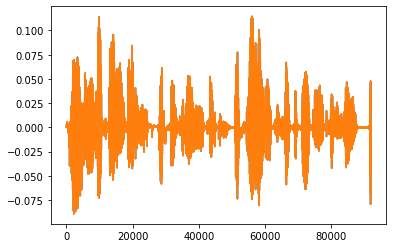

In [ ]:
import matplotlib.pyplot as plt

tensor = audio_tensor / 32768.0

plt.figure()
plt.plot(tensor.numpy())

Ensure all audio is stereo (i.e two channel audio)

In [ ]:
if audio_tensor.shape[1]==1:
  audio_tensor = tf.concat([audio_tensor, audio_tensor],1)

Resample to 16kHz

In [ ]:
new_sr = 16000
if sample_rate != new_sr:
  # Resample first channel
  resig_one = tfio.audio.resample(audio_tensor[:,:1],sample_rate, new_sr)
  # Resample the second channel and merge both channels
  resig_two = tfio.audio.resample(audio_tensor[:,1:],sample_rate, new_sr)
  audio_tensor = tf.concat([resig_one, resig_two],1)
audio_tensor

<tf.Tensor: shape=(91840, 2), dtype=float32, numpy=
array([[ 0.0000000e+00,  0.0000000e+00],
       [ 0.0000000e+00,  0.0000000e+00],
       [ 1.5626400e-05,  1.5626400e-05],
       ...,
       [-2.2285386e+03, -2.2285386e+03],
       [-2.2073574e+03, -2.2073574e+03],
       [-1.5787126e+03, -1.5787126e+03]], dtype=float32)>

Resize

In [ ]:
import random
max_ms = 4000
sig_len, num_rows = audio_tensor.shape
max_len = new_sr//1000 * max_ms
print(sig_len, max_len)

if (sig_len > max_len):
  # Truncate the signal to the given length
  sig = audio_tensor[:max_len,:]

elif (sig_len < max_len):
  # Length of padding to add at the beginning and end of the signal
  pad_begin_len = random.randint(0, max_len - sig_len)
  pad_end_len = max_len - sig_len - pad_begin_len

  # Pad with 0s
  pad_begin = tf.zeros((pad_begin_len, num_rows))
  pad_end = tf.zeros((pad_end_len, num_rows))

  audio_tensor = tf.concat((pad_begin, audio_tensor, pad_end), 0)
audio_tensor

91840 64000


<tf.Tensor: shape=(91840, 2), dtype=float32, numpy=
array([[ 0.0000000e+00,  0.0000000e+00],
       [ 0.0000000e+00,  0.0000000e+00],
       [ 1.5626400e-05,  1.5626400e-05],
       ...,
       [-2.2285386e+03, -2.2285386e+03],
       [-2.2073574e+03, -2.2073574e+03],
       [-1.5787126e+03, -1.5787126e+03]], dtype=float32)>

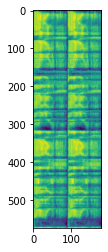

In [ ]:
def get_mel_spec(waveform, nfft = 512, stride_ms=10, window_ms=25): # apply hanning window by default
  window_samples = int((window_ms/1000)*new_sr)
  stride_samples = int((stride_ms/1000)*new_sr)

  spectrograms = tfio.audio.spectrogram(waveform,
                                        nfft=nfft,
                                        window=window_samples,
                                        stride=stride_samples)
  # convert to mel spectrogram
  mel_spectrogram = tfio.audio.melscale(spectrograms,
                                        rate=new_sr,
                                        mels=90,
                                        fmin=0, fmax=new_sr/2)
  # Convert to db scale mel-spectrogram
  dbscale_mel_spectrogram = tfio.audio.dbscale(mel_spectrogram, top_db=80)

  return dbscale_mel_spectrogram


ch1 = get_mel_spec(audio_tensor[:,0])
ch2 = get_mel_spec(audio_tensor[:,1])
db_spec = tf.concat([ch1,ch2],1)
                                             
plt.figure()
plt.imshow(tf.math.log(db_spec).numpy())

# Attempt 2 - Librosa

In [ ]:
import os
import librosa
import shutil
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
from tqdm import tqdm
from glob import glob
import pandas as pd
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'

In [ ]:
train_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/*/*.wav'
val_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/*/*.wav'
test_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/*/*.wav'
new_sr = 16000
max_s = 4
n = 8

for dir in tqdm([train_dir, val_dir, test_dir]):
  audio_files = glob(dir)
  
  for path in tqdm(audio_files):
    #load the sound
    sound, sr = librosa.load(path)
    #resample
    new_scale = librosa.resample(sound, orig_sr=sr, target_sr=new_sr)
    #resize
    new_scale = librosa.util.fix_length(new_scale,size=new_sr* max_s)
    #get mel spectrogram
    mel_spectrogram = librosa.feature.melspectrogram(new_scale, sr=new_sr, n_fft=512, win_length = 400, hop_length=160, n_mels=128)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
    #save plot
    plt.figure(figsize=(4.025, 4.125))
    librosa.display.specshow(log_mel_spectrogram, sr=new_sr)
    plt.axis('off')
    groups = path.split('/')
    plt.savefig('/'.join(groups[:n])+'/'+'/'.join(groups[n+1:])+ '.png',bbox_inches='tight', pad_inches=0)
    plt.close('all')

Sort the files

In [ ]:
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
# getting the names of all the audio_files
train_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/*.png'
val_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/*.png'
test_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/*.png'


for dir in [train_dir,val_dir,test_dir]:
  audio_files = glob(dir)
  audios = []
  classes = []

  for i in tqdm(range(len(audio_files))):
      # creating the audio_file name
      audios.append(audio_files[i].split('/')[-1])
      # creating the class of audio
      classes.append(audio_files[i].split('/')[-1][0])

  # storing the images and their class in a dataframe
  audio_data = pd.DataFrame()
  audio_data['audio'] = audios
  audio_data['class'] = classes

  # converting the dataframe into csv file 
  if dir == train_dir:
    csv ='/train_audio_images.csv'
  elif dir == val_dir:
    csv = '/val_audio_images.csv'
  else:
    csv = '/test_audio_images.csv'
  filename = gdrive_dir + csv
  audio_data.to_csv(filename,header=True, index=False)

  # Sort the files into appropriate folders
  audio_data = pd.read_csv(filename)

  if dir == train_dir:
    loc, dest ="/train_1/", "/train_2/"
  elif dir == val_dir:
    loc, dest = "/val_1/", "/val_2/"
  else:
    loc, dest = "/test_1/", "/test_2/"

  for _,j in tqdm(audio_data.iterrows()):
    if j[1] == 0:
      shutil.move(gdrive_dir + loc + j[0],gdrive_dir+ dest +"RealAudio",copy_function = shutil.copytree)
    else:
      shutil.move(gdrive_dir + loc +j[0],gdrive_dir+ dest +"FakeAudio",copy_function = shutil.copytree)


100%|██████████| 14791/14791 [00:00<00:00, 598879.72it/s]
14791it [01:05, 226.06it/s]
100%|██████████| 2074/2074 [00:00<00:00, 417858.90it/s]
2074it [00:09, 221.82it/s]
100%|██████████| 2016/2016 [00:00<00:00, 647451.52it/s]
2016it [00:09, 223.10it/s]


# Trying Out MFCCs

In [ ]:
import os
import librosa
import shutil
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
from tqdm import tqdm
from glob import glob
import pandas as pd
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'

In [ ]:
train_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/*/*.wav'
val_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/*/*.wav'
test_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/*/*.wav'
new_sr = 16000
max_s = 4
n = 8

for dir in tqdm([train_dir, val_dir, test_dir]):
  audio_files = glob(dir)
  
  for path in tqdm(audio_files):
    #load the sound
    sound, sr = librosa.load(path)
    #resample
    new_scale = librosa.resample(sound, orig_sr=sr, target_sr=new_sr)
    #resize
    new_scale = librosa.util.fix_length(new_scale,size=new_sr* max_s)
    #extract mfccs
    mfcc = librosa.feature.mfcc(sound, n_mfcc =13, sr=new_sr)
    #save plot
    plt.figure(figsize=(4.025, 4.125))
    librosa.display.specshow(mfcc, x_axis="time", sr=new_sr)
    plt.axis('off')
    groups = path.split('/')
    plt.savefig('/'.join(groups[:n])+'/'+'/'.join(groups[n+1:])+ '.png',bbox_inches='tight', pad_inches=0)
    plt.close('all')

Streaming output truncated to the last 5000 lines.
100%|██████████| 3/3 [3:44:17<00:00, 4485.84s/it]


sort the files

In [ ]:
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
# getting the names of all the audio_files
train_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/train_1/*.png'
val_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/val_1/*.png'
test_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/*.png'


for dir in [train_dir,val_dir,test_dir]:
  audio_files = glob(dir)
  audios = []
  classes = []

  for i in tqdm(range(len(audio_files))):
      # creating the audio_file name
      audios.append(audio_files[i].split('/')[-1])
      # creating the class of audio
      classes.append(audio_files[i].split('/')[-1][0])

  # storing the images and their class in a dataframe
  audio_data = pd.DataFrame()
  audio_data['audio'] = audios
  audio_data['class'] = classes

  # converting the dataframe into csv file 
  if dir == train_dir:
    csv ='/train_audio_images.csv'
  elif dir == val_dir:
    csv = '/val_audio_images.csv'
  else:
    csv = '/test_audio_images.csv'
  filename = gdrive_dir + csv
  audio_data.to_csv(filename,header=True, index=False)

  # Sort the files into appropriate folders
  audio_data = pd.read_csv(filename)

  if dir == train_dir:
    loc, dest ="/train_1/", "/train_3/"
  elif dir == val_dir:
    loc, dest = "/val_1/", "/val_3/"
  else:
    loc, dest = "/test_1/", "/test_3/"

  for _,j in tqdm(audio_data.iterrows()):
    if j[1] == 0:
      shutil.move(gdrive_dir + loc + j[0],gdrive_dir+ dest +"RealAudio",copy_function = shutil.copytree)
    else:
      shutil.move(gdrive_dir + loc +j[0],gdrive_dir+ dest +"FakeAudio",copy_function = shutil.copytree)


100%|██████████| 14791/14791 [00:00<00:00, 619939.35it/s]
14791it [01:03, 231.72it/s]
100%|██████████| 2074/2074 [00:00<00:00, 554252.09it/s]
2074it [00:10, 205.22it/s]
100%|██████████| 2016/2016 [00:00<00:00, 484485.01it/s]
2016it [00:09, 205.89it/s]


In [ ]:
os.chdir(gdrive_dir+'/val_3')
len(os.listdir(gdrive_dir+'/val_3/RealAudio')),len(os.listdir(gdrive_dir+'/val_3/FakeAudio'))

(994, 1080)

In [ ]:
# import required module
from PIL import Image
  
# get image
filepath = gdrive_dir + '/sample'+ '.png'
img = Image.open(filepath)
  
# get width and height
width = img.width
height = img.height
  
# display width and height
print("The height of the image is: ", height)
print("The width of the image is: ", width)

The height of the image is:  224
The width of the image is:  224


# Training the Video classification Model

Read all frames that we extracted earlier

In [93]:
import os
import math
import tensorflow
import keras
from keras.models import Sequential, load_model
from keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.resnet50 import ResNet50
from keras.layers import Dense, InputLayer, Dropout, Flatten, GlobalAveragePooling2D
from keras.layers import Conv2D, MaxPooling2D, GlobalMaxPooling2D
from keras.preprocessing import image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from matplotlib.image import imread
from PIL import Image
import cv2
from keras.callbacks import CSVLogger,ModelCheckpoint,LearningRateScheduler, EarlyStopping # defining a function to save progress of the model
from tensorflow.keras.optimizers import SGD, Adam
import pickle
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'

Read the csv files containing frame extracts and tags

In [3]:
train_data = pd.read_csv(gdrive_dir+"/train_audio_images.csv")
val_data = pd.read_csv(gdrive_dir+"/val_audio_images.csv")

# Organise both train and val folders into real and fake videos

In [ ]:
import shutil
for _,j in train_data.iterrows():
  if j[1] == 0:
    shutil.move(gdrive_dir+"/train_1/"+ j[0],gdrive_dir+"/train_1/"+"RealVideo",copy_function = shutil.copytree)
  else:
    shutil.move(gdrive_dir+"/train_1/"+j[0],gdrive_dir+"/train_1/"+"FakeVideo",copy_function = shutil.copytree)


In [ ]:
import shutil
for _,j in val_data.iterrows():
  if j[1] == 0:
    shutil.move(gdrive_dir+"/val_1/"+ j[0],gdrive_dir+"/val_1/"+"RealVideo",copy_function = shutil.copytree)
  else:
    shutil.move(gdrive_dir+"/val_1/"+j[0],gdrive_dir+"/val_1/"+"FakeVideo",copy_function = shutil.copytree)


In [ ]:
import shutil

seen = []
count = 1

for _,j in train_data.iterrows():
  if j[0][0]=="0":
    video = j[0].split(".")[0]
    if video not in seen:
      count = 1
      seen.append(video)

    if count%15 == 0:
      if os.path.exists(gdrive_dir+"/train_1/RealVideo/"+j[0]):
        os.remove(gdrive_dir+"/train_1/RealVideo/"+j[0])
    count +=1

In [ ]:
os.chdir(gdrive_dir+"/train_1/"+"RealVideo")
n_train_real= len(os.listdir())

In [ ]:
n_train_real

51802

Get the number of files in each folder

In [ ]:
os.chdir(gdrive_dir+"/train_1/"+"FakeVideo")
n_train_fake = len(os.listdir())
os.chdir(gdrive_dir+"/train_1/"+"RealVideo")
n_train_real= len(os.listdir())


os.chdir(gdrive_dir+"/val_1/"+"RealVideo")
n_val_real= len(os.listdir())
os.chdir(gdrive_dir+"/val_1/"+"FakeVideo")
n_val_fake= len(os.listdir())

print((n_train_fake,n_train_real,n_val_fake,n_val_real))

(51989, 51802, 6231, 8190)


# Attempt 1 - too much RAM Usage

Read the frames and store them as numpy array

In [ ]:
os.chdir(gdrive_dir+"/train_1")
# TRAINING DATA
#creating empty list
train_image = []

#for loop to read and store frames
for i in tqdm(range(train_data.shape[0])):
  # loading the image and keeping the target size as (224,224,3)
  img = image.load_img(train_data['image'][i], target_size=(224,224,3))
  # converting it to an array
  img = image.img_to_array(img)
  # normalizing the pixel value
  img = img/255
  # appending the image to the train_image list
  train_image.append(img)

#converting the list to numpy array
X_train = np.array(train_image)
y_train = train_data['class']
X_train.shape


 40%|████      | 40678/100458 [01:42<02:55, 339.68it/s]

In [ ]:
#VALIDATION DATA
os.chdir(gdrive_dir+"/val_1")
#creating empty list
val_image = []

#for loop to read and store frames
for i in tqdm(range(val_data.shape[0])):
  # loading the image and keeping the target size as (224,224,3)
  img = image.load_img(val_data['image'][i], target_size=(224,224,3))
  # converting it to an array
  img = image.img_to_array(img)
  # normalizing the pixel value
  img = img/255
  # appending the image to the train_image list
  val_image.append(img)

#converting the list to numpy array
X_val = np.array(val_image)
y_val = val_data['class']
X_val.shape
type(y_val)

Define Model architecure

In [ ]:
# creating the base model of pre-trained VGG16 model
base_model = VGG16(weights='imagenet', include_top=False,input_shape = (224,224,3))


Extract freatures from the pre-trained model

In [ ]:
# extracting features for training frames
X_train = base_model.predict(X_train)
X_train.shape

In [ ]:
# extracting features for validation frames
X_val = base_model.predict(X_val)
X_val.shape

Reshape the feature extract for our fully connected layer

In [ ]:
X_train = X_train.reshape(100458, 7*7*512)
X_val = X_val.reshape(11945 ,7*7*512)

Normalize pixel values

In [ ]:
# normalizing the pixel values
max = X_train.max()
X_train = X_train/max
X_val = X_val/max

In [ ]:
# normalizing the pixel values
max = features_train.max()
X_train = features_train/max
X_val = features_val/max

Check input shape for our model

In [ ]:
# shape of images
X_train.shape

In [ ]:
#defining the model architecture
model = Sequential()
model.add(Dense(1024, activation='relu', input_shape=(25088,)))
model.add(Dropout(0.5))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))

# Attempt 2

CREATE DATA GENERATORS

In [ ]:
(n_train_fake,n_train_real,n_val_fake,n_val_real)= (51989, 51802, 6230, 8190)

In [ ]:
train_dir = gdrive_dir+"/train_1"
val_dir = gdrive_dir+"/val_1"

#parameters
batch_size = 64
img_width = 224
img_height = 224

# creating the base model of pre-trained VGG16 model
base_model = VGG16(weights='imagenet', include_top=False,input_shape = (224,224,3))
#base_model.summary()

#data generator
datagen = image.ImageDataGenerator(rescale=1. /255)

#train generator
print("Generate VGG16 features for training data ... ")
train_datagen = datagen.flow_from_directory(train_dir, target_size = (img_width, img_height),batch_size = batch_size, class_mode = None, shuffle=False)
features_train = base_model.predict_generator(train_datagen,steps= (train_data.shape[0]//batch_size)+1)
print("Done.")

#val generator
print("Generate VGG16 features for validation data ... ")
val_datagen = datagen.flow_from_directory(val_dir, target_size =(img_width, img_height), batch_size = batch_size, class_mode = None, shuffle=False)
features_val = base_model.predict_generator(val_datagen,steps= (val_data.shape[0]//batch_size)+1)
print("Done.")


58900480/58889256 [==============================] - 0s 0us/step
Generate VGG16 features for training data ... 
Found 103791 images belonging to 2 classes.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.


Done.
Generate VGG16 features for validation data ... 
Found 14420 images belonging to 2 classes.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.


Done.


Save extracted Features to Drive

In [ ]:

# save to csv file
np.save(gdrive_dir+'/ExtractedFeatures/VGG16_features_train', features_train)
np.save(gdrive_dir+'/ExtractedFeatures/VGG16_features_val', features_val)


Load extracted features and labels


In [ ]:
features_train =np.load(gdrive_dir+'/ExtractedFeatures/VGG16_features_train.npy')
features_val = np.load(gdrive_dir+'/ExtractedFeatures/VGG16_features_val.npy')

#get the folder labels
train_labels= np.array([1]*n_train_fake+[0]* n_train_real)
val_labels = np.array([1]*n_val_fake+[0]*n_val_real)

(103791, 7, 7, 512)

Define model architecture

In [ ]:
#defining the model architecture
model = Sequential()
model.add(Flatten(input_shape=features_train.shape[1:]))
# model.add(Dropout(0.5))
# model.add(Dense(1024, activation='relu', ))
# model.add(Dropout(0.5))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
# model.add(Dense(256, activation='relu'))
# model.add(Dropout(0.5))
# model.add(Dense(128, activation='relu'))
# model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 512)               12845568  
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 1)                 513       
                                                                 
Total params: 12,846,081
Trainable params: 12,846,081
Non-trainable params: 0
_________________________________________________________________


# Attempt 3 - Finetuning

CREATE DATA GENERATORS

In [94]:
train_dir = gdrive_dir+"/train_2"
val_dir = gdrive_dir+"/val_2"

#parameters
batch_size = 128
img_width = 224
img_height = 224

#data generator
datagen = image.ImageDataGenerator(rescale=1. /255)

#train generator
print("Generate features for training data ... ") #14791
train_datagen = datagen.flow_from_directory(train_dir, target_size = (img_width, img_height),batch_size = batch_size, class_mode = 'binary')
print("Done.")

#val generator.
print("Generate features for validation data ... ")  # 2074
val_datagen = datagen.flow_from_directory(val_dir, target_size =(img_width, img_height), batch_size = batch_size, class_mode = 'binary')
print("Done.")


Generate features for training data ... 
Found 14791 images belonging to 2 classes.
Done.
Generate features for validation data ... 
Found 2074 images belonging to 2 classes.
Done.


Define model Checkpoint Function

In [36]:
#Define model Checkpoint function
class MyModelCheckpoint(ModelCheckpoint):
  def __init__(self,*args,**kwargs):
    super().__init__(*args,**kwargs)

  def on_epoch_end(self,epoch,logs=None):
    super().on_epoch_end(epoch,logs)\

    filepath = self._get_file_path(epoch=epoch,logs=logs,batch=None)
    filepath = filepath.rsplit(".",1)[0]
    
    filepath+=".pkl"

    with open(filepath,'wb') as fp:
      pickle.dump(
          {
              'opt': model.optimizer.get_config(),
              'epoch': epoch+1
          }, fp,protocol = pickle.HIGHEST_PROTOCOL)
      print('\nEpoch %05d: saving optimizer to %s'%(epoch+1,filepath))

Define Metrics

In [7]:
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [62]:
def compile_model(model_name, opt):
  # def step_decay_schedule(initial_lr=1e-3, decay_factor=0.75, step_size=10):
  #     def schedule(epoch):
  #         return initial_lr * (decay_factor ** np.floor(epoch/step_size))
  #     return LearningRateScheduler(schedule)

  #  #Learning Rate scheduler
  # lr_cb = step_decay_schedule(initial_lr=1e-2, decay_factor=0.75, \
  #                                       step_size=2)

  #Early Stopping
  es = EarlyStopping(monitor='val_accuracy', patience=5, verbose=0)

  #Weights Checkpoint
  weights_checkpoint = MyModelCheckpoint(
      model_name + '_weight-{epoch:02d}-{val_loss:.2f}.hdf5', 
      monitor='val_loss',
      verbose =1
      )
  history_logger = CSVLogger(model_name + '_history.log', separator=',', append=False)

  cb = [history_logger, weights_checkpoint, es]

  model.compile(loss='binary_crossentropy',optimizer=opt,metrics=['accuracy'])#,f1_m,precision_m, recall_m,tensorflow.metrics.AUC()])

  return cb

# VGG16 Training

In [58]:
# build the convolutional base of Xception network
conv_base = VGG16(weights = 'imagenet', # the model if pre-trained on ImageNet
                  include_top = False, # do not include the FC layers
                  input_shape = (224,224,3))

# set the early layers (up to the 'block5_conv1')
# to non-trainable (weights will not be updated)
for layer in conv_base.layers:
    layer.trainable = False
# for i,layer in enumerate(conv_base.layers):
#     print(i, layer.name,layer.trainable)
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

Add the top of the model

In [59]:

# build a classifier to put on top of the convolutional model
model = Sequential()
model.add(conv_base)
# model.add(GlobalAveragePooling2D())
model.add(Flatten())
# model.add(Dropout(0.5))
# model.add(Dense(1024, activation='relu', ))
# model.add(Dropout(0.5))
model.add(Dense(512, activation='relu'))
# model.add(Dropout(0.3))
# # model.add(Dense(128, activation='relu'))
# # model.add(Dropout(0.3))
model.add(Dense(1, activation='sigmoid'))

model.summary()
# from tensorflow.keras.utils import plot_model
# plot_model(model, show_shapes=True) # visualize the CNN artitecture

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_8 (Flatten)         (None, 25088)             0         
                                                                 
 dense_15 (Dense)            (None, 512)               12845568  
                                                                 
 dense_16 (Dense)            (None, 1)                 513       
                                                                 
Total params: 27,560,769
Trainable params: 12,846,081
Non-trainable params: 14,714,688
_________________________________________________________________


Compile our model

In [60]:
cb = compile_model(model_name='VGG16', opt=Adam())

Training our model

In [61]:
model_folder = gdrive_dir+"/models"
if not os.path.exists(model_folder):
    os.mkdir(model_folder)

os.chdir(model_folder)

history = model.fit(train_datagen, 
                    steps_per_epoch=(train_data.shape[0]//batch_size)+1,
                    epochs=50,
                    batch_size=batch_size,
                    validation_data=val_datagen,
                    validation_steps=(val_data.shape[0]//batch_size)+1,
                    callbacks = cb)

Epoch 1/50
  5/116 [>.............................] - ETA: 30:27 - loss: 3.4716 - accuracy: 0.5234

KeyboardInterrupt: ignored

Save our model

In [ ]:
model_folder = gdrive_dir+"/models"
if not os.path.exists(model_folder):
    os.mkdir(model_folder)
model.save(model_folder+'/Xception_finetuning.h5')  # always save your models after training

# Inception V3 Training

Define model base

In [ ]:
# build the convolutional base of Xception network
conv_base = InceptionV3(weights = 'imagenet', # the model if pre-trained on ImageNet
                  include_top = False, # do not include the FC layers
                  input_shape = (224,224,3))

# set the early layers (up to the 'block5_conv1')
# to non-trainable (weights will not be updated)
for layer in conv_base.layers:
    layer.trainable = False
# for i,layer in enumerate(conv_base.layers):
#     print(i, layer.name,layer.trainable)
conv_base.summary()

Add the top of the model

In [ ]:

# build a classifier to put on top of the convolutional model
model = Sequential()
model.add(conv_base)
# model.add(GlobalAveragePooling2D())
model.add(Flatten())
# model.add(Dropout(0.5))
# model.add(Dense(1024, activation='relu', ))
# model.add(Dropout(0.5))
model.add(Dense(1024, activation='relu'))
# model.add(Dropout(0.3))
# # model.add(Dense(128, activation='relu'))
# # model.add(Dropout(0.3))
model.add(Dense(1, activation='sigmoid'))

model.summary()

compile model

In [ ]:
cb = compile_model(model_name='Inception', opt=Adam())

Train model

In [ ]:
model_folder = gdrive_dir+"/models"
if not os.path.exists(model_folder):
    os.mkdir(model_folder)

os.chdir(model_folder)

history = model.fit(train_datagen, 
                    steps_per_epoch=(train_data.shape[0]//batch_size)+1,
                    epochs=50,
                    batch_size=128,
                    validation_data=val_datagen,
                    validation_steps=(val_data.shape[0]//batch_size)+1,
                    callbacks = cb)

# ResNet50 Training

Define Model Base

In [99]:
# build the convolutional base of Xception network
conv_base = ResNet50(weights = 'imagenet', # the model if pre-trained on ImageNet
                  include_top = False, # do not include the FC layers
                  input_shape = (224,224,3),
                  pooling = 'max')

# set the early layers (up to the 'block5_conv1')
# to non-trainable (weights will not be updated)
for layer in conv_base.layers:
    layer.trainable = False
# for i,layer in enumerate(conv_base.layers):
#     print(i, layer.name,layer.trainable)
conv_base.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_9[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

Add the top of the model

In [100]:

# build a classifier to put on top of the convolutional model
model = Sequential()
model.add(conv_base)
# model.add(GlobalAveragePooling2D())
model.add(Flatten())
# model.add(Dropout(0.5))
# model.add(Dense(1024, activation='relu', ))
# model.add(Dropout(0.5))
# model.add(Dense(1024, activation='relu'))
# model.add(Dropout(0.3))
# # model.add(Dense(128, activation='relu'))
# # model.add(Dropout(0.3))
model.add(Dense(1, activation='sigmoid'))

model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 flatten_11 (Flatten)        (None, 2048)              0         
                                                                 
 dense_19 (Dense)            (None, 1)                 2049      
                                                                 
Total params: 23,589,761
Trainable params: 2,049
Non-trainable params: 23,587,712
_________________________________________________________________


Compile the model

In [101]:
cb = compile_model(model_name='ResNet50', opt=Adam(learning_rate=0.001))

Train Model

In [ ]:
(train_data.shape[0]//batch_size)+1

116

In [ ]:
model_folder = gdrive_dir+"/models"
if not os.path.exists(model_folder):
    os.mkdir(model_folder)

os.chdir(model_folder)

history = model.fit(train_datagen, 
                    steps_per_epoch=(train_data.shape[0]//batch_size)+1,
                    epochs=50,
                    batch_size=128,
                    validation_data=val_datagen,
                    validation_steps=(val_data.shape[0]//batch_size)+1,
                    callbacks = cb)

Epoch 1/50
116/116 [==============================] - ETA: 0s - loss: 0.6029 - accuracy: 0.6901
Epoch 1: saving model to ResNet50_weight-01-0.55.hdf5

Epoch 00001: saving optimizer to ResNet50_weight-01-0.55.pkl
116/116 [==============================] - 703s 6s/step - loss: 0.6029 - accuracy: 0.6901 - val_loss: 0.5496 - val_accuracy: 0.6866
Epoch 2/50
116/116 [==============================] - ETA: 0s - loss: 0.4623 - accuracy: 0.8444
Epoch 2: saving model to ResNet50_weight-02-0.45.hdf5

Epoch 00002: saving optimizer to ResNet50_weight-02-0.45.pkl
116/116 [==============================] - 693s 6s/step - loss: 0.4623 - accuracy: 0.8444 - val_loss: 0.4547 - val_accuracy: 0.7893
Epoch 3/50
116/116 [==============================] - ETA: 0s - loss: 0.3874 - accuracy: 0.8861
Epoch 3: saving model to ResNet50_weight-03-0.39.hdf5

Epoch 00003: saving optimizer to ResNet50_weight-03-0.39.pkl
116/116 [==============================] - 692s 6s/step - loss: 0.3874 - accuracy: 0.8861 - val_loss

# Load Model

Define paths

In [90]:
model_folder = gdrive_dir+"/models"
MODEL_PATH = model_folder+'/ResNet50_weight-29-0.06.hdf5'
OPT_PATH = model_folder+'/ResNet50_weight-29-0.06.pkl'
model = load_model(MODEL_PATH)

load the model

In [ ]:
def load_model_data(model_path, opt_path):
  model = load_model(model_path)
  with open(opt_path, 'rb') as fp:
    d = pickle.load(fp)
    epoch = d['epoch']
    opt = d['opt']
    return epoch,model,opt

epoch, model, opt = load_model_data(MODEL_PATH,OPT_PATH)

model.compile(loss='binary_crossentropy',
              optimizer= tensorflow.optimizers.Adam.from_config(opt),
              metrics=['accuracy'])


Train Model

In [ ]:
history = model.fit(train_datagen, steps_per_epoch=(train_data.shape[0]//batch_size)+1,
          epochs=50,
          initial_epoch = epoch,
          batch_size=128,
          validation_data=val_datagen,
          validation_steps=(val_data.shape[0]//batch_size)+1,
          callbacks = cb)


Plot Learning Curves

In [44]:
import pandas as pd
model_folder = gdrive_dir+"/models/Good Models"
os.chdir(model_folder)
history = pd.read_csv('ResNet50-Audio_history.log', sep=',', engine='python')


In [ ]:
# plot the learning curves
import matplotlib.pyplot as plt
fig = plt.figure()
fig.add_subplot(1,2,1)
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.grid(True)
plt.ylim([0,1.0])
plt.xlabel('epoch')

fig.add_subplot(1,2,2)
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label='val accuracy')
plt.legend()
plt.grid(True)
plt.ylim([0,1.0])
plt.xlabel('epoch')

# Test videos preprocessing

Create test folder

In [ ]:
import cv2     # for capturing videos
import math   # for mathematical operations
import matplotlib.pyplot as plt    # for plotting the images
import pandas as pd
from keras.preprocessing import image   # for preprocessing the images
import numpy as np    # for mathematical operations
from keras.utils import np_utils
from skimage.transform import resize   # for resizing images
from glob import glob
from tqdm import tqdm    # to show progress

Create the test dataframe

In [ ]:
from moviepy.editor import *
video = []
for _,i in test_df.iterrows():
  video.append(os.path.join(i[9][12:],i[8]))
test_df["video"] = video
test_df = test_df[["video","tag"]]

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """



Extract the test video frames and save information to csv

In [ ]:
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
os.chdir(os.path.join('/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos/test/'))
for i in tqdm(range(test_df.shape[0])):
  videoFile=list(test_df["video"])[i]
  tag=list(test_df["tag"])[i]

  vid_path = videoFile
  new_path = gdrive_dir+ "/test_1/"+"%d_"%tag+"".join(videoFile.split('/'))+".wav"

  video = VideoFileClip(vid_path) # 2.
  audio = video.audio # 3.
  audio.write_audiofile(new_path) # 4.

# getting the names of all the audio_files
audio_files = glob("/content/drive/MyDrive/Colab Notebooks/data/deepfake-videos/test_1/*.wav")
test_audio = []
test_class = []

for i in tqdm(range(len(audio_files))):
    # creating the audio_file name
    test_audio.append(audio_files[i].split('/')[-1])
    # creating the class of audio
    test_class.append(audio_files[i].split('/')[-1][0])

# storing the images and their class in a dataframe
test_data = pd.DataFrame()
test_data['audio'] = test_audio
test_data['class'] = test_class

# converting the dataframe into csv file 
test_data.to_csv(gdrive_dir+'/test_audios.csv',header=True, index=False)

# Sort the files into appropriate folders
test_data = pd.read_csv(gdrive_dir+"/test_audios.csv")
for _,j in tqdm(test_data.iterrows()):
  if j[1] == 0:
    shutil.move(gdrive_dir+"/test_1/"+ j[0],gdrive_dir+"/test_1/"+"RealAudio",copy_function = shutil.copytree)
  else:
    shutil.move(gdrive_dir+"/test_1/"+j[0],gdrive_dir+"/test_1/"+"FakeAudio",copy_function = shutil.copytree)

# test_data.to_csv(gdrive_dir+'/test_audios.csv',header=True, index=False)

  0%|          | 0/2016 [00:00<?, ?it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanmenid0229600019.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 591.55it/s]


[MoviePy] Done.


  0%|          | 1/2016 [00:00<10:49,  3.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanmenid0231600094.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2839.86it/s]

[MoviePy] Done.



  0%|          | 2/2016 [00:00<16:19,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanmenid0234200191.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3147.01it/s]

[MoviePy] Done.



  0%|          | 3/2016 [00:01<16:46,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanmenid0249400050.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3085.51it/s]

[MoviePy] Done.



  0%|          | 4/2016 [00:01<17:01,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanmenid0472700007.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3399.45it/s]

[MoviePy] Done.



  0%|          | 5/2016 [00:02<16:46,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanwomenid0523100149.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3055.40it/s]

[MoviePy] Done.



  0%|          | 6/2016 [00:02<16:57,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanwomenid0523500052.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2372.45it/s]

[MoviePy] Done.



  0%|          | 7/2016 [00:03<17:06,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanwomenid0525100033.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2930.44it/s]

[MoviePy] Done.



  0%|          | 8/2016 [00:03<16:47,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanwomenid0525200052.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3135.78it/s]

[MoviePy] Done.



  0%|          | 9/2016 [00:04<16:53,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAfricanwomenid0598000143.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2937.81it/s]

[MoviePy] Done.



  0%|          | 10/2016 [00:05<17:16,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)menid0829900110.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2936.23it/s]

[MoviePy] Done.



  1%|          | 11/2016 [00:05<21:29,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)menid0861300074.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3043.46it/s]

[MoviePy] Done.



  1%|          | 12/2016 [00:06<19:54,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)menid0865200006.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2785.57it/s]

[MoviePy] Done.



  1%|          | 13/2016 [00:06<19:09,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)menid0905300005.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2943.45it/s]

[MoviePy] Done.



  1%|          | 14/2016 [00:07<18:45,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)menid0914300056.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2994.29it/s]

[MoviePy] Done.



  1%|          | 15/2016 [00:07<17:38,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)womenid0912500098.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file RealVideo-RealAudio/Asian (East)/women/id09125/00098.mp4, At time t=6.85-6.90 seconds, indices wanted: 99698-101686, but len(buffer)=99699
index 99699 is out of bounds for axis 0 with size 99699
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2838.79it/s]

[MoviePy] Done.



  1%|          | 16/2016 [00:08<17:33,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)womenid0917100092.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2875.77it/s]

[MoviePy] Done.



  1%|          | 17/2016 [00:09<18:13,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)womenid0917400015.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2837.87it/s]

[MoviePy] Done.



  1%|          | 18/2016 [00:09<18:10,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)womenid0917500072.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3203.61it/s]

[MoviePy] Done.



  1%|          | 19/2016 [00:10<17:51,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (East)womenid0918100048.mp4.wav



100%|██████████| 243/243 [00:00<00:00, 3038.20it/s]

[MoviePy] Done.



  1%|          | 20/2016 [00:10<18:00,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)menid0746300028.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3152.63it/s]

[MoviePy] Done.



  1%|          | 21/2016 [00:11<20:49,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)menid0776800143.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2889.14it/s]

[MoviePy] Done.



  1%|          | 22/2016 [00:12<19:42,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)menid0831300202.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2326.15it/s]

[MoviePy] Done.



  1%|          | 23/2016 [00:12<20:46,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)menid0831400028.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3155.97it/s]

[MoviePy] Done.



  1%|          | 24/2016 [00:13<19:15,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)menid0845700417.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3137.59it/s]

[MoviePy] Done.



  1%|          | 25/2016 [00:13<18:26,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)womenid0713600052.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3052.90it/s]

[MoviePy] Done.



  1%|▏         | 26/2016 [00:14<19:21,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)womenid0723600143.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2855.18it/s]

[MoviePy] Done.



  1%|▏         | 27/2016 [00:14<19:50,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)womenid0737700025.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 3146.99it/s]

[MoviePy] Done.



  1%|▏         | 28/2016 [00:15<19:40,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)womenid0768600254.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2101.38it/s]

[MoviePy] Done.



  1%|▏         | 29/2016 [00:16<19:23,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioAsian (South)womenid0768900028.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2862.25it/s]

[MoviePy] Done.



  1%|▏         | 30/2016 [00:16<18:23,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)menid0403400009.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2996.00it/s]

[MoviePy] Done.



  2%|▏         | 31/2016 [00:17<23:31,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)menid0407300021.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3040.71it/s]

[MoviePy] Done.



  2%|▏         | 32/2016 [00:18<23:32,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)menid0421600470.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3037.15it/s]

[MoviePy] Done.



  2%|▏         | 33/2016 [00:18<21:48,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)menid0421900130.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2518.24it/s]

[MoviePy] Done.



  2%|▏         | 34/2016 [00:19<20:17,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)menid0422100053.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2948.35it/s]

[MoviePy] Done.



  2%|▏         | 35/2016 [00:19<19:39,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)womenid0355600043.mp4.wav



100%|██████████| 273/273 [00:00<00:00, 2956.69it/s]

[MoviePy] Done.



  2%|▏         | 36/2016 [00:20<19:43,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)womenid0360500048.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2934.26it/s]

[MoviePy] Done.



  2%|▏         | 37/2016 [00:21<19:36,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)womenid0369600160.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3041.60it/s]

[MoviePy] Done.



  2%|▏         | 38/2016 [00:21<18:53,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)womenid0370700055.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3078.00it/s]

[MoviePy] Done.



  2%|▏         | 39/2016 [00:22<18:31,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (American)womenid0378100113.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2958.08it/s]

[MoviePy] Done.



  2%|▏         | 40/2016 [00:22<19:13,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)menid0115400118.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3033.89it/s]

[MoviePy] Done.



  2%|▏         | 41/2016 [00:23<21:09,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)menid0115600078.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2914.00it/s]

[MoviePy] Done.



  2%|▏         | 42/2016 [00:24<19:29,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)menid0115700048.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3100.48it/s]

[MoviePy] Done.



  2%|▏         | 43/2016 [00:24<18:32,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)menid0256700040.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3264.90it/s]

[MoviePy] Done.



  2%|▏         | 44/2016 [00:25<18:08,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)menid0320500150.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3134.10it/s]

[MoviePy] Done.



  2%|▏         | 45/2016 [00:25<17:26,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)womenid0371600040.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 3032.25it/s]

[MoviePy] Done.



  2%|▏         | 46/2016 [00:26<17:11,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)womenid0381600093.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2987.54it/s]

[MoviePy] Done.



  2%|▏         | 47/2016 [00:26<17:03,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)womenid0384400028.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2984.44it/s]

[MoviePy] Done.



  2%|▏         | 48/2016 [00:27<18:12,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)womenid0385800092.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2918.07it/s]

[MoviePy] Done.



  2%|▏         | 49/2016 [00:27<17:44,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_RealVideo-RealAudioCaucasian (European)womenid0394100021.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 1692.27it/s]

[MoviePy] Done.



  2%|▏         | 50/2016 [00:28<18:14,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanmenid0229600019_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2932.59it/s]

[MoviePy] Done.



  3%|▎         | 51/2016 [00:29<20:14,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanmenid0231600094_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3139.66it/s]

[MoviePy] Done.



  3%|▎         | 52/2016 [00:29<19:09,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanmenid0234200191_fake.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3091.25it/s]

[MoviePy] Done.



  3%|▎         | 53/2016 [00:30<18:41,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanmenid0249400050_fake.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3326.85it/s]

[MoviePy] Done.



  3%|▎         | 54/2016 [00:30<18:35,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanmenid0472700007_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3195.20it/s]

[MoviePy] Done.



  3%|▎         | 55/2016 [00:31<18:15,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanwomenid0523100149_fake.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2875.76it/s]

[MoviePy] Done.



  3%|▎         | 56/2016 [00:31<17:59,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanwomenid0523500052_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3283.67it/s]

[MoviePy] Done.



  3%|▎         | 57/2016 [00:32<17:50,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanwomenid0525100033_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3100.56it/s]

[MoviePy] Done.



  3%|▎         | 58/2016 [00:32<18:16,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanwomenid0525200052_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2584.73it/s]

[MoviePy] Done.



  3%|▎         | 59/2016 [00:33<17:40,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAfricanwomenid0598000143_fake.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2105.62it/s]

[MoviePy] Done.



  3%|▎         | 60/2016 [00:34<18:42,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)menid0829900110_fake.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3310.53it/s]

[MoviePy] Done.



  3%|▎         | 61/2016 [00:34<21:16,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)menid0861300074_fake.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3119.11it/s]

[MoviePy] Done.



  3%|▎         | 62/2016 [00:35<20:05,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)menid0865200006_fake.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2985.27it/s]

[MoviePy] Done.



  3%|▎         | 63/2016 [00:36<20:03,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)menid0905300005_fake.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3250.02it/s]

[MoviePy] Done.



  3%|▎         | 64/2016 [00:36<18:19,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)menid0914300056_fake.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3017.80it/s]

[MoviePy] Done.



  3%|▎         | 65/2016 [00:37<18:04,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)womenid0912500098_fake.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2939.83it/s]

[MoviePy] Done.



  3%|▎         | 66/2016 [00:37<17:29,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)womenid0917100092_fake.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2824.14it/s]

[MoviePy] Done.



  3%|▎         | 67/2016 [00:38<17:56,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)womenid0917400015_fake.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2320.84it/s]

[MoviePy] Done.



  3%|▎         | 68/2016 [00:38<18:08,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)womenid0917500072_fake.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2409.24it/s]

[MoviePy] Done.



  3%|▎         | 69/2016 [00:39<17:50,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (East)womenid0918100048_fake.mp4.wav



100%|██████████| 244/244 [00:00<00:00, 2062.03it/s]

[MoviePy] Done.



  3%|▎         | 70/2016 [00:39<19:00,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)menid0746300028_fake.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2935.43it/s]

[MoviePy] Done.



  4%|▎         | 71/2016 [00:40<20:39,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)menid0776800143_fake.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2805.33it/s]

[MoviePy] Done.



  4%|▎         | 72/2016 [00:41<19:40,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)menid0831300202_fake.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2336.50it/s]

[MoviePy] Done.



  4%|▎         | 73/2016 [00:41<20:07,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)menid0831400028_fake.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2503.65it/s]

[MoviePy] Done.



  4%|▎         | 74/2016 [00:42<20:24,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)menid0845700417_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2765.06it/s]

[MoviePy] Done.



  4%|▎         | 75/2016 [00:43<20:10,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)womenid0713600052_fake.mp4.wav



100%|██████████| 254/254 [00:00<00:00, 2029.31it/s]

[MoviePy] Done.



  4%|▍         | 76/2016 [00:43<20:45,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)womenid0723600143_fake.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 1693.19it/s]

[MoviePy] Done.



  4%|▍         | 77/2016 [00:44<21:05,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)womenid0737700025_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2135.26it/s]

[MoviePy] Done.



  4%|▍         | 78/2016 [00:45<20:00,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)womenid0768600254_fake.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2228.59it/s]

[MoviePy] Done.



  4%|▍         | 79/2016 [00:45<19:18,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioAsian (South)womenid0768900028_fake.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2850.24it/s]

[MoviePy] Done.



  4%|▍         | 80/2016 [00:46<18:59,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)menid0403400009_fake.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2323.60it/s]

[MoviePy] Done.



  4%|▍         | 81/2016 [00:47<22:48,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)menid0407300021_fake.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2295.13it/s]

[MoviePy] Done.



  4%|▍         | 82/2016 [00:47<22:01,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)menid0421600470_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2734.11it/s]

[MoviePy] Done.



  4%|▍         | 83/2016 [00:48<20:20,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)menid0421900130_fake.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3042.68it/s]

[MoviePy] Done.



  4%|▍         | 84/2016 [00:48<19:22,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)menid0422100053_fake.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2857.51it/s]

[MoviePy] Done.



  4%|▍         | 85/2016 [00:49<18:54,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)womenid0355600043_fake.mp4.wav



100%|██████████| 274/274 [00:00<00:00, 2752.83it/s]

[MoviePy] Done.



  4%|▍         | 86/2016 [00:49<18:49,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)womenid0360500048_fake.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3313.34it/s]

[MoviePy] Done.



  4%|▍         | 87/2016 [00:50<18:22,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)womenid0369600160_fake.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3168.55it/s]

[MoviePy] Done.



  4%|▍         | 88/2016 [00:51<18:23,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)womenid0370700055_fake.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2833.42it/s]

[MoviePy] Done.



  4%|▍         | 89/2016 [00:51<17:46,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (American)womenid0378100113_fake.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2936.65it/s]

[MoviePy] Done.



  4%|▍         | 90/2016 [00:52<18:25,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)menid0115400118_fake.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2927.07it/s]

[MoviePy] Done.



  5%|▍         | 91/2016 [00:52<20:41,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)menid0115600078_fake.mp4.wav



100%|██████████| 217/217 [00:00<00:00, 2819.73it/s]

[MoviePy] Done.



  5%|▍         | 92/2016 [00:53<20:07,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)menid0115700048_fake.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3092.43it/s]

[MoviePy] Done.



  5%|▍         | 93/2016 [00:54<18:53,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)menid0256700040_fake.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3134.23it/s]

[MoviePy] Done.



  5%|▍         | 94/2016 [00:54<18:31,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)menid0320500150_fake.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3483.00it/s]

[MoviePy] Done.



  5%|▍         | 95/2016 [00:55<18:15,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)womenid0371600040_fake.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2624.74it/s]

[MoviePy] Done.



  5%|▍         | 96/2016 [00:55<19:11,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)womenid0381600093_fake.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2798.66it/s]

[MoviePy] Done.



  5%|▍         | 97/2016 [00:56<19:26,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)womenid0384400028_fake.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2944.36it/s]

[MoviePy] Done.



  5%|▍         | 98/2016 [00:57<18:44,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)womenid0385800092_fake.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2852.09it/s]

[MoviePy] Done.



  5%|▍         | 99/2016 [00:57<18:43,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_RealVideo-FakeAudioCaucasian (European)womenid0394100021_fake.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2903.78it/s]

[MoviePy] Done.



  5%|▍         | 100/2016 [00:58<18:13,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3014.37it/s]

[MoviePy] Done.



  5%|▌         | 101/2016 [00:59<21:53,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3419.24it/s]

[MoviePy] Done.



  5%|▌         | 102/2016 [00:59<19:05,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01598_jU0e5_ktk-0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3090.15it/s]

[MoviePy] Done.



  5%|▌         | 103/2016 [00:59<17:23,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3038.87it/s]

[MoviePy] Done.



  5%|▌         | 104/2016 [01:00<16:29,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01779_HgyHpDEo_jk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3238.01it/s]

[MoviePy] Done.



  5%|▌         | 105/2016 [01:00<15:11,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3048.26it/s]

[MoviePy] Done.



  5%|▌         | 106/2016 [01:01<13:51,  2.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2916.72it/s]

[MoviePy] Done.



  5%|▌         | 107/2016 [01:01<12:47,  2.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id02040_wl6EVkamZFQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3231.18it/s]

[MoviePy] Done.



  5%|▌         | 108/2016 [01:01<12:08,  2.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01179_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3106.54it/s]

[MoviePy] Done.



  5%|▌         | 109/2016 [01:02<13:46,  2.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01392_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2748.69it/s]

[MoviePy] Done.



  5%|▌         | 110/2016 [01:02<13:04,  2.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3489.01it/s]

[MoviePy] Done.



  6%|▌         | 111/2016 [01:03<13:29,  2.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01598_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3067.36it/s]

[MoviePy] Done.



  6%|▌         | 112/2016 [01:03<12:35,  2.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01637_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2966.29it/s]

[MoviePy] Done.



  6%|▌         | 113/2016 [01:03<12:18,  2.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id01972_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2798.26it/s]

[MoviePy] Done.



  6%|▌         | 114/2016 [01:04<11:55,  2.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3012.59it/s]

[MoviePy] Done.



  6%|▌         | 115/2016 [01:04<12:00,  2.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id02296_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3083.24it/s]

[MoviePy] Done.



  6%|▌         | 116/2016 [01:04<12:10,  2.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id02494_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2389.33it/s]

[MoviePy] Done.



  6%|▌         | 117/2016 [01:05<12:27,  2.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0153000002_id04727_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3221.98it/s]

[MoviePy] Done.



  6%|▌         | 118/2016 [01:05<12:40,  2.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id00076_Isiq7cA-DNE.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2475.71it/s]

[MoviePy] Done.



  6%|▌         | 119/2016 [01:06<15:16,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2989.30it/s]

[MoviePy] Done.



  6%|▌         | 120/2016 [01:06<14:29,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01036_AohKaMtIHxA.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3306.73it/s]

[MoviePy] Done.



  6%|▌         | 121/2016 [01:07<14:10,  2.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01544_uBo9585VW2A.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2960.66it/s]

[MoviePy] Done.



  6%|▌         | 122/2016 [01:07<13:43,  2.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01598_jU0e5_ktk-0.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2943.11it/s]

[MoviePy] Done.



  6%|▌         | 123/2016 [01:08<13:54,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id02051_LSz6x_fNV_Y.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2860.45it/s]

[MoviePy] Done.



  6%|▌         | 124/2016 [01:08<13:29,  2.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id00391_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3015.74it/s]

[MoviePy] Done.



  6%|▌         | 125/2016 [01:08<13:23,  2.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id00475_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2874.46it/s]

[MoviePy] Done.



  6%|▋         | 126/2016 [01:09<14:06,  2.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2983.69it/s]

[MoviePy] Done.



  6%|▋         | 127/2016 [01:09<13:20,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3077.52it/s]

[MoviePy] Done.



  6%|▋         | 128/2016 [01:10<13:37,  2.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01544_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3268.81it/s]

[MoviePy] Done.



  6%|▋         | 129/2016 [01:10<13:08,  2.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01597_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 3106.58it/s]

[MoviePy] Done.



  6%|▋         | 130/2016 [01:11<13:36,  2.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id01856_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2961.27it/s]

[MoviePy] Done.



  6%|▋         | 131/2016 [01:11<13:32,  2.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id02040_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2712.20it/s]

[MoviePy] Done.



  7%|▋         | 132/2016 [01:11<13:20,  2.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id02316_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2941.10it/s]

[MoviePy] Done.



  7%|▋         | 133/2016 [01:12<13:15,  2.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0199500071_id02342_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 3093.40it/s]

[MoviePy] Done.



  7%|▋         | 134/2016 [01:12<13:40,  2.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id00391_TjJgUZaenWI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2704.75it/s]

[MoviePy] Done.



  7%|▋         | 135/2016 [01:13<15:37,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01392_fF-g0KFJ7lg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3041.65it/s]

[MoviePy] Done.



  7%|▋         | 136/2016 [01:13<14:38,  2.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01530_8kiAt_4gQGI.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1987.62it/s]

[MoviePy] Done.



  7%|▋         | 137/2016 [01:14<14:18,  2.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3385.97it/s]

[MoviePy] Done.



  7%|▋         | 138/2016 [01:14<13:54,  2.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id00391_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3018.90it/s]

[MoviePy] Done.



  7%|▋         | 139/2016 [01:15<13:10,  2.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id00478_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3107.70it/s]

[MoviePy] Done.



  7%|▋         | 140/2016 [01:15<12:52,  2.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01179_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2333.07it/s]

[MoviePy] Done.



  7%|▋         | 141/2016 [01:15<12:52,  2.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2791.60it/s]

[MoviePy] Done.



  7%|▋         | 142/2016 [01:16<14:09,  2.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01598_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2845.90it/s]

[MoviePy] Done.



  7%|▋         | 143/2016 [01:16<13:42,  2.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01637_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2356.54it/s]

[MoviePy] Done.



  7%|▋         | 144/2016 [01:17<15:13,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01691_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2755.09it/s]

[MoviePy] Done.



  7%|▋         | 145/2016 [01:17<14:27,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id01933_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3342.49it/s]

[MoviePy] Done.



  7%|▋         | 146/2016 [01:18<13:12,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id02040_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3349.31it/s]

[MoviePy] Done.



  7%|▋         | 147/2016 [01:18<13:00,  2.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0204000476_id02296_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2380.52it/s]

[MoviePy] Done.



  7%|▋         | 148/2016 [01:18<12:24,  2.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id00173_UHoMXLSjlDo.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2561.37it/s]

[MoviePy] Done.



  7%|▋         | 149/2016 [01:19<14:22,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id00701_lW6uzLIOwd0.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3042.38it/s]

[MoviePy] Done.



  7%|▋         | 150/2016 [01:19<13:18,  2.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01521_jthjSmLdLOg.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3054.64it/s]

[MoviePy] Done.



  7%|▋         | 151/2016 [01:20<12:48,  2.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01610_l8zb_iaDJJA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2215.42it/s]

[MoviePy] Done.



  8%|▊         | 152/2016 [01:20<12:59,  2.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3033.95it/s]

[MoviePy] Done.



  8%|▊         | 153/2016 [01:21<12:28,  2.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01920_w9C_knCPD94.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3066.01it/s]

[MoviePy] Done.



  8%|▊         | 154/2016 [01:21<12:17,  2.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01995_YUR9wTypwIo.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2741.60it/s]

[MoviePy] Done.



  8%|▊         | 155/2016 [01:21<12:05,  2.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id02040_wl6EVkamZFQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2954.17it/s]

[MoviePy] Done.



  8%|▊         | 156/2016 [01:22<11:56,  2.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id00476_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3046.09it/s]

[MoviePy] Done.



  8%|▊         | 157/2016 [01:22<12:11,  2.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id00761_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3085.03it/s]

[MoviePy] Done.



  8%|▊         | 158/2016 [01:22<11:45,  2.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01170_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3185.66it/s]

[MoviePy] Done.



  8%|▊         | 159/2016 [01:23<12:04,  2.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01236_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2749.34it/s]

[MoviePy] Done.



  8%|▊         | 160/2016 [01:23<12:15,  2.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01392_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3513.18it/s]

[MoviePy] Done.



  8%|▊         | 161/2016 [01:24<12:38,  2.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01530_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3100.26it/s]

[MoviePy] Done.



  8%|▊         | 162/2016 [01:24<12:34,  2.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01598_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 1844.53it/s]

[MoviePy] Done.



  8%|▊         | 163/2016 [01:25<13:04,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id01972_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2989.24it/s]

[MoviePy] Done.



  8%|▊         | 164/2016 [01:25<12:59,  2.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id02005_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3112.26it/s]

[MoviePy] Done.



  8%|▊         | 165/2016 [01:25<13:19,  2.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0205100015_id02268_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3038.15it/s]

[MoviePy] Done.



  8%|▊         | 166/2016 [01:26<13:11,  2.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01236_7WdumGR5-JM.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2867.71it/s]

[MoviePy] Done.



  8%|▊         | 167/2016 [01:27<15:52,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01521_jthjSmLdLOg.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2711.58it/s]

[MoviePy] Done.



  8%|▊         | 168/2016 [01:27<15:42,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01691_IVtS5z8Jrrk.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3269.23it/s]

[MoviePy] Done.



  8%|▊         | 169/2016 [01:28<15:42,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01835_UZbWA0QfXXA.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2797.16it/s]

[MoviePy] Done.



  8%|▊         | 170/2016 [01:28<14:57,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01856_6Q2f3b1QNRM.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3124.12it/s]

[MoviePy] Done.



  8%|▊         | 171/2016 [01:28<14:08,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id02296_IAgOrCuY8vU.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2995.94it/s]

[MoviePy] Done.



  9%|▊         | 172/2016 [01:29<14:08,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id02494_lObg47hQleE.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2689.42it/s]

[MoviePy] Done.



  9%|▊         | 173/2016 [01:29<15:15,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id00475_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 666.26it/s]

[MoviePy] Done.



  9%|▊         | 174/2016 [01:30<18:32,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id00478_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 1701.95it/s]

[MoviePy] Done.



  9%|▊         | 175/2016 [01:31<21:10,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id00830_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 814.72it/s]

[MoviePy] Done.



  9%|▊         | 176/2016 [01:32<22:02,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01036_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 849.60it/s]


[MoviePy] Done.


  9%|▉         | 177/2016 [01:33<21:59,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01452_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3086.63it/s]

[MoviePy] Done.



  9%|▉         | 178/2016 [01:33<21:01,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01521_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3250.76it/s]

[MoviePy] Done.



  9%|▉         | 179/2016 [01:34<18:15,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01528_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2932.57it/s]

[MoviePy] Done.



  9%|▉         | 180/2016 [01:34<17:58,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01610_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2938.47it/s]

[MoviePy] Done.



  9%|▉         | 181/2016 [01:35<17:21,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01717_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3086.58it/s]

[MoviePy] Done.



  9%|▉         | 182/2016 [01:35<16:58,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanmenid0226800036_id01779_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2850.42it/s]

[MoviePy] Done.



  9%|▉         | 183/2016 [01:36<16:15,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00359_RZMQan-7me4.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2979.06it/s]

[MoviePy] Done.



  9%|▉         | 184/2016 [01:37<17:52,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00568_gakhcJXnJZ8.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2958.52it/s]

[MoviePy] Done.



  9%|▉         | 185/2016 [01:37<16:36,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id01838_q_lUk55OrL0.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2997.17it/s]

[MoviePy] Done.



  9%|▉         | 186/2016 [01:37<15:43,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id01907_LBcRkuRq0uY.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2988.28it/s]

[MoviePy] Done.



  9%|▉         | 187/2016 [01:38<15:06,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id03713_Tef7jjuQeXE.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2853.69it/s]

[MoviePy] Done.



  9%|▉         | 188/2016 [01:38<15:22,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2993.93it/s]

[MoviePy] Done.



  9%|▉         | 189/2016 [01:39<15:12,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id04689_0YqK1ksKjLg.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 3028.50it/s]

[MoviePy] Done.



  9%|▉         | 190/2016 [01:39<15:17,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id05235_ASy8lP3SRtw.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2944.85it/s]

[MoviePy] Done.



  9%|▉         | 191/2016 [01:40<15:00,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00220_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3254.19it/s]

[MoviePy] Done.



 10%|▉         | 192/2016 [01:40<14:26,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1843.00it/s]

[MoviePy] Done.



 10%|▉         | 193/2016 [01:41<14:11,  2.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00568_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2918.61it/s]

[MoviePy] Done.



 10%|▉         | 194/2016 [01:41<14:17,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3005.03it/s]

[MoviePy] Done.



 10%|▉         | 195/2016 [01:42<14:23,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2340.86it/s]

[MoviePy] Done.



 10%|▉         | 196/2016 [01:42<14:07,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id02586_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2918.39it/s]

[MoviePy] Done.



 10%|▉         | 197/2016 [01:43<14:21,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id02948_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2858.77it/s]

[MoviePy] Done.



 10%|▉         | 198/2016 [01:43<14:24,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id04245_wavtolip.mp4.wav



100%|██████████| 186/186 [00:00<00:00, 2908.35it/s]

[MoviePy] Done.



 10%|▉         | 199/2016 [01:44<14:30,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id04689_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2998.97it/s]

[MoviePy] Done.



 10%|▉         | 200/2016 [01:44<14:17,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0283800080_id05235_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2926.78it/s]

[MoviePy] Done.



 10%|▉         | 201/2016 [01:45<14:00,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id00359_RZMQan-7me4.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3110.93it/s]

[MoviePy] Done.



 10%|█         | 202/2016 [01:45<16:58,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2705.33it/s]

[MoviePy] Done.



 10%|█         | 203/2016 [01:46<15:52,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id01783_WBUM0bHzWNA.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 3179.23it/s]

[MoviePy] Done.



 10%|█         | 204/2016 [01:46<15:16,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2913.49it/s]

[MoviePy] Done.



 10%|█         | 205/2016 [01:47<15:02,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id03658_8Wtu9VXKqjY.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2816.56it/s]

[MoviePy] Done.



 10%|█         | 206/2016 [01:47<14:18,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id04437_2csrqaF55pk.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2766.08it/s]

[MoviePy] Done.



 10%|█         | 207/2016 [01:48<13:50,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id04540_9KNIjew03AQ.mp4.wav



100%|██████████| 185/185 [00:00<00:00, 2695.87it/s]

[MoviePy] Done.



 10%|█         | 208/2016 [01:48<13:48,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id01532_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3105.60it/s]

[MoviePy] Done.



 10%|█         | 209/2016 [01:49<14:25,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id01661_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3066.99it/s]

[MoviePy] Done.



 10%|█         | 210/2016 [01:49<13:49,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3070.38it/s]

[MoviePy] Done.



 10%|█         | 211/2016 [01:49<13:32,  2.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id02617_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2796.20it/s]

[MoviePy] Done.



 11%|█         | 212/2016 [01:50<13:25,  2.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id03656_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2850.76it/s]

[MoviePy] Done.



 11%|█         | 213/2016 [01:50<13:13,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id03747_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2880.76it/s]

[MoviePy] Done.



 11%|█         | 214/2016 [01:51<13:32,  2.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2311.53it/s]

[MoviePy] Done.



 11%|█         | 215/2016 [01:51<13:14,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2559.06it/s]

[MoviePy] Done.



 11%|█         | 216/2016 [01:52<13:41,  2.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id05231_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3317.88it/s]

[MoviePy] Done.



 11%|█         | 217/2016 [01:52<13:10,  2.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0424500072_id05980_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2957.32it/s]

[MoviePy] Done.



 11%|█         | 218/2016 [01:53<14:21,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id00460_9sVM1Crx1FA.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3050.17it/s]

[MoviePy] Done.



 11%|█         | 219/2016 [01:53<16:13,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id00832_Jr4-dXRChME.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2913.48it/s]

[MoviePy] Done.



 11%|█         | 220/2016 [01:54<15:41,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2826.24it/s]

[MoviePy] Done.



 11%|█         | 221/2016 [01:54<15:09,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id03569_YO0EpPm9p-8.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2652.67it/s]

[MoviePy] Done.



 11%|█         | 222/2016 [01:55<14:15,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2498.99it/s]

[MoviePy] Done.



 11%|█         | 223/2016 [01:55<13:42,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id04245_nQD_PRlBDyw.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2985.92it/s]

[MoviePy] Done.



 11%|█         | 224/2016 [01:56<13:50,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id04376_p643JnOAGx8.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3182.59it/s]

[MoviePy] Done.



 11%|█         | 225/2016 [01:56<13:09,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id05252_CMxIX3absYM.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2938.68it/s]

[MoviePy] Done.



 11%|█         | 226/2016 [01:56<12:58,  2.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id00371_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3084.25it/s]

[MoviePy] Done.



 11%|█▏        | 227/2016 [01:57<12:35,  2.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id00460_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2947.07it/s]

[MoviePy] Done.



 11%|█▏        | 228/2016 [01:57<12:57,  2.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2983.64it/s]

[MoviePy] Done.



 11%|█▏        | 229/2016 [01:58<13:09,  2.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id03569_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2899.38it/s]

[MoviePy] Done.



 11%|█▏        | 230/2016 [01:58<12:49,  2.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id03658_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2320.95it/s]

[MoviePy] Done.



 11%|█▏        | 231/2016 [01:59<12:58,  2.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id04055_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2878.22it/s]

[MoviePy] Done.



 12%|█▏        | 232/2016 [01:59<12:41,  2.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id04245_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2661.64it/s]

[MoviePy] Done.



 12%|█▏        | 233/2016 [02:00<14:21,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id04374_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 3032.15it/s]

[MoviePy] Done.



 12%|█▏        | 234/2016 [02:00<15:59,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3099.41it/s]

[MoviePy] Done.



 12%|█▏        | 235/2016 [02:01<14:50,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0443700002_id05235_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2815.37it/s]

[MoviePy] Done.



 12%|█▏        | 236/2016 [02:01<14:27,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id00829_aMEvVaUBq2Y.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2942.75it/s]

[MoviePy] Done.



 12%|█▏        | 237/2016 [02:02<16:28,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id02586_dEYzYDsbAeo.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3144.76it/s]

[MoviePy] Done.



 12%|█▏        | 238/2016 [02:02<15:28,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id03103_wiCYm3THQPw.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2802.49it/s]

[MoviePy] Done.



 12%|█▏        | 239/2016 [02:03<14:53,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id03656_draVIyyqLtk.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3192.46it/s]

[MoviePy] Done.



 12%|█▏        | 240/2016 [02:03<14:16,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04374_SWltOOZmlWM.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2952.54it/s]

[MoviePy] Done.



 12%|█▏        | 241/2016 [02:04<13:53,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04540_9KNIjew03AQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3052.35it/s]

[MoviePy] Done.



 12%|█▏        | 242/2016 [02:04<14:35,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04939_i4v2cXo9HIQ.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2348.26it/s]

[MoviePy] Done.



 12%|█▏        | 243/2016 [02:05<14:49,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id00577_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3046.03it/s]

[MoviePy] Done.



 12%|█▏        | 244/2016 [02:05<14:11,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id02071_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2466.25it/s]

[MoviePy] Done.



 12%|█▏        | 245/2016 [02:05<13:54,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id02508_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2978.52it/s]

[MoviePy] Done.



 12%|█▏        | 246/2016 [02:06<13:39,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id02721_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2959.79it/s]

[MoviePy] Done.



 12%|█▏        | 247/2016 [02:06<12:59,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id02824_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3245.84it/s]

[MoviePy] Done.



 12%|█▏        | 248/2016 [02:07<12:28,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04376_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3157.75it/s]

[MoviePy] Done.



 12%|█▏        | 249/2016 [02:07<12:34,  2.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04540_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3110.21it/s]

[MoviePy] Done.



 12%|█▏        | 250/2016 [02:08<12:27,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id04820_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2602.45it/s]

[MoviePy] Done.



 12%|█▏        | 251/2016 [02:08<12:29,  2.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id05106_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3255.74it/s]

[MoviePy] Done.



 12%|█▎        | 252/2016 [02:08<12:55,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0454700052_id05251_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2470.58it/s]

[MoviePy] Done.



 13%|█▎        | 253/2016 [02:09<13:08,  2.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id02071_cHuDh9F87vA.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2960.53it/s]

[MoviePy] Done.



 13%|█▎        | 254/2016 [02:10<14:42,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id00359_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3385.81it/s]

[MoviePy] Done.



 13%|█▎        | 255/2016 [02:10<13:53,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id00592_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2815.28it/s]

[MoviePy] Done.



 13%|█▎        | 256/2016 [02:10<14:12,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id01838_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2772.48it/s]

[MoviePy] Done.



 13%|█▎        | 257/2016 [02:11<14:48,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id01907_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3062.17it/s]

[MoviePy] Done.



 13%|█▎        | 258/2016 [02:11<14:10,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id02301_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2859.04it/s]

[MoviePy] Done.



 13%|█▎        | 259/2016 [02:12<13:43,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id02508_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2833.80it/s]

[MoviePy] Done.



 13%|█▎        | 260/2016 [02:12<13:58,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id02721_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2810.43it/s]

[MoviePy] Done.



 13%|█▎        | 261/2016 [02:13<14:19,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id02838_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2055.00it/s]

[MoviePy] Done.



 13%|█▎        | 262/2016 [02:13<14:50,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id04705_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2825.84it/s]

[MoviePy] Done.



 13%|█▎        | 263/2016 [02:14<15:15,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAfricanwomenid0598000143_id04939_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2723.60it/s]

[MoviePy] Done.



 13%|█▎        | 264/2016 [02:15<14:55,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id00126_gAy24IvwQlk.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2858.51it/s]

[MoviePy] Done.



 13%|█▎        | 265/2016 [02:15<19:02,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2657.38it/s]

[MoviePy] Done.



 13%|█▎        | 266/2016 [02:16<16:58,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id04726_i72-Hb0jayI.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2701.53it/s]

[MoviePy] Done.



 13%|█▎        | 267/2016 [02:16<15:58,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3012.75it/s]

[MoviePy] Done.



 13%|█▎        | 268/2016 [02:17<14:42,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2772.79it/s]

[MoviePy] Done.



 13%|█▎        | 269/2016 [02:17<14:37,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id00056_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2951.32it/s]

[MoviePy] Done.



 13%|█▎        | 270/2016 [02:18<14:13,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id01683_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3299.31it/s]

[MoviePy] Done.



 13%|█▎        | 271/2016 [02:18<13:23,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id02561_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3010.03it/s]

[MoviePy] Done.



 13%|█▎        | 272/2016 [02:19<13:17,  2.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id04774_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2944.95it/s]

[MoviePy] Done.



 14%|█▎        | 273/2016 [02:19<13:44,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id05268_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2868.42it/s]

[MoviePy] Done.



 14%|█▎        | 274/2016 [02:19<13:00,  2.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id05332_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3504.93it/s]

[MoviePy] Done.



 14%|█▎        | 275/2016 [02:20<12:47,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id05743_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2476.37it/s]

[MoviePy] Done.



 14%|█▎        | 276/2016 [02:20<12:54,  2.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id06467_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3223.45it/s]

[MoviePy] Done.



 14%|█▎        | 277/2016 [02:21<12:40,  2.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id06470_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2828.58it/s]

[MoviePy] Done.



 14%|█▍        | 278/2016 [02:21<12:33,  2.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0056000041_id07102_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2786.59it/s]

[MoviePy] Done.



 14%|█▍        | 279/2016 [02:22<12:44,  2.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id02493_zYAm6W46Mcg.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3059.05it/s]

[MoviePy] Done.



 14%|█▍        | 280/2016 [02:22<14:54,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2971.52it/s]

[MoviePy] Done.



 14%|█▍        | 281/2016 [02:23<14:27,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3163.10it/s]

[MoviePy] Done.



 14%|█▍        | 282/2016 [02:23<14:15,  2.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id04687_cSxCV6zdmwo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3111.92it/s]

[MoviePy] Done.



 14%|█▍        | 283/2016 [02:24<13:56,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id06467_bN8jVda0Byw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1428.19it/s]

[MoviePy] Done.



 14%|█▍        | 284/2016 [02:24<14:09,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3200.46it/s]

[MoviePy] Done.



 14%|█▍        | 285/2016 [02:25<13:52,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id01589_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3357.27it/s]

[MoviePy] Done.



 14%|█▍        | 286/2016 [02:25<15:23,  1.87it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id02561_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2998.96it/s]

[MoviePy] Done.



 14%|█▍        | 287/2016 [02:26<14:25,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id03028_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2539.84it/s]

[MoviePy] Done.



 14%|█▍        | 288/2016 [02:26<14:43,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id04884_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3429.20it/s]

[MoviePy] Done.



 14%|█▍        | 289/2016 [02:27<14:07,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id06269_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3257.97it/s]

[MoviePy] Done.



 14%|█▍        | 290/2016 [02:27<13:20,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id06535_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2216.30it/s]

[MoviePy] Done.



 14%|█▍        | 291/2016 [02:28<13:06,  2.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id06878_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2982.71it/s]

[MoviePy] Done.



 14%|█▍        | 292/2016 [02:28<13:22,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id07102_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3001.86it/s]

[MoviePy] Done.



 15%|█▍        | 293/2016 [02:29<13:19,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0488400028_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3117.80it/s]

[MoviePy] Done.



 15%|█▍        | 294/2016 [02:29<13:45,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id00560_HCZHIOhZ6XM.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2748.19it/s]

[MoviePy] Done.



 15%|█▍        | 295/2016 [02:30<15:45,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id00740_Gn7jhAvAPaE.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3060.05it/s]

[MoviePy] Done.



 15%|█▍        | 296/2016 [02:30<15:03,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2990.77it/s]

[MoviePy] Done.



 15%|█▍        | 297/2016 [02:31<14:53,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id03028_u74oQfYf4GI.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2947.25it/s]

[MoviePy] Done.



 15%|█▍        | 298/2016 [02:32<17:28,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id04111_Fg4CZ7ZzAGU.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 3015.65it/s]

[MoviePy] Done.



 15%|█▍        | 299/2016 [02:32<16:04,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id04222_EAw7MSynKF8.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2635.63it/s]

[MoviePy] Done.



 15%|█▍        | 300/2016 [02:32<15:12,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id06269_Jm9bEizIGBE.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2570.45it/s]

[MoviePy] Done.



 15%|█▍        | 301/2016 [02:33<14:57,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id00560_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2822.09it/s]

[MoviePy] Done.



 15%|█▍        | 302/2016 [02:33<14:17,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id00740_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2914.16it/s]

[MoviePy] Done.



 15%|█▌        | 303/2016 [02:34<13:59,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id01212_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 3086.32it/s]

[MoviePy] Done.



 15%|█▌        | 304/2016 [02:34<13:29,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id03965_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2707.60it/s]

[MoviePy] Done.



 15%|█▌        | 305/2016 [02:35<13:24,  2.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id04222_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 1986.63it/s]

[MoviePy] Done.



 15%|█▌        | 306/2016 [02:35<13:45,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id06470_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2731.12it/s]

[MoviePy] Done.



 15%|█▌        | 307/2016 [02:36<13:12,  2.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id06776_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 3251.71it/s]

[MoviePy] Done.



 15%|█▌        | 308/2016 [02:36<13:08,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id06807_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2541.21it/s]

[MoviePy] Done.



 15%|█▌        | 309/2016 [02:37<13:42,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id06878_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3084.11it/s]

[MoviePy] Done.



 15%|█▌        | 310/2016 [02:37<13:43,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0646700010_id07102_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 2748.57it/s]

[MoviePy] Done.



 15%|█▌        | 311/2016 [02:38<13:29,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI_faceswap.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2705.63it/s]

[MoviePy] Done.



 15%|█▌        | 312/2016 [02:38<15:00,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2777.90it/s]

[MoviePy] Done.



 16%|█▌        | 313/2016 [02:39<14:25,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2951.07it/s]

[MoviePy] Done.



 16%|█▌        | 314/2016 [02:39<13:28,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id02332_hlo8q3-L9vI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2968.08it/s]

[MoviePy] Done.



 16%|█▌        | 315/2016 [02:40<13:05,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id02365_KTHM_LvjcgY.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2884.72it/s]

[MoviePy] Done.



 16%|█▌        | 316/2016 [02:40<12:53,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2826.83it/s]

[MoviePy] Done.



 16%|█▌        | 317/2016 [02:40<12:50,  2.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2982.82it/s]

[MoviePy] Done.



 16%|█▌        | 318/2016 [02:41<12:49,  2.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id07102_4gKPlwvjpsI.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2817.10it/s]

[MoviePy] Done.



 16%|█▌        | 319/2016 [02:41<12:58,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id00597_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2532.25it/s]

[MoviePy] Done.



 16%|█▌        | 320/2016 [02:42<12:56,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id02553_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3026.82it/s]

[MoviePy] Done.



 16%|█▌        | 321/2016 [02:42<13:19,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id03889_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2937.54it/s]

[MoviePy] Done.



 16%|█▌        | 322/2016 [02:43<12:57,  2.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id04726_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2843.14it/s]

[MoviePy] Done.



 16%|█▌        | 323/2016 [02:43<13:08,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id04789_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2556.29it/s]

[MoviePy] Done.



 16%|█▌        | 324/2016 [02:44<13:08,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id05332_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3331.56it/s]

[MoviePy] Done.



 16%|█▌        | 325/2016 [02:44<12:42,  2.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id05383_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3154.70it/s]

[MoviePy] Done.



 16%|█▌        | 326/2016 [02:45<14:30,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id05479_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2824.79it/s]

[MoviePy] Done.



 16%|█▌        | 327/2016 [02:45<13:47,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id07102_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2442.82it/s]

[MoviePy] Done.



 16%|█▋        | 328/2016 [02:46<13:58,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0905300005_id08652_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2675.52it/s]

[MoviePy] Done.



 16%|█▋        | 329/2016 [02:46<13:34,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o_faceswap.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2990.45it/s]

[MoviePy] Done.



 16%|█▋        | 330/2016 [02:47<15:29,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3320.50it/s]

[MoviePy] Done.



 16%|█▋        | 331/2016 [02:47<14:31,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01589_ZCwF6XVRiAU.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2958.75it/s]

[MoviePy] Done.



 16%|█▋        | 332/2016 [02:48<13:44,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id02553_QTahH2rc8go.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2520.25it/s]

[MoviePy] Done.



 17%|█▋        | 333/2016 [02:48<13:25,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id06470_XoAiqCrOlyk.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1898.54it/s]

[MoviePy] Done.



 17%|█▋        | 334/2016 [02:49<13:13,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id07102_4gKPlwvjpsI.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2781.31it/s]

[MoviePy] Done.



 17%|█▋        | 335/2016 [02:49<12:41,  2.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id09053_6baCAGutGFg.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3088.84it/s]

[MoviePy] Done.



 17%|█▋        | 336/2016 [02:50<12:42,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id00863_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2980.30it/s]

[MoviePy] Done.



 17%|█▋        | 337/2016 [02:50<12:42,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01215_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2980.63it/s]

[MoviePy] Done.



 17%|█▋        | 338/2016 [02:51<13:15,  2.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01589_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2638.95it/s]

[MoviePy] Done.



 17%|█▋        | 339/2016 [02:51<12:44,  2.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id01683_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2985.25it/s]

[MoviePy] Done.



 17%|█▋        | 340/2016 [02:51<12:30,  2.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id04789_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2762.37it/s]

[MoviePy] Done.



 17%|█▋        | 341/2016 [02:52<13:08,  2.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id06470_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2654.16it/s]

[MoviePy] Done.



 17%|█▋        | 342/2016 [02:52<12:58,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id06594_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2802.26it/s]

[MoviePy] Done.



 17%|█▋        | 343/2016 [02:53<12:50,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id06807_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3269.39it/s]

[MoviePy] Done.



 17%|█▋        | 344/2016 [02:53<12:41,  2.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id07102_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2581.37it/s]

[MoviePy] Done.



 17%|█▋        | 345/2016 [02:54<12:56,  2.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)menid0914300056_id08652_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3015.55it/s]

[MoviePy] Done.



 17%|█▋        | 346/2016 [02:54<12:48,  2.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 1778.04it/s]

[MoviePy] Done.



 17%|█▋        | 347/2016 [02:55<15:14,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id01451_VdiJbjp23Fc.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2996.06it/s]

[MoviePy] Done.



 17%|█▋        | 348/2016 [02:56<15:24,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id03379_A32nCObAHiI.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2885.87it/s]

[MoviePy] Done.



 17%|█▋        | 349/2016 [02:56<15:06,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id04057_SmHwNbR-498.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 3221.67it/s]

[MoviePy] Done.



 17%|█▋        | 350/2016 [02:57<14:38,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2525.30it/s]

[MoviePy] Done.



 17%|█▋        | 351/2016 [02:57<14:24,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id06427_dBBAKe2EA_o.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2582.68it/s]

[MoviePy] Done.



 17%|█▋        | 352/2016 [02:58<14:03,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id09171_B-JRLp6chC0.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2887.24it/s]

[MoviePy] Done.



 18%|█▊        | 353/2016 [02:58<13:48,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id00363_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2661.22it/s]

[MoviePy] Done.



 18%|█▊        | 354/2016 [02:58<13:25,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id00935_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2779.78it/s]

[MoviePy] Done.



 18%|█▊        | 355/2016 [02:59<13:43,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id04414_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2809.13it/s]

[MoviePy] Done.



 18%|█▊        | 356/2016 [02:59<13:13,  2.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3084.23it/s]

[MoviePy] Done.



 18%|█▊        | 357/2016 [03:00<13:09,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id06225_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 3102.56it/s]

[MoviePy] Done.



 18%|█▊        | 358/2016 [03:00<13:19,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id07739_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2487.46it/s]

[MoviePy] Done.



 18%|█▊        | 359/2016 [03:01<13:46,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id07799_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2788.38it/s]

[MoviePy] Done.



 18%|█▊        | 360/2016 [03:01<13:43,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id08402_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 3055.84it/s]

[MoviePy] Done.



 18%|█▊        | 361/2016 [03:02<14:28,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3000.15it/s]

[MoviePy] Done.



 18%|█▊        | 362/2016 [03:02<14:01,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0644300232_id09181_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2861.52it/s]

[MoviePy] Done.



 18%|█▊        | 363/2016 [03:03<13:51,  1.99it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id00430_q7jhSsGElK4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3013.62it/s]

[MoviePy] Done.



 18%|█▊        | 364/2016 [03:04<15:29,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id02587_KzwJPH5_8j0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2917.83it/s]

[MoviePy] Done.



 18%|█▊        | 365/2016 [03:04<14:54,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id03940_axeR0CLu96U.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2885.93it/s]

[MoviePy] Done.



 18%|█▊        | 366/2016 [03:05<14:13,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id05631_xXRQCFAdR-0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2802.01it/s]

[MoviePy] Done.



 18%|█▊        | 367/2016 [03:05<13:55,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id06462_Nn79kE76MA4.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3212.79it/s]

[MoviePy] Done.



 18%|█▊        | 368/2016 [03:06<13:37,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2937.68it/s]

[MoviePy] Done.



 18%|█▊        | 369/2016 [03:06<13:41,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id09116_EahYpHnFjzw.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2965.75it/s]

[MoviePy] Done.



 18%|█▊        | 370/2016 [03:07<13:33,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3179.35it/s]

[MoviePy] Done.



 18%|█▊        | 371/2016 [03:07<13:20,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3041.72it/s]

[MoviePy] Done.



 18%|█▊        | 372/2016 [03:08<13:23,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id00935_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2969.37it/s]

[MoviePy] Done.



 19%|█▊        | 373/2016 [03:08<13:25,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id04057_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3003.67it/s]

[MoviePy] Done.



 19%|█▊        | 374/2016 [03:08<13:10,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id04144_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2776.38it/s]

[MoviePy] Done.



 19%|█▊        | 375/2016 [03:09<13:13,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id04701_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2514.01it/s]

[MoviePy] Done.



 19%|█▊        | 376/2016 [03:09<13:08,  2.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id05844_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2433.23it/s]

[MoviePy] Done.



 19%|█▊        | 377/2016 [03:10<13:14,  2.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id06061_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2954.32it/s]

[MoviePy] Done.



 19%|█▉        | 378/2016 [03:10<13:17,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id06427_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3099.07it/s]

[MoviePy] Done.



 19%|█▉        | 379/2016 [03:11<12:59,  2.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0703900105_id07383_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2922.90it/s]

[MoviePy] Done.



 19%|█▉        | 380/2016 [03:11<13:20,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id00579_yc8eTBM4N3c.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2851.95it/s]

[MoviePy] Done.



 19%|█▉        | 381/2016 [03:12<15:46,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id02807_eFC0STvhou4.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2742.54it/s]

[MoviePy] Done.



 19%|█▉        | 382/2016 [03:13<16:25,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id04701_7mnc8w6jRlM.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2872.30it/s]

[MoviePy] Done.



 19%|█▉        | 383/2016 [03:13<15:47,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id05576_g3SKd3BsV9I.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2848.43it/s]

[MoviePy] Done.



 19%|█▉        | 384/2016 [03:14<16:35,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id06060___Bf93SjJP0.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2800.23it/s]

[MoviePy] Done.



 19%|█▉        | 385/2016 [03:15<17:31,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id06066_9e5vgpwmruA.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2927.78it/s]

[MoviePy] Done.



 19%|█▉        | 386/2016 [03:15<16:41,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 260/260 [00:00<00:00, 2921.57it/s]

[MoviePy] Done.



 19%|█▉        | 387/2016 [03:16<16:43,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2640.39it/s]

[MoviePy] Done.



 19%|█▉        | 388/2016 [03:17<16:52,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id00566_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2807.63it/s]

[MoviePy] Done.



 19%|█▉        | 389/2016 [03:17<17:17,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id00763_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2188.61it/s]

[MoviePy] Done.



 19%|█▉        | 390/2016 [03:18<17:36,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id01281_wavtolip.mp4.wav



100%|██████████| 168/168 [00:00<00:00, 1178.02it/s]

[MoviePy] Done.



 19%|█▉        | 391/2016 [03:19<18:05,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id07039_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2653.52it/s]

[MoviePy] Done.



 19%|█▉        | 392/2016 [03:19<18:14,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id07799_wavtolip.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 1740.29it/s]

[MoviePy] Done.



 19%|█▉        | 393/2016 [03:20<18:15,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id08402_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2444.09it/s]

[MoviePy] Done.



 20%|█▉        | 394/2016 [03:21<18:18,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id08819_wavtolip.mp4.wav



100%|██████████| 261/261 [00:00<00:00, 1705.81it/s]

[MoviePy] Done.



 20%|█▉        | 395/2016 [03:21<18:44,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id09171_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2668.24it/s]

[MoviePy] Done.



 20%|█▉        | 396/2016 [03:22<18:04,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0881900052_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 3007.70it/s]

[MoviePy] Done.



 20%|█▉        | 397/2016 [03:23<17:35,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id00137_L22Rc38U5BA.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id00137_L22Rc38U5BA.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2883.84it/s]

[MoviePy] Done.



 20%|█▉        | 398/2016 [03:23<18:07,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id00579_yc8eTBM4N3c.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id00579_yc8eTBM4N3c.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2528.82it/s]

[MoviePy] Done.



 20%|█▉        | 399/2016 [03:24<16:21,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id03211_HK4oe6Hi91E.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id03211_HK4oe6Hi91E.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2674.46it/s]

[MoviePy] Done.



 20%|█▉        | 400/2016 [03:24<15:31,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06225_AERbd8rJHDw.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id06225_AERbd8rJHDw.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2785.87it/s]

[MoviePy] Done.



 20%|█▉        | 401/2016 [03:25<14:32,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06462_Nn79kE76MA4.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id06462_Nn79kE76MA4.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 3033.46it/s]

[MoviePy] Done.



 20%|█▉        | 402/2016 [03:25<13:49,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id07739_TmuvLVNBm8o.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id07739_TmuvLVNBm8o.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2675.20it/s]

[MoviePy] Done.



 20%|█▉        | 403/2016 [03:26<14:04,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id09181_ypUYBHscgD8.mp4.wav



  0%|          | 0/153 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (East)/women/id09125/00098_id09181_ypUYBHscgD8.mp4, At time t=6.86-6.91 seconds, indices wanted: 99260-101251, but len(buffer)=99261
index 99261 is out of bounds for axis 0 with size 99261
  UserWarning)

100%|██████████| 153/153 [00:00<00:00, 2786.53it/s]

[MoviePy] Done.



 20%|██        | 404/2016 [03:26<13:48,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id00137_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2704.94it/s]

[MoviePy] Done.



 20%|██        | 405/2016 [03:27<13:25,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2703.41it/s]

[MoviePy] Done.



 20%|██        | 406/2016 [03:27<13:09,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06060_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2841.04it/s]

[MoviePy] Done.



 20%|██        | 407/2016 [03:28<13:40,  1.96it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06061_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2686.16it/s]

[MoviePy] Done.



 20%|██        | 408/2016 [03:28<13:35,  1.97it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2631.22it/s]

[MoviePy] Done.



 20%|██        | 409/2016 [03:29<13:14,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id06225_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 1970.23it/s]

[MoviePy] Done.



 20%|██        | 410/2016 [03:29<13:23,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id08397_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3077.52it/s]

[MoviePy] Done.



 20%|██        | 411/2016 [03:30<13:04,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id09125_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2890.49it/s]

[MoviePy] Done.



 20%|██        | 412/2016 [03:30<13:02,  2.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id09171_wavtolip.mp4.wav



100%|██████████| 148/148 [00:00<00:00, 2846.86it/s]

[MoviePy] Done.



 20%|██        | 413/2016 [03:31<13:14,  2.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0912500098_id09181_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2710.60it/s]

[MoviePy] Done.



 21%|██        | 414/2016 [03:31<13:21,  2.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id00582_9gvF6IohoUI.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2862.25it/s]

[MoviePy] Done.



 21%|██        | 415/2016 [03:32<15:24,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id04144__FJg9YswRzQ.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2865.47it/s]

[MoviePy] Done.



 21%|██        | 416/2016 [03:32<14:57,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06065_Rni34oVUpTA.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2789.54it/s]

[MoviePy] Done.



 21%|██        | 417/2016 [03:33<14:30,  1.84it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06225_AERbd8rJHDw.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2727.11it/s]

[MoviePy] Done.



 21%|██        | 418/2016 [03:34<14:22,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06388_AtidJ-WlONc.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2986.24it/s]

[MoviePy] Done.



 21%|██        | 419/2016 [03:34<15:12,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id07739_TmuvLVNBm8o.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2826.91it/s]

[MoviePy] Done.



 21%|██        | 420/2016 [03:35<15:07,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id08397_zvY3EjwSL1Q.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2992.83it/s]

[MoviePy] Done.



 21%|██        | 421/2016 [03:35<15:36,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id00579_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2350.56it/s]

[MoviePy] Done.



 21%|██        | 422/2016 [03:36<14:43,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id02807_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2472.19it/s]

[MoviePy] Done.



 21%|██        | 423/2016 [03:36<14:01,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id04057_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2866.40it/s]

[MoviePy] Done.



 21%|██        | 424/2016 [03:37<13:48,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id05631_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2585.91it/s]

[MoviePy] Done.



 21%|██        | 425/2016 [03:37<13:21,  1.98it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06065_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2745.57it/s]

[MoviePy] Done.



 21%|██        | 426/2016 [03:38<12:47,  2.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06066_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2794.62it/s]

[MoviePy] Done.



 21%|██        | 427/2016 [03:38<12:58,  2.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id06443_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2896.14it/s]

[MoviePy] Done.



 21%|██        | 428/2016 [03:39<13:08,  2.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id09116_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2683.93it/s]

[MoviePy] Done.



 21%|██▏       | 429/2016 [03:39<13:46,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id09175_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2778.09it/s]

[MoviePy] Done.



 21%|██▏       | 430/2016 [03:40<14:35,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (East)womenid0918100048_id09181_wavtolip.mp4.wav



100%|██████████| 245/245 [00:00<00:00, 2694.18it/s]

[MoviePy] Done.



 21%|██▏       | 431/2016 [03:40<14:34,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY_faceswap.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2857.10it/s]

[MoviePy] Done.



 21%|██▏       | 432/2016 [03:42<19:03,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2917.24it/s]

[MoviePy] Done.



 21%|██▏       | 433/2016 [03:42<17:39,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2263.71it/s]

[MoviePy] Done.



 22%|██▏       | 434/2016 [03:43<16:32,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3101.47it/s]

[MoviePy] Done.



 22%|██▏       | 435/2016 [03:43<15:12,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id03180_6wNTK7NkOd8.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2854.46it/s]

[MoviePy] Done.



 22%|██▏       | 436/2016 [03:44<14:47,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3115.96it/s]

[MoviePy] Done.



 22%|██▏       | 437/2016 [03:44<14:24,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2908.35it/s]

[MoviePy] Done.



 22%|██▏       | 438/2016 [03:45<14:47,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07182_717IRon_OIQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2771.40it/s]

[MoviePy] Done.



 22%|██▏       | 439/2016 [03:45<14:13,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2819.11it/s]

[MoviePy] Done.



 22%|██▏       | 440/2016 [03:46<14:11,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id00032_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2543.73it/s]

[MoviePy] Done.



 22%|██▏       | 441/2016 [03:46<14:19,  1.83it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id00459_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2773.96it/s]

[MoviePy] Done.



 22%|██▏       | 442/2016 [03:47<14:04,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id04560_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2307.77it/s]

[MoviePy] Done.



 22%|██▏       | 443/2016 [03:47<13:32,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id04601_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2861.11it/s]

[MoviePy] Done.



 22%|██▏       | 444/2016 [03:48<13:55,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id06334_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2858.43it/s]

[MoviePy] Done.



 22%|██▏       | 445/2016 [03:48<13:26,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2851.03it/s]

[MoviePy] Done.



 22%|██▏       | 446/2016 [03:49<13:47,  1.90it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3007.87it/s]

[MoviePy] Done.



 22%|██▏       | 447/2016 [03:49<13:24,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2322.48it/s]

[MoviePy] Done.



 22%|██▏       | 448/2016 [03:50<13:35,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07200_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2587.96it/s]

[MoviePy] Done.



 22%|██▏       | 449/2016 [03:50<13:42,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0746300028_id07210_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2972.15it/s]

[MoviePy] Done.



 22%|██▏       | 450/2016 [03:51<15:07,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2749.84it/s]

[MoviePy] Done.



 22%|██▏       | 451/2016 [03:52<16:48,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00033_gduDuRWhnlQ.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3228.33it/s]

[MoviePy] Done.



 22%|██▏       | 452/2016 [03:52<15:36,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 3105.61it/s]

[MoviePy] Done.



 22%|██▏       | 453/2016 [03:53<14:28,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2690.33it/s]

[MoviePy] Done.



 23%|██▎       | 454/2016 [03:53<13:58,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00857_yJ7bbvwL4kU.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2670.82it/s]

[MoviePy] Done.



 23%|██▎       | 455/2016 [03:54<13:33,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2872.48it/s]

[MoviePy] Done.



 23%|██▎       | 456/2016 [03:54<13:31,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id04537_G1e1UFopjfI.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2494.09it/s]

[MoviePy] Done.



 23%|██▎       | 457/2016 [03:55<13:54,  1.87it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2680.61it/s]

[MoviePy] Done.



 23%|██▎       | 458/2016 [03:55<13:27,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id07163_aO7f_YmkQnc.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2806.35it/s]

[MoviePy] Done.



 23%|██▎       | 459/2016 [03:56<13:18,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00685_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2624.52it/s]

[MoviePy] Done.



 23%|██▎       | 460/2016 [03:57<13:41,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2573.28it/s]

[MoviePy] Done.



 23%|██▎       | 461/2016 [03:57<13:28,  1.92it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2943.29it/s]

[MoviePy] Done.



 23%|██▎       | 462/2016 [03:58<13:15,  1.95it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id03344_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2462.86it/s]

[MoviePy] Done.



 23%|██▎       | 463/2016 [03:58<13:22,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id03599_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2492.54it/s]

[MoviePy] Done.



 23%|██▎       | 464/2016 [03:59<13:33,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2455.22it/s]

[MoviePy] Done.



 23%|██▎       | 465/2016 [03:59<13:17,  1.94it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id06355_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2646.99it/s]

[MoviePy] Done.



 23%|██▎       | 466/2016 [04:00<13:22,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id07179_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2823.77it/s]

[MoviePy] Done.



 23%|██▎       | 467/2016 [04:00<13:29,  1.91it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id07182_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 1992.76it/s]

[MoviePy] Done.



 23%|██▎       | 468/2016 [04:01<13:37,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0776800143_id07195_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2177.96it/s]

[MoviePy] Done.



 23%|██▎       | 469/2016 [04:01<13:57,  1.85it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_faceswap.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 1815.81it/s]


[MoviePy] Done.


 23%|██▎       | 470/2016 [04:02<16:37,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 1762.06it/s]


[MoviePy] Done.


 23%|██▎       | 471/2016 [04:03<16:49,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 1430.88it/s]

[MoviePy] Done.



 23%|██▎       | 472/2016 [04:04<18:52,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2445.47it/s]

[MoviePy] Done.



 23%|██▎       | 473/2016 [04:04<18:43,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id03344_vyNnOo6lU0o.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2355.76it/s]

[MoviePy] Done.



 24%|██▎       | 474/2016 [04:05<18:54,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id03945_8gN6kSKpLRg.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2020.76it/s]

[MoviePy] Done.



 24%|██▎       | 475/2016 [04:06<19:40,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2384.52it/s]

[MoviePy] Done.



 24%|██▎       | 476/2016 [04:07<18:45,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2665.71it/s]

[MoviePy] Done.



 24%|██▎       | 477/2016 [04:07<18:49,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id08457_vFyjAJwQulM.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2635.47it/s]

[MoviePy] Done.



 24%|██▎       | 478/2016 [04:08<17:53,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2937.76it/s]

[MoviePy] Done.



 24%|██▍       | 479/2016 [04:09<16:38,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id00773_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2911.29it/s]

[MoviePy] Done.



 24%|██▍       | 480/2016 [04:09<15:21,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id03945_wavtolip.mp4.wav



100%|██████████| 152/152 [00:00<00:00, 2569.73it/s]

[MoviePy] Done.



 24%|██▍       | 481/2016 [04:10<14:48,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id04562_wavtolip.mp4.wav



100%|██████████| 229/229 [00:00<00:00, 2686.24it/s]

[MoviePy] Done.



 24%|██▍       | 482/2016 [04:10<14:38,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id04599_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2918.62it/s]

[MoviePy] Done.



 24%|██▍       | 483/2016 [04:11<14:17,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2729.60it/s]

[MoviePy] Done.



 24%|██▍       | 484/2016 [04:11<14:02,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2904.84it/s]

[MoviePy] Done.



 24%|██▍       | 485/2016 [04:12<13:35,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id07210_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2274.58it/s]

[MoviePy] Done.



 24%|██▍       | 486/2016 [04:12<13:35,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id08314_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2627.04it/s]

[MoviePy] Done.



 24%|██▍       | 487/2016 [04:13<14:40,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831300202_id08457_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3157.87it/s]

[MoviePy] Done.



 24%|██▍       | 488/2016 [04:14<15:29,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3027.23it/s]

[MoviePy] Done.



 24%|██▍       | 489/2016 [04:14<16:45,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400083_0.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2790.48it/s]

[MoviePy] Done.



 24%|██▍       | 490/2016 [04:15<15:58,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2701.95it/s]

[MoviePy] Done.



 24%|██▍       | 491/2016 [04:16<15:50,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2552.85it/s]

[MoviePy] Done.



 24%|██▍       | 492/2016 [04:16<15:28,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00732_amGRpH0AJCs.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2967.82it/s]

[MoviePy] Done.



 24%|██▍       | 493/2016 [04:17<15:23,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00769_BqHVSZdoVpM.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2860.41it/s]

[MoviePy] Done.



 25%|██▍       | 494/2016 [04:17<15:56,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2763.67it/s]

[MoviePy] Done.



 25%|██▍       | 495/2016 [04:18<16:00,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2655.38it/s]

[MoviePy] Done.



 25%|██▍       | 496/2016 [04:19<15:48,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id07194_NDJaiff98Fo.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2885.07it/s]

[MoviePy] Done.



 25%|██▍       | 497/2016 [04:19<15:22,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id07195_wXqfHGtaBn4.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3010.24it/s]

[MoviePy] Done.



 25%|██▍       | 498/2016 [04:20<15:01,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00033_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2564.30it/s]

[MoviePy] Done.



 25%|██▍       | 499/2016 [04:20<14:19,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00078_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2825.67it/s]

[MoviePy] Done.



 25%|██▍       | 500/2016 [04:21<14:25,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00082_wavtolip.mp4.wav



100%|██████████| 202/202 [00:00<00:00, 2685.45it/s]

[MoviePy] Done.



 25%|██▍       | 501/2016 [04:21<14:35,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00745_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2863.89it/s]

[MoviePy] Done.



 25%|██▍       | 502/2016 [04:22<14:15,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00857_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2795.15it/s]

[MoviePy] Done.



 25%|██▍       | 503/2016 [04:23<13:50,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3090.63it/s]

[MoviePy] Done.



 25%|██▌       | 504/2016 [04:23<13:33,  1.86it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id04537_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3087.38it/s]

[MoviePy] Done.



 25%|██▌       | 505/2016 [04:24<13:22,  1.88it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id07058_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2861.55it/s]

[MoviePy] Done.



 25%|██▌       | 506/2016 [04:24<13:20,  1.89it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id07161_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2951.05it/s]

[MoviePy] Done.



 25%|██▌       | 507/2016 [04:25<13:02,  1.93it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0831400028_id07768_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2041.53it/s]

[MoviePy] Done.



 25%|██▌       | 508/2016 [04:25<14:09,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2969.85it/s]

[MoviePy] Done.



 25%|██▌       | 509/2016 [04:26<16:00,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3186.27it/s]

[MoviePy] Done.



 25%|██▌       | 510/2016 [04:27<15:21,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00350_75IFJNFAMIM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2510.39it/s]

[MoviePy] Done.



 25%|██▌       | 511/2016 [04:27<15:07,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00773_2j3lUETJ57I.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3102.83it/s]

[MoviePy] Done.



 25%|██▌       | 512/2016 [04:28<14:48,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id03599_y27BDmRUqMQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2032.52it/s]

[MoviePy] Done.



 25%|██▌       | 513/2016 [04:28<14:34,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id04562_qio_Gs7wjvY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2288.94it/s]

[MoviePy] Done.



 25%|██▌       | 514/2016 [04:29<14:52,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id06354_PmWLmcJNUhM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2428.88it/s]

[MoviePy] Done.



 26%|██▌       | 515/2016 [04:29<14:35,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id07108_qwfQPcvjGRY.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2902.93it/s]

[MoviePy] Done.



 26%|██▌       | 516/2016 [04:30<14:11,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id08313_t6WZ9KCaXBM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3489.68it/s]

[MoviePy] Done.



 26%|██▌       | 517/2016 [04:31<13:48,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00414_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2579.38it/s]

[MoviePy] Done.



 26%|██▌       | 518/2016 [04:31<13:43,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00685_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2706.35it/s]

[MoviePy] Done.



 26%|██▌       | 519/2016 [04:32<14:49,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id00860_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1383.60it/s]

[MoviePy] Done.



 26%|██▌       | 520/2016 [04:33<16:27,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id03344_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3126.73it/s]

[MoviePy] Done.



 26%|██▌       | 521/2016 [04:33<16:55,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id03945_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2999.20it/s]

[MoviePy] Done.



 26%|██▌       | 522/2016 [04:34<16:01,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id04561_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2751.94it/s]

[MoviePy] Done.



 26%|██▌       | 523/2016 [04:34<15:24,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id06354_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2664.80it/s]

[MoviePy] Done.



 26%|██▌       | 524/2016 [04:35<15:29,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id06355_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2624.60it/s]

[MoviePy] Done.



 26%|██▌       | 525/2016 [04:36<14:48,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id07163_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2901.34it/s]

[MoviePy] Done.



 26%|██▌       | 526/2016 [04:36<14:00,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)menid0845700417_id08313_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2672.07it/s]

[MoviePy] Done.



 26%|██▌       | 527/2016 [04:37<14:36,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2930.25it/s]

[MoviePy] Done.



 26%|██▌       | 528/2016 [04:38<16:13,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_1.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2924.09it/s]

[MoviePy] Done.



 26%|██▌       | 529/2016 [04:38<15:50,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_2.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3255.91it/s]

[MoviePy] Done.



 26%|██▋       | 530/2016 [04:39<15:16,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 2779.24it/s]

[MoviePy] Done.



 26%|██▋       | 531/2016 [04:39<15:15,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id01026_rM4ZERt7oM0.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id01026_rM4ZERt7oM0.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2894.32it/s]

[MoviePy] Done.



 26%|██▋       | 532/2016 [04:40<15:01,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id02310_zA-8Pw0SvZg.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id02310_zA-8Pw0SvZg.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2792.83it/s]

[MoviePy] Done.



 26%|██▋       | 533/2016 [04:40<14:46,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id03815_hw41YlLps4w.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id03815_hw41YlLps4w.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 3000.59it/s]

[MoviePy] Done.



 26%|██▋       | 534/2016 [04:41<15:06,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id04583_M10zZFjuAb0.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2880.20it/s]

[MoviePy] Done.



 27%|██▋       | 535/2016 [04:42<15:05,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id05435_OvX-Jv_whcU.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id05435_OvX-Jv_whcU.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2644.88it/s]

[MoviePy] Done.



 27%|██▋       | 536/2016 [04:42<15:24,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id06445_NWtdqOxEbDY.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id06445_NWtdqOxEbDY.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2843.63it/s]

[MoviePy] Done.



 27%|██▋       | 537/2016 [04:43<14:55,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id07051_d1c0Pl2aP_4.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id07051_d1c0Pl2aP_4.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2869.37it/s]

[MoviePy] Done.



 27%|██▋       | 538/2016 [04:44<14:51,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id07377_FGNavKcGANA.mp4.wav



  0%|          | 0/255 [00:00<?, ?it/s]WARNING:py.warnings:/usr/local/lib/python3.7/dist-packages/moviepy/audio/io/readers.py:198: UserWarning: Error in file FakeVideo-RealAudio/Asian (South)/women/id07136/00052_id07377_FGNavKcGANA.mp4, At time t=11.47-11.52 seconds, indices wanted: 99175-101167, but len(buffer)=99176
index 99176 is out of bounds for axis 0 with size 99176
  UserWarning)

100%|██████████| 255/255 [00:00<00:00, 2807.74it/s]

[MoviePy] Done.



 27%|██▋       | 539/2016 [04:44<15:40,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2730.46it/s]

[MoviePy] Done.



 27%|██▋       | 540/2016 [04:45<15:38,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id02310_wavtolip.mp4.wav



100%|██████████| 209/209 [00:00<00:00, 2552.54it/s]

[MoviePy] Done.



 27%|██▋       | 541/2016 [04:46<16:14,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2873.50it/s]

[MoviePy] Done.



 27%|██▋       | 542/2016 [04:46<15:11,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 3122.55it/s]

[MoviePy] Done.



 27%|██▋       | 543/2016 [04:47<14:30,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id05435_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3000.68it/s]

[MoviePy] Done.



 27%|██▋       | 544/2016 [04:47<14:06,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id05920_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 1971.90it/s]

[MoviePy] Done.



 27%|██▋       | 545/2016 [04:48<13:50,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id06268_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2834.60it/s]

[MoviePy] Done.



 27%|██▋       | 546/2016 [04:48<13:52,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id07008_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2883.31it/s]

[MoviePy] Done.



 27%|██▋       | 547/2016 [04:49<13:33,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id07049_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2358.24it/s]

[MoviePy] Done.



 27%|██▋       | 548/2016 [04:50<14:34,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0713600052_id07051_wavtolip.mp4.wav



100%|██████████| 178/178 [00:00<00:00, 2687.04it/s]

[MoviePy] Done.



 27%|██▋       | 549/2016 [04:50<14:30,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_0.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2901.14it/s]

[MoviePy] Done.



 27%|██▋       | 550/2016 [04:51<16:11,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_faceswap.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2720.92it/s]

[MoviePy] Done.



 27%|██▋       | 551/2016 [04:51<15:12,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id00488_F3YxmZ9CYFw.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3240.14it/s]

[MoviePy] Done.



 27%|██▋       | 552/2016 [04:52<14:44,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2721.46it/s]

[MoviePy] Done.



 27%|██▋       | 553/2016 [04:53<14:05,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id04530_W5-PTTL9HzU.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2756.24it/s]

[MoviePy] Done.



 27%|██▋       | 554/2016 [04:53<14:13,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id04582_Pm9dX-TxNx0.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2848.92it/s]

[MoviePy] Done.



 28%|██▊       | 555/2016 [04:54<13:55,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2958.36it/s]

[MoviePy] Done.



 28%|██▊       | 556/2016 [04:54<13:40,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id05931_bFqu86NV3hk.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2750.76it/s]

[MoviePy] Done.



 28%|██▊       | 557/2016 [04:55<13:38,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 1864.60it/s]

[MoviePy] Done.



 28%|██▊       | 558/2016 [04:55<13:51,  1.75it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id07051_d1c0Pl2aP_4.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2178.01it/s]

[MoviePy] Done.



 28%|██▊       | 559/2016 [04:56<13:49,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id00080_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2617.23it/s]

[MoviePy] Done.



 28%|██▊       | 560/2016 [04:56<13:20,  1.82it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id00149_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3046.77it/s]

[MoviePy] Done.



 28%|██▊       | 561/2016 [04:57<13:24,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id00747_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2466.98it/s]

[MoviePy] Done.



 28%|██▊       | 562/2016 [04:58<13:29,  1.80it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id03815_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2755.47it/s]

[MoviePy] Done.



 28%|██▊       | 563/2016 [04:58<13:45,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id04490_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2191.24it/s]

[MoviePy] Done.



 28%|██▊       | 564/2016 [04:59<14:18,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id06254_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2297.11it/s]

[MoviePy] Done.



 28%|██▊       | 565/2016 [04:59<14:55,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id06268_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2938.54it/s]

[MoviePy] Done.



 28%|██▊       | 566/2016 [05:00<14:39,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2762.94it/s]

[MoviePy] Done.



 28%|██▊       | 567/2016 [05:01<14:28,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id07051_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2528.21it/s]

[MoviePy] Done.



 28%|██▊       | 568/2016 [05:01<14:12,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0723600143_id07377_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2549.51it/s]

[MoviePy] Done.



 28%|██▊       | 569/2016 [05:02<14:08,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0_faceswap.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 1796.93it/s]

[MoviePy] Done.



 28%|██▊       | 570/2016 [05:03<16:12,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id00080_y29QtxBTASE.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2503.02it/s]

[MoviePy] Done.



 28%|██▊       | 571/2016 [05:03<15:19,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id00149_s2evR-nUhVY.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2397.13it/s]

[MoviePy] Done.



 28%|██▊       | 572/2016 [05:04<15:02,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2086.14it/s]

[MoviePy] Done.



 28%|██▊       | 573/2016 [05:04<14:49,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id03815_hw41YlLps4w.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2423.06it/s]

[MoviePy] Done.



 28%|██▊       | 574/2016 [05:05<14:27,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3028.51it/s]

[MoviePy] Done.



 29%|██▊       | 575/2016 [05:06<14:11,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2915.49it/s]

[MoviePy] Done.



 29%|██▊       | 576/2016 [05:06<13:57,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id06428_A9nvRKd1afA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2892.05it/s]

[MoviePy] Done.



 29%|██▊       | 577/2016 [05:07<14:38,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id06445_NWtdqOxEbDY.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 3029.25it/s]

[MoviePy] Done.



 29%|██▊       | 578/2016 [05:07<13:59,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2968.32it/s]

[MoviePy] Done.



 29%|██▊       | 579/2016 [05:08<16:13,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id00739_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 1062.57it/s]

[MoviePy] Done.



 29%|██▉       | 580/2016 [05:09<16:54,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id02310_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 1089.57it/s]

[MoviePy] Done.



 29%|██▉       | 581/2016 [05:10<17:09,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id03559_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 1190.15it/s]

[MoviePy] Done.



 29%|██▉       | 582/2016 [05:11<17:39,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id03897_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2564.59it/s]

[MoviePy] Done.



 29%|██▉       | 583/2016 [05:11<16:36,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id04530_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2458.40it/s]

[MoviePy] Done.



 29%|██▉       | 584/2016 [05:12<16:19,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2525.24it/s]

[MoviePy] Done.



 29%|██▉       | 585/2016 [05:12<15:10,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id06752_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2835.22it/s]

[MoviePy] Done.



 29%|██▉       | 586/2016 [05:13<15:27,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id07008_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2702.88it/s]

[MoviePy] Done.



 29%|██▉       | 587/2016 [05:14<15:49,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0737700025_id07051_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2545.62it/s]

[MoviePy] Done.



 29%|██▉       | 588/2016 [05:14<15:56,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2961.25it/s]

[MoviePy] Done.



 29%|██▉       | 589/2016 [05:15<16:59,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id00417_GhIZam3v09g.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2240.37it/s]

[MoviePy] Done.



 29%|██▉       | 590/2016 [05:16<16:51,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id00461_Ort9NW3SJU4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3018.96it/s]

[MoviePy] Done.



 29%|██▉       | 591/2016 [05:16<16:15,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 1874.88it/s]

[MoviePy] Done.



 29%|██▉       | 592/2016 [05:17<15:59,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id04564_xUz03LwKRtQ.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2536.19it/s]

[MoviePy] Done.



 29%|██▉       | 593/2016 [05:18<15:04,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id04927_8MD618FRyfA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2643.46it/s]

[MoviePy] Done.



 29%|██▉       | 594/2016 [05:18<14:40,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06254_8VSfI86Fua4.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3047.44it/s]

[MoviePy] Done.



 30%|██▉       | 595/2016 [05:19<14:19,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06437_3BZvvzBhj8s.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2064.51it/s]

[MoviePy] Done.



 30%|██▉       | 596/2016 [05:19<14:17,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id07078_sLVbTD3Dtgw.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2573.22it/s]

[MoviePy] Done.



 30%|██▉       | 597/2016 [05:20<13:59,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id00043_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3091.95it/s]

[MoviePy] Done.



 30%|██▉       | 598/2016 [05:21<13:59,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id00080_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2400.13it/s]

[MoviePy] Done.



 30%|██▉       | 599/2016 [05:21<14:23,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id02089_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2700.16it/s]

[MoviePy] Done.



 30%|██▉       | 600/2016 [05:22<14:17,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id02310_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3006.45it/s]

[MoviePy] Done.



 30%|██▉       | 601/2016 [05:22<14:02,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id04583_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2825.02it/s]

[MoviePy] Done.



 30%|██▉       | 602/2016 [05:23<13:55,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2984.57it/s]

[MoviePy] Done.



 30%|██▉       | 603/2016 [05:24<13:46,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06343_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3354.97it/s]

[MoviePy] Done.



 30%|██▉       | 604/2016 [05:24<13:34,  1.73it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06439_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2629.92it/s]

[MoviePy] Done.



 30%|███       | 605/2016 [05:25<13:23,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id06445_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3011.04it/s]

[MoviePy] Done.



 30%|███       | 606/2016 [05:25<14:02,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768600254_id07008_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2819.32it/s]

[MoviePy] Done.



 30%|███       | 607/2016 [05:26<13:46,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_1.mp4.wav



100%|██████████| 291/291 [00:00<00:00, 2030.00it/s]

[MoviePy] Done.



 30%|███       | 608/2016 [05:27<16:04,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_2.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2841.44it/s]

[MoviePy] Done.



 30%|███       | 609/2016 [05:27<14:53,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_3.mp4.wav



100%|██████████| 253/253 [00:00<00:00, 3044.26it/s]

[MoviePy] Done.



 30%|███       | 610/2016 [05:28<14:27,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2827.42it/s]

[MoviePy] Done.



 30%|███       | 611/2016 [05:28<14:03,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2692.12it/s]

[MoviePy] Done.



 30%|███       | 612/2016 [05:29<13:47,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id04583_M10zZFjuAb0.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2892.20it/s]

[MoviePy] Done.



 30%|███       | 613/2016 [05:30<14:05,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id05434_6p7kCmdOjDQ.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3001.64it/s]

[MoviePy] Done.



 30%|███       | 614/2016 [05:30<13:45,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id05435_OvX-Jv_whcU.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2675.75it/s]

[MoviePy] Done.



 31%|███       | 615/2016 [05:31<13:23,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id05845_XfMHm6CEwPw.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2554.72it/s]

[MoviePy] Done.



 31%|███       | 616/2016 [05:31<13:05,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id05920_LuLTJu54joo.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2387.61it/s]

[MoviePy] Done.



 31%|███       | 617/2016 [05:32<13:13,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id06438_vf3xBVgYqYA.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2860.81it/s]

[MoviePy] Done.



 31%|███       | 618/2016 [05:32<13:01,  1.79it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id07136_4e43eS5p3_M.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2791.83it/s]

[MoviePy] Done.



 31%|███       | 619/2016 [05:33<13:46,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id00080_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2372.12it/s]

[MoviePy] Done.



 31%|███       | 620/2016 [05:34<13:36,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id00488_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2970.79it/s]

[MoviePy] Done.



 31%|███       | 621/2016 [05:34<13:08,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id01026_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2230.83it/s]

[MoviePy] Done.



 31%|███       | 622/2016 [05:35<13:12,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id03985_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2502.24it/s]

[MoviePy] Done.



 31%|███       | 623/2016 [05:35<12:50,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id04070_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2665.35it/s]

[MoviePy] Done.



 31%|███       | 624/2016 [05:36<12:48,  1.81it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id05434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2755.77it/s]

[MoviePy] Done.



 31%|███       | 625/2016 [05:36<13:06,  1.77it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id06254_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2584.93it/s]

[MoviePy] Done.



 31%|███       | 626/2016 [05:37<13:01,  1.78it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id06428_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 1518.32it/s]

[MoviePy] Done.



 31%|███       | 627/2016 [05:38<14:34,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id06438_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2926.01it/s]

[MoviePy] Done.



 31%|███       | 628/2016 [05:38<14:36,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioAsian (South)womenid0768900028_id06752_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2665.97it/s]

[MoviePy] Done.



 31%|███       | 629/2016 [05:39<14:13,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_0.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2927.58it/s]

[MoviePy] Done.



 31%|███▏      | 630/2016 [05:40<18:46,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2903.52it/s]

[MoviePy] Done.



 31%|███▏      | 631/2016 [05:41<18:11,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2873.15it/s]

[MoviePy] Done.



 31%|███▏      | 632/2016 [05:42<17:19,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2509.54it/s]

[MoviePy] Done.



 31%|███▏      | 633/2016 [05:42<16:19,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2786.00it/s]

[MoviePy] Done.



 31%|███▏      | 634/2016 [05:43<16:49,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2880.41it/s]

[MoviePy] Done.



 31%|███▏      | 635/2016 [05:44<16:54,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2463.34it/s]

[MoviePy] Done.



 32%|███▏      | 636/2016 [05:44<16:07,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2790.09it/s]

[MoviePy] Done.



 32%|███▏      | 637/2016 [05:45<15:29,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id01201_Q8XWfmNiWYA.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2858.01it/s]

[MoviePy] Done.



 32%|███▏      | 638/2016 [05:46<15:11,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id03757_L-M-XbdFLQM.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2907.92it/s]

[MoviePy] Done.



 32%|███▏      | 639/2016 [05:46<14:44,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2900.11it/s]

[MoviePy] Done.



 32%|███▏      | 640/2016 [05:47<14:19,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id04219_9llHvP-jYDg.mp4.wav



100%|██████████| 277/277 [00:00<00:00, 2793.90it/s]

[MoviePy] Done.



 32%|███▏      | 641/2016 [05:47<14:15,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2941.12it/s]

[MoviePy] Done.



 32%|███▏      | 642/2016 [05:48<13:55,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00062_wavtolip.mp4.wav



100%|██████████| 272/272 [00:00<00:00, 1969.22it/s]

[MoviePy] Done.



 32%|███▏      | 643/2016 [05:49<15:07,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00184_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 1909.24it/s]

[MoviePy] Done.



 32%|███▏      | 644/2016 [05:50<15:28,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00345_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1667.25it/s]

[MoviePy] Done.



 32%|███▏      | 645/2016 [05:50<14:58,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2948.55it/s]

[MoviePy] Done.



 32%|███▏      | 646/2016 [05:51<14:09,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2877.68it/s]

[MoviePy] Done.



 32%|███▏      | 647/2016 [05:51<13:50,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2936.37it/s]

[MoviePy] Done.



 32%|███▏      | 648/2016 [05:52<13:55,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id01192_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2929.94it/s]

[MoviePy] Done.



 32%|███▏      | 649/2016 [05:52<13:48,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id04219_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2021.28it/s]

[MoviePy] Done.



 32%|███▏      | 650/2016 [05:53<13:22,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0403400009_id04221_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2777.78it/s]

[MoviePy] Done.



 32%|███▏      | 651/2016 [05:54<14:19,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_0.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2972.29it/s]

[MoviePy] Done.



 32%|███▏      | 652/2016 [05:54<15:14,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_1.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2735.94it/s]

[MoviePy] Done.



 32%|███▏      | 653/2016 [05:55<14:30,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_2.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2662.28it/s]

[MoviePy] Done.



 32%|███▏      | 654/2016 [05:56<14:21,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_3.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2688.92it/s]

[MoviePy] Done.



 32%|███▏      | 655/2016 [05:56<14:17,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00021_6uNNej-JZ-c.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3015.57it/s]

[MoviePy] Done.



 33%|███▎      | 656/2016 [05:57<14:52,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2593.66it/s]

[MoviePy] Done.



 33%|███▎      | 657/2016 [05:58<14:27,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00243_oWwEIXM3oZQ.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2995.68it/s]

[MoviePy] Done.



 33%|███▎      | 658/2016 [05:58<14:58,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3028.83it/s]

[MoviePy] Done.



 33%|███▎      | 659/2016 [05:59<14:58,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00945_V-rSeF8o5pc.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2421.63it/s]

[MoviePy] Done.



 33%|███▎      | 660/2016 [06:00<14:47,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3112.03it/s]

[MoviePy] Done.



 33%|███▎      | 661/2016 [06:00<14:31,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01182_zca-PHR_U40.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2527.43it/s]

[MoviePy] Done.



 33%|███▎      | 662/2016 [06:01<15:15,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2973.86it/s]

[MoviePy] Done.



 33%|███▎      | 663/2016 [06:02<14:46,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01210_sMdOO7NqsGY.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 2938.34it/s]

[MoviePy] Done.



 33%|███▎      | 664/2016 [06:02<14:46,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id04216_uDwxIsHkBIM.mp4.wav



100%|██████████| 294/294 [00:00<00:00, 3097.14it/s]

[MoviePy] Done.



 33%|███▎      | 665/2016 [06:03<15:34,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2177.99it/s]

[MoviePy] Done.



 33%|███▎      | 666/2016 [06:04<14:42,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00021_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3062.07it/s]

[MoviePy] Done.



 33%|███▎      | 667/2016 [06:04<14:19,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00029_wavtolip.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 2833.69it/s]

[MoviePy] Done.



 33%|███▎      | 668/2016 [06:05<14:43,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2648.32it/s]

[MoviePy] Done.



 33%|███▎      | 669/2016 [06:05<14:14,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00696_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2011.97it/s]

[MoviePy] Done.



 33%|███▎      | 670/2016 [06:06<14:08,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id00775_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2261.57it/s]

[MoviePy] Done.



 33%|███▎      | 671/2016 [06:07<13:32,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01042_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3007.61it/s]

[MoviePy] Done.



 33%|███▎      | 672/2016 [06:07<13:48,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id01211_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2771.11it/s]

[MoviePy] Done.



 33%|███▎      | 673/2016 [06:08<13:48,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id03525_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2597.93it/s]

[MoviePy] Done.



 33%|███▎      | 674/2016 [06:08<13:35,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0407300021_id04073_wavtolip.mp4.wav



100%|██████████| 295/295 [00:00<00:00, 2471.68it/s]

[MoviePy] Done.



 33%|███▎      | 675/2016 [06:09<14:44,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_0.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2852.44it/s]

[MoviePy] Done.



 34%|███▎      | 676/2016 [06:10<15:54,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2885.56it/s]

[MoviePy] Done.



 34%|███▎      | 677/2016 [06:11<14:48,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2952.73it/s]

[MoviePy] Done.



 34%|███▎      | 678/2016 [06:11<14:21,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2801.01it/s]

[MoviePy] Done.



 34%|███▎      | 679/2016 [06:12<14:00,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2951.99it/s]

[MoviePy] Done.



 34%|███▎      | 680/2016 [06:12<14:01,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00169__V1xAwwG29U.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2886.42it/s]

[MoviePy] Done.



 34%|███▍      | 681/2016 [06:13<14:03,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00179_Ux9OYyipQi8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2543.47it/s]

[MoviePy] Done.



 34%|███▍      | 682/2016 [06:14<14:16,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01044_yL58R6zBNf4.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3152.05it/s]

[MoviePy] Done.



 34%|███▍      | 683/2016 [06:14<14:20,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01105_qxMlGJlyfA8.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2732.86it/s]

[MoviePy] Done.



 34%|███▍      | 684/2016 [06:15<14:23,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2560.60it/s]

[MoviePy] Done.



 34%|███▍      | 685/2016 [06:16<13:41,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01239_gJvquKo7kbA.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2688.63it/s]

[MoviePy] Done.



 34%|███▍      | 686/2016 [06:16<13:10,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id04073_KT7B07WFWyM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2646.89it/s]

[MoviePy] Done.



 34%|███▍      | 687/2016 [06:17<13:07,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00018_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3097.04it/s]

[MoviePy] Done.



 34%|███▍      | 688/2016 [06:17<12:55,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00060_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2840.62it/s]

[MoviePy] Done.



 34%|███▍      | 689/2016 [06:18<13:23,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00179_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2615.76it/s]

[MoviePy] Done.



 34%|███▍      | 690/2016 [06:19<13:18,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00243_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2721.57it/s]

[MoviePy] Done.



 34%|███▍      | 691/2016 [06:19<13:04,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2693.85it/s]

[MoviePy] Done.



 34%|███▍      | 692/2016 [06:20<13:12,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2546.80it/s]

[MoviePy] Done.



 34%|███▍      | 693/2016 [06:21<14:10,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id00971_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2772.89it/s]

[MoviePy] Done.



 34%|███▍      | 694/2016 [06:21<14:07,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01096_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2177.64it/s]

[MoviePy] Done.



 34%|███▍      | 695/2016 [06:22<13:56,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id01210_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2800.17it/s]

[MoviePy] Done.



 35%|███▍      | 696/2016 [06:22<13:36,  1.62it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421600470_id03757_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2937.23it/s]

[MoviePy] Done.



 35%|███▍      | 697/2016 [06:23<13:12,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2617.93it/s]

[MoviePy] Done.



 35%|███▍      | 698/2016 [06:24<14:47,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1953.35it/s]

[MoviePy] Done.



 35%|███▍      | 699/2016 [06:24<14:07,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00049_S_EHTUF-mQY.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2264.51it/s]

[MoviePy] Done.



 35%|███▍      | 700/2016 [06:25<13:38,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2780.79it/s]

[MoviePy] Done.



 35%|███▍      | 701/2016 [06:26<13:36,  1.61it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00184_WaTN0ry04Qs.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2446.52it/s]

[MoviePy] Done.



 35%|███▍      | 702/2016 [06:26<13:06,  1.67it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2668.79it/s]

[MoviePy] Done.



 35%|███▍      | 703/2016 [06:27<13:09,  1.66it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00943_LxSv2rnBGA8.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2271.75it/s]

[MoviePy] Done.



 35%|███▍      | 704/2016 [06:27<13:22,  1.63it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01124_Lnf2oGSM00s.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2857.30it/s]

[MoviePy] Done.



 35%|███▍      | 705/2016 [06:28<13:20,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01172_8f8sdrQatpw.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 1906.79it/s]

[MoviePy] Done.



 35%|███▌      | 706/2016 [06:29<14:14,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01211_ALJX69-RDG8.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3304.66it/s]

[MoviePy] Done.



 35%|███▌      | 707/2016 [06:29<13:38,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id04034_8ZeJXbjFa_o.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2487.59it/s]

[MoviePy] Done.



 35%|███▌      | 708/2016 [06:30<13:13,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00052_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3293.56it/s]

[MoviePy] Done.



 35%|███▌      | 709/2016 [06:30<12:51,  1.69it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id00179_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2950.89it/s]

[MoviePy] Done.



 35%|███▌      | 710/2016 [06:31<12:29,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01044_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3036.36it/s]

[MoviePy] Done.



 35%|███▌      | 711/2016 [06:31<12:39,  1.72it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01048_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3211.72it/s]

[MoviePy] Done.



 35%|███▌      | 712/2016 [06:32<12:29,  1.74it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01105_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2537.63it/s]

[MoviePy] Done.



 35%|███▌      | 713/2016 [06:33<12:20,  1.76it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01172_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3173.34it/s]

[MoviePy] Done.



 35%|███▌      | 714/2016 [06:33<12:47,  1.70it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id01175_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2877.77it/s]

[MoviePy] Done.



 35%|███▌      | 715/2016 [06:34<13:30,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id03525_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2766.63it/s]

[MoviePy] Done.



 36%|███▌      | 716/2016 [06:34<13:07,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id03678_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2144.56it/s]

[MoviePy] Done.



 36%|███▌      | 717/2016 [06:35<12:52,  1.68it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0421900130_id04034_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2751.93it/s]

[MoviePy] Done.



 36%|███▌      | 718/2016 [06:36<12:40,  1.71it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2862.65it/s]

[MoviePy] Done.



 36%|███▌      | 719/2016 [06:36<14:08,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00052_NK_leX996Yk.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2966.68it/s]

[MoviePy] Done.



 36%|███▌      | 720/2016 [06:37<13:40,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2663.16it/s]

[MoviePy] Done.



 36%|███▌      | 721/2016 [06:38<13:45,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00184_WaTN0ry04Qs.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3145.47it/s]

[MoviePy] Done.



 36%|███▌      | 722/2016 [06:38<13:26,  1.60it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00529_xtx2GeQN-DQ.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2779.42it/s]

[MoviePy] Done.



 36%|███▌      | 723/2016 [06:39<13:10,  1.64it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01035_6EWG3Ywu3jg.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2681.17it/s]

[MoviePy] Done.



 36%|███▌      | 724/2016 [06:40<13:59,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01042_afqWPqWwJIY.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2778.06it/s]

[MoviePy] Done.



 36%|███▌      | 725/2016 [06:40<13:46,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01048_keflA4viWt8.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3022.98it/s]

[MoviePy] Done.



 36%|███▌      | 726/2016 [06:41<13:32,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01163_QSMeUEH3lJM.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2457.90it/s]

[MoviePy] Done.



 36%|███▌      | 727/2016 [06:41<13:28,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01192_kAht8HG7-1s.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2777.35it/s]

[MoviePy] Done.



 36%|███▌      | 728/2016 [06:42<13:32,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id03525_5qVmWkkCk3k.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2767.71it/s]

[MoviePy] Done.



 36%|███▌      | 729/2016 [06:43<14:01,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00029_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2916.69it/s]

[MoviePy] Done.



 36%|███▌      | 730/2016 [06:43<14:00,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00049_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2719.75it/s]

[MoviePy] Done.



 36%|███▋      | 731/2016 [06:44<13:39,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00087_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2618.24it/s]

[MoviePy] Done.



 36%|███▋      | 732/2016 [06:45<13:39,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00169_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2474.91it/s]

[MoviePy] Done.



 36%|███▋      | 733/2016 [06:45<13:26,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00529_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2830.02it/s]

[MoviePy] Done.



 36%|███▋      | 734/2016 [06:46<12:58,  1.65it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00777_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2525.58it/s]

[MoviePy] Done.



 36%|███▋      | 735/2016 [06:47<13:56,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00945_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2867.34it/s]

[MoviePy] Done.



 37%|███▋      | 736/2016 [06:47<13:39,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id00971_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2511.71it/s]

[MoviePy] Done.



 37%|███▋      | 737/2016 [06:48<13:41,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id01124_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2454.57it/s]

[MoviePy] Done.



 37%|███▋      | 738/2016 [06:49<13:52,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)menid0422100053_id04073_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2626.73it/s]

[MoviePy] Done.



 37%|███▋      | 739/2016 [06:49<13:49,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00025_PjSeVtbvSjA.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2474.61it/s]

[MoviePy] Done.



 37%|███▋      | 740/2016 [06:50<16:22,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2717.99it/s]

[MoviePy] Done.



 37%|███▋      | 741/2016 [06:51<15:45,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00383_n6i0VWqGcKI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2007.85it/s]

[MoviePy] Done.



 37%|███▋      | 742/2016 [06:52<16:22,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00398_Jii-iEkWpMI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2820.59it/s]

[MoviePy] Done.



 37%|███▋      | 743/2016 [06:52<15:21,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00618__TwV2SmUIlY.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2354.19it/s]

[MoviePy] Done.



 37%|███▋      | 744/2016 [06:53<15:09,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00752_mqS1sUVFjhM.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 1927.58it/s]

[MoviePy] Done.



 37%|███▋      | 745/2016 [06:54<15:04,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2184.01it/s]

[MoviePy] Done.



 37%|███▋      | 746/2016 [06:54<14:37,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2498.98it/s]

[MoviePy] Done.



 37%|███▋      | 747/2016 [06:55<14:18,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2329.51it/s]

[MoviePy] Done.



 37%|███▋      | 748/2016 [06:56<13:49,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2504.60it/s]

[MoviePy] Done.



 37%|███▋      | 749/2016 [06:56<13:34,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2930.05it/s]

[MoviePy] Done.



 37%|███▋      | 750/2016 [06:57<13:13,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2463.43it/s]

[MoviePy] Done.



 37%|███▋      | 751/2016 [06:58<15:14,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00418_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2479.59it/s]

[MoviePy] Done.



 37%|███▋      | 752/2016 [06:59<16:54,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00680_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2282.48it/s]

[MoviePy] Done.



 37%|███▋      | 753/2016 [07:00<16:34,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id00842_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2904.66it/s]

[MoviePy] Done.



 37%|███▋      | 754/2016 [07:00<15:24,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id01005_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2338.08it/s]

[MoviePy] Done.



 37%|███▋      | 755/2016 [07:01<14:41,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id01075_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2882.33it/s]

[MoviePy] Done.



 38%|███▊      | 756/2016 [07:02<15:09,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id01217_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 1570.40it/s]

[MoviePy] Done.



 38%|███▊      | 757/2016 [07:02<14:45,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id03707_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2917.49it/s]

[MoviePy] Done.



 38%|███▊      | 758/2016 [07:03<14:33,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0057500092_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2497.29it/s]

[MoviePy] Done.



 38%|███▊      | 759/2016 [07:03<14:02,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2073.03it/s]

[MoviePy] Done.



 38%|███▊      | 760/2016 [07:04<14:59,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00842__jwlpdZvqus.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2770.77it/s]

[MoviePy] Done.



 38%|███▊      | 761/2016 [07:05<14:22,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2366.38it/s]

[MoviePy] Done.



 38%|███▊      | 762/2016 [07:06<14:12,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2780.22it/s]

[MoviePy] Done.



 38%|███▊      | 763/2016 [07:06<13:49,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2864.36it/s]

[MoviePy] Done.



 38%|███▊      | 764/2016 [07:07<13:42,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3166.35it/s]

[MoviePy] Done.



 38%|███▊      | 765/2016 [07:07<13:29,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01225_WuzuZoM84Ws.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2502.46it/s]

[MoviePy] Done.



 38%|███▊      | 766/2016 [07:08<13:39,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01227_eNr-P3gIrgo.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2187.34it/s]

[MoviePy] Done.



 38%|███▊      | 767/2016 [07:09<13:25,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01231_XXpYdOHUF-g.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2399.99it/s]

[MoviePy] Done.



 38%|███▊      | 768/2016 [07:09<13:14,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 1512.51it/s]

[MoviePy] Done.



 38%|███▊      | 769/2016 [07:10<13:22,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00098_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2825.32it/s]

[MoviePy] Done.



 38%|███▊      | 770/2016 [07:11<13:06,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00291_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2930.89it/s]

[MoviePy] Done.



 38%|███▊      | 771/2016 [07:11<13:07,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00381_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2325.42it/s]

[MoviePy] Done.



 38%|███▊      | 772/2016 [07:12<13:22,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00385_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2301.68it/s]

[MoviePy] Done.



 38%|███▊      | 773/2016 [07:13<13:49,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id00680_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2587.95it/s]

[MoviePy] Done.



 38%|███▊      | 774/2016 [07:13<13:52,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01075_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2341.29it/s]

[MoviePy] Done.



 38%|███▊      | 775/2016 [07:14<13:45,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id01216_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2621.48it/s]

[MoviePy] Done.



 38%|███▊      | 776/2016 [07:15<13:31,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id02464_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2548.13it/s]

[MoviePy] Done.



 39%|███▊      | 777/2016 [07:15<13:13,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id03605_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2538.83it/s]

[MoviePy] Done.



 39%|███▊      | 778/2016 [07:16<13:03,  1.58it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0068000110_id03696_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2460.24it/s]

[MoviePy] Done.



 39%|███▊      | 779/2016 [07:16<12:56,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00385_oqf8cNi7lOI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2645.73it/s]

[MoviePy] Done.



 39%|███▊      | 780/2016 [07:17<14:45,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00418_KSTOz7H0OuQ.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 1737.12it/s]

[MoviePy] Done.



 39%|███▊      | 781/2016 [07:18<14:44,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00428_Kr7n-68JWww.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2812.12it/s]

[MoviePy] Done.



 39%|███▉      | 782/2016 [07:19<15:13,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00431_DyRvPN6rEfU.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2548.45it/s]

[MoviePy] Done.



 39%|███▉      | 783/2016 [07:20<14:27,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2243.42it/s]

[MoviePy] Done.



 39%|███▉      | 784/2016 [07:20<14:02,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id01005_lJZrqhcRFSA.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2545.99it/s]

[MoviePy] Done.



 39%|███▉      | 785/2016 [07:21<14:05,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2558.87it/s]

[MoviePy] Done.



 39%|███▉      | 786/2016 [07:22<13:51,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id01091_oM2XdIGMM2c.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2828.45it/s]

[MoviePy] Done.



 39%|███▉      | 787/2016 [07:22<13:50,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2415.32it/s]

[MoviePy] Done.



 39%|███▉      | 788/2016 [07:23<13:54,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id02464_1hxJsZYV7mI.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2674.63it/s]

[MoviePy] Done.



 39%|███▉      | 789/2016 [07:24<14:15,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00100_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2599.22it/s]

[MoviePy] Done.



 39%|███▉      | 790/2016 [07:24<14:02,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00190_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2442.38it/s]

[MoviePy] Done.



 39%|███▉      | 791/2016 [07:25<13:52,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00261_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2683.93it/s]

[MoviePy] Done.



 39%|███▉      | 792/2016 [07:26<13:33,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00272_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2348.74it/s]

[MoviePy] Done.



 39%|███▉      | 793/2016 [07:26<13:35,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00462_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2816.25it/s]

[MoviePy] Done.



 39%|███▉      | 794/2016 [07:27<13:14,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00555_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2680.61it/s]

[MoviePy] Done.



 39%|███▉      | 795/2016 [07:27<13:13,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00616_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2965.79it/s]

[MoviePy] Done.



 39%|███▉      | 796/2016 [07:28<13:11,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id00752_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2508.97it/s]

[MoviePy] Done.



 40%|███▉      | 797/2016 [07:29<12:57,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id01216_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 3013.55it/s]

[MoviePy] Done.



 40%|███▉      | 798/2016 [07:29<13:15,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0084200043_id03781_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2554.41it/s]

[MoviePy] Done.



 40%|███▉      | 799/2016 [07:30<12:54,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00097_PchMB8-P1lw.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2745.13it/s]

[MoviePy] Done.



 40%|███▉      | 800/2016 [07:31<14:01,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00098_Rs_fnQ0tnqQ.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2565.48it/s]

[MoviePy] Done.



 40%|███▉      | 801/2016 [07:32<14:08,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00272_VLY1boTtbRM.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2447.87it/s]

[MoviePy] Done.



 40%|███▉      | 802/2016 [07:32<13:58,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00291_L_SLT-j82Ms.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2593.87it/s]

[MoviePy] Done.



 40%|███▉      | 803/2016 [07:33<13:42,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00555_4DWmIb1tFZQ.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2420.67it/s]

[MoviePy] Done.



 40%|███▉      | 804/2016 [07:34<13:27,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01216_IRxEWpT_lZs.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2478.59it/s]

[MoviePy] Done.



 40%|███▉      | 805/2016 [07:34<13:49,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 3111.74it/s]

[MoviePy] Done.



 40%|███▉      | 806/2016 [07:35<13:32,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2470.00it/s]

[MoviePy] Done.



 40%|████      | 807/2016 [07:36<13:35,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01238_VPdv2sexRy0.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2602.99it/s]

[MoviePy] Done.



 40%|████      | 808/2016 [07:36<13:41,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01245_7pYBPczR_z0.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2893.73it/s]

[MoviePy] Done.



 40%|████      | 809/2016 [07:37<13:21,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00025_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2407.32it/s]

[MoviePy] Done.



 40%|████      | 810/2016 [07:38<13:55,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00097_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2846.31it/s]

[MoviePy] Done.



 40%|████      | 811/2016 [07:38<13:26,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00180_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2973.75it/s]

[MoviePy] Done.



 40%|████      | 812/2016 [07:39<14:01,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00385_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2826.01it/s]

[MoviePy] Done.



 40%|████      | 813/2016 [07:40<13:42,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00458_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2852.60it/s]

[MoviePy] Done.



 40%|████      | 814/2016 [07:40<13:23,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id00841_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2433.34it/s]

[MoviePy] Done.



 40%|████      | 815/2016 [07:41<13:11,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01227_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2680.94it/s]

[MoviePy] Done.



 40%|████      | 816/2016 [07:42<12:58,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01231_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2660.92it/s]

[MoviePy] Done.



 41%|████      | 817/2016 [07:42<13:03,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01245_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2355.77it/s]

[MoviePy] Done.



 41%|████      | 818/2016 [07:43<13:14,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0122500300_id01248_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3035.66it/s]

[MoviePy] Done.



 41%|████      | 819/2016 [07:44<13:13,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00180_lkeAa8Od_tg.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2752.29it/s]

[MoviePy] Done.



 41%|████      | 820/2016 [07:44<14:32,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00231_Pi8vVHrPQMU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2389.58it/s]

[MoviePy] Done.



 41%|████      | 821/2016 [07:45<14:04,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00381_79zqA0CZh8s.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2377.70it/s]

[MoviePy] Done.



 41%|████      | 822/2016 [07:46<14:09,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00835_zWTp4szbb5k.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2218.45it/s]

[MoviePy] Done.



 41%|████      | 823/2016 [07:47<13:59,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01004_867Wlj7Gw68.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2620.27it/s]

[MoviePy] Done.



 41%|████      | 824/2016 [07:47<13:48,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01075_MtJUiHspdT0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2853.42it/s]

[MoviePy] Done.



 41%|████      | 825/2016 [07:48<13:35,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01217_7lVC4xEK_6E.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2998.65it/s]

[MoviePy] Done.



 41%|████      | 826/2016 [07:49<13:26,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01223_TO3ym8Gwp7k.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2490.33it/s]

[MoviePy] Done.



 41%|████      | 827/2016 [07:50<16:15,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id02466_VOgaA7O5yWY.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2970.89it/s]

[MoviePy] Done.



 41%|████      | 828/2016 [07:50<15:05,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id03707_pwNcRPQ5qdo.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2433.81it/s]

[MoviePy] Done.



 41%|████      | 829/2016 [07:51<14:26,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00231_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2246.44it/s]

[MoviePy] Done.



 41%|████      | 830/2016 [07:52<14:16,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00458_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2635.83it/s]

[MoviePy] Done.



 41%|████      | 831/2016 [07:52<14:36,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00462_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2683.70it/s]

[MoviePy] Done.



 41%|████▏     | 832/2016 [07:53<14:05,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00618_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2115.38it/s]

[MoviePy] Done.



 41%|████▏     | 833/2016 [07:54<14:28,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id00835_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3119.45it/s]

[MoviePy] Done.



 41%|████▏     | 834/2016 [07:55<13:39,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01075_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2707.99it/s]

[MoviePy] Done.



 41%|████▏     | 835/2016 [07:55<14:11,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01091_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3070.83it/s]

[MoviePy] Done.



 41%|████▏     | 836/2016 [07:56<13:48,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01216_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2664.57it/s]

[MoviePy] Done.



 42%|████▏     | 837/2016 [07:57<13:15,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id01227_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2959.04it/s]

[MoviePy] Done.



 42%|████▏     | 838/2016 [07:57<13:14,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (American)womenid0124800005_id03696_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3008.87it/s]

[MoviePy] Done.



 42%|████▏     | 839/2016 [07:58<13:10,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2597.06it/s]

[MoviePy] Done.



 42%|████▏     | 840/2016 [07:59<16:21,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2511.94it/s]

[MoviePy] Done.



 42%|████▏     | 841/2016 [08:00<15:10,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1722.32it/s]

[MoviePy] Done.



 42%|████▏     | 842/2016 [08:00<14:21,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3117.26it/s]

[MoviePy] Done.



 42%|████▏     | 843/2016 [08:01<13:38,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2357.03it/s]

[MoviePy] Done.



 42%|████▏     | 844/2016 [08:02<13:34,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2739.37it/s]

[MoviePy] Done.



 42%|████▏     | 845/2016 [08:02<13:27,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3293.86it/s]

[MoviePy] Done.



 42%|████▏     | 846/2016 [08:03<12:56,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01157_yDgqfOWVKko.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3160.92it/s]

[MoviePy] Done.



 42%|████▏     | 847/2016 [08:04<12:43,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3071.06it/s]

[MoviePy] Done.



 42%|████▏     | 848/2016 [08:04<12:31,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2542.07it/s]

[MoviePy] Done.



 42%|████▏     | 849/2016 [08:05<12:21,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00063_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2414.59it/s]

[MoviePy] Done.



 42%|████▏     | 850/2016 [08:06<12:39,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00183_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2525.28it/s]

[MoviePy] Done.



 42%|████▏     | 851/2016 [08:06<12:26,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00187_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3098.94it/s]

[MoviePy] Done.



 42%|████▏     | 852/2016 [08:07<12:20,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00368_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2637.41it/s]

[MoviePy] Done.



 42%|████▏     | 853/2016 [08:07<12:20,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00554_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3067.91it/s]

[MoviePy] Done.



 42%|████▏     | 854/2016 [08:08<12:08,  1.59it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00559_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1516.21it/s]

[MoviePy] Done.



 42%|████▏     | 855/2016 [08:09<12:25,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id00919_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2556.30it/s]

[MoviePy] Done.



 42%|████▏     | 856/2016 [08:09<12:29,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01052_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3103.21it/s]

[MoviePy] Done.



 43%|████▎     | 857/2016 [08:10<12:54,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01098_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2810.89it/s]

[MoviePy] Done.



 43%|████▎     | 858/2016 [08:11<12:40,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0091900063_id01102_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3413.11it/s]

[MoviePy] Done.



 43%|████▎     | 859/2016 [08:11<12:16,  1.57it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00253_cyTfcQDjvU0.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2015.40it/s]

[MoviePy] Done.



 43%|████▎     | 860/2016 [08:12<14:03,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00306_CDX55F3nWNc.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2949.50it/s]

[MoviePy] Done.



 43%|████▎     | 861/2016 [08:13<13:43,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00368_KohcGDsg29U.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2237.59it/s]

[MoviePy] Done.



 43%|████▎     | 862/2016 [08:14<13:24,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00519_riI0J9g9OG4.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2502.92it/s]

[MoviePy] Done.



 43%|████▎     | 863/2016 [08:14<13:02,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3083.15it/s]

[MoviePy] Done.



 43%|████▎     | 864/2016 [08:15<13:04,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00909_nEQbKqo1XCs.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2908.71it/s]

[MoviePy] Done.



 43%|████▎     | 865/2016 [08:16<13:04,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 1872.00it/s]

[MoviePy] Done.



 43%|████▎     | 866/2016 [08:16<12:59,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2642.96it/s]

[MoviePy] Done.



 43%|████▎     | 867/2016 [08:17<13:01,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2719.44it/s]

[MoviePy] Done.



 43%|████▎     | 868/2016 [08:18<12:49,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00185_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3082.94it/s]

[MoviePy] Done.



 43%|████▎     | 869/2016 [08:18<12:51,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00192_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2676.53it/s]

[MoviePy] Done.



 43%|████▎     | 870/2016 [08:19<12:45,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00253_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2982.91it/s]

[MoviePy] Done.



 43%|████▎     | 871/2016 [08:20<12:21,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00266_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2595.05it/s]

[MoviePy] Done.



 43%|████▎     | 872/2016 [08:20<12:20,  1.55it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00548_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2962.71it/s]

[MoviePy] Done.



 43%|████▎     | 873/2016 [08:21<12:11,  1.56it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00694_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3048.40it/s]

[MoviePy] Done.



 43%|████▎     | 874/2016 [08:22<12:50,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00990_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2502.48it/s]

[MoviePy] Done.



 43%|████▎     | 875/2016 [08:22<12:46,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id00999_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2706.10it/s]

[MoviePy] Done.



 43%|████▎     | 876/2016 [08:23<12:46,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id01052_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2859.19it/s]

[MoviePy] Done.



 44%|████▎     | 877/2016 [08:23<12:28,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115400118_id01126_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3050.95it/s]

[MoviePy] Done.



 44%|████▎     | 878/2016 [08:24<12:19,  1.54it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2929.81it/s]

[MoviePy] Done.



 44%|████▎     | 879/2016 [08:25<13:28,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2740.66it/s]

[MoviePy] Done.



 44%|████▎     | 880/2016 [08:26<13:11,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2882.33it/s]

[MoviePy] Done.



 44%|████▎     | 881/2016 [08:26<12:59,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00292_qELK8N_DykA.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2007.87it/s]

[MoviePy] Done.



 44%|████▍     | 882/2016 [08:27<13:06,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00358_vsVwGKy79kM.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2278.61it/s]

[MoviePy] Done.



 44%|████▍     | 883/2016 [08:28<12:52,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2870.57it/s]

[MoviePy] Done.



 44%|████▍     | 884/2016 [08:28<12:40,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00594_2WHHoksbeVw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2715.38it/s]

[MoviePy] Done.



 44%|████▍     | 885/2016 [08:29<12:27,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00999_SjnM4XFBz0M.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2789.47it/s]

[MoviePy] Done.



 44%|████▍     | 886/2016 [08:30<12:21,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 3023.73it/s]

[MoviePy] Done.



 44%|████▍     | 887/2016 [08:30<12:17,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2497.85it/s]

[MoviePy] Done.



 44%|████▍     | 888/2016 [08:31<12:36,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2831.57it/s]

[MoviePy] Done.



 44%|████▍     | 889/2016 [08:32<12:27,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00055_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2159.76it/s]

[MoviePy] Done.



 44%|████▍     | 890/2016 [08:32<12:46,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00186_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2564.17it/s]

[MoviePy] Done.



 44%|████▍     | 891/2016 [08:33<12:32,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00225_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2921.27it/s]

[MoviePy] Done.



 44%|████▍     | 892/2016 [08:34<12:33,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00368_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2932.26it/s]

[MoviePy] Done.



 44%|████▍     | 893/2016 [08:34<12:29,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00520_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2420.11it/s]

[MoviePy] Done.



 44%|████▍     | 894/2016 [08:35<12:17,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00548_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2849.57it/s]

[MoviePy] Done.



 44%|████▍     | 895/2016 [08:36<12:21,  1.51it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00919_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2757.97it/s]

[MoviePy] Done.



 44%|████▍     | 896/2016 [08:36<12:14,  1.53it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00963_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2836.00it/s]

[MoviePy] Done.



 44%|████▍     | 897/2016 [08:37<12:16,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id00999_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2658.75it/s]

[MoviePy] Done.



 45%|████▍     | 898/2016 [08:38<12:24,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0115700048_id01052_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2752.54it/s]

[MoviePy] Done.



 45%|████▍     | 899/2016 [08:38<12:14,  1.52it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_2.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2730.67it/s]

[MoviePy] Done.



 45%|████▍     | 900/2016 [08:39<13:42,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2676.40it/s]

[MoviePy] Done.



 45%|████▍     | 901/2016 [08:40<13:24,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00241_DlI4wqSFwbI.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2655.97it/s]

[MoviePy] Done.



 45%|████▍     | 902/2016 [08:41<13:06,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2308.47it/s]

[MoviePy] Done.



 45%|████▍     | 903/2016 [08:41<13:00,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2647.29it/s]

[MoviePy] Done.



 45%|████▍     | 904/2016 [08:42<12:57,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2497.04it/s]

[MoviePy] Done.



 45%|████▍     | 905/2016 [08:43<12:47,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2038.13it/s]

[MoviePy] Done.



 45%|████▍     | 906/2016 [08:43<12:43,  1.45it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id01058_2DKbOjf3Wyo.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2942.39it/s]

[MoviePy] Done.



 45%|████▍     | 907/2016 [08:44<12:38,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id01099_ZpgbIKxzkrg.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2543.44it/s]

[MoviePy] Done.



 45%|████▌     | 908/2016 [08:45<12:58,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id01154_tvmOcaG4A4w.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2664.91it/s]

[MoviePy] Done.



 45%|████▌     | 909/2016 [08:45<13:05,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id03205_gXytNIcANKw.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2979.65it/s]

[MoviePy] Done.



 45%|████▌     | 910/2016 [08:46<12:51,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00185_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2685.57it/s]

[MoviePy] Done.



 45%|████▌     | 911/2016 [08:47<12:57,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00192_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2197.22it/s]

[MoviePy] Done.



 45%|████▌     | 912/2016 [08:47<12:54,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00282_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2783.37it/s]

[MoviePy] Done.



 45%|████▌     | 913/2016 [08:48<12:59,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00292_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2639.89it/s]

[MoviePy] Done.



 45%|████▌     | 914/2016 [08:49<13:15,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00498_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2510.37it/s]

[MoviePy] Done.



 45%|████▌     | 915/2016 [08:50<13:22,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00535_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2725.83it/s]

[MoviePy] Done.



 45%|████▌     | 916/2016 [08:51<14:02,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00946_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2285.67it/s]

[MoviePy] Done.



 45%|████▌     | 917/2016 [08:51<13:53,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00963_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2044.64it/s]

[MoviePy] Done.



 46%|████▌     | 918/2016 [08:52<14:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id00999_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2654.51it/s]

[MoviePy] Done.



 46%|████▌     | 919/2016 [08:53<14:19,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0256700040_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3282.40it/s]

[MoviePy] Done.



 46%|████▌     | 920/2016 [08:54<14:00,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00063_cVZBXC2rjPM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2686.85it/s]

[MoviePy] Done.



 46%|████▌     | 921/2016 [08:55<14:42,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00305_LdcY3ILdQrE.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2665.04it/s]

[MoviePy] Done.



 46%|████▌     | 922/2016 [08:55<14:19,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00535_BhvTIJ-YG5s.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2595.25it/s]

[MoviePy] Done.



 46%|████▌     | 923/2016 [08:56<13:35,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00559_Y7ovoKuvL78.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2271.92it/s]

[MoviePy] Done.



 46%|████▌     | 924/2016 [08:57<13:23,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00709_Rh23ELMGsIQ.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2660.14it/s]

[MoviePy] Done.



 46%|████▌     | 925/2016 [08:57<13:08,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00919_XDUn0Pskyrk.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2629.76it/s]

[MoviePy] Done.



 46%|████▌     | 926/2016 [08:58<12:44,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01051_jPxk6s6FM6Y.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2521.22it/s]

[MoviePy] Done.



 46%|████▌     | 927/2016 [08:59<12:45,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01156_RT99eogJo4k.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2355.45it/s]

[MoviePy] Done.



 46%|████▌     | 928/2016 [08:59<13:11,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id02567_4Ao5jgpSXdw.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2837.71it/s]

[MoviePy] Done.



 46%|████▌     | 929/2016 [09:00<13:15,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00187_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2962.06it/s]

[MoviePy] Done.



 46%|████▌     | 930/2016 [09:01<12:57,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00305_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2774.63it/s]

[MoviePy] Done.



 46%|████▌     | 931/2016 [09:02<12:47,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00306_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3139.91it/s]

[MoviePy] Done.



 46%|████▌     | 932/2016 [09:02<12:31,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00358_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2866.73it/s]

[MoviePy] Done.



 46%|████▋     | 933/2016 [09:03<12:13,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id00559_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2637.11it/s]

[MoviePy] Done.



 46%|████▋     | 934/2016 [09:04<12:03,  1.50it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01052_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2919.54it/s]

[MoviePy] Done.



 46%|████▋     | 935/2016 [09:04<12:06,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01058_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2554.48it/s]

[MoviePy] Done.



 46%|████▋     | 936/2016 [09:05<12:15,  1.47it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01098_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2793.84it/s]

[MoviePy] Done.



 46%|████▋     | 937/2016 [09:06<12:08,  1.48it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01123_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2861.96it/s]

[MoviePy] Done.



 47%|████▋     | 938/2016 [09:06<12:32,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)menid0320500150_id01157_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3210.35it/s]

[MoviePy] Done.



 47%|████▋     | 939/2016 [09:07<12:38,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_0.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 1949.36it/s]

[MoviePy] Done.



 47%|████▋     | 940/2016 [09:08<13:47,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI_faceswap.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2483.61it/s]

[MoviePy] Done.



 47%|████▋     | 941/2016 [09:09<13:38,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2816.03it/s]

[MoviePy] Done.



 47%|████▋     | 942/2016 [09:09<13:30,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2780.65it/s]

[MoviePy] Done.



 47%|████▋     | 943/2016 [09:10<13:14,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2662.72it/s]

[MoviePy] Done.



 47%|████▋     | 944/2016 [09:11<13:17,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2487.38it/s]

[MoviePy] Done.



 47%|████▋     | 945/2016 [09:12<13:14,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00591_1Jo8xElXQMs.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2603.85it/s]

[MoviePy] Done.



 47%|████▋     | 946/2016 [09:12<13:14,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2772.51it/s]

[MoviePy] Done.



 47%|████▋     | 947/2016 [09:13<13:07,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2646.93it/s]

[MoviePy] Done.



 47%|████▋     | 948/2016 [09:14<13:23,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id03651_EjcoRkL6loI.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2526.20it/s]

[MoviePy] Done.



 47%|████▋     | 949/2016 [09:15<13:08,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2715.74it/s]

[MoviePy] Done.



 47%|████▋     | 950/2016 [09:15<13:07,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 219/219 [00:00<00:00, 2962.37it/s]

[MoviePy] Done.



 47%|████▋     | 951/2016 [09:16<12:59,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00068_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2500.71it/s]

[MoviePy] Done.



 47%|████▋     | 952/2016 [09:17<13:00,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00234_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 1851.19it/s]

[MoviePy] Done.



 47%|████▋     | 953/2016 [09:18<12:54,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2019.12it/s]

[MoviePy] Done.



 47%|████▋     | 954/2016 [09:18<12:56,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00330_wavtolip.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2752.29it/s]

[MoviePy] Done.



 47%|████▋     | 955/2016 [09:19<12:58,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00365_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2587.91it/s]

[MoviePy] Done.



 47%|████▋     | 956/2016 [09:20<12:46,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00373_wavtolip.mp4.wav



100%|██████████| 220/220 [00:00<00:00, 2210.08it/s]

[MoviePy] Done.



 47%|████▋     | 957/2016 [09:20<13:01,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00633_wavtolip.mp4.wav



100%|██████████| 170/170 [00:00<00:00, 2453.22it/s]

[MoviePy] Done.



 48%|████▊     | 958/2016 [09:21<12:52,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00813_wavtolip.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 2579.00it/s]

[MoviePy] Done.



 48%|████▊     | 959/2016 [09:22<13:14,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id00826_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2578.90it/s]

[MoviePy] Done.



 48%|████▊     | 960/2016 [09:23<13:28,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0371600040_id03716_wavtolip.mp4.wav



100%|██████████| 220/220 [00:00<00:00, 2469.44it/s]

[MoviePy] Done.



 48%|████▊     | 961/2016 [09:24<13:18,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q_faceswap.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2777.76it/s]

[MoviePy] Done.



 48%|████▊     | 962/2016 [09:24<14:06,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00071_JU1cVINUTZA.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2229.00it/s]

[MoviePy] Done.



 48%|████▊     | 963/2016 [09:25<13:32,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2419.22it/s]

[MoviePy] Done.



 48%|████▊     | 964/2016 [09:26<12:57,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2280.66it/s]

[MoviePy] Done.



 48%|████▊     | 965/2016 [09:27<13:12,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00379_fgkgYHCuk4g.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2691.79it/s]

[MoviePy] Done.



 48%|████▊     | 966/2016 [09:27<13:04,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2893.82it/s]

[MoviePy] Done.



 48%|████▊     | 967/2016 [09:28<12:47,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2723.47it/s]

[MoviePy] Done.



 48%|████▊     | 968/2016 [09:29<12:47,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00633_UXrTMta1EDM.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2462.35it/s]

[MoviePy] Done.



 48%|████▊     | 969/2016 [09:29<12:24,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00897_0ayFw8JhoyI.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2176.57it/s]

[MoviePy] Done.



 48%|████▊     | 970/2016 [09:30<12:15,  1.42it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id01018_VNPt_GB5QiE.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1889.84it/s]

[MoviePy] Done.



 48%|████▊     | 971/2016 [09:31<12:41,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03941_SsYtP8Ze88Q.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2197.12it/s]

[MoviePy] Done.



 48%|████▊     | 972/2016 [09:32<12:41,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00232_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2664.70it/s]

[MoviePy] Done.



 48%|████▊     | 973/2016 [09:32<12:23,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00234_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2953.57it/s]

[MoviePy] Done.



 48%|████▊     | 974/2016 [09:33<12:56,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00330_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 3097.50it/s]

[MoviePy] Done.



 48%|████▊     | 975/2016 [09:34<12:31,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00491_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2901.51it/s]

[MoviePy] Done.



 48%|████▊     | 976/2016 [09:35<13:09,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00569_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2762.88it/s]

[MoviePy] Done.



 48%|████▊     | 977/2016 [09:35<12:56,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id00735_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 1729.91it/s]

[MoviePy] Done.



 49%|████▊     | 978/2016 [09:36<12:58,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03620_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2102.89it/s]

[MoviePy] Done.



 49%|████▊     | 979/2016 [09:37<12:50,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3134.47it/s]

[MoviePy] Done.



 49%|████▊     | 980/2016 [09:38<12:36,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2915.81it/s]

[MoviePy] Done.



 49%|████▊     | 981/2016 [09:38<13:11,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0381600093_id03858_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2462.41it/s]

[MoviePy] Done.



 49%|████▊     | 982/2016 [09:39<12:56,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_0.mp4.wav



100%|██████████| 145/145 [00:00<00:00, 2556.57it/s]

[MoviePy] Done.



 49%|████▉     | 983/2016 [09:40<14:27,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_faceswap.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2329.95it/s]

[MoviePy] Done.



 49%|████▉     | 984/2016 [09:41<14:17,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1636.80it/s]

[MoviePy] Done.



 49%|████▉     | 985/2016 [09:42<13:42,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00330_zCFFgGSIZ_s.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2904.42it/s]

[MoviePy] Done.



 49%|████▉     | 986/2016 [09:42<13:05,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2896.64it/s]

[MoviePy] Done.



 49%|████▉     | 987/2016 [09:43<12:37,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2008.28it/s]

[MoviePy] Done.



 49%|████▉     | 988/2016 [09:44<12:23,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2543.37it/s]

[MoviePy] Done.



 49%|████▉     | 989/2016 [09:44<12:12,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2427.08it/s]

[MoviePy] Done.



 49%|████▉     | 990/2016 [09:45<12:17,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00496_SImaDcXQnh8.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2488.70it/s]

[MoviePy] Done.



 49%|████▉     | 991/2016 [09:46<12:22,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00735_ivJSkq5hGOQ.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2522.12it/s]

[MoviePy] Done.



 49%|████▉     | 992/2016 [09:47<12:38,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id03858_uKVqPfRf-ac.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2730.55it/s]

[MoviePy] Done.



 49%|████▉     | 993/2016 [09:47<12:20,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00042_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2666.91it/s]

[MoviePy] Done.



 49%|████▉     | 994/2016 [09:48<12:27,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2983.31it/s]

[MoviePy] Done.



 49%|████▉     | 995/2016 [09:49<12:15,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00365_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1952.08it/s]

[MoviePy] Done.



 49%|████▉     | 996/2016 [09:50<12:13,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00379_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2721.79it/s]

[MoviePy] Done.



 49%|████▉     | 997/2016 [09:50<12:09,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00434_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2702.19it/s]

[MoviePy] Done.



 50%|████▉     | 998/2016 [09:51<12:04,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00484_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2616.73it/s]

[MoviePy] Done.



 50%|████▉     | 999/2016 [09:52<11:47,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2596.84it/s]

[MoviePy] Done.



 50%|████▉     | 1000/2016 [09:52<11:43,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00813_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2850.29it/s]

[MoviePy] Done.



 50%|████▉     | 1001/2016 [09:53<11:34,  1.46it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id00897_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2841.72it/s]

[MoviePy] Done.



 50%|████▉     | 1002/2016 [09:54<11:22,  1.49it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0384400028_id03620_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 1936.46it/s]

[MoviePy] Done.



 50%|████▉     | 1003/2016 [09:54<11:41,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_0.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2730.22it/s]

[MoviePy] Done.



 50%|████▉     | 1004/2016 [09:55<13:15,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2870.31it/s]

[MoviePy] Done.



 50%|████▉     | 1005/2016 [09:56<12:54,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00270_hoEQ70-sDME.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2684.11it/s]

[MoviePy] Done.



 50%|████▉     | 1006/2016 [09:57<12:35,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2944.06it/s]

[MoviePy] Done.



 50%|████▉     | 1007/2016 [09:57<12:16,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2723.70it/s]

[MoviePy] Done.



 50%|█████     | 1008/2016 [09:58<12:05,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00484_u7YTz8eFZv0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2846.80it/s]

[MoviePy] Done.



 50%|█████     | 1009/2016 [09:59<12:02,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2449.88it/s]

[MoviePy] Done.



 50%|█████     | 1010/2016 [10:00<11:56,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00581_7AxvP19LGKg.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2478.94it/s]

[MoviePy] Done.



 50%|█████     | 1011/2016 [10:00<11:58,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00823_KgExwCvgrUk.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2487.88it/s]

[MoviePy] Done.



 50%|█████     | 1012/2016 [10:01<11:51,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03371_truKMXt8Dak.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2695.39it/s]

[MoviePy] Done.



 50%|█████     | 1013/2016 [10:02<11:52,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03716_s-lxbGafZQA.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2800.65it/s]

[MoviePy] Done.



 50%|█████     | 1014/2016 [10:02<11:52,  1.41it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03844_AEAEN1Lns2c.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2034.04it/s]

[MoviePy] Done.



 50%|█████     | 1015/2016 [10:03<12:00,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00271_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2270.43it/s]

[MoviePy] Done.



 50%|█████     | 1016/2016 [10:04<11:55,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00328_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2775.78it/s]

[MoviePy] Done.



 50%|█████     | 1017/2016 [10:05<11:57,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00374_wavtolip.mp4.wav



100%|██████████| 135/135 [00:00<00:00, 2133.66it/s]

[MoviePy] Done.



 50%|█████     | 1018/2016 [10:05<11:51,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00379_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2824.30it/s]

[MoviePy] Done.



 51%|█████     | 1019/2016 [10:06<11:57,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00484_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2839.76it/s]

[MoviePy] Done.



 51%|█████     | 1020/2016 [10:07<11:56,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00496_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2879.73it/s]

[MoviePy] Done.



 51%|█████     | 1021/2016 [10:07<11:50,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id00591_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3244.75it/s]

[MoviePy] Done.



 51%|█████     | 1022/2016 [10:08<11:37,  1.43it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2571.28it/s]

[MoviePy] Done.



 51%|█████     | 1023/2016 [10:09<11:29,  1.44it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03844_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2874.19it/s]

[MoviePy] Done.



 51%|█████     | 1024/2016 [10:10<13:19,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0385800092_id03858_wavtolip.mp4.wav



100%|██████████| 151/151 [00:00<00:00, 2923.01it/s]

[MoviePy] Done.



 51%|█████     | 1025/2016 [10:11<12:53,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_0.mp4.wav



100%|██████████| 299/299 [00:00<00:00, 2187.01it/s]

[MoviePy] Done.



 51%|█████     | 1026/2016 [10:12<14:07,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2769.89it/s]

[MoviePy] Done.



 51%|█████     | 1027/2016 [10:12<13:29,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00068_A7uFnQw--bY.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2607.77it/s]

[MoviePy] Done.



 51%|█████     | 1028/2016 [10:13<13:01,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00262_3p7sRWAAh1Q.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2852.73it/s]

[MoviePy] Done.



 51%|█████     | 1029/2016 [10:14<12:46,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00287_2NpfYjyMsPM.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2631.93it/s]

[MoviePy] Done.



 51%|█████     | 1030/2016 [10:15<12:41,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00332__zNddcZV1EU.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2753.29it/s]

[MoviePy] Done.



 51%|█████     | 1031/2016 [10:15<12:41,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00365_XV-imLNJvfk.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2804.87it/s]

[MoviePy] Done.



 51%|█████     | 1032/2016 [10:16<12:24,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00495_E46aiMUC4A0.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2650.70it/s]

[MoviePy] Done.



 51%|█████     | 1033/2016 [10:17<12:41,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00735_ivJSkq5hGOQ.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3039.18it/s]

[MoviePy] Done.



 51%|█████▏    | 1034/2016 [10:18<12:30,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00806_0sk9s9lFIAk.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2806.28it/s]

[MoviePy] Done.



 51%|█████▏    | 1035/2016 [10:18<12:19,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id01001_dHJc8dh9X8c.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2234.31it/s]

[MoviePy] Done.



 51%|█████▏    | 1036/2016 [10:19<12:21,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2671.06it/s]

[MoviePy] Done.



 51%|█████▏    | 1037/2016 [10:20<12:33,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00068_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3117.13it/s]

[MoviePy] Done.



 51%|█████▏    | 1038/2016 [10:21<12:36,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00071_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 1749.69it/s]

[MoviePy] Done.



 52%|█████▏    | 1039/2016 [10:21<12:28,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00262_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2599.24it/s]

[MoviePy] Done.



 52%|█████▏    | 1040/2016 [10:22<12:19,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00332_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3088.27it/s]

[MoviePy] Done.



 52%|█████▏    | 1041/2016 [10:23<12:08,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00374_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2816.22it/s]

[MoviePy] Done.



 52%|█████▏    | 1042/2016 [10:24<12:05,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00434_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2719.71it/s]

[MoviePy] Done.



 52%|█████▏    | 1043/2016 [10:24<12:01,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00581_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3027.64it/s]

[MoviePy] Done.



 52%|█████▏    | 1044/2016 [10:25<12:09,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00826_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3042.71it/s]

[MoviePy] Done.



 52%|█████▏    | 1045/2016 [10:26<11:50,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id00897_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2751.40it/s]

[MoviePy] Done.



 52%|█████▏    | 1046/2016 [10:27<11:57,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/0_FakeVideo-RealAudioCaucasian (European)womenid0394100021_id03651_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2627.20it/s]

[MoviePy] Done.



 52%|█████▏    | 1047/2016 [10:27<11:57,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id00391_TjJgUZaenWI_id00944_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2560.48it/s]

[MoviePy] Done.



 52%|█████▏    | 1048/2016 [10:29<14:52,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01392_fF-g0KFJ7lg_id01036_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2969.47it/s]

[MoviePy] Done.



 52%|█████▏    | 1049/2016 [10:29<13:53,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01530_8kiAt_4gQGI_id02005_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2941.87it/s]

[MoviePy] Done.



 52%|█████▏    | 1050/2016 [10:30<13:15,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01691_IVtS5z8Jrrk_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2434.17it/s]

[MoviePy] Done.



 52%|█████▏    | 1051/2016 [10:31<12:46,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id00476_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3155.36it/s]

[MoviePy] Done.



 52%|█████▏    | 1052/2016 [10:32<12:22,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id00761_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2499.26it/s]

[MoviePy] Done.



 52%|█████▏    | 1053/2016 [10:32<12:08,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id00944_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2808.12it/s]

[MoviePy] Done.



 52%|█████▏    | 1054/2016 [10:33<11:55,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01392_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2075.08it/s]

[MoviePy] Done.



 52%|█████▏    | 1055/2016 [10:34<11:54,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01452_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2366.26it/s]

[MoviePy] Done.



 52%|█████▏    | 1056/2016 [10:35<12:23,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01528_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2897.86it/s]

[MoviePy] Done.



 52%|█████▏    | 1057/2016 [10:35<12:06,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01530_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2719.38it/s]

[MoviePy] Done.



 52%|█████▏    | 1058/2016 [10:36<12:16,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2751.59it/s]

[MoviePy] Done.



 53%|█████▎    | 1059/2016 [10:37<11:57,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id01995_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2689.33it/s]

[MoviePy] Done.



 53%|█████▎    | 1060/2016 [10:37<11:41,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0204000476_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2568.98it/s]

[MoviePy] Done.



 53%|█████▎    | 1061/2016 [10:38<11:30,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00173_UHoMXLSjlDo_id01691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2739.74it/s]

[MoviePy] Done.



 53%|█████▎    | 1062/2016 [10:39<13:03,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00701_lW6uzLIOwd0_id01779_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2911.86it/s]

[MoviePy] Done.



 53%|█████▎    | 1063/2016 [10:40<12:32,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01521_jthjSmLdLOg_id00761_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2270.06it/s]

[MoviePy] Done.



 53%|█████▎    | 1064/2016 [10:41<12:42,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01610_l8zb_iaDJJA_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3183.26it/s]

[MoviePy] Done.



 53%|█████▎    | 1065/2016 [10:42<12:32,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01835_UZbWA0QfXXA_id00944_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3357.62it/s]

[MoviePy] Done.



 53%|█████▎    | 1066/2016 [10:42<12:04,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01995_YUR9wTypwIo_id00476_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2674.54it/s]

[MoviePy] Done.



 53%|█████▎    | 1067/2016 [10:43<12:08,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id02040_wl6EVkamZFQ_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2452.23it/s]

[MoviePy] Done.



 53%|█████▎    | 1068/2016 [10:44<11:45,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00076_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2909.37it/s]

[MoviePy] Done.



 53%|█████▎    | 1069/2016 [10:44<11:45,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00166_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2772.20it/s]

[MoviePy] Done.



 53%|█████▎    | 1070/2016 [10:45<11:44,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00173_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2584.68it/s]

[MoviePy] Done.



 53%|█████▎    | 1071/2016 [10:46<11:38,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id00987_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2734.15it/s]

[MoviePy] Done.



 53%|█████▎    | 1072/2016 [10:47<11:25,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2907.57it/s]

[MoviePy] Done.



 53%|█████▎    | 1073/2016 [10:47<11:18,  1.39it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01530_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2089.16it/s]

[MoviePy] Done.



 53%|█████▎    | 1074/2016 [10:48<11:20,  1.38it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01691_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2286.01it/s]

[MoviePy] Done.



 53%|█████▎    | 1075/2016 [10:49<11:10,  1.40it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id01835_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2430.28it/s]

[MoviePy] Done.



 53%|█████▎    | 1076/2016 [10:50<11:27,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2563.74it/s]

[MoviePy] Done.



 53%|█████▎    | 1077/2016 [10:50<11:28,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0205100015_id02342_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2932.02it/s]

[MoviePy] Done.



 53%|█████▎    | 1078/2016 [10:51<11:23,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01236_7WdumGR5-JM_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2954.44it/s]

[MoviePy] Done.



 54%|█████▎    | 1079/2016 [10:52<13:48,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01521_jthjSmLdLOg_id01597_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2345.56it/s]

[MoviePy] Done.



 54%|█████▎    | 1080/2016 [10:53<14:30,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01691_IVtS5z8Jrrk_id00944_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2535.89it/s]

[MoviePy] Done.



 54%|█████▎    | 1081/2016 [10:54<15:07,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01835_UZbWA0QfXXA_id01856_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3142.20it/s]

[MoviePy] Done.



 54%|█████▎    | 1082/2016 [10:55<14:10,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01856_6Q2f3b1QNRM_id01207_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2986.30it/s]

[MoviePy] Done.



 54%|█████▎    | 1083/2016 [10:56<13:33,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id02296_IAgOrCuY8vU_id01598_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2260.92it/s]

[MoviePy] Done.



 54%|█████▍    | 1084/2016 [10:57<12:50,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id02494_lObg47hQleE_id00391_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2876.28it/s]

[MoviePy] Done.



 54%|█████▍    | 1085/2016 [10:57<12:34,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id00076_wavtolip.mp4.wav



100%|██████████| 164/164 [00:00<00:00, 2880.79it/s]

[MoviePy] Done.



 54%|█████▍    | 1086/2016 [10:58<13:56,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2702.11it/s]

[MoviePy] Done.



 54%|█████▍    | 1087/2016 [11:00<14:30,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id00173_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2626.59it/s]

[MoviePy] Done.



 54%|█████▍    | 1088/2016 [11:00<14:05,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id00781_wavtolip.mp4.wav



100%|██████████| 54/54 [00:00<00:00, 2517.56it/s]

[MoviePy] Done.



 54%|█████▍    | 1089/2016 [11:01<13:15,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3172.15it/s]

[MoviePy] Done.



 54%|█████▍    | 1090/2016 [11:02<13:40,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01717_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2560.67it/s]

[MoviePy] Done.



 54%|█████▍    | 1091/2016 [11:03<13:39,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id01920_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 2540.11it/s]

[MoviePy] Done.



 54%|█████▍    | 1092/2016 [11:04<13:49,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2034.39it/s]

[MoviePy] Done.



 54%|█████▍    | 1093/2016 [11:05<12:59,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id02268_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3302.12it/s]

[MoviePy] Done.



 54%|█████▍    | 1094/2016 [11:06<13:45,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0226800036_id02316_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2137.06it/s]

[MoviePy] Done.



 54%|█████▍    | 1095/2016 [11:06<13:33,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id00475_xQjvXRcnPvw_id00518_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2953.41it/s]

[MoviePy] Done.



 54%|█████▍    | 1096/2016 [11:07<13:42,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id00830_rfl3Teg9uew_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2947.08it/s]

[MoviePy] Done.



 54%|█████▍    | 1097/2016 [11:08<12:52,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01036_AohKaMtIHxA_id01036_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2460.50it/s]

[MoviePy] Done.



 54%|█████▍    | 1098/2016 [11:09<12:41,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01171_XSINMRoTb0E_id01835_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3091.13it/s]

[MoviePy] Done.



 55%|█████▍    | 1099/2016 [11:10<12:12,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01597_52WEZxe4_GE_id00166_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2365.02it/s]

[MoviePy] Done.



 55%|█████▍    | 1100/2016 [11:10<12:00,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id02494_lObg47hQleE_id01521_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2249.34it/s]

[MoviePy] Done.



 55%|█████▍    | 1101/2016 [11:11<11:43,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id04727_AAnyugIAXao_id01637_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2398.52it/s]

[MoviePy] Done.



 55%|█████▍    | 1102/2016 [11:12<11:27,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id00830_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2950.49it/s]

[MoviePy] Done.



 55%|█████▍    | 1103/2016 [11:13<11:14,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id00944_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2833.92it/s]

[MoviePy] Done.



 55%|█████▍    | 1104/2016 [11:13<11:05,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id00987_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3078.70it/s]

[MoviePy] Done.



 55%|█████▍    | 1105/2016 [11:14<11:07,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01171_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2465.97it/s]

[MoviePy] Done.



 55%|█████▍    | 1106/2016 [11:15<11:23,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01179_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 3006.50it/s]

[MoviePy] Done.



 55%|█████▍    | 1107/2016 [11:16<11:24,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01392_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2728.37it/s]

[MoviePy] Done.



 55%|█████▍    | 1108/2016 [11:16<11:21,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01528_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2937.40it/s]

[MoviePy] Done.



 55%|█████▌    | 1109/2016 [11:17<11:17,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01530_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3081.56it/s]

[MoviePy] Done.



 55%|█████▌    | 1110/2016 [11:18<11:17,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id01920_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2831.61it/s]

[MoviePy] Done.



 55%|█████▌    | 1111/2016 [11:18<11:11,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0231600094_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2922.10it/s]

[MoviePy] Done.



 55%|█████▌    | 1112/2016 [11:19<11:00,  1.37it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id00076_Isiq7cA-DNE_id00475_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2152.25it/s]

[MoviePy] Done.



 55%|█████▌    | 1113/2016 [11:20<12:14,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id00475_xQjvXRcnPvw_id01544_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2417.08it/s]

[MoviePy] Done.



 55%|█████▌    | 1114/2016 [11:21<12:15,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id00701_lW6uzLIOwd0_id00987_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2559.31it/s]

[MoviePy] Done.



 55%|█████▌    | 1115/2016 [11:22<12:00,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01171_XSINMRoTb0E_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2881.68it/s]

[MoviePy] Done.



 55%|█████▌    | 1116/2016 [11:22<11:30,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01717_JDW6p8yU13A_id01597_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2594.08it/s]

[MoviePy] Done.



 55%|█████▌    | 1117/2016 [11:23<11:21,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01933_I5XXxgK7QpE_id02051_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2821.47it/s]

[MoviePy] Done.



 55%|█████▌    | 1118/2016 [11:24<11:27,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id02342_RJPBPhJB8TA_id01521_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2448.29it/s]

[MoviePy] Done.



 56%|█████▌    | 1119/2016 [11:25<11:21,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id00518_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3421.85it/s]

[MoviePy] Done.



 56%|█████▌    | 1120/2016 [11:25<11:20,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id00987_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2474.65it/s]

[MoviePy] Done.



 56%|█████▌    | 1121/2016 [11:26<11:14,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01036_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3293.95it/s]

[MoviePy] Done.



 56%|█████▌    | 1122/2016 [11:27<11:06,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01236_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2992.66it/s]

[MoviePy] Done.



 56%|█████▌    | 1123/2016 [11:28<11:05,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01637_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2715.73it/s]

[MoviePy] Done.



 56%|█████▌    | 1124/2016 [11:28<11:05,  1.34it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01920_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 3436.78it/s]

[MoviePy] Done.



 56%|█████▌    | 1125/2016 [11:29<10:54,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id01972_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2936.47it/s]

[MoviePy] Done.



 56%|█████▌    | 1126/2016 [11:30<10:53,  1.36it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id02040_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 2344.68it/s]

[MoviePy] Done.



 56%|█████▌    | 1127/2016 [11:31<10:56,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id02342_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2697.91it/s]

[MoviePy] Done.



 56%|█████▌    | 1128/2016 [11:32<11:37,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanmenid0472700007_id04727_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2854.67it/s]

[MoviePy] Done.



 56%|█████▌    | 1129/2016 [11:32<11:21,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id00359_RZMQan-7me4_id01838_wavtolip.mp4.wav



100%|██████████| 165/165 [00:00<00:00, 2617.60it/s]

[MoviePy] Done.



 56%|█████▌    | 1130/2016 [11:33<12:18,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id03569_YO0EpPm9p-8_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2837.84it/s]

[MoviePy] Done.



 56%|█████▌    | 1131/2016 [11:34<12:13,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id04437_2csrqaF55pk_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3356.00it/s]

[MoviePy] Done.



 56%|█████▌    | 1132/2016 [11:35<12:24,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2560.16it/s]

[MoviePy] Done.



 56%|█████▌    | 1133/2016 [11:36<11:56,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2654.40it/s]

[MoviePy] Done.



 56%|█████▋    | 1134/2016 [11:36<11:28,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id00568_wavtolip.mp4.wav



100%|██████████| 173/173 [00:00<00:00, 2925.02it/s]

[MoviePy] Done.



 56%|█████▋    | 1135/2016 [11:37<12:06,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2914.65it/s]

[MoviePy] Done.



 56%|█████▋    | 1136/2016 [11:38<12:04,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2946.88it/s]

[MoviePy] Done.



 56%|█████▋    | 1137/2016 [11:39<12:14,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id02301_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2446.79it/s]

[MoviePy] Done.



 56%|█████▋    | 1138/2016 [11:40<11:48,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 3085.85it/s]

[MoviePy] Done.



 56%|█████▋    | 1139/2016 [11:40<11:33,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2899.40it/s]

[MoviePy] Done.



 57%|█████▋    | 1140/2016 [11:41<11:22,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id04736_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2130.97it/s]

[MoviePy] Done.



 57%|█████▋    | 1141/2016 [11:42<11:50,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0424500072_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2478.42it/s]

[MoviePy] Done.



 57%|█████▋    | 1142/2016 [11:43<12:09,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00460_9sVM1Crx1FA_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2942.44it/s]

[MoviePy] Done.



 57%|█████▋    | 1143/2016 [11:44<13:03,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00832_Jr4-dXRChME_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3084.28it/s]

[MoviePy] Done.



 57%|█████▋    | 1144/2016 [11:45<12:15,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id02586_dEYzYDsbAeo_id02808_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3031.68it/s]

[MoviePy] Done.



 57%|█████▋    | 1145/2016 [11:46<11:51,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id03656_draVIyyqLtk_id01532_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3080.66it/s]

[MoviePy] Done.



 57%|█████▋    | 1146/2016 [11:46<11:38,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id04245_nQD_PRlBDyw_id03658_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 3008.13it/s]

[MoviePy] Done.



 57%|█████▋    | 1147/2016 [11:47<11:21,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id04376_p643JnOAGx8_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2803.43it/s]

[MoviePy] Done.



 57%|█████▋    | 1148/2016 [11:48<11:04,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id05252_CMxIX3absYM_id04376_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2538.71it/s]

[MoviePy] Done.



 57%|█████▋    | 1149/2016 [11:49<10:55,  1.32it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2158.86it/s]

[MoviePy] Done.



 57%|█████▋    | 1150/2016 [11:49<10:43,  1.35it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2349.38it/s]

[MoviePy] Done.



 57%|█████▋    | 1151/2016 [11:54<26:31,  1.84s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2834.35it/s]

[MoviePy] Done.



 57%|█████▋    | 1152/2016 [11:54<21:41,  1.51s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2463.02it/s]

[MoviePy] Done.



 57%|█████▋    | 1153/2016 [11:55<18:37,  1.29s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2890.12it/s]

[MoviePy] Done.



 57%|█████▋    | 1154/2016 [11:56<16:15,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id02586_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 3011.29it/s]

[MoviePy] Done.



 57%|█████▋    | 1155/2016 [11:57<14:20,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id02808_wavtolip.mp4.wav



100%|██████████| 143/143 [00:00<00:00, 3011.98it/s]

[MoviePy] Done.



 57%|█████▋    | 1156/2016 [11:57<13:11,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2907.55it/s]

[MoviePy] Done.



 57%|█████▋    | 1157/2016 [11:58<12:21,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0443700002_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2811.39it/s]

[MoviePy] Done.



 57%|█████▋    | 1158/2016 [11:59<11:51,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id00371_t20i0HtPwW0_id04689_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2429.82it/s]

[MoviePy] Done.



 57%|█████▋    | 1159/2016 [12:00<12:50,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id00832_Jr4-dXRChME_id02508_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2903.52it/s]

[MoviePy] Done.



 58%|█████▊    | 1160/2016 [12:01<12:41,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id02301_WdVa7Mp3brI_id00832_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2722.05it/s]

[MoviePy] Done.



 58%|█████▊    | 1161/2016 [12:01<12:03,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id02586_dEYzYDsbAeo_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2736.04it/s]

[MoviePy] Done.



 58%|█████▊    | 1162/2016 [12:02<11:49,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id02824_glBy_mYcXZw_id00829_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2711.58it/s]

[MoviePy] Done.



 58%|█████▊    | 1163/2016 [12:03<11:42,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id03656_draVIyyqLtk_id00460_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2400.11it/s]

[MoviePy] Done.



 58%|█████▊    | 1164/2016 [12:04<11:22,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id04547_3Qy2g2M47Aw_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 1585.89it/s]

[MoviePy] Done.



 58%|█████▊    | 1165/2016 [12:05<11:09,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id04939_i4v2cXo9HIQ_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2729.13it/s]

[MoviePy] Done.



 58%|█████▊    | 1166/2016 [12:05<11:07,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2824.13it/s]

[MoviePy] Done.



 58%|█████▊    | 1167/2016 [12:06<10:58,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id00707_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2024.75it/s]

[MoviePy] Done.



 58%|█████▊    | 1168/2016 [12:07<10:50,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id01838_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2825.19it/s]

[MoviePy] Done.



 58%|█████▊    | 1169/2016 [12:08<10:36,  1.33it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2355.39it/s]

[MoviePy] Done.



 58%|█████▊    | 1170/2016 [12:08<10:49,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id02824_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 1403.24it/s]

[MoviePy] Done.



 58%|█████▊    | 1171/2016 [12:09<10:56,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id03656_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2402.00it/s]

[MoviePy] Done.



 58%|█████▊    | 1172/2016 [12:10<10:54,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id04820_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2044.65it/s]

[MoviePy] Done.



 58%|█████▊    | 1173/2016 [12:11<10:51,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id05106_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2871.73it/s]

[MoviePy] Done.



 58%|█████▊    | 1174/2016 [12:11<10:46,  1.30it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0454000078_id05231_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2685.19it/s]

[MoviePy] Done.



 58%|█████▊    | 1175/2016 [12:12<10:40,  1.31it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id04374_SWltOOZmlWM_id02071_wavtolip.mp4.wav



100%|██████████| 29/29 [00:00<00:00, 2496.15it/s]

[MoviePy] Done.



 58%|█████▊    | 1176/2016 [12:13<11:21,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id00371_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2640.16it/s]

[MoviePy] Done.



 58%|█████▊    | 1177/2016 [12:14<11:10,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id00568_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2781.14it/s]

[MoviePy] Done.



 58%|█████▊    | 1178/2016 [12:15<11:04,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2702.25it/s]

[MoviePy] Done.



 58%|█████▊    | 1179/2016 [12:17<15:24,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id02838_wavtolip.mp4.wav



100%|██████████| 157/157 [00:00<00:00, 2726.40it/s]

[MoviePy] Done.



 59%|█████▊    | 1180/2016 [12:17<14:29,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id03656_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2684.88it/s]

[MoviePy] Done.



 59%|█████▊    | 1181/2016 [12:19<17:46,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id03713_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2081.33it/s]

[MoviePy] Done.



 59%|█████▊    | 1182/2016 [12:22<22:24,  1.61s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id03747_wavtolip.mp4.wav



100%|██████████| 163/163 [00:00<00:00, 2557.91it/s]

[MoviePy] Done.



 59%|█████▊    | 1183/2016 [12:22<18:55,  1.36s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id05235_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2577.56it/s]

[MoviePy] Done.



 59%|█████▊    | 1184/2016 [12:23<16:26,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0468900005_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2531.28it/s]

[MoviePy] Done.



 59%|█████▉    | 1185/2016 [12:24<14:45,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id02071_cHuDh9F87vA_id02508_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2221.92it/s]

[MoviePy] Done.



 59%|█████▉    | 1186/2016 [12:25<14:44,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id00220_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2556.99it/s]

[MoviePy] Done.



 59%|█████▉    | 1187/2016 [12:26<13:40,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id00359_wavtolip.mp4.wav



100%|██████████| 60/60 [00:00<00:00, 2147.42it/s]

[MoviePy] Done.



 59%|█████▉    | 1188/2016 [12:27<12:39,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id01178_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2890.19it/s]

[MoviePy] Done.



 59%|█████▉    | 1189/2016 [12:27<12:06,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id01661_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2579.31it/s]

[MoviePy] Done.



 59%|█████▉    | 1190/2016 [12:28<11:33,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id01907_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2714.07it/s]

[MoviePy] Done.



 59%|█████▉    | 1191/2016 [12:29<11:10,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id02617_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2728.51it/s]

[MoviePy] Done.



 59%|█████▉    | 1192/2016 [12:30<10:58,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id04055_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 3362.15it/s]

[MoviePy] Done.



 59%|█████▉    | 1193/2016 [12:30<10:37,  1.29it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id04689_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2749.10it/s]

[MoviePy] Done.



 59%|█████▉    | 1194/2016 [12:31<10:51,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAfricanwomenid0598000143_id05252_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2628.48it/s]

[MoviePy] Done.



 59%|█████▉    | 1195/2016 [12:32<10:48,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id00126_gAy24IvwQlk_id03028_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3091.81it/s]

[MoviePy] Done.



 59%|█████▉    | 1196/2016 [12:33<13:11,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id04111_Fg4CZ7ZzAGU_id02561_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2358.32it/s]

[MoviePy] Done.



 59%|█████▉    | 1197/2016 [12:34<12:36,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id04726_i72-Hb0jayI_id00597_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3070.45it/s]

[MoviePy] Done.



 59%|█████▉    | 1198/2016 [12:35<11:51,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id06269_Jm9bEizIGBE_id06467_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2832.70it/s]

[MoviePy] Done.



 59%|█████▉    | 1199/2016 [12:36<11:27,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id06467_bN8jVda0Byw_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2300.63it/s]

[MoviePy] Done.



 60%|█████▉    | 1200/2016 [12:36<11:09,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id00597_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3555.18it/s]

[MoviePy] Done.



 60%|█████▉    | 1201/2016 [12:41<27:34,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id00740_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2956.56it/s]

[MoviePy] Done.



 60%|█████▉    | 1202/2016 [12:42<22:31,  1.66s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id01212_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2691.30it/s]

[MoviePy] Done.



 60%|█████▉    | 1203/2016 [12:43<18:54,  1.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id01589_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2378.94it/s]

[MoviePy] Done.



 60%|█████▉    | 1204/2016 [12:44<16:25,  1.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id01683_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2915.51it/s]

[MoviePy] Done.



 60%|█████▉    | 1205/2016 [12:44<14:30,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id02332_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1178.06it/s]

[MoviePy] Done.



 60%|█████▉    | 1206/2016 [12:45<13:25,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2109.39it/s]

[MoviePy] Done.



 60%|█████▉    | 1207/2016 [12:46<12:30,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2314.84it/s]

[MoviePy] Done.



 60%|█████▉    | 1208/2016 [12:47<11:58,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0056000041_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2715.26it/s]

[MoviePy] Done.



 60%|█████▉    | 1209/2016 [12:48<11:34,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id00560_HCZHIOhZ6XM_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2905.35it/s]

[MoviePy] Done.



 60%|██████    | 1210/2016 [12:50<17:15,  1.28s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id03889_C54Tw6xrc4U_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2815.61it/s]

[MoviePy] Done.



 60%|██████    | 1211/2016 [12:51<15:18,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id04222_EAw7MSynKF8_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2719.13it/s]

[MoviePy] Done.



 60%|██████    | 1212/2016 [12:51<13:51,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id06467_bN8jVda0Byw_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2602.46it/s]

[MoviePy] Done.



 60%|██████    | 1213/2016 [12:52<12:43,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2354.16it/s]

[MoviePy] Done.



 60%|██████    | 1214/2016 [12:53<12:10,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2308.68it/s]

[MoviePy] Done.



 60%|██████    | 1215/2016 [12:54<11:25,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id02561_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2640.59it/s]

[MoviePy] Done.



 60%|██████    | 1216/2016 [13:00<31:53,  2.39s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id03168_wavtolip.mp4.wav



100%|██████████| 55/55 [00:00<00:00, 2358.25it/s]

[MoviePy] Done.



 60%|██████    | 1217/2016 [13:01<25:16,  1.90s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id04222_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2866.40it/s]

[MoviePy] Done.



 60%|██████    | 1218/2016 [13:01<20:47,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id04726_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3180.27it/s]

[MoviePy] Done.



 60%|██████    | 1219/2016 [13:02<17:37,  1.33s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0074000015_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2829.25it/s]

[MoviePy] Done.



 61%|██████    | 1220/2016 [13:03<15:14,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id00740_Gn7jhAvAPaE_id00056_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3021.53it/s]

[MoviePy] Done.



 61%|██████    | 1221/2016 [13:04<14:55,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id01683_HJYEPsPyfAw_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2586.42it/s]

[MoviePy] Done.



 61%|██████    | 1222/2016 [13:05<13:29,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id04687_cSxCV6zdmwo_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3479.53it/s]

[MoviePy] Done.



 61%|██████    | 1223/2016 [13:05<12:34,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id04726_i72-Hb0jayI_id03028_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2533.11it/s]

[MoviePy] Done.



 61%|██████    | 1224/2016 [13:06<11:54,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id05743_Fjri4MXHXWY_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2617.69it/s]

[MoviePy] Done.



 61%|██████    | 1225/2016 [13:07<11:13,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2382.11it/s]

[MoviePy] Done.



 61%|██████    | 1226/2016 [13:08<10:49,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2696.13it/s]

[MoviePy] Done.



 61%|██████    | 1227/2016 [13:14<31:45,  2.42s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id02332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3351.74it/s]

[MoviePy] Done.



 61%|██████    | 1228/2016 [13:19<41:33,  3.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id02365_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2881.53it/s]

[MoviePy] Done.



 61%|██████    | 1229/2016 [13:20<32:07,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 1680.34it/s]

[MoviePy] Done.



 61%|██████    | 1230/2016 [13:20<25:35,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id04789_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2759.65it/s]

[MoviePy] Done.



 61%|██████    | 1231/2016 [13:21<20:49,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2288.34it/s]

[MoviePy] Done.



 61%|██████    | 1232/2016 [13:22<17:34,  1.35s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2358.60it/s]

[MoviePy] Done.



 61%|██████    | 1233/2016 [13:23<15:23,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id06878_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3163.96it/s]

[MoviePy] Done.



 61%|██████    | 1234/2016 [13:23<13:48,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0302800466_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 3246.68it/s]

[MoviePy] Done.



 61%|██████▏   | 1235/2016 [13:24<12:39,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id02493_zYAm6W46Mcg_id04111_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2951.28it/s]

[MoviePy] Done.



 61%|██████▏   | 1236/2016 [13:25<12:51,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id02553_QTahH2rc8go_id06269_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2870.41it/s]

[MoviePy] Done.



 61%|██████▏   | 1237/2016 [13:26<12:03,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id04222_EAw7MSynKF8_id04111_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3485.35it/s]

[MoviePy] Done.



 61%|██████▏   | 1238/2016 [13:27<11:26,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id04687_cSxCV6zdmwo_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2631.07it/s]

[MoviePy] Done.



 61%|██████▏   | 1239/2016 [13:28<11:10,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id06467_bN8jVda0Byw_id04222_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3165.19it/s]

[MoviePy] Done.



 62%|██████▏   | 1240/2016 [13:28<11:13,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id03965_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2587.28it/s]

[MoviePy] Done.



 62%|██████▏   | 1241/2016 [13:29<10:55,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id04726_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2710.62it/s]

[MoviePy] Done.



 62%|██████▏   | 1242/2016 [13:30<10:31,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id05383_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3066.70it/s]

[MoviePy] Done.



 62%|██████▏   | 1243/2016 [13:31<10:18,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id05743_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2596.74it/s]

[MoviePy] Done.



 62%|██████▏   | 1244/2016 [13:32<10:17,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id06470_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2347.09it/s]

[MoviePy] Done.



 62%|██████▏   | 1245/2016 [13:32<10:05,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id06776_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2013.46it/s]

[MoviePy] Done.



 62%|██████▏   | 1246/2016 [13:33<10:16,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2660.46it/s]

[MoviePy] Done.



 62%|██████▏   | 1247/2016 [13:34<10:11,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id07102_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3120.36it/s]

[MoviePy] Done.



 62%|██████▏   | 1248/2016 [13:35<12:19,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0488400028_id09143_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2731.94it/s]

[MoviePy] Done.



 62%|██████▏   | 1249/2016 [13:43<39:07,  3.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id00560_HCZHIOhZ6XM_id04111_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2554.04it/s]

[MoviePy] Done.



 62%|██████▏   | 1250/2016 [13:44<31:19,  2.45s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id00740_Gn7jhAvAPaE_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2593.65it/s]

[MoviePy] Done.



 62%|██████▏   | 1251/2016 [13:45<24:52,  1.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id02553_QTahH2rc8go_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2811.25it/s]

[MoviePy] Done.



 62%|██████▏   | 1252/2016 [13:46<20:12,  1.59s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id03028_u74oQfYf4GI_id01683_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2719.17it/s]

[MoviePy] Done.



 62%|██████▏   | 1253/2016 [13:47<17:21,  1.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id04111_Fg4CZ7ZzAGU_id01204_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2590.20it/s]

[MoviePy] Done.



 62%|██████▏   | 1254/2016 [13:47<15:15,  1.20s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id04222_EAw7MSynKF8_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1468.97it/s]

[MoviePy] Done.



 62%|██████▏   | 1255/2016 [13:48<14:02,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id06269_Jm9bEizIGBE_id00560_wavtolip.mp4.wav



100%|██████████| 49/49 [00:00<00:00, 2195.24it/s]

[MoviePy] Done.



 62%|██████▏   | 1256/2016 [13:49<12:53,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id00597_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2817.67it/s]

[MoviePy] Done.



 62%|██████▏   | 1257/2016 [13:50<12:04,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id00863_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2972.75it/s]

[MoviePy] Done.



 62%|██████▏   | 1258/2016 [13:51<11:24,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id01212_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2442.10it/s]

[MoviePy] Done.



 62%|██████▏   | 1259/2016 [13:52<12:33,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id02493_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2211.29it/s]

[MoviePy] Done.



 62%|██████▎   | 1260/2016 [13:53<11:41,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id02553_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3250.11it/s]

[MoviePy] Done.



 63%|██████▎   | 1261/2016 [13:54<11:17,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id05268_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2007.39it/s]

[MoviePy] Done.



 63%|██████▎   | 1262/2016 [13:54<10:50,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id05743_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2665.91it/s]

[MoviePy] Done.



 63%|██████▎   | 1263/2016 [13:55<10:41,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0646700010_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2895.88it/s]

[MoviePy] Done.



 63%|██████▎   | 1264/2016 [13:56<10:38,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o_faceswap_id03889_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2542.45it/s]

[MoviePy] Done.



 63%|██████▎   | 1265/2016 [13:57<11:17,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o_faceswap_id04691_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2825.53it/s]

[MoviePy] Done.



 63%|██████▎   | 1266/2016 [13:58<10:49,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o_faceswap_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2369.66it/s]

[MoviePy] Done.



 63%|██████▎   | 1267/2016 [13:59<10:27,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id01204_biYGqpYBp7o_faceswap_id06467_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 1478.20it/s]

[MoviePy] Done.



 63%|██████▎   | 1268/2016 [13:59<10:31,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id01589_ZCwF6XVRiAU_id04687_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2906.82it/s]

[MoviePy] Done.



 63%|██████▎   | 1269/2016 [14:00<10:20,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id02553_QTahH2rc8go_id04111_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2932.15it/s]

[MoviePy] Done.



 63%|██████▎   | 1270/2016 [14:01<10:04,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id06470_XoAiqCrOlyk_id08299_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 3070.03it/s]

[MoviePy] Done.



 63%|██████▎   | 1271/2016 [14:02<09:56,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id07102_4gKPlwvjpsI_id04691_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3097.82it/s]

[MoviePy] Done.



 63%|██████▎   | 1272/2016 [14:03<09:56,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id00560_wavtolip.mp4.wav



100%|██████████| 50/50 [00:00<00:00, 2193.70it/s]

[MoviePy] Done.



 63%|██████▎   | 1273/2016 [14:04<10:18,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id03168_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2638.73it/s]

[MoviePy] Done.



 63%|██████▎   | 1274/2016 [14:04<10:07,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id04111_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2676.66it/s]

[MoviePy] Done.



 63%|██████▎   | 1275/2016 [14:05<09:55,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id04774_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2873.32it/s]

[MoviePy] Done.



 63%|██████▎   | 1276/2016 [14:06<09:48,  1.26it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id06591_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2210.11it/s]

[MoviePy] Done.



 63%|██████▎   | 1277/2016 [14:07<09:53,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id06878_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2583.80it/s]

[MoviePy] Done.



 63%|██████▎   | 1278/2016 [14:07<09:51,  1.25it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id07338_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 3221.78it/s]

[MoviePy] Done.



 63%|██████▎   | 1279/2016 [14:08<09:40,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id08652_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2393.33it/s]

[MoviePy] Done.



 63%|██████▎   | 1280/2016 [14:09<09:39,  1.27it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)menid0914300056_id09053_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2594.67it/s]

[MoviePy] Done.



 64%|██████▎   | 1281/2016 [14:10<09:35,  1.28it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id00579_yc8eTBM4N3c_id04701_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2111.45it/s]

[MoviePy] Done.



 64%|██████▎   | 1282/2016 [14:11<10:15,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id03379_A32nCObAHiI_id00579_wavtolip.mp4.wav



100%|██████████| 77/77 [00:00<00:00, 2344.43it/s]

[MoviePy] Done.



 64%|██████▎   | 1283/2016 [14:12<10:24,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id06427_dBBAKe2EA_o_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2262.61it/s]

[MoviePy] Done.



 64%|██████▎   | 1284/2016 [14:12<10:09,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id09171_B-JRLp6chC0_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2907.82it/s]

[MoviePy] Done.



 64%|██████▎   | 1285/2016 [14:13<10:08,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2784.38it/s]

[MoviePy] Done.



 64%|██████▍   | 1286/2016 [14:14<10:09,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2429.03it/s]

[MoviePy] Done.



 64%|██████▍   | 1287/2016 [14:24<43:42,  3.60s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2131.84it/s]

[MoviePy] Done.



 64%|██████▍   | 1288/2016 [14:25<33:36,  2.77s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2662.92it/s]

[MoviePy] Done.



 64%|██████▍   | 1289/2016 [14:41<1:20:37,  6.65s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 1991.23it/s]

[MoviePy] Done.



 64%|██████▍   | 1290/2016 [14:42<59:28,  4.92s/it]  

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2838.37it/s]

[MoviePy] Done.



 64%|██████▍   | 1291/2016 [14:42<44:27,  3.68s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id07039_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2661.29it/s]

[MoviePy] Done.



 64%|██████▍   | 1292/2016 [14:43<34:04,  2.82s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3141.37it/s]

[MoviePy] Done.



 64%|██████▍   | 1293/2016 [14:44<26:37,  2.21s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0644300232_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2996.22it/s]

[MoviePy] Done.



 64%|██████▍   | 1294/2016 [14:45<21:29,  1.79s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id00430_q7jhSsGElK4_id00763_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2906.85it/s]

[MoviePy] Done.



 64%|██████▍   | 1295/2016 [14:46<18:47,  1.56s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id02587_KzwJPH5_8j0_id05576_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2719.75it/s]

[MoviePy] Done.



 64%|██████▍   | 1296/2016 [14:47<16:01,  1.34s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id03940_axeR0CLu96U_id07799_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2631.86it/s]

[MoviePy] Done.



 64%|██████▍   | 1297/2016 [14:47<14:14,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id05631_xXRQCFAdR-0_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2969.30it/s]

[MoviePy] Done.



 64%|██████▍   | 1298/2016 [14:48<12:50,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id06462_Nn79kE76MA4_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2583.56it/s]

[MoviePy] Done.



 64%|██████▍   | 1299/2016 [14:49<11:57,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id08397_zvY3EjwSL1Q_id09175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2094.20it/s]

[MoviePy] Done.



 64%|██████▍   | 1300/2016 [14:50<11:10,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id00363_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2852.53it/s]

[MoviePy] Done.



 65%|██████▍   | 1301/2016 [14:51<10:37,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id00763_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2975.90it/s]

[MoviePy] Done.



 65%|██████▍   | 1302/2016 [14:51<10:24,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id00935_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2713.26it/s]

[MoviePy] Done.



 65%|██████▍   | 1303/2016 [14:52<10:10,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2514.06it/s]

[MoviePy] Done.



 65%|██████▍   | 1304/2016 [14:53<09:55,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2306.46it/s]

[MoviePy] Done.



 65%|██████▍   | 1305/2016 [14:54<09:54,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id06225_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2771.44it/s]

[MoviePy] Done.



 65%|██████▍   | 1306/2016 [14:55<09:50,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0703900105_id08819_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2658.38it/s]

[MoviePy] Done.



 65%|██████▍   | 1307/2016 [14:56<09:44,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id00579_yc8eTBM4N3c_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2746.18it/s]

[MoviePy] Done.



 65%|██████▍   | 1308/2016 [14:57<10:24,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id02807_eFC0STvhou4_id00137_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2758.59it/s]

[MoviePy] Done.



 65%|██████▍   | 1309/2016 [14:58<10:38,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id05576_g3SKd3BsV9I_id06066_wavtolip.mp4.wav



100%|██████████| 134/134 [00:00<00:00, 2821.03it/s]

[MoviePy] Done.



 65%|██████▍   | 1310/2016 [15:47<3:00:54, 15.37s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id06060___Bf93SjJP0_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2164.98it/s]

[MoviePy] Done.



 65%|██████▌   | 1311/2016 [15:47<2:09:15, 11.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id06066_9e5vgpwmruA_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2346.60it/s]

[MoviePy] Done.



 65%|██████▌   | 1312/2016 [15:48<1:33:15,  7.95s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id07739_TmuvLVNBm8o_id07799_wavtolip.mp4.wav



100%|██████████| 259/259 [00:00<00:00, 2622.53it/s]

[MoviePy] Done.



 65%|██████▌   | 1313/2016 [15:49<1:08:21,  5.83s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3268.01it/s]

[MoviePy] Done.



 65%|██████▌   | 1314/2016 [15:50<50:35,  4.32s/it]  

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2771.74it/s]

[MoviePy] Done.



 65%|██████▌   | 1315/2016 [15:51<38:09,  3.27s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id03211_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2649.34it/s]

[MoviePy] Done.



 65%|██████▌   | 1316/2016 [15:52<29:25,  2.52s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id06054_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2190.61it/s]

[MoviePy] Done.



 65%|██████▌   | 1317/2016 [15:52<23:40,  2.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id06462_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2708.43it/s]

[MoviePy] Done.



 65%|██████▌   | 1318/2016 [15:53<19:26,  1.67s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0881900052_id09116_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2616.33it/s]

[MoviePy] Done.



 65%|██████▌   | 1319/2016 [15:54<16:35,  1.43s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id00579_yc8eTBM4N3c_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2712.72it/s]

[MoviePy] Done.



 65%|██████▌   | 1320/2016 [15:55<15:08,  1.31s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id03211_HK4oe6Hi91E_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2471.36it/s]

[MoviePy] Done.



 66%|██████▌   | 1321/2016 [15:56<13:24,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id06462_Nn79kE76MA4_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2533.63it/s]

[MoviePy] Done.



 66%|██████▌   | 1322/2016 [15:57<12:22,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id07739_TmuvLVNBm8o_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2035.99it/s]

[MoviePy] Done.



 66%|██████▌   | 1323/2016 [15:58<11:20,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id09181_ypUYBHscgD8_id06225_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2567.64it/s]

[MoviePy] Done.



 66%|██████▌   | 1324/2016 [15:58<10:48,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id00430_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3363.96it/s]

[MoviePy] Done.



 66%|██████▌   | 1325/2016 [15:59<10:16,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id01281_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3079.39it/s]

[MoviePy] Done.



 66%|██████▌   | 1326/2016 [16:00<10:00,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id02587_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2535.45it/s]

[MoviePy] Done.



 66%|██████▌   | 1327/2016 [16:01<09:35,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id03379_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2825.77it/s]

[MoviePy] Done.



 66%|██████▌   | 1328/2016 [16:02<09:25,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id04057_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2958.18it/s]

[MoviePy] Done.



 66%|██████▌   | 1329/2016 [16:02<09:18,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id04144_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2295.50it/s]

[MoviePy] Done.



 66%|██████▌   | 1330/2016 [16:03<09:16,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 1809.71it/s]

[MoviePy] Done.



 66%|██████▌   | 1331/2016 [16:04<09:22,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id06225_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 2350.00it/s]

[MoviePy] Done.



 66%|██████▌   | 1332/2016 [16:05<09:23,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id07799_wavtolip.mp4.wav



100%|██████████| 153/153 [00:00<00:00, 3441.00it/s]

[MoviePy] Done.



 66%|██████▌   | 1333/2016 [16:06<09:24,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0912500098_id09174_wavtolip.mp4.wav



100%|██████████| 43/43 [00:00<00:00, 1549.56it/s]

[MoviePy] Done.



 66%|██████▌   | 1334/2016 [16:07<09:39,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id04144__FJg9YswRzQ_id09171_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2977.08it/s]

[MoviePy] Done.



 66%|██████▌   | 1335/2016 [16:08<10:20,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id06065_Rni34oVUpTA_id06060_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2762.95it/s]

[MoviePy] Done.



 66%|██████▋   | 1336/2016 [16:08<09:58,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id06225_AERbd8rJHDw_id08139_wavtolip.mp4.wav



100%|██████████| 47/47 [00:00<00:00, 2534.68it/s]

[MoviePy] Done.



 66%|██████▋   | 1337/2016 [16:09<09:37,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id07739_TmuvLVNBm8o_id06158_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 3046.65it/s]

[MoviePy] Done.



 66%|██████▋   | 1338/2016 [16:10<09:32,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id00566_wavtolip.mp4.wav



100%|██████████| 71/71 [00:00<00:00, 2489.26it/s]

[MoviePy] Done.



 66%|██████▋   | 1339/2016 [16:11<09:22,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id05576_wavtolip.mp4.wav



100%|██████████| 154/154 [00:00<00:00, 2358.17it/s]

[MoviePy] Done.



 66%|██████▋   | 1340/2016 [16:12<09:23,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id05631_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2799.51it/s]

[MoviePy] Done.



 67%|██████▋   | 1341/2016 [16:13<09:18,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id05844_wavtolip.mp4.wav



100%|██████████| 64/64 [00:00<00:00, 2723.38it/s]

[MoviePy] Done.



 67%|██████▋   | 1342/2016 [16:13<09:25,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id06065_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 1696.38it/s]

[MoviePy] Done.



 67%|██████▋   | 1343/2016 [16:14<09:19,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id06443_wavtolip.mp4.wav



100%|██████████| 156/156 [00:00<00:00, 2632.54it/s]

[MoviePy] Done.



 67%|██████▋   | 1344/2016 [16:15<09:17,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id08397_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 3207.15it/s]

[MoviePy] Done.



 67%|██████▋   | 1345/2016 [16:16<09:09,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (East)womenid0918100048_id09171_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2268.70it/s]

[MoviePy] Done.



 67%|██████▋   | 1346/2016 [16:17<09:14,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00033_gduDuRWhnlQ_id00032_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2170.25it/s]

[MoviePy] Done.



 67%|██████▋   | 1347/2016 [16:18<10:53,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00103_qpTVaP4y5DQ_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3002.62it/s]

[MoviePy] Done.



 67%|██████▋   | 1348/2016 [16:19<10:28,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00769_BqHVSZdoVpM_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2455.35it/s]

[MoviePy] Done.



 67%|██████▋   | 1349/2016 [16:20<09:56,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00773_2j3lUETJ57I_id08313_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3106.25it/s]

[MoviePy] Done.



 67%|██████▋   | 1350/2016 [16:20<09:39,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00857_yJ7bbvwL4kU_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2966.78it/s]

[MoviePy] Done.



 67%|██████▋   | 1351/2016 [16:21<09:30,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id03344_vyNnOo6lU0o_id00816_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2405.77it/s]

[MoviePy] Done.



 67%|██████▋   | 1352/2016 [16:22<09:27,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id00078_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2148.38it/s]

[MoviePy] Done.



 67%|██████▋   | 1353/2016 [16:23<09:30,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id03945_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2962.91it/s]

[MoviePy] Done.



 67%|██████▋   | 1354/2016 [16:24<09:28,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id04562_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3007.27it/s]

[MoviePy] Done.



 67%|██████▋   | 1355/2016 [16:25<09:20,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2574.57it/s]

[MoviePy] Done.



 67%|██████▋   | 1356/2016 [16:26<09:10,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2430.50it/s]

[MoviePy] Done.



 67%|██████▋   | 1357/2016 [16:26<09:08,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id06753_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3492.34it/s]

[MoviePy] Done.



 67%|██████▋   | 1358/2016 [16:27<09:03,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2563.02it/s]

[MoviePy] Done.



 67%|██████▋   | 1359/2016 [16:28<08:57,  1.22it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3186.54it/s]

[MoviePy] Done.



 67%|██████▋   | 1360/2016 [16:29<08:49,  1.24it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0456100248_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3089.83it/s]

[MoviePy] Done.



 68%|██████▊   | 1361/2016 [16:30<08:54,  1.23it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap_id00459_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2956.32it/s]

[MoviePy] Done.



 68%|██████▊   | 1362/2016 [16:31<09:31,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2810.96it/s]

[MoviePy] Done.



 68%|██████▊   | 1363/2016 [16:31<09:15,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap_id04562_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2762.95it/s]

[MoviePy] Done.



 68%|██████▊   | 1364/2016 [16:32<09:13,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3096.45it/s]

[MoviePy] Done.



 68%|██████▊   | 1365/2016 [16:33<09:16,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00732_amGRpH0AJCs_faceswap_id08314_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2485.12it/s]

[MoviePy] Done.



 68%|██████▊   | 1366/2016 [16:34<09:07,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00033_gduDuRWhnlQ_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 1515.18it/s]

[MoviePy] Done.



 68%|██████▊   | 1367/2016 [16:35<09:11,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00103_qpTVaP4y5DQ_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2923.72it/s]

[MoviePy] Done.



 68%|██████▊   | 1368/2016 [16:36<09:13,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00857_yJ7bbvwL4kU_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2577.49it/s]

[MoviePy] Done.



 68%|██████▊   | 1369/2016 [16:36<09:13,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id03344_vyNnOo6lU0o_id06753_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2587.59it/s]

[MoviePy] Done.



 68%|██████▊   | 1370/2016 [16:37<09:06,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id06354_PmWLmcJNUhM_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3080.23it/s]

[MoviePy] Done.



 68%|██████▊   | 1371/2016 [16:38<09:19,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id07163_aO7f_YmkQnc_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2481.06it/s]

[MoviePy] Done.



 68%|██████▊   | 1372/2016 [16:39<09:07,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2940.75it/s]

[MoviePy] Done.



 68%|██████▊   | 1373/2016 [16:40<09:02,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2958.15it/s]

[MoviePy] Done.



 68%|██████▊   | 1374/2016 [16:41<09:25,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00459_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2727.34it/s]

[MoviePy] Done.



 68%|██████▊   | 1375/2016 [16:42<09:10,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id00685_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2739.72it/s]

[MoviePy] Done.



 68%|██████▊   | 1376/2016 [16:42<09:02,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3224.01it/s]

[MoviePy] Done.



 68%|██████▊   | 1377/2016 [16:43<08:56,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id04562_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2930.92it/s]

[MoviePy] Done.



 68%|██████▊   | 1378/2016 [16:44<08:53,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1645.05it/s]

[MoviePy] Done.



 68%|██████▊   | 1379/2016 [16:45<08:56,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3121.95it/s]

[MoviePy] Done.



 68%|██████▊   | 1380/2016 [16:46<08:53,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id07161_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2712.72it/s]

[MoviePy] Done.



 69%|██████▊   | 1381/2016 [16:47<08:54,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0776800143_id08313_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 3186.22it/s]

[MoviePy] Done.



 69%|██████▊   | 1382/2016 [16:47<08:47,  1.20it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2957.69it/s]

[MoviePy] Done.



 69%|██████▊   | 1383/2016 [16:49<09:30,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_faceswap_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2300.88it/s]

[MoviePy] Done.



 69%|██████▊   | 1384/2016 [16:49<09:10,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_faceswap_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3144.89it/s]

[MoviePy] Done.



 69%|██████▊   | 1385/2016 [16:50<09:01,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_faceswap_id04554_wavtolip.mp4.wav



100%|██████████| 326/326 [00:00<00:00, 2470.19it/s]

[MoviePy] Done.



 69%|██████▉   | 1386/2016 [16:51<09:17,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id00769_BqHVSZdoVpM_id04560_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3156.36it/s]

[MoviePy] Done.



 69%|██████▉   | 1387/2016 [16:52<09:06,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id00773_2j3lUETJ57I_id07058_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2522.29it/s]

[MoviePy] Done.



 69%|██████▉   | 1388/2016 [16:53<08:58,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id03344_vyNnOo6lU0o_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2712.23it/s]

[MoviePy] Done.



 69%|██████▉   | 1389/2016 [16:54<08:51,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id03945_8gN6kSKpLRg_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2624.41it/s]

[MoviePy] Done.



 69%|██████▉   | 1390/2016 [16:54<08:38,  1.21it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id04562_qio_Gs7wjvY_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2407.05it/s]

[MoviePy] Done.



 69%|██████▉   | 1391/2016 [16:55<08:50,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07058_JXJTxhrICl0_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2759.77it/s]

[MoviePy] Done.



 69%|██████▉   | 1392/2016 [16:56<08:48,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id08457_vFyjAJwQulM_id00860_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2298.00it/s]

[MoviePy] Done.



 69%|██████▉   | 1393/2016 [16:57<08:43,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2477.05it/s]

[MoviePy] Done.



 69%|██████▉   | 1394/2016 [16:58<08:49,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3029.30it/s]

[MoviePy] Done.



 69%|██████▉   | 1395/2016 [16:59<08:43,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id00773_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2150.75it/s]

[MoviePy] Done.



 69%|██████▉   | 1396/2016 [16:59<08:44,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2837.44it/s]

[MoviePy] Done.



 69%|██████▉   | 1397/2016 [17:00<08:47,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id03945_wavtolip.mp4.wav



100%|██████████| 116/116 [00:00<00:00, 2589.86it/s]

[MoviePy] Done.



 69%|██████▉   | 1398/2016 [17:01<08:40,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id04537_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2832.55it/s]

[MoviePy] Done.



 69%|██████▉   | 1399/2016 [17:02<08:44,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3566.25it/s]

[MoviePy] Done.



 69%|██████▉   | 1400/2016 [17:03<08:39,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07108_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3021.56it/s]

[MoviePy] Done.



 69%|██████▉   | 1401/2016 [17:04<08:38,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831300202_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2894.47it/s]

[MoviePy] Done.



 70%|██████▉   | 1402/2016 [17:05<08:36,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap_id00459_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2825.21it/s]

[MoviePy] Done.



 70%|██████▉   | 1403/2016 [17:06<09:14,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap_id00685_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2765.98it/s]

[MoviePy] Done.



 70%|██████▉   | 1404/2016 [17:06<09:00,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2907.98it/s]

[MoviePy] Done.



 70%|██████▉   | 1405/2016 [17:07<08:49,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2897.87it/s]

[MoviePy] Done.



 70%|██████▉   | 1406/2016 [17:08<08:42,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_faceswap_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2833.48it/s]

[MoviePy] Done.



 70%|██████▉   | 1407/2016 [17:09<08:44,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_9CoVxzTOAhk_id03180_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2209.93it/s]

[MoviePy] Done.



 70%|██████▉   | 1408/2016 [17:10<08:37,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00103_qpTVaP4y5DQ_id07233_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2251.61it/s]

[MoviePy] Done.



 70%|██████▉   | 1409/2016 [17:11<08:41,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00732_amGRpH0AJCs_id04928_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3048.47it/s]

[MoviePy] Done.



 70%|██████▉   | 1410/2016 [17:12<08:40,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00773_2j3lUETJ57I_id00082_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 2749.15it/s]

[MoviePy] Done.



 70%|██████▉   | 1411/2016 [17:12<08:41,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id07194_NDJaiff98Fo_id07210_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2623.76it/s]

[MoviePy] Done.



 70%|███████   | 1412/2016 [17:13<08:42,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id07195_wXqfHGtaBn4_id06355_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2805.75it/s]

[MoviePy] Done.



 70%|███████   | 1413/2016 [17:14<08:33,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00078_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3139.03it/s]

[MoviePy] Done.



 70%|███████   | 1414/2016 [17:15<08:24,  1.19it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00459_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 2577.79it/s]

[MoviePy] Done.



 70%|███████   | 1415/2016 [17:16<09:03,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00745_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1921.64it/s]

[MoviePy] Done.



 70%|███████   | 1416/2016 [17:17<08:59,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id00816_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2826.75it/s]

[MoviePy] Done.



 70%|███████   | 1417/2016 [17:18<08:46,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id03344_wavtolip.mp4.wav



100%|██████████| 124/124 [00:00<00:00, 2983.01it/s]

[MoviePy] Done.



 70%|███████   | 1418/2016 [17:19<08:43,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id04599_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2198.31it/s]

[MoviePy] Done.



 70%|███████   | 1419/2016 [17:19<08:36,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2644.35it/s]

[MoviePy] Done.



 70%|███████   | 1420/2016 [17:20<08:26,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id06753_wavtolip.mp4.wav



100%|██████████| 205/205 [00:00<00:00, 3060.26it/s]

[MoviePy] Done.



 70%|███████   | 1421/2016 [17:21<08:43,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id07163_wavtolip.mp4.wav



100%|██████████| 53/53 [00:00<00:00, 2248.37it/s]

[MoviePy] Done.



 71%|███████   | 1422/2016 [17:22<08:34,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0831400028_id08457_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2510.17it/s]

[MoviePy] Done.



 71%|███████   | 1423/2016 [17:23<08:27,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap_id00033_wavtolip.mp4.wav



100%|██████████| 89/89 [00:00<00:00, 2516.08it/s]

[MoviePy] Done.



 71%|███████   | 1424/2016 [17:24<09:07,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap_id00732_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3104.28it/s]

[MoviePy] Done.



 71%|███████   | 1425/2016 [17:25<08:51,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap_id00816_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2229.00it/s]

[MoviePy] Done.



 71%|███████   | 1426/2016 [17:26<08:46,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap_id07179_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 3060.15it/s]

[MoviePy] Done.



 71%|███████   | 1427/2016 [17:26<08:39,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_faceswap_id08457_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2948.90it/s]

[MoviePy] Done.



 71%|███████   | 1428/2016 [17:27<08:37,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00103_qpTVaP4y5DQ_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2624.54it/s]

[MoviePy] Done.



 71%|███████   | 1429/2016 [17:28<08:26,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00773_2j3lUETJ57I_id07165_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2769.99it/s]

[MoviePy] Done.



 71%|███████   | 1430/2016 [17:29<08:29,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id03599_y27BDmRUqMQ_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2724.14it/s]

[MoviePy] Done.



 71%|███████   | 1431/2016 [17:30<08:24,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id04562_qio_Gs7wjvY_id07768_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3054.10it/s]

[MoviePy] Done.



 71%|███████   | 1432/2016 [17:31<08:24,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id07108_qwfQPcvjGRY_id00769_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2866.25it/s]

[MoviePy] Done.



 71%|███████   | 1433/2016 [17:32<08:17,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id08313_t6WZ9KCaXBM_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2969.46it/s]

[MoviePy] Done.



 71%|███████   | 1434/2016 [17:33<08:28,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id00857_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2887.49it/s]

[MoviePy] Done.



 71%|███████   | 1435/2016 [17:33<08:24,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id04526_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 3221.39it/s]

[MoviePy] Done.



 71%|███████   | 1436/2016 [17:34<08:34,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id04554_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2564.26it/s]

[MoviePy] Done.



 71%|███████▏  | 1437/2016 [17:35<08:29,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id04601_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2723.24it/s]

[MoviePy] Done.



 71%|███████▏  | 1438/2016 [17:36<08:15,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id06334_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2891.35it/s]

[MoviePy] Done.



 71%|███████▏  | 1439/2016 [17:37<08:12,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id06753_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2988.65it/s]

[MoviePy] Done.



 71%|███████▏  | 1440/2016 [17:38<08:13,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id07165_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2502.67it/s]

[MoviePy] Done.



 71%|███████▏  | 1441/2016 [17:39<09:08,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)menid0845700417_id08313_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2539.88it/s]

[MoviePy] Done.



 72%|███████▏  | 1442/2016 [17:40<08:51,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_0_id00488_wavtolip.mp4.wav



100%|██████████| 130/130 [00:00<00:00, 2818.37it/s]

[MoviePy] Done.



 72%|███████▏  | 1443/2016 [17:41<09:36,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_0_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3084.30it/s]

[MoviePy] Done.



 72%|███████▏  | 1444/2016 [17:42<09:08,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_0_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2465.49it/s]

[MoviePy] Done.



 72%|███████▏  | 1445/2016 [17:43<08:48,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_0_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2894.09it/s]

[MoviePy] Done.



 72%|███████▏  | 1446/2016 [17:43<08:31,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_0_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2568.01it/s]

[MoviePy] Done.



 72%|███████▏  | 1447/2016 [17:44<08:25,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_1_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2647.52it/s]

[MoviePy] Done.



 72%|███████▏  | 1448/2016 [17:45<08:21,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_1_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3120.51it/s]

[MoviePy] Done.



 72%|███████▏  | 1449/2016 [17:46<08:08,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_1_id04927_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2920.85it/s]

[MoviePy] Done.



 72%|███████▏  | 1450/2016 [17:47<08:00,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_1_id05845_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2679.20it/s]

[MoviePy] Done.



 72%|███████▏  | 1451/2016 [17:48<08:00,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_1_id07049_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1789.04it/s]

[MoviePy] Done.



 72%|███████▏  | 1452/2016 [17:49<08:05,  1.16it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_2_id03559_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3276.17it/s]

[MoviePy] Done.



 72%|███████▏  | 1453/2016 [17:49<07:59,  1.17it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_2_id03985_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2419.14it/s]

[MoviePy] Done.



 72%|███████▏  | 1454/2016 [17:50<07:56,  1.18it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_2_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2585.98it/s]

[MoviePy] Done.



 72%|███████▏  | 1455/2016 [17:51<08:14,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_2_id06438_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2474.72it/s]

[MoviePy] Done.



 72%|███████▏  | 1456/2016 [17:52<08:18,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_2_id06445_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2904.11it/s]

[MoviePy] Done.



 72%|███████▏  | 1457/2016 [17:53<08:13,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap_id03559_wavtolip.mp4.wav



100%|██████████| 167/167 [00:00<00:00, 1591.80it/s]

[MoviePy] Done.



 72%|███████▏  | 1458/2016 [17:54<08:50,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap_id03815_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3090.62it/s]

[MoviePy] Done.



 72%|███████▏  | 1459/2016 [17:55<08:45,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2869.19it/s]

[MoviePy] Done.



 72%|███████▏  | 1460/2016 [17:56<08:37,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3077.81it/s]

[MoviePy] Done.



 72%|███████▏  | 1461/2016 [17:57<08:27,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3266.85it/s]

[MoviePy] Done.



 73%|███████▎  | 1462/2016 [17:58<08:23,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id01026_rM4ZERt7oM0_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2775.80it/s]

[MoviePy] Done.



 73%|███████▎  | 1463/2016 [17:59<08:19,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id02310_zA-8Pw0SvZg_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3046.41it/s]

[MoviePy] Done.



 73%|███████▎  | 1464/2016 [18:00<08:34,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id03815_hw41YlLps4w_id00747_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 2417.27it/s]

[MoviePy] Done.



 73%|███████▎  | 1465/2016 [18:00<08:26,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04583_M10zZFjuAb0_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2827.32it/s]

[MoviePy] Done.



 73%|███████▎  | 1466/2016 [18:01<08:16,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id06445_NWtdqOxEbDY_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 1829.67it/s]

[MoviePy] Done.



 73%|███████▎  | 1467/2016 [18:02<08:07,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07051_d1c0Pl2aP_4_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2541.69it/s]

[MoviePy] Done.



 73%|███████▎  | 1468/2016 [18:03<08:03,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07377_FGNavKcGANA_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2498.67it/s]

[MoviePy] Done.



 73%|███████▎  | 1469/2016 [18:04<07:59,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id00739_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2935.79it/s]

[MoviePy] Done.



 73%|███████▎  | 1470/2016 [18:05<07:56,  1.15it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2341.36it/s]

[MoviePy] Done.



 73%|███████▎  | 1471/2016 [18:06<08:13,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id04582_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 1980.03it/s]

[MoviePy] Done.



 73%|███████▎  | 1472/2016 [18:07<08:39,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2374.56it/s]

[MoviePy] Done.



 73%|███████▎  | 1473/2016 [18:08<08:19,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2832.25it/s]

[MoviePy] Done.



 73%|███████▎  | 1474/2016 [18:09<08:17,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id06752_wavtolip.mp4.wav



100%|██████████| 129/129 [00:00<00:00, 2246.54it/s]

[MoviePy] Done.



 73%|███████▎  | 1475/2016 [18:10<08:29,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2607.25it/s]

[MoviePy] Done.



 73%|███████▎  | 1476/2016 [18:10<08:18,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2702.40it/s]

[MoviePy] Done.



 73%|███████▎  | 1477/2016 [18:11<08:25,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07377_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 1833.13it/s]

[MoviePy] Done.



 73%|███████▎  | 1478/2016 [18:12<08:25,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0713600052_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2332.64it/s]

[MoviePy] Done.



 73%|███████▎  | 1479/2016 [18:13<08:04,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_faceswap_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2903.88it/s]

[MoviePy] Done.



 73%|███████▎  | 1480/2016 [18:14<08:41,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2953.41it/s]

[MoviePy] Done.



 73%|███████▎  | 1481/2016 [18:15<08:31,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_faceswap_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2880.44it/s]

[MoviePy] Done.



 74%|███████▎  | 1482/2016 [18:16<08:15,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_faceswap_id06268_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3055.66it/s]

[MoviePy] Done.



 74%|███████▎  | 1483/2016 [18:17<08:02,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id00488_F3YxmZ9CYFw_id04070_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 3342.28it/s]

[MoviePy] Done.



 74%|███████▎  | 1484/2016 [18:18<07:58,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id03985_01aVtyjfVFM_id07377_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2945.08it/s]

[MoviePy] Done.



 74%|███████▎  | 1485/2016 [18:19<07:52,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id04530_W5-PTTL9HzU_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3061.37it/s]

[MoviePy] Done.



 74%|███████▎  | 1486/2016 [18:20<07:47,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id04582_Pm9dX-TxNx0_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2591.33it/s]

[MoviePy] Done.



 74%|███████▍  | 1487/2016 [18:20<07:55,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05435_OvX-Jv_whcU_id07049_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3114.55it/s]

[MoviePy] Done.



 74%|███████▍  | 1488/2016 [18:21<07:51,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05931_bFqu86NV3hk_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 3105.11it/s]

[MoviePy] Done.



 74%|███████▍  | 1489/2016 [18:22<08:07,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id06254_8VSfI86Fua4_id06428_wavtolip.mp4.wav



100%|██████████| 111/111 [00:00<00:00, 2805.33it/s]

[MoviePy] Done.



 74%|███████▍  | 1490/2016 [18:23<08:02,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id07051_d1c0Pl2aP_4_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2088.21it/s]

[MoviePy] Done.



 74%|███████▍  | 1491/2016 [18:24<07:51,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2407.27it/s]

[MoviePy] Done.



 74%|███████▍  | 1492/2016 [18:25<07:54,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2084.63it/s]

[MoviePy] Done.



 74%|███████▍  | 1493/2016 [18:26<07:52,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id04582_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2888.98it/s]

[MoviePy] Done.



 74%|███████▍  | 1494/2016 [18:27<07:43,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id05478_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2867.00it/s]

[MoviePy] Done.



 74%|███████▍  | 1495/2016 [18:28<07:57,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id06268_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2722.79it/s]

[MoviePy] Done.



 74%|███████▍  | 1496/2016 [18:29<07:44,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2791.35it/s]

[MoviePy] Done.



 74%|███████▍  | 1497/2016 [18:29<07:37,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id07008_wavtolip.mp4.wav



100%|██████████| 117/117 [00:00<00:00, 2266.02it/s]

[MoviePy] Done.



 74%|███████▍  | 1498/2016 [18:30<07:37,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0723600143_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2692.23it/s]

[MoviePy] Done.



 74%|███████▍  | 1499/2016 [18:31<07:31,  1.14it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0_faceswap_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2396.59it/s]

[MoviePy] Done.



 74%|███████▍  | 1500/2016 [18:33<08:47,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0_faceswap_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2503.78it/s]

[MoviePy] Done.



 74%|███████▍  | 1501/2016 [18:34<09:09,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0_faceswap_id04583_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 1936.74it/s]

[MoviePy] Done.



 75%|███████▍  | 1502/2016 [18:35<08:39,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id01026_rM4ZERt7oM0_faceswap_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2616.53it/s]

[MoviePy] Done.



 75%|███████▍  | 1503/2016 [18:36<08:33,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id00080_y29QtxBTASE_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3189.91it/s]

[MoviePy] Done.



 75%|███████▍  | 1504/2016 [18:36<08:09,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id00149_s2evR-nUhVY_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2202.01it/s]

[MoviePy] Done.



 75%|███████▍  | 1505/2016 [18:37<08:12,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id03815_hw41YlLps4w_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2666.90it/s]

[MoviePy] Done.



 75%|███████▍  | 1506/2016 [18:38<07:56,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id03985_01aVtyjfVFM_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2441.40it/s]

[MoviePy] Done.



 75%|███████▍  | 1507/2016 [18:39<07:49,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id05845_XfMHm6CEwPw_id05920_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2999.44it/s]

[MoviePy] Done.



 75%|███████▍  | 1508/2016 [18:40<07:41,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id06428_A9nvRKd1afA_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2847.80it/s]

[MoviePy] Done.



 75%|███████▍  | 1509/2016 [18:41<07:34,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id06445_NWtdqOxEbDY_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2855.84it/s]

[MoviePy] Done.



 75%|███████▍  | 1510/2016 [18:42<07:43,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2624.44it/s]

[MoviePy] Done.



 75%|███████▍  | 1511/2016 [18:43<07:57,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3111.00it/s]

[MoviePy] Done.



 75%|███████▌  | 1512/2016 [18:44<08:39,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2707.14it/s]

[MoviePy] Done.



 75%|███████▌  | 1513/2016 [18:45<08:12,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 1809.82it/s]

[MoviePy] Done.



 75%|███████▌  | 1514/2016 [18:46<07:55,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2865.96it/s]

[MoviePy] Done.



 75%|███████▌  | 1515/2016 [18:47<08:03,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2259.63it/s]

[MoviePy] Done.



 75%|███████▌  | 1516/2016 [18:48<08:31,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2679.63it/s]

[MoviePy] Done.



 75%|███████▌  | 1517/2016 [18:49<08:25,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id07051_wavtolip.mp4.wav



100%|██████████| 147/147 [00:00<00:00, 2593.07it/s]

[MoviePy] Done.



 75%|███████▌  | 1518/2016 [18:50<08:22,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2774.56it/s]

[MoviePy] Done.



 75%|███████▌  | 1519/2016 [18:51<08:14,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0737700025_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 3088.70it/s]

[MoviePy] Done.



 75%|███████▌  | 1520/2016 [18:52<08:16,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2652.02it/s]

[MoviePy] Done.



 75%|███████▌  | 1521/2016 [18:53<08:35,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap_id01026_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2953.26it/s]

[MoviePy] Done.



 75%|███████▌  | 1522/2016 [18:54<08:05,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2789.35it/s]

[MoviePy] Done.



 76%|███████▌  | 1523/2016 [18:55<07:53,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap_id04070_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2806.81it/s]

[MoviePy] Done.



 76%|███████▌  | 1524/2016 [18:56<07:45,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_faceswap_id04490_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2056.75it/s]

[MoviePy] Done.



 76%|███████▌  | 1525/2016 [18:57<07:37,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id00417_GhIZam3v09g_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2671.46it/s]

[MoviePy] Done.



 76%|███████▌  | 1526/2016 [18:58<07:30,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03985_01aVtyjfVFM_id07377_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 2532.85it/s]

[MoviePy] Done.



 76%|███████▌  | 1527/2016 [18:59<07:31,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id04564_xUz03LwKRtQ_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2302.61it/s]

[MoviePy] Done.



 76%|███████▌  | 1528/2016 [18:59<07:24,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06254_8VSfI86Fua4_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2945.93it/s]

[MoviePy] Done.



 76%|███████▌  | 1529/2016 [19:00<07:24,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06437_3BZvvzBhj8s_id00043_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2857.22it/s]

[MoviePy] Done.



 76%|███████▌  | 1530/2016 [19:01<07:24,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id07078_sLVbTD3Dtgw_id02619_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2768.07it/s]

[MoviePy] Done.



 76%|███████▌  | 1531/2016 [19:02<07:17,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id00417_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2642.66it/s]

[MoviePy] Done.



 76%|███████▌  | 1532/2016 [19:03<07:12,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3013.11it/s]

[MoviePy] Done.



 76%|███████▌  | 1533/2016 [19:04<07:29,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3009.47it/s]

[MoviePy] Done.



 76%|███████▌  | 1534/2016 [19:05<07:20,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id05434_wavtolip.mp4.wav



100%|██████████| 42/42 [00:00<00:00, 2527.67it/s]

[MoviePy] Done.



 76%|███████▌  | 1535/2016 [19:06<07:10,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id05478_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2876.32it/s]

[MoviePy] Done.



 76%|███████▌  | 1536/2016 [19:07<07:07,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3015.81it/s]

[MoviePy] Done.



 76%|███████▌  | 1537/2016 [19:08<07:05,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2936.09it/s]

[MoviePy] Done.



 76%|███████▋  | 1538/2016 [19:08<07:01,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06268_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3003.58it/s]

[MoviePy] Done.



 76%|███████▋  | 1539/2016 [19:09<07:00,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2442.55it/s]

[MoviePy] Done.



 76%|███████▋  | 1540/2016 [19:10<07:16,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768600254_id06439_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2961.09it/s]

[MoviePy] Done.



 76%|███████▋  | 1541/2016 [19:11<07:38,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_1_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 1932.95it/s]

[MoviePy] Done.



 76%|███████▋  | 1542/2016 [19:13<08:08,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_1_id03897_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3268.88it/s]

[MoviePy] Done.



 77%|███████▋  | 1543/2016 [19:13<07:50,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_1_id04582_wavtolip.mp4.wav



100%|██████████| 187/187 [00:00<00:00, 2772.94it/s]

[MoviePy] Done.



 77%|███████▋  | 1544/2016 [19:14<07:56,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_1_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 2808.16it/s]

[MoviePy] Done.



 77%|███████▋  | 1545/2016 [19:15<07:38,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_1_id07136_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2941.00it/s]

[MoviePy] Done.



 77%|███████▋  | 1546/2016 [19:16<07:24,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_2_id00043_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2830.81it/s]

[MoviePy] Done.



 77%|███████▋  | 1547/2016 [19:17<07:21,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_2_id03559_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3144.11it/s]

[MoviePy] Done.



 77%|███████▋  | 1548/2016 [19:18<07:09,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_2_id05435_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2714.66it/s]

[MoviePy] Done.



 77%|███████▋  | 1549/2016 [19:19<07:06,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_2_id06439_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3082.46it/s]

[MoviePy] Done.



 77%|███████▋  | 1550/2016 [19:20<07:04,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_2_id07686_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2792.22it/s]

[MoviePy] Done.



 77%|███████▋  | 1551/2016 [19:21<07:01,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_3_id00235_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 1033.97it/s]

[MoviePy] Done.



 77%|███████▋  | 1552/2016 [19:22<06:58,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_3_id04564_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2935.76it/s]

[MoviePy] Done.



 77%|███████▋  | 1553/2016 [19:23<06:54,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_3_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2960.33it/s]

[MoviePy] Done.



 77%|███████▋  | 1554/2016 [19:23<06:51,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_3_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2954.05it/s]

[MoviePy] Done.



 77%|███████▋  | 1555/2016 [19:24<06:48,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_3_id07689_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2569.24it/s]

[MoviePy] Done.



 77%|███████▋  | 1556/2016 [19:25<06:50,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap_id04529_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3060.89it/s]

[MoviePy] Done.



 77%|███████▋  | 1557/2016 [19:26<06:59,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2988.15it/s]

[MoviePy] Done.



 77%|███████▋  | 1558/2016 [19:27<06:52,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 1806.21it/s]

[MoviePy] Done.



 77%|███████▋  | 1559/2016 [19:28<06:50,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap_id06437_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 2772.08it/s]

[MoviePy] Done.



 77%|███████▋  | 1560/2016 [19:29<06:48,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_faceswap_id07236_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3004.38it/s]

[MoviePy] Done.



 77%|███████▋  | 1561/2016 [19:30<06:43,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id03985_01aVtyjfVFM_id06438_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2719.45it/s]

[MoviePy] Done.



 77%|███████▋  | 1562/2016 [19:31<06:46,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id05434_6p7kCmdOjDQ_id06428_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2872.19it/s]

[MoviePy] Done.



 78%|███████▊  | 1563/2016 [19:31<06:48,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id05435_OvX-Jv_whcU_id05435_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3174.32it/s]

[MoviePy] Done.



 78%|███████▊  | 1564/2016 [19:32<06:46,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id05845_XfMHm6CEwPw_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1208.15it/s]

[MoviePy] Done.



 78%|███████▊  | 1565/2016 [19:33<06:49,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id05920_LuLTJu54joo_id07051_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2465.94it/s]

[MoviePy] Done.



 78%|███████▊  | 1566/2016 [19:34<06:47,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id06438_vf3xBVgYqYA_id06232_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3085.59it/s]

[MoviePy] Done.



 78%|███████▊  | 1567/2016 [19:35<06:44,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id07136_4e43eS5p3_M_id04582_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 3104.39it/s]

[MoviePy] Done.



 78%|███████▊  | 1568/2016 [19:36<07:17,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id00747_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2811.04it/s]

[MoviePy] Done.



 78%|███████▊  | 1569/2016 [19:37<07:04,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id02310_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2758.99it/s]

[MoviePy] Done.



 78%|███████▊  | 1570/2016 [19:38<06:56,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id04070_wavtolip.mp4.wav



100%|██████████| 127/127 [00:00<00:00, 2364.19it/s]

[MoviePy] Done.



 78%|███████▊  | 1571/2016 [19:39<06:55,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id04530_wavtolip.mp4.wav



100%|██████████| 66/66 [00:00<00:00, 2605.80it/s]

[MoviePy] Done.



 78%|███████▊  | 1572/2016 [19:40<06:53,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id06254_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2586.41it/s]

[MoviePy] Done.



 78%|███████▊  | 1573/2016 [19:41<06:43,  1.10it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id06343_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 3089.12it/s]

[MoviePy] Done.



 78%|███████▊  | 1574/2016 [19:42<06:33,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id07008_wavtolip.mp4.wav



100%|██████████| 118/118 [00:00<00:00, 2726.54it/s]

[MoviePy] Done.



 78%|███████▊  | 1575/2016 [19:42<06:31,  1.13it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id07377_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2903.26it/s]

[MoviePy] Done.



 78%|███████▊  | 1576/2016 [19:43<06:35,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioAsian (South)womenid0768900028_id07686_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2053.46it/s]

[MoviePy] Done.



 78%|███████▊  | 1577/2016 [19:44<06:36,  1.11it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2806.43it/s]

[MoviePy] Done.



 78%|███████▊  | 1578/2016 [19:46<08:03,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3351.93it/s]

[MoviePy] Done.



 78%|███████▊  | 1579/2016 [19:47<07:37,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2752.79it/s]

[MoviePy] Done.



 78%|███████▊  | 1580/2016 [19:48<07:19,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2972.01it/s]

[MoviePy] Done.



 78%|███████▊  | 1581/2016 [19:49<07:20,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_faceswap_id03668_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 2807.38it/s]

[MoviePy] Done.



 78%|███████▊  | 1582/2016 [19:50<07:37,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00062_bctnrIvZHTs_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2861.77it/s]

[MoviePy] Done.



 79%|███████▊  | 1583/2016 [19:51<07:44,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00243_oWwEIXM3oZQ_id03668_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 2618.60it/s]

[MoviePy] Done.



 79%|███████▊  | 1584/2016 [19:52<07:43,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00529_xtx2GeQN-DQ_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3279.76it/s]

[MoviePy] Done.



 79%|███████▊  | 1585/2016 [19:53<07:18,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00971_edWrVVn-rC4_id00971_wavtolip.mp4.wav



100%|██████████| 171/171 [00:00<00:00, 2576.93it/s]

[MoviePy] Done.



 79%|███████▊  | 1586/2016 [19:54<07:07,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id01172_8f8sdrQatpw_id00179_wavtolip.mp4.wav



100%|██████████| 81/81 [00:00<00:00, 2390.17it/s]

[MoviePy] Done.



 79%|███████▊  | 1587/2016 [19:55<06:54,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id01201_Q8XWfmNiWYA_id04219_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2705.54it/s]

[MoviePy] Done.



 79%|███████▉  | 1588/2016 [19:56<06:43,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id03757_L-M-XbdFLQM_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2419.51it/s]

[MoviePy] Done.



 79%|███████▉  | 1589/2016 [19:57<06:36,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id04073_KT7B07WFWyM_id03525_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2768.34it/s]

[MoviePy] Done.



 79%|███████▉  | 1590/2016 [19:58<06:51,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id04219_9llHvP-jYDg_id00029_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2559.14it/s]

[MoviePy] Done.



 79%|███████▉  | 1591/2016 [19:59<06:52,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2534.53it/s]

[MoviePy] Done.



 79%|███████▉  | 1592/2016 [20:00<06:41,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00060_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2940.85it/s]

[MoviePy] Done.



 79%|███████▉  | 1593/2016 [20:00<06:32,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2593.73it/s]

[MoviePy] Done.



 79%|███████▉  | 1594/2016 [20:01<06:25,  1.09it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2808.89it/s]

[MoviePy] Done.



 79%|███████▉  | 1595/2016 [20:02<06:17,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00345_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2768.33it/s]

[MoviePy] Done.



 79%|███████▉  | 1596/2016 [20:03<06:15,  1.12it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2781.58it/s]

[MoviePy] Done.



 79%|███████▉  | 1597/2016 [20:04<06:40,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2763.99it/s]

[MoviePy] Done.



 79%|███████▉  | 1598/2016 [20:05<06:51,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2531.24it/s]

[MoviePy] Done.



 79%|███████▉  | 1599/2016 [20:06<06:39,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id03668_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 2469.64it/s]

[MoviePy] Done.



 79%|███████▉  | 1600/2016 [20:07<07:07,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0403400009_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1695.84it/s]

[MoviePy] Done.



 79%|███████▉  | 1601/2016 [20:08<06:53,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_0_id00052_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3014.50it/s]

[MoviePy] Done.



 79%|███████▉  | 1602/2016 [20:09<07:18,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_0_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2343.06it/s]

[MoviePy] Done.



 80%|███████▉  | 1603/2016 [20:10<06:56,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_0_id01105_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2896.75it/s]

[MoviePy] Done.



 80%|███████▉  | 1604/2016 [20:11<06:41,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_0_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2696.53it/s]

[MoviePy] Done.



 80%|███████▉  | 1605/2016 [20:12<06:32,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_0_id03668_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 3132.53it/s]

[MoviePy] Done.



 80%|███████▉  | 1606/2016 [20:13<06:28,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_1_id00169_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2937.93it/s]

[MoviePy] Done.



 80%|███████▉  | 1607/2016 [20:14<06:22,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_1_id00264_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3205.62it/s]

[MoviePy] Done.



 80%|███████▉  | 1608/2016 [20:15<06:21,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_1_id01096_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2863.06it/s]

[MoviePy] Done.



 80%|███████▉  | 1609/2016 [20:16<06:18,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_1_id03668_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2958.58it/s]

[MoviePy] Done.



 80%|███████▉  | 1610/2016 [20:17<06:14,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_1_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2570.31it/s]

[MoviePy] Done.



 80%|███████▉  | 1611/2016 [20:18<06:14,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_2_id00062_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3338.28it/s]

[MoviePy] Done.



 80%|███████▉  | 1612/2016 [20:19<06:16,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_2_id00169_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2640.38it/s]

[MoviePy] Done.



 80%|████████  | 1613/2016 [20:20<06:25,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_2_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1268.73it/s]

[MoviePy] Done.



 80%|████████  | 1614/2016 [20:21<06:23,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_2_id01182_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 3303.90it/s]

[MoviePy] Done.



 80%|████████  | 1615/2016 [20:21<06:19,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_2_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2147.90it/s]

[MoviePy] Done.



 80%|████████  | 1616/2016 [20:22<06:21,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_3_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3162.85it/s]

[MoviePy] Done.



 80%|████████  | 1617/2016 [20:23<06:14,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_3_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2743.22it/s]

[MoviePy] Done.



 80%|████████  | 1618/2016 [20:24<06:09,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_3_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 3083.28it/s]

[MoviePy] Done.



 80%|████████  | 1619/2016 [20:25<06:18,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_3_id03668_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2855.60it/s]

[MoviePy] Done.



 80%|████████  | 1620/2016 [20:26<06:18,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_3_id04073_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2971.39it/s]

[MoviePy] Done.



 80%|████████  | 1621/2016 [20:27<06:15,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00021_6uNNej-JZ-c_id01201_wavtolip.mp4.wav



100%|██████████| 136/136 [00:00<00:00, 2948.39it/s]

[MoviePy] Done.



 80%|████████  | 1622/2016 [20:28<06:11,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00243_oWwEIXM3oZQ_id01044_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 2737.45it/s]

[MoviePy] Done.



 81%|████████  | 1623/2016 [20:29<06:25,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00529_xtx2GeQN-DQ_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2775.92it/s]

[MoviePy] Done.



 81%|████████  | 1624/2016 [20:30<06:15,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00945_V-rSeF8o5pc_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2877.04it/s]

[MoviePy] Done.



 81%|████████  | 1625/2016 [20:31<06:10,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id01172_8f8sdrQatpw_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2647.20it/s]

[MoviePy] Done.



 81%|████████  | 1626/2016 [20:32<06:07,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id01182_zca-PHR_U40_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 1605.17it/s]

[MoviePy] Done.



 81%|████████  | 1627/2016 [20:33<06:08,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id01192_kAht8HG7-1s_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2691.65it/s]

[MoviePy] Done.



 81%|████████  | 1628/2016 [20:34<06:08,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id01210_sMdOO7NqsGY_id01096_wavtolip.mp4.wav



100%|██████████| 222/222 [00:00<00:00, 2837.06it/s]

[MoviePy] Done.



 81%|████████  | 1629/2016 [20:35<06:18,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id04216_uDwxIsHkBIM_id01124_wavtolip.mp4.wav



100%|██████████| 218/218 [00:00<00:00, 2430.47it/s]

[MoviePy] Done.



 81%|████████  | 1630/2016 [20:36<06:12,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3451.66it/s]

[MoviePy] Done.



 81%|████████  | 1631/2016 [20:37<06:07,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00021_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2978.30it/s]

[MoviePy] Done.



 81%|████████  | 1632/2016 [20:38<06:07,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00052_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 3010.91it/s]

[MoviePy] Done.



 81%|████████  | 1633/2016 [20:39<06:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2509.46it/s]

[MoviePy] Done.



 81%|████████  | 1634/2016 [20:40<06:10,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00777_wavtolip.mp4.wav



100%|██████████| 188/188 [00:00<00:00, 2409.41it/s]

[MoviePy] Done.



 81%|████████  | 1635/2016 [20:41<06:25,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id00943_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2987.24it/s]

[MoviePy] Done.



 81%|████████  | 1636/2016 [20:42<06:19,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id01044_wavtolip.mp4.wav



100%|██████████| 224/224 [00:00<00:00, 2657.63it/s]

[MoviePy] Done.



 81%|████████  | 1637/2016 [20:43<06:33,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2939.56it/s]

[MoviePy] Done.



 81%|████████▏ | 1638/2016 [20:44<06:20,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id04034_wavtolip.mp4.wav



100%|██████████| 263/263 [00:00<00:00, 2237.14it/s]

[MoviePy] Done.



 81%|████████▏ | 1639/2016 [20:45<06:20,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0407300021_id04221_wavtolip.mp4.wav



100%|██████████| 141/141 [00:00<00:00, 1679.46it/s]

[MoviePy] Done.



 81%|████████▏ | 1640/2016 [20:46<06:08,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap_id00029_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2909.28it/s]

[MoviePy] Done.



 81%|████████▏ | 1641/2016 [20:47<06:21,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap_id00087_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2980.28it/s]

[MoviePy] Done.



 81%|████████▏ | 1642/2016 [20:48<06:10,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2534.79it/s]

[MoviePy] Done.



 81%|████████▏ | 1643/2016 [20:49<06:05,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap_id01163_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3124.07it/s]

[MoviePy] Done.



 82%|████████▏ | 1644/2016 [20:50<06:03,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_faceswap_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3038.31it/s]

[MoviePy] Done.



 82%|████████▏ | 1645/2016 [20:51<05:55,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00018_sap-FjURHlc_id00777_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2841.57it/s]

[MoviePy] Done.



 82%|████████▏ | 1646/2016 [20:52<05:51,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00029_TGpCGl036qk_id01192_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2684.50it/s]

[MoviePy] Done.



 82%|████████▏ | 1647/2016 [20:53<05:51,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00062_bctnrIvZHTs_id00184_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2645.44it/s]

[MoviePy] Done.



 82%|████████▏ | 1648/2016 [20:53<05:47,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00169__V1xAwwG29U_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2931.58it/s]

[MoviePy] Done.



 82%|████████▏ | 1649/2016 [20:54<05:47,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00179_Ux9OYyipQi8_id04073_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2871.52it/s]

[MoviePy] Done.



 82%|████████▏ | 1650/2016 [20:55<05:46,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01044_yL58R6zBNf4_id01192_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2757.17it/s]

[MoviePy] Done.



 82%|████████▏ | 1651/2016 [20:56<05:49,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01105_qxMlGJlyfA8_id01172_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2059.05it/s]

[MoviePy] Done.



 82%|████████▏ | 1652/2016 [20:57<05:49,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01163_QSMeUEH3lJM_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3117.00it/s]

[MoviePy] Done.



 82%|████████▏ | 1653/2016 [20:58<05:49,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01239_gJvquKo7kbA_id04073_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2973.98it/s]

[MoviePy] Done.



 82%|████████▏ | 1654/2016 [20:59<05:50,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id04073_KT7B07WFWyM_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2237.07it/s]

[MoviePy] Done.



 82%|████████▏ | 1655/2016 [21:00<05:48,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00052_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2653.32it/s]

[MoviePy] Done.



 82%|████████▏ | 1656/2016 [21:01<05:44,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00062_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 2442.05it/s]

[MoviePy] Done.



 82%|████████▏ | 1657/2016 [21:02<05:49,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3018.42it/s]

[MoviePy] Done.



 82%|████████▏ | 1658/2016 [21:03<05:43,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00708_wavtolip.mp4.wav



100%|██████████| 83/83 [00:00<00:00, 3066.17it/s]

[MoviePy] Done.



 82%|████████▏ | 1659/2016 [21:04<05:39,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2071.00it/s]

[MoviePy] Done.



 82%|████████▏ | 1660/2016 [21:05<05:34,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id00945_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3072.71it/s]

[MoviePy] Done.



 82%|████████▏ | 1661/2016 [21:06<05:30,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01048_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 2611.47it/s]

[MoviePy] Done.



 82%|████████▏ | 1662/2016 [21:07<05:27,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3093.87it/s]

[MoviePy] Done.



 82%|████████▏ | 1663/2016 [21:08<05:27,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id03668_wavtolip.mp4.wav



100%|██████████| 120/120 [00:00<00:00, 3219.66it/s]

[MoviePy] Done.



 83%|████████▎ | 1664/2016 [21:09<05:27,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421600470_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2824.85it/s]

[MoviePy] Done.



 83%|████████▎ | 1665/2016 [21:10<05:23,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap_id00529_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3159.16it/s]

[MoviePy] Done.



 83%|████████▎ | 1666/2016 [21:11<05:51,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap_id00696_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2250.74it/s]

[MoviePy] Done.



 83%|████████▎ | 1667/2016 [21:12<05:46,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap_id00777_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3279.15it/s]

[MoviePy] Done.



 83%|████████▎ | 1668/2016 [21:13<05:40,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2315.85it/s]

[MoviePy] Done.



 83%|████████▎ | 1669/2016 [21:14<05:34,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_faceswap_id04073_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2679.74it/s]

[MoviePy] Done.



 83%|████████▎ | 1670/2016 [21:15<05:37,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00018_sap-FjURHlc_id00062_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2960.93it/s]

[MoviePy] Done.



 83%|████████▎ | 1671/2016 [21:15<05:30,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00049_S_EHTUF-mQY_id00529_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3093.34it/s]

[MoviePy] Done.



 83%|████████▎ | 1672/2016 [21:16<05:29,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00062_bctnrIvZHTs_id04221_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2564.38it/s]

[MoviePy] Done.



 83%|████████▎ | 1673/2016 [21:17<05:25,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00184_WaTN0ry04Qs_id00062_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2675.59it/s]

[MoviePy] Done.



 83%|████████▎ | 1674/2016 [21:19<05:45,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00529_xtx2GeQN-DQ_id00052_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3345.27it/s]

[MoviePy] Done.



 83%|████████▎ | 1675/2016 [21:19<05:35,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00943_LxSv2rnBGA8_id01096_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2710.66it/s]

[MoviePy] Done.



 83%|████████▎ | 1676/2016 [21:20<05:33,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id01124_Lnf2oGSM00s_id00943_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 1431.63it/s]

[MoviePy] Done.



 83%|████████▎ | 1677/2016 [21:21<05:29,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id01172_8f8sdrQatpw_id00020_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2917.60it/s]

[MoviePy] Done.



 83%|████████▎ | 1678/2016 [21:22<05:22,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id01211_ALJX69-RDG8_id03678_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2321.13it/s]

[MoviePy] Done.



 83%|████████▎ | 1679/2016 [21:23<05:21,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id04034_8ZeJXbjFa_o_id01124_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2801.87it/s]

[MoviePy] Done.



 83%|████████▎ | 1680/2016 [21:24<05:17,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00052_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2751.69it/s]

[MoviePy] Done.



 83%|████████▎ | 1681/2016 [21:25<05:15,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2863.61it/s]

[MoviePy] Done.



 83%|████████▎ | 1682/2016 [21:26<05:13,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00529_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3041.04it/s]

[MoviePy] Done.



 83%|████████▎ | 1683/2016 [21:27<05:07,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00708_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2683.39it/s]

[MoviePy] Done.



 84%|████████▎ | 1684/2016 [21:28<05:06,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id00775_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2837.14it/s]

[MoviePy] Done.



 84%|████████▎ | 1685/2016 [21:29<05:06,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2628.75it/s]

[MoviePy] Done.



 84%|████████▎ | 1686/2016 [21:30<05:07,  1.07it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id03525_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3484.16it/s]

[MoviePy] Done.



 84%|████████▎ | 1687/2016 [21:31<05:04,  1.08it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id03757_wavtolip.mp4.wav



100%|██████████| 94/94 [00:00<00:00, 2114.50it/s]

[MoviePy] Done.



 84%|████████▎ | 1688/2016 [21:32<05:08,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0421900130_id04216_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 1876.12it/s]

[MoviePy] Done.



 84%|████████▍ | 1689/2016 [21:33<05:07,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap_id00062_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2635.24it/s]

[MoviePy] Done.



 84%|████████▍ | 1690/2016 [21:34<05:34,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap_id01163_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3052.42it/s]

[MoviePy] Done.



 84%|████████▍ | 1691/2016 [21:35<05:24,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap_id01168_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2567.73it/s]

[MoviePy] Done.



 84%|████████▍ | 1692/2016 [21:36<05:19,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2613.77it/s]

[MoviePy] Done.



 84%|████████▍ | 1693/2016 [21:37<05:09,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_faceswap_id04221_wavtolip.mp4.wav



100%|██████████| 142/142 [00:00<00:00, 3114.20it/s]

[MoviePy] Done.



 84%|████████▍ | 1694/2016 [21:38<05:09,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00052_NK_leX996Yk_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2856.78it/s]

[MoviePy] Done.



 84%|████████▍ | 1695/2016 [21:38<05:07,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00062_bctnrIvZHTs_id01239_wavtolip.mp4.wav



100%|██████████| 139/139 [00:00<00:00, 2305.41it/s]

[MoviePy] Done.



 84%|████████▍ | 1696/2016 [21:39<05:06,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00184_WaTN0ry04Qs_id01042_wavtolip.mp4.wav



100%|██████████| 78/78 [00:00<00:00, 2344.60it/s]

[MoviePy] Done.



 84%|████████▍ | 1697/2016 [21:40<05:06,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00529_xtx2GeQN-DQ_id01210_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3048.62it/s]

[MoviePy] Done.



 84%|████████▍ | 1698/2016 [21:41<05:04,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01035_6EWG3Ywu3jg_id04073_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 2768.45it/s]

[MoviePy] Done.



 84%|████████▍ | 1699/2016 [21:42<05:06,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01042_afqWPqWwJIY_id00169_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3111.87it/s]

[MoviePy] Done.



 84%|████████▍ | 1700/2016 [21:43<05:06,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01048_keflA4viWt8_id00777_wavtolip.mp4.wav



100%|██████████| 160/160 [00:00<00:00, 3043.32it/s]

[MoviePy] Done.



 84%|████████▍ | 1701/2016 [21:44<05:06,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01163_QSMeUEH3lJM_id00243_wavtolip.mp4.wav



100%|██████████| 115/115 [00:00<00:00, 2487.88it/s]

[MoviePy] Done.



 84%|████████▍ | 1702/2016 [21:45<05:06,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01192_kAht8HG7-1s_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 3028.65it/s]

[MoviePy] Done.



 84%|████████▍ | 1703/2016 [21:46<05:02,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id03525_5qVmWkkCk3k_id01175_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2860.78it/s]

[MoviePy] Done.



 85%|████████▍ | 1704/2016 [21:47<04:58,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00018_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2646.25it/s]

[MoviePy] Done.



 85%|████████▍ | 1705/2016 [21:48<04:57,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00087_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2903.26it/s]

[MoviePy] Done.



 85%|████████▍ | 1706/2016 [21:49<04:54,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00088_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2944.06it/s]

[MoviePy] Done.



 85%|████████▍ | 1707/2016 [21:50<04:58,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00529_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 3004.78it/s]

[MoviePy] Done.



 85%|████████▍ | 1708/2016 [21:51<04:53,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id00696_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2884.41it/s]

[MoviePy] Done.



 85%|████████▍ | 1709/2016 [21:52<04:51,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01105_wavtolip.mp4.wav



100%|██████████| 110/110 [00:00<00:00, 2937.41it/s]

[MoviePy] Done.



 85%|████████▍ | 1710/2016 [21:53<04:50,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id01192_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2787.64it/s]

[MoviePy] Done.



 85%|████████▍ | 1711/2016 [21:54<04:50,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id03678_wavtolip.mp4.wav



100%|██████████| 90/90 [00:00<00:00, 2211.77it/s]

[MoviePy] Done.



 85%|████████▍ | 1712/2016 [21:55<04:49,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)menid0422100053_id03757_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 3258.71it/s]

[MoviePy] Done.



 85%|████████▍ | 1713/2016 [21:56<04:48,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00385_oqf8cNi7lOI_id00381_wavtolip.mp4.wav



100%|██████████| 131/131 [00:00<00:00, 1633.77it/s]

[MoviePy] Done.



 85%|████████▌ | 1714/2016 [21:57<05:09,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00418_KSTOz7H0OuQ_id03707_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2873.50it/s]

[MoviePy] Done.



 85%|████████▌ | 1715/2016 [21:58<05:05,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00428_Kr7n-68JWww_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2757.95it/s]

[MoviePy] Done.



 85%|████████▌ | 1716/2016 [21:59<05:00,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00431_DyRvPN6rEfU_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2306.11it/s]

[MoviePy] Done.



 85%|████████▌ | 1717/2016 [22:00<04:55,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id01005_lJZrqhcRFSA_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2756.17it/s]

[MoviePy] Done.



 85%|████████▌ | 1718/2016 [22:01<04:51,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id01075_MtJUiHspdT0_id01005_wavtolip.mp4.wav



100%|██████████| 137/137 [00:00<00:00, 2881.57it/s]

[MoviePy] Done.



 85%|████████▌ | 1719/2016 [22:02<04:47,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id01091_oM2XdIGMM2c_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2987.42it/s]

[MoviePy] Done.



 85%|████████▌ | 1720/2016 [22:03<04:44,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id01223_TO3ym8Gwp7k_id01216_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2488.69it/s]

[MoviePy] Done.



 85%|████████▌ | 1721/2016 [22:04<04:42,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id02464_1hxJsZYV7mI_id01248_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3239.82it/s]

[MoviePy] Done.



 85%|████████▌ | 1722/2016 [22:05<04:38,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00025_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3027.73it/s]

[MoviePy] Done.



 85%|████████▌ | 1723/2016 [22:06<04:41,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00145_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2589.03it/s]

[MoviePy] Done.



 86%|████████▌ | 1724/2016 [22:07<04:40,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2733.06it/s]

[MoviePy] Done.



 86%|████████▌ | 1725/2016 [22:07<04:39,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00231_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 3173.70it/s]

[MoviePy] Done.



 86%|████████▌ | 1726/2016 [22:08<04:39,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2601.21it/s]

[MoviePy] Done.



 86%|████████▌ | 1727/2016 [22:09<04:36,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00398_wavtolip.mp4.wav



100%|██████████| 105/105 [00:00<00:00, 2881.51it/s]

[MoviePy] Done.



 86%|████████▌ | 1728/2016 [22:10<04:35,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id00680_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2925.29it/s]

[MoviePy] Done.



 86%|████████▌ | 1729/2016 [22:11<04:29,  1.06it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id01075_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2971.71it/s]

[MoviePy] Done.



 86%|████████▌ | 1730/2016 [22:12<04:35,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id02466_wavtolip.mp4.wav



100%|██████████| 138/138 [00:00<00:00, 2886.09it/s]

[MoviePy] Done.



 86%|████████▌ | 1731/2016 [22:13<04:35,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0084200043_id03781_wavtolip.mp4.wav



100%|██████████| 87/87 [00:00<00:00, 2794.49it/s]

[MoviePy] Done.



 86%|████████▌ | 1732/2016 [22:14<04:33,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00097_PchMB8-P1lw_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 3284.59it/s]

[MoviePy] Done.



 86%|████████▌ | 1733/2016 [22:16<05:04,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00098_Rs_fnQ0tnqQ_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2757.49it/s]

[MoviePy] Done.



 86%|████████▌ | 1734/2016 [22:16<04:51,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00272_VLY1boTtbRM_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2765.96it/s]

[MoviePy] Done.



 86%|████████▌ | 1735/2016 [22:17<04:43,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00291_L_SLT-j82Ms_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2282.55it/s]

[MoviePy] Done.



 86%|████████▌ | 1736/2016 [22:19<04:56,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00555_4DWmIb1tFZQ_id00231_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2475.29it/s]

[MoviePy] Done.



 86%|████████▌ | 1737/2016 [22:20<04:54,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01216_IRxEWpT_lZs_id00616_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2957.65it/s]

[MoviePy] Done.



 86%|████████▌ | 1738/2016 [22:21<04:53,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01217_7lVC4xEK_6E_id00835_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3158.69it/s]

[MoviePy] Done.



 86%|████████▋ | 1739/2016 [22:22<04:48,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01238_VPdv2sexRy0_id00616_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 3015.53it/s]

[MoviePy] Done.



 86%|████████▋ | 1740/2016 [22:23<04:42,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01245_7pYBPczR_z0_id00752_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2560.84it/s]

[MoviePy] Done.



 86%|████████▋ | 1741/2016 [22:24<04:38,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00231_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2889.33it/s]

[MoviePy] Done.



 86%|████████▋ | 1742/2016 [22:25<04:35,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00616_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2601.93it/s]

[MoviePy] Done.



 86%|████████▋ | 1743/2016 [22:26<04:39,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id00835_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2974.87it/s]

[MoviePy] Done.



 87%|████████▋ | 1744/2016 [22:27<04:30,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 3092.77it/s]

[MoviePy] Done.



 87%|████████▋ | 1745/2016 [22:28<04:24,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01217_wavtolip.mp4.wav



100%|██████████| 132/132 [00:00<00:00, 2386.26it/s]

[MoviePy] Done.



 87%|████████▋ | 1746/2016 [22:29<04:22,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id01238_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2964.37it/s]

[MoviePy] Done.



 87%|████████▋ | 1747/2016 [22:30<04:21,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 2811.23it/s]

[MoviePy] Done.



 87%|████████▋ | 1748/2016 [22:30<04:19,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id03696_wavtolip.mp4.wav



100%|██████████| 93/93 [00:00<00:00, 2811.56it/s]

[MoviePy] Done.



 87%|████████▋ | 1749/2016 [22:31<04:14,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0122500300_id03707_wavtolip.mp4.wav



100%|██████████| 126/126 [00:00<00:00, 3147.19it/s]

[MoviePy] Done.



 87%|████████▋ | 1750/2016 [22:32<04:16,  1.04it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00180_lkeAa8Od_tg_id00097_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2267.83it/s]

[MoviePy] Done.



 87%|████████▋ | 1751/2016 [22:34<04:33,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00381_79zqA0CZh8s_id00458_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3190.80it/s]

[MoviePy] Done.



 87%|████████▋ | 1752/2016 [22:35<04:29,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00835_zWTp4szbb5k_id00145_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3314.50it/s]

[MoviePy] Done.



 87%|████████▋ | 1753/2016 [22:36<04:24,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01004_867Wlj7Gw68_id01217_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3334.05it/s]

[MoviePy] Done.



 87%|████████▋ | 1754/2016 [22:36<04:19,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01075_MtJUiHspdT0_id01227_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2777.30it/s]

[MoviePy] Done.



 87%|████████▋ | 1755/2016 [22:37<04:18,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01217_7lVC4xEK_6E_id00841_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3299.41it/s]

[MoviePy] Done.



 87%|████████▋ | 1756/2016 [22:38<04:14,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01223_TO3ym8Gwp7k_id01231_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3638.96it/s]

[MoviePy] Done.



 87%|████████▋ | 1757/2016 [22:39<04:13,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id02466_VOgaA7O5yWY_id00291_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3041.26it/s]

[MoviePy] Done.



 87%|████████▋ | 1758/2016 [22:40<04:13,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id03707_pwNcRPQ5qdo_id00680_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2505.08it/s]

[MoviePy] Done.



 87%|████████▋ | 1759/2016 [22:41<04:13,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00025_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2552.34it/s]

[MoviePy] Done.



 87%|████████▋ | 1760/2016 [22:42<04:09,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00231_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3102.04it/s]

[MoviePy] Done.



 87%|████████▋ | 1761/2016 [22:43<04:06,  1.03it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00261_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3463.62it/s]

[MoviePy] Done.



 87%|████████▋ | 1762/2016 [22:44<04:02,  1.05it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00428_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 1439.00it/s]

[MoviePy] Done.



 87%|████████▋ | 1763/2016 [22:45<04:13,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00458_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3413.56it/s]

[MoviePy] Done.



 88%|████████▊ | 1764/2016 [22:46<04:08,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id00842_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2988.05it/s]

[MoviePy] Done.



 88%|████████▊ | 1765/2016 [22:47<04:09,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01091_wavtolip.mp4.wav



100%|██████████| 98/98 [00:00<00:00, 2845.45it/s]

[MoviePy] Done.



 88%|████████▊ | 1766/2016 [22:48<04:09,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id01225_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3381.22it/s]

[MoviePy] Done.



 88%|████████▊ | 1767/2016 [22:49<04:05,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0124800005_id03605_wavtolip.mp4.wav



100%|██████████| 96/96 [00:00<00:00, 3078.81it/s]

[MoviePy] Done.



 88%|████████▊ | 1768/2016 [22:50<04:03,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00272_VLY1boTtbRM_id03605_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3354.20it/s]

[MoviePy] Done.



 88%|████████▊ | 1769/2016 [22:51<04:18,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00383_n6i0VWqGcKI_id00616_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3218.85it/s]

[MoviePy] Done.



 88%|████████▊ | 1770/2016 [22:52<04:11,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00428_Kr7n-68JWww_id00291_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3276.80it/s]

[MoviePy] Done.



 88%|████████▊ | 1771/2016 [22:53<04:09,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00575_iPfJcAJQ84Y_id00680_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3162.47it/s]

[MoviePy] Done.



 88%|████████▊ | 1772/2016 [22:54<04:06,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00842__jwlpdZvqus_id00428_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2405.43it/s]

[MoviePy] Done.



 88%|████████▊ | 1773/2016 [22:55<04:03,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01004_867Wlj7Gw68_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2428.97it/s]

[MoviePy] Done.



 88%|████████▊ | 1774/2016 [22:56<03:59,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01005_lJZrqhcRFSA_id01004_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2985.78it/s]

[MoviePy] Done.



 88%|████████▊ | 1775/2016 [22:57<03:56,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01223_TO3ym8Gwp7k_id03556_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1250.83it/s]

[MoviePy] Done.



 88%|████████▊ | 1776/2016 [22:58<03:58,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id03556_8V_bTBXgpMA_id00100_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3391.94it/s]

[MoviePy] Done.



 88%|████████▊ | 1777/2016 [22:59<03:56,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id03781_jbHfYGVNqTg_id00752_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2382.89it/s]

[MoviePy] Done.



 88%|████████▊ | 1778/2016 [23:00<03:53,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00145_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2469.90it/s]

[MoviePy] Done.



 88%|████████▊ | 1779/2016 [23:01<03:52,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00261_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2468.98it/s]

[MoviePy] Done.



 88%|████████▊ | 1780/2016 [23:02<03:51,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00462_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3105.21it/s]

[MoviePy] Done.



 88%|████████▊ | 1781/2016 [23:03<03:50,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00616_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2888.27it/s]

[MoviePy] Done.



 88%|████████▊ | 1782/2016 [23:04<03:49,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id00680_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3212.48it/s]

[MoviePy] Done.



 88%|████████▊ | 1783/2016 [23:05<03:50,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01216_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2942.83it/s]

[MoviePy] Done.



 88%|████████▊ | 1784/2016 [23:06<03:50,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01217_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2936.46it/s]

[MoviePy] Done.



 89%|████████▊ | 1785/2016 [23:07<03:46,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0246400002_id01231_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2394.55it/s]

[MoviePy] Done.



 89%|████████▊ | 1786/2016 [23:08<03:44,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00025_PjSeVtbvSjA_id00100_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2581.77it/s]

[MoviePy] Done.



 89%|████████▊ | 1787/2016 [23:09<04:03,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00428_Kr7n-68JWww_id02464_wavtolip.mp4.wav



100%|██████████| 51/51 [00:00<00:00, 2464.79it/s]

[MoviePy] Done.



 89%|████████▊ | 1788/2016 [23:10<03:54,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00462_EMnGfAq9gg4_id00398_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 2303.44it/s]

[MoviePy] Done.



 89%|████████▊ | 1789/2016 [23:11<03:50,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00848_o1_9Cu3YMN0_id00383_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3493.48it/s]

[MoviePy] Done.



 89%|████████▉ | 1790/2016 [23:12<03:45,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id01004_867Wlj7Gw68_id01245_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2344.38it/s]

[MoviePy] Done.



 89%|████████▉ | 1791/2016 [23:13<03:44,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id01245_7pYBPczR_z0_id00618_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2640.99it/s]

[MoviePy] Done.



 89%|████████▉ | 1792/2016 [23:14<03:41,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id02464_1hxJsZYV7mI_id00428_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2687.99it/s]

[MoviePy] Done.



 89%|████████▉ | 1793/2016 [23:15<03:44,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id02466_VOgaA7O5yWY_id01245_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2908.12it/s]

[MoviePy] Done.



 89%|████████▉ | 1794/2016 [23:16<03:40,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id03605_JGZt9DAhBRs_id00025_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2514.56it/s]

[MoviePy] Done.



 89%|████████▉ | 1795/2016 [23:17<03:42,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00025_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2570.47it/s]

[MoviePy] Done.



 89%|████████▉ | 1796/2016 [23:18<03:41,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00100_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2433.09it/s]

[MoviePy] Done.



 89%|████████▉ | 1797/2016 [23:19<03:38,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00180_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3275.13it/s]

[MoviePy] Done.



 89%|████████▉ | 1798/2016 [23:20<03:41,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00381_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2951.78it/s]

[MoviePy] Done.



 89%|████████▉ | 1799/2016 [23:21<03:39,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00431_wavtolip.mp4.wav



100%|██████████| 88/88 [00:00<00:00, 2858.82it/s]

[MoviePy] Done.



 89%|████████▉ | 1800/2016 [23:22<03:34,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id00458_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 1613.95it/s]

[MoviePy] Done.



 89%|████████▉ | 1801/2016 [23:23<03:35,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id01075_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2964.94it/s]

[MoviePy] Done.



 89%|████████▉ | 1802/2016 [23:24<03:33,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id01217_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 2393.18it/s]

[MoviePy] Done.



 89%|████████▉ | 1803/2016 [23:25<03:31,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id01227_wavtolip.mp4.wav



100%|██████████| 102/102 [00:00<00:00, 2724.81it/s]

[MoviePy] Done.



 89%|████████▉ | 1804/2016 [23:26<03:29,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (American)womenid0378100113_id02466_wavtolip.mp4.wav



100%|██████████| 114/114 [00:00<00:00, 3072.73it/s]

[MoviePy] Done.



 90%|████████▉ | 1805/2016 [23:27<03:31,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00063_cVZBXC2rjPM_id00990_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2943.33it/s]

[MoviePy] Done.



 90%|████████▉ | 1806/2016 [23:29<04:04,  1.16s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00358_vsVwGKy79kM_id00594_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3419.83it/s]

[MoviePy] Done.



 90%|████████▉ | 1807/2016 [23:30<03:52,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00535_BhvTIJ-YG5s_id02567_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3199.13it/s]

[MoviePy] Done.



 90%|████████▉ | 1808/2016 [23:31<03:42,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00559_Y7ovoKuvL78_id01051_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2958.88it/s]

[MoviePy] Done.



 90%|████████▉ | 1809/2016 [23:32<03:35,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00709_Rh23ELMGsIQ_id00266_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3264.05it/s]

[MoviePy] Done.



 90%|████████▉ | 1810/2016 [23:33<03:29,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id01099_ZpgbIKxzkrg_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2931.00it/s]

[MoviePy] Done.



 90%|████████▉ | 1811/2016 [23:34<03:32,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id01156_RT99eogJo4k_id00306_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2838.37it/s]

[MoviePy] Done.



 90%|████████▉ | 1812/2016 [23:35<03:29,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id01157_yDgqfOWVKko_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2447.86it/s]

[MoviePy] Done.



 90%|████████▉ | 1813/2016 [23:36<03:24,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id02567_4Ao5jgpSXdw_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2470.34it/s]

[MoviePy] Done.



 90%|████████▉ | 1814/2016 [23:37<03:20,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id03205_gXytNIcANKw_id01051_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3376.41it/s]

[MoviePy] Done.



 90%|█████████ | 1815/2016 [23:38<03:17,  1.02it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2994.07it/s]

[MoviePy] Done.



 90%|█████████ | 1816/2016 [23:39<03:18,  1.01it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00171_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2817.11it/s]

[MoviePy] Done.



 90%|█████████ | 1817/2016 [23:40<03:19,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00265_wavtolip.mp4.wav



100%|██████████| 70/70 [00:00<00:00, 2142.17it/s]

[MoviePy] Done.



 90%|█████████ | 1818/2016 [23:41<03:18,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00306_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2999.73it/s]

[MoviePy] Done.



 90%|█████████ | 1819/2016 [23:42<03:18,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00368_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3133.36it/s]

[MoviePy] Done.



 90%|█████████ | 1820/2016 [23:43<03:18,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2298.63it/s]

[MoviePy] Done.



 90%|█████████ | 1821/2016 [23:44<03:17,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00909_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3247.08it/s]

[MoviePy] Done.



 90%|█████████ | 1822/2016 [23:45<03:15,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id00919_wavtolip.mp4.wav



100%|██████████| 63/63 [00:00<00:00, 3460.47it/s]

[MoviePy] Done.



 90%|█████████ | 1823/2016 [23:46<03:14,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id01156_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3094.86it/s]

[MoviePy] Done.



 90%|█████████ | 1824/2016 [23:47<03:12,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0091900063_id03205_wavtolip.mp4.wav



100%|██████████| 57/57 [00:00<00:00, 2608.82it/s]

[MoviePy] Done.



 91%|█████████ | 1825/2016 [23:48<03:10,  1.00it/s]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap_id00183_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2699.50it/s]

[MoviePy] Done.



 91%|█████████ | 1826/2016 [23:49<03:32,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2157.58it/s]

[MoviePy] Done.



 91%|█████████ | 1827/2016 [23:50<03:30,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap_id00548_wavtolip.mp4.wav



100%|██████████| 128/128 [00:00<00:00, 2621.49it/s]

[MoviePy] Done.



 91%|█████████ | 1828/2016 [23:51<03:32,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap_id00909_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2247.31it/s]

[MoviePy] Done.



 91%|█████████ | 1829/2016 [23:52<03:26,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_faceswap_id00981_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2950.69it/s]

[MoviePy] Done.



 91%|█████████ | 1830/2016 [23:53<03:17,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00063_cVZBXC2rjPM_id03205_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2959.76it/s]

[MoviePy] Done.



 91%|█████████ | 1831/2016 [23:54<03:14,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_qELK8N_DykA_id01102_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3212.83it/s]

[MoviePy] Done.



 91%|█████████ | 1832/2016 [23:56<03:13,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00559_Y7ovoKuvL78_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2723.41it/s]

[MoviePy] Done.



 91%|█████████ | 1833/2016 [23:57<03:09,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00919_XDUn0Pskyrk_id00909_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 2628.69it/s]

[MoviePy] Done.



 91%|█████████ | 1834/2016 [23:58<03:09,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id01051_jPxk6s6FM6Y_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2800.60it/s]

[MoviePy] Done.



 91%|█████████ | 1835/2016 [23:59<03:03,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id01099_ZpgbIKxzkrg_id00241_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 1488.55it/s]

[MoviePy] Done.



 91%|█████████ | 1836/2016 [24:00<03:02,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id01102_aGFUkdgmo3A_id00265_wavtolip.mp4.wav



100%|██████████| 69/69 [00:00<00:00, 2748.90it/s]

[MoviePy] Done.



 91%|█████████ | 1837/2016 [24:01<03:00,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id01157_yDgqfOWVKko_id00554_wavtolip.mp4.wav



100%|██████████| 45/45 [00:00<00:00, 2174.57it/s]

[MoviePy] Done.



 91%|█████████ | 1838/2016 [24:02<02:59,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id02567_4Ao5jgpSXdw_id00192_wavtolip.mp4.wav



100%|██████████| 149/149 [00:00<00:00, 2136.10it/s]

[MoviePy] Done.



 91%|█████████ | 1839/2016 [24:03<03:01,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id03205_gXytNIcANKw_id01098_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2698.07it/s]

[MoviePy] Done.



 91%|█████████▏| 1840/2016 [24:04<02:58,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00055_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2593.43it/s]

[MoviePy] Done.



 91%|█████████▏| 1841/2016 [24:05<02:57,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00171_wavtolip.mp4.wav



100%|██████████| 174/174 [00:00<00:00, 2544.03it/s]

[MoviePy] Done.



 91%|█████████▏| 1842/2016 [24:06<03:14,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00186_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2323.36it/s]

[MoviePy] Done.



 91%|█████████▏| 1843/2016 [24:07<03:11,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2926.00it/s]

[MoviePy] Done.



 91%|█████████▏| 1844/2016 [24:08<03:05,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00358_wavtolip.mp4.wav



100%|██████████| 216/216 [00:00<00:00, 2861.05it/s]

[MoviePy] Done.



 92%|█████████▏| 1845/2016 [24:09<03:07,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00415_wavtolip.mp4.wav



100%|██████████| 101/101 [00:00<00:00, 3246.91it/s]

[MoviePy] Done.



 92%|█████████▏| 1846/2016 [24:10<03:00,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00694_wavtolip.mp4.wav



100%|██████████| 59/59 [00:00<00:00, 2976.40it/s]

[MoviePy] Done.



 92%|█████████▏| 1847/2016 [24:11<02:58,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 2509.37it/s]

[MoviePy] Done.



 92%|█████████▏| 1848/2016 [24:12<02:56,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id00963_wavtolip.mp4.wav



100%|██████████| 208/208 [00:00<00:00, 2281.42it/s]

[MoviePy] Done.



 92%|█████████▏| 1849/2016 [24:13<03:01,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115600078_id03205_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 1976.25it/s]

[MoviePy] Done.



 92%|█████████▏| 1850/2016 [24:14<02:56,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap_id00535_wavtolip.mp4.wav



100%|██████████| 76/76 [00:00<00:00, 2751.84it/s]

[MoviePy] Done.



 92%|█████████▏| 1851/2016 [24:16<03:00,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap_id00548_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2983.18it/s]

[MoviePy] Done.



 92%|█████████▏| 1852/2016 [24:17<02:52,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap_id00559_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2471.63it/s]

[MoviePy] Done.



 92%|█████████▏| 1853/2016 [24:18<02:48,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap_id01058_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2463.21it/s]

[MoviePy] Done.



 92%|█████████▏| 1854/2016 [24:19<02:46,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_faceswap_id01126_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2844.33it/s]

[MoviePy] Done.



 92%|█████████▏| 1855/2016 [24:20<02:43,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00063_cVZBXC2rjPM_id01123_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3024.97it/s]

[MoviePy] Done.



 92%|█████████▏| 1856/2016 [24:21<02:44,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00241_DlI4wqSFwbI_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2792.00it/s]

[MoviePy] Done.



 92%|█████████▏| 1857/2016 [24:22<02:42,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00292_qELK8N_DykA_id00554_wavtolip.mp4.wav



100%|██████████| 45/45 [00:00<00:00, 2459.78it/s]

[MoviePy] Done.



 92%|█████████▏| 1858/2016 [24:23<02:39,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00358_vsVwGKy79kM_id00186_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2572.23it/s]

[MoviePy] Done.



 92%|█████████▏| 1859/2016 [24:24<02:43,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00554_crjq1dFN1Ko_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 1374.95it/s]

[MoviePy] Done.



 92%|█████████▏| 1860/2016 [24:25<02:40,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00594_2WHHoksbeVw_id00990_wavtolip.mp4.wav



100%|██████████| 106/106 [00:00<00:00, 3011.76it/s]

[MoviePy] Done.



 92%|█████████▏| 1861/2016 [24:26<02:39,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00999_SjnM4XFBz0M_id00282_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2562.69it/s]

[MoviePy] Done.



 92%|█████████▏| 1862/2016 [24:27<02:35,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id01099_ZpgbIKxzkrg_id00305_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2369.25it/s]

[MoviePy] Done.



 92%|█████████▏| 1863/2016 [24:28<02:34,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id01156_RT99eogJo4k_id01156_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2792.57it/s]

[MoviePy] Done.



 92%|█████████▏| 1864/2016 [24:29<02:33,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id02567_4Ao5jgpSXdw_id01102_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3147.51it/s]

[MoviePy] Done.



 93%|█████████▎| 1865/2016 [24:30<02:31,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3099.34it/s]

[MoviePy] Done.



 93%|█████████▎| 1866/2016 [24:31<02:30,  1.00s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00183_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 2407.62it/s]

[MoviePy] Done.



 93%|█████████▎| 1867/2016 [24:32<02:30,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00306_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 2698.36it/s]

[MoviePy] Done.



 93%|█████████▎| 1868/2016 [24:33<02:29,  1.01s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00358_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 3215.86it/s]

[MoviePy] Done.



 93%|█████████▎| 1869/2016 [24:34<02:47,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2535.61it/s]

[MoviePy] Done.



 93%|█████████▎| 1870/2016 [24:35<02:41,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00559_wavtolip.mp4.wav



100%|██████████| 113/113 [00:00<00:00, 2992.07it/s]

[MoviePy] Done.



 93%|█████████▎| 1871/2016 [24:36<02:35,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00919_wavtolip.mp4.wav



100%|██████████| 61/61 [00:00<00:00, 2080.32it/s]

[MoviePy] Done.



 93%|█████████▎| 1872/2016 [24:37<02:30,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00963_wavtolip.mp4.wav



100%|██████████| 121/121 [00:00<00:00, 1740.82it/s]

[MoviePy] Done.



 93%|█████████▎| 1873/2016 [24:38<02:28,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id00981_wavtolip.mp4.wav



100%|██████████| 108/108 [00:00<00:00, 3315.41it/s]

[MoviePy] Done.



 93%|█████████▎| 1874/2016 [24:39<02:27,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0115700048_id01098_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3106.92it/s]

[MoviePy] Done.



 93%|█████████▎| 1875/2016 [24:40<02:24,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_2_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3023.00it/s]

[MoviePy] Done.



 93%|█████████▎| 1876/2016 [24:42<02:38,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_2_id00185_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3048.08it/s]

[MoviePy] Done.



 93%|█████████▎| 1877/2016 [24:43<02:31,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_2_id00186_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2655.44it/s]

[MoviePy] Done.



 93%|█████████▎| 1878/2016 [24:44<02:30,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_2_id00187_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2128.03it/s]

[MoviePy] Done.



 93%|█████████▎| 1879/2016 [24:45<02:27,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_2_id00520_wavtolip.mp4.wav



100%|██████████| 46/46 [00:00<00:00, 3120.26it/s]

[MoviePy] Done.



 93%|█████████▎| 1880/2016 [24:46<02:23,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00063_cVZBXC2rjPM_id00225_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2834.87it/s]

[MoviePy] Done.



 93%|█████████▎| 1881/2016 [24:47<02:21,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00241_DlI4wqSFwbI_id02567_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3068.88it/s]

[MoviePy] Done.



 93%|█████████▎| 1882/2016 [24:48<02:19,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00535_BhvTIJ-YG5s_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3051.71it/s]

[MoviePy] Done.



 93%|█████████▎| 1883/2016 [24:49<02:17,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00709_Rh23ELMGsIQ_id01098_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 3034.95it/s]

[MoviePy] Done.



 93%|█████████▎| 1884/2016 [24:50<02:14,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00919_XDUn0Pskyrk_id00368_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2830.69it/s]

[MoviePy] Done.



 94%|█████████▎| 1885/2016 [24:51<02:15,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id01051_jPxk6s6FM6Y_id03205_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2683.22it/s]

[MoviePy] Done.



 94%|█████████▎| 1886/2016 [24:52<02:12,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id01058_2DKbOjf3Wyo_id00306_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2099.74it/s]

[MoviePy] Done.



 94%|█████████▎| 1887/2016 [24:53<02:12,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id01099_ZpgbIKxzkrg_id00358_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3040.83it/s]

[MoviePy] Done.



 94%|█████████▎| 1888/2016 [24:54<02:12,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id01154_tvmOcaG4A4w_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 2746.20it/s]

[MoviePy] Done.



 94%|█████████▎| 1889/2016 [24:55<02:14,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id03205_gXytNIcANKw_id00498_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2709.20it/s]

[MoviePy] Done.



 94%|█████████▍| 1890/2016 [24:56<02:12,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00063_wavtolip.mp4.wav



100%|██████████| 80/80 [00:00<00:00, 3032.32it/s]

[MoviePy] Done.



 94%|█████████▍| 1891/2016 [24:57<02:11,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00241_wavtolip.mp4.wav



100%|██████████| 104/104 [00:00<00:00, 2639.95it/s]

[MoviePy] Done.



 94%|█████████▍| 1892/2016 [24:58<02:09,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2173.33it/s]

[MoviePy] Done.



 94%|█████████▍| 1893/2016 [24:59<02:06,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00266_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2675.30it/s]

[MoviePy] Done.



 94%|█████████▍| 1894/2016 [25:00<02:14,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00292_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2510.71it/s]

[MoviePy] Done.



 94%|█████████▍| 1895/2016 [25:02<02:14,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00358_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 3075.48it/s]

[MoviePy] Done.



 94%|█████████▍| 1896/2016 [25:03<02:09,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00554_wavtolip.mp4.wav



100%|██████████| 45/45 [00:00<00:00, 2273.50it/s]

[MoviePy] Done.



 94%|█████████▍| 1897/2016 [25:04<02:05,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id00594_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2004.63it/s]

[MoviePy] Done.



 94%|█████████▍| 1898/2016 [25:05<02:10,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id01123_wavtolip.mp4.wav



100%|██████████| 119/119 [00:00<00:00, 2733.46it/s]

[MoviePy] Done.



 94%|█████████▍| 1899/2016 [25:06<02:07,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0256700040_id03205_wavtolip.mp4.wav



100%|██████████| 56/56 [00:00<00:00, 2380.13it/s]

[MoviePy] Done.



 94%|█████████▍| 1900/2016 [25:07<02:01,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00535_BhvTIJ-YG5s_id01154_wavtolip.mp4.wav



100%|██████████| 99/99 [00:00<00:00, 2755.53it/s]

[MoviePy] Done.



 94%|█████████▍| 1901/2016 [25:08<02:05,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00919_XDUn0Pskyrk_id00282_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3006.07it/s]

[MoviePy] Done.



 94%|█████████▍| 1902/2016 [25:09<02:01,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00171_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2720.45it/s]

[MoviePy] Done.



 94%|█████████▍| 1903/2016 [25:10<01:59,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00183_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3146.77it/s]

[MoviePy] Done.



 94%|█████████▍| 1904/2016 [25:11<01:58,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00253_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2672.93it/s]

[MoviePy] Done.



 94%|█████████▍| 1905/2016 [25:12<01:56,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00519_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3303.06it/s]

[MoviePy] Done.



 95%|█████████▍| 1906/2016 [25:13<01:54,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00520_wavtolip.mp4.wav



100%|██████████| 46/46 [00:00<00:00, 2402.80it/s]

[MoviePy] Done.



 95%|█████████▍| 1907/2016 [25:14<01:53,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00946_wavtolip.mp4.wav



100%|██████████| 79/79 [00:00<00:00, 3097.42it/s]

[MoviePy] Done.



 95%|█████████▍| 1908/2016 [25:15<01:52,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id00990_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3161.29it/s]

[MoviePy] Done.



 95%|█████████▍| 1909/2016 [25:16<01:50,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id01051_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2551.42it/s]

[MoviePy] Done.



 95%|█████████▍| 1910/2016 [25:17<01:51,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id01052_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3539.56it/s]

[MoviePy] Done.



 95%|█████████▍| 1911/2016 [25:18<01:48,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)menid0320500150_id01157_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 3082.94it/s]

[MoviePy] Done.



 95%|█████████▍| 1912/2016 [25:19<01:46,  1.02s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00270_hoEQ70-sDME_id00042_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2941.26it/s]

[MoviePy] Done.



 95%|█████████▍| 1913/2016 [25:21<01:53,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00330_zCFFgGSIZ_s_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2719.24it/s]

[MoviePy] Done.



 95%|█████████▍| 1914/2016 [25:22<01:51,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00434_HPXkk-HGXVI_id00735_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 3061.56it/s]

[MoviePy] Done.



 95%|█████████▍| 1915/2016 [25:23<01:48,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00591_1Jo8xElXQMs_id00325_wavtolip.mp4.wav



100%|██████████| 144/144 [00:00<00:00, 2707.48it/s]

[MoviePy] Done.



 95%|█████████▌| 1916/2016 [25:24<01:48,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00633_UXrTMta1EDM_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 2921.27it/s]

[MoviePy] Done.



 95%|█████████▌| 1917/2016 [25:25<01:46,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00897_0ayFw8JhoyI_id00373_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2870.86it/s]

[MoviePy] Done.



 95%|█████████▌| 1918/2016 [25:26<01:47,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id03858_uKVqPfRf-ac_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 3128.47it/s]

[MoviePy] Done.



 95%|█████████▌| 1919/2016 [25:27<01:45,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00042_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2481.34it/s]

[MoviePy] Done.



 95%|█████████▌| 1920/2016 [25:28<01:42,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00071_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3006.49it/s]

[MoviePy] Done.



 95%|█████████▌| 1921/2016 [25:29<01:39,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3198.47it/s]

[MoviePy] Done.



 95%|█████████▌| 1922/2016 [25:30<01:38,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00395_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2626.54it/s]

[MoviePy] Done.



 95%|█████████▌| 1923/2016 [25:31<01:36,  1.03s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00403_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2784.04it/s]

[MoviePy] Done.



 95%|█████████▌| 1924/2016 [25:32<01:36,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00496_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2915.87it/s]

[MoviePy] Done.



 95%|█████████▌| 1925/2016 [25:33<01:34,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2713.45it/s]

[MoviePy] Done.



 96%|█████████▌| 1926/2016 [25:34<01:36,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id00806_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 2763.07it/s]

[MoviePy] Done.



 96%|█████████▌| 1927/2016 [25:36<01:37,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id03371_wavtolip.mp4.wav



100%|██████████| 146/146 [00:00<00:00, 3297.14it/s]

[MoviePy] Done.



 96%|█████████▌| 1928/2016 [25:37<01:35,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0033200293_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2883.90it/s]

[MoviePy] Done.



 96%|█████████▌| 1929/2016 [25:38<01:32,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00188_e-vm5FB3idA_id00634_wavtolip.mp4.wav



100%|██████████| 122/122 [00:00<00:00, 2818.01it/s]

[MoviePy] Done.



 96%|█████████▌| 1930/2016 [25:39<01:38,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00328_ytKnCbJSEcU_id03716_wavtolip.mp4.wav



100%|██████████| 190/190 [00:00<00:00, 2640.54it/s]

[MoviePy] Done.



 96%|█████████▌| 1931/2016 [25:40<01:40,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00330_zCFFgGSIZ_s_id03651_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2790.48it/s]

[MoviePy] Done.



 96%|█████████▌| 1932/2016 [25:41<01:34,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00374_w1qI7y9AGTc_id00826_wavtolip.mp4.wav



100%|██████████| 92/92 [00:00<00:00, 1984.92it/s]

[MoviePy] Done.



 96%|█████████▌| 1933/2016 [25:42<01:31,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00484_u7YTz8eFZv0_id00823_wavtolip.mp4.wav



100%|██████████| 68/68 [00:00<00:00, 2608.30it/s]

[MoviePy] Done.



 96%|█████████▌| 1934/2016 [25:43<01:28,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00495_E46aiMUC4A0_id03651_wavtolip.mp4.wav



100%|██████████| 52/52 [00:00<00:00, 2746.21it/s]

[MoviePy] Done.



 96%|█████████▌| 1935/2016 [25:44<01:28,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00569_gSynmpwioV4_id00262_wavtolip.mp4.wav



100%|██████████| 233/233 [00:00<00:00, 2595.65it/s]

[MoviePy] Done.



 96%|█████████▌| 1936/2016 [25:46<01:30,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00589_uOzKwYEVR6s_id00330_wavtolip.mp4.wav



100%|██████████| 125/125 [00:00<00:00, 2890.09it/s]

[MoviePy] Done.



 96%|█████████▌| 1937/2016 [25:47<01:27,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00823_KgExwCvgrUk_id00434_wavtolip.mp4.wav



100%|██████████| 172/172 [00:00<00:00, 2502.74it/s]

[MoviePy] Done.



 96%|█████████▌| 1938/2016 [25:48<01:24,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00897_0ayFw8JhoyI_id00271_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3040.49it/s]

[MoviePy] Done.



 96%|█████████▌| 1939/2016 [25:49<01:22,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00188_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2464.79it/s]

[MoviePy] Done.



 96%|█████████▌| 1940/2016 [25:50<01:20,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00232_wavtolip.mp4.wav



100%|██████████| 112/112 [00:00<00:00, 2976.38it/s]

[MoviePy] Done.



 96%|█████████▋| 1941/2016 [25:51<01:19,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00234_wavtolip.mp4.wav



100%|██████████| 161/161 [00:00<00:00, 2612.15it/s]

[MoviePy] Done.



 96%|█████████▋| 1942/2016 [25:52<01:23,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3458.11it/s]

[MoviePy] Done.



 96%|█████████▋| 1943/2016 [25:53<01:20,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2658.90it/s]

[MoviePy] Done.



 96%|█████████▋| 1944/2016 [25:54<01:16,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id00591_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2497.05it/s]

[MoviePy] Done.



 96%|█████████▋| 1945/2016 [25:55<01:14,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id01018_wavtolip.mp4.wav



100%|██████████| 162/162 [00:00<00:00, 2238.69it/s]

[MoviePy] Done.



 97%|█████████▋| 1946/2016 [25:56<01:12,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id03371_wavtolip.mp4.wav



100%|██████████| 182/182 [00:00<00:00, 3134.67it/s]

[MoviePy] Done.



 97%|█████████▋| 1947/2016 [25:57<01:13,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0037300028_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 1077.89it/s]

[MoviePy] Done.



 97%|█████████▋| 1948/2016 [25:58<01:12,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_faceswap_id00374_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3326.62it/s]

[MoviePy] Done.



 97%|█████████▋| 1949/2016 [26:00<01:14,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_faceswap_id00591_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 3000.47it/s]

[MoviePy] Done.



 97%|█████████▋| 1950/2016 [26:01<01:11,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_faceswap_id00735_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2918.39it/s]

[MoviePy] Done.



 97%|█████████▋| 1951/2016 [26:02<01:09,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_faceswap_id03620_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2063.34it/s]

[MoviePy] Done.



 97%|█████████▋| 1952/2016 [26:03<01:08,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00068_A7uFnQw--bY_id03844_wavtolip.mp4.wav



100%|██████████| 75/75 [00:00<00:00, 2383.58it/s]

[MoviePy] Done.



 97%|█████████▋| 1953/2016 [26:04<01:06,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00330_zCFFgGSIZ_s_id00328_wavtolip.mp4.wav



100%|██████████| 103/103 [00:00<00:00, 2647.90it/s]

[MoviePy] Done.



 97%|█████████▋| 1954/2016 [26:05<01:05,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00365_XV-imLNJvfk_id00071_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3084.94it/s]

[MoviePy] Done.



 97%|█████████▋| 1955/2016 [26:06<01:04,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00484_u7YTz8eFZv0_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2562.67it/s]

[MoviePy] Done.



 97%|█████████▋| 1956/2016 [26:07<01:03,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00495_E46aiMUC4A0_id00374_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3252.13it/s]

[MoviePy] Done.



 97%|█████████▋| 1957/2016 [26:08<01:03,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00496_SImaDcXQnh8_id01018_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2348.19it/s]

[MoviePy] Done.



 97%|█████████▋| 1958/2016 [26:09<01:01,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00735_ivJSkq5hGOQ_id00634_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2974.66it/s]

[MoviePy] Done.



 97%|█████████▋| 1959/2016 [26:10<01:00,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id03858_uKVqPfRf-ac_id00374_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2772.43it/s]

[MoviePy] Done.



 97%|█████████▋| 1960/2016 [26:11<00:59,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00188_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2450.60it/s]

[MoviePy] Done.



 97%|█████████▋| 1961/2016 [26:12<00:57,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00271_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3326.23it/s]

[MoviePy] Done.



 97%|█████████▋| 1962/2016 [26:13<00:56,  1.04s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00332_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3306.01it/s]

[MoviePy] Done.



 97%|█████████▋| 1963/2016 [26:14<00:56,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00403_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 2405.13it/s]

[MoviePy] Done.



 97%|█████████▋| 1964/2016 [26:15<00:54,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00495_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3066.70it/s]

[MoviePy] Done.



 97%|█████████▋| 1965/2016 [26:17<00:53,  1.05s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2630.86it/s]

[MoviePy] Done.



 98%|█████████▊| 1966/2016 [26:18<00:53,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00735_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 2756.40it/s]

[MoviePy] Done.



 98%|█████████▊| 1967/2016 [26:19<00:52,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id00806_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3230.73it/s]

[MoviePy] Done.



 98%|█████████▊| 1968/2016 [26:20<00:53,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 2415.18it/s]

[MoviePy] Done.



 98%|█████████▊| 1969/2016 [26:21<00:50,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0384400028_id03620_wavtolip.mp4.wav



100%|██████████| 107/107 [00:00<00:00, 3302.14it/s]

[MoviePy] Done.



 98%|█████████▊| 1970/2016 [26:22<00:49,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap_id00262_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2697.60it/s]

[MoviePy] Done.



 98%|█████████▊| 1971/2016 [26:23<00:53,  1.18s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap_id00365_wavtolip.mp4.wav



100%|██████████| 109/109 [00:00<00:00, 3148.73it/s]

[MoviePy] Done.



 98%|█████████▊| 1972/2016 [26:24<00:50,  1.15s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap_id00374_wavtolip.mp4.wav



100%|██████████| 133/133 [00:00<00:00, 2740.97it/s]

[MoviePy] Done.



 98%|█████████▊| 1973/2016 [26:26<00:48,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap_id00496_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2634.37it/s]

[MoviePy] Done.



 98%|█████████▊| 1974/2016 [26:27<00:46,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_faceswap_id01018_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2608.57it/s]

[MoviePy] Done.



 98%|█████████▊| 1975/2016 [26:28<00:46,  1.13s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00270_hoEQ70-sDME_id00287_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 2187.57it/s]

[MoviePy] Done.



 98%|█████████▊| 1976/2016 [26:29<00:44,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00395_wM5kGJfTtEM_id03620_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2575.93it/s]

[MoviePy] Done.



 98%|█████████▊| 1977/2016 [26:30<00:42,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00495_E46aiMUC4A0_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2482.57it/s]

[MoviePy] Done.



 98%|█████████▊| 1978/2016 [26:31<00:41,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00581_7AxvP19LGKg_id00581_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2538.14it/s]

[MoviePy] Done.



 98%|█████████▊| 1979/2016 [26:32<00:40,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00823_KgExwCvgrUk_id03941_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2355.22it/s]

[MoviePy] Done.



 98%|█████████▊| 1980/2016 [26:33<00:39,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id03371_truKMXt8Dak_id00735_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2657.71it/s]

[MoviePy] Done.



 98%|█████████▊| 1981/2016 [26:34<00:38,  1.10s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id03716_s-lxbGafZQA_id00581_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2316.98it/s]

[MoviePy] Done.



 98%|█████████▊| 1982/2016 [26:35<00:37,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id03844_AEAEN1Lns2c_id00806_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2778.86it/s]

[MoviePy] Done.



 98%|█████████▊| 1983/2016 [26:36<00:36,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00188_wavtolip.mp4.wav



100%|██████████| 73/73 [00:00<00:00, 2613.59it/s]

[MoviePy] Done.



 98%|█████████▊| 1984/2016 [26:38<00:34,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00262_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2319.90it/s]

[MoviePy] Done.



 98%|█████████▊| 1985/2016 [26:39<00:34,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 1828.90it/s]

[MoviePy] Done.



 99%|█████████▊| 1986/2016 [26:40<00:33,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2854.62it/s]

[MoviePy] Done.



 99%|█████████▊| 1987/2016 [26:41<00:32,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00434_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2990.53it/s]

[MoviePy] Done.



 99%|█████████▊| 1988/2016 [26:42<00:33,  1.19s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00495_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3041.77it/s]

[MoviePy] Done.



 99%|█████████▊| 1989/2016 [26:43<00:30,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00735_wavtolip.mp4.wav



100%|██████████| 84/84 [00:00<00:00, 2958.57it/s]

[MoviePy] Done.



 99%|█████████▊| 1990/2016 [26:44<00:29,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id00813_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2818.63it/s]

[MoviePy] Done.



 99%|█████████▉| 1991/2016 [26:46<00:27,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0385800092_id03589_wavtolip.mp4.wav



100%|██████████| 150/150 [00:00<00:00, 2648.89it/s]

[MoviePy] Done.



 99%|█████████▉| 1992/2016 [26:47<00:26,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap_id00328_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3355.42it/s]

[MoviePy] Done.



 99%|█████████▉| 1993/2016 [26:48<00:26,  1.14s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2932.00it/s]

[MoviePy] Done.



 99%|█████████▉| 1994/2016 [26:49<00:24,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap_id00484_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2983.74it/s]

[MoviePy] Done.



 99%|█████████▉| 1995/2016 [26:50<00:22,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap_id00591_wavtolip.mp4.wav



100%|██████████| 67/67 [00:00<00:00, 2749.04it/s]

[MoviePy] Done.



 99%|█████████▉| 1996/2016 [26:51<00:21,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_faceswap_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 2739.36it/s]

[MoviePy] Done.



 99%|█████████▉| 1997/2016 [26:52<00:20,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00068_A7uFnQw--bY_id00569_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2497.71it/s]

[MoviePy] Done.



 99%|█████████▉| 1998/2016 [26:53<00:19,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00262_3p7sRWAAh1Q_id00395_wavtolip.mp4.wav



100%|██████████| 74/74 [00:00<00:00, 2507.30it/s]

[MoviePy] Done.



 99%|█████████▉| 1999/2016 [26:54<00:18,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00287_2NpfYjyMsPM_id00434_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3197.19it/s]

[MoviePy] Done.



 99%|█████████▉| 2000/2016 [26:55<00:17,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00332__zNddcZV1EU_id00271_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 3349.50it/s]

[MoviePy] Done.



 99%|█████████▉| 2001/2016 [26:56<00:16,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00365_XV-imLNJvfk_id00270_wavtolip.mp4.wav



100%|██████████| 91/91 [00:00<00:00, 2435.05it/s]

[MoviePy] Done.



 99%|█████████▉| 2002/2016 [26:57<00:15,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00495_E46aiMUC4A0_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3004.85it/s]

[MoviePy] Done.



 99%|█████████▉| 2003/2016 [26:59<00:14,  1.11s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00735_ivJSkq5hGOQ_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3083.38it/s]

[MoviePy] Done.



 99%|█████████▉| 2004/2016 [27:00<00:13,  1.12s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00806_0sk9s9lFIAk_id00042_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 2910.48it/s]

[MoviePy] Done.



 99%|█████████▉| 2005/2016 [27:01<00:11,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id01001_dHJc8dh9X8c_id03589_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3231.16it/s]

[MoviePy] Done.



100%|█████████▉| 2006/2016 [27:02<00:10,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03816_XXD0yTNei50_id01002_wavtolip.mp4.wav



100%|██████████| 97/97 [00:00<00:00, 3226.57it/s]

[MoviePy] Done.



100%|█████████▉| 2007/2016 [27:03<00:09,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00071_wavtolip.mp4.wav



100%|██████████| 86/86 [00:00<00:00, 3373.68it/s]

[MoviePy] Done.



100%|█████████▉| 2008/2016 [27:04<00:08,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00328_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3031.79it/s]

[MoviePy] Done.



100%|█████████▉| 2009/2016 [27:05<00:07,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00332_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3381.82it/s]

[MoviePy] Done.



100%|█████████▉| 2010/2016 [27:06<00:06,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00379_wavtolip.mp4.wav



100%|██████████| 95/95 [00:00<00:00, 3243.72it/s]

[MoviePy] Done.



100%|█████████▉| 2011/2016 [27:07<00:05,  1.09s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00491_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3621.81it/s]

[MoviePy] Done.



100%|█████████▉| 2012/2016 [27:08<00:04,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00735_wavtolip.mp4.wav



100%|██████████| 85/85 [00:00<00:00, 3094.00it/s]

[MoviePy] Done.



100%|█████████▉| 2013/2016 [27:09<00:03,  1.06s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id00806_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 3050.49it/s]

[MoviePy] Done.



100%|█████████▉| 2014/2016 [27:10<00:02,  1.08s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03649_wavtolip.mp4.wav



100%|██████████| 72/72 [00:00<00:00, 3108.59it/s]

[MoviePy] Done.



100%|█████████▉| 2015/2016 [27:12<00:01,  1.07s/it]

[MoviePy] Writing audio in /content/drive/MyDrive/Colab Notebooks/data/deepfake-audio/test_1/1_FakeVideo-FakeAudioCaucasian (European)womenid0394100021_id03716_wavtolip.mp4.wav



100%|██████████| 100/100 [00:00<00:00, 2560.47it/s]

[MoviePy] Done.



100%|██████████| 2016/2016 [27:13<00:00,  1.23it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]


Organise test folder into real and fake videos

# Test Model

Load Model

In [ ]:
gdrive_dir

'/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'

In [88]:
gdrive_dir = '/content/drive/MyDrive/Colab Notebooks/data/deepfake-audio'
model_folder = gdrive_dir+"/models/Good Models"

model = load_model(model_folder+'/ResNet50_weight-30-0.06.hdf5')

Count the number of files in each folder. We will use this to get the training labels

Create test generator

In [91]:
test_dir = gdrive_dir+"/test_2"
test_data = pd.read_csv(gdrive_dir+"/test_audio_images.csv")
#parameters
batch_size = 128
img_width = 224
img_height = 224

#data generator
datagen = image.ImageDataGenerator(rescale=1. /255)

#test generator
print("Generate VGG16 features for test data ... ")
test_datagen = datagen.flow_from_directory(test_dir, target_size =(img_width, img_height), batch_size = batch_size, class_mode = 'binary')
#features_test = base_model.predict_generator(test_datagen,steps= (test_data.shape[0]//batch_size)+1)
test_loss,test_acc = model.evaluate(test_datagen)
print('Test accuracy: ',test_acc)


# test_generator = test_datagen.flow_from_directory(
#     test_dir,
#     target_size = (150, 150),
#     batch_size = batch_size,
#     class_mode = 'binary'
# )
# test_loss, test_acc = top_model.evaluate(test_generator, steps=n_test_per_class*2 // batch_size)
# print('Test accuracy: ', test_acc)

Generate VGG16 features for test data ... 
Found 2016 images belonging to 2 classes.
16/16 [==============================] - 58s 3s/step - loss: 4.0084 - accuracy: 0.4697
Test accuracy:  0.4697420597076416


Plot Confusion matrix

In [76]:
os.chdir(gdrive_dir+"/test_2/"+"RealAudio")
n_test_real= len(os.listdir())
os.chdir(gdrive_dir+"/test_2/"+"FakeAudio")
n_test_fake= len(os.listdir())


#get the folder labels
test_labels= np.array([0]*n_test_fake+[1]* n_test_real)

test_datagen = datagen.flow_from_directory(test_dir, target_size =(img_width, img_height), batch_size = batch_size, class_mode = 'binary', shuffle = False)

Found 2016 images belonging to 2 classes.


16/16 [==============================] - 86s 5s/step


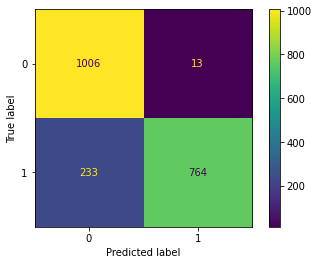

In [77]:
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
# features_test = model.predict_generator(test_datagen, steps= (test_data.shape[0]//batch_size)+1)
y_pred = model.predict(test_datagen)
y_pred_bin = np.where(y_pred > 0.5, 1, 0)
conf = confusion_matrix(test_labels, y_pred_bin)
disp = ConfusionMatrixDisplay(confusion_matrix= conf)


disp = disp.plot()

plt.show()